In [1]:
# Make channel segmenataion label

In [62]:
from pathlib import Path
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import seaborn as sb
from pycocotools.coco import COCO
import skimage.io as io

import cv2
from PIL import Image


In [82]:
class VCOCOandCOCO:
    def __init__(self, VCOCO_img_path, VCOCO_ann_path, COCO_ann_path, save_path=None):
        self.VCOCO_img_path = VCOCO_img_path
        self.VCOCO_ann_path = VCOCO_ann_path
        self.COCO_ann_path = COCO_ann_path
        
        self.VCOCO_img_list = self.getFileList(self.VCOCO_img_path, '*')
        self.VCOCO_ann = self.load_json_file(self.VCOCO_ann_path)
        self.COCO_ann = COCO(self.COCO_ann_path)
        
        print("Find image:", len(self.VCOCO_img_list))
        print("Find annotation", len(self.VCOCO_ann))
        
        
        self.cats_ids = self.COCO_ann.getCatIds()
        self.cats = self.COCO_ann.loadCats(self.cats_ids)
        self.save_path = Path(save_path)
        
    def getFileList(self, path:str, key:str)-> list:
        path = Path(path)
        return list(path.glob(key))
        
    def load_json_file(self, path):
        if type(path) is list:
            ret = {}
            for ipath in path:
                with open(Path(ipath), 'r') as f:
                    j = json.load(f)
                    ret.update(j)
            return ret
        else:
            with open(Path(path), 'r') as f:
                return json.load(f)
    

    def getMM2XY(self, bb_mm):
        xmin, ymin, xmax, ymax = bb_mm
        return (xmin, ymin, xmax-xmin, ymax-ymin)
    
    def getXY2MM(self, bb_xy):
        xmin, ymin, xmax, ymax = bb_xy
        return (xmin, ymin, xmax+xmin, ymax+ymin)
    
    
    def getIOU(self, B1, B2):
        xminB1, yminB1, xmaxB1, ymaxB1 = B1
        xminB2, yminB2, xmaxB2, ymaxB2 = B2

        box1_area = (xmaxB1 - xminB1 + 1) * (ymaxB1 - yminB1 + 1);
        box2_area = (xmaxB2 - xminB2 + 1) * (ymaxB2 - yminB2 + 1);

        x1 = max(xminB1, xminB2)
        y1 = max(yminB1, yminB2)
        x2 = min(xmaxB1, xmaxB2)
        y2 = min(ymaxB1, ymaxB2)

        # compute the width and height of the intersection
        w = max(0, x2 - x1 + 1)
        h = max(0, y2 - y1 + 1)

        inter = w * h
        iou = inter / (box1_area + box2_area - inter)
        return iou
    
    def getClassName(self, classID):
        if type(classID) is str:
            classID = int(classID)
            
        for cat in self.cats:
            if cat['id']==classID:
                return cat['name']
        return "None"

    def getAnno(self, idx):
        idx = str(idx)
        for key, val in self.VCOCO_ann.items():
            if str(key) == idx:
                return val
        print(f"ID({idx}) is not found")
    
    def getImg(self, idx):
        img_path = self.VCOCO_img_list[idx]
        img_id = str(img_path).split('_')[-1].split('.')[0].lstrip('0')
        img_id = int(img_id)
        img_info = self.COCO_ann.loadImgs(img_id)[0]
        file_name = img_info['file_name']
#         print(img, img_info)
        print(file_name)

#         I = io.imread('{}/{}'.format(dataDir, file_name))/255.0
        I = io.imread(img_path)/255.0
        print(I.shape)
        plt.axis('off')
        plt.imshow(I)
        plt.show()
    
    
    def getSeg(self, idx):
        img_path = self.VCOCO_img_list[idx]
        img_id = str(img_path).split('_')[-1].split('.')[0].lstrip('0')
        img_id = int(img_id)
        
        img_info = self.COCO_ann.loadImgs(img_id)[0]
        file_name = img_info['file_name']
        print(file_name)
        
        annIds = self.COCO_ann.getAnnIds(imgIds=img_id, iscrowd=None)
        print(img_path)
        print(annIds)

        anns = self.COCO_ann.loadAnns(annIds)
#         coco.showAnns(anns)
#         print(anns[0].size())
        
        vval = self.getAnno(img_id)
        for val in vval:
            print(val)

        mask = np.zeros((img_info['height'],img_info['width']))
        for ann in anns:
            print(ann['bbox'], ann['category_id'], self.getClassName(ann['category_id']))
            pixel_value = int(ann['category_id'])
            mask = np.maximum(self.COCO_ann.annToMask(ann)*pixel_value, mask)
            
        print(np.unique(mask))
        plt.imshow(mask, cmap='jet')
        plt.show()
        
        
    def getTargetSeg(self, idx, is_save=False):
        img_path = self.VCOCO_img_list[idx]
        img_id = str(img_path).split('_')[-1].split('.')[0].lstrip('0')
        img_id = int(img_id)
        
        img_info = self.COCO_ann.loadImgs(img_id)[0]
        file_name = img_info['file_name']
        print(file_name)
        
        annIds = self.COCO_ann.getAnnIds(imgIds=img_id, iscrowd=None)
        anns = self.COCO_ann.loadAnns(annIds)
        
        filtered_3mask = np.zeros((img_info['height'], img_info['width'], 3))
        vccs = self.getAnno(img_id)
        for vcc in vccs:
            print(vcc)
            pseg = None
            oseg = None
            for ann in anns:
                if self.getIOU(self.getXY2MM(ann['bbox']), vcc['person_bbx']) == 1.0:
#                     piou = self.getIOU(self.getXY2MM(ann['bbox']), vcc['person_bbx'])
                    pseg = self.COCO_ann.annToMask(ann)
                    pixel_value = int(ann['category_id'])
#                     filtered_mask = np.maximum(self.COCO_ann.annToMask(ann)*pixel_value, filtered_mask)
#                     filtered_3mask[...,0] = np.maximum(pseg*pixel_value, filtered_3mask[...,0])
                    filtered_3mask[...,0] = np.maximum(pseg*255, filtered_3mask[...,0])
                    print(self.getClassName(ann['category_id']))
                    
                if len(vcc['object']['obj_bbx']) != 0:
                    if self.getIOU(self.getXY2MM(ann['bbox']), vcc['object']['obj_bbx']) == 1.0:
#                         oiou = self.getIOU(self.getXY2MM(ann['bbox']), vcc['object']['obj_bbx'])
                        oseg = self.COCO_ann.annToMask(ann)
                        pixel_value = int(ann['category_id'])
#                         filtered_mask = np.maximum(self.COCO_ann.annToMask(ann)*pixel_value, filtered_mask)
                        filtered_3mask[...,1] = np.maximum(oseg*pixel_value, filtered_3mask[...,1])
                        print(self.getClassName(ann['category_id']))
            print(vcc['Verbs'])
            if pseg is not None and oseg is not None:
                filtered_3mask[...,2] = np.maximum(pseg*255, filtered_3mask[...,2])
                filtered_3mask[...,2] = np.maximum(oseg*255, filtered_3mask[...,2])
                print(vcc['Verbs'], 'interaction') 
            
        plt.imshow(filtered_3mask.astype(np.uint8), cmap='jet')
        plt.axis('off')
        plt.show()


#         filtered_mask = np.zeros((img_info['height'],img_info['width']))
#         for ann in anns:
# #             print(ann['bbox'])
#     #         print(getClassName(ann['category_id'], cats))
#             if "person" == self.getClassName(ann['category_id']):
#     #             break
#                 for val in vccs:
#                     iou = self.getIOU(self.getXY2MM(ann['bbox']), val['person_bbx'])
#                     if iou == 1.0:
#                         pixel_value = int(ann['category_id'])
#                         filtered_mask = np.maximum(self.COCO_ann.annToMask(ann)*pixel_value, filtered_mask)
#                         print(self.getClassName(ann['category_id']))

#     #                 print(iou)
#             else:
#                 for val in vccs:
#                     if len(val['object']['obj_bbx']) != 0:
#                         iou = self.getIOU(self.getXY2MM(ann['bbox']), val['object']['obj_bbx'])
#                         if iou == 1.0:
#                             pixel_value = int(ann['category_id'])
#                             filtered_mask = np.maximum(self.COCO_ann.annToMask(ann)*pixel_value, filtered_mask)
#                             print(self.getClassName(ann['category_id']))
#     #                     print(iou)
    
        if is_save:
            assert not self.save_path is None, 'TO save file, should put in save_path'
            save_path = self.save_path / file_name.replace('.jpg', '.png')
            if not save_path.parent.exists():
                save_path.parent.mkdir(exist_ok=True, parents=True)
#             np.save(save_path, mask)
            print(filtered_3mask.shape)
            im = Image.fromarray(filtered_3mask.astype(np.uint8))
            im.save(save_path)
        else:
            plt.imshow(filtered_mask, cmap='jet')
            plt.axis('off')
            plt.show()

# VCOCOandCOCO('./data/Data_vcoco/train2014', 
#              ['./data/Annotations_vcoco/train_annotations.json',
#              './data/Annotations_vcoco/val_annotations.json'],
#             './data/Annotations_coco/instances_train2014.json')

    
VCC = VCOCOandCOCO('./data/Data_vcoco/val2014', 
                   './data/Annotations_vcoco/test_annotations.json',
                   './data/Annotations_coco/instances_val2014.json',
                   './output_files/segmentation/val')

# VCC = VCOCOandCOCO('./data/Data_vcoco/train2014', 
#              ['./data/Annotations_vcoco/train_annotations.json',
#              './data/Annotations_vcoco/val_annotations.json'],
#             './data/Annotations_coco/instances_train2014.json',
#                   './output_files/segmentation/train')

loading annotations into memory...
Done (t=3.76s)
creating index...
index created!
Find image: 4940
Find annotation 4946


COCO_train2014_000000504122.jpg
(428, 640, 3)


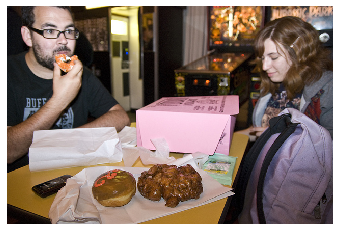

In [67]:
VCC.getImg(200)

COCO_val2014_000000061603.jpg
data/Data_vcoco/val2014/COCO_val2014_000000061603.jpg
[324391, 429072]
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'hold', 'object': {'obj_bbx': [123.78, 136.26, 250.44, 212.06]}}
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [123.78, 136.26, 250.44, 212.06]}}
[123.78, 136.26, 126.66, 75.8] 77 cell phone
[3.86, 2.65, 636.14, 419.29] 1 person
[ 0.  1. 77.]


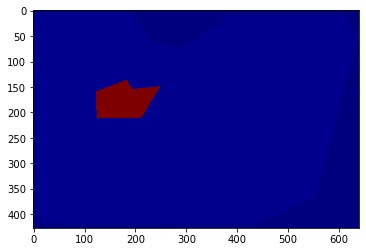

In [5]:
VCC.getSeg(1500)

In [6]:
len(VCC.VCOCO_img_list)

4940

COCO_val2014_000000433676.jpg
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


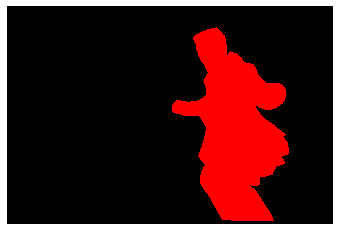

(427, 640, 3)


In [83]:
VCC.getTargetSeg(2500, is_save=True)

COCO_val2014_000000441218.jpg
{'person_bbx': [120.48, 34.42, 227.49, 201.3], 'Verbs': 'jump', 'object': {'obj_bbx': [89.75, 170.45, 285.91999999999996, 219.95999999999998]}}
person
skis
jump
jump interaction
{'person_bbx': [120.48, 34.42, 227.49, 201.3], 'Verbs': 'look', 'object': {'obj_bbx': [89.75, 170.45, 285.91999999999996, 219.95999999999998]}}
person
skis
look
look interaction
{'person_bbx': [120.48, 34.42, 227.49, 201.3], 'Verbs': 'ski', 'object': {'obj_bbx': [89.75, 170.45, 285.91999999999996, 219.95999999999998]}}
person
skis
ski
ski interaction


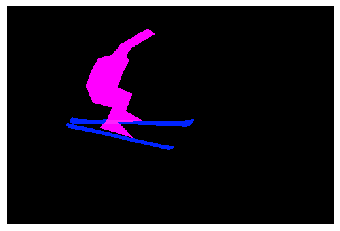

(333, 500, 3)
COCO_val2014_000000292647.jpg
{'person_bbx': [232.19, 248.07, 296.65, 348.97], 'Verbs': 'hold', 'object': {'obj_bbx': [160.84, 14.08, 281.98, 329.65999999999997]}}
boat
person
hold
hold interaction
{'person_bbx': [232.19, 248.07, 296.65, 348.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


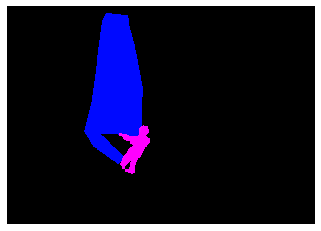

(453, 640, 3)
COCO_val2014_000000474465.jpg
{'person_bbx': [140.08, 151.14, 246.05, 505.94], 'Verbs': 'catch', 'object': {'obj_bbx': [215.06, 139.77, 247.5, 171.9]}}
person
frisbee
catch
catch interaction
{'person_bbx': [140.08, 151.14, 246.05, 505.94], 'Verbs': 'hold', 'object': {'obj_bbx': [215.06, 139.77, 247.5, 171.9]}}
person
frisbee
hold
hold interaction
{'person_bbx': [140.08, 151.14, 246.05, 505.94], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [140.08, 151.14, 246.05, 505.94], 'Verbs': 'look', 'object': {'obj_bbx': [215.06, 139.77, 247.5, 171.9]}}
person
frisbee
look
look interaction
{'person_bbx': [140.08, 151.14, 246.05, 505.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


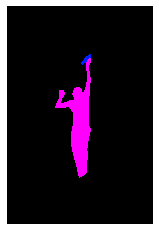

(640, 427, 3)
COCO_val2014_000000153578.jpg
{'person_bbx': [80.98, 16.41, 394.40000000000003, 420.27000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 1.44, 475.09, 252.45]}}
umbrella
person
hold
hold interaction
{'person_bbx': [80.98, 16.41, 394.40000000000003, 420.27000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [80.98, 16.41, 394.40000000000003, 420.27000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


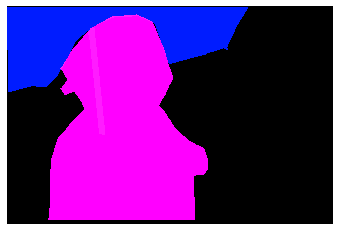

(427, 640, 3)
COCO_val2014_000000412879.jpg
{'person_bbx': [183.14, 161.91, 315.4, 487.53], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [181.01, 89.26, 237.07, 194.64]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [183.14, 161.91, 315.4, 487.53], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [187.69, 98.71, 214.09, 129.37]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [183.14, 161.91, 315.4, 487.53], 'Verbs': 'hold', 'object': {'obj_bbx': [181.01, 89.26, 237.07, 194.64]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [183.14, 161.91, 315.4, 487.53], 'Verbs': 'look', 'object': {'obj_bbx': [187.69, 98.71, 214.09, 129.37]}}
sports ball
person
look
look interaction
{'person_bbx': [183.14, 161.91, 315.4, 487.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


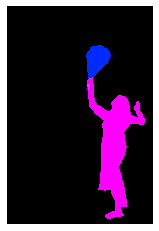

(500, 334, 3)
COCO_val2014_000000243341.jpg
{'person_bbx': [269.78, 174.31, 346.46, 344.05], 'Verbs': 'look', 'object': {'obj_bbx': [286.38, 334.75, 348.87, 353.91]}}
person
surfboard
look
look interaction
{'person_bbx': [269.78, 174.31, 346.46, 344.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [269.78, 174.31, 346.46, 344.05], 'Verbs': 'surf', 'object': {'obj_bbx': [286.38, 334.75, 348.87, 353.91]}}
person
surfboard
surf
surf interaction


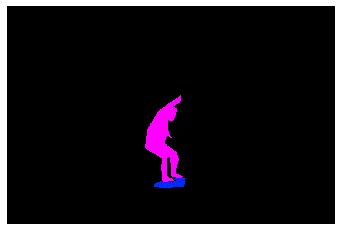

(425, 640, 3)
COCO_val2014_000000236023.jpg
{'person_bbx': [294.7, 49.96, 477.62, 370.91999999999996], 'Verbs': 'drink', 'object': {'obj_bbx': [316.71, 175.3, 359.71999999999997, 206.24]}}
person
cup
drink
drink interaction
{'person_bbx': [0.0, 47.85, 141.42, 372.19], 'Verbs': 'drink', 'object': {'obj_bbx': [91.98, 188.87, 135.42000000000002, 228.59]}}
person
cup
drink
drink interaction
{'person_bbx': [294.7, 49.96, 477.62, 370.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [316.71, 175.3, 359.71999999999997, 206.24]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 47.85, 141.42, 372.19], 'Verbs': 'hold', 'object': {'obj_bbx': [91.98, 188.87, 135.42000000000002, 228.59]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 47.85, 141.42, 372.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [294.7, 49.96, 477.62, 370.91999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 47.85, 141.42, 372.19], 'Verbs'

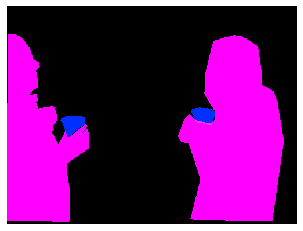

(376, 500, 3)
COCO_val2014_000000337563.jpg
{'person_bbx': [236.21, 2.98, 640.0, 473.23], 'Verbs': 'hold', 'object': {'obj_bbx': [330.41, 183.65, 383.66, 383.33000000000004]}}
person
banana
hold
hold interaction
{'person_bbx': [236.21, 2.98, 640.0, 473.23], 'Verbs': 'look', 'object': {'obj_bbx': [11.77, 181.63, 241.41, 480.0]}}
person
person
look
look interaction
{'person_bbx': [236.21, 2.98, 640.0, 473.23], 'Verbs': 'sit', 'object': {'obj_bbx': [2.15, 263.68, 397.13, 472.47]}}
bed
person
sit
sit interaction


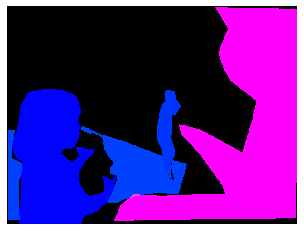

(480, 640, 3)
COCO_val2014_000000154644.jpg
{'person_bbx': [3.37, 60.67, 498.88, 493.26], 'Verbs': 'hold', 'object': {'obj_bbx': [224.36, 163.5, 337.42, 227.69]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.37, 60.67, 498.88, 493.26], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [224.36, 163.5, 337.42, 227.69]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


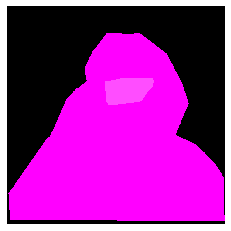

(500, 500, 3)
COCO_val2014_000000153797.jpg
{'person_bbx': [322.52, 107.21, 436.03999999999996, 327.93], 'Verbs': 'look', 'object': {'obj_bbx': [142.48, 97.23, 155.20999999999998, 108.59]}}
sports ball
person
look
look interaction
{'person_bbx': [322.52, 107.21, 436.03999999999996, 327.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [322.52, 107.21, 436.03999999999996, 327.93], 'Verbs': 'throw', 'object': {'obj_bbx': [142.48, 97.23, 155.20999999999998, 108.59]}}
sports ball
person
throw
throw interaction


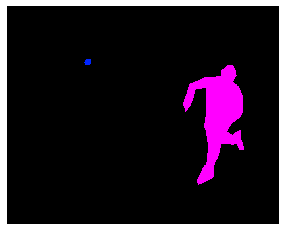

(400, 500, 3)
COCO_val2014_000000259761.jpg
{'person_bbx': [44.38, 11.3, 195.60999999999999, 336.1], 'Verbs': 'hold', 'object': {'obj_bbx': [162.26, 211.46, 189.76, 250.18]}}
person
cup
hold
hold interaction
{'person_bbx': [227.3, 52.53, 351.46000000000004, 305.62], 'Verbs': 'look', 'object': {'obj_bbx': [241.14, 301.8, 381.94, 391.39]}}
person
cake
look
look interaction
{'person_bbx': [344.59, 104.81, 447.96999999999997, 327.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [376.29, 212.02, 546.29, 420.22], 'Verbs': 'look', 'object': {'obj_bbx': [241.14, 301.8, 381.94, 391.39]}}
person
cake
look
look interaction
{'person_bbx': [44.38, 11.3, 195.60999999999999, 336.1], 'Verbs': 'look', 'object': {'obj_bbx': [241.14, 301.8, 381.94, 391.39]}}
person
cake
look
look interaction
{'person_bbx': [376.29, 212.02, 546.29, 420.22], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [227.3, 52.53, 351.46000000000004, 305.62], 'Verbs': 'smile

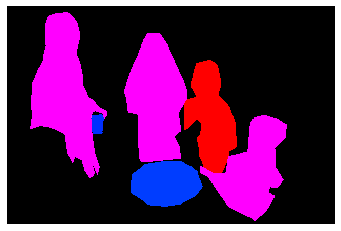

(425, 640, 3)
COCO_val2014_000000279974.jpg
{'person_bbx': [0.0, 176.67, 246.08, 480.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [185.39, 316.53, 342.07, 480.0]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 176.67, 246.08, 480.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [521.37, 116.93, 561.51, 156.16]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [0.0, 176.67, 246.08, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [185.39, 316.53, 342.07, 480.0]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.0, 176.67, 246.08, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [521.37, 116.93, 561.51, 156.16]}}
sports ball
person
look
look interaction
{'person_bbx': [394.79, 85.21, 601.89, 435.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 176.67, 246.08, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


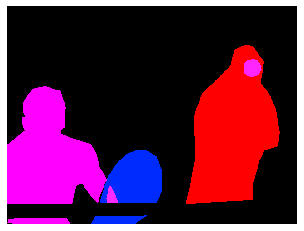

(480, 640, 3)
COCO_val2014_000000350289.jpg
{'person_bbx': [96.84, 266.07, 138.78, 397.58], 'Verbs': 'carry', 'object': {'obj_bbx': [58.89, 280.0, 203.7, 347.39]}}
person
surfboard
carry
carry interaction
{'person_bbx': [526.73, 273.97, 585.44, 407.71000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [455.01, 266.41, 639.14, 285.76000000000005]}}
person
surfboard
carry
carry interaction
{'person_bbx': [96.84, 266.07, 138.78, 397.58], 'Verbs': 'hold', 'object': {'obj_bbx': [58.89, 280.0, 203.7, 347.39]}}
person
surfboard
hold
hold interaction
{'person_bbx': [526.73, 273.97, 585.44, 407.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [455.01, 266.41, 639.14, 285.76000000000005]}}
person
surfboard
hold
hold interaction
{'person_bbx': [96.84, 266.07, 138.78, 397.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [526.73, 273.97, 585.44, 407.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [96.84, 266.07, 138.78

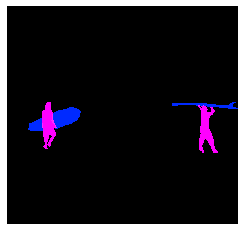

(604, 640, 3)
COCO_val2014_000000095476.jpg
{'person_bbx': [271.22, 146.54, 374.43, 358.89], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [75.48, 161.58, 164.95, 370.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [271.22, 146.54, 374.43, 358.89], 'Verbs': 'ski', 'object': {'obj_bbx': [230.12, 300.06, 451.52, 386.63]}}
person
skis
ski
ski interaction
{'person_bbx': [75.48, 161.58, 164.95, 370.15], 'Verbs': 'ski', 'object': {'obj_bbx': [55.09, 316.19, 215.54, 404.05]}}
person
skis
ski
ski interaction
{'person_bbx': [271.22, 146.54, 374.43, 358.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [75.48, 161.58, 164.95, 370.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


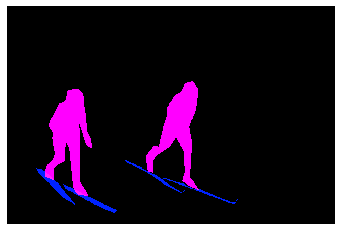

(425, 640, 3)
COCO_val2014_000000471154.jpg
{'person_bbx': [216.78, 94.99, 461.81, 365.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [233.97, 138.46, 263.77, 154.11]}}
cell phone
person
hold
hold interaction
{'person_bbx': [216.78, 94.99, 461.81, 365.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [216.78, 94.99, 461.81, 365.09000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [7.0, 10.0, 639.0, 423.0]}}
person
car
ride
ride interaction
{'person_bbx': [0.0, 97.42, 216.8, 335.22], 'Verbs': 'ride', 'object': {'obj_bbx': [7.0, 10.0, 639.0, 423.0]}}
person
car
ride
ride interaction
{'person_bbx': [216.78, 94.99, 461.81, 365.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 97.42, 216.8, 335.22], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [216.78, 94.99, 461.81, 365.09000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [233.97, 138.46, 263.77, 154.11]}}
cell ph

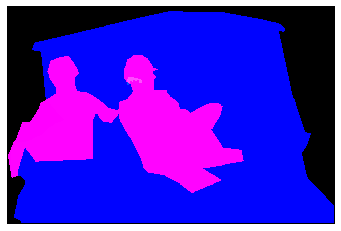

(425, 640, 3)
COCO_val2014_000000482275.jpg
{'person_bbx': [92.56, 24.88, 390.67, 472.59], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [373.4, 221.83, 424.25, 257.81]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [92.56, 24.88, 390.67, 472.59], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [384.0, 247.01, 532.85, 309.57]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [92.56, 24.88, 390.67, 472.59], 'Verbs': 'hold', 'object': {'obj_bbx': [241.62, 45.3, 464.9, 468.13]}}
person
person
hold
hold interaction
{'person_bbx': [241.62, 45.3, 464.9, 468.13], 'Verbs': 'hold', 'object': {'obj_bbx': [373.4, 221.83, 424.25, 257.81]}}
person
knife
hold
hold interaction
{'person_bbx': [92.56, 24.88, 390.67, 472.59], 'Verbs': 'look', 'object': {'obj_bbx': [384.0, 247.01, 532.85, 309.57]}}
person
cake
look
look interaction
{'person_bbx': [241.62, 45.3, 464.9, 468.13], 'Verbs': 'look', 'object': {'obj_bbx': [384.0, 247.01, 532.85, 309.57]}}
person
cake
look
look interaction
{'person

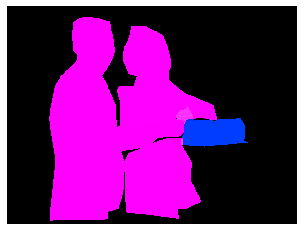

(480, 640, 3)
COCO_val2014_000000495160.jpg
{'person_bbx': [261.18, 104.03, 395.06, 348.11], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [261.18, 104.03, 395.06, 348.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


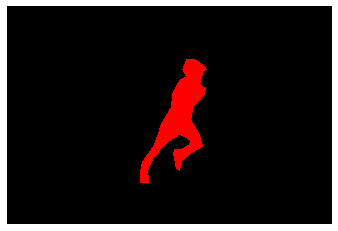

(429, 640, 3)
COCO_val2014_000000535306.jpg
{'person_bbx': [113.51, 2.44, 325.48, 209.91], 'Verbs': 'jump', 'object': {'obj_bbx': [150.41, 117.49, 373.40999999999997, 231.98]}}
person
skateboard
jump
jump interaction
{'person_bbx': [113.51, 2.44, 325.48, 209.91], 'Verbs': 'skateboard', 'object': {'obj_bbx': [150.41, 117.49, 373.40999999999997, 231.98]}}
person
skateboard
skateboard
skateboard interaction


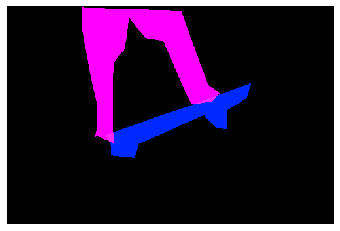

(333, 500, 3)
COCO_val2014_000000250083.jpg
{'person_bbx': [241.84, 154.97, 305.34000000000003, 245.84], 'Verbs': 'look', 'object': {'obj_bbx': [209.37, 210.53, 306.86, 254.84]}}
surfboard
person
look
look interaction
{'person_bbx': [241.84, 154.97, 305.34000000000003, 245.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.84, 154.97, 305.34000000000003, 245.84], 'Verbs': 'surf', 'object': {'obj_bbx': [209.37, 210.53, 306.86, 254.84]}}
surfboard
person
surf
surf interaction


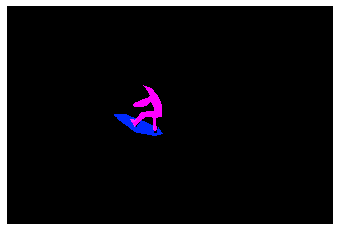

(427, 640, 3)
COCO_val2014_000000345160.jpg
{'person_bbx': [297.71, 118.93, 419.96, 548.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [198.92, 140.54, 345.95, 624.86], 'Verbs': 'hold', 'object': {'obj_bbx': [1.43, 317.99, 460.0, 637.4000000000001]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [297.71, 118.93, 419.96, 548.95], 'Verbs': 'ride', 'object': {'obj_bbx': [1.43, 317.99, 460.0, 637.4000000000001]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [198.92, 140.54, 345.95, 624.86], 'Verbs': 'ride', 'object': {'obj_bbx': [1.43, 317.99, 460.0, 637.4000000000001]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [297.71, 118.93, 419.96, 548.95], 'Verbs': 'sit', 'object': {'obj_bbx': [1.43, 317.99, 460.0, 637.4000000000001]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [198.92, 140.54, 345.95, 624.86], 'Verbs': 'sit', 'object': {'obj_bbx': [1.43, 317.99, 460.0, 637.4000000000001]}}
motorcycle
person
sit
sit interaction
{'

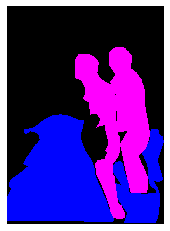

(640, 460, 3)
COCO_val2014_000000247259.jpg
{'person_bbx': [115.61, 179.87, 219.13, 264.8], 'Verbs': 'look', 'object': {'obj_bbx': [133.1, 235.17, 192.0, 268.78]}}
person
laptop
look
look interaction
{'person_bbx': [373.69, 186.08, 431.92, 268.69], 'Verbs': 'look', 'object': {'obj_bbx': [331.56, 229.44, 410.65, 273.86]}}
person
laptop
look
look interaction
{'person_bbx': [500.05, 167.58, 592.04, 286.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [452.33, 235.57, 535.48, 282.0]}}
laptop
person
look
look interaction
{'person_bbx': [246.7, 173.22, 318.48, 264.85], 'Verbs': 'sit', 'object': {'obj_bbx': [313.22, 232.35, 337.09000000000003, 267.09]}}
person
chair
sit
sit interaction
{'person_bbx': [115.61, 179.87, 219.13, 264.8], 'Verbs': 'sit', 'object': {'obj_bbx': [115.11, 229.96, 131.66, 259.39]}}
chair
person
sit
sit interaction
{'person_bbx': [373.69, 186.08, 431.92, 268.69], 'Verbs': 'sit', 'object': {'obj_bbx': [422.89, 237.27, 439.02, 271.22]}}
chair
person
sit
sit interact

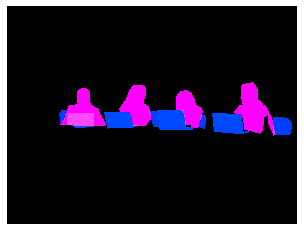

(480, 640, 3)
COCO_val2014_000000221094.jpg
{'person_bbx': [335.88, 132.56, 430.49, 317.84000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [424.14, 250.98, 538.93, 349.23]}}
person
suitcase
carry
carry interaction
{'person_bbx': [335.88, 132.56, 430.49, 317.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [424.14, 250.98, 538.93, 349.23]}}
person
suitcase
hold
hold interaction
{'person_bbx': [295.6, 110.46, 387.73, 315.84], 'Verbs': 'hold', 'object': {'obj_bbx': [229.17, 191.4, 432.80999999999995, 339.56]}}
bicycle
person
hold
hold interaction
{'person_bbx': [335.88, 132.56, 430.49, 317.84000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [229.17, 191.4, 432.80999999999995, 339.56]}}
bicycle
person
ride
ride interaction
{'person_bbx': [295.6, 110.46, 387.73, 315.84], 'Verbs': 'ride', 'object': {'obj_bbx': [229.17, 191.4, 432.80999999999995, 339.56]}}
bicycle
person
ride
ride interaction
{'person_bbx': [335.88, 132.56, 430.49, 317.84000000000003], 'Verbs': 'sit', 'object

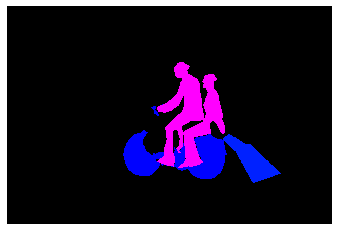

(429, 640, 3)
COCO_val2014_000000560439.jpg
{'person_bbx': [260.15, 40.02, 362.10999999999996, 305.89], 'Verbs': 'hold', 'object': {'obj_bbx': [298.36, 123.35, 348.24, 189.87]}}
person
backpack
hold
hold interaction
{'person_bbx': [84.27, 102.56, 188.72, 325.89], 'Verbs': 'hold', 'object': {'obj_bbx': [84.48, 205.75, 130.57, 258.78]}}
person
handbag
hold
hold interaction
{'person_bbx': [260.15, 40.02, 362.10999999999996, 305.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [378.95, 72.67, 518.06, 290.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.27, 102.56, 188.72, 325.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [260.15, 40.02, 362.10999999999996, 305.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [378.95, 72.67, 518.06, 290.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [84.27, 102.56, 188.72, 325.89], 'Verbs': 'stand', 'objec

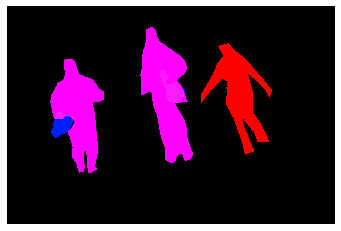

(425, 640, 3)
COCO_val2014_000000278742.jpg
{'person_bbx': [5.76, 102.67, 107.47, 311.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [267.96, 168.75, 420.54999999999995, 316.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [350.61, 198.63, 410.26, 240.95999999999998]}}
person
laptop
hold
hold interaction
{'person_bbx': [267.96, 168.75, 420.54999999999995, 316.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [350.61, 198.63, 410.26, 240.95999999999998]}}
person
laptop
look
look interaction
{'person_bbx': [505.73, 156.51, 622.7, 357.94], 'Verbs': 'sit', 'object': {'obj_bbx': [513.09, 218.08, 623.3100000000001, 373.21000000000004]}}
person
chair
sit
sit interaction
{'person_bbx': [267.96, 168.75, 420.54999999999995, 316.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [259.83, 220.76, 363.0, 365.96]}}
chair
person
sit
sit interaction
{'person_bbx': [5.76, 102.67, 107.47, 311.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'p

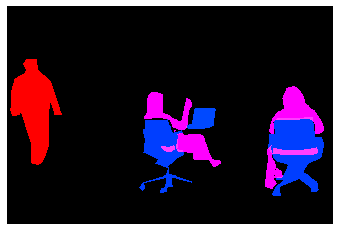

(427, 640, 3)
COCO_val2014_000000524456.jpg
{'person_bbx': [120.89, 0.0, 636.4399999999999, 298.67], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [120.89, 0.0, 636.4399999999999, 298.67], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.65, 2.7, 420.03, 258.12]}}
laptop
person
work_on_computer
work_on_computer interaction


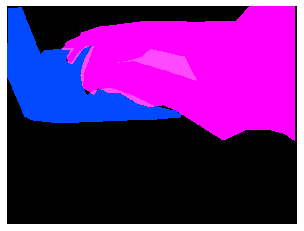

(480, 640, 3)
COCO_val2014_000000474021.jpg
{'person_bbx': [17.74, 81.58, 225.53, 370.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [166.69, 171.55, 182.62, 213.79000000000002]}}
person
remote
hold
hold interaction
{'person_bbx': [250.28, 16.91, 500.0, 369.16], 'Verbs': 'hold', 'object': {'obj_bbx': [367.98, 184.55, 380.61, 198.22]}}
person
remote
hold
hold interaction
{'person_bbx': [17.74, 81.58, 225.53, 370.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [250.28, 16.91, 500.0, 369.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


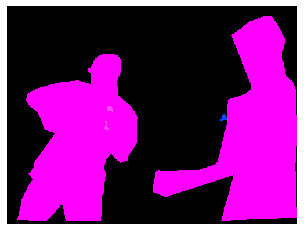

(375, 500, 3)
COCO_val2014_000000024040.jpg
{'person_bbx': [118.32, 103.98, 311.95, 352.28000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [258.18, 66.85, 463.45000000000005, 301.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [438.44, 81.94, 554.43, 300.1], 'Verbs': 'hold', 'object': {'obj_bbx': [460.79, 282.01, 556.5600000000001, 327.76]}}
person
skis
hold
hold interaction
{'person_bbx': [438.44, 81.94, 554.43, 300.1], 'Verbs': 'look', 'object': {'obj_bbx': [460.79, 282.01, 556.5600000000001, 327.76]}}
person
skis
look
look interaction
{'person_bbx': [118.32, 103.98, 311.95, 352.28000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [159.2, 297.83, 342.54999999999995, 383.69]}}
person
skis
ski
ski interaction
{'person_bbx': [258.18, 66.85, 463.45000000000005, 301.73], 'Verbs': 'ski', 'object': {'obj_bbx': [290.61, 293.78, 389.95000000000005, 321.78999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [438.44, 8

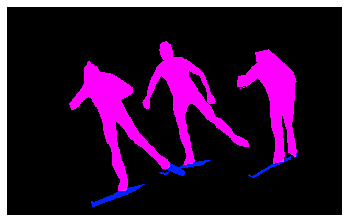

(398, 640, 3)
COCO_val2014_000000005032.jpg
{'person_bbx': [214.05, 23.24, 378.38, 398.38], 'Verbs': 'hold', 'object': {'obj_bbx': [313.12, 41.1, 478.22, 465.24]}}
person
person
hold
hold interaction
{'person_bbx': [214.05, 23.24, 378.38, 398.38], 'Verbs': 'ski', 'object': {'obj_bbx': [103.78, 396.22, 299.46000000000004, 455.68]}}
person
skis
ski
ski interaction
{'person_bbx': [313.12, 41.1, 478.22, 465.24], 'Verbs': 'ski', 'object': {'obj_bbx': [247.34, 397.4, 515.62, 480.0]}}
person
skis
ski
ski interaction
{'person_bbx': [214.05, 23.24, 378.38, 398.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [313.12, 41.1, 478.22, 465.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [313.12, 41.1, 478.22, 465.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


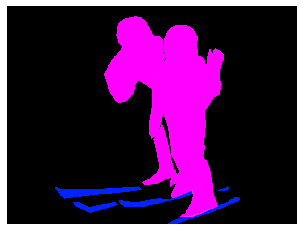

(480, 640, 3)
COCO_val2014_000000355247.jpg
{'person_bbx': [60.67, 40.45, 237.07999999999998, 500.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [60.67, 40.45, 237.07999999999998, 500.0], 'Verbs': 'look', 'object': {'obj_bbx': [167.5, 20.31, 230.57, 77.05]}}
person
sports ball
look
look interaction
{'person_bbx': [60.67, 40.45, 237.07999999999998, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.67, 40.45, 237.07999999999998, 500.0], 'Verbs': 'throw', 'object': {'obj_bbx': [167.5, 20.31, 230.57, 77.05]}}
person
sports ball
throw
throw interaction


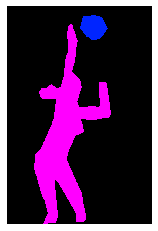

(500, 332, 3)
COCO_val2014_000000375469.jpg
{'person_bbx': [314.12, 73.96, 379.41, 139.25], 'Verbs': 'surf', 'object': {'obj_bbx': [329.1, 123.82, 429.47, 141.48]}}
person
surfboard
surf
surf interaction
{'person_bbx': [220.56, 61.9, 301.64, 160.17], 'Verbs': 'surf', 'object': {'obj_bbx': [236.5, 135.55, 454.5, 168.05]}}
person
surfboard
surf
surf interaction


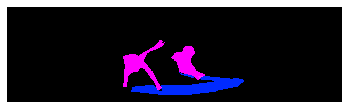

(181, 640, 3)
COCO_val2014_000000502393.jpg
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [227.56, 52.07, 235.59, 60.32]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'look', 'object': {'obj_bbx': [227.56, 52.07, 235.59, 60.32]}}
sports ball
person
look
look interaction
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [238.92, 129.96, 341.43, 331.75], 'Verbs': 'throw', 'object': {'obj_bbx': [227.56, 52.07, 235.59, 60.32]}}
sports ball
person
throw
throw interaction


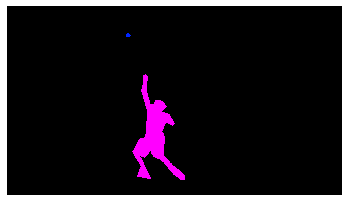

(360, 640, 3)
COCO_val2014_000000455675.jpg
{'person_bbx': [266.19, 242.0, 441.85, 531.1600000000001], 'Verbs': 'carry', 'object': {'obj_bbx': [367.3, 298.6, 457.08000000000004, 433.27]}}
person
backpack
carry
carry interaction
{'person_bbx': [266.19, 242.0, 441.85, 531.1600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [253.54, 351.2, 461.0, 604.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [266.19, 242.0, 441.85, 531.1600000000001], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 158.8, 71.94, 384.12]}}
person
person
look
look interaction
{'person_bbx': [266.19, 242.0, 441.85, 531.1600000000001], 'Verbs': 'ride', 'object': {'obj_bbx': [253.54, 351.2, 461.0, 604.0]}}
bicycle
person
ride
ride interaction
{'person_bbx': [0.0, 158.8, 71.94, 384.12], 'Verbs': 'ride', 'object': {'obj_bbx': [0.03, 376.68, 95.03, 547.99]}}
bicycle
person
ride
ride interaction
{'person_bbx': [266.19, 242.0, 441.85, 531.1600000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [253.54, 351.2, 461.0, 60

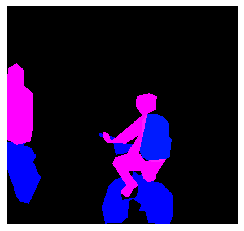

(604, 640, 3)
COCO_val2014_000000053145.jpg
{'person_bbx': [173.88, 279.15, 262.40999999999997, 331.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [176.72, 321.67, 277.1, 338.94]}}
person
surfboard
hold
hold interaction
{'person_bbx': [119.35, 203.79, 208.92, 318.14], 'Verbs': 'look', 'object': {'obj_bbx': [173.88, 279.15, 262.40999999999997, 331.97999999999996]}}
person
person
look
look interaction
{'person_bbx': [173.88, 279.15, 262.40999999999997, 331.97999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [443.67, 145.53, 507.28000000000003, 292.46000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [119.35, 203.79, 208.92, 318.14], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [173.88, 279.15, 262.40999999999997, 331.97999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [176.72, 321.67, 277.1, 338.94]}}
person
surfboard
surf
surf interaction
{'person_bbx': [443.67, 145.53, 507.28

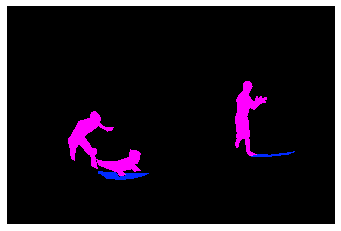

(425, 640, 3)
COCO_val2014_000000517472.jpg
{'person_bbx': [133.1, 87.9, 540.76, 312.08000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [133.1, 87.9, 540.76, 312.08000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


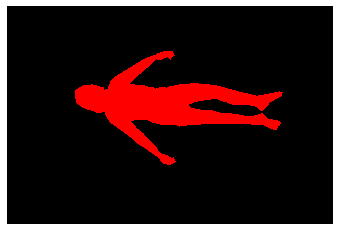

(427, 640, 3)
COCO_val2014_000000445908.jpg
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [441.38, 14.32, 488.05, 122.24000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [71.49, 221.72, 91.06, 239.43]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'hold', 'object': {'obj_bbx': [441.38, 14.32, 488.05, 122.24000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'look', 'object': {'obj_bbx': [71.49, 221.72, 91.06, 239.43]}}
sports ball
person
look
look interaction
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [413.56, 16.34, 605.97, 347.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


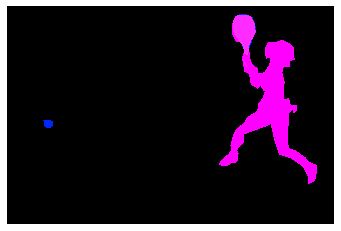

(426, 640, 3)
COCO_val2014_000000378454.jpg
{'person_bbx': [47.68, 222.85, 296.26, 364.06], 'Verbs': 'catch', 'object': {'obj_bbx': [134.7, 327.47, 180.95999999999998, 363.77000000000004]}}
person
frisbee
catch
catch interaction
{'person_bbx': [47.68, 222.85, 296.26, 364.06], 'Verbs': 'hold', 'object': {'obj_bbx': [134.7, 327.47, 180.95999999999998, 363.77000000000004]}}
person
frisbee
hold
hold interaction
{'person_bbx': [47.68, 222.85, 296.26, 364.06], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [47.68, 222.85, 296.26, 364.06], 'Verbs': 'look', 'object': {'obj_bbx': [134.7, 327.47, 180.95999999999998, 363.77000000000004]}}
person
frisbee
look
look interaction


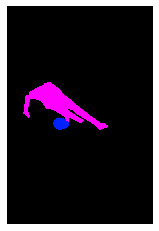

(640, 427, 3)
COCO_val2014_000000113041.jpg
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [351.75, 144.83, 402.25, 175.3]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [493.93, 210.73, 504.18, 219.47]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'hold', 'object': {'obj_bbx': [351.75, 144.83, 402.25, 175.3]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'look', 'object': {'obj_bbx': [493.93, 210.73, 504.18, 219.47]}}
sports ball
person
look
look interaction
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [258.35, 142.58, 358.36, 270.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


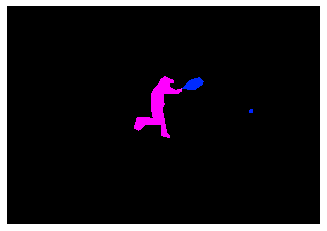

(445, 640, 3)
COCO_val2014_000000480210.jpg
{'person_bbx': [269.68, 146.37, 315.02, 260.93], 'Verbs': 'carry', 'object': {'obj_bbx': [210.56, 178.98, 325.82, 237.14]}}
person
surfboard
carry
carry interaction
{'person_bbx': [208.59, 157.37, 259.28, 295.27], 'Verbs': 'carry', 'object': {'obj_bbx': [210.56, 178.98, 325.82, 237.14]}}
surfboard
person
carry
carry interaction
{'person_bbx': [269.68, 146.37, 315.02, 260.93], 'Verbs': 'hold', 'object': {'obj_bbx': [210.56, 178.98, 325.82, 237.14]}}
person
surfboard
hold
hold interaction
{'person_bbx': [208.59, 157.37, 259.28, 295.27], 'Verbs': 'hold', 'object': {'obj_bbx': [210.56, 178.98, 325.82, 237.14]}}
surfboard
person
hold
hold interaction
{'person_bbx': [269.68, 146.37, 315.02, 260.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [208.59, 157.37, 259.28, 295.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [269.68, 146.37, 315.02, 260.93], 'Verbs': 'walk', 'object': {'obj_bbx': 

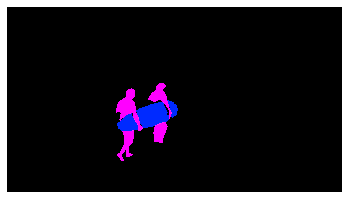

(354, 640, 3)
COCO_val2014_000000290130.jpg
{'person_bbx': [203.71, 122.63, 264.54, 202.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.71, 122.63, 264.54, 202.54], 'Verbs': 'surf', 'object': {'obj_bbx': [206.61, 198.28, 239.13000000000002, 209.43]}}
person
surfboard
surf
surf interaction


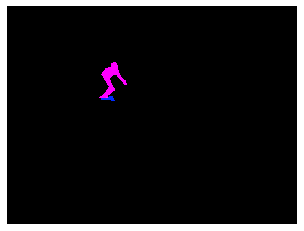

(480, 640, 3)
COCO_val2014_000000203350.jpg
{'person_bbx': [0.0, 25.43, 323.34, 421.68], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [295.14, 40.12, 588.38, 349.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 25.43, 323.34, 421.68]}}
person
person
look
look interaction
{'person_bbx': [0.0, 25.43, 323.34, 421.68], 'Verbs': 'look', 'object': {'obj_bbx': [295.14, 40.12, 588.38, 349.59000000000003]}}
person
person
look
look interaction
{'person_bbx': [295.14, 40.12, 588.38, 349.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 25.43, 323.34, 421.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [295.14, 40.12, 588.38, 349.59000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


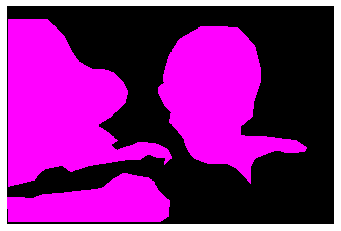

(426, 640, 3)
COCO_val2014_000000015067.jpg
{'person_bbx': [504.04, 161.02, 600.27, 318.24], 'Verbs': 'skateboard', 'object': {'obj_bbx': [520.48, 304.95, 572.6700000000001, 322.02]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [504.04, 161.02, 600.27, 318.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


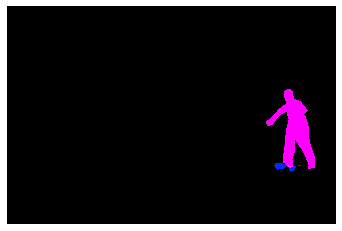

(424, 640, 3)
COCO_val2014_000000502776.jpg
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [246.48, 103.27, 321.69, 180.8]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [284.24, 91.76, 297.25, 106.09]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'hold', 'object': {'obj_bbx': [246.48, 103.27, 321.69, 180.8]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'look', 'object': {'obj_bbx': [284.24, 91.76, 297.25, 106.09]}}
sports ball
person
look
look interaction
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [184.09, 159.64, 346.61, 614.11], 'Verbs': 'smile', '

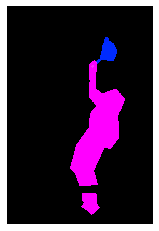

(640, 427, 3)
COCO_val2014_000000085007.jpg
{'person_bbx': [299.04, 159.43, 406.52000000000004, 453.08], 'Verbs': 'look', 'object': {'obj_bbx': [275.2, 28.65, 317.12, 60.269999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [28.03, 143.05, 173.77, 461.43], 'Verbs': 'look', 'object': {'obj_bbx': [275.2, 28.65, 317.12, 60.269999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [299.04, 159.43, 406.52000000000004, 453.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [28.03, 143.05, 173.77, 461.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [299.04, 159.43, 406.52000000000004, 453.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [28.03, 143.05, 173.77, 461.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [28.03, 143.05, 173.77, 461.43], 'Verbs': 'throw', 'object': {'obj_bbx': [275.2, 28.65, 317.12, 60.269999999999996]}}
person
frisbee
throw
t

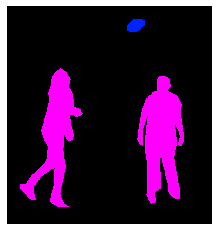

(500, 471, 3)
COCO_val2014_000000457834.jpg
{'person_bbx': [288.16, 84.38, 348.02000000000004, 173.3], 'Verbs': 'hold', 'object': {'obj_bbx': [293.26, 107.74, 329.71999999999997, 162.72]}}
person
handbag
hold
hold interaction
{'person_bbx': [477.0, 66.22, 547.89, 172.01999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [368.56, 140.72, 610.76, 403.98]}}
person
elephant
ride
ride interaction
{'person_bbx': [288.16, 84.38, 348.02000000000004, 173.3], 'Verbs': 'ride', 'object': {'obj_bbx': [257.87, 144.83, 382.06, 329.36]}}
person
elephant
ride
ride interaction
{'person_bbx': [477.0, 66.22, 547.89, 172.01999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [368.56, 140.72, 610.76, 403.98]}}
person
elephant
sit
sit interaction
{'person_bbx': [288.16, 84.38, 348.02000000000004, 173.3], 'Verbs': 'sit', 'object': {'obj_bbx': [257.87, 144.83, 382.06, 329.36]}}
person
elephant
sit
sit interaction


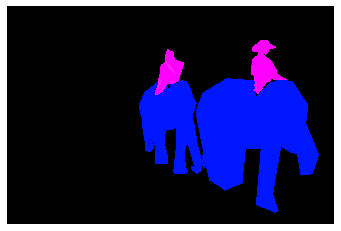

(426, 640, 3)
COCO_val2014_000000156192.jpg
{'person_bbx': [129.09, 50.51, 472.26, 325.53], 'Verbs': 'catch', 'object': {'obj_bbx': [115.91, 131.09, 182.69, 172.57]}}
person
frisbee
catch
catch interaction
{'person_bbx': [129.09, 50.51, 472.26, 325.53], 'Verbs': 'hold', 'object': {'obj_bbx': [115.91, 131.09, 182.69, 172.57]}}
person
frisbee
hold
hold interaction
{'person_bbx': [129.09, 50.51, 472.26, 325.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


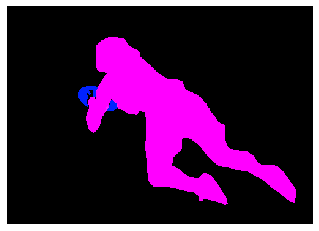

(356, 500, 3)
COCO_val2014_000000013379.jpg
{'person_bbx': [282.43, 18.14, 440.4, 238.33999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [288.49, 251.32, 363.0, 303.86]}}
person
skateboard
jump
jump interaction
{'person_bbx': [282.43, 18.14, 440.4, 238.33999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [288.49, 251.32, 363.0, 303.86]}}
person
skateboard
look
look interaction
{'person_bbx': [282.43, 18.14, 440.4, 238.33999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [288.49, 251.32, 363.0, 303.86]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [282.43, 18.14, 440.4, 238.33999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


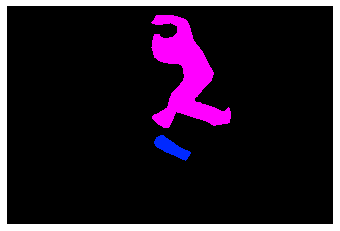

(427, 640, 3)
COCO_val2014_000000425074.jpg
{'person_bbx': [359.21, 111.81, 473.38, 247.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [359.21, 111.81, 473.38, 247.1], 'Verbs': 'surf', 'object': {'obj_bbx': [332.73, 235.79, 473.06000000000006, 263.62]}}
person
surfboard
surf
surf interaction


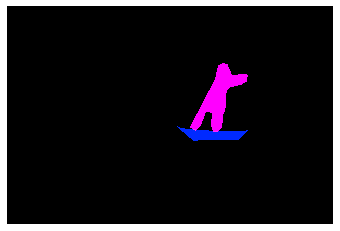

(427, 640, 3)
COCO_val2014_000000181655.jpg
{'person_bbx': [134.33, 111.64, 263.91, 299.74], 'Verbs': 'hold', 'object': {'obj_bbx': [202.79, 189.45, 225.89, 198.07999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [310.34, 133.26, 545.5, 334.06], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [134.33, 111.64, 263.91, 299.74], 'Verbs': 'look', 'object': {'obj_bbx': [202.79, 189.45, 225.89, 198.07999999999998]}}
cell phone
person
look
look interaction
{'person_bbx': [310.34, 133.26, 545.5, 334.06], 'Verbs': 'sit', 'object': {'obj_bbx': [517.39, 262.46, 548.54, 366.83]}}
person
chair
sit
sit interaction
{'person_bbx': [134.33, 111.64, 263.91, 299.74], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


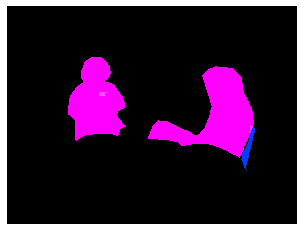

(480, 640, 3)
COCO_val2014_000000184746.jpg
{'person_bbx': [16.54, 13.09, 518.27, 323.22999999999996], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [382.34, 108.47, 516.64, 329.78]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [16.54, 13.09, 518.27, 323.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [382.34, 108.47, 516.64, 329.78]}}
person
fork
hold
hold interaction
{'person_bbx': [16.54, 13.09, 518.27, 323.22999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


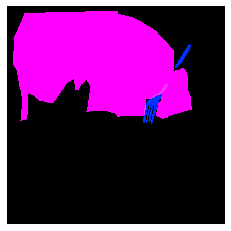

(612, 612, 3)
COCO_val2014_000000058006.jpg
{'person_bbx': [42.03, 144.41, 220.57, 465.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


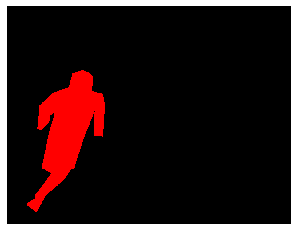

(491, 640, 3)
COCO_val2014_000000418907.jpg
{'person_bbx': [109.3, 112.18, 427.0, 464.54], 'Verbs': 'jump', 'object': {'obj_bbx': [183.94, 375.1, 278.36, 477.21000000000004]}}
person
skateboard
jump
jump interaction
{'person_bbx': [109.3, 112.18, 427.0, 464.54], 'Verbs': 'look', 'object': {'obj_bbx': [183.94, 375.1, 278.36, 477.21000000000004]}}
person
skateboard
look
look interaction
{'person_bbx': [109.3, 112.18, 427.0, 464.54], 'Verbs': 'skateboard', 'object': {'obj_bbx': [183.94, 375.1, 278.36, 477.21000000000004]}}
person
skateboard
skateboard
skateboard interaction


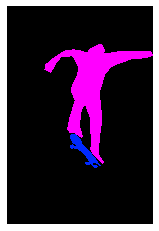

(640, 427, 3)
COCO_val2014_000000075179.jpg
{'person_bbx': [303.02, 48.01, 500.45, 304.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [350.51, 263.02, 415.94, 310.42999999999995]}}
person
skateboard
jump
jump interaction
{'person_bbx': [303.02, 48.01, 500.45, 304.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [350.51, 263.02, 415.94, 310.42999999999995]}}
person
skateboard
look
look interaction
{'person_bbx': [303.02, 48.01, 500.45, 304.65999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [350.51, 263.02, 415.94, 310.42999999999995]}}
person
skateboard
skateboard
skateboard interaction


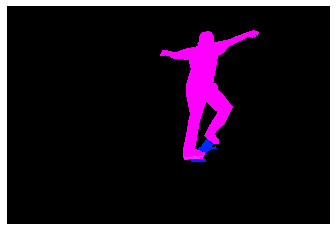

(432, 640, 3)
COCO_val2014_000000349697.jpg
{'person_bbx': [338.89, 105.01, 473.33, 319.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [338.89, 105.01, 473.33, 319.79], 'Verbs': 'look', 'object': {'obj_bbx': [206.41, 295.42, 633.3, 343.46000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [338.89, 105.01, 473.33, 319.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [338.89, 105.01, 473.33, 319.79], 'Verbs': 'surf', 'object': {'obj_bbx': [206.41, 295.42, 633.3, 343.46000000000004]}}
person
surfboard
surf
surf interaction


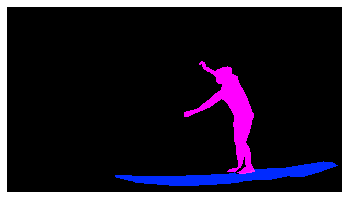

(354, 640, 3)
COCO_val2014_000000005225.jpg
{'person_bbx': [173.57, 109.98, 494.19, 330.33], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [173.57, 109.98, 494.19, 330.33], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


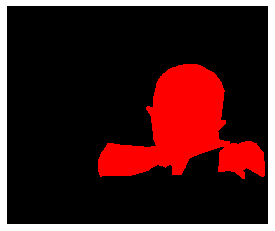

(417, 500, 3)
COCO_val2014_000000469755.jpg
{'person_bbx': [310.58, 140.63, 355.38, 212.16], 'Verbs': 'look', 'object': {'obj_bbx': [305.04, 200.83, 345.21000000000004, 216.03]}}
person
surfboard
look
look interaction
{'person_bbx': [310.58, 140.63, 355.38, 212.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [310.58, 140.63, 355.38, 212.16], 'Verbs': 'surf', 'object': {'obj_bbx': [305.04, 200.83, 345.21000000000004, 216.03]}}
person
surfboard
surf
surf interaction


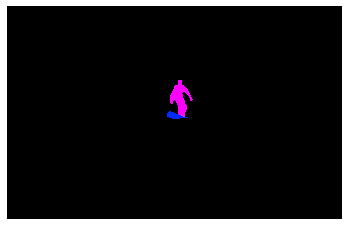

(406, 640, 3)
COCO_val2014_000000084113.jpg
{'person_bbx': [154.89, 189.71, 210.95999999999998, 254.32], 'Verbs': 'hold', 'object': {'obj_bbx': [105.82, 180.0, 189.25, 264.62]}}
person
surfboard
hold
hold interaction
{'person_bbx': [154.89, 189.71, 210.95999999999998, 254.32], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


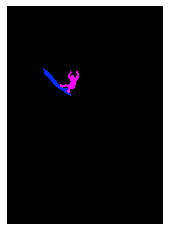

(640, 458, 3)
COCO_val2014_000000407646.jpg
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.42999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [0.0, 247.03, 105.55, 320.38]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.42999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [459.97, 248.03, 489.0, 274.62]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 247.03, 105.55, 320.38]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.42999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [459.97, 248.03, 489.0, 274.62]}}
person
sports ball
look
look interaction
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.42999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [73.71, 41.97, 413.47999999999996, 393.4299999999999

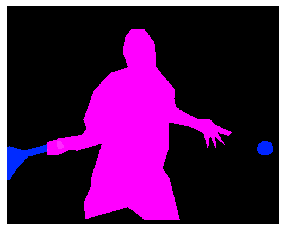

(400, 500, 3)
COCO_val2014_000000453708.jpg
{'person_bbx': [214.94, 169.84, 402.05, 421.24], 'Verbs': 'carry', 'object': {'obj_bbx': [303.49, 124.05, 423.54, 182.04]}}
person
banana
carry
carry interaction
{'person_bbx': [214.94, 169.84, 402.05, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [233.45, 5.28, 429.0, 175.88]}}
person
banana
hold
hold interaction
{'person_bbx': [214.94, 169.84, 402.05, 421.24], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


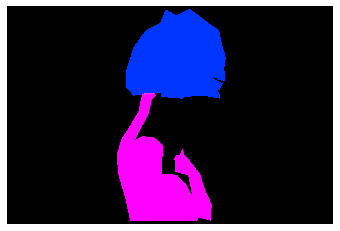

(427, 640, 3)
COCO_val2014_000000454957.jpg
{'person_bbx': [175.45, 132.36, 389.07, 630.35], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [37.75, 82.92, 180.24, 152.89]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [175.45, 132.36, 389.07, 630.35], 'Verbs': 'hold', 'object': {'obj_bbx': [37.75, 82.92, 180.24, 152.89]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [175.45, 132.36, 389.07, 630.35], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [175.45, 132.36, 389.07, 630.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


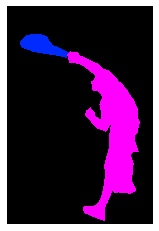

(640, 427, 3)
COCO_val2014_000000012413.jpg
{'person_bbx': [438.26, 161.23, 559.95, 424.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [236.83, 152.32, 371.48, 408.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [236.83, 152.32, 371.48, 408.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


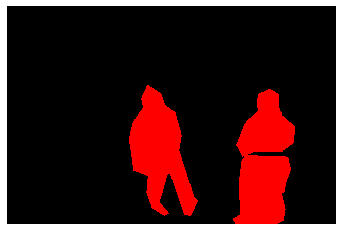

(424, 640, 3)
COCO_val2014_000000551215.jpg
{'person_bbx': [71.53, 68.55, 319.74, 511.40000000000003], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [160.94, 141.57, 206.94, 240.04]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [71.53, 68.55, 319.74, 511.40000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [160.94, 141.57, 206.94, 240.04]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [71.53, 68.55, 319.74, 511.40000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


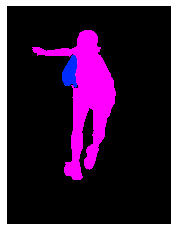

(640, 480, 3)
COCO_val2014_000000090616.jpg
{'person_bbx': [232.96, 278.38, 269.39, 364.42], 'Verbs': 'carry', 'object': {'obj_bbx': [234.27, 298.83, 255.95000000000002, 328.96999999999997]}}
person
handbag
carry
carry interaction
{'person_bbx': [374.03, 274.57, 401.83, 357.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [232.96, 278.38, 269.39, 364.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [258.55, 263.41, 282.21000000000004, 344.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [180.8, 277.92, 209.78, 354.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [327.09, 267.39, 353.28, 345.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.46, 259.57, 172.93, 340.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [374.03, 274.57, 401.83, 357.25], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


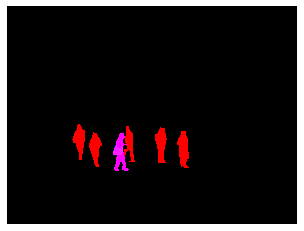

(480, 640, 3)
COCO_val2014_000000067252.jpg
{'person_bbx': [0.96, 101.42, 98.83, 281.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [213.98, 24.34, 350.85, 268.2], 'Verbs': 'jump', 'object': {'obj_bbx': [289.64, 196.97, 337.59999999999997, 264.40999999999997]}}
person
skateboard
jump
jump interaction
{'person_bbx': [213.98, 24.34, 350.85, 268.2], 'Verbs': 'look', 'object': {'obj_bbx': [289.64, 196.97, 337.59999999999997, 264.40999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [0.96, 101.42, 98.83, 281.81], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [213.98, 24.34, 350.85, 268.2], 'Verbs': 'skateboard', 'object': {'obj_bbx': [289.64, 196.97, 337.59999999999997, 264.40999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [0.96, 101.42, 98.83, 281.81], 'Verbs': 'skateboard', 'object': {'obj_bbx': [27.57, 241.47, 76.13, 258.72]}}
person
skateboard
skateboard
skateboard interaction


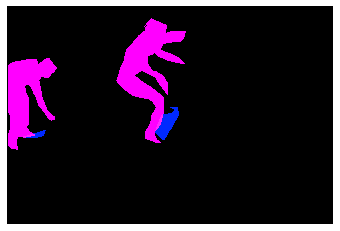

(427, 640, 3)
COCO_val2014_000000068408.jpg
{'person_bbx': [95.67, 117.18, 262.16, 360.95000000000005], 'Verbs': 'kick', 'object': {'obj_bbx': [325.03, 341.56, 366.12, 382.37]}}
sports ball
person
kick
kick interaction
{'person_bbx': [95.67, 117.18, 262.16, 360.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [325.03, 341.56, 366.12, 382.37]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 57.46, 77.02, 310.83], 'Verbs': 'look', 'object': {'obj_bbx': [325.03, 341.56, 366.12, 382.37]}}
sports ball
person
look
look interaction
{'person_bbx': [309.75, 110.07, 428.8, 311.86], 'Verbs': 'look', 'object': {'obj_bbx': [325.03, 341.56, 366.12, 382.37]}}
sports ball
person
look
look interaction
{'person_bbx': [95.67, 117.18, 262.16, 360.95000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [309.75, 110.07, 428.8, 311.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [95.67, 117.18, 262.16, 360.95000000000005], 'Verbs':

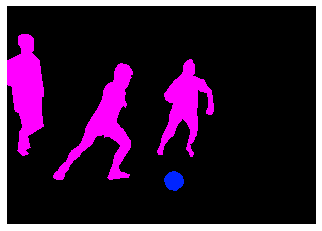

(451, 640, 3)
COCO_val2014_000000308101.jpg
{'person_bbx': [33.36, 0.86, 640.0, 477.63], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [46.38, 162.88, 307.42, 272.9]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [33.36, 0.86, 640.0, 477.63], 'Verbs': 'hold', 'object': {'obj_bbx': [46.38, 162.88, 307.42, 272.9]}}
sandwich
person
hold
hold interaction
{'person_bbx': [33.36, 0.86, 640.0, 477.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


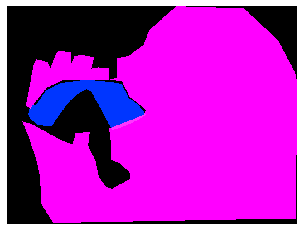

(480, 640, 3)
COCO_val2014_000000050713.jpg
{'person_bbx': [239.58, 163.68, 316.19, 351.63], 'Verbs': 'hold', 'object': {'obj_bbx': [132.86, 175.09, 398.58000000000004, 392.90999999999997]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [27.09, 179.9, 88.07, 319.47], 'Verbs': 'hold', 'object': {'obj_bbx': [26.95, 185.12, 70.25, 262.88]}}
person
person
hold
hold interaction
{'person_bbx': [435.85, 162.42, 500.0, 328.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [379.38, 195.84, 478.78, 333.55]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [27.09, 179.9, 88.07, 319.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [239.58, 163.68, 316.19, 351.63], 'Verbs': 'ride', 'object': {'obj_bbx': [132.86, 175.09, 398.58000000000004, 392.90999999999997]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [303.23, 162.51, 347.71000000000004, 333.19], 'Verbs': 'ride', 'object': {'obj_bbx': [132.86, 175.09, 398.58000000000004, 392.90999999999

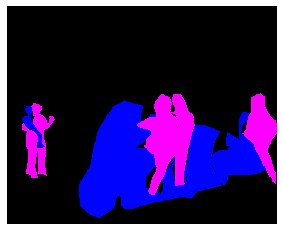

(404, 500, 3)
COCO_val2014_000000142697.jpg
{'person_bbx': [254.0, 103.27, 328.8, 201.28], 'Verbs': 'jump', 'object': {'obj_bbx': [288.38, 66.01, 361.15999999999997, 226.01]}}
person
surfboard
jump
jump interaction
{'person_bbx': [254.0, 103.27, 328.8, 201.28], 'Verbs': 'look', 'object': {'obj_bbx': [288.38, 66.01, 361.15999999999997, 226.01]}}
person
surfboard
look
look interaction
{'person_bbx': [254.0, 103.27, 328.8, 201.28], 'Verbs': 'surf', 'object': {'obj_bbx': [288.38, 66.01, 361.15999999999997, 226.01]}}
person
surfboard
surf
surf interaction


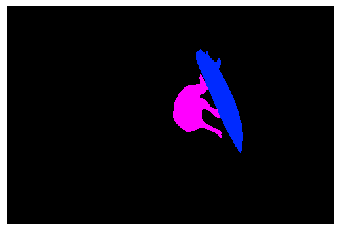

(333, 500, 3)
COCO_val2014_000000281687.jpg
{'person_bbx': [361.2, 161.03, 493.71, 375.0], 'Verbs': 'carry', 'object': {'obj_bbx': [392.82, 283.95, 455.58, 349.03]}}
person
handbag
carry
carry interaction
{'person_bbx': [291.31, 133.61, 433.77, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [325.09, 165.89, 375.03999999999996, 190.57999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [361.2, 161.03, 493.71, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [392.82, 283.95, 455.58, 349.03]}}
person
handbag
hold
hold interaction
{'person_bbx': [3.37, 124.72, 146.63, 369.1], 'Verbs': 'hold', 'object': {'obj_bbx': [90.04, 136.27, 102.47, 148.47]}}
person
cell phone
hold
hold interaction
{'person_bbx': [291.31, 133.61, 433.77, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [361.2, 161.03, 493.71, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.37, 124.72, 146.63, 369.1], 'Verbs': 'stand', 'object': {'obj_b

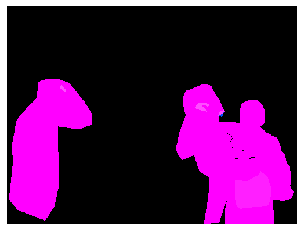

(375, 500, 3)
COCO_val2014_000000548538.jpg
{'person_bbx': [308.72, 298.44, 361.49, 358.53], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [270.4, 303.96, 308.38, 424.32], 'Verbs': 'ride', 'object': {'obj_bbx': [96.36, 215.73, 437.21000000000004, 488.99]}}
person
train
ride
ride interaction
{'person_bbx': [308.72, 298.44, 361.49, 358.53], 'Verbs': 'ride', 'object': {'obj_bbx': [96.36, 215.73, 437.21000000000004, 488.99]}}
person
train
ride
ride interaction
{'person_bbx': [246.71, 316.07, 298.1, 425.1], 'Verbs': 'ride', 'object': {'obj_bbx': [96.36, 215.73, 437.21000000000004, 488.99]}}
person
train
ride
ride interaction
{'person_bbx': [367.01, 281.49, 415.5, 410.18], 'Verbs': 'ride', 'object': {'obj_bbx': [96.36, 215.73, 437.21000000000004, 488.99]}}
person
train
ride
ride interaction
{'person_bbx': [270.4, 303.96, 308.38, 424.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.72, 298.44, 361.49, 358.53], 'Verbs': 'stand', 'objec

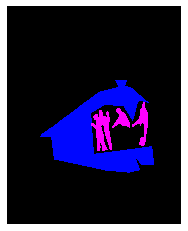

(640, 512, 3)
COCO_val2014_000000527248.jpg
{'person_bbx': [328.52, 296.57, 385.16999999999996, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [408.06, 279.09, 433.61, 357.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [533.12, 286.38, 569.53, 355.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.39, 284.92, 172.75, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [328.52, 296.57, 385.16999999999996, 360.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [276.46, 313.21, 337.84, 360.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [408.06, 279.09, 433.61, 357.49], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [533.12, 286.38, 569.53, 355.96], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


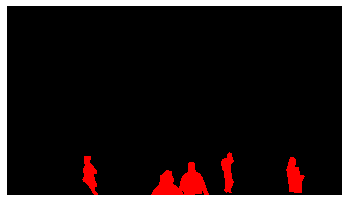

(360, 640, 3)
COCO_val2014_000000373945.jpg
{'person_bbx': [327.52, 93.53, 570.2, 474.73], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [350.34, 228.83, 380.07, 252.31]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [327.52, 93.53, 570.2, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [350.34, 228.83, 380.07, 252.31]}}
person
knife
hold
hold interaction
{'person_bbx': [327.52, 93.53, 570.2, 474.73], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [327.52, 93.53, 570.2, 474.73], 'Verbs': 'sit', 'object': {'obj_bbx': [460.86, 441.1, 500.47, 480.0]}}
person
chair
sit
sit interaction
{'person_bbx': [327.52, 93.53, 570.2, 474.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


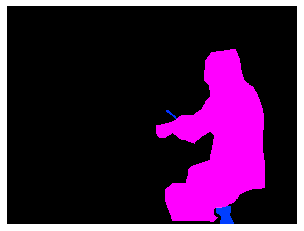

(480, 640, 3)
COCO_val2014_000000141271.jpg
{'person_bbx': [225.99, 97.28, 317.29, 298.58000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [285.48, 46.27, 317.45000000000005, 116.32]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [225.99, 97.28, 317.29, 298.58000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [315.54, 65.62, 325.19, 74.28]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [225.99, 97.28, 317.29, 298.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [285.48, 46.27, 317.45000000000005, 116.32]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [225.99, 97.28, 317.29, 298.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [315.54, 65.62, 325.19, 74.28]}}
sports ball
person
look
look interaction
{'person_bbx': [225.99, 97.28, 317.29, 298.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


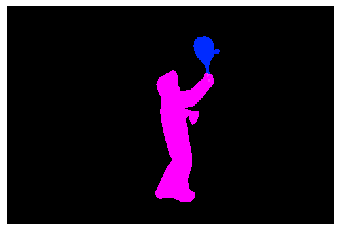

(333, 500, 3)
COCO_val2014_000000459258.jpg
{'person_bbx': [393.06, 134.45, 499.69, 389.9], 'Verbs': 'look', 'object': {'obj_bbx': [48.34, 29.0, 169.72, 93.45]}}
person
frisbee
look
look interaction
{'person_bbx': [393.06, 134.45, 499.69, 389.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


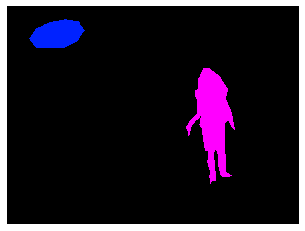

(478, 640, 3)
COCO_val2014_000000545550.jpg
{'person_bbx': [1.17, 2.35, 637.92, 518.07], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [157.49, 253.86, 566.49, 498.32000000000005]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [1.17, 2.35, 637.92, 518.07], 'Verbs': 'hold', 'object': {'obj_bbx': [157.49, 253.86, 566.49, 498.32000000000005]}}
pizza
person
hold
hold interaction
{'person_bbx': [1.17, 2.35, 637.92, 518.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


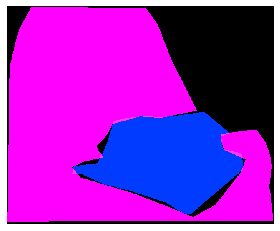

(523, 640, 3)
COCO_val2014_000000420298.jpg
{'person_bbx': [339.48, 147.14, 410.65000000000003, 309.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [339.48, 147.14, 410.65000000000003, 309.66999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [335.3, 301.0, 420.31, 322.01]}}
person
surfboard
surf
surf interaction


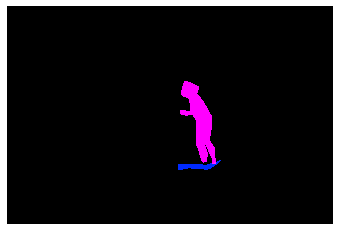

(427, 640, 3)
COCO_val2014_000000371322.jpg
{'person_bbx': [55.57, 331.11, 95.75999999999999, 399.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [55.57, 331.11, 95.75999999999999, 399.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [55.57, 331.11, 95.75999999999999, 399.84000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [2.96, 388.91, 135.51000000000002, 404.38000000000005]}}
person
surfboard
surf
surf interaction


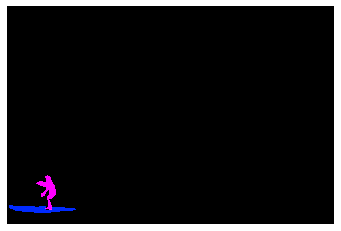

(426, 640, 3)
COCO_val2014_000000188624.jpg
{'person_bbx': [200.22, 44.49, 370.78999999999996, 284.76], 'Verbs': 'jump', 'object': {'obj_bbx': [231.59, 218.27, 319.64, 315.20000000000005]}}
person
skateboard
jump
jump interaction
{'person_bbx': [200.22, 44.49, 370.78999999999996, 284.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [200.22, 44.49, 370.78999999999996, 284.76], 'Verbs': 'skateboard', 'object': {'obj_bbx': [231.59, 218.27, 319.64, 315.20000000000005]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [200.22, 44.49, 370.78999999999996, 284.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


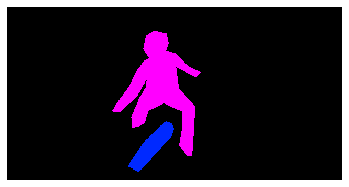

(330, 640, 3)
COCO_val2014_000000387725.jpg
{'person_bbx': [85.95, 115.07, 240.64999999999998, 305.11], 'Verbs': 'look', 'object': {'obj_bbx': [3.83, 220.61, 186.64000000000001, 338.34000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [85.95, 115.07, 240.64999999999998, 305.11], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [85.95, 115.07, 240.64999999999998, 305.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [85.95, 115.07, 240.64999999999998, 305.11], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [3.83, 220.61, 186.64000000000001, 338.34000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


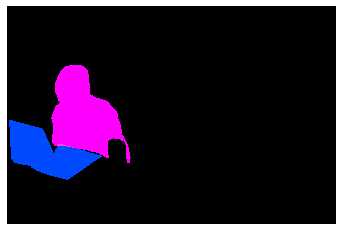

(424, 640, 3)
COCO_val2014_000000557396.jpg
{'person_bbx': [164.16, 70.68, 295.16999999999996, 223.67000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [174.56, 209.22, 213.89, 233.82]}}
person
skateboard
jump
jump interaction
{'person_bbx': [164.16, 70.68, 295.16999999999996, 223.67000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [174.56, 209.22, 213.89, 233.82]}}
person
skateboard
look
look interaction
{'person_bbx': [164.16, 70.68, 295.16999999999996, 223.67000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [174.56, 209.22, 213.89, 233.82]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [164.16, 70.68, 295.16999999999996, 223.67000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


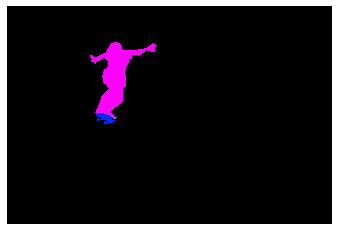

(429, 640, 3)
COCO_val2014_000000291696.jpg
{'person_bbx': [218.27, 32.26, 437.49, 279.24], 'Verbs': 'catch', 'object': {'obj_bbx': [186.01, 144.28, 261.51, 171.01]}}
person
frisbee
catch
catch interaction
{'person_bbx': [218.27, 32.26, 437.49, 279.24], 'Verbs': 'hold', 'object': {'obj_bbx': [186.01, 144.28, 261.51, 171.01]}}
person
frisbee
hold
hold interaction
{'person_bbx': [218.27, 32.26, 437.49, 279.24], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [219.22, 300.59, 555.24, 410.67999999999995], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [218.27, 32.26, 437.49, 279.24], 'Verbs': 'look', 'object': {'obj_bbx': [186.01, 144.28, 261.51, 171.01]}}
person
frisbee
look
look interaction


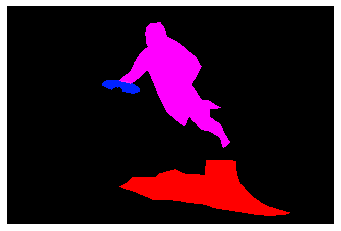

(426, 640, 3)
COCO_val2014_000000169679.jpg
{'person_bbx': [188.3, 165.57, 263.57, 388.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [256.38, 160.01, 328.17, 381.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [188.3, 165.57, 263.57, 388.44], 'Verbs': 'ski', 'object': {'obj_bbx': [178.86, 369.08, 314.16, 419.81]}}
person
skis
ski
ski interaction
{'person_bbx': [256.38, 160.01, 328.17, 381.2], 'Verbs': 'ski', 'object': {'obj_bbx': [262.66, 357.42, 390.79, 406.53000000000003]}}
skis
person
ski
ski interaction
{'person_bbx': [188.3, 165.57, 263.57, 388.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [357.44, 178.81, 440.9, 398.83000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [188.3, 165.57, 263.57, 388.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [357.44, 178.81, 440.9, 398.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': 

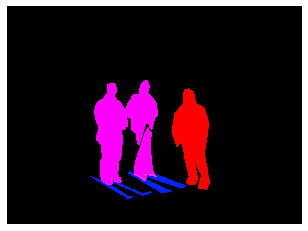

(473, 640, 3)
COCO_val2014_000000034372.jpg
{'person_bbx': [286.23, 152.21, 403.02000000000004, 314.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [273.86, 124.43, 302.19, 140.12]}}
person
frisbee
look
look interaction
{'person_bbx': [0.0, 243.22, 67.16, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [273.86, 124.43, 302.19, 140.12]}}
person
frisbee
look
look interaction
{'person_bbx': [286.23, 152.21, 403.02000000000004, 314.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 243.22, 67.16, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.23, 152.21, 403.02000000000004, 314.95000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [273.86, 124.43, 302.19, 140.12]}}
person
frisbee
throw
throw interaction


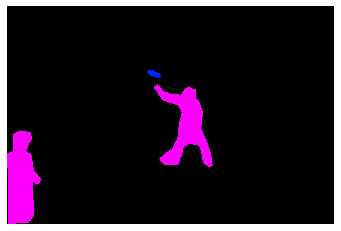

(426, 640, 3)
COCO_val2014_000000439410.jpg
{'person_bbx': [242.43, 64.6, 388.79, 283.76], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [217.13, 52.17, 267.65, 99.44]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [242.43, 64.6, 388.79, 283.76], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [417.11, 145.4, 426.78000000000003, 156.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [242.43, 64.6, 388.79, 283.76], 'Verbs': 'hold', 'object': {'obj_bbx': [217.13, 52.17, 267.65, 99.44]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [242.43, 64.6, 388.79, 283.76], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [242.43, 64.6, 388.79, 283.76], 'Verbs': 'look', 'object': {'obj_bbx': [417.11, 145.4, 426.78000000000003, 156.78]}}
sports ball
person
look
look interaction
{'person_bbx': [0.84, 53.37, 101.02000000000001, 168.85], 'Verbs': 'look', 'object': {'obj_bbx': [417.11, 145.4, 426.78000000000003, 156.78]}}
sports ball
pers

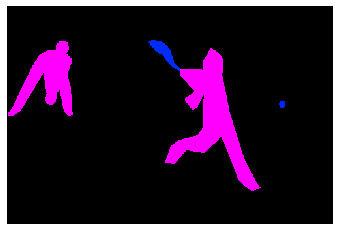

(334, 500, 3)
COCO_val2014_000000369153.jpg
{'person_bbx': [285.47, 168.25, 353.38, 309.45], 'Verbs': 'carry', 'object': {'obj_bbx': [261.03, 190.43, 410.55999999999995, 268.19]}}
surfboard
person
carry
carry interaction
{'person_bbx': [285.47, 168.25, 353.38, 309.45], 'Verbs': 'hold', 'object': {'obj_bbx': [261.03, 190.43, 410.55999999999995, 268.19]}}
surfboard
person
hold
hold interaction
{'person_bbx': [285.47, 168.25, 353.38, 309.45], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [285.47, 168.25, 353.38, 309.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [285.47, 168.25, 353.38, 309.45], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


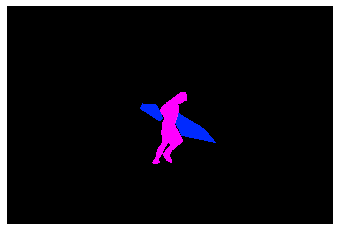

(427, 640, 3)
COCO_val2014_000000098159.jpg
{'person_bbx': [133.4, 119.65, 251.68, 415.33000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [57.33, 405.46, 235.5, 602.23]}}
person
suitcase
carry
carry interaction
{'person_bbx': [216.64, 123.54, 405.24, 605.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [133.4, 119.65, 251.68, 415.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [216.64, 123.54, 405.24, 605.8], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [459.34, 129.28, 612.0, 605.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [358.95, 127.67, 475.85, 604.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.4, 119.65, 251.68, 415.33000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [216.64, 123.54, 405.24, 605.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [459.

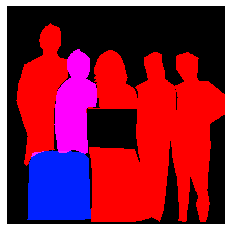

(612, 612, 3)
COCO_val2014_000000240727.jpg
{'person_bbx': [0.0, 63.46, 270.33, 262.90999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [218.29, 228.57, 357.01, 244.51]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 63.46, 270.33, 262.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 63.46, 270.33, 262.90999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


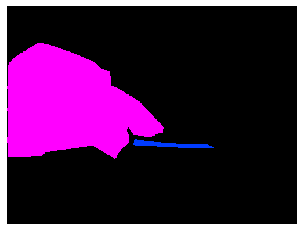

(375, 500, 3)
COCO_val2014_000000200296.jpg
{'person_bbx': [255.24, 121.86, 425.08000000000004, 332.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [342.75, 133.03, 485.4, 308.23], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [255.24, 121.86, 425.08000000000004, 332.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [342.75, 133.03, 485.4, 308.23], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


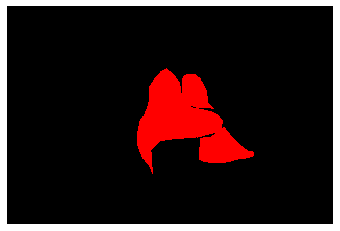

(427, 640, 3)
COCO_val2014_000000405223.jpg
{'person_bbx': [33.08, 137.83, 362.43, 631.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [338.43, 266.95, 415.29, 386.74]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [33.08, 137.83, 362.43, 631.13], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [114.11, 388.65, 141.47, 416.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [33.08, 137.83, 362.43, 631.13], 'Verbs': 'hold', 'object': {'obj_bbx': [338.43, 266.95, 415.29, 386.74]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [33.08, 137.83, 362.43, 631.13], 'Verbs': 'look', 'object': {'obj_bbx': [114.11, 388.65, 141.47, 416.78]}}
sports ball
person
look
look interaction
{'person_bbx': [33.08, 137.83, 362.43, 631.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


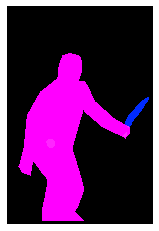

(640, 428, 3)
COCO_val2014_000000050638.jpg
{'person_bbx': [344.43, 65.35, 473.37, 382.4], 'Verbs': 'carry', 'object': {'obj_bbx': [415.49, 169.48, 487.67, 265.62]}}
person
teddy bear
carry
carry interaction
{'person_bbx': [344.43, 65.35, 473.37, 382.4], 'Verbs': 'hold', 'object': {'obj_bbx': [415.49, 169.48, 487.67, 265.62]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [344.43, 65.35, 473.37, 382.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [344.43, 65.35, 473.37, 382.4], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


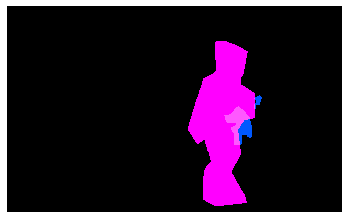

(393, 640, 3)
COCO_val2014_000000465422.jpg
{'person_bbx': [159.9, 300.23, 332.85, 496.93], 'Verbs': 'snowboard', 'object': {'obj_bbx': [198.94, 483.18, 242.82, 508.26]}}
person
snowboard
snowboard
snowboard interaction


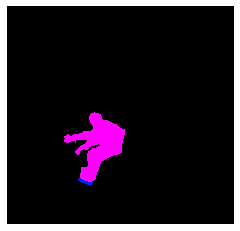

(615, 640, 3)
COCO_val2014_000000093746.jpg
{'person_bbx': [0.0, 51.65, 278.83, 538.51], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [136.36, 425.95, 246.62, 454.58]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 51.65, 278.83, 538.51], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [257.44, 449.92, 426.0, 523.27]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 51.65, 278.83, 538.51], 'Verbs': 'hold', 'object': {'obj_bbx': [136.36, 425.95, 246.62, 454.58]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 51.65, 278.83, 538.51], 'Verbs': 'look', 'object': {'obj_bbx': [257.44, 449.92, 426.0, 523.27]}}
person
cake
look
look interaction
{'person_bbx': [0.0, 51.65, 278.83, 538.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


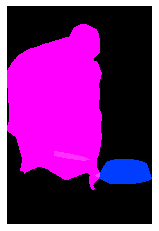

(640, 426, 3)
COCO_val2014_000000534127.jpg
{'person_bbx': [322.08, 149.56, 421.79999999999995, 323.44], 'Verbs': 'carry', 'object': {'obj_bbx': [314.99, 173.04, 365.15, 238.64]}}
backpack
person
carry
carry interaction
{'person_bbx': [322.08, 149.56, 421.79999999999995, 323.44], 'Verbs': 'catch', 'object': {'obj_bbx': [415.86, 146.27, 452.88, 178.4]}}
frisbee
person
catch
catch interaction
{'person_bbx': [322.08, 149.56, 421.79999999999995, 323.44], 'Verbs': 'look', 'object': {'obj_bbx': [415.86, 146.27, 452.88, 178.4]}}
frisbee
person
look
look interaction
{'person_bbx': [322.08, 149.56, 421.79999999999995, 323.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


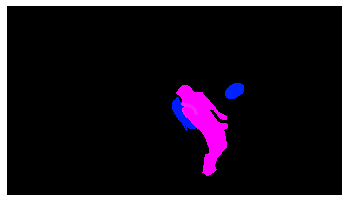

(360, 640, 3)
COCO_val2014_000000424933.jpg
{'person_bbx': [160.93, 108.06, 431.21, 450.55], 'Verbs': 'hold', 'object': {'obj_bbx': [369.49, 151.72, 432.15, 203.7]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [160.93, 108.06, 431.21, 450.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [405.85, 39.74, 497.78000000000003, 308.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [160.93, 108.06, 431.21, 450.55], 'Verbs': 'throw', 'object': {'obj_bbx': [161.79, 108.23, 177.97, 123.81]}}
sports ball
person
throw
throw interaction


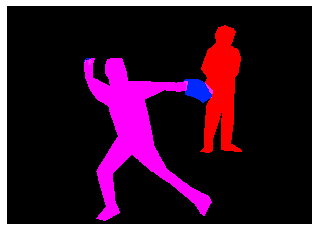

(457, 640, 3)
COCO_val2014_000000401132.jpg
{'person_bbx': [339.32, 0.6, 640.0, 504.15000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [135.26, 299.19, 164.35, 314.8]}}
donut
person
look
look interaction
{'person_bbx': [339.32, 0.6, 640.0, 504.15000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [339.32, 0.6, 640.0, 504.15000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


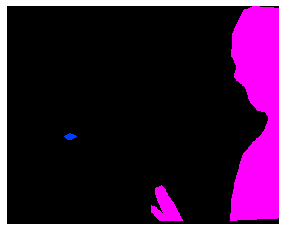

(512, 640, 3)
COCO_val2014_000000080932.jpg
{'person_bbx': [64.83, 141.38, 365.52, 462.76], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [162.28, 361.11, 305.45, 497.88]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [64.83, 141.38, 365.52, 462.76], 'Verbs': 'hold', 'object': {'obj_bbx': [162.28, 361.11, 305.45, 497.88]}}
person
pizza
hold
hold interaction
{'person_bbx': [64.83, 141.38, 365.52, 462.76], 'Verbs': 'look', 'object': {'obj_bbx': [162.28, 361.11, 305.45, 497.88]}}
person
pizza
look
look interaction
{'person_bbx': [64.83, 141.38, 365.52, 462.76], 'Verbs': 'sit', 'object': {'obj_bbx': [48.38, 284.41, 367.69, 383.93]}}
chair
person
sit
sit interaction


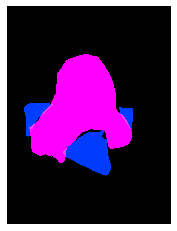

(640, 480, 3)
COCO_val2014_000000439188.jpg
{'person_bbx': [333.92, 126.93, 526.15, 356.73], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 191.32, 38.87, 214.53]}}
person
frisbee
look
look interaction
{'person_bbx': [333.92, 126.93, 526.15, 356.73], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [333.92, 126.93, 526.15, 356.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [333.92, 126.93, 526.15, 356.73], 'Verbs': 'throw', 'object': {'obj_bbx': [0.0, 191.32, 38.87, 214.53]}}
person
frisbee
throw
throw interaction


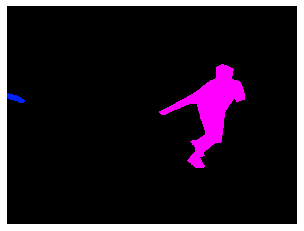

(480, 640, 3)
COCO_val2014_000000248703.jpg
{'person_bbx': [276.05, 79.64, 412.13, 316.34], 'Verbs': 'kick', 'object': {'obj_bbx': [277.59, 291.33, 314.22999999999996, 326.76]}}
sports ball
person
kick
kick interaction
{'person_bbx': [276.05, 79.64, 412.13, 316.34], 'Verbs': 'look', 'object': {'obj_bbx': [277.59, 291.33, 314.22999999999996, 326.76]}}
sports ball
person
look
look interaction
{'person_bbx': [413.56, 89.03, 536.09, 299.64], 'Verbs': 'look', 'object': {'obj_bbx': [277.59, 291.33, 314.22999999999996, 326.76]}}
sports ball
person
look
look interaction
{'person_bbx': [276.05, 79.64, 412.13, 316.34], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [413.56, 89.03, 536.09, 299.64], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [276.05, 79.64, 412.13, 316.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [413.56, 89.03, 536.09, 299.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


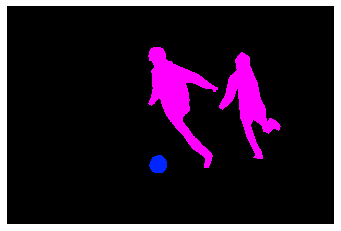

(426, 640, 3)
COCO_val2014_000000059743.jpg
{'person_bbx': [400.33, 179.54, 485.89, 253.88], 'Verbs': 'carry', 'object': {'obj_bbx': [397.07, 203.91, 482.82, 238.9]}}
person
surfboard
carry
carry interaction
{'person_bbx': [400.33, 179.54, 485.89, 253.88], 'Verbs': 'hold', 'object': {'obj_bbx': [397.07, 203.91, 482.82, 238.9]}}
person
surfboard
hold
hold interaction
{'person_bbx': [177.73, 219.77, 254.07, 338.24], 'Verbs': 'hold', 'object': {'obj_bbx': [226.62, 247.72, 251.34, 333.93]}}
person
surfboard
hold
hold interaction
{'person_bbx': [177.73, 219.77, 254.07, 338.24], 'Verbs': 'look', 'object': {'obj_bbx': [258.97, 181.55, 284.49, 253.14000000000001]}}
person
person
look
look interaction
{'person_bbx': [400.33, 179.54, 485.89, 253.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [177.73, 219.77, 254.07, 338.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [400.33, 179.54, 485.89, 253.88], 'Verbs': 'walk', 'object': {'obj_bb

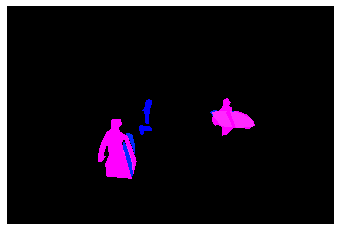

(426, 640, 3)
COCO_val2014_000000512479.jpg
{'person_bbx': [419.59, 52.22, 633.96, 225.37], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.3, 639.91, 426.0]}}
couch
person
lay
lay interaction
{'person_bbx': [419.59, 52.22, 633.96, 225.37], 'Verbs': 'look', 'object': {'obj_bbx': [31.28, 100.06, 437.03999999999996, 354.0]}}
cat
person
look
look interaction
{'person_bbx': [419.59, 52.22, 633.96, 225.37], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 426.0]}}
person
bed
sit
sit interaction
{'person_bbx': [419.59, 52.22, 633.96, 225.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


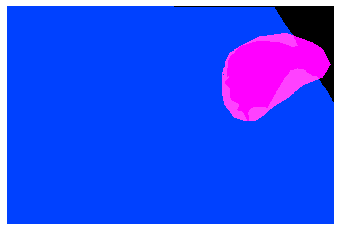

(426, 640, 3)
COCO_val2014_000000171970.jpg
{'person_bbx': [337.3, 104.18, 407.68, 209.51], 'Verbs': 'ride', 'object': {'obj_bbx': [85.05, 66.28, 450.62, 320.68]}}
truck
person
ride
ride interaction
{'person_bbx': [269.79, 88.07, 333.89, 197.97], 'Verbs': 'ride', 'object': {'obj_bbx': [85.05, 66.28, 450.62, 320.68]}}
truck
person
ride
ride interaction
{'person_bbx': [337.3, 104.18, 407.68, 209.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [269.79, 88.07, 333.89, 197.97], 'Verbs': 'sit', 'object': {'obj_bbx': [299.63, 178.03, 331.07, 205.29]}}
chair
person
sit
sit interaction


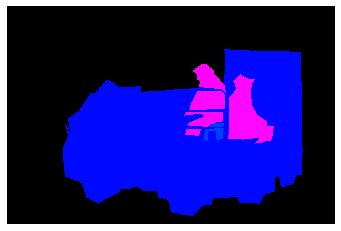

(332, 500, 3)
COCO_val2014_000000146150.jpg
{'person_bbx': [73.38, 115.66, 296.96000000000004, 430.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [96.31, 230.31, 316.64, 357.87]}}
person
suitcase
hold
hold interaction
{'person_bbx': [73.38, 115.66, 296.96000000000004, 430.57000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [96.31, 230.31, 316.64, 357.87]}}
person
suitcase
look
look interaction
{'person_bbx': [73.38, 115.66, 296.96000000000004, 430.57000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [58.3, 154.71, 91.93, 244.39000000000001]}}
chair
person
sit
sit interaction


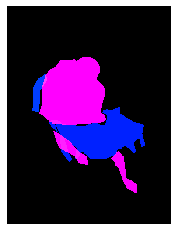

(500, 375, 3)
COCO_val2014_000000437290.jpg
{'person_bbx': [325.0, 57.81, 403.77, 280.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [240.0, 55.87, 337.55, 357.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [205.8, 256.05, 297.69, 420.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [92.26, 116.34, 152.41, 320.01], 'Verbs': 'hold', 'object': {'obj_bbx': [142.15, 162.8, 155.5, 173.65]}}
cell phone
person
hold
hold interaction
{'person_bbx': [325.0, 57.81, 403.77, 280.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [352.18, 179.7, 444.05, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [325.0, 57.81, 403.77, 280.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [240.0, 55.87, 337.55, 357.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [205.8, 256.05, 297.69, 420.69], 'Verbs': 'stand', 

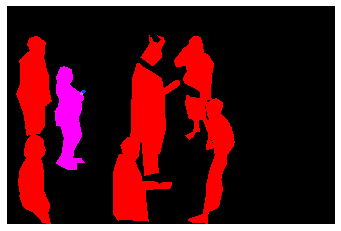

(425, 640, 3)
COCO_val2014_000000455975.jpg
{'person_bbx': [127.28, 39.91, 639.64, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [78.74, 129.44, 409.17, 465.12]}}
laptop
person
hold
hold interaction
{'person_bbx': [127.28, 39.91, 639.64, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [78.74, 129.44, 409.17, 465.12]}}
laptop
person
look
look interaction
{'person_bbx': [127.28, 39.91, 639.64, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 346.51, 640.0, 480.0]}}
person
couch
sit
sit interaction
{'person_bbx': [127.28, 39.91, 639.64, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [78.74, 129.44, 409.17, 465.12]}}
laptop
person
work_on_computer
work_on_computer interaction


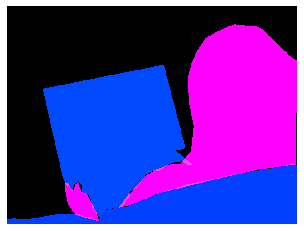

(480, 640, 3)
COCO_val2014_000000448181.jpg
{'person_bbx': [319.28, 74.1, 634.25, 473.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [308.02, 186.57, 407.15, 268.65]}}
person
laptop
look
look interaction
{'person_bbx': [319.28, 74.1, 634.25, 473.20000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [420.13, 243.61, 640.0, 473.81]}}
chair
person
sit
sit interaction
{'person_bbx': [319.28, 74.1, 634.25, 473.20000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [308.02, 186.57, 407.15, 268.65]}}
person
laptop
work_on_computer
work_on_computer interaction


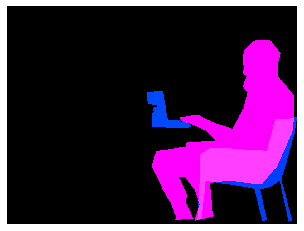

(480, 640, 3)
COCO_val2014_000000177194.jpg
{'person_bbx': [87.73, 252.88, 220.04000000000002, 567.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [192.14, 211.29, 314.94, 579.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [306.57, 151.22, 480.0, 596.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [87.73, 252.88, 220.04000000000002, 567.85], 'Verbs': 'ski', 'object': {'obj_bbx': [26.94, 503.21, 175.5, 580.35]}}
person
skis
ski
ski interaction
{'person_bbx': [192.14, 211.29, 314.94, 579.68], 'Verbs': 'ski', 'object': {'obj_bbx': [51.14, 553.32, 211.36, 597.6300000000001]}}
person
skis
ski
ski interaction
{'person_bbx': [306.57, 151.22, 480.0, 596.85], 'Verbs': 'ski', 'object': {'obj_bbx': [180.0, 572.5, 448.33, 630.83]}}
person
skis
ski
ski interaction
{'person_bbx': [87.73, 252.88, 220.04000000000002, 567.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [192.14, 211.29, 314

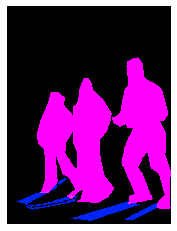

(640, 480, 3)
COCO_val2014_000000535750.jpg
{'person_bbx': [176.11, 229.22, 349.35, 601.48], 'Verbs': 'hold', 'object': {'obj_bbx': [247.27, 268.94, 261.09000000000003, 292.88]}}
cell phone
person
hold
hold interaction
{'person_bbx': [176.11, 229.22, 349.35, 601.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [176.11, 229.22, 349.35, 601.48], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [247.27, 268.94, 261.09000000000003, 292.88]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [176.11, 229.22, 349.35, 601.48], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


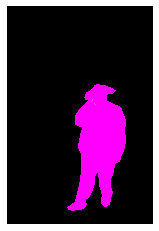

(640, 428, 3)
COCO_val2014_000000247473.jpg
{'person_bbx': [4.3, 66.18, 480.0, 632.99], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [166.87, 243.04, 266.99, 313.19]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [4.3, 66.18, 480.0, 632.99], 'Verbs': 'hold', 'object': {'obj_bbx': [166.87, 243.04, 266.99, 313.19]}}
person
donut
hold
hold interaction
{'person_bbx': [4.3, 66.18, 480.0, 632.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


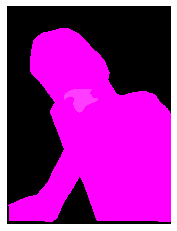

(640, 480, 3)
COCO_val2014_000000340218.jpg
{'person_bbx': [37.62, 45.14, 477.0, 482.76], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [123.92, 364.99, 188.10000000000002, 467.68]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [37.62, 45.14, 477.0, 482.76], 'Verbs': 'hold', 'object': {'obj_bbx': [123.92, 364.99, 188.10000000000002, 467.68]}}
person
hot dog
hold
hold interaction
{'person_bbx': [37.62, 45.14, 477.0, 482.76], 'Verbs': 'look', 'object': {'obj_bbx': [123.92, 364.99, 188.10000000000002, 467.68]}}
person
hot dog
look
look interaction
{'person_bbx': [37.62, 45.14, 477.0, 482.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


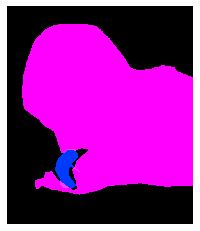

(558, 477, 3)
COCO_val2014_000000347995.jpg
{'person_bbx': [234.22, 97.88, 368.19, 264.43], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 61.47, 640.0, 472.59000000000003]}}
person
bed
lay
lay interaction
{'person_bbx': [234.22, 97.88, 368.19, 264.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


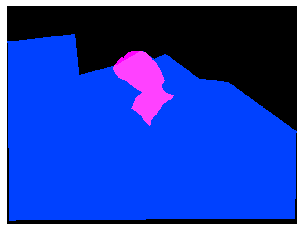

(480, 640, 3)
COCO_val2014_000000549508.jpg
{'person_bbx': [285.84, 74.25, 416.36, 442.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [43.05, 115.16, 233.54000000000002, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [458.43, 100.13, 593.12, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [285.84, 74.25, 416.36, 442.07], 'Verbs': 'ski', 'object': {'obj_bbx': [313.79, 382.02, 419.01, 480.0]}}
person
skis
ski
ski interaction
{'person_bbx': [43.05, 115.16, 233.54000000000002, 480.0], 'Verbs': 'ski', 'object': {'obj_bbx': [185.19, 391.45, 292.34000000000003, 479.71999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [458.43, 100.13, 593.12, 480.0], 'Verbs': 'ski', 'object': {'obj_bbx': [494.4, 404.59, 522.37, 473.67999999999995]}}
person
skis
ski
ski interaction
{'person_bbx': [285.84, 74.25, 416.36, 442.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [43.05, 

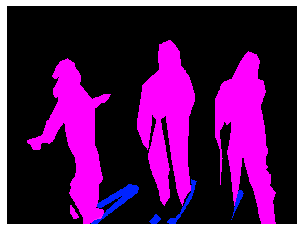

(480, 640, 3)
COCO_val2014_000000273059.jpg
{'person_bbx': [267.96, 59.52, 578.3299999999999, 415.19], 'Verbs': 'catch', 'object': {'obj_bbx': [150.92, 201.02, 224.79999999999998, 237.96]}}
person
frisbee
catch
catch interaction
{'person_bbx': [267.96, 59.52, 578.3299999999999, 415.19], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [267.96, 59.52, 578.3299999999999, 415.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.96, 59.52, 578.3299999999999, 415.19], 'Verbs': 'throw', 'object': {'obj_bbx': [150.92, 201.02, 224.79999999999998, 237.96]}}
person
frisbee
throw
throw interaction


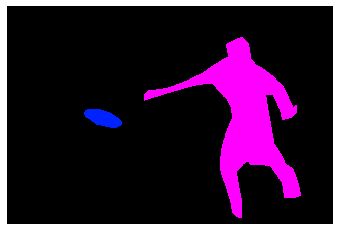

(427, 640, 3)
COCO_val2014_000000129897.jpg
{'person_bbx': [4.3, 131.11, 138.52, 470.44], 'Verbs': 'look', 'object': {'obj_bbx': [327.91, 148.85, 477.84000000000003, 399.1]}}
person
person
look
look interaction
{'person_bbx': [4.3, 131.11, 138.52, 470.44], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [432.0, 55.92, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


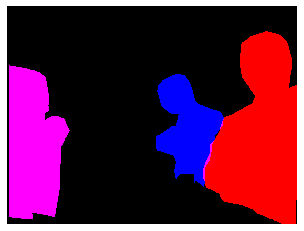

(480, 640, 3)
COCO_val2014_000000300353.jpg
{'person_bbx': [16.52, 1.74, 459.18, 380.91], 'Verbs': 'hold', 'object': {'obj_bbx': [232.72, 131.18, 291.99, 193.94]}}
cell phone
person
hold
hold interaction
{'person_bbx': [16.52, 1.74, 459.18, 380.91], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [16.52, 1.74, 459.18, 380.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [16.52, 1.74, 459.18, 380.91], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [232.72, 131.18, 291.99, 193.94]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


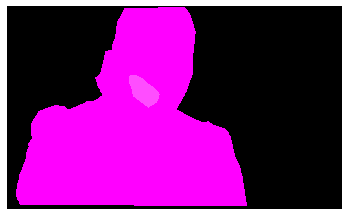

(387, 640, 3)
COCO_val2014_000000112022.jpg
{'person_bbx': [409.18, 89.7, 559.9300000000001, 425.0], 'Verbs': 'carry', 'object': {'obj_bbx': [448.26, 186.27, 472.87, 338.42]}}
person
backpack
carry
carry interaction
{'person_bbx': [483.95, 43.83, 640.0, 412.72999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [409.18, 89.7, 559.9300000000001, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [311.35, 84.04, 412.58000000000004, 416.40000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [520.88, 71.58, 640.0, 423.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


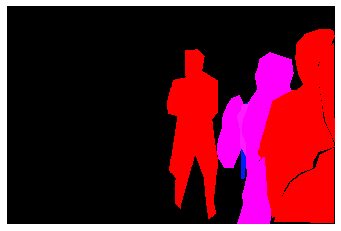

(425, 640, 3)
COCO_val2014_000000478430.jpg
{'person_bbx': [351.23, 58.22, 562.35, 423.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [392.8, 272.88, 498.99, 322.53]}}
person
frisbee
hold
hold interaction
{'person_bbx': [351.23, 58.22, 562.35, 423.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [351.23, 58.22, 562.35, 423.84000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [392.8, 272.88, 498.99, 322.53]}}
person
frisbee
throw
throw interaction


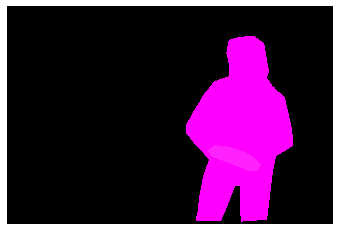

(428, 640, 3)
COCO_val2014_000000563951.jpg
{'person_bbx': [154.2, 245.74, 340.92999999999995, 511.75], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [210.04, 272.59, 258.27, 356.34]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [154.2, 245.74, 340.92999999999995, 511.75], 'Verbs': 'hold', 'object': {'obj_bbx': [210.04, 272.59, 258.27, 356.34]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [154.2, 245.74, 340.92999999999995, 511.75], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump


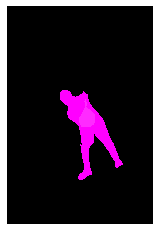

(640, 427, 3)
COCO_val2014_000000166840.jpg
{'person_bbx': [118.42, 105.65, 289.13, 362.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [107.2, 221.59, 143.76, 362.14]}}
person
skateboard
look
look interaction
{'person_bbx': [1.12, 65.15, 50.449999999999996, 324.12], 'Verbs': 'look', 'object': {'obj_bbx': [107.2, 221.59, 143.76, 362.14]}}
person
skateboard
look
look interaction
{'person_bbx': [118.42, 105.65, 289.13, 362.15999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [107.2, 221.59, 143.76, 362.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [1.12, 65.15, 50.449999999999996, 324.12], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [118.42, 105.65, 289.13, 362.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.12, 65.15, 50.449999999999996, 324.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


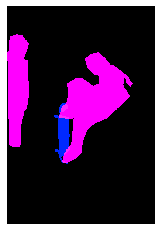

(500, 339, 3)
COCO_val2014_000000518224.jpg
{'person_bbx': [0.0, 178.68, 264.94, 452.87], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [180.74, 4.72, 475.46000000000004, 427.81], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [498.47, 171.44, 622.44, 254.82999999999998]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 178.68, 264.94, 452.87], 'Verbs': 'hold', 'object': {'obj_bbx': [235.69, 268.62, 302.59000000000003, 339.64]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [180.74, 4.72, 475.46000000000004, 427.81], 'Verbs': 'hold', 'object': {'obj_bbx': [498.47, 171.44, 622.44, 254.82999999999998]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [180.74, 4.72, 475.46000000000004, 427.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


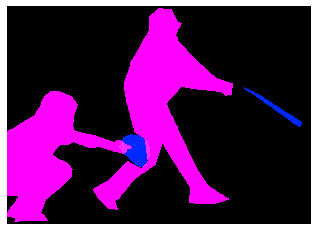

(458, 640, 3)
COCO_val2014_000000414385.jpg
{'person_bbx': [399.46, 252.2, 466.71999999999997, 374.98], 'Verbs': 'skateboard', 'object': {'obj_bbx': [428.63, 364.84, 473.76, 385.30999999999995]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [399.46, 252.2, 466.71999999999997, 374.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


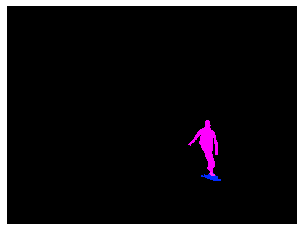

(480, 640, 3)
COCO_val2014_000000208543.jpg
{'person_bbx': [282.93, 93.26, 341.44, 192.10000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [261.1, 163.41, 376.68, 194.3]}}
person
skis
hold
hold interaction
{'person_bbx': [404.47, 154.34, 468.33000000000004, 301.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [391.33, 279.85, 413.40999999999997, 290.36]}}
person
skis
hold
hold interaction
{'person_bbx': [282.93, 93.26, 341.44, 192.10000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [261.1, 163.41, 376.68, 194.3]}}
person
skis
jump
jump interaction
{'person_bbx': [282.93, 93.26, 341.44, 192.10000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [261.1, 163.41, 376.68, 194.3]}}
person
skis
look
look interaction
{'person_bbx': [404.47, 154.34, 468.33000000000004, 301.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [282.93, 93.26, 341.44, 192.10000000000002]}}
person
person
look
look interaction
{'person_bbx': [282.93, 93.26, 341.44, 192.10000000000002], 'Verbs': 's

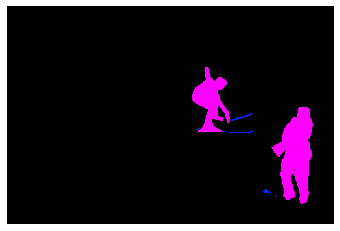

(333, 500, 3)
COCO_val2014_000000226571.jpg
{'person_bbx': [325.29, 145.11, 390.71000000000004, 332.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [172.31, 200.08, 514.0699999999999, 422.17]}}
horse
person
hold
hold interaction
{'person_bbx': [325.29, 145.11, 390.71000000000004, 332.08000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [172.31, 200.08, 514.0699999999999, 422.17]}}
horse
person
ride
ride interaction
{'person_bbx': [144.86, 164.96, 210.62, 327.93], 'Verbs': 'ride', 'object': {'obj_bbx': [46.92, 227.03, 285.23, 401.85]}}
horse
person
ride
ride interaction
{'person_bbx': [325.29, 145.11, 390.71000000000004, 332.08000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [172.31, 200.08, 514.0699999999999, 422.17]}}
horse
person
sit
sit interaction
{'person_bbx': [144.86, 164.96, 210.62, 327.93], 'Verbs': 'sit', 'object': {'obj_bbx': [46.92, 227.03, 285.23, 401.85]}}
horse
person
sit
sit interaction


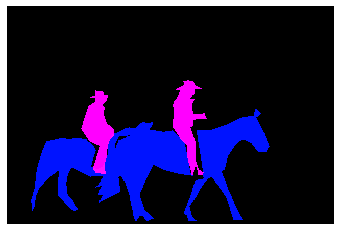

(426, 640, 3)
COCO_val2014_000000478812.jpg
{'person_bbx': [226.51, 2.65, 640.0, 421.94], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [265.8, 173.68, 350.24, 249.48000000000002]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [226.51, 2.65, 640.0, 421.94], 'Verbs': 'hold', 'object': {'obj_bbx': [265.8, 173.68, 350.24, 249.48000000000002]}}
person
scissors
hold
hold interaction


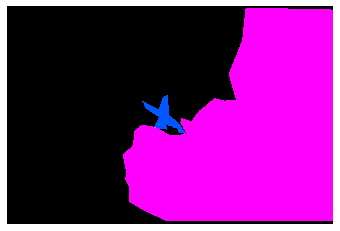

(427, 640, 3)
COCO_val2014_000000017869.jpg
{'person_bbx': [189.19, 129.19, 275.68, 381.08], 'Verbs': 'catch', 'object': {'obj_bbx': [247.13, 123.83, 282.13, 141.49]}}
person
frisbee
catch
catch interaction
{'person_bbx': [189.19, 129.19, 275.68, 381.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


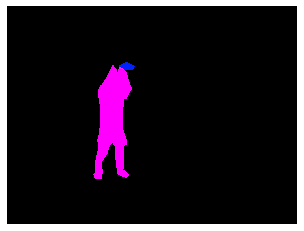

(480, 640, 3)
COCO_val2014_000000238472.jpg
{'person_bbx': [366.29, 43.27, 419.81, 159.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [423.47, 63.08, 489.81000000000006, 182.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [201.11, 12.92, 255.20000000000002, 183.55999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [150.61, 165.15, 324.56, 183.33]}}
person
skis
look
look interaction
{'person_bbx': [366.29, 43.27, 419.81, 159.75], 'Verbs': 'look', 'object': {'obj_bbx': [423.47, 63.08, 489.81000000000006, 182.0]}}
person
person
look
look interaction
{'person_bbx': [423.47, 63.08, 489.81000000000006, 182.0], 'Verbs': 'look', 'object': {'obj_bbx': [399.14, 172.02, 481.39, 194.72]}}
person
skis
look
look interaction
{'person_bbx': [201.11, 12.92, 255.20000000000002, 183.55999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [150.61, 165.15, 324.56, 183.33]}}
person
skis
ski
ski interaction
{'person_bbx': [366.29, 43.27, 419.81, 159.75

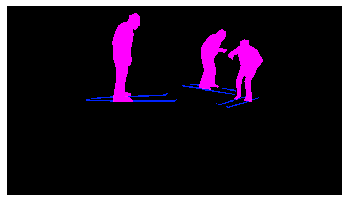

(360, 640, 3)
COCO_val2014_000000016875.jpg
{'person_bbx': [214.23, 124.77, 392.54999999999995, 256.9], 'Verbs': 'lay', 'object': {'obj_bbx': [159.29, 45.1, 596.84, 427.0]}}
person
bed
lay
lay interaction


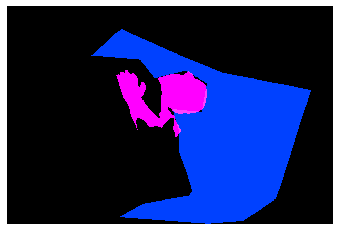

(427, 640, 3)
COCO_val2014_000000462213.jpg
{'person_bbx': [189.42, 145.79, 486.46000000000004, 564.81], 'Verbs': 'look', 'object': {'obj_bbx': [388.63, 271.39, 600.8, 449.51]}}
person
laptop
look
look interaction
{'person_bbx': [189.42, 145.79, 486.46000000000004, 564.81], 'Verbs': 'sit', 'object': {'obj_bbx': [20.18, 218.38, 301.26, 609.01]}}
chair
person
sit
sit interaction
{'person_bbx': [189.42, 145.79, 486.46000000000004, 564.81], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [388.63, 271.39, 600.8, 449.51]}}
person
laptop
work_on_computer
work_on_computer interaction


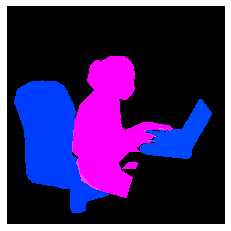

(640, 640, 3)
COCO_val2014_000000113720.jpg
{'person_bbx': [191.41, 55.6, 403.85, 254.35999999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [62.09, 215.87, 195.81, 269.35]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [191.41, 55.6, 403.85, 254.35999999999999], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [211.9, 81.47, 261.27, 124.25999999999999]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [191.41, 55.6, 403.85, 254.35999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [211.9, 81.47, 261.27, 124.25999999999999]}}
person
fork
hold
hold interaction
{'person_bbx': [191.41, 55.6, 403.85, 254.35999999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [365.42, 18.99, 591.4, 319.02], 'Verbs': 'sit', 'object': {'obj_bbx': [584.21, 211.43, 602.88, 262.04]}}
chair
person
sit
sit interaction
{'person_bbx': [191.41, 55.6, 403.85, 254.35999999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [365.42, 18.9

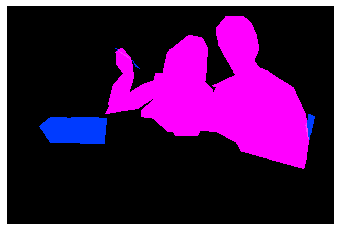

(426, 640, 3)
COCO_val2014_000000552217.jpg
{'person_bbx': [75.06, 93.59, 384.29, 290.24], 'Verbs': 'lay', 'object': {'obj_bbx': [125.06, 2.0, 500.0, 330.75]}}
bed
person
lay
lay interaction
{'person_bbx': [75.06, 93.59, 384.29, 290.24], 'Verbs': 'look', 'object': {'obj_bbx': [54.81, 212.68, 84.11, 260.76]}}
person
clock
look
look interaction


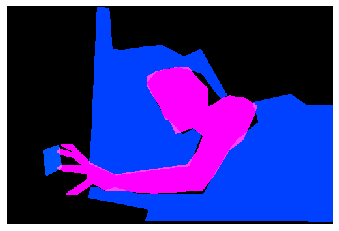

(334, 500, 3)
COCO_val2014_000000083682.jpg
{'person_bbx': [208.41, 177.12, 356.74, 365.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [182.95, 340.7, 417.48, 395.19]}}
person
snowboard
look
look interaction
{'person_bbx': [208.41, 177.12, 356.74, 365.95000000000005], 'Verbs': 'snowboard', 'object': {'obj_bbx': [182.95, 340.7, 417.48, 395.19]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [208.41, 177.12, 356.74, 365.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


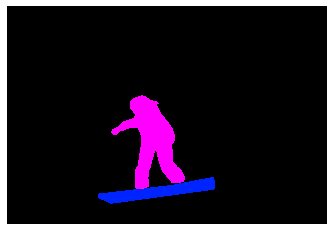

(435, 640, 3)
COCO_val2014_000000467107.jpg
{'person_bbx': [100.75, 59.49, 317.61, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [266.16, 2.87, 622.31, 419.34000000000003]}}
person
person
hold
hold interaction
{'person_bbx': [266.16, 2.87, 622.31, 419.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [100.75, 59.49, 317.61, 427.0]}}
person
person
hold
hold interaction
{'person_bbx': [100.75, 59.49, 317.61, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [266.16, 2.87, 622.31, 419.34000000000003]}}
person
person
look
look interaction
{'person_bbx': [266.16, 2.87, 622.31, 419.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [100.75, 59.49, 317.61, 427.0]}}
person
person
look
look interaction
{'person_bbx': [100.75, 59.49, 317.61, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [266.16, 2.87, 622.31, 419.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


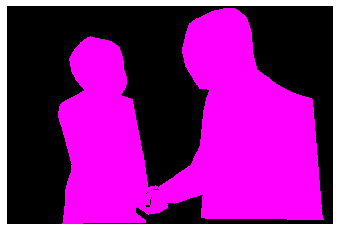

(427, 640, 3)
COCO_val2014_000000296676.jpg
{'person_bbx': [140.52, 111.98, 205.27, 331.52], 'Verbs': 'hold', 'object': {'obj_bbx': [187.05, 178.75, 217.93, 191.39]}}
person
frisbee
hold
hold interaction
{'person_bbx': [140.52, 111.98, 205.27, 331.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


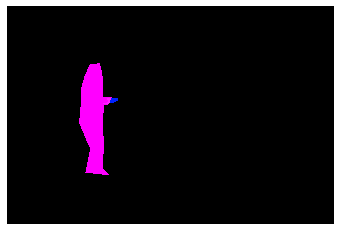

(426, 640, 3)
COCO_val2014_000000312878.jpg
{'person_bbx': [322.29, 323.88, 417.32000000000005, 524.8], 'Verbs': 'carry', 'object': {'obj_bbx': [321.02, 366.43, 349.68, 429.63]}}
person
backpack
carry
carry interaction
{'person_bbx': [322.29, 323.88, 417.32000000000005, 524.8], 'Verbs': 'hold', 'object': {'obj_bbx': [321.02, 366.43, 349.68, 429.63]}}
person
backpack
hold
hold interaction
{'person_bbx': [322.29, 323.88, 417.32000000000005, 524.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [322.29, 323.88, 417.32000000000005, 524.8], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


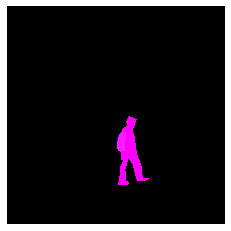

(640, 640, 3)
COCO_val2014_000000330055.jpg
{'person_bbx': [51.7, 151.16, 233.42000000000002, 515.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [185.47, 45.09, 408.39, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


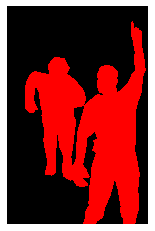

(640, 415, 3)
COCO_val2014_000000161609.jpg
{'person_bbx': [278.29, 67.78, 640.0, 475.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [278.29, 67.78, 640.0, 475.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [278.29, 67.78, 640.0, 475.51], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


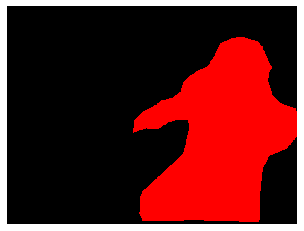

(480, 640, 3)
COCO_val2014_000000285651.jpg
{'person_bbx': [291.55, 109.78, 464.48, 281.65], 'Verbs': 'look', 'object': {'obj_bbx': [346.53, 269.16, 410.7, 290.97]}}
person
skateboard
look
look interaction
{'person_bbx': [291.55, 109.78, 464.48, 281.65], 'Verbs': 'skateboard', 'object': {'obj_bbx': [346.53, 269.16, 410.7, 290.97]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [291.55, 109.78, 464.48, 281.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


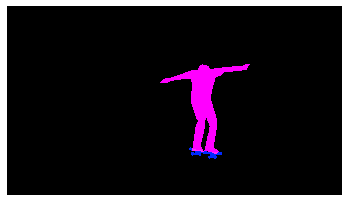

(360, 640, 3)
COCO_val2014_000000368222.jpg
{'person_bbx': [60.54, 97.3, 423.78000000000003, 513.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.54, 97.3, 423.78000000000003, 513.87], 'Verbs': 'sit', 'object': {'obj_bbx': [348.04, 257.44, 464.54, 519.19]}}
chair
person
sit
sit interaction
{'person_bbx': [60.54, 97.3, 423.78000000000003, 513.87], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


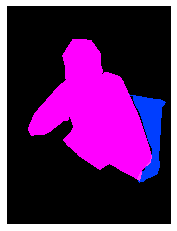

(640, 480, 3)
COCO_val2014_000000544122.jpg
{'person_bbx': [0.96, 17.27, 579.57, 420.28], 'Verbs': 'hold', 'object': {'obj_bbx': [121.63, 169.29, 451.15, 423.77]}}
dog
person
hold
hold interaction
{'person_bbx': [0.96, 17.27, 579.57, 420.28], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 0.0, 640.0, 420.95]}}
bed
person
lay
lay interaction
{'person_bbx': [0.96, 17.27, 579.57, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': [121.63, 169.29, 451.15, 423.77]}}
dog
person
look
look interaction


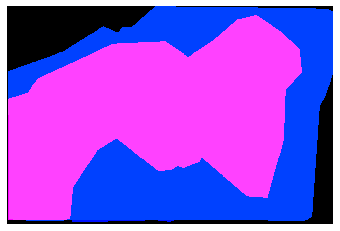

(427, 640, 3)
COCO_val2014_000000179141.jpg
{'person_bbx': [0.0, 4.31, 193.08, 277.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [276.43, 0.01, 561.4300000000001, 467.15], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [446.06, 42.91, 640.0, 474.41999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


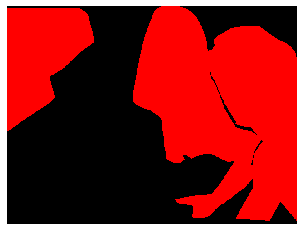

(480, 640, 3)
COCO_val2014_000000455555.jpg
{'person_bbx': [123.6, 102.58, 454.83000000000004, 475.84], 'Verbs': 'hold', 'object': {'obj_bbx': [155.73, 402.72, 306.52, 536.2]}}
person
skateboard
hold
hold interaction
{'person_bbx': [123.6, 102.58, 454.83000000000004, 475.84], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [123.6, 102.58, 454.83000000000004, 475.84], 'Verbs': 'skateboard', 'object': {'obj_bbx': [155.73, 402.72, 306.52, 536.2]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [123.6, 102.58, 454.83000000000004, 475.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


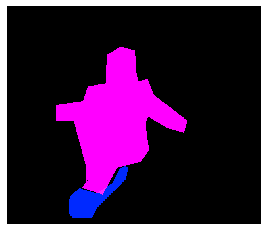

(550, 640, 3)
COCO_val2014_000000118069.jpg
{'person_bbx': [94.79, 170.28, 402.35, 492.64], 'Verbs': 'kick', 'object': {'obj_bbx': [528.45, 304.52, 580.74, 357.27]}}
sports ball
person
kick
kick interaction
{'person_bbx': [94.79, 170.28, 402.35, 492.64], 'Verbs': 'look', 'object': {'obj_bbx': [528.45, 304.52, 580.74, 357.27]}}
sports ball
person
look
look interaction
{'person_bbx': [94.79, 170.28, 402.35, 492.64], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [94.79, 170.28, 402.35, 492.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


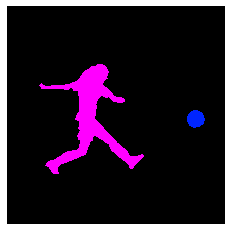

(640, 640, 3)
COCO_val2014_000000441491.jpg
{'person_bbx': [2.16, 2.16, 385.08000000000004, 474.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [283.69, 264.27, 423.90999999999997, 340.84999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [2.16, 2.16, 385.08000000000004, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [283.69, 264.27, 423.90999999999997, 340.84999999999997]}}
person
pizza
hold
hold interaction
{'person_bbx': [2.16, 2.16, 385.08000000000004, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [283.69, 264.27, 423.90999999999997, 340.84999999999997]}}
person
pizza
look
look interaction
{'person_bbx': [2.16, 2.16, 385.08000000000004, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


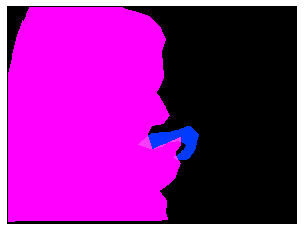

(480, 640, 3)
COCO_val2014_000000246843.jpg
{'person_bbx': [81.78, 165.18, 129.4, 284.03], 'Verbs': 'hold', 'object': {'obj_bbx': [118.05, 196.52, 136.6, 209.66000000000003]}}
person
frisbee
hold
hold interaction
{'person_bbx': [200.67, 154.33, 246.64, 273.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.78, 165.18, 129.4, 284.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [231.64, 153.64, 283.37, 276.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


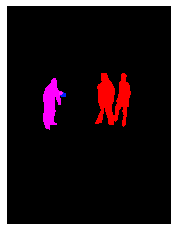

(500, 375, 3)
COCO_val2014_000000170048.jpg
{'person_bbx': [323.71, 90.39, 405.01, 294.4], 'Verbs': 'catch', 'object': {'obj_bbx': [310.42, 94.13, 330.0, 108.64999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [323.71, 90.39, 405.01, 294.4], 'Verbs': 'hold', 'object': {'obj_bbx': [310.42, 94.13, 330.0, 108.64999999999999]}}
person
frisbee
hold
hold interaction
{'person_bbx': [323.71, 90.39, 405.01, 294.4], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [323.71, 90.39, 405.01, 294.4], 'Verbs': 'look', 'object': {'obj_bbx': [310.42, 94.13, 330.0, 108.64999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [323.71, 90.39, 405.01, 294.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


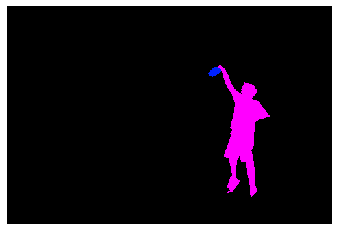

(335, 500, 3)
COCO_val2014_000000209989.jpg
{'person_bbx': [353.39, 397.94, 391.38, 472.83], 'Verbs': 'hold', 'object': {'obj_bbx': [361.6, 407.34, 377.19, 429.54999999999995]}}
backpack
person
hold
hold interaction
{'person_bbx': [379.96, 397.74, 412.97999999999996, 460.88], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [353.39, 397.94, 391.38, 472.83], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [379.96, 397.74, 412.97999999999996, 460.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.39, 397.94, 391.38, 472.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


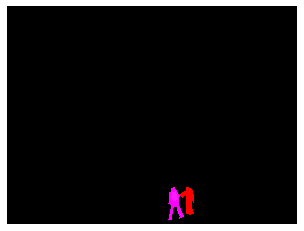

(480, 640, 3)
COCO_val2014_000000093806.jpg
{'person_bbx': [228.42, 117.13, 317.89, 263.31], 'Verbs': 'hold', 'object': {'obj_bbx': [187.81, 254.91, 332.35, 277.68]}}
skis
person
hold
hold interaction
{'person_bbx': [450.58, 119.94, 498.72999999999996, 259.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [312.3, 111.74, 383.93, 255.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [372.48, 132.54, 455.99, 280.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [228.42, 117.13, 317.89, 263.31], 'Verbs': 'ski', 'object': {'obj_bbx': [187.81, 254.91, 332.35, 277.68]}}
skis
person
ski
ski interaction
{'person_bbx': [450.58, 119.94, 498.72999999999996, 259.86], 'Verbs': 'ski', 'object': {'obj_bbx': [421.14, 250.29, 508.15999999999997, 270.39]}}
person
skis
ski
ski interaction
{'person_bbx': [312.3, 111.74, 383.93, 255.0], 'Verbs': 'ski', 'object': {'obj_bbx': [317.67, 248.18, 386.82000000000005, 263.36]}

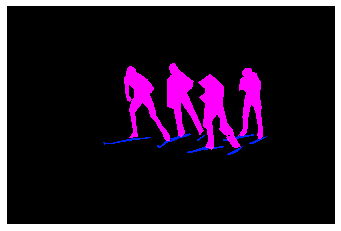

(425, 640, 3)
COCO_val2014_000000210457.jpg
{'person_bbx': [379.35, 124.42, 522.07, 418.58000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [301.19, 237.76, 397.89, 256.53]}}
person
frisbee
catch
catch interaction
{'person_bbx': [379.35, 124.42, 522.07, 418.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [301.19, 237.76, 397.89, 256.53]}}
person
frisbee
look
look interaction
{'person_bbx': [80.23, 126.23, 317.42, 415.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.35, 124.42, 522.07, 418.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


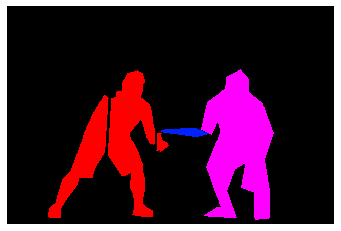

(426, 640, 3)
COCO_val2014_000000011699.jpg
{'person_bbx': [187.39, 99.46, 432.42999999999995, 632.7900000000001], 'Verbs': 'carry', 'object': {'obj_bbx': [257.44, 218.61, 366.74, 483.24]}}
person
handbag
carry
carry interaction
{'person_bbx': [60.54, 82.88, 223.42, 418.74], 'Verbs': 'carry', 'object': {'obj_bbx': [1.44, 399.82, 279.01, 632.81]}}
person
suitcase
carry
carry interaction
{'person_bbx': [60.54, 82.88, 223.42, 418.74], 'Verbs': 'hold', 'object': {'obj_bbx': [1.44, 399.82, 279.01, 632.81]}}
person
suitcase
hold
hold interaction
{'person_bbx': [187.39, 99.46, 432.42999999999995, 632.7900000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [60.54, 82.88, 223.42, 418.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [187.39, 99.46, 432.42999999999995, 632.7900000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.54, 82.88, 223.42, 418.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}

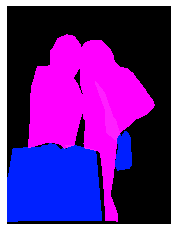

(640, 480, 3)
COCO_val2014_000000226008.jpg
{'person_bbx': [129.53, 104.4, 243.48000000000002, 205.12], 'Verbs': 'ride', 'object': {'obj_bbx': [38.71, 168.86, 148.22, 243.95000000000002]}}
boat
person
ride
ride interaction
{'person_bbx': [114.12, 102.23, 202.09, 206.35000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [38.71, 168.86, 148.22, 243.95000000000002]}}
boat
person
ride
ride interaction
{'person_bbx': [129.53, 104.4, 243.48000000000002, 205.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [114.12, 102.23, 202.09, 206.35000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [129.53, 104.4, 243.48000000000002, 205.12], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


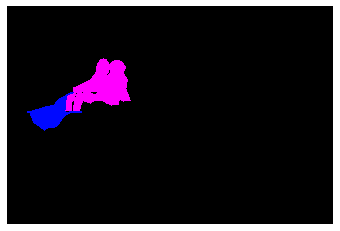

(427, 640, 3)
COCO_val2014_000000183843.jpg
{'person_bbx': [13.43, 46.06, 167.92000000000002, 354.07], 'Verbs': 'snowboard', 'object': {'obj_bbx': [37.26, 294.31, 191.04999999999998, 372.64]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [13.43, 46.06, 167.92000000000002, 354.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


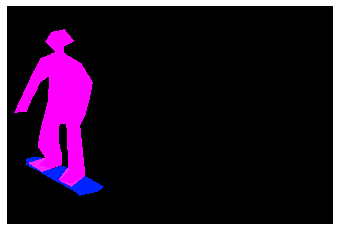

(427, 640, 3)
COCO_val2014_000000303499.jpg
{'person_bbx': [40.45, 15.81, 160.67000000000002, 309.06], 'Verbs': 'hold', 'object': {'obj_bbx': [4.48, 160.31, 177.13, 452.91]}}
person
horse
hold
hold interaction
{'person_bbx': [196.05, 36.95, 332.93, 318.61], 'Verbs': 'hold', 'object': {'obj_bbx': [183.48, 185.19, 326.17999999999995, 449.14]}}
horse
person
hold
hold interaction
{'person_bbx': [40.45, 15.81, 160.67000000000002, 309.06], 'Verbs': 'ride', 'object': {'obj_bbx': [4.48, 160.31, 177.13, 452.91]}}
person
horse
ride
ride interaction
{'person_bbx': [196.05, 36.95, 332.93, 318.61], 'Verbs': 'ride', 'object': {'obj_bbx': [183.48, 185.19, 326.17999999999995, 449.14]}}
horse
person
ride
ride interaction
{'person_bbx': [40.45, 15.81, 160.67000000000002, 309.06], 'Verbs': 'sit', 'object': {'obj_bbx': [4.48, 160.31, 177.13, 452.91]}}
person
horse
sit
sit interaction
{'person_bbx': [196.05, 36.95, 332.93, 318.61], 'Verbs': 'sit', 'object': {'obj_bbx': [183.48, 185.19, 326.17999999999995, 

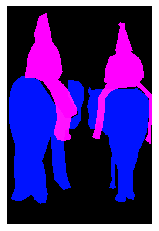

(500, 333, 3)
COCO_val2014_000000082551.jpg
{'person_bbx': [0.0, 65.82, 460.5, 370.56], 'Verbs': 'sit', 'object': {'obj_bbx': [283.96, 132.39, 500.0, 375.0]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 65.82, 460.5, 370.56], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 65.82, 460.5, 370.56], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [66.24, 222.38, 272.04, 375.0]}}
person
laptop
work_on_computer
work_on_computer interaction


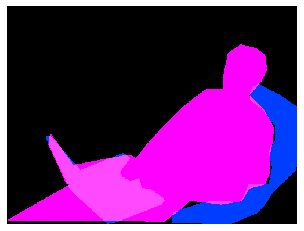

(375, 500, 3)
COCO_val2014_000000276263.jpg
{'person_bbx': [2.45, 350.41, 254.73, 615.54], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


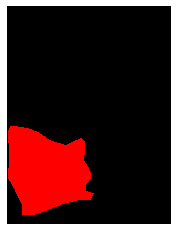

(640, 480, 3)
COCO_val2014_000000114458.jpg
{'person_bbx': [221.12, 35.6, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [316.38, 222.75, 462.36, 262.4]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [221.12, 35.6, 640.0, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [1.07, 1.18, 640.0, 480.0]}}
bed
person
lay
lay interaction
{'person_bbx': [221.12, 35.6, 640.0, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


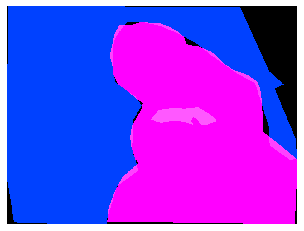

(480, 640, 3)
COCO_val2014_000000234889.jpg
{'person_bbx': [547.14, 339.13, 596.3, 463.15], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [608.36, 333.3, 640.0, 430.38], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [547.14, 339.13, 596.3, 463.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [608.36, 333.3, 640.0, 430.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [547.14, 339.13, 596.3, 463.15], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [608.36, 333.3, 640.0, 430.38], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


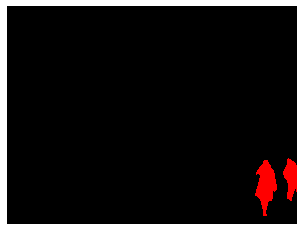

(480, 640, 3)
COCO_val2014_000000013659.jpg
{'person_bbx': [152.06, 217.16, 379.74, 479.02], 'Verbs': 'look', 'object': {'obj_bbx': [53.93, 348.4, 199.55, 460.58]}}
person
laptop
look
look interaction
{'person_bbx': [152.06, 217.16, 379.74, 479.02], 'Verbs': 'sit', 'object': {'obj_bbx': [377.81, 416.0, 422.19, 473.81]}}
chair
person
sit
sit interaction
{'person_bbx': [152.06, 217.16, 379.74, 479.02], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [53.93, 348.4, 199.55, 460.58]}}
person
laptop
work_on_computer
work_on_computer interaction


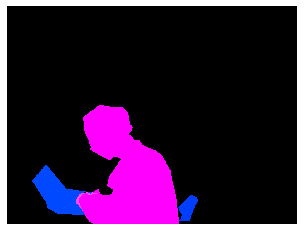

(480, 640, 3)
COCO_val2014_000000113588.jpg
{'person_bbx': [120.33, 240.9, 425.0, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [186.97, 421.35, 238.6, 449.84000000000003]}}
mouse
person
hold
hold interaction
{'person_bbx': [120.33, 240.9, 425.0, 631.37], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 352.12, 233.99, 615.65]}}
laptop
person
look
look interaction
{'person_bbx': [120.33, 240.9, 425.0, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [120.33, 240.9, 425.0, 631.37], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 352.12, 233.99, 615.65]}}
laptop
person
work_on_computer
work_on_computer interaction


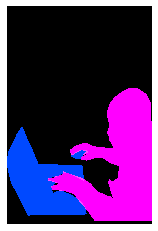

(640, 425, 3)
COCO_val2014_000000252054.jpg
{'person_bbx': [118.54, 64.51, 512.76, 411.86], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [28.95, 407.31, 176.42999999999998, 507.93]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [118.54, 64.51, 512.76, 411.86], 'Verbs': 'sit', 'object': {'obj_bbx': [111.65, 277.74, 449.35, 364.58000000000004]}}
chair
person
sit
sit interaction


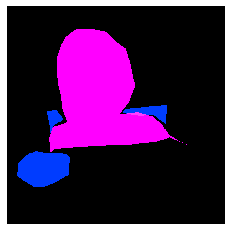

(612, 612, 3)
COCO_val2014_000000212927.jpg
{'person_bbx': [153.53, 68.02, 267.71000000000004, 218.67000000000002], 'Verbs': 'lay', 'object': {'obj_bbx': [86.06, 173.33, 640.0, 427.0]}}
person
bed
lay
lay interaction
{'person_bbx': [153.53, 68.02, 267.71000000000004, 218.67000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [235.19, 135.43, 355.67, 212.54000000000002]}}
person
laptop
look
look interaction
{'person_bbx': [153.53, 68.02, 267.71000000000004, 218.67000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [86.06, 173.33, 640.0, 427.0]}}
person
bed
sit
sit interaction
{'person_bbx': [153.53, 68.02, 267.71000000000004, 218.67000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [235.19, 135.43, 355.67, 212.54000000000002]}}
person
laptop
work_on_computer
work_on_computer interaction


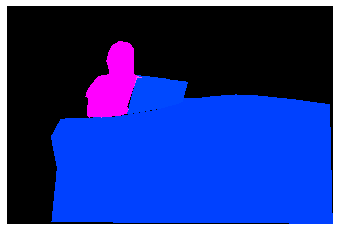

(427, 640, 3)
COCO_val2014_000000115793.jpg
{'person_bbx': [0.75, 1.5, 470.69, 89.8], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [21.75, 32.25, 491.25, 223.5]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [0.75, 1.5, 470.69, 89.8], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [35.91, 12.03, 136.72, 51.7]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [0.75, 1.5, 470.69, 89.8], 'Verbs': 'hold', 'object': {'obj_bbx': [35.91, 12.03, 136.72, 51.7]}}
fork
person
hold
hold interaction
{'person_bbx': [0.75, 1.5, 470.69, 89.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


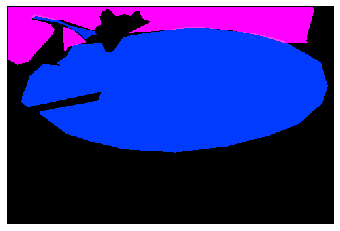

(333, 500, 3)
COCO_val2014_000000170178.jpg
{'person_bbx': [86.49, 66.49, 323.24, 471.89], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [289.33, 394.09, 353.18, 437.75]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [86.49, 66.49, 323.24, 471.89], 'Verbs': 'hold', 'object': {'obj_bbx': [289.33, 394.09, 353.18, 437.75]}}
person
knife
hold
hold interaction
{'person_bbx': [86.49, 66.49, 323.24, 471.89], 'Verbs': 'look', 'object': {'obj_bbx': [289.33, 394.09, 353.18, 437.75]}}
person
knife
look
look interaction
{'person_bbx': [86.49, 66.49, 323.24, 471.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


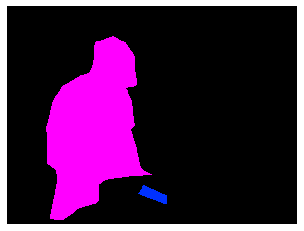

(480, 640, 3)
COCO_val2014_000000484681.jpg
{'person_bbx': [84.54, 87.61, 454.74, 618.27], 'Verbs': 'hold', 'object': {'obj_bbx': [1.66, 196.16, 144.62, 369.03999999999996]}}
suitcase
person
hold
hold interaction
{'person_bbx': [84.54, 87.61, 454.74, 618.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.54, 87.61, 454.74, 618.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


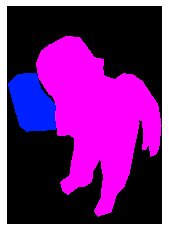

(640, 456, 3)
COCO_val2014_000000314147.jpg
{'person_bbx': [7.22, 60.32, 395.85, 632.4200000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [306.71, 504.79, 374.33, 640.0]}}
person
chair
sit
sit interaction
{'person_bbx': [7.22, 60.32, 395.85, 632.4200000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


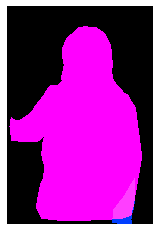

(640, 427, 3)
COCO_val2014_000000273825.jpg
{'person_bbx': [4.3, 68.88, 479.28000000000003, 632.83], 'Verbs': 'hold', 'object': {'obj_bbx': [286.31, 280.16, 315.22, 451.74]}}
cell phone
person
hold
hold interaction
{'person_bbx': [4.3, 68.88, 479.28000000000003, 632.83], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 301.77, 114.36, 354.28]}}
person
chair
sit
sit interaction
{'person_bbx': [4.3, 68.88, 479.28000000000003, 632.83], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [286.31, 280.16, 315.22, 451.74]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


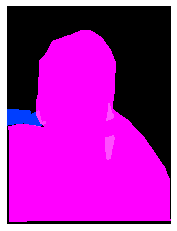

(640, 480, 3)
COCO_val2014_000000544857.jpg
{'person_bbx': [241.64, 188.82, 400.34, 376.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [241.64, 188.82, 400.34, 376.04999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [212.08, 369.87, 371.77, 385.84000000000003]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [241.64, 188.82, 400.34, 376.04999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


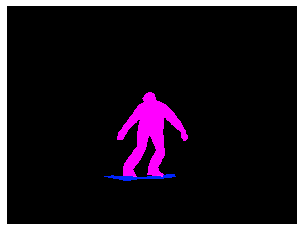

(480, 640, 3)
COCO_val2014_000000187055.jpg
{'person_bbx': [176.41, 127.45, 361.79999999999995, 461.55], 'Verbs': 'catch', 'object': {'obj_bbx': [278.79, 195.88, 311.93, 228.63]}}
person
sports ball
catch
catch interaction
{'person_bbx': [176.41, 127.45, 361.79999999999995, 461.55], 'Verbs': 'hold', 'object': {'obj_bbx': [302.46, 316.29, 323.88, 335.73]}}
sports ball
person
hold
hold interaction
{'person_bbx': [176.41, 127.45, 361.79999999999995, 461.55], 'Verbs': 'look', 'object': {'obj_bbx': [278.79, 195.88, 311.93, 228.63]}}
person
sports ball
look
look interaction
{'person_bbx': [0.0, 314.92, 321.28, 639.3], 'Verbs': 'look', 'object': {'obj_bbx': [176.41, 127.45, 361.79999999999995, 461.55]}}
person
person
look
look interaction
{'person_bbx': [176.41, 127.45, 361.79999999999995, 461.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 314.92, 321.28, 639.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


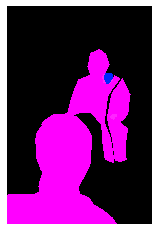

(640, 425, 3)
COCO_val2014_000000192502.jpg
{'person_bbx': [183.09, 230.56, 236.36, 397.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [264.86, 230.81, 326.49, 423.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [356.14, 250.25, 420.74, 427.22], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [425.95, 247.03, 497.29999999999995, 434.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [183.09, 230.56, 236.36, 397.75], 'Verbs': 'ski', 'object': {'obj_bbx': [185.19, 390.4, 237.91, 416.09999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [264.86, 230.81, 326.49, 423.24], 'Verbs': 'ski', 'object': {'obj_bbx': [265.12, 394.86, 325.46000000000004, 435.23]}}
person
skis
ski
ski interaction
{'person_bbx': [356.14, 250.25, 420.74, 427.22], 'Verbs': 'ski', 'object': {'obj_bbx': [357.21, 418.32, 396.54999999999995, 444.26]}}
person
skis
ski
ski interaction
{'person_bbx': [425.95, 247

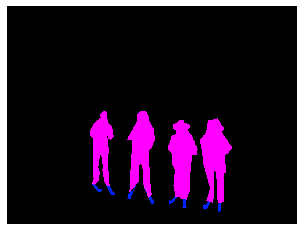

(480, 640, 3)
COCO_val2014_000000574343.jpg
{'person_bbx': [316.34, 209.66, 524.56, 358.76], 'Verbs': 'jump', 'object': {'obj_bbx': [284.99, 238.77, 429.88, 396.13]}}
person
snowboard
jump
jump interaction
{'person_bbx': [316.34, 209.66, 524.56, 358.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [284.99, 238.77, 429.88, 396.13]}}
person
snowboard
snowboard
snowboard interaction


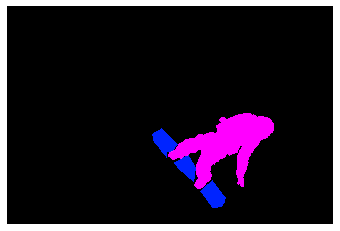

(427, 640, 3)
COCO_val2014_000000577403.jpg
{'person_bbx': [288.76, 50.84, 473.03, 482.29999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [275.11, 194.92, 405.11, 367.28]}}
person
skateboard
carry
carry interaction
{'person_bbx': [288.76, 50.84, 473.03, 482.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [275.11, 194.92, 405.11, 367.28]}}
person
skateboard
hold
hold interaction
{'person_bbx': [288.76, 50.84, 473.03, 482.29999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [68.54, 184.27, 275.28000000000003, 428.09000000000003]}}
person
person
look
look interaction
{'person_bbx': [68.54, 184.27, 275.28000000000003, 428.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [102.76, 416.8, 256.99, 445.52]}}
person
skateboard
look
look interaction
{'person_bbx': [68.54, 184.27, 275.28000000000003, 428.09000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [102.76, 416.8, 256.99, 445.52]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [288.76, 

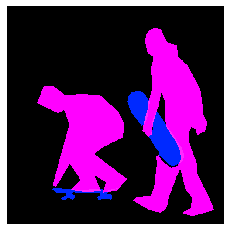

(500, 497, 3)
COCO_val2014_000000338905.jpg
{'person_bbx': [71.04, 202.06, 214.16000000000003, 358.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [365.4, 223.2, 480.0, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [71.04, 202.06, 214.16000000000003, 358.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [250.8, 234.38, 408.35, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [365.4, 223.2, 480.0, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [71.04, 202.06, 214.16000000000003, 358.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [20.22, 287.06, 151.28, 356.63]}}
chair
person
sit
sit interaction
{'person_bbx': [250.8, 234.38, 408.35, 360.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [365.4, 223.2, 480.0, 360.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


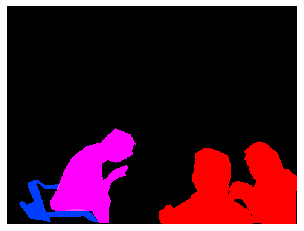

(360, 480, 3)
COCO_val2014_000000105732.jpg
{'person_bbx': [505.89, 91.69, 616.99, 443.33], 'Verbs': 'carry', 'object': {'obj_bbx': [557.1, 158.71, 639.82, 263.3]}}
backpack
person
carry
carry interaction
{'person_bbx': [15.1, 88.45, 167.19, 458.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [15.1, 88.45, 167.19, 458.43], 'Verbs': 'ski', 'object': {'obj_bbx': [1.65, 400.5, 240.83, 478.74]}}
person
skis
ski
ski interaction
{'person_bbx': [15.1, 88.45, 167.19, 458.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [505.89, 91.69, 616.99, 443.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


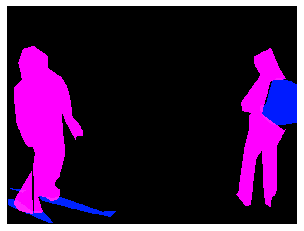

(480, 640, 3)
COCO_val2014_000000431693.jpg
{'person_bbx': [172.69, 143.94, 469.94, 369.36], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [109.23, 270.77, 189.77, 309.53999999999996]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [172.69, 143.94, 469.94, 369.36], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [116.19, 235.5, 130.35999999999999, 249.16]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [172.69, 143.94, 469.94, 369.36], 'Verbs': 'hold', 'object': {'obj_bbx': [109.23, 270.77, 189.77, 309.53999999999996]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [172.69, 143.94, 469.94, 369.36], 'Verbs': 'look', 'object': {'obj_bbx': [116.19, 235.5, 130.35999999999999, 249.16]}}
sports ball
person
look
look interaction
{'person_bbx': [172.69, 143.94, 469.94, 369.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


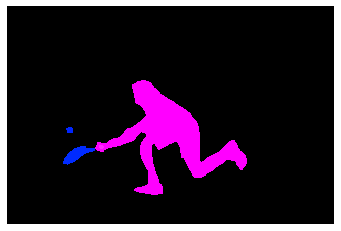

(426, 640, 3)
COCO_val2014_000000248400.jpg
{'person_bbx': [0.0, 7.47, 251.57, 418.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 7.47, 251.57, 418.08000000000004], 'Verbs': 'point', 'object': {'obj_bbx': [273.28, 370.74, 523.4499999999999, 421.98]}}
person
pizza
point
point interaction
{'person_bbx': [0.0, 7.47, 251.57, 418.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


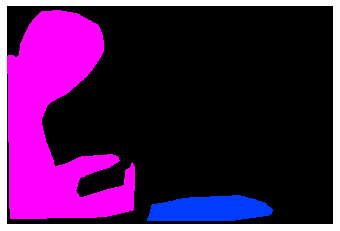

(427, 640, 3)
COCO_val2014_000000373713.jpg
{'person_bbx': [180.4, 151.95, 305.9, 329.5], 'Verbs': 'look', 'object': {'obj_bbx': [15.71, 142.93, 136.19, 329.26]}}
person
person
look
look interaction
{'person_bbx': [15.71, 142.93, 136.19, 329.26], 'Verbs': 'look', 'object': {'obj_bbx': [336.74, 140.68, 443.75, 286.6]}}
person
person
look
look interaction
{'person_bbx': [180.4, 151.95, 305.9, 329.5], 'Verbs': 'sit', 'object': {'obj_bbx': [158.26, 246.23, 289.32, 330.02]}}
chair
person
sit
sit interaction
{'person_bbx': [15.71, 142.93, 136.19, 329.26], 'Verbs': 'sit', 'object': {'obj_bbx': [112.4, 290.9, 148.47, 333.0]}}
person
chair
sit
sit interaction
{'person_bbx': [336.74, 140.68, 443.75, 286.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [15.71, 142.93, 136.19, 329.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


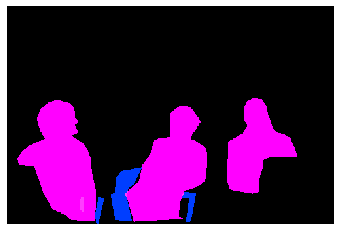

(333, 500, 3)
COCO_val2014_000000577614.jpg
{'person_bbx': [404.48, 228.97, 464.74, 311.44], 'Verbs': 'look', 'object': {'obj_bbx': [451.28, 251.4, 490.21999999999997, 279.44]}}
person
laptop
look
look interaction
{'person_bbx': [103.09, 234.92, 157.67000000000002, 315.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [404.48, 228.97, 464.74, 311.44], 'Verbs': 'sit', 'object': {'obj_bbx': [370.05, 224.65, 567.57, 446.99]}}
person
bench
sit
sit interaction
{'person_bbx': [103.09, 234.92, 157.67000000000002, 315.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [44.64, 360.64, 102.86, 403.83]}}
person
bench
sit
sit interaction
{'person_bbx': [404.48, 228.97, 464.74, 311.44], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [451.28, 251.4, 490.21999999999997, 279.44]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [103.09, 234.92, 157.67000000000002, 315.40999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_

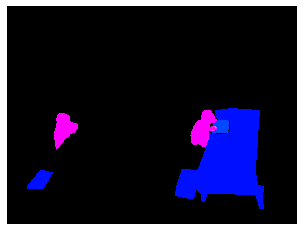

(480, 640, 3)
COCO_val2014_000000574507.jpg
{'person_bbx': [34.36, 38.18, 317.85, 334.56], 'Verbs': 'jump', 'object': {'obj_bbx': [73.83, 277.94, 389.03, 345.17]}}
person
snowboard
jump
jump interaction
{'person_bbx': [34.36, 38.18, 317.85, 334.56], 'Verbs': 'snowboard', 'object': {'obj_bbx': [73.83, 277.94, 389.03, 345.17]}}
person
snowboard
snowboard
snowboard interaction


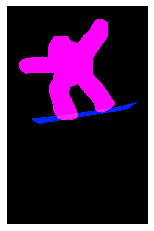

(640, 413, 3)
COCO_val2014_000000450543.jpg
{'person_bbx': [126.18, 0.0, 321.8, 325.78], 'Verbs': 'jump', 'object': {'obj_bbx': [138.58, 237.36, 236.77, 333.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [126.18, 0.0, 321.8, 325.78], 'Verbs': 'look', 'object': {'obj_bbx': [138.58, 237.36, 236.77, 333.0]}}
person
skateboard
look
look interaction
{'person_bbx': [126.18, 0.0, 321.8, 325.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [138.58, 237.36, 236.77, 333.0]}}
person
skateboard
skateboard
skateboard interaction


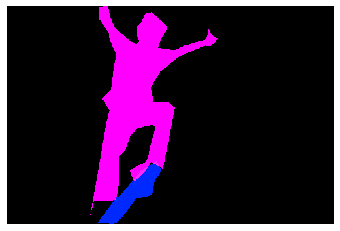

(333, 500, 3)
COCO_val2014_000000573214.jpg
{'person_bbx': [233.87, 240.31, 272.44, 336.67], 'Verbs': 'ride', 'object': {'obj_bbx': [217.9, 281.96, 361.9, 372.38]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [255.23, 249.93, 325.65, 351.71000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [217.9, 281.96, 361.9, 372.38]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [233.87, 240.31, 272.44, 336.67], 'Verbs': 'sit', 'object': {'obj_bbx': [217.9, 281.96, 361.9, 372.38]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [255.23, 249.93, 325.65, 351.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [217.9, 281.96, 361.9, 372.38]}}
motorcycle
person
sit
sit interaction


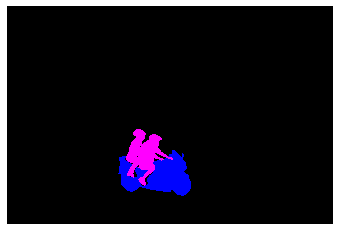

(427, 640, 3)
COCO_val2014_000000535135.jpg
{'person_bbx': [440.41, 105.64, 514.32, 205.82], 'Verbs': 'look', 'object': {'obj_bbx': [401.71, 178.38, 534.97, 224.64]}}
person
surfboard
look
look interaction
{'person_bbx': [440.41, 105.64, 514.32, 205.82], 'Verbs': 'surf', 'object': {'obj_bbx': [401.71, 178.38, 534.97, 224.64]}}
person
surfboard
surf
surf interaction


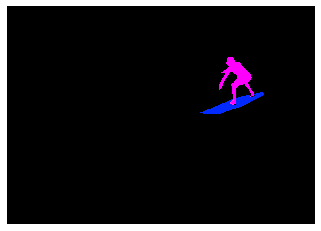

(453, 640, 3)
COCO_val2014_000000376123.jpg
{'person_bbx': [454.74, 168.16, 565.44, 243.04], 'Verbs': 'look', 'object': {'obj_bbx': [128.14, 184.73, 136.22, 191.92999999999998]}}
sports ball
person
look
look interaction


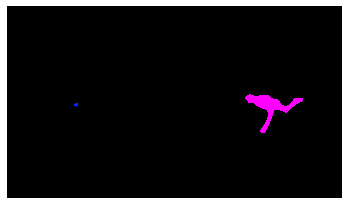

(366, 640, 3)
COCO_val2014_000000489207.jpg
{'person_bbx': [105.46, 54.99, 356.84, 608.3100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [108.74, 199.3, 129.4, 214.32000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [105.46, 54.99, 356.84, 608.3100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [108.74, 199.3, 129.4, 214.32000000000002]}}
cell phone
person
look
look interaction
{'person_bbx': [105.46, 54.99, 356.84, 608.3100000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [90.9, 579.9, 320.93, 640.0]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [105.46, 54.99, 356.84, 608.3100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


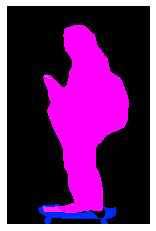

(640, 418, 3)
COCO_val2014_000000189752.jpg
{'person_bbx': [142.7, 0.54, 638.9200000000001, 240.54], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [298.79, 195.24, 436.85, 245.93]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [142.7, 0.54, 638.9200000000001, 240.54], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [249.66, 101.23, 322.76, 228.04000000000002]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [142.7, 0.54, 638.9200000000001, 240.54], 'Verbs': 'hold', 'object': {'obj_bbx': [249.66, 101.23, 322.76, 228.04000000000002]}}
fork
person
hold
hold interaction
{'person_bbx': [142.7, 0.54, 638.9200000000001, 240.54], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


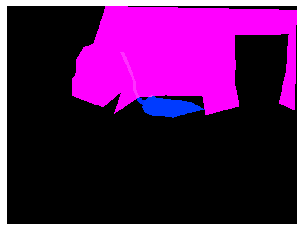

(480, 640, 3)
COCO_val2014_000000421955.jpg
{'person_bbx': [244.6, 67.8, 367.8, 273.14], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [289.35, 282.35, 312.34000000000003, 403.72]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [244.6, 67.8, 367.8, 273.14], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [159.85, 292.43, 529.34, 419.74]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [306.24, 31.39, 513.29, 313.57], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [289.35, 282.35, 312.34000000000003, 403.72]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [306.24, 31.39, 513.29, 313.57], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [159.85, 292.43, 529.34, 419.74]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [173.72, 84.64, 312.96000000000004, 301.27], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [289.35, 282.35, 312.34000000000003, 403.72]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [173.72, 84.64, 312.96000000000004, 301.27], 'Verbs':

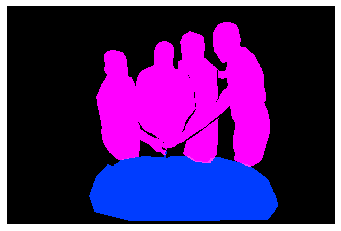

(425, 640, 3)
COCO_val2014_000000380459.jpg
{'person_bbx': [54.52, 1.19, 470.52, 209.78], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [272.64, 131.23, 344.19, 195.35]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [54.52, 1.19, 470.52, 209.78], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


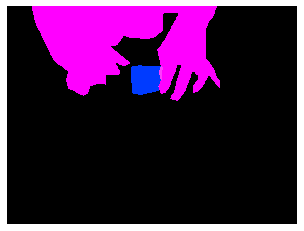

(480, 640, 3)
COCO_val2014_000000529539.jpg
{'person_bbx': [86.88, 62.65, 310.87, 260.03999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [5.18, 2.39, 98.22999999999999, 129.72]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [86.88, 62.65, 310.87, 260.03999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [125.02, 213.36, 137.57999999999998, 226.43]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [86.88, 62.65, 310.87, 260.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [5.18, 2.39, 98.22999999999999, 129.72]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [86.88, 62.65, 310.87, 260.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [125.02, 213.36, 137.57999999999998, 226.43]}}
sports ball
person
look
look interaction
{'person_bbx': [86.88, 62.65, 310.87, 260.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


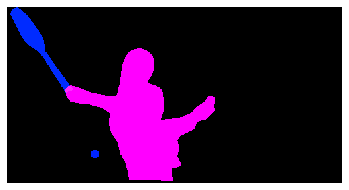

(263, 500, 3)
COCO_val2014_000000078858.jpg
{'person_bbx': [260.47, 92.1, 427.07000000000005, 259.81], 'Verbs': 'hold', 'object': {'obj_bbx': [326.88, 212.65, 356.23, 266.41]}}
cup
person
hold
hold interaction
{'person_bbx': [447.78, 81.95, 640.0, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [627.21, 204.75, 640.0, 261.33]}}
person
chair
sit
sit interaction
{'person_bbx': [260.47, 92.1, 427.07000000000005, 259.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [447.78, 81.95, 640.0, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [260.47, 92.1, 427.07000000000005, 259.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


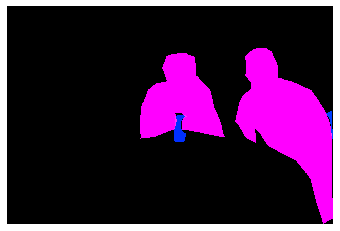

(427, 640, 3)
COCO_val2014_000000540614.jpg
{'person_bbx': [72.23, 137.42, 427.77000000000004, 415.06999999999994], 'Verbs': 'jump', 'object': {'obj_bbx': [186.16, 365.0, 289.06, 437.59000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [72.23, 137.42, 427.77000000000004, 415.06999999999994], 'Verbs': 'look', 'object': {'obj_bbx': [186.16, 365.0, 289.06, 437.59000000000003]}}
person
skateboard
look
look interaction
{'person_bbx': [72.23, 137.42, 427.77000000000004, 415.06999999999994], 'Verbs': 'skateboard', 'object': {'obj_bbx': [186.16, 365.0, 289.06, 437.59000000000003]}}
person
skateboard
skateboard
skateboard interaction


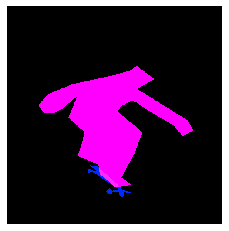

(500, 494, 3)
COCO_val2014_000000386116.jpg
{'person_bbx': [168.14, 369.93, 283.44, 447.28], 'Verbs': 'look', 'object': {'obj_bbx': [457.93, 150.28, 514.71, 219.48000000000002]}}
person
kite
look
look interaction


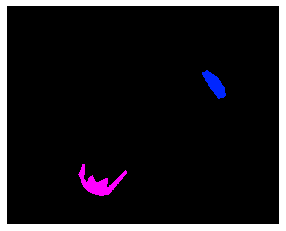

(512, 640, 3)
COCO_val2014_000000054091.jpg
{'person_bbx': [218.18, 123.43, 463.79, 473.77], 'Verbs': 'hold', 'object': {'obj_bbx': [327.42, 311.35, 454.47, 354.21000000000004]}}
laptop
person
hold
hold interaction
{'person_bbx': [218.18, 123.43, 463.79, 473.77], 'Verbs': 'look', 'object': {'obj_bbx': [327.42, 311.35, 454.47, 354.21000000000004]}}
laptop
person
look
look interaction
{'person_bbx': [218.18, 123.43, 463.79, 473.77], 'Verbs': 'sit', 'object': {'obj_bbx': [141.62, 151.89, 477.84000000000003, 472.96999999999997]}}
chair
person
sit
sit interaction
{'person_bbx': [218.18, 123.43, 463.79, 473.77], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [327.42, 311.35, 454.47, 354.21000000000004]}}
laptop
person
work_on_computer
work_on_computer interaction


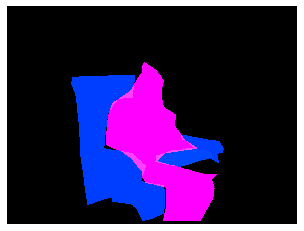

(480, 640, 3)
COCO_val2014_000000266866.jpg
{'person_bbx': [405.58, 138.29, 497.46, 299.77], 'Verbs': 'carry', 'object': {'obj_bbx': [392.02, 106.0, 493.13, 170.69]}}
umbrella
person
carry
carry interaction
{'person_bbx': [405.58, 138.29, 497.46, 299.77], 'Verbs': 'hold', 'object': {'obj_bbx': [392.02, 106.0, 493.13, 170.69]}}
umbrella
person
hold
hold interaction
{'person_bbx': [405.58, 138.29, 497.46, 299.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [405.58, 138.29, 497.46, 299.77], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


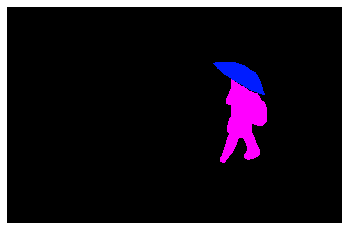

(413, 640, 3)
COCO_val2014_000000280083.jpg
{'person_bbx': [189.13, 0.21, 504.40999999999997, 341.98999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [288.87, 300.57, 395.15, 356.92]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [189.13, 0.21, 504.40999999999997, 341.98999999999995], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [375.39, 295.49, 481.2, 337.12]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [189.13, 0.21, 504.40999999999997, 341.98999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [375.39, 295.49, 481.2, 337.12]}}
person
fork
hold
hold interaction
{'person_bbx': [189.13, 0.21, 504.40999999999997, 341.98999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [288.87, 300.57, 395.15, 356.92]}}
person
pizza
look
look interaction
{'person_bbx': [189.13, 0.21, 504.40999999999997, 341.98999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [460.58, 190.44, 552.7, 421.7]}}
chair
person
sit
sit interaction


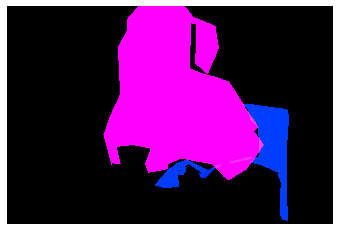

(427, 640, 3)
COCO_val2014_000000451043.jpg
{'person_bbx': [165.13, 146.17, 250.51, 302.52], 'Verbs': 'look', 'object': {'obj_bbx': [202.95, 289.56, 278.93, 305.75]}}
person
snowboard
look
look interaction
{'person_bbx': [165.13, 146.17, 250.51, 302.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [202.95, 289.56, 278.93, 305.75]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [165.13, 146.17, 250.51, 302.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


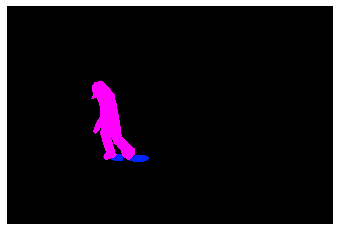

(427, 640, 3)
COCO_val2014_000000158288.jpg
{'person_bbx': [342.06, 99.09, 638.38, 327.77], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 77.84, 640.0, 417.92999999999995]}}
person
bed
lay
lay interaction
{'person_bbx': [0.0, 81.73, 204.7, 287.81], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 77.84, 640.0, 417.92999999999995]}}
bed
person
lay
lay interaction


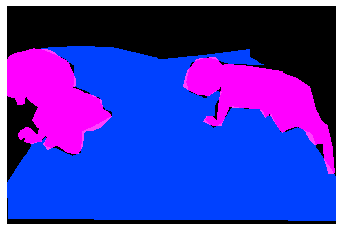

(424, 640, 3)
COCO_val2014_000000273961.jpg
{'person_bbx': [85.91, 99.75, 269.16999999999996, 404.71], 'Verbs': 'hold', 'object': {'obj_bbx': [181.21, 317.84, 248.81, 497.62]}}
person
skateboard
hold
hold interaction
{'person_bbx': [85.91, 99.75, 269.16999999999996, 404.71], 'Verbs': 'jump', 'object': {'obj_bbx': [181.21, 317.84, 248.81, 497.62]}}
person
skateboard
jump
jump interaction
{'person_bbx': [85.91, 99.75, 269.16999999999996, 404.71], 'Verbs': 'look', 'object': {'obj_bbx': [181.21, 317.84, 248.81, 497.62]}}
person
skateboard
look
look interaction
{'person_bbx': [85.91, 99.75, 269.16999999999996, 404.71], 'Verbs': 'skateboard', 'object': {'obj_bbx': [181.21, 317.84, 248.81, 497.62]}}
person
skateboard
skateboard
skateboard interaction


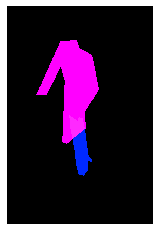

(640, 427, 3)
COCO_val2014_000000361046.jpg
{'person_bbx': [230.05, 133.52, 380.24, 279.8], 'Verbs': 'surf', 'object': {'obj_bbx': [269.68, 267.55, 384.59000000000003, 293.36]}}
person
surfboard
surf
surf interaction


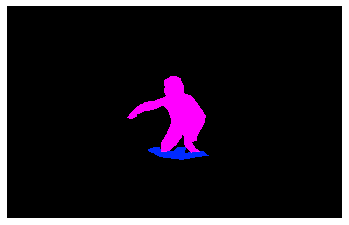

(404, 640, 3)
COCO_val2014_000000107234.jpg
{'person_bbx': [0.0, 6.74, 331.46, 492.13], 'Verbs': 'hold', 'object': {'obj_bbx': [32.67, 287.96, 115.10000000000001, 430.65]}}
person
wine glass
hold
hold interaction
{'person_bbx': [0.0, 6.74, 331.46, 492.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


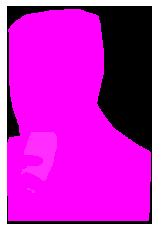

(500, 333, 3)
COCO_val2014_000000018982.jpg
{'person_bbx': [50.29, 85.61, 550.58, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [187.61, 214.23, 256.72, 317.35]}}
cell phone
person
hold
hold interaction
{'person_bbx': [50.29, 85.61, 550.58, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [50.29, 85.61, 550.58, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [50.29, 85.61, 550.58, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [50.29, 85.61, 550.58, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [187.61, 214.23, 256.72, 317.35]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


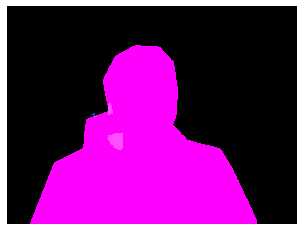

(480, 640, 3)
COCO_val2014_000000412286.jpg
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [89.66, 149.37, 141.63, 207.18]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [165.6, 111.13, 179.85999999999999, 125.8]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'hold', 'object': {'obj_bbx': [89.66, 149.37, 141.63, 207.18]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'look', 'object': {'obj_bbx': [165.6, 111.13, 179.85999999999999, 125.8]}}
sports ball
person
look
look interaction
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [76.4, 155.06, 206.74, 450.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


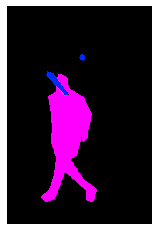

(500, 333, 3)
COCO_val2014_000000079139.jpg
{'person_bbx': [106.1, 149.09, 212.11, 305.72], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [85.31, 170.52, 111.97, 216.89000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [106.1, 149.09, 212.11, 305.72], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [148.15, 147.94, 154.63, 154.82999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [106.1, 149.09, 212.11, 305.72], 'Verbs': 'hold', 'object': {'obj_bbx': [85.31, 170.52, 111.97, 216.89000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [106.1, 149.09, 212.11, 305.72], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [106.1, 149.09, 212.11, 305.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


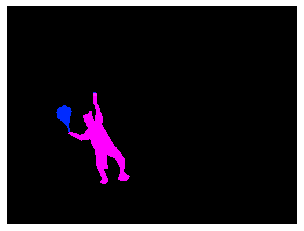

(375, 500, 3)
COCO_val2014_000000380609.jpg
{'person_bbx': [228.72, 103.48, 537.99, 295.7], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [228.72, 103.48, 537.99, 295.7], 'Verbs': 'surf', 'object': {'obj_bbx': [71.19, 211.42, 524.22, 293.39]}}
person
surfboard
surf
surf interaction


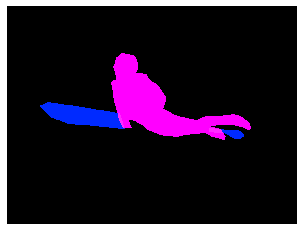

(480, 640, 3)
COCO_val2014_000000549268.jpg
{'person_bbx': [323.42, 48.41, 389.69, 222.87], 'Verbs': 'ride', 'object': {'obj_bbx': [98.39, 135.74, 486.22999999999996, 375.51]}}
person
elephant
ride
ride interaction
{'person_bbx': [255.12, 48.59, 316.52, 200.52], 'Verbs': 'ride', 'object': {'obj_bbx': [98.39, 135.74, 486.22999999999996, 375.51]}}
elephant
person
ride
ride interaction
{'person_bbx': [323.42, 48.41, 389.69, 222.87], 'Verbs': 'sit', 'object': {'obj_bbx': [98.39, 135.74, 486.22999999999996, 375.51]}}
person
elephant
sit
sit interaction
{'person_bbx': [255.12, 48.59, 316.52, 200.52], 'Verbs': 'sit', 'object': {'obj_bbx': [98.39, 135.74, 486.22999999999996, 375.51]}}
elephant
person
sit
sit interaction
{'person_bbx': [255.12, 48.59, 316.52, 200.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


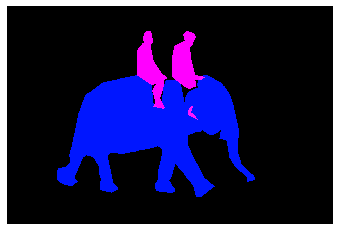

(427, 640, 3)
COCO_val2014_000000371552.jpg
{'person_bbx': [183.6, 56.75, 289.56, 374.64], 'Verbs': 'kick', 'object': {'obj_bbx': [152.09, 329.37, 200.83, 378.75]}}
sports ball
person
kick
kick interaction
{'person_bbx': [183.6, 56.75, 289.56, 374.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


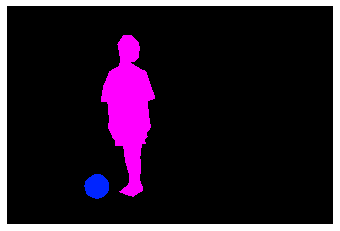

(427, 640, 3)
COCO_val2014_000000230877.jpg
{'person_bbx': [292.13, 135.97, 400.8, 221.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [292.13, 135.97, 400.8, 221.8], 'Verbs': 'surf', 'object': {'obj_bbx': [286.93, 195.51, 419.5, 226.35]}}
person
surfboard
surf
surf interaction


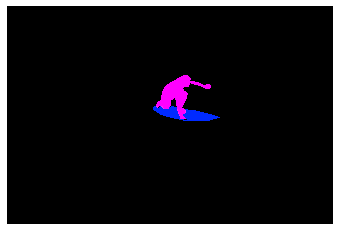

(427, 640, 3)
COCO_val2014_000000037513.jpg
{'person_bbx': [189.59, 148.25, 371.12, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [6.87, 392.24, 426.0, 632.58]}}
horse
person
hold
hold interaction
{'person_bbx': [189.59, 148.25, 371.12, 640.0], 'Verbs': 'ride', 'object': {'obj_bbx': [6.87, 392.24, 426.0, 632.58]}}
horse
person
ride
ride interaction
{'person_bbx': [189.59, 148.25, 371.12, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [6.87, 392.24, 426.0, 632.58]}}
horse
person
sit
sit interaction
{'person_bbx': [189.59, 148.25, 371.12, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


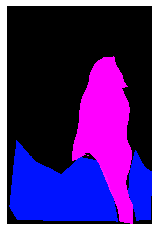

(640, 426, 3)
COCO_val2014_000000546188.jpg
{'person_bbx': [315.27, 174.94, 450.21999999999997, 321.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [335.03, 315.5, 416.57, 330.5]}}
person
surfboard
look
look interaction
{'person_bbx': [315.27, 174.94, 450.21999999999997, 321.91999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [335.03, 315.5, 416.57, 330.5]}}
person
surfboard
surf
surf interaction


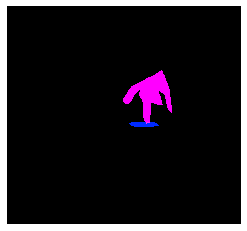

(596, 640, 3)
COCO_val2014_000000124416.jpg
{'person_bbx': [149.74, 53.79, 449.6, 307.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


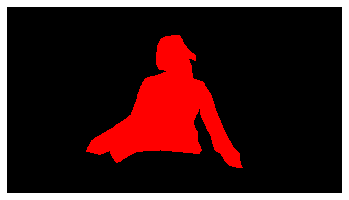

(355, 640, 3)
COCO_val2014_000000244455.jpg
{'person_bbx': [352.26, 73.64, 558.84, 373.36], 'Verbs': 'hold', 'object': {'obj_bbx': [371.33, 155.08, 585.38, 447.78]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [352.26, 73.64, 558.84, 373.36], 'Verbs': 'look', 'object': {'obj_bbx': [18.98, 56.32, 213.89, 399.3]}}
person
person
look
look interaction
{'person_bbx': [18.98, 56.32, 213.89, 399.3], 'Verbs': 'look', 'object': {'obj_bbx': [352.26, 73.64, 558.84, 373.36]}}
person
person
look
look interaction
{'person_bbx': [352.26, 73.64, 558.84, 373.36], 'Verbs': 'ride', 'object': {'obj_bbx': [371.33, 155.08, 585.38, 447.78]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [18.98, 56.32, 213.89, 399.3], 'Verbs': 'ride', 'object': {'obj_bbx': [16.38, 156.18, 227.16, 476.17]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [352.26, 73.64, 558.84, 373.36], 'Verbs': 'sit', 'object': {'obj_bbx': [371.33, 155.08, 585.38, 447.78]}}
motorcycle
person
sit
sit interaction
{'pe

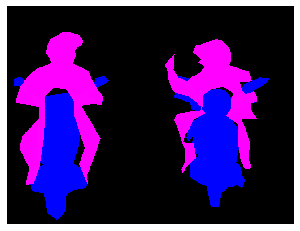

(486, 640, 3)
COCO_val2014_000000523637.jpg
{'person_bbx': [190.18, 51.46, 320.59000000000003, 283.87], 'Verbs': 'hold', 'object': {'obj_bbx': [195.0, 208.65, 272.73, 246.52]}}
person
book
hold
hold interaction
{'person_bbx': [91.24, 61.95, 223.49, 281.25], 'Verbs': 'hold', 'object': {'obj_bbx': [137.58, 108.22, 157.09, 124.9]}}
cell phone
person
hold
hold interaction
{'person_bbx': [190.18, 51.46, 320.59000000000003, 283.87], 'Verbs': 'look', 'object': {'obj_bbx': [195.0, 208.65, 272.73, 246.52]}}
person
book
look
look interaction
{'person_bbx': [91.24, 61.95, 223.49, 281.25], 'Verbs': 'look', 'object': {'obj_bbx': [195.0, 208.65, 272.73, 246.52]}}
person
book
look
look interaction
{'person_bbx': [307.8, 44.53, 500.0, 339.78], 'Verbs': 'look', 'object': {'obj_bbx': [195.0, 208.65, 272.73, 246.52]}}
book
person
look
look interaction
{'person_bbx': [190.18, 51.46, 320.59000000000003, 283.87], 'Verbs': 'read', 'object': {'obj_bbx': [195.0, 208.65, 272.73, 246.52]}}
person
book
read
read 

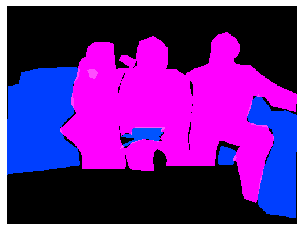

(375, 500, 3)
COCO_val2014_000000534734.jpg
{'person_bbx': [487.24, 184.84, 516.26, 259.64], 'Verbs': 'carry', 'object': {'obj_bbx': [485.85, 196.6, 500.75, 220.7]}}
handbag
person
carry
carry interaction
{'person_bbx': [257.29, 208.83, 307.72, 296.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [293.22, 229.02, 320.86, 248.92000000000002]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [257.29, 208.83, 307.72, 296.58000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [487.24, 184.84, 516.26, 259.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


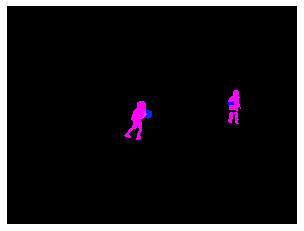

(480, 640, 3)
COCO_val2014_000000069224.jpg
{'person_bbx': [48.66, 99.63, 237.56, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [48.66, 99.63, 237.56, 375.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 190.46, 74.32, 374.58000000000004]}}
chair
person
sit
sit interaction


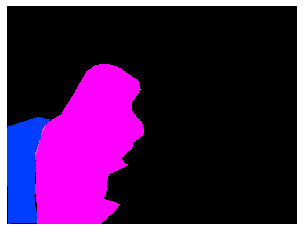

(375, 500, 3)
COCO_val2014_000000073665.jpg
{'person_bbx': [278.21, 287.09, 403.07, 474.80999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': [285.81, 458.51, 394.81, 478.94]}}
person
skateboard
jump
jump interaction
{'person_bbx': [278.21, 287.09, 403.07, 474.80999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [285.81, 458.51, 394.81, 478.94]}}
person
skateboard
look
look interaction
{'person_bbx': [278.21, 287.09, 403.07, 474.80999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [285.81, 458.51, 394.81, 478.94]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [278.21, 287.09, 403.07, 474.80999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


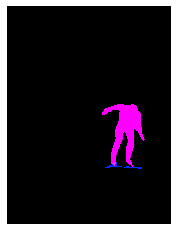

(640, 480, 3)
COCO_val2014_000000133933.jpg
{'person_bbx': [344.09, 94.11, 639.64, 474.88], 'Verbs': 'hold', 'object': {'obj_bbx': [596.2, 148.74, 638.48, 185.04000000000002]}}
person
cell phone
hold
hold interaction
{'person_bbx': [344.09, 94.11, 639.64, 474.88], 'Verbs': 'look', 'object': {'obj_bbx': [18.3, 120.48, 53.81, 242.10000000000002]}}
tv
person
look
look interaction
{'person_bbx': [344.09, 94.11, 639.64, 474.88], 'Verbs': 'sit', 'object': {'obj_bbx': [322.88, 347.26, 450.67, 480.0]}}
person
couch
sit
sit interaction
{'person_bbx': [344.09, 94.11, 639.64, 474.88], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [583.42, 169.81, 600.3399999999999, 192.0]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


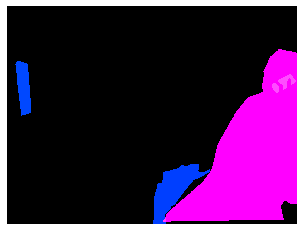

(480, 640, 3)
COCO_val2014_000000115584.jpg
{'person_bbx': [85.58, 112.98, 206.34, 291.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [85.58, 112.98, 206.34, 291.75], 'Verbs': 'surf', 'object': {'obj_bbx': [85.42, 281.07, 177.92000000000002, 316.49]}}
person
surfboard
surf
surf interaction


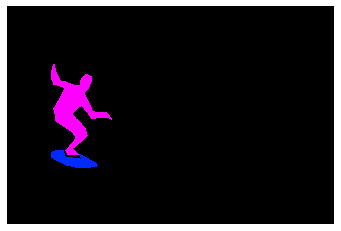

(426, 640, 3)
COCO_val2014_000000478724.jpg
{'person_bbx': [19.01, 76.04, 448.82, 463.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


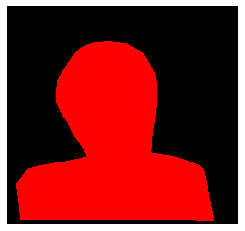

(471, 500, 3)
COCO_val2014_000000319350.jpg
{'person_bbx': [17.98, 25.96, 388.07, 574.23], 'Verbs': 'drink', 'object': {'obj_bbx': [160.5, 117.12, 223.05, 235.32]}}
wine glass
person
drink
drink interaction
{'person_bbx': [17.98, 25.96, 388.07, 574.23], 'Verbs': 'hold', 'object': {'obj_bbx': [160.5, 117.12, 223.05, 235.32]}}
wine glass
person
hold
hold interaction
{'person_bbx': [17.98, 25.96, 388.07, 574.23], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 171.94, 121.2, 432.65]}}
chair
person
sit
sit interaction


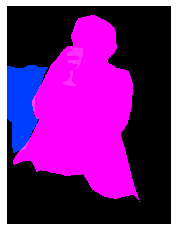

(640, 480, 3)
COCO_val2014_000000190291.jpg
{'person_bbx': [1.08, 34.34, 222.20000000000002, 363.33000000000004], 'Verbs': 'drink', 'object': {'obj_bbx': [49.08, 250.54, 132.91, 363.31]}}
person
cup
drink
drink interaction
{'person_bbx': [1.08, 34.34, 222.20000000000002, 363.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [49.08, 250.54, 132.91, 363.31]}}
person
cup
hold
hold interaction
{'person_bbx': [1.08, 34.34, 222.20000000000002, 363.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [49.08, 250.54, 132.91, 363.31]}}
person
cup
look
look interaction
{'person_bbx': [220.34, 16.76, 402.40999999999997, 274.46], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.08, 34.34, 222.20000000000002, 363.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [220.34, 16.76, 402.40999999999997, 274.46], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [220.34, 16.76, 402.40999999999997, 274.46], 'Verbs': 's

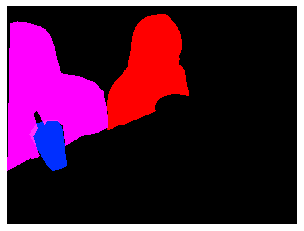

(480, 640, 3)
COCO_val2014_000000333899.jpg
{'person_bbx': [13.6, 30.22, 576.21, 597.0500000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [13.6, 30.22, 576.21, 597.0500000000001], 'Verbs': 'look', 'object': {'obj_bbx': [209.51, 121.99, 551.3499999999999, 436.26]}}
laptop
person
look
look interaction
{'person_bbx': [13.6, 30.22, 576.21, 597.0500000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [13.6, 30.22, 576.21, 597.0500000000001], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [209.51, 121.99, 551.3499999999999, 436.26]}}
laptop
person
work_on_computer
work_on_computer interaction


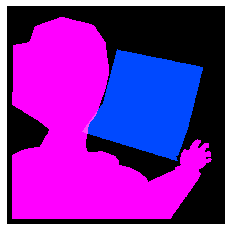

(612, 612, 3)
COCO_val2014_000000470779.jpg
{'person_bbx': [418.59, 37.22, 543.73, 410.49], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [256.18, 54.9, 403.65, 382.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [61.36, 102.26, 170.07, 392.89], 'Verbs': 'hold', 'object': {'obj_bbx': [95.51, 143.03, 113.63000000000001, 190.86]}}
person
backpack
hold
hold interaction
{'person_bbx': [105.86, 70.53, 354.58, 401.23], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [418.59, 37.22, 543.73, 410.49], 'Verbs': 'ski', 'object': {'obj_bbx': [431.34, 391.48, 584.0999999999999, 476.79]}}
person
skis
ski
ski interaction
{'person_bbx': [256.18, 54.9, 403.65, 382.12], 'Verbs': 'ski', 'object': {'obj_bbx': [171.61, 386.95, 320.84000000000003, 479.0]}}
person
skis
ski
ski interaction
{'person_bbx': [61.36, 102.26, 170.07, 392.89], 'Verbs': 'ski', 'object': {'obj_bbx': [76.91, 369.15, 193.76999999999998, 473.74]}}
person
skis
ski

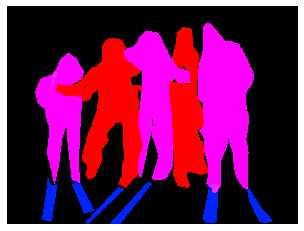

(479, 640, 3)
COCO_val2014_000000491090.jpg
{'person_bbx': [116.85, 56.69, 353.33, 484.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [24.05, 203.0, 478.0, 640.0]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [116.85, 56.69, 353.33, 484.96999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [24.05, 203.0, 478.0, 640.0]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [116.85, 56.69, 353.33, 484.96999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [24.05, 203.0, 478.0, 640.0]}}
person
motorcycle
sit
sit interaction
{'person_bbx': [116.85, 56.69, 353.33, 484.96999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


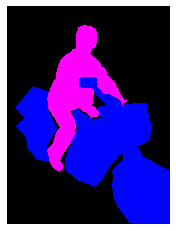

(640, 478, 3)
COCO_val2014_000000273889.jpg
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [216.83, 271.04, 386.79, 289.33000000000004]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [223.74, 23.67, 245.60000000000002, 45.290000000000006]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'hold', 'object': {'obj_bbx': [216.83, 271.04, 386.79, 289.33000000000004]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'look', 'object': {'obj_bbx': [223.74, 23.67, 245.60000000000002, 45.290000000000006]}}
sports ball
person
look
look interaction
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [104.75, 190.37, 308.52, 616.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
perso

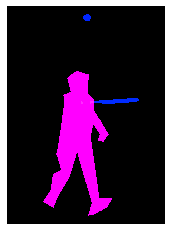

(640, 463, 3)
COCO_val2014_000000266889.jpg
{'person_bbx': [140.58, 63.07, 296.5, 436.57], 'Verbs': 'kick', 'object': {'obj_bbx': [98.93, 393.1, 148.34, 445.87]}}
sports ball
person
kick
kick interaction
{'person_bbx': [140.58, 63.07, 296.5, 436.57], 'Verbs': 'look', 'object': {'obj_bbx': [98.93, 393.1, 148.34, 445.87]}}
sports ball
person
look
look interaction
{'person_bbx': [227.16, 57.55, 344.02, 412.49], 'Verbs': 'look', 'object': {'obj_bbx': [98.93, 393.1, 148.34, 445.87]}}
sports ball
person
look
look interaction
{'person_bbx': [522.04, 81.91, 640.0, 443.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [98.93, 393.1, 148.34, 445.87]}}
sports ball
person
look
look interaction
{'person_bbx': [140.58, 63.07, 296.5, 436.57], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [227.16, 57.55, 344.02, 412.49], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [522.04, 81.91, 640.0, 443.40999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}

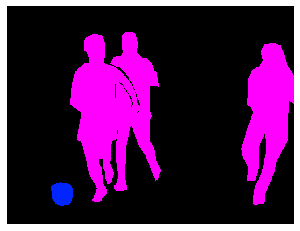

(486, 640, 3)
COCO_val2014_000000537211.jpg
{'person_bbx': [182.31, 109.39, 500.89, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [280.23, 227.89, 342.44, 296.16999999999996]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [182.31, 109.39, 500.89, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [280.23, 227.89, 342.44, 296.16999999999996]}}
person
hot dog
hold
hold interaction
{'person_bbx': [182.31, 109.39, 500.89, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [280.23, 227.89, 342.44, 296.16999999999996]}}
person
hot dog
look
look interaction
{'person_bbx': [182.31, 109.39, 500.89, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


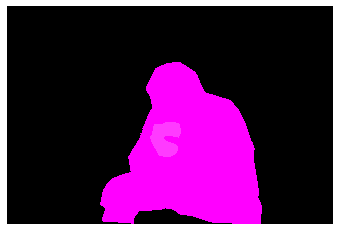

(427, 640, 3)
COCO_val2014_000000029045.jpg
{'person_bbx': [135.76, 245.25, 349.09000000000003, 414.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [135.76, 245.25, 349.09000000000003, 414.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [135.76, 245.25, 349.09000000000003, 414.95], 'Verbs': 'snowboard', 'object': {'obj_bbx': [243.56, 340.09, 404.78999999999996, 410.5]}}
person
snowboard
snowboard
snowboard interaction


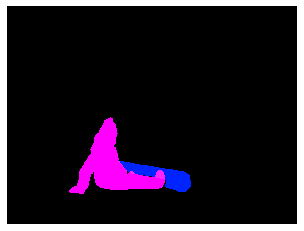

(480, 640, 3)
COCO_val2014_000000033845.jpg
{'person_bbx': [306.21, 143.54, 483.21999999999997, 288.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [251.23, 179.98, 324.62, 282.28]}}
person
laptop
look
look interaction
{'person_bbx': [306.21, 143.54, 483.21999999999997, 288.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [190.86, 44.23, 348.09000000000003, 204.82], 'Verbs': 'sit', 'object': {'obj_bbx': [286.44, 135.83, 354.62, 235.06]}}
chair
person
sit
sit interaction
{'person_bbx': [306.21, 143.54, 483.21999999999997, 288.66999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [251.23, 179.98, 324.62, 282.28]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [190.86, 44.23, 348.09000000000003, 204.82], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [155.13, 155.38, 251.99, 223.14999999999998]}}
person
laptop
work_on_computer
work_on_computer interaction


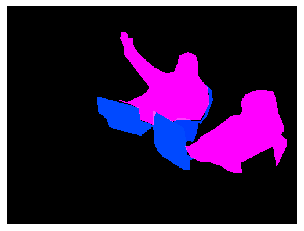

(375, 500, 3)
COCO_val2014_000000118614.jpg
{'person_bbx': [301.62, 73.2, 436.35, 159.22], 'Verbs': 'surf', 'object': {'obj_bbx': [325.02, 42.02, 480.36, 159.32]}}
person
surfboard
surf
surf interaction


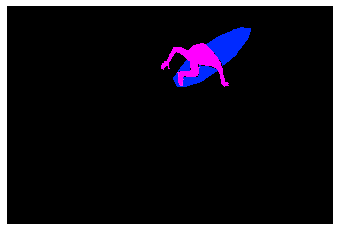

(427, 640, 3)
COCO_val2014_000000201418.jpg
{'person_bbx': [42.56, 135.02, 113.16, 374.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [42.56, 135.02, 113.16, 374.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


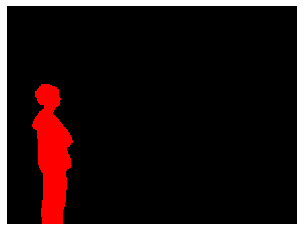

(375, 500, 3)
COCO_val2014_000000073753.jpg
{'person_bbx': [223.28, 126.2, 299.87, 331.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [223.28, 126.2, 299.87, 331.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


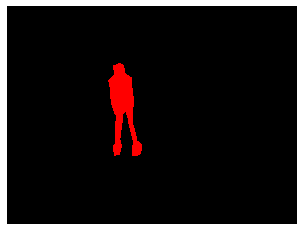

(480, 640, 3)
COCO_val2014_000000099874.jpg
{'person_bbx': [2.75, 6.32, 478.0, 529.58], 'Verbs': 'hold', 'object': {'obj_bbx': [340.18, 170.98, 423.47, 282.81]}}
person
cell phone
hold
hold interaction
{'person_bbx': [2.75, 6.32, 478.0, 529.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.75, 6.32, 478.0, 529.58], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [340.18, 170.98, 423.47, 282.81]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


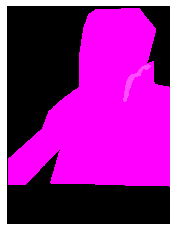

(640, 478, 3)
COCO_val2014_000000504074.jpg
{'person_bbx': [260.29, 87.37, 553.87, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [249.48, 231.09, 405.89, 352.0]}}
laptop
person
hold
hold interaction
{'person_bbx': [260.29, 87.37, 553.87, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [545.85, 199.45, 631.63, 406.44]}}
chair
person
sit
sit interaction
{'person_bbx': [260.29, 87.37, 553.87, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [249.48, 231.09, 405.89, 352.0]}}
laptop
person
work_on_computer
work_on_computer interaction


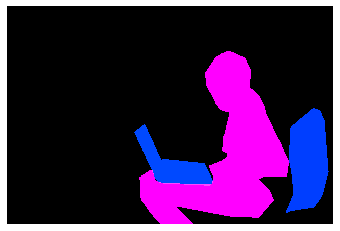

(427, 640, 3)
COCO_val2014_000000281534.jpg
{'person_bbx': [143.14, 265.63, 354.55999999999995, 483.69], 'Verbs': 'hold', 'object': {'obj_bbx': [243.0, 328.4, 287.08, 362.72999999999996]}}
person
book
hold
hold interaction
{'person_bbx': [143.14, 265.63, 354.55999999999995, 483.69], 'Verbs': 'look', 'object': {'obj_bbx': [243.0, 328.4, 287.08, 362.72999999999996]}}
person
book
look
look interaction
{'person_bbx': [143.14, 265.63, 354.55999999999995, 483.69], 'Verbs': 'read', 'object': {'obj_bbx': [243.0, 328.4, 287.08, 362.72999999999996]}}
person
book
read
read interaction
{'person_bbx': [143.14, 265.63, 354.55999999999995, 483.69], 'Verbs': 'sit', 'object': {'obj_bbx': [28.76, 348.04, 283.33, 473.17]}}
person
bench
sit
sit interaction


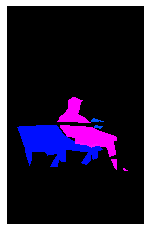

(640, 401, 3)
COCO_val2014_000000219458.jpg
{'person_bbx': [153.8, 18.24, 543.54, 422.32], 'Verbs': 'hold', 'object': {'obj_bbx': [363.52, 166.94, 386.26, 244.19]}}
cell phone
person
hold
hold interaction
{'person_bbx': [153.8, 18.24, 543.54, 422.32], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [363.52, 166.94, 386.26, 244.19]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


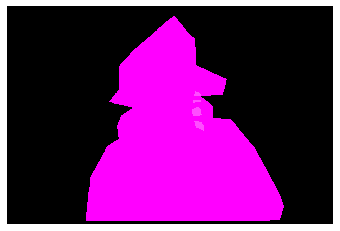

(427, 640, 3)
COCO_val2014_000000073201.jpg
{'person_bbx': [233.45, 46.89, 378.11, 291.31], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [315.94, 290.49, 398.69, 331.62]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [233.45, 46.89, 378.11, 291.31], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [296.84, 134.16, 360.28, 223.76999999999998]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [233.45, 46.89, 378.11, 291.31], 'Verbs': 'hold', 'object': {'obj_bbx': [296.84, 134.16, 360.28, 223.76999999999998]}}
person
fork
hold
hold interaction
{'person_bbx': [12.49, 105.08, 229.93, 301.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [233.45, 46.89, 378.11, 291.31], 'Verbs': 'look', 'object': {'obj_bbx': [315.94, 290.49, 398.69, 331.62]}}
pizza
person
look
look interaction
{'person_bbx': [442.12, 42.83, 640.0, 307.89], 'Verbs': 'look', 'object': {'obj_bbx': [12.49, 105.08, 229.93, 301.48]}}
person
person
look
look interaction
{'person_bbx': [12.49,

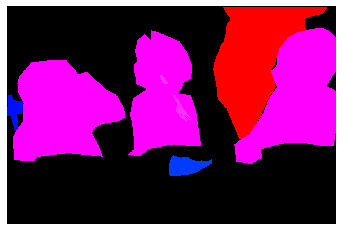

(424, 640, 3)
COCO_val2014_000000299457.jpg
{'person_bbx': [137.67, 104.73, 496.62, 370.78000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [248.61, 265.04, 304.02, 309.25]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [137.67, 104.73, 496.62, 370.78000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [248.61, 265.04, 304.02, 309.25]}}
person
donut
hold
hold interaction
{'person_bbx': [137.67, 104.73, 496.62, 370.78000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


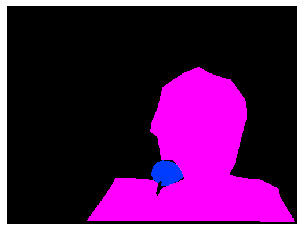

(375, 500, 3)
COCO_val2014_000000161940.jpg
{'person_bbx': [100.85, 169.97, 583.28, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [284.76, 156.4, 467.06, 351.64]}}
person
book
hold
hold interaction
{'person_bbx': [5.51, 35.97, 369.67, 254.53], 'Verbs': 'lay', 'object': {'obj_bbx': [3.24, 177.84, 640.0, 474.04999999999995]}}
bed
person
lay
lay interaction
{'person_bbx': [100.85, 169.97, 583.28, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [3.24, 177.84, 640.0, 474.04999999999995]}}
bed
person
lay
lay interaction
{'person_bbx': [5.51, 35.97, 369.67, 254.53], 'Verbs': 'look', 'object': {'obj_bbx': [256.75, 158.64, 333.6, 231.29]}}
person
book
look
look interaction
{'person_bbx': [100.85, 169.97, 583.28, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [284.76, 156.4, 467.06, 351.64]}}
person
book
look
look interaction
{'person_bbx': [5.51, 35.97, 369.67, 254.53], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [100.85, 169.97, 583.28, 480.0], 'Verbs': 'read', 'objec

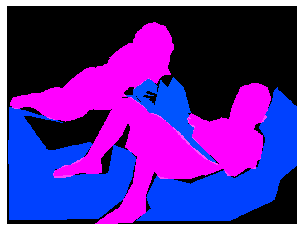

(480, 640, 3)
COCO_val2014_000000393874.jpg
{'person_bbx': [1.44, 71.91, 418.52, 570.97], 'Verbs': 'hold', 'object': {'obj_bbx': [287.18, 524.77, 306.18, 561.53]}}
person
mouse
hold
hold interaction
{'person_bbx': [1.44, 71.91, 418.52, 570.97], 'Verbs': 'sit', 'object': {'obj_bbx': [3.32, 352.42, 172.88, 576.83]}}
person
chair
sit
sit interaction
{'person_bbx': [1.44, 71.91, 418.52, 570.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.44, 71.91, 418.52, 570.97], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [237.67, 418.21, 481.0, 551.37]}}
person
laptop
work_on_computer
work_on_computer interaction


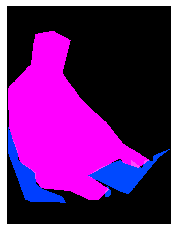

(640, 481, 3)
COCO_val2014_000000326284.jpg
{'person_bbx': [97.48, 88.33, 500.94, 449.57], 'Verbs': 'hold', 'object': {'obj_bbx': [13.3, 362.39, 488.73, 465.45]}}
person
surfboard
hold
hold interaction
{'person_bbx': [97.48, 88.33, 500.94, 449.57], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [97.48, 88.33, 500.94, 449.57], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [97.48, 88.33, 500.94, 449.57], 'Verbs': 'surf', 'object': {'obj_bbx': [13.3, 362.39, 488.73, 465.45]}}
person
surfboard
surf
surf interaction


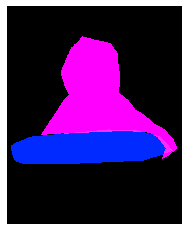

(640, 515, 3)
COCO_val2014_000000560620.jpg
{'person_bbx': [276.81, 177.17, 590.22, 434.98], 'Verbs': 'jump', 'object': {'obj_bbx': [487.34, 378.28, 551.77, 435.64]}}
skateboard
person
jump
jump interaction
{'person_bbx': [276.81, 177.17, 590.22, 434.98], 'Verbs': 'look', 'object': {'obj_bbx': [487.34, 378.28, 551.77, 435.64]}}
skateboard
person
look
look interaction
{'person_bbx': [276.81, 177.17, 590.22, 434.98], 'Verbs': 'skateboard', 'object': {'obj_bbx': [487.34, 378.28, 551.77, 435.64]}}
skateboard
person
skateboard
skateboard interaction


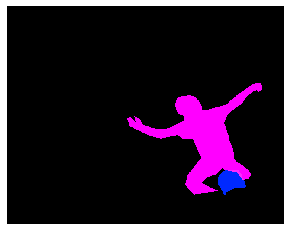

(503, 640, 3)
COCO_val2014_000000255630.jpg
{'person_bbx': [313.38, 143.37, 411.37, 235.72], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [313.38, 143.37, 411.37, 235.72], 'Verbs': 'surf', 'object': {'obj_bbx': [331.12, 151.73, 410.66, 200.07]}}
person
surfboard
surf
surf interaction


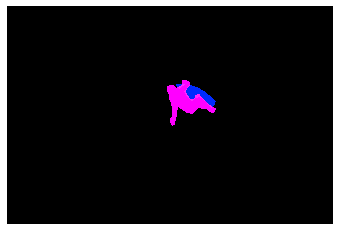

(427, 640, 3)
COCO_val2014_000000361860.jpg
{'person_bbx': [300.84, 86.91, 457.46999999999997, 254.04], 'Verbs': 'jump', 'object': {'obj_bbx': [256.91, 193.88, 498.54, 321.85]}}
person
snowboard
jump
jump interaction
{'person_bbx': [300.84, 86.91, 457.46999999999997, 254.04], 'Verbs': 'snowboard', 'object': {'obj_bbx': [256.91, 193.88, 498.54, 321.85]}}
person
snowboard
snowboard
snowboard interaction


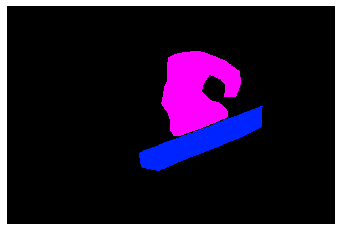

(425, 640, 3)
COCO_val2014_000000537905.jpg
{'person_bbx': [211.42, 163.55, 382.55999999999995, 439.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [211.42, 163.55, 382.55999999999995, 439.68], 'Verbs': 'surf', 'object': {'obj_bbx': [212.86, 422.48, 354.39, 454.28000000000003]}}
person
surfboard
surf
surf interaction


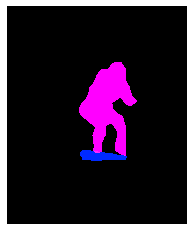

(640, 528, 3)
COCO_val2014_000000163010.jpg
{'person_bbx': [99.09, 306.09, 324.19, 520.87], 'Verbs': 'look', 'object': {'obj_bbx': [196.19, 477.26, 322.78999999999996, 517.48]}}
person
surfboard
look
look interaction
{'person_bbx': [99.09, 306.09, 324.19, 520.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [36.0, 242.17, 207.48, 405.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.09, 306.09, 324.19, 520.87], 'Verbs': 'surf', 'object': {'obj_bbx': [196.19, 477.26, 322.78999999999996, 517.48]}}
person
surfboard
surf
surf interaction


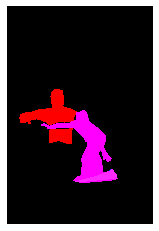

(640, 427, 3)
COCO_val2014_000000146123.jpg
{'person_bbx': [230.93, 17.34, 484.57, 260.52], 'Verbs': 'look', 'object': {'obj_bbx': [199.95, 190.38, 279.21999999999997, 292.57]}}
person
surfboard
look
look interaction
{'person_bbx': [230.93, 17.34, 484.57, 260.52], 'Verbs': 'surf', 'object': {'obj_bbx': [199.95, 190.38, 279.21999999999997, 292.57]}}
person
surfboard
surf
surf interaction


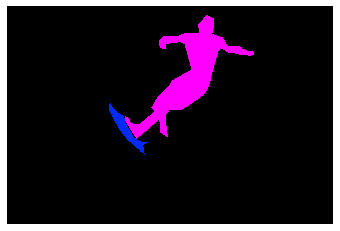

(427, 640, 3)
COCO_val2014_000000389480.jpg
{'person_bbx': [217.42, 119.66, 345.51, 374.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [290.61, 221.4, 328.29, 234.65]}}
person
frisbee
hold
hold interaction
{'person_bbx': [217.42, 119.66, 345.51, 374.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [411.24, 68.26, 498.88, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [217.42, 119.66, 345.51, 374.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [411.24, 68.26, 498.88, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


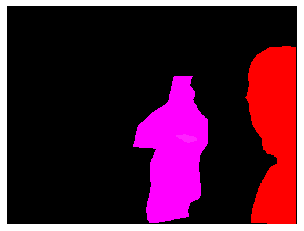

(375, 500, 3)
COCO_val2014_000000360175.jpg
{'person_bbx': [369.73, 109.42, 523.4, 401.18], 'Verbs': 'hold', 'object': {'obj_bbx': [324.34, 133.2, 446.02, 368.97]}}
person
skateboard
hold
hold interaction
{'person_bbx': [206.11, 135.65, 298.78000000000003, 372.99], 'Verbs': 'hold', 'object': {'obj_bbx': [219.15, 114.4, 336.34000000000003, 263.99]}}
umbrella
person
hold
hold interaction
{'person_bbx': [369.73, 109.42, 523.4, 401.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [206.11, 135.65, 298.78000000000003, 372.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


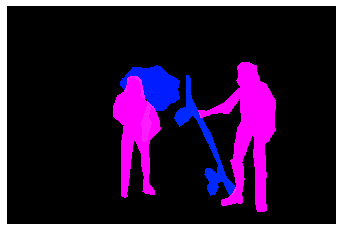

(424, 640, 3)
COCO_val2014_000000557709.jpg
{'person_bbx': [369.65, 57.84, 445.91999999999996, 212.9], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [440.24, 94.98, 487.14, 102.33]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [369.65, 57.84, 445.91999999999996, 212.9], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [499.39, 79.42, 506.81, 87.98]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [369.65, 57.84, 445.91999999999996, 212.9], 'Verbs': 'hold', 'object': {'obj_bbx': [440.24, 94.98, 487.14, 102.33]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [369.65, 57.84, 445.91999999999996, 212.9], 'Verbs': 'look', 'object': {'obj_bbx': [499.39, 79.42, 506.81, 87.98]}}
sports ball
person
look
look interaction
{'person_bbx': [464.57, 169.7, 577.14, 283.95], 'Verbs': 'look', 'object': {'obj_bbx': [499.39, 79.42, 506.81, 87.98]}}
sports ball
person
look
look interaction


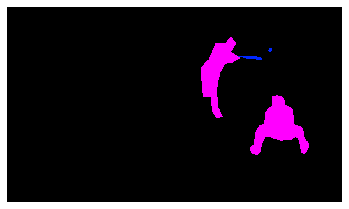

(373, 640, 3)
COCO_val2014_000000440184.jpg
{'person_bbx': [184.45, 139.86, 275.73, 348.08000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [258.43, 218.77, 315.23, 240.18]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [184.45, 139.86, 275.73, 348.08000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [281.53, 168.0, 288.79999999999995, 175.07]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [184.45, 139.86, 275.73, 348.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [258.43, 218.77, 315.23, 240.18]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [184.45, 139.86, 275.73, 348.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [281.53, 168.0, 288.79999999999995, 175.07]}}
sports ball
person
look
look interaction
{'person_bbx': [184.45, 139.86, 275.73, 348.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


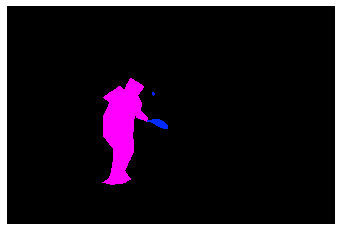

(425, 640, 3)
COCO_val2014_000000352582.jpg
{'person_bbx': [112.43, 195.32, 327.21000000000004, 633.51], 'Verbs': 'hold', 'object': {'obj_bbx': [171.63, 424.03, 257.52, 464.7]}}
person
frisbee
hold
hold interaction
{'person_bbx': [112.43, 195.32, 327.21000000000004, 633.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [112.43, 195.32, 327.21000000000004, 633.51], 'Verbs': 'throw', 'object': {'obj_bbx': [171.63, 424.03, 257.52, 464.7]}}
person
frisbee
throw
throw interaction


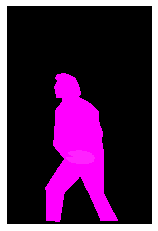

(640, 425, 3)
COCO_val2014_000000325873.jpg
{'person_bbx': [65.72, 62.52, 325.85, 449.99], 'Verbs': 'look', 'object': {'obj_bbx': [64.35, 456.05, 401.15, 602.55]}}
person
laptop
look
look interaction
{'person_bbx': [284.13, 17.56, 610.96, 462.26], 'Verbs': 'look', 'object': {'obj_bbx': [64.35, 456.05, 401.15, 602.55]}}
person
laptop
look
look interaction
{'person_bbx': [65.72, 62.52, 325.85, 449.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [284.13, 17.56, 610.96, 462.26], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [65.72, 62.52, 325.85, 449.99], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [64.35, 456.05, 401.15, 602.55]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [284.13, 17.56, 610.96, 462.26], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [64.35, 456.05, 401.15, 602.55]}}
person
laptop
work_on_computer
work_on_computer interaction


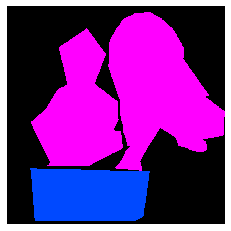

(612, 612, 3)
COCO_val2014_000000308883.jpg


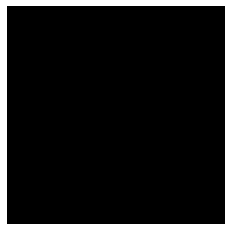

(640, 640, 3)
COCO_val2014_000000109316.jpg
{'person_bbx': [198.47, 300.58, 385.44, 581.03], 'Verbs': 'carry', 'object': {'obj_bbx': [38.84, 187.22, 384.74, 379.59000000000003]}}
umbrella
person
carry
carry interaction
{'person_bbx': [198.47, 300.58, 385.44, 581.03], 'Verbs': 'hold', 'object': {'obj_bbx': [38.84, 187.22, 384.74, 379.59000000000003]}}
umbrella
person
hold
hold interaction
{'person_bbx': [198.47, 300.58, 385.44, 581.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [198.47, 300.58, 385.44, 581.03], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


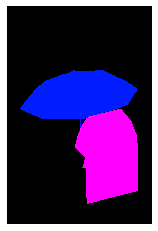

(640, 425, 3)
COCO_val2014_000000002867.jpg
{'person_bbx': [101.72, 81.19, 209.97, 415.16], 'Verbs': 'carry', 'object': {'obj_bbx': [35.59, 56.75, 133.69, 261.61]}}
person
backpack
carry
carry interaction
{'person_bbx': [101.72, 81.19, 209.97, 415.16], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [446.04, 87.33, 587.11, 421.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [220.18, 72.88, 326.09000000000003, 317.99], 'Verbs': 'look', 'object': {'obj_bbx': [161.22, 291.96, 346.33000000000004, 360.76]}}
person
skis
look
look interaction
{'person_bbx': [101.72, 81.19, 209.97, 415.16], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 363.5, 359.85, 413.49]}}
person
skis
look
look interaction
{'person_bbx': [446.04, 87.33, 587.11, 421.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [101.72, 81.19, 209.97, 415.16]}}
person
person
look
look interaction
{'person_bbx': [101.72, 81.19, 209.97, 415.16], 'Verbs': 'ski', 'object': 

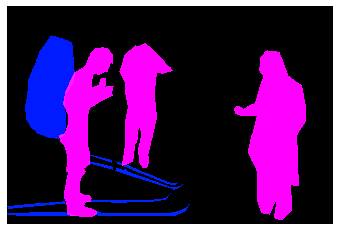

(428, 640, 3)
COCO_val2014_000000472828.jpg
{'person_bbx': [80.2, 238.41, 189.64, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [78.62, 350.4, 105.39, 421.39]}}
person
handbag
hold
hold interaction
{'person_bbx': [247.1, 247.33, 336.27, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [313.64, 295.44, 328.93, 312.19]}}
cup
person
hold
hold interaction
{'person_bbx': [80.2, 238.41, 189.64, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [451.85, 242.2, 593.53, 420.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.55, 266.65, 405.99, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.2, 238.41, 189.64, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [247.1, 247.33, 336.27, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


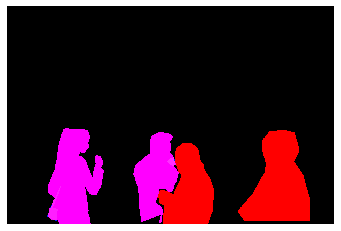

(426, 640, 3)
COCO_val2014_000000456303.jpg
{'person_bbx': [72.93, 65.33, 208.98000000000002, 247.18], 'Verbs': 'jump', 'object': {'obj_bbx': [53.49, 47.12, 101.76, 76.67999999999999]}}
person
snowboard
jump
jump interaction
{'person_bbx': [72.93, 65.33, 208.98000000000002, 247.18], 'Verbs': 'look', 'object': {'obj_bbx': [53.49, 47.12, 101.76, 76.67999999999999]}}
person
snowboard
look
look interaction
{'person_bbx': [72.93, 65.33, 208.98000000000002, 247.18], 'Verbs': 'snowboard', 'object': {'obj_bbx': [53.49, 47.12, 101.76, 76.67999999999999]}}
person
snowboard
snowboard
snowboard interaction


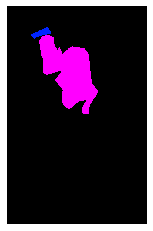

(500, 321, 3)
COCO_val2014_000000393284.jpg
{'person_bbx': [169.93, 210.51, 299.87, 336.07], 'Verbs': 'hold', 'object': {'obj_bbx': [152.22, 303.51, 326.16999999999996, 337.33]}}
person
snowboard
hold
hold interaction
{'person_bbx': [169.93, 210.51, 299.87, 336.07], 'Verbs': 'jump', 'object': {'obj_bbx': [152.22, 303.51, 326.16999999999996, 337.33]}}
person
snowboard
jump
jump interaction
{'person_bbx': [169.93, 210.51, 299.87, 336.07], 'Verbs': 'snowboard', 'object': {'obj_bbx': [152.22, 303.51, 326.16999999999996, 337.33]}}
person
snowboard
snowboard
snowboard interaction


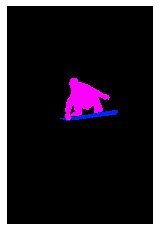

(640, 427, 3)
COCO_val2014_000000454562.jpg
{'person_bbx': [104.32, 115.0, 229.57999999999998, 206.06], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [282.41, 53.29, 394.07000000000005, 202.26999999999998], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [386.65, 76.42, 451.13, 91.71000000000001]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [282.41, 53.29, 394.07000000000005, 202.26999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [386.65, 76.42, 451.13, 91.71000000000001]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [49.36, 70.79, 137.03, 206.51999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [104.32, 115.0, 229.57999999999998, 206.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [282.41, 53.29, 394.07000000000005, 202.26999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [49.36, 70.79, 137.03, 206.51999999999998], 'Verbs': 

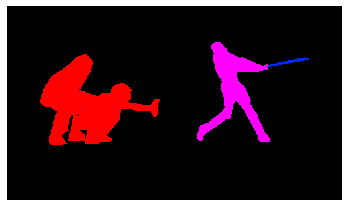

(289, 500, 3)
COCO_val2014_000000364557.jpg
{'person_bbx': [193.26, 148.11, 252.29, 285.41], 'Verbs': 'carry', 'object': {'obj_bbx': [181.42, 181.16, 233.5, 232.14]}}
person
surfboard
carry
carry interaction
{'person_bbx': [276.65, 158.15, 316.33, 288.73], 'Verbs': 'carry', 'object': {'obj_bbx': [309.45, 192.1, 335.48, 232.87]}}
surfboard
person
carry
carry interaction
{'person_bbx': [193.26, 148.11, 252.29, 285.41], 'Verbs': 'hold', 'object': {'obj_bbx': [181.42, 181.16, 233.5, 232.14]}}
person
surfboard
hold
hold interaction
{'person_bbx': [276.65, 158.15, 316.33, 288.73], 'Verbs': 'hold', 'object': {'obj_bbx': [309.45, 192.1, 335.48, 232.87]}}
surfboard
person
hold
hold interaction
{'person_bbx': [193.26, 148.11, 252.29, 285.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [193.26, 148.11, 252.29, 285.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [276.65, 158.15, 316.33, 288.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}


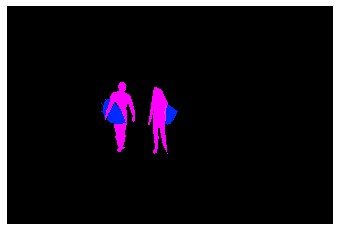

(427, 640, 3)
COCO_val2014_000000434897.jpg
{'person_bbx': [72.27, 3.24, 640.0, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [200.04, 364.52, 252.18, 421.88]}}
cell phone
person
hold
hold interaction
{'person_bbx': [72.27, 3.24, 640.0, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [72.27, 3.24, 640.0, 474.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [200.04, 364.52, 252.18, 421.88]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


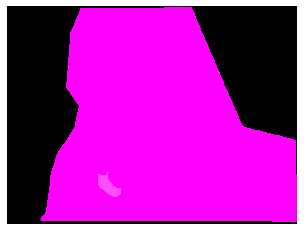

(480, 640, 3)
COCO_val2014_000000239656.jpg
{'person_bbx': [15.81, 30.23, 67.9, 203.44], 'Verbs': 'carry', 'object': {'obj_bbx': [23.63, 56.41, 59.78999999999999, 116.3]}}
person
backpack
carry
carry interaction
{'person_bbx': [173.37, 58.17, 275.85, 214.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [58.73, 28.35, 127.59, 226.84], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [15.81, 30.23, 67.9, 203.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [173.37, 58.17, 275.85, 214.14], 'Verbs': 'sit', 'object': {'obj_bbx': [149.44, 141.01, 263.34000000000003, 209.7]}}
person
bench
sit
sit interaction
{'person_bbx': [58.73, 28.35, 127.59, 226.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [15.81, 30.23, 67.9, 203.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [58.73, 28.35, 127.59, 226.84], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'pe

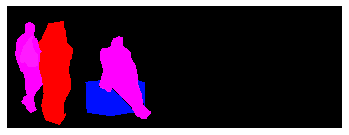

(232, 640, 3)
COCO_val2014_000000314154.jpg
{'person_bbx': [348.49, 84.36, 536.14, 419.45], 'Verbs': 'carry', 'object': {'obj_bbx': [59.49, 296.5, 270.59, 422.2]}}
person
suitcase
carry
carry interaction
{'person_bbx': [348.49, 84.36, 536.14, 419.45], 'Verbs': 'hold', 'object': {'obj_bbx': [59.49, 296.5, 270.59, 422.2]}}
person
suitcase
hold
hold interaction
{'person_bbx': [348.49, 84.36, 536.14, 419.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [348.49, 84.36, 536.14, 419.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


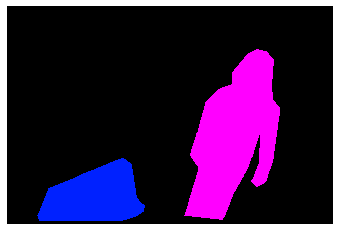

(427, 640, 3)
COCO_val2014_000000049648.jpg
{'person_bbx': [54.92, 112.75, 346.51, 563.76], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [54.92, 112.75, 346.51, 563.76], 'Verbs': 'kick', 'object': {'obj_bbx': [314.47, 505.41, 379.6, 570.53]}}
sports ball
person
kick
kick interaction
{'person_bbx': [54.92, 112.75, 346.51, 563.76], 'Verbs': 'look', 'object': {'obj_bbx': [314.47, 505.41, 379.6, 570.53]}}
sports ball
person
look
look interaction
{'person_bbx': [54.92, 112.75, 346.51, 563.76], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


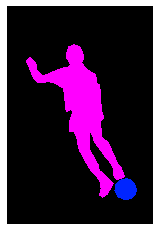

(640, 427, 3)
COCO_val2014_000000320396.jpg
{'person_bbx': [187.74, 179.26, 376.44, 379.39], 'Verbs': 'catch', 'object': {'obj_bbx': [152.96, 230.81, 188.15, 252.57]}}
person
frisbee
catch
catch interaction
{'person_bbx': [187.74, 179.26, 376.44, 379.39], 'Verbs': 'hold', 'object': {'obj_bbx': [152.96, 230.81, 188.15, 252.57]}}
person
frisbee
hold
hold interaction
{'person_bbx': [187.74, 179.26, 376.44, 379.39], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [187.74, 179.26, 376.44, 379.39], 'Verbs': 'look', 'object': {'obj_bbx': [152.96, 230.81, 188.15, 252.57]}}
person
frisbee
look
look interaction
{'person_bbx': [187.74, 179.26, 376.44, 379.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


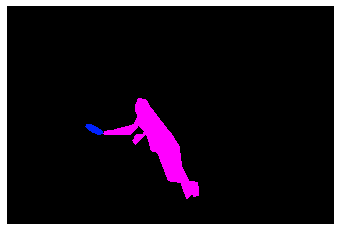

(426, 640, 3)
COCO_val2014_000000070935.jpg
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [187.54, 99.97, 281.23, 159.31]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [272.75, 63.03, 297.75, 84.76]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'hold', 'object': {'obj_bbx': [187.54, 99.97, 281.23, 159.31]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'look', 'object': {'obj_bbx': [272.75, 63.03, 297.75, 84.76]}}
sports ball
person
look
look interaction
{'person_bbx': [125.69, 130.73, 422.14, 593.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


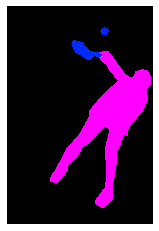

(640, 427, 3)
COCO_val2014_000000018336.jpg
{'person_bbx': [5.75, 2.64, 480.0, 631.13], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [72.28, 159.62, 272.56, 338.82]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [5.75, 2.64, 480.0, 631.13], 'Verbs': 'hold', 'object': {'obj_bbx': [72.28, 159.62, 272.56, 338.82]}}
person
apple
hold
hold interaction
{'person_bbx': [5.75, 2.64, 480.0, 631.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


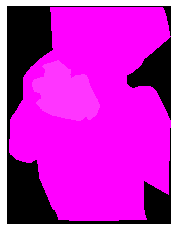

(640, 480, 3)
COCO_val2014_000000163451.jpg
{'person_bbx': [147.8, 218.28, 271.21000000000004, 599.99], 'Verbs': 'hold', 'object': {'obj_bbx': [201.41, 256.61, 230.51, 310.6]}}
cell phone
person
hold
hold interaction
{'person_bbx': [62.63, 19.61, 329.21, 599.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [147.8, 218.28, 271.21000000000004, 599.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [147.8, 218.28, 271.21000000000004, 599.99], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [201.41, 256.61, 230.51, 310.6]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


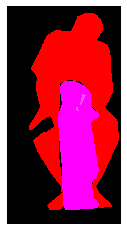

(640, 334, 3)
COCO_val2014_000000566173.jpg
{'person_bbx': [198.26, 12.28, 514.45, 399.75], 'Verbs': 'skateboard', 'object': {'obj_bbx': [257.16, 363.67, 405.89, 422.20000000000005]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [198.26, 12.28, 514.45, 399.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


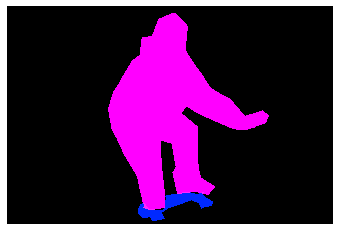

(427, 640, 3)
COCO_val2014_000000078638.jpg
{'person_bbx': [276.24, 43.37, 425.26, 346.24], 'Verbs': 'hold', 'object': {'obj_bbx': [383.41, 144.13, 513.79, 208.56]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [276.24, 43.37, 425.26, 346.24], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


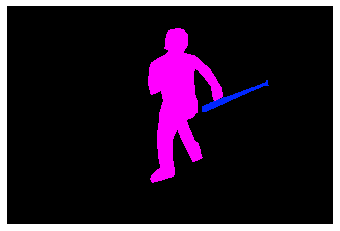

(427, 640, 3)
COCO_val2014_000000101933.jpg
{'person_bbx': [299.87, 25.89, 431.46000000000004, 441.16999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [283.49, 144.05, 556.24, 473.71000000000004]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [377.07, 68.29, 467.46, 377.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [283.49, 144.05, 556.24, 473.71000000000004]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [299.87, 25.89, 431.46000000000004, 441.16999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [283.49, 144.05, 556.24, 473.71000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [281.08, 12.43, 387.03, 314.05], 'Verbs': 'ride', 'object': {'obj_bbx': [283.49, 144.05, 556.24, 473.71000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [377.07, 68.29, 467.46, 377.34000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [283.49, 144.05, 556.24, 473.71000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx':

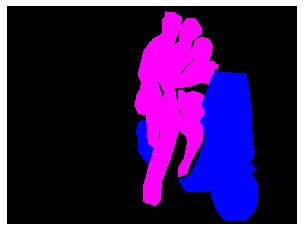

(480, 640, 3)
COCO_val2014_000000151739.jpg
{'person_bbx': [227.21, 70.32, 348.13, 176.67], 'Verbs': 'hold', 'object': {'obj_bbx': [11.51, 0.0, 559.42, 265.8]}}
surfboard
person
hold
hold interaction


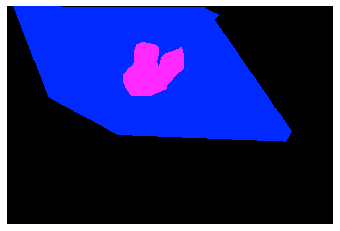

(427, 640, 3)
COCO_val2014_000000289474.jpg
{'person_bbx': [212.29, 335.17, 243.43, 413.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [269.51, 320.61, 295.15, 407.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [324.5, 322.99, 361.13, 406.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [441.58, 319.76, 464.45, 402.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [379.27, 317.39, 414.96, 402.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [212.29, 335.17, 243.43, 413.68], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [269.51, 320.61, 295.15, 407.21000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [324.5, 322.99, 361.13, 406.5], 'Verbs': 'ski', 'object': {'obj_bbx': [332.04, 398.42, 353.02000000000004, 410.58000000000004]}}
skis
person
ski
ski interaction
{'person_bbx': 

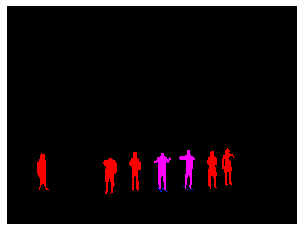

(480, 640, 3)
COCO_val2014_000000501982.jpg
{'person_bbx': [300.54, 162.39, 344.79, 275.65], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [341.87, 172.6, 362.41, 195.20999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [300.54, 162.39, 344.79, 275.65], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [294.56, 111.49, 299.65, 117.16999999999999]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [300.54, 162.39, 344.79, 275.65], 'Verbs': 'hold', 'object': {'obj_bbx': [341.87, 172.6, 362.41, 195.20999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [297.71, 389.39, 344.09, 472.45], 'Verbs': 'look', 'object': {'obj_bbx': [300.54, 162.39, 344.79, 275.65]}}
person
person
look
look interaction
{'person_bbx': [300.54, 162.39, 344.79, 275.65], 'Verbs': 'look', 'object': {'obj_bbx': [294.56, 111.49, 299.65, 117.16999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [570.14, 385.12, 639.09, 437.08], 'Verbs': 'look', '

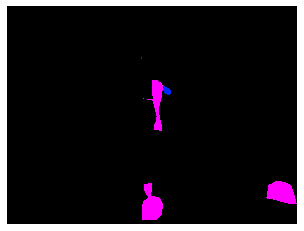

(480, 640, 3)
COCO_val2014_000000520752.jpg
{'person_bbx': [293.58, 96.38, 550.6099999999999, 448.69], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [284.73, 226.41, 333.43, 309.83]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [293.58, 96.38, 550.6099999999999, 448.69], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [146.73, 185.74, 167.95, 207.67000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [293.58, 96.38, 550.6099999999999, 448.69], 'Verbs': 'hold', 'object': {'obj_bbx': [284.73, 226.41, 333.43, 309.83]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [293.58, 96.38, 550.6099999999999, 448.69], 'Verbs': 'look', 'object': {'obj_bbx': [146.73, 185.74, 167.95, 207.67000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [526.82, 41.74, 639.7900000000001, 366.89], 'Verbs': 'look', 'object': {'obj_bbx': [293.58, 96.38, 550.6099999999999, 448.69]}}
person
person
look
look interaction
{'person_bbx': [293.58, 96.38, 

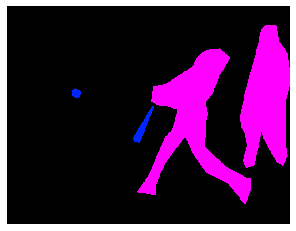

(493, 640, 3)
COCO_val2014_000000014041.jpg
{'person_bbx': [240.97, 61.45, 441.46000000000004, 420.01], 'Verbs': 'hold', 'object': {'obj_bbx': [242.8, 224.9, 414.51, 406.1]}}
person
skateboard
hold
hold interaction
{'person_bbx': [240.97, 61.45, 441.46000000000004, 420.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [240.97, 61.45, 441.46000000000004, 420.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [240.97, 61.45, 441.46000000000004, 420.01], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


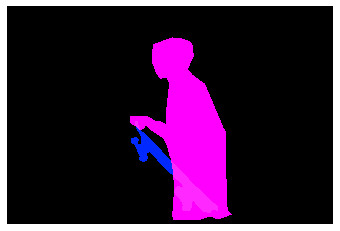

(427, 640, 3)
COCO_val2014_000000471601.jpg
{'person_bbx': [206.84, 29.68, 378.75, 379.67], 'Verbs': 'look', 'object': {'obj_bbx': [172.88, 335.46, 396.52, 402.66999999999996]}}
person
surfboard
look
look interaction
{'person_bbx': [206.84, 29.68, 378.75, 379.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [206.84, 29.68, 378.75, 379.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [206.84, 29.68, 378.75, 379.67], 'Verbs': 'surf', 'object': {'obj_bbx': [172.88, 335.46, 396.52, 402.66999999999996]}}
person
surfboard
surf
surf interaction


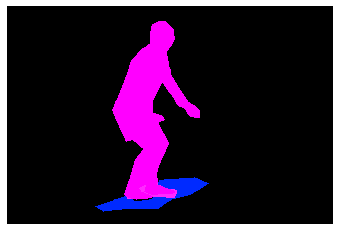

(427, 640, 3)
COCO_val2014_000000572802.jpg
{'person_bbx': [0.0, 40.72, 493.38, 414.53], 'Verbs': 'hold', 'object': {'obj_bbx': [191.47, 204.8, 233.6, 247.56]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 40.72, 493.38, 414.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 40.72, 493.38, 414.53], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [191.47, 204.8, 233.6, 247.56]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


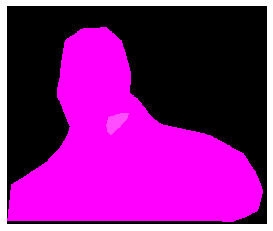

(419, 500, 3)
COCO_val2014_000000301756.jpg
{'person_bbx': [110.36, 14.08, 335.59, 444.26], 'Verbs': 'catch', 'object': {'obj_bbx': [76.44, 10.85, 141.64999999999998, 51.81]}}
person
frisbee
catch
catch interaction
{'person_bbx': [110.36, 14.08, 335.59, 444.26], 'Verbs': 'hold', 'object': {'obj_bbx': [76.44, 10.85, 141.64999999999998, 51.81]}}
person
frisbee
hold
hold interaction
{'person_bbx': [110.36, 14.08, 335.59, 444.26], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [110.36, 14.08, 335.59, 444.26], 'Verbs': 'look', 'object': {'obj_bbx': [76.44, 10.85, 141.64999999999998, 51.81]}}
person
frisbee
look
look interaction
{'person_bbx': [110.36, 14.08, 335.59, 444.26], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


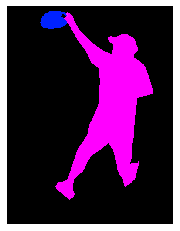

(500, 381, 3)
COCO_val2014_000000422982.jpg
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [243.93, 297.59, 322.49, 314.7]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [315.93, 178.01, 458.55, 329.90999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [243.93, 297.59, 322.49, 314.7]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [243.93, 297.59, 322.49, 314.7]}}
person
knife
look
look interaction
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 3.59, 227.79, 416.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


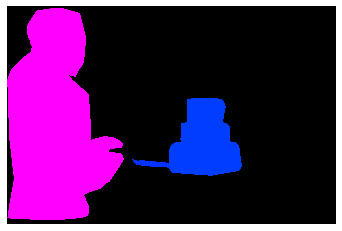

(424, 640, 3)
COCO_val2014_000000491732.jpg
{'person_bbx': [412.56, 108.16, 543.69, 423.09000000000003], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [470.21, 38.37, 507.34999999999997, 112.03]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [412.56, 108.16, 543.69, 423.09000000000003], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [460.45, 63.99, 469.58, 72.97]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [412.56, 108.16, 543.69, 423.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [470.21, 38.37, 507.34999999999997, 112.03]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [412.56, 108.16, 543.69, 423.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [460.45, 63.99, 469.58, 72.97]}}
sports ball
person
look
look interaction
{'person_bbx': [412.56, 108.16, 543.69, 423.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


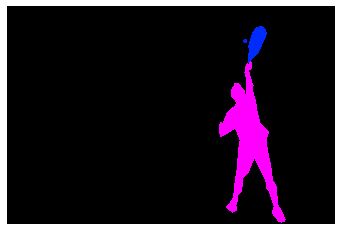

(425, 640, 3)
COCO_val2014_000000031521.jpg
{'person_bbx': [142.7, 261.62, 380.53999999999996, 549.9100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [35.96, 350.92, 158.2, 460.22]}}
person
laptop
look
look interaction
{'person_bbx': [142.7, 261.62, 380.53999999999996, 549.9100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [263.67, 366.5, 426.0, 639.85]}}
chair
person
sit
sit interaction
{'person_bbx': [142.7, 261.62, 380.53999999999996, 549.9100000000001], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [35.96, 350.92, 158.2, 460.22]}}
person
laptop
work_on_computer
work_on_computer interaction


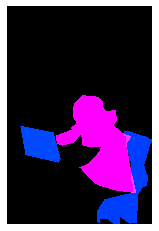

(640, 426, 3)
COCO_val2014_000000201220.jpg
{'person_bbx': [253.47, 14.64, 552.0, 341.97999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [0.0, 29.22, 278.98, 341.71000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [253.47, 14.64, 552.0, 341.97999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 29.22, 278.98, 341.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [253.47, 14.64, 552.0, 341.97999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 29.22, 278.98, 341.71000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


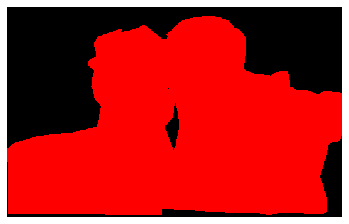

(346, 552, 3)
COCO_val2014_000000383289.jpg
{'person_bbx': [323.27, 37.91, 533.8, 345.22], 'Verbs': 'hold', 'object': {'obj_bbx': [412.99, 76.05, 449.96000000000004, 103.44999999999999]}}
cell phone
person
hold
hold interaction
{'person_bbx': [323.27, 37.91, 533.8, 345.22], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [323.27, 37.91, 533.8, 345.22], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [412.99, 76.05, 449.96000000000004, 103.44999999999999]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


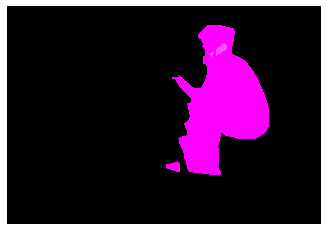

(444, 640, 3)
COCO_val2014_000000548179.jpg
{'person_bbx': [0.0, 35.43, 269.06, 490.58], 'Verbs': 'hold', 'object': {'obj_bbx': [34.83, 169.66, 184.26999999999998, 350.56]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 35.43, 269.06, 490.58], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [34.83, 169.66, 184.26999999999998, 350.56]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


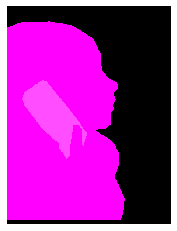

(500, 375, 3)
COCO_val2014_000000507211.jpg
{'person_bbx': [291.08, 239.35, 402.69, 377.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [291.08, 239.35, 402.69, 377.37], 'Verbs': 'surf', 'object': {'obj_bbx': [288.42, 366.21, 380.95000000000005, 388.29999999999995]}}
surfboard
person
surf
surf interaction


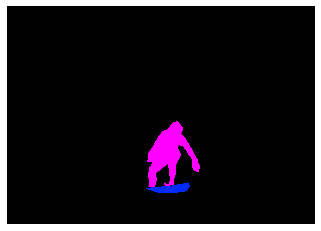

(453, 640, 3)
COCO_val2014_000000492968.jpg
{'person_bbx': [102.19, 40.11, 352.41999999999996, 349.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [102.19, 40.11, 352.41999999999996, 349.55], 'Verbs': 'snowboard', 'object': {'obj_bbx': [236.74, 311.95, 377.46000000000004, 379.45]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [102.19, 40.11, 352.41999999999996, 349.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


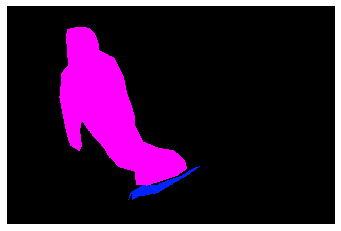

(425, 640, 3)
COCO_val2014_000000437221.jpg
{'person_bbx': [92.13, 40.26, 300.0, 235.76999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [97.14, 225.93, 205.17000000000002, 282.07]}}
person
skateboard
jump
jump interaction
{'person_bbx': [92.13, 40.26, 300.0, 235.76999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [97.14, 225.93, 205.17000000000002, 282.07]}}
person
skateboard
look
look interaction
{'person_bbx': [92.13, 40.26, 300.0, 235.76999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [97.14, 225.93, 205.17000000000002, 282.07]}}
person
skateboard
skateboard
skateboard interaction


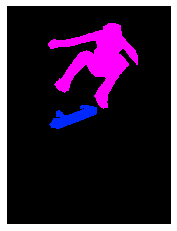

(500, 375, 3)
COCO_val2014_000000111031.jpg
{'person_bbx': [67.81, 260.57, 291.63, 636.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [242.14, 122.81, 489.61, 639.45], 'Verbs': 'hold', 'object': {'obj_bbx': [244.51, 306.02, 266.18, 320.25]}}
remote
person
hold
hold interaction
{'person_bbx': [242.14, 122.81, 489.61, 639.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [67.81, 260.57, 291.63, 636.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.14, 122.81, 489.61, 639.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


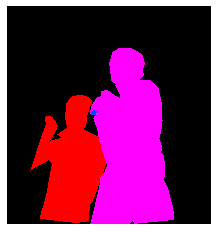

(640, 598, 3)
COCO_val2014_000000499068.jpg
{'person_bbx': [431.63, 101.54, 494.23, 287.90000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [362.33, 129.99, 603.88, 267.14]}}
person
surfboard
carry
carry interaction
{'person_bbx': [431.63, 101.54, 494.23, 287.90000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [362.33, 129.99, 603.88, 267.14]}}
person
surfboard
hold
hold interaction
{'person_bbx': [431.63, 101.54, 494.23, 287.90000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [7.61, 208.49, 117.5, 310.11], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [431.63, 101.54, 494.23, 287.90000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.93, 132.58, 184.58, 320.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [431.63, 101.54, 494.23, 287.90000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


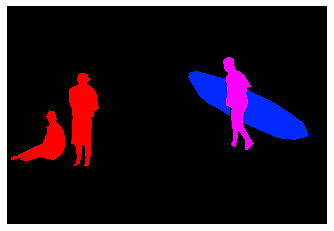

(435, 640, 3)
COCO_val2014_000000399666.jpg
{'person_bbx': [39.08, 54.08, 256.82, 235.51999999999998], 'Verbs': 'catch', 'object': {'obj_bbx': [141.33, 195.6, 193.76000000000002, 220.53]}}
person
frisbee
catch
catch interaction
{'person_bbx': [39.08, 54.08, 256.82, 235.51999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump


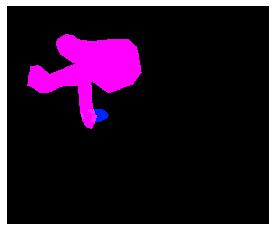

(415, 500, 3)
COCO_val2014_000000265719.jpg
{'person_bbx': [7.55, 45.81, 453.03000000000003, 477.27], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [379.6, 431.17, 452.01, 461.13]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [7.55, 45.81, 453.03000000000003, 477.27], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [348.98, 224.25, 455.64, 253.18]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [7.55, 45.81, 453.03000000000003, 477.27], 'Verbs': 'hold', 'object': {'obj_bbx': [348.98, 224.25, 455.64, 253.18]}}
person
fork
hold
hold interaction
{'person_bbx': [7.55, 45.81, 453.03000000000003, 477.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


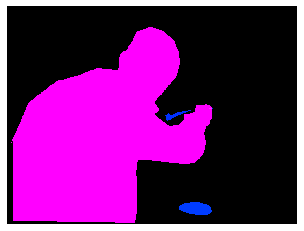

(480, 640, 3)
COCO_val2014_000000361140.jpg
{'person_bbx': [360.99, 289.08, 483.24, 510.55999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [360.99, 289.08, 483.24, 510.55999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [360.99, 289.08, 483.24, 510.55999999999995], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [360.99, 289.08, 483.24, 510.55999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [319.41, 322.36, 481.51, 484.63]}}
person
chair
sit
sit interaction


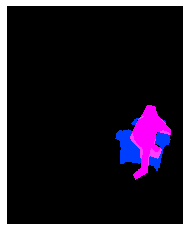

(640, 518, 3)
COCO_val2014_000000067966.jpg
{'person_bbx': [177.41, 60.51, 374.08, 255.79999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [177.41, 60.51, 374.08, 255.79999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


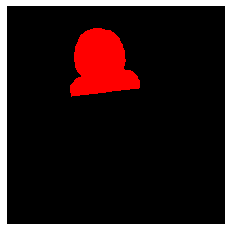

(612, 612, 3)
COCO_val2014_000000188592.jpg
{'person_bbx': [73.18, 127.88, 342.96, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [188.39, 321.41, 278.27, 384.74]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [73.18, 127.88, 342.96, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [188.39, 321.41, 278.27, 384.74]}}
person
apple
hold
hold interaction
{'person_bbx': [73.18, 127.88, 342.96, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [188.39, 321.41, 278.27, 384.74]}}
person
apple
look
look interaction
{'person_bbx': [73.18, 127.88, 342.96, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [73.18, 127.88, 342.96, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


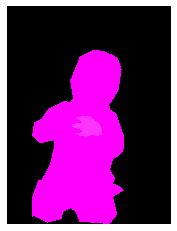

(640, 480, 3)
COCO_val2014_000000535536.jpg
{'person_bbx': [343.19, 89.53, 431.78999999999996, 257.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [343.19, 89.53, 431.78999999999996, 257.39], 'Verbs': 'surf', 'object': {'obj_bbx': [287.81, 218.27, 442.85, 274.90000000000003]}}
person
surfboard
surf
surf interaction


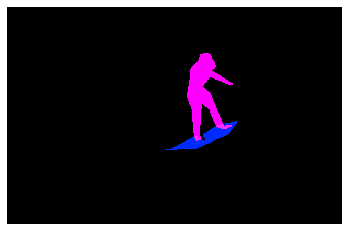

(415, 640, 3)
COCO_val2014_000000421566.jpg
{'person_bbx': [261.82, 0.0, 531.12, 306.7], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [272.24, 209.08, 335.06, 263.15000000000003]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [261.82, 0.0, 531.12, 306.7], 'Verbs': 'hold', 'object': {'obj_bbx': [272.24, 209.08, 335.06, 263.15000000000003]}}
pizza
person
hold
hold interaction
{'person_bbx': [261.82, 0.0, 531.12, 306.7], 'Verbs': 'look', 'object': {'obj_bbx': [272.24, 209.08, 335.06, 263.15000000000003]}}
pizza
person
look
look interaction
{'person_bbx': [261.82, 0.0, 531.12, 306.7], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


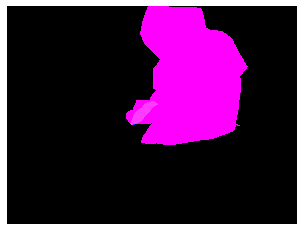

(480, 640, 3)
COCO_val2014_000000504732.jpg
{'person_bbx': [80.36, 203.7, 317.13, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [168.91, 311.33, 177.28, 325.81]}}
person
cell phone
hold
hold interaction
{'person_bbx': [80.36, 203.7, 317.13, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [80.36, 203.7, 317.13, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.36, 203.7, 317.13, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [168.91, 311.33, 177.28, 325.81]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


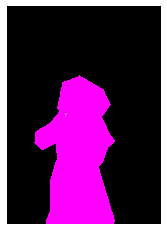

(640, 451, 3)
COCO_val2014_000000545114.jpg
{'person_bbx': [128.93, 28.51, 369.1, 370.65], 'Verbs': 'sit', 'object': {'obj_bbx': [126.51, 220.4, 189.11, 323.3]}}
person
chair
sit
sit interaction
{'person_bbx': [128.93, 28.51, 369.1, 370.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [128.93, 28.51, 369.1, 370.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


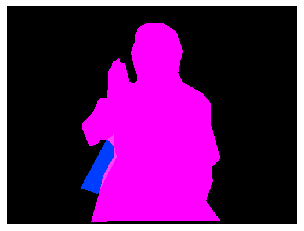

(375, 500, 3)
COCO_val2014_000000185036.jpg
{'person_bbx': [436.85, 70.11, 628.85, 475.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [4.33, 12.73, 160.36, 461.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [179.46, 129.19, 322.15999999999997, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [436.85, 70.11, 628.85, 475.69], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [179.46, 129.19, 322.15999999999997, 475.14], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [4.33, 12.73, 160.36, 461.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [179.46, 129.19, 322.15999999999997, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [436.85, 70.11, 628.85, 475.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [4.33, 12.73, 160.36, 461.31], 'Verbs': 'stand', 'object': {'obj_bbx': [

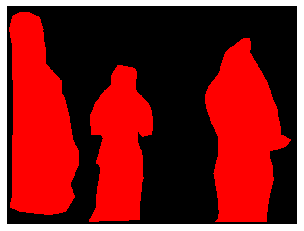

(480, 640, 3)
COCO_val2014_000000091336.jpg
{'person_bbx': [12.94, 66.16, 514.0, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [199.64, 267.72, 248.67, 302.45000000000005]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [12.94, 66.16, 514.0, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [167.02, 298.99, 342.56, 437.52]}}
person
book
hold
hold interaction
{'person_bbx': [12.94, 66.16, 514.0, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [167.02, 298.99, 342.56, 437.52]}}
person
book
look
look interaction
{'person_bbx': [12.94, 66.16, 514.0, 632.81], 'Verbs': 'read', 'object': {'obj_bbx': [167.02, 298.99, 342.56, 437.52]}}
person
book
read
read interaction
{'person_bbx': [12.94, 66.16, 514.0, 632.81], 'Verbs': 'sit', 'object': {'obj_bbx': [2.88, 257.44, 401.26, 632.81]}}
person
bench
sit
sit interaction


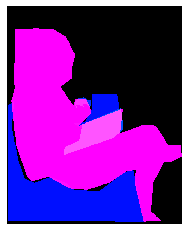

(640, 514, 3)
COCO_val2014_000000355143.jpg
{'person_bbx': [1.08, 148.52, 418.52, 473.20000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': [386.37, 278.74, 638.21, 473.54]}}
bed
person
lay
lay interaction


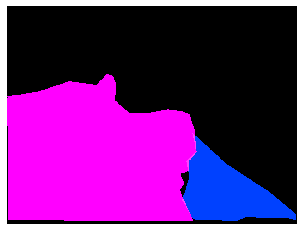

(480, 640, 3)
COCO_val2014_000000498453.jpg
{'person_bbx': [347.03, 147.0, 469.45, 320.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [347.03, 147.0, 469.45, 320.52], 'Verbs': 'surf', 'object': {'obj_bbx': [363.61, 310.64, 435.05, 334.96999999999997]}}
person
surfboard
surf
surf interaction


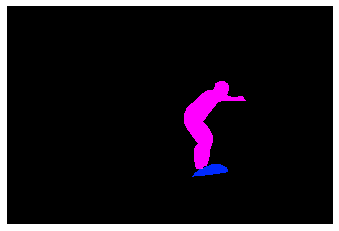

(428, 640, 3)
COCO_val2014_000000299254.jpg
{'person_bbx': [249.17, 192.0, 414.2, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [126.71, 261.04, 260.94, 480.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [249.17, 192.0, 414.2, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [249.17, 192.0, 414.2, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


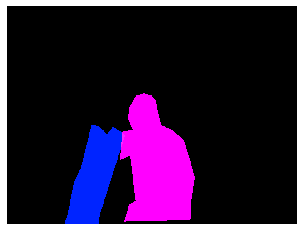

(480, 640, 3)
COCO_val2014_000000320743.jpg
{'person_bbx': [149.55, 53.37, 221.9, 206.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [438.7, 55.11, 526.95, 205.52999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [271.01, 131.06, 542.8299999999999, 348.67]}}
person
elephant
hold
hold interaction
{'person_bbx': [149.55, 53.37, 221.9, 206.61], 'Verbs': 'ride', 'object': {'obj_bbx': [112.2, 66.73, 640.0, 335.52000000000004]}}
person
elephant
ride
ride interaction
{'person_bbx': [438.7, 55.11, 526.95, 205.52999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [271.01, 131.06, 542.8299999999999, 348.67]}}
person
elephant
ride
ride interaction
{'person_bbx': [149.55, 53.37, 221.9, 206.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [438.7, 55.11, 526.95, 205.52999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [271.01, 131.06, 542.8299999999999, 348.67]}}
person
elephant
sit
sit interaction


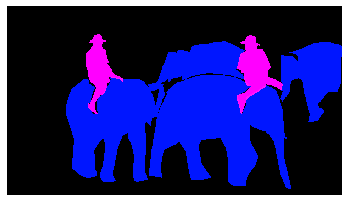

(360, 640, 3)
COCO_val2014_000000240102.jpg
{'person_bbx': [175.5, 264.46, 284.76, 558.5799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [245.93, 392.21, 283.27, 403.76]}}
person
frisbee
hold
hold interaction
{'person_bbx': [175.5, 264.46, 284.76, 558.5799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [175.5, 264.46, 284.76, 558.5799999999999], 'Verbs': 'throw', 'object': {'obj_bbx': [245.93, 392.21, 283.27, 403.76]}}
person
frisbee
throw
throw interaction


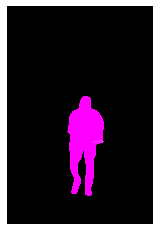

(640, 427, 3)
COCO_val2014_000000175102.jpg
{'person_bbx': [113.51, 3.24, 568.65, 474.59000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [223.98, 164.65, 295.28999999999996, 223.62]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [113.51, 3.24, 568.65, 474.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [223.98, 164.65, 295.28999999999996, 223.62]}}
person
hot dog
hold
hold interaction
{'person_bbx': [113.51, 3.24, 568.65, 474.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [174.35, 327.39, 254.11, 403.23]}}
person
chair
sit
sit interaction
{'person_bbx': [113.51, 3.24, 568.65, 474.59000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


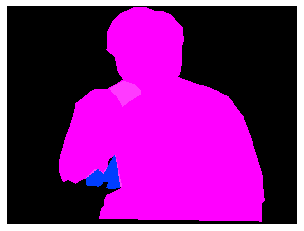

(480, 640, 3)
COCO_val2014_000000154816.jpg
{'person_bbx': [384.16, 36.54, 544.5600000000001, 314.29], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [340.1, 62.81, 442.39000000000004, 78.93]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [384.16, 36.54, 544.5600000000001, 314.29], 'Verbs': 'hold', 'object': {'obj_bbx': [340.1, 62.81, 442.39000000000004, 78.93]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [21.49, 35.84, 158.18, 353.97], 'Verbs': 'look', 'object': {'obj_bbx': [384.16, 36.54, 544.5600000000001, 314.29]}}
person
person
look
look interaction
{'person_bbx': [229.13, 146.05, 378.90999999999997, 354.91], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [384.16, 36.54, 544.5600000000001, 314.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [21.49, 35.84, 158.18, 353.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


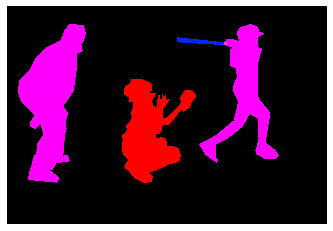

(436, 640, 3)
COCO_val2014_000000575012.jpg
{'person_bbx': [0.0, 0.9, 301.85, 592.47], 'Verbs': 'hold', 'object': {'obj_bbx': [46.61, 183.16, 94.99000000000001, 238.5]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 0.9, 301.85, 592.47], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [46.61, 183.16, 94.99000000000001, 238.5]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


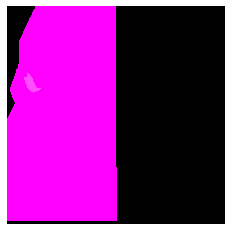

(601, 601, 3)
COCO_val2014_000000325838.jpg
{'person_bbx': [196.31, 63.46, 372.13, 377.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [311.93, 340.0, 349.8, 374.46]}}
person
mouse
hold
hold interaction
{'person_bbx': [196.31, 63.46, 372.13, 377.34999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [373.21, 197.39, 566.29, 334.38]}}
person
laptop
look
look interaction
{'person_bbx': [196.31, 63.46, 372.13, 377.34999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [159.37, 133.0, 362.47, 321.26]}}
chair
person
sit
sit interaction
{'person_bbx': [196.31, 63.46, 372.13, 377.34999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [373.21, 197.39, 566.29, 334.38]}}
person
laptop
work_on_computer
work_on_computer interaction


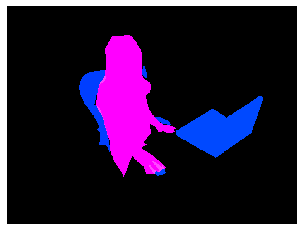

(480, 640, 3)
COCO_val2014_000000096615.jpg
{'person_bbx': [21.88, 141.02, 233.42, 527.63], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [205.06, 415.87, 257.68, 462.28]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [312.96, 2.43, 639.25, 507.04], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [21.88, 141.02, 233.42, 527.63], 'Verbs': 'hold', 'object': {'obj_bbx': [205.06, 415.87, 257.68, 462.28]}}
person
pizza
hold
hold interaction
{'person_bbx': [312.96, 2.43, 639.25, 507.04], 'Verbs': 'look', 'object': {'obj_bbx': [289.34, 506.82, 407.27, 538.43]}}
person
pizza
look
look interaction
{'person_bbx': [21.88, 141.02, 233.42, 527.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


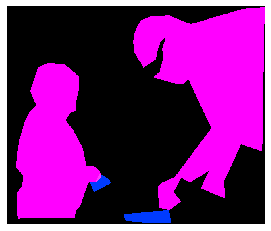

(541, 640, 3)
COCO_val2014_000000045094.jpg
{'person_bbx': [1.09, 0.0, 380.95, 473.47], 'Verbs': 'drink', 'object': {'obj_bbx': [278.29, 140.97, 631.23, 276.88]}}
person
wine glass
drink
drink interaction
{'person_bbx': [1.09, 0.0, 380.95, 473.47], 'Verbs': 'hold', 'object': {'obj_bbx': [278.29, 140.97, 631.23, 276.88]}}
person
wine glass
hold
hold interaction


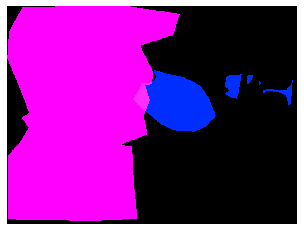

(480, 640, 3)
COCO_val2014_000000008853.jpg
{'person_bbx': [209.54, 209.89, 258.65999999999997, 274.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [209.54, 209.89, 258.65999999999997, 274.06], 'Verbs': 'look', 'object': {'obj_bbx': [201.58, 262.17, 245.18, 278.3]}}
person
skis
look
look interaction
{'person_bbx': [209.54, 209.89, 258.65999999999997, 274.06], 'Verbs': 'ski', 'object': {'obj_bbx': [201.58, 262.17, 245.18, 278.3]}}
person
skis
ski
ski interaction
{'person_bbx': [209.54, 209.89, 258.65999999999997, 274.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


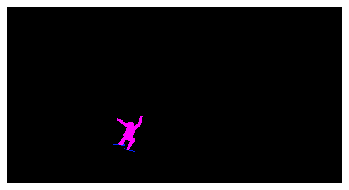

(337, 640, 3)
COCO_val2014_000000005728.jpg
{'person_bbx': [7.44, 152.48, 128.68, 297.53], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [152.29, 178.05, 221.52999999999997, 298.1], 'Verbs': 'hold', 'object': {'obj_bbx': [217.65, 232.59, 248.70000000000002, 244.49]}}
person
frisbee
hold
hold interaction
{'person_bbx': [152.29, 178.05, 221.52999999999997, 298.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [336.92, 161.5, 456.14, 258.5], 'Verbs': 'look', 'object': {'obj_bbx': [217.65, 232.59, 248.70000000000002, 244.49]}}
person
frisbee
look
look interaction
{'person_bbx': [7.44, 152.48, 128.68, 297.53], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [152.29, 178.05, 221.52999999999997, 298.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [336.92, 161.5, 456.14, 258.5], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [7.44, 152.48, 128.68, 297.53], 'Verbs': 'run', '

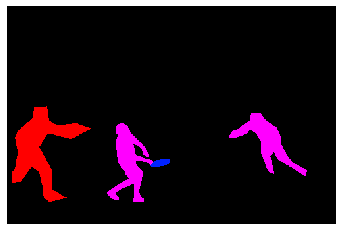

(331, 500, 3)
COCO_val2014_000000340069.jpg
{'person_bbx': [43.15, 2.16, 569.53, 474.61], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [455.43, 281.32, 516.98, 330.67]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [43.15, 2.16, 569.53, 474.61], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [492.23, 156.75, 619.27, 294.27]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [43.15, 2.16, 569.53, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [455.43, 281.32, 516.98, 330.67]}}
person
knife
hold
hold interaction
{'person_bbx': [43.15, 2.16, 569.53, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


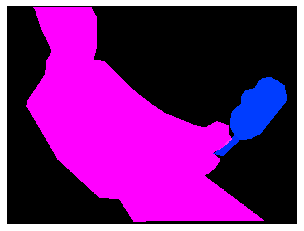

(480, 640, 3)
COCO_val2014_000000038721.jpg
{'person_bbx': [30.06, 37.44, 402.62, 631.9000000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [154.39, 190.41, 176.13, 249.25]}}
cell phone
person
hold
hold interaction
{'person_bbx': [30.06, 37.44, 402.62, 631.9000000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [1.44, 354.8, 427.0, 630.9300000000001]}}
person
couch
sit
sit interaction
{'person_bbx': [30.06, 37.44, 402.62, 631.9000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [30.06, 37.44, 402.62, 631.9000000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [154.39, 190.41, 176.13, 249.25]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


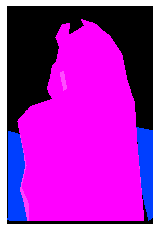

(640, 427, 3)
COCO_val2014_000000526222.jpg
{'person_bbx': [119.98, 82.8, 466.41, 376.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [0.0, 127.84, 118.74, 289.85]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [119.98, 82.8, 466.41, 376.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [303.4, 186.83, 334.59999999999997, 213.33]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [119.98, 82.8, 466.41, 376.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 127.84, 118.74, 289.85]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [119.98, 82.8, 466.41, 376.0], 'Verbs': 'look', 'object': {'obj_bbx': [303.4, 186.83, 334.59999999999997, 213.33]}}
sports ball
person
look
look interaction
{'person_bbx': [119.98, 82.8, 466.41, 376.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


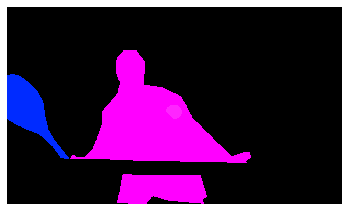

(376, 640, 3)
COCO_val2014_000000346589.jpg
{'person_bbx': [91.89, 138.38, 206.49, 432.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [91.89, 138.38, 206.49, 432.43], 'Verbs': 'ski', 'object': {'obj_bbx': [86.55, 416.15, 291.26, 466.84999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [382.92, 222.95, 503.73, 416.03], 'Verbs': 'snowboard', 'object': {'obj_bbx': [374.54, 349.87, 560.34, 418.97]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [91.89, 138.38, 206.49, 432.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


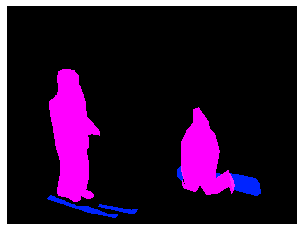

(480, 640, 3)
COCO_val2014_000000145751.jpg
{'person_bbx': [77.66, 54.21, 474.61, 630.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [451.75, 484.93, 478.78, 620.41]}}
chair
person
sit
sit interaction
{'person_bbx': [77.66, 54.21, 474.61, 630.9300000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


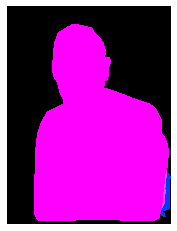

(640, 480, 3)
COCO_val2014_000000044627.jpg
{'person_bbx': [20.13, 73.44, 356.67, 494.84], 'Verbs': 'jump', 'object': {'obj_bbx': [139.19, 403.4, 413.27, 599.99]}}
person
skateboard
jump
jump interaction
{'person_bbx': [20.13, 73.44, 356.67, 494.84], 'Verbs': 'look', 'object': {'obj_bbx': [139.19, 403.4, 413.27, 599.99]}}
person
skateboard
look
look interaction
{'person_bbx': [20.13, 73.44, 356.67, 494.84], 'Verbs': 'skateboard', 'object': {'obj_bbx': [139.19, 403.4, 413.27, 599.99]}}
person
skateboard
skateboard
skateboard interaction


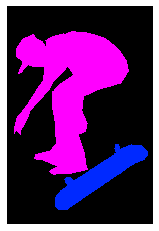

(640, 427, 3)
COCO_val2014_000000361245.jpg
{'person_bbx': [98.09, 83.19, 257.74, 357.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [98.09, 83.19, 257.74, 357.28], 'Verbs': 'jump', 'object': {'obj_bbx': [222.2, 336.59, 257.87, 353.46999999999997]}}
person
skis
jump
jump interaction
{'person_bbx': [440.97, 138.83, 569.38, 327.44000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [98.09, 83.19, 257.74, 357.28]}}
person
person
look
look interaction
{'person_bbx': [98.09, 83.19, 257.74, 357.28], 'Verbs': 'ski', 'object': {'obj_bbx': [222.2, 336.59, 257.87, 353.46999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [440.97, 138.83, 569.38, 327.44000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [98.09, 83.19, 257.74, 357.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [440.97, 138.83, 569.38, 327.44000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


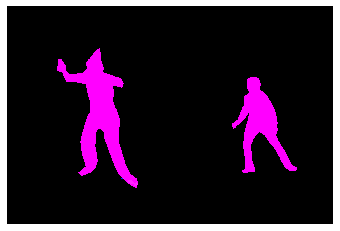

(427, 640, 3)
COCO_val2014_000000574675.jpg
{'person_bbx': [0.82, 49.06, 246.35999999999999, 347.94], 'Verbs': 'hold', 'object': {'obj_bbx': [160.72, 207.1, 366.74, 381.84000000000003]}}
laptop
person
hold
hold interaction
{'person_bbx': [340.85, 1.08, 638.56, 281.53], 'Verbs': 'look', 'object': {'obj_bbx': [160.72, 207.1, 366.74, 381.84000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [0.82, 49.06, 246.35999999999999, 347.94], 'Verbs': 'look', 'object': {'obj_bbx': [160.72, 207.1, 366.74, 381.84000000000003]}}
laptop
person
look
look interaction
{'person_bbx': [0.82, 49.06, 246.35999999999999, 347.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.82, 49.06, 246.35999999999999, 347.94], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [160.72, 207.1, 366.74, 381.84000000000003]}}
laptop
person
work_on_computer
work_on_computer interaction


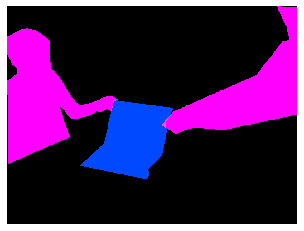

(480, 640, 3)
COCO_val2014_000000207366.jpg
{'person_bbx': [44.02, 133.75, 347.63, 383.18], 'Verbs': 'kick', 'object': {'obj_bbx': [122.77, 349.59, 174.62, 398.98999999999995]}}
sports ball
person
kick
kick interaction
{'person_bbx': [44.02, 133.75, 347.63, 383.18], 'Verbs': 'look', 'object': {'obj_bbx': [122.77, 349.59, 174.62, 398.98999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [44.02, 133.75, 347.63, 383.18], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [189.89, 65.34, 343.1, 399.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [189.89, 65.34, 343.1, 399.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


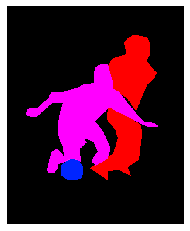

(500, 406, 3)
COCO_val2014_000000336602.jpg
{'person_bbx': [89.17, 202.79, 310.65, 434.34000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [112.78, 386.88, 395.61, 467.67]}}
person
snowboard
snowboard
snowboard interaction


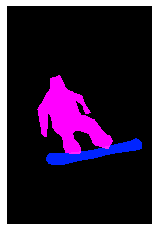

(640, 424, 3)
COCO_val2014_000000097278.jpg
{'person_bbx': [84.86, 77.43, 330.33, 576.54], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.86, 77.43, 330.33, 576.54], 'Verbs': 'snowboard', 'object': {'obj_bbx': [0.0, 542.24, 399.8, 593.48]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [84.86, 77.43, 330.33, 576.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


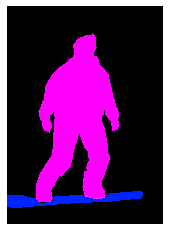

(640, 457, 3)
COCO_val2014_000000209035.jpg
{'person_bbx': [5.97, 125.38, 67.69, 234.85], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [63.22, 118.84, 87.6, 153.5]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [5.97, 125.38, 67.69, 234.85], 'Verbs': 'hold', 'object': {'obj_bbx': [63.22, 118.84, 87.6, 153.5]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [5.97, 125.38, 67.69, 234.85], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [5.97, 125.38, 67.69, 234.85], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [5.97, 125.38, 67.69, 234.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


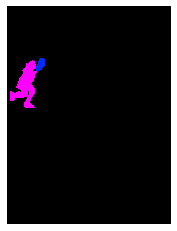

(500, 375, 3)
COCO_val2014_000000405216.jpg
{'person_bbx': [361.61, 185.47, 485.38, 340.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [361.61, 185.47, 485.38, 340.45], 'Verbs': 'surf', 'object': {'obj_bbx': [323.01, 309.95, 487.86, 359.93]}}
person
surfboard
surf
surf interaction


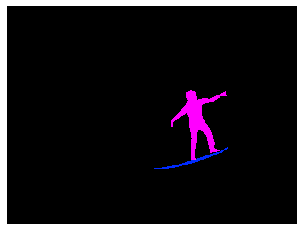

(480, 640, 3)
COCO_val2014_000000151965.jpg
{'person_bbx': [181.37, 151.9, 339.9, 393.31], 'Verbs': 'hold', 'object': {'obj_bbx': [192.65, 229.56, 223.61, 337.92]}}
person
snowboard
hold
hold interaction
{'person_bbx': [373.46, 102.89, 462.96999999999997, 381.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [354.87, 159.42, 395.92, 248.48]}}
person
snowboard
hold
hold interaction
{'person_bbx': [373.46, 102.89, 462.96999999999997, 381.09999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [181.37, 151.9, 339.9, 393.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [373.46, 102.89, 462.96999999999997, 381.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


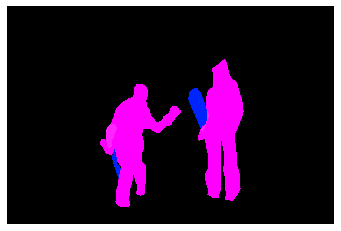

(426, 640, 3)
COCO_val2014_000000247206.jpg
{'person_bbx': [342.2, 81.1, 560.63, 240.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [342.2, 81.1, 560.63, 240.47], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [342.2, 81.1, 560.63, 240.47], 'Verbs': 'look', 'object': {'obj_bbx': [149.42, 93.68, 332.13, 272.52]}}
cat
person
look
look interaction
{'person_bbx': [342.2, 81.1, 560.63, 240.47], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


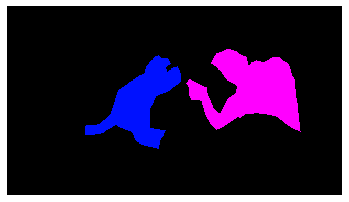

(360, 640, 3)
COCO_val2014_000000400925.jpg
{'person_bbx': [82.52, 17.27, 508.56, 427.0], 'Verbs': 'lay', 'object': {'obj_bbx': [3.67, 192.84, 640.0, 422.40999999999997]}}
couch
person
lay
lay interaction
{'person_bbx': [82.52, 17.27, 508.56, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [3.67, 192.84, 640.0, 422.40999999999997]}}
couch
person
sit
sit interaction
{'person_bbx': [82.52, 17.27, 508.56, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


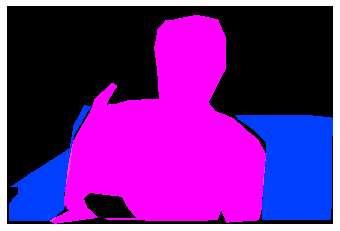

(427, 640, 3)
COCO_val2014_000000267837.jpg
{'person_bbx': [275.46, 149.28, 332.35999999999996, 245.45], 'Verbs': 'snowboard', 'object': {'obj_bbx': [267.14, 242.64, 332.4, 250.55999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [275.46, 149.28, 332.35999999999996, 245.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


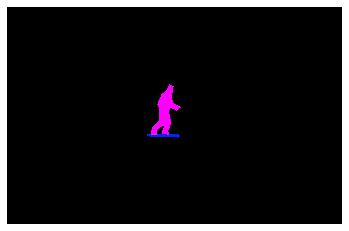

(415, 640, 3)
COCO_val2014_000000207545.jpg
{'person_bbx': [2.88, 68.79, 372.49, 619.63], 'Verbs': 'kick', 'object': {'obj_bbx': [350.16, 542.94, 435.90000000000003, 629.45]}}
sports ball
person
kick
kick interaction
{'person_bbx': [2.88, 68.79, 372.49, 619.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [2.88, 68.79, 372.49, 619.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


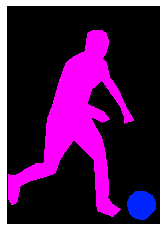

(640, 448, 3)
COCO_val2014_000000510593.jpg
{'person_bbx': [0.0, 263.58, 516.87, 631.55], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 37.39, 640.0, 640.0]}}
person
bed
lay
lay interaction
{'person_bbx': [0.0, 263.58, 516.87, 631.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


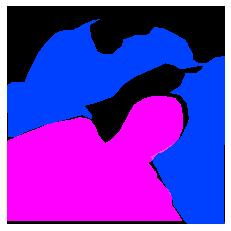

(640, 640, 3)
COCO_val2014_000000003786.jpg
{'person_bbx': [382.92, 51.78, 621.3, 476.76], 'Verbs': 'hold', 'object': {'obj_bbx': [442.92, 153.8, 586.12, 266.48]}}
book
person
hold
hold interaction
{'person_bbx': [382.92, 51.78, 621.3, 476.76], 'Verbs': 'read', 'object': {'obj_bbx': [442.92, 153.8, 586.12, 266.48]}}
book
person
read
read interaction
{'person_bbx': [382.92, 51.78, 621.3, 476.76], 'Verbs': 'sit', 'object': {'obj_bbx': [393.63, 189.36, 640.0, 476.51]}}
bench
person
sit
sit interaction


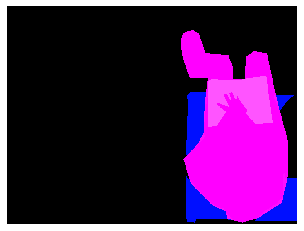

(480, 640, 3)
COCO_val2014_000000355785.jpg
{'person_bbx': [365.74, 123.92, 612.69, 503.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [312.94, 322.51, 429.55, 447.09]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [365.74, 123.92, 612.69, 503.01], 'Verbs': 'hold', 'object': {'obj_bbx': [312.94, 322.51, 429.55, 447.09]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [365.74, 123.92, 612.69, 503.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [104.75, 275.53, 233.76, 482.84], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [104.75, 275.53, 233.76, 482.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [365.74, 123.92, 612.69, 503.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [365.74, 123.92, 612.69, 503.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


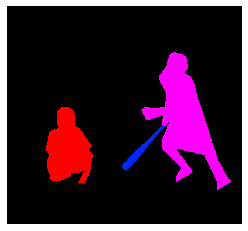

(594, 640, 3)
COCO_val2014_000000168883.jpg
{'person_bbx': [133.75, 122.01, 375.37, 632.57], 'Verbs': 'hold', 'object': {'obj_bbx': [192.49, 194.94, 217.91000000000003, 225.82999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [133.75, 122.01, 375.37, 632.57], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.75, 122.01, 375.37, 632.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 26.86, 175.41, 632.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.75, 122.01, 375.37, 632.57], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [192.49, 194.94, 217.91000000000003, 225.82999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


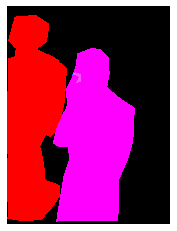

(640, 479, 3)
COCO_val2014_000000465588.jpg
{'person_bbx': [282.62, 130.06, 395.07, 253.92000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [327.89, 228.86, 423.37, 262.07]}}
person
surfboard
look
look interaction
{'person_bbx': [282.62, 130.06, 395.07, 253.92000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [327.89, 228.86, 423.37, 262.07]}}
person
surfboard
surf
surf interaction


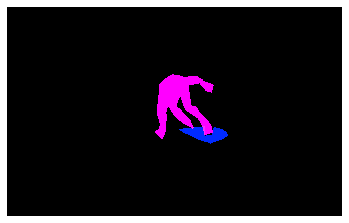

(400, 640, 3)
COCO_val2014_000000094865.jpg
{'person_bbx': [20.12, 77.17, 89.0, 228.06], 'Verbs': 'hold', 'object': {'obj_bbx': [6.98, 142.85, 37.56, 172.41]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [1.93, 385.78, 103.9, 469.9], 'Verbs': 'hold', 'object': {'obj_bbx': [100.95, 351.5, 132.04, 392.85]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [139.95, 371.96, 258.38, 469.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [246.17, 416.62, 270.88, 449.13]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [326.11, 354.11, 413.69, 465.22], 'Verbs': 'hold', 'object': {'obj_bbx': [404.1, 410.72, 435.61, 462.51000000000005]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [478.71, 314.84, 577.12, 462.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [531.22, 433.3, 551.89, 458.94]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [480.16, 103.31, 591.3000000000001, 229.56], 'Verbs': 'hold', 'object': {'obj_bbx': [530.

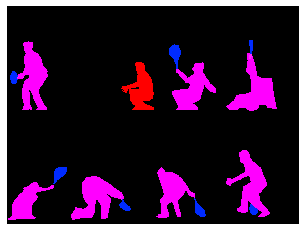

(478, 640, 3)
COCO_val2014_000000313922.jpg
{'person_bbx': [1.44, 11.86, 395.14, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [249.37, 296.22, 481.0, 637.84]}}
person
suitcase
carry
carry interaction
{'person_bbx': [1.44, 11.86, 395.14, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [249.37, 296.22, 481.0, 637.84]}}
person
suitcase
hold
hold interaction
{'person_bbx': [1.44, 11.86, 395.14, 640.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [1.44, 11.86, 395.14, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [1.58, 243.7, 192.32000000000002, 628.3299999999999]}}
person
chair
sit
sit interaction
{'person_bbx': [1.44, 11.86, 395.14, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


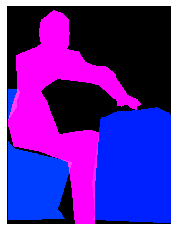

(640, 481, 3)
COCO_val2014_000000405166.jpg
{'person_bbx': [205.48, 257.69, 279.06, 445.89], 'Verbs': 'hold', 'object': {'obj_bbx': [92.93, 296.21, 233.41, 578.88]}}
horse
person
hold
hold interaction
{'person_bbx': [205.48, 257.69, 279.06, 445.89], 'Verbs': 'ride', 'object': {'obj_bbx': [92.93, 296.21, 233.41, 578.88]}}
horse
person
ride
ride interaction
{'person_bbx': [268.28, 281.54, 329.32, 410.74], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [205.48, 257.69, 279.06, 445.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [268.28, 281.54, 329.32, 410.74], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


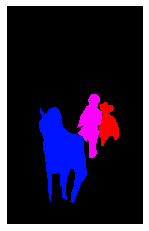

(640, 398, 3)
COCO_val2014_000000456254.jpg
{'person_bbx': [40.99, 1.15, 422.83, 474.67999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [240.54, 273.65, 407.73, 396.60999999999996]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [40.99, 1.15, 422.83, 474.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [240.54, 273.65, 407.73, 396.60999999999996]}}
person
scissors
hold
hold interaction
{'person_bbx': [40.99, 1.15, 422.83, 474.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [240.54, 273.65, 407.73, 396.60999999999996]}}
person
scissors
look
look interaction
{'person_bbx': [40.99, 1.15, 422.83, 474.67999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


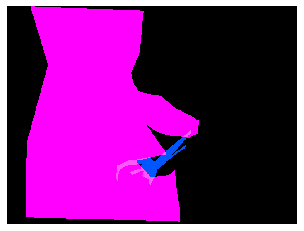

(480, 640, 3)
COCO_val2014_000000519193.jpg
{'person_bbx': [383.68, 79.52, 506.64, 474.69], 'Verbs': 'hold', 'object': {'obj_bbx': [466.98, 115.87, 477.54, 136.53]}}
person
cell phone
hold
hold interaction
{'person_bbx': [233.14, 123.38, 429.53, 479.2], 'Verbs': 'hold', 'object': {'obj_bbx': [275.97, 321.86, 301.77000000000004, 340.33000000000004]}}
remote
person
hold
hold interaction
{'person_bbx': [383.68, 79.52, 506.64, 474.69], 'Verbs': 'look', 'object': {'obj_bbx': [451.96, 46.38, 632.0899999999999, 142.38]}}
tv
person
look
look interaction
{'person_bbx': [383.68, 79.52, 506.64, 474.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [233.14, 123.38, 429.53, 479.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.68, 79.52, 506.64, 474.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [466.98, 115.87, 477.54, 136.53]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


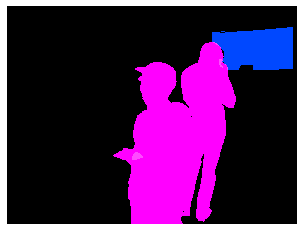

(480, 640, 3)
COCO_val2014_000000362409.jpg
{'person_bbx': [150.92, 252.82, 193.44, 304.39], 'Verbs': 'surf', 'object': {'obj_bbx': [126.41, 295.17, 213.14999999999998, 314.13]}}
surfboard
person
surf
surf interaction


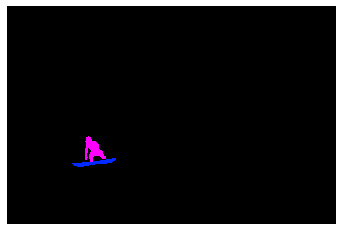

(424, 640, 3)
COCO_val2014_000000330186.jpg
{'person_bbx': [382.92, 120.33, 471.95000000000005, 207.44], 'Verbs': 'hold', 'object': {'obj_bbx': [373.91, 197.55, 468.02000000000004, 218.8]}}
person
surfboard
hold
hold interaction
{'person_bbx': [382.92, 120.33, 471.95000000000005, 207.44], 'Verbs': 'surf', 'object': {'obj_bbx': [373.91, 197.55, 468.02000000000004, 218.8]}}
person
surfboard
surf
surf interaction


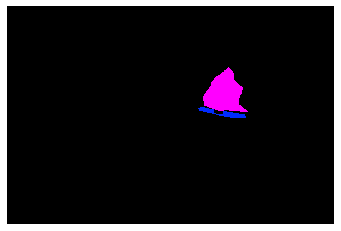

(426, 640, 3)
COCO_val2014_000000402328.jpg
{'person_bbx': [25.01, 329.17, 178.23999999999998, 567.53], 'Verbs': 'hold', 'object': {'obj_bbx': [23.73, 394.41, 164.92999999999998, 612.9300000000001]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [273.46, 331.3, 425.84, 529.74], 'Verbs': 'hold', 'object': {'obj_bbx': [299.29, 330.05, 486.01, 595.03]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [25.01, 329.17, 178.23999999999998, 567.53], 'Verbs': 'look', 'object': {'obj_bbx': [273.46, 331.3, 425.84, 529.74]}}
person
person
look
look interaction
{'person_bbx': [25.01, 329.17, 178.23999999999998, 567.53], 'Verbs': 'ride', 'object': {'obj_bbx': [23.73, 394.41, 164.92999999999998, 612.9300000000001]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [273.46, 331.3, 425.84, 529.74], 'Verbs': 'ride', 'object': {'obj_bbx': [299.29, 330.05, 486.01, 595.03]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [25.01, 329.17, 178.23999999999998, 567.53], 'Verbs': 's

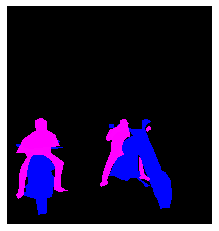

(640, 603, 3)
COCO_val2014_000000440387.jpg
{'person_bbx': [569.86, 308.32, 640.0, 430.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [569.86, 308.32, 640.0, 430.28999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [533.76, 419.85, 616.71, 436.38]}}
snowboard
person
snowboard
snowboard interaction


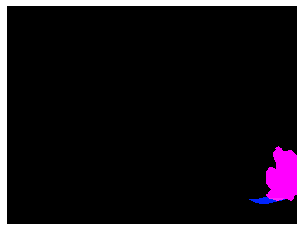

(480, 640, 3)
COCO_val2014_000000037865.jpg
{'person_bbx': [201.03, 41.16, 499.71000000000004, 421.21000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [278.35, 218.36, 364.3, 265.34000000000003]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [201.03, 41.16, 499.71000000000004, 421.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [278.35, 218.36, 364.3, 265.34000000000003]}}
person
donut
hold
hold interaction
{'person_bbx': [201.03, 41.16, 499.71000000000004, 421.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [474.08, 295.94, 604.86, 419.03]}}
chair
person
sit
sit interaction


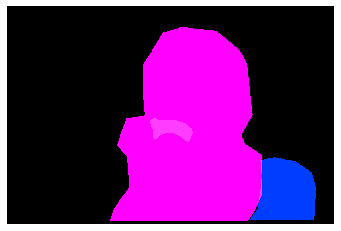

(426, 640, 3)
COCO_val2014_000000566321.jpg
{'person_bbx': [188.53, 17.65, 328.91999999999996, 352.98999999999995], 'Verbs': 'catch', 'object': {'obj_bbx': [139.23, 9.45, 193.92, 28.11]}}
person
frisbee
catch
catch interaction
{'person_bbx': [188.53, 17.65, 328.91999999999996, 352.98999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [139.23, 9.45, 193.92, 28.11]}}
person
frisbee
hold
hold interaction
{'person_bbx': [77.36, 173.06, 161.17000000000002, 350.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [188.53, 17.65, 328.91999999999996, 352.98999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [195.32, 114.37, 367.14, 357.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [188.53, 17.65, 328.91999999999996, 352.98999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [139.23, 9.45, 193.92, 28.11]}}
person
frisbee
look
look interaction
{'person_bbx': [195.32, 114.37, 367.14, 357.0], 'Verbs': 'look', 

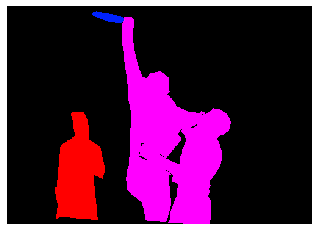

(357, 500, 3)
COCO_val2014_000000430054.jpg
{'person_bbx': [10.07, 86.29, 414.2, 585.35], 'Verbs': 'jump', 'object': {'obj_bbx': [81.98, 441.09, 289.08, 610.8]}}
person
skateboard
jump
jump interaction
{'person_bbx': [10.07, 86.29, 414.2, 585.35], 'Verbs': 'look', 'object': {'obj_bbx': [81.98, 441.09, 289.08, 610.8]}}
person
skateboard
look
look interaction
{'person_bbx': [10.07, 86.29, 414.2, 585.35], 'Verbs': 'skateboard', 'object': {'obj_bbx': [81.98, 441.09, 289.08, 610.8]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [10.07, 86.29, 414.2, 585.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


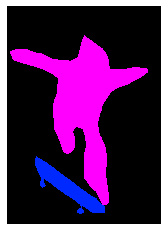

(640, 453, 3)
COCO_val2014_000000517807.jpg
{'person_bbx': [45.38, 23.38, 343.82, 536.36], 'Verbs': 'hold', 'object': {'obj_bbx': [245.75, 85.84, 269.7, 116.55000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [45.38, 23.38, 343.82, 536.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [45.38, 23.38, 343.82, 536.36], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [245.75, 85.84, 269.7, 116.55000000000001]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


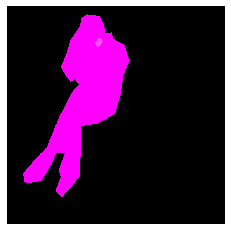

(612, 612, 3)
COCO_val2014_000000032001.jpg
{'person_bbx': [177.58, 132.74, 348.70000000000005, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [205.31, 261.46, 307.08, 344.72999999999996]}}
person
cake
hold
hold interaction
{'person_bbx': [350.56, 99.24, 542.56, 473.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [338.17, 98.64, 533.07, 480.0]}}
person
person
hold
hold interaction
{'person_bbx': [350.56, 99.24, 542.56, 473.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [205.31, 261.46, 307.08, 344.72999999999996]}}
person
cake
look
look interaction
{'person_bbx': [338.17, 98.64, 533.07, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [205.31, 261.46, 307.08, 344.72999999999996]}}
person
cake
look
look interaction
{'person_bbx': [177.58, 132.74, 348.70000000000005, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [350.56, 99.24, 542.56, 473.53000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [177.58, 1

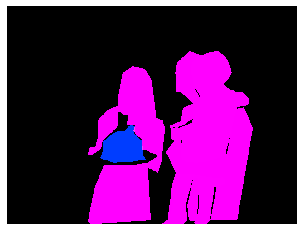

(480, 640, 3)
COCO_val2014_000000006712.jpg
{'person_bbx': [0.0, 105.71, 234.07, 374.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [243.26, 175.71, 260.3, 192.59]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 105.71, 234.07, 374.28999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [243.26, 175.71, 260.3, 192.59]}}
sports ball
person
throw
throw interaction


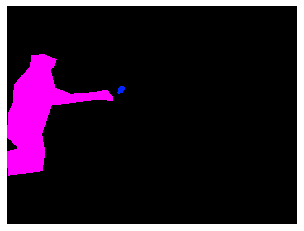

(480, 640, 3)
COCO_val2014_000000227399.jpg
{'person_bbx': [136.71, 199.04, 211.01, 349.16999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [78.82, 191.37, 128.24, 321.20000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [90.62, 231.02, 109.32000000000001, 256.31]}}
backpack
person
carry
carry interaction
{'person_bbx': [136.71, 199.04, 211.01, 349.16999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [78.82, 191.37, 128.24, 321.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [52.94, 202.51, 80.87, 252.32]}}
person
person
look
look interaction
{'person_bbx': [9.73, 190.33, 89.7, 338.39], 'Verbs': 'look', 'object': {'obj_bbx': [78.82, 191.37, 128.24, 321.20000000000005]}}
person
person
look
look interaction
{'person_bbx': [9.73, 190.33, 89.7, 338.39], 'Verbs': 'ride', 'object': {'obj_bbx': [16.4, 255.15, 84.87, 396.67]}}
bicycle
person
ride
ride interaction
{'person_bbx': [9.73, 190.33, 89.7, 338.39], 'V

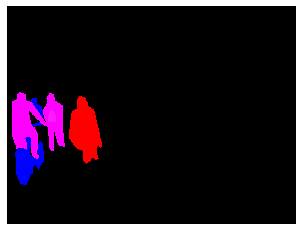

(482, 640, 3)
COCO_val2014_000000404613.jpg
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [200.25, 156.53, 328.89, 278.83]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [111.45, 130.28, 139.97, 157.53]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'hold', 'object': {'obj_bbx': [200.25, 156.53, 328.89, 278.83]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'look', 'object': {'obj_bbx': [111.45, 130.28, 139.97, 157.53]}}
sports ball
person
look
look interaction
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'point', 'object': {'obj_bbx': [111.45, 130.28, 139.97, 157.53]}}
sports ball
person
point
point interaction
{'person_bbx': [192.65, 6.97, 340.93, 282.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


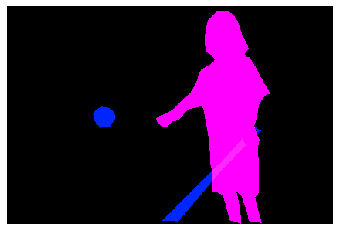

(282, 422, 3)
COCO_val2014_000000561411.jpg
{'person_bbx': [141.07, 303.97, 276.57, 416.78000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [141.07, 303.97, 276.57, 416.78000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [66.6, 322.44, 427.0, 629.44]}}
laptop
person
work_on_computer
work_on_computer interaction


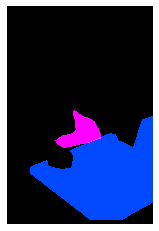

(640, 427, 3)
COCO_val2014_000000358293.jpg
{'person_bbx': [293.33, 171.05, 331.59, 332.96000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [286.37, 161.12, 311.91, 192.15]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [293.33, 171.05, 331.59, 332.96000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [333.07, 108.02, 342.32, 118.50999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [293.33, 171.05, 331.59, 332.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [286.37, 161.12, 311.91, 192.15]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [293.33, 171.05, 331.59, 332.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [333.07, 108.02, 342.32, 118.50999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [155.33, 57.17, 216.81, 149.93], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [293.33, 171.05, 331.59, 332.96000000000004], 'Verbs': 'stand', 'object': {'obj_b

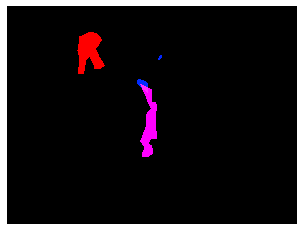

(480, 640, 3)
COCO_val2014_000000091994.jpg
{'person_bbx': [53.82, 48.83, 188.29, 191.89], 'Verbs': 'sit', 'object': {'obj_bbx': [33.03, 51.61, 102.71000000000001, 190.45]}}
chair
person
sit
sit interaction
{'person_bbx': [53.82, 48.83, 188.29, 191.89], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [177.18, 115.0, 295.3, 192.32]}}
person
laptop
work_on_computer
work_on_computer interaction


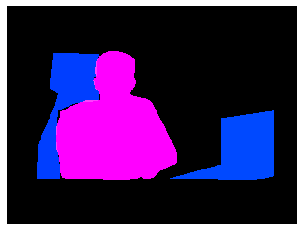

(240, 320, 3)
COCO_val2014_000000534876.jpg
{'person_bbx': [273.38, 122.09, 381.53999999999996, 348.03999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [306.89, 208.4, 395.16999999999996, 230.77]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [273.38, 122.09, 381.53999999999996, 348.03999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [309.2, 195.79, 326.59, 212.79999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [273.38, 122.09, 381.53999999999996, 348.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [306.89, 208.4, 395.16999999999996, 230.77]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [273.38, 122.09, 381.53999999999996, 348.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [309.2, 195.79, 326.59, 212.79999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [273.38, 122.09, 381.53999999999996, 348.03999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'perso

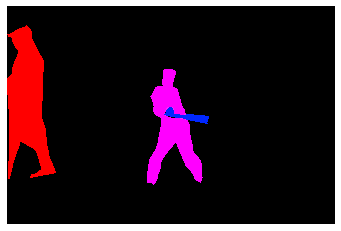

(425, 640, 3)
COCO_val2014_000000497344.jpg
{'person_bbx': [111.74, 2.31, 500.0, 330.02], 'Verbs': 'hold', 'object': {'obj_bbx': [359.94, 234.22, 440.01, 303.82]}}
cell phone
person
hold
hold interaction
{'person_bbx': [111.74, 2.31, 500.0, 330.02], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [359.94, 234.22, 440.01, 303.82]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [111.74, 2.31, 500.0, 330.02], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 169.87, 195.31, 325.52]}}
person
laptop
work_on_computer
work_on_computer interaction


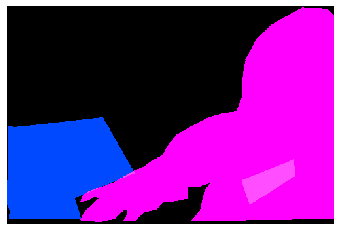

(333, 500, 3)
COCO_val2014_000000428140.jpg
{'person_bbx': [66.96, 99.4, 259.99, 498.95000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [176.4, 148.31, 306.74, 361.8]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [66.96, 99.4, 259.99, 498.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [176.4, 148.31, 306.74, 361.8]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [66.96, 99.4, 259.99, 498.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


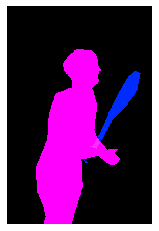

(500, 333, 3)
COCO_val2014_000000288491.jpg
{'person_bbx': [224.54, 0.0, 284.75, 156.46], 'Verbs': 'carry', 'object': {'obj_bbx': [171.11, 73.36, 332.11, 121.64]}}
person
surfboard
carry
carry interaction
{'person_bbx': [224.54, 0.0, 284.75, 156.46], 'Verbs': 'hold', 'object': {'obj_bbx': [171.11, 73.36, 332.11, 121.64]}}
person
surfboard
hold
hold interaction
{'person_bbx': [341.6, 0.96, 395.33000000000004, 156.41], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.54, 0.0, 284.75, 156.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [341.6, 0.96, 395.33000000000004, 156.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [362.74, 127.23, 524.1700000000001, 266.5], 'Verbs': 'surf', 'object': {'obj_bbx': [283.83, 202.18, 474.04999999999995, 257.71000000000004]}}
person
surfboard
surf
surf interaction


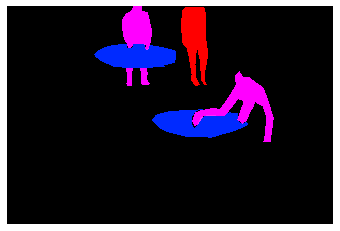

(427, 640, 3)
COCO_val2014_000000099219.jpg
{'person_bbx': [60.48, 46.29, 251.61999999999998, 314.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [259.7, 56.97, 265.32, 62.589999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [60.48, 46.29, 251.61999999999998, 314.33000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.48, 46.29, 251.61999999999998, 314.33000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [259.7, 56.97, 265.32, 62.589999999999996]}}
sports ball
person
throw
throw interaction


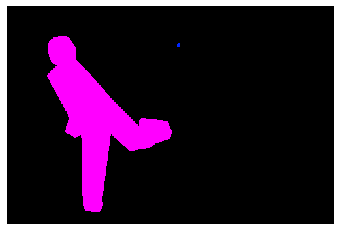

(333, 500, 3)
COCO_val2014_000000289120.jpg
{'person_bbx': [292.31, 2.16, 595.4200000000001, 474.61], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [360.71, 249.43, 398.34, 282.5]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 0.0, 403.97, 480.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [278.0, 365.53, 332.2, 389.38]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [292.31, 2.16, 595.4200000000001, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [363.69, 261.0, 463.71, 321.96]}}
bowl
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 403.97, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [280.0, 330.27, 390.27, 417.84]}}
bowl
person
hold
hold interaction
{'person_bbx': [292.31, 2.16, 595.4200000000001, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.0, 403.97, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [292.31, 2.16, 595.4200000000001, 474.61], 'Verbs': 'stand', 'obje

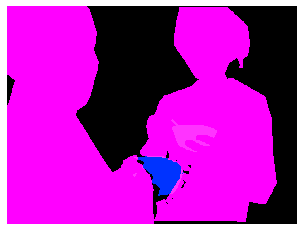

(480, 640, 3)
COCO_val2014_000000269918.jpg
{'person_bbx': [135.96, 194.66, 375.0, 333.99], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 205.28, 195.04000000000002, 495.15]}}
couch
person
lay
lay interaction


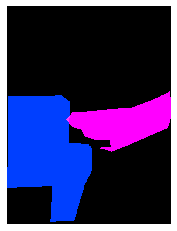

(500, 375, 3)
COCO_val2014_000000461884.jpg
{'person_bbx': [292.84, 217.82, 505.81999999999994, 360.44], 'Verbs': 'look', 'object': {'obj_bbx': [200.48, 333.89, 393.84000000000003, 376.81]}}
person
surfboard
look
look interaction
{'person_bbx': [292.84, 217.82, 505.81999999999994, 360.44], 'Verbs': 'surf', 'object': {'obj_bbx': [200.48, 333.89, 393.84000000000003, 376.81]}}
person
surfboard
surf
surf interaction


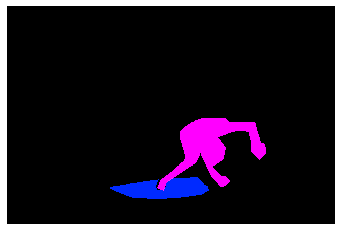

(425, 640, 3)
COCO_val2014_000000185807.jpg
{'person_bbx': [405.19, 149.61, 640.0, 472.52000000000004], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [415.15, 195.7, 440.59999999999997, 303.63]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [204.02, 72.42, 413.37, 338.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [405.19, 149.61, 640.0, 472.52000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [415.15, 195.7, 440.59999999999997, 303.63]}}
spoon
person
hold
hold interaction
{'person_bbx': [204.02, 72.42, 413.37, 338.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [85.21, 59.33, 416.35999999999996, 474.60999999999996]}}
chair
person
sit
sit interaction
{'person_bbx': [405.19, 149.61, 640.0, 472.52000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [452.82, 0.54, 640.0, 315.51000000000005]}}
couch
person
sit
sit interaction


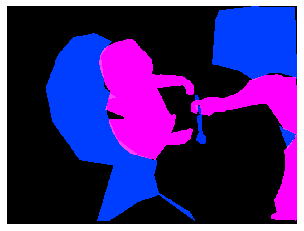

(480, 640, 3)
COCO_val2014_000000507171.jpg
{'person_bbx': [145.14, 226.22, 321.89, 322.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [145.14, 226.22, 321.89, 322.7], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [145.14, 226.22, 321.89, 322.7], 'Verbs': 'surf', 'object': {'obj_bbx': [284.76, 320.36, 347.06, 336.54]}}
person
surfboard
surf
surf interaction


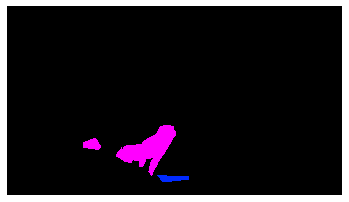

(360, 640, 3)
COCO_val2014_000000447733.jpg
{'person_bbx': [228.74, 148.48, 371.88, 411.55999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': [248.81, 329.24, 365.71000000000004, 429.66]}}
person
skateboard
jump
jump interaction
{'person_bbx': [228.74, 148.48, 371.88, 411.55999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [248.81, 329.24, 365.71000000000004, 429.66]}}
person
skateboard
look
look interaction
{'person_bbx': [228.74, 148.48, 371.88, 411.55999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [248.81, 329.24, 365.71000000000004, 429.66]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [228.74, 148.48, 371.88, 411.55999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


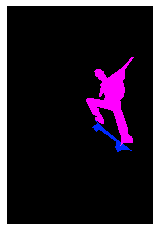

(640, 427, 3)
COCO_val2014_000000340658.jpg
{'person_bbx': [323.6, 102.44, 445.85, 290.83], 'Verbs': 'surf', 'object': {'obj_bbx': [370.93, 279.63, 473.12, 308.63]}}
surfboard
person
surf
surf interaction


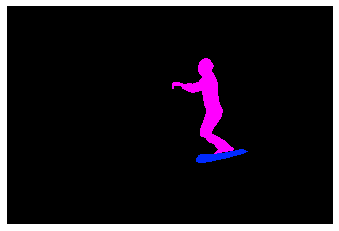

(428, 640, 3)
COCO_val2014_000000137682.jpg
{'person_bbx': [119.37, 177.0, 272.17, 297.24], 'Verbs': 'surf', 'object': {'obj_bbx': [60.68, 266.2, 199.89000000000001, 309.06]}}
person
surfboard
surf
surf interaction


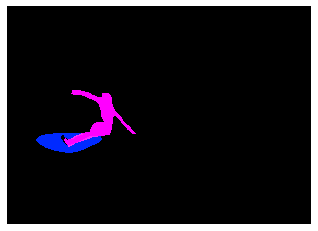

(458, 640, 3)
COCO_val2014_000000269815.jpg
{'person_bbx': [117.15, 287.86, 607.49, 566.76], 'Verbs': 'lay', 'object': {'obj_bbx': [39.6, 36.41, 640.0, 568.9499999999999]}}
bed
person
lay
lay interaction
{'person_bbx': [117.15, 287.86, 607.49, 566.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


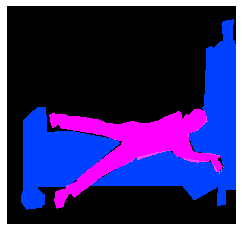

(609, 640, 3)
COCO_val2014_000000497031.jpg
{'person_bbx': [7.55, 1.08, 640.0, 252.4], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [117.23, 138.15, 235.03, 236.19]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [7.55, 1.08, 640.0, 252.4], 'Verbs': 'hold', 'object': {'obj_bbx': [117.23, 138.15, 235.03, 236.19]}}
person
scissors
hold
hold interaction
{'person_bbx': [7.55, 1.08, 640.0, 252.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


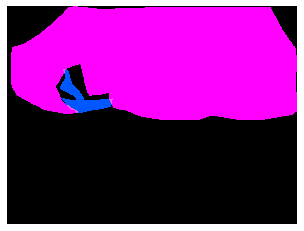

(480, 640, 3)
COCO_val2014_000000099341.jpg
{'person_bbx': [146.37, 137.33, 264.75, 348.27], 'Verbs': 'look', 'object': {'obj_bbx': [22.53, 321.57, 63.89, 359.64]}}
person
frisbee
look
look interaction
{'person_bbx': [146.37, 137.33, 264.75, 348.27], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [146.37, 137.33, 264.75, 348.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


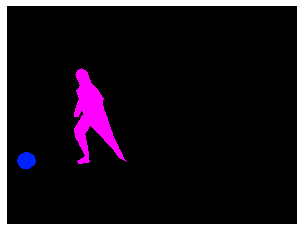

(480, 640, 3)
COCO_val2014_000000565438.jpg
{'person_bbx': [97.58, 2.3, 332.91, 412.7], 'Verbs': 'jump', 'object': {'obj_bbx': [160.01, 264.08, 278.12, 434.46]}}
person
skateboard
jump
jump interaction
{'person_bbx': [97.58, 2.3, 332.91, 412.7], 'Verbs': 'look', 'object': {'obj_bbx': [160.01, 264.08, 278.12, 434.46]}}
person
skateboard
look
look interaction
{'person_bbx': [97.58, 2.3, 332.91, 412.7], 'Verbs': 'skateboard', 'object': {'obj_bbx': [160.01, 264.08, 278.12, 434.46]}}
person
skateboard
skateboard
skateboard interaction


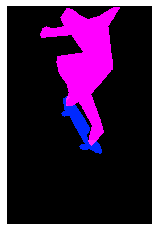

(640, 426, 3)
COCO_val2014_000000473466.jpg
{'person_bbx': [109.92, 0.46, 616.75, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [386.44, 310.33, 446.61, 377.90999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [109.92, 0.46, 616.75, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.92, 0.46, 616.75, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [386.44, 310.33, 446.61, 377.90999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


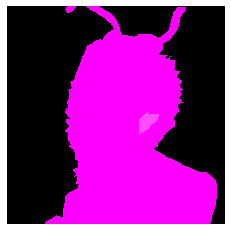

(640, 639, 3)
COCO_val2014_000000126564.jpg
{'person_bbx': [73.36, 323.46, 245.57999999999998, 638.64], 'Verbs': 'carry', 'object': {'obj_bbx': [58.52, 300.14, 335.54999999999995, 537.0699999999999]}}
umbrella
person
carry
carry interaction
{'person_bbx': [73.36, 323.46, 245.57999999999998, 638.64], 'Verbs': 'hold', 'object': {'obj_bbx': [28.17, 462.65, 99.02, 511.60999999999996]}}
person
book
hold
hold interaction
{'person_bbx': [73.36, 323.46, 245.57999999999998, 638.64], 'Verbs': 'look', 'object': {'obj_bbx': [28.17, 462.65, 99.02, 511.60999999999996]}}
person
book
look
look interaction
{'person_bbx': [73.36, 323.46, 245.57999999999998, 638.64], 'Verbs': 'read', 'object': {'obj_bbx': [28.17, 462.65, 99.02, 511.60999999999996]}}
person
book
read
read interaction
{'person_bbx': [73.36, 323.46, 245.57999999999998, 638.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


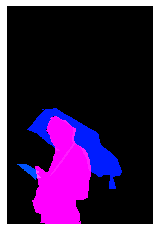

(640, 427, 3)
COCO_val2014_000000403975.jpg
{'person_bbx': [161.57, 70.2, 405.84000000000003, 390.45], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [277.21, 264.24, 386.64, 310.6]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [161.57, 70.2, 405.84000000000003, 390.45], 'Verbs': 'hold', 'object': {'obj_bbx': [277.21, 264.24, 386.64, 310.6]}}
person
cake
hold
hold interaction
{'person_bbx': [161.57, 70.2, 405.84000000000003, 390.45], 'Verbs': 'look', 'object': {'obj_bbx': [277.21, 264.24, 386.64, 310.6]}}
person
cake
look
look interaction
{'person_bbx': [161.57, 70.2, 405.84000000000003, 390.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


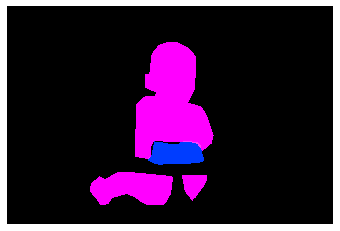

(427, 640, 3)
COCO_val2014_000000359676.jpg
{'person_bbx': [222.99, 292.38, 266.5, 387.22], 'Verbs': 'carry', 'object': {'obj_bbx': [239.13, 303.67, 258.31, 330.26]}}
person
backpack
carry
carry interaction
{'person_bbx': [163.15, 296.86, 202.2, 392.43], 'Verbs': 'carry', 'object': {'obj_bbx': [155.92, 311.04, 173.76999999999998, 338.18]}}
person
handbag
carry
carry interaction
{'person_bbx': [222.99, 292.38, 266.5, 387.22], 'Verbs': 'hold', 'object': {'obj_bbx': [251.12, 356.82, 280.49, 392.28]}}
person
suitcase
hold
hold interaction
{'person_bbx': [163.15, 296.86, 202.2, 392.43], 'Verbs': 'hold', 'object': {'obj_bbx': [188.72, 329.0, 223.79, 400.21]}}
person
suitcase
hold
hold interaction
{'person_bbx': [222.99, 292.38, 266.5, 387.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [163.15, 296.86, 202.2, 392.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.99, 292.38, 266.5, 387.22], 'Verbs': 'walk', 'object': {'obj_bbx': [

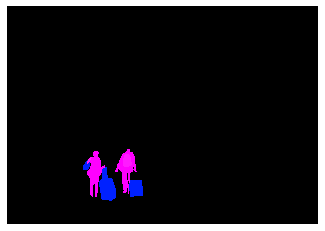

(448, 640, 3)
COCO_val2014_000000382715.jpg
{'person_bbx': [129.44, 171.15, 251.69, 547.96], 'Verbs': 'skateboard', 'object': {'obj_bbx': [141.03, 508.68, 222.12, 566.95]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [129.44, 171.15, 251.69, 547.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


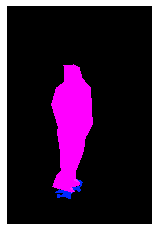

(640, 425, 3)
COCO_val2014_000000414576.jpg
{'person_bbx': [267.97, 181.46, 463.68000000000006, 367.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [413.27, 224.92, 428.19, 244.38]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [267.97, 181.46, 463.68000000000006, 367.33000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [267.97, 181.46, 463.68000000000006, 367.33000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.97, 181.46, 463.68000000000006, 367.33000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [311.71, 215.64, 320.10999999999996, 224.60999999999999]}}
sports ball
person
throw
throw interaction


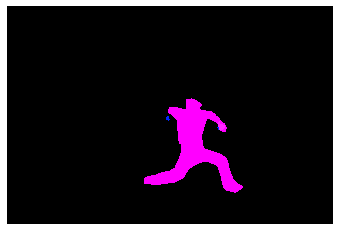

(428, 640, 3)
COCO_val2014_000000468751.jpg
{'person_bbx': [210.84, 46.28, 358.38, 517.47], 'Verbs': 'hold', 'object': {'obj_bbx': [254.03, 90.29, 265.0, 119.27000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [210.84, 46.28, 358.38, 517.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [210.84, 46.28, 358.38, 517.47], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [254.03, 90.29, 265.0, 119.27000000000001]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [210.84, 46.28, 358.38, 517.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


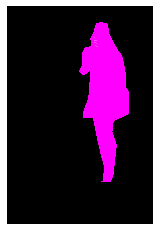

(640, 427, 3)
COCO_val2014_000000221282.jpg
{'person_bbx': [134.89, 84.09, 393.18, 564.8100000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [145.98, 342.73, 258.1, 396.57000000000005]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [134.89, 84.09, 393.18, 564.8100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [134.89, 84.09, 393.18, 564.8100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [145.98, 342.73, 258.1, 396.57000000000005]}}
person
pizza
look
look interaction
{'person_bbx': [134.89, 84.09, 393.18, 564.8100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


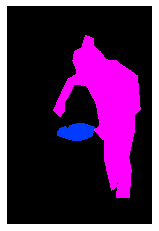

(640, 426, 3)
COCO_val2014_000000402118.jpg
{'person_bbx': [184.56, 65.68, 485.75, 311.38], 'Verbs': 'jump', 'object': {'obj_bbx': [201.39, 266.67, 532.62, 338.94]}}
person
snowboard
jump
jump interaction
{'person_bbx': [184.56, 65.68, 485.75, 311.38], 'Verbs': 'look', 'object': {'obj_bbx': [201.39, 266.67, 532.62, 338.94]}}
person
snowboard
look
look interaction
{'person_bbx': [184.56, 65.68, 485.75, 311.38], 'Verbs': 'snowboard', 'object': {'obj_bbx': [201.39, 266.67, 532.62, 338.94]}}
person
snowboard
snowboard
snowboard interaction


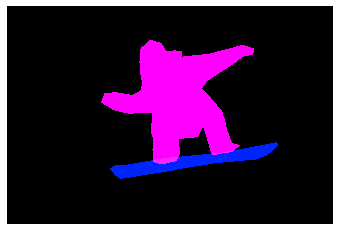

(428, 640, 3)
COCO_val2014_000000153971.jpg
{'person_bbx': [348.9, 159.38, 580.86, 342.81], 'Verbs': 'catch', 'object': {'obj_bbx': [334.03, 229.57, 371.55999999999995, 241.73999999999998]}}
frisbee
person
catch
catch interaction
{'person_bbx': [348.9, 159.38, 580.86, 342.81], 'Verbs': 'look', 'object': {'obj_bbx': [334.03, 229.57, 371.55999999999995, 241.73999999999998]}}
frisbee
person
look
look interaction


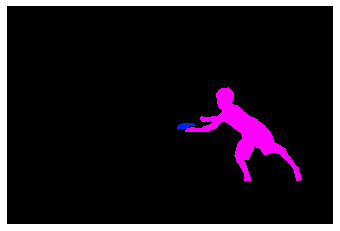

(427, 640, 3)
COCO_val2014_000000146865.jpg
{'person_bbx': [265.64, 155.86, 523.36, 469.46000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [435.56, 419.81, 529.29, 479.39]}}
skateboard
person
jump
jump interaction
{'person_bbx': [265.64, 155.86, 523.36, 469.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [435.56, 419.81, 529.29, 479.39]}}
skateboard
person
look
look interaction
{'person_bbx': [265.64, 155.86, 523.36, 469.46000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [435.56, 419.81, 529.29, 479.39]}}
skateboard
person
skateboard
skateboard interaction


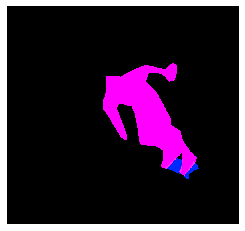

(602, 640, 3)
COCO_val2014_000000409572.jpg
{'person_bbx': [217.03, 97.22, 300.5, 358.44000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [253.12, 86.96, 376.53, 401.73999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [217.03, 97.22, 300.5, 358.44000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': [137.48, 334.87, 358.44, 375.13]}}
skis
person
ski
ski interaction
{'person_bbx': [253.12, 86.96, 376.53, 401.73999999999995], 'Verbs': 'ski', 'object': {'obj_bbx': [147.83, 382.02, 421.76, 408.03999999999996]}}
skis
person
ski
ski interaction
{'person_bbx': [217.03, 97.22, 300.5, 358.44000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [253.12, 86.96, 376.53, 401.73999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [217.03, 97.22, 300.5, 358.44000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [253.12, 86.96, 3

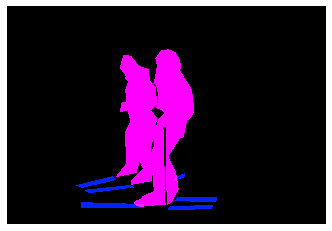

(437, 640, 3)
COCO_val2014_000000243148.jpg
{'person_bbx': [129.96, 72.65, 481.88, 355.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [254.02, 1.62, 640.0, 355.15], 'Verbs': 'look', 'object': {'obj_bbx': [129.96, 72.65, 481.88, 355.96000000000004]}}
person
person
look
look interaction
{'person_bbx': [129.96, 72.65, 481.88, 355.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [129.96, 72.65, 481.88, 355.96000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [254.02, 1.62, 640.0, 355.15], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [254.02, 1.62, 640.0, 355.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


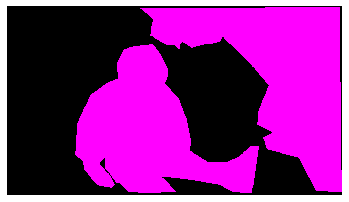

(360, 640, 3)
COCO_val2014_000000180869.jpg
{'person_bbx': [316.61, 212.66, 609.1500000000001, 407.68], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


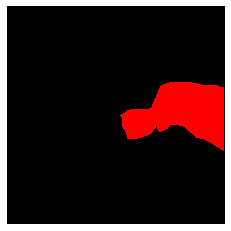

(612, 612, 3)
COCO_val2014_000000217997.jpg
{'person_bbx': [146.7, 211.51, 194.92, 328.61], 'Verbs': 'carry', 'object': {'obj_bbx': [85.82, 247.13, 275.03999999999996, 308.02]}}
person
surfboard
carry
carry interaction
{'person_bbx': [146.7, 211.51, 194.92, 328.61], 'Verbs': 'hold', 'object': {'obj_bbx': [85.82, 247.13, 275.03999999999996, 308.02]}}
person
surfboard
hold
hold interaction
{'person_bbx': [146.7, 211.51, 194.92, 328.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [146.7, 211.51, 194.92, 328.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


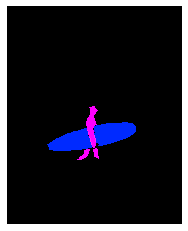

(464, 372, 3)
COCO_val2014_000000360328.jpg
{'person_bbx': [134.29, 24.13, 536.36, 355.01], 'Verbs': 'hold', 'object': {'obj_bbx': [219.55, 179.19, 287.35, 266.37]}}
person
cell phone
hold
hold interaction
{'person_bbx': [134.29, 24.13, 536.36, 355.01], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [219.55, 179.19, 287.35, 266.37]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


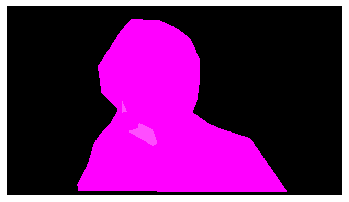

(360, 640, 3)
COCO_val2014_000000478338.jpg
{'person_bbx': [201.51, 104.59, 382.86, 355.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [201.51, 104.59, 382.86, 355.99], 'Verbs': 'surf', 'object': {'obj_bbx': [270.05, 329.88, 370.68, 375.75]}}
person
surfboard
surf
surf interaction


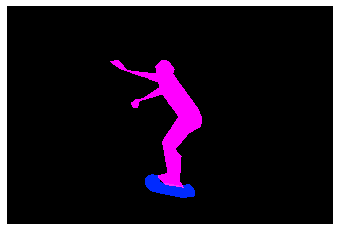

(427, 640, 3)
COCO_val2014_000000264124.jpg
{'person_bbx': [144.88, 0.96, 639.0, 421.2], 'Verbs': 'hold', 'object': {'obj_bbx': [225.92, 223.91, 273.09999999999997, 340.99]}}
cell phone
person
hold
hold interaction
{'person_bbx': [144.88, 0.96, 639.0, 421.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [144.88, 0.96, 639.0, 421.2], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [225.92, 223.91, 273.09999999999997, 340.99]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


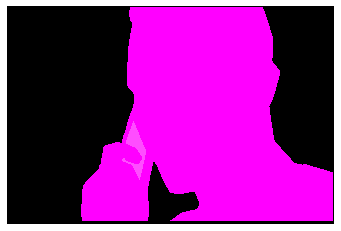

(426, 640, 3)
COCO_val2014_000000205720.jpg
{'person_bbx': [0.0, 51.29, 184.98, 370.8], 'Verbs': 'hold', 'object': {'obj_bbx': [72.89, 132.91, 140.9, 214.22]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 51.29, 184.98, 370.8], 'Verbs': 'ride', 'object': {'obj_bbx': [319.38, 235.96, 500.0, 370.79]}}
boat
person
ride
ride interaction
{'person_bbx': [0.0, 51.29, 184.98, 370.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 51.29, 184.98, 370.8], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [72.89, 132.91, 140.9, 214.22]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


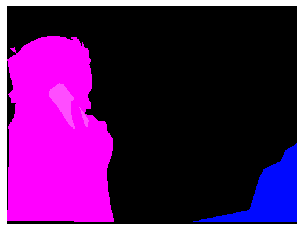

(375, 500, 3)
COCO_val2014_000000252354.jpg
{'person_bbx': [0.0, 0.0, 569.73, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [169.35, 236.22, 552.27, 474.61]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.0, 0.0, 569.73, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 5.06, 640.0, 371.81]}}
bed
person
lay
lay interaction


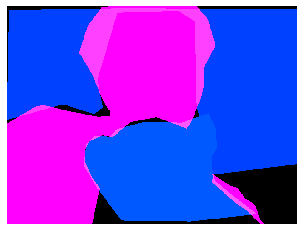

(480, 640, 3)
COCO_val2014_000000576650.jpg
{'person_bbx': [341.29, 255.42, 383.01, 355.56], 'Verbs': 'ride', 'object': {'obj_bbx': [333.3, 291.5, 385.63, 356.52]}}
person
bicycle
ride
ride interaction
{'person_bbx': [232.45, 259.66, 271.11, 363.58000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [235.32, 296.35, 272.61, 367.77000000000004]}}
person
bicycle
ride
ride interaction
{'person_bbx': [341.29, 255.42, 383.01, 355.56], 'Verbs': 'sit', 'object': {'obj_bbx': [333.3, 291.5, 385.63, 356.52]}}
person
bicycle
sit
sit interaction
{'person_bbx': [232.45, 259.66, 271.11, 363.58000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [235.32, 296.35, 272.61, 367.77000000000004]}}
person
bicycle
sit
sit interaction
{'person_bbx': [137.98, 259.38, 168.95999999999998, 361.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [97.68, 259.04, 142.78, 373.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.43, 261.05, 109.9, 362.07], 'Verbs'

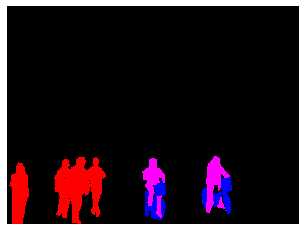

(373, 500, 3)
COCO_val2014_000000127516.jpg
{'person_bbx': [228.96, 58.93, 563.21, 337.16], 'Verbs': 'hold', 'object': {'obj_bbx': [245.79, 176.63, 508.92999999999995, 389.65]}}
person
surfboard
hold
hold interaction
{'person_bbx': [228.96, 58.93, 563.21, 337.16], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [228.96, 58.93, 563.21, 337.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [228.96, 58.93, 563.21, 337.16], 'Verbs': 'surf', 'object': {'obj_bbx': [245.79, 176.63, 508.92999999999995, 389.65]}}
person
surfboard
surf
surf interaction


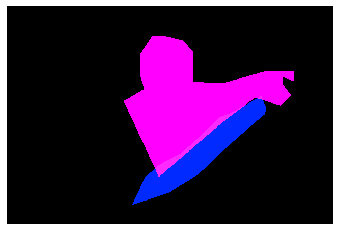

(427, 640, 3)
COCO_val2014_000000382307.jpg
{'person_bbx': [213.09, 152.83, 289.51, 432.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [213.09, 152.83, 289.51, 432.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


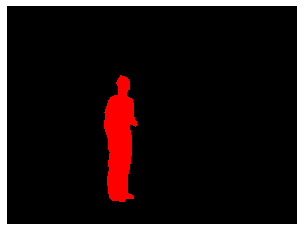

(480, 640, 3)
COCO_val2014_000000144003.jpg
{'person_bbx': [18.58, 89.1, 244.93, 370.35], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [152.15, 254.87, 201.58, 264.88]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [18.58, 89.1, 244.93, 370.35], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [178.29, 212.81, 290.28, 296.35]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [18.58, 89.1, 244.93, 370.35], 'Verbs': 'hold', 'object': {'obj_bbx': [152.15, 254.87, 201.58, 264.88]}}
person
knife
hold
hold interaction
{'person_bbx': [181.61, 15.93, 412.0, 368.23], 'Verbs': 'hold', 'object': {'obj_bbx': [361.6, 212.01, 397.26, 237.42]}}
person
remote
hold
hold interaction
{'person_bbx': [18.58, 89.1, 244.93, 370.35], 'Verbs': 'look', 'object': {'obj_bbx': [178.29, 212.81, 290.28, 296.35]}}
person
cake
look
look interaction
{'person_bbx': [181.61, 15.93, 412.0, 368.23], 'Verbs': 'look', 'object': {'obj_bbx': [178.29, 212.81, 290.28, 296.35]}}
person
cake
look
look interaction
{'p

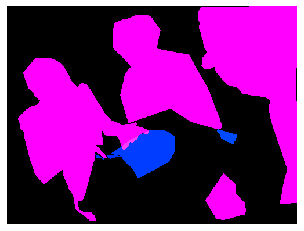

(375, 500, 3)
COCO_val2014_000000421978.jpg
{'person_bbx': [290.74, 97.4, 348.77, 224.87], 'Verbs': 'hold', 'object': {'obj_bbx': [301.47, 138.56, 515.97, 499.16]}}
horse
person
hold
hold interaction
{'person_bbx': [290.74, 97.4, 348.77, 224.87], 'Verbs': 'ride', 'object': {'obj_bbx': [301.47, 138.56, 515.97, 499.16]}}
horse
person
ride
ride interaction
{'person_bbx': [353.79, 103.02, 414.89000000000004, 213.76999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [290.74, 97.4, 348.77, 224.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [353.79, 103.02, 414.89000000000004, 213.76999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


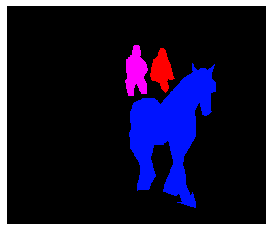

(538, 640, 3)
COCO_val2014_000000292464.jpg
{'person_bbx': [204.38, 106.51, 435.64, 415.49], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [210.75, 290.06, 341.71000000000004, 320.98]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [204.38, 106.51, 435.64, 415.49], 'Verbs': 'hold', 'object': {'obj_bbx': [210.75, 290.06, 341.71000000000004, 320.98]}}
person
knife
hold
hold interaction
{'person_bbx': [381.15, 15.38, 603.72, 422.32], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [19.27, 69.8, 256.05, 426.68], 'Verbs': 'hold', 'object': {'obj_bbx': [221.42, 340.02, 269.9, 366.03]}}
fork
person
hold
hold interaction
{'person_bbx': [204.38, 106.51, 435.64, 415.49], 'Verbs': 'look', 'object': {'obj_bbx': [272.51, 380.94, 408.77, 426.04]}}
person
cake
look
look interaction
{'person_bbx': [381.15, 15.38, 603.72, 422.32], 'Verbs': 'look', 'object': {'obj_bbx': [272.51, 380.94, 408.77, 426.04]}}
person
cake
look
look interaction
{'person_bbx': [19.27, 69.8, 25

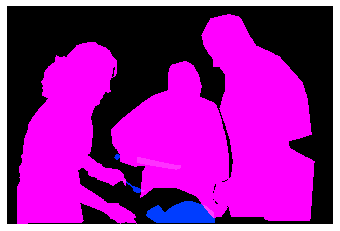

(427, 640, 3)
COCO_val2014_000000386089.jpg
{'person_bbx': [59.03, 57.49, 485.6, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [296.26, 151.15, 333.44, 178.33]}}
cell phone
person
hold
hold interaction
{'person_bbx': [59.03, 57.49, 485.6, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [59.03, 57.49, 485.6, 426.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [296.26, 151.15, 333.44, 178.33]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


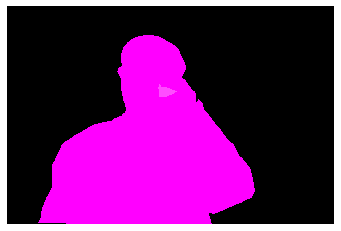

(426, 640, 3)
COCO_val2014_000000116132.jpg
{'person_bbx': [3.37, 150.0, 130.62, 265.45], 'Verbs': 'look', 'object': {'obj_bbx': [77.35, 165.64, 160.58999999999997, 230.38]}}
person
laptop
look
look interaction
{'person_bbx': [3.37, 150.0, 130.62, 265.45], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 236.85, 86.8, 370.0]}}
chair
person
sit
sit interaction
{'person_bbx': [258.97, 168.16, 363.23, 229.54], 'Verbs': 'sit', 'object': {'obj_bbx': [236.29, 190.55, 267.95, 214.49]}}
person
chair
sit
sit interaction
{'person_bbx': [3.37, 150.0, 130.62, 265.45], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [77.35, 165.64, 160.58999999999997, 230.38]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [258.97, 168.16, 363.23, 229.54], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


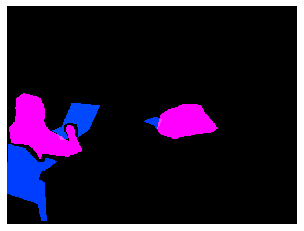

(375, 500, 3)
COCO_val2014_000000230819.jpg
{'person_bbx': [202.06, 153.38, 282.7, 274.59], 'Verbs': 'look', 'object': {'obj_bbx': [220.8, 265.89, 293.56, 284.40999999999997]}}
person
surfboard
look
look interaction
{'person_bbx': [202.06, 153.38, 282.7, 274.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [202.06, 153.38, 282.7, 274.59], 'Verbs': 'surf', 'object': {'obj_bbx': [220.8, 265.89, 293.56, 284.40999999999997]}}
person
surfboard
surf
surf interaction


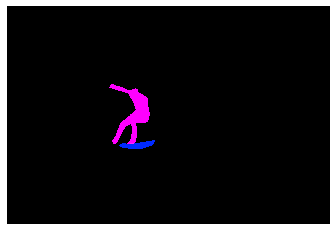

(432, 640, 3)
COCO_val2014_000000511324.jpg
{'person_bbx': [312.37, 72.69, 637.1600000000001, 419.45], 'Verbs': 'hold', 'object': {'obj_bbx': [404.9, 184.95, 560.0, 268.51]}}
person
laptop
hold
hold interaction
{'person_bbx': [312.37, 72.69, 637.1600000000001, 419.45], 'Verbs': 'look', 'object': {'obj_bbx': [404.9, 184.95, 560.0, 268.51]}}
person
laptop
look
look interaction
{'person_bbx': [312.37, 72.69, 637.1600000000001, 419.45], 'Verbs': 'sit', 'object': {'obj_bbx': [489.11, 313.87, 637.73, 420.35]}}
person
chair
sit
sit interaction
{'person_bbx': [312.37, 72.69, 637.1600000000001, 419.45], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [404.9, 184.95, 560.0, 268.51]}}
person
laptop
work_on_computer
work_on_computer interaction


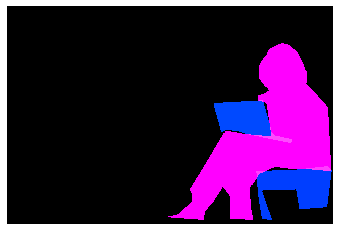

(427, 640, 3)
COCO_val2014_000000196458.jpg
{'person_bbx': [124.07, 24.11, 448.2, 422.29], 'Verbs': 'hold', 'object': {'obj_bbx': [84.64, 373.18, 251.99, 423.19]}}
person
frisbee
hold
hold interaction
{'person_bbx': [124.07, 24.11, 448.2, 422.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.07, 24.11, 448.2, 422.29], 'Verbs': 'throw', 'object': {'obj_bbx': [84.64, 373.18, 251.99, 423.19]}}
person
frisbee
throw
throw interaction


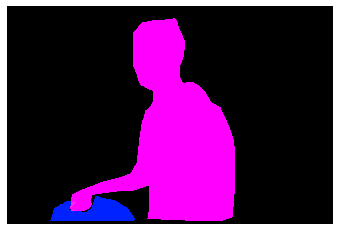

(428, 640, 3)
COCO_val2014_000000331386.jpg
{'person_bbx': [139.54, 335.98, 165.75, 406.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [537.32, 346.54, 573.35, 417.69000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [537.32, 346.54, 573.35, 417.69000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


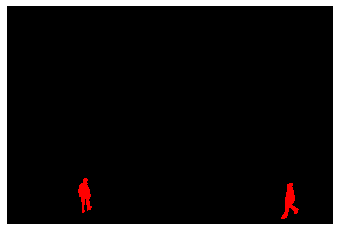

(427, 640, 3)
COCO_val2014_000000438723.jpg
{'person_bbx': [10.17, 19.65, 481.0, 640.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 1.8, 481.0, 631.7299999999999]}}
person
bed
lay
lay interaction


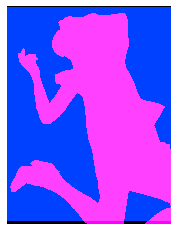

(640, 481, 3)
COCO_val2014_000000233119.jpg
{'person_bbx': [361.9, 119.29, 503.59, 415.13], 'Verbs': 'carry', 'object': {'obj_bbx': [367.43, 163.74, 450.74, 247.06]}}
person
backpack
carry
carry interaction
{'person_bbx': [361.9, 119.29, 503.59, 415.13], 'Verbs': 'hold', 'object': {'obj_bbx': [457.88, 297.51, 532.35, 413.55]}}
person
suitcase
hold
hold interaction
{'person_bbx': [361.9, 119.29, 503.59, 415.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [361.9, 119.29, 503.59, 415.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [361.9, 119.29, 503.59, 415.13], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


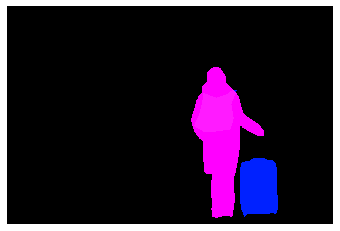

(427, 640, 3)
COCO_val2014_000000233771.jpg
{'person_bbx': [381.29, 446.65, 490.93, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [335.33, 396.18, 515.4, 465.15]}}
person
umbrella
carry
carry interaction
{'person_bbx': [229.85, 440.54, 386.35, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [307.87, 537.63, 391.98, 637.49]}}
person
handbag
carry
carry interaction
{'person_bbx': [381.29, 446.65, 490.93, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [335.33, 396.18, 515.4, 465.15]}}
person
umbrella
hold
hold interaction
{'person_bbx': [229.85, 440.54, 386.35, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [173.02, 356.43, 485.31000000000006, 458.55]}}
person
umbrella
hold
hold interaction
{'person_bbx': [85.91, 378.94, 274.9, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [52.82, 321.59, 504.83, 454.83]}}
person
bus
look
look interaction
{'person_bbx': [381.29, 446.65, 490.93, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [229.85, 440.54, 386.35, 640

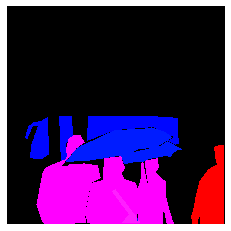

(640, 640, 3)
COCO_val2014_000000137130.jpg
{'person_bbx': [0.0, 148.18, 342.07, 632.12], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 427.0, 640.0]}}
bed
person
lay
lay interaction


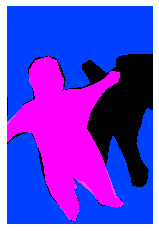

(640, 427, 3)
COCO_val2014_000000403693.jpg
{'person_bbx': [100.67, 243.15, 350.92, 592.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


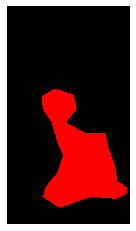

(640, 360, 3)
COCO_val2014_000000335065.jpg
{'person_bbx': [336.25, 150.07, 477.63, 306.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [485.9, 194.3, 640.0, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 289.91, 143.78, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [336.25, 150.07, 477.63, 306.73]}}
person
person
look
look interaction
{'person_bbx': [336.25, 150.07, 477.63, 306.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [78.79, 157.11, 212.37, 307.15], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [485.9, 194.3, 640.0, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 289.91, 143.78, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [336.25, 150.07, 477.63, 306.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [78.79, 157.11, 212.37, 307.15], 'Verbs': 'smile', 'object': {'obj_bbx

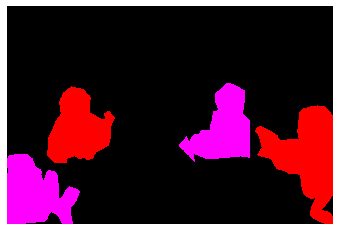

(427, 640, 3)
COCO_val2014_000000015600.jpg
{'person_bbx': [1.44, 112.18, 467.42, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [234.92, 337.32, 359.90999999999997, 515.01]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [1.44, 112.18, 467.42, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [234.92, 337.32, 359.90999999999997, 515.01]}}
person
carrot
hold
hold interaction
{'person_bbx': [1.44, 112.18, 467.42, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


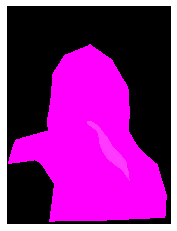

(640, 480, 3)
COCO_val2014_000000542325.jpg
{'person_bbx': [1.27, 195.54, 78.83, 276.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.27, 195.54, 78.83, 276.83], 'Verbs': 'sit', 'object': {'obj_bbx': [7.65, 238.84, 81.95, 310.29]}}
person
chair
sit
sit interaction


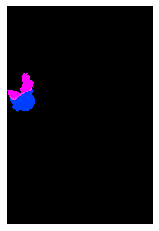

(640, 427, 3)
COCO_val2014_000000578675.jpg
{'person_bbx': [464.18, 64.15, 608.8, 513.17], 'Verbs': 'hold', 'object': {'obj_bbx': [497.19, 109.62, 508.15, 139.89000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [464.18, 64.15, 608.8, 513.17], 'Verbs': 'look', 'object': {'obj_bbx': [15.96, 236.93, 158.3, 468.88]}}
person
person
look
look interaction
{'person_bbx': [464.18, 64.15, 608.8, 513.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [464.18, 64.15, 608.8, 513.17], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [497.19, 109.62, 508.15, 139.89000000000001]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


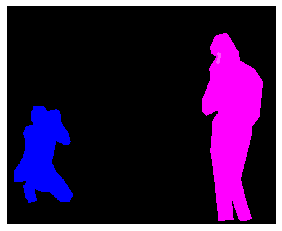

(519, 640, 3)
COCO_val2014_000000032300.jpg
{'person_bbx': [166.82, 66.85, 354.08, 353.13], 'Verbs': 'hold', 'object': {'obj_bbx': [307.66, 178.54, 348.69000000000005, 245.63]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [166.82, 66.85, 354.08, 353.13], 'Verbs': 'look', 'object': {'obj_bbx': [367.44, 333.25, 387.23, 353.47]}}
sports ball
person
look
look interaction
{'person_bbx': [304.9, 5.98, 486.36, 264.91], 'Verbs': 'look', 'object': {'obj_bbx': [367.44, 333.25, 387.23, 353.47]}}
sports ball
person
look
look interaction
{'person_bbx': [166.82, 66.85, 354.08, 353.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [304.9, 5.98, 486.36, 264.91], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [166.82, 66.85, 354.08, 353.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [213.57, 4.31, 337.62, 139.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


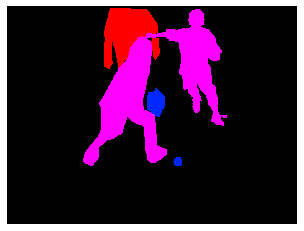

(480, 640, 3)
COCO_val2014_000000143101.jpg
{'person_bbx': [347.96, 130.85, 559.05, 298.56], 'Verbs': 'look', 'object': {'obj_bbx': [415.64, 242.87, 624.41, 302.97]}}
person
surfboard
look
look interaction
{'person_bbx': [347.96, 130.85, 559.05, 298.56], 'Verbs': 'surf', 'object': {'obj_bbx': [415.64, 242.87, 624.41, 302.97]}}
person
surfboard
surf
surf interaction


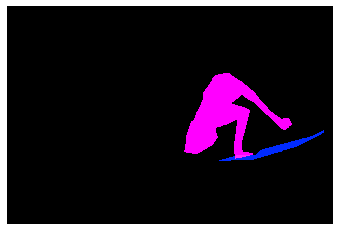

(427, 640, 3)
COCO_val2014_000000300206.jpg
{'person_bbx': [218.11, 177.24, 255.95000000000002, 269.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [218.11, 177.24, 255.95000000000002, 269.52], 'Verbs': 'surf', 'object': {'obj_bbx': [225.83, 243.37, 255.85000000000002, 282.2]}}
person
surfboard
surf
surf interaction


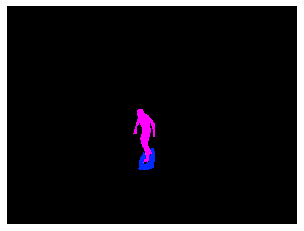

(375, 500, 3)
COCO_val2014_000000524627.jpg
{'person_bbx': [175.05, 180.49, 389.43, 458.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [306.7, 404.58, 427.0, 639.16], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [175.05, 180.49, 389.43, 458.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [306.7, 404.58, 427.0, 639.16], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [141.26, 21.62, 242.16, 394.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [234.43, 21.57, 388.31, 319.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [15.82, 33.08, 162.51999999999998, 430.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


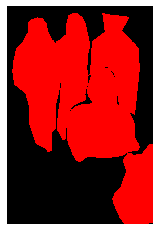

(640, 427, 3)
COCO_val2014_000000230432.jpg
{'person_bbx': [398.85, 188.13, 484.59000000000003, 284.72], 'Verbs': 'look', 'object': {'obj_bbx': [439.19, 246.85, 490.21, 302.84]}}
surfboard
person
look
look interaction
{'person_bbx': [398.85, 188.13, 484.59000000000003, 284.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [398.85, 188.13, 484.59000000000003, 284.72], 'Verbs': 'surf', 'object': {'obj_bbx': [439.19, 246.85, 490.21, 302.84]}}
surfboard
person
surf
surf interaction


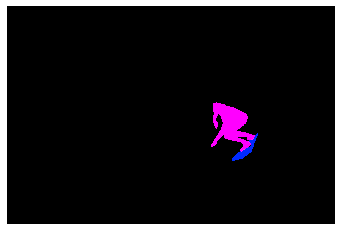

(425, 640, 3)
COCO_val2014_000000171603.jpg
{'person_bbx': [99.75, 27.75, 372.75, 267.0], 'Verbs': 'hold', 'object': {'obj_bbx': [302.95, 158.59, 321.87, 171.08]}}
cell phone
person
hold
hold interaction
{'person_bbx': [99.75, 27.75, 372.75, 267.0], 'Verbs': 'lay', 'object': {'obj_bbx': [236.33, 78.31, 438.02, 333.0]}}
person
bed
lay
lay interaction
{'person_bbx': [99.75, 27.75, 372.75, 267.0], 'Verbs': 'look', 'object': {'obj_bbx': [302.95, 158.59, 321.87, 171.08]}}
cell phone
person
look
look interaction
{'person_bbx': [0.75, 72.0, 163.5, 331.5], 'Verbs': 'look', 'object': {'obj_bbx': [130.96, 188.45, 299.33000000000004, 326.89]}}
person
laptop
look
look interaction
{'person_bbx': [0.75, 72.0, 163.5, 331.5], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [130.96, 188.45, 299.33000000000004, 326.89]}}
person
laptop
work_on_computer
work_on_computer interaction


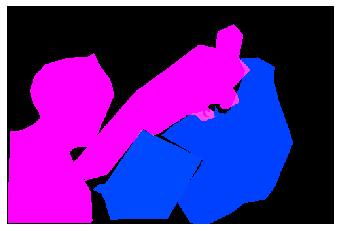

(333, 500, 3)
COCO_val2014_000000431854.jpg
{'person_bbx': [163.23, 236.82, 398.56, 500.15999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [348.52, 314.7, 397.5, 428.31]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [163.23, 236.82, 398.56, 500.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [348.52, 314.7, 397.5, 428.31]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [163.23, 236.82, 398.56, 500.15999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [163.23, 236.82, 398.56, 500.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


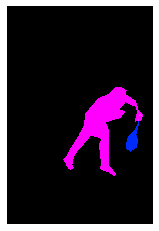

(640, 427, 3)
COCO_val2014_000000336628.jpg
{'person_bbx': [126.56, 61.4, 274.7, 582.03], 'Verbs': 'hold', 'object': {'obj_bbx': [191.91, 119.37, 208.39, 126.19]}}
person
cell phone
hold
hold interaction
{'person_bbx': [126.56, 61.4, 274.7, 582.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [126.56, 61.4, 274.7, 582.03], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [191.91, 119.37, 208.39, 126.19]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


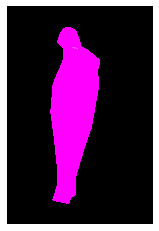

(640, 428, 3)
COCO_val2014_000000174893.jpg
{'person_bbx': [36.45, 1.42, 426.95, 463.36], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [96.36, 275.7, 237.3, 360.54999999999995]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [36.45, 1.42, 426.95, 463.36], 'Verbs': 'hold', 'object': {'obj_bbx': [96.36, 275.7, 237.3, 360.54999999999995]}}
person
scissors
hold
hold interaction
{'person_bbx': [36.45, 1.42, 426.95, 463.36], 'Verbs': 'look', 'object': {'obj_bbx': [96.36, 275.7, 237.3, 360.54999999999995]}}
person
scissors
look
look interaction
{'person_bbx': [36.45, 1.42, 426.95, 463.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [36.45, 1.42, 426.95, 463.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


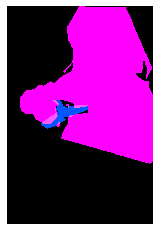

(640, 427, 3)
COCO_val2014_000000273645.jpg
{'person_bbx': [174.46, 403.06, 244.41000000000003, 429.35], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [131.54, 367.59, 185.39999999999998, 472.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [131.54, 367.59, 185.39999999999998, 472.59], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [542.21, 398.67, 584.83, 478.67], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


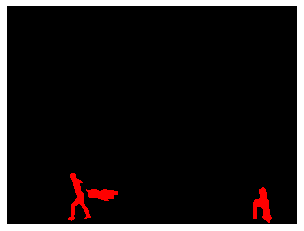

(480, 640, 3)
COCO_val2014_000000008119.jpg
{'person_bbx': [24.96, 125.21, 160.48000000000002, 274.23], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [271.78, 74.45, 438.63, 261.74], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [383.25, 117.87, 431.0, 147.23000000000002]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [271.78, 74.45, 438.63, 261.74], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [608.38, 121.4, 618.66, 131.48000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [271.78, 74.45, 438.63, 261.74], 'Verbs': 'hold', 'object': {'obj_bbx': [383.25, 117.87, 431.0, 147.23000000000002]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [271.78, 74.45, 438.63, 261.74], 'Verbs': 'look', 'object': {'obj_bbx': [608.38, 121.4, 618.66, 131.48000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [24.96, 125.21, 160.48000000000002, 274.23], 'Verbs': 'look', 'object': {'obj_bbx': [608.38, 121.4, 6

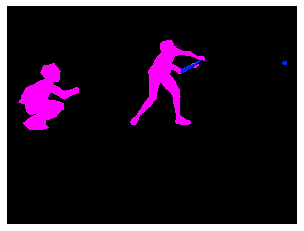

(480, 640, 3)
COCO_val2014_000000486986.jpg
{'person_bbx': [255.23, 145.79, 403.78999999999996, 553.54], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [65.89, 175.62, 239.23000000000002, 555.4], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 76.61, 133.99, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 76.61, 133.99, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [255.23, 145.79, 403.78999999999996, 553.54], 'Verbs': 'ski', 'object': {'obj_bbx': [304.66, 482.28, 427.65000000000003, 639.56]}}
person
skis
ski
ski interaction
{'person_bbx': [65.89, 175.62, 239.23000000000002, 555.4], 'Verbs': 'ski', 'object': {'obj_bbx': [151.09, 445.73, 272.72, 640.0]}}
person
skis
ski
ski interaction
{'person_bbx': [255.23, 145.79, 403.78999999999996, 553.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [65.89, 175.62, 239.23000000000002, 555.4], 'Verb

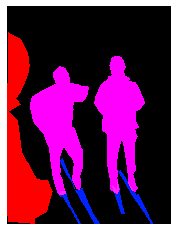

(640, 480, 3)
COCO_val2014_000000008647.jpg
{'person_bbx': [490.89, 212.52, 640.0, 440.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


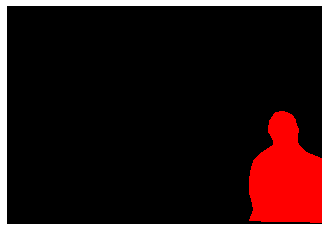

(443, 640, 3)
COCO_val2014_000000024601.jpg
{'person_bbx': [277.25, 53.79, 417.13, 334.41], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [277.25, 53.79, 417.13, 334.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [277.25, 53.79, 417.13, 334.41], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


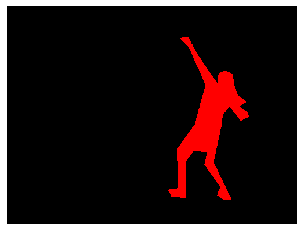

(375, 500, 3)
COCO_val2014_000000567308.jpg
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [508.2, 127.63, 540.52, 168.25]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [185.27, 232.09, 201.76000000000002, 248.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'hold', 'object': {'obj_bbx': [508.2, 127.63, 540.52, 168.25]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'look', 'object': {'obj_bbx': [185.27, 232.09, 201.76000000000002, 248.78]}}
sports ball
person
look
look interaction
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [368.44, 128.9, 526.34, 472.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


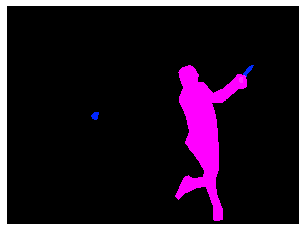

(478, 640, 3)
COCO_val2014_000000106617.jpg
{'person_bbx': [0.0, 22.53, 275.06, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [236.22, 350.56, 416.36, 470.29]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [295.96, 30.26, 638.21, 448.90999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [315.94, 210.05, 455.72, 305.22]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 22.53, 275.06, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [236.22, 350.56, 416.36, 470.29]}}
person
pizza
hold
hold interaction
{'person_bbx': [295.96, 30.26, 638.21, 448.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [315.94, 210.05, 455.72, 305.22]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 22.53, 275.06, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [295.96, 30.26, 638.21, 448.90999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [427.86, 175.23, 475.82, 253.66]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 22.53, 27

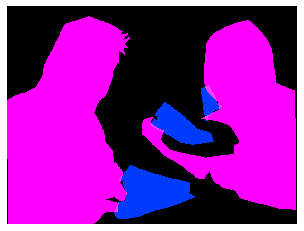

(480, 640, 3)
COCO_val2014_000000169602.jpg
{'person_bbx': [27.95, 55.66, 510.86, 207.96], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [27.95, 55.66, 510.86, 207.96], 'Verbs': 'surf', 'object': {'obj_bbx': [104.59, 209.18, 305.14, 251.4]}}
person
surfboard
surf
surf interaction


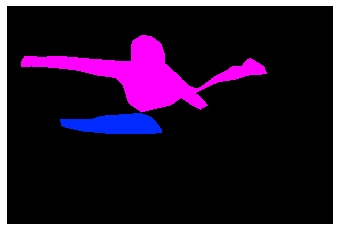

(427, 640, 3)
COCO_val2014_000000077784.jpg
{'person_bbx': [108.8, 18.92, 359.51, 366.13], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [325.45, 251.65, 388.83, 296.12]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [108.8, 18.92, 359.51, 366.13], 'Verbs': 'hold', 'object': {'obj_bbx': [325.45, 251.65, 388.83, 296.12]}}
sandwich
person
hold
hold interaction
{'person_bbx': [108.8, 18.92, 359.51, 366.13], 'Verbs': 'look', 'object': {'obj_bbx': [325.45, 251.65, 388.83, 296.12]}}
sandwich
person
look
look interaction
{'person_bbx': [108.8, 18.92, 359.51, 366.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [108.8, 18.92, 359.51, 366.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


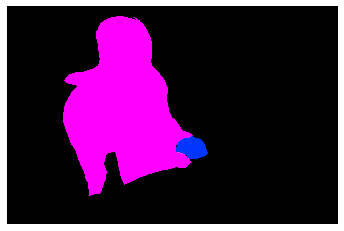

(421, 640, 3)
COCO_val2014_000000438907.jpg
{'person_bbx': [123.54, 21.43, 302.89, 402.2], 'Verbs': 'jump', 'object': {'obj_bbx': [132.71, 359.23, 260.88, 433.15000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [48.79, 163.52, 129.15, 490.69000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [123.54, 21.43, 302.89, 402.2], 'Verbs': 'look', 'object': {'obj_bbx': [132.71, 359.23, 260.88, 433.15000000000003]}}
person
skateboard
look
look interaction
{'person_bbx': [123.54, 21.43, 302.89, 402.2], 'Verbs': 'skateboard', 'object': {'obj_bbx': [132.71, 359.23, 260.88, 433.15000000000003]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [48.79, 163.52, 129.15, 490.69000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


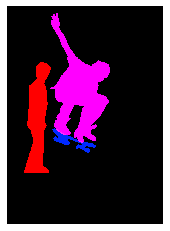

(640, 458, 3)
COCO_val2014_000000396200.jpg
{'person_bbx': [472.74, 153.45, 621.52, 323.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [472.74, 153.45, 621.52, 323.91999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [536.3, 317.04, 571.67, 339.57000000000005]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [308.86, 102.03, 390.62, 283.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [338.92, 279.41, 366.13, 300.81]}}
skateboard
person
skateboard
skateboard interaction


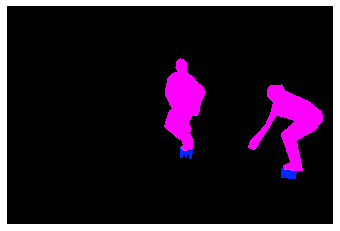

(427, 640, 3)
COCO_val2014_000000078478.jpg
{'person_bbx': [0.0, 0.0, 259.96, 215.73], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [115.33, 95.54, 446.34999999999997, 270.21]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.0, 259.96, 215.73], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [88.75, 126.88, 433.75, 385.63]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [1.08, 333.45, 138.69000000000003, 474.31], 'Verbs': 'hold', 'object': {'obj_bbx': [88.75, 126.88, 433.75, 385.63]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 0.0, 259.96, 215.73], 'Verbs': 'hold', 'object': {'obj_bbx': [115.33, 95.54, 446.34999999999997, 270.21]}}
scissors
person
hold
hold interaction


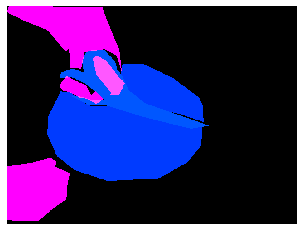

(480, 640, 3)
COCO_val2014_000000092363.jpg
{'person_bbx': [261.19, 99.07, 318.8, 192.77999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [252.83, 124.09, 324.06, 245.69]}}
horse
person
hold
hold interaction
{'person_bbx': [323.14, 95.37, 364.58, 203.28], 'Verbs': 'hold', 'object': {'obj_bbx': [311.2, 129.42, 384.39, 248.14]}}
horse
person
hold
hold interaction
{'person_bbx': [261.19, 99.07, 318.8, 192.77999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [252.83, 124.09, 324.06, 245.69]}}
horse
person
ride
ride interaction
{'person_bbx': [323.14, 95.37, 364.58, 203.28], 'Verbs': 'ride', 'object': {'obj_bbx': [311.2, 129.42, 384.39, 248.14]}}
horse
person
ride
ride interaction
{'person_bbx': [261.19, 99.07, 318.8, 192.77999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [252.83, 124.09, 324.06, 245.69]}}
horse
person
sit
sit interaction
{'person_bbx': [323.14, 95.37, 364.58, 203.28], 'Verbs': 'sit', 'object': {'obj_bbx': [311.2, 129.42, 384.39, 248.14]}}
horse
person
sit
sit in

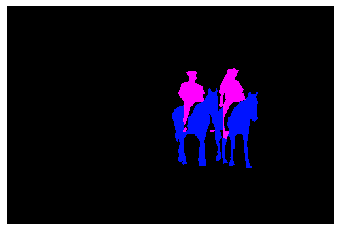

(333, 500, 3)
COCO_val2014_000000380639.jpg
{'person_bbx': [0.0, 90.0, 480.0, 531.97], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [39.77, 460.11, 278.42, 606.55]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 90.0, 480.0, 531.97], 'Verbs': 'look', 'object': {'obj_bbx': [39.77, 460.11, 278.42, 606.55]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 90.0, 480.0, 531.97], 'Verbs': 'sit', 'object': {'obj_bbx': [364.64, 401.74, 420.0, 545.53]}}
chair
person
sit
sit interaction


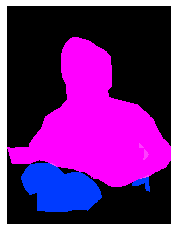

(640, 480, 3)
COCO_val2014_000000175082.jpg
{'person_bbx': [323.6, 1.07, 640.0, 422.32], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [367.06, 241.5, 400.17, 287.81]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [323.6, 1.07, 640.0, 422.32], 'Verbs': 'hold', 'object': {'obj_bbx': [476.29, 278.6, 535.52, 353.98]}}
person
wine glass
hold
hold interaction
{'person_bbx': [323.6, 1.07, 640.0, 422.32], 'Verbs': 'look', 'object': {'obj_bbx': [367.06, 241.5, 400.17, 287.81]}}
person
hot dog
look
look interaction
{'person_bbx': [323.6, 1.07, 640.0, 422.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


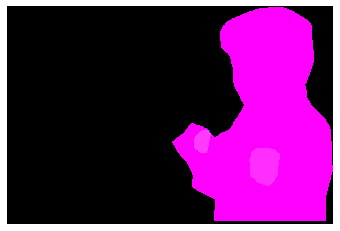

(427, 640, 3)
COCO_val2014_000000411241.jpg
{'person_bbx': [35.6, 73.17, 506.97, 474.43], 'Verbs': 'look', 'object': {'obj_bbx': [360.68, 230.94, 601.72, 367.94]}}
person
laptop
look
look interaction
{'person_bbx': [35.6, 73.17, 506.97, 474.43], 'Verbs': 'sit', 'object': {'obj_bbx': [2.06, 165.16, 566.7099999999999, 473.80999999999995]}}
couch
person
sit
sit interaction
{'person_bbx': [35.6, 73.17, 506.97, 474.43], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [360.68, 230.94, 601.72, 367.94]}}
person
laptop
work_on_computer
work_on_computer interaction


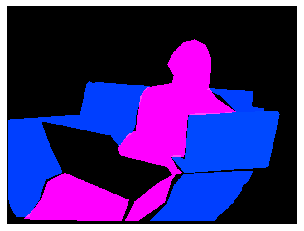

(480, 640, 3)
COCO_val2014_000000148392.jpg
{'person_bbx': [226.58, 50.57, 317.96000000000004, 259.11], 'Verbs': 'carry', 'object': {'obj_bbx': [290.14, 151.75, 352.29999999999995, 231.68]}}
person
backpack
carry
carry interaction
{'person_bbx': [226.58, 50.57, 317.96000000000004, 259.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


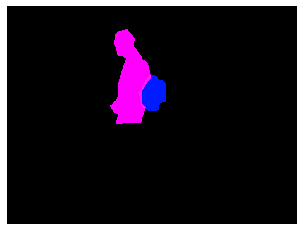

(480, 640, 3)
COCO_val2014_000000337275.jpg
{'person_bbx': [0.96, 0.58, 640.0, 408.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [179.58, 135.32, 256.54, 232.23]}}
person
apple
hold
hold interaction
{'person_bbx': [0.96, 0.58, 640.0, 408.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 0.74, 640.0, 423.19]}}
person
chair
sit
sit interaction


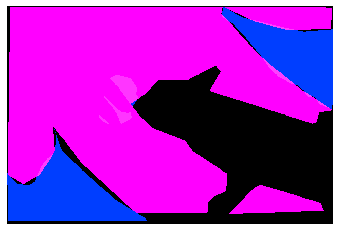

(428, 640, 3)
COCO_val2014_000000041574.jpg
{'person_bbx': [254.89, 142.68, 382.09999999999997, 339.71000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [315.7, 260.96, 348.05, 379.0]}}
skateboard
person
jump
jump interaction
{'person_bbx': [254.89, 142.68, 382.09999999999997, 339.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [315.7, 260.96, 348.05, 379.0]}}
skateboard
person
look
look interaction
{'person_bbx': [254.89, 142.68, 382.09999999999997, 339.71000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [315.7, 260.96, 348.05, 379.0]}}
skateboard
person
skateboard
skateboard interaction


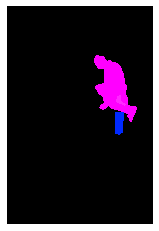

(640, 428, 3)
COCO_val2014_000000521131.jpg
{'person_bbx': [241.73, 166.86, 342.29999999999995, 382.36], 'Verbs': 'carry', 'object': {'obj_bbx': [269.4, 202.78, 350.89, 312.69]}}
person
surfboard
carry
carry interaction
{'person_bbx': [164.82, 159.76, 234.22, 371.82], 'Verbs': 'carry', 'object': {'obj_bbx': [142.97, 210.14, 261.96, 298.41999999999996]}}
person
surfboard
carry
carry interaction
{'person_bbx': [241.73, 166.86, 342.29999999999995, 382.36], 'Verbs': 'hold', 'object': {'obj_bbx': [269.4, 202.78, 350.89, 312.69]}}
person
surfboard
hold
hold interaction
{'person_bbx': [164.82, 159.76, 234.22, 371.82], 'Verbs': 'hold', 'object': {'obj_bbx': [142.97, 210.14, 261.96, 298.41999999999996]}}
person
surfboard
hold
hold interaction
{'person_bbx': [241.73, 166.86, 342.29999999999995, 382.36], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [164.82, 159.76, 234.22, 371.82], 'Verbs': 'look', 'object': {'obj_bbx': [241.73, 166.86, 342.29999999999995, 382.36]}}
pers

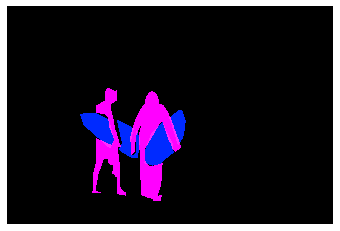

(427, 640, 3)
COCO_val2014_000000376469.jpg
{'person_bbx': [357.48, 3.03, 471.08000000000004, 87.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


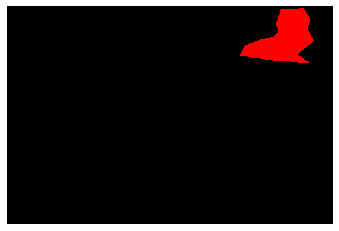

(334, 500, 3)
COCO_val2014_000000150342.jpg
{'person_bbx': [186.57, 100.02, 342.37, 345.25], 'Verbs': 'look', 'object': {'obj_bbx': [198.25, 170.28, 290.4, 221.57]}}
person
laptop
look
look interaction
{'person_bbx': [186.57, 100.02, 342.37, 345.25], 'Verbs': 'sit', 'object': {'obj_bbx': [157.01, 162.76, 336.04999999999995, 302.53999999999996]}}
person
bench
sit
sit interaction
{'person_bbx': [186.57, 100.02, 342.37, 345.25], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [198.25, 170.28, 290.4, 221.57]}}
person
laptop
work_on_computer
work_on_computer interaction


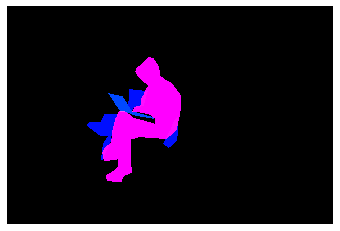

(427, 640, 3)
COCO_val2014_000000367622.jpg
{'person_bbx': [290.74, 199.59, 405.89, 299.38], 'Verbs': 'surf', 'object': {'obj_bbx': [349.29, 276.13, 394.63, 291.68]}}
person
surfboard
surf
surf interaction


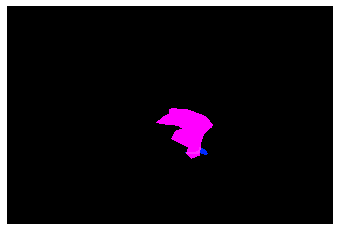

(427, 640, 3)
COCO_val2014_000000134193.jpg
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [8.34, 139.95, 171.72, 229.56]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [121.74, 123.3, 146.04999999999998, 148.75]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'hold', 'object': {'obj_bbx': [8.34, 139.95, 171.72, 229.56]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'look', 'object': {'obj_bbx': [121.74, 123.3, 146.04999999999998, 148.75]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 11.92, 296.0, 352.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


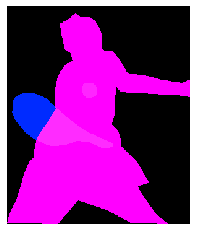

(352, 296, 3)
COCO_val2014_000000509471.jpg
{'person_bbx': [209.22, 177.73, 439.78999999999996, 426.81], 'Verbs': 'catch', 'object': {'obj_bbx': [207.88, 253.36, 271.56, 298.03000000000003]}}
person
frisbee
catch
catch interaction
{'person_bbx': [209.22, 177.73, 439.78999999999996, 426.81], 'Verbs': 'hold', 'object': {'obj_bbx': [207.88, 253.36, 271.56, 298.03000000000003]}}
person
frisbee
hold
hold interaction
{'person_bbx': [209.22, 177.73, 439.78999999999996, 426.81], 'Verbs': 'look', 'object': {'obj_bbx': [207.88, 253.36, 271.56, 298.03000000000003]}}
person
frisbee
look
look interaction
{'person_bbx': [209.22, 177.73, 439.78999999999996, 426.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


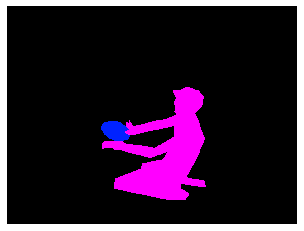

(480, 640, 3)
COCO_val2014_000000293811.jpg
{'person_bbx': [393.3, 175.74, 474.32, 250.08], 'Verbs': 'catch', 'object': {'obj_bbx': [412.72, 265.59, 418.70000000000005, 270.34999999999997]}}
sports ball
person
catch
catch interaction
{'person_bbx': [124.06, 265.43, 170.22, 358.72], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [77.12, 244.79, 123.29, 273.06]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [124.06, 265.43, 170.22, 358.72], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [412.72, 265.59, 418.70000000000005, 270.34999999999997]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [124.06, 265.43, 170.22, 358.72], 'Verbs': 'hold', 'object': {'obj_bbx': [77.12, 244.79, 123.29, 273.06]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [90.07, 296.75, 137.6, 395.06], 'Verbs': 'look', 'object': {'obj_bbx': [124.06, 265.43, 170.22, 358.72]}}
person
person
look
look interaction
{'person_bbx': [124.06, 265.43, 170.22, 358.72], 'Verbs': 'look', 'ob

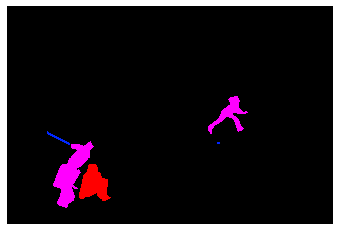

(427, 640, 3)
COCO_val2014_000000170436.jpg
{'person_bbx': [137.09, 84.36, 465.76, 479.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [126.49, 186.49, 299.46, 381.08000000000004]}}
person
laptop
hold
hold interaction
{'person_bbx': [363.32, 48.67, 640.0, 463.49], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.09, 84.36, 465.76, 479.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [126.49, 186.49, 299.46, 381.08000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [137.09, 84.36, 465.76, 479.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [172.37, 313.71, 457.35, 480.0]}}
chair
person
sit
sit interaction
{'person_bbx': [363.32, 48.67, 640.0, 463.49], 'Verbs': 'sit', 'object': {'obj_bbx': [435.05, 269.09, 640.0, 465.67999999999995]}}
person
chair
sit
sit interaction
{'person_bbx': [137.09, 84.36, 465.76, 479.33000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [126.49, 186.49, 299.46, 381.08000000000004]}}
pe

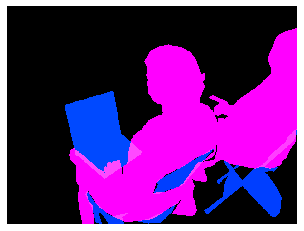

(480, 640, 3)
COCO_val2014_000000127451.jpg
{'person_bbx': [408.12, 76.13, 619.48, 378.7], 'Verbs': 'look', 'object': {'obj_bbx': [386.35, 353.42, 596.4300000000001, 384.19]}}
person
snowboard
look
look interaction
{'person_bbx': [1.14, 103.62, 265.31, 424.72], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [408.12, 76.13, 619.48, 378.7], 'Verbs': 'snowboard', 'object': {'obj_bbx': [386.35, 353.42, 596.4300000000001, 384.19]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [1.14, 103.62, 265.31, 424.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [408.12, 76.13, 619.48, 378.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


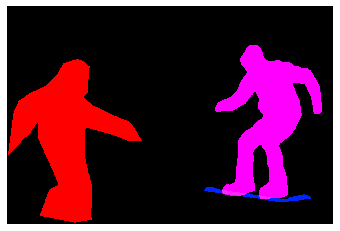

(427, 640, 3)
COCO_val2014_000000038753.jpg
{'person_bbx': [96.91, 1.92, 403.97, 363.67], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [292.66, 378.06, 534.47, 418.36]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [96.91, 1.92, 403.97, 363.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [96.91, 1.92, 403.97, 363.67], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 356.4, 563.6, 422.32]}}
person
dining table
look
look interaction
{'person_bbx': [96.91, 1.92, 403.97, 363.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


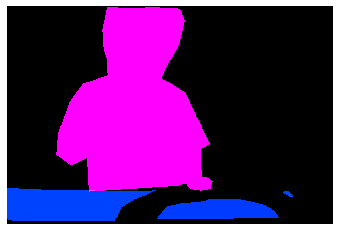

(427, 640, 3)
COCO_val2014_000000341719.jpg
{'person_bbx': [310.65, 256.72, 362.42999999999995, 380.76000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [522.08, 305.99, 598.47, 412.06], 'Verbs': 'hold', 'object': {'obj_bbx': [543.54, 296.46, 589.6899999999999, 409.08]}}
person
snowboard
hold
hold interaction
{'person_bbx': [310.65, 256.72, 362.42999999999995, 380.76000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [310.65, 256.72, 362.42999999999995, 380.76000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': [294.8, 357.21, 372.56, 384.63]}}
person
skis
ski
ski interaction
{'person_bbx': [522.08, 305.99, 598.47, 412.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [543.54, 296.46, 589.6899999999999, 409.08]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [310.65, 256.72, 362.42999999999995, 380.76000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [522.08, 305.9

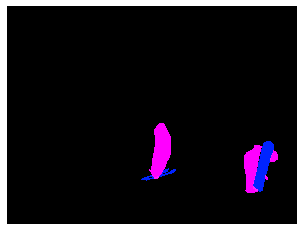

(480, 640, 3)
COCO_val2014_000000417727.jpg
{'person_bbx': [429.53, 73.07, 500.0, 273.57], 'Verbs': 'hold', 'object': {'obj_bbx': [441.56, 90.43, 467.03, 135.16]}}
person
cell phone
hold
hold interaction
{'person_bbx': [429.53, 73.07, 500.0, 273.57], 'Verbs': 'sit', 'object': {'obj_bbx': [481.05, 299.02, 499.75, 334.42999999999995]}}
person
chair
sit
sit interaction
{'person_bbx': [429.53, 73.07, 500.0, 273.57], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [329.49, 91.85, 471.07000000000005, 241.85]}}
person
laptop
work_on_computer
work_on_computer interaction


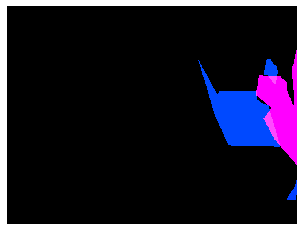

(375, 500, 3)
COCO_val2014_000000279846.jpg
{'person_bbx': [0.0, 0.81, 430.92, 321.97], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [313.67, 51.54, 372.01, 79.72]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.81, 430.92, 321.97], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [114.38, 85.99, 537.04, 355.32]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 0.81, 430.92, 321.97], 'Verbs': 'hold', 'object': {'obj_bbx': [313.67, 51.54, 372.01, 79.72]}}
person
knife
hold
hold interaction


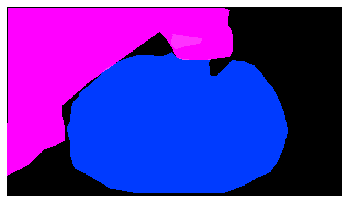

(361, 640, 3)
COCO_val2014_000000547866.jpg
{'person_bbx': [256.2, 102.91, 335.84, 396.53], 'Verbs': 'catch', 'object': {'obj_bbx': [401.24, 62.37, 449.67, 91.58]}}
person
frisbee
catch
catch interaction
{'person_bbx': [295.54, 56.61, 402.05, 420.28000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': [401.24, 62.37, 449.67, 91.58]}}
person
frisbee
catch
catch interaction
{'person_bbx': [256.2, 102.91, 335.84, 396.53], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [295.54, 56.61, 402.05, 420.28000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [256.2, 102.91, 335.84, 396.53], 'Verbs': 'look', 'object': {'obj_bbx': [401.24, 62.37, 449.67, 91.58]}}
person
frisbee
look
look interaction
{'person_bbx': [295.54, 56.61, 402.05, 420.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [401.24, 62.37, 449.67, 91.58]}}
person
frisbee
look
look interaction
{'person_bbx': [256.2, 102.91, 335.84, 396.53], 'Verbs': 'run', 'object': {'ob

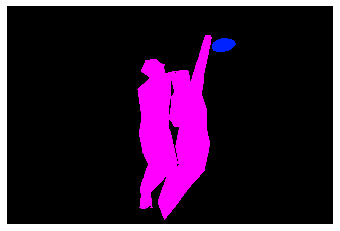

(427, 640, 3)
COCO_val2014_000000368242.jpg
{'person_bbx': [283.96, 377.66, 384.86, 614.05], 'Verbs': 'look', 'object': {'obj_bbx': [155.58, 137.56, 346.35, 348.46000000000004]}}
person
kite
look
look interaction
{'person_bbx': [283.96, 377.66, 384.86, 614.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


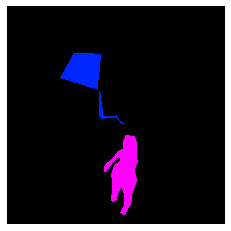

(640, 640, 3)
COCO_val2014_000000057645.jpg
{'person_bbx': [156.13, 110.18, 209.87, 265.17], 'Verbs': 'carry', 'object': {'obj_bbx': [131.43, 91.03, 220.43, 130.57999999999998]}}
umbrella
person
carry
carry interaction
{'person_bbx': [156.13, 110.18, 209.87, 265.17], 'Verbs': 'hold', 'object': {'obj_bbx': [131.43, 91.03, 220.43, 130.57999999999998]}}
umbrella
person
hold
hold interaction
{'person_bbx': [156.13, 110.18, 209.87, 265.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [156.13, 110.18, 209.87, 265.17], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


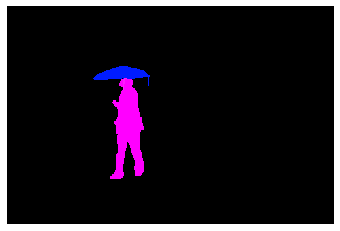

(333, 500, 3)
COCO_val2014_000000344005.jpg
{'person_bbx': [125.03, 64.44, 441.47, 422.23], 'Verbs': 'catch', 'object': {'obj_bbx': [297.74, 82.84, 356.76, 118.37]}}
person
frisbee
catch
catch interaction
{'person_bbx': [125.03, 64.44, 441.47, 422.23], 'Verbs': 'look', 'object': {'obj_bbx': [297.74, 82.84, 356.76, 118.37]}}
person
frisbee
look
look interaction
{'person_bbx': [125.03, 64.44, 441.47, 422.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [125.03, 64.44, 441.47, 422.23], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


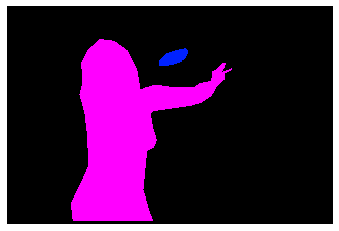

(428, 640, 3)
COCO_val2014_000000346577.jpg
{'person_bbx': [273.65, 194.79, 392.33, 370.89], 'Verbs': 'look', 'object': {'obj_bbx': [171.34, 351.77, 348.42, 379.53]}}
person
surfboard
look
look interaction
{'person_bbx': [273.65, 194.79, 392.33, 370.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.65, 194.79, 392.33, 370.89], 'Verbs': 'surf', 'object': {'obj_bbx': [171.34, 351.77, 348.42, 379.53]}}
person
surfboard
surf
surf interaction


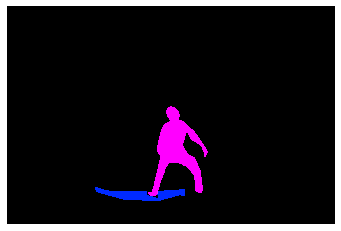

(425, 640, 3)
COCO_val2014_000000464200.jpg
{'person_bbx': [18.87, 1.99, 330.76, 442.01], 'Verbs': 'hold', 'object': {'obj_bbx': [253.85, 233.94, 350.41999999999996, 261.82]}}
person
frisbee
hold
hold interaction
{'person_bbx': [18.87, 1.99, 330.76, 442.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [18.87, 1.99, 330.76, 442.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [18.87, 1.99, 330.76, 442.01], 'Verbs': 'throw', 'object': {'obj_bbx': [253.85, 233.94, 350.41999999999996, 261.82]}}
person
frisbee
throw
throw interaction


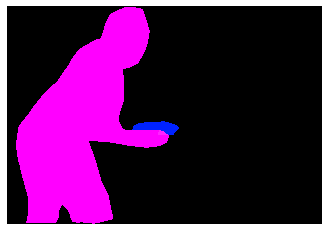

(443, 640, 3)
COCO_val2014_000000263969.jpg
{'person_bbx': [220.2, 145.14, 458.17999999999995, 599.22], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [153.71, 441.07, 244.2, 474.68]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [220.2, 145.14, 458.17999999999995, 599.22], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [82.25, 460.58, 249.48, 601.78]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [224.81, 57.57, 638.79, 600.4000000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [153.71, 441.07, 244.2, 474.68]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [224.81, 57.57, 638.79, 600.4000000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [82.25, 460.58, 249.48, 601.78]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [220.2, 145.14, 458.17999999999995, 599.22], 'Verbs': 'hold', 'object': {'obj_bbx': [153.71, 441.07, 244.2, 474.68]}}
person
knife
hold
hold interaction
{'person_bbx': [224.81, 57.57, 638.79, 600.4000000000001], 'Verbs': 'hol

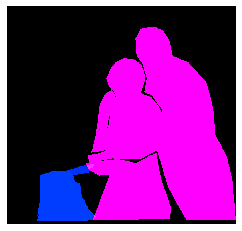

(610, 640, 3)
COCO_val2014_000000426165.jpg
{'person_bbx': [88.39, 192.46, 450.56, 381.09000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 127.78, 500.98, 424.34000000000003]}}
bed
person
lay
lay interaction
{'person_bbx': [372.59, 164.28, 585.18, 347.98], 'Verbs': 'lay', 'object': {'obj_bbx': [304.2, 89.14, 636.26, 421.2]}}
person
bed
lay
lay interaction
{'person_bbx': [88.39, 192.46, 450.56, 381.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [372.59, 164.28, 585.18, 347.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


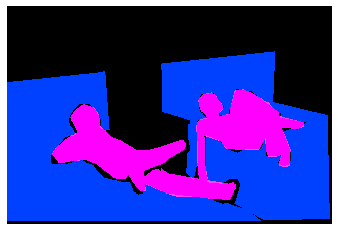

(429, 640, 3)
COCO_val2014_000000212853.jpg
{'person_bbx': [1.45, 68.21, 480.0, 626.94], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [1.44, 362.52, 427.15, 631.47]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [1.45, 68.21, 480.0, 626.94], 'Verbs': 'hold', 'object': {'obj_bbx': [1.44, 362.52, 427.15, 631.47]}}
person
pizza
hold
hold interaction
{'person_bbx': [1.45, 68.21, 480.0, 626.94], 'Verbs': 'look', 'object': {'obj_bbx': [1.44, 362.52, 427.15, 631.47]}}
person
pizza
look
look interaction
{'person_bbx': [1.45, 68.21, 480.0, 626.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.45, 68.21, 480.0, 626.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


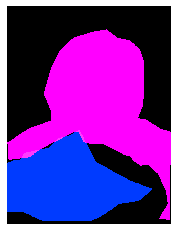

(640, 480, 3)
COCO_val2014_000000225108.jpg
{'person_bbx': [36.68, 462.0, 140.94, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [199.67, 67.38, 274.27, 216.04]}}
person
kite
hold
hold interaction
{'person_bbx': [36.68, 462.0, 140.94, 640.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [36.68, 462.0, 140.94, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [36.68, 462.0, 140.94, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


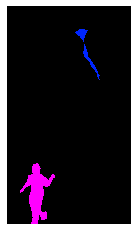

(640, 364, 3)
COCO_val2014_000000397658.jpg
{'person_bbx': [241.49, 11.55, 525.0, 479.0], 'Verbs': 'hold', 'object': {'obj_bbx': [325.09, 101.38, 350.64, 137.35]}}
person
cell phone
hold
hold interaction
{'person_bbx': [241.49, 11.55, 525.0, 479.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.49, 11.55, 525.0, 479.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [325.09, 101.38, 350.64, 137.35]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


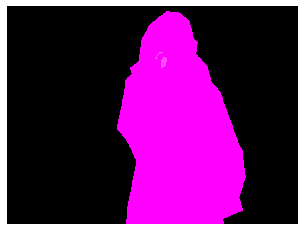

(479, 640, 3)
COCO_val2014_000000492057.jpg
{'person_bbx': [38.74, 152.28, 355.87, 630.12], 'Verbs': 'hold', 'object': {'obj_bbx': [225.73, 228.96, 273.68, 291.4]}}
cell phone
person
hold
hold interaction
{'person_bbx': [38.74, 152.28, 355.87, 630.12], 'Verbs': 'look', 'object': {'obj_bbx': [225.73, 228.96, 273.68, 291.4]}}
cell phone
person
look
look interaction
{'person_bbx': [38.74, 152.28, 355.87, 630.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


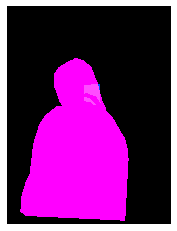

(640, 480, 3)
COCO_val2014_000000578427.jpg
{'person_bbx': [109.69, 96.58, 365.95, 613.0300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [109.69, 96.58, 365.95, 613.0300000000001], 'Verbs': 'ski', 'object': {'obj_bbx': [204.3, 599.57, 296.70000000000005, 640.0]}}
person
skis
ski
ski interaction
{'person_bbx': [109.69, 96.58, 365.95, 613.0300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


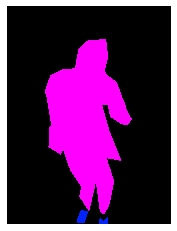

(640, 480, 3)
COCO_val2014_000000113571.jpg
{'person_bbx': [1.07, 1.18, 418.79, 470.44], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [170.79, 113.65, 370.07, 211.91000000000003]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.07, 1.18, 418.79, 470.44], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [379.51, 194.76, 483.78, 267.31]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.07, 1.18, 418.79, 470.44], 'Verbs': 'hold', 'object': {'obj_bbx': [170.79, 113.65, 370.07, 211.91000000000003]}}
person
knife
hold
hold interaction
{'person_bbx': [1.07, 1.18, 418.79, 470.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


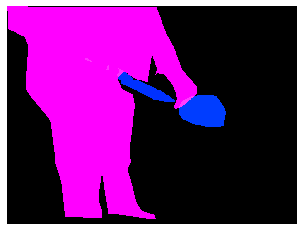

(480, 640, 3)
COCO_val2014_000000476709.jpg
{'person_bbx': [242.87, 224.21, 320.1, 356.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [242.87, 224.21, 320.1, 356.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [166.47, 337.74, 453.90999999999997, 367.68]}}
surfboard
person
look
look interaction
{'person_bbx': [242.87, 224.21, 320.1, 356.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.87, 224.21, 320.1, 356.90999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [166.47, 337.74, 453.90999999999997, 367.68]}}
surfboard
person
surf
surf interaction


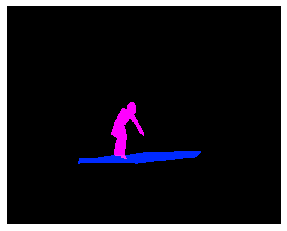

(509, 640, 3)
COCO_val2014_000000149903.jpg
{'person_bbx': [172.58, 163.72, 333.66, 461.41999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [112.89, 271.82, 266.62, 342.4]}}
person
surfboard
carry
carry interaction
{'person_bbx': [172.58, 163.72, 333.66, 461.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [112.89, 271.82, 266.62, 342.4]}}
person
surfboard
hold
hold interaction


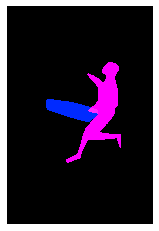

(640, 427, 3)
COCO_val2014_000000376793.jpg
{'person_bbx': [367.3, 213.32, 446.92, 241.85999999999999], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


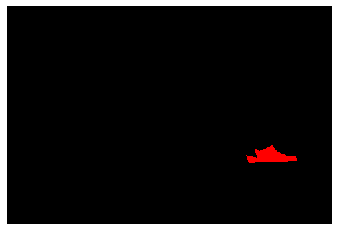

(335, 500, 3)
COCO_val2014_000000138517.jpg
{'person_bbx': [218.19, 21.91, 573.5899999999999, 417.33000000000004], 'Verbs': 'drink', 'object': {'obj_bbx': [196.35, 210.67, 318.71, 356.74]}}
person
wine glass
drink
drink interaction
{'person_bbx': [218.19, 21.91, 573.5899999999999, 417.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [196.35, 210.67, 318.71, 356.74]}}
person
wine glass
hold
hold interaction
{'person_bbx': [218.19, 21.91, 573.5899999999999, 417.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [196.35, 210.67, 318.71, 356.74]}}
person
wine glass
look
look interaction
{'person_bbx': [218.19, 21.91, 573.5899999999999, 417.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


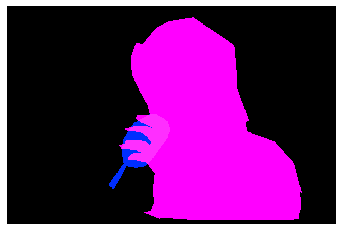

(424, 640, 3)
COCO_val2014_000000414673.jpg
{'person_bbx': [161.15, 129.07, 249.93, 254.41], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [130.31, 170.08, 166.36, 192.16000000000003]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [161.15, 129.07, 249.93, 254.41], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [252.62, 215.22, 262.5, 224.16]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [161.15, 129.07, 249.93, 254.41], 'Verbs': 'hold', 'object': {'obj_bbx': [130.31, 170.08, 166.36, 192.16000000000003]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [79.54, 93.68, 118.17000000000002, 188.65], 'Verbs': 'hold', 'object': {'obj_bbx': [90.67, 137.22, 104.34, 155.23]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [289.9, 62.52, 342.47999999999996, 185.33], 'Verbs': 'look', 'object': {'obj_bbx': [161.15, 129.07, 249.93, 254.41]}}
person
person
look
look interaction
{'person_bbx': [161.15, 129.07, 249.93, 254.41], 'Verbs': 'look', 'obj

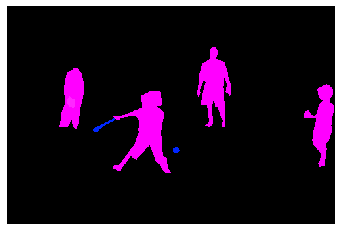

(332, 500, 3)
COCO_val2014_000000116083.jpg
{'person_bbx': [218.01, 169.73, 337.82, 369.08], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [442.52, 68.82, 539.56, 335.46999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [401.32, 208.31, 464.59, 312.18]}}
person
suitcase
carry
carry interaction
{'person_bbx': [303.6, 163.82, 375.62, 375.19], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [183.08, 97.43, 279.49, 330.04], 'Verbs': 'carry', 'object': {'obj_bbx': [186.06, 225.54, 206.32, 285.26]}}
person
suitcase
carry
carry interaction
{'person_bbx': [218.01, 169.73, 337.82, 369.08], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [442.52, 68.82, 539.56, 335.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [401.32, 208.31, 464.59, 312.18]}}
person
suitcase
hold
hold interaction
{'person_bbx': [303.6, 163.82, 375.62, 375.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [183.08, 

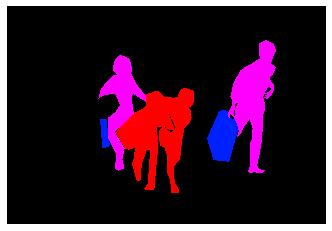

(437, 640, 3)
COCO_val2014_000000398063.jpg
{'person_bbx': [184.5, 148.41, 428.02, 382.07], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [212.5, 120.56, 558.5699999999999, 323.52], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [184.5, 148.41, 428.02, 382.07], 'Verbs': 'look', 'object': {'obj_bbx': [212.5, 120.56, 558.5699999999999, 323.52]}}
person
person
look
look interaction
{'person_bbx': [212.5, 120.56, 558.5699999999999, 323.52], 'Verbs': 'look', 'object': {'obj_bbx': [184.5, 148.41, 428.02, 382.07]}}
person
person
look
look interaction


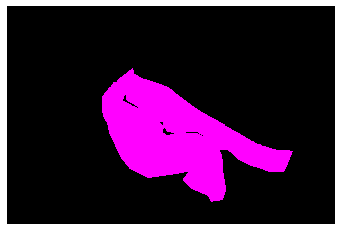

(425, 640, 3)
COCO_val2014_000000544471.jpg
{'person_bbx': [8.01, 35.11, 359.15999999999997, 509.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [313.41, 16.97, 626.81, 503.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [8.01, 35.11, 359.15999999999997, 509.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [313.41, 16.97, 626.81, 503.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


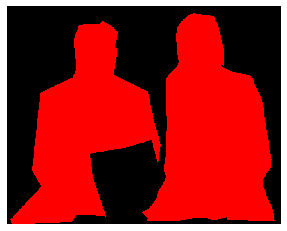

(509, 640, 3)
COCO_val2014_000000463865.jpg
{'person_bbx': [353.3, 312.22, 594.33, 476.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [160.72, 74.43, 640.0, 457.35]}}
person
laptop
work_on_computer
work_on_computer interaction


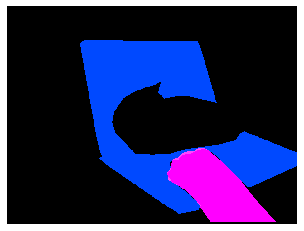

(480, 640, 3)
COCO_val2014_000000576305.jpg
{'person_bbx': [20.06, 90.84, 555.9599999999999, 413.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [20.06, 90.84, 555.9599999999999, 413.72], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 1.06, 640.0, 427.0]}}
person
bench
lay
lay interaction
{'person_bbx': [20.06, 90.84, 555.9599999999999, 413.72], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


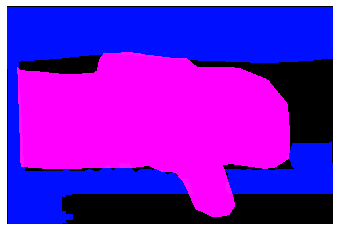

(427, 640, 3)
COCO_val2014_000000365220.jpg
{'person_bbx': [290.72, 143.8, 410.64000000000004, 230.89000000000001], 'Verbs': 'jump', 'object': {'obj_bbx': [404.36, 176.82, 429.12, 232.98]}}
person
skateboard
jump
jump interaction
{'person_bbx': [446.99, 174.14, 560.95, 288.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [290.72, 143.8, 410.64000000000004, 230.89000000000001]}}
person
person
look
look interaction
{'person_bbx': [290.72, 143.8, 410.64000000000004, 230.89000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [404.36, 176.82, 429.12, 232.98]}}
person
skateboard
look
look interaction
{'person_bbx': [584.77, 91.37, 637.67, 285.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [446.99, 174.14, 560.95, 288.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [290.72, 143.8, 410.64000000000004, 230.89000000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [404.36, 176.82, 429.12, 232.98]}}
person
skateboard
s

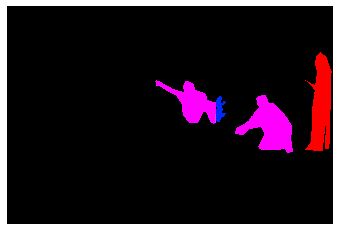

(428, 640, 3)
COCO_val2014_000000153455.jpg
{'person_bbx': [88.84, 8.82, 320.06, 277.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [305.89, 74.01, 319.25, 96.39]}}
person
remote
hold
hold interaction
{'person_bbx': [0.0, 27.4, 117.88, 276.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [108.59, 57.4, 132.69, 83.21]}}
person
remote
hold
hold interaction
{'person_bbx': [88.84, 8.82, 320.06, 277.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [345.07, 98.79, 476.37, 241.51]}}
tv
person
look
look interaction
{'person_bbx': [0.0, 27.4, 117.88, 276.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [345.07, 98.79, 476.37, 241.51]}}
tv
person
look
look interaction
{'person_bbx': [0.0, 27.4, 117.88, 276.53999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [88.84, 8.82, 320.06, 277.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 27.4, 117.88, 276.53999999999996], 'Verbs': 'stand',

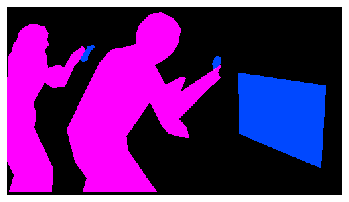

(281, 500, 3)
COCO_val2014_000000015994.jpg
{'person_bbx': [57.27, 126.95, 480.0, 632.36], 'Verbs': 'hold', 'object': {'obj_bbx': [161.21, 271.15, 229.21, 352.44]}}
person
cell phone
hold
hold interaction
{'person_bbx': [57.27, 126.95, 480.0, 632.36], 'Verbs': 'sit', 'object': {'obj_bbx': [1.38, 64.69, 478.96999999999997, 633.1199999999999]}}
couch
person
sit
sit interaction
{'person_bbx': [57.27, 126.95, 480.0, 632.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [57.27, 126.95, 480.0, 632.36], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [161.21, 271.15, 229.21, 352.44]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


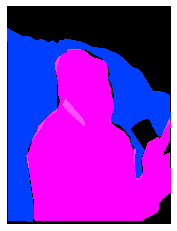

(640, 480, 3)
COCO_val2014_000000531244.jpg
{'person_bbx': [349.05, 27.17, 638.74, 393.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [490.85, 282.2, 541.39, 356.89]}}
person
cup
hold
hold interaction
{'person_bbx': [1.78, 10.78, 507.23999999999995, 390.76], 'Verbs': 'look', 'object': {'obj_bbx': [349.05, 27.17, 638.74, 393.34000000000003]}}
person
person
look
look interaction
{'person_bbx': [349.05, 27.17, 638.74, 393.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [490.85, 282.2, 541.39, 356.89]}}
person
cup
look
look interaction
{'person_bbx': [1.78, 10.78, 507.23999999999995, 390.76], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 103.9, 508.41, 391.74]}}
couch
person
sit
sit interaction
{'person_bbx': [349.05, 27.17, 638.74, 393.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 103.9, 508.41, 391.74]}}
couch
person
sit
sit interaction
{'person_bbx': [1.78, 10.78, 507.23999999999995, 390.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


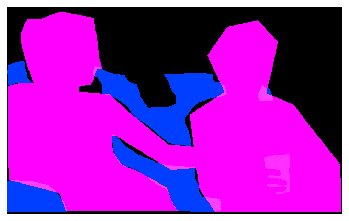

(396, 640, 3)
COCO_val2014_000000477906.jpg
{'person_bbx': [303.16, 53.98, 436.39, 306.8], 'Verbs': 'jump', 'object': {'obj_bbx': [258.03, 216.07, 435.68999999999994, 326.44]}}
snowboard
person
jump
jump interaction
{'person_bbx': [303.16, 53.98, 436.39, 306.8], 'Verbs': 'look', 'object': {'obj_bbx': [258.03, 216.07, 435.68999999999994, 326.44]}}
snowboard
person
look
look interaction
{'person_bbx': [303.16, 53.98, 436.39, 306.8], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [303.16, 53.98, 436.39, 306.8], 'Verbs': 'snowboard', 'object': {'obj_bbx': [258.03, 216.07, 435.68999999999994, 326.44]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [303.16, 53.98, 436.39, 306.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


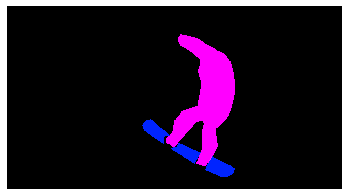

(349, 640, 3)
COCO_val2014_000000270474.jpg
{'person_bbx': [190.03, 11.82, 327.7, 370.78], 'Verbs': 'hold', 'object': {'obj_bbx': [287.81, 126.76, 481.65999999999997, 238.5]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [190.03, 11.82, 327.7, 370.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [190.03, 11.82, 327.7, 370.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


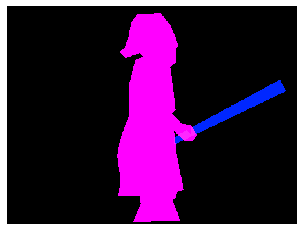

(375, 500, 3)
COCO_val2014_000000345979.jpg
{'person_bbx': [148.85, 103.37, 590.02, 475.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [148.85, 103.37, 590.02, 475.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


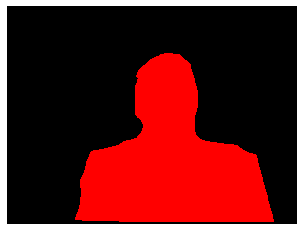

(480, 640, 3)
COCO_val2014_000000332582.jpg
{'person_bbx': [159.58, 377.35, 344.1, 631.69], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [159.58, 377.35, 344.1, 631.69], 'Verbs': 'snowboard', 'object': {'obj_bbx': [91.13, 540.13, 260.15, 640.0]}}
snowboard
person
snowboard
snowboard interaction


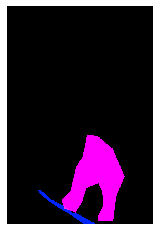

(640, 427, 3)
COCO_val2014_000000411768.jpg
{'person_bbx': [169.08, 96.67, 500.6, 640.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [15.78, 0.17, 212.38, 140.79999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [169.08, 96.67, 500.6, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [15.78, 0.17, 212.38, 140.79999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [169.08, 96.67, 500.6, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


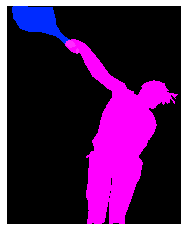

(640, 510, 3)
COCO_val2014_000000482735.jpg
{'person_bbx': [188.25, 112.13, 249.41, 228.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [188.25, 112.13, 249.41, 228.05], 'Verbs': 'surf', 'object': {'obj_bbx': [198.18, 198.32, 273.12, 238.54999999999998]}}
person
surfboard
surf
surf interaction


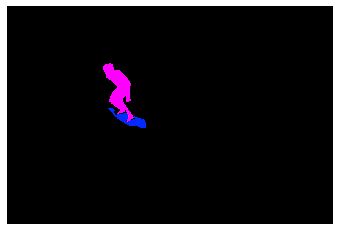

(427, 640, 3)
COCO_val2014_000000139555.jpg
{'person_bbx': [192.88, 75.98, 320.0, 403.29], 'Verbs': 'hold', 'object': {'obj_bbx': [21.57, 189.6, 427.0, 631.13]}}
person
elephant
hold
hold interaction
{'person_bbx': [192.88, 75.98, 320.0, 403.29], 'Verbs': 'ride', 'object': {'obj_bbx': [21.57, 189.6, 427.0, 631.13]}}
person
elephant
ride
ride interaction
{'person_bbx': [99.24, 107.63, 198.47, 395.27], 'Verbs': 'ride', 'object': {'obj_bbx': [21.57, 189.6, 427.0, 631.13]}}
person
elephant
ride
ride interaction
{'person_bbx': [192.88, 75.98, 320.0, 403.29], 'Verbs': 'sit', 'object': {'obj_bbx': [21.57, 189.6, 427.0, 631.13]}}
person
elephant
sit
sit interaction
{'person_bbx': [99.24, 107.63, 198.47, 395.27], 'Verbs': 'sit', 'object': {'obj_bbx': [21.57, 189.6, 427.0, 631.13]}}
person
elephant
sit
sit interaction
{'person_bbx': [192.88, 75.98, 320.0, 403.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [99.24, 107.63, 198.47, 395.27], 'Verbs': 'smile', 'object':

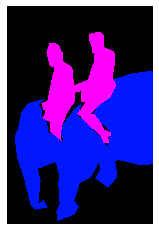

(640, 427, 3)
COCO_val2014_000000454143.jpg
{'person_bbx': [149.57, 56.09, 385.44, 612.6700000000001], 'Verbs': 'carry', 'object': {'obj_bbx': [59.12, 352.18, 213.12, 518.7]}}
person
suitcase
carry
carry interaction
{'person_bbx': [149.57, 56.09, 385.44, 612.6700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [59.12, 352.18, 213.12, 518.7]}}
person
suitcase
hold
hold interaction
{'person_bbx': [149.57, 56.09, 385.44, 612.6700000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [149.57, 56.09, 385.44, 612.6700000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [149.57, 56.09, 385.44, 612.6700000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


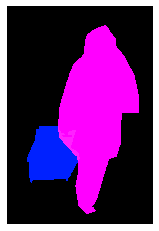

(640, 427, 3)
COCO_val2014_000000267123.jpg
{'person_bbx': [5.3, 112.42, 174.99, 449.67], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 30.42, 71.71, 295.07]}}
person
skis
hold
hold interaction
{'person_bbx': [161.56, 103.1, 286.99, 402.85], 'Verbs': 'hold', 'object': {'obj_bbx': [161.86, 80.13, 183.89000000000001, 340.8]}}
person
skis
hold
hold interaction
{'person_bbx': [220.61, 153.1, 306.82, 400.86], 'Verbs': 'hold', 'object': {'obj_bbx': [212.62, 212.98, 252.04000000000002, 443.1]}}
person
skis
hold
hold interaction
{'person_bbx': [430.72, 160.92, 531.73, 405.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [450.36, 191.89, 469.01, 381.34]}}
person
skis
hold
hold interaction
{'person_bbx': [161.56, 103.1, 286.99, 402.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [5.3, 112.42, 174.99, 449.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.56, 103.1, 286.99, 402.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pe

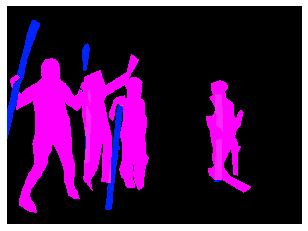

(473, 640, 3)
COCO_val2014_000000135604.jpg
{'person_bbx': [455.26, 38.09, 554.71, 338.16999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [424.94, 283.84, 465.15999999999997, 319.98999999999995]}}
sports ball
person
kick
kick interaction
{'person_bbx': [455.26, 38.09, 554.71, 338.16999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [455.26, 38.09, 554.71, 338.16999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


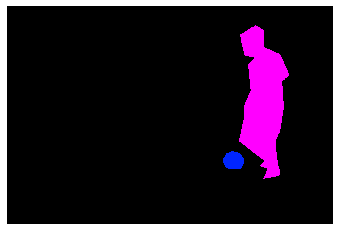

(427, 640, 3)
COCO_val2014_000000156497.jpg
{'person_bbx': [188.09, 158.0, 309.61, 299.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [241.61, 206.78, 302.94, 261.29]}}
person
laptop
hold
hold interaction
{'person_bbx': [188.09, 158.0, 309.61, 299.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [241.61, 206.78, 302.94, 261.29]}}
person
laptop
look
look interaction
{'person_bbx': [188.09, 158.0, 309.61, 299.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [125.67, 203.54, 471.76, 345.67999999999995]}}
couch
person
sit
sit interaction
{'person_bbx': [188.09, 158.0, 309.61, 299.15999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [241.61, 206.78, 302.94, 261.29]}}
person
laptop
work_on_computer
work_on_computer interaction


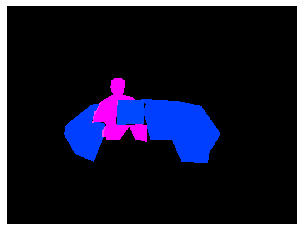

(480, 640, 3)
COCO_val2014_000000442417.jpg
{'person_bbx': [62.92, 149.41, 388.42, 374.32], 'Verbs': 'hold', 'object': {'obj_bbx': [274.72, 249.18, 311.8, 360.42]}}
cell phone
person
hold
hold interaction
{'person_bbx': [62.92, 149.41, 388.42, 374.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [62.92, 149.41, 388.42, 374.32], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [274.72, 249.18, 311.8, 360.42]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


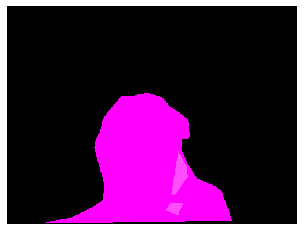

(375, 500, 3)
COCO_val2014_000000327255.jpg
{'person_bbx': [283.08, 142.08, 377.25, 399.65999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [267.18, 355.23, 411.25, 415.95000000000005]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [283.08, 142.08, 377.25, 399.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


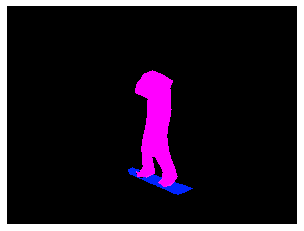

(480, 640, 3)
COCO_val2014_000000485909.jpg
{'person_bbx': [0.95, 122.08, 284.0, 419.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [394.48, 22.92, 640.0, 421.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.95, 122.08, 284.0, 419.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [394.48, 22.92, 640.0, 421.22]}}
person
person
look
look interaction
{'person_bbx': [0.95, 122.08, 284.0, 419.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [394.48, 22.92, 640.0, 421.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.95, 122.08, 284.0, 419.41999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [252.55, 208.39, 379.3, 320.84999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


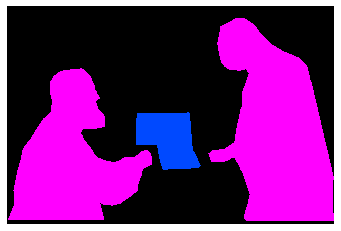

(426, 640, 3)
COCO_val2014_000000013081.jpg
{'person_bbx': [405.54, 21.04, 594.23, 236.67999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [481.08, 197.39, 640.0, 273.98]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 16.84, 236.23, 319.63], 'Verbs': 'look', 'object': {'obj_bbx': [43.66, 291.71, 238.46, 389.11]}}
laptop
person
look
look interaction
{'person_bbx': [405.54, 21.04, 594.23, 236.67999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [396.94, 150.9, 417.44, 223.28]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 16.84, 236.23, 319.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [405.54, 21.04, 594.23, 236.67999999999998], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [481.08, 197.39, 640.0, 273.98]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [0.0, 16.84, 236.23, 319.63], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [43.66, 291.71, 238.46, 389.11]}}
laptop
person
work_on_computer
wor

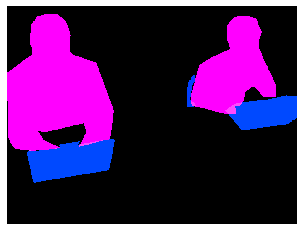

(480, 640, 3)
COCO_val2014_000000064059.jpg
{'person_bbx': [74.05, 48.57, 186.57, 321.69], 'Verbs': 'look', 'object': {'obj_bbx': [451.47, 132.45, 495.74, 147.73999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [256.96, 74.97, 423.45, 307.5], 'Verbs': 'look', 'object': {'obj_bbx': [451.47, 132.45, 495.74, 147.73999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [74.05, 48.57, 186.57, 321.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [256.96, 74.97, 423.45, 307.5], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [74.05, 48.57, 186.57, 321.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [256.96, 74.97, 423.45, 307.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.05, 48.57, 186.57, 321.69], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw
{'person_bbx': [256.96, 74.97, 423.45, 307.5], 'Verbs': 'throw', 'object': {'obj_bbx': [451.47, 132

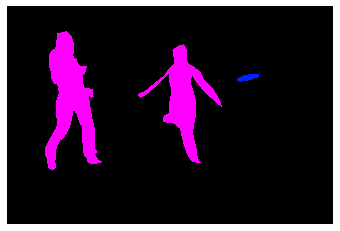

(427, 640, 3)
COCO_val2014_000000150508.jpg
{'person_bbx': [304.2, 21.26, 563.6700000000001, 366.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [423.04, 156.68, 484.02000000000004, 195.54000000000002]}}
person
book
hold
hold interaction
{'person_bbx': [304.2, 21.26, 563.6700000000001, 366.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [423.04, 156.68, 484.02000000000004, 195.54000000000002]}}
person
book
look
look interaction
{'person_bbx': [304.2, 21.26, 563.6700000000001, 366.53999999999996], 'Verbs': 'read', 'object': {'obj_bbx': [423.04, 156.68, 484.02000000000004, 195.54000000000002]}}
person
book
read
read interaction
{'person_bbx': [304.2, 21.26, 563.6700000000001, 366.53999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [308.02, 207.1, 462.5, 312.65]}}
person
bench
sit
sit interaction


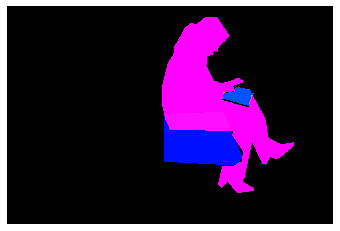

(427, 640, 3)
COCO_val2014_000000120771.jpg
{'person_bbx': [355.99, 124.74, 470.18, 326.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [355.99, 124.74, 470.18, 326.25], 'Verbs': 'surf', 'object': {'obj_bbx': [324.57, 298.04, 385.35, 341.09000000000003]}}
person
surfboard
surf
surf interaction


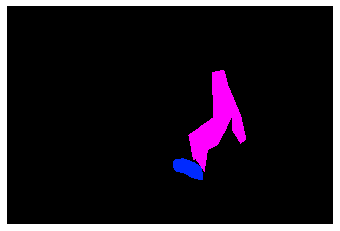

(427, 640, 3)
COCO_val2014_000000451345.jpg
{'person_bbx': [234.62, 81.74, 492.91, 477.79], 'Verbs': 'hold', 'object': {'obj_bbx': [282.84, 190.69, 337.35999999999996, 230.65]}}
person
book
hold
hold interaction
{'person_bbx': [234.62, 81.74, 492.91, 477.79], 'Verbs': 'look', 'object': {'obj_bbx': [282.84, 190.69, 337.35999999999996, 230.65]}}
person
book
look
look interaction
{'person_bbx': [234.62, 81.74, 492.91, 477.79], 'Verbs': 'sit', 'object': {'obj_bbx': [3.24, 345.17, 640.0, 480.0]}}
person
bench
sit
sit interaction


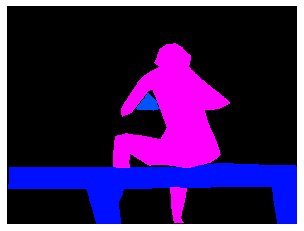

(480, 640, 3)
COCO_val2014_000000048332.jpg
{'person_bbx': [155.34, 63.26, 249.98000000000002, 218.37], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [179.72, 218.66, 234.28, 245.03]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [221.27, 70.15, 307.4, 288.74], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [114.01, 212.88, 275.6, 277.86]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [155.34, 63.26, 249.98000000000002, 218.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [221.27, 70.15, 307.4, 288.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [155.34, 63.26, 249.98000000000002, 218.37], 'Verbs': 'look', 'object': {'obj_bbx': [179.72, 218.66, 234.28, 245.03]}}
cake
person
look
look interaction
{'person_bbx': [221.27, 70.15, 307.4, 288.74], 'Verbs': 'look', 'object': {'obj_bbx': [179.72, 218.66, 234.28, 245.03]}}
cake
person
look
look interaction
{'person_bbx': [221.27, 70.15, 307.4, 288.74], 'Verbs': 'smile', 'object':

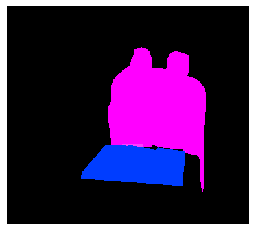

(336, 373, 3)
COCO_val2014_000000261732.jpg
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [288.73, 74.75, 392.83000000000004, 117.96000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [424.69, 146.59, 439.69, 159.69]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'hold', 'object': {'obj_bbx': [288.73, 74.75, 392.83000000000004, 117.96000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'look', 'object': {'obj_bbx': [424.69, 146.59, 439.69, 159.69]}}
sports ball
person
look
look interaction
{'person_bbx': [145.67, 43.37, 312.01, 355.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [145.67, 

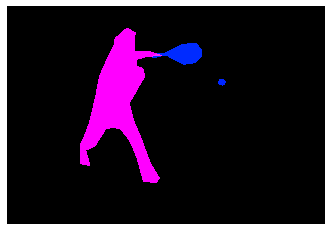

(438, 640, 3)
COCO_val2014_000000089027.jpg
{'person_bbx': [334.68, 97.39, 464.15, 354.26], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [131.0, 150.1, 237.0, 368.1], 'Verbs': 'look', 'object': {'obj_bbx': [336.78, 305.51, 366.28999999999996, 334.87]}}
sports ball
person
look
look interaction
{'person_bbx': [8.04, 147.66, 90.4, 331.48], 'Verbs': 'look', 'object': {'obj_bbx': [336.78, 305.51, 366.28999999999996, 334.87]}}
sports ball
person
look
look interaction
{'person_bbx': [559.5, 85.38, 640.0, 368.65], 'Verbs': 'look', 'object': {'obj_bbx': [336.78, 305.51, 366.28999999999996, 334.87]}}
sports ball
person
look
look interaction
{'person_bbx': [334.68, 97.39, 464.15, 354.26], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [131.0, 150.1, 237.0, 368.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [8.04, 147.66, 90.4, 331.48], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [334.68, 97.39, 464.

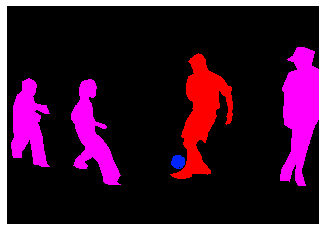

(447, 640, 3)
COCO_val2014_000000155774.jpg
{'person_bbx': [237.3, 103.55, 477.48, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [364.98, 526.45, 426.52000000000004, 623.9200000000001]}}
person
book
hold
hold interaction
{'person_bbx': [74.45, 160.5, 269.17, 630.12], 'Verbs': 'hold', 'object': {'obj_bbx': [51.91, 521.78, 167.31, 631.93]}}
person
handbag
hold
hold interaction
{'person_bbx': [237.3, 103.55, 477.48, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [74.45, 160.5, 269.17, 630.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [237.3, 103.55, 477.48, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.45, 160.5, 269.17, 630.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


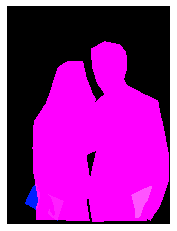

(640, 479, 3)
COCO_val2014_000000422017.jpg
{'person_bbx': [107.02, 254.49, 226.69, 368.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [107.02, 254.49, 226.69, 368.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


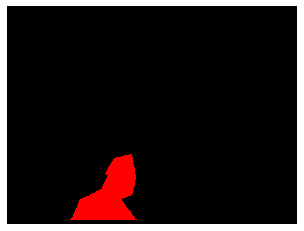

(375, 500, 3)
COCO_val2014_000000356358.jpg
{'person_bbx': [9.71, 316.04, 65.80000000000001, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [0.72, 356.05, 32.38, 415.04]}}
backpack
person
hold
hold interaction
{'person_bbx': [9.71, 316.04, 65.80000000000001, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [9.71, 316.04, 65.80000000000001, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [9.71, 316.04, 65.80000000000001, 474.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


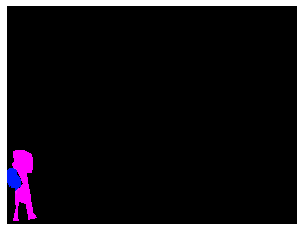

(480, 640, 3)
COCO_val2014_000000191874.jpg
{'person_bbx': [49.62, 170.43, 158.56, 473.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [180.44, 156.97, 284.23, 469.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [49.62, 170.43, 158.56, 473.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [615.53, 267.82, 640.0, 471.12]}}
person
tv
look
look interaction
{'person_bbx': [49.62, 170.43, 158.56, 473.53000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [180.44, 156.97, 284.23, 469.5], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [49.62, 170.43, 158.56, 473.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [180.44, 156.97, 284.23, 469.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


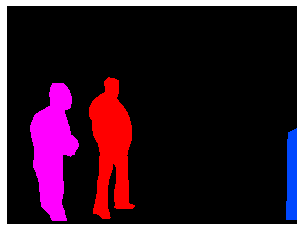

(480, 640, 3)
COCO_val2014_000000527480.jpg
{'person_bbx': [294.47, 81.71, 471.64, 232.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [294.47, 81.71, 471.64, 232.99], 'Verbs': 'surf', 'object': {'obj_bbx': [263.04, 200.34, 332.07000000000005, 238.41]}}
person
surfboard
surf
surf interaction


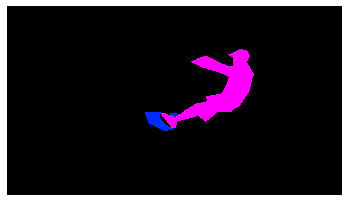

(360, 640, 3)
COCO_val2014_000000035062.jpg
{'person_bbx': [155.75, 68.69, 199.91, 106.91], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 58.15, 423.21, 640.0]}}
bed
person
lay
lay interaction


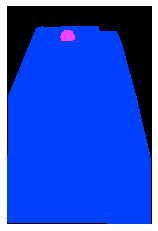

(640, 425, 3)
COCO_val2014_000000012147.jpg
{'person_bbx': [204.0, 51.8, 403.22, 337.08], 'Verbs': 'hold', 'object': {'obj_bbx': [203.11, 262.84, 369.89, 378.62]}}
skateboard
person
hold
hold interaction
{'person_bbx': [204.0, 51.8, 403.22, 337.08], 'Verbs': 'jump', 'object': {'obj_bbx': [203.11, 262.84, 369.89, 378.62]}}
skateboard
person
jump
jump interaction
{'person_bbx': [204.0, 51.8, 403.22, 337.08], 'Verbs': 'look', 'object': {'obj_bbx': [203.11, 262.84, 369.89, 378.62]}}
skateboard
person
look
look interaction
{'person_bbx': [204.0, 51.8, 403.22, 337.08], 'Verbs': 'skateboard', 'object': {'obj_bbx': [203.11, 262.84, 369.89, 378.62]}}
skateboard
person
skateboard
skateboard interaction


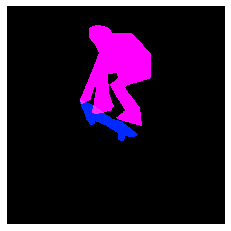

(612, 612, 3)
COCO_val2014_000000039211.jpg
{'person_bbx': [11.4, 41.45, 174.6, 266.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [350.56, 41.29, 499.72, 367.42], 'Verbs': 'look', 'object': {'obj_bbx': [275.26, 17.78, 361.08, 91.24]}}
tv
person
look
look interaction
{'person_bbx': [11.4, 41.45, 174.6, 266.36], 'Verbs': 'look', 'object': {'obj_bbx': [161.71, 118.81, 264.95, 211.18]}}
laptop
person
look
look interaction
{'person_bbx': [350.56, 41.29, 499.72, 367.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [11.4, 41.45, 174.6, 266.36], 'Verbs': 'sit', 'object': {'obj_bbx': [1.61, 95.23, 50.7, 272.26]}}
chair
person
sit
sit interaction
{'person_bbx': [350.56, 41.29, 499.72, 367.42], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [272.19, 166.85, 455.06, 358.99]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [11.4, 41.45, 174.6, 266.36], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [161.71, 1

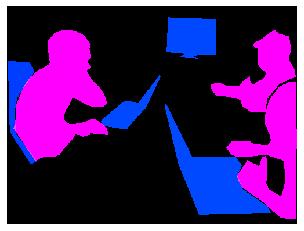

(375, 500, 3)
COCO_val2014_000000278323.jpg
{'person_bbx': [216.24, 234.83, 349.75, 589.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [338.79, 294.38, 381.59000000000003, 389.96]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [216.24, 234.83, 349.75, 589.01], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [213.68, 51.69, 226.36, 63.3]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [216.24, 234.83, 349.75, 589.01], 'Verbs': 'hold', 'object': {'obj_bbx': [338.79, 294.38, 381.59000000000003, 389.96]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [216.24, 234.83, 349.75, 589.01], 'Verbs': 'look', 'object': {'obj_bbx': [213.68, 51.69, 226.36, 63.3]}}
sports ball
person
look
look interaction
{'person_bbx': [216.24, 234.83, 349.75, 589.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


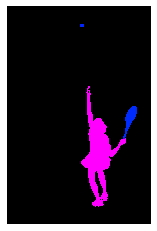

(640, 422, 3)
COCO_val2014_000000572900.jpg
{'person_bbx': [360.75, 165.68, 489.09000000000003, 372.05], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [360.75, 165.68, 489.09000000000003, 372.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.75, 165.68, 489.09000000000003, 372.05], 'Verbs': 'throw', 'object': {'obj_bbx': [345.3, 199.98, 388.04, 219.73999999999998]}}
person
frisbee
throw
throw interaction


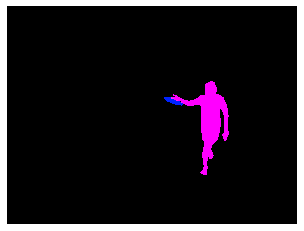

(480, 640, 3)
COCO_val2014_000000247264.jpg
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [512.01, 160.29, 612.01, 300.09000000000003]}}
person
surfboard
carry
carry interaction
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [512.01, 160.29, 612.01, 300.09000000000003]}}
person
surfboard
hold
hold interaction
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [22.7, 37.3, 204.32, 474.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [22.7, 37.3, 204.32, 474.05], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [426.07, 35.6, 622.38, 480.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person


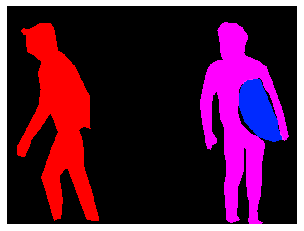

(480, 640, 3)
COCO_val2014_000000157063.jpg
{'person_bbx': [0.0, 42.97, 316.04, 474.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [212.49, 245.93, 443.33000000000004, 460.58000000000004]}}
person
laptop
hold
hold interaction
{'person_bbx': [434.49, 0.0, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 42.97, 316.04, 474.42999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [212.49, 245.93, 443.33000000000004, 460.58000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [434.49, 0.0, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 42.97, 316.04, 474.42999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 42.97, 316.04, 474.42999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [434.49, 0.0, 640.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 42.97, 316.04, 474.429999

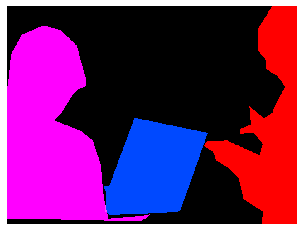

(480, 640, 3)
COCO_val2014_000000006864.jpg
{'person_bbx': [281.86, 123.48, 358.3, 333.32], 'Verbs': 'carry', 'object': {'obj_bbx': [254.04, 242.88, 312.13, 364.15999999999997]}}
person
suitcase
carry
carry interaction
{'person_bbx': [281.86, 123.48, 358.3, 333.32], 'Verbs': 'hold', 'object': {'obj_bbx': [254.04, 242.88, 312.13, 364.15999999999997]}}
person
suitcase
hold
hold interaction
{'person_bbx': [281.86, 123.48, 358.3, 333.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [502.98, 129.83, 593.38, 339.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [281.86, 123.48, 358.3, 333.32], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [502.98, 129.83, 593.38, 339.48], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


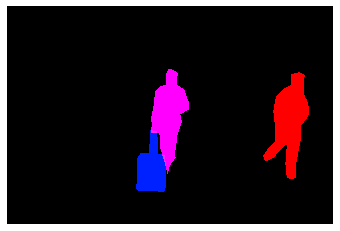

(427, 640, 3)
COCO_val2014_000000097946.jpg
{'person_bbx': [170.08, 250.66, 305.33000000000004, 456.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [38.85, 194.01, 154.49, 546.6700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [38.85, 194.01, 154.49, 546.6700000000001], 'Verbs': 'look', 'object': {'obj_bbx': [77.42, 532.28, 136.02, 570.23]}}
person
skateboard
look
look interaction
{'person_bbx': [170.08, 250.66, 305.33000000000004, 456.73], 'Verbs': 'skateboard', 'object': {'obj_bbx': [249.14, 434.49, 288.83, 463.79]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [38.85, 194.01, 154.49, 546.6700000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [77.42, 532.28, 136.02, 570.23]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [170.08, 250.66, 305.33000000000004, 456.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [38.85, 194.01, 154.49, 546.6700000

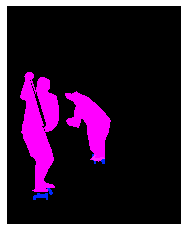

(640, 512, 3)
COCO_val2014_000000395182.jpg
{'person_bbx': [225.57, 37.6, 588.64, 478.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [32.37, 53.68, 260.03999999999996, 470.18], 'Verbs': 'hold', 'object': {'obj_bbx': [5.37, 446.67, 342.66, 462.78000000000003]}}
person
skis
hold
hold interaction
{'person_bbx': [32.37, 53.68, 260.03999999999996, 470.18], 'Verbs': 'ski', 'object': {'obj_bbx': [5.37, 446.67, 342.66, 462.78000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [32.37, 53.68, 260.03999999999996, 470.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [225.57, 37.6, 588.64, 478.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [32.37, 53.68, 260.03999999999996, 470.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


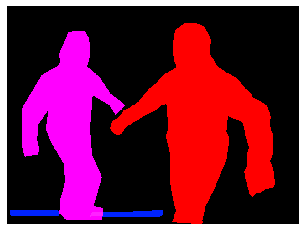

(478, 640, 3)
COCO_val2014_000000385918.jpg
{'person_bbx': [150.72, 15.59, 461.69000000000005, 374.2], 'Verbs': 'catch', 'object': {'obj_bbx': [97.0, 51.51, 149.37, 72.97]}}
person
frisbee
catch
catch interaction
{'person_bbx': [210.47, 88.71, 377.05, 382.0], 'Verbs': 'catch', 'object': {'obj_bbx': [97.0, 51.51, 149.37, 72.97]}}
frisbee
person
catch
catch interaction
{'person_bbx': [150.72, 15.59, 461.69000000000005, 374.2], 'Verbs': 'look', 'object': {'obj_bbx': [97.0, 51.51, 149.37, 72.97]}}
person
frisbee
look
look interaction
{'person_bbx': [210.47, 88.71, 377.05, 382.0], 'Verbs': 'look', 'object': {'obj_bbx': [97.0, 51.51, 149.37, 72.97]}}
frisbee
person
look
look interaction
{'person_bbx': [150.72, 15.59, 461.69000000000005, 374.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [210.47, 88.71, 377.05, 382.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


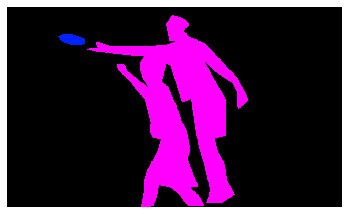

(382, 640, 3)
COCO_val2014_000000356337.jpg
{'person_bbx': [166.09, 54.55, 418.08000000000004, 545.64], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [218.04, 399.93, 249.31, 461.94]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [166.09, 54.55, 418.08000000000004, 545.64], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [168.2, 456.07, 372.81, 601.8]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [37.35, 39.39, 254.0, 525.26], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [218.04, 399.93, 249.31, 461.94]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [37.35, 39.39, 254.0, 525.26], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [168.2, 456.07, 372.81, 601.8]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [166.09, 54.55, 418.08000000000004, 545.64], 'Verbs': 'hold', 'object': {'obj_bbx': [218.04, 399.93, 249.31, 461.94]}}
person
knife
hold
hold interaction
{'person_bbx': [37.35, 39.39, 254.0, 525.26], 'Verbs': 'hold', 'object': {'obj_bbx': [166.09, 54.

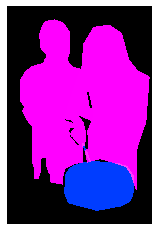

(640, 425, 3)
COCO_val2014_000000355762.jpg
{'person_bbx': [212.97, 1.08, 638.92, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [79.71, 92.54, 293.15999999999997, 318.36]}}
laptop
person
hold
hold interaction
{'person_bbx': [212.97, 1.08, 638.92, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [79.71, 92.54, 293.15999999999997, 318.36]}}
laptop
person
look
look interaction
{'person_bbx': [212.97, 1.08, 638.92, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [79.71, 92.54, 293.15999999999997, 318.36]}}
laptop
person
work_on_computer
work_on_computer interaction


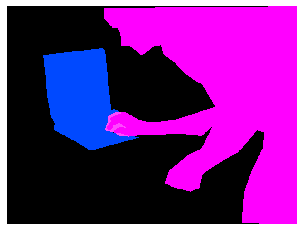

(480, 640, 3)
COCO_val2014_000000354212.jpg
{'person_bbx': [211.24, 86.52, 333.0, 169.66], 'Verbs': 'hold', 'object': {'obj_bbx': [196.01, 102.39, 268.69, 146.11]}}
mouse
person
hold
hold interaction
{'person_bbx': [211.24, 86.52, 333.0, 169.66], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.12, 243.82, 333.0, 497.75]}}
laptop
person
work_on_computer
work_on_computer interaction


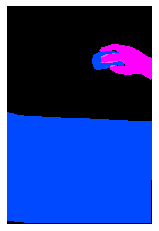

(500, 333, 3)
COCO_val2014_000000228013.jpg
{'person_bbx': [284.13, 1.79, 640.0, 474.26000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [284.13, 1.79, 640.0, 474.26000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [186.61, 35.6, 428.22, 262.11]}}
laptop
person
work_on_computer
work_on_computer interaction


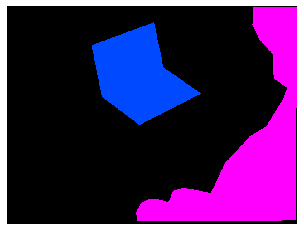

(480, 640, 3)
COCO_val2014_000000577073.jpg
{'person_bbx': [271.85, 38.77, 392.45000000000005, 205.32000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [269.29, 197.39, 411.0, 212.88]}}
person
skis
hold
hold interaction
{'person_bbx': [271.85, 38.77, 392.45000000000005, 205.32000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [269.29, 197.39, 411.0, 212.88]}}
person
skis
jump
jump interaction
{'person_bbx': [271.85, 38.77, 392.45000000000005, 205.32000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [269.29, 197.39, 411.0, 212.88]}}
person
skis
ski
ski interaction


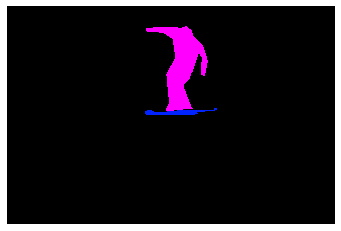

(425, 640, 3)
COCO_val2014_000000376393.jpg
{'person_bbx': [361.35, 113.26, 509.12, 473.53], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [241.69, 140.05, 402.07, 421.27000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [361.35, 113.26, 509.12, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [241.69, 140.05, 402.07, 421.27000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [361.35, 113.26, 509.12, 473.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [241.69, 140.05, 402.07, 421.27000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [162.67, 356.49, 405.98, 480.0]}}
person
snowboard
snowboard
snowboard interaction


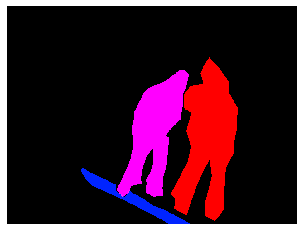

(480, 640, 3)
COCO_val2014_000000200770.jpg
{'person_bbx': [52.28, 75.59, 242.23, 370.1], 'Verbs': 'catch', 'object': {'obj_bbx': [327.71, 54.37, 369.71, 81.47]}}
person
frisbee
catch
catch interaction
{'person_bbx': [52.28, 75.59, 242.23, 370.1], 'Verbs': 'look', 'object': {'obj_bbx': [327.71, 54.37, 369.71, 81.47]}}
person
frisbee
look
look interaction
{'person_bbx': [52.28, 75.59, 242.23, 370.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [52.28, 75.59, 242.23, 370.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


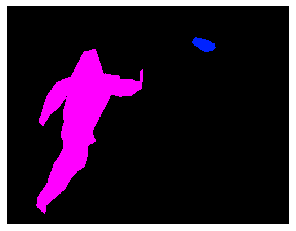

(386, 500, 3)
COCO_val2014_000000453757.jpg
{'person_bbx': [40.4, 405.14, 248.29, 560.73], 'Verbs': 'kick', 'object': {'obj_bbx': [240.86, 136.52, 289.26, 185.41000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [235.28, 211.07, 393.97, 558.91], 'Verbs': 'look', 'object': {'obj_bbx': [240.86, 136.52, 289.26, 185.41000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [40.4, 405.14, 248.29, 560.73], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [235.28, 211.07, 393.97, 558.91], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [235.28, 211.07, 393.97, 558.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


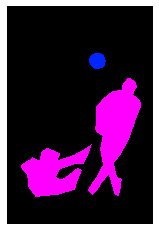

(640, 427, 3)
COCO_val2014_000000070945.jpg
{'person_bbx': [98.99, 0.0, 392.62, 365.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [98.99, 0.0, 392.62, 365.85], 'Verbs': 'look', 'object': {'obj_bbx': [115.45, 178.39, 331.18, 368.84]}}
person
person
look
look interaction
{'person_bbx': [98.99, 0.0, 392.62, 365.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


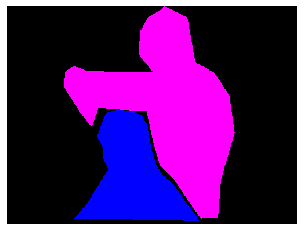

(375, 500, 3)
COCO_val2014_000000034428.jpg
{'person_bbx': [58.14, 133.1, 216.57, 374.38], 'Verbs': 'snowboard', 'object': {'obj_bbx': [23.7, 357.51, 206.54999999999998, 392.49]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [58.14, 133.1, 216.57, 374.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


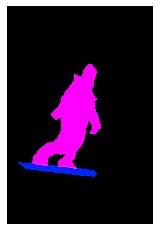

(500, 335, 3)
COCO_val2014_000000577373.jpg
{'person_bbx': [110.09, 104.35, 288.15, 378.13], 'Verbs': 'catch', 'object': {'obj_bbx': [272.59, 204.09, 315.59999999999997, 252.92000000000002]}}
person
frisbee
catch
catch interaction
{'person_bbx': [110.09, 104.35, 288.15, 378.13], 'Verbs': 'hold', 'object': {'obj_bbx': [272.59, 204.09, 315.59999999999997, 252.92000000000002]}}
person
frisbee
hold
hold interaction
{'person_bbx': [110.09, 104.35, 288.15, 378.13], 'Verbs': 'look', 'object': {'obj_bbx': [272.59, 204.09, 315.59999999999997, 252.92000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [406.68, 25.12, 542.88, 400.88], 'Verbs': 'look', 'object': {'obj_bbx': [272.59, 204.09, 315.59999999999997, 252.92000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [110.09, 104.35, 288.15, 378.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [406.68, 25.12, 542.88, 400.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx'

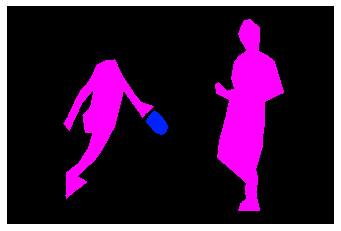

(426, 640, 3)
COCO_val2014_000000182715.jpg
{'person_bbx': [190.85, 67.37, 454.89, 536.61], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [186.02, 458.02, 283.76, 502.62]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [190.85, 67.37, 454.89, 536.61], 'Verbs': 'hold', 'object': {'obj_bbx': [186.02, 458.02, 283.76, 502.62]}}
person
knife
hold
hold interaction
{'person_bbx': [190.85, 67.37, 454.89, 536.61], 'Verbs': 'look', 'object': {'obj_bbx': [186.02, 458.02, 283.76, 502.62]}}
person
knife
look
look interaction
{'person_bbx': [190.85, 67.37, 454.89, 536.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


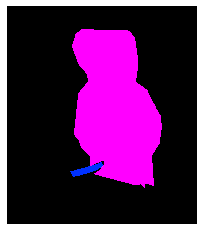

(640, 558, 3)
COCO_val2014_000000022626.jpg
{'person_bbx': [89.4, 410.08, 427.0, 639.19], 'Verbs': 'snowboard', 'object': {'obj_bbx': [87.73, 394.07, 427.0, 513.44]}}
person
snowboard
snowboard
snowboard interaction


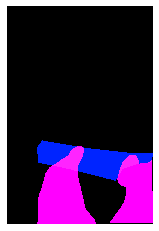

(640, 427, 3)
COCO_val2014_000000203631.jpg
{'person_bbx': [181.62, 217.66, 327.21000000000004, 580.9], 'Verbs': 'hold', 'object': {'obj_bbx': [320.0, 344.17, 378.33, 597.5]}}
person
skis
hold
hold interaction
{'person_bbx': [181.62, 217.66, 327.21000000000004, 580.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [181.62, 217.66, 327.21000000000004, 580.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


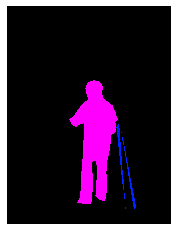

(640, 480, 3)
COCO_val2014_000000372043.jpg
{'person_bbx': [101.04, 222.19, 179.57, 325.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [101.04, 222.19, 179.57, 325.15], 'Verbs': 'surf', 'object': {'obj_bbx': [119.15, 321.06, 153.72, 333.43]}}
person
surfboard
surf
surf interaction


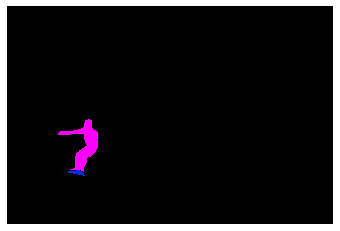

(427, 640, 3)
COCO_val2014_000000215914.jpg
{'person_bbx': [0.0, 70.88, 100.72, 328.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [298.0, 87.97, 422.11, 265.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 70.88, 100.72, 328.27], 'Verbs': 'look', 'object': {'obj_bbx': [294.22, 274.87, 358.22, 332.0]}}
person
sports ball
look
look interaction
{'person_bbx': [298.0, 87.97, 422.11, 265.07], 'Verbs': 'look', 'object': {'obj_bbx': [442.63, 238.51, 469.77, 264.76]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 70.88, 100.72, 328.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [298.0, 87.97, 422.11, 265.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


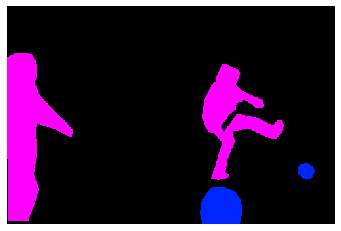

(332, 500, 3)
COCO_val2014_000000554374.jpg
{'person_bbx': [84.82, 77.35, 513.75, 287.48], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.82, 77.35, 513.75, 287.48], 'Verbs': 'surf', 'object': {'obj_bbx': [222.62, 177.52, 425.08000000000004, 308.02]}}
person
surfboard
surf
surf interaction


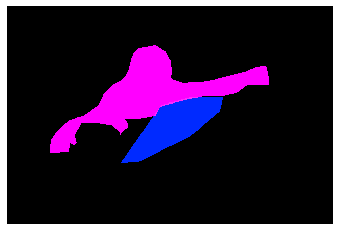

(427, 640, 3)
COCO_val2014_000000013867.jpg
{'person_bbx': [199.74, 101.24, 361.37, 340.92], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [199.74, 101.24, 361.37, 340.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [199.74, 101.24, 361.37, 340.92], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


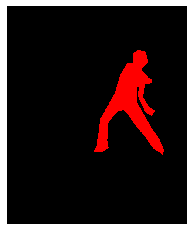

(500, 413, 3)
COCO_val2014_000000287402.jpg
{'person_bbx': [362.43, 267.51, 412.04, 368.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [362.43, 267.51, 412.04, 368.9], 'Verbs': 'throw', 'object': {'obj_bbx': [333.98, 127.22, 371.18, 149.34]}}
person
frisbee
throw
throw interaction


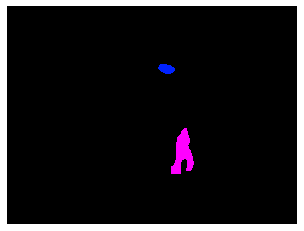

(480, 640, 3)
COCO_val2014_000000208871.jpg
{'person_bbx': [80.54, 90.61, 395.51000000000005, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [80.54, 90.61, 395.51000000000005, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [80.54, 90.61, 395.51000000000005, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.54, 90.61, 395.51000000000005, 631.37], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


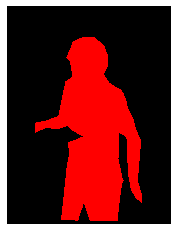

(640, 480, 3)
COCO_val2014_000000324082.jpg
{'person_bbx': [429.83, 166.57, 549.49, 395.37], 'Verbs': 'hold', 'object': {'obj_bbx': [183.1, 294.2, 436.12, 378.85]}}
horse
person
hold
hold interaction
{'person_bbx': [429.83, 166.57, 549.49, 395.37], 'Verbs': 'ride', 'object': {'obj_bbx': [183.1, 294.2, 436.12, 378.85]}}
horse
person
ride
ride interaction
{'person_bbx': [513.11, 114.16, 640.0, 422.40999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [58.63, 330.72, 554.26, 426.0]}}
horse
person
ride
ride interaction
{'person_bbx': [429.83, 166.57, 549.49, 395.37], 'Verbs': 'sit', 'object': {'obj_bbx': [183.1, 294.2, 436.12, 378.85]}}
horse
person
sit
sit interaction
{'person_bbx': [513.11, 114.16, 640.0, 422.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [58.63, 330.72, 554.26, 426.0]}}
horse
person
sit
sit interaction


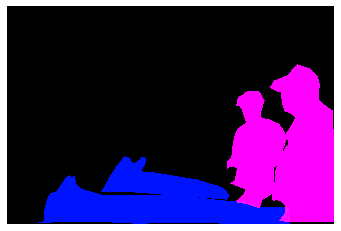

(426, 640, 3)
COCO_val2014_000000546670.jpg
{'person_bbx': [34.52, 3.24, 392.63, 631.73], 'Verbs': 'look', 'object': {'obj_bbx': [102.98, 571.22, 228.94, 637.39]}}
person
skateboard
look
look interaction
{'person_bbx': [34.52, 3.24, 392.63, 631.73], 'Verbs': 'skateboard', 'object': {'obj_bbx': [102.98, 571.22, 228.94, 637.39]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [34.52, 3.24, 392.63, 631.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


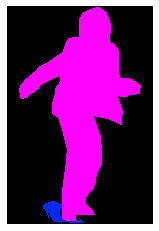

(640, 428, 3)
COCO_val2014_000000125257.jpg
{'person_bbx': [343.03, 89.54, 393.83, 230.79000000000002], 'Verbs': 'snowboard', 'object': {'obj_bbx': [336.97, 215.24, 409.13, 238.37]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [343.03, 89.54, 393.83, 230.79000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


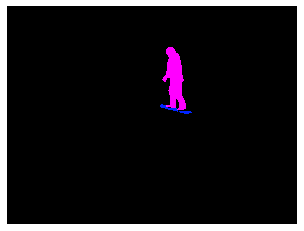

(480, 640, 3)
COCO_val2014_000000335631.jpg
{'person_bbx': [1.66, 34.91, 216.1, 251.01], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [1.66, 34.91, 216.1, 251.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


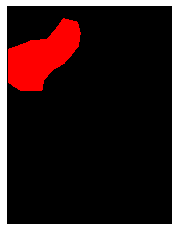

(640, 483, 3)
COCO_val2014_000000138834.jpg
{'person_bbx': [198.47, 136.63, 394.07, 560.9], 'Verbs': 'hold', 'object': {'obj_bbx': [252.71, 26.05, 325.4, 199.46]}}
person
skis
hold
hold interaction
{'person_bbx': [198.47, 136.63, 394.07, 560.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [198.47, 136.63, 394.07, 560.9], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


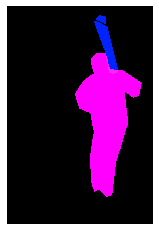

(640, 427, 3)
COCO_val2014_000000377802.jpg
{'person_bbx': [455.58, 95.54, 523.66, 291.5], 'Verbs': 'look', 'object': {'obj_bbx': [175.4, 88.38, 212.67000000000002, 98.97]}}
person
frisbee
look
look interaction
{'person_bbx': [455.58, 95.54, 523.66, 291.5], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [455.58, 95.54, 523.66, 291.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


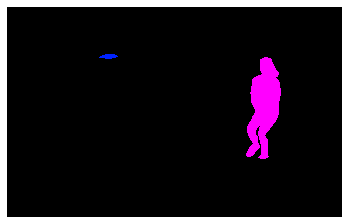

(401, 640, 3)
COCO_val2014_000000262229.jpg
{'person_bbx': [63.85, 104.93, 256.33, 386.99], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [258.28, 96.72, 502.94999999999993, 397.78999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [258.82, 318.99, 307.53, 356.24]}}
sports ball
person
kick
kick interaction
{'person_bbx': [175.03, 69.11, 406.09000000000003, 381.31], 'Verbs': 'kick', 'object': {'obj_bbx': [258.82, 318.99, 307.53, 356.24]}}
sports ball
person
kick
kick interaction
{'person_bbx': [63.85, 104.93, 256.33, 386.99], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [258.28, 96.72, 502.94999999999993, 397.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [258.82, 318.99, 307.53, 356.24]}}
sports ball
person
look
look interaction
{'person_bbx': [442.19, 33.43, 549.16, 359.1], 'Verbs': 'look', 'object': {'obj_bbx': [258.82, 318.99, 307.53, 356.24]}}
sports ball
person
look
look interaction
{'person_bbx': [175.03, 69.11, 406.09

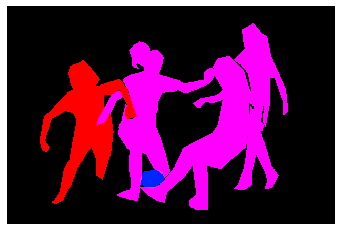

(425, 640, 3)
COCO_val2014_000000132987.jpg
{'person_bbx': [117.36, 184.24, 211.05, 351.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [117.36, 184.24, 211.05, 351.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [117.36, 184.24, 211.05, 351.64], 'Verbs': 'surf', 'object': {'obj_bbx': [118.2, 340.9, 337.3, 372.60999999999996]}}
person
surfboard
surf
surf interaction


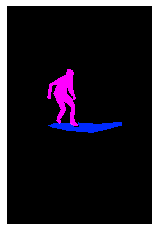

(640, 425, 3)
COCO_val2014_000000394724.jpg
{'person_bbx': [371.89, 371.89, 586.67, 614.05], 'Verbs': 'look', 'object': {'obj_bbx': [4.32, 3.6, 259.46, 304.86]}}
person
person
look
look interaction
{'person_bbx': [4.32, 3.6, 259.46, 304.86], 'Verbs': 'surf', 'object': {'obj_bbx': [144.72, 294.75, 330.81, 349.96]}}
person
surfboard
surf
surf interaction


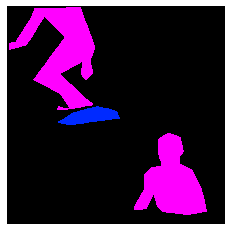

(640, 639, 3)
COCO_val2014_000000529649.jpg
{'person_bbx': [124.72, 124.72, 375.0, 483.15], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [124.72, 124.72, 375.0, 483.15], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 162.92, 375.0, 500.0]}}
person
laptop
work_on_computer
work_on_computer interaction


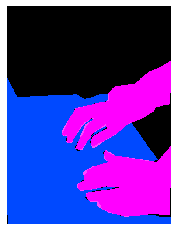

(500, 375, 3)
COCO_val2014_000000034214.jpg
{'person_bbx': [77.67, 21.4, 257.39, 155.89000000000001], 'Verbs': 'jump', 'object': {'obj_bbx': [100.67, 150.0, 218.12, 174.6]}}
person
skateboard
jump
jump interaction
{'person_bbx': [77.67, 21.4, 257.39, 155.89000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [100.67, 150.0, 218.12, 174.6]}}
person
skateboard
look
look interaction
{'person_bbx': [77.67, 21.4, 257.39, 155.89000000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [100.67, 150.0, 218.12, 174.6]}}
person
skateboard
skateboard
skateboard interaction


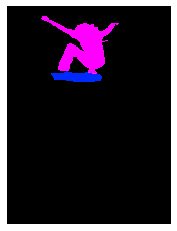

(500, 375, 3)
COCO_val2014_000000420347.jpg
{'person_bbx': [150.65, 98.83, 412.61, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [381.79, 292.68, 469.72, 358.92]}}
person
book
hold
hold interaction
{'person_bbx': [150.65, 98.83, 412.61, 422.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [150.65, 98.83, 412.61, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


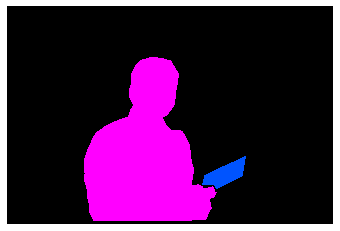

(427, 640, 3)
COCO_val2014_000000229601.jpg
{'person_bbx': [87.32, 75.36, 261.89, 351.52000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [470.12, 66.68, 589.48, 358.34000000000003]}}
person
person
look
look interaction
{'person_bbx': [470.12, 66.68, 589.48, 358.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [230.15, 107.03, 259.86, 181.98000000000002]}}
person
person
look
look interaction
{'person_bbx': [87.32, 75.36, 261.89, 351.52000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [87.32, 75.36, 261.89, 351.52000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [470.12, 66.68, 589.48, 358.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


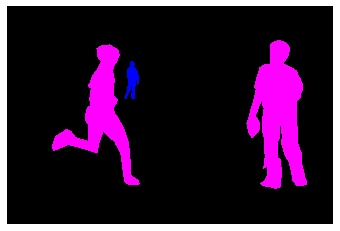

(427, 640, 3)
COCO_val2014_000000350160.jpg
{'person_bbx': [3.85, 63.48, 532.84, 369.33000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 10.58, 640.0, 421.27]}}
bed
person
lay
lay interaction
{'person_bbx': [3.85, 63.48, 532.84, 369.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [11.68, 203.06, 301.0, 425.28999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [3.85, 63.48, 532.84, 369.33000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [11.68, 203.06, 301.0, 425.28999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


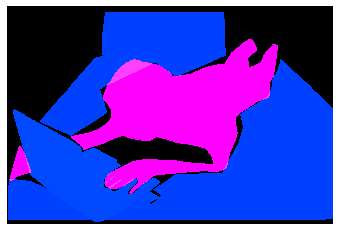

(428, 640, 3)
COCO_val2014_000000289392.jpg
{'person_bbx': [133.8, 86.13, 304.63, 357.31], 'Verbs': 'look', 'object': {'obj_bbx': [287.46, 185.68, 377.34999999999997, 253.97000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [133.8, 86.13, 304.63, 357.31], 'Verbs': 'sit', 'object': {'obj_bbx': [59.76, 220.45, 129.85, 342.0]}}
chair
person
sit
sit interaction
{'person_bbx': [133.8, 86.13, 304.63, 357.31], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [287.46, 185.68, 377.34999999999997, 253.97000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


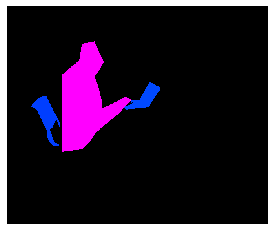

(534, 640, 3)
COCO_val2014_000000505213.jpg
{'person_bbx': [0.0, 77.65, 470.97, 632.42], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [105.91, 305.25, 270.83, 492.86]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 77.65, 470.97, 632.42], 'Verbs': 'hold', 'object': {'obj_bbx': [105.91, 305.25, 270.83, 492.86]}}
person
hot dog
hold
hold interaction
{'person_bbx': [0.0, 77.65, 470.97, 632.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


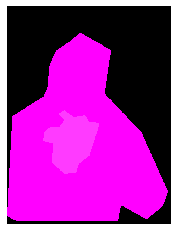

(640, 480, 3)
COCO_val2014_000000315974.jpg


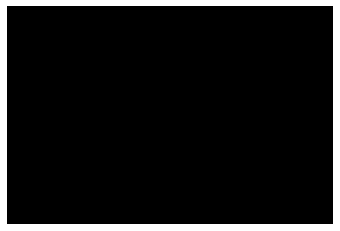

(427, 640, 3)
COCO_val2014_000000514860.jpg
{'person_bbx': [289.02, 67.08, 632.1099999999999, 384.0], 'Verbs': 'hold', 'object': {'obj_bbx': [316.94, 331.27, 392.22, 358.22999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [155.01, 21.75, 366.52, 363.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [289.02, 67.08, 632.1099999999999, 384.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [155.01, 21.75, 366.52, 363.06], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [289.02, 67.08, 632.1099999999999, 384.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


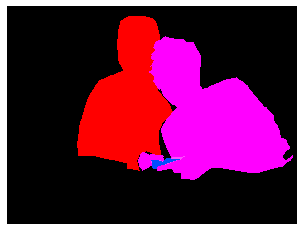

(480, 640, 3)
COCO_val2014_000000436582.jpg
{'person_bbx': [161.58, 75.02, 408.76, 407.79999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [319.32, 72.13, 379.90999999999997, 149.07999999999998]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [161.58, 75.02, 408.76, 407.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [319.32, 72.13, 379.90999999999997, 149.07999999999998]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [161.58, 75.02, 408.76, 407.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


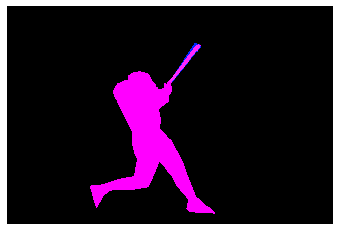

(428, 640, 3)
COCO_val2014_000000421139.jpg
{'person_bbx': [142.93, 128.48, 382.39, 328.28], 'Verbs': 'catch', 'object': {'obj_bbx': [73.33, 239.98, 102.52, 296.09999999999997]}}
person
frisbee
catch
catch interaction
{'person_bbx': [142.93, 128.48, 382.39, 328.28], 'Verbs': 'look', 'object': {'obj_bbx': [73.33, 239.98, 102.52, 296.09999999999997]}}
person
frisbee
look
look interaction
{'person_bbx': [0.0, 37.29, 104.02, 293.21], 'Verbs': 'look', 'object': {'obj_bbx': [73.33, 239.98, 102.52, 296.09999999999997]}}
person
frisbee
look
look interaction
{'person_bbx': [312.05, 0.62, 456.47, 252.81], 'Verbs': 'look', 'object': {'obj_bbx': [73.33, 239.98, 102.52, 296.09999999999997]}}
person
frisbee
look
look interaction
{'person_bbx': [142.93, 128.48, 382.39, 328.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [312.05, 0.62, 456.47, 252.81], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 37.29, 104.02, 293.21], 'Verbs': 'stand', 'object'

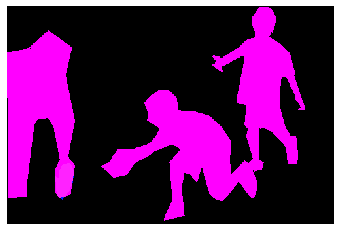

(333, 500, 3)
COCO_val2014_000000212116.jpg
{'person_bbx': [160.03, 8.25, 224.64, 217.29], 'Verbs': 'hold', 'object': {'obj_bbx': [60.4, 63.27, 422.81, 343.87]}}
horse
person
hold
hold interaction
{'person_bbx': [318.06, 16.89, 370.84000000000003, 150.60000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [319.44, 89.59, 350.26, 113.48]}}
person
suitcase
hold
hold interaction
{'person_bbx': [246.48, 10.09, 312.99, 226.93], 'Verbs': 'hold', 'object': {'obj_bbx': [240.32, 92.91, 303.63, 141.23]}}
person
suitcase
hold
hold interaction
{'person_bbx': [198.92, 11.08, 260.89, 230.67000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [182.97, 107.39, 251.38, 162.28]}}
person
suitcase
hold
hold interaction
{'person_bbx': [160.03, 8.25, 224.64, 217.29], 'Verbs': 'ride', 'object': {'obj_bbx': [60.4, 63.27, 422.81, 343.87]}}
horse
person
ride
ride interaction
{'person_bbx': [318.06, 16.89, 370.84000000000003, 150.60000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [60.4, 63.27, 422.81, 343

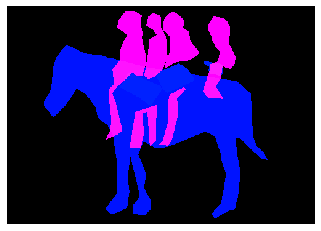

(354, 500, 3)
COCO_val2014_000000179346.jpg
{'person_bbx': [221.09, 224.68, 262.02, 311.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [221.09, 224.68, 262.02, 311.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [221.09, 224.68, 262.02, 311.14], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


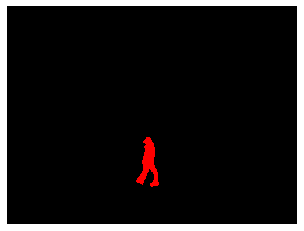

(375, 500, 3)
COCO_val2014_000000301867.jpg
{'person_bbx': [255.92, 102.21, 389.19, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [208.79, 40.47, 447.71, 173.92]}}
umbrella
person
carry
carry interaction
{'person_bbx': [146.51, 108.86, 306.24, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [119.39, 174.01, 191.66, 334.73]}}
handbag
person
carry
carry interaction
{'person_bbx': [351.63, 116.51, 489.27, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [429.3, 182.11, 536.09, 325.57000000000005]}}
handbag
person
carry
carry interaction
{'person_bbx': [255.92, 102.21, 389.19, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [208.79, 40.47, 447.71, 173.92]}}
umbrella
person
hold
hold interaction
{'person_bbx': [351.63, 116.51, 489.27, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [429.3, 182.11, 536.09, 325.57000000000005]}}
handbag
person
hold
hold interaction
{'person_bbx': [255.92, 102.21, 389.19, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [146.51, 108.86, 306.24, 480.0]}}
person
pe

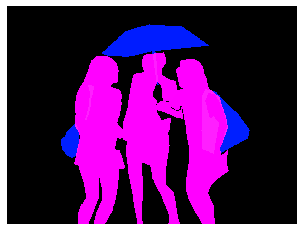

(480, 640, 3)
COCO_val2014_000000015032.jpg
{'person_bbx': [174.21, 26.32, 377.14, 381.45], 'Verbs': 'catch', 'object': {'obj_bbx': [445.0, 88.98, 471.21, 111.64]}}
sports ball
person
catch
catch interaction
{'person_bbx': [279.48, 239.0, 640.0, 404.76], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [174.21, 26.32, 377.14, 381.45], 'Verbs': 'look', 'object': {'obj_bbx': [445.0, 88.98, 471.21, 111.64]}}
sports ball
person
look
look interaction
{'person_bbx': [279.48, 239.0, 640.0, 404.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


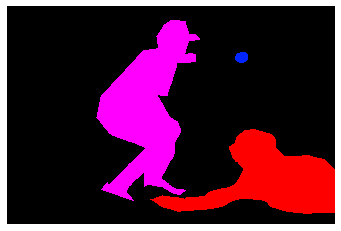

(425, 640, 3)
COCO_val2014_000000509459.jpg
{'person_bbx': [88.28, 58.46, 321.18, 390.59], 'Verbs': 'look', 'object': {'obj_bbx': [310.16, 161.05, 372.98, 179.53]}}
person
frisbee
look
look interaction
{'person_bbx': [88.28, 58.46, 321.18, 390.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [88.28, 58.46, 321.18, 390.59], 'Verbs': 'throw', 'object': {'obj_bbx': [310.16, 161.05, 372.98, 179.53]}}
person
frisbee
throw
throw interaction


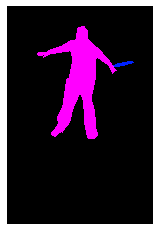

(640, 427, 3)
COCO_val2014_000000300408.jpg
{'person_bbx': [262.46, 154.22, 390.88, 339.31], 'Verbs': 'look', 'object': {'obj_bbx': [245.21, 332.3, 526.91, 358.27]}}
person
surfboard
look
look interaction
{'person_bbx': [262.46, 154.22, 390.88, 339.31], 'Verbs': 'surf', 'object': {'obj_bbx': [245.21, 332.3, 526.91, 358.27]}}
person
surfboard
surf
surf interaction


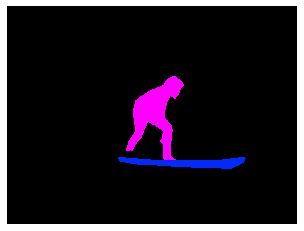

(480, 640, 3)
COCO_val2014_000000109092.jpg
{'person_bbx': [123.15, 0.0, 500.0, 394.33], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [119.53, 258.82, 193.88, 318.12]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [123.15, 0.0, 500.0, 394.33], 'Verbs': 'hold', 'object': {'obj_bbx': [119.53, 258.82, 193.88, 318.12]}}
person
hot dog
hold
hold interaction
{'person_bbx': [123.15, 0.0, 500.0, 394.33], 'Verbs': 'look', 'object': {'obj_bbx': [119.53, 258.82, 193.88, 318.12]}}
person
hot dog
look
look interaction


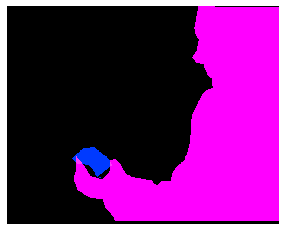

(400, 500, 3)
COCO_val2014_000000001987.jpg
{'person_bbx': [197.52, 48.87, 290.09000000000003, 222.36], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [197.52, 48.87, 290.09000000000003, 222.36], 'Verbs': 'look', 'object': {'obj_bbx': [257.1, 19.22, 283.42, 35.94]}}
person
frisbee
look
look interaction
{'person_bbx': [197.52, 48.87, 290.09000000000003, 222.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [197.52, 48.87, 290.09000000000003, 222.36], 'Verbs': 'throw', 'object': {'obj_bbx': [257.1, 19.22, 283.42, 35.94]}}
person
frisbee
throw
throw interaction


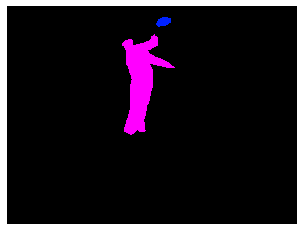

(375, 500, 3)
COCO_val2014_000000051181.jpg
{'person_bbx': [130.46, 286.55, 266.56, 560.8], 'Verbs': 'hold', 'object': {'obj_bbx': [156.22, 333.97, 165.39, 347.17]}}
cell phone
person
hold
hold interaction
{'person_bbx': [130.46, 286.55, 266.56, 560.8], 'Verbs': 'lay', 'object': {'obj_bbx': [191.87, 370.16, 380.69, 549.5]}}
person
bench
lay
lay interaction
{'person_bbx': [130.46, 286.55, 266.56, 560.8], 'Verbs': 'look', 'object': {'obj_bbx': [156.22, 333.97, 165.39, 347.17]}}
cell phone
person
look
look interaction
{'person_bbx': [130.46, 286.55, 266.56, 560.8], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


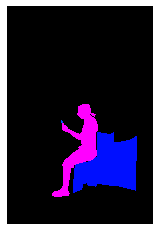

(640, 427, 3)
COCO_val2014_000000256868.jpg
{'person_bbx': [312.1, 59.72, 414.15000000000003, 251.46], 'Verbs': 'jump', 'object': {'obj_bbx': [313.35, 226.74, 388.48, 264.86]}}
person
skateboard
jump
jump interaction
{'person_bbx': [138.19, 179.56, 297.49, 381.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [312.1, 59.72, 414.15000000000003, 251.46]}}
person
person
look
look interaction
{'person_bbx': [312.1, 59.72, 414.15000000000003, 251.46], 'Verbs': 'look', 'object': {'obj_bbx': [313.35, 226.74, 388.48, 264.86]}}
person
skateboard
look
look interaction
{'person_bbx': [138.19, 179.56, 297.49, 381.09000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [312.1, 59.72, 414.15000000000003, 251.46], 'Verbs': 'skateboard', 'object': {'obj_bbx': [313.35, 226.74, 388.48, 264.86]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [138.19, 179.56, 297.49, 381.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'pe

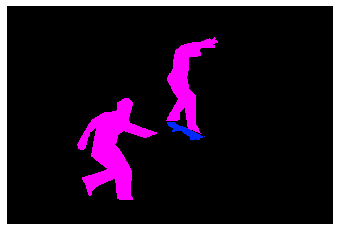

(428, 640, 3)
COCO_val2014_000000500167.jpg
{'person_bbx': [263.14, 79.76, 425.07, 395.90999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [163.12, 7.86, 269.5, 88.58]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [263.14, 79.76, 425.07, 395.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [163.12, 7.86, 269.5, 88.58]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [263.14, 79.76, 425.07, 395.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [349.36, 111.89, 619.95, 421.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


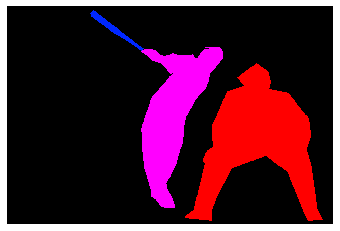

(427, 640, 3)
COCO_val2014_000000296523.jpg
{'person_bbx': [382.58, 171.19, 437.2, 273.17], 'Verbs': 'hold', 'object': {'obj_bbx': [366.29, 214.71, 462.43, 332.13]}}
horse
person
hold
hold interaction
{'person_bbx': [449.2, 175.83, 487.41999999999996, 259.27], 'Verbs': 'hold', 'object': {'obj_bbx': [433.85, 218.36, 520.45, 331.73]}}
horse
person
hold
hold interaction
{'person_bbx': [382.58, 171.19, 437.2, 273.17], 'Verbs': 'ride', 'object': {'obj_bbx': [366.29, 214.71, 462.43, 332.13]}}
horse
person
ride
ride interaction
{'person_bbx': [449.2, 175.83, 487.41999999999996, 259.27], 'Verbs': 'ride', 'object': {'obj_bbx': [433.85, 218.36, 520.45, 331.73]}}
horse
person
ride
ride interaction
{'person_bbx': [382.58, 171.19, 437.2, 273.17], 'Verbs': 'sit', 'object': {'obj_bbx': [366.29, 214.71, 462.43, 332.13]}}
horse
person
sit
sit interaction
{'person_bbx': [449.2, 175.83, 487.41999999999996, 259.27], 'Verbs': 'sit', 'object': {'obj_bbx': [433.85, 218.36, 520.45, 331.73]}}
horse
person
sit


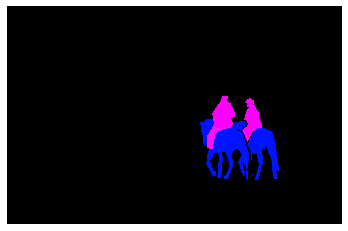

(416, 640, 3)
COCO_val2014_000000420090.jpg
{'person_bbx': [414.15, 194.98, 444.71999999999997, 271.18], 'Verbs': 'hold', 'object': {'obj_bbx': [368.1, 232.26, 493.51, 307.62]}}
person
horse
hold
hold interaction
{'person_bbx': [126.38, 208.76, 158.93, 279.6], 'Verbs': 'ride', 'object': {'obj_bbx': [85.8, 227.61, 194.11, 305.71000000000004]}}
horse
person
ride
ride interaction
{'person_bbx': [414.15, 194.98, 444.71999999999997, 271.18], 'Verbs': 'ride', 'object': {'obj_bbx': [368.1, 232.26, 493.51, 307.62]}}
person
horse
ride
ride interaction
{'person_bbx': [126.38, 208.76, 158.93, 279.6], 'Verbs': 'sit', 'object': {'obj_bbx': [85.8, 227.61, 194.11, 305.71000000000004]}}
horse
person
sit
sit interaction
{'person_bbx': [414.15, 194.98, 444.71999999999997, 271.18], 'Verbs': 'sit', 'object': {'obj_bbx': [368.1, 232.26, 493.51, 307.62]}}
person
horse
sit
sit interaction


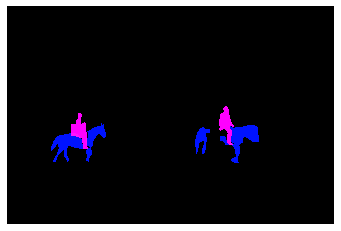

(426, 640, 3)
COCO_val2014_000000341712.jpg
{'person_bbx': [213.33, 363.96, 469.90999999999997, 632.0699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [269.01, 414.93, 327.26, 452.68]}}
cell phone
person
hold
hold interaction
{'person_bbx': [41.09, 20.65, 230.72, 319.32], 'Verbs': 'hold', 'object': {'obj_bbx': [219.49, 138.59, 237.24, 158.55]}}
cell phone
person
hold
hold interaction
{'person_bbx': [41.09, 20.65, 230.72, 319.32], 'Verbs': 'look', 'object': {'obj_bbx': [219.49, 138.59, 237.24, 158.55]}}
cell phone
person
look
look interaction
{'person_bbx': [213.33, 363.96, 469.90999999999997, 632.0699999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [41.09, 20.65, 230.72, 319.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [213.33, 363.96, 469.90999999999997, 632.0699999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [269.01, 414.93, 327.26, 452.68]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


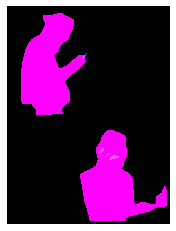

(640, 478, 3)
COCO_val2014_000000519631.jpg
{'person_bbx': [243.83, 101.87, 412.4, 327.82], 'Verbs': 'surf', 'object': {'obj_bbx': [245.17, 286.28, 285.28, 323.60999999999996]}}
person
surfboard
surf
surf interaction


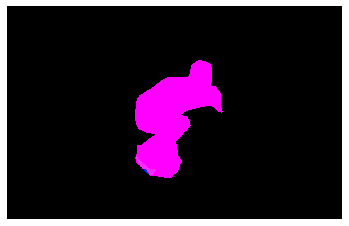

(406, 640, 3)
COCO_val2014_000000243260.jpg
{'person_bbx': [0.0, 30.89, 287.4, 472.21], 'Verbs': 'hold', 'object': {'obj_bbx': [112.89, 118.74, 132.58, 142.04]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 30.89, 287.4, 472.21], 'Verbs': 'sit', 'object': {'obj_bbx': [226.62, 263.71, 484.15, 473.84999999999997]}}
couch
person
sit
sit interaction
{'person_bbx': [299.24, 57.32, 639.38, 471.73], 'Verbs': 'sit', 'object': {'obj_bbx': [226.62, 263.71, 484.15, 473.84999999999997]}}
couch
person
sit
sit interaction
{'person_bbx': [299.24, 57.32, 639.38, 471.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 30.89, 287.4, 472.21], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [112.89, 118.74, 132.58, 142.04]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


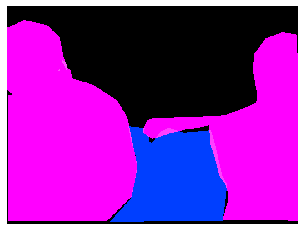

(479, 640, 3)
COCO_val2014_000000274399.jpg
{'person_bbx': [166.04, 124.77, 213.35, 175.26999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [66.21, 160.24, 240.84999999999997, 336.8]}}
person
elephant
hold
hold interaction
{'person_bbx': [387.41, 121.92, 445.29, 236.91], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [166.04, 124.77, 213.35, 175.26999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [66.21, 160.24, 240.84999999999997, 336.8]}}
person
elephant
ride
ride interaction
{'person_bbx': [387.41, 121.92, 445.29, 236.91], 'Verbs': 'ride', 'object': {'obj_bbx': [237.54, 167.82, 480.86, 371.7]}}
elephant
person
ride
ride interaction
{'person_bbx': [166.04, 124.77, 213.35, 175.26999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [66.21, 160.24, 240.84999999999997, 336.8]}}
person
elephant
sit
sit interaction
{'person_bbx': [387.41, 121.92, 445.29, 236.91], 'Verbs': 'sit', 'object': {'obj_bbx': [237.54, 167.82, 480.86, 371.7]}}
elephant
person
sit
sit 

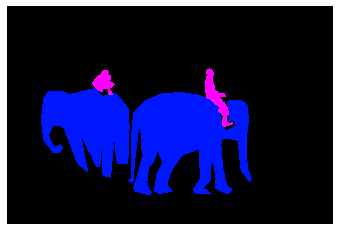

(427, 640, 3)
COCO_val2014_000000459645.jpg
{'person_bbx': [166.29, 143.82, 284.27, 304.49], 'Verbs': 'jump', 'object': {'obj_bbx': [143.63, 239.92, 336.13, 306.07]}}
snowboard
person
jump
jump interaction
{'person_bbx': [166.29, 143.82, 284.27, 304.49], 'Verbs': 'look', 'object': {'obj_bbx': [143.63, 239.92, 336.13, 306.07]}}
snowboard
person
look
look interaction
{'person_bbx': [166.29, 143.82, 284.27, 304.49], 'Verbs': 'snowboard', 'object': {'obj_bbx': [143.63, 239.92, 336.13, 306.07]}}
snowboard
person
snowboard
snowboard interaction


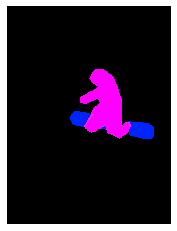

(500, 375, 3)
COCO_val2014_000000003310.jpg
{'person_bbx': [1.43, 33.17, 477.85, 632.99], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [106.34, 280.74, 279.25, 450.5]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [1.43, 33.17, 477.85, 632.99], 'Verbs': 'hold', 'object': {'obj_bbx': [106.34, 280.74, 279.25, 450.5]}}
person
hot dog
hold
hold interaction


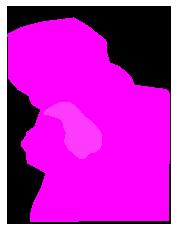

(640, 480, 3)
COCO_val2014_000000025603.jpg
{'person_bbx': [322.87, 109.78, 640.0, 414.35], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [322.87, 109.78, 640.0, 414.35], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


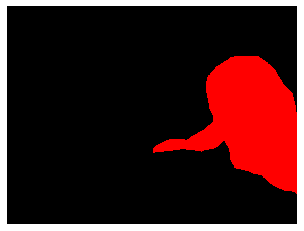

(480, 640, 3)
COCO_val2014_000000264919.jpg
{'person_bbx': [25.28, 194.37, 410.86, 632.1], 'Verbs': 'hold', 'object': {'obj_bbx': [156.7, 282.65, 166.67999999999998, 335.42999999999995]}}
cell phone
person
hold
hold interaction
{'person_bbx': [25.28, 194.37, 410.86, 632.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [25.28, 194.37, 410.86, 632.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [25.28, 194.37, 410.86, 632.1], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [156.7, 282.65, 166.67999999999998, 335.42999999999995]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


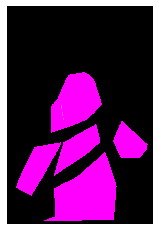

(640, 427, 3)
COCO_val2014_000000232654.jpg
{'person_bbx': [40.45, 73.32, 384.28999999999996, 620.8599999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [167.91, 327.06, 454.0, 531.7]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [40.45, 73.32, 384.28999999999996, 620.8599999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 180.54, 292.08, 635.58]}}
chair
person
sit
sit interaction
{'person_bbx': [40.45, 73.32, 384.28999999999996, 620.8599999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


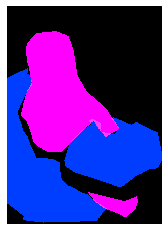

(640, 454, 3)
COCO_val2014_000000397151.jpg
{'person_bbx': [108.74, 31.27, 298.39, 388.0], 'Verbs': 'carry', 'object': {'obj_bbx': [61.91, 102.01, 390.62, 370.56]}}
person
kite
carry
carry interaction
{'person_bbx': [108.74, 31.27, 298.39, 388.0], 'Verbs': 'hold', 'object': {'obj_bbx': [61.91, 102.01, 390.62, 370.56]}}
person
kite
hold
hold interaction
{'person_bbx': [108.74, 31.27, 298.39, 388.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [108.74, 31.27, 298.39, 388.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [108.74, 31.27, 298.39, 388.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


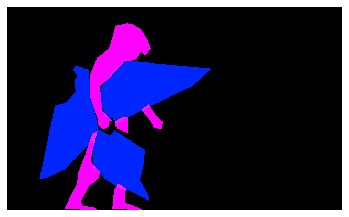

(388, 640, 3)
COCO_val2014_000000445313.jpg
{'person_bbx': [175.56, 62.77, 514.04, 555.75], 'Verbs': 'hold', 'object': {'obj_bbx': [204.46, 152.38, 264.96000000000004, 243.13]}}
sports ball
person
hold
hold interaction
{'person_bbx': [75.81, 48.87, 222.26, 507.35], 'Verbs': 'look', 'object': {'obj_bbx': [204.46, 152.38, 264.96000000000004, 243.13]}}
sports ball
person
look
look interaction
{'person_bbx': [430.09, 84.26, 640.0, 556.64], 'Verbs': 'look', 'object': {'obj_bbx': [204.46, 152.38, 264.96000000000004, 243.13]}}
sports ball
person
look
look interaction
{'person_bbx': [75.81, 48.87, 222.26, 507.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [175.56, 62.77, 514.04, 555.75], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [430.09, 84.26, 640.0, 556.64], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [75.81, 48.87, 222.26, 507.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [175.56, 

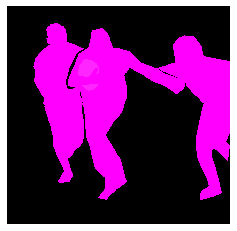

(625, 640, 3)
COCO_val2014_000000143107.jpg
{'person_bbx': [402.33, 92.05, 537.0, 277.21], 'Verbs': 'look', 'object': {'obj_bbx': [338.46, 216.69, 574.63, 318.56]}}
snowboard
person
look
look interaction
{'person_bbx': [402.33, 92.05, 537.0, 277.21], 'Verbs': 'snowboard', 'object': {'obj_bbx': [338.46, 216.69, 574.63, 318.56]}}
snowboard
person
snowboard
snowboard interaction


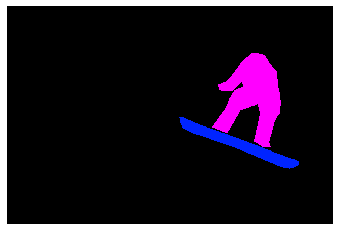

(427, 640, 3)
COCO_val2014_000000314880.jpg
{'person_bbx': [162.47, 143.43, 291.81, 372.96000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [162.47, 143.43, 291.81, 372.96000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [61.87, 228.56, 202.39000000000001, 415.19], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [227.71, 169.19, 325.98, 374.81], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [61.87, 228.56, 202.39000000000001, 415.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [317.36, 260.62, 401.03000000000003, 422.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [61.87, 228.56, 202.39000000000001, 415.19], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


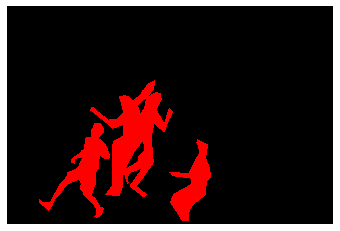

(427, 640, 3)
COCO_val2014_000000345456.jpg
{'person_bbx': [109.83, 142.68, 167.0, 243.28], 'Verbs': 'carry', 'object': {'obj_bbx': [147.87, 163.06, 168.5, 196.15]}}
person
backpack
carry
carry interaction
{'person_bbx': [188.53, 130.27, 216.08, 248.56], 'Verbs': 'hold', 'object': {'obj_bbx': [164.51, 181.9, 218.14, 252.8]}}
bicycle
person
hold
hold interaction
{'person_bbx': [209.83, 140.41, 252.73000000000002, 260.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [215.39, 47.65, 516.77, 322.69]}}
train
person
look
look interaction
{'person_bbx': [109.83, 142.68, 167.0, 243.28], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [209.83, 140.41, 252.73000000000002, 260.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.83, 142.68, 167.0, 243.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [188.53, 130.27, 216.08, 248.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'perso

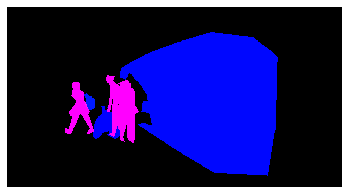

(344, 640, 3)
COCO_val2014_000000442097.jpg
{'person_bbx': [18.7, 37.39, 408.45, 556.58], 'Verbs': 'lay', 'object': {'obj_bbx': [4.31, 145.26, 428.0, 627.06]}}
bed
person
lay
lay interaction


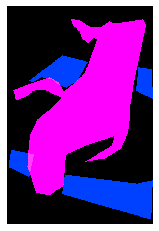

(640, 428, 3)
COCO_val2014_000000052016.jpg
{'person_bbx': [153.54, 30.3, 480.0, 627.25], 'Verbs': 'carry', 'object': {'obj_bbx': [178.15, 274.9, 266.7, 335.66999999999996]}}
person
donut
carry
carry interaction
{'person_bbx': [153.54, 30.3, 480.0, 627.25], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [178.15, 274.9, 266.7, 335.66999999999996]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [153.54, 30.3, 480.0, 627.25], 'Verbs': 'hold', 'object': {'obj_bbx': [178.15, 274.9, 266.7, 335.66999999999996]}}
person
donut
hold
hold interaction
{'person_bbx': [153.54, 30.3, 480.0, 627.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.54, 30.3, 480.0, 627.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


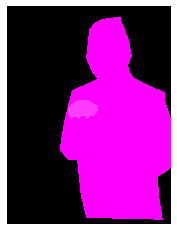

(640, 480, 3)
COCO_val2014_000000264819.jpg
{'person_bbx': [241.28, 360.94, 369.85, 507.57], 'Verbs': 'jump', 'object': {'obj_bbx': [286.2, 366.74, 419.96, 632.81]}}
person
snowboard
jump
jump interaction
{'person_bbx': [241.28, 360.94, 369.85, 507.57], 'Verbs': 'snowboard', 'object': {'obj_bbx': [286.2, 366.74, 419.96, 632.81]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [241.28, 360.94, 369.85, 507.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


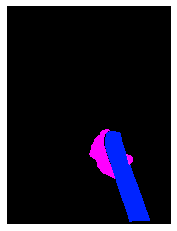

(640, 480, 3)
COCO_val2014_000000132510.jpg
{'person_bbx': [93.26, 121.35, 215.73000000000002, 408.99], 'Verbs': 'carry', 'object': {'obj_bbx': [91.44, 164.64, 155.92000000000002, 243.45]}}
person
backpack
carry
carry interaction
{'person_bbx': [93.26, 121.35, 215.73000000000002, 408.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [93.26, 121.35, 215.73000000000002, 408.99], 'Verbs': 'snowboard', 'object': {'obj_bbx': [140.48, 382.76, 245.29999999999998, 431.09]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [93.26, 121.35, 215.73000000000002, 408.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


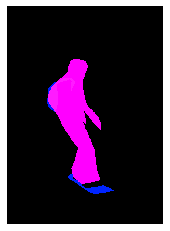

(500, 358, 3)
COCO_val2014_000000399570.jpg
{'person_bbx': [458.84, 225.54, 550.66, 370.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [458.84, 225.54, 550.66, 370.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [458.84, 225.54, 550.66, 370.61], 'Verbs': 'sit', 'object': {'obj_bbx': [483.99, 278.88, 598.96, 393.67]}}
chair
person
sit
sit interaction


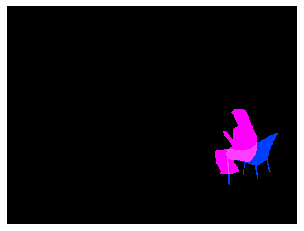

(480, 640, 3)
COCO_val2014_000000296906.jpg
{'person_bbx': [250.81, 38.29, 387.71000000000004, 271.87], 'Verbs': 'hold', 'object': {'obj_bbx': [298.64, 207.64, 416.15, 279.71999999999997]}}
person
snowboard
hold
hold interaction
{'person_bbx': [250.81, 38.29, 387.71000000000004, 271.87], 'Verbs': 'jump', 'object': {'obj_bbx': [298.64, 207.64, 416.15, 279.71999999999997]}}
person
snowboard
jump
jump interaction
{'person_bbx': [250.81, 38.29, 387.71000000000004, 271.87], 'Verbs': 'snowboard', 'object': {'obj_bbx': [298.64, 207.64, 416.15, 279.71999999999997]}}
person
snowboard
snowboard
snowboard interaction


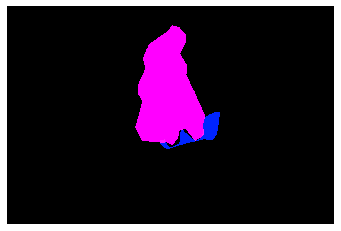

(426, 640, 3)
COCO_val2014_000000459801.jpg
{'person_bbx': [2.86, 86.04, 362.24, 501.26000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': [89.19, 478.76, 296.06, 544.8299999999999]}}
person
skateboard
jump
jump interaction
{'person_bbx': [2.86, 86.04, 362.24, 501.26000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [89.19, 478.76, 296.06, 544.8299999999999]}}
person
skateboard
look
look interaction
{'person_bbx': [2.86, 86.04, 362.24, 501.26000000000005], 'Verbs': 'skateboard', 'object': {'obj_bbx': [89.19, 478.76, 296.06, 544.8299999999999]}}
person
skateboard
skateboard
skateboard interaction


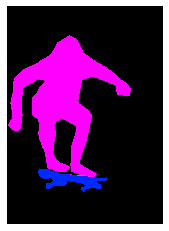

(640, 457, 3)
COCO_val2014_000000524047.jpg
{'person_bbx': [296.32, 161.5, 537.63, 415.74], 'Verbs': 'look', 'object': {'obj_bbx': [220.16, 252.18, 274.63, 270.63]}}
person
frisbee
look
look interaction
{'person_bbx': [296.32, 161.5, 537.63, 415.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [296.32, 161.5, 537.63, 415.74], 'Verbs': 'throw', 'object': {'obj_bbx': [220.16, 252.18, 274.63, 270.63]}}
person
frisbee
throw
throw interaction


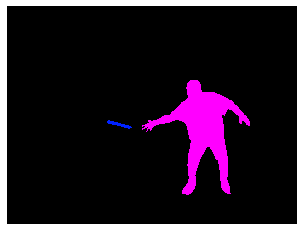

(480, 640, 3)
COCO_val2014_000000031368.jpg
{'person_bbx': [224.36, 37.15, 427.0, 386.64], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [252.52, 203.38, 280.36, 243.49]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [140.94, 0.0, 427.0, 631.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [98.85, 432.1, 233.07999999999998, 496.11]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [140.94, 0.0, 427.0, 631.37], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [142.7, 420.73, 230.99, 461.05]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [224.36, 37.15, 427.0, 386.64], 'Verbs': 'hold', 'object': {'obj_bbx': [252.52, 203.38, 280.36, 243.49]}}
person
fork
hold
hold interaction
{'person_bbx': [140.94, 0.0, 427.0, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [142.48, 239.97, 269.02, 437.28999999999996]}}
bottle
person
hold
hold interaction
{'person_bbx': [40.27, 2.88, 283.33, 371.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224

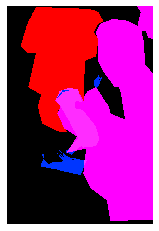

(640, 427, 3)
COCO_val2014_000000396687.jpg
{'person_bbx': [432.77, 106.27, 542.41, 304.38], 'Verbs': 'hold', 'object': {'obj_bbx': [389.39, 293.26, 633.86, 335.28999999999996]}}
person
skis
hold
hold interaction
{'person_bbx': [131.46, 80.31, 294.58000000000004, 394.08], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [432.77, 106.27, 542.41, 304.38], 'Verbs': 'ski', 'object': {'obj_bbx': [389.39, 293.26, 633.86, 335.28999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [131.46, 80.31, 294.58000000000004, 394.08], 'Verbs': 'ski', 'object': {'obj_bbx': [141.96, 342.71, 452.51, 420.34999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [131.46, 80.31, 294.58000000000004, 394.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


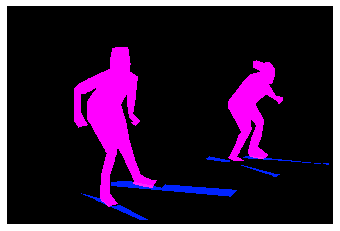

(427, 640, 3)
COCO_val2014_000000427901.jpg
{'person_bbx': [239.77, 270.48, 279.92, 341.91], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [239.77, 270.48, 279.92, 341.91], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [70.66, 253.36, 97.91, 316.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [239.77, 270.48, 279.92, 341.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [70.66, 253.36, 97.91, 316.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


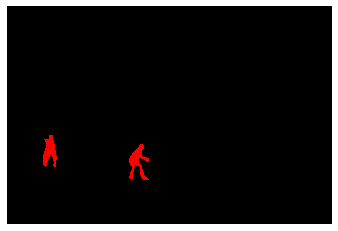

(429, 640, 3)
COCO_val2014_000000157102.jpg
{'person_bbx': [17.22, 27.19, 367.35, 456.25], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [173.57, 259.78, 245.68, 374.07]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [17.22, 27.19, 367.35, 456.25], 'Verbs': 'hold', 'object': {'obj_bbx': [173.57, 259.78, 245.68, 374.07]}}
person
scissors
hold
hold interaction
{'person_bbx': [17.22, 27.19, 367.35, 456.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


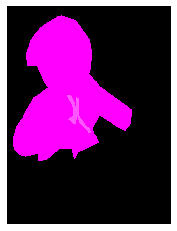

(640, 480, 3)
COCO_val2014_000000465878.jpg
{'person_bbx': [222.02, 162.73, 264.44, 251.04999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [222.02, 162.73, 264.44, 251.04999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.02, 162.73, 264.44, 251.04999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [226.87, 244.09, 269.92, 256.21]}}
person
surfboard
surf
surf interaction


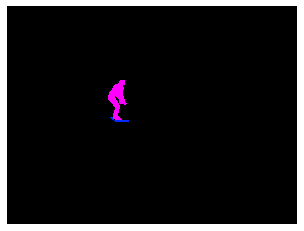

(480, 640, 3)
COCO_val2014_000000186130.jpg
{'person_bbx': [111.02, 1.45, 565.99, 259.40999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [250.89, 140.54, 321.78, 183.42]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [111.02, 1.45, 565.99, 259.40999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [225.95, 157.6, 418.16999999999996, 281.26]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [111.02, 1.45, 565.99, 259.40999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [225.95, 157.6, 418.16999999999996, 281.26]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [111.02, 1.45, 565.99, 259.40999999999997], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [250.89, 140.54, 321.78, 183.42]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [111.02, 1.45, 565.99, 259.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [250.89, 140.54, 321.78, 183.42]}}
person
knife
hold
hold interaction
{'person_bbx': [111.02, 1.45, 565.99, 259.409999

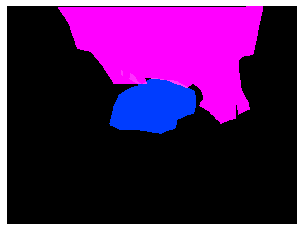

(480, 640, 3)
COCO_val2014_000000209357.jpg
{'person_bbx': [316.04, 203.87, 434.70000000000005, 472.45], 'Verbs': 'hold', 'object': {'obj_bbx': [219.23, 291.78, 382.28, 480.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [213.42, 211.69, 295.0, 428.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [316.04, 203.87, 434.70000000000005, 472.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [213.42, 211.69, 295.0, 428.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [316.04, 203.87, 434.70000000000005, 472.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


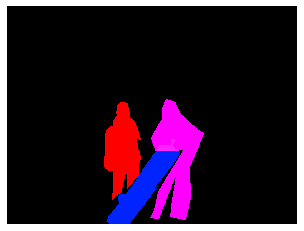

(480, 640, 3)
COCO_val2014_000000531739.jpg
{'person_bbx': [119.97, 62.72, 344.44, 322.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [119.97, 62.72, 344.44, 322.78], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [119.97, 62.72, 344.44, 322.78], 'Verbs': 'sit', 'object': {'obj_bbx': [82.14, 70.38, 200.07999999999998, 319.06]}}
person
chair
sit
sit interaction
{'person_bbx': [119.97, 62.72, 344.44, 322.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


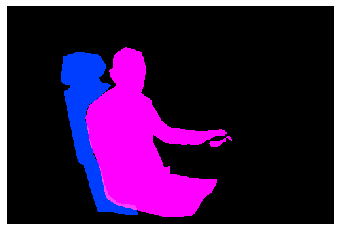

(333, 500, 3)
COCO_val2014_000000275374.jpg
{'person_bbx': [348.42, 120.34, 419.91, 329.57], 'Verbs': 'hold', 'object': {'obj_bbx': [346.58, 207.58, 371.88, 231.10000000000002]}}
person
cup
hold
hold interaction
{'person_bbx': [268.1, 268.39, 436.93000000000006, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [309.06, 264.34, 341.91, 293.53999999999996]}}
cup
person
hold
hold interaction
{'person_bbx': [348.42, 120.34, 419.91, 329.57], 'Verbs': 'look', 'object': {'obj_bbx': [346.58, 207.58, 371.88, 231.10000000000002]}}
person
cup
look
look interaction
{'person_bbx': [348.42, 120.34, 419.91, 329.57], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [268.1, 268.39, 436.93000000000006, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


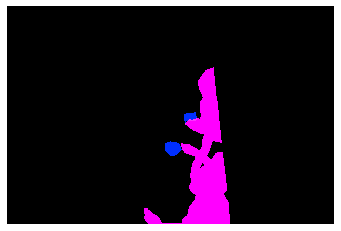

(426, 640, 3)
COCO_val2014_000000560757.jpg
{'person_bbx': [372.23, 112.97, 566.59, 302.25], 'Verbs': 'surf', 'object': {'obj_bbx': [367.75, 271.84, 401.4, 289.45]}}
person
surfboard
surf
surf interaction


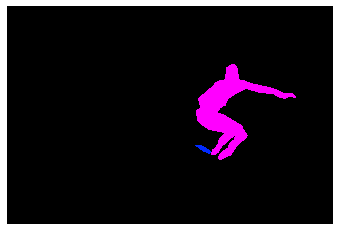

(427, 640, 3)
COCO_val2014_000000555461.jpg
{'person_bbx': [30.27, 80.0, 526.13, 554.23], 'Verbs': 'look', 'object': {'obj_bbx': [118.74, 472.84, 529.47, 623.1899999999999]}}
person
laptop
look
look interaction
{'person_bbx': [30.27, 80.0, 526.13, 554.23], 'Verbs': 'point', 'object': {'obj_bbx': [118.74, 472.84, 529.47, 623.1899999999999]}}
person
laptop
point
point interaction
{'person_bbx': [30.27, 80.0, 526.13, 554.23], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [30.27, 80.0, 526.13, 554.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [30.27, 80.0, 526.13, 554.23], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [118.74, 472.84, 529.47, 623.1899999999999]}}
person
laptop
work_on_computer
work_on_computer interaction


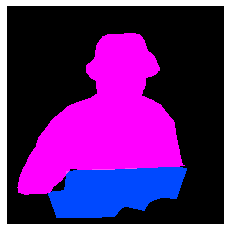

(640, 636, 3)
COCO_val2014_000000113052.jpg
{'person_bbx': [103.93, 211.0, 246.8, 307.7], 'Verbs': 'look', 'object': {'obj_bbx': [94.02, 230.06, 276.99, 294.76]}}
person
surfboard
look
look interaction
{'person_bbx': [103.93, 211.0, 246.8, 307.7], 'Verbs': 'surf', 'object': {'obj_bbx': [94.02, 230.06, 276.99, 294.76]}}
person
surfboard
surf
surf interaction


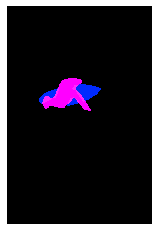

(640, 426, 3)
COCO_val2014_000000037783.jpg
{'person_bbx': [268.93, 25.14, 391.36, 412.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [103.55, 155.33, 284.76, 520.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [128.76, 442.06, 237.95999999999998, 544.34]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [103.55, 155.33, 284.76, 520.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [268.93, 25.14, 391.36, 412.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [342.29, 33.17, 428.0, 417.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


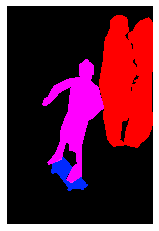

(640, 428, 3)
COCO_val2014_000000399605.jpg
{'person_bbx': [149.66, 264.08, 195.32999999999998, 329.38], 'Verbs': 'look', 'object': {'obj_bbx': [96.32, 327.74, 202.89, 336.96000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [149.66, 264.08, 195.32999999999998, 329.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [149.66, 264.08, 195.32999999999998, 329.38], 'Verbs': 'surf', 'object': {'obj_bbx': [96.32, 327.74, 202.89, 336.96000000000004]}}
person
surfboard
surf
surf interaction


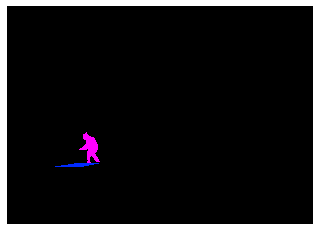

(456, 640, 3)
COCO_val2014_000000549754.jpg
{'person_bbx': [121.62, 23.42, 487.39, 343.24], 'Verbs': 'hold', 'object': {'obj_bbx': [324.49, 171.69, 576.1800000000001, 379.33]}}
person
snowboard
hold
hold interaction
{'person_bbx': [121.62, 23.42, 487.39, 343.24], 'Verbs': 'look', 'object': {'obj_bbx': [324.49, 171.69, 576.1800000000001, 379.33]}}
person
snowboard
look
look interaction
{'person_bbx': [121.62, 23.42, 487.39, 343.24], 'Verbs': 'snowboard', 'object': {'obj_bbx': [324.49, 171.69, 576.1800000000001, 379.33]}}
person
snowboard
snowboard
snowboard interaction


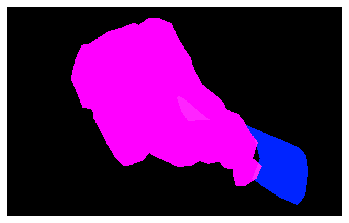

(400, 640, 3)
COCO_val2014_000000400794.jpg
{'person_bbx': [0.0, 1.83, 425.91, 577.11], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [55.83, 473.42, 122.52, 535.28]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 1.83, 425.91, 577.11], 'Verbs': 'hold', 'object': {'obj_bbx': [55.83, 473.42, 122.52, 535.28]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 1.83, 425.91, 577.11], 'Verbs': 'look', 'object': {'obj_bbx': [55.83, 473.42, 122.52, 535.28]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 1.83, 425.91, 577.11], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 1.83, 425.91, 577.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


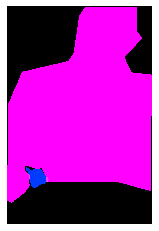

(640, 426, 3)
COCO_val2014_000000418143.jpg
{'person_bbx': [189.34, 286.99, 216.09, 357.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [142.97, 287.93, 168.02, 359.49], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [189.34, 286.99, 216.09, 357.68], 'Verbs': 'ski', 'object': {'obj_bbx': [195.82, 355.75, 212.97, 363.94]}}
person
skis
ski
ski interaction
{'person_bbx': [142.97, 287.93, 168.02, 359.49], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [189.34, 286.99, 216.09, 357.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [142.97, 287.93, 168.02, 359.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


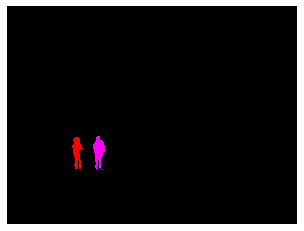

(480, 640, 3)
COCO_val2014_000000121748.jpg
{'person_bbx': [2.88, 87.21, 273.87, 636.4000000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [90.12, 193.29, 128.91, 281.19]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [212.55, 231.14, 460.78, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [337.1, 353.91, 367.24, 492.06000000000006]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [2.88, 87.21, 273.87, 636.4000000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [90.12, 193.29, 128.91, 281.19]}}
person
carrot
hold
hold interaction
{'person_bbx': [212.55, 231.14, 460.78, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [337.1, 353.91, 367.24, 492.06000000000006]}}
person
carrot
hold
hold interaction
{'person_bbx': [212.55, 231.14, 460.78, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 313.29, 480.0, 631.13]}}
bed
person
sit
sit interaction
{'person_bbx': [2.88, 87.21, 273.87, 636.4000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


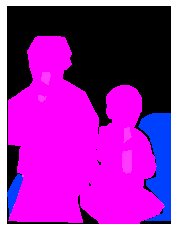

(640, 480, 3)
COCO_val2014_000000007789.jpg
{'person_bbx': [76.15, 3.13, 637.13, 417.6], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [76.15, 3.13, 637.13, 417.6], 'Verbs': 'lay', 'object': {'obj_bbx': [1.91, 137.65, 640.0, 421.36]}}
bed
person
lay
lay interaction


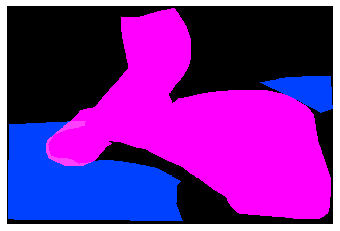

(427, 640, 3)
COCO_val2014_000000365325.jpg
{'person_bbx': [0.96, 1.91, 608.84, 402.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [336.62, 343.37, 408.69, 400.9]}}
person
remote
hold
hold interaction
{'person_bbx': [0.96, 1.91, 608.84, 402.07000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [0.11, 0.92, 640.0, 290.1]}}
couch
person
sit
sit interaction


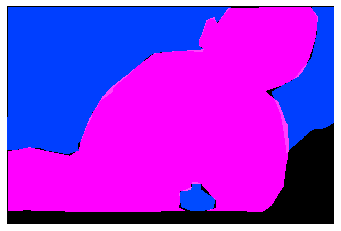

(426, 640, 3)
COCO_val2014_000000440093.jpg
{'person_bbx': [146.67, 139.54, 276.21, 362.03999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [117.64, 357.37, 244.89, 406.41]}}
person
skateboard
jump
jump interaction
{'person_bbx': [146.67, 139.54, 276.21, 362.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [117.64, 357.37, 244.89, 406.41]}}
person
skateboard
look
look interaction
{'person_bbx': [146.67, 139.54, 276.21, 362.03999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [117.64, 357.37, 244.89, 406.41]}}
person
skateboard
skateboard
skateboard interaction


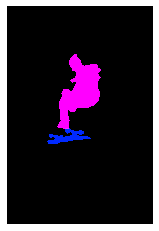

(640, 427, 3)
COCO_val2014_000000182785.jpg
{'person_bbx': [70.21, 75.82, 333.73999999999995, 300.88], 'Verbs': 'jump', 'object': {'obj_bbx': [261.98, 185.32, 347.39, 312.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [509.39, 39.35, 640.0, 328.51000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [70.21, 75.82, 333.73999999999995, 300.88]}}
person
person
look
look interaction
{'person_bbx': [70.21, 75.82, 333.73999999999995, 300.88], 'Verbs': 'look', 'object': {'obj_bbx': [261.98, 185.32, 347.39, 312.0]}}
person
skateboard
look
look interaction
{'person_bbx': [506.69, 247.59, 640.0, 427.81], 'Verbs': 'look', 'object': {'obj_bbx': [70.21, 75.82, 333.73999999999995, 300.88]}}
person
person
look
look interaction
{'person_bbx': [509.39, 39.35, 640.0, 328.51000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [506.69, 247.59, 640.0, 427.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [70.21, 75.82, 333.73999999999995, 

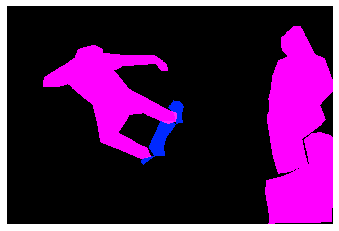

(428, 640, 3)
COCO_val2014_000000083408.jpg
{'person_bbx': [235.09, 207.26, 425.08000000000004, 404.92999999999995], 'Verbs': 'surf', 'object': {'obj_bbx': [135.47, 364.67, 369.81, 412.05]}}
person
surfboard
surf
surf interaction


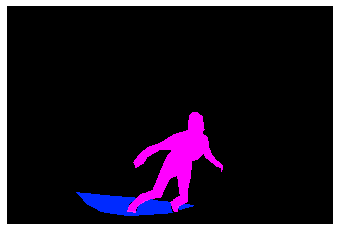

(427, 640, 3)
COCO_val2014_000000416730.jpg
{'person_bbx': [0.0, 11.55, 480.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [317.94, 157.03, 366.72, 249.7]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 11.55, 480.0, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 11.55, 480.0, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [317.94, 157.03, 366.72, 249.7]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


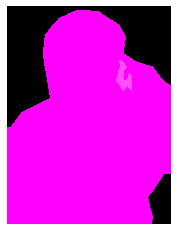

(640, 480, 3)
COCO_val2014_000000153931.jpg
{'person_bbx': [248.09, 52.85, 583.55, 470.29], 'Verbs': 'hold', 'object': {'obj_bbx': [307.54, 135.24, 366.53000000000003, 188.39000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [248.09, 52.85, 583.55, 470.29], 'Verbs': 'sit', 'object': {'obj_bbx': [556.0, 210.75, 639.81, 350.94]}}
person
bench
sit
sit interaction
{'person_bbx': [248.09, 52.85, 583.55, 470.29], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [307.54, 135.24, 366.53000000000003, 188.39000000000001]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


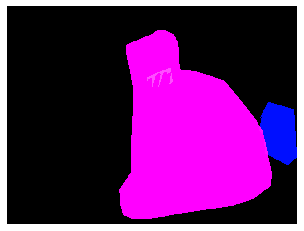

(480, 640, 3)
COCO_val2014_000000068674.jpg
{'person_bbx': [214.17, 80.63, 424.58, 321.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [164.38, 120.08, 640.0, 418.0]}}
person
suitcase
sit
sit interaction
{'person_bbx': [214.17, 80.63, 424.58, 321.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


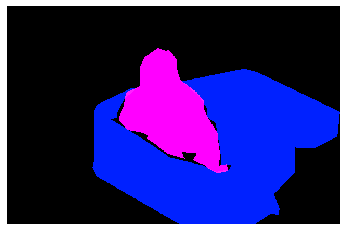

(418, 640, 3)
COCO_val2014_000000568132.jpg
{'person_bbx': [212.49, 84.13, 449.8, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [154.92, 162.12, 205.31, 219.71]}}
sports ball
person
look
look interaction
{'person_bbx': [212.49, 84.13, 449.8, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [212.49, 84.13, 449.8, 474.61], 'Verbs': 'throw', 'object': {'obj_bbx': [154.92, 162.12, 205.31, 219.71]}}
sports ball
person
throw
throw interaction


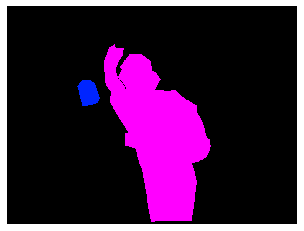

(480, 640, 3)
COCO_val2014_000000410942.jpg
{'person_bbx': [169.35, 154.25, 319.28, 416.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [56.22, 143.24, 172.97, 442.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [169.35, 154.25, 319.28, 416.36], 'Verbs': 'ski', 'object': {'obj_bbx': [179.06, 415.35, 265.35, 461.73]}}
person
skis
ski
ski interaction
{'person_bbx': [56.22, 143.24, 172.97, 442.7], 'Verbs': 'ski', 'object': {'obj_bbx': [31.42, 385.46, 199.37, 473.22999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [338.84, 147.41, 417.0, 387.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [169.35, 154.25, 319.28, 416.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [56.22, 143.24, 172.97, 442.7], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [338.84, 147.41, 417.0, 387.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'perso

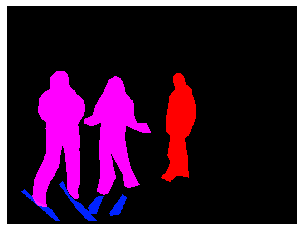

(480, 640, 3)
COCO_val2014_000000284379.jpg
{'person_bbx': [172.52, 80.37, 464.48, 233.3], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [172.52, 80.37, 464.48, 233.3], 'Verbs': 'surf', 'object': {'obj_bbx': [225.83, 185.79, 474.02, 267.27]}}
surfboard
person
surf
surf interaction


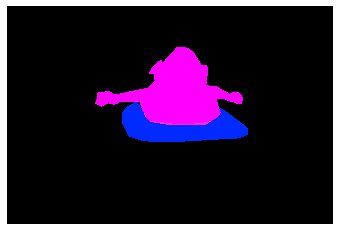

(427, 640, 3)
COCO_val2014_000000341828.jpg
{'person_bbx': [0.0, 4.13, 601.0, 603.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 4.13, 601.0, 603.75], 'Verbs': 'look', 'object': {'obj_bbx': [37.65, 440.64, 287.17, 606.68]}}
person
sandwich
look
look interaction
{'person_bbx': [0.0, 4.13, 601.0, 603.75], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 4.13, 601.0, 603.75], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [338.7, 259.06, 440.34, 402.05]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


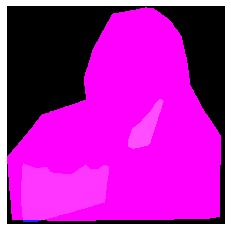

(612, 612, 3)
COCO_val2014_000000553709.jpg
{'person_bbx': [1.44, 37.39, 404.13, 628.49], 'Verbs': 'drink', 'object': {'obj_bbx': [53.03, 372.19, 306.28999999999996, 636.65]}}
person
cup
drink
drink interaction
{'person_bbx': [1.44, 37.39, 404.13, 628.49], 'Verbs': 'hold', 'object': {'obj_bbx': [53.03, 372.19, 306.28999999999996, 636.65]}}
person
cup
hold
hold interaction
{'person_bbx': [1.44, 37.39, 404.13, 628.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


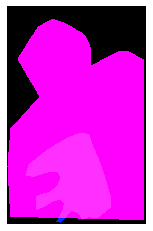

(640, 409, 3)
COCO_val2014_000000212704.jpg
{'person_bbx': [18.1, 0.95, 242.97, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [263.93, 167.76, 494.51, 417.39], 'Verbs': 'look', 'object': {'obj_bbx': [495.0, 209.5, 640.0, 417.5]}}
tv
person
look
look interaction
{'person_bbx': [18.1, 0.95, 242.97, 424.0], 'Verbs': 'look', 'object': {'obj_bbx': [495.0, 209.5, 640.0, 417.5]}}
tv
person
look
look interaction
{'person_bbx': [263.93, 167.76, 494.51, 417.39], 'Verbs': 'sit', 'object': {'obj_bbx': [257.49, 331.5, 471.31, 405.2]}}
chair
person
sit
sit interaction
{'person_bbx': [263.93, 167.76, 494.51, 417.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [18.1, 0.95, 242.97, 424.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [18.1, 0.95, 242.97, 424.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [263.93, 167.76, 494.51, 417.39], 'Verbs': 'work_on_computer', 'object': {'obj_b

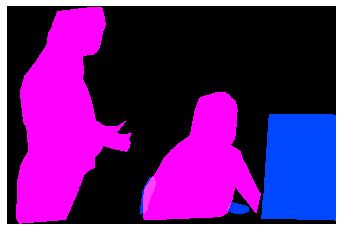

(424, 640, 3)
COCO_val2014_000000076956.jpg
{'person_bbx': [288.06, 117.63, 579.77, 383.34], 'Verbs': 'hold', 'object': {'obj_bbx': [468.96, 118.56, 479.02, 127.22]}}
sports ball
person
hold
hold interaction
{'person_bbx': [288.06, 117.63, 579.77, 383.34], 'Verbs': 'throw', 'object': {'obj_bbx': [468.96, 118.56, 479.02, 127.22]}}
sports ball
person
throw
throw interaction


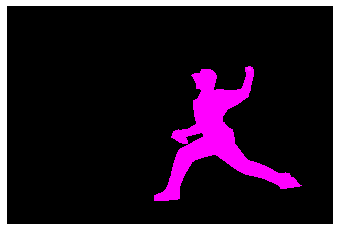

(428, 640, 3)
COCO_val2014_000000394535.jpg
{'person_bbx': [353.45, 172.58, 466.16999999999996, 421.91], 'Verbs': 'carry', 'object': {'obj_bbx': [98.55, 239.14, 461.14, 396.63]}}
person
backpack
carry
carry interaction
{'person_bbx': [157.37, 174.64, 256.2, 421.24], 'Verbs': 'carry', 'object': {'obj_bbx': [75.8, 243.03, 213.25, 410.69]}}
person
handbag
carry
carry interaction
{'person_bbx': [353.45, 172.58, 466.16999999999996, 421.91], 'Verbs': 'hold', 'object': {'obj_bbx': [214.71, 85.64, 560.89, 420.96999999999997]}}
person
surfboard
hold
hold interaction
{'person_bbx': [157.37, 174.64, 256.2, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [98.55, 239.14, 461.14, 396.63]}}
person
backpack
hold
hold interaction
{'person_bbx': [353.45, 172.58, 466.16999999999996, 421.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [157.37, 174.64, 256.2, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.45, 172.58, 466.16999999999996, 

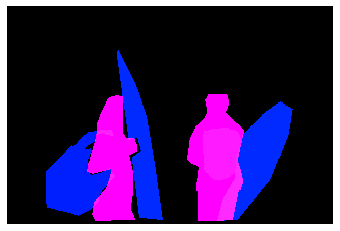

(427, 640, 3)
COCO_val2014_000000487898.jpg
{'person_bbx': [138.95, 33.38, 327.51, 351.08], 'Verbs': 'kick', 'object': {'obj_bbx': [58.0, 345.49, 136.69, 418.7]}}
sports ball
person
kick
kick interaction
{'person_bbx': [138.95, 33.38, 327.51, 351.08], 'Verbs': 'look', 'object': {'obj_bbx': [58.0, 345.49, 136.69, 418.7]}}
sports ball
person
look
look interaction
{'person_bbx': [138.95, 33.38, 327.51, 351.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [138.95, 33.38, 327.51, 351.08], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


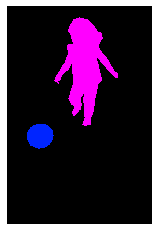

(640, 426, 3)
COCO_val2014_000000043314.jpg
{'person_bbx': [199.9, 98.18, 334.8, 205.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [198.01, 100.8, 333.63, 205.48000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [199.9, 98.18, 334.8, 205.21], 'Verbs': 'jump', 'object': {'obj_bbx': [140.55, 60.79, 319.38, 243.42]}}
person
skis
jump
jump interaction
{'person_bbx': [198.01, 100.8, 333.63, 205.48000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [140.55, 60.79, 319.38, 243.42]}}
person
skis
jump
jump interaction
{'person_bbx': [199.9, 98.18, 334.8, 205.21], 'Verbs': 'look', 'object': {'obj_bbx': [140.55, 60.79, 319.38, 243.42]}}
person
skis
look
look interaction
{'person_bbx': [198.01, 100.8, 333.63, 205.48000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [140.55, 60.79, 319.38, 243.42]}}
person
skis
look
look interaction
{'person_bbx': [199.9, 98.18, 334.8, 205.21], 'Verbs': 'ski', 'object': {'obj_bbx': [140.55, 60.79

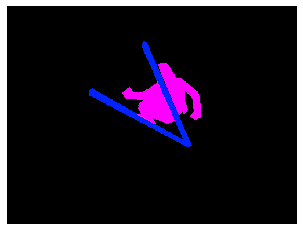

(376, 500, 3)
COCO_val2014_000000250619.jpg
{'person_bbx': [263.82, 298.86, 454.06, 366.29], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


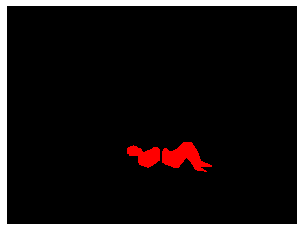

(481, 640, 3)
COCO_val2014_000000399839.jpg
{'person_bbx': [0.0, 5.59, 578.99, 603.84], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [207.67, 259.93, 539.11, 603.75]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 5.59, 578.99, 603.84], 'Verbs': 'hold', 'object': {'obj_bbx': [207.67, 259.93, 539.11, 603.75]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 5.59, 578.99, 603.84], 'Verbs': 'look', 'object': {'obj_bbx': [207.67, 259.93, 539.11, 603.75]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 5.59, 578.99, 603.84], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


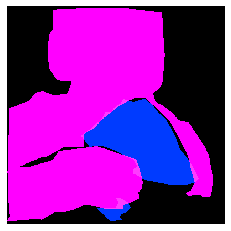

(612, 612, 3)
COCO_val2014_000000173959.jpg
{'person_bbx': [250.81, 78.52, 397.76, 352.28999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [201.56, 322.01, 255.05, 357.36]}}
sports ball
person
kick
kick interaction
{'person_bbx': [250.81, 78.52, 397.76, 352.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [433.31, 99.63, 518.54, 323.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [201.56, 322.01, 255.05, 357.36]}}
sports ball
person
look
look interaction
{'person_bbx': [0.96, 40.87, 116.36999999999999, 264.95], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [528.71, 25.91, 640.0, 221.66], 'Verbs': 'look', 'object': {'obj_bbx': [250.81, 78.52, 397.76, 352.28999999999996]}}
person
person
look
look interaction
{'person_bbx': [250.81, 78.52, 397.76, 352.28999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [433.31, 99.63, 518.54, 323.91999999999996], 'Verbs': 'run', 'object': {'obj_bb

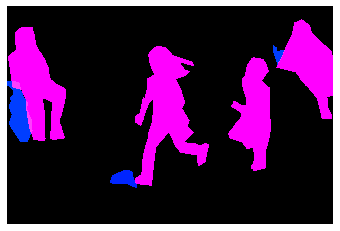

(427, 640, 3)
COCO_val2014_000000442245.jpg
{'person_bbx': [163.12, 58.53, 450.03000000000003, 401.09000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [534.27, 351.06, 596.5699999999999, 403.53]}}
sports ball
person
kick
kick interaction
{'person_bbx': [443.44, 60.49, 619.2, 361.13], 'Verbs': 'kick', 'object': {'obj_bbx': [534.27, 351.06, 596.5699999999999, 403.53]}}
sports ball
person
kick
kick interaction
{'person_bbx': [163.12, 58.53, 450.03000000000003, 401.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [534.27, 351.06, 596.5699999999999, 403.53]}}
sports ball
person
look
look interaction
{'person_bbx': [443.44, 60.49, 619.2, 361.13], 'Verbs': 'look', 'object': {'obj_bbx': [534.27, 351.06, 596.5699999999999, 403.53]}}
sports ball
person
look
look interaction
{'person_bbx': [58.78, 27.73, 189.65, 381.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [163.12, 58.53, 450.03000000000003, 401.09000000000003], 'Verbs': 'run', 'object': {

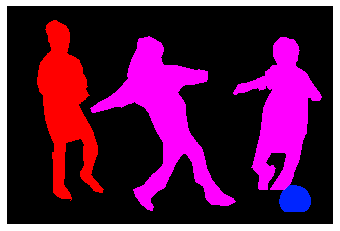

(427, 640, 3)
COCO_val2014_000000170208.jpg
{'person_bbx': [205.26, 110.59, 388.1, 306.15999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [312.88, 275.05, 457.77, 359.68]}}
person
surfboard
surf
surf interaction


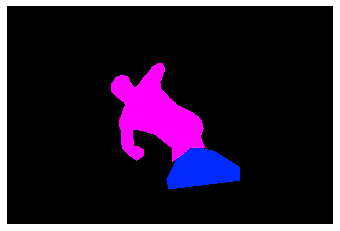

(427, 640, 3)
COCO_val2014_000000150649.jpg
{'person_bbx': [108.67, 145.65, 187.98000000000002, 266.91], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [119.79, 22.15, 193.17000000000002, 129.85], 'Verbs': 'look', 'object': {'obj_bbx': [116.6, 121.26, 152.89999999999998, 133.76]}}
person
skateboard
look
look interaction
{'person_bbx': [203.39, 21.25, 274.66999999999996, 121.9], 'Verbs': 'look', 'object': {'obj_bbx': [198.25, 116.64, 240.28, 127.06]}}
person
skateboard
look
look interaction
{'person_bbx': [447.22, 140.97, 500.0, 292.99], 'Verbs': 'look', 'object': {'obj_bbx': [316.52, 37.05, 376.21, 128.11]}}
person
person
look
look interaction
{'person_bbx': [316.52, 37.05, 376.21, 128.11], 'Verbs': 'look', 'object': {'obj_bbx': [327.53, 119.46, 377.28, 135.32]}}
skateboard
person
look
look interaction
{'person_bbx': [108.67, 145.65, 187.98000000000002, 266.91], 'Verbs': 'skateboard', 'object': {'obj_bbx': [113.38, 234.25, 146.7, 273.59000000000003]}}
person
ska

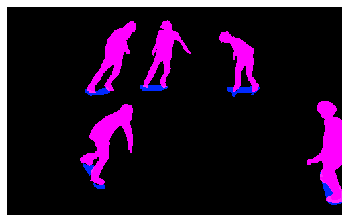

(311, 500, 3)
COCO_val2014_000000450970.jpg
{'person_bbx': [341.22, 209.21, 397.63, 361.95000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [348.12, 229.98, 384.98, 287.03999999999996]}}
person
backpack
carry
carry interaction
{'person_bbx': [341.22, 209.21, 397.63, 361.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [365.88, 302.06, 404.31, 357.41]}}
person
suitcase
hold
hold interaction
{'person_bbx': [226.83, 209.85, 307.06, 359.0], 'Verbs': 'hold', 'object': {'obj_bbx': [279.51, 268.22, 322.82, 357.29]}}
suitcase
person
hold
hold interaction
{'person_bbx': [341.22, 209.21, 397.63, 361.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [94.71, 215.8, 149.06, 361.27], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [226.83, 209.85, 307.06, 359.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [341.22, 209.21, 397.63, 361.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
perso

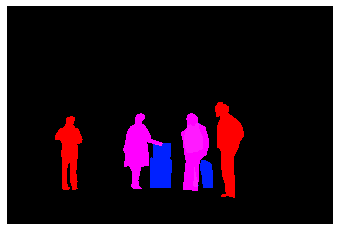

(427, 640, 3)
COCO_val2014_000000272678.jpg
{'person_bbx': [6.2, 129.11, 220.78, 461.52000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [363.77, 97.76, 638.62, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [6.2, 129.11, 220.78, 461.52000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [363.77, 97.76, 638.62, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [6.2, 129.11, 220.78, 461.52000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [363.77, 97.76, 638.62, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [339.28, 185.64, 506.64, 333.61]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [6.2, 129.11, 220.78, 461.52000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [154.63, 232.66, 277.05, 335.75]}}
laptop
person
work_on_computer
work_on_computer interaction


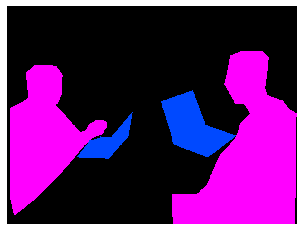

(480, 640, 3)
COCO_val2014_000000152492.jpg
{'person_bbx': [348.04, 258.88, 504.81000000000006, 450.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [400.7, 345.38, 420.05, 419.77]}}
tie
person
hold
hold interaction
{'person_bbx': [348.04, 258.88, 504.81000000000006, 450.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [271.71, 374.14, 417.53, 462.32]}}
person
laptop
look
look interaction
{'person_bbx': [348.04, 258.88, 504.81000000000006, 450.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [481.3, 348.85, 534.5600000000001, 450.13]}}
person
chair
sit
sit interaction
{'person_bbx': [348.04, 258.88, 504.81000000000006, 450.15999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [348.04, 258.88, 504.81000000000006, 450.15999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [271.71, 374.14, 417.53, 462.32]}}
person
laptop
work_on_computer
work_on_computer interaction


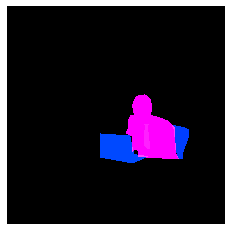

(640, 640, 3)
COCO_val2014_000000044312.jpg
{'person_bbx': [24.79, 147.15, 185.48999999999998, 423.56000000000006], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [24.79, 147.15, 185.48999999999998, 423.56000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [24.79, 147.15, 185.48999999999998, 423.56000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [24.79, 147.15, 185.48999999999998, 423.56000000000006], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


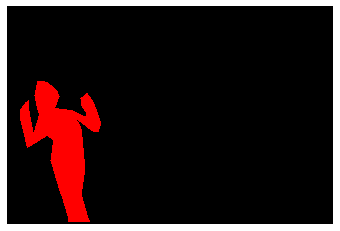

(427, 640, 3)
COCO_val2014_000000443218.jpg
{'person_bbx': [158.39, 186.11, 366.48, 303.35], 'Verbs': 'lay', 'object': {'obj_bbx': [15.28, 8.69, 640.0, 408.94]}}
bed
person
lay
lay interaction


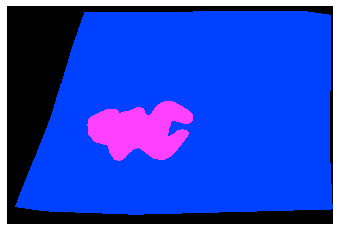

(427, 640, 3)
COCO_val2014_000000140860.jpg
{'person_bbx': [212.03, 96.85, 449.69, 411.01], 'Verbs': 'hold', 'object': {'obj_bbx': [314.73, 265.8, 459.62, 331.04]}}
laptop
person
hold
hold interaction
{'person_bbx': [212.03, 96.85, 449.69, 411.01], 'Verbs': 'look', 'object': {'obj_bbx': [314.73, 265.8, 459.62, 331.04]}}
laptop
person
look
look interaction
{'person_bbx': [212.03, 96.85, 449.69, 411.01], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [212.03, 96.85, 449.69, 411.01], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [314.73, 265.8, 459.62, 331.04]}}
laptop
person
work_on_computer
work_on_computer interaction


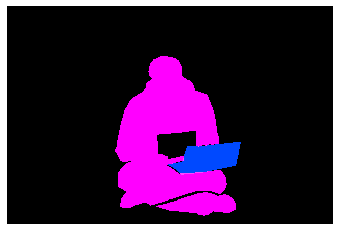

(427, 640, 3)
COCO_val2014_000000436795.jpg
{'person_bbx': [1.25, 0.0, 509.92, 471.27], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [353.13, 255.21, 442.47, 347.38]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [1.25, 0.0, 509.92, 471.27], 'Verbs': 'hold', 'object': {'obj_bbx': [353.13, 255.21, 442.47, 347.38]}}
hot dog
person
hold
hold interaction
{'person_bbx': [1.25, 0.0, 509.92, 471.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


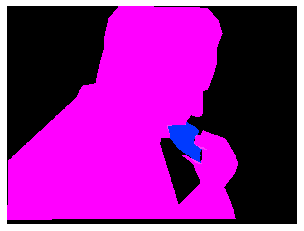

(480, 640, 3)
COCO_val2014_000000025057.jpg
{'person_bbx': [127.99, 6.25, 428.89, 422.74], 'Verbs': 'hold', 'object': {'obj_bbx': [409.67, 110.71, 426.1, 160.16]}}
bottle
person
hold
hold interaction
{'person_bbx': [127.99, 6.25, 428.89, 422.74], 'Verbs': 'look', 'object': {'obj_bbx': [332.0, 129.25, 422.2, 204.09]}}
frisbee
person
look
look interaction
{'person_bbx': [127.99, 6.25, 428.89, 422.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [127.99, 6.25, 428.89, 422.74], 'Verbs': 'throw', 'object': {'obj_bbx': [332.0, 129.25, 422.2, 204.09]}}
frisbee
person
throw
throw interaction
{'person_bbx': [127.99, 6.25, 428.89, 422.74], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


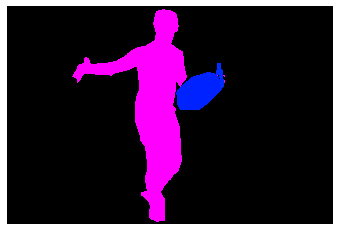

(427, 640, 3)
COCO_val2014_000000256601.jpg
{'person_bbx': [167.7, 131.56, 335.39, 520.62], 'Verbs': 'carry', 'object': {'obj_bbx': [187.68, 510.03, 307.17, 597.0]}}
person
suitcase
carry
carry interaction
{'person_bbx': [167.7, 131.56, 335.39, 520.62], 'Verbs': 'hold', 'object': {'obj_bbx': [187.68, 510.03, 307.17, 597.0]}}
person
suitcase
hold
hold interaction
{'person_bbx': [338.25, 133.13, 468.53, 559.5899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [342.41, 199.62, 383.1, 361.0]}}
person
handbag
hold
hold interaction
{'person_bbx': [167.7, 131.56, 335.39, 520.62], 'Verbs': 'look', 'object': {'obj_bbx': [338.25, 133.13, 468.53, 559.5899999999999]}}
person
person
look
look interaction
{'person_bbx': [338.25, 133.13, 468.53, 559.5899999999999], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [167.7, 131.56, 335.39, 520.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [338.25, 133.13, 468.53, 559.5899999999999], 'Verbs': 'stand

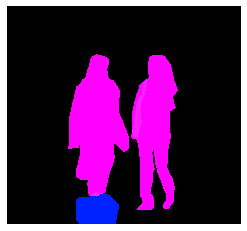

(597, 640, 3)
COCO_val2014_000000014151.jpg
{'person_bbx': [149.19, 166.84, 206.67, 235.39], 'Verbs': 'jump', 'object': {'obj_bbx': [125.51, 197.4, 237.59, 252.64000000000001]}}
person
skis
jump
jump interaction
{'person_bbx': [149.19, 166.84, 206.67, 235.39], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [149.19, 166.84, 206.67, 235.39], 'Verbs': 'ski', 'object': {'obj_bbx': [125.51, 197.4, 237.59, 252.64000000000001]}}
person
skis
ski
ski interaction


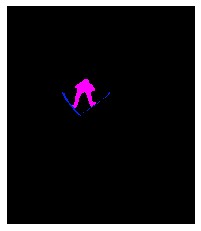

(500, 431, 3)
COCO_val2014_000000016744.jpg
{'person_bbx': [102.61, 100.35, 233.89999999999998, 258.03999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [90.34, 231.11, 277.78999999999996, 264.99]}}
person
snowboard
jump
jump interaction
{'person_bbx': [102.61, 100.35, 233.89999999999998, 258.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [90.34, 231.11, 277.78999999999996, 264.99]}}
person
snowboard
look
look interaction
{'person_bbx': [102.61, 100.35, 233.89999999999998, 258.03999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [90.34, 231.11, 277.78999999999996, 264.99]}}
person
snowboard
snowboard
snowboard interaction


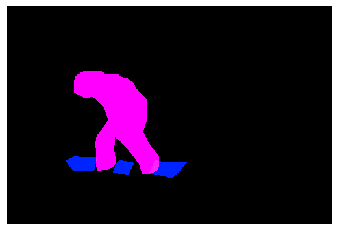

(335, 500, 3)
COCO_val2014_000000314074.jpg
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [206.61, 297.83, 270.47, 364.5]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [252.24, 117.85, 418.39, 400.39]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'hold', 'object': {'obj_bbx': [206.61, 297.83, 270.47, 364.5]}}
knife
person
hold
hold interaction
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'look', 'object': {'obj_bbx': [271.82, 232.99, 403.41999999999996, 339.78000000000003]}}
cake
person
look
look interaction
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 17.26, 288.0, 472.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


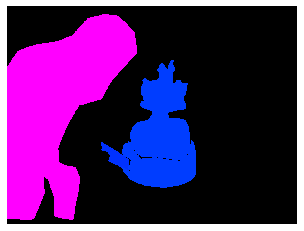

(480, 640, 3)
COCO_val2014_000000269346.jpg
{'person_bbx': [76.54, 273.03, 232.3, 614.47], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [49.39, 388.27, 83.25, 435.78999999999996]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [76.54, 273.03, 232.3, 614.47], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [242.94, 106.61, 254.89, 118.35]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [76.54, 273.03, 232.3, 614.47], 'Verbs': 'hold', 'object': {'obj_bbx': [49.39, 388.27, 83.25, 435.78999999999996]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [76.54, 273.03, 232.3, 614.47], 'Verbs': 'look', 'object': {'obj_bbx': [242.94, 106.61, 254.89, 118.35]}}
sports ball
person
look
look interaction
{'person_bbx': [76.54, 273.03, 232.3, 614.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


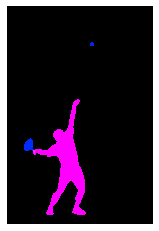

(640, 427, 3)
COCO_val2014_000000253757.jpg
{'person_bbx': [276.24, 118.45, 396.73, 321.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [276.24, 118.45, 396.73, 321.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [276.24, 118.45, 396.73, 321.02], 'Verbs': 'throw', 'object': {'obj_bbx': [18.92, 535.84, 39.32, 564.8000000000001]}}
person
sports ball
throw
throw interaction


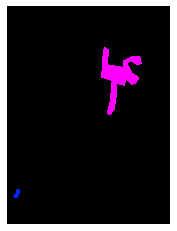

(640, 479, 3)
COCO_val2014_000000180524.jpg
{'person_bbx': [73.11, 139.63, 128.41, 272.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [116.93, 111.45, 196.29000000000002, 224.32999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [22.12, 198.13, 348.17, 422.23]}}
person
elephant
ride
ride interaction
{'person_bbx': [73.11, 139.63, 128.41, 272.21000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [22.12, 198.13, 348.17, 422.23]}}
person
elephant
ride
ride interaction
{'person_bbx': [116.93, 111.45, 196.29000000000002, 224.32999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [132.94, 160.76, 210.82999999999998, 220.14999999999998]}}
person
bench
sit
sit interaction
{'person_bbx': [73.11, 139.63, 128.41, 272.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [22.12, 198.13, 348.17, 422.23]}}
person
elephant
sit
sit interaction


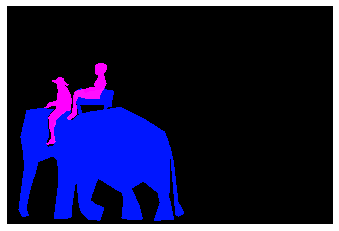

(428, 640, 3)
COCO_val2014_000000049096.jpg
{'person_bbx': [322.87, 240.98, 597.27, 510.93999999999994], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [370.5, 465.11, 469.69, 488.66]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [322.87, 240.98, 597.27, 510.93999999999994], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [322.87, 240.98, 597.27, 510.93999999999994], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


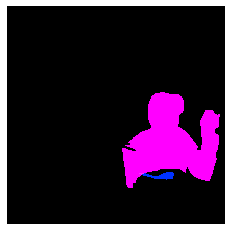

(612, 612, 3)
COCO_val2014_000000221433.jpg
{'person_bbx': [143.39, 40.13, 286.77, 171.04999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [170.71, 75.88, 278.08000000000004, 307.15999999999997]}}
surfboard
person
look
look interaction
{'person_bbx': [143.39, 40.13, 286.77, 171.04999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [143.39, 40.13, 286.77, 171.04999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [170.71, 75.88, 278.08000000000004, 307.15999999999997]}}
surfboard
person
surf
surf interaction


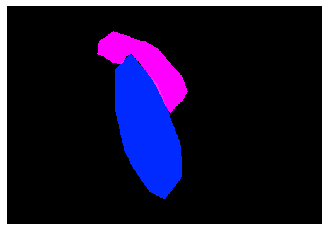

(346, 500, 3)
COCO_val2014_000000154589.jpg
{'person_bbx': [133.45, 77.28, 300.67999999999995, 369.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.45, 77.28, 300.67999999999995, 369.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


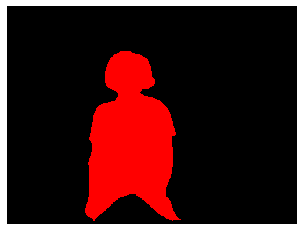

(375, 500, 3)
COCO_val2014_000000428830.jpg
{'person_bbx': [76.14, 210.69, 334.13, 482.59], 'Verbs': 'hold', 'object': {'obj_bbx': [116.96, 428.66, 341.11, 553.03]}}
person
skateboard
hold
hold interaction
{'person_bbx': [76.14, 210.69, 334.13, 482.59], 'Verbs': 'jump', 'object': {'obj_bbx': [116.96, 428.66, 341.11, 553.03]}}
person
skateboard
jump
jump interaction
{'person_bbx': [76.14, 210.69, 334.13, 482.59], 'Verbs': 'look', 'object': {'obj_bbx': [116.96, 428.66, 341.11, 553.03]}}
person
skateboard
look
look interaction
{'person_bbx': [76.14, 210.69, 334.13, 482.59], 'Verbs': 'skateboard', 'object': {'obj_bbx': [116.96, 428.66, 341.11, 553.03]}}
person
skateboard
skateboard
skateboard interaction


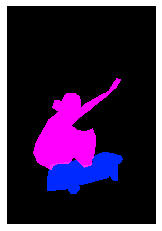

(640, 437, 3)
COCO_val2014_000000210890.jpg
{'person_bbx': [199.2, 2.24, 329.02, 230.53], 'Verbs': 'snowboard', 'object': {'obj_bbx': [111.91, 152.94, 418.53999999999996, 258.89]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [20.28, 0.59, 165.86, 165.13], 'Verbs': 'snowboard', 'object': {'obj_bbx': [94.68, 90.39, 231.76000000000002, 156.95]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [199.2, 2.24, 329.02, 230.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [20.28, 0.59, 165.86, 165.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


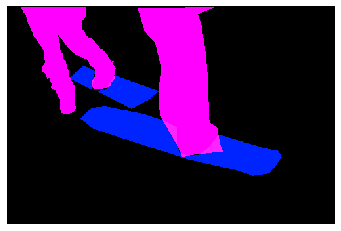

(332, 500, 3)
COCO_val2014_000000227370.jpg
{'person_bbx': [0.91, 0.0, 640.0, 344.08], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [0.91, 0.0, 640.0, 344.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


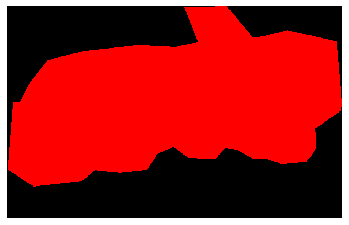

(404, 640, 3)
COCO_val2014_000000443688.jpg
{'person_bbx': [180.25, 79.03, 334.40999999999997, 333.36], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [199.86, 316.81, 211.63000000000002, 342.48]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [180.25, 79.03, 334.40999999999997, 333.36], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [189.08, 325.18, 356.26, 427.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [372.31, 58.53, 526.79, 308.02], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [434.95, 288.62, 455.37, 330.36]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [372.31, 58.53, 526.79, 308.02], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [400.8, 285.86, 547.14, 364.12]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [88.04, 93.39, 219.37, 361.74], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [199.86, 316.81, 211.63000000000002, 342.48]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [88.04, 93.39, 219.37, 361.74], 'Verbs': 'cut_obj'

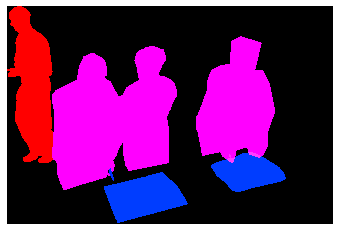

(427, 640, 3)
COCO_val2014_000000449603.jpg
{'person_bbx': [175.98, 198.82, 296.18, 269.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [175.98, 198.82, 296.18, 269.01], 'Verbs': 'surf', 'object': {'obj_bbx': [278.05, 242.53, 294.01, 272.59]}}
person
surfboard
surf
surf interaction


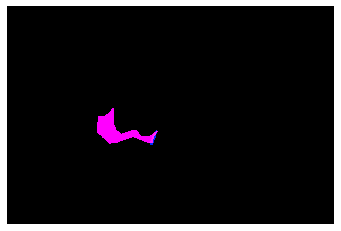

(426, 640, 3)
COCO_val2014_000000204137.jpg
{'person_bbx': [176.12, 157.51, 253.98000000000002, 349.56], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [287.32, 146.61, 371.83, 341.54], 'Verbs': 'kick', 'object': {'obj_bbx': [319.01, 319.42, 351.53999999999996, 352.83000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [287.32, 146.61, 371.83, 341.54], 'Verbs': 'look', 'object': {'obj_bbx': [319.01, 319.42, 351.53999999999996, 352.83000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [176.12, 157.51, 253.98000000000002, 349.56], 'Verbs': 'look', 'object': {'obj_bbx': [319.01, 319.42, 351.53999999999996, 352.83000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [287.32, 146.61, 371.83, 341.54], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [176.12, 157.51, 253.98000000000002, 349.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [287.32, 146.61, 371.83, 341.5

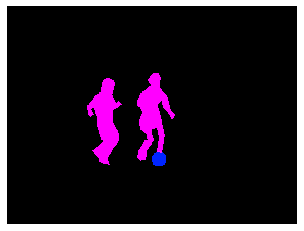

(480, 640, 3)
COCO_val2014_000000319184.jpg
{'person_bbx': [271.54, 88.99, 473.70000000000005, 273.32], 'Verbs': 'hold', 'object': {'obj_bbx': [462.41, 137.26, 488.79, 159.14999999999998]}}
frisbee
person
hold
hold interaction
{'person_bbx': [146.67, 46.95, 289.35, 274.59], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [146.67, 46.95, 289.35, 274.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


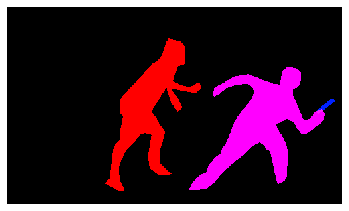

(294, 500, 3)
COCO_val2014_000000144610.jpg
{'person_bbx': [215.42, 102.9, 376.03, 241.39000000000001], 'Verbs': 'jump', 'object': {'obj_bbx': [194.92, 136.83, 355.96, 311.14]}}
person
surfboard
jump
jump interaction
{'person_bbx': [215.42, 102.9, 376.03, 241.39000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [194.92, 136.83, 355.96, 311.14]}}
person
surfboard
look
look interaction
{'person_bbx': [215.42, 102.9, 376.03, 241.39000000000001], 'Verbs': 'surf', 'object': {'obj_bbx': [194.92, 136.83, 355.96, 311.14]}}
person
surfboard
surf
surf interaction


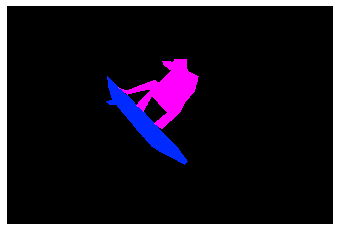

(427, 640, 3)
COCO_val2014_000000208406.jpg
{'person_bbx': [182.13, 0.23, 412.73, 294.15000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [184.82, 296.25, 287.84, 331.35]}}
skateboard
person
jump
jump interaction
{'person_bbx': [182.13, 0.23, 412.73, 294.15000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [184.82, 296.25, 287.84, 331.35]}}
skateboard
person
look
look interaction
{'person_bbx': [182.13, 0.23, 412.73, 294.15000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [184.82, 296.25, 287.84, 331.35]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [182.13, 0.23, 412.73, 294.15000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


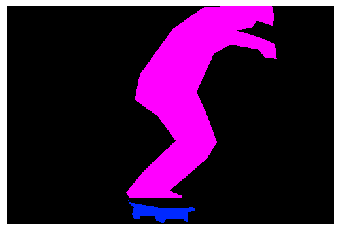

(333, 500, 3)
COCO_val2014_000000290248.jpg
{'person_bbx': [439.57, 342.91, 483.28999999999996, 466.93], 'Verbs': 'hold', 'object': {'obj_bbx': [456.53, 362.05, 478.25, 410.09000000000003]}}
handbag
person
hold
hold interaction
{'person_bbx': [378.73, 330.97, 425.47, 461.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [327.57, 333.91, 355.98, 446.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [439.57, 342.91, 483.28999999999996, 466.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [378.73, 330.97, 425.47, 461.54], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [327.57, 333.91, 355.98, 446.1], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [439.57, 342.91, 483.28999999999996, 466.93], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


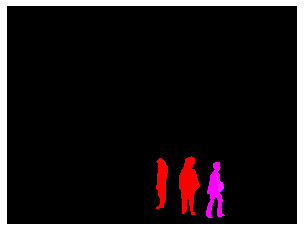

(480, 640, 3)
COCO_val2014_000000106216.jpg
{'person_bbx': [373.98, 72.67, 417.88, 133.15], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [307.15, 71.52, 367.37, 133.25], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [373.98, 72.67, 417.88, 133.15], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [307.15, 71.52, 367.37, 133.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


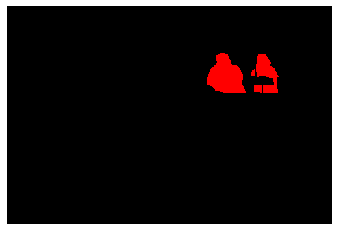

(335, 500, 3)
COCO_val2014_000000422893.jpg
{'person_bbx': [162.03, 234.82, 260.18, 271.82], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [162.03, 234.82, 260.18, 271.82], 'Verbs': 'surf', 'object': {'obj_bbx': [233.46, 261.26, 279.27, 273.44]}}
person
surfboard
surf
surf interaction


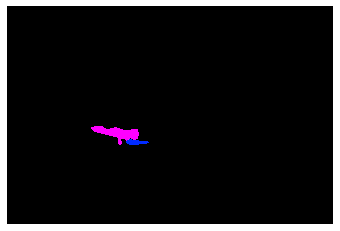

(427, 640, 3)
COCO_val2014_000000168353.jpg
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.14, 402.68, 282.82, 429.88]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [273.26, 337.98, 395.51, 448.72]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'hold', 'object': {'obj_bbx': [266.14, 402.68, 282.82, 429.88]}}
person
knife
hold
hold interaction
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'look', 'object': {'obj_bbx': [273.26, 337.98, 395.51, 448.72]}}
person
cake
look
look interaction
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.43, 9.47, 266.91, 574.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


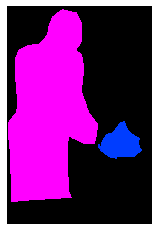

(640, 426, 3)
COCO_val2014_000000260608.jpg
{'person_bbx': [422.2, 48.94, 639.06, 411.65], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [360.49, 104.82, 473.27, 393.99], 'Verbs': 'kick', 'object': {'obj_bbx': [213.38, 344.86, 263.73, 387.18]}}
sports ball
person
kick
kick interaction
{'person_bbx': [422.2, 48.94, 639.06, 411.65], 'Verbs': 'look', 'object': {'obj_bbx': [213.38, 344.86, 263.73, 387.18]}}
sports ball
person
look
look interaction
{'person_bbx': [360.49, 104.82, 473.27, 393.99], 'Verbs': 'look', 'object': {'obj_bbx': [213.38, 344.86, 263.73, 387.18]}}
sports ball
person
look
look interaction
{'person_bbx': [422.2, 48.94, 639.06, 411.65], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [360.49, 104.82, 473.27, 393.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [422.2, 48.94, 639.06, 411.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.49, 104.82, 473.27, 393.99], 'Verb

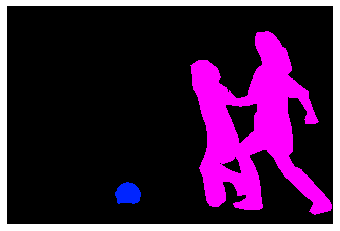

(427, 640, 3)
COCO_val2014_000000103705.jpg
{'person_bbx': [0.0, 232.08, 271.24, 397.3], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 239.72, 303.71, 420.22]}}
bed
person
lay
lay interaction


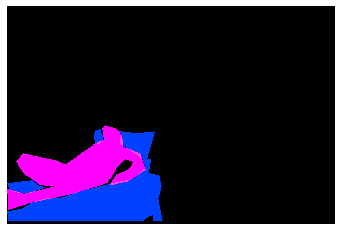

(425, 640, 3)
COCO_val2014_000000371139.jpg
{'person_bbx': [285.23, 476.12, 316.78000000000003, 571.53], 'Verbs': 'carry', 'object': {'obj_bbx': [303.18, 494.25, 327.16, 538.99]}}
handbag
person
carry
carry interaction
{'person_bbx': [407.5, 460.35, 428.0, 531.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [285.23, 476.12, 316.78000000000003, 571.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.55, 506.84, 24.26, 602.9499999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [407.5, 460.35, 428.0, 531.27], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [285.23, 476.12, 316.78000000000003, 571.53], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


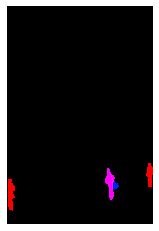

(640, 428, 3)
COCO_val2014_000000108425.jpg
{'person_bbx': [308.88, 263.62, 390.67, 473.49], 'Verbs': 'look', 'object': {'obj_bbx': [361.35, 237.3, 396.94000000000005, 283.69]}}
person
frisbee
look
look interaction
{'person_bbx': [308.88, 263.62, 390.67, 473.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.88, 263.62, 390.67, 473.49], 'Verbs': 'throw', 'object': {'obj_bbx': [361.35, 237.3, 396.94000000000005, 283.69]}}
person
frisbee
throw
throw interaction


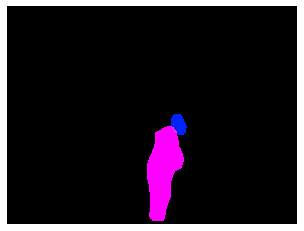

(480, 640, 3)
COCO_val2014_000000245313.jpg
{'person_bbx': [388.31, 154.25, 468.13, 391.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [201.42, 163.06, 255.06, 321.17], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [90.81, 196.22, 156.76, 357.3], 'Verbs': 'ski', 'object': {'obj_bbx': [63.94, 313.35, 182.47, 363.47]}}
skis
person
ski
ski interaction
{'person_bbx': [445.48, 173.66, 508.04, 330.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [388.31, 154.25, 468.13, 391.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [90.81, 196.22, 156.76, 357.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [445.48, 173.66, 508.04, 330.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [388.31, 154.25, 468.13, 391.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [201.42, 163.06, 255.06, 321.17], 'Verbs': 'sta

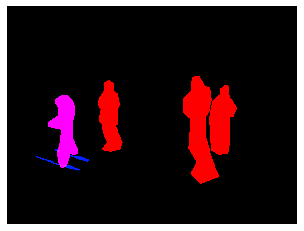

(480, 640, 3)
COCO_val2014_000000371241.jpg
{'person_bbx': [206.43, 66.46, 310.05, 283.27], 'Verbs': 'ski', 'object': {'obj_bbx': [175.34, 270.53, 331.85, 285.19]}}
person
skis
ski
ski interaction
{'person_bbx': [206.43, 66.46, 310.05, 283.27], 'Verbs': 'snowboard', 'object': {'obj_bbx': [178.79, 265.59, 326.4, 287.78]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [206.43, 66.46, 310.05, 283.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [578.89, 126.0, 640.0, 328.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


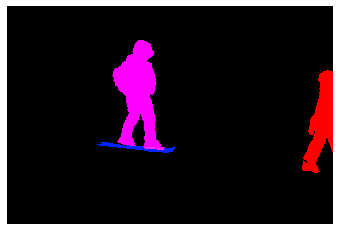

(427, 640, 3)
COCO_val2014_000000457572.jpg
{'person_bbx': [263.29, 74.73, 327.68, 137.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


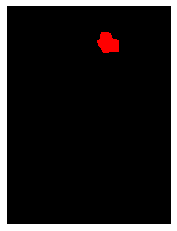

(640, 480, 3)
COCO_val2014_000000170950.jpg
{'person_bbx': [115.06, 71.91, 294.83000000000004, 563.78], 'Verbs': 'carry', 'object': {'obj_bbx': [129.02, 279.93, 241.65, 414.4]}}
handbag
person
carry
carry interaction
{'person_bbx': [115.06, 71.91, 294.83000000000004, 563.78], 'Verbs': 'hold', 'object': {'obj_bbx': [194.49, 453.82, 360.73, 628.36]}}
person
suitcase
hold
hold interaction
{'person_bbx': [115.06, 71.91, 294.83000000000004, 563.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [115.06, 71.91, 294.83000000000004, 563.78], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


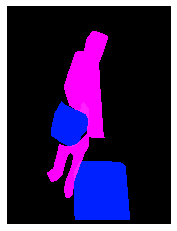

(640, 480, 3)
COCO_val2014_000000391688.jpg
{'person_bbx': [128.53, 14.7, 245.7, 236.25], 'Verbs': 'jump', 'object': {'obj_bbx': [162.33, 226.93, 197.34, 240.15]}}
person
skateboard
jump
jump interaction
{'person_bbx': [342.33, 180.42, 411.37, 312.09], 'Verbs': 'look', 'object': {'obj_bbx': [128.53, 14.7, 245.7, 236.25]}}
person
person
look
look interaction
{'person_bbx': [342.33, 180.42, 411.37, 312.09], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [128.53, 14.7, 245.7, 236.25], 'Verbs': 'skateboard', 'object': {'obj_bbx': [162.33, 226.93, 197.34, 240.15]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [128.53, 14.7, 245.7, 236.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


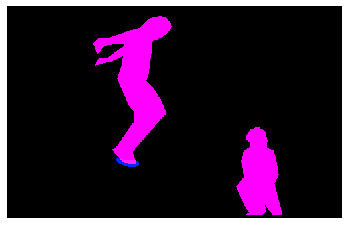

(316, 500, 3)
COCO_val2014_000000455301.jpg
{'person_bbx': [119.9, 37.44, 429.25, 478.07], 'Verbs': 'hold', 'object': {'obj_bbx': [1.29, 380.04, 270.08000000000004, 475.21000000000004]}}
person
book
hold
hold interaction
{'person_bbx': [119.9, 37.44, 429.25, 478.07], 'Verbs': 'look', 'object': {'obj_bbx': [1.29, 380.04, 270.08000000000004, 475.21000000000004]}}
person
book
look
look interaction
{'person_bbx': [119.9, 37.44, 429.25, 478.07], 'Verbs': 'read', 'object': {'obj_bbx': [1.29, 380.04, 270.08000000000004, 475.21000000000004]}}
person
book
read
read interaction
{'person_bbx': [119.9, 37.44, 429.25, 478.07], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 139.13, 204.75, 382.89]}}
person
bed
sit
sit interaction
{'person_bbx': [119.9, 37.44, 429.25, 478.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


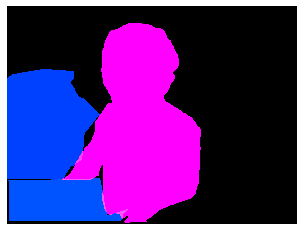

(481, 640, 3)
COCO_val2014_000000169885.jpg
{'person_bbx': [0.84, 49.72, 148.31, 345.51], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [65.82, 249.67, 134.76, 290.32]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.84, 49.72, 148.31, 345.51], 'Verbs': 'hold', 'object': {'obj_bbx': [65.82, 249.67, 134.76, 290.32]}}
person
pizza
hold
hold interaction
{'person_bbx': [189.61, 44.66, 449.16, 331.17999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [80.65, 137.1, 476.61, 314.52]}}
couch
person
sit
sit interaction
{'person_bbx': [0.84, 49.72, 148.31, 345.51], 'Verbs': 'sit', 'object': {'obj_bbx': [80.65, 137.1, 476.61, 314.52]}}
couch
person
sit
sit interaction
{'person_bbx': [189.61, 44.66, 449.16, 331.17999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


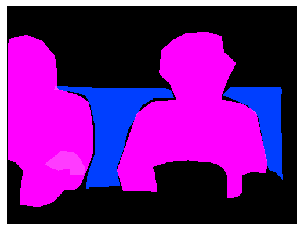

(375, 500, 3)
COCO_val2014_000000185890.jpg
{'person_bbx': [31.11, 39.02, 266.02, 608.14], 'Verbs': 'hold', 'object': {'obj_bbx': [153.35, 159.41, 192.05, 228.85]}}
person
remote
hold
hold interaction
{'person_bbx': [274.08, 80.36, 493.63, 533.81], 'Verbs': 'hold', 'object': {'obj_bbx': [360.3, 141.69, 375.78000000000003, 188.26]}}
person
remote
hold
hold interaction
{'person_bbx': [31.11, 39.02, 266.02, 608.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.08, 80.36, 493.63, 533.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


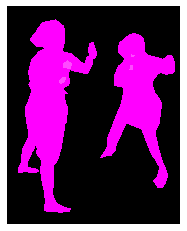

(640, 509, 3)
COCO_val2014_000000327892.jpg
{'person_bbx': [0.75, 74.83, 276.88, 328.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.75, 74.83, 276.88, 328.51], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [202.79, 76.33, 413.07, 327.01]}}
laptop
person
work_on_computer
work_on_computer interaction


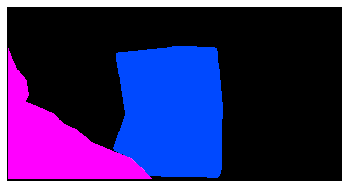

(333, 640, 3)
COCO_val2014_000000441518.jpg
{'person_bbx': [104.33, 7.08, 611.47, 393.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [306.49, 146.53, 460.02, 256.27]}}
person
laptop
hold
hold interaction
{'person_bbx': [104.33, 7.08, 611.47, 393.47999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [306.49, 146.53, 460.02, 256.27]}}
person
laptop
look
look interaction
{'person_bbx': [104.33, 7.08, 611.47, 393.47999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [315.15, 85.2, 640.0, 421.42]}}
couch
person
sit
sit interaction
{'person_bbx': [104.33, 7.08, 611.47, 393.47999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [306.49, 146.53, 460.02, 256.27]}}
person
laptop
work_on_computer
work_on_computer interaction


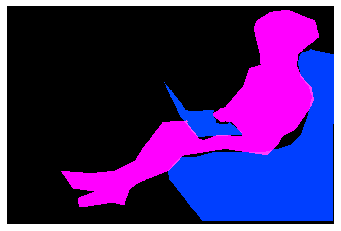

(426, 640, 3)
COCO_val2014_000000476770.jpg
{'person_bbx': [341.95, 30.57, 610.3499999999999, 420.27], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [341.95, 30.57, 610.3499999999999, 420.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


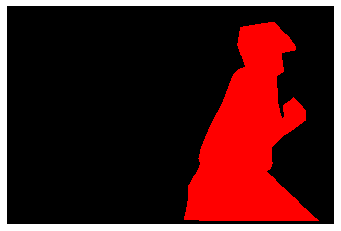

(426, 640, 3)
COCO_val2014_000000167337.jpg
{'person_bbx': [325.29, 192.87, 432.76, 404.93], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [391.89, 162.01, 422.43, 234.54]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [325.29, 192.87, 432.76, 404.93], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [167.68, 184.88, 174.15, 191.35]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [325.29, 192.87, 432.76, 404.93], 'Verbs': 'hold', 'object': {'obj_bbx': [391.89, 162.01, 422.43, 234.54]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [507.6, 229.33, 640.0, 426.04], 'Verbs': 'look', 'object': {'obj_bbx': [167.68, 184.88, 174.15, 191.35]}}
person
sports ball
look
look interaction
{'person_bbx': [325.29, 192.87, 432.76, 404.93], 'Verbs': 'look', 'object': {'obj_bbx': [167.68, 184.88, 174.15, 191.35]}}
person
sports ball
look
look interaction
{'person_bbx': [507.6, 229.33, 640.0, 426.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'perso

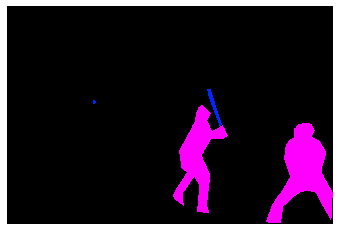

(427, 640, 3)
COCO_val2014_000000219841.jpg
{'person_bbx': [61.67, 211.63, 229.91000000000003, 469.93], 'Verbs': 'catch', 'object': {'obj_bbx': [303.92, 259.28, 354.83000000000004, 283.21]}}
person
frisbee
catch
catch interaction
{'person_bbx': [61.67, 211.63, 229.91000000000003, 469.93], 'Verbs': 'look', 'object': {'obj_bbx': [303.92, 259.28, 354.83000000000004, 283.21]}}
person
frisbee
look
look interaction
{'person_bbx': [61.67, 211.63, 229.91000000000003, 469.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [61.67, 211.63, 229.91000000000003, 469.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


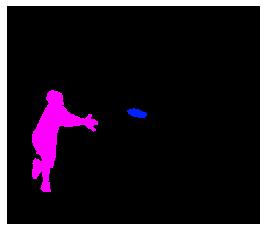

(551, 640, 3)
COCO_val2014_000000351557.jpg
{'person_bbx': [162.39, 259.96, 219.38, 407.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [216.9, 238.45, 291.44, 431.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [239.81, 289.49, 423.9, 440.25]}}
kite
person
hold
hold interaction
{'person_bbx': [115.48, 234.66, 177.87, 401.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [573.3, 270.01, 633.25, 438.22], 'Verbs': 'look', 'object': {'obj_bbx': [239.81, 289.49, 423.9, 440.25]}}
kite
person
look
look interaction
{'person_bbx': [486.38, 258.33, 548.2, 427.69], 'Verbs': 'look', 'object': {'obj_bbx': [239.81, 289.49, 423.9, 440.25]}}
kite
person
look
look interaction
{'person_bbx': [162.39, 259.96, 219.38, 407.98], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [115.48, 234.66, 177.87, 401.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [573.3, 270.01, 633.25, 438.22], 'Verbs': 's

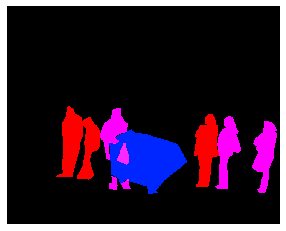

(511, 640, 3)
COCO_val2014_000000004243.jpg
{'person_bbx': [165.21, 109.07, 322.43, 437.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [165.21, 109.07, 322.43, 437.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


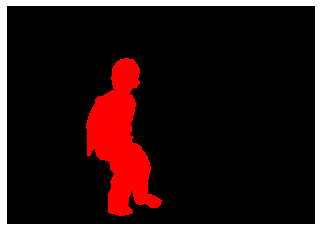

(453, 640, 3)
COCO_val2014_000000123244.jpg
{'person_bbx': [58.83, 329.97, 284.13, 609.79], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [178.64, 38.17, 403.11, 418.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [58.83, 329.97, 284.13, 609.79]}}
person
person
look
look interaction
{'person_bbx': [178.64, 38.17, 403.11, 418.46000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


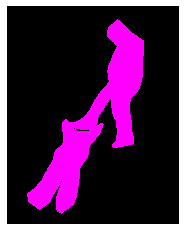

(640, 506, 3)
COCO_val2014_000000288553.jpg
{'person_bbx': [0.0, 3.79, 612.0, 603.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


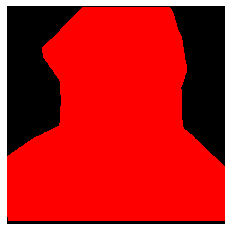

(612, 612, 3)
COCO_val2014_000000377706.jpg
{'person_bbx': [450.99, 94.04, 560.38, 399.17], 'Verbs': 'point', 'object': {'obj_bbx': [387.87, 142.79, 412.79, 241.19]}}
person
skis
point
point interaction
{'person_bbx': [450.99, 94.04, 560.38, 399.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [26.23, 122.19, 150.76, 381.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


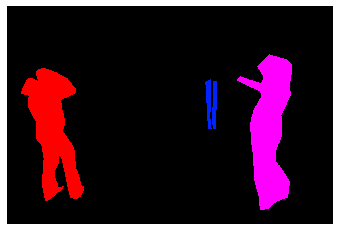

(427, 640, 3)
COCO_val2014_000000117424.jpg
{'person_bbx': [27.79, 268.76, 198.12, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': [219.49, 244.95, 269.78000000000003, 266.87]}}
person
frisbee
catch
catch interaction
{'person_bbx': [197.82, 322.49, 415.58, 631.69], 'Verbs': 'catch', 'object': {'obj_bbx': [219.49, 244.95, 269.78000000000003, 266.87]}}
frisbee
person
catch
catch interaction
{'person_bbx': [27.79, 268.76, 198.12, 640.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [197.82, 322.49, 415.58, 631.69], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [27.79, 268.76, 198.12, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [219.49, 244.95, 269.78000000000003, 266.87]}}
person
frisbee
look
look interaction
{'person_bbx': [197.82, 322.49, 415.58, 631.69], 'Verbs': 'look', 'object': {'obj_bbx': [219.49, 244.95, 269.78000000000003, 266.87]}}
frisbee
person
look
look interaction
{'person_bbx': [197.82, 322.49, 415.58, 631.69], 'Verbs': 

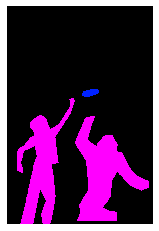

(640, 427, 3)
COCO_val2014_000000428366.jpg
{'person_bbx': [263.07, 145.99, 396.82, 465.26], 'Verbs': 'hold', 'object': {'obj_bbx': [315.83, 277.72, 359.78, 287.76000000000005]}}
person
frisbee
hold
hold interaction
{'person_bbx': [263.07, 145.99, 396.82, 465.26], 'Verbs': 'look', 'object': {'obj_bbx': [106.02, 364.61, 188.76999999999998, 469.33000000000004]}}
dog
person
look
look interaction
{'person_bbx': [23.04, 215.63, 114.57, 417.87], 'Verbs': 'look', 'object': {'obj_bbx': [263.07, 145.99, 396.82, 465.26]}}
person
person
look
look interaction
{'person_bbx': [23.04, 215.63, 114.57, 417.87], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [263.07, 145.99, 396.82, 465.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [23.04, 215.63, 114.57, 417.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [263.07, 145.99, 396.82, 465.26], 'Verbs': 'throw', 'object': {'obj_bbx': [315.83, 277.72, 359.78, 287.760000000

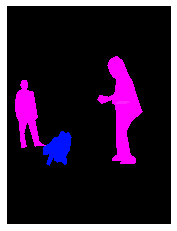

(640, 480, 3)
COCO_val2014_000000195002.jpg
{'person_bbx': [70.79, 60.32, 375.62, 628.08], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [197.38, 330.98, 306.42, 425.56]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [70.79, 60.32, 375.62, 628.08], 'Verbs': 'hold', 'object': {'obj_bbx': [197.38, 330.98, 306.42, 425.56]}}
person
donut
hold
hold interaction
{'person_bbx': [70.79, 60.32, 375.62, 628.08], 'Verbs': 'look', 'object': {'obj_bbx': [197.38, 330.98, 306.42, 425.56]}}
person
donut
look
look interaction
{'person_bbx': [70.79, 60.32, 375.62, 628.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [285.56, 38.67, 479.28, 578.2199999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [285.56, 38.67, 479.28, 578.2199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


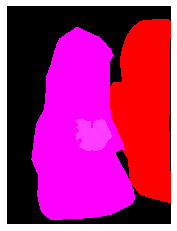

(640, 480, 3)
COCO_val2014_000000526904.jpg
{'person_bbx': [96.1, 180.49, 294.76, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [293.39, 207.1, 423.90999999999997, 321.44]}}
person
laptop
look
look interaction
{'person_bbx': [96.1, 180.49, 294.76, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [428.22, 0.0, 636.4000000000001, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [96.1, 180.49, 294.76, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [293.39, 207.1, 423.90999999999997, 321.44]}}
person
laptop
work_on_computer
work_on_computer interaction


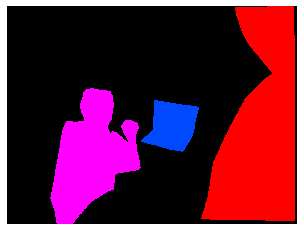

(480, 640, 3)
COCO_val2014_000000322177.jpg
{'person_bbx': [118.92, 103.07, 509.66, 364.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [118.92, 103.07, 509.66, 364.69], 'Verbs': 'snowboard', 'object': {'obj_bbx': [352.77, 198.38, 527.65, 444.31]}}
person
snowboard
snowboard
snowboard interaction


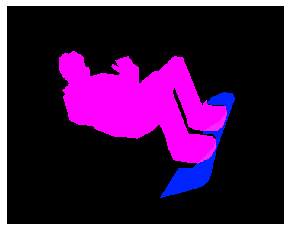

(504, 640, 3)
COCO_val2014_000000357808.jpg
{'person_bbx': [237.89, 113.92, 389.49, 388.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [284.78, 314.73, 524.21, 363.96000000000004]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [250.08, 126.04, 437.3, 370.7], 'Verbs': 'skateboard', 'object': {'obj_bbx': [284.78, 314.73, 524.21, 363.96000000000004]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [313.76, 107.79, 491.39, 370.05], 'Verbs': 'skateboard', 'object': {'obj_bbx': [284.78, 314.73, 524.21, 363.96000000000004]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [237.89, 113.92, 389.49, 388.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [250.08, 126.04, 437.3, 370.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [313.76, 107.79, 491.39, 370.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


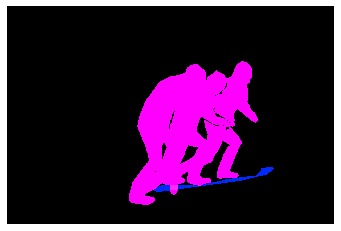

(426, 640, 3)
COCO_val2014_000000533106.jpg
{'person_bbx': [83.28, 16.6, 579.8, 461.47], 'Verbs': 'look', 'object': {'obj_bbx': [360.34, 73.93, 426.58, 216.45000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [83.28, 16.6, 579.8, 461.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


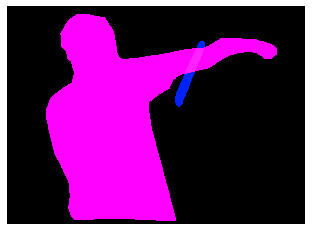

(467, 640, 3)
COCO_val2014_000000195829.jpg
{'person_bbx': [458.61, 132.53, 602.71, 329.23], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [198.57, 120.02, 366.51, 349.71999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': [320.36, 315.01, 353.51, 347.43]}}
sports ball
person
kick
kick interaction
{'person_bbx': [326.87, 114.66, 468.27, 353.52], 'Verbs': 'kick', 'object': {'obj_bbx': [320.36, 315.01, 353.51, 347.43]}}
sports ball
person
kick
kick interaction
{'person_bbx': [55.11, 97.95, 112.75999999999999, 308.67], 'Verbs': 'look', 'object': {'obj_bbx': [320.36, 315.01, 353.51, 347.43]}}
sports ball
person
look
look interaction
{'person_bbx': [198.57, 120.02, 366.51, 349.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [320.36, 315.01, 353.51, 347.43]}}
sports ball
person
look
look interaction
{'person_bbx': [326.87, 114.66, 468.27, 353.52], 'Verbs': 'look', 'object': {'obj_bbx': [320.36, 315.01, 353.51, 347.43]}}
sports ball
person
look
look interacti

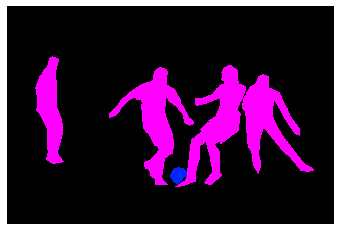

(426, 640, 3)
COCO_val2014_000000572182.jpg
{'person_bbx': [132.2, 32.43, 288.1, 486.40000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [100.65, 473.19, 339.33000000000004, 520.64]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [304.31, 119.73, 455.22, 498.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [132.2, 32.43, 288.1, 486.40000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [304.31, 119.73, 455.22, 498.88], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


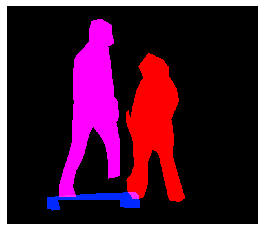

(555, 640, 3)
COCO_val2014_000000320180.jpg
{'person_bbx': [0.0, 0.0, 640.0, 420.3], 'Verbs': 'sit', 'object': {'obj_bbx': [221.31, 350.84, 640.0, 421.54999999999995]}}
couch
person
sit
sit interaction
{'person_bbx': [0.0, 0.0, 640.0, 420.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [169.46, 0.91, 623.27, 204.84]}}
person
laptop
work_on_computer
work_on_computer interaction


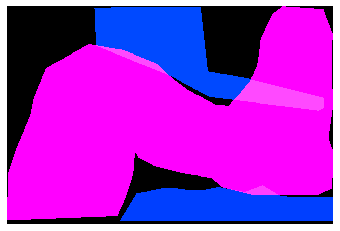

(427, 640, 3)
COCO_val2014_000000235278.jpg
{'person_bbx': [310.98, 87.57, 635.4300000000001, 409.77], 'Verbs': 'hold', 'object': {'obj_bbx': [345.24, 178.45, 612.5, 405.67999999999995]}}
person
book
hold
hold interaction
{'person_bbx': [310.98, 87.57, 635.4300000000001, 409.77], 'Verbs': 'read', 'object': {'obj_bbx': [345.24, 178.45, 612.5, 405.67999999999995]}}
person
book
read
read interaction
{'person_bbx': [310.98, 87.57, 635.4300000000001, 409.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.9, 37.45, 303.41999999999996, 421.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [310.98, 87.57, 635.4300000000001, 409.77], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.9, 37.45, 303.41999999999996, 421.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


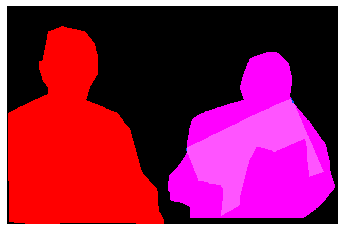

(421, 640, 3)
COCO_val2014_000000079495.jpg
{'person_bbx': [220.22, 98.79, 376.4, 265.90000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [218.79, 206.22, 291.96, 310.89]}}
surfboard
person
surf
surf interaction


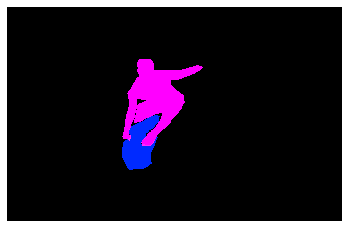

(409, 640, 3)
COCO_val2014_000000110877.jpg
{'person_bbx': [189.34, 151.07, 246.51, 212.10999999999999], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [344.34, 158.7, 458.72999999999996, 197.77999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [351.59, 173.19, 421.33, 202.26]}}
person
surfboard
surf
surf interaction


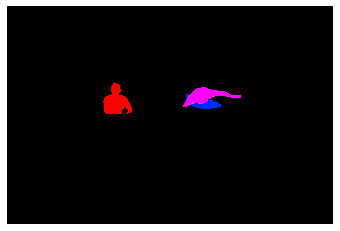

(427, 640, 3)
COCO_val2014_000000552065.jpg
{'person_bbx': [380.59, 21.2, 527.87, 171.48], 'Verbs': 'jump', 'object': {'obj_bbx': [355.45, 142.46, 426.86, 182.59]}}
skateboard
person
jump
jump interaction
{'person_bbx': [380.59, 21.2, 527.87, 171.48], 'Verbs': 'look', 'object': {'obj_bbx': [355.45, 142.46, 426.86, 182.59]}}
skateboard
person
look
look interaction
{'person_bbx': [380.59, 21.2, 527.87, 171.48], 'Verbs': 'skateboard', 'object': {'obj_bbx': [355.45, 142.46, 426.86, 182.59]}}
skateboard
person
skateboard
skateboard interaction


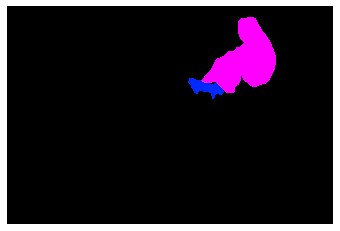

(427, 640, 3)
COCO_val2014_000000372147.jpg
{'person_bbx': [15.82, 376.81, 425.71, 546.52], 'Verbs': 'lay', 'object': {'obj_bbx': [0.36, 436.91, 427.0, 638.5600000000001]}}
bed
person
lay
lay interaction
{'person_bbx': [15.82, 376.81, 425.71, 546.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


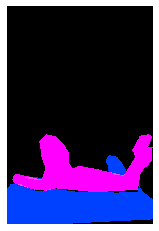

(640, 427, 3)
COCO_val2014_000000005064.jpg
{'person_bbx': [313.77, 153.53, 475.93999999999994, 337.76], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [463.53, 124.66, 482.96999999999997, 163.54]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [313.77, 153.53, 475.93999999999994, 337.76], 'Verbs': 'hold', 'object': {'obj_bbx': [463.53, 124.66, 482.96999999999997, 163.54]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [53.73, 183.27, 143.93, 354.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [313.77, 153.53, 475.93999999999994, 337.76]}}
person
person
look
look interaction
{'person_bbx': [167.92, 215.9, 273.46999999999997, 352.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [313.77, 153.53, 475.93999999999994, 337.76]}}
person
person
look
look interaction
{'person_bbx': [167.92, 215.9, 273.46999999999997, 352.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [313.77, 153.53, 475.93999999999994, 337.76], 

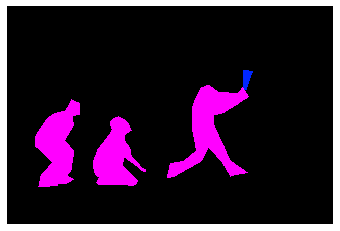

(427, 640, 3)
COCO_val2014_000000458558.jpg
{'person_bbx': [163.71, 37.45, 298.90999999999997, 230.95999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [101.84, 113.25, 368.73, 274.78999999999996]}}
person
skis
jump
jump interaction
{'person_bbx': [163.71, 37.45, 298.90999999999997, 230.95999999999998], 'Verbs': 'ski', 'object': {'obj_bbx': [101.84, 113.25, 368.73, 274.78999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [163.71, 37.45, 298.90999999999997, 230.95999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


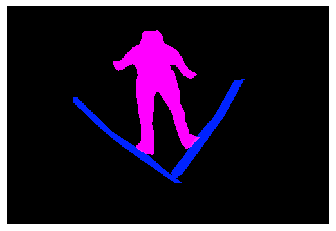

(338, 500, 3)
COCO_val2014_000000316189.jpg
{'person_bbx': [125.29, 116.53, 330.12, 383.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [200.98, 127.53, 211.2, 138.06]}}
sports ball
person
hold
hold interaction
{'person_bbx': [125.29, 116.53, 330.12, 383.08000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [200.98, 127.53, 211.2, 138.06]}}
sports ball
person
throw
throw interaction


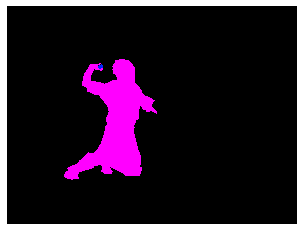

(480, 640, 3)
COCO_val2014_000000437010.jpg
{'person_bbx': [148.91, 9.03, 278.37, 327.05999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [193.04, 55.49, 203.29, 84.74000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [148.91, 9.03, 278.37, 327.05999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.08, 0.37, 441.08, 333.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.91, 9.03, 278.37, 327.05999999999995], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [193.04, 55.49, 203.29, 84.74000000000001]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [267.08, 0.37, 441.08, 333.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


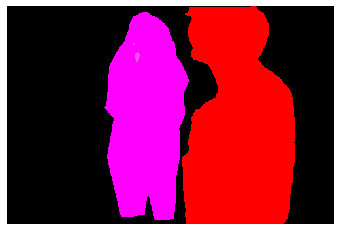

(333, 500, 3)
COCO_val2014_000000378126.jpg
{'person_bbx': [150.65, 4.64, 528.71, 416.28], 'Verbs': 'kick', 'object': {'obj_bbx': [546.97, 348.55, 614.45, 412.47]}}
sports ball
person
kick
kick interaction
{'person_bbx': [150.65, 4.64, 528.71, 416.28], 'Verbs': 'look', 'object': {'obj_bbx': [546.97, 348.55, 614.45, 412.47]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 81.56, 343.52, 418.36], 'Verbs': 'look', 'object': {'obj_bbx': [546.97, 348.55, 614.45, 412.47]}}
sports ball
person
look
look interaction
{'person_bbx': [150.65, 4.64, 528.71, 416.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 81.56, 343.52, 418.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


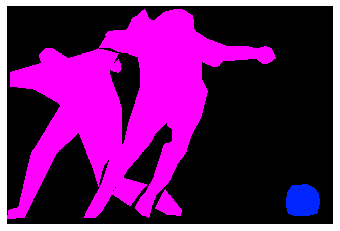

(427, 640, 3)
COCO_val2014_000000430302.jpg
{'person_bbx': [69.67, 289.65, 285.65, 347.85999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [0.94, 327.69, 356.6, 355.32]}}
person
surfboard
hold
hold interaction
{'person_bbx': [148.48, 234.7, 217.70999999999998, 324.53], 'Verbs': 'hold', 'object': {'obj_bbx': [69.67, 289.65, 285.65, 347.85999999999996]}}
person
person
hold
hold interaction
{'person_bbx': [69.67, 289.65, 285.65, 347.85999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [148.48, 234.7, 217.70999999999998, 324.53], 'Verbs': 'look', 'object': {'obj_bbx': [69.67, 289.65, 285.65, 347.85999999999996]}}
person
person
look
look interaction
{'person_bbx': [69.67, 289.65, 285.65, 347.85999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [0.94, 327.69, 356.6, 355.32]}}
person
surfboard
surf
surf interaction


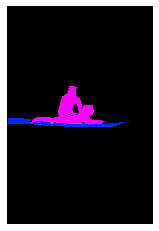

(640, 427, 3)
COCO_val2014_000000080517.jpg
{'person_bbx': [90.59, 119.82, 410.59000000000003, 419.36], 'Verbs': 'hold', 'object': {'obj_bbx': [211.48, 252.86, 323.75, 431.69000000000005]}}
person
banana
hold
hold interaction
{'person_bbx': [90.59, 119.82, 410.59000000000003, 419.36], 'Verbs': 'look', 'object': {'obj_bbx': [149.87, 397.8, 485.0, 573.33]}}
person
banana
look
look interaction
{'person_bbx': [90.59, 119.82, 410.59000000000003, 419.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


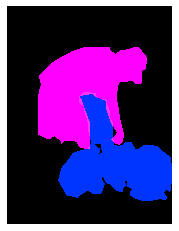

(640, 485, 3)
COCO_val2014_000000206560.jpg
{'person_bbx': [135.19, 31.64, 320.72, 227.24], 'Verbs': 'hold', 'object': {'obj_bbx': [54.41, 70.29, 327.87, 300.81]}}
person
snowboard
hold
hold interaction
{'person_bbx': [135.19, 31.64, 320.72, 227.24], 'Verbs': 'jump', 'object': {'obj_bbx': [54.41, 70.29, 327.87, 300.81]}}
person
snowboard
jump
jump interaction
{'person_bbx': [135.19, 31.64, 320.72, 227.24], 'Verbs': 'look', 'object': {'obj_bbx': [54.41, 70.29, 327.87, 300.81]}}
person
snowboard
look
look interaction
{'person_bbx': [135.19, 31.64, 320.72, 227.24], 'Verbs': 'snowboard', 'object': {'obj_bbx': [54.41, 70.29, 327.87, 300.81]}}
person
snowboard
snowboard
snowboard interaction


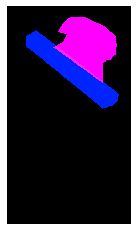

(640, 363, 3)
COCO_val2014_000000342770.jpg
{'person_bbx': [414.99, 223.92, 524.12, 410.32], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [414.99, 223.92, 524.12, 410.32], 'Verbs': 'look', 'object': {'obj_bbx': [17.22, 211.07, 461.70000000000005, 474.74]}}
truck
person
look
look interaction
{'person_bbx': [414.99, 223.92, 524.12, 410.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


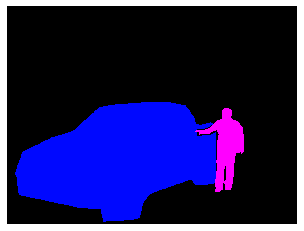

(480, 640, 3)
COCO_val2014_000000425361.jpg
{'person_bbx': [104.82, 20.96, 366.32, 451.28], 'Verbs': 'drink', 'object': {'obj_bbx': [293.03, 186.18, 350.05999999999995, 332.07]}}
person
wine glass
drink
drink interaction
{'person_bbx': [104.82, 20.96, 366.32, 451.28], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [381.77, 409.35, 483.28, 457.90000000000003]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [104.82, 20.96, 366.32, 451.28], 'Verbs': 'hold', 'object': {'obj_bbx': [293.03, 186.18, 350.05999999999995, 332.07]}}
person
wine glass
hold
hold interaction
{'person_bbx': [104.82, 20.96, 366.32, 451.28], 'Verbs': 'sit', 'object': {'obj_bbx': [24.33, 136.57, 155.93, 482.71]}}
chair
person
sit
sit interaction


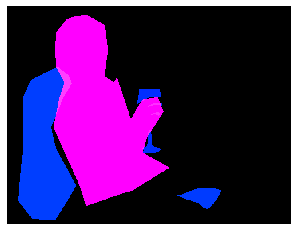

(491, 640, 3)
COCO_val2014_000000391222.jpg
{'person_bbx': [102.9, 74.53, 187.53, 349.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [415.4, 32.85, 504.99, 386.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [102.9, 74.53, 187.53, 349.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [102.9, 74.53, 187.53, 349.58000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [76.69, 344.84, 166.16, 395.22999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [415.4, 32.85, 504.99, 386.85], 'Verbs': 'ski', 'object': {'obj_bbx': [294.16, 300.77, 508.64, 399.75]}}
person
skis
ski
ski interaction
{'person_bbx': [102.9, 74.53, 187.53, 349.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [415.4, 32.85, 504.99, 386.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


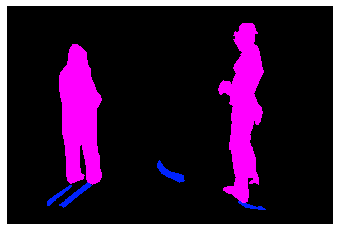

(427, 640, 3)
COCO_val2014_000000289152.jpg
{'person_bbx': [4.3, 1.6, 460.63, 577.03], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [4.3, 1.6, 460.63, 577.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


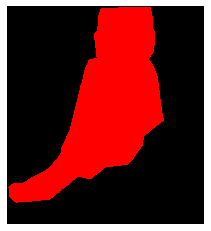

(640, 579, 3)
COCO_val2014_000000053328.jpg
{'person_bbx': [148.52, 46.92, 301.35, 474.19], 'Verbs': 'hold', 'object': {'obj_bbx': [150.75, 209.63, 185.49, 219.44]}}
person
remote
hold
hold interaction
{'person_bbx': [363.82, 45.82, 517.5, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [148.52, 46.92, 301.35, 474.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [363.82, 45.82, 517.5, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.52, 46.92, 301.35, 474.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


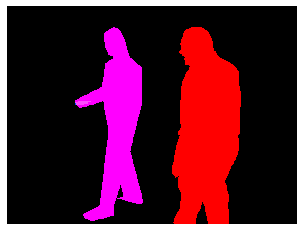

(480, 640, 3)
COCO_val2014_000000212058.jpg
{'person_bbx': [159.49, 207.25, 533.88, 420.22], 'Verbs': 'hold', 'object': {'obj_bbx': [257.87, 228.26, 367.7, 327.58]}}
person
hair drier
hold
hold interaction
{'person_bbx': [88.87, 137.44, 245.32, 425.0], 'Verbs': 'look', 'object': {'obj_bbx': [159.49, 207.25, 533.88, 420.22]}}
person
person
look
look interaction
{'person_bbx': [159.49, 207.25, 533.88, 420.22], 'Verbs': 'look', 'object': {'obj_bbx': [88.87, 137.44, 245.32, 425.0]}}
person
person
look
look interaction
{'person_bbx': [88.87, 137.44, 245.32, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [159.49, 207.25, 533.88, 420.22], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [88.87, 137.44, 245.32, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


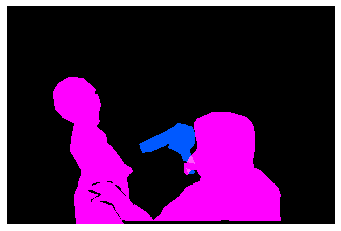

(425, 640, 3)
COCO_val2014_000000240950.jpg
{'person_bbx': [26.5, 139.5, 159.5, 347.5], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [114.91, 274.96, 151.85, 307.96]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [26.5, 139.5, 159.5, 347.5], 'Verbs': 'hold', 'object': {'obj_bbx': [114.91, 274.96, 151.85, 307.96]}}
fork
person
hold
hold interaction
{'person_bbx': [269.63, 227.41, 386.7, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [26.5, 139.5, 159.5, 347.5], 'Verbs': 'look', 'object': {'obj_bbx': [389.58, 98.83, 514.3199999999999, 282.11]}}
person
person
look
look interaction
{'person_bbx': [269.63, 227.41, 386.7, 420.28], 'Verbs': 'sit', 'object': {'obj_bbx': [373.05, 303.27, 408.82, 427.0]}}
person
bench
sit
sit interaction
{'person_bbx': [26.5, 139.5, 159.5, 347.5], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [26.5, 139.5, 159.5, 347.5], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


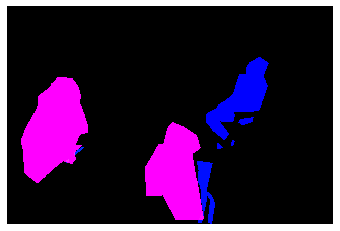

(427, 640, 3)
COCO_val2014_000000279176.jpg
{'person_bbx': [0.0, 151.01, 111.1, 473.53], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [305.79, 163.41, 479.02, 426.13], 'Verbs': 'hold', 'object': {'obj_bbx': [413.12, 299.87, 453.03, 316.04]}}
frisbee
person
hold
hold interaction
{'person_bbx': [0.0, 151.01, 111.1, 473.53], 'Verbs': 'look', 'object': {'obj_bbx': [413.12, 299.87, 453.03, 316.04]}}
person
frisbee
look
look interaction
{'person_bbx': [182.29, 130.52, 311.73, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [413.12, 299.87, 453.03, 316.04]}}
person
frisbee
look
look interaction
{'person_bbx': [0.0, 151.01, 111.1, 473.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [182.29, 130.52, 311.73, 474.61], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 151.01, 111.1, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.29, 130.52, 311.73, 474.61], 'Verbs': 'stand', 'obje

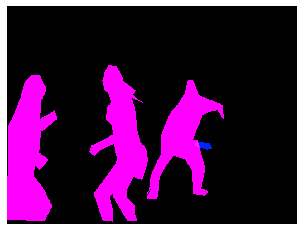

(480, 640, 3)
COCO_val2014_000000053990.jpg
{'person_bbx': [97.87, 46.86, 639.0600000000001, 423.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [369.73, 220.87, 587.75, 332.39]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [97.87, 46.86, 639.0600000000001, 423.0], 'Verbs': 'hold', 'object': {'obj_bbx': [369.73, 220.87, 587.75, 332.39]}}
person
pizza
hold
hold interaction
{'person_bbx': [97.87, 46.86, 639.0600000000001, 423.0], 'Verbs': 'sit', 'object': {'obj_bbx': [74.51, 351.1, 143.54000000000002, 426.89000000000004]}}
person
chair
sit
sit interaction


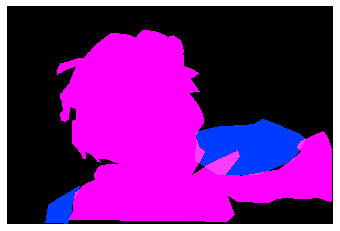

(427, 640, 3)
COCO_val2014_000000371854.jpg
{'person_bbx': [215.51, 55.87, 350.06, 407.07], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [225.96, 340.43, 288.96000000000004, 394.65]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [215.51, 55.87, 350.06, 407.07], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [164.04, 375.42, 293.53, 439.0]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [295.33, 101.97, 422.83, 439.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [225.96, 340.43, 288.96000000000004, 394.65]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [295.33, 101.97, 422.83, 439.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [164.04, 375.42, 293.53, 439.0]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [215.51, 55.87, 350.06, 407.07], 'Verbs': 'hold', 'object': {'obj_bbx': [225.96, 340.43, 288.96000000000004, 394.65]}}
knife
person
hold
hold interaction
{'person_bbx': [295.33, 101.97, 422.83, 439.0], 'Verbs': 'hold', 'object': {'obj_bbx': [225

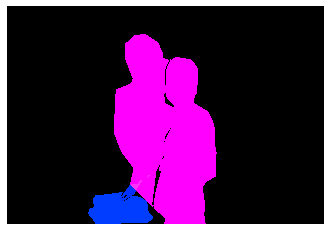

(439, 640, 3)
COCO_val2014_000000110597.jpg
{'person_bbx': [126.83, 37.3, 327.52, 239.49], 'Verbs': 'catch', 'object': {'obj_bbx': [316.48, 26.38, 350.55, 56.37]}}
frisbee
person
catch
catch interaction
{'person_bbx': [126.83, 37.3, 327.52, 239.49], 'Verbs': 'hold', 'object': {'obj_bbx': [316.48, 26.38, 350.55, 56.37]}}
frisbee
person
hold
hold interaction
{'person_bbx': [126.83, 37.3, 327.52, 239.49], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [126.83, 37.3, 327.52, 239.49], 'Verbs': 'look', 'object': {'obj_bbx': [316.48, 26.38, 350.55, 56.37]}}
frisbee
person
look
look interaction
{'person_bbx': [196.22, 158.17, 281.27, 313.35], 'Verbs': 'look', 'object': {'obj_bbx': [316.48, 26.38, 350.55, 56.37]}}
frisbee
person
look
look interaction
{'person_bbx': [196.22, 158.17, 281.27, 313.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [196.22, 158.17, 281.27, 313.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


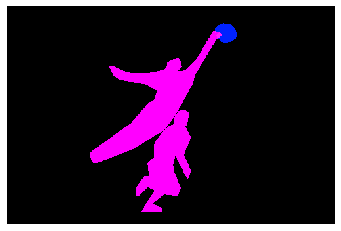

(332, 500, 3)
COCO_val2014_000000021989.jpg
{'person_bbx': [510.34, 115.67, 640.0, 447.22], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [311.16, 150.44, 438.76, 430.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [42.95, 169.77, 133.15, 442.52], 'Verbs': 'hold', 'object': {'obj_bbx': [53.46, 409.81, 188.01000000000002, 470.5]}}
person
skis
hold
hold interaction
{'person_bbx': [238.48, 160.11, 341.62, 430.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [407.73, 135.98, 532.85, 426.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [136.12, 157.06, 232.25, 425.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [510.34, 115.67, 640.0, 447.22], 'Verbs': 'ski', 'object': {'obj_bbx': [486.05, 407.24, 600.5, 480.0]}}
person
skis
ski
ski interaction
{'person_bbx': [311.16, 150.44, 438.76, 430.69], 'Verbs': 'ski', 'object': {'obj_bbx': [309.28, 384.8, 423.67999999

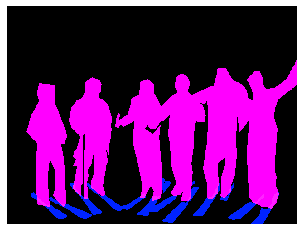

(480, 640, 3)
COCO_val2014_000000204311.jpg
{'person_bbx': [194.4, 0.0, 431.48, 157.42], 'Verbs': 'hold', 'object': {'obj_bbx': [294.21, 68.65, 439.59, 194.31]}}
person
bowl
hold
hold interaction
{'person_bbx': [194.4, 0.0, 431.48, 157.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


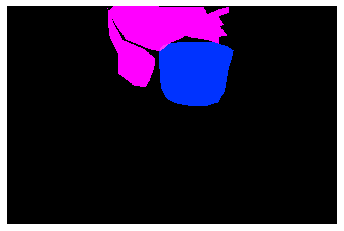

(422, 640, 3)
COCO_val2014_000000273855.jpg
{'person_bbx': [75.12, 64.8, 344.37, 480.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [338.18, 379.88, 379.25, 415.9]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [75.12, 64.8, 344.37, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [338.18, 379.88, 379.25, 415.9]}}
person
spoon
hold
hold interaction
{'person_bbx': [75.12, 64.8, 344.37, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [42.95, 272.86, 90.2, 473.66]}}
chair
person
sit
sit interaction
{'person_bbx': [75.12, 64.8, 344.37, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


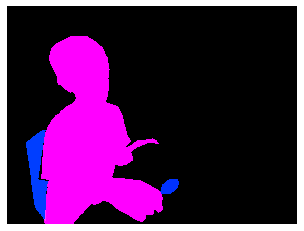

(480, 640, 3)
COCO_val2014_000000355304.jpg
{'person_bbx': [89.61, 19.48, 399.35, 370.13], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [138.2, 152.53, 257.02, 205.62]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [89.61, 19.48, 399.35, 370.13], 'Verbs': 'hold', 'object': {'obj_bbx': [138.2, 152.53, 257.02, 205.62]}}
donut
person
hold
hold interaction
{'person_bbx': [89.61, 19.48, 399.35, 370.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


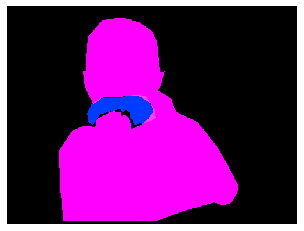

(375, 500, 3)
COCO_val2014_000000074951.jpg
{'person_bbx': [209.65, 60.11, 384.68, 358.24], 'Verbs': 'kick', 'object': {'obj_bbx': [309.17, 315.8, 370.58000000000004, 375.49]}}
sports ball
person
kick
kick interaction
{'person_bbx': [369.64, 106.86, 505.53999999999996, 369.38], 'Verbs': 'kick', 'object': {'obj_bbx': [309.17, 315.8, 370.58000000000004, 375.49]}}
sports ball
person
kick
kick interaction
{'person_bbx': [209.65, 60.11, 384.68, 358.24], 'Verbs': 'look', 'object': {'obj_bbx': [309.17, 315.8, 370.58000000000004, 375.49]}}
sports ball
person
look
look interaction
{'person_bbx': [369.64, 106.86, 505.53999999999996, 369.38], 'Verbs': 'look', 'object': {'obj_bbx': [309.17, 315.8, 370.58000000000004, 375.49]}}
sports ball
person
look
look interaction
{'person_bbx': [31.74, 38.95, 202.92000000000002, 388.05], 'Verbs': 'look', 'object': {'obj_bbx': [309.17, 315.8, 370.58000000000004, 375.49]}}
sports ball
person
look
look interaction
{'person_bbx': [209.65, 60.11, 384.68, 358.24], '

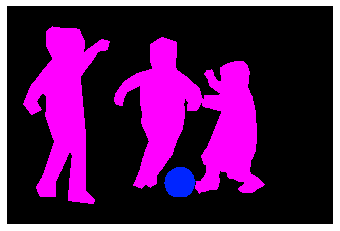

(427, 640, 3)
COCO_val2014_000000309859.jpg
{'person_bbx': [250.61, 54.7, 384.59000000000003, 237.83999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [295.48, 251.09, 354.03000000000003, 288.76]}}
person
skateboard
jump
jump interaction
{'person_bbx': [250.61, 54.7, 384.59000000000003, 237.83999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [295.48, 251.09, 354.03000000000003, 288.76]}}
person
skateboard
look
look interaction
{'person_bbx': [250.61, 54.7, 384.59000000000003, 237.83999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [295.48, 251.09, 354.03000000000003, 288.76]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [103.2, 324.1, 178.55, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


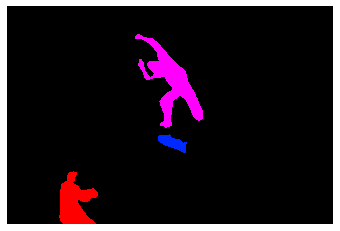

(427, 640, 3)
COCO_val2014_000000246105.jpg
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [165.02, 386.97, 189.96, 442.44000000000005]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [87.73, 465.98, 186.97, 537.89]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [165.02, 386.97, 189.96, 442.44000000000005]}}
person
knife
hold
hold interaction
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [87.73, 465.98, 186.97, 537.89]}}
person
cake
look
look interaction
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [176.63, 138.93, 371.13, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


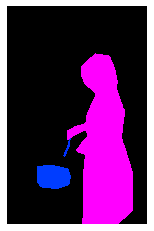

(640, 411, 3)
COCO_val2014_000000456725.jpg
{'person_bbx': [259.33, 197.24, 451.29999999999995, 366.47], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [73.38, 128.52, 260.0, 366.83000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [193.84, 225.08, 312.40999999999997, 236.27]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [73.38, 128.52, 260.0, 366.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [193.84, 225.08, 312.40999999999997, 236.27]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [259.33, 197.24, 451.29999999999995, 366.47], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [73.38, 128.52, 260.0, 366.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.87, 66.82, 484.86, 366.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


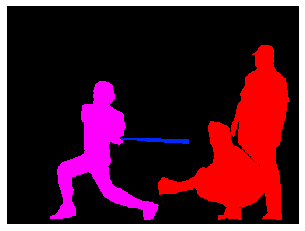

(373, 500, 3)
COCO_val2014_000000549242.jpg
{'person_bbx': [289.25, 132.72, 367.17, 229.32999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [286.59, 226.88, 344.64, 241.88]}}
person
surfboard
look
look interaction
{'person_bbx': [289.25, 132.72, 367.17, 229.32999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [286.59, 226.88, 344.64, 241.88]}}
person
surfboard
surf
surf interaction


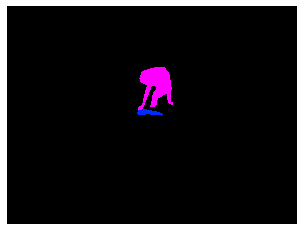

(480, 640, 3)
COCO_val2014_000000099182.jpg
{'person_bbx': [184.64, 0.75, 378.28, 282.21], 'Verbs': 'hold', 'object': {'obj_bbx': [56.29, 88.34, 391.79, 334.0]}}
person
book
hold
hold interaction
{'person_bbx': [184.64, 0.75, 378.28, 282.21], 'Verbs': 'look', 'object': {'obj_bbx': [56.29, 88.34, 391.79, 334.0]}}
person
book
look
look interaction
{'person_bbx': [184.64, 0.75, 378.28, 282.21], 'Verbs': 'read', 'object': {'obj_bbx': [56.29, 88.34, 391.79, 334.0]}}
person
book
read
read interaction
{'person_bbx': [184.64, 0.75, 378.28, 282.21], 'Verbs': 'sit', 'object': {'obj_bbx': [360.9, 173.42, 497.64, 327.35]}}
bed
person
sit
sit interaction


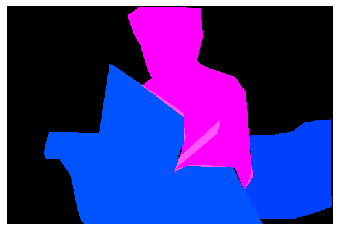

(334, 500, 3)
COCO_val2014_000000053058.jpg
{'person_bbx': [310.15, 107.42, 534.54, 476.76], 'Verbs': 'look', 'object': {'obj_bbx': [230.23, 208.62, 356.09, 284.14]}}
person
laptop
look
look interaction
{'person_bbx': [310.15, 107.42, 534.54, 476.76], 'Verbs': 'sit', 'object': {'obj_bbx': [350.99, 274.68, 547.54, 550.97]}}
chair
person
sit
sit interaction
{'person_bbx': [310.15, 107.42, 534.54, 476.76], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [230.23, 208.62, 356.09, 284.14]}}
person
laptop
work_on_computer
work_on_computer interaction


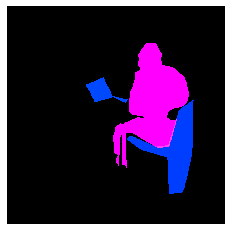

(640, 640, 3)
COCO_val2014_000000178025.jpg
{'person_bbx': [6.91, 56.3, 612.0, 600.5999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [202.62, 86.15, 391.46000000000004, 317.72]}}
person
person
hold
hold interaction
{'person_bbx': [6.91, 56.3, 612.0, 600.5999999999999], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 23.72, 501.98, 602.72]}}
bed
person
lay
lay interaction
{'person_bbx': [6.91, 56.3, 612.0, 600.5999999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


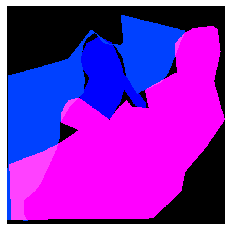

(612, 612, 3)
COCO_val2014_000000089078.jpg
{'person_bbx': [146.7, 14.38, 368.17999999999995, 588.22], 'Verbs': 'snowboard', 'object': {'obj_bbx': [178.34, 555.67, 349.90999999999997, 593.98]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [146.7, 14.38, 368.17999999999995, 588.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


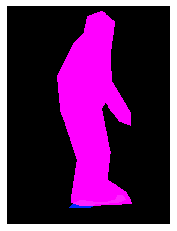

(640, 479, 3)
COCO_val2014_000000183437.jpg
{'person_bbx': [129.44, 175.02, 179.78, 323.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [129.44, 175.02, 179.78, 323.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [177.97, 229.32, 280.13, 347.86], 'Verbs': 'ride', 'object': {'obj_bbx': [61.84, 283.33, 384.0, 621.3]}}
person
elephant
ride
ride interaction
{'person_bbx': [129.44, 175.02, 179.78, 323.15999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [61.84, 283.33, 384.0, 621.3]}}
person
elephant
ride
ride interaction
{'person_bbx': [177.97, 229.32, 280.13, 347.86], 'Verbs': 'sit', 'object': {'obj_bbx': [61.84, 283.33, 384.0, 621.3]}}
person
elephant
sit
sit interaction
{'person_bbx': [129.44, 175.02, 179.78, 323.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [61.84, 283.33, 384.0, 621.3]}}
person
elephant
sit
sit interaction
{'person_bbx': [129.44, 175.02, 179.78, 323.15999999999997], 'Verbs': 's

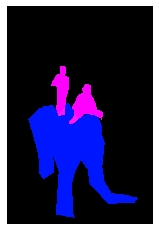

(640, 427, 3)
COCO_val2014_000000441736.jpg
{'person_bbx': [213.18, 280.29, 342.85, 483.58000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [230.68, 303.77, 237.68, 317.58]}}
cell phone
person
carry
carry interaction
{'person_bbx': [454.93, 267.03, 563.72, 489.0], 'Verbs': 'carry', 'object': {'obj_bbx': [533.51, 421.41, 588.49, 486.96000000000004]}}
person
suitcase
carry
carry interaction
{'person_bbx': [541.75, 283.51, 630.76, 481.31], 'Verbs': 'carry', 'object': {'obj_bbx': [548.78, 364.83, 600.91, 413.13]}}
person
backpack
carry
carry interaction
{'person_bbx': [213.18, 280.29, 342.85, 483.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [230.68, 303.77, 237.68, 317.58]}}
cell phone
person
hold
hold interaction
{'person_bbx': [454.93, 267.03, 563.72, 489.0], 'Verbs': 'hold', 'object': {'obj_bbx': [533.51, 421.41, 588.49, 486.96000000000004]}}
person
suitcase
hold
hold interaction
{'person_bbx': [213.18, 280.29, 342.85, 483.58000000000004], 'Verbs': 'stand', 'object': {'o

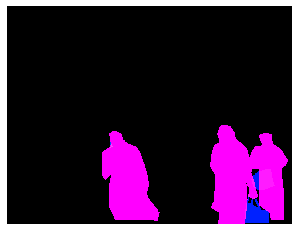

(489, 640, 3)
COCO_val2014_000000190829.jpg
{'person_bbx': [404.74, 135.17, 636.85, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [427.64, 266.6, 509.11, 292.62]}}
person
book
hold
hold interaction
{'person_bbx': [101.39, 148.85, 276.13, 384.0], 'Verbs': 'hold', 'object': {'obj_bbx': [107.23, 282.01, 128.74, 294.94]}}
cell phone
person
hold
hold interaction
{'person_bbx': [404.74, 135.17, 636.85, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [427.64, 266.6, 509.11, 292.62]}}
person
book
look
look interaction
{'person_bbx': [101.39, 148.85, 276.13, 384.0], 'Verbs': 'look', 'object': {'obj_bbx': [107.23, 282.01, 128.74, 294.94]}}
cell phone
person
look
look interaction
{'person_bbx': [404.74, 135.17, 636.85, 480.0], 'Verbs': 'read', 'object': {'obj_bbx': [427.64, 266.6, 509.11, 292.62]}}
person
book
read
read interaction
{'person_bbx': [404.74, 135.17, 636.85, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 234.05, 640.0, 463.24]}}
person
bench
sit
sit interaction
{'person_bbx': [1

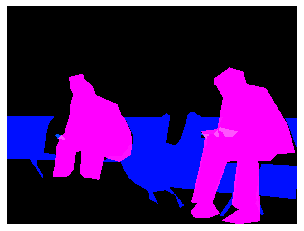

(480, 640, 3)
COCO_val2014_000000105623.jpg
{'person_bbx': [410.46, 189.14, 473.34999999999997, 269.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [410.46, 189.14, 473.34999999999997, 269.75], 'Verbs': 'surf', 'object': {'obj_bbx': [414.0, 248.9, 481.45, 281.99]}}
person
surfboard
surf
surf interaction


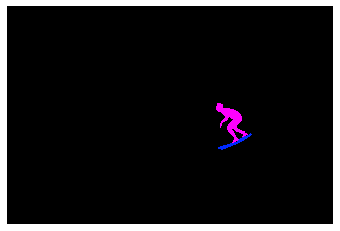

(427, 640, 3)
COCO_val2014_000000260261.jpg
{'person_bbx': [174.41, 154.95, 343.06, 624.86], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [179.95, 285.52, 220.52999999999997, 318.76]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [174.41, 154.95, 343.06, 624.86], 'Verbs': 'hold', 'object': {'obj_bbx': [179.95, 285.52, 220.52999999999997, 318.76]}}
person
knife
hold
hold interaction
{'person_bbx': [174.41, 154.95, 343.06, 624.86], 'Verbs': 'look', 'object': {'obj_bbx': [179.95, 285.52, 220.52999999999997, 318.76]}}
person
knife
look
look interaction
{'person_bbx': [174.41, 154.95, 343.06, 624.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


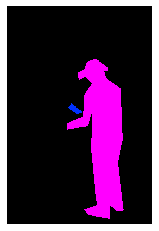

(640, 426, 3)
COCO_val2014_000000345139.jpg
{'person_bbx': [119.47, 2.21, 486.74, 365.04999999999995], 'Verbs': 'drink', 'object': {'obj_bbx': [280.58, 252.76, 333.89, 356.46999999999997]}}
cup
person
drink
drink interaction
{'person_bbx': [119.47, 2.21, 486.74, 365.04999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [280.58, 252.76, 333.89, 356.46999999999997]}}
cup
person
hold
hold interaction
{'person_bbx': [119.47, 2.21, 486.74, 365.04999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [119.47, 2.21, 486.74, 365.04999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


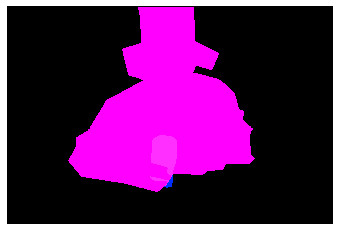

(427, 640, 3)
COCO_val2014_000000487843.jpg
{'person_bbx': [46.19, 44.02, 178.05, 143.85], 'Verbs': 'jump', 'object': {'obj_bbx': [62.26, 136.39, 124.05, 161.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [46.19, 44.02, 178.05, 143.85], 'Verbs': 'look', 'object': {'obj_bbx': [62.26, 136.39, 124.05, 161.0]}}
person
skateboard
look
look interaction
{'person_bbx': [46.19, 44.02, 178.05, 143.85], 'Verbs': 'skateboard', 'object': {'obj_bbx': [62.26, 136.39, 124.05, 161.0]}}
person
skateboard
skateboard
skateboard interaction


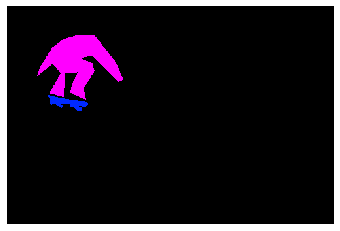

(333, 500, 3)
COCO_val2014_000000441363.jpg
{'person_bbx': [117.07, 22.07, 344.48, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [117.07, 22.07, 344.48, 427.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [117.07, 22.07, 344.48, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


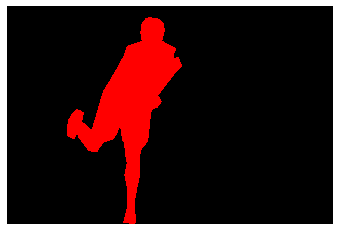

(427, 640, 3)
COCO_val2014_000000559454.jpg
{'person_bbx': [166.48, 0.94, 422.92999999999995, 369.21], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [189.37, 112.74, 257.39, 194.87]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [166.48, 0.94, 422.92999999999995, 369.21], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [134.83, 188.76, 194.66000000000003, 226.69]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [166.48, 0.94, 422.92999999999995, 369.21], 'Verbs': 'hold', 'object': {'obj_bbx': [189.37, 112.74, 257.39, 194.87]}}
person
knife
hold
hold interaction
{'person_bbx': [166.48, 0.94, 422.92999999999995, 369.21], 'Verbs': 'look', 'object': {'obj_bbx': [134.83, 188.76, 194.66000000000003, 226.69]}}
person
cake
look
look interaction


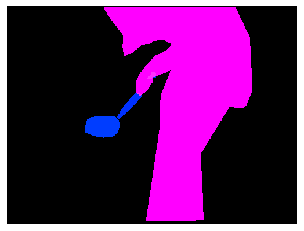

(375, 500, 3)
COCO_val2014_000000156416.jpg
{'person_bbx': [122.27, 191.03, 179.03, 262.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [122.27, 191.03, 179.03, 262.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


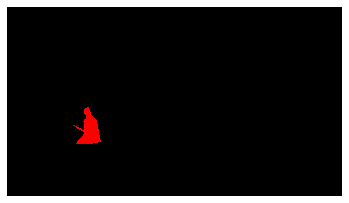

(361, 640, 3)
COCO_val2014_000000026690.jpg
{'person_bbx': [34.82, 297.33, 105.12, 449.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [244.53, 164.96, 383.11, 315.93], 'Verbs': 'jump', 'object': {'obj_bbx': [217.26, 249.78, 255.85999999999999, 293.77]}}
person
skateboard
jump
jump interaction
{'person_bbx': [244.53, 164.96, 383.11, 315.93], 'Verbs': 'look', 'object': {'obj_bbx': [217.26, 249.78, 255.85999999999999, 293.77]}}
person
skateboard
look
look interaction
{'person_bbx': [244.53, 164.96, 383.11, 315.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': [217.26, 249.78, 255.85999999999999, 293.77]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [34.82, 297.33, 105.12, 449.54999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


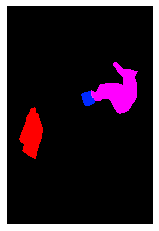

(640, 427, 3)
COCO_val2014_000000319073.jpg
{'person_bbx': [230.81, 71.17, 557.79, 326.98], 'Verbs': 'look', 'object': {'obj_bbx': [379.37, 299.18, 556.45, 402.11]}}
person
surfboard
look
look interaction
{'person_bbx': [230.81, 71.17, 557.79, 326.98], 'Verbs': 'surf', 'object': {'obj_bbx': [379.37, 299.18, 556.45, 402.11]}}
person
surfboard
surf
surf interaction


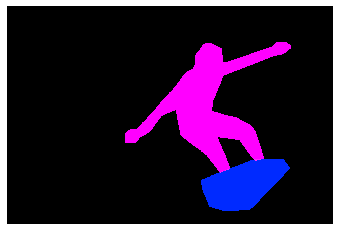

(427, 640, 3)
COCO_val2014_000000291537.jpg
{'person_bbx': [130.65, 267.2, 230.32, 455.28999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [161.99, 445.91, 267.47, 488.31]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [130.65, 267.2, 230.32, 455.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


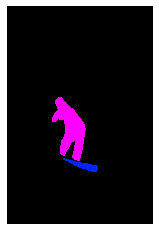

(640, 427, 3)
COCO_val2014_000000088072.jpg
{'person_bbx': [179.37, 106.19, 348.70000000000005, 490.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [179.37, 106.19, 348.70000000000005, 490.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [104.48, 466.03, 408.33000000000004, 500.95]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [179.37, 106.19, 348.70000000000005, 490.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


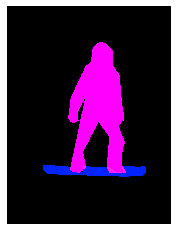

(640, 480, 3)
COCO_val2014_000000434873.jpg
{'person_bbx': [165.22, 71.73, 268.58, 256.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [165.22, 71.73, 268.58, 256.84000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


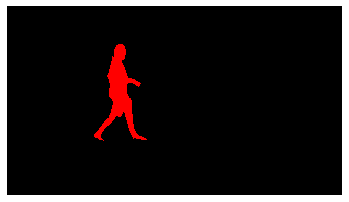

(360, 640, 3)
COCO_val2014_000000020598.jpg
{'person_bbx': [298.79, 64.59, 614.6600000000001, 415.54999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [291.56, 355.4, 388.75, 404.94]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [127.9, 35.1, 344.56, 368.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [298.79, 64.59, 614.6600000000001, 415.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [291.56, 355.4, 388.75, 404.94]}}
person
pizza
look
look interaction
{'person_bbx': [127.9, 35.1, 344.56, 368.11], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [298.79, 64.59, 614.6600000000001, 415.54999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


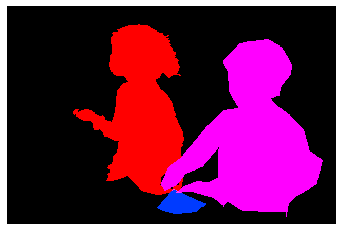

(424, 640, 3)
COCO_val2014_000000201550.jpg
{'person_bbx': [208.82, 365.7, 246.26, 456.0], 'Verbs': 'carry', 'object': {'obj_bbx': [213.47, 380.02, 236.48, 415.09999999999997]}}
person
handbag
carry
carry interaction
{'person_bbx': [258.45, 371.03, 292.41999999999996, 467.52], 'Verbs': 'carry', 'object': {'obj_bbx': [264.25, 385.19, 288.97, 425.53]}}
person
backpack
carry
carry interaction
{'person_bbx': [208.82, 365.7, 246.26, 456.0], 'Verbs': 'hold', 'object': {'obj_bbx': [211.07, 415.97, 227.17, 435.25]}}
person
handbag
hold
hold interaction
{'person_bbx': [208.82, 365.7, 246.26, 456.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.22, 320.16, 160.43, 393.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [218.52, 474.03, 256.97, 570.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.81, 447.83, 229.23000000000002, 555.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bb

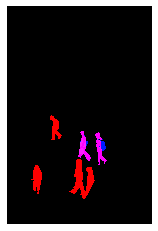

(640, 425, 3)
COCO_val2014_000000107564.jpg
{'person_bbx': [0.56, 250.05, 71.11, 568.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


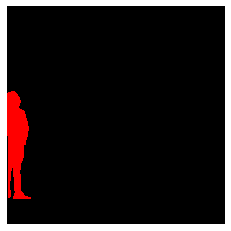

(640, 640, 3)
COCO_val2014_000000455847.jpg
{'person_bbx': [95.72, 149.21, 231.98, 440.88], 'Verbs': 'ski', 'object': {'obj_bbx': [22.12, 398.28, 212.64000000000001, 500.0]}}
person
skis
ski
ski interaction
{'person_bbx': [158.78, 4.28, 296.16999999999996, 402.92999999999995], 'Verbs': 'ski', 'object': {'obj_bbx': [16.88, 393.51, 291.29, 465.56]}}
person
skis
ski
ski interaction
{'person_bbx': [95.72, 149.21, 231.98, 440.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [158.78, 4.28, 296.16999999999996, 402.92999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


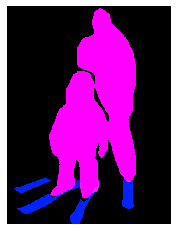

(500, 375, 3)
COCO_val2014_000000399790.jpg
{'person_bbx': [261.03, 186.47, 427.15, 334.8], 'Verbs': 'hold', 'object': {'obj_bbx': [416.92, 259.6, 426.08000000000004, 266.04]}}
sports ball
person
hold
hold interaction
{'person_bbx': [261.03, 186.47, 427.15, 334.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.03, 186.47, 427.15, 334.8], 'Verbs': 'throw', 'object': {'obj_bbx': [416.92, 259.6, 426.08000000000004, 266.04]}}
sports ball
person
throw
throw interaction


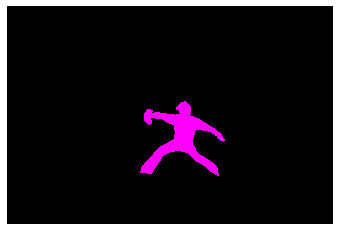

(428, 640, 3)
COCO_val2014_000000456521.jpg
{'person_bbx': [133.78, 26.36, 242.76999999999998, 187.02999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [176.91, 171.27, 245.8, 198.66000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [133.78, 26.36, 242.76999999999998, 187.02999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [176.91, 171.27, 245.8, 198.66000000000003]}}
person
skateboard
look
look interaction
{'person_bbx': [133.78, 26.36, 242.76999999999998, 187.02999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [176.91, 171.27, 245.8, 198.66000000000003]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [202.02, 295.56, 320.78000000000003, 454.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [193.86, 298.88, 215.93, 357.28]}}
skateboard
person
skateboard
skateboard interaction


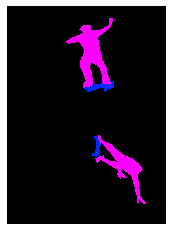

(500, 364, 3)
COCO_val2014_000000421535.jpg
{'person_bbx': [259.1, 21.08, 375.34000000000003, 344.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.1, 19.37, 378.57000000000005, 345.47], 'Verbs': 'hold', 'object': {'obj_bbx': [144.19, 293.11, 305.12, 354.51]}}
person
skis
hold
hold interaction
{'person_bbx': [259.1, 21.08, 375.34000000000003, 344.76], 'Verbs': 'ski', 'object': {'obj_bbx': [144.19, 293.11, 305.12, 354.51]}}
person
skis
ski
ski interaction
{'person_bbx': [259.1, 19.37, 378.57000000000005, 345.47], 'Verbs': 'ski', 'object': {'obj_bbx': [144.19, 293.11, 305.12, 354.51]}}
person
skis
ski
ski interaction
{'person_bbx': [488.97, 83.87, 584.62, 295.96000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [480.16, 255.29, 618.1700000000001, 308.69]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [259.1, 21.08, 375.34000000000003, 344.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [488.97, 83.87,

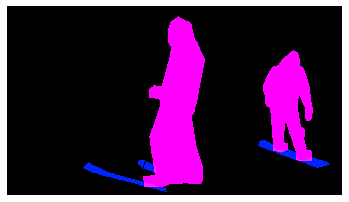

(360, 640, 3)
COCO_val2014_000000346934.jpg
{'person_bbx': [279.05, 185.74, 337.04, 355.04], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [350.14, 130.77, 356.96, 137.24]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [279.05, 185.74, 337.04, 355.04], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [279.05, 185.74, 337.04, 355.04], 'Verbs': 'look', 'object': {'obj_bbx': [350.14, 130.77, 356.96, 137.24]}}
sports ball
person
look
look interaction
{'person_bbx': [279.05, 185.74, 337.04, 355.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


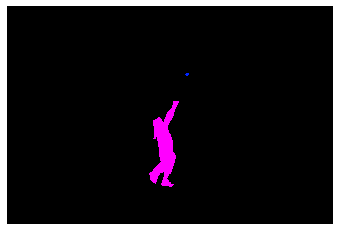

(428, 640, 3)
COCO_val2014_000000247918.jpg
{'person_bbx': [211.65, 112.76, 412.89, 271.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [211.65, 112.76, 412.89, 271.5], 'Verbs': 'surf', 'object': {'obj_bbx': [132.71, 257.62, 375.59000000000003, 305.33]}}
person
surfboard
surf
surf interaction


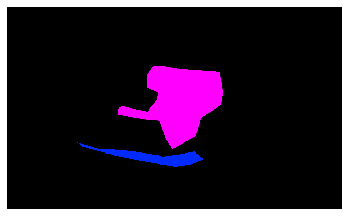

(386, 640, 3)
COCO_val2014_000000532994.jpg
{'person_bbx': [178.51, 155.55, 237.25, 317.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [178.51, 155.55, 237.25, 317.95000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [413.24, 172.71, 501.85, 303.1]}}
horse
person
ride
ride interaction
{'person_bbx': [353.3, 99.3, 404.19, 246.75], 'Verbs': 'ride', 'object': {'obj_bbx': [413.24, 172.71, 501.85, 303.1]}}
horse
person
ride
ride interaction
{'person_bbx': [178.51, 155.55, 237.25, 317.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.3, 99.3, 404.19, 246.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


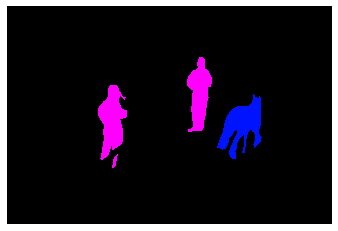

(429, 640, 3)
COCO_val2014_000000443602.jpg
{'person_bbx': [401.26, 100.31, 639.64, 473.53000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [473.93, 229.26, 535.11, 276.36]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [289.89, 60.52, 523.52, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [378.12, 180.85, 424.6, 213.25]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [401.26, 100.31, 639.64, 473.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [473.93, 229.26, 535.11, 276.36]}}
person
donut
hold
hold interaction
{'person_bbx': [289.89, 60.52, 523.52, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [378.12, 180.85, 424.6, 213.25]}}
donut
person
hold
hold interaction
{'person_bbx': [401.26, 100.31, 639.64, 473.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [289.89, 60.52, 523.52, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


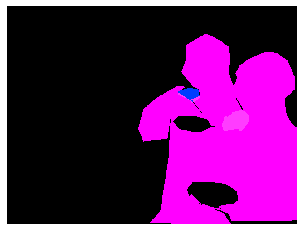

(480, 640, 3)
COCO_val2014_000000232993.jpg
{'person_bbx': [9.54, 26.54, 600.87, 404.86], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [344.16, 228.5, 447.97, 297.85]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [9.54, 26.54, 600.87, 404.86], 'Verbs': 'hold', 'object': {'obj_bbx': [344.16, 228.5, 447.97, 297.85]}}
pizza
person
hold
hold interaction
{'person_bbx': [9.54, 26.54, 600.87, 404.86], 'Verbs': 'sit', 'object': {'obj_bbx': [12.35, 166.04, 156.43, 285.41999999999996]}}
chair
person
sit
sit interaction


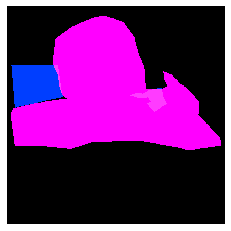

(612, 612, 3)
COCO_val2014_000000305004.jpg
{'person_bbx': [173.09, 55.06, 429.89, 328.92], 'Verbs': 'jump', 'object': {'obj_bbx': [108.4, 58.11, 220.85000000000002, 317.8]}}
person
surfboard
jump
jump interaction
{'person_bbx': [173.09, 55.06, 429.89, 328.92], 'Verbs': 'look', 'object': {'obj_bbx': [108.4, 58.11, 220.85000000000002, 317.8]}}
person
surfboard
look
look interaction
{'person_bbx': [173.09, 55.06, 429.89, 328.92], 'Verbs': 'surf', 'object': {'obj_bbx': [108.4, 58.11, 220.85000000000002, 317.8]}}
person
surfboard
surf
surf interaction


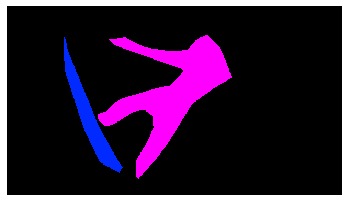

(360, 640, 3)
COCO_val2014_000000129982.jpg
{'person_bbx': [233.08, 47.3, 381.31, 398.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [368.73, 197.33, 557.04, 426.23], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [233.08, 47.3, 381.31, 398.38], 'Verbs': 'ski', 'object': {'obj_bbx': [84.21, 364.35, 447.57, 412.76]}}
person
skis
ski
ski interaction
{'person_bbx': [368.73, 197.33, 557.04, 426.23], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [233.08, 47.3, 381.31, 398.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [233.08, 47.3, 381.31, 398.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [368.73, 197.33, 557.04, 426.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


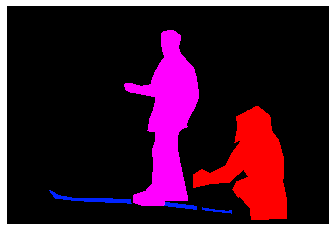

(433, 640, 3)
COCO_val2014_000000309418.jpg
{'person_bbx': [1.12, 2.25, 333.0, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [106.26, 260.73, 230.43, 353.58000000000004]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [1.12, 2.25, 333.0, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


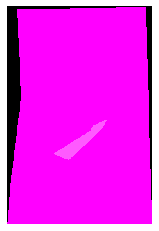

(500, 333, 3)
COCO_val2014_000000270883.jpg
{'person_bbx': [65.35, 96.26, 546.67, 315.28000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [5.31, 2.66, 640.0, 393.0]}}
bed
person
lay
lay interaction


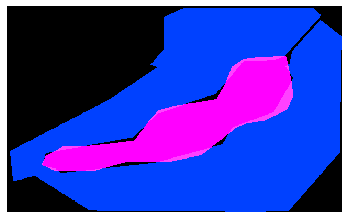

(393, 640, 3)
COCO_val2014_000000482362.jpg
{'person_bbx': [0.0, 0.0, 408.05, 562.82], 'Verbs': 'drink', 'object': {'obj_bbx': [118.94, 147.1, 225.48000000000002, 277.6]}}
person
cup
drink
drink interaction
{'person_bbx': [0.0, 0.0, 408.05, 562.82], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [255.42, 499.23, 415.05999999999995, 595.01]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.0, 408.05, 562.82], 'Verbs': 'hold', 'object': {'obj_bbx': [118.94, 147.1, 225.48000000000002, 277.6]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 0.0, 408.05, 562.82], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


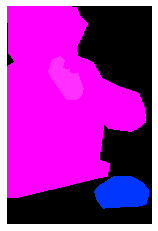

(640, 425, 3)
COCO_val2014_000000078871.jpg
{'person_bbx': [0.0, 3.37, 332.0, 493.54], 'Verbs': 'hold', 'object': {'obj_bbx': [168.4, 125.72, 229.22, 207.88]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 3.37, 332.0, 493.54], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [168.4, 125.72, 229.22, 207.88]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


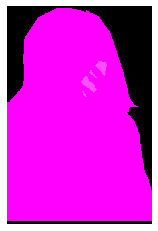

(500, 332, 3)
COCO_val2014_000000549937.jpg
{'person_bbx': [144.38, 103.0, 358.01, 395.28], 'Verbs': 'jump', 'object': {'obj_bbx': [226.92, 385.28, 285.5, 442.55999999999995]}}
person
skateboard
jump
jump interaction
{'person_bbx': [144.38, 103.0, 358.01, 395.28], 'Verbs': 'look', 'object': {'obj_bbx': [226.92, 385.28, 285.5, 442.55999999999995]}}
person
skateboard
look
look interaction
{'person_bbx': [144.38, 103.0, 358.01, 395.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [226.92, 385.28, 285.5, 442.55999999999995]}}
person
skateboard
skateboard
skateboard interaction


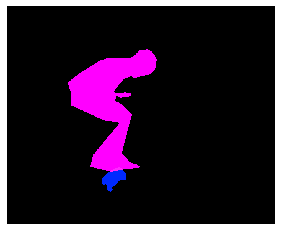

(520, 640, 3)
COCO_val2014_000000352361.jpg
{'person_bbx': [192.41, 176.88, 337.26, 388.76], 'Verbs': 'jump', 'object': {'obj_bbx': [150.21, 380.9, 346.87, 417.13]}}
person
snowboard
jump
jump interaction
{'person_bbx': [192.41, 176.88, 337.26, 388.76], 'Verbs': 'look', 'object': {'obj_bbx': [150.21, 380.9, 346.87, 417.13]}}
person
snowboard
look
look interaction
{'person_bbx': [192.41, 176.88, 337.26, 388.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [150.21, 380.9, 346.87, 417.13]}}
person
snowboard
snowboard
snowboard interaction


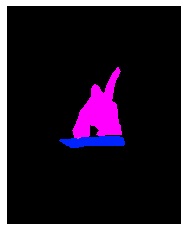

(640, 512, 3)
COCO_val2014_000000213785.jpg
{'person_bbx': [202.04, 124.88, 386.13, 215.43], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [202.04, 124.88, 386.13, 215.43], 'Verbs': 'look', 'object': {'obj_bbx': [168.54, 153.81, 198.17, 174.79]}}
frisbee
person
look
look interaction


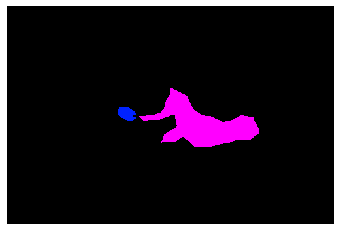

(333, 500, 3)
COCO_val2014_000000053263.jpg
{'person_bbx': [277.84, 0.54, 499.46, 345.41], 'Verbs': 'look', 'object': {'obj_bbx': [474.05, 2.01, 640.0, 393.4]}}
person
person
look
look interaction
{'person_bbx': [474.05, 2.01, 640.0, 393.4], 'Verbs': 'look', 'object': {'obj_bbx': [244.88, 273.86, 569.9300000000001, 474.31]}}
person
cake
look
look interaction
{'person_bbx': [277.84, 0.54, 499.46, 345.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [474.05, 2.01, 640.0, 393.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


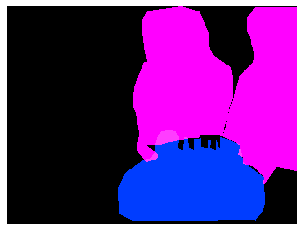

(480, 640, 3)
COCO_val2014_000000199551.jpg
{'person_bbx': [123.48, 152.1, 423.03000000000003, 253.54], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 166.98, 640.0, 423.20000000000005]}}
bed
person
lay
lay interaction


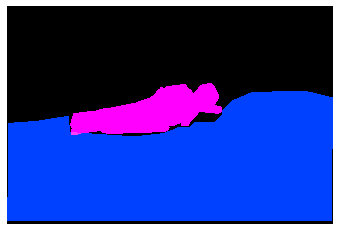

(428, 640, 3)
COCO_val2014_000000100624.jpg
{'person_bbx': [32.62, 51.82, 322.41, 421.24], 'Verbs': 'carry', 'object': {'obj_bbx': [176.36, 132.11, 208.48000000000002, 186.99]}}
cell phone
person
carry
carry interaction
{'person_bbx': [32.62, 51.82, 322.41, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [176.36, 132.11, 208.48000000000002, 186.99]}}
cell phone
person
hold
hold interaction
{'person_bbx': [32.62, 51.82, 322.41, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [32.62, 51.82, 322.41, 421.24], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [176.36, 132.11, 208.48000000000002, 186.99]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


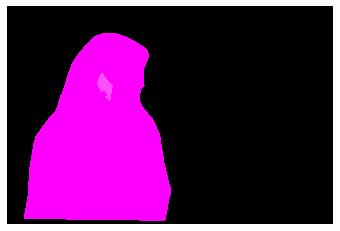

(427, 640, 3)
COCO_val2014_000000413666.jpg
{'person_bbx': [147.46, 65.84, 302.18, 251.06], 'Verbs': 'jump', 'object': {'obj_bbx': [202.38, 197.73, 276.49, 262.18]}}
skateboard
person
jump
jump interaction
{'person_bbx': [147.46, 65.84, 302.18, 251.06], 'Verbs': 'look', 'object': {'obj_bbx': [202.38, 197.73, 276.49, 262.18]}}
skateboard
person
look
look interaction
{'person_bbx': [537.4, 97.34, 632.3299999999999, 269.51], 'Verbs': 'look', 'object': {'obj_bbx': [563.35, 251.19, 615.23, 282.15999999999997]}}
skateboard
person
look
look interaction
{'person_bbx': [147.46, 65.84, 302.18, 251.06], 'Verbs': 'skateboard', 'object': {'obj_bbx': [202.38, 197.73, 276.49, 262.18]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [537.4, 97.34, 632.3299999999999, 269.51], 'Verbs': 'skateboard', 'object': {'obj_bbx': [563.35, 251.19, 615.23, 282.15999999999997]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [147.46, 65.84, 302.18, 251.06], 'Verbs': 'stand', 

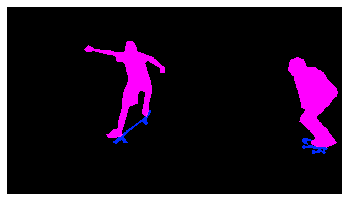

(358, 640, 3)
COCO_val2014_000000573058.jpg
{'person_bbx': [36.35, 126.8, 307.79, 486.68], 'Verbs': 'jump', 'object': {'obj_bbx': [161.92, 480.28, 303.99, 514.97]}}
person
skateboard
jump
jump interaction
{'person_bbx': [36.35, 126.8, 307.79, 486.68], 'Verbs': 'look', 'object': {'obj_bbx': [161.92, 480.28, 303.99, 514.97]}}
person
skateboard
look
look interaction
{'person_bbx': [36.35, 126.8, 307.79, 486.68], 'Verbs': 'skateboard', 'object': {'obj_bbx': [161.92, 480.28, 303.99, 514.97]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [36.35, 126.8, 307.79, 486.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


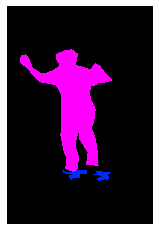

(640, 427, 3)
COCO_val2014_000000169048.jpg
{'person_bbx': [2.11, 0.35, 234.05, 235.81], 'Verbs': 'hold', 'object': {'obj_bbx': [35.87, 80.89, 157.56, 168.81]}}
person
laptop
hold
hold interaction
{'person_bbx': [166.7, 2.11, 497.28, 270.8], 'Verbs': 'hold', 'object': {'obj_bbx': [295.9, 138.01, 387.75, 207.51]}}
person
book
hold
hold interaction
{'person_bbx': [166.7, 2.11, 497.28, 270.8], 'Verbs': 'read', 'object': {'obj_bbx': [295.9, 138.01, 387.75, 207.51]}}
person
book
read
read interaction
{'person_bbx': [2.11, 0.35, 234.05, 235.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [166.7, 2.11, 497.28, 270.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.11, 0.35, 234.05, 235.81], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [35.87, 80.89, 157.56, 168.81]}}
person
laptop
work_on_computer
work_on_computer interaction


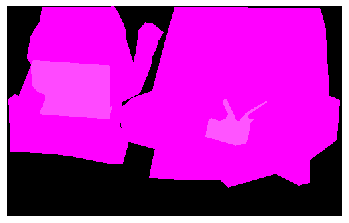

(313, 500, 3)
COCO_val2014_000000527086.jpg
{'person_bbx': [86.36, 211.1, 384.78000000000003, 420.28], 'Verbs': 'hold', 'object': {'obj_bbx': [184.71, 253.88, 217.25, 293.51]}}
person
cup
hold
hold interaction
{'person_bbx': [86.36, 211.1, 384.78000000000003, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [369.35, 175.99, 545.09, 396.17], 'Verbs': 'look', 'object': {'obj_bbx': [24.26, 87.49, 168.88, 222.57]}}
person
person
look
look interaction
{'person_bbx': [86.36, 211.1, 384.78000000000003, 420.28], 'Verbs': 'sit', 'object': {'obj_bbx': [261.74, 345.9, 408.85, 421.35999999999996]}}
chair
person
sit
sit interaction
{'person_bbx': [369.35, 175.99, 545.09, 396.17], 'Verbs': 'sit', 'object': {'obj_bbx': [446.11, 289.54, 563.6, 426.17]}}
chair
person
sit
sit interaction


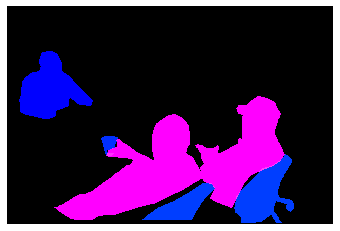

(427, 640, 3)
COCO_val2014_000000054761.jpg
{'person_bbx': [33.43, 93.6, 230.89000000000001, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 135.44, 177.08, 418.78]}}
person
suitcase
hold
hold interaction
{'person_bbx': [216.2, 86.82, 347.26, 423.93], 'Verbs': 'hold', 'object': {'obj_bbx': [292.98, 150.79, 498.21000000000004, 424.61]}}
person
suitcase
hold
hold interaction
{'person_bbx': [415.45, 82.37, 592.13, 419.51], 'Verbs': 'hold', 'object': {'obj_bbx': [528.66, 227.56, 598.76, 279.63]}}
person
book
hold
hold interaction
{'person_bbx': [415.45, 82.37, 592.13, 419.51], 'Verbs': 'look', 'object': {'obj_bbx': [528.66, 227.56, 598.76, 279.63]}}
person
book
look
look interaction
{'person_bbx': [415.45, 82.37, 592.13, 419.51], 'Verbs': 'read', 'object': {'obj_bbx': [528.66, 227.56, 598.76, 279.63]}}
person
book
read
read interaction
{'person_bbx': [33.43, 93.6, 230.89000000000001, 425.0], 'Verbs': 'sit', 'object': {'obj_bbx': [203.35, 279.11, 234.97, 300.61]}}
person
bench
sit
sit 

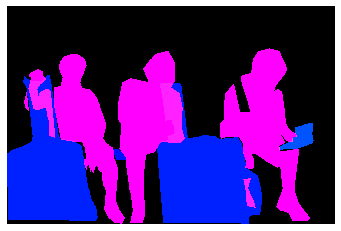

(425, 640, 3)
COCO_val2014_000000047801.jpg
{'person_bbx': [58.92, 80.91, 560.04, 530.6899999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [243.42, 357.57, 338.32, 433.21]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [58.92, 80.91, 560.04, 530.6899999999999], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [211.27, 232.67, 316.03000000000003, 271.58]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [58.92, 80.91, 560.04, 530.6899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [211.27, 232.67, 316.03000000000003, 271.58]}}
person
spoon
hold
hold interaction


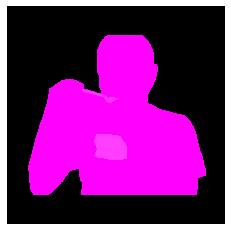

(612, 612, 3)
COCO_val2014_000000258036.jpg
{'person_bbx': [55.96, 96.31, 413.27, 614.3399999999999], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 140.63, 424.75, 632.8299999999999]}}
bed
person
lay
lay interaction


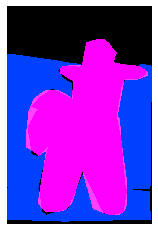

(640, 425, 3)
COCO_val2014_000000265063.jpg
{'person_bbx': [472.23, 208.71, 521.19, 286.65], 'Verbs': 'ride', 'object': {'obj_bbx': [461.19, 235.47, 535.49, 337.86]}}
horse
person
ride
ride interaction
{'person_bbx': [524.58, 215.02, 563.51, 289.82], 'Verbs': 'ride', 'object': {'obj_bbx': [515.41, 241.84, 594.93, 339.58]}}
horse
person
ride
ride interaction
{'person_bbx': [472.23, 208.71, 521.19, 286.65], 'Verbs': 'sit', 'object': {'obj_bbx': [461.19, 235.47, 535.49, 337.86]}}
horse
person
sit
sit interaction
{'person_bbx': [524.58, 215.02, 563.51, 289.82], 'Verbs': 'sit', 'object': {'obj_bbx': [515.41, 241.84, 594.93, 339.58]}}
horse
person
sit
sit interaction


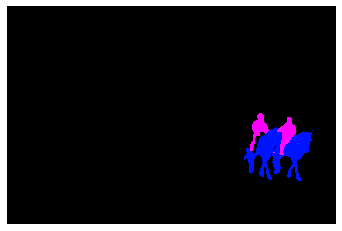

(424, 640, 3)
COCO_val2014_000000432239.jpg
{'person_bbx': [126.94, 104.72, 253.66, 417.19000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [127.28, 244.85, 206.01999999999998, 307.42]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [126.94, 104.72, 253.66, 417.19000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [126.94, 104.72, 253.66, 417.19000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


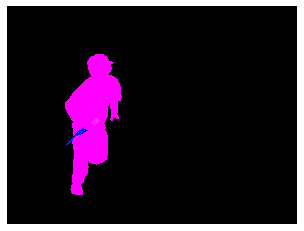

(480, 640, 3)
COCO_val2014_000000076822.jpg
{'person_bbx': [227.36, 234.92, 295.89, 294.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [227.36, 234.92, 295.89, 294.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [227.36, 234.92, 295.89, 294.90999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski


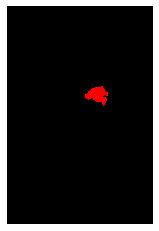

(640, 427, 3)
COCO_val2014_000000109229.jpg
{'person_bbx': [109.3, 296.03, 352.36, 587.98], 'Verbs': 'catch', 'object': {'obj_bbx': [283.5, 300.42, 346.05, 331.86]}}
person
frisbee
catch
catch interaction
{'person_bbx': [109.3, 296.03, 352.36, 587.98], 'Verbs': 'look', 'object': {'obj_bbx': [283.5, 300.42, 346.05, 331.86]}}
person
frisbee
look
look interaction
{'person_bbx': [109.3, 296.03, 352.36, 587.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.3, 296.03, 352.36, 587.98], 'Verbs': 'throw', 'object': {'obj_bbx': [283.5, 300.42, 346.05, 331.86]}}
person
frisbee
throw
throw interaction


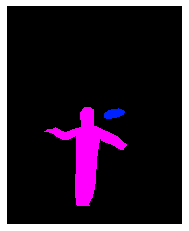

(640, 514, 3)
COCO_val2014_000000172952.jpg
{'person_bbx': [27.15, 12.22, 255.17000000000002, 597.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [214.32, 50.74, 387.0, 597.59], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [27.15, 12.22, 255.17000000000002, 597.21], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [214.32, 50.74, 387.0, 597.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [27.15, 12.22, 255.17000000000002, 597.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


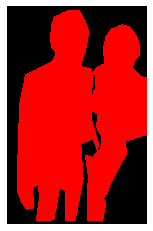

(604, 387, 3)
COCO_val2014_000000492605.jpg
{'person_bbx': [376.67, 115.54, 504.42, 412.36], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [503.3, 219.89, 607.14, 275.7]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [376.67, 115.54, 504.42, 412.36], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [493.61, 182.37, 511.99, 198.36]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [376.67, 115.54, 504.42, 412.36], 'Verbs': 'hold', 'object': {'obj_bbx': [503.3, 219.89, 607.14, 275.7]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [376.67, 115.54, 504.42, 412.36], 'Verbs': 'look', 'object': {'obj_bbx': [493.61, 182.37, 511.99, 198.36]}}
sports ball
person
look
look interaction
{'person_bbx': [376.67, 115.54, 504.42, 412.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


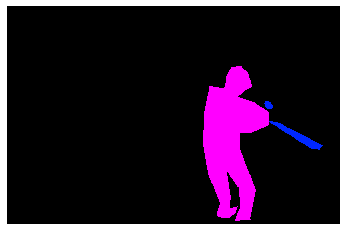

(418, 640, 3)
COCO_val2014_000000497674.jpg
{'person_bbx': [57.81, 66.34, 276.15, 265.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [146.21, 136.33, 187.81, 173.23000000000002]}}
book
person
hold
hold interaction
{'person_bbx': [57.81, 66.34, 276.15, 265.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [146.21, 136.33, 187.81, 173.23000000000002]}}
book
person
look
look interaction
{'person_bbx': [57.81, 66.34, 276.15, 265.33000000000004], 'Verbs': 'read', 'object': {'obj_bbx': [146.21, 136.33, 187.81, 173.23000000000002]}}
book
person
read
read interaction
{'person_bbx': [57.81, 66.34, 276.15, 265.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.77, 138.19, 193.37, 287.06]}}
bench
person
sit
sit interaction


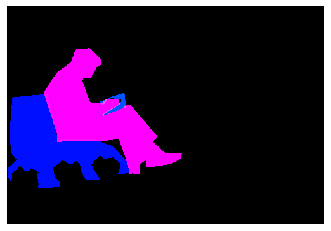

(343, 500, 3)
COCO_val2014_000000437099.jpg
{'person_bbx': [0.0, 167.18, 157.21, 377.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [211.22, 107.99, 333.0, 281.74], 'Verbs': 'look', 'object': {'obj_bbx': [208.61, 327.12, 231.85000000000002, 346.48]}}
person
donut
look
look interaction
{'person_bbx': [0.0, 167.18, 157.21, 377.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [211.22, 107.99, 333.0, 281.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 167.18, 157.21, 377.70000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [211.22, 107.99, 333.0, 281.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


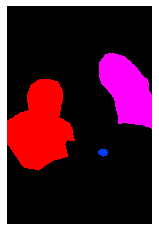

(500, 333, 3)
COCO_val2014_000000181499.jpg
{'person_bbx': [167.16, 382.73, 288.2, 506.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [167.16, 382.73, 288.2, 506.08000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [231.08, 6.35, 640.0, 505.49]}}
person
laptop
work_on_computer
work_on_computer interaction


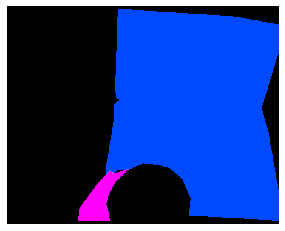

(513, 640, 3)
COCO_val2014_000000475159.jpg
{'person_bbx': [306.66, 75.82, 452.48, 349.27], 'Verbs': 'carry', 'object': {'obj_bbx': [204.94, 185.53, 447.64, 320.36]}}
surfboard
person
carry
carry interaction
{'person_bbx': [306.66, 75.82, 452.48, 349.27], 'Verbs': 'hold', 'object': {'obj_bbx': [204.94, 185.53, 447.64, 320.36]}}
surfboard
person
hold
hold interaction
{'person_bbx': [306.66, 75.82, 452.48, 349.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [306.66, 75.82, 452.48, 349.27], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


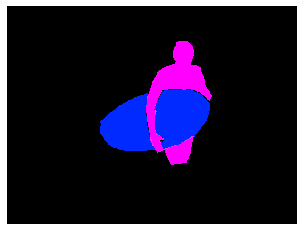

(480, 640, 3)
COCO_val2014_000000110769.jpg
{'person_bbx': [73.18, 196.0, 387.44, 395.1], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [73.18, 196.0, 387.44, 395.1], 'Verbs': 'snowboard', 'object': {'obj_bbx': [249.42, 167.73, 422.29999999999995, 393.0]}}
person
snowboard
snowboard
snowboard interaction


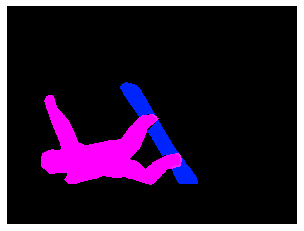

(480, 640, 3)
COCO_val2014_000000225850.jpg
{'person_bbx': [50.25, 92.03, 167.8, 289.47], 'Verbs': 'hold', 'object': {'obj_bbx': [107.71, 131.84, 117.30999999999999, 145.9]}}
cell phone
person
hold
hold interaction
{'person_bbx': [50.25, 92.03, 167.8, 289.47], 'Verbs': 'sit', 'object': {'obj_bbx': [0.37, 221.02, 173.55, 289.97]}}
bench
person
sit
sit interaction
{'person_bbx': [50.25, 92.03, 167.8, 289.47], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [107.71, 131.84, 117.30999999999999, 145.9]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


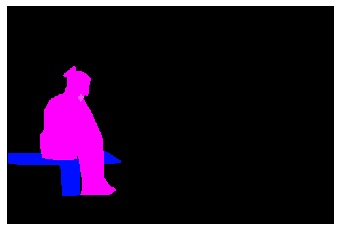

(333, 500, 3)
COCO_val2014_000000273420.jpg
{'person_bbx': [169.89, 107.72, 270.56, 306.37], 'Verbs': 'hold', 'object': {'obj_bbx': [190.51, 126.18, 202.45999999999998, 146.22]}}
person
cell phone
hold
hold interaction
{'person_bbx': [169.89, 107.72, 270.56, 306.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [169.89, 107.72, 270.56, 306.37], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [190.51, 126.18, 202.45999999999998, 146.22]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


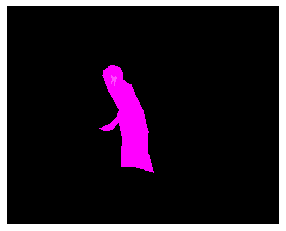

(400, 500, 3)
COCO_val2014_000000098280.jpg
{'person_bbx': [59.5, 2.97, 501.94, 421.41], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [246.24, 299.92, 451.12, 429.0]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [59.5, 2.97, 501.94, 421.41], 'Verbs': 'hold', 'object': {'obj_bbx': [246.24, 299.92, 451.12, 429.0]}}
person
banana
hold
hold interaction
{'person_bbx': [59.5, 2.97, 501.94, 421.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


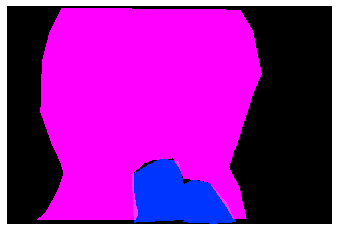

(429, 640, 3)
COCO_val2014_000000044171.jpg
{'person_bbx': [164.3, 98.9, 555.1700000000001, 474.73], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [258.88, 292.31, 446.56, 465.98]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [164.3, 98.9, 555.1700000000001, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [258.88, 292.31, 446.56, 465.98]}}
person
donut
hold
hold interaction
{'person_bbx': [164.3, 98.9, 555.1700000000001, 474.73], 'Verbs': 'look', 'object': {'obj_bbx': [258.88, 292.31, 446.56, 465.98]}}
person
donut
look
look interaction
{'person_bbx': [164.3, 98.9, 555.1700000000001, 474.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


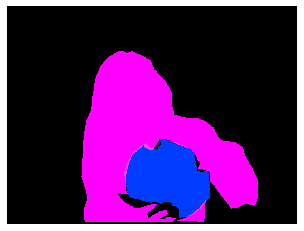

(480, 640, 3)
COCO_val2014_000000132272.jpg
{'person_bbx': [154.83, 42.18, 501.33000000000004, 419.16], 'Verbs': 'drink', 'object': {'obj_bbx': [219.22, 169.53, 282.36, 300.40999999999997]}}
person
wine glass
drink
drink interaction
{'person_bbx': [154.83, 42.18, 501.33000000000004, 419.16], 'Verbs': 'hold', 'object': {'obj_bbx': [219.22, 169.53, 282.36, 300.40999999999997]}}
person
wine glass
hold
hold interaction
{'person_bbx': [154.83, 42.18, 501.33000000000004, 419.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [154.83, 42.18, 501.33000000000004, 419.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


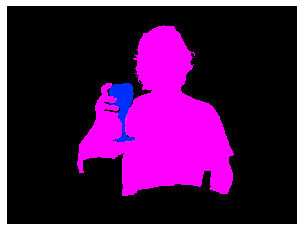

(480, 640, 3)
COCO_val2014_000000468169.jpg
{'person_bbx': [15.82, 37.39, 339.42, 477.47999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [132.01, 161.1, 261.58, 186.69]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [15.82, 37.39, 339.42, 477.47999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [216.06, 158.77, 247.71, 188.43]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [15.82, 37.39, 339.42, 477.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [132.01, 161.1, 261.58, 186.69]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [15.82, 37.39, 339.42, 477.47999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [216.06, 158.77, 247.71, 188.43]}}
sports ball
person
look
look interaction
{'person_bbx': [15.82, 37.39, 339.42, 477.47999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


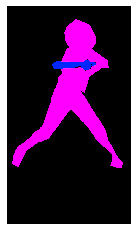

(640, 363, 3)
COCO_val2014_000000418604.jpg
{'person_bbx': [18.31, 181.45, 508.93, 404.11], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 5.74, 640.0, 421.26]}}
bed
person
lay
lay interaction


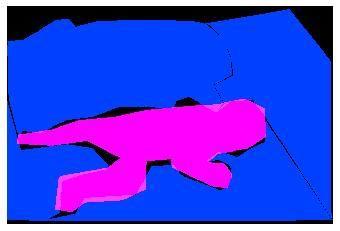

(427, 640, 3)
COCO_val2014_000000333665.jpg
{'person_bbx': [160.31, 192.96, 342.96000000000004, 553.54], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [176.6, 142.45, 257.75, 409.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [176.6, 142.45, 257.75, 409.19], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


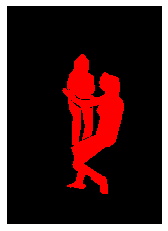

(640, 455, 3)
COCO_val2014_000000025282.jpg
{'person_bbx': [85.06, 52.25, 418.03000000000003, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [9.75, 45.24, 624.11, 474.31]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [85.06, 52.25, 418.03000000000003, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': [9.75, 45.24, 624.11, 474.31]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [85.06, 52.25, 418.03000000000003, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [9.75, 45.24, 624.11, 474.31]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [85.06, 52.25, 418.03000000000003, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


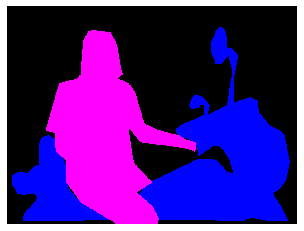

(480, 640, 3)
COCO_val2014_000000266922.jpg
{'person_bbx': [138.77, 64.04, 231.28000000000003, 278.16], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [205.66, 151.35, 281.45, 305.6], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [424.51, 206.66, 500.0, 328.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [138.77, 64.04, 231.28000000000003, 278.16], 'Verbs': 'ski', 'object': {'obj_bbx': [110.86, 270.09, 248.55, 284.59]}}
person
skis
ski
ski interaction
{'person_bbx': [205.66, 151.35, 281.45, 305.6], 'Verbs': 'ski', 'object': {'obj_bbx': [172.31, 292.08, 306.03999999999996, 311.14]}}
person
skis
ski
ski interaction
{'person_bbx': [424.51, 206.66, 500.0, 328.27], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [138.77, 64.04, 231.28000000000003, 278.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [205.66, 151.35, 281.45, 305.6], 'Verbs': 'stand', 'object': {'obj_

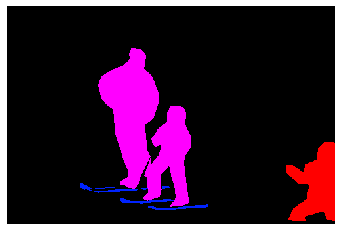

(332, 500, 3)
COCO_val2014_000000178283.jpg
{'person_bbx': [310.02, 35.29, 462.03999999999996, 277.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [310.02, 35.29, 462.03999999999996, 277.53000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [453.78, 167.3, 524.17, 264.43]}}
person
surfboard
surf
surf interaction


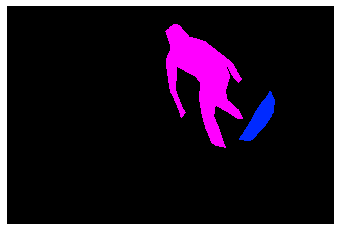

(426, 640, 3)
COCO_val2014_000000486457.jpg
{'person_bbx': [28.34, 175.7, 82.33, 268.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [55.58, 217.69, 141.61, 278.28]}}
person
laptop
look
look interaction
{'person_bbx': [28.34, 175.7, 82.33, 268.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [28.34, 175.7, 82.33, 268.65999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [55.58, 217.69, 141.61, 278.28]}}
person
laptop
work_on_computer
work_on_computer interaction


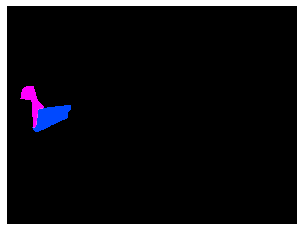

(480, 640, 3)
COCO_val2014_000000514097.jpg
{'person_bbx': [219.55, 294.34, 377.4, 628.69], 'Verbs': 'hold', 'object': {'obj_bbx': [273.13, 357.72, 298.29, 384.17]}}
cell phone
person
hold
hold interaction
{'person_bbx': [219.55, 294.34, 377.4, 628.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [219.55, 294.34, 377.4, 628.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [273.13, 357.72, 298.29, 384.17]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


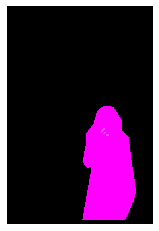

(640, 427, 3)
COCO_val2014_000000057542.jpg
{'person_bbx': [52.19, 84.95, 388.37, 478.84999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [52.19, 84.95, 388.37, 478.84999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [52.19, 84.95, 388.37, 478.84999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


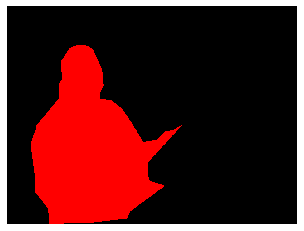

(480, 640, 3)
COCO_val2014_000000068166.jpg
{'person_bbx': [197.76, 114.74, 290.3, 248.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [197.76, 114.74, 290.3, 248.12], 'Verbs': 'jump', 'object': {'obj_bbx': [170.05, 242.01, 345.53, 257.92]}}
person
skis
jump
jump interaction
{'person_bbx': [197.76, 114.74, 290.3, 248.12], 'Verbs': 'look', 'object': {'obj_bbx': [170.05, 242.01, 345.53, 257.92]}}
person
skis
look
look interaction
{'person_bbx': [197.76, 114.74, 290.3, 248.12], 'Verbs': 'ski', 'object': {'obj_bbx': [170.05, 242.01, 345.53, 257.92]}}
person
skis
ski
ski interaction
{'person_bbx': [197.76, 114.74, 290.3, 248.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


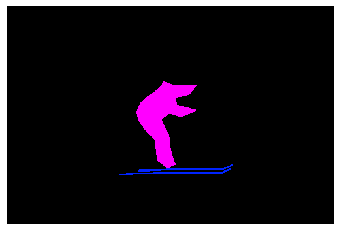

(333, 500, 3)
COCO_val2014_000000022371.jpg
{'person_bbx': [93.36, 21.28, 370.92, 271.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [93.36, 21.28, 370.92, 271.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


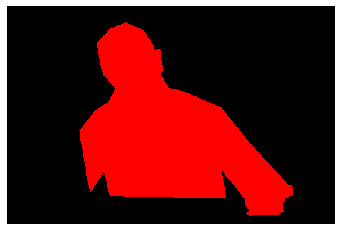

(282, 425, 3)
COCO_val2014_000000068546.jpg
{'person_bbx': [365.32, 42.33, 640.0, 478.0], 'Verbs': 'hold', 'object': {'obj_bbx': [319.02, 357.69, 387.77, 471.56]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 69.63, 278.97, 478.0], 'Verbs': 'hold', 'object': {'obj_bbx': [169.45, 297.28, 243.64, 427.87]}}
cell phone
person
hold
hold interaction
{'person_bbx': [365.32, 42.33, 640.0, 478.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 69.63, 278.97, 478.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [365.32, 42.33, 640.0, 478.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 69.63, 278.97, 478.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


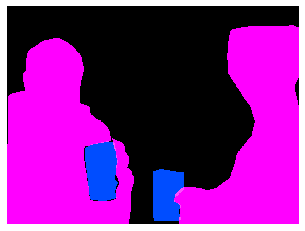

(478, 640, 3)
COCO_val2014_000000462890.jpg
{'person_bbx': [121.91, 29.59, 640.0, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [218.3, 190.93, 258.0, 244.49]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [121.91, 29.59, 640.0, 425.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 0.72, 640.0, 419.96000000000004]}}
bed
person
lay
lay interaction
{'person_bbx': [121.91, 29.59, 640.0, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


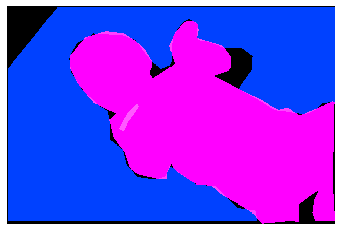

(425, 640, 3)
COCO_val2014_000000120357.jpg
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [254.33, 418.13, 264.89, 435.92]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [226.02, 367.3, 421.62, 561.46]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'hold', 'object': {'obj_bbx': [254.33, 418.13, 264.89, 435.92]}}
person
knife
hold
hold interaction
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'look', 'object': {'obj_bbx': [226.02, 367.3, 421.62, 561.46]}}
person
cake
look
look interaction
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [8.53, 3.41, 262.83, 580.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


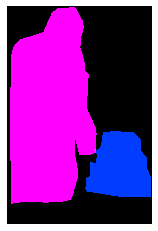

(640, 425, 3)
COCO_val2014_000000275392.jpg
{'person_bbx': [139.25, 91.49, 339.34000000000003, 465.43], 'Verbs': 'hold', 'object': {'obj_bbx': [67.3, 112.62, 302.15, 624.89]}}
horse
person
hold
hold interaction
{'person_bbx': [139.25, 91.49, 339.34000000000003, 465.43], 'Verbs': 'ride', 'object': {'obj_bbx': [67.3, 112.62, 302.15, 624.89]}}
horse
person
ride
ride interaction
{'person_bbx': [139.25, 91.49, 339.34000000000003, 465.43], 'Verbs': 'sit', 'object': {'obj_bbx': [67.3, 112.62, 302.15, 624.89]}}
horse
person
sit
sit interaction
{'person_bbx': [139.25, 91.49, 339.34000000000003, 465.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


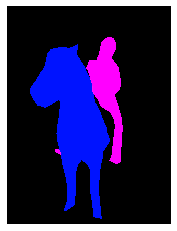

(640, 480, 3)
COCO_val2014_000000480472.jpg
{'person_bbx': [0.84, 0.0, 167.32, 301.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [157.95, 25.26, 311.92999999999995, 258.08], 'Verbs': 'hold', 'object': {'obj_bbx': [228.38, 141.17, 261.03, 165.14]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.84, 0.0, 167.32, 301.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [157.95, 25.26, 311.92999999999995, 258.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.84, 0.0, 167.32, 301.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [157.95, 25.26, 311.92999999999995, 258.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


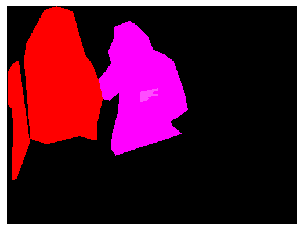

(375, 500, 3)
COCO_val2014_000000133869.jpg
{'person_bbx': [169.71, 73.74, 335.43, 426.72], 'Verbs': 'carry', 'object': {'obj_bbx': [231.69, 135.32, 258.07, 164.5]}}
cell phone
person
carry
carry interaction
{'person_bbx': [169.71, 73.74, 335.43, 426.72], 'Verbs': 'hold', 'object': {'obj_bbx': [231.69, 135.32, 258.07, 164.5]}}
cell phone
person
hold
hold interaction
{'person_bbx': [169.71, 73.74, 335.43, 426.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 4.29, 166.48, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [169.71, 73.74, 335.43, 426.72], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [231.69, 135.32, 258.07, 164.5]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


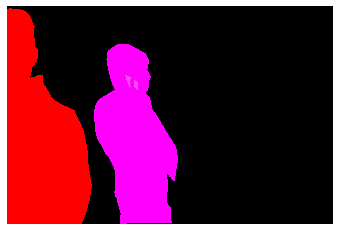

(427, 640, 3)
COCO_val2014_000000573647.jpg
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [254.07, 220.74, 280.7, 239.06]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'hold', 'object': {'obj_bbx': [254.07, 220.74, 280.7, 239.06]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [280.84, 211.46, 358.82, 327.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


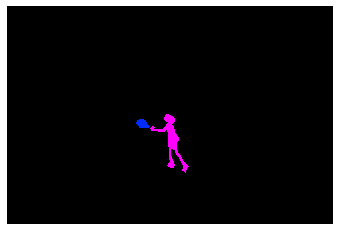

(427, 640, 3)
COCO_val2014_000000248353.jpg
{'person_bbx': [300.87, 152.52, 331.72, 260.94], 'Verbs': 'hold', 'object': {'obj_bbx': [255.02, 261.25, 356.66, 268.99]}}
person
skis
hold
hold interaction
{'person_bbx': [48.36, 172.94, 70.13, 248.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.3, 165.14, 23.82, 249.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [166.15, 171.49, 200.47, 247.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.3, 165.14, 23.82, 249.07], 'Verbs': 'look', 'object': {'obj_bbx': [48.36, 172.94, 70.13, 248.79]}}
person
person
look
look interaction
{'person_bbx': [300.87, 152.52, 331.72, 260.94], 'Verbs': 'ski', 'object': {'obj_bbx': [255.02, 261.25, 356.66, 268.99]}}
person
skis
ski
ski interaction
{'person_bbx': [48.36, 172.94, 70.13, 248.79], 'Verbs': 'ski', 'object': {'obj_bbx': [32.14, 243.99, 96.42, 247.44]}}
person
skis
ski
ski interaction
{'person_bbx': [0.3, 165.14, 23.8

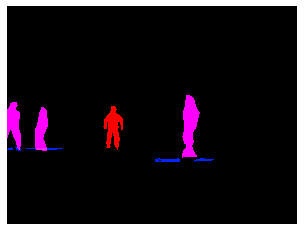

(375, 500, 3)
COCO_val2014_000000529355.jpg
{'person_bbx': [1.67, 116.69, 217.54999999999998, 393.82], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 2.26, 640.0, 473.21999999999997]}}
person
car
ride
ride interaction
{'person_bbx': [396.47, 129.66, 639.58, 423.9], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 2.26, 640.0, 473.21999999999997]}}
car
person
ride
ride interaction
{'person_bbx': [1.67, 116.69, 217.54999999999998, 393.82], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [396.47, 129.66, 639.58, 423.9], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.67, 116.69, 217.54999999999998, 393.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [396.47, 129.66, 639.58, 423.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


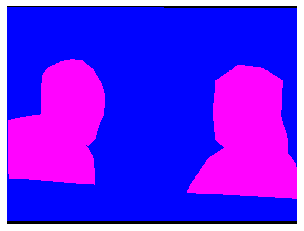

(480, 640, 3)
COCO_val2014_000000441472.jpg
{'person_bbx': [135.98, 98.71, 332.16999999999996, 361.34], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [135.98, 98.71, 332.16999999999996, 361.34], 'Verbs': 'snowboard', 'object': {'obj_bbx': [164.75, 298.21, 317.8, 384.96999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [135.98, 98.71, 332.16999999999996, 361.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


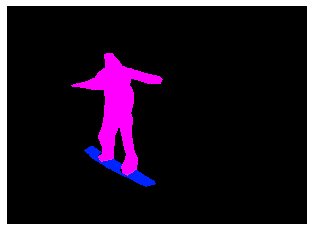

(464, 640, 3)
COCO_val2014_000000033576.jpg
{'person_bbx': [55.47, 111.57, 194.96, 398.98], 'Verbs': 'hold', 'object': {'obj_bbx': [95.91, 132.55, 116.94999999999999, 155.81]}}
cell phone
person
hold
hold interaction
{'person_bbx': [55.47, 111.57, 194.96, 398.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [55.47, 111.57, 194.96, 398.98], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [95.91, 132.55, 116.94999999999999, 155.81]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [55.47, 111.57, 194.96, 398.98], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


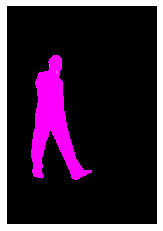

(500, 343, 3)
COCO_val2014_000000390048.jpg
{'person_bbx': [183.27, 12.54, 640.0, 420.35], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [299.4, 221.04, 382.78999999999996, 313.47]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [183.27, 12.54, 640.0, 420.35], 'Verbs': 'hold', 'object': {'obj_bbx': [299.4, 221.04, 382.78999999999996, 313.47]}}
person
donut
hold
hold interaction
{'person_bbx': [183.27, 12.54, 640.0, 420.35], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [183.27, 12.54, 640.0, 420.35], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


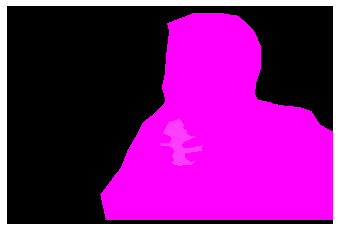

(427, 640, 3)
COCO_val2014_000000413044.jpg
{'person_bbx': [85.21, 1.08, 516.67, 473.53], 'Verbs': 'drink', 'object': {'obj_bbx': [157.46, 248.15, 259.76, 331.13]}}
person
cup
drink
drink interaction
{'person_bbx': [85.21, 1.08, 516.67, 473.53], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [306.34, 144.54, 404.49, 216.81]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [85.21, 1.08, 516.67, 473.53], 'Verbs': 'hold', 'object': {'obj_bbx': [306.34, 144.54, 404.49, 216.81]}}
person
donut
hold
hold interaction
{'person_bbx': [85.21, 1.08, 516.67, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': [491.52, 386.57, 636.8199999999999, 480.0]}}
person
bench
sit
sit interaction


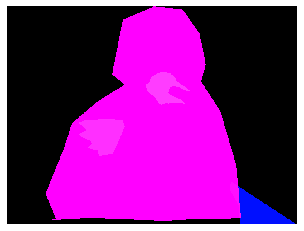

(480, 640, 3)
COCO_val2014_000000449828.jpg
{'person_bbx': [337.29, 114.59, 432.74, 236.84], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [337.29, 114.59, 432.74, 236.84], 'Verbs': 'surf', 'object': {'obj_bbx': [325.47, 204.45, 369.38, 252.52999999999997]}}
person
surfboard
surf
surf interaction


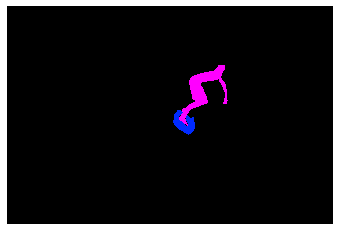

(428, 640, 3)
COCO_val2014_000000190362.jpg
{'person_bbx': [2.87, 2.87, 97.58, 203.77], 'Verbs': 'carry', 'object': {'obj_bbx': [77.45, 64.84, 221.57, 199.71]}}
person
handbag
carry
carry interaction
{'person_bbx': [2.87, 2.87, 97.58, 203.77], 'Verbs': 'hold', 'object': {'obj_bbx': [77.45, 64.84, 221.57, 199.71]}}
person
handbag
hold
hold interaction
{'person_bbx': [2.87, 2.87, 97.58, 203.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


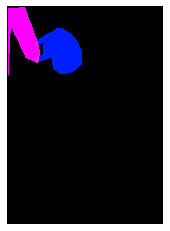

(640, 458, 3)
COCO_val2014_000000120070.jpg
{'person_bbx': [0.96, 0.96, 293.62, 243.73000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [201.51, 91.16, 428.91999999999996, 252.35999999999999]}}
person
laptop
look
look interaction
{'person_bbx': [0.96, 0.96, 293.62, 243.73000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.96, 0.96, 293.62, 243.73000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [201.51, 91.16, 428.91999999999996, 252.35999999999999]}}
person
laptop
work_on_computer
work_on_computer interaction


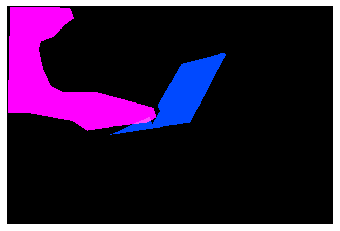

(427, 640, 3)
COCO_val2014_000000268018.jpg
{'person_bbx': [47.35, 3.04, 480.0, 635.86], 'Verbs': 'hold', 'object': {'obj_bbx': [220.99, 98.44, 328.61, 434.21999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [47.35, 3.04, 480.0, 635.86], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [220.99, 98.44, 328.61, 434.21999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


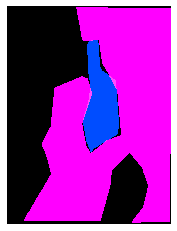

(640, 480, 3)
COCO_val2014_000000515854.jpg
{'person_bbx': [562.91, 237.02, 591.01, 330.83000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [562.91, 237.02, 591.01, 330.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [562.91, 237.02, 591.01, 330.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [506.2, 252.29, 543.18, 354.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [562.91, 237.02, 591.01, 330.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [506.2, 252.29, 543.18, 354.63], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


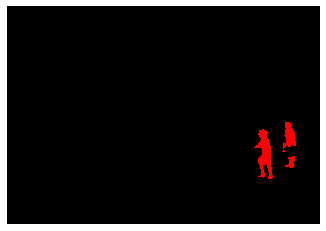

(446, 640, 3)
COCO_val2014_000000485742.jpg
{'person_bbx': [177.54, 226.85, 273.32, 524.2], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [188.72, 252.83, 232.29, 290.0]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [177.54, 226.85, 273.32, 524.2], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [258.61, 38.52, 275.78000000000003, 56.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [177.54, 226.85, 273.32, 524.2], 'Verbs': 'hold', 'object': {'obj_bbx': [188.72, 252.83, 232.29, 290.0]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [177.54, 226.85, 273.32, 524.2], 'Verbs': 'look', 'object': {'obj_bbx': [258.61, 38.52, 275.78000000000003, 56.78]}}
sports ball
person
look
look interaction
{'person_bbx': [177.54, 226.85, 273.32, 524.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


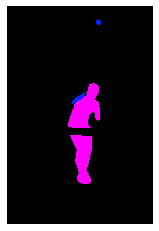

(640, 427, 3)
COCO_val2014_000000392392.jpg
{'person_bbx': [170.76, 58.61, 316.09000000000003, 299.76], 'Verbs': 'ride', 'object': {'obj_bbx': [165.04, 186.39, 333.91999999999996, 409.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [358.53, 94.32, 468.63, 266.16999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [355.94, 183.49, 463.71, 341.94]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [170.76, 58.61, 316.09000000000003, 299.76], 'Verbs': 'sit', 'object': {'obj_bbx': [165.04, 186.39, 333.91999999999996, 409.01]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [358.53, 94.32, 468.63, 266.16999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [355.94, 183.49, 463.71, 341.94]}}
motorcycle
person
sit
sit interaction


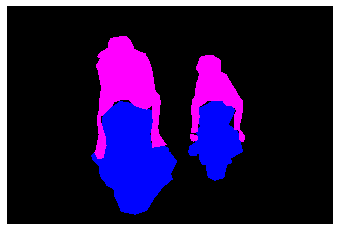

(427, 640, 3)
COCO_val2014_000000232684.jpg
{'person_bbx': [247.61, 10.36, 638.74, 420.68], 'Verbs': 'look', 'object': {'obj_bbx': [41.26, 166.8, 311.84999999999997, 398.05]}}
person
laptop
look
look interaction
{'person_bbx': [247.61, 10.36, 638.74, 420.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [247.61, 10.36, 638.74, 420.68], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [41.26, 166.8, 311.84999999999997, 398.05]}}
person
laptop
work_on_computer
work_on_computer interaction


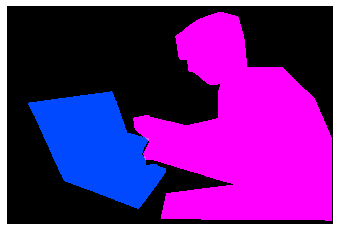

(427, 640, 3)
COCO_val2014_000000262353.jpg
{'person_bbx': [0.0, 70.32, 131.42, 502.62], 'Verbs': 'drink', 'object': {'obj_bbx': [101.1, 177.38, 128.54999999999998, 200.85]}}
person
cup
drink
drink interaction
{'person_bbx': [262.84, 70.32, 431.15, 351.61], 'Verbs': 'hold', 'object': {'obj_bbx': [373.98, 194.88, 398.91, 208.9]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 70.32, 131.42, 502.62], 'Verbs': 'hold', 'object': {'obj_bbx': [101.1, 177.38, 128.54999999999998, 200.85]}}
person
cup
hold
hold interaction
{'person_bbx': [96.84, 217.88, 314.72, 507.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [262.84, 70.32, 431.15, 351.61], 'Verbs': 'look', 'object': {'obj_bbx': [373.98, 194.88, 398.91, 208.9]}}
cell phone
person
look
look interaction
{'person_bbx': [466.71, 63.23, 640.0, 264.44], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 70.32, 131.42, 502.62]}}
person
person
look
look interaction
{'person_bbx': [0.0, 70.32, 131.42, 502.62], 'Ve

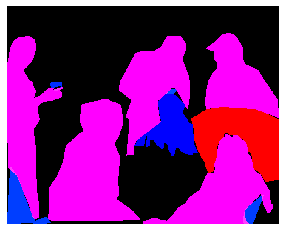

(513, 640, 3)
COCO_val2014_000000550576.jpg
{'person_bbx': [296.82, 125.35, 544.1800000000001, 224.3], 'Verbs': 'catch', 'object': {'obj_bbx': [269.78, 161.23, 300.09, 171.20999999999998]}}
person
frisbee
catch
catch interaction
{'person_bbx': [121.42, 149.72, 347.87, 265.87], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [296.82, 125.35, 544.1800000000001, 224.3], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [121.42, 149.72, 347.87, 265.87], 'Verbs': 'look', 'object': {'obj_bbx': [269.78, 161.23, 300.09, 171.20999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [296.82, 125.35, 544.1800000000001, 224.3], 'Verbs': 'look', 'object': {'obj_bbx': [269.78, 161.23, 300.09, 171.20999999999998]}}
person
frisbee
look
look interaction


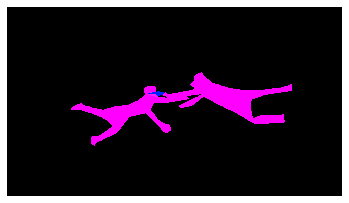

(361, 640, 3)
COCO_val2014_000000066238.jpg
{'person_bbx': [265.53, 62.78, 366.53999999999996, 212.16], 'Verbs': 'jump', 'object': {'obj_bbx': [234.89, 116.94, 385.21, 166.39]}}
person
snowboard
jump
jump interaction
{'person_bbx': [265.53, 62.78, 366.53999999999996, 212.16], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [265.53, 62.78, 366.53999999999996, 212.16], 'Verbs': 'snowboard', 'object': {'obj_bbx': [234.89, 116.94, 385.21, 166.39]}}
person
snowboard
snowboard
snowboard interaction


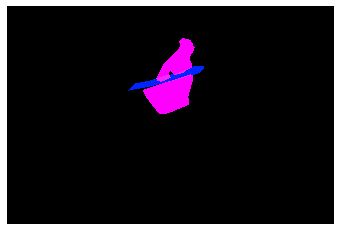

(426, 640, 3)
COCO_val2014_000000520478.jpg
{'person_bbx': [239.04, 122.17, 467.48, 419.05], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [125.15, 151.06, 262.98, 207.44]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [239.04, 122.17, 467.48, 419.05], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [83.24, 212.59, 98.53999999999999, 229.46]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [239.04, 122.17, 467.48, 419.05], 'Verbs': 'hold', 'object': {'obj_bbx': [125.15, 151.06, 262.98, 207.44]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [239.04, 122.17, 467.48, 419.05], 'Verbs': 'look', 'object': {'obj_bbx': [83.24, 212.59, 98.53999999999999, 229.46]}}
person
sports ball
look
look interaction
{'person_bbx': [239.04, 122.17, 467.48, 419.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


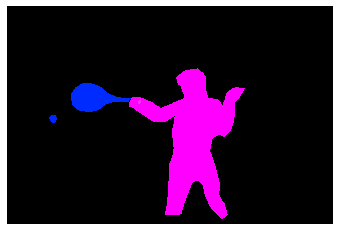

(427, 640, 3)
COCO_val2014_000000085826.jpg
{'person_bbx': [202.32, 101.33, 480.71999999999997, 419.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [292.31, 279.04, 638.56, 474.40000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [202.32, 101.33, 480.71999999999997, 419.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 10.79, 639.64, 478.92]}}
bed
person
sit
sit interaction
{'person_bbx': [202.32, 101.33, 480.71999999999997, 419.78999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [202.32, 101.33, 480.71999999999997, 419.78999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [292.31, 279.04, 638.56, 474.40000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


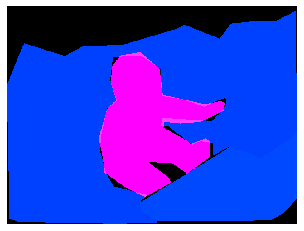

(480, 640, 3)
COCO_val2014_000000146676.jpg
{'person_bbx': [252.95, 40.4, 403.96, 396.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [252.95, 40.4, 403.96, 396.26], 'Verbs': 'snowboard', 'object': {'obj_bbx': [244.4, 348.8, 410.65999999999997, 409.71000000000004]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [252.95, 40.4, 403.96, 396.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


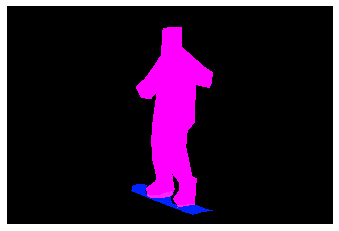

(428, 640, 3)
COCO_val2014_000000510138.jpg
{'person_bbx': [38.92, 30.27, 373.33000000000004, 485.77], 'Verbs': 'look', 'object': {'obj_bbx': [204.68, 309.19, 585.23, 555.6800000000001]}}
person
laptop
look
look interaction
{'person_bbx': [38.92, 30.27, 373.33000000000004, 485.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [38.92, 30.27, 373.33000000000004, 485.77], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [204.68, 309.19, 585.23, 555.6800000000001]}}
person
laptop
work_on_computer
work_on_computer interaction


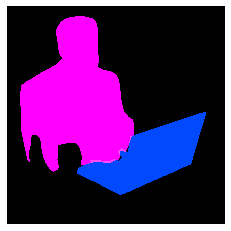

(640, 640, 3)
COCO_val2014_000000415073.jpg
{'person_bbx': [67.96, 52.85, 639.64, 471.37], 'Verbs': 'sit', 'object': {'obj_bbx': [81.73, 271.03, 216.56, 421.47999999999996]}}
person
chair
sit
sit interaction
{'person_bbx': [67.96, 52.85, 639.64, 471.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


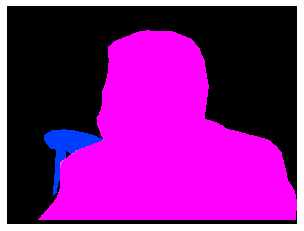

(480, 640, 3)
COCO_val2014_000000182236.jpg


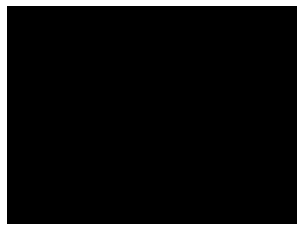

(480, 640, 3)
COCO_val2014_000000071306.jpg
{'person_bbx': [63.96, 73.7, 233.26000000000002, 582.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [63.96, 73.7, 233.26000000000002, 582.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [63.96, 73.7, 233.26000000000002, 582.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [63.96, 73.7, 233.26000000000002, 582.44], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


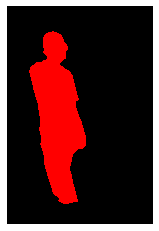

(640, 428, 3)
COCO_val2014_000000389256.jpg
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [262.06, 283.15, 292.7, 312.54999999999995]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [162.39, 290.49, 272.25, 365.96000000000004]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [262.06, 283.15, 292.7, 312.54999999999995]}}
person
knife
hold
hold interaction
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [162.39, 290.49, 272.25, 365.96000000000004]}}
person
cake
look
look interaction
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [267.11, 1.07, 505.51, 420.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': 

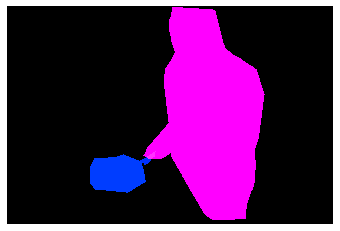

(427, 640, 3)
COCO_val2014_000000234518.jpg
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': [245.42, 212.0, 268.8, 230.06]}}
person
frisbee
catch
catch interaction
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [245.42, 212.0, 268.8, 230.06]}}
person
frisbee
look
look interaction
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.59, 214.87, 432.53, 367.20000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [245.42, 212.0, 268.8, 230.06]}}
person
frisbee
throw
throw interaction


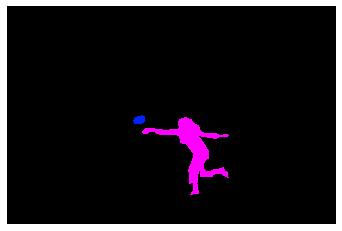

(424, 640, 3)
COCO_val2014_000000207177.jpg
{'person_bbx': [74.66, 91.89, 519.76, 295.78], 'Verbs': 'hold', 'object': {'obj_bbx': [264.37, 188.48, 351.05, 219.81]}}
person
surfboard
hold
hold interaction
{'person_bbx': [74.66, 91.89, 519.76, 295.78], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [74.66, 91.89, 519.76, 295.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


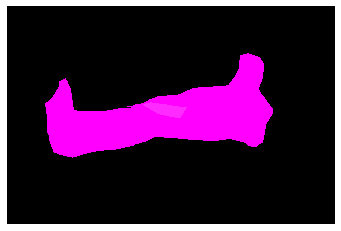

(425, 640, 3)
COCO_val2014_000000434510.jpg
{'person_bbx': [364.0, 269.58, 442.6, 350.02], 'Verbs': 'surf', 'object': {'obj_bbx': [359.98, 337.98, 389.21000000000004, 353.78000000000003]}}
person
surfboard
surf
surf interaction


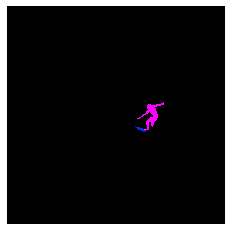

(612, 612, 3)
COCO_val2014_000000581062.jpg
{'person_bbx': [131.74, 51.28, 194.44, 164.76999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [128.77, 152.72, 178.77, 169.93]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [131.74, 51.28, 194.44, 164.76999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


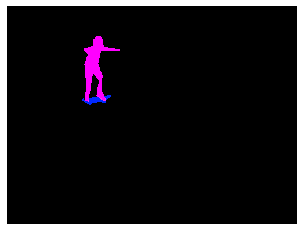

(375, 500, 3)
COCO_val2014_000000565043.jpg
{'person_bbx': [0.0, 0.0, 592.16, 473.43], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [362.75, 194.08, 542.4, 278.37]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.0, 592.16, 473.43], 'Verbs': 'hold', 'object': {'obj_bbx': [362.75, 194.08, 542.4, 278.37]}}
person
pizza
hold
hold interaction


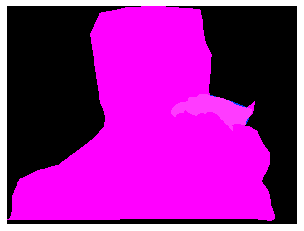

(480, 640, 3)
COCO_val2014_000000275117.jpg
{'person_bbx': [182.55, 62.39, 631.4100000000001, 475.71], 'Verbs': 'hold', 'object': {'obj_bbx': [187.58, 310.9, 229.4, 336.60999999999996]}}
person
remote
hold
hold interaction
{'person_bbx': [182.55, 62.39, 631.4100000000001, 475.71], 'Verbs': 'look', 'object': {'obj_bbx': [151.01, 198.47, 271.82, 347.33000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [182.55, 62.39, 631.4100000000001, 475.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.55, 62.39, 631.4100000000001, 475.71], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [151.01, 198.47, 271.82, 347.33000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


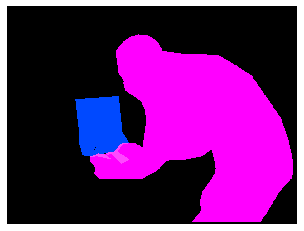

(480, 640, 3)
COCO_val2014_000000071938.jpg
{'person_bbx': [0.0, 0.0, 593.51, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [48.59, 1.19, 640.0, 474.07]}}
person
bed
lay
lay interaction
{'person_bbx': [0.0, 0.0, 593.51, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [255.64, 121.89, 385.08, 291.24]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


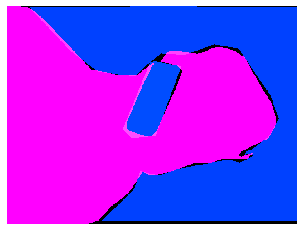

(480, 640, 3)
COCO_val2014_000000283520.jpg
{'person_bbx': [171.4, 130.31, 241.57, 367.86], 'Verbs': 'hold', 'object': {'obj_bbx': [223.88, 197.92, 247.23, 215.42]}}
frisbee
person
hold
hold interaction
{'person_bbx': [171.4, 130.31, 241.57, 367.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [328.36, 126.36, 465.25, 381.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.4, 130.31, 241.57, 367.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


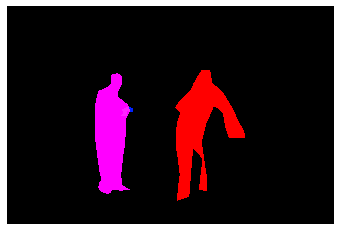

(426, 640, 3)
COCO_val2014_000000448113.jpg
{'person_bbx': [380.69, 37.72, 556.04, 285.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [380.69, 37.72, 556.04, 285.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [380.69, 37.72, 556.04, 285.0], 'Verbs': 'sit', 'object': {'obj_bbx': [546.94, 150.31, 637.6700000000001, 300.4]}}
chair
person
sit
sit interaction


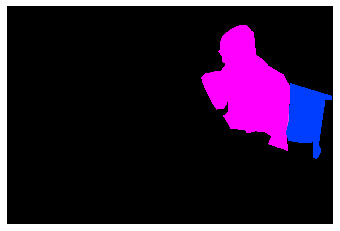

(427, 640, 3)
COCO_val2014_000000408288.jpg
{'person_bbx': [49.05, 313.75, 238.82999999999998, 482.66999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [81.32, 194.09, 331.28999999999996, 451.95000000000005]}}
person
surfboard
surf
surf interaction


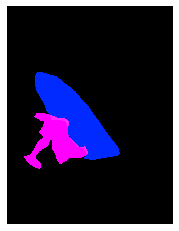

(640, 486, 3)
COCO_val2014_000000106411.jpg
{'person_bbx': [135.61, 156.0, 280.9, 434.74], 'Verbs': 'sit', 'object': {'obj_bbx': [60.54, 222.16, 224.85999999999999, 454.59000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [135.61, 156.0, 280.9, 434.74], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [251.33, 206.02, 323.6, 271.82]}}
person
laptop
work_on_computer
work_on_computer interaction


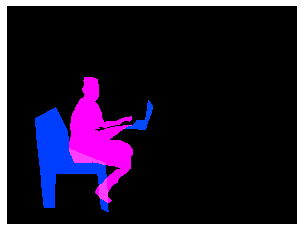

(480, 640, 3)
COCO_val2014_000000328008.jpg
{'person_bbx': [16.45, 40.18, 491.31, 427.68], 'Verbs': 'sit', 'object': {'obj_bbx': [406.44, 305.45, 640.0, 397.71]}}
person
bench
sit
sit interaction
{'person_bbx': [16.45, 40.18, 491.31, 427.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


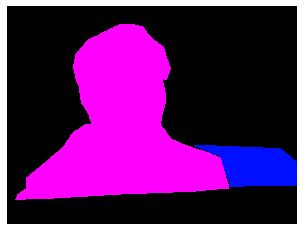

(480, 640, 3)
COCO_val2014_000000542260.jpg
{'person_bbx': [135.37, 85.73, 311.35, 482.82], 'Verbs': 'kick', 'object': {'obj_bbx': [378.33, 179.58, 426.91999999999996, 228.76000000000002]}}
person
sports ball
kick
kick interaction
{'person_bbx': [135.37, 85.73, 311.35, 482.82], 'Verbs': 'look', 'object': {'obj_bbx': [378.33, 179.58, 426.91999999999996, 228.76000000000002]}}
person
sports ball
look
look interaction
{'person_bbx': [135.37, 85.73, 311.35, 482.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


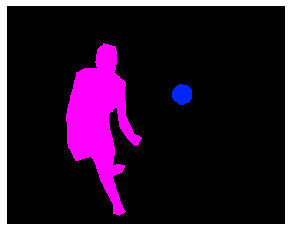

(502, 640, 3)
COCO_val2014_000000533548.jpg
{'person_bbx': [277.21, 65.8, 474.61, 343.01], 'Verbs': 'sit', 'object': {'obj_bbx': [428.88, 285.51, 456.31, 425.14]}}
person
chair
sit
sit interaction
{'person_bbx': [277.21, 65.8, 474.61, 343.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [277.21, 65.8, 474.61, 343.01], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [137.42, 231.19, 351.80999999999995, 365.85]}}
person
laptop
work_on_computer
work_on_computer interaction


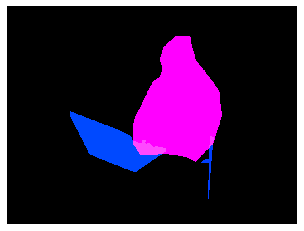

(480, 640, 3)
COCO_val2014_000000398377.jpg
{'person_bbx': [0.0, 77.27, 179.49, 367.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [18.92, 130.81, 31.17, 147.28]}}
cell phone
person
hold
hold interaction
{'person_bbx': [162.28, 73.95, 375.84000000000003, 367.39], 'Verbs': 'hold', 'object': {'obj_bbx': [171.52, 212.39, 344.73, 311.59999999999997]}}
person
handbag
hold
hold interaction
{'person_bbx': [285.14, 34.72, 494.4, 348.63], 'Verbs': 'hold', 'object': {'obj_bbx': [311.8, 144.1, 455.06, 244.38]}}
person
handbag
hold
hold interaction
{'person_bbx': [162.28, 73.95, 375.84000000000003, 367.39], 'Verbs': 'look', 'object': {'obj_bbx': [171.52, 212.39, 344.73, 311.59999999999997]}}
person
handbag
look
look interaction
{'person_bbx': [0.0, 77.27, 179.49, 367.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [132.26, 120.16, 491.13, 353.23]}}
couch
person
sit
sit interaction
{'person_bbx': [162.28, 73.95, 375.84000000000003, 367.39], 'Verbs': 'sit', 'object': {'obj_bbx': [132

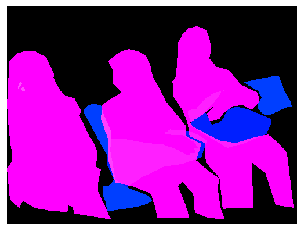

(375, 500, 3)
COCO_val2014_000000028174.jpg
{'person_bbx': [184.09, 46.02, 340.85, 284.76], 'Verbs': 'jump', 'object': {'obj_bbx': [130.62, 104.56, 260.06, 369.98]}}
person
skateboard
jump
jump interaction
{'person_bbx': [184.09, 46.02, 340.85, 284.76], 'Verbs': 'look', 'object': {'obj_bbx': [130.62, 104.56, 260.06, 369.98]}}
person
skateboard
look
look interaction
{'person_bbx': [184.09, 46.02, 340.85, 284.76], 'Verbs': 'skateboard', 'object': {'obj_bbx': [130.62, 104.56, 260.06, 369.98]}}
person
skateboard
skateboard
skateboard interaction


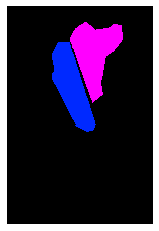

(640, 428, 3)
COCO_val2014_000000432085.jpg
{'person_bbx': [198.88, 4.92, 500.0, 369.8], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [205.29, 178.86, 294.06, 235.71]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [198.88, 4.92, 500.0, 369.8], 'Verbs': 'look', 'object': {'obj_bbx': [205.29, 178.86, 294.06, 235.71]}}
person
sandwich
look
look interaction
{'person_bbx': [198.88, 4.92, 500.0, 369.8], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


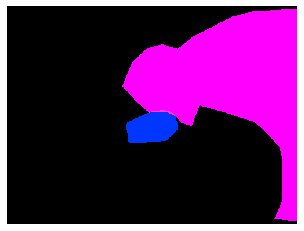

(375, 500, 3)
COCO_val2014_000000509403.jpg
{'person_bbx': [359.98, 59.36, 480.61, 374.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [24.47, 221.33, 49.849999999999994, 247.98000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [359.98, 59.36, 480.61, 374.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


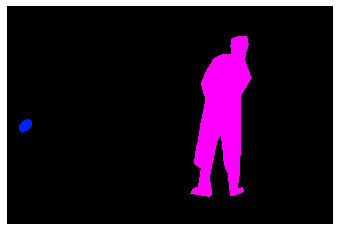

(427, 640, 3)
COCO_val2014_000000014547.jpg
{'person_bbx': [193.43, 42.24, 361.3, 407.99], 'Verbs': 'carry', 'object': {'obj_bbx': [313.16, 78.93, 404.25, 234.25]}}
backpack
person
carry
carry interaction
{'person_bbx': [193.43, 42.24, 361.3, 407.99], 'Verbs': 'hold', 'object': {'obj_bbx': [313.16, 78.93, 404.25, 234.25]}}
backpack
person
hold
hold interaction
{'person_bbx': [193.43, 42.24, 361.3, 407.99], 'Verbs': 'ski', 'object': {'obj_bbx': [188.47, 371.23, 489.99, 427.89]}}
skis
person
ski
ski interaction
{'person_bbx': [193.43, 42.24, 361.3, 407.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


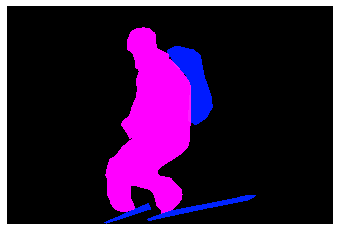

(428, 640, 3)
COCO_val2014_000000454478.jpg
{'person_bbx': [354.04, 34.23, 640.0, 480.0], 'Verbs': 'point', 'object': {'obj_bbx': [0.0, 0.54, 609.73, 475.14000000000004]}}
bed
person
point
point interaction
{'person_bbx': [354.04, 34.23, 640.0, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


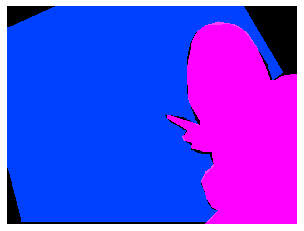

(480, 640, 3)
COCO_val2014_000000107226.jpg
{'person_bbx': [346.09, 76.86, 480.0, 365.19], 'Verbs': 'hold', 'object': {'obj_bbx': [386.55, 253.65, 479.77, 490.53999999999996]}}
person
bicycle
hold
hold interaction
{'person_bbx': [137.28, 131.14, 308.45, 342.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [346.09, 76.86, 480.0, 365.19], 'Verbs': 'look', 'object': {'obj_bbx': [146.56, 290.11, 253.57, 496.48]}}
dog
person
look
look interaction
{'person_bbx': [137.28, 131.14, 308.45, 342.29999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [146.56, 290.11, 253.57, 496.48]}}
dog
person
look
look interaction
{'person_bbx': [346.09, 76.86, 480.0, 365.19], 'Verbs': 'ride', 'object': {'obj_bbx': [386.55, 253.65, 479.77, 490.53999999999996]}}
person
bicycle
ride
ride interaction
{'person_bbx': [137.28, 131.14, 308.45, 342.29999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [346.09, 76.86, 480.0, 365.19], 'Verbs': 'smi

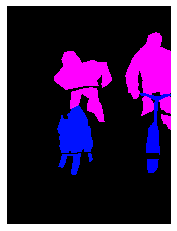

(640, 480, 3)
COCO_val2014_000000540469.jpg
{'person_bbx': [89.09, 76.52, 396.63, 297.19], 'Verbs': 'hold', 'object': {'obj_bbx': [108.07, 277.84, 234.42, 322.75]}}
surfboard
person
hold
hold interaction
{'person_bbx': [89.09, 76.52, 396.63, 297.19], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [89.09, 76.52, 396.63, 297.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


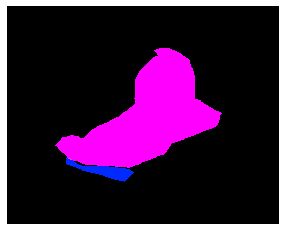

(400, 500, 3)
COCO_val2014_000000247839.jpg
{'person_bbx': [218.97, 289.08, 488.63, 473.53], 'Verbs': 'drink', 'object': {'obj_bbx': [228.17, 343.37, 260.09, 371.83]}}
person
wine glass
drink
drink interaction
{'person_bbx': [0.0, 241.44, 210.04, 479.98], 'Verbs': 'hold', 'object': {'obj_bbx': [175.79, 259.24, 200.48999999999998, 300.59000000000003]}}
person
wine glass
hold
hold interaction
{'person_bbx': [218.97, 289.08, 488.63, 473.53], 'Verbs': 'hold', 'object': {'obj_bbx': [228.17, 343.37, 260.09, 371.83]}}
person
wine glass
hold
hold interaction
{'person_bbx': [218.97, 289.08, 488.63, 473.53], 'Verbs': 'look', 'object': {'obj_bbx': [228.17, 343.37, 260.09, 371.83]}}
person
wine glass
look
look interaction
{'person_bbx': [0.0, 241.44, 210.04, 479.98], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [218.97, 289.08, 488.63, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': [480.29, 403.81, 535.27, 479.49]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 241.

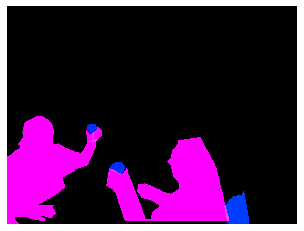

(480, 640, 3)
COCO_val2014_000000503051.jpg
{'person_bbx': [234.69, 46.97, 391.25, 447.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [352.28, 199.12, 428.84999999999997, 287.06]}}
person
backpack
hold
hold interaction
{'person_bbx': [234.69, 46.97, 391.25, 447.45000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [234.69, 46.97, 391.25, 447.45000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


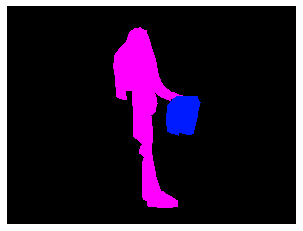

(482, 640, 3)
COCO_val2014_000000456199.jpg
{'person_bbx': [548.58, 0.0, 631.94, 241.4], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [289.43, 61.84, 394.2, 317.23], 'Verbs': 'snowboard', 'object': {'obj_bbx': [319.78, 305.42, 370.84999999999997, 319.17]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [289.43, 61.84, 394.2, 317.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [418.87, 335.56, 628.85, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [548.58, 0.0, 631.94, 241.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.76, 2.12, 448.49, 155.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [482.8, 0.0, 560.5600000000001, 207.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


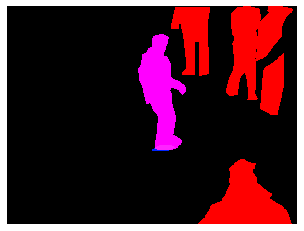

(480, 640, 3)
COCO_val2014_000000565570.jpg
{'person_bbx': [144.91, 34.01, 394.09000000000003, 543.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.91, 34.01, 394.09000000000003, 543.22], 'Verbs': 'throw', 'object': {'obj_bbx': [181.28, 287.12, 200.38, 309.13]}}
sports ball
person
throw
throw interaction


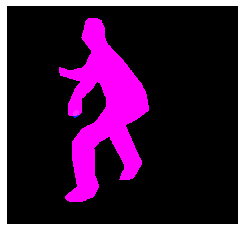

(604, 640, 3)
COCO_val2014_000000465489.jpg
{'person_bbx': [477.04, 110.23, 539.22, 173.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [477.04, 110.23, 539.22, 173.88], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [477.04, 110.23, 539.22, 173.88], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard


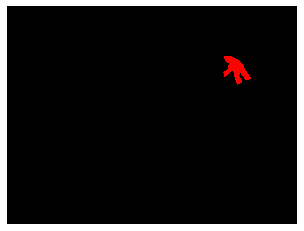

(480, 640, 3)
COCO_val2014_000000559773.jpg
{'person_bbx': [283.62, 88.33, 343.78, 175.23000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [283.62, 88.33, 343.78, 175.23000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [271.77, 142.1, 318.64, 205.64999999999998]}}
person
skis
jump
jump interaction
{'person_bbx': [283.62, 88.33, 343.78, 175.23000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [271.77, 142.1, 318.64, 205.64999999999998]}}
person
skis
ski
ski interaction


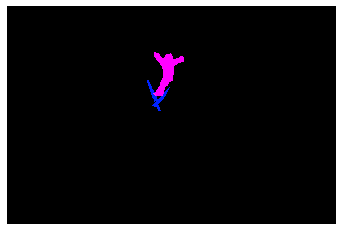

(424, 640, 3)
COCO_val2014_000000476843.jpg
{'person_bbx': [87.78, 192.41, 242.35, 305.36], 'Verbs': 'look', 'object': {'obj_bbx': [135.19, 234.43, 290.52, 348.04]}}
person
person
look
look interaction
{'person_bbx': [135.19, 234.43, 290.52, 348.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [87.78, 192.41, 242.35, 305.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [135.19, 234.43, 290.52, 348.04], 'Verbs': 'surf', 'object': {'obj_bbx': [178.33, 344.52, 252.71, 371.62]}}
person
surfboard
surf
surf interaction


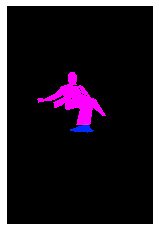

(640, 427, 3)
COCO_val2014_000000528575.jpg
{'person_bbx': [190.63, 109.18, 463.78, 296.02], 'Verbs': 'lay', 'object': {'obj_bbx': [3.8, 52.52, 640.0, 417.53]}}
bed
person
lay
lay interaction


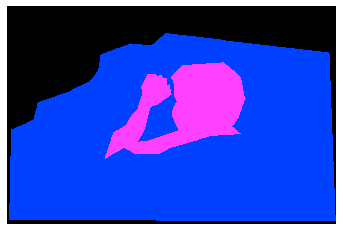

(423, 640, 3)
COCO_val2014_000000402410.jpg
{'person_bbx': [154.16, 144.0, 241.78, 278.2], 'Verbs': 'look', 'object': {'obj_bbx': [135.75, 243.89, 253.69, 280.09]}}
snowboard
person
look
look interaction
{'person_bbx': [154.16, 144.0, 241.78, 278.2], 'Verbs': 'snowboard', 'object': {'obj_bbx': [135.75, 243.89, 253.69, 280.09]}}
snowboard
person
snowboard
snowboard interaction


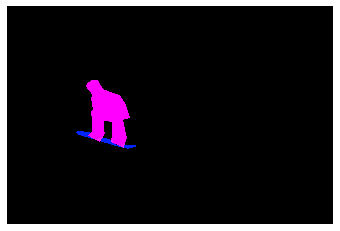

(427, 640, 3)
COCO_val2014_000000461334.jpg
{'person_bbx': [211.13, 136.95, 486.81, 485.92], 'Verbs': 'hold', 'object': {'obj_bbx': [237.95, 385.19, 298.9, 475.78999999999996]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [455.98, 44.4, 606.26, 441.58], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [211.13, 136.95, 486.81, 485.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [455.98, 44.4, 606.26, 441.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [211.13, 136.95, 486.81, 485.92], 'Verbs': 'throw', 'object': {'obj_bbx': [346.88, 322.61, 384.24, 365.20000000000005]}}
person
sports ball
throw
throw interaction


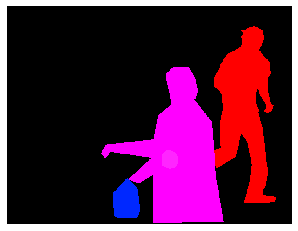

(489, 640, 3)
COCO_val2014_000000065982.jpg
{'person_bbx': [241.16, 27.59, 368.40999999999997, 388.88], 'Verbs': 'hold', 'object': {'obj_bbx': [345.39, 54.68, 360.05, 66.58]}}
cell phone
person
hold
hold interaction
{'person_bbx': [241.16, 27.59, 368.40999999999997, 388.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.16, 27.59, 368.40999999999997, 388.88], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [345.39, 54.68, 360.05, 66.58]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


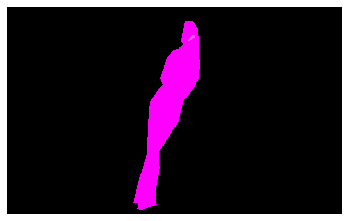

(396, 640, 3)
COCO_val2014_000000133291.jpg
{'person_bbx': [363.51, 99.24, 639.64, 475.69], 'Verbs': 'drink', 'object': {'obj_bbx': [327.64, 207.9, 383.25, 304.85]}}
person
cup
drink
drink interaction
{'person_bbx': [0.0, 66.55, 250.25, 473.2], 'Verbs': 'drink', 'object': {'obj_bbx': [87.83, 208.43, 143.26999999999998, 301.83000000000004]}}
person
cup
drink
drink interaction
{'person_bbx': [363.51, 99.24, 639.64, 475.69], 'Verbs': 'hold', 'object': {'obj_bbx': [327.64, 207.9, 383.25, 304.85]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 66.55, 250.25, 473.2], 'Verbs': 'hold', 'object': {'obj_bbx': [87.83, 208.43, 143.26999999999998, 301.83000000000004]}}
person
cup
hold
hold interaction
{'person_bbx': [363.51, 99.24, 639.64, 475.69], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 66.55, 250.25, 473.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [363.51, 99.24, 639.64, 475.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
p

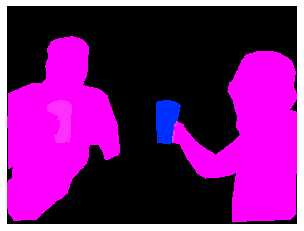

(480, 640, 3)
COCO_val2014_000000210782.jpg
{'person_bbx': [279.68, 140.24, 346.43, 297.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [331.35, 194.82, 413.27000000000004, 352.04999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [279.68, 140.24, 346.43, 297.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [279.68, 140.24, 346.43, 297.08000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


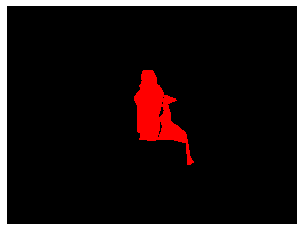

(480, 640, 3)
COCO_val2014_000000108026.jpg
{'person_bbx': [111.32, 0.0, 640.0, 423.2], 'Verbs': 'hold', 'object': {'obj_bbx': [85.91, 123.18, 241.17, 167.49]}}
person
mouse
hold
hold interaction
{'person_bbx': [111.32, 0.0, 640.0, 423.2], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


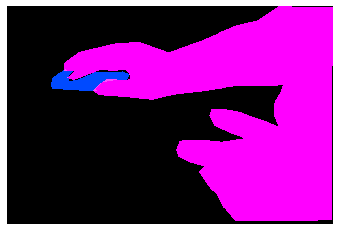

(428, 640, 3)
COCO_val2014_000000122281.jpg
{'person_bbx': [352.16, 45.1, 480.73, 415.49], 'Verbs': 'hold', 'object': {'obj_bbx': [418.97, 126.01, 495.89000000000004, 415.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [244.6, 37.96, 367.96, 397.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [274.43, 114.19, 341.6, 422.2]}}
snowboard
person
hold
hold interaction
{'person_bbx': [147.47, 43.13, 255.43, 411.34], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [352.16, 45.1, 480.73, 415.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [244.6, 37.96, 367.96, 397.47999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [147.47, 43.13, 255.43, 411.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [352.16, 45.1, 480.73, 415.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [244.6, 37.96, 367.96, 397.47999999999996], 'Verbs': 'stand',

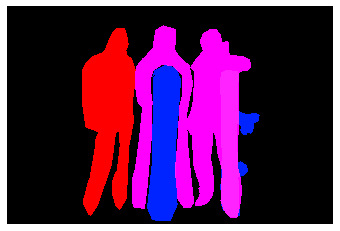

(427, 640, 3)
COCO_val2014_000000063595.jpg
{'person_bbx': [277.31, 82.52, 441.39, 392.46], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [426.27, 80.54, 473.97999999999996, 162.02]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [277.31, 82.52, 441.39, 392.46], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [290.17, 59.94, 304.17, 74.85]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [277.31, 82.52, 441.39, 392.46], 'Verbs': 'hold', 'object': {'obj_bbx': [426.27, 80.54, 473.97999999999996, 162.02]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.02, 46.0, 90.55, 323.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [277.31, 82.52, 441.39, 392.46], 'Verbs': 'look', 'object': {'obj_bbx': [290.17, 59.94, 304.17, 74.85]}}
sports ball
person
look
look interaction
{'person_bbx': [0.02, 46.0, 90.55, 323.05], 'Verbs': 'look', 'object': {'obj_bbx': [290.17, 59.94, 304.17, 74.85]}}
sports ball
person
look
look interaction
{

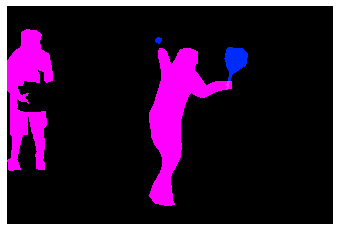

(427, 640, 3)
COCO_val2014_000000528714.jpg
{'person_bbx': [546.28, 79.64, 601.61, 197.87], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [593.4, 62.99, 635.67, 111.37]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [546.28, 79.64, 601.61, 197.87], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [567.35, 43.52, 573.52, 52.63]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [55.78, 114.96, 86.41, 202.01999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [36.31, 150.39, 67.13, 164.19]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [546.28, 79.64, 601.61, 197.87], 'Verbs': 'hold', 'object': {'obj_bbx': [593.4, 62.99, 635.67, 111.37]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [546.28, 79.64, 601.61, 197.87], 'Verbs': 'look', 'object': {'obj_bbx': [567.35, 43.52, 573.52, 52.63]}}
sports ball
person
look
look interaction
{'person_bbx': [55.78, 114.96, 86.41, 202.01999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person

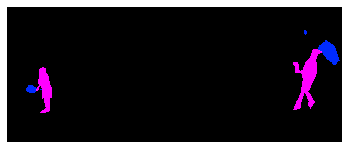

(258, 640, 3)
COCO_val2014_000000492885.jpg
{'person_bbx': [300.7, 97.85, 398.54999999999995, 277.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [219.25, 100.68, 346.39, 287.20000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [112.96, 110.13, 461.62, 317.37]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [300.7, 97.85, 398.54999999999995, 277.63], 'Verbs': 'ride', 'object': {'obj_bbx': [112.96, 110.13, 461.62, 317.37]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [219.25, 100.68, 346.39, 287.20000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [112.96, 110.13, 461.62, 317.37]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [300.7, 97.85, 398.54999999999995, 277.63], 'Verbs': 'sit', 'object': {'obj_bbx': [112.96, 110.13, 461.62, 317.37]}}
motorcycle
person
sit
sit interaction


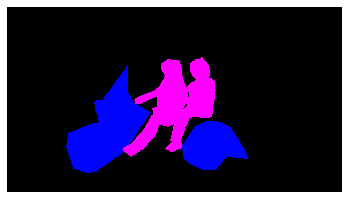

(354, 640, 3)
COCO_val2014_000000423464.jpg
{'person_bbx': [57.53, 60.4, 366.74, 329.34999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [167.15, 271.69, 237.8, 420.36]}}
person
skateboard
jump
jump interaction
{'person_bbx': [57.53, 60.4, 366.74, 329.34999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [167.15, 271.69, 237.8, 420.36]}}
person
skateboard
look
look interaction
{'person_bbx': [57.53, 60.4, 366.74, 329.34999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [167.15, 271.69, 237.8, 420.36]}}
person
skateboard
skateboard
skateboard interaction


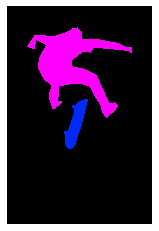

(640, 426, 3)
COCO_val2014_000000415882.jpg
{'person_bbx': [21.43, 211.17, 331.43, 536.88], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 327.58, 343.84, 630.97]}}
bed
person
lay
lay interaction


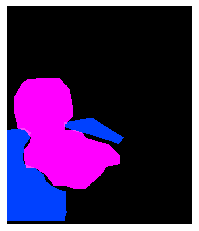

(640, 544, 3)
COCO_val2014_000000428218.jpg
{'person_bbx': [67.96, 190.92, 115.41999999999999, 309.57], 'Verbs': 'look', 'object': {'obj_bbx': [288.57, 207.53, 311.96, 222.83]}}
person
frisbee
look
look interaction
{'person_bbx': [565.91, 206.28, 640.0, 357.69], 'Verbs': 'look', 'object': {'obj_bbx': [67.96, 190.92, 115.41999999999999, 309.57]}}
person
person
look
look interaction
{'person_bbx': [67.96, 190.92, 115.41999999999999, 309.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [565.91, 206.28, 640.0, 357.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [565.91, 206.28, 640.0, 357.69], 'Verbs': 'throw', 'object': {'obj_bbx': [288.57, 207.53, 311.96, 222.83]}}
frisbee
person
throw
throw interaction


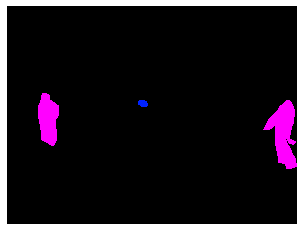

(480, 640, 3)
COCO_val2014_000000315037.jpg
{'person_bbx': [204.67, 136.82, 350.39, 437.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [227.43, 230.9, 294.19, 284.56]}}
person
laptop
look
look interaction
{'person_bbx': [204.67, 136.82, 350.39, 437.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [2.22, 233.2, 508.32000000000005, 435.2]}}
person
bench
sit
sit interaction
{'person_bbx': [204.67, 136.82, 350.39, 437.15999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [227.43, 230.9, 294.19, 284.56]}}
person
laptop
work_on_computer
work_on_computer interaction


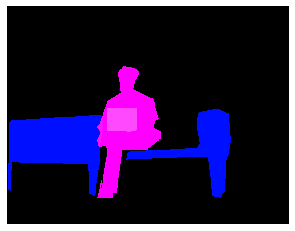

(495, 640, 3)
COCO_val2014_000000005652.jpg
{'person_bbx': [11.51, 9.94, 633.3, 422.55], 'Verbs': 'hold', 'object': {'obj_bbx': [209.56, 145.81, 268.23, 342.59000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [11.51, 9.94, 633.3, 422.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [11.51, 9.94, 633.3, 422.55], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [209.56, 145.81, 268.23, 342.59000000000003]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


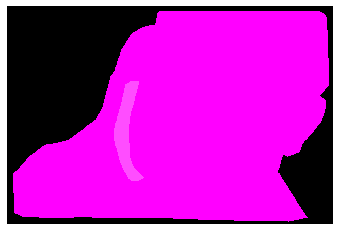

(427, 640, 3)
COCO_val2014_000000528821.jpg
{'person_bbx': [0.96, 0.96, 405.88, 144.27], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [190.33, 115.35, 295.04, 196.63]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [481.02, 0.48, 640.0, 189.42], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [603.42, 92.06, 640.0, 158.7]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [481.02, 0.48, 640.0, 189.42], 'Verbs': 'hold', 'object': {'obj_bbx': [603.42, 92.06, 640.0, 158.7]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.96, 0.96, 405.88, 144.27], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [481.02, 0.48, 640.0, 189.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


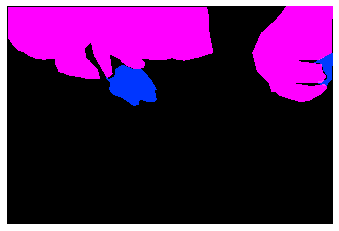

(428, 640, 3)
COCO_val2014_000000146871.jpg
{'person_bbx': [220.52, 178.52, 423.38, 283.55], 'Verbs': 'lay', 'object': {'obj_bbx': [177.65, 200.05, 638.96, 431.81]}}
bed
person
lay
lay interaction
{'person_bbx': [220.52, 178.52, 423.38, 283.55], 'Verbs': 'look', 'object': {'obj_bbx': [261.78, 203.65, 346.39, 255.02]}}
person
laptop
look
look interaction
{'person_bbx': [220.52, 178.52, 423.38, 283.55], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [261.78, 203.65, 346.39, 255.02]}}
person
laptop
work_on_computer
work_on_computer interaction


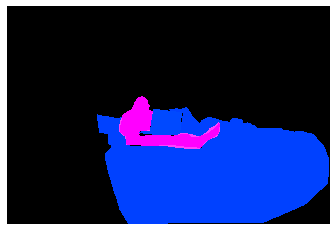

(432, 640, 3)
COCO_val2014_000000368949.jpg
{'person_bbx': [155.53, 111.48, 316.56, 529.89], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 316.4, 353.8, 500.49]}}
person
bench
sit
sit interaction
{'person_bbx': [155.53, 111.48, 316.56, 529.89], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [233.76, 191.25, 267.11, 215.32]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


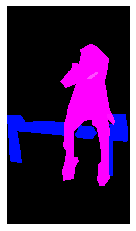

(640, 360, 3)
COCO_val2014_000000487698.jpg
{'person_bbx': [160.5, 46.11, 335.85, 365.69], 'Verbs': 'carry', 'object': {'obj_bbx': [207.42, 141.31, 282.77, 219.89]}}
person
handbag
carry
carry interaction
{'person_bbx': [160.5, 46.11, 335.85, 365.69], 'Verbs': 'hold', 'object': {'obj_bbx': [221.48, 68.25, 231.95, 82.01]}}
person
cell phone
hold
hold interaction
{'person_bbx': [160.5, 46.11, 335.85, 365.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [160.5, 46.11, 335.85, 365.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [221.48, 68.25, 231.95, 82.01]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [160.5, 46.11, 335.85, 365.69], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


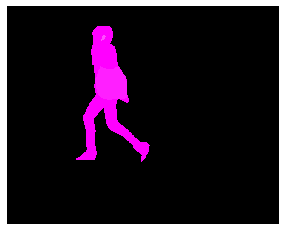

(512, 640, 3)
COCO_val2014_000000184919.jpg
{'person_bbx': [93.86, 148.0, 475.88, 327.61], 'Verbs': 'hold', 'object': {'obj_bbx': [97.64, 290.06, 278.58, 351.33]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [93.86, 148.0, 475.88, 327.61], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


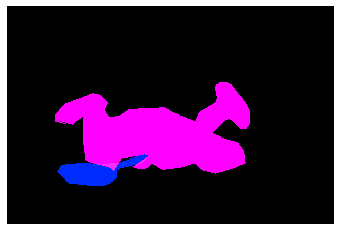

(426, 640, 3)
COCO_val2014_000000408746.jpg
{'person_bbx': [286.26, 230.6, 333.39, 320.82], 'Verbs': 'look', 'object': {'obj_bbx': [304.63, 315.69, 378.64, 327.79]}}
person
surfboard
look
look interaction
{'person_bbx': [286.26, 230.6, 333.39, 320.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.26, 230.6, 333.39, 320.82], 'Verbs': 'surf', 'object': {'obj_bbx': [304.63, 315.69, 378.64, 327.79]}}
person
surfboard
surf
surf interaction


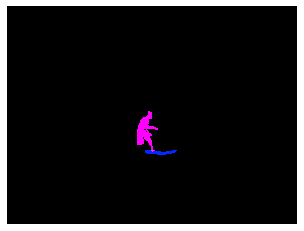

(480, 640, 3)
COCO_val2014_000000234031.jpg
{'person_bbx': [0.0, 5.91, 450.58, 617.2099999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [313.96, 199.13, 334.01, 241.42]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 5.91, 450.58, 617.2099999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 5.91, 450.58, 617.2099999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [313.96, 199.13, 334.01, 241.42]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


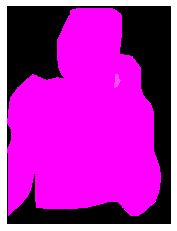

(640, 480, 3)
COCO_val2014_000000540828.jpg
{'person_bbx': [67.96, 180.44, 249.17000000000002, 473.2], 'Verbs': 'hold', 'object': {'obj_bbx': [122.69, 187.59, 298.66999999999996, 326.11]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [332.97, 196.76, 587.03, 473.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [67.96, 180.44, 249.17000000000002, 473.2], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [332.97, 196.76, 587.03, 473.51], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [67.96, 180.44, 249.17000000000002, 473.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [332.97, 196.76, 587.03, 473.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [332.97, 196.76, 587.03, 473.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


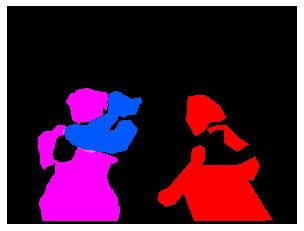

(480, 640, 3)
COCO_val2014_000000222512.jpg
{'person_bbx': [59.33, 1.83, 332.21999999999997, 370.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [44.32, 120.66, 246.48999999999998, 305.95]}}
person
person
hold
hold interaction
{'person_bbx': [59.33, 1.83, 332.21999999999997, 370.72999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [105.59, 328.75, 167.33, 392.4]}}
person
mouse
look
look interaction
{'person_bbx': [59.33, 1.83, 332.21999999999997, 370.72999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [303.31, 207.72, 328.58, 272.28999999999996]}}
person
chair
sit
sit interaction
{'person_bbx': [59.33, 1.83, 332.21999999999997, 370.72999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [59.33, 1.83, 332.21999999999997, 370.72999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [184.45, 197.39, 627.78, 472.45]}}
person
laptop
work_on_computer
work_on_computer interaction


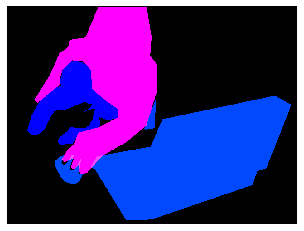

(480, 640, 3)
COCO_val2014_000000015778.jpg
{'person_bbx': [171.02, 44.13, 290.19, 419.28], 'Verbs': 'carry', 'object': {'obj_bbx': [134.92, 261.68, 215.35999999999999, 305.31]}}
person
handbag
carry
carry interaction
{'person_bbx': [310.34, 39.07, 451.09999999999997, 439.18], 'Verbs': 'skateboard', 'object': {'obj_bbx': [325.85, 424.46, 432.57000000000005, 466.65999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [310.34, 39.07, 451.09999999999997, 439.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [533.93, 77.06, 620.91, 372.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.02, 44.13, 290.19, 419.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [533.93, 77.06, 620.91, 372.1], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [171.02, 44.13, 290.19, 419.28], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


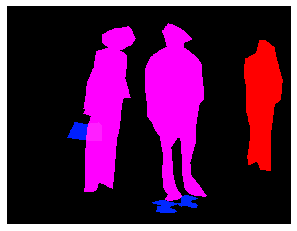

(491, 640, 3)
COCO_val2014_000000116361.jpg
{'person_bbx': [262.69, 150.15, 479.6, 483.76], 'Verbs': 'look', 'object': {'obj_bbx': [164.0, 370.13, 380.83000000000004, 506.5]}}
laptop
person
look
look interaction
{'person_bbx': [126.0, 179.93, 372.26, 589.4100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [262.69, 150.15, 479.6, 483.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [262.69, 150.15, 479.6, 483.76], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [164.0, 370.13, 380.83000000000004, 506.5]}}
laptop
person
work_on_computer
work_on_computer interaction


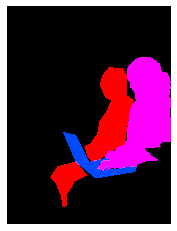

(640, 480, 3)
COCO_val2014_000000398438.jpg
{'person_bbx': [213.0, 0.75, 500.0, 223.5], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [160.89, 187.08, 227.48999999999998, 225.99]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [213.0, 0.75, 500.0, 223.5], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [0.0, 1.5, 180.34, 312.8]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [213.0, 0.75, 500.0, 223.5], 'Verbs': 'hold', 'object': {'obj_bbx': [160.89, 187.08, 227.48999999999998, 225.99]}}
person
knife
hold
hold interaction
{'person_bbx': [213.0, 0.75, 500.0, 223.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


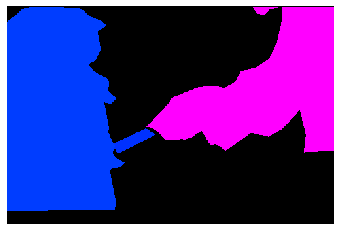

(333, 500, 3)
COCO_val2014_000000297972.jpg
{'person_bbx': [229.37, 180.86, 532.94, 362.04], 'Verbs': 'catch', 'object': {'obj_bbx': [197.17, 117.0, 236.37, 145.27]}}
person
frisbee
catch
catch interaction
{'person_bbx': [229.37, 180.86, 532.94, 362.04], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [368.65, 149.94, 457.46999999999997, 327.58], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [487.13, 141.43, 591.72, 326.68], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [229.37, 180.86, 532.94, 362.04], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [487.13, 141.43, 591.72, 326.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [368.65, 149.94, 457.46999999999997, 327.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [487.13, 141.43, 591.72, 326.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


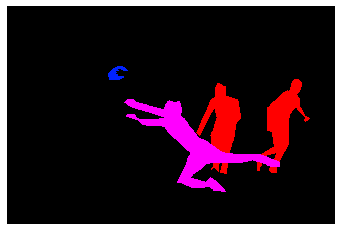

(425, 640, 3)
COCO_val2014_000000279030.jpg
{'person_bbx': [99.23, 28.42, 310.88, 555.3299999999999], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [223.06, 127.35, 345.2, 251.69]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [99.23, 28.42, 310.88, 555.3299999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [223.06, 127.35, 345.2, 251.69]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [99.23, 28.42, 310.88, 555.3299999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


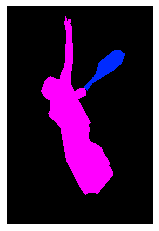

(640, 427, 3)
COCO_val2014_000000001180.jpg
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [176.14, 415.23, 187.58999999999997, 425.33000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [162.09, 401.41, 414.67, 499.24]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'hold', 'object': {'obj_bbx': [176.14, 415.23, 187.58999999999997, 425.33000000000004]}}
person
knife
hold
hold interaction
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'look', 'object': {'obj_bbx': [162.09, 401.41, 414.67, 499.24]}}
person
cake
look
look interaction
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [134.05, 118.2, 304.14, 420.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


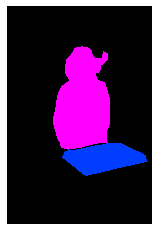

(640, 426, 3)
COCO_val2014_000000056739.jpg
{'person_bbx': [260.9, 316.4, 345.95, 611.89], 'Verbs': 'hold', 'object': {'obj_bbx': [297.12, 347.04, 305.18, 357.83000000000004]}}
cell phone
person
hold
hold interaction
{'person_bbx': [135.62, 310.43, 220.86, 565.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [260.9, 316.4, 345.95, 611.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [135.62, 310.43, 220.86, 565.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [260.9, 316.4, 345.95, 611.89], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [297.12, 347.04, 305.18, 357.83000000000004]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [260.9, 316.4, 345.95, 611.89], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [135.62, 310.43, 220.86, 565.86], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


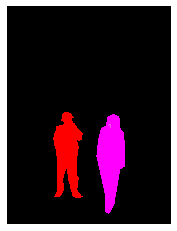

(640, 480, 3)
COCO_val2014_000000022850.jpg
{'person_bbx': [289.88, 12.64, 445.65, 345.84], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [296.71, 288.03, 374.76, 375.16999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [289.88, 12.64, 445.65, 345.84], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [121.24, 322.28, 470.47, 451.81999999999994]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [401.84, 11.26, 607.8299999999999, 410.84999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [296.71, 288.03, 374.76, 375.16999999999996]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [401.84, 11.26, 607.8299999999999, 410.84999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [121.24, 322.28, 470.47, 451.81999999999994]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [289.88, 12.64, 445.65, 345.84], 'Verbs': 'hold', 'object': {'obj_bbx': [296.71, 288.03, 374.76, 375.16999999999996]}}
person
knife
hold
hold interaction
{'person_bbx': [401

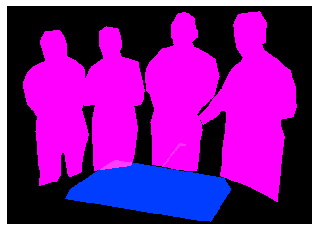

(457, 640, 3)
COCO_val2014_000000247625.jpg
{'person_bbx': [116.49, 41.47, 319.28, 562.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [116.49, 41.47, 319.28, 562.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


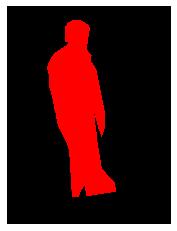

(640, 480, 3)
COCO_val2014_000000420525.jpg
{'person_bbx': [410.36, 74.11, 637.9300000000001, 470.8], 'Verbs': 'drink', 'object': {'obj_bbx': [417.67, 204.16, 459.08000000000004, 304.28]}}
wine glass
person
drink
drink interaction
{'person_bbx': [0.0, 29.12, 317.12, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [287.75, 213.06, 324.83, 271.28]}}
person
wine glass
hold
hold interaction
{'person_bbx': [410.36, 74.11, 637.9300000000001, 470.8], 'Verbs': 'hold', 'object': {'obj_bbx': [417.67, 204.16, 459.08000000000004, 304.28]}}
wine glass
person
hold
hold interaction
{'person_bbx': [0.0, 29.12, 317.12, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [327.91, 32.74, 529.01, 473.53000000000003]}}
person
person
look
look interaction
{'person_bbx': [410.36, 74.11, 637.9300000000001, 470.8], 'Verbs': 'look', 'object': {'obj_bbx': [417.67, 204.16, 459.08000000000004, 304.28]}}
wine glass
person
look
look interaction
{'person_bbx': [0.0, 29.12, 317.12, 474.61], 'Verbs': 'smile', 'object': {'o

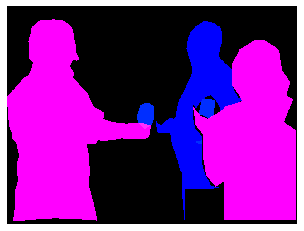

(480, 640, 3)
COCO_val2014_000000187244.jpg
{'person_bbx': [342.16, 184.49, 440.36, 333.34000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [349.99, 298.45, 477.38, 344.26]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [342.16, 184.49, 440.36, 333.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


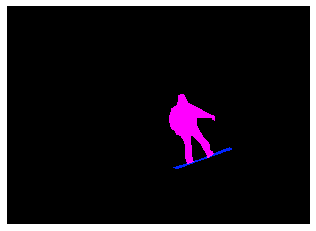

(460, 640, 3)
COCO_val2014_000000147128.jpg
{'person_bbx': [30.25, 30.63, 611.86, 612.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [30.25, 30.63, 611.86, 612.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


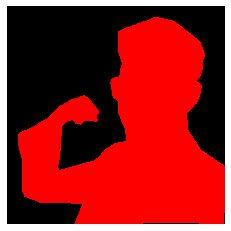

(612, 612, 3)
COCO_val2014_000000184227.jpg
{'person_bbx': [124.06, 42.8, 591.45, 420.75], 'Verbs': 'hold', 'object': {'obj_bbx': [336.35, 15.42, 354.02000000000004, 72.44]}}
person
remote
hold
hold interaction
{'person_bbx': [124.06, 42.8, 591.45, 420.75], 'Verbs': 'lay', 'object': {'obj_bbx': [0.92, 78.97, 505.97, 420.57000000000005]}}
couch
person
lay
lay interaction
{'person_bbx': [124.06, 42.8, 591.45, 420.75], 'Verbs': 'sit', 'object': {'obj_bbx': [0.92, 78.97, 505.97, 420.57000000000005]}}
couch
person
sit
sit interaction
{'person_bbx': [124.06, 42.8, 591.45, 420.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


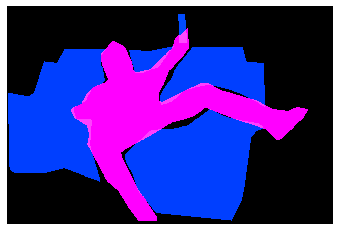

(427, 640, 3)
COCO_val2014_000000383419.jpg
{'person_bbx': [37.34, 35.54, 607.95, 418.5], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [192.66, 192.66, 330.66999999999996, 303.81]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [37.34, 35.54, 607.95, 418.5], 'Verbs': 'hold', 'object': {'obj_bbx': [192.66, 192.66, 330.66999999999996, 303.81]}}
hot dog
person
hold
hold interaction
{'person_bbx': [37.34, 35.54, 607.95, 418.5], 'Verbs': 'sit', 'object': {'obj_bbx': [419.69, 217.51, 505.81, 296.19]}}
person
chair
sit
sit interaction


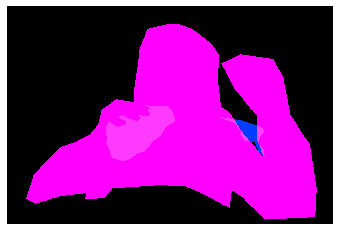

(427, 640, 3)
COCO_val2014_000000139294.jpg
{'person_bbx': [78.92, 293.69, 281.26, 602.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


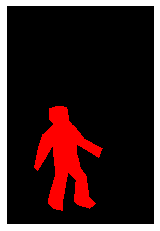

(640, 431, 3)
COCO_val2014_000000321886.jpg
{'person_bbx': [43.57, 237.78, 110.28999999999999, 338.12], 'Verbs': 'hold', 'object': {'obj_bbx': [6.68, 273.72, 122.25999999999999, 360.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [278.24, 227.28, 325.32, 313.3], 'Verbs': 'hold', 'object': {'obj_bbx': [276.39, 280.26, 334.45, 319.74]}}
bicycle
person
hold
hold interaction
{'person_bbx': [202.98, 229.87, 245.58999999999997, 314.39], 'Verbs': 'hold', 'object': {'obj_bbx': [181.82, 268.78, 257.9, 331.98999999999995]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [202.98, 229.87, 245.58999999999997, 314.39], 'Verbs': 'look', 'object': {'obj_bbx': [247.17, 233.14, 281.94, 297.81]}}
person
person
look
look interaction
{'person_bbx': [43.57, 237.78, 110.28999999999999, 338.12], 'Verbs': 'ride', 'object': {'obj_bbx': [6.68, 273.72, 122.25999999999999, 360.0]}}
bicycle
person
ride
ride interaction
{'person_bbx': [278.24, 227.28, 325.32, 313.3], 'Verbs': 'ride', 'object': {'obj

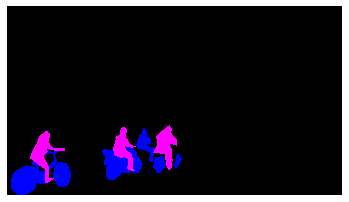

(360, 640, 3)
COCO_val2014_000000524173.jpg
{'person_bbx': [25.17, 216.52, 270.97, 359.14], 'Verbs': 'hold', 'object': {'obj_bbx': [23.65, 239.44, 337.84, 366.13]}}
person
surfboard
hold
hold interaction
{'person_bbx': [25.17, 216.52, 270.97, 359.14], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [311.79, 50.3, 387.0, 326.36], 'Verbs': 'look', 'object': {'obj_bbx': [25.17, 216.52, 270.97, 359.14]}}
person
person
look
look interaction
{'person_bbx': [327.81, 51.4, 462.64, 349.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [23.65, 239.44, 337.84, 366.13]}}
person
surfboard
look
look interaction
{'person_bbx': [25.17, 216.52, 270.97, 359.14], 'Verbs': 'look', 'object': {'obj_bbx': [23.65, 239.44, 337.84, 366.13]}}
person
surfboard
look
look interaction
{'person_bbx': [114.8, 46.05, 195.13, 274.55], 'Verbs': 'look', 'object': {'obj_bbx': [23.65, 239.44, 337.84, 366.13]}}
surfboard
person
look
look interaction
{'person_bbx': [114.8, 46.05, 195.13, 274.55], 'V

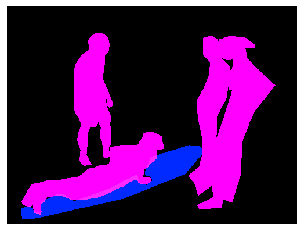

(375, 500, 3)
COCO_val2014_000000262101.jpg
{'person_bbx': [0.0, 73.71, 298.68, 420.26], 'Verbs': 'drink', 'object': {'obj_bbx': []}}
person
drink
{'person_bbx': [0.0, 73.71, 298.68, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [282.72, 0.72, 624.09, 418.07000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 73.71, 298.68, 420.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [282.72, 0.72, 624.09, 418.07000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 73.71, 298.68, 420.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


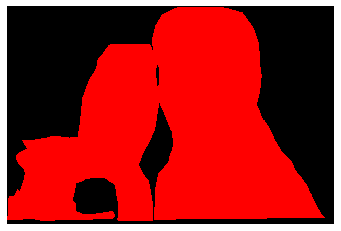

(426, 640, 3)
COCO_val2014_000000305962.jpg
{'person_bbx': [237.42, 171.66, 285.23, 226.05], 'Verbs': 'surf', 'object': {'obj_bbx': [211.3, 199.75, 313.52, 261.31]}}
person
surfboard
surf
surf interaction


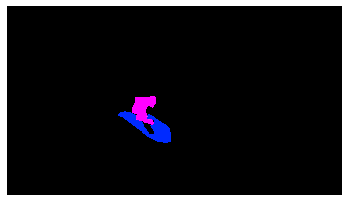

(360, 640, 3)
COCO_val2014_000000037456.jpg
{'person_bbx': [120.68, 9.01, 224.23000000000002, 329.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [117.69, 137.47, 144.44, 148.02]}}
person
remote
hold
hold interaction
{'person_bbx': [214.77, 70.86, 365.18, 329.76], 'Verbs': 'hold', 'object': {'obj_bbx': [218.99, 196.69, 265.09000000000003, 219.06]}}
person
remote
hold
hold interaction
{'person_bbx': [120.68, 9.01, 224.23000000000002, 329.34999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [214.77, 70.86, 365.18, 329.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [120.68, 9.01, 224.23000000000002, 329.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [214.77, 70.86, 365.18, 329.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


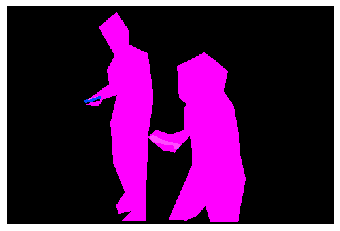

(333, 500, 3)
COCO_val2014_000000365557.jpg
{'person_bbx': [131.54, 113.08, 307.63, 242.61], 'Verbs': 'snowboard', 'object': {'obj_bbx': [97.03, 197.78, 298.96000000000004, 277.33]}}
person
snowboard
snowboard
snowboard interaction


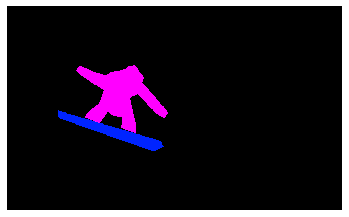

(389, 640, 3)
COCO_val2014_000000064974.jpg
{'person_bbx': [100.38, 212.85, 327.64, 363.59000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [248.11, 328.23, 345.52, 401.45000000000005]}}
person
skateboard
jump
jump interaction
{'person_bbx': [100.38, 212.85, 327.64, 363.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [248.11, 328.23, 345.52, 401.45000000000005]}}
person
skateboard
look
look interaction
{'person_bbx': [100.38, 212.85, 327.64, 363.59000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [248.11, 328.23, 345.52, 401.45000000000005]}}
person
skateboard
skateboard
skateboard interaction


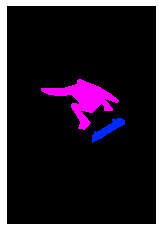

(640, 436, 3)
COCO_val2014_000000080651.jpg
{'person_bbx': [22.62, 24.03, 335.0, 619.11], 'Verbs': 'hold', 'object': {'obj_bbx': [72.59, 318.04, 140.38, 390.12]}}
bottle
person
hold
hold interaction
{'person_bbx': [22.62, 24.03, 335.0, 619.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [22.62, 24.03, 335.0, 619.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [22.62, 24.03, 335.0, 619.11], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [112.14, 145.82, 139.02, 198.0]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


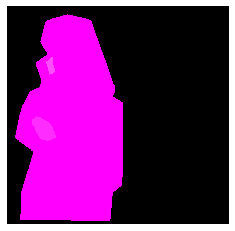

(629, 640, 3)
COCO_val2014_000000434787.jpg
{'person_bbx': [0.0, 76.5, 299.11, 536.88], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [193.82, 317.06, 483.59, 484.26]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 76.5, 299.11, 536.88], 'Verbs': 'look', 'object': {'obj_bbx': [193.82, 317.06, 483.59, 484.26]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 76.5, 299.11, 536.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


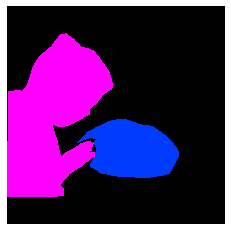

(612, 612, 3)
COCO_val2014_000000256504.jpg
{'person_bbx': [323.16, 119.26, 473.20000000000005, 271.23], 'Verbs': 'lay', 'object': {'obj_bbx': [3.34, 245.5, 640.0, 418.91999999999996]}}
person
bed
lay
lay interaction
{'person_bbx': [323.16, 119.26, 473.20000000000005, 271.23], 'Verbs': 'look', 'object': {'obj_bbx': [348.17, 162.38, 494.36, 264.33]}}
person
laptop
look
look interaction
{'person_bbx': [323.16, 119.26, 473.20000000000005, 271.23], 'Verbs': 'sit', 'object': {'obj_bbx': [3.34, 245.5, 640.0, 418.91999999999996]}}
person
bed
sit
sit interaction
{'person_bbx': [323.16, 119.26, 473.20000000000005, 271.23], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [348.17, 162.38, 494.36, 264.33]}}
person
laptop
work_on_computer
work_on_computer interaction


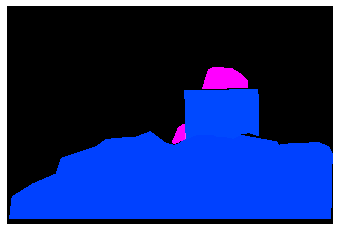

(428, 640, 3)
COCO_val2014_000000010785.jpg
{'person_bbx': [44.03, 3.98, 471.88, 422.65000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [325.65, 225.03, 410.16999999999996, 313.37]}}
person
broccoli
eat_obj
eat_obj interaction
{'person_bbx': [44.03, 3.98, 471.88, 422.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [325.65, 225.03, 410.16999999999996, 313.37]}}
person
broccoli
hold
hold interaction


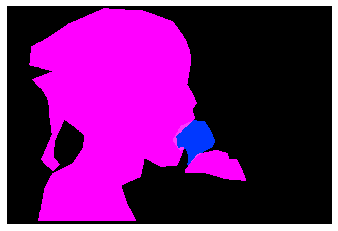

(429, 640, 3)
COCO_val2014_000000192932.jpg
{'person_bbx': [360.62, 4.48, 624.25, 387.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [360.62, 4.48, 624.25, 387.48], 'Verbs': 'ski', 'object': {'obj_bbx': [207.25, 333.32, 463.7, 458.52]}}
skis
person
ski
ski interaction
{'person_bbx': [360.62, 4.48, 624.25, 387.48], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [360.62, 4.48, 624.25, 387.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


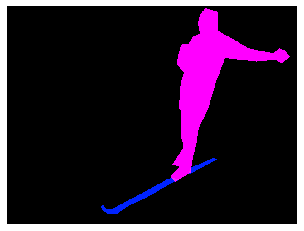

(480, 640, 3)
COCO_val2014_000000299001.jpg
{'person_bbx': [240.58, 2.26, 379.81, 179.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


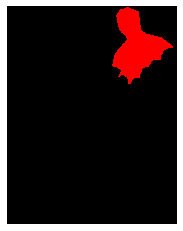

(500, 389, 3)
COCO_val2014_000000100010.jpg
{'person_bbx': [247.47, 172.3, 353.89, 375.0], 'Verbs': 'snowboard', 'object': {'obj_bbx': [241.13, 352.44, 330.4, 375.0]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [247.47, 172.3, 353.89, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


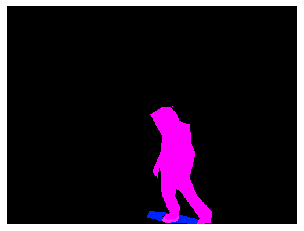

(375, 500, 3)
COCO_val2014_000000474854.jpg
{'person_bbx': [15.86, 124.68, 367.57, 568.6500000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [193.9, 280.5, 277.41, 439.85]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [15.86, 124.68, 367.57, 568.6500000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [193.9, 280.5, 277.41, 439.85]}}
person
banana
hold
hold interaction
{'person_bbx': [15.86, 124.68, 367.57, 568.6500000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [38.37, 338.7, 79.49, 482.59]}}
chair
person
sit
sit interaction
{'person_bbx': [15.86, 124.68, 367.57, 568.6500000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


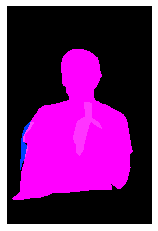

(640, 424, 3)
COCO_val2014_000000569452.jpg
{'person_bbx': [14.38, 146.7, 312.09, 490.43], 'Verbs': 'jump', 'object': {'obj_bbx': [115.06, 352.36, 320.72, 542.2]}}
person
skateboard
jump
jump interaction
{'person_bbx': [14.38, 146.7, 312.09, 490.43], 'Verbs': 'look', 'object': {'obj_bbx': [115.06, 352.36, 320.72, 542.2]}}
person
skateboard
look
look interaction
{'person_bbx': [14.38, 146.7, 312.09, 490.43], 'Verbs': 'skateboard', 'object': {'obj_bbx': [115.06, 352.36, 320.72, 542.2]}}
person
skateboard
skateboard
skateboard interaction


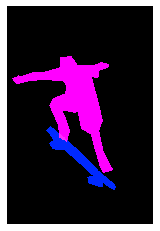

(640, 429, 3)
COCO_val2014_000000310227.jpg
{'person_bbx': [278.4, 115.49, 531.27, 342.84], 'Verbs': 'lay', 'object': {'obj_bbx': [3.63, 322.05, 631.77, 478.18]}}
bed
person
lay
lay interaction


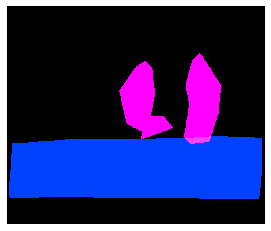

(541, 640, 3)
COCO_val2014_000000538230.jpg
{'person_bbx': [279.37, 156.4, 333.3, 236.22], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [540.0, 219.64, 595.51, 324.96], 'Verbs': 'hold', 'object': {'obj_bbx': [538.67, 255.33, 594.39, 345.21000000000004]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [302.88, 208.72, 361.56, 301.98], 'Verbs': 'hold', 'object': {'obj_bbx': [313.13, 245.04, 349.09, 322.59]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [492.92, 192.23, 548.6800000000001, 278.96], 'Verbs': 'hold', 'object': {'obj_bbx': [499.16, 227.26, 545.5, 298.65]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [193.98, 192.66, 251.66, 290.08], 'Verbs': 'hold', 'object': {'obj_bbx': [196.94, 223.45, 242.01999999999998, 297.31]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [279.37, 156.4, 333.3, 236.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [122.84, 169.8, 153.52, 259.8], 'Verbs': 'look', '

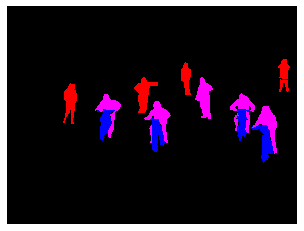

(480, 640, 3)
COCO_val2014_000000477172.jpg
{'person_bbx': [282.49, 61.11, 421.92, 216.83999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [282.49, 61.11, 421.92, 216.83999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [278.34, 177.49, 433.99, 223.59]}}
skis
person
ski
ski interaction
{'person_bbx': [282.49, 61.11, 421.92, 216.83999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


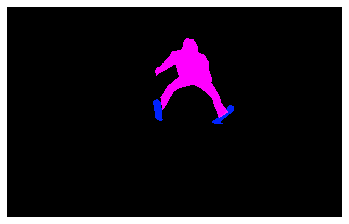

(402, 640, 3)
COCO_val2014_000000451155.jpg
{'person_bbx': [237.2, 167.31, 378.61, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [245.93, 213.57, 376.45000000000005, 310.65]}}
person
laptop
look
look interaction
{'person_bbx': [237.2, 167.31, 378.61, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [5.38, 300.22, 478.92, 411.07000000000005]}}
bed
person
sit
sit interaction
{'person_bbx': [237.2, 167.31, 378.61, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [245.93, 213.57, 376.45000000000005, 310.65]}}
person
laptop
work_on_computer
work_on_computer interaction


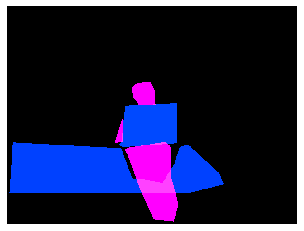

(480, 640, 3)
COCO_val2014_000000290689.jpg
{'person_bbx': [10.07, 424.27, 263.19, 622.74], 'Verbs': 'sit', 'object': {'obj_bbx': [13.3, 156.26, 615.06, 625.04]}}
person
bed
sit
sit interaction
{'person_bbx': [10.07, 424.27, 263.19, 622.74], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [185.53, 148.13, 563.78, 450.15999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


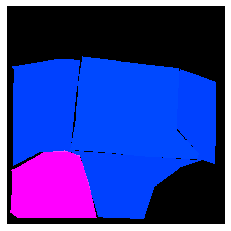

(640, 640, 3)
COCO_val2014_000000032549.jpg
{'person_bbx': [334.41, 204.52, 379.94000000000005, 367.32000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [287.49, 297.11, 344.42, 372.44]}}
person
suitcase
carry
carry interaction
{'person_bbx': [334.41, 204.52, 379.94000000000005, 367.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [287.49, 297.11, 344.42, 372.44]}}
person
suitcase
hold
hold interaction
{'person_bbx': [334.41, 204.52, 379.94000000000005, 367.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [108.57, 171.41, 220.44, 291.65]}}
bus
person
look
look interaction
{'person_bbx': [334.41, 204.52, 379.94000000000005, 367.32000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [334.41, 204.52, 379.94000000000005, 367.32000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


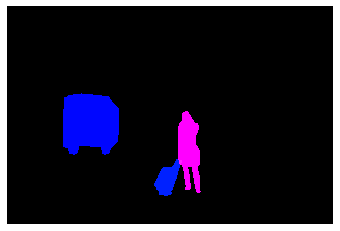

(427, 640, 3)
COCO_val2014_000000097865.jpg
{'person_bbx': [81.32, 154.51, 163.22, 306.95], 'Verbs': 'look', 'object': {'obj_bbx': [119.42, 366.89, 184.14, 428.06]}}
person
frisbee
look
look interaction
{'person_bbx': [81.32, 154.51, 163.22, 306.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [81.32, 154.51, 163.22, 306.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.32, 154.51, 163.22, 306.95], 'Verbs': 'throw', 'object': {'obj_bbx': [119.42, 366.89, 184.14, 428.06]}}
person
frisbee
throw
throw interaction


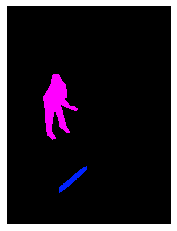

(500, 375, 3)
COCO_val2014_000000240655.jpg
{'person_bbx': [160.31, 31.17, 325.6, 242.62], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [160.31, 31.17, 325.6, 242.62], 'Verbs': 'snowboard', 'object': {'obj_bbx': [150.39, 212.81, 215.79999999999998, 251.28]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [160.31, 31.17, 325.6, 242.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


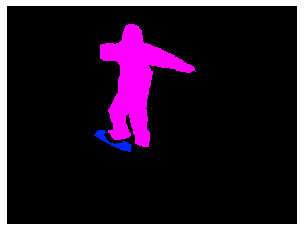

(375, 500, 3)
COCO_val2014_000000569841.jpg
{'person_bbx': [283.62, 84.77, 395.7, 260.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [283.62, 84.77, 395.7, 260.21], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [323.83, 107.08, 437.51, 279.03], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [434.68, 88.34, 522.0, 215.0], 'Verbs': 'ride', 'object': {'obj_bbx': [9.18, 252.53, 318.64, 422.40999999999997]}}
horse
person
ride
ride interaction
{'person_bbx': [470.41, 121.14, 555.45, 255.12], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [283.62, 84.77, 395.7, 260.21], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [323.83, 107.08, 437.51, 279.03], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [434.68, 88.34, 522.0, 215.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [470.41, 121.14, 555.45, 255.12], 'Verbs': 'sit', 'objec

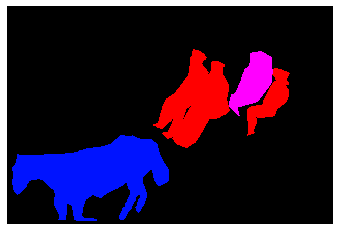

(427, 640, 3)
COCO_val2014_000000501527.jpg
{'person_bbx': [261.0, 68.79, 339.68, 408.48], 'Verbs': 'carry', 'object': {'obj_bbx': [154.59, 173.76, 515.05, 265.28999999999996]}}
person
surfboard
carry
carry interaction
{'person_bbx': [232.99, 51.77, 295.13, 411.53999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [150.02, 124.15, 464.53, 335.58000000000004]}}
person
surfboard
carry
carry interaction
{'person_bbx': [261.0, 68.79, 339.68, 408.48], 'Verbs': 'hold', 'object': {'obj_bbx': [154.59, 173.76, 515.05, 265.28999999999996]}}
person
surfboard
hold
hold interaction
{'person_bbx': [232.99, 51.77, 295.13, 411.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [150.02, 124.15, 464.53, 335.58000000000004]}}
person
surfboard
hold
hold interaction
{'person_bbx': [261.0, 68.79, 339.68, 408.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [232.99, 51.77, 295.13, 411.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx'

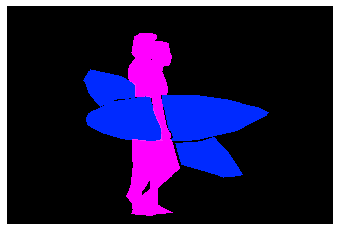

(427, 640, 3)
COCO_val2014_000000548288.jpg
{'person_bbx': [96.07, 56.83, 275.32, 335.96999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [259.91, 319.19, 276.36, 403.15999999999997]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [96.07, 56.83, 275.32, 335.96999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [219.61, 340.61, 429.53, 442.03000000000003]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [245.08, 22.49, 402.54, 337.42], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [259.91, 319.19, 276.36, 403.15999999999997]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [245.08, 22.49, 402.54, 337.42], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [219.61, 340.61, 429.53, 442.03000000000003]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [96.07, 56.83, 275.32, 335.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [259.91, 319.19, 276.36, 403.15999999999997]}}
person
knife
hold
hold interaction
{'person_bbx': [245.08, 22.49, 4

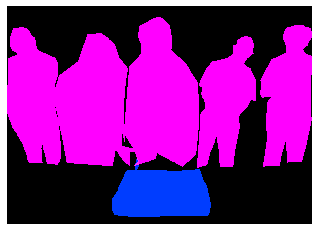

(457, 640, 3)
COCO_val2014_000000097048.jpg
{'person_bbx': [382.53, 117.5, 439.88, 210.3], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [432.15, 114.2, 449.85999999999996, 143.52]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [382.53, 117.5, 439.88, 210.3], 'Verbs': 'hold', 'object': {'obj_bbx': [432.15, 114.2, 449.85999999999996, 143.52]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [382.53, 117.5, 439.88, 210.3], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [382.53, 117.5, 439.88, 210.3], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [350.83, 241.59, 400.04999999999995, 322.13], 'Verbs': 'sit', 'object': {'obj_bbx': [376.73, 276.87, 416.73, 305.51]}}
person
chair
sit
sit interaction
{'person_bbx': [382.53, 117.5, 439.88, 210.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


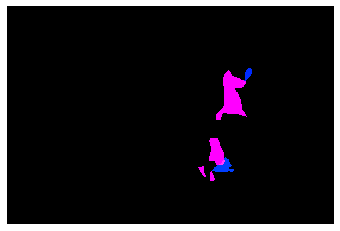

(400, 600, 3)
COCO_val2014_000000293207.jpg
{'person_bbx': [228.65, 37.29, 343.79, 228.1], 'Verbs': 'catch', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
catch
catch interaction
{'person_bbx': [43.87, 60.31, 188.62, 213.84], 'Verbs': 'catch', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
catch
catch interaction
{'person_bbx': [228.65, 37.29, 343.79, 228.1], 'Verbs': 'hold', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
hold
hold interaction
{'person_bbx': [374.17, 41.84, 472.21000000000004, 228.65], 'Verbs': 'look', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
look
look interaction
{'person_bbx': [228.65, 37.29, 343.79, 228.1], 'Verbs': 'look', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
look
look interaction
{'person_bbx': [43.87, 60.31, 188.62, 213.84], 'Verbs': 'look', 'object': {'obj_bbx': [228.3, 57.74, 254.15, 81.54]}}
person
frisbee
look
look interaction
{'perso

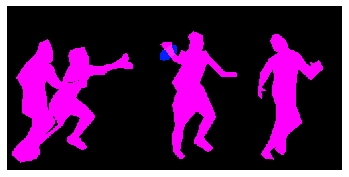

(244, 500, 3)
COCO_val2014_000000367673.jpg
{'person_bbx': [151.01, 153.89, 405.57, 628.49], 'Verbs': 'kick', 'object': {'obj_bbx': [28.82, 480.44, 104.30000000000001, 556.19]}}
sports ball
person
kick
kick interaction
{'person_bbx': [151.01, 153.89, 405.57, 628.49], 'Verbs': 'look', 'object': {'obj_bbx': [28.82, 480.44, 104.30000000000001, 556.19]}}
sports ball
person
look
look interaction
{'person_bbx': [341.62, 198.2, 615.5, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [151.01, 153.89, 405.57, 628.49]}}
person
person
look
look interaction
{'person_bbx': [151.01, 153.89, 405.57, 628.49], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [341.62, 198.2, 615.5, 640.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [151.01, 153.89, 405.57, 628.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [341.62, 198.2, 615.5, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


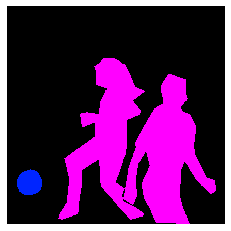

(640, 640, 3)
COCO_val2014_000000414670.jpg
{'person_bbx': [183.34, 54.63, 393.61, 218.51], 'Verbs': 'jump', 'object': {'obj_bbx': [123.88, 202.59, 314.28, 225.14000000000001]}}
person
snowboard
jump
jump interaction
{'person_bbx': [183.34, 54.63, 393.61, 218.51], 'Verbs': 'look', 'object': {'obj_bbx': [123.88, 202.59, 314.28, 225.14000000000001]}}
person
snowboard
look
look interaction
{'person_bbx': [183.34, 54.63, 393.61, 218.51], 'Verbs': 'snowboard', 'object': {'obj_bbx': [123.88, 202.59, 314.28, 225.14000000000001]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [183.34, 54.63, 393.61, 218.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


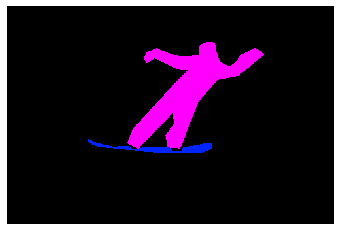

(333, 500, 3)
COCO_val2014_000000426523.jpg
{'person_bbx': [75.91, 163.42, 201.38, 410.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [160.66, 271.62, 268.65999999999997, 289.68]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [240.85, 162.16, 379.02, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [336.67, 286.03, 471.52, 346.57]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [75.91, 163.42, 201.38, 410.13], 'Verbs': 'hold', 'object': {'obj_bbx': [160.66, 271.62, 268.65999999999997, 289.68]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [509.03, 37.97, 640.0, 422.9], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [240.85, 162.16, 379.02, 421.24], 'Verbs': 'look', 'object': {'obj_bbx': [336.67, 286.03, 471.52, 346.57]}}
person
baseball bat
look
look interaction
{'person_bbx': [75.91, 163.42, 201.38, 410.13], 'Verbs': 'look', 'object': {'obj_bbx': [160.66, 271.62, 268.65999999999997, 289.68]}}
baseball bat
person
loo

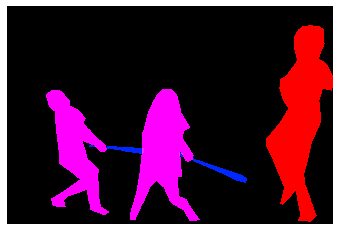

(427, 640, 3)
COCO_val2014_000000294176.jpg
{'person_bbx': [180.07, 165.8, 211.64, 256.21000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [182.77, 175.28, 203.82000000000002, 203.6]}}
backpack
person
carry
carry interaction
{'person_bbx': [283.96, 191.73, 319.54999999999995, 279.1], 'Verbs': 'carry', 'object': {'obj_bbx': [277.15, 231.79, 300.21, 282.76]}}
bicycle
person
carry
carry interaction
{'person_bbx': [470.08, 256.19, 518.61, 360.0], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [283.96, 191.73, 319.54999999999995, 279.1], 'Verbs': 'hold', 'object': {'obj_bbx': [297.82, 206.33, 319.89, 237.69]}}
backpack
person
hold
hold interaction
{'person_bbx': [470.08, 256.19, 518.61, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [216.0, 196.58, 254.82999999999998, 293.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [263.14, 171.42, 299.39, 258.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pe

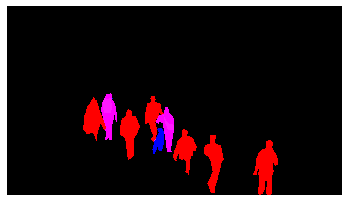

(360, 640, 3)
COCO_val2014_000000404517.jpg
{'person_bbx': [58.25, 50.7, 199.55, 353.8], 'Verbs': 'hold', 'object': {'obj_bbx': [184.51, 198.75, 226.58999999999997, 225.68]}}
person
frisbee
hold
hold interaction
{'person_bbx': [58.25, 50.7, 199.55, 353.8], 'Verbs': 'look', 'object': {'obj_bbx': [281.01, 223.49, 640.0, 367.19]}}
dog
person
look
look interaction
{'person_bbx': [58.25, 50.7, 199.55, 353.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


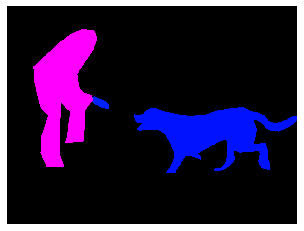

(480, 640, 3)
COCO_val2014_000000170267.jpg
{'person_bbx': [355.69, 206.64, 611.61, 435.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [148.26, 129.04, 361.33, 435.0], 'Verbs': 'lay', 'object': {'obj_bbx': [43.99, 124.82, 640.0, 427.86]}}
person
couch
lay
lay interaction
{'person_bbx': [238.52, 221.9, 635.39, 424.25], 'Verbs': 'lay', 'object': {'obj_bbx': [43.99, 124.82, 640.0, 427.86]}}
person
couch
lay
lay interaction
{'person_bbx': [398.66, 132.78, 640.0, 368.74], 'Verbs': 'lay', 'object': {'obj_bbx': [43.99, 124.82, 640.0, 427.86]}}
couch
person
lay
lay interaction
{'person_bbx': [355.69, 206.64, 611.61, 435.0], 'Verbs': 'lay', 'object': {'obj_bbx': [43.99, 124.82, 640.0, 427.86]}}
couch
person
lay
lay interaction
{'person_bbx': [148.26, 129.04, 361.33, 435.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [238.52, 221.9, 635.39, 424.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [398.66, 132.78, 

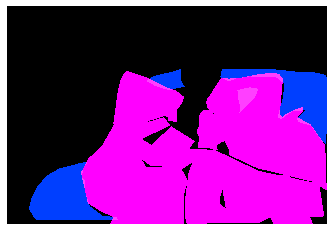

(435, 640, 3)
COCO_val2014_000000350267.jpg
{'person_bbx': [3.31, 168.78, 239.59, 474.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [99.9, 284.65, 227.72, 420.0]}}
laptop
person
look
look interaction
{'person_bbx': [3.31, 168.78, 239.59, 474.32000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 441.19, 99.6, 478.0]}}
person
chair
sit
sit interaction
{'person_bbx': [3.31, 168.78, 239.59, 474.32000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [99.9, 284.65, 227.72, 420.0]}}
laptop
person
work_on_computer
work_on_computer interaction


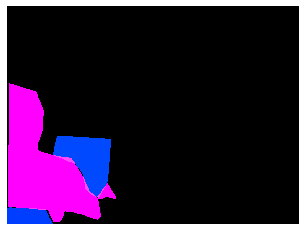

(478, 640, 3)
COCO_val2014_000000228472.jpg
{'person_bbx': [118.18, 98.7, 287.01, 257.14], 'Verbs': 'look', 'object': {'obj_bbx': [190.77, 248.49, 274.43, 269.88]}}
skateboard
person
look
look interaction
{'person_bbx': [118.18, 98.7, 287.01, 257.14], 'Verbs': 'skateboard', 'object': {'obj_bbx': [190.77, 248.49, 274.43, 269.88]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [118.18, 98.7, 287.01, 257.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


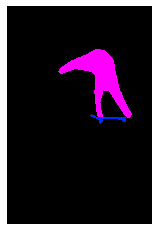

(500, 333, 3)
COCO_val2014_000000117222.jpg
{'person_bbx': [379.48, 47.34, 459.6, 246.76], 'Verbs': 'hold', 'object': {'obj_bbx': [219.86, 177.44, 513.51, 328.03]}}
bicycle
person
hold
hold interaction
{'person_bbx': [379.48, 47.34, 459.6, 246.76], 'Verbs': 'ride', 'object': {'obj_bbx': [219.86, 177.44, 513.51, 328.03]}}
bicycle
person
ride
ride interaction
{'person_bbx': [447.26, 88.1, 506.45, 226.96], 'Verbs': 'ride', 'object': {'obj_bbx': [486.36, 170.57, 547.91, 241.87]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [379.48, 47.34, 459.6, 246.76], 'Verbs': 'sit', 'object': {'obj_bbx': [219.86, 177.44, 513.51, 328.03]}}
bicycle
person
sit
sit interaction
{'person_bbx': [447.26, 88.1, 506.45, 226.96], 'Verbs': 'sit', 'object': {'obj_bbx': [219.86, 177.44, 513.51, 328.03]}}
bicycle
person
sit
sit interaction


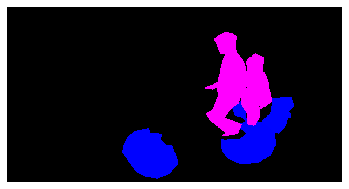

(334, 640, 3)
COCO_val2014_000000178807.jpg
{'person_bbx': [11.91, 0.96, 238.29, 229.5], 'Verbs': 'skateboard', 'object': {'obj_bbx': [140.99, 170.5, 266.68, 217.5]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [335.78, 0.0, 495.0, 216.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [350.84, 196.73, 456.85999999999996, 236.07999999999998]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [11.91, 0.96, 238.29, 229.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [335.78, 0.0, 495.0, 216.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


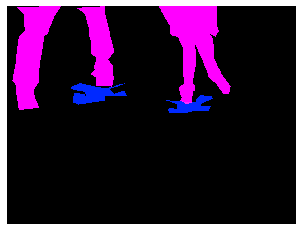

(482, 640, 3)
COCO_val2014_000000012085.jpg
{'person_bbx': [143.46, 215.73, 635.33, 472.45000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 124.86, 640.0, 472.97]}}
person
bed
lay
lay interaction


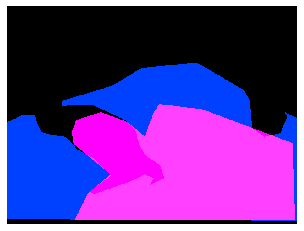

(480, 640, 3)
COCO_val2014_000000147624.jpg
{'person_bbx': [18.7, 4.07, 427.0, 631.13], 'Verbs': 'drink', 'object': {'obj_bbx': []}}
person
drink
{'person_bbx': [18.7, 4.07, 427.0, 631.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [18.7, 4.07, 427.0, 631.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


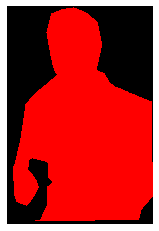

(640, 427, 3)
COCO_val2014_000000001655.jpg
{'person_bbx': [77.91, 236.67, 350.09000000000003, 419.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [268.45, 292.89, 297.81, 360.99]}}
cell phone
person
hold
hold interaction
{'person_bbx': [77.91, 236.67, 350.09000000000003, 419.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [77.91, 236.67, 350.09000000000003, 419.40999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [268.45, 292.89, 297.81, 360.99]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


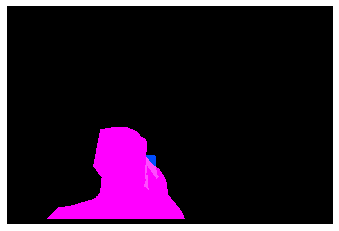

(428, 640, 3)
COCO_val2014_000000098721.jpg
{'person_bbx': [56.28, 246.05, 117.86, 350.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [530.56, 271.34, 616.2099999999999, 347.03], 'Verbs': 'look', 'object': {'obj_bbx': [137.13, 235.3, 171.9, 336.20000000000005]}}
person
person
look
look interaction
{'person_bbx': [487.57, 248.65, 582.7, 338.38], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [530.56, 271.34, 616.2099999999999, 347.03], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [56.28, 246.05, 117.86, 350.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


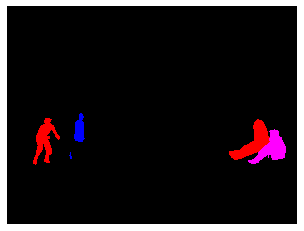

(480, 640, 3)
COCO_val2014_000000127873.jpg
{'person_bbx': [60.98, 187.7, 321.1, 424.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [260.95, 282.62, 304.9, 311.28000000000003]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [60.98, 187.7, 321.1, 424.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [161.51, 264.28, 225.99, 283.91999999999996]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [377.21, 158.05, 609.26, 419.7], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [387.03, 273.55, 424.80999999999995, 310.19]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [60.98, 187.7, 321.1, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [161.51, 264.28, 225.99, 283.91999999999996]}}
person
spoon
hold
hold interaction
{'person_bbx': [377.21, 158.05, 609.26, 419.7], 'Verbs': 'hold', 'object': {'obj_bbx': [387.03, 273.55, 424.80999999999995, 310.19]}}
person
cake
hold
hold interaction
{'person_bbx': [109.7, 41.71, 292.11, 264.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
p

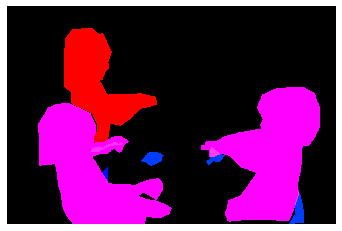

(424, 640, 3)
COCO_val2014_000000231806.jpg
{'person_bbx': [300.88, 3.46, 631.74, 502.62], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [184.21, 180.51, 305.97, 217.93]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [300.88, 3.46, 631.74, 502.62], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [84.05, 123.1, 207.45, 274.56]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [300.88, 3.46, 631.74, 502.62], 'Verbs': 'hold', 'object': {'obj_bbx': [184.21, 180.51, 305.97, 217.93]}}
person
knife
hold
hold interaction
{'person_bbx': [300.88, 3.46, 631.74, 502.62], 'Verbs': 'look', 'object': {'obj_bbx': [84.05, 123.1, 207.45, 274.56]}}
person
cake
look
look interaction
{'person_bbx': [300.88, 3.46, 631.74, 502.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


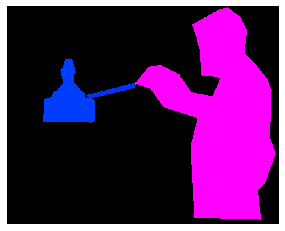

(513, 640, 3)
COCO_val2014_000000240495.jpg
{'person_bbx': [177.98, 68.85, 351.64, 478.74], 'Verbs': 'carry', 'object': {'obj_bbx': [335.78, 318.54, 372.33, 396.6]}}
frisbee
person
carry
carry interaction
{'person_bbx': [177.98, 68.85, 351.64, 478.74], 'Verbs': 'hold', 'object': {'obj_bbx': [335.78, 318.54, 372.33, 396.6]}}
frisbee
person
hold
hold interaction
{'person_bbx': [177.98, 68.85, 351.64, 478.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [339.58, 67.5, 480.1, 456.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [177.98, 68.85, 351.64, 478.74], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [339.58, 67.5, 480.1, 456.73], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


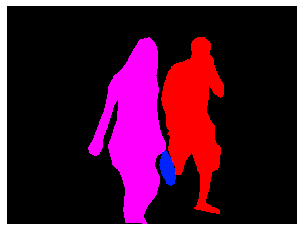

(480, 640, 3)
COCO_val2014_000000164835.jpg
{'person_bbx': [30.64, 28.34, 425.09, 421.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [30.64, 28.34, 425.09, 421.83], 'Verbs': 'snowboard', 'object': {'obj_bbx': [127.05, 365.96, 216.84, 427.0]}}
snowboard
person
snowboard
snowboard interaction


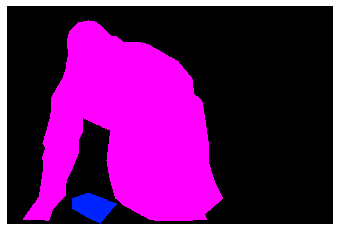

(427, 640, 3)
COCO_val2014_000000343867.jpg
{'person_bbx': [128.44, 42.24, 320.56, 542.56], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [256.88, 165.93, 285.36, 191.54000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [128.44, 42.24, 320.56, 542.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [128.44, 42.24, 320.56, 542.56], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [128.44, 42.24, 320.56, 542.56], 'Verbs': 'look', 'object': {'obj_bbx': [256.88, 165.93, 285.36, 191.54000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [128.44, 42.24, 320.56, 542.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


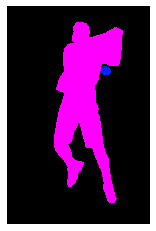

(600, 393, 3)
COCO_val2014_000000414578.jpg
{'person_bbx': [103.14, 117.12, 467.52, 269.43], 'Verbs': 'lay', 'object': {'obj_bbx': [103.46, 244.87, 420.4, 389.61]}}
person
bench
lay
lay interaction


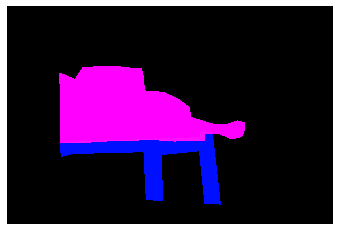

(428, 640, 3)
COCO_val2014_000000267315.jpg
{'person_bbx': [84.85, 56.09, 431.46000000000004, 627.0600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [62.63, 342.78, 127.89000000000001, 377.46999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [354.0, 56.74, 540.22, 600.86], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [84.85, 56.09, 431.46000000000004, 627.0600000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.85, 56.09, 431.46000000000004, 627.0600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [84.85, 56.09, 431.46000000000004, 627.0600000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


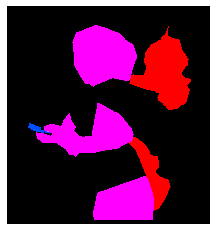

(640, 595, 3)
COCO_val2014_000000275749.jpg
{'person_bbx': [311.98, 125.39, 399.88, 352.08], 'Verbs': 'look', 'object': {'obj_bbx': [269.8, 192.77, 328.73, 339.0]}}
person
person
look
look interaction
{'person_bbx': [60.67, 96.91, 153.37, 239.32999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [12.32, 233.06, 64.68, 314.68]}}
tv
person
look
look interaction
{'person_bbx': [311.98, 125.39, 399.88, 352.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.67, 96.91, 153.37, 239.32999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.72, 93.54, 221.63, 295.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


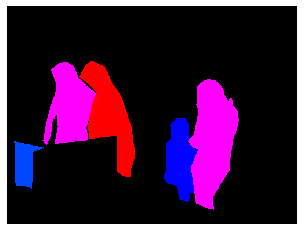

(375, 500, 3)
COCO_val2014_000000266847.jpg
{'person_bbx': [147.51, 70.9, 477.03, 439.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [363.5, 99.82, 385.67, 124.35]}}
sports ball
person
hold
hold interaction
{'person_bbx': [147.51, 70.9, 477.03, 439.67999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [147.51, 70.9, 477.03, 439.67999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [147.51, 70.9, 477.03, 439.67999999999995], 'Verbs': 'throw', 'object': {'obj_bbx': [363.5, 99.82, 385.67, 124.35]}}
sports ball
person
throw
throw interaction


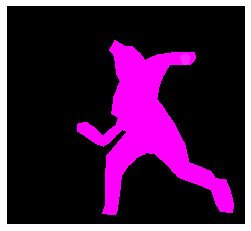

(458, 500, 3)
COCO_val2014_000000492608.jpg
{'person_bbx': [514.48, 146.3, 604.6800000000001, 187.5], 'Verbs': 'surf', 'object': {'obj_bbx': [575.14, 156.68, 603.73, 174.88]}}
person
surfboard
surf
surf interaction


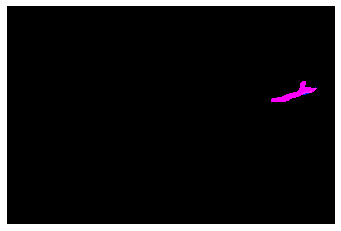

(425, 640, 3)
COCO_val2014_000000157601.jpg
{'person_bbx': [0.0, 84.77, 330.81, 418.34], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [110.55, 188.21, 244.8, 334.3]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 84.77, 330.81, 418.34], 'Verbs': 'hold', 'object': {'obj_bbx': [110.55, 188.21, 244.8, 334.3]}}
hot dog
person
hold
hold interaction
{'person_bbx': [0.0, 84.77, 330.81, 418.34], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


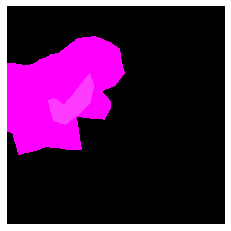

(612, 612, 3)
COCO_val2014_000000028692.jpg
{'person_bbx': [160.87, 14.77, 384.42, 169.03], 'Verbs': 'jump', 'object': {'obj_bbx': [152.69, 154.55, 295.28, 192.08]}}
person
skateboard
jump
jump interaction
{'person_bbx': [160.87, 14.77, 384.42, 169.03], 'Verbs': 'look', 'object': {'obj_bbx': [152.69, 154.55, 295.28, 192.08]}}
person
skateboard
look
look interaction
{'person_bbx': [160.87, 14.77, 384.42, 169.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [152.69, 154.55, 295.28, 192.08]}}
person
skateboard
skateboard
skateboard interaction


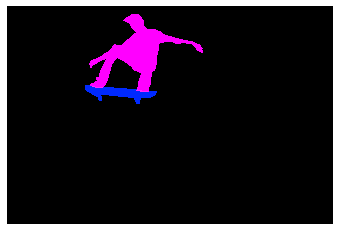

(427, 640, 3)
COCO_val2014_000000087409.jpg
{'person_bbx': [169.35, 264.34, 231.07, 337.05999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [226.28, 270.97, 286.52, 340.44000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [290.11, 272.89, 359.56, 337.79999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [169.35, 264.34, 231.07, 337.05999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [226.28, 270.97, 286.52, 340.44000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [290.11, 272.89, 359.56, 337.79999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [169.35, 264.34, 231.07, 337.05999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


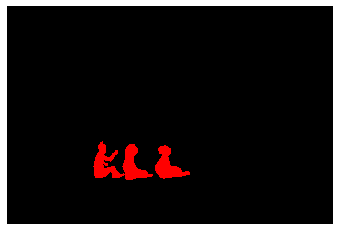

(427, 640, 3)
COCO_val2014_000000557732.jpg
{'person_bbx': [293.57, 167.31, 401.82, 384.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [293.57, 167.31, 401.82, 384.45], 'Verbs': 'snowboard', 'object': {'obj_bbx': [323.93, 353.27, 388.5, 388.49]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [293.57, 167.31, 401.82, 384.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


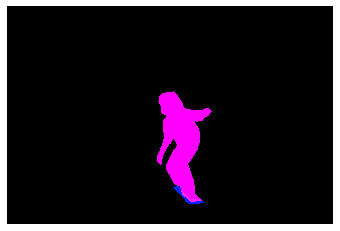

(427, 640, 3)
COCO_val2014_000000410328.jpg
{'person_bbx': [78.54, 116.16, 313.54, 473.76], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [240.36, 174.56, 340.32, 211.81]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [78.54, 116.16, 313.54, 473.76], 'Verbs': 'hold', 'object': {'obj_bbx': [240.36, 174.56, 340.32, 211.81]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [78.54, 116.16, 313.54, 473.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


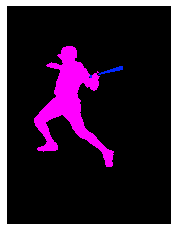

(640, 480, 3)
COCO_val2014_000000576363.jpg
{'person_bbx': [195.51, 115.45, 252.81, 305.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [195.51, 115.45, 252.81, 305.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [30.92, 94.0, 74.73, 233.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [424.89, 214.36, 500.0, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


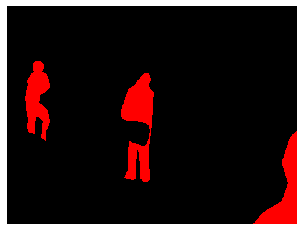

(375, 500, 3)
COCO_val2014_000000492840.jpg
{'person_bbx': [206.3, 214.94, 432.76, 427.0], 'Verbs': 'catch', 'object': {'obj_bbx': [54.34, 268.65, 79.35000000000001, 289.12]}}
sports ball
person
catch
catch interaction
{'person_bbx': [236.05, 58.53, 454.83000000000004, 303.22], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [88.48, 213.3, 249.05, 272.71000000000004]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [236.05, 58.53, 454.83000000000004, 303.22], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [54.34, 268.65, 79.35000000000001, 289.12]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [236.05, 58.53, 454.83000000000004, 303.22], 'Verbs': 'hold', 'object': {'obj_bbx': [88.48, 213.3, 249.05, 272.71000000000004]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [206.3, 214.94, 432.76, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [54.34, 268.65, 79.35000000000001, 289.12]}}
sports ball
person
look
look interaction
{'person_bbx': [447.24, 112.

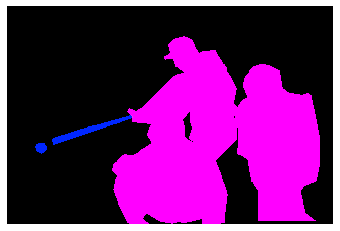

(427, 640, 3)
COCO_val2014_000000438186.jpg
{'person_bbx': [0.0, 14.38, 512.0, 611.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [212.39, 154.48, 262.56, 200.08999999999997]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 14.38, 512.0, 611.24], 'Verbs': 'hold', 'object': {'obj_bbx': [212.39, 154.48, 262.56, 200.08999999999997]}}
person
donut
hold
hold interaction


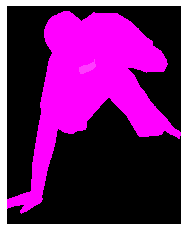

(640, 512, 3)
COCO_val2014_000000160185.jpg
{'person_bbx': [250.42, 23.03, 467.26, 409.69000000000005], 'Verbs': 'kick', 'object': {'obj_bbx': [216.34, 353.66, 267.8, 402.27000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [250.42, 23.03, 467.26, 409.69000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [216.34, 353.66, 267.8, 402.27000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [250.42, 23.03, 467.26, 409.69000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [250.42, 23.03, 467.26, 409.69000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.96, 48.82, 134.02, 323.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.96, 48.82, 134.02, 323.57], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


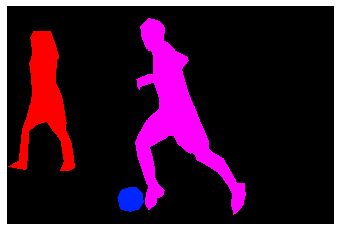

(426, 640, 3)
COCO_val2014_000000495578.jpg
{'person_bbx': [335.27, 18.44, 549.4, 427.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [294.37, 44.81, 372.2, 145.03]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [335.27, 18.44, 549.4, 427.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [409.54, 82.5, 432.84000000000003, 102.62]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [335.27, 18.44, 549.4, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [294.37, 44.81, 372.2, 145.03]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [335.27, 18.44, 549.4, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [409.54, 82.5, 432.84000000000003, 102.62]}}
sports ball
person
look
look interaction
{'person_bbx': [335.27, 18.44, 549.4, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


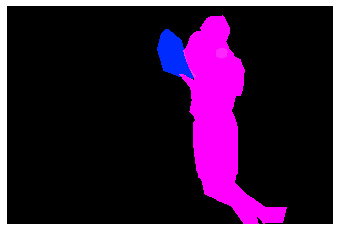

(427, 640, 3)
COCO_val2014_000000467437.jpg
{'person_bbx': [147.41, 199.63, 619.02, 608.0], 'Verbs': 'lay', 'object': {'obj_bbx': [1.36, 0.91, 640.0, 600.73]}}
bed
person
lay
lay interaction
{'person_bbx': [4.1, 202.21, 303.32000000000005, 597.07], 'Verbs': 'lay', 'object': {'obj_bbx': [1.36, 0.91, 640.0, 600.73]}}
bed
person
lay
lay interaction
{'person_bbx': [147.41, 199.63, 619.02, 608.0], 'Verbs': 'look', 'object': {'obj_bbx': [216.01, 180.42, 401.40999999999997, 418.99]}}
person
person
look
look interaction
{'person_bbx': [4.1, 202.21, 303.32000000000005, 597.07], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [147.41, 199.63, 619.02, 608.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


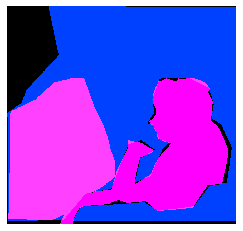

(608, 640, 3)
COCO_val2014_000000072281.jpg
{'person_bbx': [94.71, 15.21, 354.44, 501.66999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [95.18, 436.09, 363.29, 541.31]}}
person
skateboard
jump
jump interaction
{'person_bbx': [94.71, 15.21, 354.44, 501.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [95.18, 436.09, 363.29, 541.31]}}
person
skateboard
look
look interaction
{'person_bbx': [94.71, 15.21, 354.44, 501.66999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [95.18, 436.09, 363.29, 541.31]}}
person
skateboard
skateboard
skateboard interaction


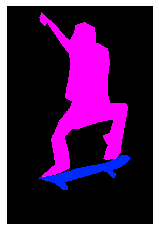

(640, 427, 3)
COCO_val2014_000000566282.jpg
{'person_bbx': [44.79, 34.4, 203.95, 374.63], 'Verbs': 'kick', 'object': {'obj_bbx': [99.42, 321.98, 152.32999999999998, 375.61]}}
sports ball
person
kick
kick interaction
{'person_bbx': [44.79, 34.4, 203.95, 374.63], 'Verbs': 'look', 'object': {'obj_bbx': [99.42, 321.98, 152.32999999999998, 375.61]}}
sports ball
person
look
look interaction
{'person_bbx': [353.24, 1.8, 477.69, 345.47], 'Verbs': 'look', 'object': {'obj_bbx': [99.42, 321.98, 152.32999999999998, 375.61]}}
sports ball
person
look
look interaction
{'person_bbx': [44.79, 34.4, 203.95, 374.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.24, 1.8, 477.69, 345.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


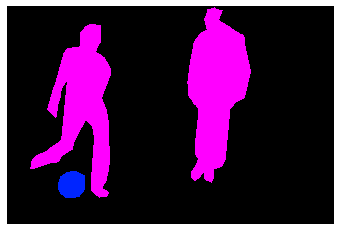

(426, 640, 3)
COCO_val2014_000000061967.jpg
{'person_bbx': [41.48, 1.48, 449.49, 370.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [41.48, 1.48, 449.49, 370.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


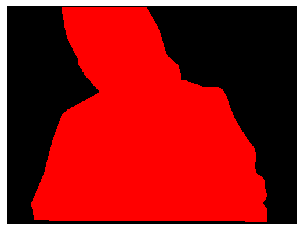

(375, 500, 3)
COCO_val2014_000000192787.jpg
{'person_bbx': [135.35, 103.57, 394.4, 428.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [135.35, 103.57, 394.4, 428.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [135.35, 103.57, 394.4, 428.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [135.35, 103.57, 394.4, 428.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [140.61, 424.63, 387.31, 523.31]}}
person
laptop
work_on_computer
work_on_computer interaction


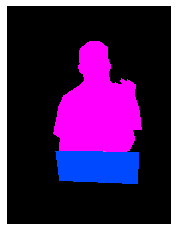

(640, 480, 3)
COCO_val2014_000000041212.jpg
{'person_bbx': [218.61, 155.33, 618.4300000000001, 583.91], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [122.16, 516.38, 187.29, 582.47]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [218.61, 155.33, 618.4300000000001, 583.91], 'Verbs': 'kick', 'object': {'obj_bbx': [122.16, 516.38, 187.29, 582.47]}}
person
sports ball
kick
kick interaction
{'person_bbx': [218.61, 155.33, 618.4300000000001, 583.91], 'Verbs': 'look', 'object': {'obj_bbx': [122.16, 516.38, 187.29, 582.47]}}
person
sports ball
look
look interaction
{'person_bbx': [218.61, 155.33, 618.4300000000001, 583.91], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


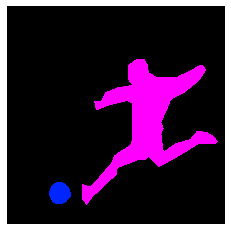

(640, 640, 3)
COCO_val2014_000000195974.jpg
{'person_bbx': [150.13, 285.26, 202.06, 364.78999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [146.48, 348.9, 217.94, 374.97999999999996]}}
person
snowboard
jump
jump interaction
{'person_bbx': [150.13, 285.26, 202.06, 364.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [146.48, 348.9, 217.94, 374.97999999999996]}}
person
snowboard
look
look interaction
{'person_bbx': [150.13, 285.26, 202.06, 364.78999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [146.48, 348.9, 217.94, 374.97999999999996]}}
person
snowboard
snowboard
snowboard interaction


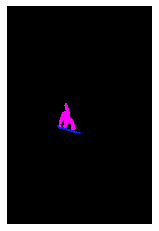

(640, 426, 3)
COCO_val2014_000000169996.jpg
{'person_bbx': [171.29, 287.02, 245.60999999999999, 415.45], 'Verbs': 'hold', 'object': {'obj_bbx': [151.74, 343.74, 260.13, 439.74]}}
bicycle
person
hold
hold interaction
{'person_bbx': [404.65, 283.46, 479.59, 391.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [399.89, 329.15, 481.36, 427.53999999999996]}}
bicycle
person
hold
hold interaction
{'person_bbx': [171.29, 287.02, 245.60999999999999, 415.45], 'Verbs': 'ride', 'object': {'obj_bbx': [151.74, 343.74, 260.13, 439.74]}}
bicycle
person
ride
ride interaction
{'person_bbx': [404.65, 283.46, 479.59, 391.29999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [399.89, 329.15, 481.36, 427.53999999999996]}}
bicycle
person
ride
ride interaction
{'person_bbx': [171.29, 287.02, 245.60999999999999, 415.45], 'Verbs': 'sit', 'object': {'obj_bbx': [151.74, 343.74, 260.13, 439.74]}}
bicycle
person
sit
sit interaction
{'person_bbx': [404.65, 283.46, 479.59, 391.29999999999995], 'Verbs': 'sit'

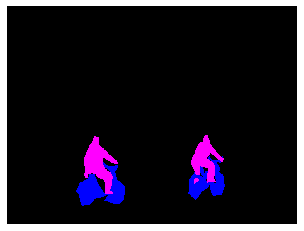

(480, 640, 3)
COCO_val2014_000000049502.jpg
{'person_bbx': [243.74, 183.46, 344.54, 251.91000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [247.45, 170.95, 402.82, 301.06]}}
person
surfboard
jump
jump interaction
{'person_bbx': [243.74, 183.46, 344.54, 251.91000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [247.45, 170.95, 402.82, 301.06]}}
person
surfboard
look
look interaction
{'person_bbx': [243.74, 183.46, 344.54, 251.91000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [247.45, 170.95, 402.82, 301.06]}}
person
surfboard
surf
surf interaction


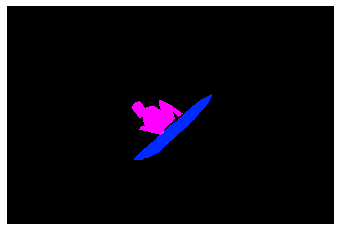

(426, 640, 3)
COCO_val2014_000000436183.jpg
{'person_bbx': [120.22, 107.87, 302.25, 500.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [58.28, 335.84, 120.21000000000001, 404.33]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [120.22, 107.87, 302.25, 500.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [117.19, 343.06, 135.73, 361.46]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [120.22, 107.87, 302.25, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [117.19, 343.06, 135.73, 361.46]}}
sports ball
person
hold
hold interaction
{'person_bbx': [120.22, 107.87, 302.25, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


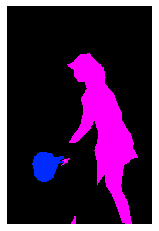

(500, 333, 3)
COCO_val2014_000000429159.jpg
{'person_bbx': [29.31, 50.27, 460.87, 628.38], 'Verbs': 'hold', 'object': {'obj_bbx': [247.69, 166.6, 304.39, 228.73]}}
cell phone
person
hold
hold interaction
{'person_bbx': [29.31, 50.27, 460.87, 628.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [29.31, 50.27, 460.87, 628.38], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [247.69, 166.6, 304.39, 228.73]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


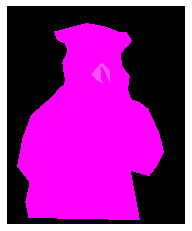

(640, 523, 3)
COCO_val2014_000000515779.jpg
{'person_bbx': [11.38, 41.24, 174.32, 274.19], 'Verbs': 'hold', 'object': {'obj_bbx': [47.09, 168.29, 235.43, 320.76]}}
person
backpack
hold
hold interaction
{'person_bbx': [11.38, 41.24, 174.32, 274.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


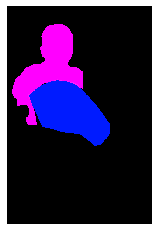

(500, 332, 3)
COCO_val2014_000000459400.jpg
{'person_bbx': [4.83, 246.38, 328.89, 494.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [4.83, 246.38, 328.89, 494.40999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


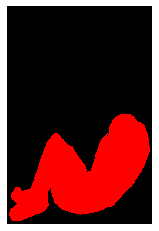

(500, 333, 3)
COCO_val2014_000000045516.jpg
{'person_bbx': [130.61, 0.0, 557.79, 432.09], 'Verbs': 'hold', 'object': {'obj_bbx': [154.39, 382.81, 228.15999999999997, 399.45]}}
cell phone
person
hold
hold interaction
{'person_bbx': [130.61, 0.0, 557.79, 432.09], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [130.61, 0.0, 557.79, 432.09], 'Verbs': 'look', 'object': {'obj_bbx': [154.39, 382.81, 228.15999999999997, 399.45]}}
cell phone
person
look
look interaction
{'person_bbx': [130.61, 0.0, 557.79, 432.09], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


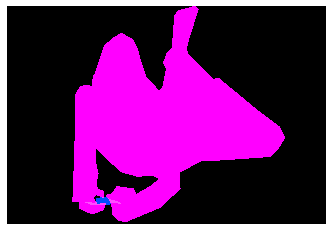

(437, 640, 3)
COCO_val2014_000000519055.jpg
{'person_bbx': [55.15, 68.06, 587.89, 515.13], 'Verbs': 'hold', 'object': {'obj_bbx': [502.27, 211.91, 573.6899999999999, 333.67]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [55.15, 68.06, 587.89, 515.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [55.15, 68.06, 587.89, 515.13], 'Verbs': 'throw', 'object': {'obj_bbx': [59.74, 157.12, 88.45, 186.03]}}
person
sports ball
throw
throw interaction


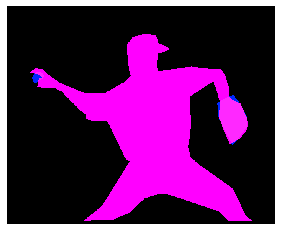

(521, 640, 3)
COCO_val2014_000000139163.jpg
{'person_bbx': [407.78, 27.94, 620.67, 396.0], 'Verbs': 'hold', 'object': {'obj_bbx': [408.67, 296.62, 467.71000000000004, 374.22]}}
frisbee
person
hold
hold interaction
{'person_bbx': [407.78, 27.94, 620.67, 396.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.89, 39.16, 156.61999999999998, 391.54999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [407.78, 27.94, 620.67, 396.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.89, 39.16, 156.61999999999998, 391.54999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


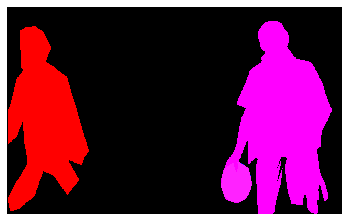

(396, 640, 3)
COCO_val2014_000000464274.jpg
{'person_bbx': [119.64, 146.31, 467.03, 633.51], 'Verbs': 'hold', 'object': {'obj_bbx': [242.88, 357.07, 273.98, 390.33]}}
cell phone
person
hold
hold interaction
{'person_bbx': [119.64, 146.31, 467.03, 633.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [119.64, 146.31, 467.03, 633.51], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [242.88, 357.07, 273.98, 390.33]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


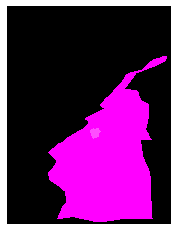

(640, 480, 3)
COCO_val2014_000000338552.jpg
{'person_bbx': [178.34, 129.44, 319.28, 271.82], 'Verbs': 'jump', 'object': {'obj_bbx': [274.41, 270.49, 401.8, 302.49]}}
person
snowboard
jump
jump interaction
{'person_bbx': [178.34, 129.44, 319.28, 271.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [269.97, 193.52, 528.03, 324.28], 'Verbs': 'look', 'object': {'obj_bbx': [426.56, 419.4, 561.02, 453.21]}}
person
snowboard
look
look interaction
{'person_bbx': [178.34, 129.44, 319.28, 271.82], 'Verbs': 'snowboard', 'object': {'obj_bbx': [274.41, 270.49, 401.8, 302.49]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [349.4, 344.06, 490.46, 446.87], 'Verbs': 'snowboard', 'object': {'obj_bbx': [426.56, 419.4, 561.02, 453.21]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [269.97, 193.52, 528.03, 324.28], 'Verbs': 'snowboard', 'object': {'obj_bbx': [426.56, 419.4, 561.02, 453.21]}}
person
snowboard
snowboard
snowboard interaction


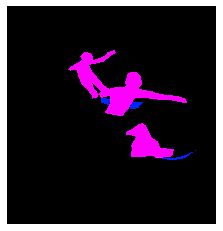

(640, 614, 3)
COCO_val2014_000000461898.jpg
{'person_bbx': [110.05, 18.68, 623.14, 628.9499999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [402.91, 331.44, 453.3, 382.9]}}
person
remote
hold
hold interaction
{'person_bbx': [110.05, 18.68, 623.14, 628.9499999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [110.05, 18.68, 623.14, 628.9499999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


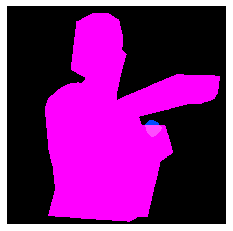

(636, 640, 3)
COCO_val2014_000000350019.jpg
{'person_bbx': [125.41, 38.2, 301.26, 265.95], 'Verbs': 'carry', 'object': {'obj_bbx': [102.34, 258.74, 370.45000000000005, 619.1]}}
suitcase
person
carry
carry interaction
{'person_bbx': [125.41, 38.2, 301.26, 265.95], 'Verbs': 'hold', 'object': {'obj_bbx': [102.34, 258.74, 370.45000000000005, 619.1]}}
suitcase
person
hold
hold interaction
{'person_bbx': [125.41, 38.2, 301.26, 265.95], 'Verbs': 'look', 'object': {'obj_bbx': [102.34, 258.74, 370.45000000000005, 619.1]}}
suitcase
person
look
look interaction
{'person_bbx': [125.41, 38.2, 301.26, 265.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


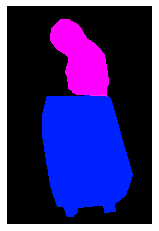

(640, 426, 3)
COCO_val2014_000000290979.jpg
{'person_bbx': [302.7, 123.78, 477.84, 423.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [302.7, 123.78, 477.84, 423.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


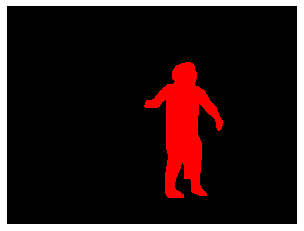

(480, 640, 3)
COCO_val2014_000000281008.jpg
{'person_bbx': [97.38, 28.03, 232.14, 271.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [97.38, 28.03, 232.14, 271.72], 'Verbs': 'surf', 'object': {'obj_bbx': [98.52, 230.74, 209.45999999999998, 303.14]}}
person
surfboard
surf
surf interaction


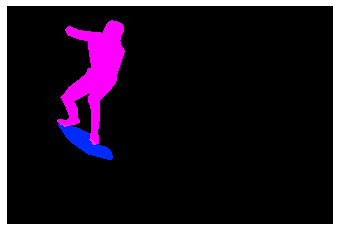

(428, 640, 3)
COCO_val2014_000000581496.jpg
{'person_bbx': [112.84, 28.83, 593.26, 590.36], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [31.68, 174.24, 174.24, 321.12]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [112.84, 28.83, 593.26, 590.36], 'Verbs': 'hold', 'object': {'obj_bbx': [31.68, 174.24, 174.24, 321.12]}}
person
banana
hold
hold interaction


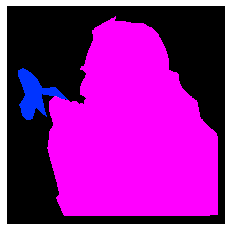

(612, 612, 3)
COCO_val2014_000000408120.jpg
{'person_bbx': [285.45, 104.75, 318.13, 207.66], 'Verbs': 'carry', 'object': {'obj_bbx': [259.36, 85.63, 321.01, 141.93]}}
umbrella
person
carry
carry interaction
{'person_bbx': [285.45, 104.75, 318.13, 207.66], 'Verbs': 'hold', 'object': {'obj_bbx': [259.36, 85.63, 321.01, 141.93]}}
umbrella
person
hold
hold interaction
{'person_bbx': [285.45, 104.75, 318.13, 207.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [285.45, 104.75, 318.13, 207.66], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


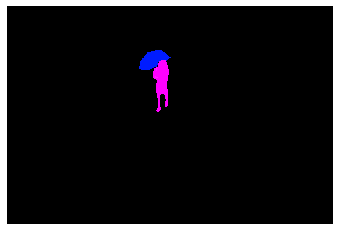

(427, 640, 3)
COCO_val2014_000000410810.jpg
{'person_bbx': [267.86, 44.06, 398.72, 321.12], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.76, 279.35, 350.16999999999996, 324.5]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [267.86, 44.06, 398.72, 321.12], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [212.03, 299.01, 600.07, 440.02]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [322.89, 64.73, 513.74, 312.32], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.76, 279.35, 350.16999999999996, 324.5]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [322.89, 64.73, 513.74, 312.32], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [212.03, 299.01, 600.07, 440.02]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [33.89, 32.86, 327.59999999999997, 375.87], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.76, 279.35, 350.16999999999996, 324.5]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [33.89, 32.86, 327.59999999999997, 375.87], 'Verbs'

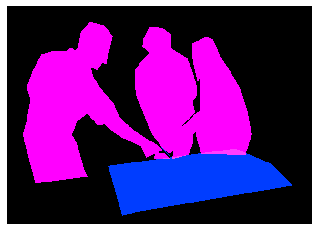

(457, 640, 3)
COCO_val2014_000000374270.jpg
{'person_bbx': [178.08, 13.02, 410.72, 380.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [223.58, 292.9, 421.24, 398.45]}}
person
skateboard
jump
jump interaction
{'person_bbx': [178.08, 13.02, 410.72, 380.65999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [223.58, 292.9, 421.24, 398.45]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [178.08, 13.02, 410.72, 380.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


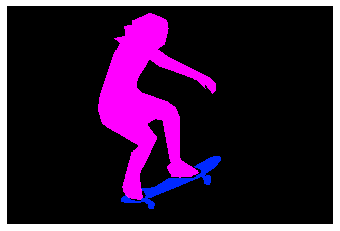

(427, 640, 3)
COCO_val2014_000000134518.jpg
{'person_bbx': [10.58, 5.77, 640.0, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': [25.01, 188.78, 153.92, 422.23]}}
cell phone
person
hold
hold interaction
{'person_bbx': [10.58, 5.77, 640.0, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [25.01, 188.78, 153.92, 422.23]}}
cell phone
person
look
look interaction
{'person_bbx': [10.58, 5.77, 640.0, 428.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


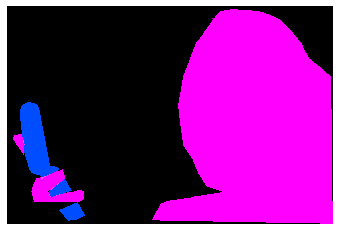

(428, 640, 3)
COCO_val2014_000000382462.jpg
{'person_bbx': [245.83, 112.5, 532.15, 377.61], 'Verbs': 'kick', 'object': {'obj_bbx': [438.17, 327.45, 482.95000000000005, 371.38]}}
sports ball
person
kick
kick interaction
{'person_bbx': [153.51, 111.62, 329.53999999999996, 373.74], 'Verbs': 'look', 'object': {'obj_bbx': [438.17, 327.45, 482.95000000000005, 371.38]}}
sports ball
person
look
look interaction
{'person_bbx': [245.83, 112.5, 532.15, 377.61], 'Verbs': 'look', 'object': {'obj_bbx': [438.17, 327.45, 482.95000000000005, 371.38]}}
sports ball
person
look
look interaction
{'person_bbx': [245.83, 112.5, 532.15, 377.61], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [153.51, 111.62, 329.53999999999996, 373.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.89, 26.03, 143.64, 396.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.89, 26.03, 143.64, 396.22], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
per

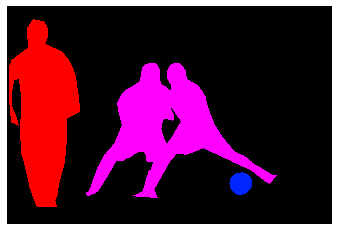

(429, 640, 3)
COCO_val2014_000000479939.jpg
{'person_bbx': [119.87, 123.81, 164.2, 209.67000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [114.85, 171.41, 192.29, 230.26]}}
person
skis
jump
jump interaction
{'person_bbx': [119.87, 123.81, 164.2, 209.67000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [114.85, 171.41, 192.29, 230.26]}}
person
skis
ski
ski interaction
{'person_bbx': [119.87, 123.81, 164.2, 209.67000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


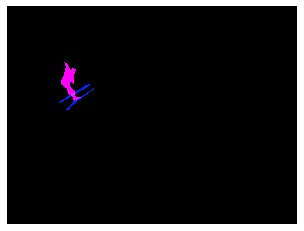

(480, 640, 3)
COCO_val2014_000000360409.jpg
{'person_bbx': [107.78, 142.7, 196.11, 300.88], 'Verbs': 'surf', 'object': {'obj_bbx': [51.81, 286.98, 106.69, 311.42]}}
person
surfboard
surf
surf interaction


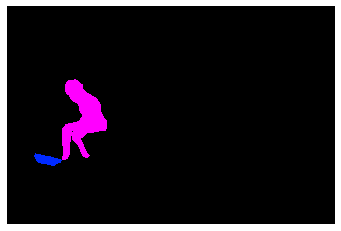

(425, 640, 3)
COCO_val2014_000000279696.jpg
{'person_bbx': [24.11, 82.37, 341.53000000000003, 441.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [331.22, 55.88, 599.02, 442.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [434.31, 133.97, 451.61, 161.81]}}
cell phone
person
hold
hold interaction
{'person_bbx': [331.22, 55.88, 599.02, 442.46999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [24.11, 82.37, 341.53000000000003, 441.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [331.22, 55.88, 599.02, 442.46999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [331.22, 55.88, 599.02, 442.46999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [434.31, 133.97, 451.61, 161.81]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


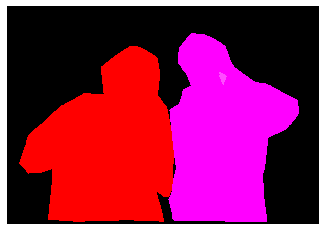

(447, 640, 3)
COCO_val2014_000000269358.jpg
{'person_bbx': [88.45, 129.44, 465.97999999999996, 474.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [290.94, 265.62, 364.39, 367.36]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [88.45, 129.44, 465.97999999999996, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [290.94, 265.62, 364.39, 367.36]}}
person
hot dog
hold
hold interaction
{'person_bbx': [88.45, 129.44, 465.97999999999996, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


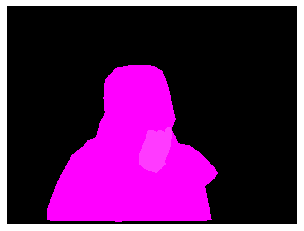

(480, 640, 3)
COCO_val2014_000000463884.jpg
{'person_bbx': [168.88, 99.63, 261.0, 374.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [168.88, 99.63, 261.0, 374.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


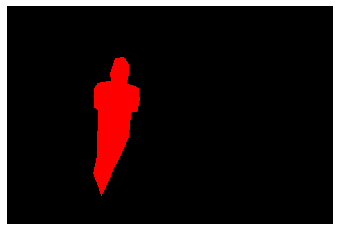

(427, 640, 3)
COCO_val2014_000000025812.jpg
{'person_bbx': [479.9, 325.22, 539.61, 388.64000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [477.76, 382.23, 508.24, 393.22]}}
person
snowboard
snowboard
snowboard interaction


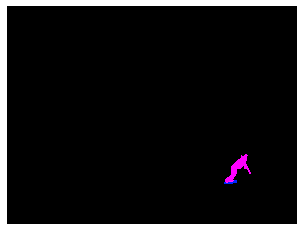

(480, 640, 3)
COCO_val2014_000000407291.jpg
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [106.19, 114.85, 162.91, 151.35999999999999]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [183.28, 79.07, 192.34, 87.55999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'Verbs': 'hold', 'object': {'obj_bbx': [106.19, 114.85, 162.91, 151.35999999999999]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'Verbs': 'look', 'object': {'obj_bbx': [183.28, 79.07, 192.34, 87.55999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [124.07, 132.73, 226.01999999999998, 408.76], 'V

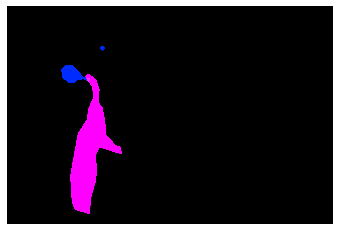

(428, 640, 3)
COCO_val2014_000000478521.jpg
{'person_bbx': [324.61, 83.31, 383.35, 150.99], 'Verbs': 'ride', 'object': {'obj_bbx': [238.92, 132.26, 408.76, 326.48]}}
elephant
person
ride
ride interaction
{'person_bbx': [41.49, 68.57, 95.27000000000001, 147.02999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [25.3, 128.33, 101.97, 263.78]}}
person
elephant
ride
ride interaction
{'person_bbx': [73.36, 79.25, 150.17000000000002, 195.93], 'Verbs': 'ride', 'object': {'obj_bbx': [55.95, 145.54, 194.58999999999997, 328.78]}}
elephant
person
ride
ride interaction
{'person_bbx': [324.61, 83.31, 383.35, 150.99], 'Verbs': 'sit', 'object': {'obj_bbx': [238.92, 132.26, 408.76, 326.48]}}
elephant
person
sit
sit interaction
{'person_bbx': [41.49, 68.57, 95.27000000000001, 147.02999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [25.3, 128.33, 101.97, 263.78]}}
person
elephant
sit
sit interaction
{'person_bbx': [73.36, 79.25, 150.17000000000002, 195.93], 'Verbs': 'sit', 'object': {'obj_bbx': [55

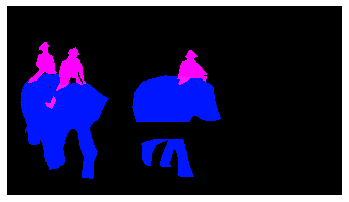

(360, 640, 3)
COCO_val2014_000000567494.jpg
{'person_bbx': [242.98, 218.79, 312.66999999999996, 327.51], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [211.85, 220.84, 253.82, 237.89000000000001]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [242.98, 218.79, 312.66999999999996, 327.51], 'Verbs': 'hold', 'object': {'obj_bbx': [211.85, 220.84, 253.82, 237.89000000000001]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [368.9, 260.85, 459.03, 366.64000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [242.98, 218.79, 312.66999999999996, 327.51], 'Verbs': 'look', 'object': {'obj_bbx': [211.85, 220.84, 253.82, 237.89000000000001]}}
baseball bat
person
look
look interaction
{'person_bbx': [368.9, 260.85, 459.03, 366.64000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.98, 218.79, 312.66999999999996, 327.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


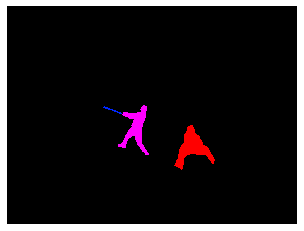

(480, 640, 3)
COCO_val2014_000000345520.jpg
{'person_bbx': [102.8, 42.64, 199.18, 150.26], 'Verbs': 'hold', 'object': {'obj_bbx': [121.01, 71.85, 300.91, 169.47]}}
person
elephant
hold
hold interaction
{'person_bbx': [102.8, 42.64, 199.18, 150.26], 'Verbs': 'look', 'object': {'obj_bbx': [121.01, 71.85, 300.91, 169.47]}}
person
elephant
look
look interaction
{'person_bbx': [350.93, 33.88, 474.36, 175.87], 'Verbs': 'look', 'object': {'obj_bbx': [293.72, 149.14, 531.4000000000001, 336.16999999999996]}}
person
elephant
look
look interaction
{'person_bbx': [350.93, 33.88, 474.36, 175.87], 'Verbs': 'ride', 'object': {'obj_bbx': [293.72, 149.14, 531.4000000000001, 336.16999999999996]}}
person
elephant
ride
ride interaction
{'person_bbx': [350.93, 33.88, 474.36, 175.87], 'Verbs': 'sit', 'object': {'obj_bbx': [293.72, 149.14, 531.4000000000001, 336.16999999999996]}}
person
elephant
sit
sit interaction


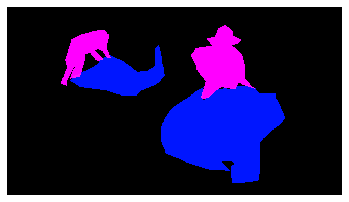

(359, 640, 3)
COCO_val2014_000000552186.jpg
{'person_bbx': [63.39, 94.7, 399.22999999999996, 589.44], 'Verbs': 'jump', 'object': {'obj_bbx': [51.61, 517.68, 242.57999999999998, 600.26]}}
person
skateboard
jump
jump interaction
{'person_bbx': [63.39, 94.7, 399.22999999999996, 589.44], 'Verbs': 'look', 'object': {'obj_bbx': [51.61, 517.68, 242.57999999999998, 600.26]}}
person
skateboard
look
look interaction
{'person_bbx': [63.39, 94.7, 399.22999999999996, 589.44], 'Verbs': 'skateboard', 'object': {'obj_bbx': [51.61, 517.68, 242.57999999999998, 600.26]}}
person
skateboard
skateboard
skateboard interaction


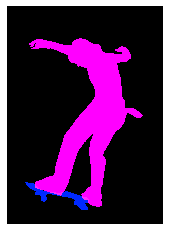

(640, 459, 3)
COCO_val2014_000000376347.jpg
{'person_bbx': [248.29, 176.15, 407.78, 292.51], 'Verbs': 'surf', 'object': {'obj_bbx': [184.27, 145.64, 237.93, 320.22]}}
surfboard
person
surf
surf interaction


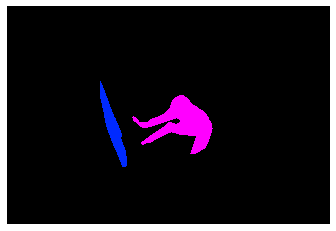

(432, 640, 3)
COCO_val2014_000000087889.jpg
{'person_bbx': [97.91, 210.72, 225.06, 537.13], 'Verbs': 'carry', 'object': {'obj_bbx': [134.16, 258.59, 206.51, 350.35999999999996]}}
person
backpack
carry
carry interaction
{'person_bbx': [187.58, 199.06, 400.0, 631.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [97.91, 210.72, 225.06, 537.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [187.58, 199.06, 400.0, 631.9], 'Verbs': 'ski', 'object': {'obj_bbx': [251.44, 589.67, 367.73, 640.0]}}
person
skis
ski
ski interaction
{'person_bbx': [97.91, 210.72, 225.06, 537.13], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [187.58, 199.06, 400.0, 631.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [97.91, 210.72, 225.06, 537.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


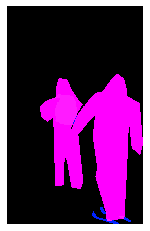

(640, 400, 3)
COCO_val2014_000000383533.jpg
{'person_bbx': [83.48, 78.52, 205.34, 404.77], 'Verbs': 'hold', 'object': {'obj_bbx': [78.99, 309.1, 253.57999999999998, 401.04]}}
person
surfboard
hold
hold interaction
{'person_bbx': [270.34, 87.02, 403.12, 399.39], 'Verbs': 'look', 'object': {'obj_bbx': [83.48, 78.52, 205.34, 404.77]}}
person
person
look
look interaction
{'person_bbx': [83.48, 78.52, 205.34, 404.77], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [270.34, 87.02, 403.12, 399.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [83.48, 78.52, 205.34, 404.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [270.34, 87.02, 403.12, 399.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [83.48, 78.52, 205.34, 404.77], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [270.34, 87.02, 403.12, 399.39], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


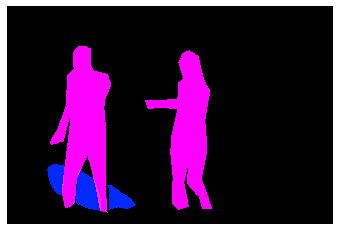

(427, 640, 3)
COCO_val2014_000000276057.jpg
{'person_bbx': [234.97, 192.94, 488.65, 329.13], 'Verbs': 'lay', 'object': {'obj_bbx': [18.93, 264.32, 389.79, 333.0]}}
person
bed
lay
lay interaction
{'person_bbx': [234.97, 192.94, 488.65, 329.13], 'Verbs': 'look', 'object': {'obj_bbx': [138.44, 203.54, 234.97, 300.82]}}
person
laptop
look
look interaction
{'person_bbx': [234.97, 192.94, 488.65, 329.13], 'Verbs': 'sit', 'object': {'obj_bbx': [18.93, 264.32, 389.79, 333.0]}}
person
bed
sit
sit interaction
{'person_bbx': [234.97, 192.94, 488.65, 329.13], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [138.44, 203.54, 234.97, 300.82]}}
person
laptop
work_on_computer
work_on_computer interaction


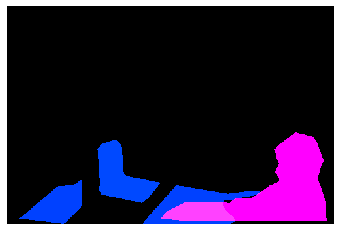

(333, 500, 3)
COCO_val2014_000000069411.jpg
{'person_bbx': [338.74, 152.59, 442.1, 253.10000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [201.41, 236.28, 319.71, 420.01], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [338.74, 152.59, 442.1, 253.10000000000002], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [201.41, 236.28, 319.71, 420.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


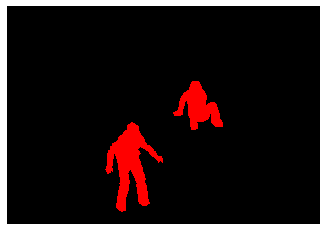

(445, 640, 3)
COCO_val2014_000000300330.jpg
{'person_bbx': [68.88, 32.29, 387.44, 400.36], 'Verbs': 'hold', 'object': {'obj_bbx': [306.98, 201.43, 505.32000000000005, 396.40999999999997]}}
person
laptop
hold
hold interaction
{'person_bbx': [68.88, 32.29, 387.44, 400.36], 'Verbs': 'look', 'object': {'obj_bbx': [306.98, 201.43, 505.32000000000005, 396.40999999999997]}}
person
laptop
look
look interaction
{'person_bbx': [68.88, 32.29, 387.44, 400.36], 'Verbs': 'sit', 'object': {'obj_bbx': [7.12, 259.79, 243.19, 470.36]}}
person
chair
sit
sit interaction
{'person_bbx': [68.88, 32.29, 387.44, 400.36], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [306.98, 201.43, 505.32000000000005, 396.40999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


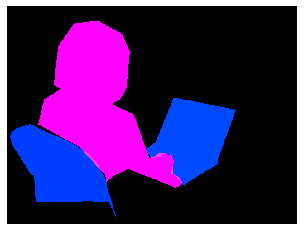

(480, 640, 3)
COCO_val2014_000000259097.jpg
{'person_bbx': [193.07, 142.93, 233.47, 257.42], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [193.07, 142.93, 233.47, 257.42], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [193.07, 142.93, 233.47, 257.42], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [193.07, 142.93, 233.47, 257.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


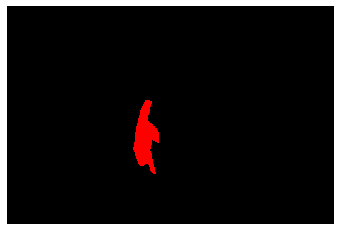

(333, 500, 3)
COCO_val2014_000000275448.jpg
{'person_bbx': [275.68, 136.0, 397.87, 276.77], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


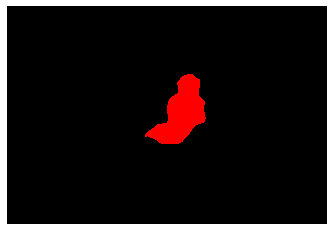

(436, 640, 3)
COCO_val2014_000000186443.jpg
{'person_bbx': [135.91, 112.31, 211.95999999999998, 314.56], 'Verbs': 'look', 'object': {'obj_bbx': [456.27, 203.06, 533.12, 267.78]}}
person
person
look
look interaction
{'person_bbx': [135.91, 112.31, 211.95999999999998, 314.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [135.91, 112.31, 211.95999999999998, 314.56], 'Verbs': 'surf', 'object': {'obj_bbx': [200.54, 288.4, 430.87, 335.91999999999996]}}
person
surfboard
surf
surf interaction


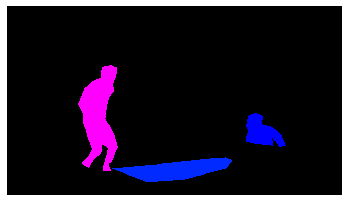

(360, 640, 3)
COCO_val2014_000000512902.jpg
{'person_bbx': [86.22, 81.27, 321.81, 630.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [86.22, 81.27, 321.81, 630.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [268.51, 87.36, 407.96, 639.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [86.22, 81.27, 321.81, 630.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [268.51, 87.36, 407.96, 639.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


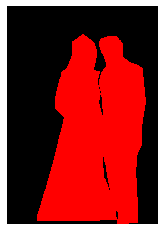

(640, 443, 3)
COCO_val2014_000000227851.jpg
{'person_bbx': [179.06, 103.55, 481.08, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [227.79, 171.08, 266.35, 212.62]}}
person
cell phone
hold
hold interaction
{'person_bbx': [179.06, 103.55, 481.08, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [201.72, 401.88, 231.77, 477.47]}}
person
chair
sit
sit interaction
{'person_bbx': [179.06, 103.55, 481.08, 474.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [227.79, 171.08, 266.35, 212.62]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


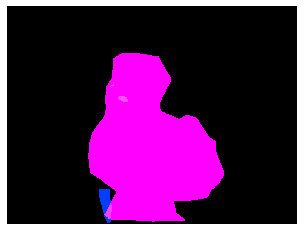

(480, 640, 3)
COCO_val2014_000000078429.jpg
{'person_bbx': [293.95, 242.4, 336.93, 304.97], 'Verbs': 'look', 'object': {'obj_bbx': [274.59, 288.92, 349.96, 315.32]}}
person
surfboard
look
look interaction
{'person_bbx': [293.95, 242.4, 336.93, 304.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.95, 242.4, 336.93, 304.97], 'Verbs': 'surf', 'object': {'obj_bbx': [274.59, 288.92, 349.96, 315.32]}}
person
surfboard
surf
surf interaction


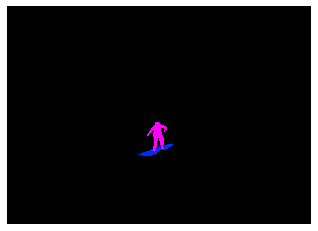

(458, 640, 3)
COCO_val2014_000000433554.jpg
{'person_bbx': [424.58, 127.23, 551.86, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [406.15, 173.97, 440.71999999999997, 231.34]}}
person
person
look
look interaction
{'person_bbx': [424.58, 127.23, 551.86, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


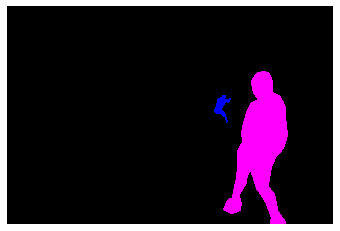

(427, 640, 3)
COCO_val2014_000000183127.jpg
{'person_bbx': [379.3, 180.95, 439.75, 243.22], 'Verbs': 'look', 'object': {'obj_bbx': [350.6, 218.86, 450.64000000000004, 262.78000000000003]}}
surfboard
person
look
look interaction
{'person_bbx': [379.3, 180.95, 439.75, 243.22], 'Verbs': 'surf', 'object': {'obj_bbx': [350.6, 218.86, 450.64000000000004, 262.78000000000003]}}
surfboard
person
surf
surf interaction


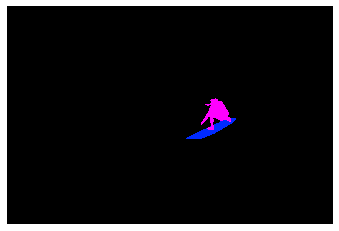

(428, 640, 3)
COCO_val2014_000000401828.jpg
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [258.67, 122.99, 271.17, 151.68]}}
cell phone
person
carry
carry interaction
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [313.13, 224.91, 351.56, 283.44]}}
person
cup
hold
hold interaction
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [258.67, 122.99, 271.17, 151.68]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [201.88, 64.57, 413.78, 630.1199999999999], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


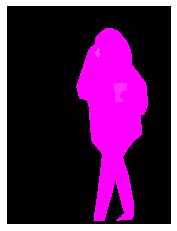

(640, 480, 3)
COCO_val2014_000000112769.jpg
{'person_bbx': [274.41, 85.75, 395.42, 374.45], 'Verbs': 'carry', 'object': {'obj_bbx': [355.99, 121.49, 373.31, 175.01999999999998]}}
person
backpack
carry
carry interaction
{'person_bbx': [360.16, 96.07, 468.78000000000003, 353.33], 'Verbs': 'hold', 'object': {'obj_bbx': [410.52, 233.25, 449.78, 270.38]}}
person
bottle
hold
hold interaction
{'person_bbx': [274.41, 85.75, 395.42, 374.45], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [274.41, 85.75, 395.42, 374.45], 'Verbs': 'look', 'object': {'obj_bbx': [362.07, 336.34, 496.40999999999997, 382.08]}}
person
skateboard
look
look interaction
{'person_bbx': [360.16, 96.07, 468.78000000000003, 353.33], 'Verbs': 'skateboard', 'object': {'obj_bbx': [362.07, 336.34, 496.40999999999997, 382.08]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [360.16, 96.07, 468.78000000000003, 353.33], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bb

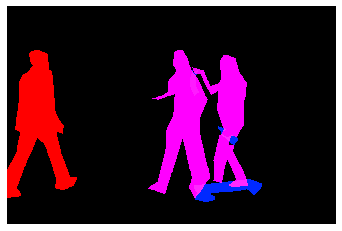

(424, 640, 3)
COCO_val2014_000000406294.jpg
{'person_bbx': [13.48, 0.0, 329.21000000000004, 493.26], 'Verbs': 'hold', 'object': {'obj_bbx': [156.7, 119.51, 199.70999999999998, 177.84]}}
cell phone
person
hold
hold interaction
{'person_bbx': [13.48, 0.0, 329.21000000000004, 493.26], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 347.23, 34.41, 500.0]}}
person
chair
sit
sit interaction
{'person_bbx': [13.48, 0.0, 329.21000000000004, 493.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [13.48, 0.0, 329.21000000000004, 493.26], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [156.7, 119.51, 199.70999999999998, 177.84]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


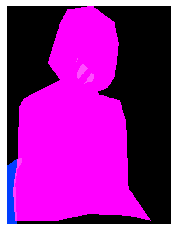

(500, 375, 3)
COCO_val2014_000000579655.jpg
{'person_bbx': [182.91, 1.79, 639.3, 393.62], 'Verbs': 'hold', 'object': {'obj_bbx': [279.11, 168.02, 335.52, 274.85]}}
cell phone
person
hold
hold interaction
{'person_bbx': [182.91, 1.79, 639.3, 393.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [182.91, 1.79, 639.3, 393.62], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [279.11, 168.02, 335.52, 274.85]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


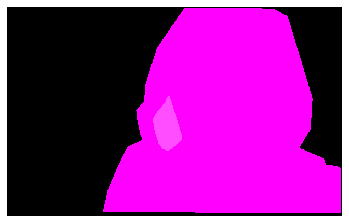

(399, 640, 3)
COCO_val2014_000000418523.jpg
{'person_bbx': [107.2, 281.83, 204.99, 551.63], 'Verbs': 'hold', 'object': {'obj_bbx': [128.0, 411.33, 225.8, 625.62]}}
person
bicycle
hold
hold interaction
{'person_bbx': [242.16, 218.58, 346.35, 539.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [107.2, 281.83, 204.99, 551.63], 'Verbs': 'ride', 'object': {'obj_bbx': [128.0, 411.33, 225.8, 625.62]}}
person
bicycle
ride
ride interaction
{'person_bbx': [107.2, 281.83, 204.99, 551.63], 'Verbs': 'sit', 'object': {'obj_bbx': [128.0, 411.33, 225.8, 625.62]}}
person
bicycle
sit
sit interaction
{'person_bbx': [107.2, 281.83, 204.99, 551.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [312.83, 181.67, 398.91999999999996, 530.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [242.16, 218.58, 346.35, 539.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [312.83, 181.67, 398.91999999999996,

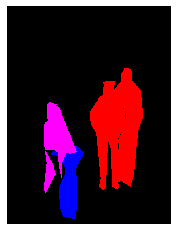

(640, 480, 3)
COCO_val2014_000000509028.jpg
{'person_bbx': [356.77, 122.69, 461.7, 353.53999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [342.0, 175.14, 398.0, 249.32999999999998]}}
handbag
person
carry
carry interaction
{'person_bbx': [566.31, 102.56, 623.4899999999999, 241.35], 'Verbs': 'carry', 'object': {'obj_bbx': [575.59, 125.3, 616.72, 171.4]}}
handbag
person
carry
carry interaction
{'person_bbx': [356.77, 122.69, 461.7, 353.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [342.0, 175.14, 398.0, 249.32999999999998]}}
handbag
person
hold
hold interaction
{'person_bbx': [566.31, 102.56, 623.4899999999999, 241.35], 'Verbs': 'hold', 'object': {'obj_bbx': [575.59, 125.3, 616.72, 171.4]}}
handbag
person
hold
hold interaction
{'person_bbx': [143.11, 193.78, 223.11, 355.56], 'Verbs': 'hold', 'object': {'obj_bbx': [145.93, 243.91, 159.78, 248.93]}}
cell phone
person
hold
hold interaction
{'person_bbx': [143.11, 193.78, 223.11, 355.56], 'Verbs': 'look', 'object': {'obj_bbx':

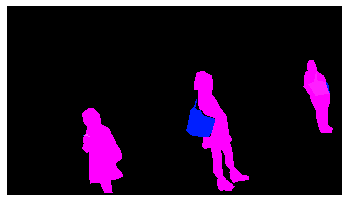

(360, 640, 3)
COCO_val2014_000000367095.jpg
{'person_bbx': [130.5, 118.02, 388.62, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [301.96, 272.94, 393.4, 309.11]}}
person
keyboard
hold
hold interaction
{'person_bbx': [130.5, 118.02, 388.62, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [348.05, 175.14, 443.68, 287.45]}}
person
tv
look
look interaction
{'person_bbx': [130.5, 118.02, 388.62, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [95.5, 279.16, 175.39, 427.0]}}
chair
person
sit
sit interaction
{'person_bbx': [130.5, 118.02, 388.62, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


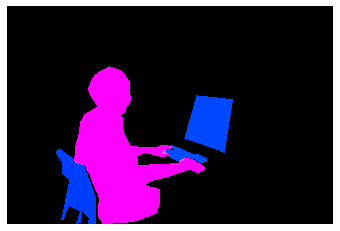

(427, 640, 3)
COCO_val2014_000000287586.jpg
{'person_bbx': [0.0, 116.23, 426.0, 632.83], 'Verbs': 'drink', 'object': {'obj_bbx': [44.76, 334.94, 238.32999999999998, 493.90999999999997]}}
person
wine glass
drink
drink interaction
{'person_bbx': [0.0, 116.23, 426.0, 632.83], 'Verbs': 'hold', 'object': {'obj_bbx': [44.76, 334.94, 238.32999999999998, 493.90999999999997]}}
person
wine glass
hold
hold interaction
{'person_bbx': [0.0, 116.23, 426.0, 632.83], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


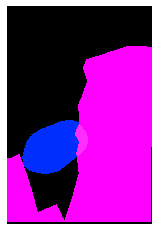

(640, 426, 3)
COCO_val2014_000000518383.jpg
{'person_bbx': [329.33, 118.33, 454.16999999999996, 422.90999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [329.58, 159.78, 419.9, 267.63]}}
person
backpack
carry
carry interaction
{'person_bbx': [329.33, 118.33, 454.16999999999996, 422.90999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [323.25, 365.08, 459.25, 455.64]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [329.33, 118.33, 454.16999999999996, 422.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


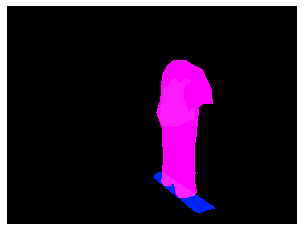

(480, 640, 3)
COCO_val2014_000000019402.jpg
{'person_bbx': [0.0, 52.85, 403.42, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [3.74, 304.21, 236.88, 472.52]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 52.85, 403.42, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [3.74, 304.21, 236.88, 472.52]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 52.85, 403.42, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [3.74, 304.21, 236.88, 472.52]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 52.85, 403.42, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [260.54, 0.54, 637.84, 475.14000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


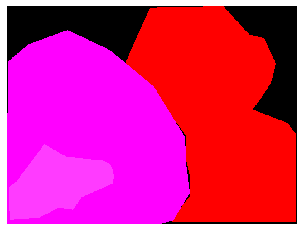

(480, 640, 3)
COCO_val2014_000000373266.jpg
{'person_bbx': [292.73, 174.33, 531.04, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [292.73, 174.33, 531.04, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [265.86, 178.25, 350.46000000000004, 282.98]}}
tv
person
look
look interaction
{'person_bbx': [292.73, 174.33, 531.04, 428.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


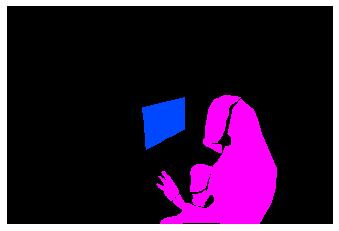

(428, 640, 3)
COCO_val2014_000000332990.jpg
{'person_bbx': [261.63, 137.04, 355.0, 230.41], 'Verbs': 'snowboard', 'object': {'obj_bbx': [289.98, 223.79, 342.83000000000004, 237.70999999999998]}}
person
snowboard
snowboard
snowboard interaction


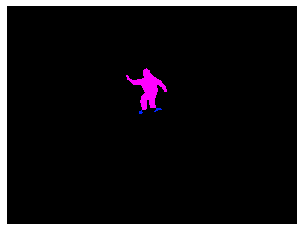

(480, 640, 3)
COCO_val2014_000000280607.jpg
{'person_bbx': [232.06, 262.0, 390.13, 369.62], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [235.96, 144.1, 298.31, 316.85]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [232.06, 262.0, 390.13, 369.62], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [42.23, 82.35, 416.39000000000004, 347.54999999999995]}}
pizza
person
cut_obj
cut_obj interaction
{'person_bbx': [232.06, 262.0, 390.13, 369.62], 'Verbs': 'hold', 'object': {'obj_bbx': [235.96, 144.1, 298.31, 316.85]}}
knife
person
hold
hold interaction


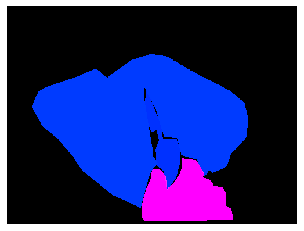

(375, 500, 3)
COCO_val2014_000000273728.jpg
{'person_bbx': [206.09, 9.72, 448.40999999999997, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [206.09, 9.72, 448.40999999999997, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


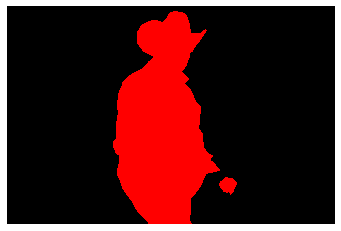

(425, 640, 3)
COCO_val2014_000000272153.jpg
{'person_bbx': [141.87, 159.17, 241.82, 384.07], 'Verbs': 'carry', 'object': {'obj_bbx': [134.51, 183.08, 189.95, 329.36]}}
person
surfboard
carry
carry interaction
{'person_bbx': [141.87, 159.17, 241.82, 384.07], 'Verbs': 'hold', 'object': {'obj_bbx': [134.51, 183.08, 189.95, 329.36]}}
person
surfboard
hold
hold interaction
{'person_bbx': [141.87, 159.17, 241.82, 384.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [141.87, 159.17, 241.82, 384.07], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


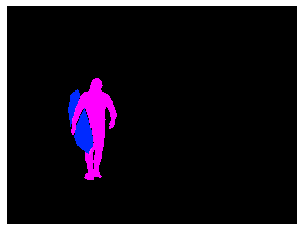

(480, 640, 3)
COCO_val2014_000000035705.jpg
{'person_bbx': [109.1, 0.27, 500.0, 304.21], 'Verbs': 'lay', 'object': {'obj_bbx': [1.61, 6.45, 370.97, 370.15999999999997]}}
couch
person
lay
lay interaction
{'person_bbx': [109.1, 0.27, 500.0, 304.21], 'Verbs': 'look', 'object': {'obj_bbx': [38.76, 290.59, 262.08, 375.0]}}
person
laptop
look
look interaction
{'person_bbx': [109.1, 0.27, 500.0, 304.21], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [38.76, 290.59, 262.08, 375.0]}}
person
laptop
work_on_computer
work_on_computer interaction


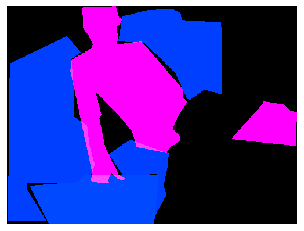

(375, 500, 3)
COCO_val2014_000000212166.jpg
{'person_bbx': [86.06, 13.41, 532.77, 410.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


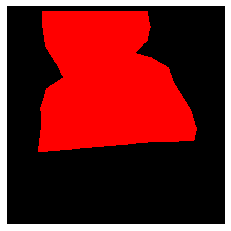

(612, 612, 3)
COCO_val2014_000000257870.jpg
{'person_bbx': [119.09, 60.81, 361.49, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [265.18, 271.88, 315.45, 337.43]}}
person
hot dog
hold
hold interaction
{'person_bbx': [119.09, 60.81, 361.49, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


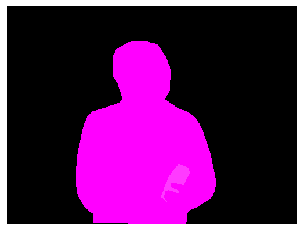

(375, 500, 3)
COCO_val2014_000000253960.jpg
{'person_bbx': [3.37, 23.98, 319.1, 318.76], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [0.0, 253.94, 375.0, 500.0]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [3.37, 23.98, 319.1, 318.76], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 171.91, 108.99, 265.17]}}
chair
person
sit
sit interaction
{'person_bbx': [3.37, 23.98, 319.1, 318.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


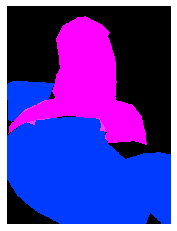

(500, 375, 3)
COCO_val2014_000000228071.jpg
{'person_bbx': [211.38, 200.91, 251.99, 328.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [170.74, 213.55, 301.77, 350.78]}}
horse
person
hold
hold interaction
{'person_bbx': [211.38, 200.91, 251.99, 328.09000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [170.74, 213.55, 301.77, 350.78]}}
horse
person
ride
ride interaction
{'person_bbx': [234.83, 209.8, 271.69, 310.47], 'Verbs': 'ride', 'object': {'obj_bbx': [170.74, 213.55, 301.77, 350.78]}}
horse
person
ride
ride interaction
{'person_bbx': [234.83, 209.8, 271.69, 310.47], 'Verbs': 'sit', 'object': {'obj_bbx': [170.74, 213.55, 301.77, 350.78]}}
horse
person
sit
sit interaction
{'person_bbx': [234.83, 209.8, 271.69, 310.47], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


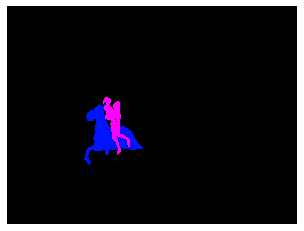

(480, 640, 3)
COCO_val2014_000000113282.jpg
{'person_bbx': [102.22, 252.64, 220.95999999999998, 473.54999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [76.22, 414.2, 201.35, 609.8]}}
suitcase
person
carry
carry interaction
{'person_bbx': [458.37, 258.83, 568.44, 615.5999999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [471.35, 460.54, 583.78, 614.77]}}
suitcase
person
carry
carry interaction
{'person_bbx': [311.43, 245.87, 417.22, 585.79], 'Verbs': 'carry', 'object': {'obj_bbx': [321.44, 483.6, 452.61, 633.51]}}
suitcase
person
carry
carry interaction
{'person_bbx': [102.22, 252.64, 220.95999999999998, 473.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [76.22, 414.2, 201.35, 609.8]}}
suitcase
person
hold
hold interaction
{'person_bbx': [458.37, 258.83, 568.44, 615.5999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [471.35, 460.54, 583.78, 614.77]}}
suitcase
person
hold
hold interaction
{'person_bbx': [311.43, 245.87, 417.22, 585.79], 'Verbs': 'hold', 'object': {'o

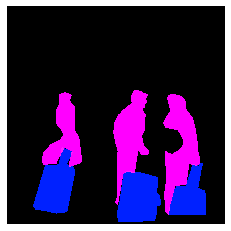

(640, 640, 3)
COCO_val2014_000000571059.jpg
{'person_bbx': [270.42, 196.27, 473.93, 254.36], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [191.56, 158.98, 284.15999999999997, 241.58999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [270.42, 196.27, 473.93, 254.36]}}
person
person
look
look interaction
{'person_bbx': [270.42, 196.27, 473.93, 254.36], 'Verbs': 'look', 'object': {'obj_bbx': [144.81, 171.38, 265.82, 257.09]}}
person
surfboard
look
look interaction
{'person_bbx': [270.42, 196.27, 473.93, 254.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [191.56, 158.98, 284.15999999999997, 241.58999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [144.81, 171.38, 265.82, 257.09]}}
person
surfboard
surf
surf interaction
{'person_bbx': [270.42, 196.27, 473.93, 254.36], 'Verbs': 'surf', 'object': {'obj_bbx': [335.11, 203.33, 542.64, 263.82]}}
person
surfboard
surf
surf interaction


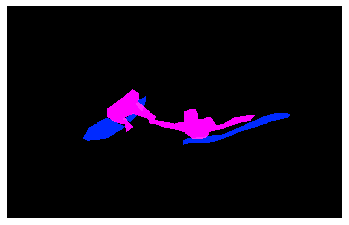

(404, 640, 3)
COCO_val2014_000000437664.jpg
{'person_bbx': [130.66, 219.25, 473.66999999999996, 298.81], 'Verbs': 'lay', 'object': {'obj_bbx': [4.5, 229.17, 494.37, 377.82]}}
bed
person
lay
lay interaction


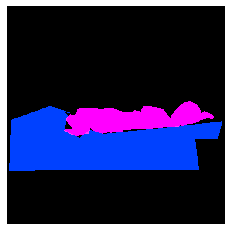

(500, 500, 3)
COCO_val2014_000000162703.jpg
{'person_bbx': [285.62, 212.61, 341.68, 303.25], 'Verbs': 'surf', 'object': {'obj_bbx': [325.29, 300.57, 359.63, 331.02]}}
person
surfboard
surf
surf interaction


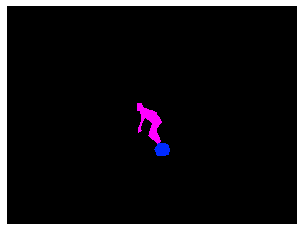

(480, 640, 3)
COCO_val2014_000000393089.jpg
{'person_bbx': [7.95, 17.49, 602.46, 454.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [7.95, 17.49, 602.46, 454.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


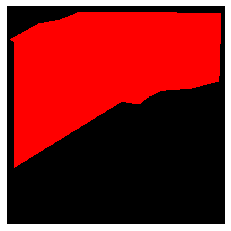

(612, 612, 3)
COCO_val2014_000000059201.jpg
{'person_bbx': [151.37, 60.44, 640.0, 473.2], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [120.81, 208.18, 341.93, 307.42]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [151.37, 60.44, 640.0, 473.2], 'Verbs': 'hold', 'object': {'obj_bbx': [120.81, 208.18, 341.93, 307.42]}}
person
pizza
hold
hold interaction
{'person_bbx': [151.37, 60.44, 640.0, 473.2], 'Verbs': 'look', 'object': {'obj_bbx': [120.81, 208.18, 341.93, 307.42]}}
person
pizza
look
look interaction


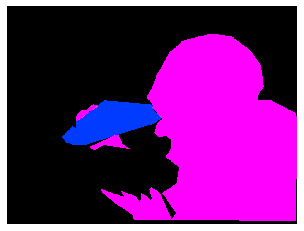

(480, 640, 3)
COCO_val2014_000000246436.jpg
{'person_bbx': [0.0, 4.43, 402.33, 632.9799999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [263.1, 471.91, 431.06000000000006, 559.96]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 4.43, 402.33, 632.9799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 4.43, 402.33, 632.9799999999999], 'Verbs': 'look', 'object': {'obj_bbx': [263.1, 471.91, 431.06000000000006, 559.96]}}
person
pizza
look
look interaction
{'person_bbx': [0.0, 4.43, 402.33, 632.9799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


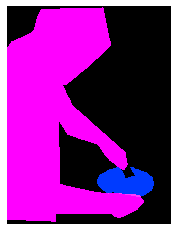

(640, 480, 3)
COCO_val2014_000000410638.jpg
{'person_bbx': [192.6, 221.05, 277.45, 405.14], 'Verbs': 'hold', 'object': {'obj_bbx': [220.38, 257.99, 324.76, 464.17]}}
person
person
hold
hold interaction
{'person_bbx': [220.38, 257.99, 324.76, 464.17], 'Verbs': 'hold', 'object': {'obj_bbx': [291.54, 338.28, 315.36, 361.34999999999997]}}
sports ball
person
hold
hold interaction
{'person_bbx': [123.32, 220.59, 218.66, 482.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [152.15, 338.43, 232.28, 470.59000000000003]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [192.6, 221.05, 277.45, 405.14], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [192.6, 221.05, 277.45, 405.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [220.38, 257.99, 324.76, 464.17], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [123.32, 220.59, 218.66, 482.90999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smil

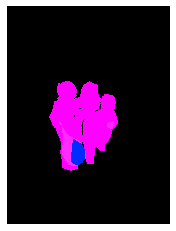

(640, 478, 3)
COCO_val2014_000000556216.jpg
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [177.78, 344.14, 248.41, 441.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [453.8, 10.88, 466.02000000000004, 21.62]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'hold', 'object': {'obj_bbx': [177.78, 344.14, 248.41, 441.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'look', 'object': {'obj_bbx': [453.8, 10.88, 466.02000000000004, 21.62]}}
person
sports ball
look
look interaction
{'person_bbx': [2.31, 269.06, 207.17000000000002, 594.11], 'Verbs': 'run', 'object': {'obj_bbx': []

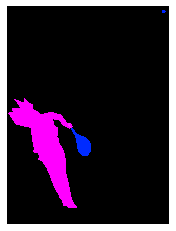

(640, 476, 3)
COCO_val2014_000000254167.jpg
{'person_bbx': [40.45, 85.39, 375.0, 492.13], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [130.34, 167.42, 321.35, 360.66999999999996]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [40.45, 85.39, 375.0, 492.13], 'Verbs': 'hold', 'object': {'obj_bbx': [130.34, 167.42, 321.35, 360.66999999999996]}}
person
scissors
hold
hold interaction
{'person_bbx': [40.45, 85.39, 375.0, 492.13], 'Verbs': 'look', 'object': {'obj_bbx': [130.34, 167.42, 321.35, 360.66999999999996]}}
person
scissors
look
look interaction
{'person_bbx': [40.45, 85.39, 375.0, 492.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [40.45, 85.39, 375.0, 492.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


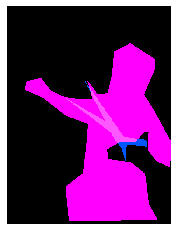

(500, 375, 3)
COCO_val2014_000000176312.jpg
{'person_bbx': [210.1, 12.31, 480.53999999999996, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [209.64, 223.25, 239.98999999999998, 261.88]}}
cell phone
person
hold
hold interaction
{'person_bbx': [210.1, 12.31, 480.53999999999996, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [209.64, 223.25, 239.98999999999998, 261.88]}}
cell phone
person
look
look interaction
{'person_bbx': [210.1, 12.31, 480.53999999999996, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


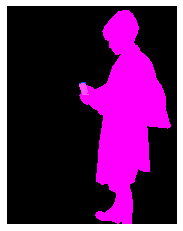

(640, 498, 3)
COCO_val2014_000000332845.jpg
{'person_bbx': [312.64, 130.94, 456.05999999999995, 314.12], 'Verbs': 'look', 'object': {'obj_bbx': [279.37, 239.46, 327.91, 286.92]}}
person
laptop
look
look interaction
{'person_bbx': [312.64, 130.94, 456.05999999999995, 314.12], 'Verbs': 'sit', 'object': {'obj_bbx': [391.23, 262.19, 480.0, 317.94]}}
chair
person
sit
sit interaction
{'person_bbx': [312.64, 130.94, 456.05999999999995, 314.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [279.37, 239.46, 327.91, 286.92]}}
person
laptop
work_on_computer
work_on_computer interaction


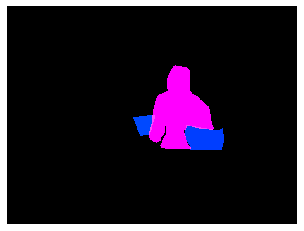

(480, 640, 3)
COCO_val2014_000000129659.jpg
{'person_bbx': [108.24, 8.33, 453.8, 371.91999999999996], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [225.72, 120.26, 316.15, 201.25]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [108.24, 8.33, 453.8, 371.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [225.72, 120.26, 316.15, 201.25]}}
person
spoon
hold
hold interaction
{'person_bbx': [108.24, 8.33, 453.8, 371.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [225.72, 120.26, 316.15, 201.25]}}
person
spoon
look
look interaction
{'person_bbx': [108.24, 8.33, 453.8, 371.91999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


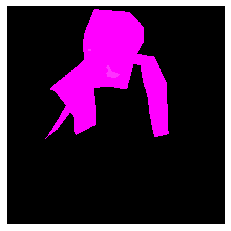

(612, 612, 3)
COCO_val2014_000000325228.jpg
{'person_bbx': [32.23, 83.56, 188.6, 461.96], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [160.79, 23.82, 244.16, 139.35]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [452.99, 96.81, 590.1800000000001, 491.61], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [398.67, 81.89, 547.12, 267.07]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [32.23, 83.56, 188.6, 461.96], 'Verbs': 'hold', 'object': {'obj_bbx': [160.79, 23.82, 244.16, 139.35]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [452.99, 96.81, 590.1800000000001, 491.61], 'Verbs': 'hold', 'object': {'obj_bbx': [398.67, 81.89, 547.12, 267.07]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [32.23, 83.56, 188.6, 461.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [452.99, 96.81, 590.1800000000001, 491.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


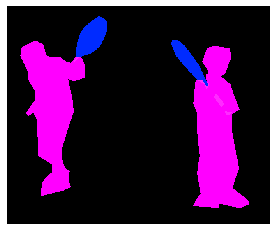

(530, 640, 3)
COCO_val2014_000000153803.jpg
{'person_bbx': [223.92, 130.06, 499.19999999999993, 463.22], 'Verbs': 'look', 'object': {'obj_bbx': [243.37, 220.8, 329.57, 293.61]}}
person
laptop
look
look interaction
{'person_bbx': [223.92, 130.06, 499.19999999999993, 463.22], 'Verbs': 'sit', 'object': {'obj_bbx': [481.03, 277.53, 512.25, 326.46999999999997]}}
person
chair
sit
sit interaction
{'person_bbx': [223.92, 130.06, 499.19999999999993, 463.22], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [243.37, 220.8, 329.57, 293.61]}}
person
laptop
work_on_computer
work_on_computer interaction


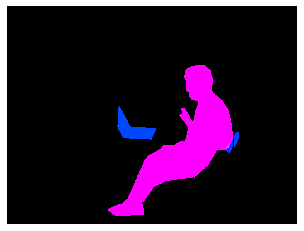

(480, 640, 3)
COCO_val2014_000000544574.jpg
{'person_bbx': [241.56, 172.17, 312.48, 280.85], 'Verbs': 'look', 'object': {'obj_bbx': [196.77, 259.56, 287.95000000000005, 294.1]}}
person
surfboard
look
look interaction
{'person_bbx': [241.56, 172.17, 312.48, 280.85], 'Verbs': 'surf', 'object': {'obj_bbx': [204.03, 263.19, 271.68, 285.74]}}
person
surfboard
surf
surf interaction


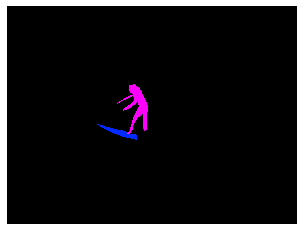

(480, 640, 3)
COCO_val2014_000000555144.jpg
{'person_bbx': [386.77, 53.81, 474.21999999999997, 305.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [429.24, 157.3, 445.33, 168.81]}}
person
remote
hold
hold interaction
{'person_bbx': [46.98, 61.8, 120.81, 243.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [386.77, 53.81, 474.21999999999997, 305.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [145.67, 100.56, 218.71999999999997, 290.78]}}
person
tv
look
look interaction
{'person_bbx': [46.98, 61.8, 120.81, 243.01], 'Verbs': 'look', 'object': {'obj_bbx': [145.67, 100.56, 218.71999999999997, 290.78]}}
person
tv
look
look interaction
{'person_bbx': [386.77, 53.81, 474.21999999999997, 305.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [46.98, 61.8, 120.81, 243.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


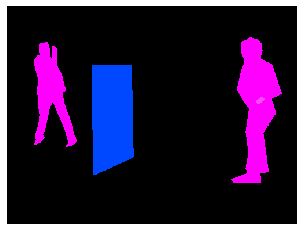

(375, 500, 3)
COCO_val2014_000000025096.jpg
{'person_bbx': [1.12, 37.08, 212.36, 328.09], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [39.31, 310.6, 143.99, 386.06]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.12, 37.08, 212.36, 328.09], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [101.22, 277.25, 326.24, 409.7]}}
person
skateboard
cut_obj
cut_obj interaction
{'person_bbx': [1.12, 37.08, 212.36, 328.09], 'Verbs': 'hold', 'object': {'obj_bbx': [39.31, 310.6, 143.99, 386.06]}}
person
knife
hold
hold interaction
{'person_bbx': [1.12, 37.08, 212.36, 328.09], 'Verbs': 'look', 'object': {'obj_bbx': [101.22, 277.25, 326.24, 409.7]}}
person
skateboard
look
look interaction
{'person_bbx': [1.12, 37.08, 212.36, 328.09], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 213.19, 33.04, 252.63]}}
person
chair
sit
sit interaction


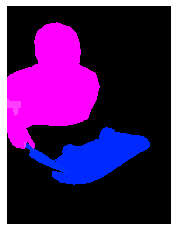

(500, 375, 3)
COCO_val2014_000000532690.jpg
{'person_bbx': [58.97, 40.27, 500.49, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [64.65, 494.57, 113.49000000000001, 591.02]}}
person
remote
hold
hold interaction
{'person_bbx': [58.97, 40.27, 500.49, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [58.97, 40.27, 500.49, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


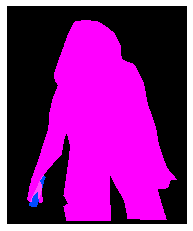

(640, 528, 3)
COCO_val2014_000000117508.jpg
{'person_bbx': [218.31, 33.6, 378.21000000000004, 371.6], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [218.31, 33.6, 378.21000000000004, 371.6], 'Verbs': 'snowboard', 'object': {'obj_bbx': [167.06, 340.1, 391.17, 389.39000000000004]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [218.31, 33.6, 378.21000000000004, 371.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


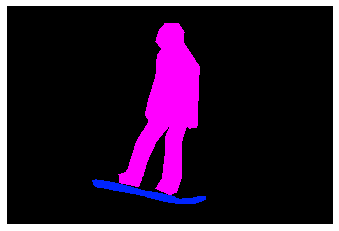

(428, 640, 3)
COCO_val2014_000000160607.jpg
{'person_bbx': [141.94, 365.04, 478.18, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': [25.94, 244.71, 102.25, 295.24]}}
frisbee
person
catch
catch interaction
{'person_bbx': [141.94, 365.04, 478.18, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [25.94, 244.71, 102.25, 295.24]}}
frisbee
person
look
look interaction
{'person_bbx': [141.94, 365.04, 478.18, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


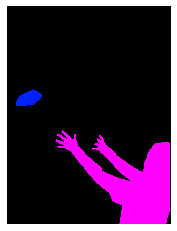

(640, 480, 3)
COCO_val2014_000000025143.jpg
{'person_bbx': [165.0, 71.86, 235.24, 212.95999999999998], 'Verbs': 'catch', 'object': {'obj_bbx': [152.66, 56.39, 173.29, 73.58]}}
person
frisbee
catch
catch interaction
{'person_bbx': [277.33, 99.95, 353.92999999999995, 210.95], 'Verbs': 'catch', 'object': {'obj_bbx': [264.31, 122.77, 278.76, 139.24]}}
person
frisbee
catch
catch interaction
{'person_bbx': [389.41, 98.21, 436.43, 221.14999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [165.0, 71.86, 235.24, 212.95999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [152.66, 56.39, 173.29, 73.58]}}
person
frisbee
hold
hold interaction
{'person_bbx': [277.33, 99.95, 353.92999999999995, 210.95], 'Verbs': 'hold', 'object': {'obj_bbx': [264.31, 122.77, 278.76, 139.24]}}
person
frisbee
hold
hold interaction
{'person_bbx': [165.0, 71.86, 235.24, 212.95999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [165.0, 71.86, 235.24, 212

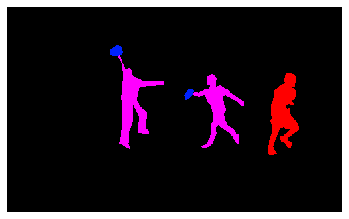

(306, 500, 3)
COCO_val2014_000000171622.jpg
{'person_bbx': [125.53, 157.51, 234.56, 360.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [75.43, 353.58, 279.36, 374.66999999999996]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [125.53, 157.51, 234.56, 360.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


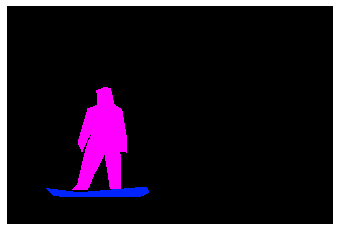

(427, 640, 3)
COCO_val2014_000000476349.jpg
{'person_bbx': [194.39, 139.14, 315.25, 274.29999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [194.39, 139.14, 315.25, 274.29999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [141.8, 219.86, 364.77, 273.95000000000005]}}
person
snowboard
snowboard
snowboard interaction


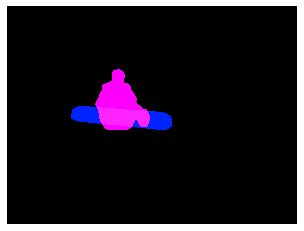

(480, 640, 3)
COCO_val2014_000000314193.jpg
{'person_bbx': [150.73, 169.38, 317.72, 545.13], 'Verbs': 'hold', 'object': {'obj_bbx': [206.43, 321.78, 309.27, 364.32]}}
person
book
hold
hold interaction
{'person_bbx': [150.73, 169.38, 317.72, 545.13], 'Verbs': 'look', 'object': {'obj_bbx': [206.43, 321.78, 309.27, 364.32]}}
person
book
look
look interaction
{'person_bbx': [150.73, 169.38, 317.72, 545.13], 'Verbs': 'read', 'object': {'obj_bbx': [206.43, 321.78, 309.27, 364.32]}}
person
book
read
read interaction
{'person_bbx': [150.73, 169.38, 317.72, 545.13], 'Verbs': 'sit', 'object': {'obj_bbx': [2.26, 276.22, 466.49, 551.6800000000001]}}
person
bench
sit
sit interaction


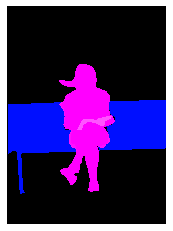

(640, 467, 3)
COCO_val2014_000000514083.jpg
{'person_bbx': [166.11, 35.67, 341.93, 402.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [166.11, 35.67, 341.93, 402.41], 'Verbs': 'skateboard', 'object': {'obj_bbx': [179.68, 392.73, 302.89, 426.1]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [166.11, 35.67, 341.93, 402.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [166.11, 35.67, 341.93, 402.41], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [313.25, 90.89, 320.54, 99.43]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


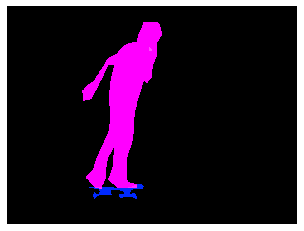

(480, 640, 3)
COCO_val2014_000000330699.jpg
{'person_bbx': [171.39, 239.92, 376.72, 399.75], 'Verbs': 'jump', 'object': {'obj_bbx': [158.16, 297.06, 268.18, 468.97]}}
person
surfboard
jump
jump interaction
{'person_bbx': [171.39, 239.92, 376.72, 399.75], 'Verbs': 'look', 'object': {'obj_bbx': [158.16, 297.06, 268.18, 468.97]}}
person
surfboard
look
look interaction
{'person_bbx': [171.39, 239.92, 376.72, 399.75], 'Verbs': 'surf', 'object': {'obj_bbx': [158.16, 297.06, 268.18, 468.97]}}
person
surfboard
surf
surf interaction


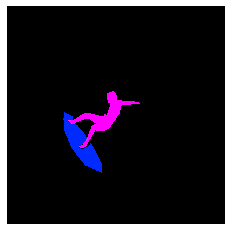

(612, 612, 3)
COCO_val2014_000000185015.jpg
{'person_bbx': [41.71, 89.17, 471.72999999999996, 631.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [279.01, 320.72, 444.4, 425.71000000000004]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [41.71, 89.17, 471.72999999999996, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [279.01, 320.72, 444.4, 425.71000000000004]}}
person
pizza
hold
hold interaction
{'person_bbx': [41.71, 89.17, 471.72999999999996, 631.37], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [41.71, 89.17, 471.72999999999996, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': [346.67, 136.67, 480.0, 378.33]}}
person
chair
sit
sit interaction
{'person_bbx': [41.71, 89.17, 471.72999999999996, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


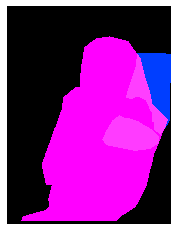

(640, 480, 3)
COCO_val2014_000000507663.jpg
{'person_bbx': [128.92, 55.43, 231.95999999999998, 350.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [128.92, 55.43, 231.95999999999998, 350.09000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [128.92, 55.43, 231.95999999999998, 350.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [128.92, 55.43, 231.95999999999998, 350.09000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [370.68, 6.3, 407.25, 19.88]}}
person
frisbee
throw
throw interaction


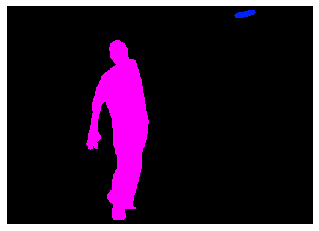

(356, 500, 3)
COCO_val2014_000000350840.jpg
{'person_bbx': [248.49, 156.38, 334.21000000000004, 256.6], 'Verbs': 'look', 'object': {'obj_bbx': [267.53, 233.99, 331.89, 270.18]}}
surfboard
person
look
look interaction
{'person_bbx': [248.49, 156.38, 334.21000000000004, 256.6], 'Verbs': 'surf', 'object': {'obj_bbx': [267.53, 233.99, 331.89, 270.18]}}
surfboard
person
surf
surf interaction


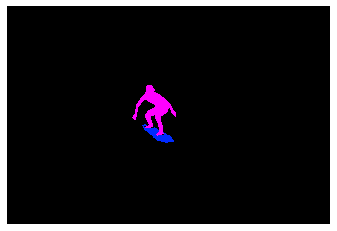

(431, 640, 3)
COCO_val2014_000000438955.jpg
{'person_bbx': [62.4, 130.74, 133.91, 231.18], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [518.82, 87.71, 600.0300000000001, 217.51], 'Verbs': 'ski', 'object': {'obj_bbx': [503.64, 212.77, 624.0, 220.87]}}
person
skis
ski
ski interaction
{'person_bbx': [183.75, 118.0, 237.7, 231.24], 'Verbs': 'ski', 'object': {'obj_bbx': [127.04, 231.93, 264.01, 241.85]}}
person
skis
ski
ski interaction
{'person_bbx': [62.4, 130.74, 133.91, 231.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [329.55, 104.4, 435.96000000000004, 227.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [518.82, 87.71, 600.0300000000001, 217.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [493.36, 92.18, 558.26, 208.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [183.75, 118.0, 237.7, 231.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pe

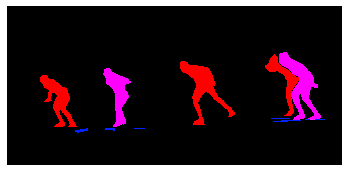

(303, 640, 3)
COCO_val2014_000000209904.jpg
{'person_bbx': [310.51, 76.75, 435.37, 241.79], 'Verbs': 'jump', 'object': {'obj_bbx': [386.8, 233.21, 428.83000000000004, 255.72]}}
skateboard
person
jump
jump interaction
{'person_bbx': [601.53, 103.98, 640.0, 350.54], 'Verbs': 'look', 'object': {'obj_bbx': [386.8, 233.21, 428.83000000000004, 255.72]}}
skateboard
person
look
look interaction
{'person_bbx': [310.51, 76.75, 435.37, 241.79], 'Verbs': 'look', 'object': {'obj_bbx': [386.8, 233.21, 428.83000000000004, 255.72]}}
skateboard
person
look
look interaction
{'person_bbx': [551.51, 149.67, 595.39, 304.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [310.51, 76.75, 435.37, 241.79]}}
person
person
look
look interaction
{'person_bbx': [458.59, 238.0, 526.96, 346.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [310.51, 76.75, 435.37, 241.79], 'Verbs': 'skateboard', 'object': {'obj_bbx': [386.8, 233.21, 428.83000000000004, 255.72]}}
skateboard
person
skateboa

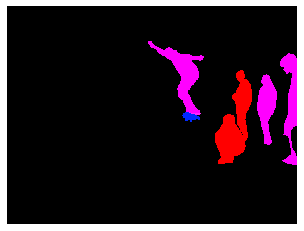

(480, 640, 3)
COCO_val2014_000000175825.jpg
{'person_bbx': [393.01, 129.88, 485.63, 304.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [393.01, 129.88, 485.63, 304.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [393.01, 129.88, 485.63, 304.64], 'Verbs': 'surf', 'object': {'obj_bbx': [324.23, 271.8, 503.81000000000006, 331.66]}}
person
surfboard
surf
surf interaction


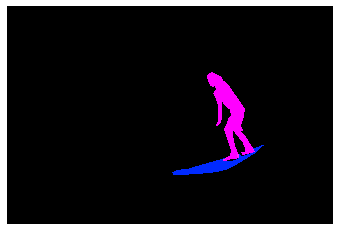

(427, 640, 3)
COCO_val2014_000000157001.jpg
{'person_bbx': [201.71, 1.08, 593.26, 282.60999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [164.32, 276.22, 637.8399999999999, 472.97]}}
person
laptop
look
look interaction
{'person_bbx': [201.71, 1.08, 593.26, 282.60999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 62.98, 187.27, 433.64000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [201.71, 1.08, 593.26, 282.60999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [164.32, 276.22, 637.8399999999999, 472.97]}}
person
laptop
work_on_computer
work_on_computer interaction


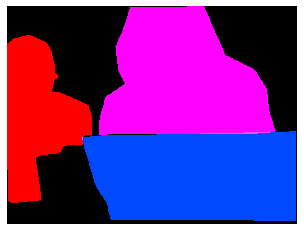

(480, 640, 3)
COCO_val2014_000000222625.jpg
{'person_bbx': [82.38, 28.2, 640.0, 559.25], 'Verbs': 'sit', 'object': {'obj_bbx': [52.22, 254.36, 163.13, 544.53]}}
person
chair
sit
sit interaction
{'person_bbx': [82.38, 28.2, 640.0, 559.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


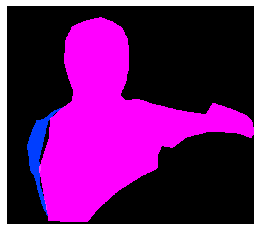

(564, 640, 3)
COCO_val2014_000000074462.jpg
{'person_bbx': [271.98, 191.83, 357.19, 378.27], 'Verbs': 'kick', 'object': {'obj_bbx': [87.03, 343.05, 118.29, 374.32]}}
sports ball
person
kick
kick interaction
{'person_bbx': [144.78, 213.66, 232.43, 354.03], 'Verbs': 'kick', 'object': {'obj_bbx': [87.03, 343.05, 118.29, 374.32]}}
sports ball
person
kick
kick interaction
{'person_bbx': [513.84, 213.77, 583.5400000000001, 373.27], 'Verbs': 'look', 'object': {'obj_bbx': [87.03, 343.05, 118.29, 374.32]}}
sports ball
person
look
look interaction
{'person_bbx': [271.98, 191.83, 357.19, 378.27], 'Verbs': 'look', 'object': {'obj_bbx': [87.03, 343.05, 118.29, 374.32]}}
sports ball
person
look
look interaction
{'person_bbx': [144.78, 213.66, 232.43, 354.03], 'Verbs': 'look', 'object': {'obj_bbx': [87.03, 343.05, 118.29, 374.32]}}
sports ball
person
look
look interaction
{'person_bbx': [513.84, 213.77, 583.5400000000001, 373.27], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [

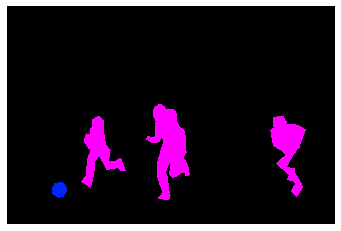

(425, 640, 3)
COCO_val2014_000000246589.jpg
{'person_bbx': [0.0, 211.42, 375.37, 631.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [232.9, 375.51, 287.16, 462.32]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 211.42, 375.37, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [232.9, 375.51, 287.16, 462.32]}}
person
sandwich
hold
hold interaction
{'person_bbx': [0.0, 211.42, 375.37, 631.37], 'Verbs': 'look', 'object': {'obj_bbx': [232.9, 375.51, 287.16, 462.32]}}
person
sandwich
look
look interaction


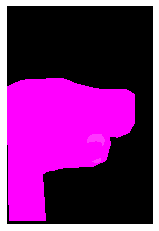

(640, 427, 3)
COCO_val2014_000000530998.jpg
{'person_bbx': [0.0, 111.82, 162.17, 425.67], 'Verbs': 'look', 'object': {'obj_bbx': [487.71, 89.3, 551.03, 107.00999999999999]}}
frisbee
person
look
look interaction
{'person_bbx': [0.0, 111.82, 162.17, 425.67], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 111.82, 162.17, 425.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 111.82, 162.17, 425.67], 'Verbs': 'throw', 'object': {'obj_bbx': [487.71, 89.3, 551.03, 107.00999999999999]}}
frisbee
person
throw
throw interaction


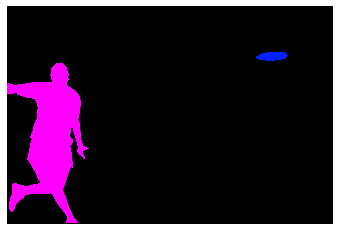

(427, 640, 3)
COCO_val2014_000000170292.jpg
{'person_bbx': [126.58, 96.43, 272.27, 382.51], 'Verbs': 'hold', 'object': {'obj_bbx': [160.98, 174.27, 209.10999999999999, 210.59]}}
sports ball
person
hold
hold interaction
{'person_bbx': [180.08, 85.75, 575.5, 379.22], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [180.08, 85.75, 575.5, 379.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [404.72, 90.35, 640.0, 376.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [180.08, 85.75, 575.5, 379.22]}}
person
person
look
look interaction
{'person_bbx': [0.0, 46.69, 104.81, 414.46999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [126.58, 96.43, 272.27, 382.51]}}
person
person
look
look interaction
{'person_bbx': [126.58, 96.43, 272.27, 382.51], 'Verbs': 'look', 'object': {'obj_bbx': [180.08, 85.75, 575.5, 379.22]}}
person
person
look
look interaction
{'person_bbx': [180.08, 85.75, 575.5, 379.22], 'Verbs': 'run', 'object': {'obj_bbx': [

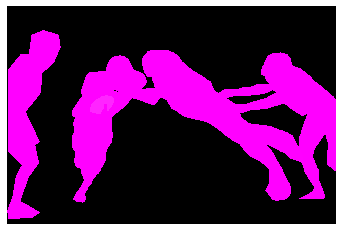

(424, 640, 3)
COCO_val2014_000000120792.jpg
{'person_bbx': [325.02, 132.38, 537.04, 474.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [473.53, 165.03, 640.0, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [515.05, 252.08, 527.1099999999999, 266.86]}}
person
remote
hold
hold interaction
{'person_bbx': [325.02, 132.38, 537.04, 474.62], 'Verbs': 'look', 'object': {'obj_bbx': [30.2, 172.58, 245.92999999999998, 422.83000000000004]}}
tv
person
look
look interaction
{'person_bbx': [473.53, 165.03, 640.0, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [30.2, 172.58, 245.92999999999998, 422.83000000000004]}}
tv
person
look
look interaction
{'person_bbx': [325.02, 132.38, 537.04, 474.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [473.53, 165.03, 640.0, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


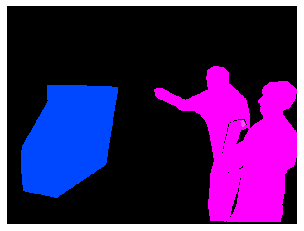

(480, 640, 3)
COCO_val2014_000000223699.jpg
{'person_bbx': [0.0, 35.5, 248.52, 422.2], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [276.12, 398.25, 332.92, 426.65]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 35.5, 248.52, 422.2], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [218.28, 342.71, 293.83, 406.71]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [375.25, 99.53, 581.13, 384.87], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [402.53, 176.99, 435.32, 222.46]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 35.5, 248.52, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [218.28, 342.71, 293.83, 406.71]}}
person
fork
hold
hold interaction
{'person_bbx': [375.25, 99.53, 581.13, 384.87], 'Verbs': 'hold', 'object': {'obj_bbx': [402.53, 176.99, 435.32, 222.46]}}
donut
person
hold
hold interaction
{'person_bbx': [375.25, 99.53, 581.13, 384.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [375.25, 99.53, 581.13, 384.87], 'Verbs

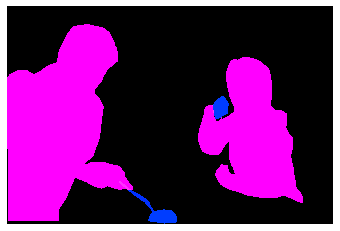

(427, 640, 3)
COCO_val2014_000000476838.jpg
{'person_bbx': [149.12, 7.62, 491.97, 213.33], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [56.24, 209.24, 171.33, 265.62]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [149.12, 7.62, 491.97, 213.33], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [0.0, 147.48, 611.81, 473.28]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [149.12, 7.62, 491.97, 213.33], 'Verbs': 'hold', 'object': {'obj_bbx': [56.24, 209.24, 171.33, 265.62]}}
person
knife
hold
hold interaction
{'person_bbx': [149.12, 7.62, 491.97, 213.33], 'Verbs': 'look', 'object': {'obj_bbx': [2.26, 133.55, 640.0, 476.89]}}
dining table
person
look
look interaction
{'person_bbx': [149.12, 7.62, 491.97, 213.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


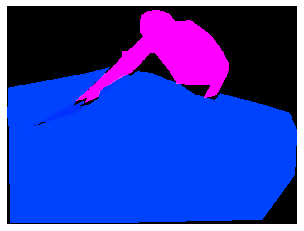

(480, 640, 3)
COCO_val2014_000000341818.jpg
{'person_bbx': [121.72, 29.18, 354.33000000000004, 300.97], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [243.47, 252.47, 288.77, 288.0]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [121.72, 29.18, 354.33000000000004, 300.97], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [121.72, 29.18, 354.33000000000004, 300.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


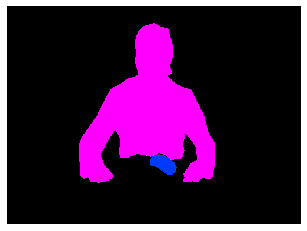

(371, 500, 3)
COCO_val2014_000000350668.jpg
{'person_bbx': [192.42, 139.77, 297.71999999999997, 340.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [192.42, 139.77, 297.71999999999997, 340.8], 'Verbs': 'ski', 'object': {'obj_bbx': [245.35, 309.71, 334.97, 347.10999999999996]}}
person
skis
ski
ski interaction


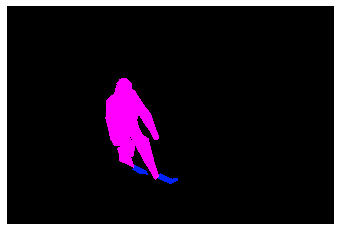

(426, 640, 3)
COCO_val2014_000000043555.jpg
{'person_bbx': [363.39, 80.82, 475.78999999999996, 255.93], 'Verbs': 'jump', 'object': {'obj_bbx': [353.04, 220.82, 416.47, 264.44]}}
skateboard
person
jump
jump interaction
{'person_bbx': [363.39, 80.82, 475.78999999999996, 255.93], 'Verbs': 'look', 'object': {'obj_bbx': [353.04, 220.82, 416.47, 264.44]}}
skateboard
person
look
look interaction
{'person_bbx': [363.39, 80.82, 475.78999999999996, 255.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': [353.04, 220.82, 416.47, 264.44]}}
skateboard
person
skateboard
skateboard interaction


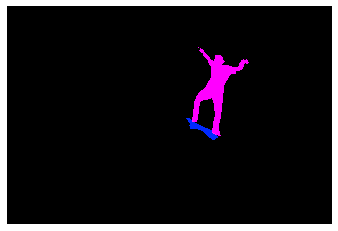

(429, 640, 3)
COCO_val2014_000000232972.jpg
{'person_bbx': [0.86, 300.63, 315.56, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [97.44, 372.34, 138.91, 410.92999999999995]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.86, 300.63, 315.56, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.86, 300.63, 315.56, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.86, 300.63, 315.56, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [97.44, 372.34, 138.91, 410.92999999999995]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


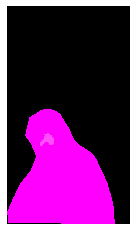

(640, 360, 3)
COCO_val2014_000000531126.jpg
{'person_bbx': [357.76, 113.0, 490.47, 418.83], 'Verbs': 'look', 'object': {'obj_bbx': [340.21, 369.38, 378.39, 407.08]}}
person
sports ball
look
look interaction
{'person_bbx': [0.96, 104.59, 62.37, 422.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [340.21, 369.38, 378.39, 407.08]}}
person
sports ball
look
look interaction
{'person_bbx': [44.39, 149.27, 129.28, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [340.21, 369.38, 378.39, 407.08]}}
person
sports ball
look
look interaction
{'person_bbx': [99.94, 146.6, 166.44, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [340.21, 369.38, 378.39, 407.08]}}
person
sports ball
look
look interaction
{'person_bbx': [196.98, 144.82, 258.28999999999996, 399.1], 'Verbs': 'look', 'object': {'obj_bbx': [340.21, 369.38, 378.39, 407.08]}}
sports ball
person
look
look interaction
{'person_bbx': [357.76, 113.0, 490.47, 418.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [

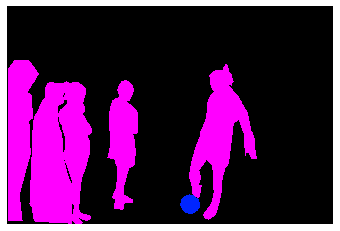

(427, 640, 3)
COCO_val2014_000000262235.jpg
{'person_bbx': [127.65, 248.71, 385.70000000000005, 639.4], 'Verbs': 'hold', 'object': {'obj_bbx': [218.77, 314.9, 238.10000000000002, 379.03999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [127.65, 248.71, 385.70000000000005, 639.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [127.65, 248.71, 385.70000000000005, 639.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [127.65, 248.71, 385.70000000000005, 639.4], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [218.77, 314.9, 238.10000000000002, 379.03999999999996]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


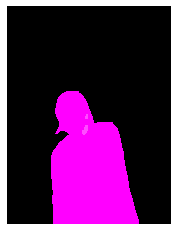

(640, 480, 3)
COCO_val2014_000000392998.jpg
{'person_bbx': [350.46, 115.92, 484.36, 189.78], 'Verbs': 'surf', 'object': {'obj_bbx': [459.73, 170.52, 517.34, 193.98000000000002]}}
person
surfboard
surf
surf interaction


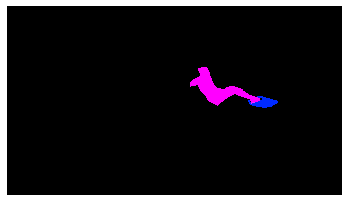

(360, 640, 3)
COCO_val2014_000000573819.jpg
{'person_bbx': [186.56, 97.85, 640.0, 375.76], 'Verbs': 'look', 'object': {'obj_bbx': [78.5, 212.52, 234.54, 354.20000000000005]}}
person
laptop
look
look interaction
{'person_bbx': [186.56, 97.85, 640.0, 375.76], 'Verbs': 'sit', 'object': {'obj_bbx': [598.59, 266.83, 638.87, 354.84]}}
person
chair
sit
sit interaction
{'person_bbx': [186.56, 97.85, 640.0, 375.76], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [78.5, 212.52, 234.54, 354.20000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


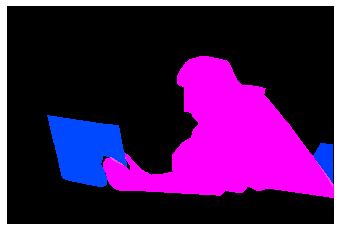

(426, 640, 3)
COCO_val2014_000000488069.jpg
{'person_bbx': [274.29, 88.1, 508.68, 631.69], 'Verbs': 'hold', 'object': {'obj_bbx': [464.14, 215.5, 511.71, 392.78999999999996]}}
backpack
person
hold
hold interaction
{'person_bbx': [274.29, 88.1, 508.68, 631.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.29, 88.1, 508.68, 631.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


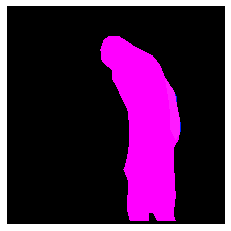

(640, 640, 3)
COCO_val2014_000000072770.jpg
{'person_bbx': [286.52, 98.88, 498.88, 448.31], 'Verbs': 'look', 'object': {'obj_bbx': [70.61, 31.39, 160.97, 161.61]}}
person
frisbee
look
look interaction
{'person_bbx': [286.52, 98.88, 498.88, 448.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.52, 98.88, 498.88, 448.31], 'Verbs': 'throw', 'object': {'obj_bbx': [70.61, 31.39, 160.97, 161.61]}}
person
frisbee
throw
throw interaction


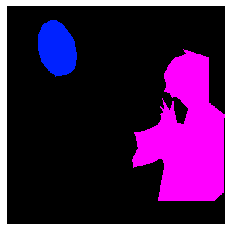

(500, 500, 3)
COCO_val2014_000000118542.jpg
{'person_bbx': [242.68, 48.43, 496.11, 385.61], 'Verbs': 'look', 'object': {'obj_bbx': [4.31, 9.4, 441.17, 479.69]}}
person
laptop
look
look interaction
{'person_bbx': [242.68, 48.43, 496.11, 385.61], 'Verbs': 'sit', 'object': {'obj_bbx': [262.11, 276.13, 640.0, 474.61]}}
bed
person
sit
sit interaction


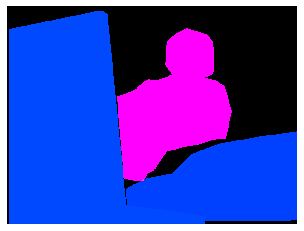

(480, 640, 3)
COCO_val2014_000000372258.jpg
{'person_bbx': [209.74, 133.91, 318.23, 399.03999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [252.17, 16.23, 283.72999999999996, 37.769999999999996]}}
person
frisbee
catch
catch interaction
{'person_bbx': [289.58, 48.62, 431.13, 341.44], 'Verbs': 'catch', 'object': {'obj_bbx': [252.17, 16.23, 283.72999999999996, 37.769999999999996]}}
frisbee
person
catch
catch interaction
{'person_bbx': [209.74, 133.91, 318.23, 399.03999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [289.58, 48.62, 431.13, 341.44], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [209.74, 133.91, 318.23, 399.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [252.17, 16.23, 283.72999999999996, 37.769999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [289.58, 48.62, 431.13, 341.44], 'Verbs': 'look', 'object': {'obj_bbx': [252.17, 16.23, 283.72999999999996, 37.769999999999996]}}
frisbee
pers

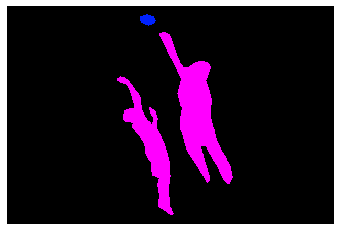

(416, 624, 3)
COCO_val2014_000000422836.jpg
{'person_bbx': [95.46, 0.54, 228.13, 234.07], 'Verbs': 'hold', 'object': {'obj_bbx': [161.45, 119.06, 246.23, 219.43]}}
person
suitcase
hold
hold interaction
{'person_bbx': [95.46, 0.54, 228.13, 234.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [95.46, 0.54, 228.13, 234.07], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


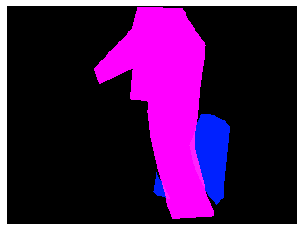

(240, 320, 3)
COCO_val2014_000000004840.jpg
{'person_bbx': [351.11, 63.3, 488.54, 266.63], 'Verbs': 'jump', 'object': {'obj_bbx': [335.66, 259.51, 475.61, 298.2]}}
person
skateboard
jump
jump interaction
{'person_bbx': [351.11, 63.3, 488.54, 266.63], 'Verbs': 'look', 'object': {'obj_bbx': [335.66, 259.51, 475.61, 298.2]}}
person
skateboard
look
look interaction
{'person_bbx': [351.11, 63.3, 488.54, 266.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [335.66, 259.51, 475.61, 298.2]}}
person
skateboard
skateboard
skateboard interaction


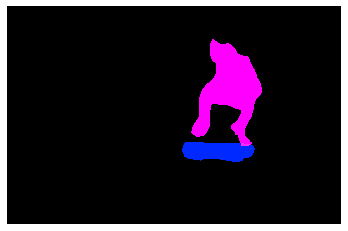

(417, 640, 3)
COCO_val2014_000000477655.jpg
{'person_bbx': [299.38, 69.09, 528.71, 401.09000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [235.89, 349.8, 298.78999999999996, 402.71000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [212.06, 9.6, 397.25, 373.27000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [235.89, 349.8, 298.78999999999996, 402.71000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [299.38, 69.09, 528.71, 401.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [235.89, 349.8, 298.78999999999996, 402.71000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [212.06, 9.6, 397.25, 373.27000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [235.89, 349.8, 298.78999999999996, 402.71000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [299.38, 69.09, 528.71, 401.09000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [212.06, 9.6, 397.25, 373.2700000000000

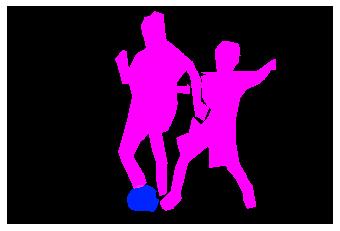

(427, 640, 3)
COCO_val2014_000000516733.jpg
{'person_bbx': [373.15, 283.01, 640.0, 481.0], 'Verbs': 'catch', 'object': {'obj_bbx': [132.04, 160.73, 156.91, 184.48]}}
sports ball
person
catch
catch interaction
{'person_bbx': [373.15, 283.01, 640.0, 481.0], 'Verbs': 'look', 'object': {'obj_bbx': [132.04, 160.73, 156.91, 184.48]}}
sports ball
person
look
look interaction


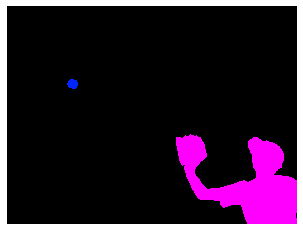

(481, 640, 3)
COCO_val2014_000000277625.jpg
{'person_bbx': [197.01, 167.01, 269.32, 299.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [297.61, 170.04, 372.59000000000003, 316.47], 'Verbs': 'hold', 'object': {'obj_bbx': [306.47, 196.86, 387.35, 380.31]}}
person
horse
hold
hold interaction
{'person_bbx': [114.25, 176.22, 162.67000000000002, 305.0], 'Verbs': 'hold', 'object': {'obj_bbx': [67.81, 223.56, 193.79000000000002, 363.47]}}
horse
person
hold
hold interaction
{'person_bbx': [380.22, 160.87, 466.35, 304.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [369.07, 199.9, 487.45, 376.52]}}
person
horse
hold
hold interaction
{'person_bbx': [469.76, 162.89, 556.4, 300.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [477.61, 193.69, 594.73, 369.7]}}
person
horse
hold
hold interaction
{'person_bbx': [197.01, 167.01, 269.32, 299.44], 'Verbs': 'ride', 'object': {'obj_bbx': [167.93, 205.38, 293.91, 366.45]}}
horse
person
ride
ride interaction
{'pers

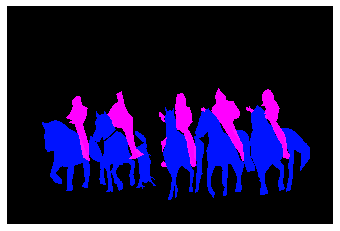

(427, 640, 3)
COCO_val2014_000000467931.jpg
{'person_bbx': [267.39, 4.77, 635.05, 409.68], 'Verbs': 'look', 'object': {'obj_bbx': [51.45, 179.92, 351.59, 371.44]}}
person
laptop
look
look interaction
{'person_bbx': [267.39, 4.77, 635.05, 409.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [267.39, 4.77, 635.05, 409.68], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [51.45, 179.92, 351.59, 371.44]}}
person
laptop
work_on_computer
work_on_computer interaction


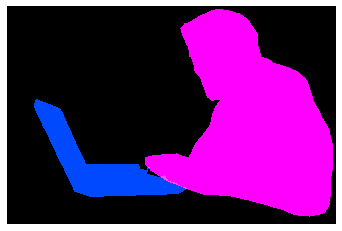

(424, 640, 3)
COCO_val2014_000000192806.jpg
{'person_bbx': [189.42, 272.65, 350.13, 631.39], 'Verbs': 'hold', 'object': {'obj_bbx': [250.16, 321.81, 280.06, 350.49]}}
cell phone
person
hold
hold interaction
{'person_bbx': [189.42, 272.65, 350.13, 631.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [189.42, 272.65, 350.13, 631.39], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [250.16, 321.81, 280.06, 350.49]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


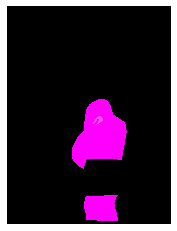

(640, 480, 3)
COCO_val2014_000000023807.jpg
{'person_bbx': [3.23, 53.81, 445.56, 474.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [3.23, 53.81, 445.56, 474.62], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [3.23, 53.81, 445.56, 474.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


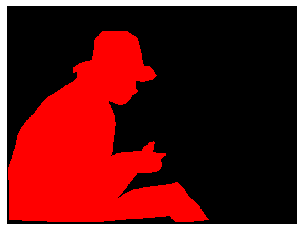

(480, 640, 3)
COCO_val2014_000000452964.jpg
{'person_bbx': [35.87, 18.83, 391.26, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [349.76, 171.33, 387.59, 203.25]}}
sports ball
person
hold
hold interaction
{'person_bbx': [35.87, 18.83, 391.26, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [35.87, 18.83, 391.26, 500.0], 'Verbs': 'throw', 'object': {'obj_bbx': [349.76, 171.33, 387.59, 203.25]}}
sports ball
person
throw
throw interaction


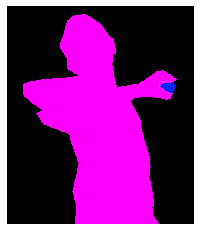

(500, 430, 3)
COCO_val2014_000000364126.jpg
{'person_bbx': [210.53, 130.92, 340.93, 328.82], 'Verbs': 'surf', 'object': {'obj_bbx': [152.47, 290.52, 337.78999999999996, 355.03999999999996]}}
person
surfboard
surf
surf interaction


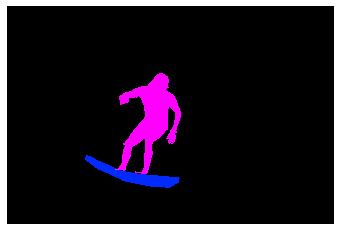

(426, 640, 3)
COCO_val2014_000000463699.jpg
{'person_bbx': [150.6, 259.98, 285.7, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [243.5, 316.02, 263.04, 337.7]}}
cell phone
person
carry
carry interaction
{'person_bbx': [150.6, 259.98, 285.7, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [135.57, 362.88, 210.06, 592.0]}}
handbag
person
hold
hold interaction
{'person_bbx': [150.6, 259.98, 285.7, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [150.6, 259.98, 285.7, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [243.5, 316.02, 263.04, 337.7]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


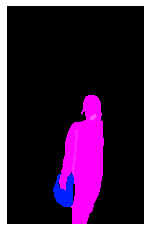

(640, 401, 3)
COCO_val2014_000000329498.jpg
{'person_bbx': [131.0, 47.09, 298.81, 376.72], 'Verbs': 'carry', 'object': {'obj_bbx': [27.04, 127.52, 302.06, 285.14]}}
person
surfboard
carry
carry interaction
{'person_bbx': [131.0, 47.09, 298.81, 376.72], 'Verbs': 'hold', 'object': {'obj_bbx': [27.04, 127.52, 302.06, 285.14]}}
person
surfboard
hold
hold interaction
{'person_bbx': [131.0, 47.09, 298.81, 376.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


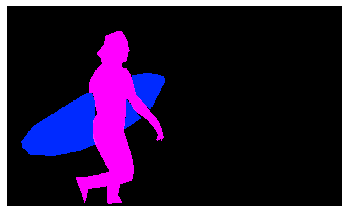

(381, 640, 3)
COCO_val2014_000000440034.jpg


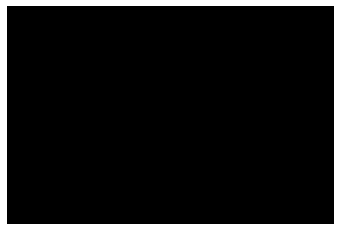

(426, 640, 3)
COCO_val2014_000000232610.jpg
{'person_bbx': [3.38, 79.95, 333.0, 493.24], 'Verbs': 'hold', 'object': {'obj_bbx': [251.71, 276.28, 324.98, 449.31999999999994]}}
person
cell phone
hold
hold interaction
{'person_bbx': [3.38, 79.95, 333.0, 493.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [3.38, 79.95, 333.0, 493.24], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [251.71, 276.28, 324.98, 449.31999999999994]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


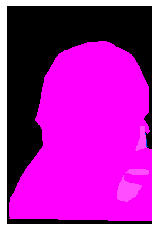

(500, 333, 3)
COCO_val2014_000000350930.jpg
{'person_bbx': [342.86, 23.18, 541.1800000000001, 472.58], 'Verbs': 'look', 'object': {'obj_bbx': [271.14, 70.9, 328.7, 141.49]}}
person
frisbee
look
look interaction
{'person_bbx': [342.86, 23.18, 541.1800000000001, 472.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [342.86, 23.18, 541.1800000000001, 472.58], 'Verbs': 'throw', 'object': {'obj_bbx': [271.14, 70.9, 328.7, 141.49]}}
person
frisbee
throw
throw interaction


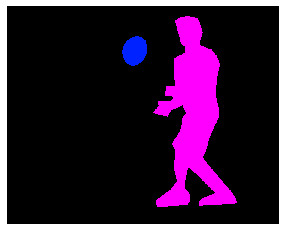

(512, 640, 3)
COCO_val2014_000000413805.jpg


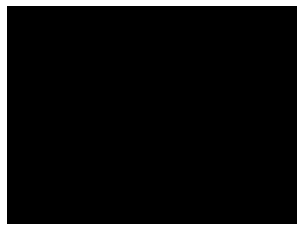

(480, 640, 3)
COCO_val2014_000000487943.jpg
{'person_bbx': [60.01, 152.65, 201.84, 425.44000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [69.85, 283.95, 202.44, 313.19]}}
person
skateboard
hold
hold interaction
{'person_bbx': [414.06, 138.58, 596.84, 315.71000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [474.42, 294.73, 570.28, 327.56]}}
person
skateboard
jump
jump interaction
{'person_bbx': [60.01, 152.65, 201.84, 425.44000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [414.06, 138.58, 596.84, 315.71000000000004]}}
person
person
look
look interaction
{'person_bbx': [414.06, 138.58, 596.84, 315.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [474.42, 294.73, 570.28, 327.56]}}
person
skateboard
look
look interaction
{'person_bbx': [414.06, 138.58, 596.84, 315.71000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [474.42, 294.73, 570.28, 327.56]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [60.01, 152.65, 201.84, 425.44000000000005]

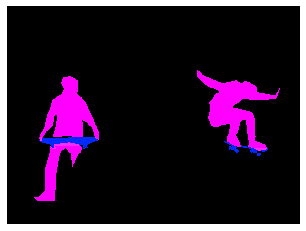

(476, 640, 3)
COCO_val2014_000000230501.jpg
{'person_bbx': [2.16, 1.08, 318.74, 237.3], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 64.18, 186.61, 237.3]}}
cat
person
look
look interaction


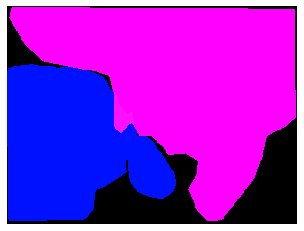

(240, 320, 3)
COCO_val2014_000000323067.jpg
{'person_bbx': [294.8, 171.69, 441.29, 309.72], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


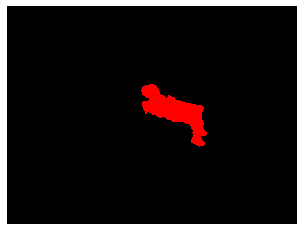

(480, 640, 3)
COCO_val2014_000000290282.jpg
{'person_bbx': [126.56, 217.17, 398.38, 627.06], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [286.35, 150.48, 394.52000000000004, 274.78]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [126.56, 217.17, 398.38, 627.06], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [124.12, 135.85, 138.25, 150.4]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [126.56, 217.17, 398.38, 627.06], 'Verbs': 'hold', 'object': {'obj_bbx': [286.35, 150.48, 394.52000000000004, 274.78]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [126.56, 217.17, 398.38, 627.06], 'Verbs': 'look', 'object': {'obj_bbx': [124.12, 135.85, 138.25, 150.4]}}
sports ball
person
look
look interaction
{'person_bbx': [126.56, 217.17, 398.38, 627.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


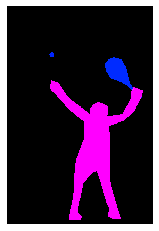

(640, 427, 3)
COCO_val2014_000000416188.jpg
{'person_bbx': [50.75, 97.24, 374.8, 616.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 252.15, 146.95, 491.12]}}
chair
person
sit
sit interaction
{'person_bbx': [50.75, 97.24, 374.8, 616.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [50.75, 97.24, 374.8, 616.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 475.57, 196.32, 609.88]}}
person
laptop
work_on_computer
work_on_computer interaction


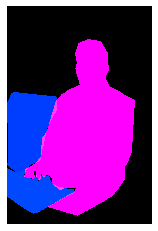

(640, 425, 3)
COCO_val2014_000000191687.jpg
{'person_bbx': [56.8, 98.02, 173.14, 298.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [475.95, 86.26, 607.0699999999999, 370.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [266.91, 87.91, 356.79, 333.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [56.8, 98.02, 173.14, 298.65], 'Verbs': 'ski', 'object': {'obj_bbx': [94.44, 279.13, 179.44, 316.9]}}
person
skis
ski
ski interaction
{'person_bbx': [475.95, 86.26, 607.0699999999999, 370.99], 'Verbs': 'ski', 'object': {'obj_bbx': [457.16, 338.36, 604.88, 390.35]}}
person
skis
ski
ski interaction
{'person_bbx': [266.91, 87.91, 356.79, 333.94], 'Verbs': 'ski', 'object': {'obj_bbx': [245.81, 301.75, 340.44, 346.68]}}
person
skis
ski
ski interaction
{'person_bbx': [56.8, 98.02, 173.14, 298.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [475.95, 86.26, 607.0699999999999, 370.99], 'Verbs

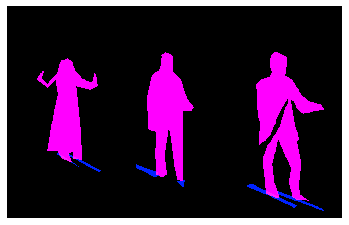

(404, 640, 3)
COCO_val2014_000000577277.jpg
{'person_bbx': [23.73, 32.03, 382.04, 635.64], 'Verbs': 'hold', 'object': {'obj_bbx': [19.38, 193.79, 246.6, 347.53999999999996]}}
person
book
hold
hold interaction
{'person_bbx': [23.73, 32.03, 382.04, 635.64], 'Verbs': 'read', 'object': {'obj_bbx': [19.38, 193.79, 246.6, 347.53999999999996]}}
person
book
read
read interaction
{'person_bbx': [23.73, 32.03, 382.04, 635.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


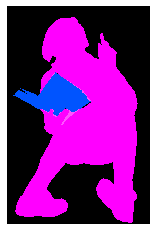

(640, 418, 3)
COCO_val2014_000000499268.jpg
{'person_bbx': [126.38, 71.8, 368.6, 422.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [188.72, 218.9, 257.18, 248.57]}}
person
book
hold
hold interaction
{'person_bbx': [126.38, 71.8, 368.6, 422.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [188.72, 218.9, 257.18, 248.57]}}
person
book
look
look interaction
{'person_bbx': [126.38, 71.8, 368.6, 422.21000000000004], 'Verbs': 'read', 'object': {'obj_bbx': [188.72, 218.9, 257.18, 248.57]}}
person
book
read
read interaction
{'person_bbx': [126.38, 71.8, 368.6, 422.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 173.11, 386.60999999999996, 422.19000000000005]}}
person
bench
sit
sit interaction


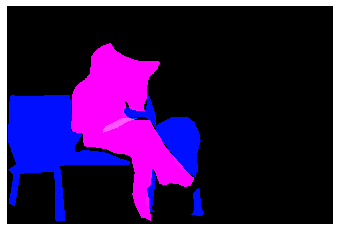

(427, 640, 3)
COCO_val2014_000000423506.jpg
{'person_bbx': [188.32, 69.44, 374.26, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.69, 27.23, 234.24, 408.66], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [188.32, 69.44, 374.26, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.69, 27.23, 234.24, 408.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


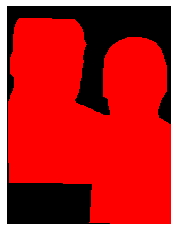

(500, 375, 3)
COCO_val2014_000000159044.jpg
{'person_bbx': [144.94, 132.95, 206.12, 214.32999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [142.67, 165.21, 273.76, 208.82]}}
person
surfboard
look
look interaction
{'person_bbx': [144.94, 132.95, 206.12, 214.32999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [142.67, 165.21, 273.76, 208.82]}}
person
surfboard
surf
surf interaction


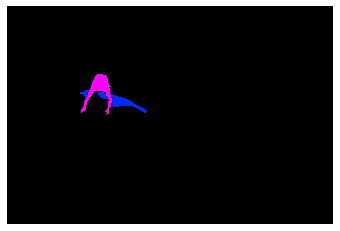

(427, 640, 3)
COCO_val2014_000000531036.jpg
{'person_bbx': [381.58, 281.03, 455.21, 465.11], 'Verbs': 'hold', 'object': {'obj_bbx': [387.22, 348.46, 411.67, 360.12]}}
person
book
hold
hold interaction
{'person_bbx': [381.58, 281.03, 455.21, 465.11], 'Verbs': 'look', 'object': {'obj_bbx': [387.22, 348.46, 411.67, 360.12]}}
person
book
look
look interaction
{'person_bbx': [381.58, 281.03, 455.21, 465.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


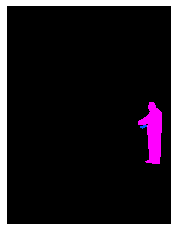

(640, 480, 3)
COCO_val2014_000000380913.jpg
{'person_bbx': [256.8, 168.38, 375.1, 421.33], 'Verbs': 'hold', 'object': {'obj_bbx': [265.02, 306.89, 358.54999999999995, 338.26]}}
person
handbag
hold
hold interaction
{'person_bbx': [376.06, 158.4, 535.72, 420.01], 'Verbs': 'hold', 'object': {'obj_bbx': [440.86, 297.84, 483.73, 315.15999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [116.38, 168.31, 260.65, 422.23], 'Verbs': 'hold', 'object': {'obj_bbx': [166.3, 253.18, 187.61, 262.49]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.71, 151.05, 160.69, 427.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [66.16, 208.25, 84.8, 225.54]}}
cell phone
person
hold
hold interaction
{'person_bbx': [521.29, 191.24, 640.0, 423.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [376.06, 158.4, 535.72, 420.01], 'Verbs': 'look', 'object': {'obj_bbx': [440.86, 297.84, 483.73, 315.15999999999997]}}
cell phone
person
look
look interaction
{'

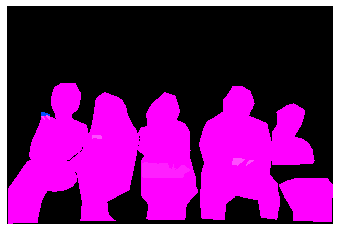

(428, 640, 3)
COCO_val2014_000000176017.jpg
{'person_bbx': [263.78, 145.95, 352.42999999999995, 329.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [345.35, 123.14, 433.06, 356.87], 'Verbs': 'hold', 'object': {'obj_bbx': [398.58, 271.41, 443.44, 314.72]}}
person
handbag
hold
hold interaction
{'person_bbx': [180.54, 139.46, 262.7, 348.11], 'Verbs': 'hold', 'object': {'obj_bbx': [230.34, 218.0, 262.69, 242.45]}}
person
bowl
hold
hold interaction
{'person_bbx': [263.78, 145.95, 352.42999999999995, 329.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [345.35, 123.14, 433.06, 356.87], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [180.54, 139.46, 262.7, 348.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [263.78, 145.95, 352.42999999999995, 329.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [345.35, 123.14, 433.06, 356.87], 'Verbs': 'stand', 'objec

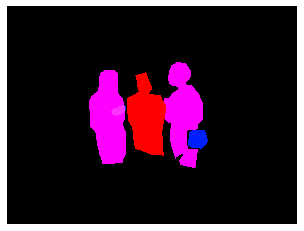

(480, 640, 3)
COCO_val2014_000000152326.jpg
{'person_bbx': [223.58, 22.74, 424.12, 419.03000000000003], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [374.26, 359.09, 411.52, 396.13]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [223.58, 22.74, 424.12, 419.03000000000003], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [391.5, 303.22, 603.56, 422.20000000000005]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [65.77, 15.72, 380.27, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [374.26, 359.09, 411.52, 396.13]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [65.77, 15.72, 380.27, 427.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [391.5, 303.22, 603.56, 422.20000000000005]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [223.58, 22.74, 424.12, 419.03000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [374.26, 359.09, 411.52, 396.13]}}
person
knife
hold
hold interaction
{'person_bbx': [65.77, 15.72, 380.27, 427.0], 'Verbs': 'hold', 'object'

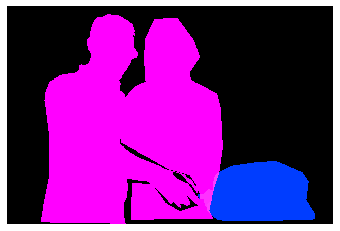

(427, 640, 3)
COCO_val2014_000000567640.jpg
{'person_bbx': [287.47, 43.93, 488.99, 371.52], 'Verbs': 'kick', 'object': {'obj_bbx': [560.87, 353.03, 610.53, 401.03999999999996]}}
sports ball
person
kick
kick interaction
{'person_bbx': [144.21, 75.29, 339.04, 393.32], 'Verbs': 'kick', 'object': {'obj_bbx': [560.87, 353.03, 610.53, 401.03999999999996]}}
sports ball
person
kick
kick interaction
{'person_bbx': [287.47, 43.93, 488.99, 371.52], 'Verbs': 'look', 'object': {'obj_bbx': [560.87, 353.03, 610.53, 401.03999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [0.35, 79.16, 192.34, 380.03], 'Verbs': 'look', 'object': {'obj_bbx': [560.87, 353.03, 610.53, 401.03999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [144.21, 75.29, 339.04, 393.32], 'Verbs': 'look', 'object': {'obj_bbx': [560.87, 353.03, 610.53, 401.03999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [287.47, 43.93, 488.99, 371.52], 'Verbs': 'run', 'object': {'obj_bbx

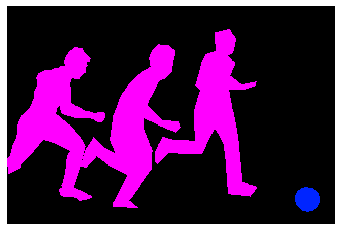

(425, 640, 3)
COCO_val2014_000000513567.jpg
{'person_bbx': [324.32, 2.7, 615.14, 475.14], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [445.94, 155.1, 562.58, 211.87]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [23.73, 76.58, 349.48, 474.60999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [124.64, 281.32, 227.64, 349.3]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [324.32, 2.7, 615.14, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [445.94, 155.1, 562.58, 211.87]}}
hot dog
person
hold
hold interaction
{'person_bbx': [23.73, 76.58, 349.48, 474.60999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [124.64, 281.32, 227.64, 349.3]}}
hot dog
person
hold
hold interaction
{'person_bbx': [324.32, 2.7, 615.14, 475.14], 'Verbs': 'look', 'object': {'obj_bbx': [445.94, 155.1, 562.58, 211.87]}}
hot dog
person
look
look interaction
{'person_bbx': [324.32, 2.7, 615.14, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [23.73, 76.58

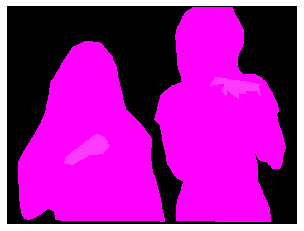

(480, 640, 3)
COCO_val2014_000000041077.jpg
{'person_bbx': [344.39, 206.59, 407.4, 265.91], 'Verbs': 'jump', 'object': {'obj_bbx': [324.71, 243.84, 400.22999999999996, 282.11]}}
person
snowboard
jump
jump interaction
{'person_bbx': [344.39, 206.59, 407.4, 265.91], 'Verbs': 'look', 'object': {'obj_bbx': [324.71, 243.84, 400.22999999999996, 282.11]}}
person
snowboard
look
look interaction
{'person_bbx': [344.39, 206.59, 407.4, 265.91], 'Verbs': 'snowboard', 'object': {'obj_bbx': [324.71, 243.84, 400.22999999999996, 282.11]}}
person
snowboard
snowboard
snowboard interaction


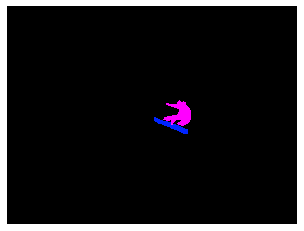

(480, 640, 3)
COCO_val2014_000000576566.jpg
{'person_bbx': [141.38, 17.32, 329.99, 438.89], 'Verbs': 'jump', 'object': {'obj_bbx': [119.03, 312.48, 290.06, 475.61]}}
person
skateboard
jump
jump interaction
{'person_bbx': [141.38, 17.32, 329.99, 438.89], 'Verbs': 'look', 'object': {'obj_bbx': [119.03, 312.48, 290.06, 475.61]}}
person
skateboard
look
look interaction
{'person_bbx': [141.38, 17.32, 329.99, 438.89], 'Verbs': 'skateboard', 'object': {'obj_bbx': [119.03, 312.48, 290.06, 475.61]}}
person
skateboard
skateboard
skateboard interaction


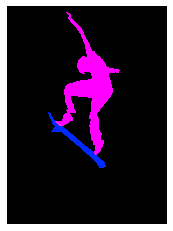

(640, 469, 3)
COCO_val2014_000000502240.jpg
{'person_bbx': [83.15, 53.93, 211.24, 329.21], 'Verbs': 'hold', 'object': {'obj_bbx': [107.98, 126.75, 179.28, 173.9]}}
person
book
hold
hold interaction
{'person_bbx': [215.58, 108.07, 375.0, 439.9], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 112.73, 74.21, 220.11]}}
person
person
look
look interaction
{'person_bbx': [83.15, 53.93, 211.24, 329.21], 'Verbs': 'look', 'object': {'obj_bbx': [107.98, 126.75, 179.28, 173.9]}}
person
book
look
look interaction
{'person_bbx': [239.32, 28.07, 352.56, 316.53], 'Verbs': 'look', 'object': {'obj_bbx': [83.15, 53.93, 211.24, 329.21]}}
person
person
look
look interaction
{'person_bbx': [83.15, 53.93, 211.24, 329.21], 'Verbs': 'read', 'object': {'obj_bbx': [107.98, 126.75, 179.28, 173.9]}}
person
book
read
read interaction
{'person_bbx': [215.58, 108.07, 375.0, 439.9], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [83.15, 53.93, 211.24, 329.21], 'Verbs': 'sit', 'object': {'obj_bbx':

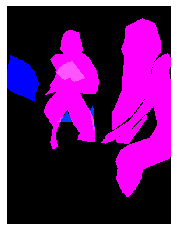

(500, 375, 3)
COCO_val2014_000000572725.jpg
{'person_bbx': [257.16, 5.76, 424.12, 245.64], 'Verbs': 'jump', 'object': {'obj_bbx': [256.52, 187.73, 350.13, 259.88]}}
person
skateboard
jump
jump interaction
{'person_bbx': [257.16, 5.76, 424.12, 245.64], 'Verbs': 'look', 'object': {'obj_bbx': [256.52, 187.73, 350.13, 259.88]}}
person
skateboard
look
look interaction
{'person_bbx': [257.16, 5.76, 424.12, 245.64], 'Verbs': 'skateboard', 'object': {'obj_bbx': [256.52, 187.73, 350.13, 259.88]}}
person
skateboard
skateboard
skateboard interaction


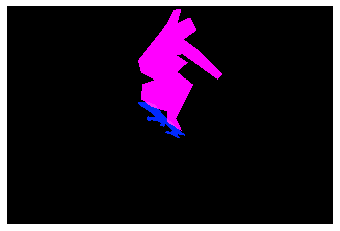

(427, 640, 3)
COCO_val2014_000000039656.jpg
{'person_bbx': [314.79, 0.0, 524.01, 402.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


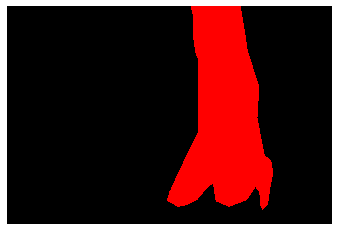

(429, 640, 3)
COCO_val2014_000000530439.jpg
{'person_bbx': [0.49, 0.0, 259.24, 258.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.49, 0.0, 259.24, 258.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [215.47, 135.82, 421.01, 258.0]}}
person
laptop
work_on_computer
work_on_computer interaction


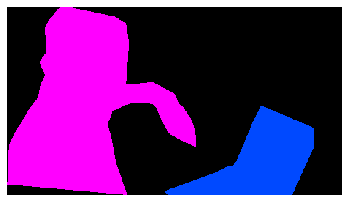

(258, 459, 3)
COCO_val2014_000000381360.jpg
{'person_bbx': [27.7, 84.04, 181.45999999999998, 304.66], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [27.7, 84.04, 181.45999999999998, 304.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [27.7, 84.04, 181.45999999999998, 304.66], 'Verbs': 'surf', 'object': {'obj_bbx': [80.22, 288.27, 175.73000000000002, 347.47999999999996]}}
person
surfboard
surf
surf interaction


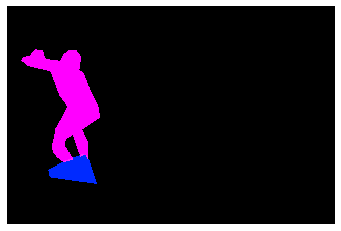

(425, 640, 3)
COCO_val2014_000000324837.jpg
{'person_bbx': [2.16, 231.91, 214.65, 371.06], 'Verbs': 'hold', 'object': {'obj_bbx': [107.87, 58.25, 486.47, 280.45]}}
person
laptop
hold
hold interaction
{'person_bbx': [2.16, 231.91, 214.65, 371.06], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [107.87, 58.25, 486.47, 280.45]}}
person
laptop
work_on_computer
work_on_computer interaction


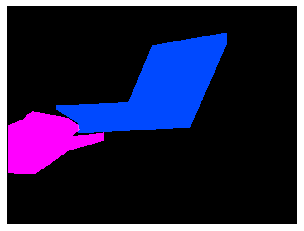

(480, 640, 3)
COCO_val2014_000000374401.jpg
{'person_bbx': [3.39, 132.34, 332.96, 490.12], 'Verbs': 'hold', 'object': {'obj_bbx': [148.47, 217.52, 271.74, 306.34000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.39, 132.34, 332.96, 490.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [3.39, 132.34, 332.96, 490.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.39, 132.34, 332.96, 490.12], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [148.47, 217.52, 271.74, 306.34000000000003]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


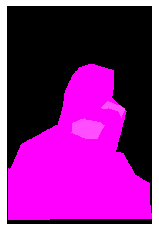

(500, 333, 3)
COCO_val2014_000000185925.jpg
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [297.79, 168.09, 345.15000000000003, 212.86]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [352.93, 33.78, 365.19, 46.620000000000005]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'hold', 'object': {'obj_bbx': [297.79, 168.09, 345.15000000000003, 212.86]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'look', 'object': {'obj_bbx': [352.93, 33.78, 365.19, 46.620000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [254.16, 80.16, 475.73, 284.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [254.16, 

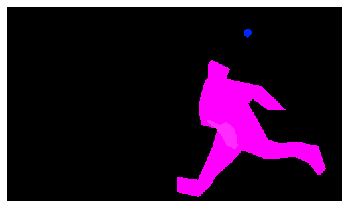

(290, 500, 3)
COCO_val2014_000000483965.jpg
{'person_bbx': [2.89, 2.89, 590.91, 421.25], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [158.37, 154.46, 436.02, 326.86]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [2.89, 2.89, 590.91, 421.25], 'Verbs': 'hold', 'object': {'obj_bbx': [158.37, 154.46, 436.02, 326.86]}}
person
hot dog
hold
hold interaction
{'person_bbx': [2.89, 2.89, 590.91, 421.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


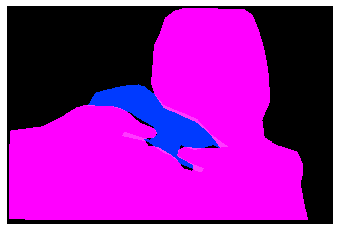

(428, 640, 3)
COCO_val2014_000000462931.jpg
{'person_bbx': [88.48, 4.21, 240.17000000000002, 369.94], 'Verbs': 'hold', 'object': {'obj_bbx': [209.59, 187.45, 287.43, 284.61]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [88.48, 4.21, 240.17000000000002, 369.94], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [88.48, 4.21, 240.17000000000002, 369.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


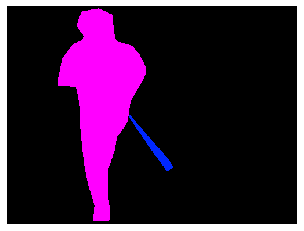

(375, 500, 3)
COCO_val2014_000000004275.jpg
{'person_bbx': [123.88, 157.67, 394.69, 564.87], 'Verbs': 'jump', 'object': {'obj_bbx': [239.68, 457.68, 347.82, 564.75]}}
person
skateboard
jump
jump interaction
{'person_bbx': [123.88, 157.67, 394.69, 564.87], 'Verbs': 'look', 'object': {'obj_bbx': [239.68, 457.68, 347.82, 564.75]}}
person
skateboard
look
look interaction
{'person_bbx': [123.88, 157.67, 394.69, 564.87], 'Verbs': 'skateboard', 'object': {'obj_bbx': [239.68, 457.68, 347.82, 564.75]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [123.88, 157.67, 394.69, 564.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


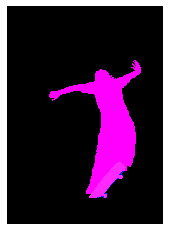

(640, 457, 3)
COCO_val2014_000000411530.jpg
{'person_bbx': [518.47, 287.23, 572.75, 418.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [426.45, 292.17, 507.19, 454.23], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [518.47, 287.23, 572.75, 418.83000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [523.26, 402.64, 563.42, 425.97999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [426.45, 292.17, 507.19, 454.23], 'Verbs': 'ski', 'object': {'obj_bbx': [390.9, 435.36, 509.40999999999997, 469.01]}}
person
skis
ski
ski interaction
{'person_bbx': [518.47, 287.23, 572.75, 418.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [426.45, 292.17, 507.19, 454.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


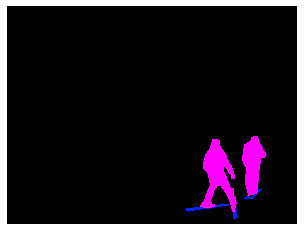

(480, 640, 3)
COCO_val2014_000000078194.jpg
{'person_bbx': [280.24, 82.14, 639.4200000000001, 426.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [512.76, 221.64, 621.35, 272.59999999999997]}}
person
toothbrush
hold
hold interaction
{'person_bbx': [280.24, 82.14, 639.4200000000001, 426.97999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 275.18]}}
person
couch
lay
lay interaction
{'person_bbx': [280.24, 82.14, 639.4200000000001, 426.97999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


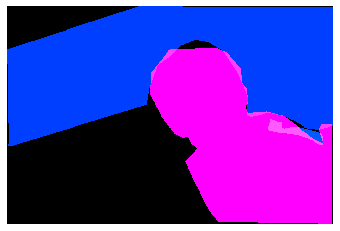

(427, 640, 3)
COCO_val2014_000000460781.jpg
{'person_bbx': [187.01, 12.14, 346.57, 238.31], 'Verbs': 'jump', 'object': {'obj_bbx': [157.76, 212.25, 338.14, 244.68]}}
person
snowboard
jump
jump interaction
{'person_bbx': [187.01, 12.14, 346.57, 238.31], 'Verbs': 'look', 'object': {'obj_bbx': [157.76, 212.25, 338.14, 244.68]}}
person
snowboard
look
look interaction
{'person_bbx': [187.01, 12.14, 346.57, 238.31], 'Verbs': 'snowboard', 'object': {'obj_bbx': [157.76, 212.25, 338.14, 244.68]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [187.01, 12.14, 346.57, 238.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


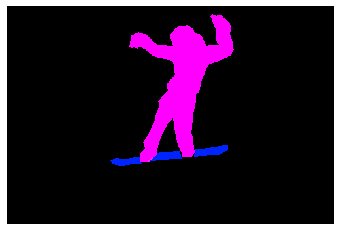

(333, 500, 3)
COCO_val2014_000000053642.jpg
{'person_bbx': [5.62, 69.66, 375.0, 494.38], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 370.13, 311.69]}}
person
bed
lay
lay interaction


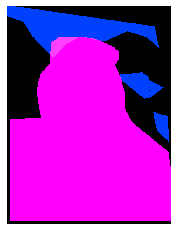

(500, 375, 3)
COCO_val2014_000000392665.jpg
{'person_bbx': [413.27, 35.64, 591.93, 411.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [22.42, 71.57, 338.53000000000003, 447.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [22.42, 71.57, 338.53000000000003, 447.40999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [22.42, 71.57, 338.53000000000003, 447.40999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard


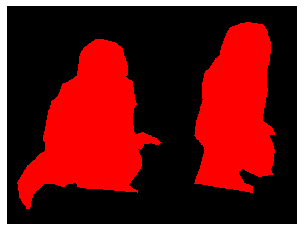

(480, 640, 3)
COCO_val2014_000000196421.jpg
{'person_bbx': [1.37, 172.03, 280.33, 286.49], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [409.9, 152.54, 638.41, 226.07], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


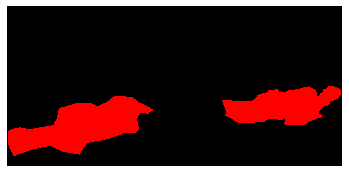

(305, 640, 3)
COCO_val2014_000000034993.jpg
{'person_bbx': [177.52, 90.2, 529.67, 371.34999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [225.49, 128.58, 361.75, 240.85000000000002]}}
person
laptop
look
look interaction
{'person_bbx': [177.52, 90.2, 529.67, 371.34999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [323.23, 236.0, 537.19, 427.0]}}
chair
person
sit
sit interaction
{'person_bbx': [177.52, 90.2, 529.67, 371.34999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [225.49, 128.58, 361.75, 240.85000000000002]}}
person
laptop
work_on_computer
work_on_computer interaction


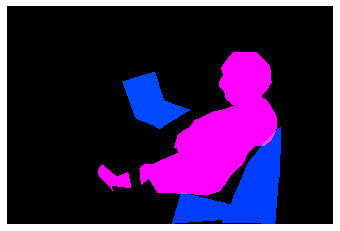

(427, 640, 3)
COCO_val2014_000000106228.jpg
{'person_bbx': [206.48, 108.67, 302.48, 398.47], 'Verbs': 'drink', 'object': {'obj_bbx': [261.2, 138.95, 303.36, 170.1]}}
person
cup
drink
drink interaction
{'person_bbx': [206.48, 108.67, 302.48, 398.47], 'Verbs': 'hold', 'object': {'obj_bbx': [261.2, 138.95, 303.36, 170.1]}}
person
cup
hold
hold interaction
{'person_bbx': [389.48, 125.73, 487.08000000000004, 401.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [446.54, 196.28, 468.56, 245.1]}}
person
banana
hold
hold interaction
{'person_bbx': [206.48, 108.67, 302.48, 398.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [389.48, 125.73, 487.08000000000004, 401.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


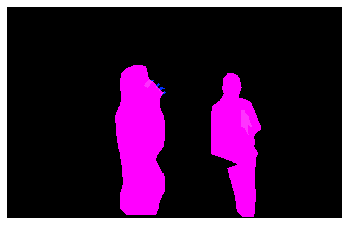

(403, 640, 3)
COCO_val2014_000000545583.jpg
{'person_bbx': [434.2, 65.36, 490.93, 201.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [434.2, 65.36, 490.93, 201.3], 'Verbs': 'ski', 'object': {'obj_bbx': [414.77, 177.9, 496.57, 214.37]}}
person
skis
ski
ski interaction


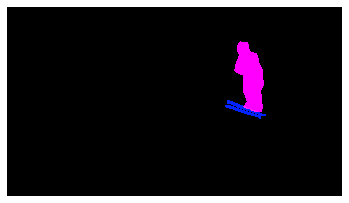

(361, 640, 3)
COCO_val2014_000000145665.jpg
{'person_bbx': [1.43, 278.39, 198.03, 542.42], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [1.43, 278.39, 198.03, 542.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


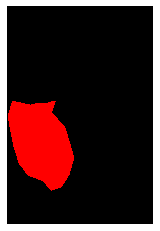

(640, 429, 3)
COCO_val2014_000000506335.jpg
{'person_bbx': [358.37, 144.28, 482.08, 404.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [393.82, 190.48, 441.88, 283.45]}}
person
person
hold
hold interaction
{'person_bbx': [154.39, 68.37, 285.75, 264.69], 'Verbs': 'hold', 'object': {'obj_bbx': [83.93, 129.44, 336.74, 306.4]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [236.95, 107.94, 400.40999999999997, 395.49], 'Verbs': 'hold', 'object': {'obj_bbx': [162.16, 224.49, 478.38, 420.1]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [358.37, 144.28, 482.08, 404.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [358.37, 144.28, 482.08, 404.28999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [162.16, 224.49, 478.38, 420.1]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [154.39, 68.37, 285.75, 264.69], 'Verbs': 'ride', 'object': {'obj_bbx': [83.93, 129.44, 336.74, 306.4]}}
person
motorcycle
ride
ride interaction


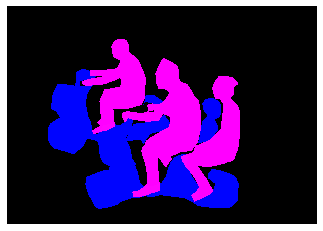

(450, 640, 3)
COCO_val2014_000000504559.jpg
{'person_bbx': [237.19, 7.82, 368.44, 427.29], 'Verbs': 'hold', 'object': {'obj_bbx': [306.57, 106.65, 342.53, 432.94000000000005]}}
person
snowboard
hold
hold interaction
{'person_bbx': [43.0, 24.1, 221.0, 430.1], 'Verbs': 'hold', 'object': {'obj_bbx': [109.49, 97.44, 199.89, 439.96999999999997]}}
person
snowboard
hold
hold interaction
{'person_bbx': [237.19, 7.82, 368.44, 427.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [43.0, 24.1, 221.0, 430.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [350.65, 99.93, 448.63, 400.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [237.19, 7.82, 368.44, 427.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [43.0, 24.1, 221.0, 430.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


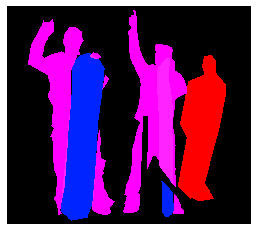

(447, 500, 3)
COCO_val2014_000000295194.jpg
{'person_bbx': [454.83, 110.35, 577.65, 307.06], 'Verbs': 'hold', 'object': {'obj_bbx': [382.09, 157.95, 617.91, 401.58]}}
horse
person
hold
hold interaction
{'person_bbx': [76.42, 88.93, 211.11, 277.12], 'Verbs': 'hold', 'object': {'obj_bbx': [50.61, 162.43, 215.33999999999997, 298.62]}}
horse
person
hold
hold interaction
{'person_bbx': [454.83, 110.35, 577.65, 307.06], 'Verbs': 'look', 'object': {'obj_bbx': [138.66, 233.24, 356.28999999999996, 365.48]}}
cow
person
look
look interaction
{'person_bbx': [454.83, 110.35, 577.65, 307.06], 'Verbs': 'ride', 'object': {'obj_bbx': [382.09, 157.95, 617.91, 401.58]}}
horse
person
ride
ride interaction
{'person_bbx': [76.42, 88.93, 211.11, 277.12], 'Verbs': 'ride', 'object': {'obj_bbx': [50.61, 162.43, 215.33999999999997, 298.62]}}
horse
person
ride
ride interaction
{'person_bbx': [454.83, 110.35, 577.65, 307.06], 'Verbs': 'sit', 'object': {'obj_bbx': [382.09, 157.95, 617.91, 401.58]}}
horse
person
sit

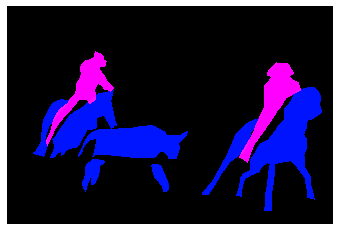

(427, 640, 3)
COCO_val2014_000000025158.jpg
{'person_bbx': [66.0, 70.68, 227.07, 499.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [202.73, 103.98, 257.39, 190.01]}}
person
frisbee
hold
hold interaction
{'person_bbx': [66.0, 70.68, 227.07, 499.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [66.0, 70.68, 227.07, 499.09000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [202.73, 103.98, 257.39, 190.01]}}
person
frisbee
throw
throw interaction


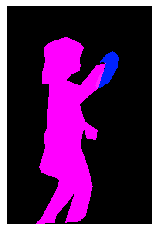

(500, 333, 3)
COCO_val2014_000000485564.jpg
{'person_bbx': [159.26, 78.43, 301.24, 354.73], 'Verbs': 'kick', 'object': {'obj_bbx': [437.58, 136.18, 478.32, 178.17000000000002]}}
sports ball
person
kick
kick interaction
{'person_bbx': [159.26, 78.43, 301.24, 354.73], 'Verbs': 'look', 'object': {'obj_bbx': [213.46, 72.27, 338.85, 348.9]}}
person
person
look
look interaction
{'person_bbx': [46.8, 90.79, 157.57999999999998, 327.65000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [437.58, 136.18, 478.32, 178.17000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [213.46, 72.27, 338.85, 348.9], 'Verbs': 'look', 'object': {'obj_bbx': [437.58, 136.18, 478.32, 178.17000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [159.26, 78.43, 301.24, 354.73], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [213.46, 72.27, 338.85, 348.9], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [159.26, 78.43, 301.24, 354.73], 'Ve

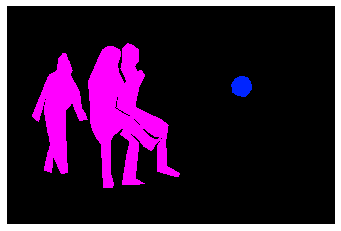

(425, 640, 3)
COCO_val2014_000000508514.jpg
{'person_bbx': [70.11, 197.39, 640.0, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 217.17, 413.02, 480.0]}}
person
bed
lay
lay interaction


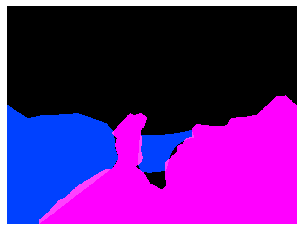

(480, 640, 3)
COCO_val2014_000000036539.jpg
{'person_bbx': [167.89, 292.66, 264.03999999999996, 532.3], 'Verbs': 'snowboard', 'object': {'obj_bbx': [135.39, 515.37, 306.61, 542.93]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [167.89, 292.66, 264.03999999999996, 532.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


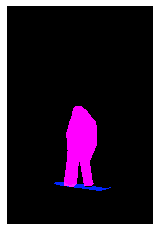

(640, 427, 3)
COCO_val2014_000000475043.jpg
{'person_bbx': [259.14, 46.18, 612.0, 462.45], 'Verbs': 'drink', 'object': {'obj_bbx': [358.52, 135.89, 478.19, 210.52999999999997]}}
bottle
person
drink
drink interaction
{'person_bbx': [259.14, 46.18, 612.0, 462.45], 'Verbs': 'hold', 'object': {'obj_bbx': [358.52, 135.89, 478.19, 210.52999999999997]}}
bottle
person
hold
hold interaction
{'person_bbx': [0.45, 42.19, 148.51999999999998, 511.7], 'Verbs': 'look', 'object': {'obj_bbx': [2.75, 217.07, 110.02, 267.95]}}
person
laptop
look
look interaction
{'person_bbx': [0.45, 42.19, 148.51999999999998, 511.7], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [259.14, 46.18, 612.0, 462.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.45, 42.19, 148.51999999999998, 511.7], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [2.75, 217.07, 110.02, 267.95]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [259.14, 46.18, 612.0,

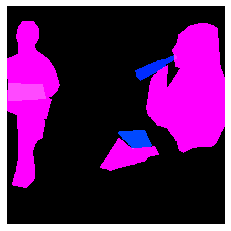

(612, 612, 3)
COCO_val2014_000000242946.jpg
{'person_bbx': [406.56, 0.62, 640.0, 238.92000000000002], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [421.34, 182.27, 460.96999999999997, 221.9]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [207.1, 0.0, 359.19, 174.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [406.56, 0.62, 640.0, 238.92000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [421.34, 182.27, 460.96999999999997, 221.9]}}
person
spoon
hold
hold interaction
{'person_bbx': [6.65, 0.35, 175.16, 203.01999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [207.1, 0.0, 359.19, 174.74], 'Verbs': 'look', 'object': {'obj_bbx': [406.56, 0.62, 640.0, 238.92000000000002]}}
person
person
look
look interaction
{'person_bbx': [406.56, 0.62, 640.0, 238.92000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [421.34, 182.27, 460.96999999999997, 221.9]}}
person
spoon
look
look interaction
{'person_bbx': [6.65, 0.35, 1

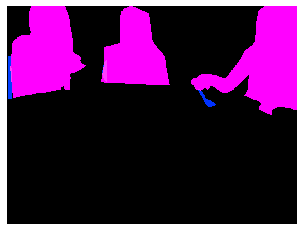

(480, 640, 3)
COCO_val2014_000000062363.jpg
{'person_bbx': [369.55, 192.81, 425.56, 273.42], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [369.55, 192.81, 425.56, 273.42], 'Verbs': 'look', 'object': {'obj_bbx': [336.56, 267.38, 444.8, 283.71999999999997]}}
person
surfboard
look
look interaction
{'person_bbx': [369.55, 192.81, 425.56, 273.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


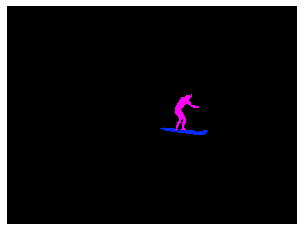

(480, 640, 3)
COCO_val2014_000000215982.jpg
{'person_bbx': [298.01, 92.46, 439.7, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [410.69, 144.4, 423.85, 158.83]}}
person
remote
hold
hold interaction
{'person_bbx': [65.65, 130.01, 236.77, 443.19], 'Verbs': 'hold', 'object': {'obj_bbx': [64.72, 207.91, 101.59, 234.91]}}
person
remote
hold
hold interaction
{'person_bbx': [298.01, 92.46, 439.7, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [411.99, 134.14, 522.38, 242.56]}}
tv
person
look
look interaction
{'person_bbx': [65.65, 130.01, 236.77, 443.19], 'Verbs': 'look', 'object': {'obj_bbx': [411.99, 134.14, 522.38, 242.56]}}
tv
person
look
look interaction
{'person_bbx': [298.01, 92.46, 439.7, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [65.65, 130.01, 236.77, 443.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


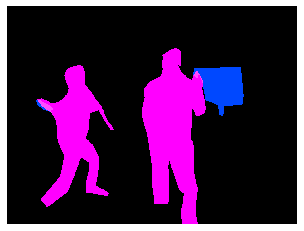

(480, 640, 3)
COCO_val2014_000000571450.jpg
{'person_bbx': [1.08, 40.46, 626.82, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [303.1, 12.61, 502.65000000000003, 163.63]}}
person
book
hold
hold interaction
{'person_bbx': [1.08, 40.46, 626.82, 475.14], 'Verbs': 'lay', 'object': {'obj_bbx': [281.97, 145.24, 640.0, 473.49]}}
bed
person
lay
lay interaction
{'person_bbx': [1.08, 40.46, 626.82, 475.14], 'Verbs': 'look', 'object': {'obj_bbx': [303.1, 12.61, 502.65000000000003, 163.63]}}
person
book
look
look interaction
{'person_bbx': [1.08, 40.46, 626.82, 475.14], 'Verbs': 'read', 'object': {'obj_bbx': [303.1, 12.61, 502.65000000000003, 163.63]}}
person
book
read
read interaction


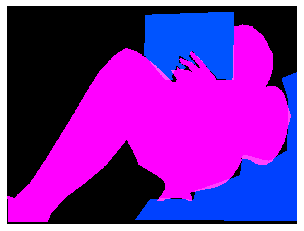

(480, 640, 3)
COCO_val2014_000000478977.jpg
{'person_bbx': [65.98, 96.17, 110.69, 238.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [88.23, 105.4, 148.35, 249.09], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [65.98, 96.17, 110.69, 238.44], 'Verbs': 'look', 'object': {'obj_bbx': [88.23, 105.4, 148.35, 249.09]}}
person
person
look
look interaction
{'person_bbx': [65.98, 96.17, 110.69, 238.44], 'Verbs': 'ski', 'object': {'obj_bbx': [81.65, 232.98, 108.66000000000001, 241.56]}}
person
skis
ski
ski interaction
{'person_bbx': [88.23, 105.4, 148.35, 249.09], 'Verbs': 'ski', 'object': {'obj_bbx': [116.91, 242.61, 134.01999999999998, 251.58]}}
person
skis
ski
ski interaction
{'person_bbx': [65.98, 96.17, 110.69, 238.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [88.23, 105.4, 148.35, 249.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


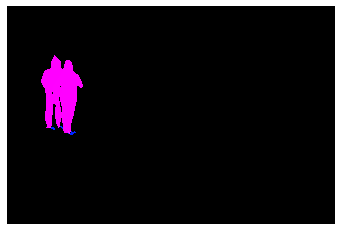

(425, 640, 3)
COCO_val2014_000000577880.jpg
{'person_bbx': [241.4, 135.81, 367.23, 211.72], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [241.4, 135.81, 367.23, 211.72], 'Verbs': 'surf', 'object': {'obj_bbx': [257.42, 178.95, 368.87, 215.22]}}
person
surfboard
surf
surf interaction


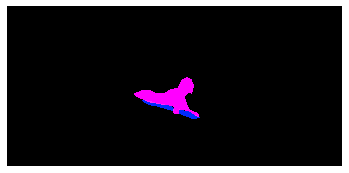

(305, 640, 3)
COCO_val2014_000000530520.jpg
{'person_bbx': [208.15, 83.29, 429.78, 306.6], 'Verbs': 'look', 'object': {'obj_bbx': [62.35, 204.3, 203.7, 251.21]}}
person
laptop
look
look interaction
{'person_bbx': [36.07, 16.86, 500.0, 370.89], 'Verbs': 'look', 'object': {'obj_bbx': [62.35, 204.3, 203.7, 251.21]}}
person
laptop
look
look interaction
{'person_bbx': [55.62, 89.33, 279.78, 307.58], 'Verbs': 'look', 'object': {'obj_bbx': [62.35, 204.3, 203.7, 251.21]}}
person
laptop
look
look interaction
{'person_bbx': [208.15, 83.29, 429.78, 306.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [36.07, 16.86, 500.0, 370.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [55.62, 89.33, 279.78, 307.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [55.62, 89.33, 279.78, 307.58], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [62.35, 204.3, 203.7, 251.21]}}
person
laptop
work_on_computer
work_on_computer interaction


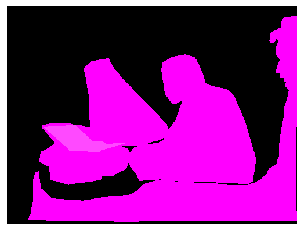

(375, 500, 3)
COCO_val2014_000000254368.jpg
{'person_bbx': [33.15, 65.59, 392.0, 459.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [33.15, 65.59, 392.0, 459.1], 'Verbs': 'lay', 'object': {'obj_bbx': [11.53, 123.24, 389.19, 633.51]}}
bed
person
lay
lay interaction


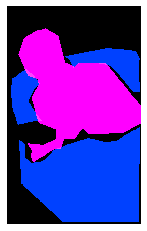

(640, 392, 3)
COCO_val2014_000000229765.jpg
{'person_bbx': [178.16, 23.15, 517.2, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [122.83, 159.97, 208.66, 198.63]}}
person
frisbee
hold
hold interaction
{'person_bbx': [178.16, 23.15, 517.2, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [178.16, 23.15, 517.2, 427.0], 'Verbs': 'throw', 'object': {'obj_bbx': [122.83, 159.97, 208.66, 198.63]}}
person
frisbee
throw
throw interaction


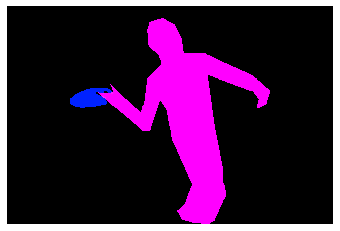

(427, 640, 3)
COCO_val2014_000000018841.jpg
{'person_bbx': [2.28, 1.33, 185.82, 332.02], 'Verbs': 'look', 'object': {'obj_bbx': [116.28, 61.16, 345.06, 323.91999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [286.81, 0.38, 412.43, 223.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [286.81, 0.38, 412.43, 223.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


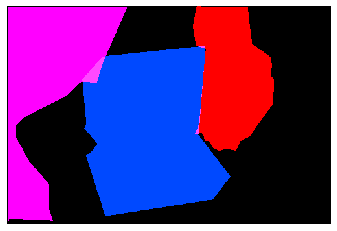

(336, 500, 3)
COCO_val2014_000000460997.jpg
{'person_bbx': [122.14, 63.95, 303.9, 310.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [122.14, 63.95, 303.9, 310.15], 'Verbs': 'surf', 'object': {'obj_bbx': [177.33, 280.24, 287.86, 333.26]}}
person
surfboard
surf
surf interaction


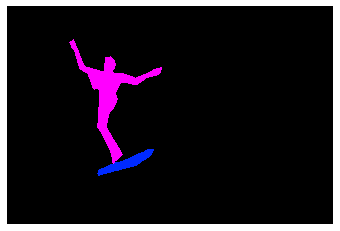

(427, 640, 3)
COCO_val2014_000000050245.jpg
{'person_bbx': [0.0, 0.0, 303.41, 472.49], 'Verbs': 'jump', 'object': {'obj_bbx': [205.21, 414.48, 353.52, 591.24]}}
person
skateboard
jump
jump interaction
{'person_bbx': [0.0, 0.0, 303.41, 472.49], 'Verbs': 'skateboard', 'object': {'obj_bbx': [205.21, 414.48, 353.52, 591.24]}}
person
skateboard
skateboard
skateboard interaction


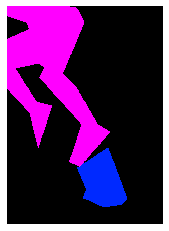

(640, 457, 3)
COCO_val2014_000000016817.jpg
{'person_bbx': [112.74, 233.92, 287.39, 512.4], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 470.05, 254.56, 556.34]}}
person
skis
hold
hold interaction
{'person_bbx': [112.74, 233.92, 287.39, 512.4], 'Verbs': 'ski', 'object': {'obj_bbx': [0.0, 470.05, 254.56, 556.34]}}
person
skis
ski
ski interaction
{'person_bbx': [112.74, 233.92, 287.39, 512.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [112.74, 233.92, 287.39, 512.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [112.74, 233.92, 287.39, 512.4], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


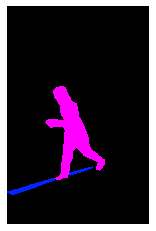

(640, 417, 3)
COCO_val2014_000000263351.jpg
{'person_bbx': [0.0, 5.15, 494.09, 472.14], 'Verbs': 'hold', 'object': {'obj_bbx': [70.26, 168.19, 162.55, 289.6]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 5.15, 494.09, 472.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 5.15, 494.09, 472.14], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [70.26, 168.19, 162.55, 289.6]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


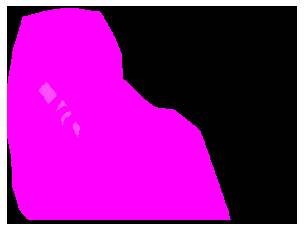

(480, 640, 3)
COCO_val2014_000000147919.jpg
{'person_bbx': [37.39, 48.9, 522.07, 517.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [37.39, 48.9, 522.07, 517.75], 'Verbs': 'sit', 'object': {'obj_bbx': [22.23, 343.24, 49.120000000000005, 449.57]}}
person
chair
sit
sit interaction


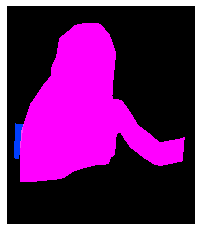

(640, 552, 3)
COCO_val2014_000000547617.jpg
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [280.38, 93.48, 377.03, 202.10000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [67.28, 246.58, 81.93, 262.5]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'hold', 'object': {'obj_bbx': [280.38, 93.48, 377.03, 202.10000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'look', 'object': {'obj_bbx': [67.28, 246.58, 81.93, 262.5]}}
sports ball
person
look
look interaction
{'person_bbx': [190.43, 133.29, 325.01, 495.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


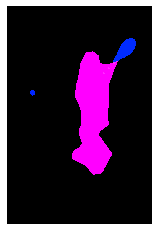

(640, 425, 3)
COCO_val2014_000000082986.jpg
{'person_bbx': [358.13, 90.12, 433.83, 207.89], 'Verbs': 'look', 'object': {'obj_bbx': [415.16, 48.39, 444.8, 56.81]}}
person
frisbee
look
look interaction
{'person_bbx': [589.9, 65.1, 640.0, 242.54], 'Verbs': 'look', 'object': {'obj_bbx': [415.16, 48.39, 444.8, 56.81]}}
person
frisbee
look
look interaction
{'person_bbx': [456.45, 76.27, 543.6, 238.81], 'Verbs': 'look', 'object': {'obj_bbx': [415.16, 48.39, 444.8, 56.81]}}
frisbee
person
look
look interaction
{'person_bbx': [358.13, 90.12, 433.83, 207.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [589.9, 65.1, 640.0, 242.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [456.45, 76.27, 543.6, 238.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [358.13, 90.12, 433.83, 207.89], 'Verbs': 'throw', 'object': {'obj_bbx': [415.16, 48.39, 444.8, 56.81]}}
person
frisbee
throw
throw interaction


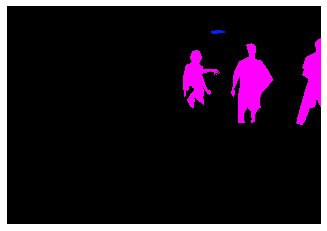

(444, 640, 3)
COCO_val2014_000000436636.jpg
{'person_bbx': [53.47, 105.75, 119.36, 211.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [232.2, 177.77, 344.90999999999997, 234.3], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [342.02, 268.66, 395.37, 363.93], 'Verbs': 'look', 'object': {'obj_bbx': [458.27, 159.66, 515.92, 232.19]}}
person
person
look
look interaction
{'person_bbx': [458.27, 159.66, 515.92, 232.19], 'Verbs': 'look', 'object': {'obj_bbx': [429.04, 226.4, 490.59000000000003, 240.04000000000002]}}
person
surfboard
look
look interaction
{'person_bbx': [232.2, 177.77, 344.90999999999997, 234.3], 'Verbs': 'look', 'object': {'obj_bbx': [149.21, 221.92, 347.98, 239.92999999999998]}}
person
surfboard
look
look interaction
{'person_bbx': [342.02, 268.66, 395.37, 363.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [53.47, 105.75, 119.36, 211.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stan

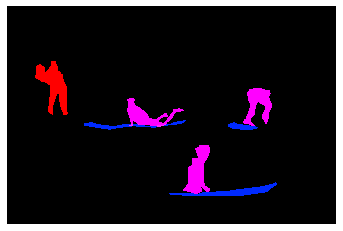

(423, 640, 3)
COCO_val2014_000000416072.jpg
{'person_bbx': [364.18, 44.75, 536.56, 212.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [364.18, 44.75, 536.56, 212.76], 'Verbs': 'jump', 'object': {'obj_bbx': [365.52, 147.2, 587.97, 277.03]}}
person
skis
jump
jump interaction
{'person_bbx': [364.18, 44.75, 536.56, 212.76], 'Verbs': 'look', 'object': {'obj_bbx': [365.52, 147.2, 587.97, 277.03]}}
person
skis
look
look interaction
{'person_bbx': [364.18, 44.75, 536.56, 212.76], 'Verbs': 'ski', 'object': {'obj_bbx': [365.52, 147.2, 587.97, 277.03]}}
person
skis
ski
ski interaction


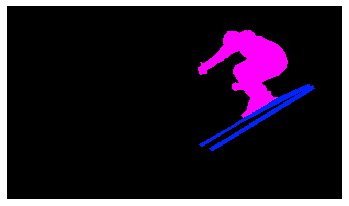

(368, 640, 3)
COCO_val2014_000000517056.jpg
{'person_bbx': [259.64, 39.78, 450.80999999999995, 357.26], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [324.7, 346.98, 368.46, 411.27000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [259.64, 39.78, 450.80999999999995, 357.26], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [174.53, 358.04, 526.17, 480.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [49.26, 96.91, 254.70999999999998, 424.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.64, 39.78, 450.80999999999995, 357.26], 'Verbs': 'hold', 'object': {'obj_bbx': [324.7, 346.98, 368.46, 411.27000000000004]}}
person
knife
hold
hold interaction
{'person_bbx': [49.26, 96.91, 254.70999999999998, 424.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [49.26, 96.91, 254.70999999999998, 424.61], 'Verbs': 'sit', 'object': {'obj_bbx': [2.57, 200.53, 254.12, 430.27]}}
chair
person
sit
sit interaction
{'person_bbx

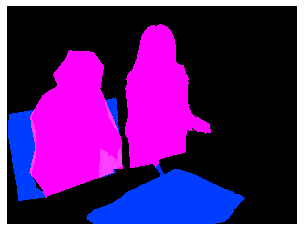

(480, 640, 3)
COCO_val2014_000000381607.jpg
{'person_bbx': [82.16, 30.99, 556.4, 606.13], 'Verbs': 'hold', 'object': {'obj_bbx': [160.68, 100.85, 200.79000000000002, 151.17]}}
cell phone
person
hold
hold interaction
{'person_bbx': [82.16, 30.99, 556.4, 606.13], 'Verbs': 'sit', 'object': {'obj_bbx': [2.88, 222.92, 398.38, 631.37]}}
person
bench
sit
sit interaction
{'person_bbx': [82.16, 30.99, 556.4, 606.13], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [160.68, 100.85, 200.79000000000002, 151.17]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


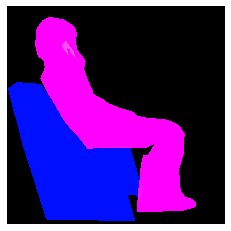

(640, 640, 3)
COCO_val2014_000000358884.jpg
{'person_bbx': [129.26, 49.59, 211.41, 233.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [129.26, 49.59, 211.41, 233.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


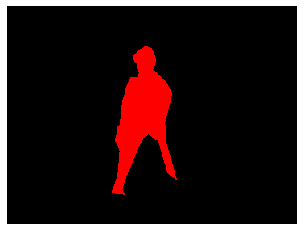

(270, 360, 3)
COCO_val2014_000000564281.jpg
{'person_bbx': [82.33, 70.84, 380.05, 426.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [309.21, 184.53, 385.94, 228.81]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [82.33, 70.84, 380.05, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [309.21, 184.53, 385.94, 228.81]}}
person
hot dog
hold
hold interaction
{'person_bbx': [82.33, 70.84, 380.05, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


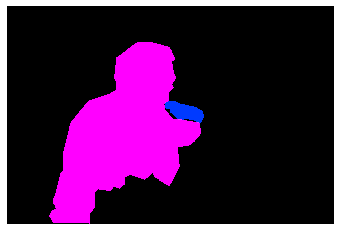

(426, 640, 3)
COCO_val2014_000000393809.jpg
{'person_bbx': [98.1, 111.63, 249.10999999999999, 329.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [462.42, 188.38, 507.44, 200.26]}}
person
frisbee
look
look interaction


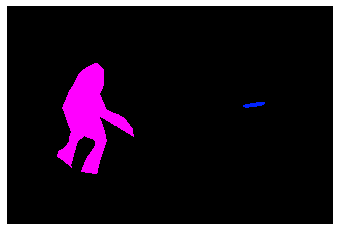

(428, 640, 3)
COCO_val2014_000000447124.jpg
{'person_bbx': [186.97, 136.63, 290.52, 527.8199999999999], 'Verbs': 'catch', 'object': {'obj_bbx': [216.52, 130.14, 263.3, 150.19]}}
person
frisbee
catch
catch interaction
{'person_bbx': [186.97, 136.63, 290.52, 527.8199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [216.52, 130.14, 263.3, 150.19]}}
person
frisbee
hold
hold interaction
{'person_bbx': [186.97, 136.63, 290.52, 527.8199999999999], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [186.97, 136.63, 290.52, 527.8199999999999], 'Verbs': 'look', 'object': {'obj_bbx': [216.52, 130.14, 263.3, 150.19]}}
person
frisbee
look
look interaction
{'person_bbx': [186.97, 136.63, 290.52, 527.8199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


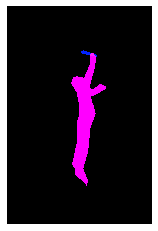

(640, 424, 3)
COCO_val2014_000000574424.jpg
{'person_bbx': [118.65, 25.89, 347.33000000000004, 316.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [281.53, 203.87, 400.17999999999995, 339.78]}}
person
laptop
look
look interaction
{'person_bbx': [349.48, 82.88, 576.0, 473.35], 'Verbs': 'look', 'object': {'obj_bbx': [281.53, 203.87, 400.17999999999995, 339.78]}}
person
laptop
look
look interaction
{'person_bbx': [349.48, 82.88, 576.0, 473.35], 'Verbs': 'sit', 'object': {'obj_bbx': [560.31, 344.14, 640.0, 480.0]}}
chair
person
sit
sit interaction
{'person_bbx': [118.65, 25.89, 347.33000000000004, 316.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [349.48, 82.88, 576.0, 473.35], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [281.53, 203.87, 400.17999999999995, 339.78]}}
person
laptop
work_on_computer
work_on_computer interaction


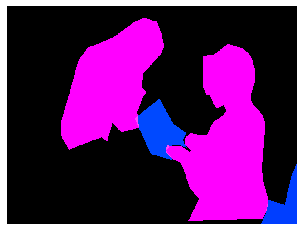

(480, 640, 3)
COCO_val2014_000000482808.jpg
{'person_bbx': [312.49, 209.88, 480.0, 468.39], 'Verbs': 'drink', 'object': {'obj_bbx': [365.02, 378.34, 437.28, 455.09]}}
person
cup
drink
drink interaction
{'person_bbx': [312.49, 209.88, 480.0, 468.39], 'Verbs': 'hold', 'object': {'obj_bbx': [365.02, 378.34, 437.28, 455.09]}}
person
cup
hold
hold interaction
{'person_bbx': [312.49, 209.88, 480.0, 468.39], 'Verbs': 'look', 'object': {'obj_bbx': [192.72, 434.1, 480.0, 639.76]}}
person
laptop
look
look interaction
{'person_bbx': [312.49, 209.88, 480.0, 468.39], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [312.49, 209.88, 480.0, 468.39], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [192.72, 434.1, 480.0, 639.76]}}
person
laptop
work_on_computer
work_on_computer interaction


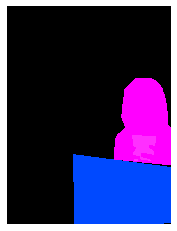

(640, 480, 3)
COCO_val2014_000000264382.jpg
{'person_bbx': [202.67, 150.67, 306.19, 278.1], 'Verbs': 'hold', 'object': {'obj_bbx': [209.09, 201.67, 216.48, 209.57999999999998]}}
sports ball
person
hold
hold interaction
{'person_bbx': [202.67, 150.67, 306.19, 278.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [202.67, 150.67, 306.19, 278.1], 'Verbs': 'throw', 'object': {'obj_bbx': [209.09, 201.67, 216.48, 209.57999999999998]}}
sports ball
person
throw
throw interaction


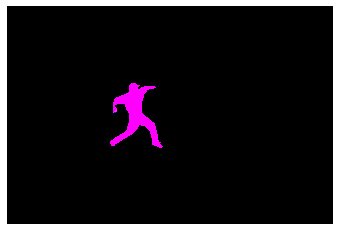

(427, 640, 3)
COCO_val2014_000000494782.jpg
{'person_bbx': [162.05, 177.32, 339.41, 609.38], 'Verbs': 'look', 'object': {'obj_bbx': [51.78, 388.31, 175.46, 444.4]}}
person
laptop
look
look interaction
{'person_bbx': [162.05, 177.32, 339.41, 609.38], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 368.18, 372.49, 589.66]}}
person
bench
sit
sit interaction
{'person_bbx': [162.05, 177.32, 339.41, 609.38], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [51.78, 388.31, 175.46, 444.4]}}
person
laptop
work_on_computer
work_on_computer interaction


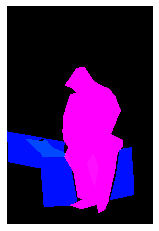

(640, 427, 3)
COCO_val2014_000000377427.jpg
{'person_bbx': [0.0, 0.86, 229.6, 333.78000000000003], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [99.8, 174.21, 159.38, 231.88]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 0.86, 229.6, 333.78000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [99.8, 174.21, 159.38, 231.88]}}
person
fork
hold
hold interaction
{'person_bbx': [0.0, 0.86, 229.6, 333.78000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 0.86, 229.6, 333.78000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


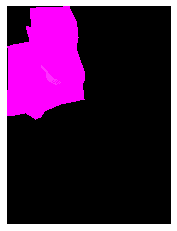

(640, 480, 3)
COCO_val2014_000000323668.jpg
{'person_bbx': [362.68, 56.61, 571.84, 367.47], 'Verbs': 'look', 'object': {'obj_bbx': [116.51, 212.0, 137.17000000000002, 235.24]}}
person
kite
look
look interaction


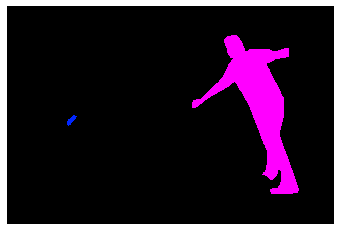

(426, 640, 3)
COCO_val2014_000000063521.jpg
{'person_bbx': [0.0, 3.24, 358.86, 471.27], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [169.9, 178.77, 208.94, 202.67000000000002]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 3.24, 358.86, 471.27], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [137.92, 199.37, 195.14999999999998, 209.83]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [299.84, 1.25, 640.0, 474.75], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [542.17, 313.84, 627.77, 347.21999999999997]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 3.24, 358.86, 471.27], 'Verbs': 'hold', 'object': {'obj_bbx': [137.92, 199.37, 195.14999999999998, 209.83]}}
person
spoon
hold
hold interaction
{'person_bbx': [299.84, 1.25, 640.0, 474.75], 'Verbs': 'hold', 'object': {'obj_bbx': [542.17, 313.84, 627.77, 347.21999999999997]}}
fork
person
hold
hold interaction
{'person_bbx': [0.0, 3.24, 358.86, 471.27], 'Verbs': 'sit', 'object': {'obj_bbx': [0.42, 0.0

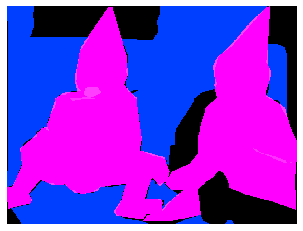

(481, 640, 3)
COCO_val2014_000000575719.jpg
{'person_bbx': [125.92, 101.17, 456.32, 471.39000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [186.34, 218.48, 347.14, 384.53]}}
person
frisbee
catch
catch interaction
{'person_bbx': [125.92, 101.17, 456.32, 471.39000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [186.34, 218.48, 347.14, 384.53]}}
person
frisbee
hold
hold interaction
{'person_bbx': [125.92, 101.17, 456.32, 471.39000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [125.92, 101.17, 456.32, 471.39000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


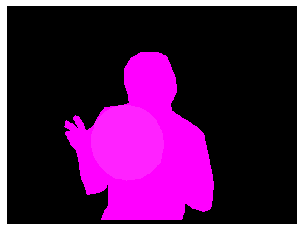

(480, 640, 3)
COCO_val2014_000000343401.jpg
{'person_bbx': [185.47, 152.66, 276.73, 256.05], 'Verbs': 'ride', 'object': {'obj_bbx': [60.0, 247.06, 316.47, 492.94]}}
person
car
ride
ride interaction
{'person_bbx': [70.95, 161.6, 197.07, 368.81], 'Verbs': 'ride', 'object': {'obj_bbx': [60.0, 247.06, 316.47, 492.94]}}
person
car
ride
ride interaction
{'person_bbx': [185.47, 152.66, 276.73, 256.05], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [70.95, 161.6, 197.07, 368.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


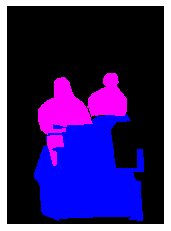

(500, 361, 3)
COCO_val2014_000000147179.jpg
{'person_bbx': [7.08, 54.66, 608.97, 371.53999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [0.88, 0.0, 640.0, 353.26]}}
bed
person
lay
lay interaction
{'person_bbx': [7.08, 54.66, 608.97, 371.53999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


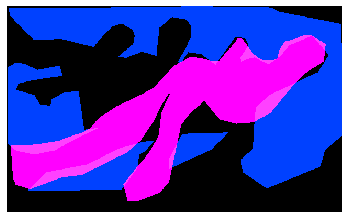

(393, 640, 3)
COCO_val2014_000000266376.jpg
{'person_bbx': [72.47, 1.69, 253.65, 352.25], 'Verbs': 'hold', 'object': {'obj_bbx': [236.58, 157.29, 319.38, 305.06]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [72.47, 1.69, 253.65, 352.25], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [72.47, 1.69, 253.65, 352.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


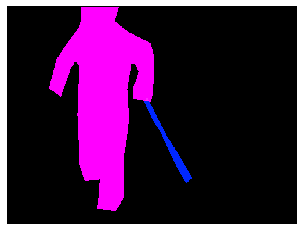

(375, 500, 3)
COCO_val2014_000000533976.jpg
{'person_bbx': [41.91, 73.71, 379.47, 364.84], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [225.61, 379.35, 321.8, 469.92]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [41.91, 73.71, 379.47, 364.84], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [151.11, 241.79, 237.02, 281.28]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [41.91, 73.71, 379.47, 364.84], 'Verbs': 'hold', 'object': {'obj_bbx': [151.11, 241.79, 237.02, 281.28]}}
person
fork
hold
hold interaction
{'person_bbx': [41.91, 73.71, 379.47, 364.84], 'Verbs': 'sit', 'object': {'obj_bbx': [96.36, 149.13, 366.74, 255.56]}}
chair
person
sit
sit interaction


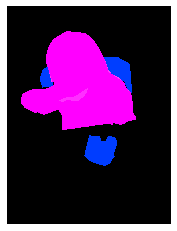

(640, 480, 3)
COCO_val2014_000000527427.jpg
{'person_bbx': [165.37, 148.39, 576.64, 476.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [510.04, 225.92, 527.69, 251.07]}}
cell phone
person
hold
hold interaction
{'person_bbx': [165.37, 148.39, 576.64, 476.97999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [112.28, 181.1, 242.29, 283.27]}}
person
laptop
look
look interaction
{'person_bbx': [165.37, 148.39, 576.64, 476.97999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [292.97, 216.76, 629.19, 468.65]}}
chair
person
sit
sit interaction
{'person_bbx': [165.37, 148.39, 576.64, 476.97999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [510.04, 225.92, 527.69, 251.07]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [165.37, 148.39, 576.64, 476.97999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [112.28, 181.1, 242.29, 283.27]}}
person
laptop
work_on_computer
work_on_computer interaction


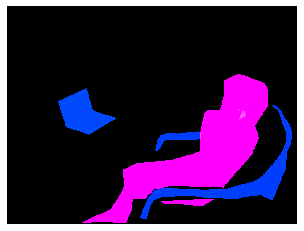

(480, 640, 3)
COCO_val2014_000000330955.jpg
{'person_bbx': [222.16, 3.85, 640.0, 426.04], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [284.0, 246.23, 452.18, 422.47]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [222.16, 3.85, 640.0, 426.04], 'Verbs': 'hold', 'object': {'obj_bbx': [284.0, 246.23, 452.18, 422.47]}}
person
hot dog
hold
hold interaction
{'person_bbx': [222.16, 3.85, 640.0, 426.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


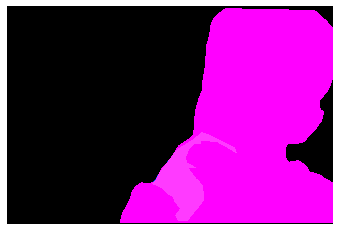

(427, 640, 3)
COCO_val2014_000000552973.jpg
{'person_bbx': [183.95, 93.99, 339.74, 289.89], 'Verbs': 'look', 'object': {'obj_bbx': [187.59, 240.73, 282.2, 297.62]}}
person
skateboard
look
look interaction
{'person_bbx': [183.95, 93.99, 339.74, 289.89], 'Verbs': 'skateboard', 'object': {'obj_bbx': [187.59, 240.73, 282.2, 297.62]}}
person
skateboard
skateboard
skateboard interaction


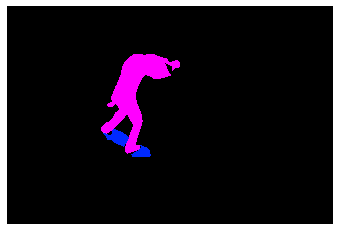

(428, 640, 3)
COCO_val2014_000000256569.jpg
{'person_bbx': [263.23, 279.72, 382.95000000000005, 422.45000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [263.23, 279.72, 382.95000000000005, 422.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [191.73, 269.74, 262.83, 427.62], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [263.23, 279.72, 382.95000000000005, 422.45000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [191.73, 269.74, 262.83, 427.62], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [263.23, 279.72, 382.95000000000005, 422.45000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [191.73, 269.74, 262.83, 427.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


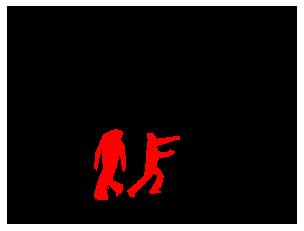

(480, 640, 3)
COCO_val2014_000000020459.jpg
{'person_bbx': [249.07, 118.36, 639.14, 452.85], 'Verbs': 'look', 'object': {'obj_bbx': [4.02, 223.55, 118.46, 258.90000000000003]}}
person
frisbee
look
look interaction
{'person_bbx': [249.07, 118.36, 639.14, 452.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [109.44, 108.25, 402.09, 450.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.44, 108.25, 402.09, 450.86], 'Verbs': 'throw', 'object': {'obj_bbx': [4.02, 223.55, 118.46, 258.90000000000003]}}
frisbee
person
throw
throw interaction


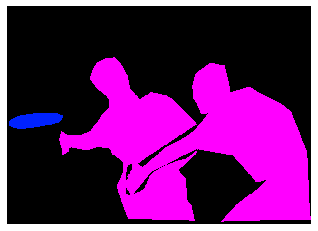

(458, 640, 3)
COCO_val2014_000000385861.jpg
{'person_bbx': [2.89, 1.44, 624.15, 383.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [220.3, 219.95, 357.95000000000005, 345.78]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [2.89, 1.44, 624.15, 383.24], 'Verbs': 'hold', 'object': {'obj_bbx': [220.3, 219.95, 357.95000000000005, 345.78]}}
person
hot dog
hold
hold interaction
{'person_bbx': [2.89, 1.44, 624.15, 383.24], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 0.0, 296.67, 192.18]}}
person
chair
sit
sit interaction


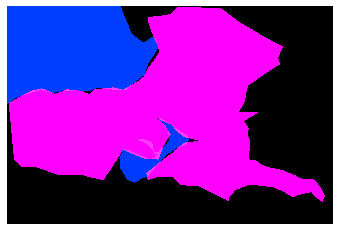

(427, 640, 3)
COCO_val2014_000000236189.jpg
{'person_bbx': [98.08, 275.95, 320.83, 631.69], 'Verbs': 'hold', 'object': {'obj_bbx': [112.99, 372.77, 222.55, 434.12]}}
frisbee
person
hold
hold interaction
{'person_bbx': [256.0, 18.7, 408.45, 355.24], 'Verbs': 'look', 'object': {'obj_bbx': [98.08, 275.95, 320.83, 631.69]}}
person
person
look
look interaction
{'person_bbx': [98.08, 275.95, 320.83, 631.69], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [256.0, 18.7, 408.45, 355.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [256.0, 18.7, 408.45, 355.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [98.08, 275.95, 320.83, 631.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [98.08, 275.95, 320.83, 631.69], 'Verbs': 'throw', 'object': {'obj_bbx': [112.99, 372.77, 222.55, 434.12]}}
frisbee
person
throw
throw interaction


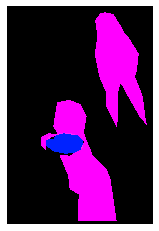

(640, 427, 3)
COCO_val2014_000000361819.jpg
{'person_bbx': [68.73, 51.13, 230.51, 316.84], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [474.42, 48.36, 639.55, 297.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [68.73, 51.13, 230.51, 316.84], 'Verbs': 'ski', 'object': {'obj_bbx': [2.64, 282.95, 280.57, 308.43]}}
person
skis
ski
ski interaction
{'person_bbx': [474.42, 48.36, 639.55, 297.31], 'Verbs': 'ski', 'object': {'obj_bbx': [471.35, 287.21, 623.64, 302.84]}}
person
skis
ski
ski interaction
{'person_bbx': [68.73, 51.13, 230.51, 316.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [474.42, 48.36, 639.55, 297.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


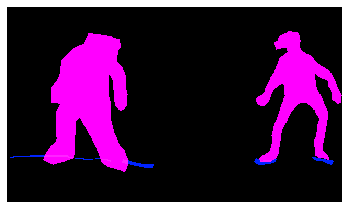

(373, 640, 3)
COCO_val2014_000000245411.jpg
{'person_bbx': [81.37, 0.96, 421.21, 424.09], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [81.37, 0.96, 421.21, 424.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.37, 0.96, 421.21, 424.09], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [313.04, 165.61, 626.08, 323.57000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


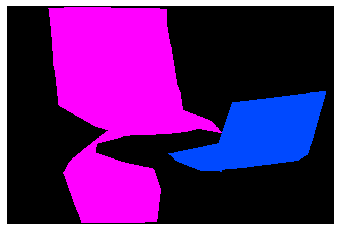

(426, 640, 3)
COCO_val2014_000000476258.jpg
{'person_bbx': [256.82, 37.01, 514.46, 306.32], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [256.82, 37.01, 514.46, 306.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [270.16, 250.29, 506.81000000000006, 347.47]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [256.82, 37.01, 514.46, 306.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


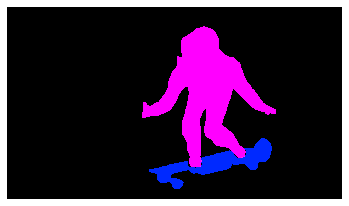

(367, 640, 3)
COCO_val2014_000000508949.jpg
{'person_bbx': [223.55, 199.85, 326.03000000000003, 360.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [223.55, 199.85, 326.03000000000003, 360.68], 'Verbs': 'look', 'object': {'obj_bbx': [308.28, 226.44, 362.71999999999997, 337.87]}}
dog
person
look
look interaction
{'person_bbx': [223.55, 199.85, 326.03000000000003, 360.68], 'Verbs': 'ski', 'object': {'obj_bbx': [224.58, 331.63, 329.94, 401.19]}}
person
skis
ski
ski interaction
{'person_bbx': [223.55, 199.85, 326.03000000000003, 360.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


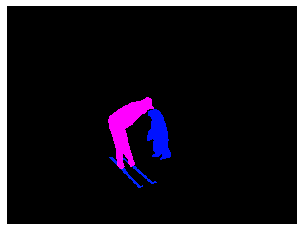

(480, 640, 3)
COCO_val2014_000000517967.jpg
{'person_bbx': [63.17, 81.45, 364.05, 583.48], 'Verbs': 'sit', 'object': {'obj_bbx': [264.97, 178.18, 398.92, 567.87]}}
chair
person
sit
sit interaction
{'person_bbx': [63.17, 81.45, 364.05, 583.48], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [95.08, 329.84, 251.82, 522.01]}}
laptop
person
work_on_computer
work_on_computer interaction


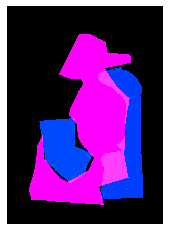

(640, 457, 3)
COCO_val2014_000000049258.jpg
{'person_bbx': [2.56, 71.86, 312.65, 289.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [137.58, 32.44, 500.0, 305.09]}}
person
laptop
work_on_computer
work_on_computer interaction


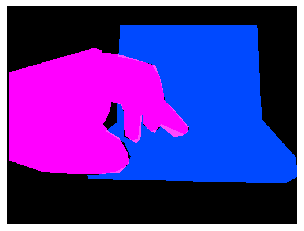

(375, 500, 3)
COCO_val2014_000000067537.jpg
{'person_bbx': [320.97, 11.33, 640.0, 414.22999999999996], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [275.66, 271.72, 379.47, 386.55]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [320.97, 11.33, 640.0, 414.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [275.66, 271.72, 379.47, 386.55]}}
person
spoon
hold
hold interaction
{'person_bbx': [320.97, 11.33, 640.0, 414.22999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [275.66, 271.72, 379.47, 386.55]}}
person
spoon
look
look interaction
{'person_bbx': [320.97, 11.33, 640.0, 414.22999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


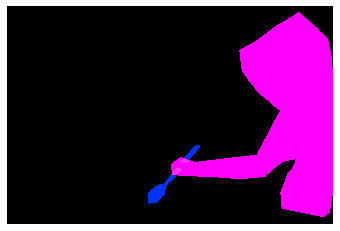

(427, 640, 3)
COCO_val2014_000000208995.jpg
{'person_bbx': [75.02, 78.35, 321.24, 425.38], 'Verbs': 'hold', 'object': {'obj_bbx': [273.39, 334.45, 321.87, 357.07]}}
person
mouse
hold
hold interaction
{'person_bbx': [75.02, 78.35, 321.24, 425.38], 'Verbs': 'look', 'object': {'obj_bbx': [256.0, 232.99, 386.88, 345.17]}}
person
laptop
look
look interaction
{'person_bbx': [75.02, 78.35, 321.24, 425.38], 'Verbs': 'sit', 'object': {'obj_bbx': [8.24, 227.91, 127.72999999999999, 574.01]}}
chair
person
sit
sit interaction
{'person_bbx': [75.02, 78.35, 321.24, 425.38], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [256.0, 232.99, 386.88, 345.17]}}
person
laptop
work_on_computer
work_on_computer interaction


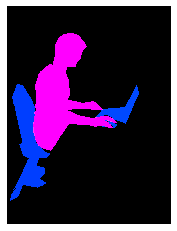

(640, 480, 3)
COCO_val2014_000000335325.jpg
{'person_bbx': [143.46, 156.4, 203.87, 283.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.91, 147.4, 130.48, 279.78], 'Verbs': 'look', 'object': {'obj_bbx': [143.46, 156.4, 203.87, 283.69]}}
person
person
look
look interaction
{'person_bbx': [336.54, 143.46, 472.45000000000005, 297.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [522.88, 159.84, 575.04, 304.96000000000004]}}
person
person
look
look interaction
{'person_bbx': [522.88, 159.84, 575.04, 304.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [336.54, 143.46, 472.45000000000005, 297.71000000000004]}}
person
person
look
look interaction
{'person_bbx': [60.91, 147.4, 130.48, 279.78], 'Verbs': 'ski', 'object': {'obj_bbx': [61.47, 269.39, 135.88, 279.39]}}
person
skis
ski
ski interaction
{'person_bbx': [336.54, 143.46, 472.45000000000005, 297.71000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [359.51, 288.34, 462.84, 304.82]}}
skis
pers

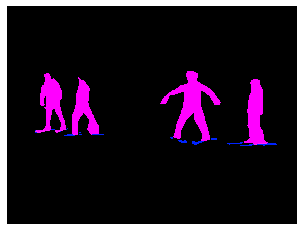

(480, 640, 3)
COCO_val2014_000000257656.jpg
{'person_bbx': [213.76, 29.9, 558.56, 473.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [213.76, 29.9, 558.56, 473.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


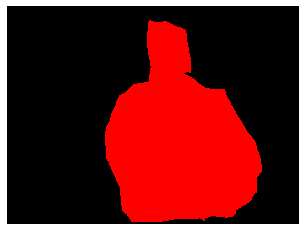

(478, 640, 3)
COCO_val2014_000000580778.jpg
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [219.51, 62.86, 342.23, 131.7]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [416.16, 274.14, 440.08000000000004, 295.7]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [219.51, 62.86, 342.23, 131.7]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [416.16, 274.14, 440.08000000000004, 295.7]}}
sports ball
person
look
look interaction
{'person_bbx': [294.66, 11.78, 567.28, 433.72999999999996], 'Verbs': 'run', 'object': {'obj_bb

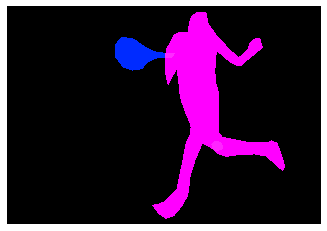

(444, 640, 3)
COCO_val2014_000000404718.jpg
{'person_bbx': [271.58, 154.06, 379.45, 283.0], 'Verbs': 'ride', 'object': {'obj_bbx': [290.63, 221.31, 372.67, 279.82]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [23.52, 131.58, 100.7, 266.83000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [13.99, 195.24, 117.02, 278.55]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [271.58, 154.06, 379.45, 283.0], 'Verbs': 'sit', 'object': {'obj_bbx': [290.63, 221.31, 372.67, 279.82]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [23.52, 131.58, 100.7, 266.83000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [13.99, 195.24, 117.02, 278.55]}}
motorcycle
person
sit
sit interaction


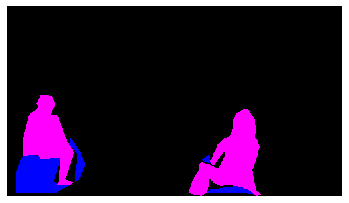

(283, 500, 3)
COCO_val2014_000000010779.jpg
{'person_bbx': [43.15, 24.45, 503.37, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [43.15, 24.45, 503.37, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


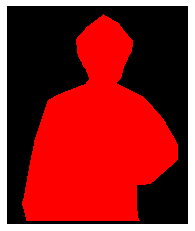

(640, 532, 3)
COCO_val2014_000000067975.jpg
{'person_bbx': [136.99, 37.82, 377.53, 440.15999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [298.75, 105.09, 504.37, 236.06]}}
person
kite
carry
carry interaction
{'person_bbx': [136.99, 37.82, 377.53, 440.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [298.75, 105.09, 504.37, 236.06]}}
person
kite
hold
hold interaction
{'person_bbx': [136.99, 37.82, 377.53, 440.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [2.16, 188.11, 200.0, 338.38]}}
car
person
look
look interaction
{'person_bbx': [136.99, 37.82, 377.53, 440.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [136.99, 37.82, 377.53, 440.15999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


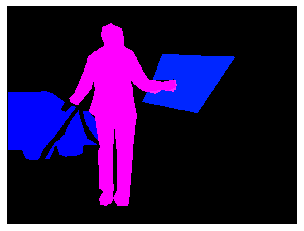

(480, 640, 3)
COCO_val2014_000000539565.jpg
{'person_bbx': [387.76, 247.63, 478.55, 501.22], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [387.76, 247.63, 478.55, 501.22], 'Verbs': 'skateboard', 'object': {'obj_bbx': [371.03, 448.73, 423.5, 503.07000000000005]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [6.9, 248.29, 86.97, 410.15999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [0.82, 395.29, 73.94999999999999, 415.1]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [387.76, 247.63, 478.55, 501.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [6.9, 248.29, 86.97, 410.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


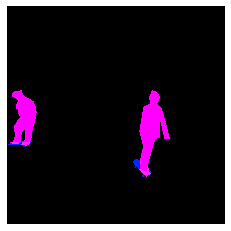

(640, 640, 3)
COCO_val2014_000000054750.jpg
{'person_bbx': [384.69, 169.06, 510.5, 236.18], 'Verbs': 'hold', 'object': {'obj_bbx': [227.75, 43.42, 273.7, 84.43]}}
person
kite
hold
hold interaction
{'person_bbx': [384.69, 169.06, 510.5, 236.18], 'Verbs': 'jump', 'object': {'obj_bbx': [490.22, 143.07, 543.45, 208.51]}}
person
surfboard
jump
jump interaction
{'person_bbx': [384.69, 169.06, 510.5, 236.18], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [384.69, 169.06, 510.5, 236.18], 'Verbs': 'surf', 'object': {'obj_bbx': [490.22, 143.07, 543.45, 208.51]}}
person
surfboard
surf
surf interaction


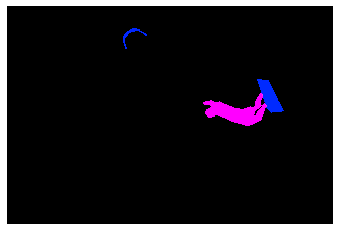

(427, 640, 3)
COCO_val2014_000000509826.jpg
{'person_bbx': [300.07, 422.31, 421.03999999999996, 576.12], 'Verbs': 'look', 'object': {'obj_bbx': [342.36, 534.73, 423.64, 565.01]}}
person
skateboard
look
look interaction
{'person_bbx': [300.07, 422.31, 421.03999999999996, 576.12], 'Verbs': 'skateboard', 'object': {'obj_bbx': [342.36, 534.73, 423.64, 565.01]}}
person
skateboard
skateboard
skateboard interaction


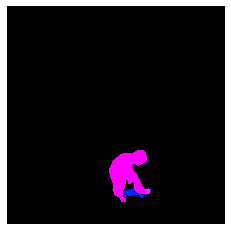

(640, 640, 3)
COCO_val2014_000000390099.jpg
{'person_bbx': [0.0, 189.63, 296.02, 493.92], 'Verbs': 'hold', 'object': {'obj_bbx': [115.71, 290.26, 252.18, 461.15999999999997]}}
person
person
hold
hold interaction
{'person_bbx': [0.0, 189.63, 296.02, 493.92], 'Verbs': 'look', 'object': {'obj_bbx': [164.94, 422.48, 222.46, 461.62]}}
mouse
person
look
look interaction
{'person_bbx': [0.0, 189.63, 296.02, 493.92], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 189.63, 296.02, 493.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 189.63, 296.02, 493.92], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [208.56, 314.64, 455.33000000000004, 548.76]}}
laptop
person
work_on_computer
work_on_computer interaction


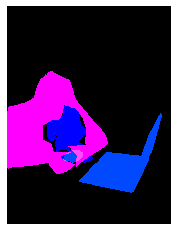

(640, 480, 3)
COCO_val2014_000000502163.jpg
{'person_bbx': [0.0, 80.77, 279.94, 420.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [49.78, 156.04, 134.01999999999998, 239.32999999999998]}}
frisbee
person
hold
hold interaction
{'person_bbx': [245.07, 159.76, 610.76, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 80.77, 279.94, 420.46999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 80.77, 279.94, 420.46999999999997], 'Verbs': 'throw', 'object': {'obj_bbx': [49.78, 156.04, 134.01999999999998, 239.32999999999998]}}
frisbee
person
throw
throw interaction


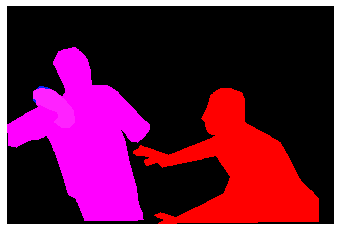

(426, 640, 3)
COCO_val2014_000000195750.jpg
{'person_bbx': [219.55, 199.26, 296.55, 415.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [537.54, 98.37, 601.5899999999999, 275.94], 'Verbs': 'hold', 'object': {'obj_bbx': [547.76, 172.74, 566.91, 197.0]}}
handbag
person
hold
hold interaction
{'person_bbx': [2.17, 94.85, 64.14, 273.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [372.53, 134.06, 443.30999999999995, 246.65], 'Verbs': 'sit', 'object': {'obj_bbx': [383.94, 182.98, 444.18, 271.15]}}
chair
person
sit
sit interaction
{'person_bbx': [154.44, 103.23, 205.13, 274.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [219.55, 199.26, 296.55, 415.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [289.4, 86.92, 351.40999999999997, 272.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [537.54, 98.37, 601.5899999999999, 275.94], 'Verbs': 'stand', 'object'

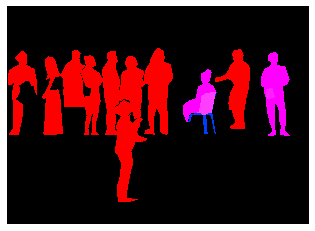

(462, 640, 3)
COCO_val2014_000000426635.jpg
{'person_bbx': [5.95, 73.57, 184.98999999999998, 377.51], 'Verbs': 'kick', 'object': {'obj_bbx': [23.66, 347.85, 66.92, 387.58000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [5.95, 73.57, 184.98999999999998, 377.51], 'Verbs': 'look', 'object': {'obj_bbx': [23.66, 347.85, 66.92, 387.58000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [5.95, 73.57, 184.98999999999998, 377.51], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [5.95, 73.57, 184.98999999999998, 377.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


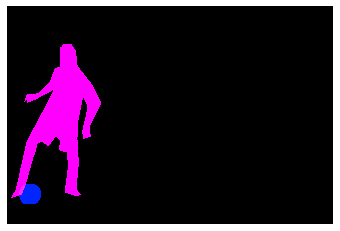

(427, 640, 3)
COCO_val2014_000000166696.jpg
{'person_bbx': [370.76, 90.12, 499.62, 294.87], 'Verbs': 'catch', 'object': {'obj_bbx': [400.55, 71.8, 413.63, 83.03999999999999]}}
sports ball
person
catch
catch interaction
{'person_bbx': [0.0, 57.64, 131.53, 346.84], 'Verbs': 'hold', 'object': {'obj_bbx': [82.03, 218.73, 129.62, 253.16]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [370.76, 90.12, 499.62, 294.87], 'Verbs': 'look', 'object': {'obj_bbx': [400.55, 71.8, 413.63, 83.03999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 57.64, 131.53, 346.84], 'Verbs': 'look', 'object': {'obj_bbx': [400.55, 71.8, 413.63, 83.03999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [370.76, 90.12, 499.62, 294.87], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 57.64, 131.53, 346.84], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [182.2, 89.68, 312.35, 284.5], 'Verbs': 'run', 'object': {'obj

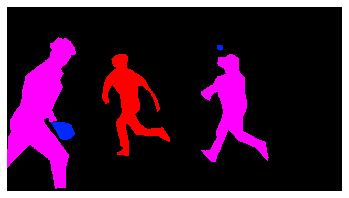

(351, 640, 3)
COCO_val2014_000000439658.jpg
{'person_bbx': [269.76, 105.92, 450.57, 629.16], 'Verbs': 'hold', 'object': {'obj_bbx': [254.97, 177.97, 458.61, 640.0]}}
person
skis
hold
hold interaction
{'person_bbx': [133.75, 81.54, 281.89, 637.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [29.61, 171.81, 163.72000000000003, 640.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [269.76, 105.92, 450.57, 629.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.75, 81.54, 281.89, 637.3199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [269.76, 105.92, 450.57, 629.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.75, 81.54, 281.89, 637.3199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


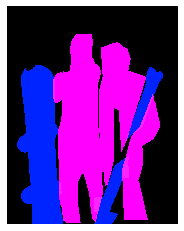

(640, 502, 3)
COCO_val2014_000000491215.jpg
{'person_bbx': [53.33, 54.77, 481.44, 461.26], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [53.33, 54.77, 481.44, 461.26], 'Verbs': 'snowboard', 'object': {'obj_bbx': [50.49, 371.17, 101.09, 453.07000000000005]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [53.33, 54.77, 481.44, 461.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


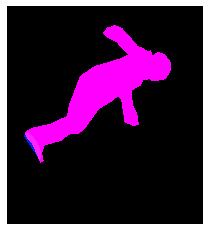

(640, 574, 3)
COCO_val2014_000000061693.jpg
{'person_bbx': [278.12, 63.25, 640.0, 433.96], 'Verbs': 'look', 'object': {'obj_bbx': [130.91, 255.38, 303.81, 432.41999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [278.12, 63.25, 640.0, 433.96], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [278.12, 63.25, 640.0, 433.96], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [130.91, 255.38, 303.81, 432.41999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


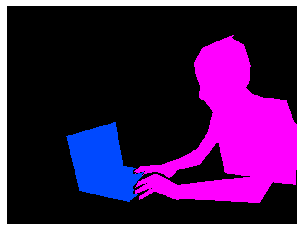

(480, 640, 3)
COCO_val2014_000000554928.jpg
{'person_bbx': [77.04, 188.74, 105.09, 265.32], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [25.95, 194.59, 50.81, 271.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [233.28, 160.8, 271.71, 246.20000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [213.36, 238.2, 272.0, 251.04999999999998]}}
person
skis
ski
ski interaction
{'person_bbx': [77.04, 188.74, 105.09, 265.32], 'Verbs': 'ski', 'object': {'obj_bbx': [61.4, 253.63, 113.47999999999999, 270.24]}}
person
skis
ski
ski interaction
{'person_bbx': [25.95, 194.59, 50.81, 271.35], 'Verbs': 'ski', 'object': {'obj_bbx': [20.29, 259.86, 58.57, 272.42]}}
person
skis
ski
ski interaction
{'person_bbx': [233.28, 160.8, 271.71, 246.20000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [77.04, 188.74, 105.09, 265.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [25.95, 194.59, 50.81,

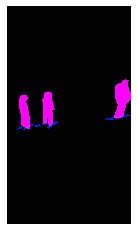

(480, 272, 3)
COCO_val2014_000000417216.jpg
{'person_bbx': [182.62, 176.7, 279.08, 347.54999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': [194.35, 323.83, 277.27, 356.11]}}
person
skateboard
jump
jump interaction
{'person_bbx': [182.62, 176.7, 279.08, 347.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [194.35, 323.83, 277.27, 356.11]}}
person
skateboard
look
look interaction
{'person_bbx': [182.62, 176.7, 279.08, 347.54999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [194.35, 323.83, 277.27, 356.11]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [182.62, 176.7, 279.08, 347.54999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


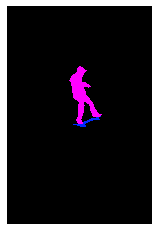

(640, 426, 3)
COCO_val2014_000000109503.jpg
{'person_bbx': [38.82, 66.7, 194.12, 425.08], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [38.82, 66.7, 194.12, 425.08], 'Verbs': 'look', 'object': {'obj_bbx': [271.35, 80.3, 348.37, 119.8]}}
person
frisbee
look
look interaction
{'person_bbx': [38.82, 66.7, 194.12, 425.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [38.82, 66.7, 194.12, 425.08], 'Verbs': 'throw', 'object': {'obj_bbx': [271.35, 80.3, 348.37, 119.8]}}
person
frisbee
throw
throw interaction


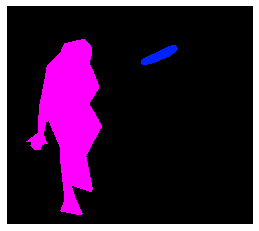

(443, 500, 3)
COCO_val2014_000000463640.jpg
{'person_bbx': [250.25, 14.38, 615.0, 638.56], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [156.97, 372.74, 268.08, 475.7]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [250.25, 14.38, 615.0, 638.56], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [4.31, 419.96, 243.06, 570.97]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [250.25, 14.38, 615.0, 638.56], 'Verbs': 'hold', 'object': {'obj_bbx': [156.97, 372.74, 268.08, 475.7]}}
person
knife
hold
hold interaction
{'person_bbx': [250.25, 14.38, 615.0, 638.56], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [250.25, 14.38, 615.0, 638.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


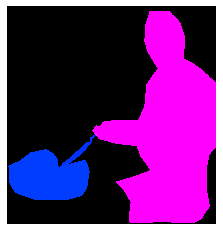

(640, 615, 3)
COCO_val2014_000000290196.jpg
{'person_bbx': [340.37, 306.06, 382.18, 401.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [428.11, 285.45, 458.8, 357.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [340.37, 306.06, 382.18, 401.87], 'Verbs': 'ski', 'object': {'obj_bbx': [323.6, 385.08, 407.73, 412.03999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [428.11, 285.45, 458.8, 357.78999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [428.01, 340.27, 458.25, 364.46999999999997]}}
skis
person
ski
ski interaction
{'person_bbx': [340.37, 306.06, 382.18, 401.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [428.11, 285.45, 458.8, 357.78999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


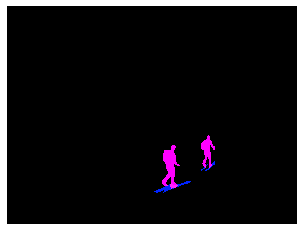

(480, 640, 3)
COCO_val2014_000000325991.jpg
{'person_bbx': [145.94, 43.25, 342.27, 334.0], 'Verbs': 'hold', 'object': {'obj_bbx': [319.76, 218.69, 370.46999999999997, 233.79]}}
person
frisbee
hold
hold interaction
{'person_bbx': [145.94, 43.25, 342.27, 334.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [145.94, 43.25, 342.27, 334.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [145.94, 43.25, 342.27, 334.0], 'Verbs': 'throw', 'object': {'obj_bbx': [319.76, 218.69, 370.46999999999997, 233.79]}}
person
frisbee
throw
throw interaction


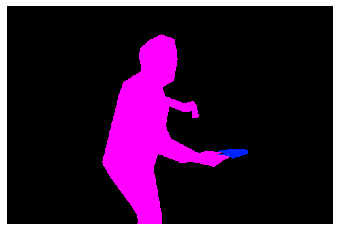

(334, 500, 3)
COCO_val2014_000000552947.jpg
{'person_bbx': [54.65, 1.44, 478.91999999999996, 629.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [237.33, 268.46, 280.87, 317.83]}}
cell phone
person
hold
hold interaction
{'person_bbx': [54.65, 1.44, 478.91999999999996, 629.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [54.65, 1.44, 478.91999999999996, 629.9300000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [237.33, 268.46, 280.87, 317.83]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


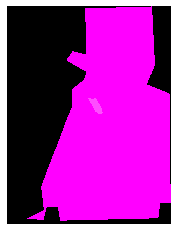

(640, 480, 3)
COCO_val2014_000000122413.jpg
{'person_bbx': [316.22, 100.75, 407.67, 231.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [316.22, 100.75, 407.67, 231.51], 'Verbs': 'look', 'object': {'obj_bbx': [183.83, 73.62, 231.63, 120.69]}}
person
sports ball
look
look interaction
{'person_bbx': [316.22, 100.75, 407.67, 231.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


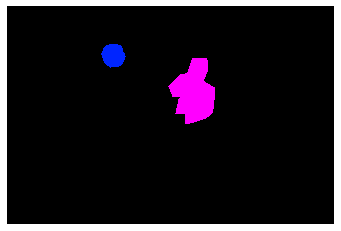

(426, 640, 3)
COCO_val2014_000000470005.jpg
{'person_bbx': [227.29, 102.55, 517.35, 370.73], 'Verbs': 'look', 'object': {'obj_bbx': [65.25, 74.68, 319.53, 297.3]}}
person
laptop
look
look interaction
{'person_bbx': [227.29, 102.55, 517.35, 370.73], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 1.02, 640.0, 421.31]}}
bed
person
sit
sit interaction
{'person_bbx': [227.29, 102.55, 517.35, 370.73], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [65.25, 74.68, 319.53, 297.3]}}
person
laptop
work_on_computer
work_on_computer interaction


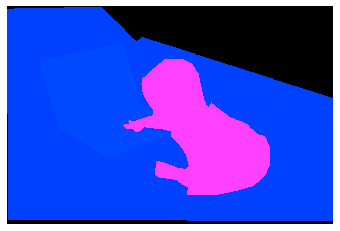

(427, 640, 3)
COCO_val2014_000000072536.jpg
{'person_bbx': [261.34, 0.61, 640.0, 316.14], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [3.23, 199.1, 575.78, 473.53999999999996]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [261.34, 0.61, 640.0, 316.14], 'Verbs': 'hold', 'object': {'obj_bbx': [3.23, 199.1, 575.78, 473.53999999999996]}}
person
pizza
hold
hold interaction
{'person_bbx': [261.34, 0.61, 640.0, 316.14], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


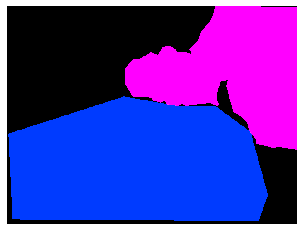

(480, 640, 3)
COCO_val2014_000000466766.jpg
{'person_bbx': [442.35, 307.32, 515.5500000000001, 405.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [549.08, 64.6, 638.0, 212.79999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [390.89, 194.45, 444.59, 308.88], 'Verbs': 'hold', 'object': {'obj_bbx': [417.23, 225.56, 442.83000000000004, 270.0]}}
handbag
person
hold
hold interaction
{'person_bbx': [293.2, 133.93, 380.99, 291.73], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [164.75, 260.17, 262.06, 407.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [35.1, 246.88, 159.25, 392.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [263.19, 228.69, 348.97, 365.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [390.89, 194.45, 444.59, 308.88], 'Verbs': 'look', 'object': {'obj_bbx': [428.72, 145.04, 509.17, 2

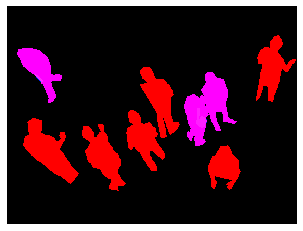

(481, 640, 3)
COCO_val2014_000000051324.jpg
{'person_bbx': [25.89, 21.03, 245.39, 237.3], 'Verbs': 'hold', 'object': {'obj_bbx': [204.96, 46.43, 214.24, 54.55]}}
cell phone
person
hold
hold interaction
{'person_bbx': [25.89, 21.03, 245.39, 237.3], 'Verbs': 'sit', 'object': {'obj_bbx': [120.81, 105.71, 320.0, 236.76]}}
person
bench
sit
sit interaction
{'person_bbx': [25.89, 21.03, 245.39, 237.3], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [204.96, 46.43, 214.24, 54.55]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


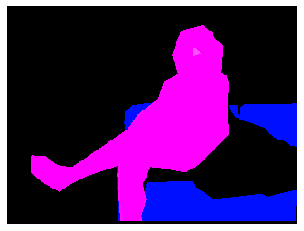

(240, 320, 3)
COCO_val2014_000000116455.jpg
{'person_bbx': [260.31, 271.82, 402.7, 497.62], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [260.31, 271.82, 402.7, 497.62], 'Verbs': 'hold', 'object': {'obj_bbx': [258.88, 346.7, 431.46000000000004, 565.31]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [260.31, 271.82, 402.7, 497.62], 'Verbs': 'ride', 'object': {'obj_bbx': [258.88, 346.7, 431.46000000000004, 565.31]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [260.31, 271.82, 402.7, 497.62], 'Verbs': 'sit', 'object': {'obj_bbx': [258.88, 346.7, 431.46000000000004, 565.31]}}
motorcycle
person
sit
sit interaction


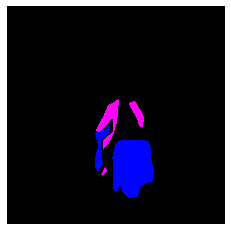

(640, 640, 3)
COCO_val2014_000000479280.jpg
{'person_bbx': [108.11, 152.68, 496.92, 417.26], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


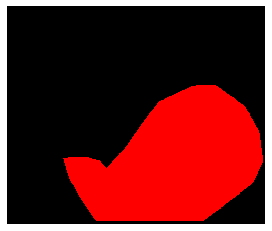

(422, 500, 3)
COCO_val2014_000000463678.jpg
{'person_bbx': [183.27, 36.46, 404.93, 397.25], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [271.42, 47.09, 295.5, 70.85000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [183.27, 36.46, 404.93, 397.25], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [511.31, 70.63, 530.5, 89.94]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [183.27, 36.46, 404.93, 397.25], 'Verbs': 'hold', 'object': {'obj_bbx': [271.42, 47.09, 295.5, 70.85000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [183.27, 36.46, 404.93, 397.25], 'Verbs': 'look', 'object': {'obj_bbx': [511.31, 70.63, 530.5, 89.94]}}
sports ball
person
look
look interaction
{'person_bbx': [183.27, 36.46, 404.93, 397.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


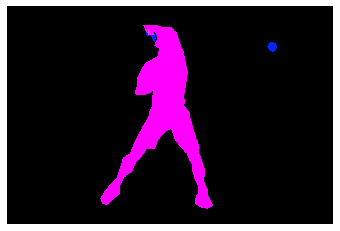

(427, 640, 3)
COCO_val2014_000000291619.jpg
{'person_bbx': [341.41, 100.02, 429.89000000000004, 283.7], 'Verbs': 'catch', 'object': {'obj_bbx': [407.44, 117.13, 434.42, 129.25]}}
person
frisbee
catch
catch interaction
{'person_bbx': [131.0, 129.08, 230.51999999999998, 322.25], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [341.41, 100.02, 429.89000000000004, 283.7], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [341.41, 100.02, 429.89000000000004, 283.7], 'Verbs': 'look', 'object': {'obj_bbx': [407.44, 117.13, 434.42, 129.25]}}
person
frisbee
look
look interaction
{'person_bbx': [131.0, 129.08, 230.51999999999998, 322.25], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [131.0, 129.08, 230.51999999999998, 322.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


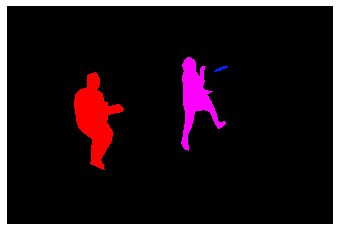

(427, 640, 3)
COCO_val2014_000000386912.jpg
{'person_bbx': [210.27, 143.29, 430.09000000000003, 419.43999999999994], 'Verbs': 'sit', 'object': {'obj_bbx': [383.97, 247.49, 431.41, 419.77]}}
person
chair
sit
sit interaction
{'person_bbx': [210.27, 143.29, 430.09000000000003, 419.43999999999994], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [210.27, 143.29, 430.09000000000003, 419.43999999999994], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


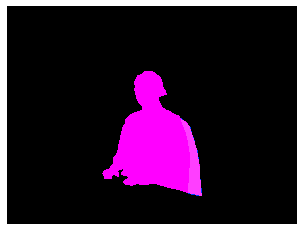

(480, 640, 3)
COCO_val2014_000000070744.jpg
{'person_bbx': [553.1, 102.68, 640.0, 260.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.86, 110.03, 410.0, 264.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 83.48, 84.99, 178.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.86, 110.03, 410.0, 264.72], 'Verbs': 'look', 'object': {'obj_bbx': [381.03, 107.13, 438.38, 199.16]}}
person
person
look
look interaction
{'person_bbx': [0.0, 83.48, 84.99, 178.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [553.1, 102.68, 640.0, 260.45000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [599.87, 228.27, 636.06, 308.81]}}
person
chair
sit
sit interaction
{'person_bbx': [473.47, 97.14, 562.45, 204.07999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [326.86, 110.03, 410.0, 264.72], 'Verbs': 'sit', 'object': {'obj_bbx': [323.88, 188.9

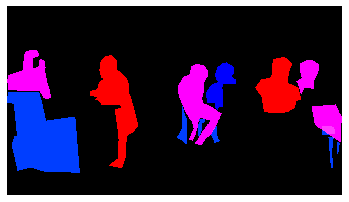

(360, 640, 3)
COCO_val2014_000000581422.jpg
{'person_bbx': [48.74, 68.13, 235.93, 491.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [213.75, 92.89, 382.73, 491.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [48.74, 68.13, 235.93, 491.35]}}
person
person
look
look interaction
{'person_bbx': [48.74, 68.13, 235.93, 491.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [48.74, 68.13, 235.93, 491.35], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [213.75, 92.89, 382.73, 491.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 341.14, 91.77, 489.98]}}
person
bench
sit
sit interaction
{'person_bbx': [48.74, 68.13, 235.93, 491.35], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 341.14, 91.77, 489.98]}}
person
bench
sit
sit interaction
{'person_bbx': [213.75, 92.89, 382.73, 491.28999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


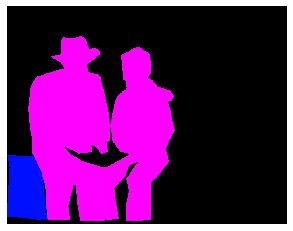

(498, 640, 3)
COCO_val2014_000000073009.jpg
{'person_bbx': [82.02, 95.51, 316.85, 378.65], 'Verbs': 'hold', 'object': {'obj_bbx': [168.61, 192.77, 289.67, 279.63]}}
person
book
hold
hold interaction
{'person_bbx': [82.02, 95.51, 316.85, 378.65], 'Verbs': 'read', 'object': {'obj_bbx': [168.61, 192.77, 289.67, 279.63]}}
person
book
read
read interaction
{'person_bbx': [82.02, 95.51, 316.85, 378.65], 'Verbs': 'sit', 'object': {'obj_bbx': [140.12, 286.56, 211.22, 392.53]}}
toilet
person
sit
sit interaction
{'person_bbx': [82.02, 95.51, 316.85, 378.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


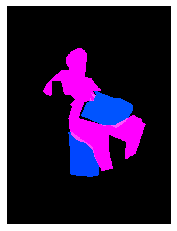

(500, 375, 3)
COCO_val2014_000000045626.jpg
{'person_bbx': [182.27, 239.23, 338.67, 370.92999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [512.82, 220.52, 523.2800000000001, 229.32000000000002]}}
person
sports ball
look
look interaction
{'person_bbx': [63.33, 181.36, 166.95999999999998, 383.82000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [522.59, 218.98, 531.2900000000001, 227.04999999999998]}}
person
sports ball
look
look interaction
{'person_bbx': [182.27, 239.23, 338.67, 370.92999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [63.33, 181.36, 166.95999999999998, 383.82000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


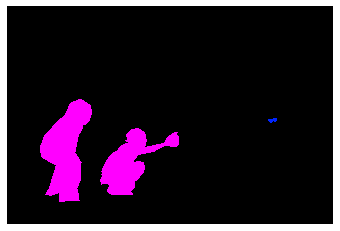

(427, 640, 3)
COCO_val2014_000000069757.jpg
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [301.4, 399.57, 436.52, 436.8]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [390.63, 406.49, 446.85, 442.52]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [390.63, 406.49, 446.85, 442.52]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [301.4, 399.57, 436.52, 436.8]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'hold', 'object': {'obj_bbx': [301.4, 399.57, 436.52, 436.8]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 50.25, 316.42, 632.98], 'Verbs': 'sit', 'object': {'obj_bbx': [162.49, 490.11, 298.45000000000005, 631.05]}}
person
chair
sit

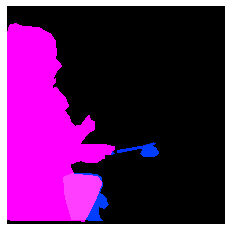

(640, 640, 3)
COCO_val2014_000000448705.jpg
{'person_bbx': [154.63, 98.93, 342.19, 632.98], 'Verbs': 'ride', 'object': {'obj_bbx': [12.36, 201.61, 293.91, 639.73]}}
horse
person
ride
ride interaction
{'person_bbx': [263.62, 110.12, 375.29, 638.18], 'Verbs': 'ride', 'object': {'obj_bbx': [12.36, 201.61, 293.91, 639.73]}}
horse
person
ride
ride interaction
{'person_bbx': [154.63, 98.93, 342.19, 632.98], 'Verbs': 'sit', 'object': {'obj_bbx': [12.36, 201.61, 293.91, 639.73]}}
horse
person
sit
sit interaction
{'person_bbx': [263.62, 110.12, 375.29, 638.18], 'Verbs': 'sit', 'object': {'obj_bbx': [12.36, 201.61, 293.91, 639.73]}}
horse
person
sit
sit interaction
{'person_bbx': [154.63, 98.93, 342.19, 632.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [263.62, 110.12, 375.29, 638.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


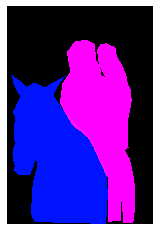

(640, 427, 3)
COCO_val2014_000000282680.jpg
{'person_bbx': [182.2, 227.99, 342.88, 387.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.2, 227.99, 342.88, 387.40999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [266.77, 384.33, 340.63, 407.29999999999995]}}
person
surfboard
surf
surf interaction


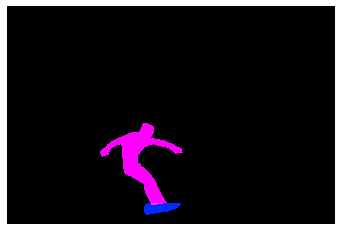

(425, 640, 3)
COCO_val2014_000000237487.jpg
{'person_bbx': [120.86, 185.98, 292.32, 349.95], 'Verbs': 'catch', 'object': {'obj_bbx': [497.04, 247.87, 515.83, 260.95]}}
sports ball
person
catch
catch interaction
{'person_bbx': [398.06, 85.08, 553.0699999999999, 347.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [366.06, 183.79, 419.21, 195.18]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [398.06, 85.08, 553.0699999999999, 347.01], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [497.04, 247.87, 515.83, 260.95]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [398.06, 85.08, 553.0699999999999, 347.01], 'Verbs': 'hold', 'object': {'obj_bbx': [366.06, 183.79, 419.21, 195.18]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [120.86, 185.98, 292.32, 349.95], 'Verbs': 'look', 'object': {'obj_bbx': [497.04, 247.87, 515.83, 260.95]}}
sports ball
person
look
look interaction
{'person_bbx': [31.22, 134.32, 163.23, 344.27], 'Verbs': 'stand', 'object': {

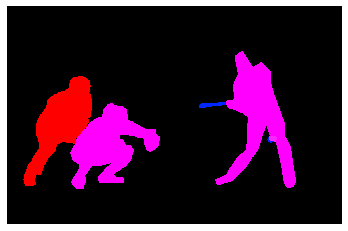

(416, 640, 3)
COCO_val2014_000000303543.jpg
{'person_bbx': [261.48, 48.74, 357.74, 263.9], 'Verbs': 'carry', 'object': {'obj_bbx': [215.9, 123.78, 460.58000000000004, 192.87]}}
person
surfboard
carry
carry interaction
{'person_bbx': [392.61, 66.01, 470.94, 242.73000000000002], 'Verbs': 'carry', 'object': {'obj_bbx': [345.62, 103.74, 523.45, 245.39999999999998]}}
person
surfboard
carry
carry interaction
{'person_bbx': [261.48, 48.74, 357.74, 263.9], 'Verbs': 'hold', 'object': {'obj_bbx': [215.9, 123.78, 460.58000000000004, 192.87]}}
person
surfboard
hold
hold interaction
{'person_bbx': [392.61, 66.01, 470.94, 242.73000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [345.62, 103.74, 523.45, 245.39999999999998]}}
person
surfboard
hold
hold interaction
{'person_bbx': [392.61, 66.01, 470.94, 242.73000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [345.62, 103.74, 523.45, 245.39999999999998]}}
person
surfboard
look
look interaction
{'person_bbx': [261.48, 48.74, 357.74, 263.9], 'Verbs

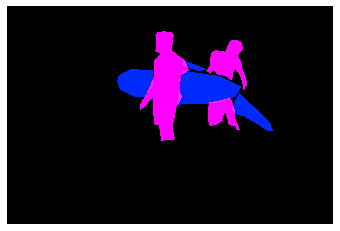

(427, 640, 3)
COCO_val2014_000000409221.jpg
{'person_bbx': [54.44, 76.84, 330.62, 524.18], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [54.44, 76.84, 330.62, 524.18], 'Verbs': 'look', 'object': {'obj_bbx': [151.77, 1.57, 257.72, 76.02]}}
frisbee
person
look
look interaction


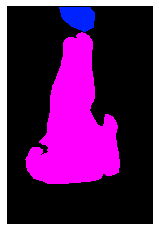

(640, 427, 3)
COCO_val2014_000000387645.jpg
{'person_bbx': [423.1, 86.76, 592.47, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [426.17, 159.82, 459.45000000000005, 278.49]}}
person
wine glass
hold
hold interaction
{'person_bbx': [515.03, 33.37, 622.3399999999999, 359.68], 'Verbs': 'hold', 'object': {'obj_bbx': [436.21, 73.52, 461.84, 160.91]}}
person
wine glass
hold
hold interaction
{'person_bbx': [4.04, 50.97, 144.0, 230.56], 'Verbs': 'look', 'object': {'obj_bbx': [423.1, 86.76, 592.47, 360.0]}}
person
person
look
look interaction
{'person_bbx': [423.1, 86.76, 592.47, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [4.04, 50.97, 144.0, 230.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [515.03, 33.37, 622.3399999999999, 359.68], 'Verbs': 'sit', 'object': {'obj_bbx': [480.0, 207.86, 637.05, 348.8]}}
chair
person
sit
sit interaction
{'person_bbx': [423.1, 86.76, 592.47, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
perso

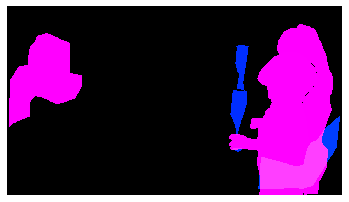

(360, 640, 3)
COCO_val2014_000000499105.jpg
{'person_bbx': [115.72, 154.98, 220.95999999999998, 311.24], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [95.64, 154.33, 146.01, 178.85000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [115.72, 154.98, 220.95999999999998, 311.24], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [147.17, 131.96, 158.48999999999998, 142.96]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [115.72, 154.98, 220.95999999999998, 311.24], 'Verbs': 'hold', 'object': {'obj_bbx': [95.64, 154.33, 146.01, 178.85000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [115.72, 154.98, 220.95999999999998, 311.24], 'Verbs': 'look', 'object': {'obj_bbx': [147.17, 131.96, 158.48999999999998, 142.96]}}
sports ball
person
look
look interaction
{'person_bbx': [115.72, 154.98, 220.95999999999998, 311.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


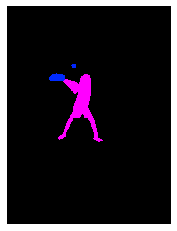

(500, 375, 3)
COCO_val2014_000000013985.jpg
{'person_bbx': [235.5, 15.32, 541.8299999999999, 419.3], 'Verbs': 'look', 'object': {'obj_bbx': [150.01, 221.65, 339.45, 365.9]}}
person
laptop
look
look interaction
{'person_bbx': [235.5, 15.32, 541.8299999999999, 419.3], 'Verbs': 'sit', 'object': {'obj_bbx': [275.36, 242.26, 544.01, 421.67999999999995]}}
chair
person
sit
sit interaction
{'person_bbx': [235.5, 15.32, 541.8299999999999, 419.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [150.01, 221.65, 339.45, 365.9]}}
person
laptop
work_on_computer
work_on_computer interaction


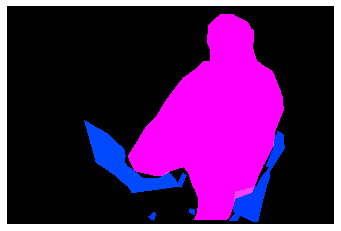

(426, 640, 3)
COCO_val2014_000000298344.jpg
{'person_bbx': [220.36, 199.81, 313.45000000000005, 237.84], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [220.36, 199.81, 313.45000000000005, 237.84], 'Verbs': 'surf', 'object': {'obj_bbx': [241.08, 228.69, 302.6, 245.96]}}
person
surfboard
surf
surf interaction


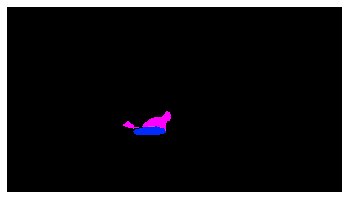

(354, 640, 3)
COCO_val2014_000000040757.jpg
{'person_bbx': [1.29, 262.21, 401.26000000000005, 532.05], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 261.51, 422.83, 634.01]}}
person
bed
lay
lay interaction
{'person_bbx': [1.29, 262.21, 401.26000000000005, 532.05], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


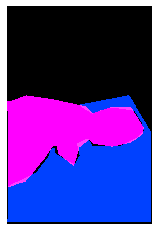

(640, 425, 3)
COCO_val2014_000000086147.jpg
{'person_bbx': [142.97, 0.0, 337.76, 421.24], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [269.94, 328.84, 373.69, 344.08]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [142.97, 0.0, 337.76, 421.24], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [327.72, 290.61, 523.39, 426.52]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [11.12, 40.59, 247.97, 422.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [269.94, 328.84, 373.69, 344.08]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [11.12, 40.59, 247.97, 422.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [327.72, 290.61, 523.39, 426.52]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [142.97, 0.0, 337.76, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [269.94, 328.84, 373.69, 344.08]}}
person
knife
hold
hold interaction
{'person_bbx': [11.12, 40.59, 247.97, 422.0], 'Verbs': 'hold', 'object': {'obj_bbx': [269.94, 328.84, 373.69, 344.08]}}
knife
person
ho

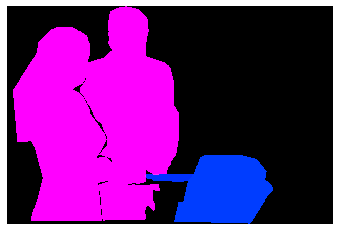

(427, 640, 3)
COCO_val2014_000000571029.jpg
{'person_bbx': [50.0, 66.59, 558.7, 327.19000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': [533.19, 303.16, 609.3700000000001, 321.08000000000004]}}
person
frisbee
catch
catch interaction
{'person_bbx': [50.0, 66.59, 558.7, 327.19000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [533.19, 303.16, 609.3700000000001, 321.08000000000004]}}
person
frisbee
hold
hold interaction
{'person_bbx': [50.0, 66.59, 558.7, 327.19000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [50.0, 66.59, 558.7, 327.19000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [533.19, 303.16, 609.3700000000001, 321.08000000000004]}}
person
frisbee
look
look interaction


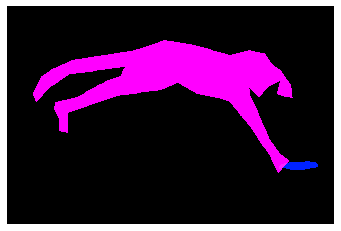

(426, 640, 3)
COCO_val2014_000000207611.jpg
{'person_bbx': [288.38, 19.54, 446.2, 479.1], 'Verbs': 'carry', 'object': {'obj_bbx': [409.92, 276.8, 484.72, 410.43]}}
person
handbag
carry
carry interaction
{'person_bbx': [288.38, 19.54, 446.2, 479.1], 'Verbs': 'hold', 'object': {'obj_bbx': [409.92, 276.8, 484.72, 410.43]}}
person
handbag
hold
hold interaction
{'person_bbx': [288.38, 19.54, 446.2, 479.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [288.38, 19.54, 446.2, 479.1], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


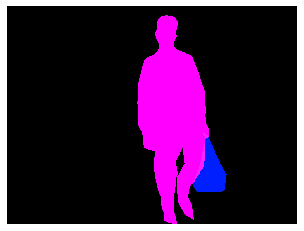

(480, 640, 3)
COCO_val2014_000000232845.jpg
{'person_bbx': [271.87, 42.12, 532.26, 297.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [148.31, 54.7, 259.81, 292.41], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [255.83, 65.21, 412.54, 287.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [271.87, 42.12, 532.26, 297.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [39.0, 280.6, 639.0, 420.6]}}
dining table
person
look
look interaction
{'person_bbx': [148.31, 54.7, 259.81, 292.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [255.83, 65.21, 412.54, 287.27], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [271.87, 42.12, 532.26, 297.71999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [148.31, 54.7, 259.81, 292.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [255.83, 65.21, 4

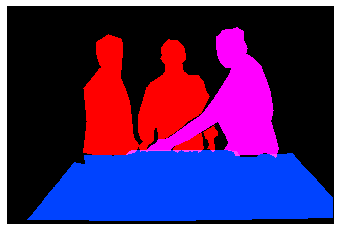

(426, 640, 3)
COCO_val2014_000000467477.jpg
{'person_bbx': [222.67, 143.5, 325.59, 266.17], 'Verbs': 'surf', 'object': {'obj_bbx': [219.72, 247.59, 293.6, 284.42]}}
person
surfboard
surf
surf interaction


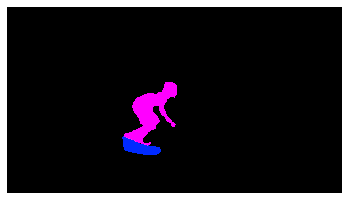

(356, 640, 3)
COCO_val2014_000000089557.jpg
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [171.88, 370.52, 191.70999999999998, 388.87]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [83.55, 361.04, 294.08, 432.95000000000005]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [171.88, 370.52, 191.70999999999998, 388.87]}}
knife
person
hold
hold interaction
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [83.55, 361.04, 294.08, 432.95000000000005]}}
cake
person
look
look interaction
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [185.68, 45.97, 395.97, 462.08000000000004], 'Verbs': 'stand', 'object': {'obj_

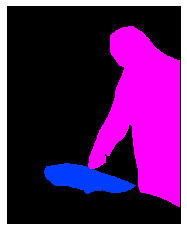

(500, 398, 3)
COCO_val2014_000000341196.jpg
{'person_bbx': [186.19, 178.04, 237.96, 229.81], 'Verbs': 'look', 'object': {'obj_bbx': [179.45, 213.01, 239.35, 238.44]}}
person
surfboard
look
look interaction
{'person_bbx': [186.19, 178.04, 237.96, 229.81], 'Verbs': 'surf', 'object': {'obj_bbx': [179.45, 213.01, 239.35, 238.44]}}
person
surfboard
surf
surf interaction


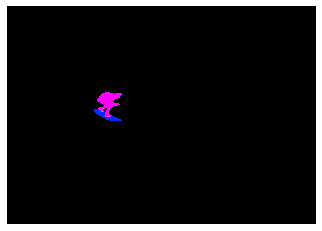

(451, 640, 3)
COCO_val2014_000000232544.jpg
{'person_bbx': [240.28, 154.13, 346.54, 336.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [369.92, 129.29, 568.61, 342.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [240.28, 154.13, 346.54, 336.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [240.28, 154.13, 346.54, 336.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [369.92, 129.29, 568.61, 342.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


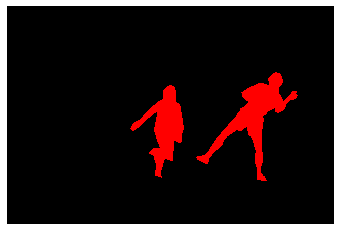

(426, 640, 3)
COCO_val2014_000000192039.jpg
{'person_bbx': [116.06, 0.0, 401.02, 356.21], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [195.28, 318.9, 256.83, 386.4]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [116.06, 0.0, 401.02, 356.21], 'Verbs': 'hold', 'object': {'obj_bbx': [260.6, 285.25, 322.86, 341.26]}}
sandwich
person
hold
hold interaction
{'person_bbx': [116.06, 0.0, 401.02, 356.21], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


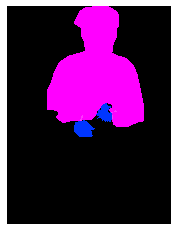

(640, 480, 3)
COCO_val2014_000000363640.jpg
{'person_bbx': [279.41, 43.81, 356.37, 433.32], 'Verbs': 'catch', 'object': {'obj_bbx': [295.94, 11.36, 369.24, 36.4]}}
frisbee
person
catch
catch interaction
{'person_bbx': [279.41, 43.81, 356.37, 433.32], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [279.41, 43.81, 356.37, 433.32], 'Verbs': 'look', 'object': {'obj_bbx': [295.94, 11.36, 369.24, 36.4]}}
frisbee
person
look
look interaction
{'person_bbx': [279.41, 43.81, 356.37, 433.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


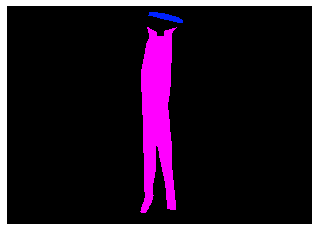

(457, 640, 3)
COCO_val2014_000000112608.jpg
{'person_bbx': [100.55, 211.8, 159.57999999999998, 333.15], 'Verbs': 'hold', 'object': {'obj_bbx': [111.87, 279.67, 235.56, 398.81]}}
horse
person
hold
hold interaction
{'person_bbx': [100.55, 211.8, 159.57999999999998, 333.15], 'Verbs': 'ride', 'object': {'obj_bbx': [73.61, 247.08, 123.63, 323.24]}}
horse
person
ride
ride interaction
{'person_bbx': [441.34, 236.42, 489.45, 324.71], 'Verbs': 'ride', 'object': {'obj_bbx': [410.54, 255.82, 548.37, 379.15999999999997]}}
horse
person
ride
ride interaction
{'person_bbx': [100.55, 211.8, 159.57999999999998, 333.15], 'Verbs': 'sit', 'object': {'obj_bbx': [111.87, 279.67, 235.56, 398.81]}}
horse
person
sit
sit interaction
{'person_bbx': [441.34, 236.42, 489.45, 324.71], 'Verbs': 'sit', 'object': {'obj_bbx': [410.54, 255.82, 548.37, 379.15999999999997]}}
horse
person
sit
sit interaction


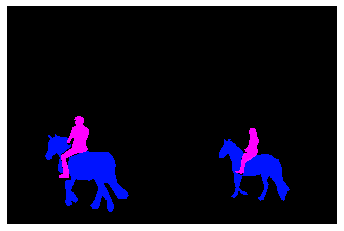

(422, 640, 3)
COCO_val2014_000000094846.jpg
{'person_bbx': [18.53, 29.1, 395.96000000000004, 428.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [304.87, 29.22, 544.6800000000001, 368.07000000000005]}}
person
laptop
hold
hold interaction
{'person_bbx': [18.53, 29.1, 395.96000000000004, 428.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [304.87, 29.22, 544.6800000000001, 368.07000000000005]}}
person
laptop
look
look interaction
{'person_bbx': [18.53, 29.1, 395.96000000000004, 428.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [39.38, 321.11, 439.28, 432.98]}}
person
chair
sit
sit interaction
{'person_bbx': [18.53, 29.1, 395.96000000000004, 428.96000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [304.87, 29.22, 544.6800000000001, 368.07000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


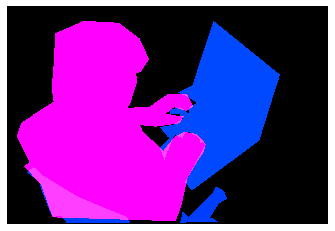

(434, 640, 3)
COCO_val2014_000000338703.jpg
{'person_bbx': [217.24, 6.15, 361.71000000000004, 274.01], 'Verbs': 'hold', 'object': {'obj_bbx': [250.69, 50.34, 325.28999999999996, 113.89]}}
backpack
person
hold
hold interaction
{'person_bbx': [199.78, 24.8, 350.97, 310.68], 'Verbs': 'hold', 'object': {'obj_bbx': [217.24, 6.15, 361.71000000000004, 274.01]}}
person
person
hold
hold interaction
{'person_bbx': [199.78, 24.8, 350.97, 310.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


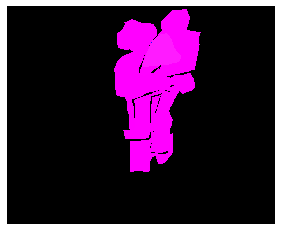

(406, 500, 3)
COCO_val2014_000000180283.jpg
{'person_bbx': [102.11, 73.35, 373.93, 622.74], 'Verbs': 'hold', 'object': {'obj_bbx': [165.97, 179.97, 272.24, 258.72]}}
tie
person
hold
hold interaction
{'person_bbx': [102.11, 73.35, 373.93, 622.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [102.11, 73.35, 373.93, 622.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


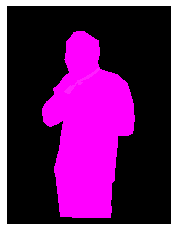

(640, 480, 3)
COCO_val2014_000000073153.jpg
{'person_bbx': [206.59, 12.64, 397.28999999999996, 633.86], 'Verbs': 'hold', 'object': {'obj_bbx': [341.92, 109.77, 355.56, 126.34]}}
cell phone
person
hold
hold interaction
{'person_bbx': [206.59, 12.64, 397.28999999999996, 633.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [206.59, 12.64, 397.28999999999996, 633.86], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [341.92, 109.77, 355.56, 126.34]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


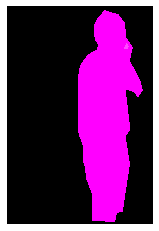

(640, 427, 3)
COCO_val2014_000000468784.jpg
{'person_bbx': [255.8, 43.39, 558.02, 432.25], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [183.19, 254.75, 303.25, 322.81]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [255.8, 43.39, 558.02, 432.25], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [57.76, 62.75, 290.87, 389.72]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [255.8, 43.39, 558.02, 432.25], 'Verbs': 'hold', 'object': {'obj_bbx': [183.19, 254.75, 303.25, 322.81]}}
person
knife
hold
hold interaction
{'person_bbx': [255.8, 43.39, 558.02, 432.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [255.8, 43.39, 558.02, 432.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


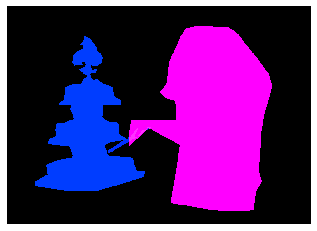

(459, 640, 3)
COCO_val2014_000000472256.jpg
{'person_bbx': [198.1, 64.22, 563.81, 476.01], 'Verbs': 'hold', 'object': {'obj_bbx': [194.85, 306.31, 225.06, 320.58]}}
person
remote
hold
hold interaction
{'person_bbx': [198.1, 64.22, 563.81, 476.01], 'Verbs': 'look', 'object': {'obj_bbx': [133.23, 200.86, 247.94, 333.52]}}
person
laptop
look
look interaction
{'person_bbx': [198.1, 64.22, 563.81, 476.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [198.1, 64.22, 563.81, 476.01], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [133.23, 200.86, 247.94, 333.52]}}
person
laptop
work_on_computer
work_on_computer interaction


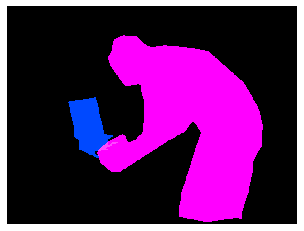

(480, 640, 3)
COCO_val2014_000000380414.jpg
{'person_bbx': [124.67, 168.31, 368.07, 486.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [231.65, 458.55, 284.79, 503.24]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [81.6, 174.34, 210.89, 451.66999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [122.94, 430.37, 162.03, 458.5]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [124.67, 168.31, 368.07, 486.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.6, 174.34, 210.89, 451.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


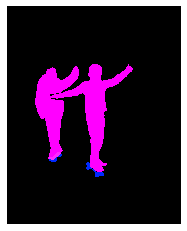

(640, 510, 3)
COCO_val2014_000000428263.jpg
{'person_bbx': [305.14, 251.11, 381.9, 419.99], 'Verbs': 'catch', 'object': {'obj_bbx': [396.65, 169.16, 436.2, 185.82999999999998]}}
person
frisbee
catch
catch interaction
{'person_bbx': [463.17, 197.68, 536.27, 390.89], 'Verbs': 'catch', 'object': {'obj_bbx': [396.65, 169.16, 436.2, 185.82999999999998]}}
person
frisbee
catch
catch interaction
{'person_bbx': [463.17, 197.68, 536.27, 390.89], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [305.14, 251.11, 381.9, 419.99], 'Verbs': 'look', 'object': {'obj_bbx': [396.65, 169.16, 436.2, 185.82999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [463.17, 197.68, 536.27, 390.89], 'Verbs': 'look', 'object': {'obj_bbx': [396.65, 169.16, 436.2, 185.82999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [305.14, 251.11, 381.9, 419.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [463.17, 197.68, 536.27, 390.89], 'Verbs': 'sm

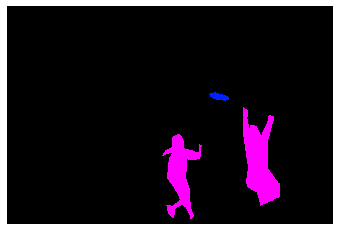

(427, 640, 3)
COCO_val2014_000000031202.jpg
{'person_bbx': [149.98, 71.74, 556.91, 421.36], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 8.74, 621.19, 425.01]}}
person
skis
hold
hold interaction


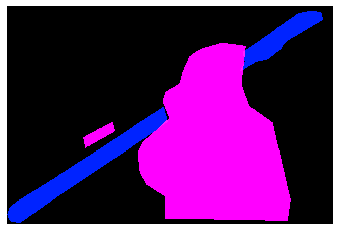

(427, 640, 3)
COCO_val2014_000000040821.jpg


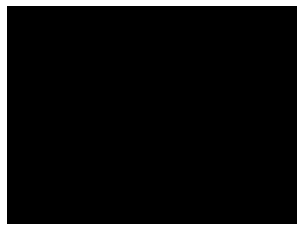

(375, 500, 3)
COCO_val2014_000000062657.jpg
{'person_bbx': [157.19, 16.43, 349.28, 355.42], 'Verbs': 'kick', 'object': {'obj_bbx': [176.57, 316.95, 231.29, 371.01]}}
sports ball
person
kick
kick interaction
{'person_bbx': [157.19, 16.43, 349.28, 355.42], 'Verbs': 'look', 'object': {'obj_bbx': [176.57, 316.95, 231.29, 371.01]}}
sports ball
person
look
look interaction
{'person_bbx': [157.19, 16.43, 349.28, 355.42], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [157.19, 16.43, 349.28, 355.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


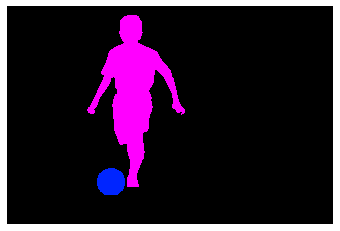

(427, 640, 3)
COCO_val2014_000000560718.jpg
{'person_bbx': [240.67, 164.51, 361.01, 342.15], 'Verbs': 'surf', 'object': {'obj_bbx': [229.37, 333.99, 356.58, 366.83000000000004]}}
person
surfboard
surf
surf interaction


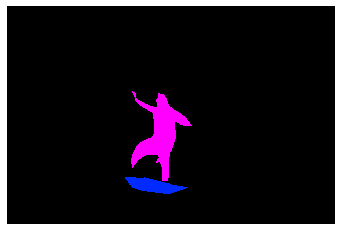

(425, 640, 3)
COCO_val2014_000000480936.jpg
{'person_bbx': [62.6, 8.53, 373.89000000000004, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [194.47, 312.77, 234.0, 349.22999999999996]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [62.6, 8.53, 373.89000000000004, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [194.47, 312.77, 234.0, 349.22999999999996]}}
person
hot dog
hold
hold interaction
{'person_bbx': [62.6, 8.53, 373.89000000000004, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [56.09, 73.11, 374.56000000000006, 596.61]}}
chair
person
sit
sit interaction
{'person_bbx': [62.6, 8.53, 373.89000000000004, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


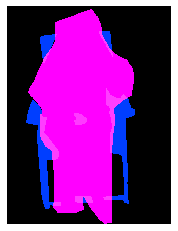

(640, 482, 3)
COCO_val2014_000000102411.jpg
{'person_bbx': [218.75, 126.19, 337.21, 354.49], 'Verbs': 'hold', 'object': {'obj_bbx': [188.07, 181.36, 416.44, 357.91]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [218.75, 126.19, 337.21, 354.49], 'Verbs': 'ride', 'object': {'obj_bbx': [188.07, 181.36, 416.44, 357.91]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [276.32, 123.73, 392.72, 320.29], 'Verbs': 'ride', 'object': {'obj_bbx': [188.07, 181.36, 416.44, 357.91]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [218.75, 126.19, 337.21, 354.49], 'Verbs': 'sit', 'object': {'obj_bbx': [188.07, 181.36, 416.44, 357.91]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [276.32, 123.73, 392.72, 320.29], 'Verbs': 'sit', 'object': {'obj_bbx': [188.07, 181.36, 416.44, 357.91]}}
motorcycle
person
sit
sit interaction


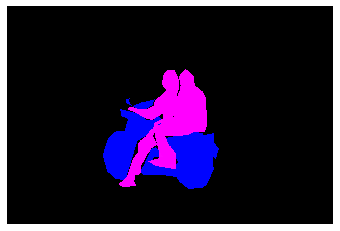

(427, 640, 3)
COCO_val2014_000000479829.jpg
{'person_bbx': [53.21, 185.53, 421.39, 509.12], 'Verbs': 'hold', 'object': {'obj_bbx': [88.56, 300.51, 248.01, 446.08]}}
person
book
hold
hold interaction
{'person_bbx': [53.21, 185.53, 421.39, 509.12], 'Verbs': 'look', 'object': {'obj_bbx': [88.56, 300.51, 248.01, 446.08]}}
person
book
look
look interaction
{'person_bbx': [53.21, 185.53, 421.39, 509.12], 'Verbs': 'read', 'object': {'obj_bbx': [88.56, 300.51, 248.01, 446.08]}}
person
book
read
read interaction
{'person_bbx': [53.21, 185.53, 421.39, 509.12], 'Verbs': 'sit', 'object': {'obj_bbx': [4.32, 474.95, 480.0, 640.0]}}
person
bed
sit
sit interaction
{'person_bbx': [53.21, 185.53, 421.39, 509.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


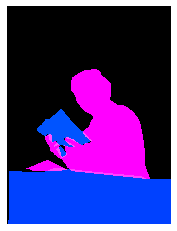

(640, 480, 3)
COCO_val2014_000000467135.jpg
{'person_bbx': [0.0, 213.97, 212.8, 472.76], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [52.63, 204.09, 396.36, 379.18]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 213.97, 212.8, 472.76], 'Verbs': 'hold', 'object': {'obj_bbx': [52.63, 204.09, 396.36, 379.18]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 213.97, 212.8, 472.76], 'Verbs': 'ride', 'object': {'obj_bbx': [1.07, 1.97, 640.0, 471.38000000000005]}}
car
person
ride
ride interaction


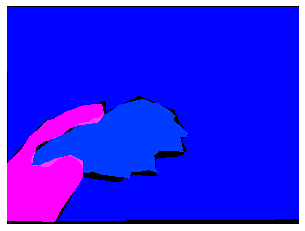

(478, 640, 3)
COCO_val2014_000000396754.jpg
{'person_bbx': [366.0, 104.57, 410.54, 203.32999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [324.96, 151.35, 455.65999999999997, 253.68]}}
horse
person
hold
hold interaction
{'person_bbx': [220.31, 111.71, 274.57, 199.44], 'Verbs': 'ride', 'object': {'obj_bbx': [183.58, 149.54, 300.66, 245.95999999999998]}}
person
horse
ride
ride interaction
{'person_bbx': [450.08, 111.61, 497.49, 209.72], 'Verbs': 'ride', 'object': {'obj_bbx': [428.94, 149.41, 533.86, 258.65]}}
person
horse
ride
ride interaction
{'person_bbx': [366.0, 104.57, 410.54, 203.32999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [324.96, 151.35, 455.65999999999997, 253.68]}}
horse
person
ride
ride interaction
{'person_bbx': [220.31, 111.71, 274.57, 199.44], 'Verbs': 'sit', 'object': {'obj_bbx': [183.58, 149.54, 300.66, 245.95999999999998]}}
person
horse
sit
sit interaction
{'person_bbx': [450.08, 111.61, 497.49, 209.72], 'Verbs': 'sit', 'object': {'obj_bbx': [428.94, 149

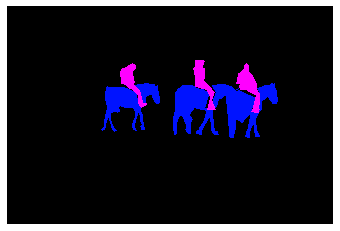

(427, 640, 3)
COCO_val2014_000000532295.jpg
{'person_bbx': [220.87, 264.06, 315.34000000000003, 494.48], 'Verbs': 'hold', 'object': {'obj_bbx': [241.44, 174.16, 294.38, 304.03]}}
person
skis
hold
hold interaction
{'person_bbx': [220.87, 264.06, 315.34000000000003, 494.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [220.87, 264.06, 315.34000000000003, 494.48], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


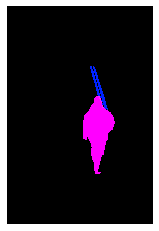

(640, 427, 3)
COCO_val2014_000000374368.jpg
{'person_bbx': [222.48, 256.79, 423.29999999999995, 519.73], 'Verbs': 'hold', 'object': {'obj_bbx': [185.08, 286.72, 228.65, 306.55]}}
person
frisbee
hold
hold interaction
{'person_bbx': [222.48, 256.79, 423.29999999999995, 519.73], 'Verbs': 'look', 'object': {'obj_bbx': [185.08, 286.72, 228.65, 306.55]}}
person
frisbee
look
look interaction
{'person_bbx': [222.48, 256.79, 423.29999999999995, 519.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.48, 256.79, 423.29999999999995, 519.73], 'Verbs': 'throw', 'object': {'obj_bbx': [185.08, 286.72, 228.65, 306.55]}}
person
frisbee
throw
throw interaction


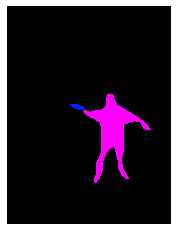

(640, 480, 3)
COCO_val2014_000000050778.jpg
{'person_bbx': [579.33, 237.84, 601.1800000000001, 310.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [401.87, 244.15, 431.91, 330.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [68.93, 68.93, 566.72, 336.97]}}
bus
person
look
look interaction
{'person_bbx': [579.33, 237.84, 601.1800000000001, 310.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [618.51, 233.87, 640.0, 337.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [401.87, 244.15, 431.91, 330.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


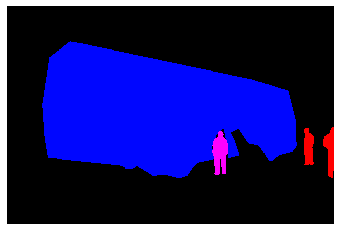

(426, 640, 3)
COCO_val2014_000000566908.jpg
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [26.9, 198.08, 186.05, 275.04]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [83.58, 170.76, 110.95, 195.01999999999998]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'hold', 'object': {'obj_bbx': [26.9, 198.08, 186.05, 275.04]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'look', 'object': {'obj_bbx': [83.58, 170.76, 110.95, 195.01999999999998]}}
person
sports ball
look
look interaction
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [181.23, 69.73, 366.2, 274.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


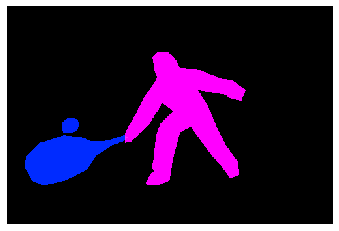

(334, 500, 3)
COCO_val2014_000000516875.jpg
{'person_bbx': [442.23, 0.48, 640.0, 420.69], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [185.44, 98.73, 460.08, 240.06]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [442.23, 0.48, 640.0, 420.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [442.23, 0.48, 640.0, 420.69], 'Verbs': 'look', 'object': {'obj_bbx': [185.44, 98.73, 460.08, 240.06]}}
hot dog
person
look
look interaction


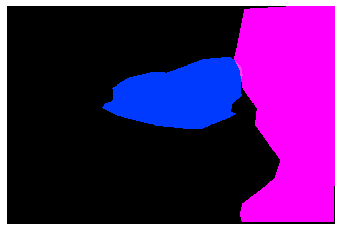

(425, 640, 3)
COCO_val2014_000000167271.jpg
{'person_bbx': [41.57, 112.36, 375.0, 493.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [41.57, 112.36, 375.0, 493.26], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 45.72, 306.74, 492.91999999999996]}}
bed
person
lay
lay interaction
{'person_bbx': [41.57, 112.36, 375.0, 493.26], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


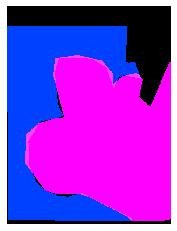

(500, 375, 3)
COCO_val2014_000000347254.jpg
{'person_bbx': [0.0, 26.46, 319.82, 493.81], 'Verbs': 'drink', 'object': {'obj_bbx': [244.45, 235.06, 303.24, 339.14]}}
person
cup
drink
drink interaction
{'person_bbx': [0.0, 26.46, 319.82, 493.81], 'Verbs': 'hold', 'object': {'obj_bbx': [244.45, 235.06, 303.24, 339.14]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 26.46, 319.82, 493.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 26.46, 319.82, 493.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


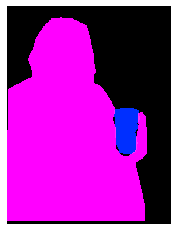

(500, 375, 3)
COCO_val2014_000000125909.jpg
{'person_bbx': [377.27, 241.78, 474.62, 420.8], 'Verbs': 'hold', 'object': {'obj_bbx': [388.63, 290.09, 409.21, 327.96]}}
person
chair
hold
hold interaction
{'person_bbx': [421.8, 261.79, 565.31, 479.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [377.27, 241.78, 474.62, 420.8], 'Verbs': 'look', 'object': {'obj_bbx': [388.63, 290.09, 409.21, 327.96]}}
person
chair
look
look interaction
{'person_bbx': [377.27, 241.78, 474.62, 420.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [421.8, 261.79, 565.31, 479.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [556.39, 362.64, 608.4399999999999, 440.73]}}
chair
person
sit
sit interaction


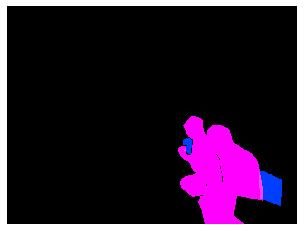

(480, 640, 3)
COCO_val2014_000000436555.jpg
{'person_bbx': [238.53, 151.0, 368.37, 423.19], 'Verbs': 'carry', 'object': {'obj_bbx': [279.88, 220.25, 354.9, 384.72]}}
backpack
person
carry
carry interaction
{'person_bbx': [430.87, 181.06, 610.88, 418.52], 'Verbs': 'carry', 'object': {'obj_bbx': [575.58, 270.67, 640.0, 427.35]}}
handbag
person
carry
carry interaction
{'person_bbx': [138.44, 162.71, 240.35, 427.49], 'Verbs': 'carry', 'object': {'obj_bbx': [126.09, 212.93, 235.86, 427.40999999999997]}}
handbag
person
carry
carry interaction
{'person_bbx': [138.44, 162.71, 240.35, 427.49], 'Verbs': 'hold', 'object': {'obj_bbx': [125.32, 70.85, 289.19, 174.95999999999998]}}
umbrella
person
hold
hold interaction
{'person_bbx': [238.53, 151.0, 368.37, 423.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [430.87, 181.06, 610.88, 418.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [138.44, 162.71, 240.35, 427.49], 'Verbs': 'stand', 'obje

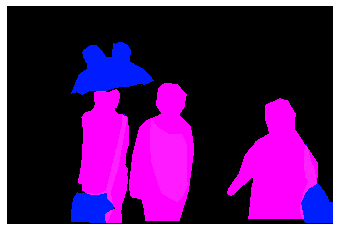

(428, 640, 3)
COCO_val2014_000000078061.jpg
{'person_bbx': [46.07, 20.22, 410.11, 488.76], 'Verbs': 'hold', 'object': {'obj_bbx': [116.13, 291.44, 131.29, 309.83]}}
sports ball
person
hold
hold interaction
{'person_bbx': [46.07, 20.22, 410.11, 488.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [46.07, 20.22, 410.11, 488.76], 'Verbs': 'throw', 'object': {'obj_bbx': [116.13, 291.44, 131.29, 309.83]}}
sports ball
person
throw
throw interaction


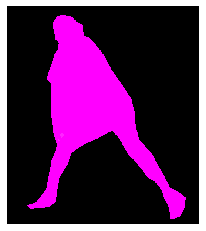

(500, 441, 3)
COCO_val2014_000000544237.jpg
{'person_bbx': [265.81, 126.49, 393.39, 267.33], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [236.88, 2.82, 345.77, 134.63], 'Verbs': 'hold', 'object': {'obj_bbx': [261.7, 31.42, 288.87, 54.0]}}
person
bowl
hold
hold interaction
{'person_bbx': [265.81, 126.49, 393.39, 267.33], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [3.83, 143.6, 120.62, 397.28], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [54.69, 276.8, 208.2, 421.68], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [350.8, 310.63, 574.47, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [265.81, 126.49, 393.39, 267.33], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [54.69, 276.8, 208.2, 421.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [350.8, 310.63, 574.47, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': 

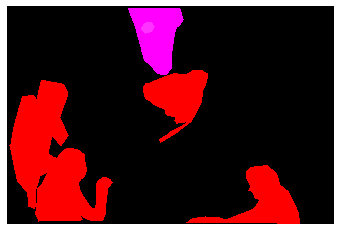

(426, 640, 3)
COCO_val2014_000000457884.jpg
{'person_bbx': [276.1, 116.69, 404.74, 384.55], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [522.11, 129.16, 613.4200000000001, 310.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [276.1, 116.69, 404.74, 384.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


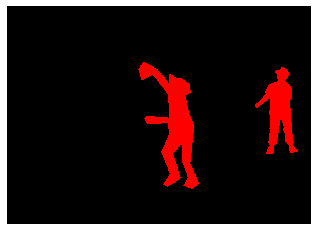

(458, 640, 3)
COCO_val2014_000000474054.jpg
{'person_bbx': [75.74, 179.29, 261.65, 340.42999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': [160.33, 307.82, 273.70000000000005, 381.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [75.74, 179.29, 261.65, 340.42999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [160.33, 307.82, 273.70000000000005, 381.0]}}
person
skateboard
look
look interaction
{'person_bbx': [75.74, 179.29, 261.65, 340.42999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [160.33, 307.82, 273.70000000000005, 381.0]}}
person
skateboard
skateboard
skateboard interaction


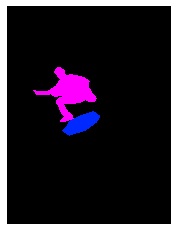

(640, 480, 3)
COCO_val2014_000000239130.jpg
{'person_bbx': [243.86, 91.11, 401.11, 418.19], 'Verbs': 'hold', 'object': {'obj_bbx': [220.07, 228.53, 400.9, 459.27]}}
bicycle
person
hold
hold interaction
{'person_bbx': [243.86, 91.11, 401.11, 418.19], 'Verbs': 'ride', 'object': {'obj_bbx': [220.07, 228.53, 400.9, 459.27]}}
bicycle
person
ride
ride interaction
{'person_bbx': [243.86, 91.11, 401.11, 418.19], 'Verbs': 'sit', 'object': {'obj_bbx': [220.07, 228.53, 400.9, 459.27]}}
bicycle
person
sit
sit interaction
{'person_bbx': [243.86, 91.11, 401.11, 418.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [243.86, 91.11, 401.11, 418.19], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


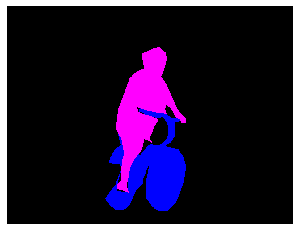

(488, 640, 3)
COCO_val2014_000000411642.jpg
{'person_bbx': [224.3, 94.6, 406.43, 280.11], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [173.47, 80.48, 262.12, 115.94]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [224.3, 94.6, 406.43, 280.11], 'Verbs': 'hold', 'object': {'obj_bbx': [173.47, 80.48, 262.12, 115.94]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [224.3, 94.6, 406.43, 280.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.43, 14.68, 93.82000000000001, 186.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


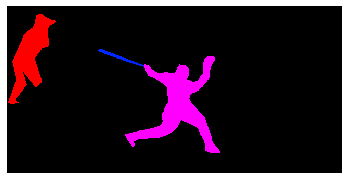

(318, 640, 3)
COCO_val2014_000000444263.jpg
{'person_bbx': [258.27, 163.02, 345.88, 291.8], 'Verbs': 'snowboard', 'object': {'obj_bbx': [246.22, 233.72, 341.78, 307.23]}}
snowboard
person
snowboard
snowboard interaction


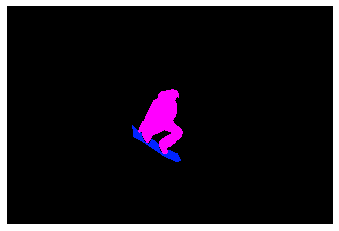

(428, 640, 3)
COCO_val2014_000000465323.jpg
{'person_bbx': [168.97, 193.67, 530.58, 431.52], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [168.97, 193.67, 530.58, 431.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


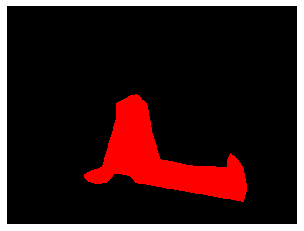

(480, 640, 3)
COCO_val2014_000000017313.jpg
{'person_bbx': [446.24, 91.78, 598.15, 473.66999999999996], 'Verbs': 'drink', 'object': {'obj_bbx': [452.75, 191.86, 483.37, 222.76000000000002]}}
person
cup
drink
drink interaction
{'person_bbx': [446.24, 91.78, 598.15, 473.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [452.75, 191.86, 483.37, 222.76000000000002]}}
person
cup
hold
hold interaction
{'person_bbx': [446.24, 91.78, 598.15, 473.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [231.85, 74.18, 365.28999999999996, 358.72]}}
person
person
look
look interaction
{'person_bbx': [0.24, 54.38, 264.03000000000003, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.24, 54.38, 264.03000000000003, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [446.24, 91.78, 598.15, 473.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


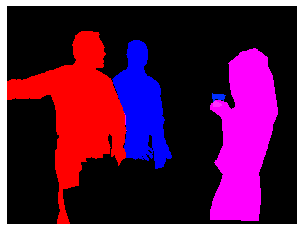

(480, 640, 3)
COCO_val2014_000000277991.jpg
{'person_bbx': [84.13, 141.3, 250.25, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [284.14, 150.74, 577.63, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [463.78, 285.95, 558.92, 472.97]}}
chair
person
sit
sit interaction
{'person_bbx': [84.13, 141.3, 250.25, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [64.5, 274.18, 166.82, 472.56]}}
chair
person
sit
sit interaction
{'person_bbx': [284.14, 150.74, 577.63, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.13, 141.3, 250.25, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


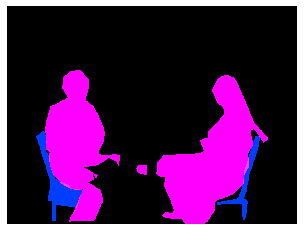

(480, 640, 3)
COCO_val2014_000000382125.jpg
{'person_bbx': [0.0, 115.14, 352.43, 475.14], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [196.31, 332.22, 303.1, 410.97]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 115.14, 352.43, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [196.31, 332.22, 303.1, 410.97]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 115.14, 352.43, 475.14], 'Verbs': 'sit', 'object': {'obj_bbx': [1.4, 316.57, 50.809999999999995, 412.98]}}
person
chair
sit
sit interaction
{'person_bbx': [347.33, 100.31, 633.17, 471.37], 'Verbs': 'sit', 'object': {'obj_bbx': [615.44, 334.15, 639.85, 439.33]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 115.14, 352.43, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [347.33, 100.31, 633.17, 471.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


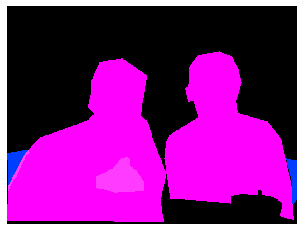

(480, 640, 3)
COCO_val2014_000000553443.jpg
{'person_bbx': [182.01, 112.83, 488.05, 356.05], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [290.26, 212.34, 335.53, 239.59]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [182.01, 112.83, 488.05, 356.05], 'Verbs': 'hold', 'object': {'obj_bbx': [290.26, 212.34, 335.53, 239.59]}}
person
apple
hold
hold interaction
{'person_bbx': [182.01, 112.83, 488.05, 356.05], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


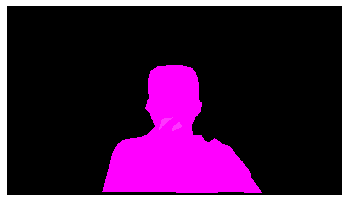

(360, 640, 3)
COCO_val2014_000000021776.jpg
{'person_bbx': [401.26, 2.43, 638.29, 283.96], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [458.19, 118.55, 507.14, 158.06]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [401.26, 2.43, 638.29, 283.96], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [354.19, 122.59, 467.03999999999996, 239.46]}}
person
apple
cut_obj
cut_obj interaction
{'person_bbx': [401.26, 2.43, 638.29, 283.96], 'Verbs': 'hold', 'object': {'obj_bbx': [458.19, 118.55, 507.14, 158.06]}}
person
knife
hold
hold interaction


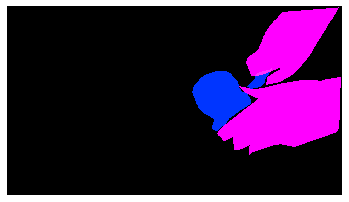

(360, 640, 3)
COCO_val2014_000000173204.jpg
{'person_bbx': [124.86, 151.59, 287.4, 418.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [239.85, 399.48, 314.99, 411.48]}}
person
skis
hold
hold interaction
{'person_bbx': [366.94, 110.45, 506.69, 431.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [124.86, 151.59, 287.4, 418.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [366.94, 110.45, 506.69, 431.62]}}
person
person
look
look interaction
{'person_bbx': [124.86, 151.59, 287.4, 418.53999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [239.85, 399.48, 314.99, 411.48]}}
person
skis
ski
ski interaction
{'person_bbx': [366.94, 110.45, 506.69, 431.62], 'Verbs': 'ski', 'object': {'obj_bbx': [349.03, 418.34, 594.47, 444.92999999999995]}}
person
skis
ski
ski interaction
{'person_bbx': [124.86, 151.59, 287.4, 418.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [366.94, 110.45, 506.69, 431.62], 'Verbs': 'stand

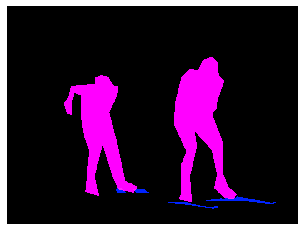

(479, 640, 3)
COCO_val2014_000000429582.jpg
{'person_bbx': [0.0, 40.4, 264.53, 403.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


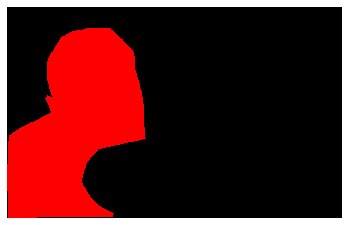

(403, 640, 3)
COCO_val2014_000000506489.jpg
{'person_bbx': [483.9, 231.46, 536.9399999999999, 370.62], 'Verbs': 'look', 'object': {'obj_bbx': [372.79, 270.84, 404.70000000000005, 291.55999999999995]}}
person
potted plant
look
look interaction
{'person_bbx': [483.9, 231.46, 536.9399999999999, 370.62], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [483.9, 231.46, 536.9399999999999, 370.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


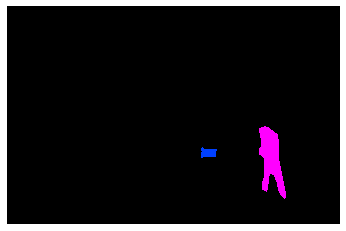

(419, 640, 3)
COCO_val2014_000000419974.jpg
{'person_bbx': [180.98, 101.15, 367.57, 445.67999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [294.8, 350.29, 325.67, 372.84000000000003]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [180.98, 101.15, 367.57, 445.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [337.3, 339.33, 349.19, 363.89]}}
fork
person
hold
hold interaction
{'person_bbx': [180.98, 101.15, 367.57, 445.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [343.42, 378.75, 360.11, 387.98]}}
person
knife
look
look interaction
{'person_bbx': [180.98, 101.15, 367.57, 445.67999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


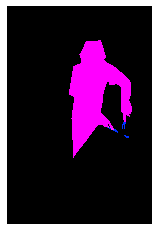

(640, 426, 3)
COCO_val2014_000000568195.jpg
{'person_bbx': [123.88, 136.79, 356.91999999999996, 447.16999999999996], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [183.84, 399.57, 218.41, 428.61]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [123.88, 136.79, 356.91999999999996, 447.16999999999996], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [198.49, 415.89, 318.85, 498.89]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [123.88, 136.79, 356.91999999999996, 447.16999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [183.84, 399.57, 218.41, 428.61]}}
person
knife
hold
hold interaction
{'person_bbx': [5.41, 77.16, 153.34, 571.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [123.88, 136.79, 356.91999999999996, 447.16999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [286.05, 139.77, 427.0, 464.83000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [5.41, 77.16, 153.34,

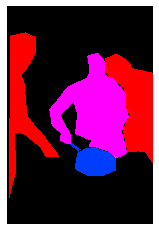

(640, 427, 3)
COCO_val2014_000000532055.jpg
{'person_bbx': [148.83, 332.77, 238.29000000000002, 508.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [148.83, 332.77, 238.29000000000002, 508.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [43.81, 135.26, 117.65, 282.35]}}
person
kite
look
look interaction
{'person_bbx': [148.83, 332.77, 238.29000000000002, 508.15999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


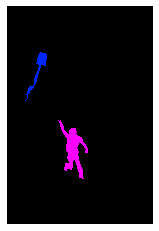

(640, 427, 3)
COCO_val2014_000000407274.jpg
{'person_bbx': [80.54, 222.92, 381.12, 625.62], 'Verbs': 'catch', 'object': {'obj_bbx': [298.36, 186.75, 353.98, 213.78]}}
person
frisbee
catch
catch interaction
{'person_bbx': [80.54, 222.92, 381.12, 625.62], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [80.54, 222.92, 381.12, 625.62], 'Verbs': 'look', 'object': {'obj_bbx': [298.36, 186.75, 353.98, 213.78]}}
person
frisbee
look
look interaction


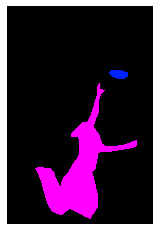

(640, 427, 3)
COCO_val2014_000000541909.jpg
{'person_bbx': [440.7, 168.66, 487.5, 273.88], 'Verbs': 'look', 'object': {'obj_bbx': [436.24, 214.21, 450.39, 236.83]}}
person
tennis racket
look
look interaction
{'person_bbx': [172.5, 233.13, 246.25, 309.38], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [440.7, 168.66, 487.5, 273.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


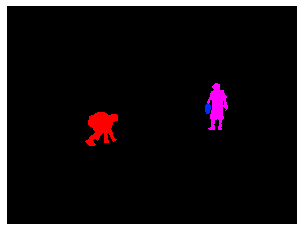

(480, 640, 3)
COCO_val2014_000000331667.jpg
{'person_bbx': [613.6, 201.05, 640.0, 323.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [582.71, 257.61, 626.7900000000001, 332.88]}}
person
suitcase
hold
hold interaction
{'person_bbx': [613.6, 201.05, 640.0, 323.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


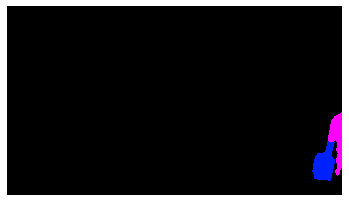

(360, 640, 3)
COCO_val2014_000000038886.jpg
{'person_bbx': [208.47, 209.38, 293.15, 388.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [208.47, 209.38, 293.15, 388.68], 'Verbs': 'snowboard', 'object': {'obj_bbx': [171.89, 368.96, 318.33, 394.46999999999997]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [208.47, 209.38, 293.15, 388.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


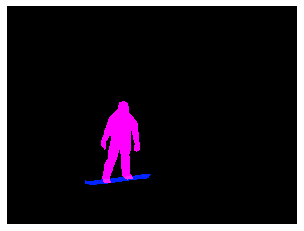

(480, 640, 3)
COCO_val2014_000000376751.jpg
{'person_bbx': [127.75, 282.2, 174.11, 354.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [89.02, 288.39, 140.62, 378.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [127.75, 282.2, 174.11, 354.95], 'Verbs': 'ski', 'object': {'obj_bbx': [127.83, 345.23, 152.28, 355.29]}}
person
skis
ski
ski interaction
{'person_bbx': [89.02, 288.39, 140.62, 378.2], 'Verbs': 'ski', 'object': {'obj_bbx': [113.08, 369.28, 135.45, 383.2]}}
skis
person
ski
ski interaction
{'person_bbx': [127.75, 282.2, 174.11, 354.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.02, 288.39, 140.62, 378.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


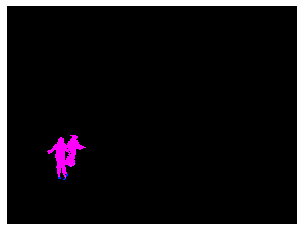

(480, 640, 3)
COCO_val2014_000000353989.jpg
{'person_bbx': [69.03, 235.87, 231.55, 467.42], 'Verbs': 'jump', 'object': {'obj_bbx': [92.62, 459.22, 215.85000000000002, 563.4100000000001]}}
skateboard
person
jump
jump interaction
{'person_bbx': [69.03, 235.87, 231.55, 467.42], 'Verbs': 'skateboard', 'object': {'obj_bbx': [92.62, 459.22, 215.85000000000002, 563.4100000000001]}}
skateboard
person
skateboard
skateboard interaction


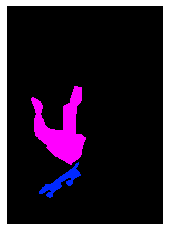

(640, 457, 3)
COCO_val2014_000000235130.jpg
{'person_bbx': [116.29, 75.84, 261.24, 369.1], 'Verbs': 'snowboard', 'object': {'obj_bbx': [33.2, 348.05, 300.0, 372.86]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [116.29, 75.84, 261.24, 369.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


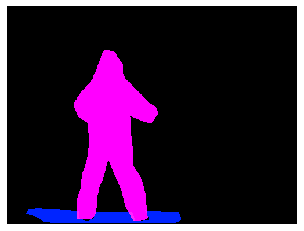

(375, 500, 3)
COCO_val2014_000000544065.jpg
{'person_bbx': [56.34, 118.1, 352.51, 599.1899999999999], 'Verbs': 'kick', 'object': {'obj_bbx': [279.46, 544.5, 369.51, 624.61]}}
sports ball
person
kick
kick interaction
{'person_bbx': [56.34, 118.1, 352.51, 599.1899999999999], 'Verbs': 'look', 'object': {'obj_bbx': [279.46, 544.5, 369.51, 624.61]}}
sports ball
person
look
look interaction
{'person_bbx': [56.34, 118.1, 352.51, 599.1899999999999], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


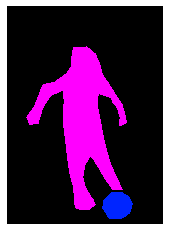

(640, 458, 3)
COCO_val2014_000000087476.jpg
{'person_bbx': [138.38, 47.57, 374.77, 599.6400000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [129.22, 254.14, 322.78999999999996, 631.78]}}
person
person
hold
hold interaction
{'person_bbx': [129.22, 254.14, 322.78999999999996, 631.78], 'Verbs': 'hold', 'object': {'obj_bbx': [138.38, 47.57, 374.77, 599.6400000000001]}}
person
person
hold
hold interaction
{'person_bbx': [138.38, 47.57, 374.77, 599.6400000000001], 'Verbs': 'look', 'object': {'obj_bbx': [120.03, 566.75, 372.78999999999996, 638.97]}}
person
skateboard
look
look interaction
{'person_bbx': [129.22, 254.14, 322.78999999999996, 631.78], 'Verbs': 'look', 'object': {'obj_bbx': [120.03, 566.75, 372.78999999999996, 638.97]}}
skateboard
person
look
look interaction
{'person_bbx': [138.38, 47.57, 374.77, 599.6400000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [129.22, 254.14, 322.78999999999996, 631.78], 'Verbs': 'skateboard', 'object': {

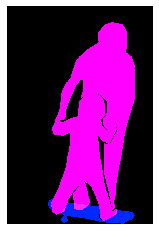

(640, 427, 3)
COCO_val2014_000000380993.jpg
{'person_bbx': [346.29, 66.54, 427.34000000000003, 301.40000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [393.12, 93.62, 446.06, 218.66000000000003]}}
person
handbag
carry
carry interaction
{'person_bbx': [346.29, 66.54, 427.34000000000003, 301.40000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [393.12, 93.62, 446.06, 218.66000000000003]}}
person
handbag
hold
hold interaction
{'person_bbx': [185.62, 49.16, 293.14, 371.70000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [185.62, 49.16, 293.14, 371.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [346.29, 66.54, 427.34000000000003, 301.40000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [492.89, 35.69, 611.54, 260.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [346.29, 66.54, 427.34000000000003, 301.40000000000003], 'Verbs': 'walk', 'object'

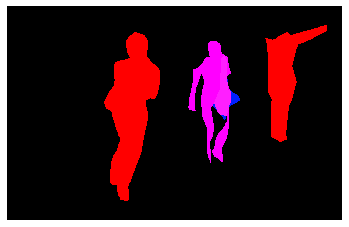

(408, 640, 3)
COCO_val2014_000000049891.jpg
{'person_bbx': [8.63, 27.33, 414.2, 605.48], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [249.48, 137.53, 297.46, 166.85]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [8.63, 27.33, 414.2, 605.48], 'Verbs': 'hold', 'object': {'obj_bbx': [249.48, 137.53, 297.46, 166.85]}}
person
pizza
hold
hold interaction
{'person_bbx': [8.63, 27.33, 414.2, 605.48], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


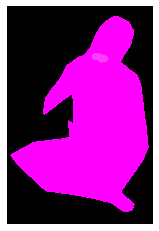

(640, 427, 3)
COCO_val2014_000000213695.jpg
{'person_bbx': [120.89, 153.26, 405.49, 387.34000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [156.59, 370.34, 299.78, 494.54999999999995]}}
skateboard
person
jump
jump interaction
{'person_bbx': [120.89, 153.26, 405.49, 387.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [156.59, 370.34, 299.78, 494.54999999999995]}}
skateboard
person
look
look interaction
{'person_bbx': [120.89, 153.26, 405.49, 387.34000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [156.59, 370.34, 299.78, 494.54999999999995]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [120.89, 153.26, 405.49, 387.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


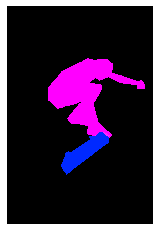

(640, 427, 3)
COCO_val2014_000000204049.jpg
{'person_bbx': [293.39, 143.46, 400.18, 372.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [293.39, 143.46, 400.18, 372.13], 'Verbs': 'ski', 'object': {'obj_bbx': [284.97, 361.08, 408.53000000000003, 388.93]}}
person
skis
ski
ski interaction
{'person_bbx': [293.39, 143.46, 400.18, 372.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.39, 143.46, 400.18, 372.13], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


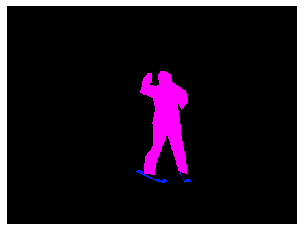

(480, 640, 3)
COCO_val2014_000000273316.jpg
{'person_bbx': [0.0, 175.23, 292.74, 578.46], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [42.21, 295.4, 227.35, 389.27]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 175.23, 292.74, 578.46], 'Verbs': 'hold', 'object': {'obj_bbx': [42.21, 295.4, 227.35, 389.27]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.0, 175.23, 292.74, 578.46], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 175.23, 292.74, 578.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


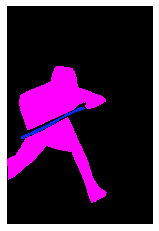

(640, 427, 3)
COCO_val2014_000000125228.jpg
{'person_bbx': [148.11, 40.54, 390.27, 308.65000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [148.85, 185.53, 636.4, 471.37]}}
person
laptop
look
look interaction
{'person_bbx': [148.11, 40.54, 390.27, 308.65000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 0.27, 640.0, 475.96]}}
bed
person
sit
sit interaction
{'person_bbx': [148.11, 40.54, 390.27, 308.65000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [148.85, 185.53, 636.4, 471.37]}}
person
laptop
work_on_computer
work_on_computer interaction


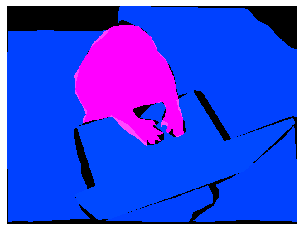

(480, 640, 3)
COCO_val2014_000000372654.jpg
{'person_bbx': [423.25, 112.13, 620.08, 426.37], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [452.91, 231.79, 485.85, 243.89999999999998]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [2.28, 110.59, 275.40999999999997, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [423.25, 112.13, 620.08, 426.37], 'Verbs': 'hold', 'object': {'obj_bbx': [467.48, 233.61, 500.42, 257.1]}}
person
cup
hold
hold interaction
{'person_bbx': [2.28, 110.59, 275.40999999999997, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [152.07, 180.26, 515.61, 420.95]}}
dining table
person
look
look interaction
{'person_bbx': [2.28, 110.59, 275.40999999999997, 428.0], 'Verbs': 'sit', 'object': {'obj_bbx': [3.69, 336.22, 19.37, 420.16]}}
chair
person
sit
sit interaction
{'person_bbx': [423.25, 112.13, 620.08, 426.37], 'Verbs': 'sit', 'object': {'obj_bbx': [486.24, 381.55, 582.38, 423.15000000000003]}}
chair
person
sit
sit interaction


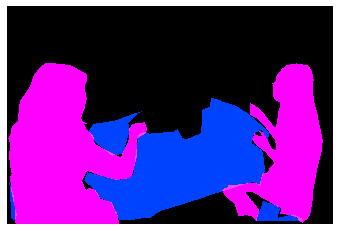

(428, 640, 3)
COCO_val2014_000000273708.jpg
{'person_bbx': [36.28, 1.86, 268.82, 408.35], 'Verbs': 'catch', 'object': {'obj_bbx': [547.22, 99.46, 640.0, 139.38]}}
person
frisbee
catch
catch interaction
{'person_bbx': [36.28, 1.86, 268.82, 408.35], 'Verbs': 'look', 'object': {'obj_bbx': [547.22, 99.46, 640.0, 139.38]}}
person
frisbee
look
look interaction
{'person_bbx': [36.28, 1.86, 268.82, 408.35], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [36.28, 1.86, 268.82, 408.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


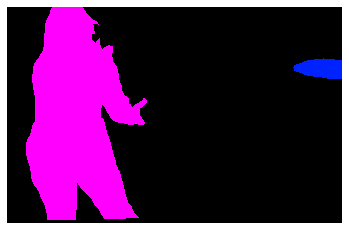

(413, 640, 3)
COCO_val2014_000000332087.jpg
{'person_bbx': [368.17, 137.06, 420.91, 203.75], 'Verbs': 'look', 'object': {'obj_bbx': [347.32, 188.38, 468.72, 210.15]}}
surfboard
person
look
look interaction
{'person_bbx': [368.17, 137.06, 420.91, 203.75], 'Verbs': 'surf', 'object': {'obj_bbx': [347.32, 188.38, 468.72, 210.15]}}
surfboard
person
surf
surf interaction


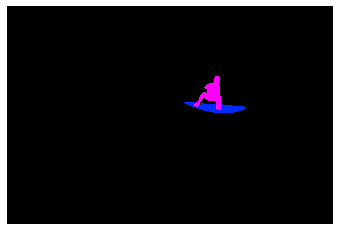

(427, 640, 3)
COCO_val2014_000000181980.jpg
{'person_bbx': [61.84, 170.71, 279.01, 620.86], 'Verbs': 'hold', 'object': {'obj_bbx': [201.52, 285.87, 229.20000000000002, 343.38]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [61.84, 170.71, 279.01, 620.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [61.84, 170.71, 279.01, 620.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [61.84, 170.71, 279.01, 620.86], 'Verbs': 'throw', 'object': {'obj_bbx': [115.2, 185.26, 129.57, 199.17]}}
sports ball
person
throw
throw interaction


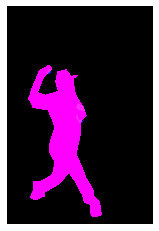

(640, 428, 3)
COCO_val2014_000000549112.jpg
{'person_bbx': [439.24, 1.23, 640.0, 247.34], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [416.98, 22.2, 516.14, 196.51999999999998]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [439.24, 1.23, 640.0, 247.34], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [218.27, 146.71, 519.82, 266.37]}}
sandwich
person
cut_obj
cut_obj interaction
{'person_bbx': [439.24, 1.23, 640.0, 247.34], 'Verbs': 'hold', 'object': {'obj_bbx': [416.98, 22.2, 516.14, 196.51999999999998]}}
knife
person
hold
hold interaction


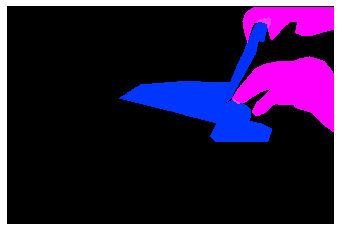

(426, 640, 3)
COCO_val2014_000000574178.jpg
{'person_bbx': [341.57, 184.8, 505.6, 455.77000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [341.57, 222.18, 493.15, 426.70000000000005]}}
person
snowboard
carry
carry interaction
{'person_bbx': [500.13, 198.17, 581.3, 445.45], 'Verbs': 'carry', 'object': {'obj_bbx': [422.58, 237.78, 625.86, 400.4]}}
person
snowboard
carry
carry interaction
{'person_bbx': [341.57, 184.8, 505.6, 455.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [341.57, 222.18, 493.15, 426.70000000000005]}}
person
snowboard
hold
hold interaction
{'person_bbx': [500.13, 198.17, 581.3, 445.45], 'Verbs': 'hold', 'object': {'obj_bbx': [422.58, 237.78, 625.86, 400.4]}}
person
snowboard
hold
hold interaction
{'person_bbx': [341.57, 184.8, 505.6, 455.77000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [500.13, 198.17, 581.3, 445.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [500.13, 198.17, 581.3, 

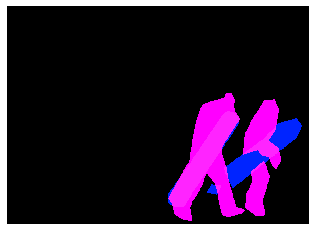

(462, 640, 3)
COCO_val2014_000000256903.jpg
{'person_bbx': [5.65, 2.42, 168.61, 199.26999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [43.08, 191.47, 193.38, 241.25]}}
snowboard
person
jump
jump interaction
{'person_bbx': [5.65, 2.42, 168.61, 199.26999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [43.08, 191.47, 193.38, 241.25]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [233.12, 57.29, 320.18, 240.42999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [233.12, 57.29, 320.18, 240.42999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


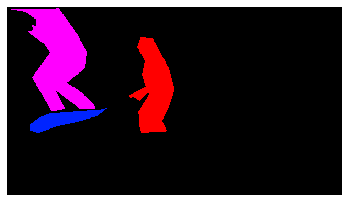

(359, 640, 3)
COCO_val2014_000000302290.jpg
{'person_bbx': [231.83, 144.82, 280.26, 288.23], 'Verbs': 'hold', 'object': {'obj_bbx': [209.53, 143.11, 245.94, 217.93]}}
person
frisbee
hold
hold interaction
{'person_bbx': [223.57, 44.87, 287.46, 205.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [231.83, 144.82, 280.26, 288.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [223.57, 44.87, 287.46, 205.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [231.83, 144.82, 280.26, 288.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


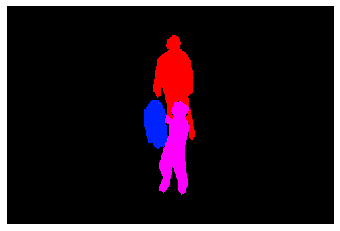

(333, 500, 3)
COCO_val2014_000000022004.jpg
{'person_bbx': [66.35, 6.19, 277.5, 402.08], 'Verbs': 'look', 'object': {'obj_bbx': [120.28, 372.05, 228.76999999999998, 425.12]}}
person
skateboard
look
look interaction
{'person_bbx': [66.35, 6.19, 277.5, 402.08], 'Verbs': 'skateboard', 'object': {'obj_bbx': [120.28, 372.05, 228.76999999999998, 425.12]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [66.35, 6.19, 277.5, 402.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


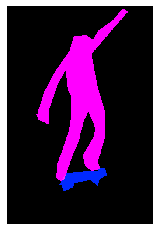

(500, 334, 3)
COCO_val2014_000000291257.jpg
{'person_bbx': [236.77, 37.67, 422.96000000000004, 241.07999999999998], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 16.0, 640.0, 480.0]}}
person
bed
lay
lay interaction


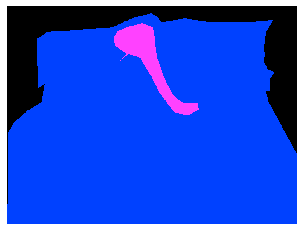

(480, 640, 3)
COCO_val2014_000000014892.jpg
{'person_bbx': [43.6, 0.02, 473.16, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [241.68, 126.19, 563.6, 422.32], 'Verbs': 'hold', 'object': {'obj_bbx': [351.89, 269.79, 373.65, 381.94000000000005]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [43.6, 0.02, 473.16, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [241.68, 126.19, 563.6, 422.32], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [43.6, 0.02, 473.16, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [241.68, 126.19, 563.6, 422.32], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


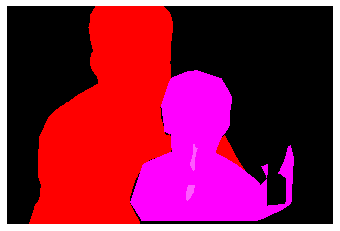

(427, 640, 3)
COCO_val2014_000000130062.jpg
{'person_bbx': [415.6, 188.73, 474.57000000000005, 277.19], 'Verbs': 'surf', 'object': {'obj_bbx': [432.68, 230.04, 489.92, 293.43]}}
person
surfboard
surf
surf interaction


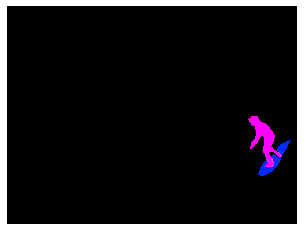

(375, 500, 3)
COCO_val2014_000000464515.jpg
{'person_bbx': [180.39, 17.31, 367.36, 319.67], 'Verbs': 'hold', 'object': {'obj_bbx': [1.46, 126.35, 598.1500000000001, 321.35]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [309.7, 59.02, 448.88, 325.0], 'Verbs': 'hold', 'object': {'obj_bbx': [180.39, 17.31, 367.36, 319.67]}}
person
person
hold
hold interaction
{'person_bbx': [180.39, 17.31, 367.36, 319.67], 'Verbs': 'ride', 'object': {'obj_bbx': [1.46, 126.35, 598.1500000000001, 321.35]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [309.7, 59.02, 448.88, 325.0], 'Verbs': 'ride', 'object': {'obj_bbx': [1.46, 126.35, 598.1500000000001, 321.35]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [180.39, 17.31, 367.36, 319.67], 'Verbs': 'sit', 'object': {'obj_bbx': [1.46, 126.35, 598.1500000000001, 321.35]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [309.7, 59.02, 448.88, 325.0], 'Verbs': 'sit', 'object': {'obj_bbx': [1.46, 126.35, 598.1500000000001, 321.

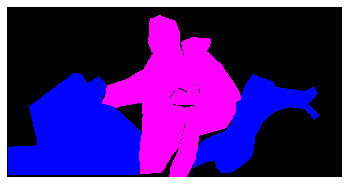

(325, 640, 3)
COCO_val2014_000000247477.jpg
{'person_bbx': [383.03, 214.95, 548.77, 325.28999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [300.39, 142.28, 614.19, 406.53999999999996]}}
couch
person
lay
lay interaction


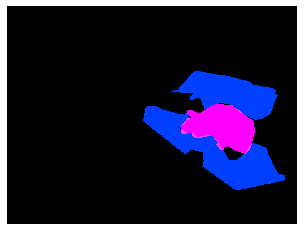

(480, 640, 3)
COCO_val2014_000000311922.jpg
{'person_bbx': [2.76, 0.0, 300.49, 612.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [271.24, 0.0, 609.27, 602.46], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


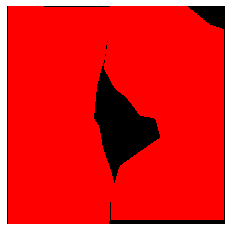

(612, 612, 3)
COCO_val2014_000000281012.jpg
{'person_bbx': [408.62, 178.14, 514.6, 368.71], 'Verbs': 'hold', 'object': {'obj_bbx': [391.12, 262.63, 419.8, 297.15]}}
person
frisbee
hold
hold interaction
{'person_bbx': [408.62, 178.14, 514.6, 368.71], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [408.62, 178.14, 514.6, 368.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


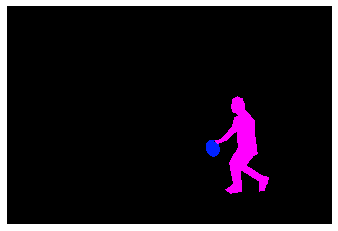

(429, 640, 3)
COCO_val2014_000000546667.jpg
{'person_bbx': [251.69, 50.34, 376.81, 277.57], 'Verbs': 'hold', 'object': {'obj_bbx': [182.93, 148.86, 404.87, 265.87]}}
person
bench
hold
hold interaction
{'person_bbx': [251.69, 50.34, 376.81, 277.57], 'Verbs': 'ride', 'object': {'obj_bbx': [78.92, 227.69, 441.93, 639.54]}}
elephant
person
ride
ride interaction
{'person_bbx': [251.69, 50.34, 376.81, 277.57], 'Verbs': 'sit', 'object': {'obj_bbx': [182.93, 148.86, 404.87, 265.87]}}
person
bench
sit
sit interaction
{'person_bbx': [251.69, 50.34, 376.81, 277.57], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


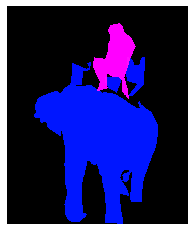

(640, 530, 3)
COCO_val2014_000000511929.jpg
{'person_bbx': [242.05, 316.09, 332.82, 510.0], 'Verbs': 'carry', 'object': {'obj_bbx': [315.75, 382.43, 357.13, 454.59000000000003]}}
person
surfboard
carry
carry interaction
{'person_bbx': [242.05, 316.09, 332.82, 510.0], 'Verbs': 'hold', 'object': {'obj_bbx': [315.75, 382.43, 357.13, 454.59000000000003]}}
person
surfboard
hold
hold interaction
{'person_bbx': [242.05, 316.09, 332.82, 510.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.05, 316.09, 332.82, 510.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


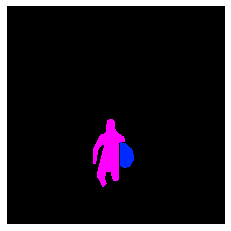

(612, 612, 3)
COCO_val2014_000000077754.jpg
{'person_bbx': [352.84, 70.38, 600.5999999999999, 330.67], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


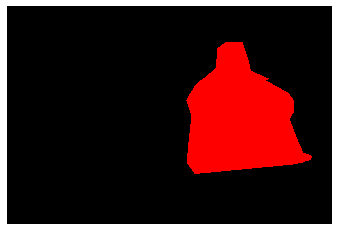

(429, 640, 3)
COCO_val2014_000000369667.jpg
{'person_bbx': [158.33, 97.94, 285.95000000000005, 281.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [158.33, 97.94, 285.95000000000005, 281.21000000000004], 'Verbs': 'surf', 'object': {'obj_bbx': [97.87, 241.81, 444.27, 352.15999999999997]}}
person
surfboard
surf
surf interaction


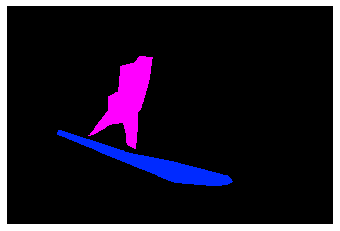

(427, 640, 3)
COCO_val2014_000000127153.jpg
{'person_bbx': [210.5, 182.58, 292.13, 375.9], 'Verbs': 'carry', 'object': {'obj_bbx': [209.65, 156.91, 299.13, 200.23]}}
umbrella
person
carry
carry interaction
{'person_bbx': [283.56, 207.64, 331.77, 376.88], 'Verbs': 'carry', 'object': {'obj_bbx': [292.78, 166.84, 397.18999999999994, 227.12]}}
umbrella
person
carry
carry interaction
{'person_bbx': [210.5, 182.58, 292.13, 375.9], 'Verbs': 'hold', 'object': {'obj_bbx': [209.65, 156.91, 299.13, 200.23]}}
umbrella
person
hold
hold interaction
{'person_bbx': [283.56, 207.64, 331.77, 376.88], 'Verbs': 'hold', 'object': {'obj_bbx': [292.78, 166.84, 397.18999999999994, 227.12]}}
umbrella
person
hold
hold interaction
{'person_bbx': [210.5, 182.58, 292.13, 375.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [283.56, 207.64, 331.77, 376.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [210.5, 182.58, 292.13, 375.9], 'Verbs': 'walk', 'object': 

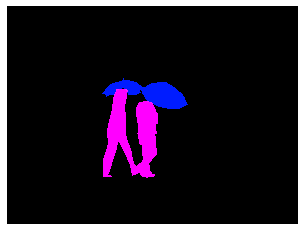

(479, 640, 3)
COCO_val2014_000000113533.jpg
{'person_bbx': [1.35, 122.97, 191.89, 497.29999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [194.51, 398.14, 252.85, 420.08]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.35, 122.97, 191.89, 497.29999999999995], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [246.74, 374.83, 347.87, 434.15999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [133.18, 126.61, 279.82, 479.08000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [194.51, 398.14, 252.85, 420.08]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [133.18, 126.61, 279.82, 479.08000000000004], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [246.74, 374.83, 347.87, 434.15999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.35, 122.97, 191.89, 497.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [194.51, 398.14, 252.85, 420.08]}}
person
knife
hold
hold interaction
{'person_bbx': [133.18, 126.61, 279.82, 47

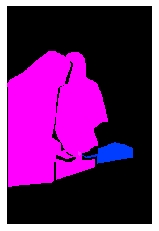

(600, 400, 3)
COCO_val2014_000000147740.jpg
{'person_bbx': [193.08, 293.39, 455.19000000000005, 472.45], 'Verbs': 'carry', 'object': {'obj_bbx': [224.92, 350.84, 299.77, 478.33]}}
person
handbag
carry
carry interaction
{'person_bbx': [193.08, 293.39, 455.19000000000005, 472.45], 'Verbs': 'hold', 'object': {'obj_bbx': [224.92, 350.84, 299.77, 478.33]}}
person
handbag
hold
hold interaction
{'person_bbx': [193.08, 293.39, 455.19000000000005, 472.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [193.08, 293.39, 455.19000000000005, 472.45], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


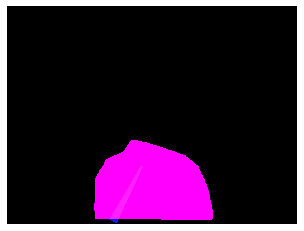

(480, 640, 3)
COCO_val2014_000000037325.jpg
{'person_bbx': [17.22, 0.0, 268.34000000000003, 272.65], 'Verbs': 'jump', 'object': {'obj_bbx': [0.79, 174.29, 111.73, 285.23]}}
skateboard
person
jump
jump interaction
{'person_bbx': [17.22, 0.0, 268.34000000000003, 272.65], 'Verbs': 'look', 'object': {'obj_bbx': [0.79, 174.29, 111.73, 285.23]}}
skateboard
person
look
look interaction
{'person_bbx': [17.22, 0.0, 268.34000000000003, 272.65], 'Verbs': 'skateboard', 'object': {'obj_bbx': [0.79, 174.29, 111.73, 285.23]}}
skateboard
person
skateboard
skateboard interaction


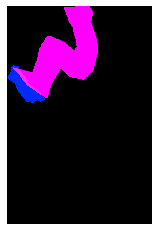

(640, 425, 3)
COCO_val2014_000000223955.jpg
{'person_bbx': [175.14, 67.18, 360.80999999999995, 329.52], 'Verbs': 'hold', 'object': {'obj_bbx': [188.54, 78.88, 222.74, 127.74]}}
person
frisbee
hold
hold interaction
{'person_bbx': [175.14, 67.18, 360.80999999999995, 329.52], 'Verbs': 'look', 'object': {'obj_bbx': [188.54, 78.88, 222.74, 127.74]}}
person
frisbee
look
look interaction
{'person_bbx': [175.14, 67.18, 360.80999999999995, 329.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [175.14, 67.18, 360.80999999999995, 329.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [175.14, 67.18, 360.80999999999995, 329.52], 'Verbs': 'throw', 'object': {'obj_bbx': [188.54, 78.88, 222.74, 127.74]}}
person
frisbee
throw
throw interaction


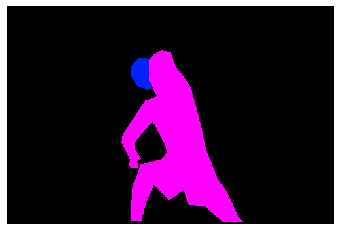

(333, 500, 3)
COCO_val2014_000000044579.jpg
{'person_bbx': [2.25, 11.04, 375.0, 493.02000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [246.37, 265.7, 325.68, 443.11]}}
person
cell phone
hold
hold interaction
{'person_bbx': [2.25, 11.04, 375.0, 493.02000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.25, 11.04, 375.0, 493.02000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [246.37, 265.7, 325.68, 443.11]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


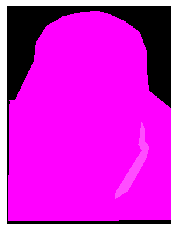

(500, 375, 3)
COCO_val2014_000000579226.jpg
{'person_bbx': [126.9, 144.31, 226.46, 253.68], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [119.14, 296.94, 188.66, 415.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [400.76, 254.36, 486.65, 378.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


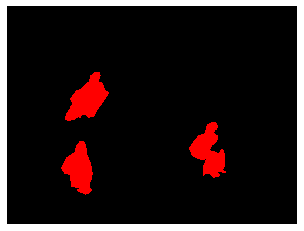

(480, 640, 3)
COCO_val2014_000000066706.jpg
{'person_bbx': [357.29, 58.71, 496.99, 497.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


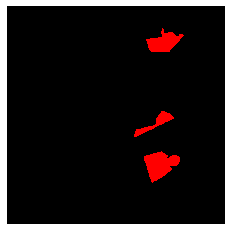

(612, 612, 3)
COCO_val2014_000000452515.jpg
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [167.33, 337.87, 185.63000000000002, 393.88]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [90.39, 168.49, 100.07, 182.67000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'hold', 'object': {'obj_bbx': [167.33, 337.87, 185.63000000000002, 393.88]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'look', 'object': {'obj_bbx': [90.39, 168.49, 100.07, 182.67000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [87.47, 310.49, 171.8, 473.94], 'Verbs': 'throw', 'object': {'obj_bbx': [90.39, 168.49, 100.07, 182.67000000000002

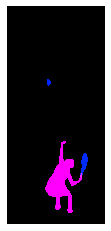

(500, 224, 3)
COCO_val2014_000000073333.jpg
{'person_bbx': [374.03, 157.85, 485.46, 279.27], 'Verbs': 'look', 'object': {'obj_bbx': [370.02, 267.05, 484.78, 295.33000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [374.03, 157.85, 485.46, 279.27], 'Verbs': 'surf', 'object': {'obj_bbx': [370.02, 267.05, 484.78, 295.33000000000004]}}
person
surfboard
surf
surf interaction


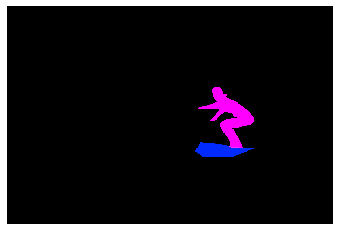

(427, 640, 3)
COCO_val2014_000000505814.jpg
{'person_bbx': [84.78, 176.21, 219.43, 340.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [84.78, 176.21, 219.43, 340.78], 'Verbs': 'surf', 'object': {'obj_bbx': [66.07, 252.11, 198.54999999999998, 371.06]}}
surfboard
person
surf
surf interaction


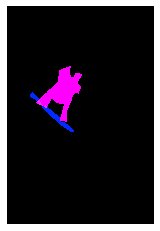

(640, 430, 3)
COCO_val2014_000000063563.jpg
{'person_bbx': [167.3, 93.95, 378.22, 267.17], 'Verbs': 'jump', 'object': {'obj_bbx': [193.32, 248.14, 377.99, 277.96]}}
snowboard
person
jump
jump interaction
{'person_bbx': [167.3, 93.95, 378.22, 267.17], 'Verbs': 'look', 'object': {'obj_bbx': [193.32, 248.14, 377.99, 277.96]}}
snowboard
person
look
look interaction
{'person_bbx': [167.3, 93.95, 378.22, 267.17], 'Verbs': 'snowboard', 'object': {'obj_bbx': [193.32, 248.14, 377.99, 277.96]}}
snowboard
person
snowboard
snowboard interaction


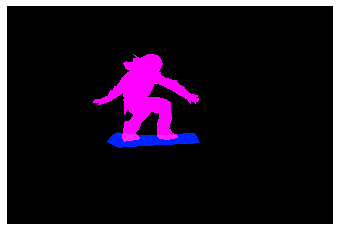

(428, 640, 3)
COCO_val2014_000000114453.jpg
{'person_bbx': [74.59, 5.27, 413.61, 328.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [245.9, 108.32, 269.54, 221.26]}}
cell phone
person
hold
hold interaction
{'person_bbx': [74.59, 5.27, 413.61, 328.47999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [74.59, 5.27, 413.61, 328.47999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [245.9, 108.32, 269.54, 221.26]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


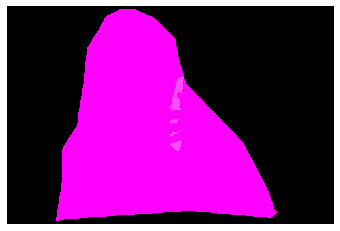

(333, 500, 3)
COCO_val2014_000000225378.jpg
{'person_bbx': [285.28, 67.01, 490.14, 324.53], 'Verbs': 'kick', 'object': {'obj_bbx': [273.7, 287.23, 314.25, 325.45000000000005]}}
sports ball
person
kick
kick interaction
{'person_bbx': [285.28, 67.01, 490.14, 324.53], 'Verbs': 'look', 'object': {'obj_bbx': [273.7, 287.23, 314.25, 325.45000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [285.28, 67.01, 490.14, 324.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [285.28, 67.01, 490.14, 324.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


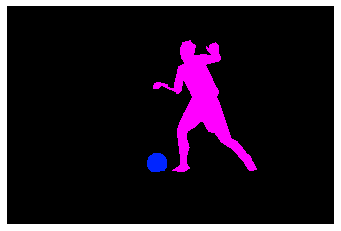

(426, 640, 3)
COCO_val2014_000000469982.jpg
{'person_bbx': [107.81, 2.39, 636.8699999999999, 471.87], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [189.4, 208.95, 356.26, 335.34]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [107.81, 2.39, 636.8699999999999, 471.87], 'Verbs': 'hold', 'object': {'obj_bbx': [189.4, 208.95, 356.26, 335.34]}}
person
donut
hold
hold interaction
{'person_bbx': [107.81, 2.39, 636.8699999999999, 471.87], 'Verbs': 'look', 'object': {'obj_bbx': [189.4, 208.95, 356.26, 335.34]}}
person
donut
look
look interaction
{'person_bbx': [107.81, 2.39, 636.8699999999999, 471.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


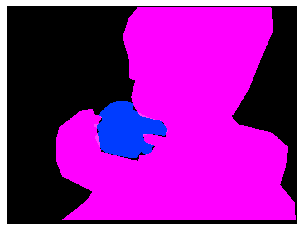

(480, 640, 3)
COCO_val2014_000000368602.jpg
{'person_bbx': [290.23, 43.19, 352.46000000000004, 172.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [290.23, 43.19, 352.46000000000004, 172.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [290.23, 43.19, 352.46000000000004, 172.48], 'Verbs': 'surf', 'object': {'obj_bbx': [255.88, 156.19, 327.3, 181.66]}}
person
surfboard
surf
surf interaction


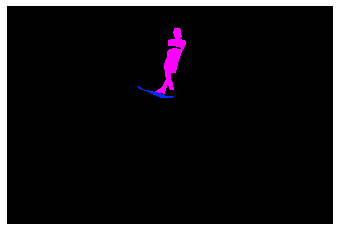

(427, 640, 3)
COCO_val2014_000000435358.jpg
{'person_bbx': [228.63, 135.54, 363.73, 288.28999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [288.94, 228.28, 369.51, 307.82]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [228.63, 135.54, 363.73, 288.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


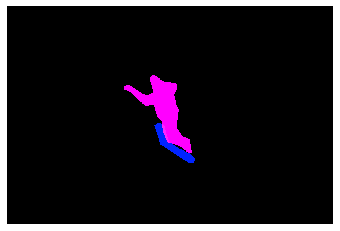

(427, 640, 3)
COCO_val2014_000000262703.jpg
{'person_bbx': [128.32, 47.0, 300.66999999999996, 219.34], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [128.32, 47.0, 300.66999999999996, 219.34], 'Verbs': 'snowboard', 'object': {'obj_bbx': [225.43, 0.86, 311.44, 108.37]}}
person
snowboard
snowboard
snowboard interaction


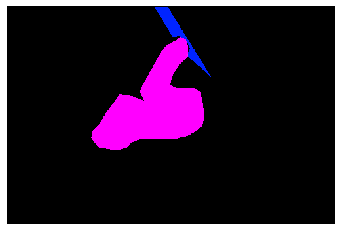

(332, 500, 3)
COCO_val2014_000000562614.jpg
{'person_bbx': [237.21, 170.2, 327.29, 331.17999999999995], 'Verbs': 'kick', 'object': {'obj_bbx': [114.09, 294.96, 139.03, 319.89]}}
sports ball
person
kick
kick interaction
{'person_bbx': [237.21, 170.2, 327.29, 331.17999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [114.09, 294.96, 139.03, 319.89]}}
sports ball
person
look
look interaction
{'person_bbx': [412.04, 190.62, 527.76, 352.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [237.21, 170.2, 327.29, 331.17999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [237.21, 170.2, 327.29, 331.17999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


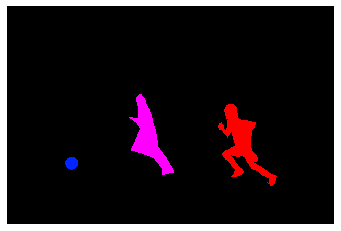

(426, 640, 3)
COCO_val2014_000000153205.jpg
{'person_bbx': [66.16, 96.12, 280.45, 611.0], 'Verbs': 'hold', 'object': {'obj_bbx': [121.35, 560.18, 236.93, 617.9699999999999]}}
person
skis
hold
hold interaction
{'person_bbx': [66.16, 96.12, 280.45, 611.0], 'Verbs': 'ski', 'object': {'obj_bbx': [121.35, 560.18, 236.93, 617.9699999999999]}}
person
skis
ski
ski interaction
{'person_bbx': [66.16, 96.12, 280.45, 611.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [66.16, 96.12, 280.45, 611.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


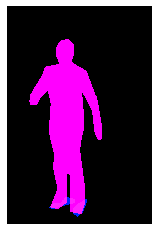

(640, 426, 3)
COCO_val2014_000000391603.jpg
{'person_bbx': [0.0, 0.0, 480.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


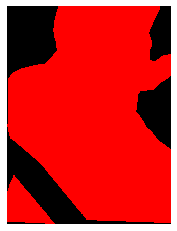

(640, 480, 3)
COCO_val2014_000000250344.jpg
{'person_bbx': [366.91, 143.13, 639.48, 425.23], 'Verbs': 'hold', 'object': {'obj_bbx': [384.3, 231.15, 503.67, 331.91]}}
person
laptop
hold
hold interaction
{'person_bbx': [366.91, 143.13, 639.48, 425.23], 'Verbs': 'look', 'object': {'obj_bbx': [384.3, 231.15, 503.67, 331.91]}}
person
laptop
look
look interaction
{'person_bbx': [366.91, 143.13, 639.48, 425.23], 'Verbs': 'sit', 'object': {'obj_bbx': [293.45, 176.07, 640.0, 421.06]}}
couch
person
sit
sit interaction
{'person_bbx': [366.91, 143.13, 639.48, 425.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [366.91, 143.13, 639.48, 425.23], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [384.3, 231.15, 503.67, 331.91]}}
person
laptop
work_on_computer
work_on_computer interaction


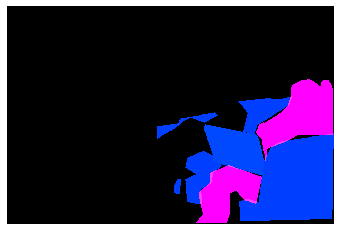

(426, 640, 3)
COCO_val2014_000000398076.jpg
{'person_bbx': [31.67, 0.0, 640.0, 392.46], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 1.92, 634.26, 421.24]}}
bed
person
lay
lay interaction
{'person_bbx': [31.67, 0.0, 640.0, 392.46], 'Verbs': 'look', 'object': {'obj_bbx': [317.61, 81.8, 447.15, 367.75]}}
person
book
look
look interaction
{'person_bbx': [31.67, 0.0, 640.0, 392.46], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point


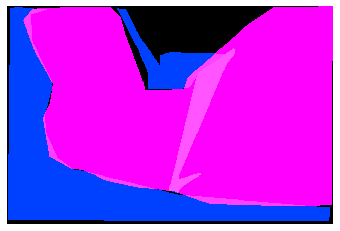

(427, 640, 3)
COCO_val2014_000000144863.jpg
{'person_bbx': [0.0, 1.18, 556.24, 474.73], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [299.29, 172.45, 627.95, 278.62]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 1.18, 556.24, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [299.29, 172.45, 627.95, 278.62]}}
person
hot dog
hold
hold interaction
{'person_bbx': [0.0, 1.18, 556.24, 474.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


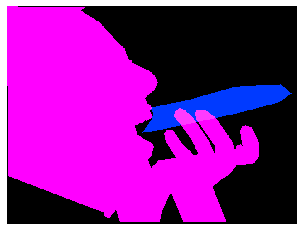

(480, 640, 3)
COCO_val2014_000000462784.jpg
{'person_bbx': [0.0, 75.34, 136.68, 416.5], 'Verbs': 'carry', 'object': {'obj_bbx': [43.05, 116.88, 135.61, 248.18]}}
person
backpack
carry
carry interaction
{'person_bbx': [532.83, 0.0, 640.0, 297.42], 'Verbs': 'carry', 'object': {'obj_bbx': [483.24, 269.66, 640.0, 480.0]}}
suitcase
person
carry
carry interaction
{'person_bbx': [532.83, 0.0, 640.0, 297.42], 'Verbs': 'hold', 'object': {'obj_bbx': [483.24, 269.66, 640.0, 480.0]}}
suitcase
person
hold
hold interaction
{'person_bbx': [0.0, 75.34, 136.68, 416.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 75.34, 136.68, 416.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [532.83, 0.0, 640.0, 297.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


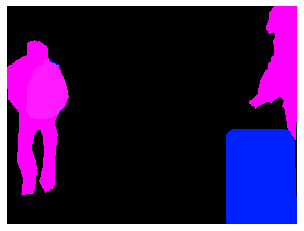

(480, 640, 3)
COCO_val2014_000000224366.jpg
{'person_bbx': [172.31, 64.14, 525.56, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [86.35, 64.37, 164.39999999999998, 104.38]}}
person
frisbee
look
look interaction
{'person_bbx': [184.76, 60.31, 411.64, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [86.35, 64.37, 164.39999999999998, 104.38]}}
frisbee
person
look
look interaction
{'person_bbx': [172.31, 64.14, 525.56, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [184.76, 60.31, 411.64, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [184.76, 60.31, 411.64, 421.21], 'Verbs': 'throw', 'object': {'obj_bbx': [86.35, 64.37, 164.39999999999998, 104.38]}}
frisbee
person
throw
throw interaction


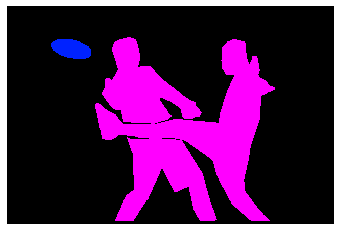

(426, 640, 3)
COCO_val2014_000000036561.jpg
{'person_bbx': [463.29, 60.95, 629.61, 239.89], 'Verbs': 'look', 'object': {'obj_bbx': [7.8, 36.78, 161.62, 248.0]}}
person
person
look
look interaction
{'person_bbx': [7.8, 36.78, 161.62, 248.0], 'Verbs': 'look', 'object': {'obj_bbx': [276.42, 61.86, 368.93, 162.18]}}
person
person
look
look interaction
{'person_bbx': [463.29, 60.95, 629.61, 239.89], 'Verbs': 'sit', 'object': {'obj_bbx': [561.55, 156.86, 640.0, 248.0]}}
person
chair
sit
sit interaction
{'person_bbx': [7.8, 36.78, 161.62, 248.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 154.41, 158.35, 248.0]}}
chair
person
sit
sit interaction


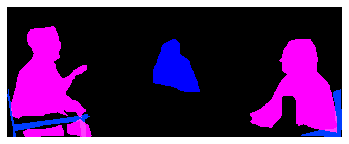

(248, 640, 3)
COCO_val2014_000000581328.jpg
{'person_bbx': [235.68, 127.57, 432.43, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [235.68, 127.57, 432.43, 480.0], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


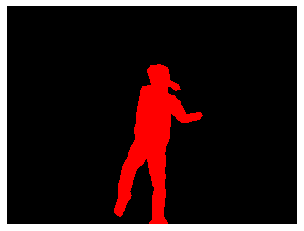

(480, 640, 3)
COCO_val2014_000000472472.jpg
{'person_bbx': [293.35, 83.68, 455.89, 423.19], 'Verbs': 'hold', 'object': {'obj_bbx': [339.27, 231.61, 397.94, 250.01000000000002]}}
frisbee
person
hold
hold interaction
{'person_bbx': [293.35, 83.68, 455.89, 423.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.35, 83.68, 455.89, 423.19], 'Verbs': 'throw', 'object': {'obj_bbx': [339.27, 231.61, 397.94, 250.01000000000002]}}
frisbee
person
throw
throw interaction


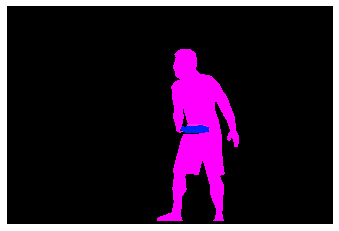

(428, 640, 3)
COCO_val2014_000000298493.jpg
{'person_bbx': [37.69, 96.5, 206.03, 426.91], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [3.38, 215.65, 194.82, 258.45]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [37.69, 96.5, 206.03, 426.91], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [207.71, 218.85, 233.19, 243.0]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [37.69, 96.5, 206.03, 426.91], 'Verbs': 'hold', 'object': {'obj_bbx': [3.38, 215.65, 194.82, 258.45]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [37.69, 96.5, 206.03, 426.91], 'Verbs': 'look', 'object': {'obj_bbx': [207.71, 218.85, 233.19, 243.0]}}
sports ball
person
look
look interaction
{'person_bbx': [37.69, 96.5, 206.03, 426.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


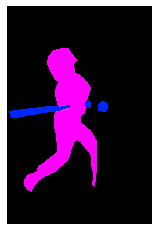

(500, 333, 3)
COCO_val2014_000000531633.jpg
{'person_bbx': [318.57, 81.56, 469.22, 340.64], 'Verbs': 'carry', 'object': {'obj_bbx': [237.18, 160.39, 568.6700000000001, 348.82]}}
person
surfboard
carry
carry interaction
{'person_bbx': [318.57, 81.56, 469.22, 340.64], 'Verbs': 'hold', 'object': {'obj_bbx': [237.18, 160.39, 568.6700000000001, 348.82]}}
person
surfboard
hold
hold interaction
{'person_bbx': [318.57, 81.56, 469.22, 340.64], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


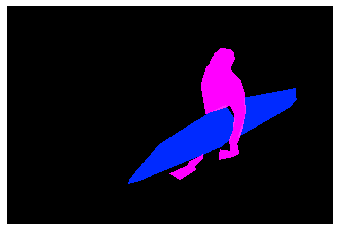

(427, 640, 3)
COCO_val2014_000000418275.jpg
{'person_bbx': [141.39, 50.57, 375.0, 270.8], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


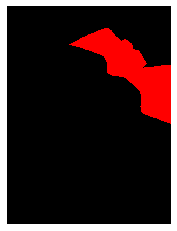

(500, 375, 3)
COCO_val2014_000000422274.jpg
{'person_bbx': [376.78, 39.58, 533.8199999999999, 220.76], 'Verbs': 'surf', 'object': {'obj_bbx': [357.31, 192.1, 563.4200000000001, 235.92]}}
person
surfboard
surf
surf interaction


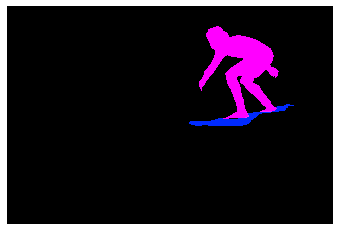

(427, 640, 3)
COCO_val2014_000000273321.jpg
{'person_bbx': [229.0, 60.54, 380.01, 307.24], 'Verbs': 'catch', 'object': {'obj_bbx': [201.85, 69.58, 234.05, 83.13]}}
person
frisbee
catch
catch interaction
{'person_bbx': [229.0, 60.54, 380.01, 307.24], 'Verbs': 'hold', 'object': {'obj_bbx': [201.85, 69.58, 234.05, 83.13]}}
person
frisbee
hold
hold interaction
{'person_bbx': [229.0, 60.54, 380.01, 307.24], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [0.0, 151.53, 64.28, 311.76], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 151.53, 64.28, 311.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [229.0, 60.54, 380.01, 307.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


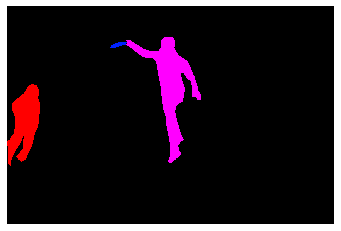

(426, 640, 3)
COCO_val2014_000000417911.jpg
{'person_bbx': [201.03, 38.48, 357.82, 204.88], 'Verbs': 'look', 'object': {'obj_bbx': [244.35, 173.28, 463.78, 274.40999999999997]}}
person
surfboard
look
look interaction
{'person_bbx': [201.03, 38.48, 357.82, 204.88], 'Verbs': 'surf', 'object': {'obj_bbx': [244.35, 173.28, 463.78, 274.40999999999997]}}
person
surfboard
surf
surf interaction


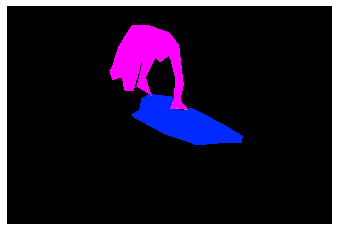

(429, 640, 3)
COCO_val2014_000000204943.jpg
{'person_bbx': [48.9, 2.44, 437.21, 629.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [48.9, 2.44, 437.21, 629.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


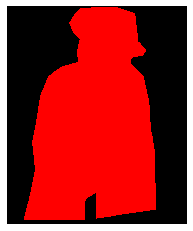

(640, 527, 3)
COCO_val2014_000000180653.jpg
{'person_bbx': [155.69, 63.72, 258.73, 409.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [264.46, 125.26, 397.55999999999995, 380.92], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [155.69, 63.72, 258.73, 409.71000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [108.37, 361.74, 369.4, 467.02]}}
person
skis
ski
ski interaction
{'person_bbx': [264.46, 125.26, 397.55999999999995, 380.92], 'Verbs': 'ski', 'object': {'obj_bbx': [250.04, 358.66, 393.94, 422.95000000000005]}}
person
skis
ski
ski interaction
{'person_bbx': [264.46, 125.26, 397.55999999999995, 380.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [155.69, 63.72, 258.73, 409.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [264.46, 125.26, 397.55999999999995, 380.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


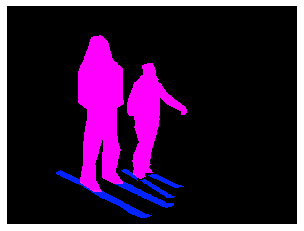

(480, 640, 3)
COCO_val2014_000000263834.jpg
{'person_bbx': [334.38, 89.53, 505.89, 431.46000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [374.05, 241.62, 482.16, 475.14]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [326.44, 59.16, 533.69, 473.65999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [374.05, 241.62, 482.16, 475.14]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [334.38, 89.53, 505.89, 431.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [374.05, 241.62, 482.16, 475.14]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [326.44, 59.16, 533.69, 473.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [374.05, 241.62, 482.16, 475.14]}}
motorcycle
person
sit
sit interaction


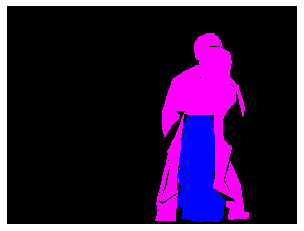

(480, 640, 3)
COCO_val2014_000000000831.jpg
{'person_bbx': [139.17, 112.58, 273.83, 269.92], 'Verbs': 'jump', 'object': {'obj_bbx': [131.77, 234.82, 234.58, 304.6]}}
person
skateboard
jump
jump interaction
{'person_bbx': [139.17, 112.58, 273.83, 269.92], 'Verbs': 'look', 'object': {'obj_bbx': [131.77, 234.82, 234.58, 304.6]}}
person
skateboard
look
look interaction
{'person_bbx': [139.17, 112.58, 273.83, 269.92], 'Verbs': 'skateboard', 'object': {'obj_bbx': [131.77, 234.82, 234.58, 304.6]}}
person
skateboard
skateboard
skateboard interaction


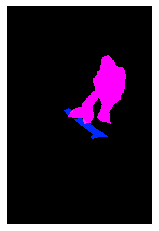

(500, 333, 3)
COCO_val2014_000000394533.jpg
{'person_bbx': [243.54, 106.67, 362.91999999999996, 218.42000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [215.86, 136.37, 261.81, 216.78]}}
person
skateboard
jump
jump interaction
{'person_bbx': [243.54, 106.67, 362.91999999999996, 218.42000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [215.86, 136.37, 261.81, 216.78]}}
person
skateboard
look
look interaction
{'person_bbx': [243.54, 106.67, 362.91999999999996, 218.42000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [215.86, 136.37, 261.81, 216.78]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [0.0, 0.0, 24.16, 195.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


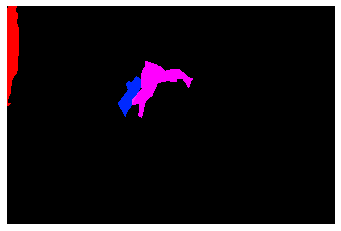

(425, 640, 3)
COCO_val2014_000000116861.jpg
{'person_bbx': [0.0, 55.56, 597.67, 474.15], 'Verbs': 'hold', 'object': {'obj_bbx': [243.27, 175.45, 542.51, 471.46999999999997]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.0, 55.56, 597.67, 474.15], 'Verbs': 'lay', 'object': {'obj_bbx': [5.15, 3.09, 640.0, 473.84999999999997]}}
couch
person
lay
lay interaction


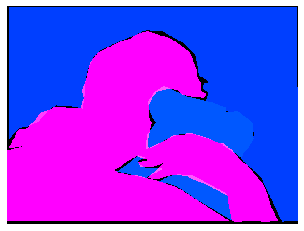

(479, 640, 3)
COCO_val2014_000000229304.jpg
{'person_bbx': [351.57, 160.65, 551.03, 627.01], 'Verbs': 'hold', 'object': {'obj_bbx': [496.16, 329.48, 597.33, 347.70000000000005]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [274.81, 367.78, 567.31, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [524.25, 577.41, 585.59, 639.76]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [19.96, 228.1, 250.36, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [19.96, 228.1, 250.36, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [351.57, 160.65, 551.03, 627.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.81, 367.78, 567.31, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


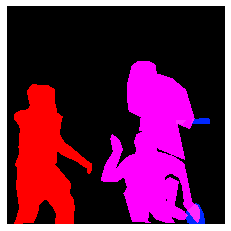

(640, 640, 3)
COCO_val2014_000000278226.jpg
{'person_bbx': [1.08, 0.0, 407.72999999999996, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [325.89, 305.33, 612.8299999999999, 480.0]}}
person
laptop
look
look interaction
{'person_bbx': [1.08, 0.0, 407.72999999999996, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.29, 373.88, 217.85999999999999, 480.0]}}
person
couch
sit
sit interaction
{'person_bbx': [1.08, 0.0, 407.72999999999996, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [325.89, 305.33, 612.8299999999999, 480.0]}}
person
laptop
work_on_computer
work_on_computer interaction


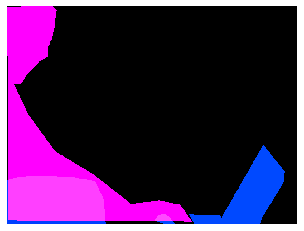

(480, 640, 3)
COCO_val2014_000000304180.jpg
{'person_bbx': [273.34, 92.99, 397.33, 404.85], 'Verbs': 'hold', 'object': {'obj_bbx': [276.16, 258.97, 343.79, 399.87]}}
person
skateboard
hold
hold interaction
{'person_bbx': [273.34, 92.99, 397.33, 404.85], 'Verbs': 'look', 'object': {'obj_bbx': [276.16, 258.97, 343.79, 399.87]}}
person
skateboard
look
look interaction
{'person_bbx': [546.69, 68.57, 640.0, 411.42], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 0.18, 127.18, 141.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [273.34, 92.99, 397.33, 404.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [546.69, 68.57, 640.0, 411.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


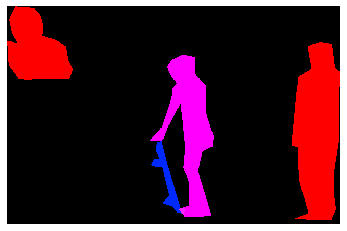

(418, 640, 3)
COCO_val2014_000000510152.jpg
{'person_bbx': [153.85, 181.32, 269.02, 270.58], 'Verbs': 'jump', 'object': {'obj_bbx': [121.08, 231.19, 257.79, 286.22]}}
person
snowboard
jump
jump interaction
{'person_bbx': [153.85, 181.32, 269.02, 270.58], 'Verbs': 'snowboard', 'object': {'obj_bbx': [121.08, 231.19, 257.79, 286.22]}}
person
snowboard
snowboard
snowboard interaction


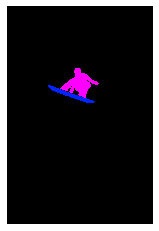

(640, 427, 3)
COCO_val2014_000000422200.jpg
{'person_bbx': [290.74, 126.66, 466.34000000000003, 337.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [290.74, 126.66, 466.34000000000003, 337.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [290.74, 126.66, 466.34000000000003, 337.76], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


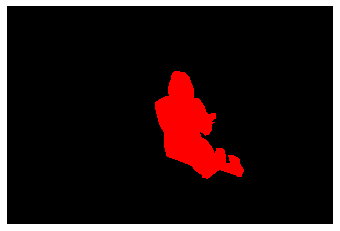

(427, 640, 3)
COCO_val2014_000000463272.jpg
{'person_bbx': [263.87, 4.06, 630.77, 393.84], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [17.08, 151.07, 285.84, 274.22]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [263.87, 4.06, 630.77, 393.84], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [406.56, 71.51, 441.06, 110.16]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [263.87, 4.06, 630.77, 393.84], 'Verbs': 'hold', 'object': {'obj_bbx': [17.08, 151.07, 285.84, 274.22]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [263.87, 4.06, 630.77, 393.84], 'Verbs': 'look', 'object': {'obj_bbx': [406.56, 71.51, 441.06, 110.16]}}
sports ball
person
look
look interaction
{'person_bbx': [263.87, 4.06, 630.77, 393.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


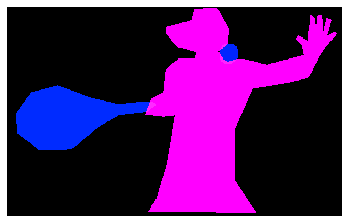

(400, 640, 3)
COCO_val2014_000000433136.jpg
{'person_bbx': [81.09, 284.89, 291.11, 418.78], 'Verbs': 'hold', 'object': {'obj_bbx': [219.4, 343.18, 304.97, 420.1]}}
person
skateboard
hold
hold interaction
{'person_bbx': [81.09, 284.89, 291.11, 418.78], 'Verbs': 'jump', 'object': {'obj_bbx': [219.4, 343.18, 304.97, 420.1]}}
person
skateboard
jump
jump interaction
{'person_bbx': [81.09, 284.89, 291.11, 418.78], 'Verbs': 'look', 'object': {'obj_bbx': [219.4, 343.18, 304.97, 420.1]}}
person
skateboard
look
look interaction
{'person_bbx': [81.09, 284.89, 291.11, 418.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [219.4, 343.18, 304.97, 420.1]}}
person
skateboard
skateboard
skateboard interaction


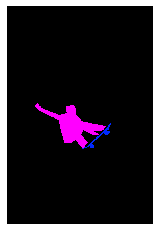

(640, 427, 3)
COCO_val2014_000000491784.jpg
{'person_bbx': [46.38, 143.28, 637.48, 346.07], 'Verbs': 'lay', 'object': {'obj_bbx': [2.15, 148.29, 640.0, 480.0]}}
person
bed
lay
lay interaction
{'person_bbx': [46.38, 143.28, 637.48, 346.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


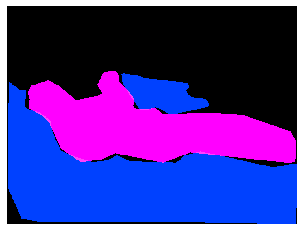

(480, 640, 3)
COCO_val2014_000000558213.jpg
{'person_bbx': [255.24, 216.01, 313.85, 353.31], 'Verbs': 'look', 'object': {'obj_bbx': [246.68, 343.93, 297.39, 361.7]}}
person
skateboard
look
look interaction
{'person_bbx': [255.24, 216.01, 313.85, 353.31], 'Verbs': 'skateboard', 'object': {'obj_bbx': [246.68, 343.93, 297.39, 361.7]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [255.24, 216.01, 313.85, 353.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


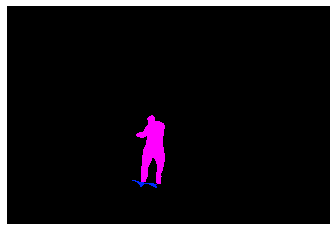

(432, 640, 3)
COCO_val2014_000000150677.jpg
{'person_bbx': [79.22, 0.0, 351.95000000000005, 493.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [79.22, 0.0, 351.95000000000005, 493.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


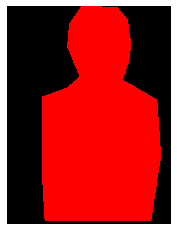

(500, 375, 3)
COCO_val2014_000000529166.jpg
{'person_bbx': [28.84, 66.71, 333.0, 492.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [146.12, 180.61, 236.05, 202.54000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [28.84, 66.71, 333.0, 492.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


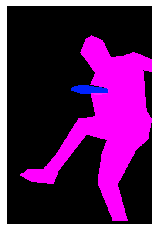

(500, 333, 3)
COCO_val2014_000000421218.jpg
{'person_bbx': [105.5, 125.0, 238.0, 277.5], 'Verbs': 'jump', 'object': {'obj_bbx': [136.94, 257.36, 202.32, 300.41]}}
person
skateboard
jump
jump interaction
{'person_bbx': [105.5, 125.0, 238.0, 277.5], 'Verbs': 'look', 'object': {'obj_bbx': [136.94, 257.36, 202.32, 300.41]}}
person
skateboard
look
look interaction
{'person_bbx': [105.5, 125.0, 238.0, 277.5], 'Verbs': 'skateboard', 'object': {'obj_bbx': [136.94, 257.36, 202.32, 300.41]}}
person
skateboard
skateboard
skateboard interaction


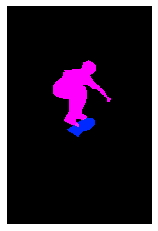

(500, 332, 3)
COCO_val2014_000000431691.jpg
{'person_bbx': [145.03, 0.59, 480.0, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [168.03, 230.99, 232.45, 277.07]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [145.03, 0.59, 480.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [168.03, 230.99, 232.45, 277.07]}}
donut
person
hold
hold interaction
{'person_bbx': [145.03, 0.59, 480.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


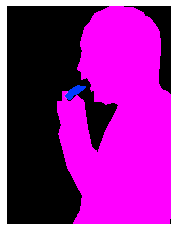

(640, 480, 3)
COCO_val2014_000000469061.jpg
{'person_bbx': [112.9, 193.8, 338.25, 591.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [112.9, 193.8, 338.25, 591.14], 'Verbs': 'look', 'object': {'obj_bbx': [123.86, 564.74, 377.11, 606.89]}}
person
skis
look
look interaction
{'person_bbx': [150.13, 16.14, 341.38, 522.08], 'Verbs': 'look', 'object': {'obj_bbx': [112.9, 193.8, 338.25, 591.14]}}
person
person
look
look interaction
{'person_bbx': [112.9, 193.8, 338.25, 591.14], 'Verbs': 'ski', 'object': {'obj_bbx': [81.04, 566.38, 274.32, 598.76]}}
person
skis
ski
ski interaction
{'person_bbx': [150.13, 16.14, 341.38, 522.08], 'Verbs': 'ski', 'object': {'obj_bbx': [63.43, 522.04, 400.33, 555.89]}}
person
skis
ski
ski interaction
{'person_bbx': [112.9, 193.8, 338.25, 591.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [150.13, 16.14, 341.38, 522.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


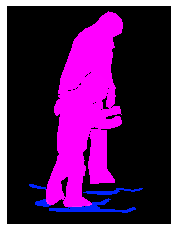

(640, 481, 3)
COCO_val2014_000000219771.jpg
{'person_bbx': [0.0, 18.7, 455.06, 473.77], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [279.79, 254.43, 328.48, 306.35]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 18.7, 455.06, 473.77], 'Verbs': 'hold', 'object': {'obj_bbx': [279.79, 254.43, 328.48, 306.35]}}
person
donut
hold
hold interaction
{'person_bbx': [0.0, 18.7, 455.06, 473.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 18.7, 455.06, 473.77], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


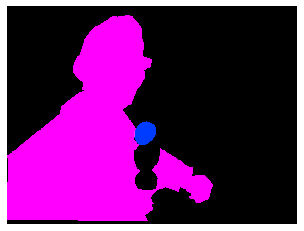

(480, 640, 3)
COCO_val2014_000000532693.jpg
{'person_bbx': [1.21, 0.0, 202.11, 183.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [465.74, 318.11, 639.66, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 79.46, 488.22, 420.26]}}
book
person
hold
hold interaction
{'person_bbx': [1.21, 0.0, 202.11, 183.95], 'Verbs': 'read', 'object': {'obj_bbx': [0.0, 79.46, 488.22, 420.26]}}
book
person
read
read interaction
{'person_bbx': [465.74, 318.11, 639.66, 426.0], 'Verbs': 'read', 'object': {'obj_bbx': [0.0, 79.46, 488.22, 420.26]}}
book
person
read
read interaction
{'person_bbx': [1.21, 0.0, 202.11, 183.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


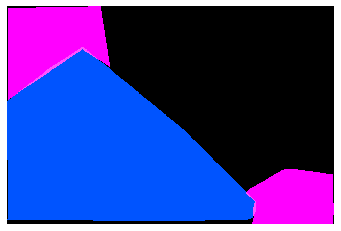

(426, 640, 3)
COCO_val2014_000000382288.jpg


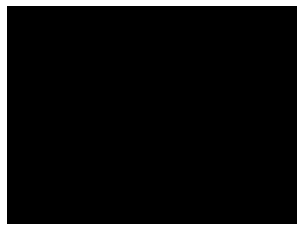

(480, 640, 3)
COCO_val2014_000000128830.jpg
{'person_bbx': [60.44, 41.28, 266.18, 640.0], 'Verbs': 'skateboard', 'object': {'obj_bbx': [196.78, 440.27, 348.63, 634.7]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [60.44, 41.28, 266.18, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


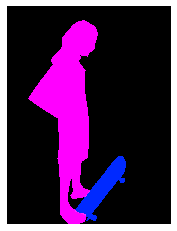

(640, 480, 3)
COCO_val2014_000000349203.jpg
{'person_bbx': [154.5, 161.32, 203.44, 314.86], 'Verbs': 'hold', 'object': {'obj_bbx': [178.9, 221.2, 230.18, 245.52999999999997]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [35.59, 157.8, 105.8, 318.42], 'Verbs': 'hold', 'object': {'obj_bbx': [48.31, 199.8, 106.59, 234.88]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [442.36, 182.56, 513.22, 358.74], 'Verbs': 'hold', 'object': {'obj_bbx': [442.38, 268.23, 486.65, 301.43]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [400.59, 160.47, 451.09999999999997, 310.38], 'Verbs': 'hold', 'object': {'obj_bbx': [427.03, 199.81, 473.92999999999995, 229.91]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [154.5, 161.32, 203.44, 314.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [35.59, 157.8, 105.8, 318.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [442.36, 182.56, 513.22, 358.74], 'Verb

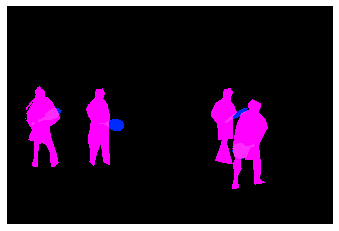

(428, 640, 3)
COCO_val2014_000000239355.jpg
{'person_bbx': [192.0, 364.54, 225.97, 416.67], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [273.95, 269.1, 314.02, 308.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [371.33, 9.18, 417.71999999999997, 79.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [546.73, 54.35, 599.12, 133.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [231.26, 403.12, 279.44, 438.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [192.0, 364.54, 225.97, 416.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [371.33, 9.18, 417.71999999999997, 79.53], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [546.73, 54.35, 599.12, 133.36], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


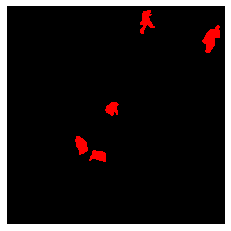

(612, 612, 3)
COCO_val2014_000000209548.jpg
{'person_bbx': [391.66, 2.05, 640.0, 299.13], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [247.82, 148.62, 457.53, 257.55]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [391.66, 2.05, 640.0, 299.13], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [6.72, 161.2, 358.87, 424.12]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [391.66, 2.05, 640.0, 299.13], 'Verbs': 'hold', 'object': {'obj_bbx': [247.82, 148.62, 457.53, 257.55]}}
knife
person
hold
hold interaction
{'person_bbx': [391.66, 2.05, 640.0, 299.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


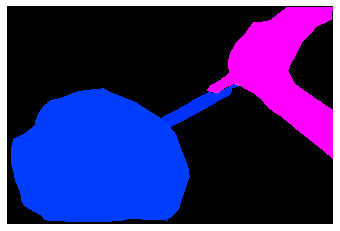

(427, 640, 3)
COCO_val2014_000000176794.jpg
{'person_bbx': [278.09, 329.62, 324.58, 414.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [278.09, 329.62, 324.58, 414.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [278.09, 329.62, 324.58, 414.43], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


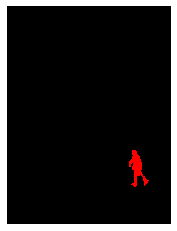

(500, 375, 3)
COCO_val2014_000000093493.jpg
{'person_bbx': [273.87, 196.16, 410.15, 311.47], 'Verbs': 'hold', 'object': {'obj_bbx': [322.02, 226.37, 475.21999999999997, 296.33]}}
surfboard
person
hold
hold interaction
{'person_bbx': [273.87, 196.16, 410.15, 311.47], 'Verbs': 'surf', 'object': {'obj_bbx': [322.02, 226.37, 475.21999999999997, 296.33]}}
surfboard
person
surf
surf interaction


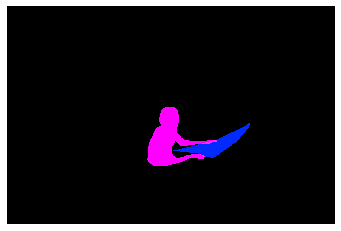

(425, 640, 3)
COCO_val2014_000000140743.jpg
{'person_bbx': [68.49, 0.0, 575.68, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [150.65, 201.51, 397.25, 311.85]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [68.49, 0.0, 575.68, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [150.65, 201.51, 397.25, 311.85]}}
person
pizza
hold
hold interaction
{'person_bbx': [68.49, 0.0, 575.68, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [150.65, 201.51, 397.25, 311.85]}}
person
pizza
look
look interaction


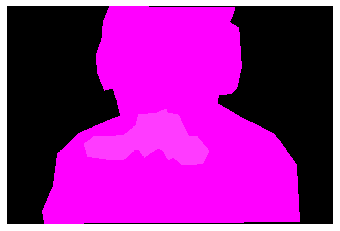

(427, 640, 3)
COCO_val2014_000000450709.jpg
{'person_bbx': [290.59, 14.31, 561.13, 443.75], 'Verbs': 'snowboard', 'object': {'obj_bbx': [319.32, 404.65, 628.73, 460.59999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [290.59, 14.31, 561.13, 443.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


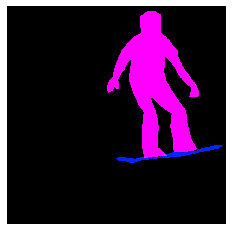

(637, 640, 3)
COCO_val2014_000000023034.jpg
{'person_bbx': [419.65, 0.0, 640.0, 422.41], 'Verbs': 'carry', 'object': {'obj_bbx': [519.05, 137.8, 640.0, 306.39]}}
person
backpack
carry
carry interaction
{'person_bbx': [419.65, 0.0, 640.0, 422.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [419.65, 0.0, 640.0, 422.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


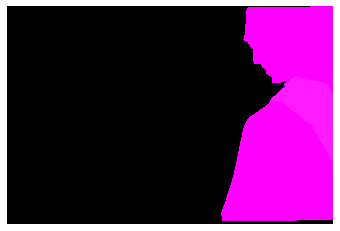

(427, 640, 3)
COCO_val2014_000000177978.jpg
{'person_bbx': [284.41, 39.62, 335.6, 88.53999999999999], 'Verbs': 'jump', 'object': {'obj_bbx': [270.77, 34.74, 292.77, 75.48]}}
person
snowboard
jump
jump interaction
{'person_bbx': [284.41, 39.62, 335.6, 88.53999999999999], 'Verbs': 'snowboard', 'object': {'obj_bbx': [270.77, 34.74, 292.77, 75.48]}}
person
snowboard
snowboard
snowboard interaction


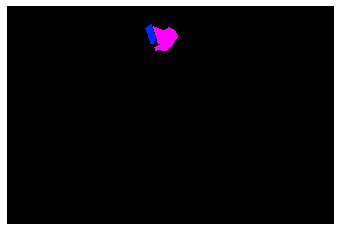

(426, 640, 3)
COCO_val2014_000000470545.jpg
{'person_bbx': [33.08, 0.0, 306.34, 250.25], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [255.9, 213.67, 290.78000000000003, 231.76999999999998]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [33.08, 0.0, 306.34, 250.25], 'Verbs': 'hold', 'object': {'obj_bbx': [255.9, 213.67, 290.78000000000003, 231.76999999999998]}}
person
fork
hold
hold interaction
{'person_bbx': [33.08, 0.0, 306.34, 250.25], 'Verbs': 'look', 'object': {'obj_bbx': [255.9, 213.67, 290.78000000000003, 231.76999999999998]}}
person
fork
look
look interaction
{'person_bbx': [33.08, 0.0, 306.34, 250.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


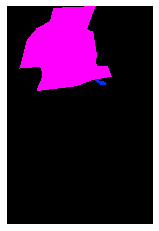

(640, 427, 3)
COCO_val2014_000000050493.jpg
{'person_bbx': [168.16, 77.83, 217.45, 216.82], 'Verbs': 'carry', 'object': {'obj_bbx': [170.55, 106.62, 184.76000000000002, 164.15]}}
person
surfboard
carry
carry interaction
{'person_bbx': [67.75, 66.28, 117.99000000000001, 213.52], 'Verbs': 'carry', 'object': {'obj_bbx': [82.82, 85.98, 126.38, 185.7]}}
person
surfboard
carry
carry interaction
{'person_bbx': [555.76, 76.61, 616.1899999999999, 208.11], 'Verbs': 'carry', 'object': {'obj_bbx': [534.7, 102.11, 580.32, 154.71]}}
person
surfboard
carry
carry interaction
{'person_bbx': [168.16, 77.83, 217.45, 216.82], 'Verbs': 'hold', 'object': {'obj_bbx': [170.55, 106.62, 184.76000000000002, 164.15]}}
person
surfboard
hold
hold interaction
{'person_bbx': [67.75, 66.28, 117.99000000000001, 213.52], 'Verbs': 'hold', 'object': {'obj_bbx': [82.82, 85.98, 126.38, 185.7]}}
person
surfboard
hold
hold interaction
{'person_bbx': [555.76, 76.61, 616.1899999999999, 208.11], 'Verbs': 'hold', 'object': {'obj_

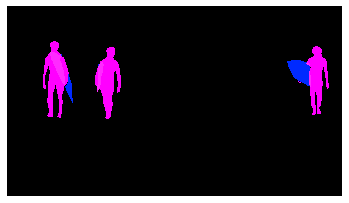

(362, 640, 3)
COCO_val2014_000000399873.jpg
{'person_bbx': [131.15, 3.83, 384.84000000000003, 381.96], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [319.35, 235.47, 396.95000000000005, 270.53]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [131.15, 3.83, 384.84000000000003, 381.96], 'Verbs': 'hold', 'object': {'obj_bbx': [319.35, 235.47, 396.95000000000005, 270.53]}}
person
scissors
hold
hold interaction
{'person_bbx': [131.15, 3.83, 384.84000000000003, 381.96], 'Verbs': 'look', 'object': {'obj_bbx': [319.35, 235.47, 396.95000000000005, 270.53]}}
person
scissors
look
look interaction
{'person_bbx': [131.15, 3.83, 384.84000000000003, 381.96], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [131.15, 3.83, 384.84000000000003, 381.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


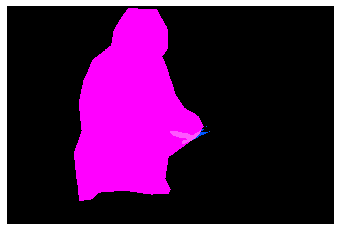

(426, 640, 3)
COCO_val2014_000000122418.jpg
{'person_bbx': [7.12, 36.67, 315.19, 397.28000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [7.12, 36.67, 315.19, 397.28000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


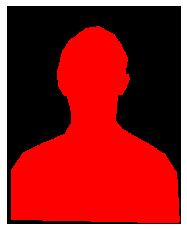

(398, 317, 3)
COCO_val2014_000000226917.jpg
{'person_bbx': [131.87, 102.74, 355.96000000000004, 271.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [131.87, 102.74, 355.96000000000004, 271.01], 'Verbs': 'lay', 'object': {'obj_bbx': [27.75, 160.09, 479.49, 355.89]}}
couch
person
lay
lay interaction
{'person_bbx': [131.87, 102.74, 355.96000000000004, 271.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


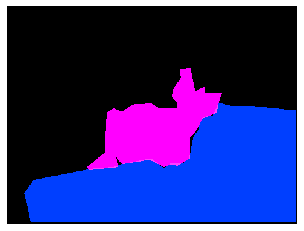

(360, 480, 3)
COCO_val2014_000000560662.jpg
{'person_bbx': [21.57, 133.59, 342.29, 523.34], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [208.92, 163.19, 334.25, 520.5899999999999], 'Verbs': 'look', 'object': {'obj_bbx': [334.57, 225.19, 388.92, 281.06]}}
sports ball
person
look
look interaction
{'person_bbx': [21.57, 133.59, 342.29, 523.34], 'Verbs': 'look', 'object': {'obj_bbx': [334.57, 225.19, 388.92, 281.06]}}
sports ball
person
look
look interaction
{'person_bbx': [286.2, 240.18, 480.0, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [334.57, 225.19, 388.92, 281.06]}}
sports ball
person
look
look interaction
{'person_bbx': [286.2, 240.18, 480.0, 640.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [208.92, 163.19, 334.25, 520.5899999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.2, 240.18, 480.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


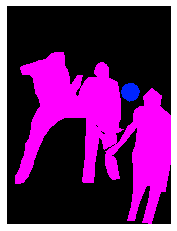

(640, 480, 3)
COCO_val2014_000000303320.jpg
{'person_bbx': [0.98, 41.24, 363.35, 432.09000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': [262.2, 1.96, 503.78, 121.77]}}
person
frisbee
catch
catch interaction
{'person_bbx': [0.98, 41.24, 363.35, 432.09000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [262.2, 1.96, 503.78, 121.77]}}
person
frisbee
throw
throw interaction


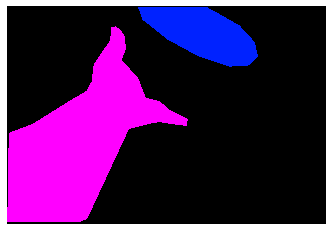

(437, 640, 3)
COCO_val2014_000000538858.jpg
{'person_bbx': [136.94, 228.73, 275.55, 416.01], 'Verbs': 'hold', 'object': {'obj_bbx': [139.08, 234.12, 149.67000000000002, 243.64000000000001]}}
sports ball
person
hold
hold interaction
{'person_bbx': [136.94, 228.73, 275.55, 416.01], 'Verbs': 'throw', 'object': {'obj_bbx': [139.08, 234.12, 149.67000000000002, 243.64000000000001]}}
sports ball
person
throw
throw interaction


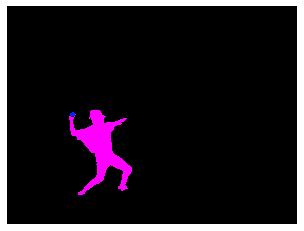

(480, 640, 3)
COCO_val2014_000000433547.jpg
{'person_bbx': [189.2, 160.74, 421.63, 451.93], 'Verbs': 'hold', 'object': {'obj_bbx': [243.78, 109.02, 435.78, 188.83999999999997]}}
umbrella
person
hold
hold interaction
{'person_bbx': [189.2, 160.74, 421.63, 451.93], 'Verbs': 'look', 'object': {'obj_bbx': [293.68, 279.92, 342.42, 296.74]}}
person
book
look
look interaction
{'person_bbx': [189.2, 160.74, 421.63, 451.93], 'Verbs': 'read', 'object': {'obj_bbx': [293.68, 279.92, 342.42, 296.74]}}
person
book
read
read interaction
{'person_bbx': [189.2, 160.74, 421.63, 451.93], 'Verbs': 'sit', 'object': {'obj_bbx': [341.78, 245.67, 475.11, 441.9]}}
person
bench
sit
sit interaction


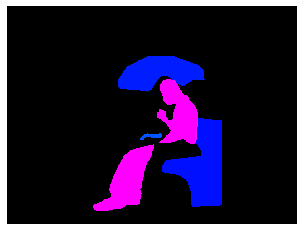

(480, 640, 3)
COCO_val2014_000000273230.jpg
{'person_bbx': [154.98, 373.26, 276.95, 634.4300000000001], 'Verbs': 'catch', 'object': {'obj_bbx': [152.16, 303.43, 185.34, 360.4]}}
person
frisbee
catch
catch interaction
{'person_bbx': [154.98, 373.26, 276.95, 634.4300000000001], 'Verbs': 'look', 'object': {'obj_bbx': [152.16, 303.43, 185.34, 360.4]}}
person
frisbee
look
look interaction
{'person_bbx': [154.98, 373.26, 276.95, 634.4300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


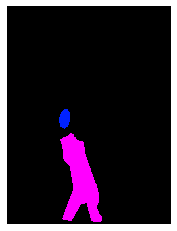

(640, 480, 3)
COCO_val2014_000000255784.jpg
{'person_bbx': [344.54, 207.81, 393.22, 357.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [590.05, 211.83, 640.0, 383.52], 'Verbs': 'hold', 'object': {'obj_bbx': [534.62, 310.7, 604.9, 392.91999999999996]}}
suitcase
person
hold
hold interaction
{'person_bbx': [344.54, 207.81, 393.22, 357.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [344.54, 207.81, 393.22, 357.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [590.05, 211.83, 640.0, 383.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [590.05, 211.83, 640.0, 383.52], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


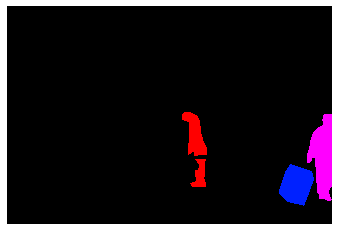

(429, 640, 3)
COCO_val2014_000000210915.jpg
{'person_bbx': [131.25, 115.88, 415.63, 296.88], 'Verbs': 'look', 'object': {'obj_bbx': [286.92, 61.48, 467.06, 182.29]}}
person
surfboard
look
look interaction
{'person_bbx': [131.25, 115.88, 415.63, 296.88], 'Verbs': 'surf', 'object': {'obj_bbx': [286.92, 61.48, 467.06, 182.29]}}
person
surfboard
surf
surf interaction


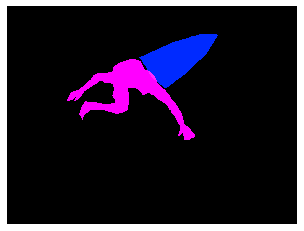

(480, 640, 3)
COCO_val2014_000000415393.jpg
{'person_bbx': [231.12, 6.69, 517.64, 377.25], 'Verbs': 'jump', 'object': {'obj_bbx': [387.75, 343.82, 569.21, 382.98]}}
person
skateboard
jump
jump interaction
{'person_bbx': [231.12, 6.69, 517.64, 377.25], 'Verbs': 'look', 'object': {'obj_bbx': [387.75, 343.82, 569.21, 382.98]}}
person
skateboard
look
look interaction
{'person_bbx': [231.12, 6.69, 517.64, 377.25], 'Verbs': 'skateboard', 'object': {'obj_bbx': [387.75, 343.82, 569.21, 382.98]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [231.12, 6.69, 517.64, 377.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


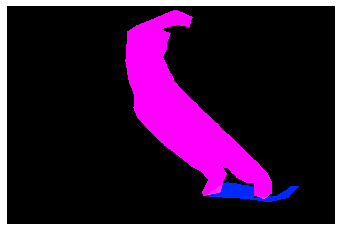

(425, 640, 3)
COCO_val2014_000000207635.jpg
{'person_bbx': [230.9, 0.0, 476.97, 368.26], 'Verbs': 'hold', 'object': {'obj_bbx': [319.41, 206.69, 500.0, 266.69]}}
person
frisbee
hold
hold interaction
{'person_bbx': [230.9, 0.0, 476.97, 368.26], 'Verbs': 'look', 'object': {'obj_bbx': [319.41, 206.69, 500.0, 266.69]}}
person
frisbee
look
look interaction
{'person_bbx': [230.9, 0.0, 476.97, 368.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


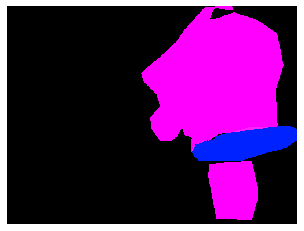

(375, 500, 3)
COCO_val2014_000000329604.jpg
{'person_bbx': [37.31, 257.89, 121.78, 473.99], 'Verbs': 'carry', 'object': {'obj_bbx': [82.98, 191.34, 151.39, 257.81]}}
umbrella
person
carry
carry interaction
{'person_bbx': [37.31, 257.89, 121.78, 473.99], 'Verbs': 'hold', 'object': {'obj_bbx': [82.98, 191.34, 151.39, 257.81]}}
umbrella
person
hold
hold interaction
{'person_bbx': [37.31, 257.89, 121.78, 473.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [37.31, 257.89, 121.78, 473.99], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


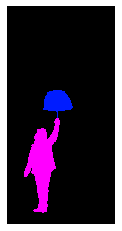

(500, 248, 3)
COCO_val2014_000000310998.jpg
{'person_bbx': [113.13, 27.73, 301.66999999999996, 308.33000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [112.53, 257.32, 168.57, 304.99]}}
snowboard
person
snowboard
snowboard interaction


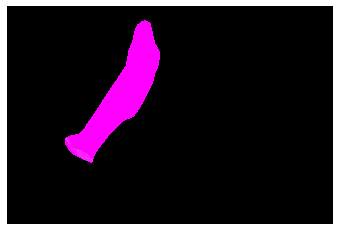

(427, 640, 3)
COCO_val2014_000000487003.jpg
{'person_bbx': [3.23, 4.25, 640.0, 474.57], 'Verbs': 'hold', 'object': {'obj_bbx': [71.25, 85.23, 231.37, 239.56]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [3.23, 4.25, 640.0, 474.57], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


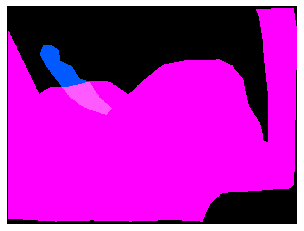

(480, 640, 3)
COCO_val2014_000000301541.jpg
{'person_bbx': [37.39, 181.21, 366.74, 631.37], 'Verbs': 'catch', 'object': {'obj_bbx': [115.28, 196.71, 203.16, 245.32]}}
frisbee
person
catch
catch interaction
{'person_bbx': [37.39, 181.21, 366.74, 631.37], 'Verbs': 'look', 'object': {'obj_bbx': [115.28, 196.71, 203.16, 245.32]}}
frisbee
person
look
look interaction


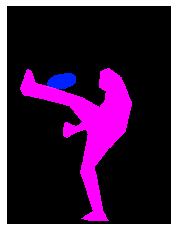

(640, 480, 3)
COCO_val2014_000000216296.jpg
{'person_bbx': [192.87, 123.78, 379.98, 402.04999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [295.24, 125.49, 334.16, 167.10999999999999]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [192.87, 123.78, 379.98, 402.04999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [295.24, 125.49, 334.16, 167.10999999999999]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [477.61, 42.08, 602.32, 239.60000000000002], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [192.87, 123.78, 379.98, 402.04999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [477.61, 42.08, 602.32, 239.60000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [192.87, 123.78, 379.98, 402.04999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


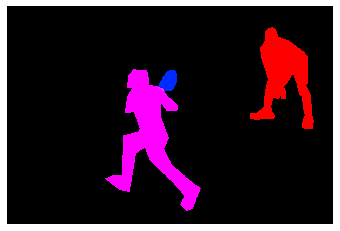

(427, 640, 3)
COCO_val2014_000000578993.jpg
{'person_bbx': [201.33, 85.46, 390.19000000000005, 231.73000000000002], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [201.33, 85.46, 390.19000000000005, 231.73000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [324.34, 191.24, 462.26, 243.18]}}
surfboard
person
surf
surf interaction


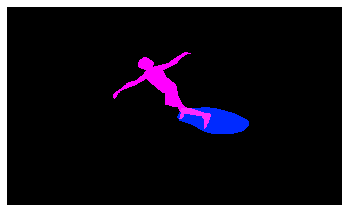

(378, 640, 3)
COCO_val2014_000000530061.jpg
{'person_bbx': [82.82, 22.49, 621.6600000000001, 446.82], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [166.97, 255.4, 188.07999999999998, 306.3]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [82.82, 22.49, 621.6600000000001, 446.82], 'Verbs': 'hold', 'object': {'obj_bbx': [166.97, 255.4, 188.07999999999998, 306.3]}}
person
spoon
hold
hold interaction
{'person_bbx': [82.82, 22.49, 621.6600000000001, 446.82], 'Verbs': 'look', 'object': {'obj_bbx': [166.97, 255.4, 188.07999999999998, 306.3]}}
person
spoon
look
look interaction
{'person_bbx': [82.82, 22.49, 621.6600000000001, 446.82], 'Verbs': 'sit', 'object': {'obj_bbx': [512.39, 226.99, 639.46, 446.29]}}
chair
person
sit
sit interaction


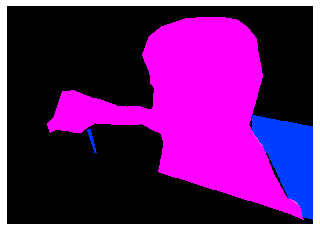

(455, 640, 3)
COCO_val2014_000000365273.jpg
{'person_bbx': [132.76, 3.2, 404.53, 274.96999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


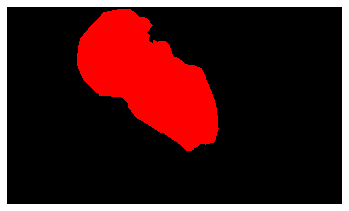

(376, 640, 3)
COCO_val2014_000000183394.jpg
{'person_bbx': [220.81, 287.5, 308.79, 446.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [220.81, 287.5, 308.79, 446.46000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [229.85, 364.69, 301.62, 527.15]}}
horse
person
ride
ride interaction
{'person_bbx': [116.94, 275.37, 209.17000000000002, 451.05], 'Verbs': 'ride', 'object': {'obj_bbx': [128.73, 358.7, 203.04999999999998, 528.65]}}
horse
person
ride
ride interaction
{'person_bbx': [220.81, 287.5, 308.79, 446.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [229.85, 364.69, 301.62, 527.15]}}
horse
person
sit
sit interaction
{'person_bbx': [116.94, 275.37, 209.17000000000002, 451.05], 'Verbs': 'sit', 'object': {'obj_bbx': [128.73, 358.7, 203.04999999999998, 528.65]}}
horse
person
sit
sit interaction


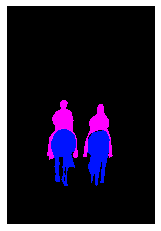

(640, 433, 3)
COCO_val2014_000000280761.jpg
{'person_bbx': [43.62, 99.66, 258.39, 458.72], 'Verbs': 'hold', 'object': {'obj_bbx': [157.76, 158.75, 332.09000000000003, 304.90999999999997]}}
person
laptop
hold
hold interaction
{'person_bbx': [43.62, 99.66, 258.39, 458.72], 'Verbs': 'look', 'object': {'obj_bbx': [239.33, 177.1, 310.29, 240.84]}}
person
tv
look
look interaction
{'person_bbx': [43.62, 99.66, 258.39, 458.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [43.62, 99.66, 258.39, 458.72], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [157.76, 158.75, 332.09000000000003, 304.90999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


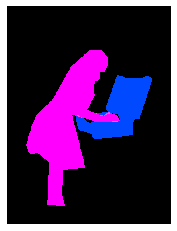

(500, 375, 3)
COCO_val2014_000000361623.jpg
{'person_bbx': [0.96, 97.15, 135.3, 387.9], 'Verbs': 'look', 'object': {'obj_bbx': [256.83, 112.26, 303.36, 128.59]}}
person
frisbee
look
look interaction
{'person_bbx': [0.96, 97.15, 135.3, 387.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.96, 97.15, 135.3, 387.9], 'Verbs': 'throw', 'object': {'obj_bbx': [256.83, 112.26, 303.36, 128.59]}}
person
frisbee
throw
throw interaction


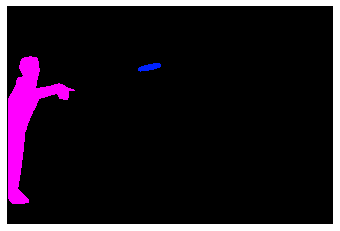

(427, 640, 3)
COCO_val2014_000000551608.jpg
{'person_bbx': [143.97, 108.14, 196.75, 284.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [143.97, 108.14, 196.75, 284.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


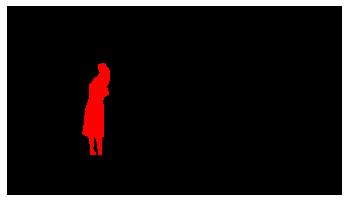

(360, 640, 3)
COCO_val2014_000000051437.jpg
{'person_bbx': [19.92, 141.42, 550.16, 264.74], 'Verbs': 'hold', 'object': {'obj_bbx': [363.7, 229.47, 624.99, 271.58]}}
person
surfboard
hold
hold interaction
{'person_bbx': [19.92, 141.42, 550.16, 264.74], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [19.92, 141.42, 550.16, 264.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [19.92, 141.42, 550.16, 264.74], 'Verbs': 'surf', 'object': {'obj_bbx': [363.7, 229.47, 624.99, 271.58]}}
person
surfboard
surf
surf interaction


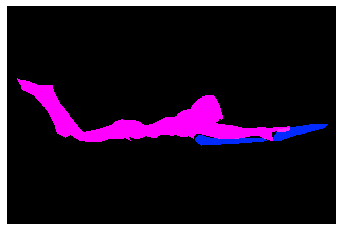

(424, 640, 3)
COCO_val2014_000000523217.jpg
{'person_bbx': [181.41, 51.4, 332.2, 491.31], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [73.2, 355.29, 204.95, 436.37]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [181.41, 51.4, 332.2, 491.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [181.41, 51.4, 332.2, 491.31], 'Verbs': 'look', 'object': {'obj_bbx': [73.2, 355.29, 204.95, 436.37]}}
person
cake
look
look interaction
{'person_bbx': [181.41, 51.4, 332.2, 491.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [181.41, 51.4, 332.2, 491.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


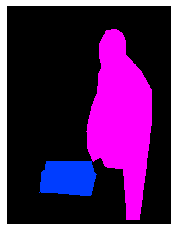

(500, 375, 3)
COCO_val2014_000000007072.jpg
{'person_bbx': [227.02, 101.4, 289.24, 236.26000000000002], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [227.02, 101.4, 289.24, 236.26000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


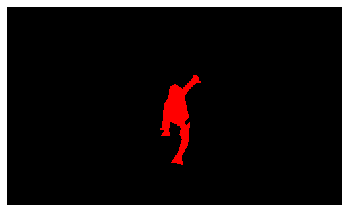

(296, 500, 3)
COCO_val2014_000000320670.jpg
{'person_bbx': [35.34, 190.19, 442.28, 334.43], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 254.28, 639.0600000000001, 421.24]}}
bed
person
lay
lay interaction


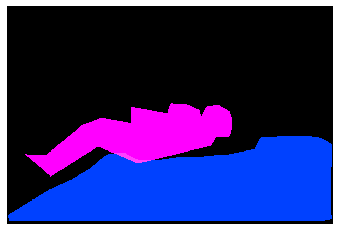

(427, 640, 3)
COCO_val2014_000000194786.jpg
{'person_bbx': [76.19, 88.99, 430.67, 435.01], 'Verbs': 'hold', 'object': {'obj_bbx': [191.55, 313.34, 264.3, 368.95]}}
person
frisbee
hold
hold interaction
{'person_bbx': [76.19, 88.99, 430.67, 435.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [76.19, 88.99, 430.67, 435.01], 'Verbs': 'look', 'object': {'obj_bbx': [191.55, 313.34, 264.3, 368.95]}}
person
frisbee
look
look interaction
{'person_bbx': [76.19, 88.99, 430.67, 435.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


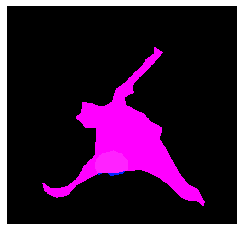

(473, 500, 3)
COCO_val2014_000000238537.jpg
{'person_bbx': [130.02, 144.11, 271.6, 526.95], 'Verbs': 'hold', 'object': {'obj_bbx': [103.42, 63.1, 205.34, 484.27000000000004]}}
person
skis
hold
hold interaction
{'person_bbx': [235.87, 129.44, 401.26, 543.64], 'Verbs': 'hold', 'object': {'obj_bbx': [227.24, 225.8, 414.20000000000005, 632.81]}}
person
snowboard
hold
hold interaction
{'person_bbx': [130.02, 144.11, 271.6, 526.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [235.87, 129.44, 401.26, 543.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [130.02, 144.11, 271.6, 526.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [235.87, 129.44, 401.26, 543.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


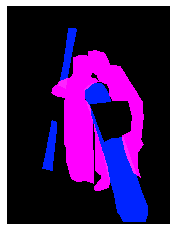

(640, 478, 3)
COCO_val2014_000000425620.jpg
{'person_bbx': [165.36, 14.59, 297.12, 205.36], 'Verbs': 'hold', 'object': {'obj_bbx': [198.29, 100.8, 259.21999999999997, 174.5]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [165.36, 14.59, 297.12, 205.36], 'Verbs': 'sit', 'object': {'obj_bbx': [1.38, 156.45, 545.84, 491.39]}}
bed
person
sit
sit interaction
{'person_bbx': [165.36, 14.59, 297.12, 205.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


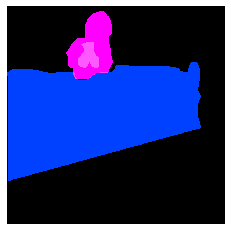

(612, 612, 3)
COCO_val2014_000000424147.jpg
{'person_bbx': [60.59, 67.54, 188.72, 414.19], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [142.51, 180.88, 347.62, 210.35999999999999]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [60.59, 67.54, 188.72, 414.19], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [278.54, 78.02, 305.79, 106.53999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [60.59, 67.54, 188.72, 414.19], 'Verbs': 'hold', 'object': {'obj_bbx': [142.51, 180.88, 347.62, 210.35999999999999]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [275.38, 113.49, 434.02, 405.83], 'Verbs': 'look', 'object': {'obj_bbx': [278.54, 78.02, 305.79, 106.53999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [60.59, 67.54, 188.72, 414.19], 'Verbs': 'look', 'object': {'obj_bbx': [278.54, 78.02, 305.79, 106.53999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [60.59, 67.54, 188.72, 414.19], 'Verbs': 'stan

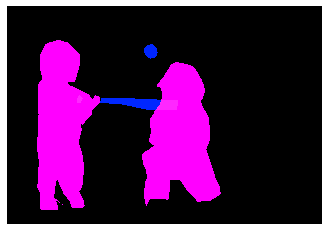

(442, 640, 3)
COCO_val2014_000000301148.jpg
{'person_bbx': [103.63, 53.73, 258.12, 374.22], 'Verbs': 'look', 'object': {'obj_bbx': [120.9, 351.2, 343.52, 422.2]}}
person
cake
look
look interaction
{'person_bbx': [390.54, 0.0, 606.44, 423.16], 'Verbs': 'look', 'object': {'obj_bbx': [120.9, 351.2, 343.52, 422.2]}}
person
cake
look
look interaction
{'person_bbx': [103.63, 53.73, 258.12, 374.22], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [251.01, 14.91, 409.69, 372.66], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [390.54, 0.0, 606.44, 423.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.96, 31.26, 157.72, 421.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.63, 53.73, 258.12, 374.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [251.01, 14.91, 409.69, 372.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [390.

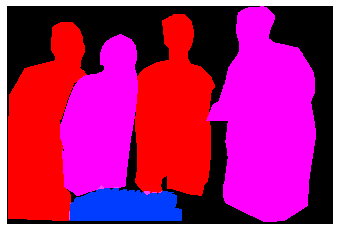

(427, 640, 3)
COCO_val2014_000000488377.jpg
{'person_bbx': [192.42, 113.26, 289.59, 198.92000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [118.7, 72.95, 215.74, 213.45999999999998]}}
person
surfboard
look
look interaction
{'person_bbx': [192.42, 113.26, 289.59, 198.92000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [118.7, 72.95, 215.74, 213.45999999999998]}}
person
surfboard
surf
surf interaction


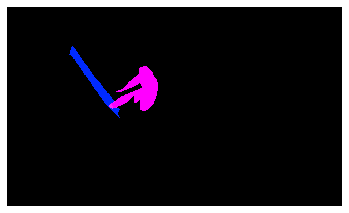

(380, 640, 3)
COCO_val2014_000000295316.jpg
{'person_bbx': [184.2, 173.84, 229.1, 229.97], 'Verbs': 'surf', 'object': {'obj_bbx': [170.48, 221.64, 211.39999999999998, 232.79]}}
person
surfboard
surf
surf interaction


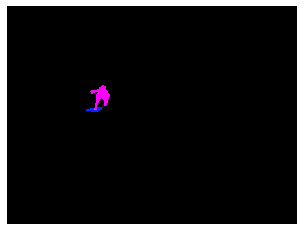

(480, 640, 3)
COCO_val2014_000000258141.jpg
{'person_bbx': [0.33, 86.49, 187.62, 326.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.33, 86.49, 187.62, 326.02], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 227.04, 188.76, 491.09000000000003]}}
bed
person
lay
lay interaction
{'person_bbx': [0.33, 86.49, 187.62, 326.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


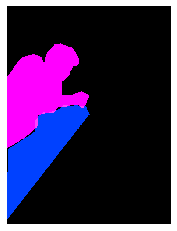

(500, 375, 3)
COCO_val2014_000000140388.jpg
{'person_bbx': [93.48, 28.76, 394.07, 441.53], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [66.28, 420.6, 112.53999999999999, 499.17]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [93.48, 28.76, 394.07, 441.53], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [0.0, 421.16, 399.58, 625.62]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [93.48, 28.76, 394.07, 441.53], 'Verbs': 'hold', 'object': {'obj_bbx': [66.28, 420.6, 112.53999999999999, 499.17]}}
knife
person
hold
hold interaction
{'person_bbx': [93.48, 28.76, 394.07, 441.53], 'Verbs': 'look', 'object': {'obj_bbx': [66.28, 420.6, 112.53999999999999, 499.17]}}
knife
person
look
look interaction
{'person_bbx': [93.48, 28.76, 394.07, 441.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


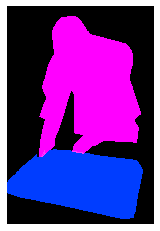

(640, 431, 3)
COCO_val2014_000000299116.jpg
{'person_bbx': [0.0, 84.27, 280.9, 475.28], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [254.0, 312.87, 322.97, 358.17]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 84.27, 280.9, 475.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 84.27, 280.9, 475.28], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 214.06, 38.95, 338.61]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 84.27, 280.9, 475.28], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


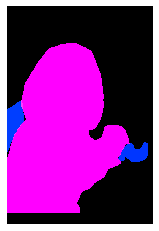

(500, 334, 3)
COCO_val2014_000000439770.jpg
{'person_bbx': [602.67, 122.87, 640.0, 193.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [602.67, 122.87, 640.0, 193.78], 'Verbs': 'surf', 'object': {'obj_bbx': [584.11, 188.99, 629.44, 197.82000000000002]}}
person
surfboard
surf
surf interaction


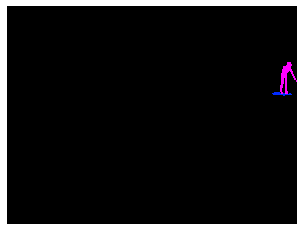

(480, 640, 3)
COCO_val2014_000000394940.jpg
{'person_bbx': [0.0, 77.18, 425.79, 490.84000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [207.55, 438.65, 311.66, 502.29999999999995]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 77.18, 425.79, 490.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 77.18, 425.79, 490.84000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


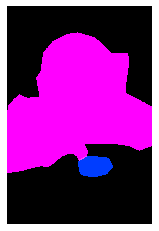

(640, 426, 3)
COCO_val2014_000000363981.jpg
{'person_bbx': [253.92, 112.26, 341.21999999999997, 221.56], 'Verbs': 'skateboard', 'object': {'obj_bbx': [277.72, 211.43, 339.49, 237.77]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [295.3, 117.45, 403.83000000000004, 258.46], 'Verbs': 'skateboard', 'object': {'obj_bbx': [305.95, 247.39, 381.15999999999997, 270.95]}}
person
skateboard
skateboard
skateboard interaction


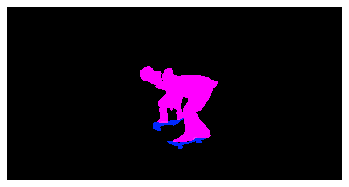

(330, 640, 3)
COCO_val2014_000000086913.jpg
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [124.56, 45.69, 158.04, 148.97]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [143.11, 59.85, 166.33, 77.14]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'hold', 'object': {'obj_bbx': [124.56, 45.69, 158.04, 148.97]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'look', 'object': {'obj_bbx': [143.11, 59.85, 166.33, 77.14]}}
sports ball
person
look
look interaction
{'person_bbx': [122.8, 142.66, 264.38, 571.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


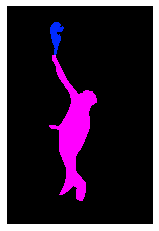

(640, 427, 3)
COCO_val2014_000000567340.jpg
{'person_bbx': [21.91, 1.69, 444.94, 372.46999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [294.71, 77.65, 380.28999999999996, 201.18]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [21.91, 1.69, 444.94, 372.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [294.71, 77.65, 380.28999999999996, 201.18]}}
hot dog
person
hold
hold interaction


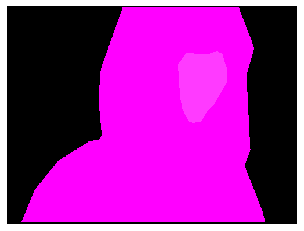

(375, 500, 3)
COCO_val2014_000000064240.jpg
{'person_bbx': [3.45, 82.84, 169.13, 328.77], 'Verbs': 'ride', 'object': {'obj_bbx': [39.61, 204.57, 167.89, 380.21]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [165.68, 74.21, 331.36, 321.87], 'Verbs': 'ride', 'object': {'obj_bbx': [204.51, 194.16, 332.96, 371.06]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [328.87, 65.29, 486.02, 314.52], 'Verbs': 'ride', 'object': {'obj_bbx': [367.28, 186.66, 494.57, 367.06]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [495.71, 62.84, 639.3399999999999, 312.19], 'Verbs': 'ride', 'object': {'obj_bbx': [540.7, 187.35, 640.0, 366.44]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [3.45, 82.84, 169.13, 328.77], 'Verbs': 'sit', 'object': {'obj_bbx': [39.61, 204.57, 167.89, 380.21]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [165.68, 74.21, 331.36, 321.87], 'Verbs': 'sit', 'object': {'obj_bbx': [204.51, 194.16, 332.96, 371.06]}}
motorcycle
person
sit
sit

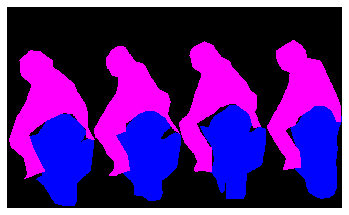

(384, 640, 3)
COCO_val2014_000000534373.jpg
{'person_bbx': [249.81, 71.98, 402.53999999999996, 443.74], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [349.15, 179.96, 385.13, 196.77]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [249.81, 71.98, 402.53999999999996, 443.74], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [403.15, 40.09, 431.46, 65.42]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [46.21, 182.87, 197.18, 433.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [141.85, 213.19, 202.38, 295.45]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [249.81, 71.98, 402.53999999999996, 443.74], 'Verbs': 'hold', 'object': {'obj_bbx': [349.15, 179.96, 385.13, 196.77]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [46.21, 182.87, 197.18, 433.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [403.15, 40.09, 431.46, 65.42]}}
sports ball
person
look
look interaction
{'person_bbx': [484.67, 43.04, 640.0, 457.0], 'Verbs': '

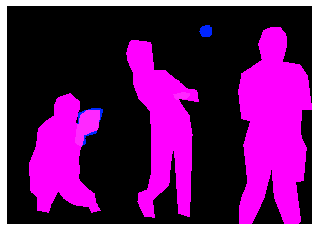

(457, 640, 3)
COCO_val2014_000000249608.jpg
{'person_bbx': [58.71, 278.1, 126.19999999999999, 371.64000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [69.42, 272.55, 105.02000000000001, 318.3]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [386.8, 2.53, 446.63, 120.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [107.02, 171.91, 156.74, 275.56], 'Verbs': 'hold', 'object': {'obj_bbx': [143.5, 182.63, 154.42, 234.13]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [368.46, 182.63, 441.21999999999997, 259.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [170.53, 251.06, 210.98000000000002, 373.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [19.43, 19.43, 82.77000000000001, 146.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [386.8, 2.53, 446.63, 120.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [107.02, 171.91, 1

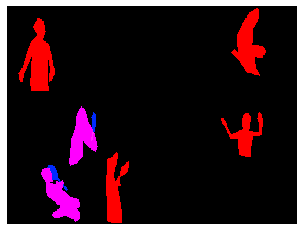

(375, 500, 3)
COCO_val2014_000000096832.jpg
{'person_bbx': [191.36, 41.69, 409.44000000000005, 280.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [256.64, 201.98, 449.92999999999995, 314.73]}}
person
laptop
look
look interaction
{'person_bbx': [191.36, 41.69, 409.44000000000005, 280.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [191.36, 41.69, 409.44000000000005, 280.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [191.36, 41.69, 409.44000000000005, 280.09000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [256.64, 201.98, 449.92999999999995, 314.73]}}
person
laptop
work_on_computer
work_on_computer interaction


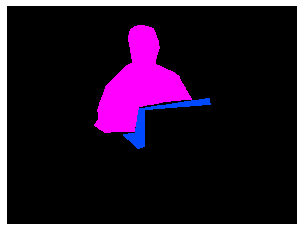

(480, 640, 3)
COCO_val2014_000000478433.jpg
{'person_bbx': [260.04, 216.57, 323.37, 278.94], 'Verbs': 'look', 'object': {'obj_bbx': [260.62, 244.55, 344.74, 294.8]}}
person
surfboard
look
look interaction
{'person_bbx': [260.04, 216.57, 323.37, 278.94], 'Verbs': 'surf', 'object': {'obj_bbx': [260.62, 244.55, 344.74, 294.8]}}
person
surfboard
surf
surf interaction


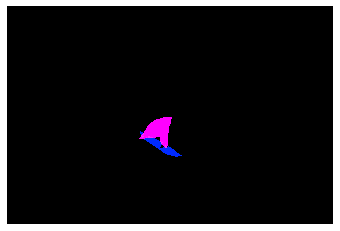

(427, 640, 3)
COCO_val2014_000000011696.jpg


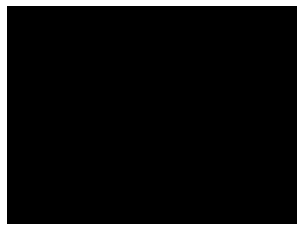

(480, 640, 3)
COCO_val2014_000000121570.jpg
{'person_bbx': [296.39, 145.0, 390.82, 282.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [296.39, 145.0, 390.82, 282.8], 'Verbs': 'look', 'object': {'obj_bbx': [231.14, 276.0, 474.15999999999997, 301.93]}}
person
surfboard
look
look interaction
{'person_bbx': [296.39, 145.0, 390.82, 282.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [296.39, 145.0, 390.82, 282.8], 'Verbs': 'surf', 'object': {'obj_bbx': [231.14, 276.0, 474.15999999999997, 301.93]}}
person
surfboard
surf
surf interaction


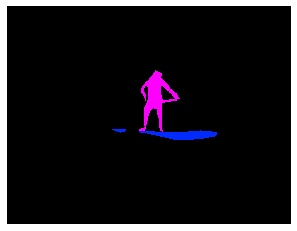

(491, 640, 3)
COCO_val2014_000000479466.jpg
{'person_bbx': [346.04, 209.93, 421.66, 316.15], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [416.2, 216.63, 450.05, 238.07]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [346.04, 209.93, 421.66, 316.15], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [592.2, 209.64, 597.6700000000001, 214.60999999999999]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [346.04, 209.93, 421.66, 316.15], 'Verbs': 'hold', 'object': {'obj_bbx': [416.2, 216.63, 450.05, 238.07]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [346.04, 209.93, 421.66, 316.15], 'Verbs': 'look', 'object': {'obj_bbx': [592.2, 209.64, 597.6700000000001, 214.60999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [364.03, 20.51, 390.86999999999995, 111.78], 'Verbs': 'look', 'object': {'obj_bbx': [592.2, 209.64, 597.6700000000001, 214.60999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [608.05, 44.44, 63

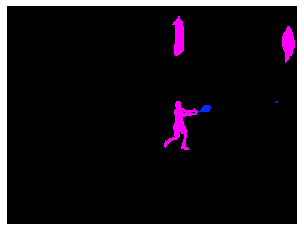

(480, 640, 3)
COCO_val2014_000000082940.jpg
{'person_bbx': [258.73, 197.38, 360.74, 397.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [101.62, 195.98, 192.98000000000002, 417.72], 'Verbs': 'hold', 'object': {'obj_bbx': [49.35, 408.21, 220.81, 427.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [258.73, 197.38, 360.74, 397.87], 'Verbs': 'look', 'object': {'obj_bbx': [285.41, 392.57, 372.97, 411.98]}}
person
surfboard
look
look interaction
{'person_bbx': [258.73, 197.38, 360.74, 397.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [101.62, 195.98, 192.98000000000002, 417.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


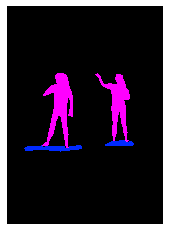

(640, 457, 3)
COCO_val2014_000000213693.jpg
{'person_bbx': [4.31, 47.46, 261.03000000000003, 478.91999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [156.4, 291.06, 263.19, 447.46000000000004]}}
person
laptop
carry
carry interaction
{'person_bbx': [4.31, 47.46, 261.03000000000003, 478.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [156.4, 291.06, 263.19, 447.46000000000004]}}
person
laptop
hold
hold interaction
{'person_bbx': [4.31, 47.46, 261.03000000000003, 478.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [478.16, 182.3, 640.0, 350.03]}}
person
truck
look
look interaction
{'person_bbx': [4.31, 47.46, 261.03000000000003, 478.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


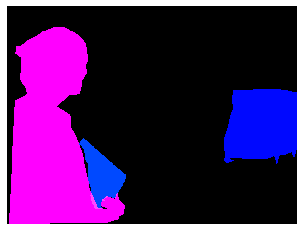

(480, 640, 3)
COCO_val2014_000000143445.jpg
{'person_bbx': [112.36, 88.76, 283.15, 423.59999999999997], 'Verbs': 'drink', 'object': {'obj_bbx': [173.14, 110.26, 187.32999999999998, 129.05]}}
person
wine glass
drink
drink interaction
{'person_bbx': [112.36, 88.76, 283.15, 423.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [173.14, 110.26, 187.32999999999998, 129.05]}}
person
wine glass
hold
hold interaction
{'person_bbx': [260.67, 35.96, 375.0, 494.38], 'Verbs': 'look', 'object': {'obj_bbx': [101.94, 423.34, 128.93, 495.10999999999996]}}
person
wine glass
look
look interaction
{'person_bbx': [112.36, 88.76, 283.15, 423.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [260.67, 35.96, 375.0, 494.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


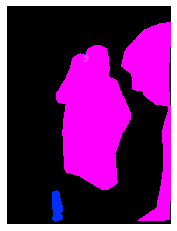

(500, 375, 3)
COCO_val2014_000000521863.jpg
{'person_bbx': [117.16, 175.98, 183.82, 275.49], 'Verbs': 'jump', 'object': {'obj_bbx': [124.22, 262.35, 168.73, 281.42]}}
person
skateboard
jump
jump interaction
{'person_bbx': [117.16, 175.98, 183.82, 275.49], 'Verbs': 'look', 'object': {'obj_bbx': [124.22, 262.35, 168.73, 281.42]}}
person
skateboard
look
look interaction
{'person_bbx': [117.16, 175.98, 183.82, 275.49], 'Verbs': 'skateboard', 'object': {'obj_bbx': [124.22, 262.35, 168.73, 281.42]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [117.16, 175.98, 183.82, 275.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


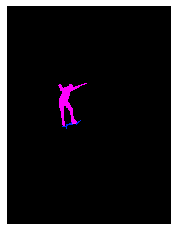

(500, 375, 3)
COCO_val2014_000000455720.jpg
{'person_bbx': [323.14, 56.47, 489.65, 288.93], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [207.64, 214.2, 372.6, 289.08]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [323.14, 56.47, 489.65, 288.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [132.74, 80.74, 251.86, 267.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [323.14, 56.47, 489.65, 288.93], 'Verbs': 'look', 'object': {'obj_bbx': [207.64, 214.2, 372.6, 289.08]}}
person
cake
look
look interaction
{'person_bbx': [132.74, 80.74, 251.86, 267.68], 'Verbs': 'look', 'object': {'obj_bbx': [207.64, 214.2, 372.6, 289.08]}}
person
cake
look
look interaction
{'person_bbx': [18.14, 31.55, 120.84, 288.12], 'Verbs': 'look', 'object': {'obj_bbx': [207.64, 214.2, 372.6, 289.08]}}
cake
person
look
look interaction
{'person_bbx': [132.74, 80.74, 251.86, 267.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [32

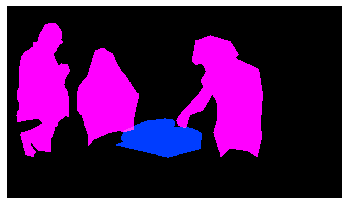

(366, 640, 3)
COCO_val2014_000000427034.jpg
{'person_bbx': [232.47, 87.3, 639.28, 325.15], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


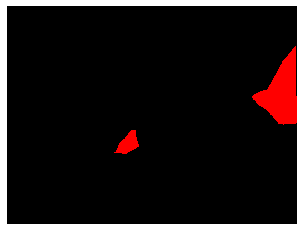

(480, 640, 3)
COCO_val2014_000000180739.jpg
{'person_bbx': [189.65, 196.37, 323.86, 310.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [189.65, 196.37, 323.86, 310.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [189.65, 196.37, 323.86, 310.22], 'Verbs': 'surf', 'object': {'obj_bbx': [205.65, 209.69, 392.96000000000004, 328.27]}}
person
surfboard
surf
surf interaction


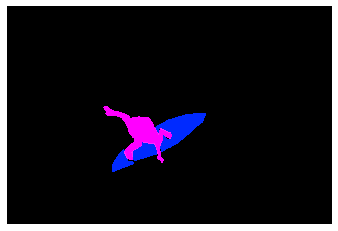

(429, 640, 3)
COCO_val2014_000000565239.jpg
{'person_bbx': [30.42, 3.38, 116.60000000000001, 155.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [354.65, 226.74, 443.9, 333.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


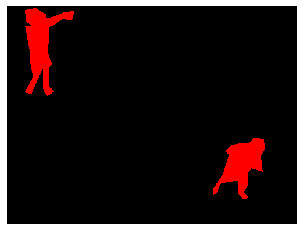

(376, 500, 3)
COCO_val2014_000000317410.jpg
{'person_bbx': [39.58, 36.09, 220.0, 486.57000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [21.44, 298.3, 145.03, 390.61]}}
person
suitcase
carry
carry interaction
{'person_bbx': [428.57, 27.41, 580.72, 511.73], 'Verbs': 'carry', 'object': {'obj_bbx': [495.83, 322.0, 627.67, 429.33]}}
person
suitcase
carry
carry interaction
{'person_bbx': [39.58, 36.09, 220.0, 486.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [21.44, 298.3, 145.03, 390.61]}}
person
suitcase
hold
hold interaction
{'person_bbx': [428.57, 27.41, 580.72, 511.73], 'Verbs': 'hold', 'object': {'obj_bbx': [495.83, 322.0, 627.67, 429.33]}}
person
suitcase
hold
hold interaction
{'person_bbx': [39.58, 36.09, 220.0, 486.57000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [428.57, 27.41, 580.72, 511.73]}}
person
person
look
look interaction
{'person_bbx': [428.57, 27.41, 580.72, 511.73], 'Verbs': 'look', 'object': {'obj_bbx': [39.58, 36.09, 220.0, 486.57000000000005]}

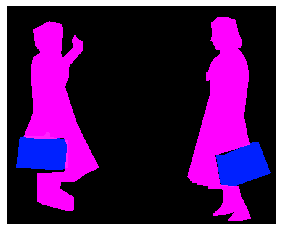

(518, 640, 3)
COCO_val2014_000000096566.jpg
{'person_bbx': [119.37, 34.28, 375.37, 426.90999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [161.08, 336.54, 325.03, 438.65000000000003]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [119.37, 34.28, 375.37, 426.90999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [334.16, 218.4, 369.09000000000003, 362.46000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [355.87, 5.26, 480.0, 391.27], 'Verbs': 'sit', 'object': {'obj_bbx': [334.16, 218.4, 369.09000000000003, 362.46000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [119.37, 34.28, 375.37, 426.90999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [355.87, 5.26, 480.0, 391.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


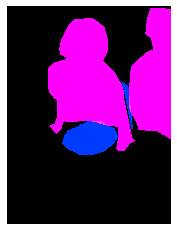

(640, 480, 3)
COCO_val2014_000000396821.jpg
{'person_bbx': [381.07, 130.08, 485.52, 240.22000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [326.53, 157.23, 443.9, 227.93]}}
person
surfboard
look
look interaction
{'person_bbx': [381.07, 130.08, 485.52, 240.22000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [326.53, 157.23, 443.9, 227.93]}}
person
surfboard
surf
surf interaction


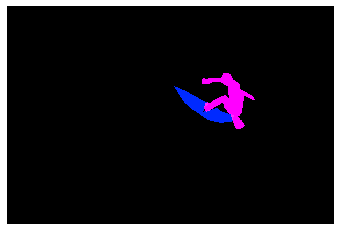

(426, 640, 3)
COCO_val2014_000000402499.jpg
{'person_bbx': [239.64, 181.14, 386.72, 383.15], 'Verbs': 'hold', 'object': {'obj_bbx': [326.83, 235.92, 365.14, 256.2]}}
person
frisbee
hold
hold interaction
{'person_bbx': [0.97, 190.93, 82.23, 353.02], 'Verbs': 'look', 'object': {'obj_bbx': [326.83, 235.92, 365.14, 256.2]}}
person
frisbee
look
look interaction
{'person_bbx': [0.97, 190.93, 82.23, 353.02], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [239.64, 181.14, 386.72, 383.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.97, 190.93, 82.23, 353.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [239.64, 181.14, 386.72, 383.15], 'Verbs': 'throw', 'object': {'obj_bbx': [326.83, 235.92, 365.14, 256.2]}}
person
frisbee
throw
throw interaction


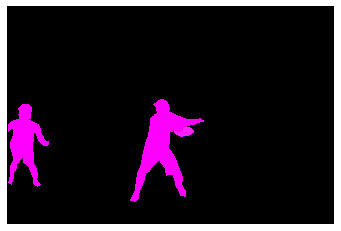

(426, 640, 3)
COCO_val2014_000000570680.jpg
{'person_bbx': [104.36, 54.55, 361.96000000000004, 488.19], 'Verbs': 'jump', 'object': {'obj_bbx': [96.32, 454.72, 320.14, 526.1500000000001]}}
skateboard
person
jump
jump interaction
{'person_bbx': [104.36, 54.55, 361.96000000000004, 488.19], 'Verbs': 'look', 'object': {'obj_bbx': [96.32, 454.72, 320.14, 526.1500000000001]}}
skateboard
person
look
look interaction
{'person_bbx': [104.36, 54.55, 361.96000000000004, 488.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [96.32, 454.72, 320.14, 526.1500000000001]}}
skateboard
person
skateboard
skateboard interaction


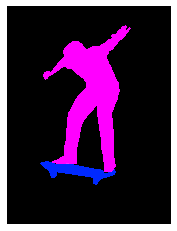

(640, 480, 3)
COCO_val2014_000000348263.jpg
{'person_bbx': [120.46, 136.2, 298.53, 629.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [120.46, 136.2, 298.53, 629.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


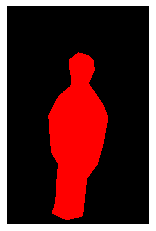

(640, 417, 3)
COCO_val2014_000000411908.jpg
{'person_bbx': [93.6, 106.97, 222.53, 377.25], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 217.76, 362.78, 417.82]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [16.31, 118.07, 128.47, 365.07], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 217.76, 362.78, 417.82]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [93.6, 106.97, 222.53, 377.25], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 217.76, 362.78, 417.82]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [16.31, 118.07, 128.47, 365.07], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 217.76, 362.78, 417.82]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [513.28, 75.32, 639.72, 328.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [513.28, 75.32, 639.72, 328.69], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


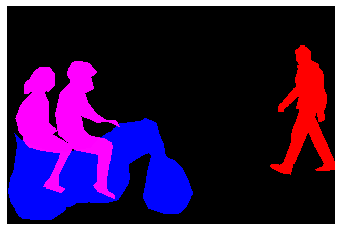

(425, 640, 3)
COCO_val2014_000000263073.jpg
{'person_bbx': [425.03, 157.01, 476.09999999999997, 268.13], 'Verbs': 'jump', 'object': {'obj_bbx': [424.14, 213.2, 441.78999999999996, 277.61]}}
person
snowboard
jump
jump interaction
{'person_bbx': [425.03, 157.01, 476.09999999999997, 268.13], 'Verbs': 'look', 'object': {'obj_bbx': [424.14, 213.2, 441.78999999999996, 277.61]}}
person
snowboard
look
look interaction
{'person_bbx': [425.03, 157.01, 476.09999999999997, 268.13], 'Verbs': 'snowboard', 'object': {'obj_bbx': [424.14, 213.2, 441.78999999999996, 277.61]}}
person
snowboard
snowboard
snowboard interaction


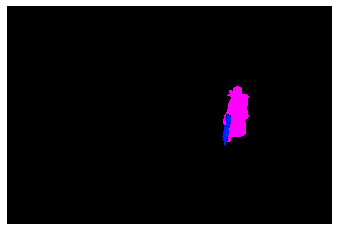

(429, 640, 3)
COCO_val2014_000000406129.jpg
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [222.08, 62.2, 273.5, 178.7]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [253.11, 86.18, 267.08000000000004, 100.69000000000001]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [222.08, 62.2, 273.5, 178.7]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'look', 'object': {'obj_bbx': [253.11, 86.18, 267.08000000000004, 100.69000000000001]}}
sports ball
person
look
look interaction
{'person_bbx': [163.59, 154.5, 363.05, 592.1700000000001], 'Verbs': 'stand', 'o

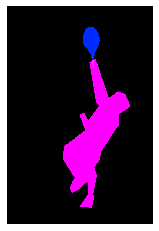

(640, 428, 3)
COCO_val2014_000000204432.jpg
{'person_bbx': [119.19, 132.18, 388.71999999999997, 474.73], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [201.37, 370.86, 316.22, 409.58000000000004]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [119.19, 132.18, 388.71999999999997, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [201.37, 370.86, 316.22, 409.58000000000004]}}
sandwich
person
hold
hold interaction
{'person_bbx': [119.19, 132.18, 388.71999999999997, 474.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [302.82, 97.82, 636.78, 473.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [119.19, 132.18, 388.71999999999997, 474.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [302.82, 97.82, 636.78, 473.65999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


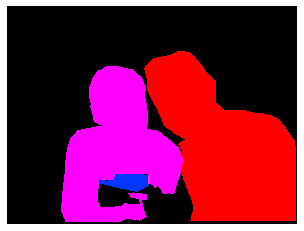

(480, 640, 3)
COCO_val2014_000000038829.jpg
{'person_bbx': [213.98, 82.55, 348.32, 392.48], 'Verbs': 'hold', 'object': {'obj_bbx': [99.17, 208.68, 283.75, 411.62]}}
bicycle
person
hold
hold interaction
{'person_bbx': [439.47, 127.86, 541.19, 323.61], 'Verbs': 'hold', 'object': {'obj_bbx': [396.5, 193.75, 635.48, 362.15]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [213.98, 82.55, 348.32, 392.48], 'Verbs': 'ride', 'object': {'obj_bbx': [99.17, 208.68, 283.75, 411.62]}}
bicycle
person
ride
ride interaction
{'person_bbx': [439.47, 127.86, 541.19, 323.61], 'Verbs': 'ride', 'object': {'obj_bbx': [396.5, 193.75, 635.48, 362.15]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [311.85, 100.75, 406.85, 359.83], 'Verbs': 'ride', 'object': {'obj_bbx': [99.17, 208.68, 283.75, 411.62]}}
bicycle
person
ride
ride interaction
{'person_bbx': [213.98, 82.55, 348.32, 392.48], 'Verbs': 'sit', 'object': {'obj_bbx': [99.17, 208.68, 283.75, 411.62]}}
bicycle
person
sit
sit interaction
{'

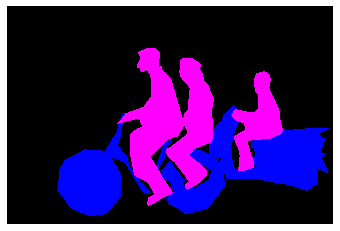

(427, 640, 3)
COCO_val2014_000000104221.jpg
{'person_bbx': [82.56, 84.86, 400.05, 296.52], 'Verbs': 'catch', 'object': {'obj_bbx': [426.45, 98.85, 459.02, 132.32999999999998]}}
person
frisbee
catch
catch interaction
{'person_bbx': [82.56, 84.86, 400.05, 296.52], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [82.56, 84.86, 400.05, 296.52], 'Verbs': 'look', 'object': {'obj_bbx': [426.45, 98.85, 459.02, 132.32999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [82.56, 84.86, 400.05, 296.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


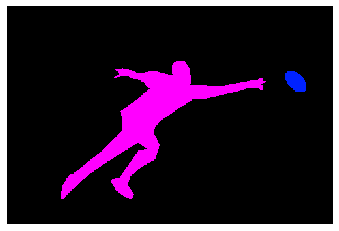

(334, 500, 3)
COCO_val2014_000000473850.jpg
{'person_bbx': [41.35, 276.63, 326.03000000000003, 392.19], 'Verbs': 'lay', 'object': {'obj_bbx': [44.48, 330.91, 348.70000000000005, 582.03]}}
bed
person
lay
lay interaction


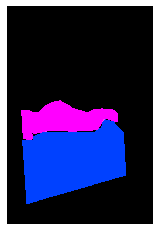

(640, 427, 3)
COCO_val2014_000000289572.jpg
{'person_bbx': [159.28, 96.22, 330.09000000000003, 525.09], 'Verbs': 'hold', 'object': {'obj_bbx': [201.39, 261.72, 243.98, 288.34000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [159.28, 96.22, 330.09000000000003, 525.09], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [159.28, 96.22, 330.09000000000003, 525.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


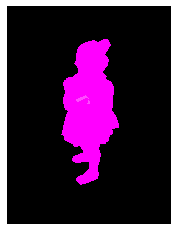

(640, 480, 3)
COCO_val2014_000000012817.jpg
{'person_bbx': [87.34, 8.73, 329.31, 240.67999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [305.69, 148.41, 353.7, 253.14]}}
person
skateboard
jump
jump interaction
{'person_bbx': [87.34, 8.73, 329.31, 240.67999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [305.69, 148.41, 353.7, 253.14]}}
person
skateboard
look
look interaction
{'person_bbx': [87.34, 8.73, 329.31, 240.67999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [305.69, 148.41, 353.7, 253.14]}}
person
skateboard
skateboard
skateboard interaction


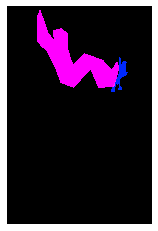

(640, 425, 3)
COCO_val2014_000000355197.jpg
{'person_bbx': [161.08, 1.0, 373.93, 593.54], 'Verbs': 'hold', 'object': {'obj_bbx': [306.96, 40.4, 324.51, 79.75999999999999]}}
cell phone
person
hold
hold interaction
{'person_bbx': [161.08, 1.0, 373.93, 593.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.08, 1.0, 373.93, 593.54], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [306.96, 40.4, 324.51, 79.75999999999999]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


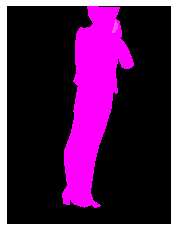

(640, 480, 3)
COCO_val2014_000000365170.jpg
{'person_bbx': [339.33, 341.2, 386.45, 460.15999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [314.94, 329.92, 393.1, 369.63]}}
umbrella
person
carry
carry interaction
{'person_bbx': [206.55, 335.86, 267.15000000000003, 475.45000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [181.64, 305.82, 266.88, 331.39]}}
umbrella
person
carry
carry interaction
{'person_bbx': [339.33, 341.2, 386.45, 460.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [314.94, 329.92, 393.1, 369.63]}}
umbrella
person
hold
hold interaction
{'person_bbx': [206.55, 335.86, 267.15000000000003, 475.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [181.64, 305.82, 266.88, 331.39]}}
umbrella
person
hold
hold interaction
{'person_bbx': [339.33, 341.2, 386.45, 460.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [206.55, 335.86, 267.15000000000003, 475.45000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pe

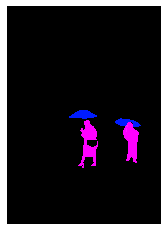

(640, 452, 3)
COCO_val2014_000000257965.jpg
{'person_bbx': [190.09, 61.71, 445.05, 282.43], 'Verbs': 'jump', 'object': {'obj_bbx': [116.33, 112.84, 552.13, 297.18]}}
person
snowboard
jump
jump interaction
{'person_bbx': [190.09, 61.71, 445.05, 282.43], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [190.09, 61.71, 445.05, 282.43], 'Verbs': 'snowboard', 'object': {'obj_bbx': [116.33, 112.84, 552.13, 297.18]}}
person
snowboard
snowboard
snowboard interaction


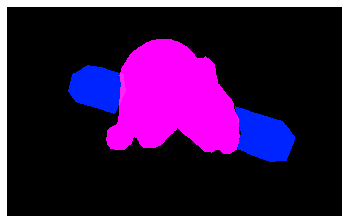

(400, 640, 3)
COCO_val2014_000000061603.jpg
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'hold', 'object': {'obj_bbx': [123.78, 136.26, 250.44, 212.06]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [3.86, 2.65, 640.0, 421.94], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [123.78, 136.26, 250.44, 212.06]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


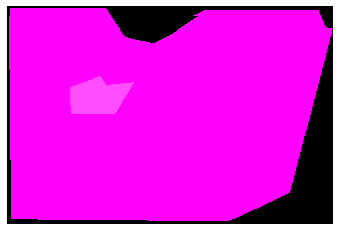

(427, 640, 3)
COCO_val2014_000000235163.jpg
{'person_bbx': [345.5, 41.42, 543.44, 172.03000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [102.45, 48.4, 275.47, 191.31], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [44.33, 201.69, 283.39, 277.28999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [44.33, 201.69, 283.39, 277.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [345.5, 41.42, 543.44, 172.03000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [295.55, 60.54, 365.4, 115.74000000000001]}}
person
surfboard
surf
surf interaction
{'person_bbx': [102.45, 48.4, 275.47, 191.31], 'Verbs': 'surf', 'object': {'obj_bbx': [44.81, 66.77, 115.08, 138.8]}}
person
surfboard
surf
surf interaction
{'person_bbx': [44.33, 201.69, 283.39, 277.28999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [51.61, 256.01, 113.24000000000001, 276.92]}}
person
surfboard
surf
surf i

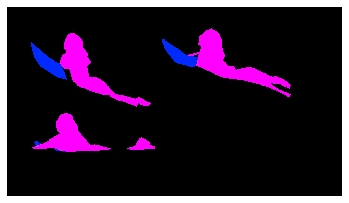

(361, 640, 3)
COCO_val2014_000000543408.jpg
{'person_bbx': [111.06, 72.34, 359.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [43.74, 296.11, 158.2, 454.91]}}
teddy bear
person
hold
hold interaction
{'person_bbx': [111.06, 72.34, 359.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [111.06, 72.34, 359.0, 640.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


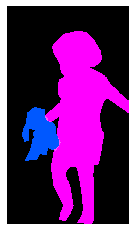

(640, 359, 3)
COCO_val2014_000000502936.jpg
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [317.55, 151.3, 343.18, 193.85000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [288.01, 128.3, 294.0, 134.20000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'hold', 'object': {'obj_bbx': [317.55, 151.3, 343.18, 193.85000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'look', 'object': {'obj_bbx': [288.01, 128.3, 294.0, 134.20000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [318.42, 172.79, 418.0, 341.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


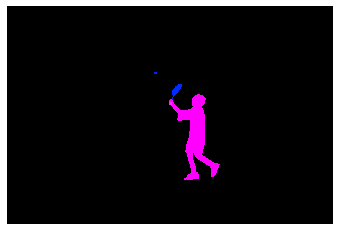

(427, 640, 3)
COCO_val2014_000000031882.jpg
{'person_bbx': [210.33, 109.98, 321.3, 294.62], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 174.25, 610.82, 384.87]}}
truck
person
hold
hold interaction
{'person_bbx': [230.98, 123.99, 384.45, 297.73], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [230.98, 123.99, 384.45, 297.73], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 174.25, 610.82, 384.87]}}
truck
person
ride
ride interaction
{'person_bbx': [379.51, 110.73, 447.55, 234.52], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 174.25, 610.82, 384.87]}}
truck
person
ride
ride interaction
{'person_bbx': [210.33, 109.98, 321.3, 294.62], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 174.25, 610.82, 384.87]}}
truck
person
ride
ride interaction
{'person_bbx': [230.98, 123.99, 384.45, 297.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [379.51, 110.73, 447.55, 234.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [210.33, 109

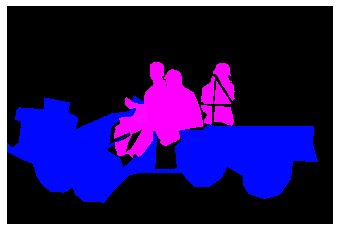

(427, 640, 3)
COCO_val2014_000000248224.jpg
{'person_bbx': [170.17, 134.9, 339.34, 558.37], 'Verbs': 'catch', 'object': {'obj_bbx': [274.96, 205.16, 345.80999999999995, 223.96]}}
person
frisbee
catch
catch interaction
{'person_bbx': [170.17, 134.9, 339.34, 558.37], 'Verbs': 'look', 'object': {'obj_bbx': [274.96, 205.16, 345.80999999999995, 223.96]}}
person
frisbee
look
look interaction
{'person_bbx': [170.17, 134.9, 339.34, 558.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


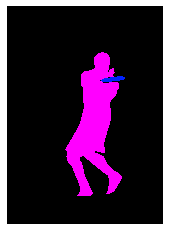

(640, 457, 3)
COCO_val2014_000000026448.jpg
{'person_bbx': [377.65, 46.29, 462.69, 205.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [140.62, 83.77, 233.64, 243.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [377.65, 46.29, 462.69, 205.94], 'Verbs': 'ski', 'object': {'obj_bbx': [380.0, 185.69, 470.84000000000003, 209.86]}}
person
skis
ski
ski interaction
{'person_bbx': [140.62, 83.77, 233.64, 243.36], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [377.65, 46.29, 462.69, 205.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [140.62, 83.77, 233.64, 243.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


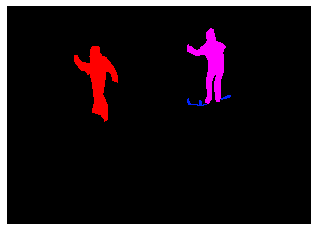

(458, 640, 3)
COCO_val2014_000000380330.jpg
{'person_bbx': [71.75, 88.97, 495.07, 507.98], 'Verbs': 'jump', 'object': {'obj_bbx': [125.83, 420.08, 382.39, 555.16]}}
person
snowboard
jump
jump interaction
{'person_bbx': [71.75, 88.97, 495.07, 507.98], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard


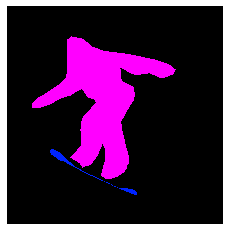

(640, 634, 3)
COCO_val2014_000000002179.jpg
{'person_bbx': [381.62, 1.62, 640.0, 404.86], 'Verbs': 'skateboard', 'object': {'obj_bbx': [474.92, 342.76, 640.0, 397.71]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [381.62, 1.62, 640.0, 404.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


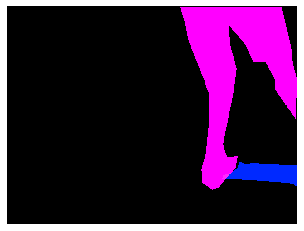

(480, 640, 3)
COCO_val2014_000000405529.jpg
{'person_bbx': [21.48, 81.13, 326.44, 507.8], 'Verbs': 'carry', 'object': {'obj_bbx': [270.47, 192.15, 337.07000000000005, 257.24]}}
frisbee
person
carry
carry interaction
{'person_bbx': [21.48, 81.13, 326.44, 507.8], 'Verbs': 'hold', 'object': {'obj_bbx': [270.47, 192.15, 337.07000000000005, 257.24]}}
frisbee
person
hold
hold interaction
{'person_bbx': [21.48, 81.13, 326.44, 507.8], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [21.48, 81.13, 326.44, 507.8], 'Verbs': 'look', 'object': {'obj_bbx': [270.47, 192.15, 337.07000000000005, 257.24]}}
frisbee
person
look
look interaction
{'person_bbx': [21.48, 81.13, 326.44, 507.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


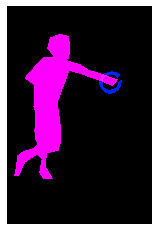

(640, 426, 3)
COCO_val2014_000000275933.jpg
{'person_bbx': [313.52, 211.1, 403.91999999999996, 394.78], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [395.26, 268.32, 495.28, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [231.3, 117.06, 257.23, 144.33]}}
sports ball
person
look
look interaction
{'person_bbx': [130.5, 260.04, 210.14, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [231.3, 117.06, 257.23, 144.33]}}
sports ball
person
look
look interaction
{'person_bbx': [395.26, 268.32, 495.28, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [381.96, 202.02, 462.67999999999995, 365.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [313.52, 211.1, 403.91999999999996, 394.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [301.49, 208.03, 405.57, 410.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [130.5, 260.04, 210.14, 427.0], 'Verbs': 'stand', 'o

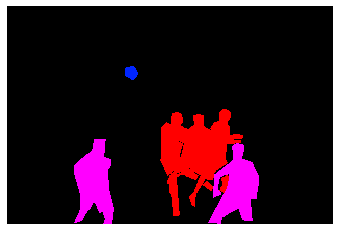

(427, 640, 3)
COCO_val2014_000000270744.jpg
{'person_bbx': [391.95, 200.91, 467.11, 420.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [391.95, 200.91, 467.11, 420.0], 'Verbs': 'look', 'object': {'obj_bbx': [242.68, 314.51, 329.33000000000004, 408.81]}}
dog
person
look
look interaction
{'person_bbx': [391.95, 200.91, 467.11, 420.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [391.95, 200.91, 467.11, 420.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


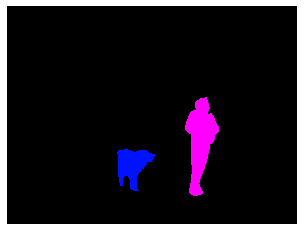

(480, 640, 3)
COCO_val2014_000000329307.jpg
{'person_bbx': [2.24, 57.31, 239.91, 492.28000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.24, 57.31, 239.91, 492.28000000000003], 'Verbs': 'point', 'object': {'obj_bbx': [178.57, 72.54, 275.15999999999997, 320.56]}}
person
suitcase
point
point interaction
{'person_bbx': [2.24, 57.31, 239.91, 492.28000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.24, 57.31, 239.91, 492.28000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


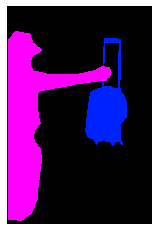

(500, 332, 3)
COCO_val2014_000000168683.jpg
{'person_bbx': [0.14, 36.63, 339.84, 370.79], 'Verbs': 'hold', 'object': {'obj_bbx': [303.43, 265.83, 349.33, 307.34999999999997]}}
person
mouse
hold
hold interaction
{'person_bbx': [0.14, 36.63, 339.84, 370.79], 'Verbs': 'look', 'object': {'obj_bbx': [393.54, 45.72, 456.74, 237.85]}}
person
tv
look
look interaction
{'person_bbx': [0.14, 36.63, 339.84, 370.79], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 322.1, 198.7, 368.86]}}
person
chair
sit
sit interaction
{'person_bbx': [0.14, 36.63, 339.84, 370.79], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


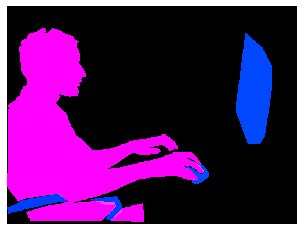

(375, 500, 3)
COCO_val2014_000000326970.jpg
{'person_bbx': [0.0, 115.42, 203.87, 477.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [143.41, 321.52, 186.01999999999998, 338.77]}}
cell phone
person
hold
hold interaction
{'person_bbx': [442.25, 18.34, 639.64, 453.03], 'Verbs': 'hold', 'object': {'obj_bbx': [578.92, 255.98, 607.64, 261.27]}}
cell phone
person
hold
hold interaction
{'person_bbx': [266.81, 31.17, 478.75, 473.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [328.36, 253.0, 457.21000000000004, 339.5]}}
book
person
hold
hold interaction
{'person_bbx': [0.0, 115.42, 203.87, 477.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [143.41, 321.52, 186.01999999999998, 338.77]}}
cell phone
person
look
look interaction
{'person_bbx': [442.25, 18.34, 639.64, 453.03], 'Verbs': 'look', 'object': {'obj_bbx': [578.92, 255.98, 607.64, 261.27]}}
cell phone
person
look
look interaction
{'person_bbx': [266.81, 31.17, 478.75, 473.77000000000004], 'Verbs': 'look', 'object':

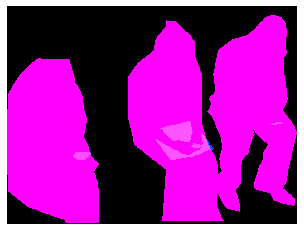

(480, 640, 3)
COCO_val2014_000000421433.jpg
{'person_bbx': [0.0, 295.55, 167.19, 424.99], 'Verbs': 'lay', 'object': {'obj_bbx': [3.24, 250.25, 640.0, 474.61]}}
bed
person
lay
lay interaction


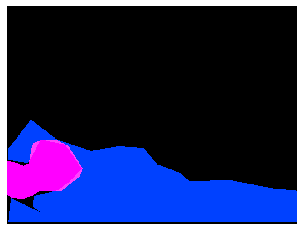

(480, 640, 3)
COCO_val2014_000000206851.jpg
{'person_bbx': [201.35, 191.28, 368.18, 546.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [151.33, 497.09, 421.28, 611.98]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [201.35, 191.28, 368.18, 546.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


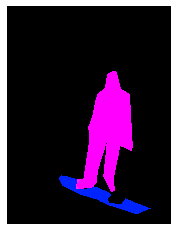

(640, 480, 3)
COCO_val2014_000000477689.jpg
{'person_bbx': [43.11, 65.7, 419.16, 589.0300000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


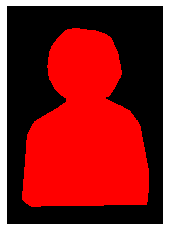

(640, 459, 3)
COCO_val2014_000000179415.jpg
{'person_bbx': [179.06, 3.51, 639.64, 473.8], 'Verbs': 'hold', 'object': {'obj_bbx': [1.14, 227.11, 312.24, 479.8]}}
person
laptop
hold
hold interaction
{'person_bbx': [179.06, 3.51, 639.64, 473.8], 'Verbs': 'look', 'object': {'obj_bbx': [1.14, 227.11, 312.24, 479.8]}}
person
laptop
look
look interaction
{'person_bbx': [179.06, 3.51, 639.64, 473.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [179.06, 3.51, 639.64, 473.8], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [179.06, 3.51, 639.64, 473.8], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.14, 227.11, 312.24, 479.8]}}
person
laptop
work_on_computer
work_on_computer interaction


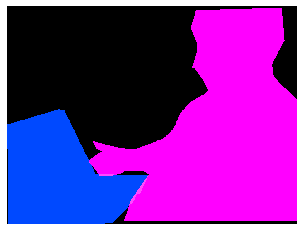

(480, 640, 3)
COCO_val2014_000000439092.jpg
{'person_bbx': [314.4, 189.47, 402.03999999999996, 426.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [386.32, 177.39, 494.11, 444.59], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [314.4, 189.47, 402.03999999999996, 426.34000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [219.59, 404.23, 434.56, 438.90000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [386.32, 177.39, 494.11, 444.59], 'Verbs': 'ski', 'object': {'obj_bbx': [329.59, 423.01, 544.3499999999999, 462.95]}}
person
skis
ski
ski interaction
{'person_bbx': [314.4, 189.47, 402.03999999999996, 426.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [386.32, 177.39, 494.11, 444.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


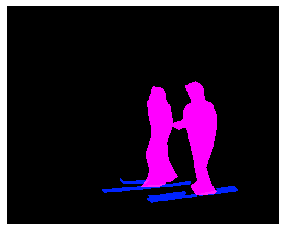

(512, 640, 3)
COCO_val2014_000000339336.jpg
{'person_bbx': [280.75, 109.02, 418.58000000000004, 352.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [280.75, 109.02, 418.58000000000004, 352.75], 'Verbs': 'ski', 'object': {'obj_bbx': [149.8, 343.11, 371.18, 358.26]}}
person
skis
ski
ski interaction
{'person_bbx': [280.75, 109.02, 418.58000000000004, 352.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


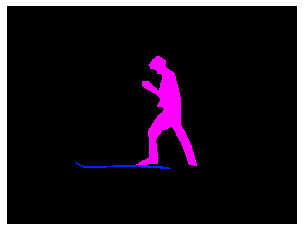

(480, 640, 3)
COCO_val2014_000000477534.jpg
{'person_bbx': [429.81, 30.44, 516.72, 194.02], 'Verbs': 'ski', 'object': {'obj_bbx': [482.36, 179.27, 536.47, 200.33]}}
person
skis
ski
ski interaction
{'person_bbx': [61.22, 10.97, 153.04, 155.93], 'Verbs': 'ski', 'object': {'obj_bbx': [45.62, 139.04, 156.32, 158.82]}}
person
skis
ski
ski interaction
{'person_bbx': [429.81, 30.44, 516.72, 194.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [61.22, 10.97, 153.04, 155.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


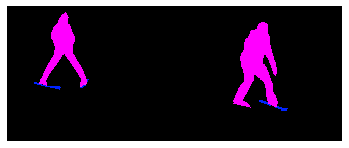

(257, 640, 3)
COCO_val2014_000000358231.jpg
{'person_bbx': [272.9, 213.22, 401.33, 338.78], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 97.6, 640.0, 473.11]}}
bed
person
lay
lay interaction
{'person_bbx': [414.12, 236.87, 516.46, 352.7], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 97.6, 640.0, 473.11]}}
bed
person
lay
lay interaction


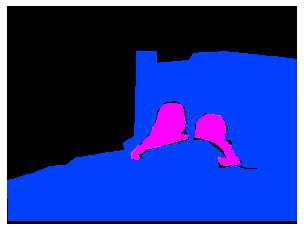

(480, 640, 3)
COCO_val2014_000000342367.jpg
{'person_bbx': [190.97, 128.07, 345.81, 385.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [411.24, 277.76, 547.94, 425.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [411.24, 277.76, 547.94, 425.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [190.97, 128.07, 345.81, 385.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [411.24, 277.76, 547.94, 425.63], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [293.44, 318.79, 370.18, 391.82000000000005]}}
laptop
person
work_on_computer
work_on_computer interaction


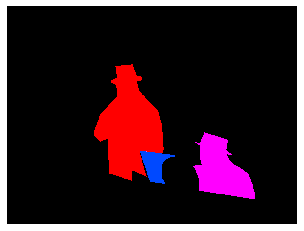

(480, 640, 3)
COCO_val2014_000000384416.jpg
{'person_bbx': [66.16, 146.7, 392.63, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [244.34, 443.03, 331.23, 481.65]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [66.16, 146.7, 392.63, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [244.34, 443.03, 331.23, 481.65]}}
pizza
person
hold
hold interaction
{'person_bbx': [66.16, 146.7, 392.63, 632.81], 'Verbs': 'point', 'object': {'obj_bbx': [244.34, 443.03, 331.23, 481.65]}}
pizza
person
point
point interaction
{'person_bbx': [66.16, 146.7, 392.63, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [66.16, 146.7, 392.63, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


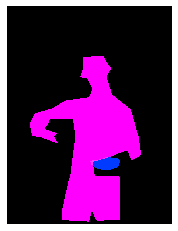

(640, 483, 3)
COCO_val2014_000000564572.jpg
{'person_bbx': [0.0, 0.0, 534.14, 473.93], 'Verbs': 'look', 'object': {'obj_bbx': [289.08, 181.21, 638.56, 472.45000000000005]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 0.0, 534.14, 473.93], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [289.08, 181.21, 638.56, 472.45000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


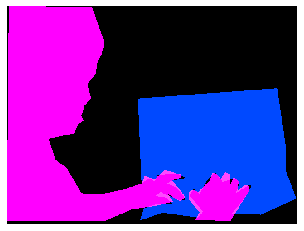

(480, 640, 3)
COCO_val2014_000000116173.jpg
{'person_bbx': [310.2, 101.48, 449.02, 350.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [310.2, 101.48, 449.02, 350.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [310.2, 101.48, 449.02, 350.41], 'Verbs': 'surf', 'object': {'obj_bbx': [153.26, 323.62, 500.26, 361.22]}}
person
surfboard
surf
surf interaction


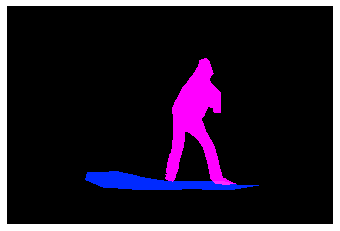

(427, 640, 3)
COCO_val2014_000000472860.jpg
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'catch', 'object': {'obj_bbx': [279.21, 100.91, 344.17999999999995, 122.83]}}
person
frisbee
catch
catch interaction
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'hold', 'object': {'obj_bbx': [279.21, 100.91, 344.17999999999995, 122.83]}}
person
frisbee
hold
hold interaction
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'look', 'object': {'obj_bbx': [279.21, 100.91, 344.17999999999995, 122.83]}}
person
frisbee
look
look interaction
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [93.39, 86.6, 332.63, 571.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


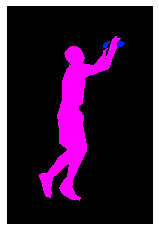

(640, 427, 3)
COCO_val2014_000000459665.jpg
{'person_bbx': [370.32, 208.9, 581.38, 395.98], 'Verbs': 'catch', 'object': {'obj_bbx': [365.78, 237.81, 382.60999999999996, 253.37]}}
sports ball
person
catch
catch interaction
{'person_bbx': [238.33, 137.7, 323.54, 367.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [370.32, 208.9, 581.38, 395.98], 'Verbs': 'look', 'object': {'obj_bbx': [365.78, 237.81, 382.60999999999996, 253.37]}}
sports ball
person
look
look interaction
{'person_bbx': [238.33, 137.7, 323.54, 367.11], 'Verbs': 'look', 'object': {'obj_bbx': [365.78, 237.81, 382.60999999999996, 253.37]}}
sports ball
person
look
look interaction
{'person_bbx': [370.32, 208.9, 581.38, 395.98], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [238.33, 137.7, 323.54, 367.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


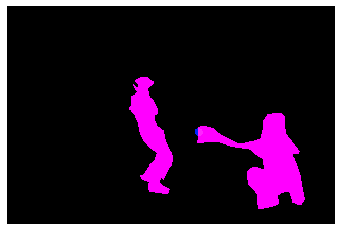

(425, 640, 3)
COCO_val2014_000000267725.jpg
{'person_bbx': [99.25, 191.41, 163.14, 272.0], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


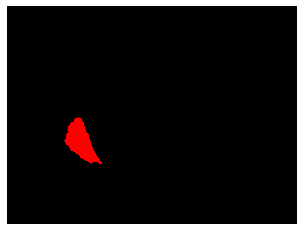

(375, 500, 3)
COCO_val2014_000000243482.jpg
{'person_bbx': [372.39, 130.19, 624.16, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [42.03, 120.92, 255.03, 341.56]}}
person
person
look
look interaction
{'person_bbx': [372.39, 130.19, 624.16, 421.21], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [372.39, 130.19, 624.16, 421.21], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


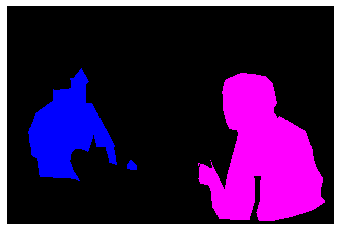

(426, 640, 3)
COCO_val2014_000000424227.jpg
{'person_bbx': [72.23, 212.64, 158.92000000000002, 552.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [233.5, 168.88, 324.27, 532.4300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [72.23, 212.64, 158.92000000000002, 552.14], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [233.5, 168.88, 324.27, 532.4300000000001], 'Verbs': 'look', 'object': {'obj_bbx': [72.23, 212.64, 158.92000000000002, 552.14]}}
person
person
look
look interaction
{'person_bbx': [72.23, 212.64, 158.92000000000002, 552.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [233.5, 168.88, 324.27, 532.4300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [72.23, 212.64, 158.92000000000002, 552.14], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [233.5, 168.88, 324.27, 532.4300000000001], '

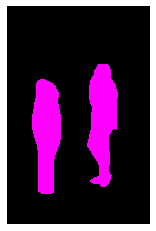

(640, 419, 3)
COCO_val2014_000000475229.jpg
{'person_bbx': [88.34, 92.46, 205.73000000000002, 329.09], 'Verbs': 'hold', 'object': {'obj_bbx': [56.27, 193.16, 243.91, 314.17]}}
person
snowboard
hold
hold interaction
{'person_bbx': [88.34, 92.46, 205.73000000000002, 329.09], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [88.34, 92.46, 205.73000000000002, 329.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


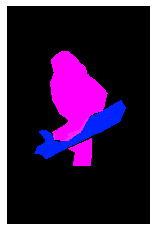

(448, 293, 3)
COCO_val2014_000000016879.jpg
{'person_bbx': [269.89, 164.58, 600.5, 405.55], 'Verbs': 'catch', 'object': {'obj_bbx': [241.06, 269.2, 292.64, 292.28]}}
person
frisbee
catch
catch interaction
{'person_bbx': [269.89, 164.58, 600.5, 405.55], 'Verbs': 'look', 'object': {'obj_bbx': [241.06, 269.2, 292.64, 292.28]}}
person
frisbee
look
look interaction
{'person_bbx': [269.89, 164.58, 600.5, 405.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


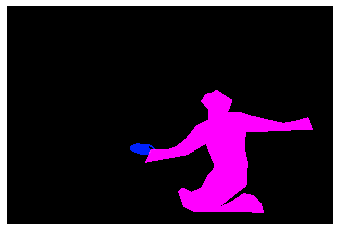

(427, 640, 3)
COCO_val2014_000000316007.jpg
{'person_bbx': [206.79, 83.38, 362.6, 421.94], 'Verbs': 'carry', 'object': {'obj_bbx': [157.73, 103.87, 458.78, 258.72]}}
person
snowboard
carry
carry interaction
{'person_bbx': [206.79, 83.38, 362.6, 421.94], 'Verbs': 'hold', 'object': {'obj_bbx': [157.73, 103.87, 458.78, 258.72]}}
person
snowboard
hold
hold interaction
{'person_bbx': [206.79, 83.38, 362.6, 421.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [206.79, 83.38, 362.6, 421.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


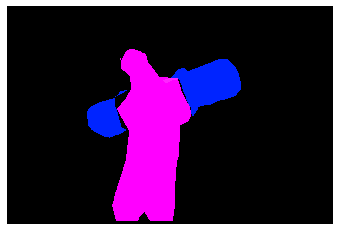

(428, 640, 3)
COCO_val2014_000000164292.jpg
{'person_bbx': [272.27, 140.4, 342.26, 181.46], 'Verbs': 'surf', 'object': {'obj_bbx': [296.16, 169.48, 343.79, 187.51999999999998]}}
person
surfboard
surf
surf interaction


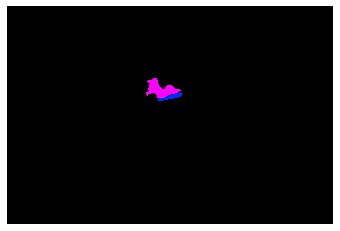

(427, 640, 3)
COCO_val2014_000000065350.jpg
{'person_bbx': [221.48, 41.34, 409.52, 261.56], 'Verbs': 'jump', 'object': {'obj_bbx': [193.0, 153.1, 298.28, 229.95]}}
person
skateboard
jump
jump interaction
{'person_bbx': [462.71, 30.61, 632.06, 266.34], 'Verbs': 'look', 'object': {'obj_bbx': [468.58, 253.59, 610.1, 286.66]}}
person
skateboard
look
look interaction
{'person_bbx': [221.48, 41.34, 409.52, 261.56], 'Verbs': 'skateboard', 'object': {'obj_bbx': [193.0, 153.1, 298.28, 229.95]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [462.71, 30.61, 632.06, 266.34], 'Verbs': 'skateboard', 'object': {'obj_bbx': [468.58, 253.59, 610.1, 286.66]}}
person
skateboard
skateboard
skateboard interaction


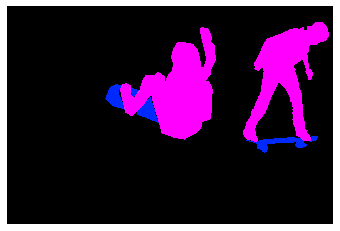

(427, 640, 3)
COCO_val2014_000000532058.jpg
{'person_bbx': [78.92, 138.38, 589.1899999999999, 433.51], 'Verbs': 'drink', 'object': {'obj_bbx': [354.83, 217.76, 498.62, 285.0]}}
bottle
person
drink
drink interaction
{'person_bbx': [78.92, 138.38, 589.1899999999999, 433.51], 'Verbs': 'hold', 'object': {'obj_bbx': [354.83, 217.76, 498.62, 285.0]}}
bottle
person
hold
hold interaction
{'person_bbx': [78.92, 138.38, 589.1899999999999, 433.51], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 480.0]}}
bed
person
lay
lay interaction


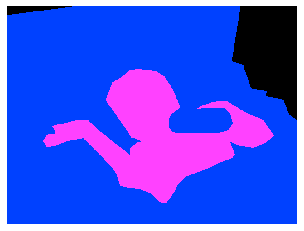

(480, 640, 3)
COCO_val2014_000000236432.jpg
{'person_bbx': [305.8, 48.32, 453.89, 409.89], 'Verbs': 'look', 'object': {'obj_bbx': [142.2, 26.72, 167.5, 52.03]}}
sports ball
person
look
look interaction
{'person_bbx': [305.8, 48.32, 453.89, 409.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [305.8, 48.32, 453.89, 409.89], 'Verbs': 'throw', 'object': {'obj_bbx': [142.2, 26.72, 167.5, 52.03]}}
sports ball
person
throw
throw interaction


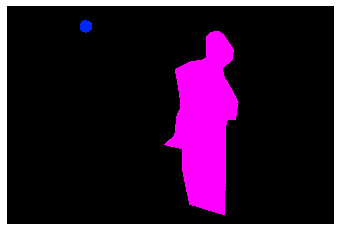

(426, 640, 3)
COCO_val2014_000000280114.jpg
{'person_bbx': [96.7, 11.17, 547.72, 305.35], 'Verbs': 'lay', 'object': {'obj_bbx': [0.81, 2.43, 639.91, 355.15000000000003]}}
person
bench
lay
lay interaction


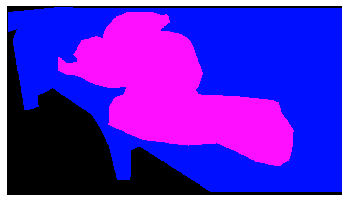

(360, 640, 3)
COCO_val2014_000000254869.jpg
{'person_bbx': [34.27, 139.45, 168.33, 566.53], 'Verbs': 'hold', 'object': {'obj_bbx': [113.86, 264.52, 149.82999999999998, 312.91999999999996]}}
person
wine glass
hold
hold interaction
{'person_bbx': [174.81, 96.43, 309.15999999999997, 630.97], 'Verbs': 'hold', 'object': {'obj_bbx': [251.35, 360.86, 305.19, 408.12]}}
person
remote
hold
hold interaction
{'person_bbx': [34.27, 139.45, 168.33, 566.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [34.27, 139.45, 168.33, 566.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [174.81, 96.43, 309.15999999999997, 630.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


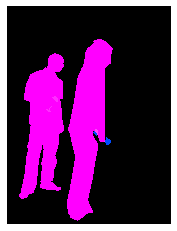

(640, 480, 3)
COCO_val2014_000000417416.jpg
{'person_bbx': [214.0, 129.65, 351.85, 325.34000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [297.82, 302.44, 351.82, 335.55]}}
skateboard
person
jump
jump interaction


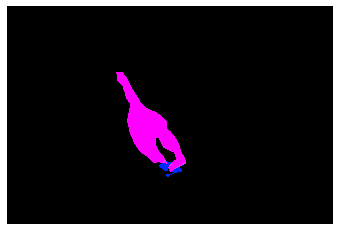

(428, 640, 3)
COCO_val2014_000000488697.jpg
{'person_bbx': [128.88, 52.6, 395.3, 396.93], 'Verbs': 'hold', 'object': {'obj_bbx': [368.46, 199.08, 425.08, 222.28]}}
frisbee
person
hold
hold interaction
{'person_bbx': [128.88, 52.6, 395.3, 396.93], 'Verbs': 'look', 'object': {'obj_bbx': [174.24, 63.93, 523.24, 374.31]}}
person
person
look
look interaction
{'person_bbx': [128.88, 52.6, 395.3, 396.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [128.88, 52.6, 395.3, 396.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


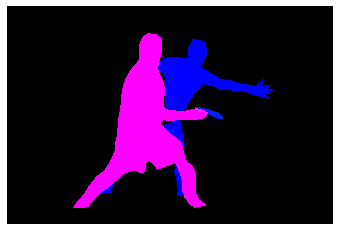

(428, 640, 3)
COCO_val2014_000000241187.jpg
{'person_bbx': [0.0, 394.05, 245.29, 516.91], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [94.95, 236.65, 427.0, 516.25]}}
laptop
person
work_on_computer
work_on_computer interaction


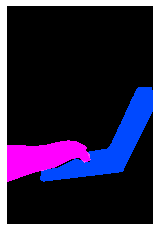

(640, 427, 3)
COCO_val2014_000000507935.jpg
{'person_bbx': [197.39, 59.33, 464.9, 270.74], 'Verbs': 'jump', 'object': {'obj_bbx': [242.25, 264.17, 355.62, 310.63]}}
person
skateboard
jump
jump interaction
{'person_bbx': [197.39, 59.33, 464.9, 270.74], 'Verbs': 'skateboard', 'object': {'obj_bbx': [242.25, 264.17, 355.62, 310.63]}}
person
skateboard
skateboard
skateboard interaction


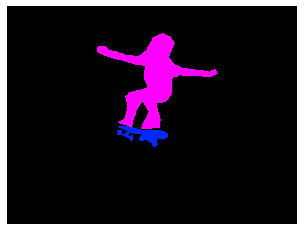

(480, 640, 3)
COCO_val2014_000000297249.jpg
{'person_bbx': [197.15, 8.47, 444.63, 285.32000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': [279.55, 0.0, 350.65, 28.25]}}
person
frisbee
catch
catch interaction
{'person_bbx': [197.15, 8.47, 444.63, 285.32000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [197.15, 8.47, 444.63, 285.32000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [279.55, 0.0, 350.65, 28.25]}}
person
frisbee
throw
throw interaction


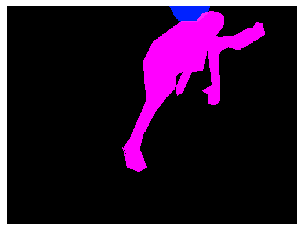

(375, 500, 3)
COCO_val2014_000000249180.jpg
{'person_bbx': [139.76, 210.85, 200.48999999999998, 414.23], 'Verbs': 'hold', 'object': {'obj_bbx': [156.25, 225.82, 166.81, 240.23]}}
cell phone
person
hold
hold interaction
{'person_bbx': [139.76, 210.85, 200.48999999999998, 414.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [139.76, 210.85, 200.48999999999998, 414.23], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


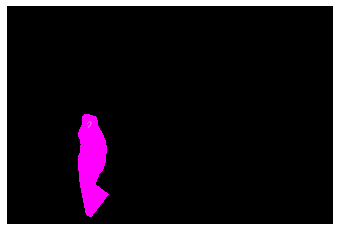

(427, 640, 3)
COCO_val2014_000000094746.jpg
{'person_bbx': [1.8, 11.01, 369.44, 396.63], 'Verbs': 'hold', 'object': {'obj_bbx': [136.88, 97.22, 178.07999999999998, 174.13]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.8, 11.01, 369.44, 396.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.8, 11.01, 369.44, 396.63], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [136.88, 97.22, 178.07999999999998, 174.13]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


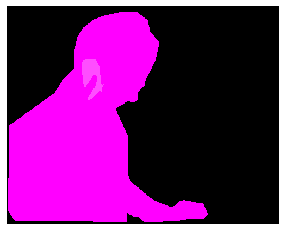

(400, 500, 3)
COCO_val2014_000000212077.jpg
{'person_bbx': [144.89, 151.15, 368.71, 320.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [144.89, 151.15, 368.71, 320.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.89, 151.15, 368.71, 320.8], 'Verbs': 'surf', 'object': {'obj_bbx': [281.75, 273.88, 392.76, 337.57]}}
person
surfboard
surf
surf interaction


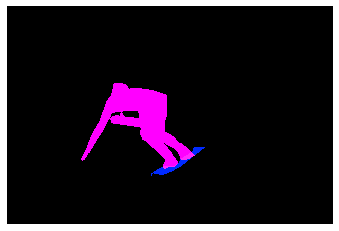

(428, 640, 3)
COCO_val2014_000000442746.jpg
{'person_bbx': [182.02, 105.08, 234.27, 228.95999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [182.02, 105.08, 234.27, 228.95999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [182.02, 105.08, 234.27, 228.95999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.02, 105.08, 234.27, 228.95999999999998], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


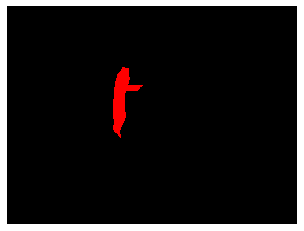

(375, 500, 3)
COCO_val2014_000000497838.jpg
{'person_bbx': [84.28, 310.01, 298.85, 516.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [84.28, 310.01, 298.85, 516.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [84.28, 310.01, 298.85, 516.13], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


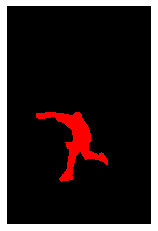

(640, 423, 3)
COCO_val2014_000000407521.jpg
{'person_bbx': [279.19, 21.55, 425.23, 146.11], 'Verbs': 'jump', 'object': {'obj_bbx': [301.73, 134.29, 327.75, 153.48999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [162.06, 46.74, 222.63, 197.64000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [279.19, 21.55, 425.23, 146.11]}}
person
person
look
look interaction
{'person_bbx': [103.34, 96.03, 167.05, 233.39000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [279.19, 21.55, 425.23, 146.11]}}
person
person
look
look interaction
{'person_bbx': [46.74, 100.67, 106.43, 235.87], 'Verbs': 'look', 'object': {'obj_bbx': [279.19, 21.55, 425.23, 146.11]}}
person
person
look
look interaction
{'person_bbx': [279.19, 21.55, 425.23, 146.11], 'Verbs': 'look', 'object': {'obj_bbx': [301.73, 134.29, 327.75, 153.48999999999998]}}
person
skateboard
look
look interaction
{'person_bbx': [103.34, 96.03, 167.05, 233.39000000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit

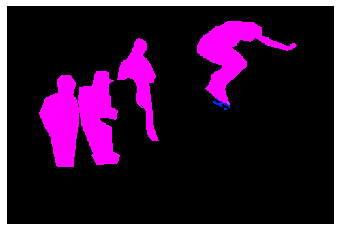

(320, 480, 3)
COCO_val2014_000000323895.jpg
{'person_bbx': [314.26, 1.08, 458.48, 209.87], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [437.88, 13.63, 492.1, 98.41]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [314.26, 1.08, 458.48, 209.87], 'Verbs': 'hold', 'object': {'obj_bbx': [437.88, 13.63, 492.1, 98.41]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [314.26, 1.08, 458.48, 209.87], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


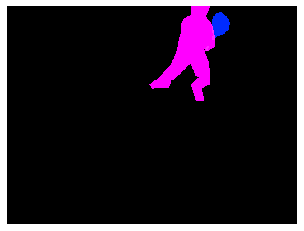

(480, 640, 3)
COCO_val2014_000000558661.jpg
{'person_bbx': [76.22, 30.2, 358.11, 558.0200000000001], 'Verbs': 'look', 'object': {'obj_bbx': [72.62, 207.86, 179.77, 244.48000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [76.22, 30.2, 358.11, 558.0200000000001], 'Verbs': 'throw', 'object': {'obj_bbx': [72.62, 207.86, 179.77, 244.48000000000002]}}
person
frisbee
throw
throw interaction


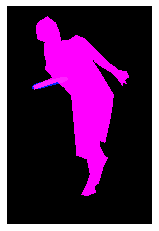

(640, 426, 3)
COCO_val2014_000000575921.jpg
{'person_bbx': [176.11, 6.55, 632.48, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [305.52, 117.36, 344.54999999999995, 204.49]}}
cell phone
person
hold
hold interaction
{'person_bbx': [176.11, 6.55, 632.48, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [176.11, 6.55, 632.48, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [305.52, 117.36, 344.54999999999995, 204.49]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


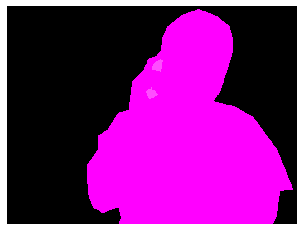

(480, 640, 3)
COCO_val2014_000000083049.jpg
{'person_bbx': [463.46, 58.53, 528.71, 248.52], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [211.44, 118.64, 293.18, 230.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [463.46, 58.53, 528.71, 248.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [284.13, 181.12, 477.49, 298.45], 'Verbs': 'lay', 'object': {'obj_bbx': [204.15, 228.73, 416.1, 293.78999999999996]}}
person
bench
lay
lay interaction
{'person_bbx': [211.44, 118.64, 293.18, 230.74], 'Verbs': 'look', 'object': {'obj_bbx': [284.13, 181.12, 477.49, 298.45]}}
person
person
look
look interaction
{'person_bbx': [211.44, 118.64, 293.18, 230.74], 'Verbs': 'sit', 'object': {'obj_bbx': [204.15, 228.73, 416.1, 293.78999999999996]}}
person
bench
sit
sit interaction
{'person_bbx': [463.46, 58.53, 528.71, 248.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [463.46, 58.53, 528.71, 248.5

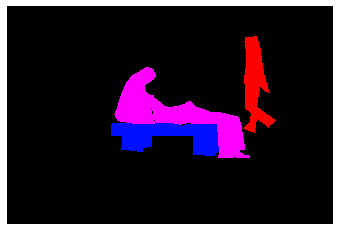

(427, 640, 3)
COCO_val2014_000000545978.jpg
{'person_bbx': [42.31, 102.46, 278.84000000000003, 477.03], 'Verbs': 'hold', 'object': {'obj_bbx': [14.38, 191.28, 283.33, 507.69000000000005]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [259.16, 181.73, 545.19, 568.89], 'Verbs': 'hold', 'object': {'obj_bbx': [271.82, 257.44, 545.0799999999999, 581.03]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [42.31, 102.46, 278.84000000000003, 477.03], 'Verbs': 'ride', 'object': {'obj_bbx': [14.38, 191.28, 283.33, 507.69000000000005]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [259.16, 181.73, 545.19, 568.89], 'Verbs': 'ride', 'object': {'obj_bbx': [271.82, 257.44, 545.0799999999999, 581.03]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [42.31, 102.46, 278.84000000000003, 477.03], 'Verbs': 'sit', 'object': {'obj_bbx': [14.38, 191.28, 283.33, 507.69000000000005]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [259.16, 181.73, 545.19, 568.89], 'Verbs'

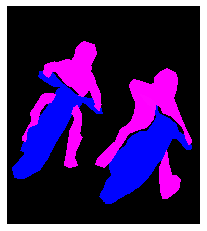

(640, 568, 3)
COCO_val2014_000000007593.jpg
{'person_bbx': [69.03, 105.99, 339.41999999999996, 326.03], 'Verbs': 'jump', 'object': {'obj_bbx': [183.93, 102.11, 370.25, 304.26]}}
person
skateboard
jump
jump interaction
{'person_bbx': [69.03, 105.99, 339.41999999999996, 326.03], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [69.03, 105.99, 339.41999999999996, 326.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [183.93, 102.11, 370.25, 304.26]}}
person
skateboard
skateboard
skateboard interaction


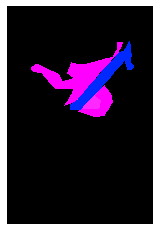

(640, 427, 3)
COCO_val2014_000000197219.jpg
{'person_bbx': [27.68, 66.87, 323.69, 410.79], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [259.53, 212.09, 320.26, 271.07]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [27.68, 66.87, 323.69, 410.79], 'Verbs': 'hold', 'object': {'obj_bbx': [259.53, 212.09, 320.26, 271.07]}}
pizza
person
hold
hold interaction
{'person_bbx': [27.68, 66.87, 323.69, 410.79], 'Verbs': 'look', 'object': {'obj_bbx': [259.53, 212.09, 320.26, 271.07]}}
pizza
person
look
look interaction
{'person_bbx': [27.68, 66.87, 323.69, 410.79], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 234.78, 36.4, 410.07]}}
person
chair
sit
sit interaction


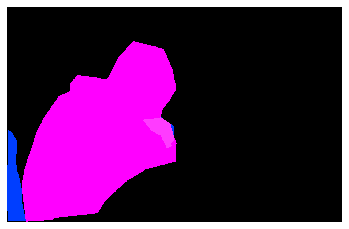

(411, 640, 3)
COCO_val2014_000000302512.jpg
{'person_bbx': [240.29, 223.79, 438.38, 292.2], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


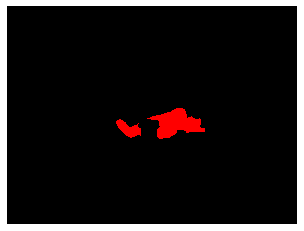

(480, 640, 3)
COCO_val2014_000000205670.jpg
{'person_bbx': [424.0, 100.71, 624.09, 307.46999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [424.0, 100.71, 624.09, 307.46999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [221.05, 186.46, 369.69, 257.92]}}
person
surfboard
surf
surf interaction


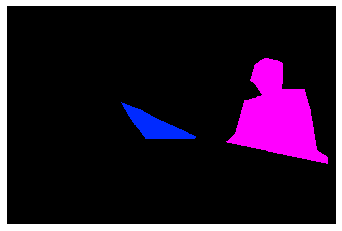

(424, 640, 3)
COCO_val2014_000000345136.jpg
{'person_bbx': [122.0, 117.22, 336.05, 307.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


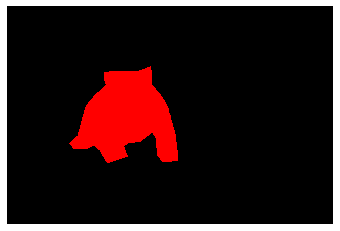

(427, 640, 3)
COCO_val2014_000000493132.jpg
{'person_bbx': [38.11, 93.08, 166.74, 355.10999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [228.03, 229.28, 267.15, 268.68]}}
sports ball
person
catch
catch interaction
{'person_bbx': [331.78, 208.82, 584.56, 355.4], 'Verbs': 'kick', 'object': {'obj_bbx': [228.03, 229.28, 267.15, 268.68]}}
sports ball
person
kick
kick interaction
{'person_bbx': [331.78, 208.82, 584.56, 355.4], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [331.78, 208.82, 584.56, 355.4], 'Verbs': 'look', 'object': {'obj_bbx': [228.03, 229.28, 267.15, 268.68]}}
sports ball
person
look
look interaction
{'person_bbx': [38.11, 93.08, 166.74, 355.10999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [228.03, 229.28, 267.15, 268.68]}}
sports ball
person
look
look interaction
{'person_bbx': [331.78, 208.82, 584.56, 355.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [38.11, 93.08, 166.74, 355.10999999999996], 'Verbs': 'stand'

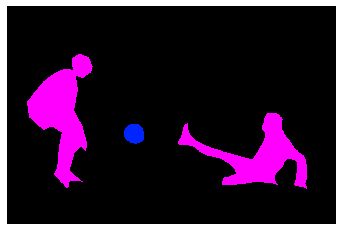

(424, 640, 3)
COCO_val2014_000000422833.jpg
{'person_bbx': [344.14, 22.44, 589.42, 412.21], 'Verbs': 'hold', 'object': {'obj_bbx': [225.0, 116.46, 403.65, 362.94]}}
person
person
hold
hold interaction
{'person_bbx': [225.0, 116.46, 403.65, 362.94], 'Verbs': 'look', 'object': {'obj_bbx': [65.89, 232.53, 356.2, 409.2]}}
person
laptop
look
look interaction
{'person_bbx': [344.14, 22.44, 589.42, 412.21], 'Verbs': 'look', 'object': {'obj_bbx': [65.89, 232.53, 356.2, 409.2]}}
person
laptop
look
look interaction
{'person_bbx': [225.0, 116.46, 403.65, 362.94], 'Verbs': 'sit', 'object': {'obj_bbx': [545.28, 165.68, 640.0, 232.53]}}
chair
person
sit
sit interaction
{'person_bbx': [344.14, 22.44, 589.42, 412.21], 'Verbs': 'sit', 'object': {'obj_bbx': [545.28, 165.68, 640.0, 232.53]}}
chair
person
sit
sit interaction
{'person_bbx': [225.0, 116.46, 403.65, 362.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [344.14, 22.44, 589.42, 412.21], 'Verbs': 'smile', 'object': {

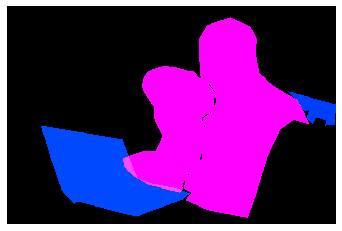

(424, 640, 3)
COCO_val2014_000000171548.jpg
{'person_bbx': [177.2, 214.81, 305.56, 463.03999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [180.13, 251.33, 261.03, 361.35]}}
backpack
person
carry
carry interaction
{'person_bbx': [177.2, 214.81, 305.56, 463.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [180.13, 251.33, 261.03, 361.35]}}
backpack
person
hold
hold interaction
{'person_bbx': [365.25, 207.63, 512.71, 476.02], 'Verbs': 'hold', 'object': {'obj_bbx': [380.54, 343.24, 475.68, 471.89]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [177.2, 214.81, 305.56, 463.03999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [166.49, 345.41, 258.38, 457.84000000000003]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [365.25, 207.63, 512.71, 476.02], 'Verbs': 'ride', 'object': {'obj_bbx': [380.54, 343.24, 475.68, 471.89]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [177.2, 214.81, 305.56, 463.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx':

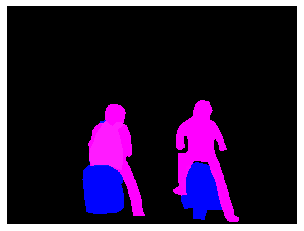

(480, 640, 3)
COCO_val2014_000000391199.jpg
{'person_bbx': [109.71, 107.77, 337.45, 633.0699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [216.64, 219.57, 245.54999999999998, 304.13]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 125.41, 207.57, 632.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.71, 107.77, 337.45, 633.0699999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.71, 107.77, 337.45, 633.0699999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [216.64, 219.57, 245.54999999999998, 304.13]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


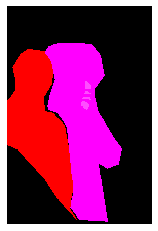

(640, 425, 3)
COCO_val2014_000000151075.jpg
{'person_bbx': [221.08, 112.77, 344.62, 251.82], 'Verbs': 'look', 'object': {'obj_bbx': [272.49, 88.75, 339.65, 269.13]}}
person
surfboard
look
look interaction
{'person_bbx': [221.08, 112.77, 344.62, 251.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [221.08, 112.77, 344.62, 251.82], 'Verbs': 'surf', 'object': {'obj_bbx': [272.49, 88.75, 339.65, 269.13]}}
person
surfboard
surf
surf interaction


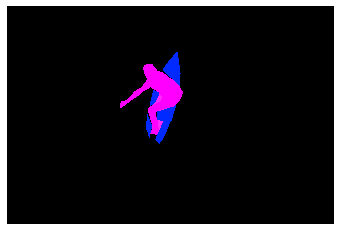

(426, 640, 3)
COCO_val2014_000000451324.jpg
{'person_bbx': [455.17, 0.0, 640.0, 267.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.93, 0.0, 415.43, 160.3], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 1.83, 181.21, 379.35999999999996]}}
person
person
look
look interaction
{'person_bbx': [0.0, 1.83, 181.21, 379.35999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [224.93, 0.0, 415.43, 160.3]}}
person
person
look
look interaction
{'person_bbx': [455.17, 0.0, 640.0, 267.9], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [224.93, 0.0, 415.43, 160.3], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 1.83, 181.21, 379.35999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [455.17, 0.0, 640.0, 267.9], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [224.93, 0.0, 415.43, 160.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 1

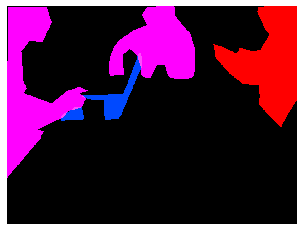

(480, 640, 3)
COCO_val2014_000000563964.jpg
{'person_bbx': [2.89, 20.73, 388.5, 421.94], 'Verbs': 'hold', 'object': {'obj_bbx': [168.88, 344.48, 338.72, 405.89]}}
person
frisbee
hold
hold interaction
{'person_bbx': [2.89, 20.73, 388.5, 421.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.89, 20.73, 388.5, 421.94], 'Verbs': 'throw', 'object': {'obj_bbx': [168.88, 344.48, 338.72, 405.89]}}
person
frisbee
throw
throw interaction


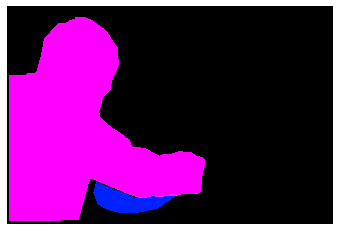

(427, 640, 3)
COCO_val2014_000000409985.jpg
{'person_bbx': [89.99, 0.0, 463.39, 365.41], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [89.99, 0.0, 463.39, 365.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


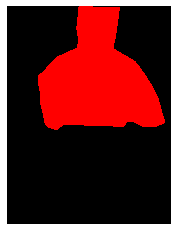

(640, 480, 3)
COCO_val2014_000000348162.jpg
{'person_bbx': [229.13, 6.55, 473.08, 373.62], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [370.3, 251.19, 419.81, 330.64]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [229.13, 6.55, 473.08, 373.62], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [358.4, 309.57, 480.28999999999996, 387.33]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [229.13, 6.55, 473.08, 373.62], 'Verbs': 'hold', 'object': {'obj_bbx': [370.3, 251.19, 419.81, 330.64]}}
person
knife
hold
hold interaction
{'person_bbx': [229.13, 6.55, 473.08, 373.62], 'Verbs': 'look', 'object': {'obj_bbx': [358.4, 309.57, 480.28999999999996, 387.33]}}
person
cake
look
look interaction
{'person_bbx': [229.13, 6.55, 473.08, 373.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


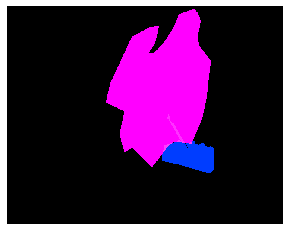

(505, 640, 3)
COCO_val2014_000000212800.jpg
{'person_bbx': [283.62, 204.8, 359.84000000000003, 277.84000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [256.21, 166.24, 356.78999999999996, 222.18]}}
person
umbrella
carry
carry interaction
{'person_bbx': [105.38, 161.91, 153.09, 242.89], 'Verbs': 'carry', 'object': {'obj_bbx': [48.68, 128.71, 138.01, 174.25]}}
person
umbrella
carry
carry interaction
{'person_bbx': [283.62, 204.8, 359.84000000000003, 277.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [256.21, 166.24, 356.78999999999996, 222.18]}}
person
umbrella
hold
hold interaction
{'person_bbx': [105.38, 161.91, 153.09, 242.89], 'Verbs': 'hold', 'object': {'obj_bbx': [105.38, 112.19, 222.8, 197.07]}}
person
umbrella
hold
hold interaction
{'person_bbx': [141.0, 180.78, 179.46, 244.57], 'Verbs': 'hold', 'object': {'obj_bbx': [105.38, 112.19, 222.8, 197.07]}}
umbrella
person
hold
hold interaction
{'person_bbx': [105.38, 161.91, 153.09, 242.89], 'Verbs': 'look', 'object': {'o

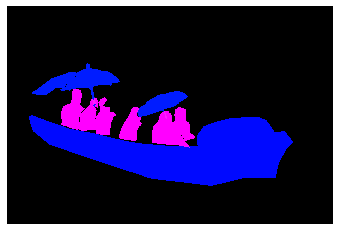

(427, 640, 3)
COCO_val2014_000000423113.jpg
{'person_bbx': [267.45, 8.04, 486.38, 340.06], 'Verbs': 'look', 'object': {'obj_bbx': [193.15, 86.46, 467.20000000000005, 271.52]}}
person
surfboard
look
look interaction
{'person_bbx': [267.45, 8.04, 486.38, 340.06], 'Verbs': 'surf', 'object': {'obj_bbx': [193.15, 86.46, 467.20000000000005, 271.52]}}
person
surfboard
surf
surf interaction


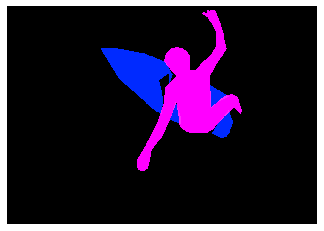

(449, 640, 3)
COCO_val2014_000000045367.jpg
{'person_bbx': [0.0, 50.25, 480.0, 628.68], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 257.62, 395.64, 578.26]}}
dog
person
hold
hold interaction
{'person_bbx': [0.0, 50.25, 480.0, 628.68], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 257.62, 395.64, 578.26]}}
dog
person
look
look interaction
{'person_bbx': [0.0, 50.25, 480.0, 628.68], 'Verbs': 'read', 'object': {'obj_bbx': [169.71, 280.45, 480.0, 552.27]}}
person
book
read
read interaction
{'person_bbx': [0.0, 50.25, 480.0, 628.68], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 54.55, 430.96, 640.0]}}
person
bed
sit
sit interaction
{'person_bbx': [0.0, 50.25, 480.0, 628.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


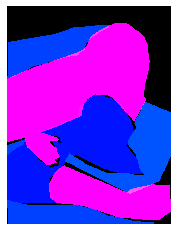

(640, 480, 3)
COCO_val2014_000000455005.jpg
{'person_bbx': [420.94, 225.7, 580.94, 374.97], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [375.83, 96.01, 518.5899999999999, 309.58], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [287.28, 159.38, 367.64, 180.54]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [375.83, 96.01, 518.5899999999999, 309.58], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [21.42, 139.81, 44.010000000000005, 152.64000000000001]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [498.56, 200.14, 640.0, 391.15], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [287.28, 159.38, 367.64, 180.54]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [498.56, 200.14, 640.0, 391.15], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [21.42, 139.81, 44.010000000000005, 152.64000000000001]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [375.83, 96.01, 518.5899999999999, 309.58], 'Verbs': 'hold', 'obj

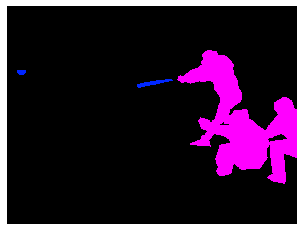

(480, 640, 3)
COCO_val2014_000000067218.jpg
{'person_bbx': [221.28, 154.35, 309.36, 350.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [128.6, 191.19, 213.86, 315.38]}}
person
person
look
look interaction
{'person_bbx': [391.24, 189.54, 600.1800000000001, 430.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [221.28, 154.35, 309.36, 350.91999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [391.24, 189.54, 600.1800000000001, 430.79999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [99.9, 247.06, 530.63, 472.63]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [221.28, 154.35, 309.36, 350.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [391.24, 189.54, 600.1800000000001, 430.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


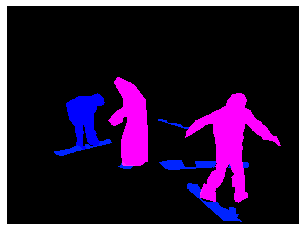

(478, 640, 3)
COCO_val2014_000000419369.jpg
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [367.45, 110.56, 561.17, 223.88]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [427.58, 134.51, 458.99, 164.82]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'hold', 'object': {'obj_bbx': [367.45, 110.56, 561.17, 223.88]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'look', 'object': {'obj_bbx': [427.58, 134.51, 458.99, 164.82]}}
sports ball
person
look
look interaction
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [107.24, 18.52, 386.05, 422.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


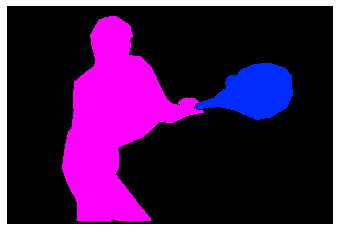

(427, 640, 3)
COCO_val2014_000000419453.jpg
{'person_bbx': [191.75, 21.2, 339.19, 380.99], 'Verbs': 'kick', 'object': {'obj_bbx': [145.44, 328.4, 198.82999999999998, 379.33]}}
sports ball
person
kick
kick interaction
{'person_bbx': [333.52, 67.77, 493.61, 369.84], 'Verbs': 'look', 'object': {'obj_bbx': [145.44, 328.4, 198.82999999999998, 379.33]}}
sports ball
person
look
look interaction
{'person_bbx': [191.75, 21.2, 339.19, 380.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [333.52, 67.77, 493.61, 369.84], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [191.75, 21.2, 339.19, 380.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [333.52, 67.77, 493.61, 369.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


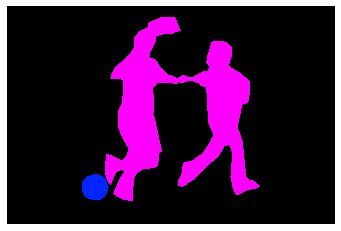

(425, 640, 3)
COCO_val2014_000000252701.jpg
{'person_bbx': [165.45, 31.36, 314.36, 258.38], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [165.45, 31.36, 314.36, 258.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [165.45, 31.36, 314.36, 258.38], 'Verbs': 'surf', 'object': {'obj_bbx': [135.77, 197.26, 330.02, 310.19]}}
person
surfboard
surf
surf interaction


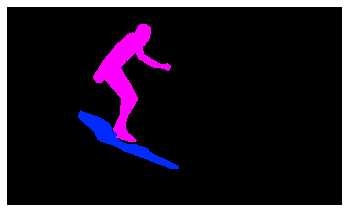

(378, 640, 3)
COCO_val2014_000000254927.jpg
{'person_bbx': [41.76, 131.87, 304.39, 450.54], 'Verbs': 'kick', 'object': {'obj_bbx': [492.42, 394.44, 545.51, 444.18]}}
sports ball
person
kick
kick interaction
{'person_bbx': [41.76, 131.87, 304.39, 450.54], 'Verbs': 'look', 'object': {'obj_bbx': [492.42, 394.44, 545.51, 444.18]}}
sports ball
person
look
look interaction
{'person_bbx': [41.76, 131.87, 304.39, 450.54], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [41.76, 131.87, 304.39, 450.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


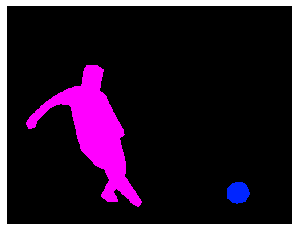

(489, 640, 3)
COCO_val2014_000000468161.jpg
{'person_bbx': [283.24, 40.54, 638.9200000000001, 475.14000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [283.24, 40.54, 638.9200000000001, 475.14000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


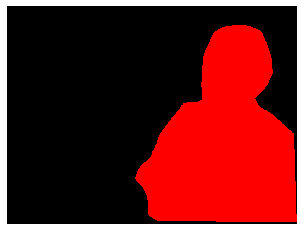

(480, 640, 3)
COCO_val2014_000000227031.jpg
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [259.05, 344.25, 318.1, 382.43]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [315.4, 331.45, 462.08, 416.1]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'hold', 'object': {'obj_bbx': [259.05, 344.25, 318.1, 382.43]}}
knife
person
hold
hold interaction
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'look', 'object': {'obj_bbx': [259.05, 344.25, 318.1, 382.43]}}
knife
person
look
look interaction
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 67.15, 286.01, 479.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


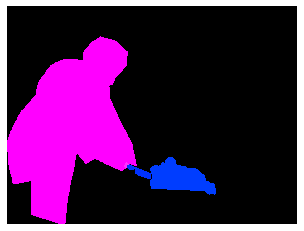

(480, 640, 3)
COCO_val2014_000000522637.jpg
{'person_bbx': [7.28, 0.0, 485.32, 424.1], 'Verbs': 'hold', 'object': {'obj_bbx': [195.23, 76.0, 245.26999999999998, 161.20999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [7.28, 0.0, 485.32, 424.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [7.28, 0.0, 485.32, 424.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [7.28, 0.0, 485.32, 424.1], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [195.23, 76.0, 245.26999999999998, 161.20999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


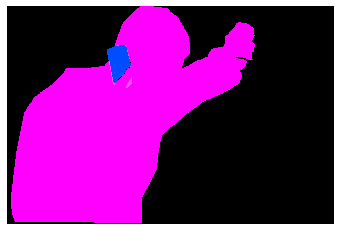

(426, 640, 3)
COCO_val2014_000000308278.jpg
{'person_bbx': [276.01, 162.83, 335.57, 286.15], 'Verbs': 'look', 'object': {'obj_bbx': [263.36, 268.86, 339.83000000000004, 292.82]}}
person
snowboard
look
look interaction
{'person_bbx': [276.01, 162.83, 335.57, 286.15], 'Verbs': 'snowboard', 'object': {'obj_bbx': [263.36, 268.86, 339.83000000000004, 292.82]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [276.01, 162.83, 335.57, 286.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


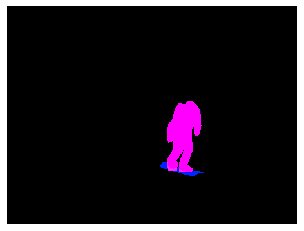

(375, 500, 3)
COCO_val2014_000000090560.jpg
{'person_bbx': [0.0, 146.08, 22.04, 228.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


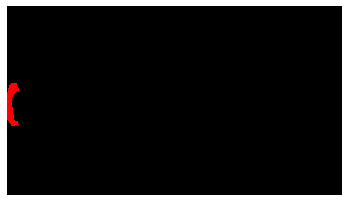

(360, 640, 3)
COCO_val2014_000000275332.jpg
{'person_bbx': [35.5, 68.13, 398.21, 420.28], 'Verbs': 'jump', 'object': {'obj_bbx': [201.05, 312.11, 265.20000000000005, 420.3]}}
skateboard
person
jump
jump interaction
{'person_bbx': [35.5, 68.13, 398.21, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': [201.05, 312.11, 265.20000000000005, 420.3]}}
skateboard
person
look
look interaction
{'person_bbx': [35.5, 68.13, 398.21, 420.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [201.05, 312.11, 265.20000000000005, 420.3]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [35.5, 68.13, 398.21, 420.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


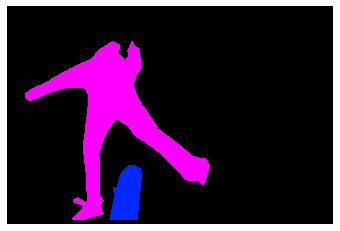

(427, 640, 3)
COCO_val2014_000000504702.jpg
{'person_bbx': [281.49, 366.92, 431.11, 420.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [281.49, 366.92, 431.11, 420.13], 'Verbs': 'look', 'object': {'obj_bbx': [212.2, 301.77, 240.32999999999998, 376.64]}}
person
person
look
look interaction


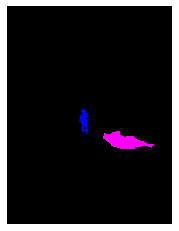

(640, 485, 3)
COCO_val2014_000000084270.jpg
{'person_bbx': [0.0, 247.01, 84.13, 472.45], 'Verbs': 'carry', 'object': {'obj_bbx': [44.63, 435.24, 86.26, 479.34000000000003]}}
suitcase
person
carry
carry interaction
{'person_bbx': [0.0, 247.01, 84.13, 472.45], 'Verbs': 'hold', 'object': {'obj_bbx': [44.63, 435.24, 86.26, 479.34000000000003]}}
suitcase
person
hold
hold interaction
{'person_bbx': [0.0, 247.01, 84.13, 472.45], 'Verbs': 'look', 'object': {'obj_bbx': [91.07, 258.74, 143.60999999999999, 391.73]}}
person
person
look
look interaction
{'person_bbx': [0.0, 247.01, 84.13, 472.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 247.01, 84.13, 472.45], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


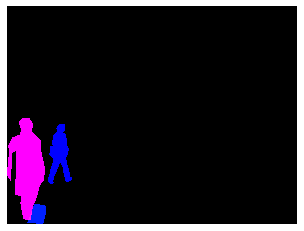

(480, 640, 3)
COCO_val2014_000000487548.jpg
{'person_bbx': [1.08, 2.16, 70.11, 193.07999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


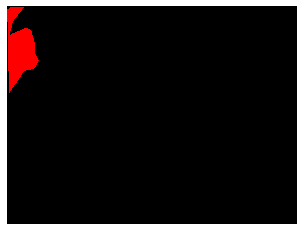

(480, 640, 3)
COCO_val2014_000000398803.jpg
{'person_bbx': [123.06, 209.65, 208.64, 359.46000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [205.42, 230.33, 252.71999999999997, 258.32]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [123.06, 209.65, 208.64, 359.46000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [299.51, 166.38, 307.21999999999997, 173.67]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [520.45, 211.66, 576.95, 324.06], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [509.96, 230.98, 533.43, 262.21]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [520.45, 211.66, 576.95, 324.06], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [299.51, 166.38, 307.21999999999997, 173.67]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [123.06, 209.65, 208.64, 359.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [205.42, 230.33, 252.71999999999997, 258.32]}}
person
tennis racket
hold
hold interactio

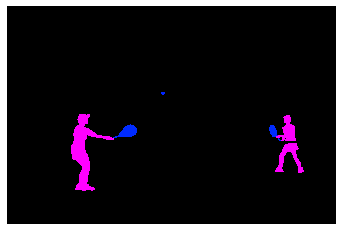

(424, 640, 3)
COCO_val2014_000000124452.jpg
{'person_bbx': [256.5, 138.42, 372.57, 249.04], 'Verbs': 'catch', 'object': {'obj_bbx': [296.15, 156.59, 313.59999999999997, 176.6]}}
person
frisbee
catch
catch interaction
{'person_bbx': [256.5, 138.42, 372.57, 249.04], 'Verbs': 'hold', 'object': {'obj_bbx': [296.15, 156.59, 313.59999999999997, 176.6]}}
person
frisbee
hold
hold interaction
{'person_bbx': [256.5, 138.42, 372.57, 249.04], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [256.5, 138.42, 372.57, 249.04], 'Verbs': 'look', 'object': {'obj_bbx': [296.15, 156.59, 313.59999999999997, 176.6]}}
person
frisbee
look
look interaction


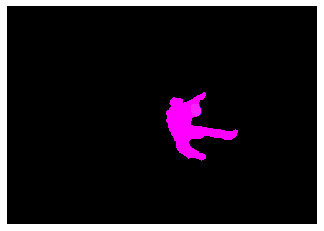

(351, 500, 3)
COCO_val2014_000000561062.jpg
{'person_bbx': [135.83, 10.0, 491.20000000000005, 231.12], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 349.03]}}
person
bed
lay
lay interaction


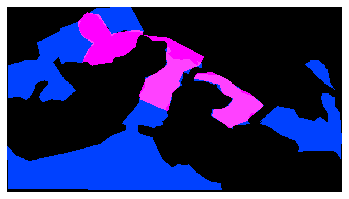

(353, 640, 3)
COCO_val2014_000000217188.jpg
{'person_bbx': [0.0, 14.1, 256.2, 418.07000000000005], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [106.14, 132.38, 163.4, 174.28]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [388.53, 142.81, 640.0, 422.67], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [541.98, 253.45, 628.02, 282.27]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 14.1, 256.2, 418.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [106.14, 132.38, 163.4, 174.28]}}
person
sandwich
hold
hold interaction
{'person_bbx': [388.53, 142.81, 640.0, 422.67], 'Verbs': 'hold', 'object': {'obj_bbx': [541.98, 253.45, 628.02, 282.27]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 14.1, 256.2, 418.07000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [388.53, 142.81, 640.0, 422.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


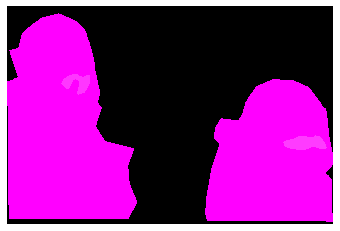

(427, 640, 3)
COCO_val2014_000000217205.jpg
{'person_bbx': [214.7, 420.15, 275.25, 538.52], 'Verbs': 'carry', 'object': {'obj_bbx': [201.34, 446.98, 305.89, 499.57000000000005]}}
person
surfboard
carry
carry interaction
{'person_bbx': [214.7, 420.15, 275.25, 538.52], 'Verbs': 'hold', 'object': {'obj_bbx': [201.34, 446.98, 305.89, 499.57000000000005]}}
person
surfboard
hold
hold interaction
{'person_bbx': [214.7, 420.15, 275.25, 538.52], 'Verbs': 'look', 'object': {'obj_bbx': [204.35, 406.85, 255.05, 528.4]}}
person
person
look
look interaction
{'person_bbx': [214.7, 420.15, 275.25, 538.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [214.7, 420.15, 275.25, 538.52], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


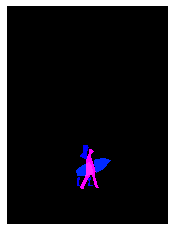

(640, 473, 3)
COCO_val2014_000000257992.jpg
{'person_bbx': [88.41, 215.69, 131.86, 294.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [88.41, 215.69, 131.86, 294.31], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [546.71, 133.27, 577.74, 218.78000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [88.41, 215.69, 131.86, 294.31]}}
person
person
look
look interaction
{'person_bbx': [504.33, 306.64, 554.3, 403.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [88.41, 215.69, 131.86, 294.31]}}
person
person
look
look interaction
{'person_bbx': [88.41, 215.69, 131.86, 294.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [546.71, 133.27, 577.74, 218.78000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [504.33, 306.64, 554.3, 403.04999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


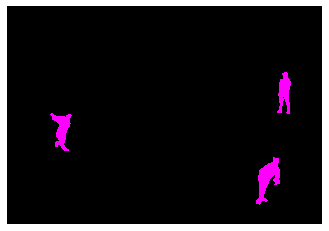

(442, 640, 3)
COCO_val2014_000000030958.jpg
{'person_bbx': [33.41, 82.92, 633.99, 352.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [130.04, 288.7, 262.16999999999996, 359.62]}}
person
handbag
hold
hold interaction
{'person_bbx': [33.41, 82.92, 633.99, 352.65000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 44.36, 640.0, 321.99]}}
bed
person
lay
lay interaction


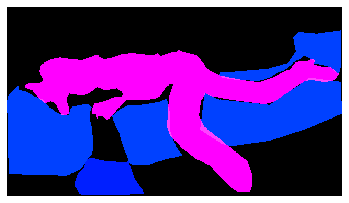

(361, 640, 3)
COCO_val2014_000000164924.jpg
{'person_bbx': [1.32, 236.9, 610.6800000000001, 601.47], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


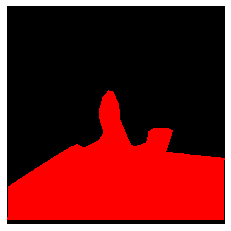

(612, 612, 3)
COCO_val2014_000000331083.jpg
{'person_bbx': [134.95, 83.29, 437.53999999999996, 364.8], 'Verbs': 'jump', 'object': {'obj_bbx': [30.77, 280.34, 201.96, 389.96999999999997]}}
surfboard
person
jump
jump interaction
{'person_bbx': [134.95, 83.29, 437.53999999999996, 364.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [134.95, 83.29, 437.53999999999996, 364.8], 'Verbs': 'surf', 'object': {'obj_bbx': [30.77, 280.34, 201.96, 389.96999999999997]}}
surfboard
person
surf
surf interaction


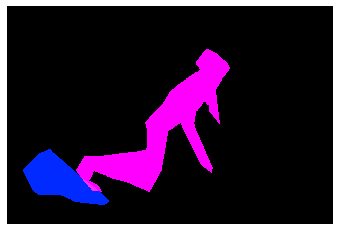

(427, 640, 3)
COCO_val2014_000000416159.jpg
{'person_bbx': [448.11, 29.75, 623.71, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': [426.1, 177.97, 517.25, 329.3]}}
person
handbag
carry
carry interaction
{'person_bbx': [68.93, 70.8, 228.82, 421.21000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [98.83, 131.17, 197.67000000000002, 293.33]}}
person
backpack
carry
carry interaction
{'person_bbx': [448.11, 29.75, 623.71, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [426.1, 177.97, 517.25, 329.3]}}
person
handbag
hold
hold interaction
{'person_bbx': [448.11, 29.75, 623.71, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [68.93, 70.8, 228.82, 421.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [448.11, 29.75, 623.71, 427.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [68.93, 70.8, 228.82, 421.21000000000004], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


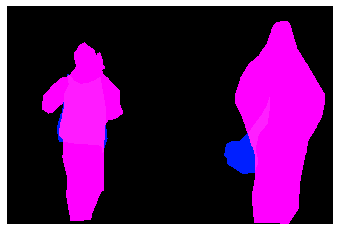

(427, 640, 3)
COCO_val2014_000000225721.jpg
{'person_bbx': [350.7, 0.0, 612.0, 612.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [350.7, 0.0, 612.0, 612.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [350.7, 0.0, 612.0, 612.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


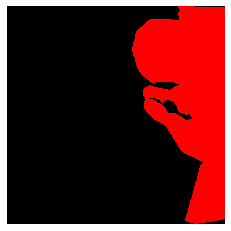

(612, 612, 3)
COCO_val2014_000000102532.jpg
{'person_bbx': [450.32, 91.64, 544.74, 347.41], 'Verbs': 'hold', 'object': {'obj_bbx': [524.36, 206.25, 555.9300000000001, 244.63]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [231.25, 32.33, 415.49, 310.59999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [450.32, 91.64, 544.74, 347.41], 'Verbs': 'look', 'object': {'obj_bbx': [81.2, 222.67, 320.97, 351.63]}}
person
person
look
look interaction
{'person_bbx': [81.2, 222.67, 320.97, 351.63], 'Verbs': 'look', 'object': {'obj_bbx': [287.28, 321.43, 337.71, 348.98]}}
person
baseball glove
look
look interaction
{'person_bbx': [231.25, 32.33, 415.49, 310.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [81.2, 222.67, 320.97, 351.63]}}
person
person
look
look interaction
{'person_bbx': [36.55, 99.06, 162.53, 339.48], 'Verbs': 'look', 'object': {'obj_bbx': [81.2, 222.67, 320.97, 351.63]}}
person
person
look
look interaction
{'person_bbx': [450

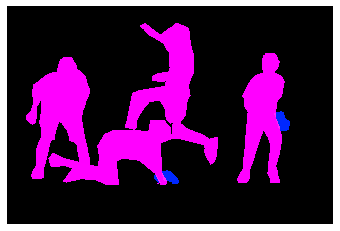

(427, 640, 3)
COCO_val2014_000000449402.jpg
{'person_bbx': [144.86, 45.84, 474.93, 402.5], 'Verbs': 'hold', 'object': {'obj_bbx': [226.47, 181.11, 247.36, 208.01000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [144.86, 45.84, 474.93, 402.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.86, 45.84, 474.93, 402.5], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [226.47, 181.11, 247.36, 208.01000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


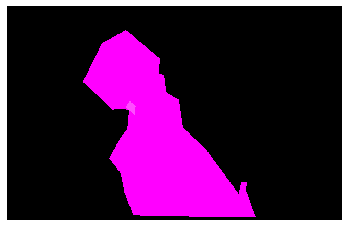

(408, 640, 3)
COCO_val2014_000000158084.jpg
{'person_bbx': [125.82, 192.45, 281.7, 321.85], 'Verbs': 'ride', 'object': {'obj_bbx': [28.64, 270.74, 412.34999999999997, 508.42]}}
train
person
ride
ride interaction
{'person_bbx': [78.96, 233.63, 126.05, 322.33], 'Verbs': 'ride', 'object': {'obj_bbx': [28.64, 270.74, 412.34999999999997, 508.42]}}
train
person
ride
ride interaction
{'person_bbx': [332.86, 216.8, 386.69, 344.45000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [28.64, 270.74, 412.34999999999997, 508.42]}}
train
person
ride
ride interaction
{'person_bbx': [46.52, 232.23, 89.45, 390.19], 'Verbs': 'ride', 'object': {'obj_bbx': [28.64, 270.74, 412.34999999999997, 508.42]}}
train
person
ride
ride interaction
{'person_bbx': [125.82, 192.45, 281.7, 321.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [78.96, 233.63, 126.05, 322.33], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [332.86, 216.8, 386.69, 344.45000000000005], 'Verbs': 

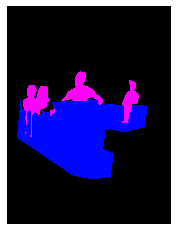

(640, 480, 3)
COCO_val2014_000000399415.jpg
{'person_bbx': [38.74, 30.3, 235.34, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': [173.3, 29.3, 248.24, 63.269999999999996]}}
person
frisbee
catch
catch interaction
{'person_bbx': [38.74, 30.3, 235.34, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [173.3, 29.3, 248.24, 63.269999999999996]}}
person
frisbee
hold
hold interaction
{'person_bbx': [38.74, 30.3, 235.34, 640.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [38.74, 30.3, 235.34, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [173.3, 29.3, 248.24, 63.269999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [194.16, 76.22, 394.07, 581.03], 'Verbs': 'look', 'object': {'obj_bbx': [173.3, 29.3, 248.24, 63.269999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [38.74, 30.3, 235.34, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [194.16, 76.22, 394.07, 581.03], 'Verbs': 'stand', 'object': {'obj_bbx'

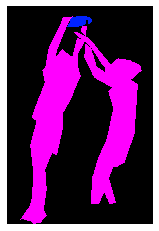

(640, 427, 3)
COCO_val2014_000000519853.jpg
{'person_bbx': [209.13, 185.89, 273.3, 275.52], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [209.13, 185.89, 273.3, 275.52], 'Verbs': 'ride', 'object': {'obj_bbx': [200.99, 269.97, 308.63, 303.6]}}
boat
person
ride
ride interaction


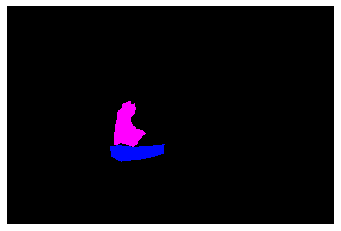

(426, 640, 3)
COCO_val2014_000000022403.jpg
{'person_bbx': [312.81, 113.26, 436.85, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [416.05, 300.28, 457.1, 356.42999999999995]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [82.07, 63.2, 247.17, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [1.08, 142.16, 142.70000000000002, 472.97]}}
person
person
look
look interaction
{'person_bbx': [312.81, 113.26, 436.85, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [221.51, 140.19, 336.25, 464.77], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [312.81, 113.26, 436.85, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [221.51, 140.19, 336.25, 464.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [82.07, 63.2, 247.17, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.08, 142.16, 142.70000000000002, 472.97], 'Verbs': 'stand', 'obje

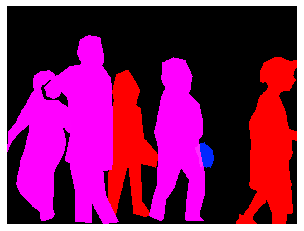

(480, 640, 3)
COCO_val2014_000000510651.jpg
{'person_bbx': [33.36, 132.5, 245.38, 474.74], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 237.42, 77.32, 473.65999999999997]}}
chair
person
sit
sit interaction
{'person_bbx': [414.82, 78.91, 640.0, 479.5], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [33.36, 132.5, 245.38, 474.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [414.82, 78.91, 640.0, 479.5], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


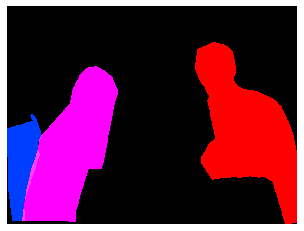

(480, 640, 3)
COCO_val2014_000000440358.jpg
{'person_bbx': [120.41, 90.02, 278.27, 271.06], 'Verbs': 'hold', 'object': {'obj_bbx': [197.32, 197.84, 298.31, 292.43]}}
person
snowboard
hold
hold interaction
{'person_bbx': [120.41, 90.02, 278.27, 271.06], 'Verbs': 'jump', 'object': {'obj_bbx': [197.32, 197.84, 298.31, 292.43]}}
person
snowboard
jump
jump interaction
{'person_bbx': [120.41, 90.02, 278.27, 271.06], 'Verbs': 'look', 'object': {'obj_bbx': [197.32, 197.84, 298.31, 292.43]}}
person
snowboard
look
look interaction
{'person_bbx': [120.41, 90.02, 278.27, 271.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [197.32, 197.84, 298.31, 292.43]}}
person
snowboard
snowboard
snowboard interaction


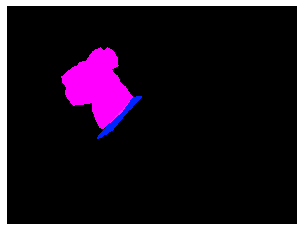

(480, 640, 3)
COCO_val2014_000000512830.jpg
{'person_bbx': [174.83, 128.27, 230.68, 363.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [192.05, 154.15, 220.31, 171.56]}}
cell phone
person
hold
hold interaction
{'person_bbx': [174.83, 128.27, 230.68, 363.71000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [0.0, 210.68, 80.04, 391.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [389.24, 248.78, 563.6, 386.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [349.55, 251.68, 463.61, 383.01]}}
person
chair
sit
sit interaction
{'person_bbx': [174.83, 128.27, 230.68, 363.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 210.68, 80.04, 391.0], 'Verbs': 'sit', 'object': {'obj_bbx': [2.52, 161.45, 99.22, 381.75]}}
chair
person
sit
sit interaction
{'person_bbx': [174.83, 128.27, 230.68, 363.71000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [192.05, 154.15, 220.31, 17

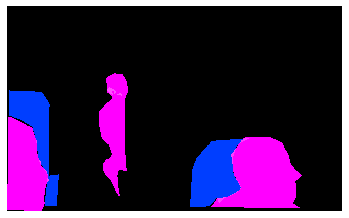

(391, 640, 3)
COCO_val2014_000000020179.jpg
{'person_bbx': [171.4, 63.49, 306.90999999999997, 328.54], 'Verbs': 'carry', 'object': {'obj_bbx': [2.57, 132.09, 427.51, 223.5]}}
person
surfboard
carry
carry interaction
{'person_bbx': [171.4, 63.49, 306.90999999999997, 328.54], 'Verbs': 'hold', 'object': {'obj_bbx': [2.57, 132.09, 427.51, 223.5]}}
person
surfboard
hold
hold interaction
{'person_bbx': [171.4, 63.49, 306.90999999999997, 328.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.4, 63.49, 306.90999999999997, 328.54], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


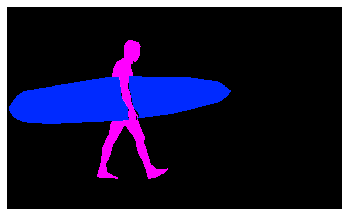

(386, 640, 3)
COCO_val2014_000000256980.jpg
{'person_bbx': [85.33, 176.82, 427.0, 639.9200000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [85.33, 176.82, 427.0, 639.9200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


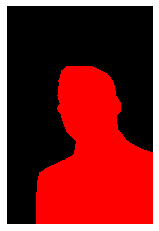

(640, 427, 3)
COCO_val2014_000000547300.jpg
{'person_bbx': [385.08, 105.71, 515.6, 403.41999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [475.44, 105.64, 535.49, 178.51]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [385.08, 105.71, 515.6, 403.41999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [304.29, 359.87, 339.28000000000003, 397.28]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [385.08, 105.71, 515.6, 403.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [475.44, 105.64, 535.49, 178.51]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [385.08, 105.71, 515.6, 403.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [304.29, 359.87, 339.28000000000003, 397.28]}}
sports ball
person
look
look interaction
{'person_bbx': [146.55, 160.76, 236.05, 393.08], 'Verbs': 'look', 'object': {'obj_bbx': [304.29, 359.87, 339.28000000000003, 397.28]}}
sports ball
person
look
look interaction
{'person_bbx': [385.08, 105.71

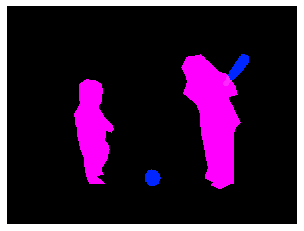

(480, 640, 3)
COCO_val2014_000000060246.jpg
{'person_bbx': [96.83, 187.96, 247.51999999999998, 490.57000000000005], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [253.2, 316.79, 298.59999999999997, 331.64000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [96.83, 187.96, 247.51999999999998, 490.57000000000005], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [279.03, 298.05, 377.63, 396.64]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 198.07, 259.96, 567.19], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [253.2, 316.79, 298.59999999999997, 331.64000000000004]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 198.07, 259.96, 567.19], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [279.03, 298.05, 377.63, 396.64]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [96.83, 187.96, 247.51999999999998, 490.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [253.2, 316.79, 298.59999999999997, 331.64000000000004]}}
person
knife
hold
hold 

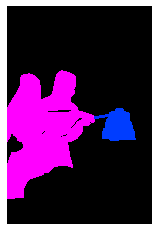

(640, 426, 3)
COCO_val2014_000000494608.jpg
{'person_bbx': [345.95, 145.95, 442.15999999999997, 396.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [236.77, 123.89, 358.46000000000004, 392.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [345.95, 145.95, 442.15999999999997, 396.76], 'Verbs': 'ski', 'object': {'obj_bbx': [374.64, 382.36, 464.46999999999997, 439.04]}}
person
skis
ski
ski interaction
{'person_bbx': [236.77, 123.89, 358.46000000000004, 392.61], 'Verbs': 'ski', 'object': {'obj_bbx': [312.13, 382.83, 359.65, 447.2]}}
person
skis
ski
ski interaction
{'person_bbx': [236.77, 123.89, 358.46000000000004, 392.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [345.95, 145.95, 442.15999999999997, 396.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [236.77, 123.89, 358.46000000000004, 392.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


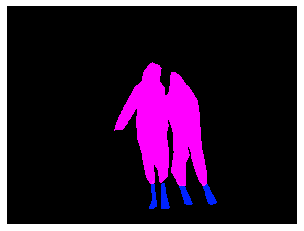

(480, 640, 3)
COCO_val2014_000000479683.jpg
{'person_bbx': [168.27, 212.85, 382.56, 488.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [424.63, 168.13, 565.4, 522.06], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [168.27, 212.85, 382.56, 488.99], 'Verbs': 'ski', 'object': {'obj_bbx': [64.51, 432.18, 374.19, 487.76]}}
person
skis
ski
ski interaction
{'person_bbx': [424.63, 168.13, 565.4, 522.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [430.59, 509.12, 497.96999999999997, 536.85]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [168.27, 212.85, 382.56, 488.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [424.63, 168.13, 565.4, 522.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


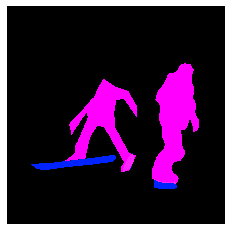

(640, 640, 3)
COCO_val2014_000000558234.jpg
{'person_bbx': [156.05, 43.0, 560.72, 474.57], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [285.1, 390.66, 391.03000000000003, 401.68]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [156.05, 43.0, 560.72, 474.57], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [91.69, 181.21, 279.37, 429.3]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [156.05, 43.0, 560.72, 474.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [156.05, 43.0, 560.72, 474.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


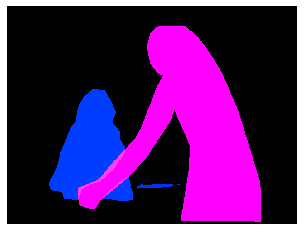

(480, 640, 3)
COCO_val2014_000000359220.jpg
{'person_bbx': [103.23, 146.84, 405.68, 425.54999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [271.2, 249.34, 332.02, 300.75]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [103.23, 146.84, 405.68, 425.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [271.2, 249.34, 332.02, 300.75]}}
person
sandwich
hold
hold interaction
{'person_bbx': [103.23, 146.84, 405.68, 425.54999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [9.94, 314.22, 113.28999999999999, 477.28000000000003]}}
chair
person
sit
sit interaction


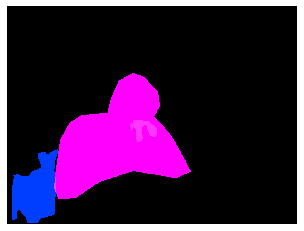

(480, 640, 3)
COCO_val2014_000000260695.jpg
{'person_bbx': [106.78, 2.85, 637.5799999999999, 474.56], 'Verbs': 'hold', 'object': {'obj_bbx': [10.84, 299.86, 157.11, 461.31]}}
person
cell phone
hold
hold interaction
{'person_bbx': [106.78, 2.85, 637.5799999999999, 474.56], 'Verbs': 'look', 'object': {'obj_bbx': [10.84, 299.86, 157.11, 461.31]}}
person
cell phone
look
look interaction
{'person_bbx': [106.78, 2.85, 637.5799999999999, 474.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


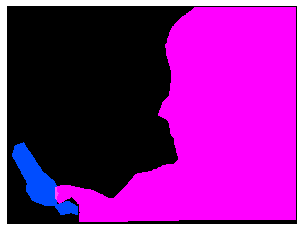

(480, 640, 3)
COCO_val2014_000000358389.jpg
{'person_bbx': [0.85, 51.07, 482.67, 379.0], 'Verbs': 'sit', 'object': {'obj_bbx': [424.28, 292.37, 500.0, 373.09000000000003]}}
person
chair
sit
sit interaction


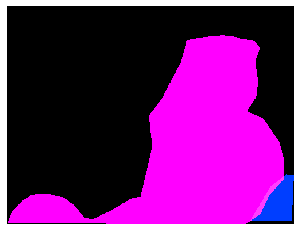

(379, 500, 3)
COCO_val2014_000000253408.jpg
{'person_bbx': [108.7, 163.53, 291.66, 470.26], 'Verbs': 'sit', 'object': {'obj_bbx': [6.47, 371.06, 126.2, 473.53]}}
person
chair
sit
sit interaction
{'person_bbx': [294.47, 173.66, 490.79, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [321.07, 305.07, 374.77, 478.04999999999995]}}
person
chair
sit
sit interaction
{'person_bbx': [108.7, 163.53, 291.66, 470.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [294.47, 173.66, 490.79, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


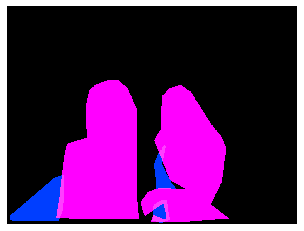

(480, 640, 3)
COCO_val2014_000000532812.jpg
{'person_bbx': [173.41, 154.04, 466.05999999999995, 501.4], 'Verbs': 'jump', 'object': {'obj_bbx': [275.13, 491.67, 308.92, 507.07]}}
person
skateboard
jump
jump interaction
{'person_bbx': [173.41, 154.04, 466.05999999999995, 501.4], 'Verbs': 'look', 'object': {'obj_bbx': [378.83, 434.97, 529.51, 604.29]}}
person
skateboard
look
look interaction
{'person_bbx': [173.41, 154.04, 466.05999999999995, 501.4], 'Verbs': 'skateboard', 'object': {'obj_bbx': [378.83, 434.97, 529.51, 604.29]}}
person
skateboard
skateboard
skateboard interaction


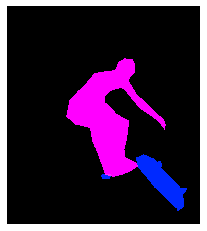

(640, 567, 3)
COCO_val2014_000000117014.jpg
{'person_bbx': [170.62, 127.26, 319.71000000000004, 243.97], 'Verbs': 'jump', 'object': {'obj_bbx': [209.65, 99.56, 266.13, 284.32]}}
person
snowboard
jump
jump interaction
{'person_bbx': [170.62, 127.26, 319.71000000000004, 243.97], 'Verbs': 'snowboard', 'object': {'obj_bbx': [209.65, 99.56, 266.13, 284.32]}}
person
snowboard
snowboard
snowboard interaction


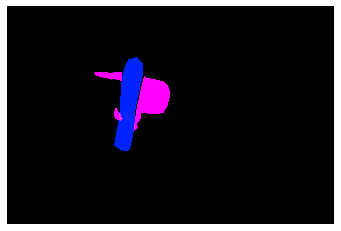

(426, 640, 3)
COCO_val2014_000000529522.jpg
{'person_bbx': [422.43, 174.85, 510.03, 303.38], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [196.29, 139.98, 250.04999999999998, 246.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [422.43, 174.85, 510.03, 303.38], 'Verbs': 'surf', 'object': {'obj_bbx': [410.6, 274.87, 491.66, 305.22]}}
person
surfboard
surf
surf interaction
{'person_bbx': [196.29, 139.98, 250.04999999999998, 246.87], 'Verbs': 'surf', 'object': {'obj_bbx': [130.11, 228.48, 214.87, 253.2]}}
person
surfboard
surf
surf interaction


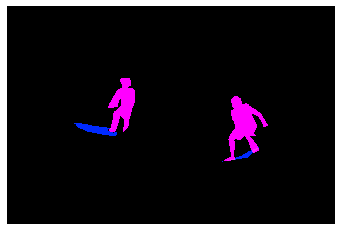

(425, 640, 3)
COCO_val2014_000000556966.jpg
{'person_bbx': [221.69, 73.26, 390.37, 373.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [221.69, 73.26, 390.37, 373.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [221.69, 73.26, 390.37, 373.99], 'Verbs': 'surf', 'object': {'obj_bbx': [204.92, 320.78, 383.41999999999996, 388.53999999999996]}}
person
surfboard
surf
surf interaction


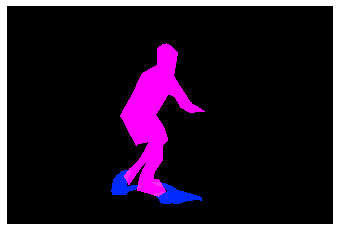

(427, 640, 3)
COCO_val2014_000000564743.jpg
{'person_bbx': [450.12, 116.58, 530.47, 339.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [450.12, 116.58, 530.47, 339.61], 'Verbs': 'ski', 'object': {'obj_bbx': [436.13, 312.82, 529.87, 351.42]}}
person
skis
ski
ski interaction
{'person_bbx': [337.89, 139.48, 470.53, 408.87], 'Verbs': 'snowboard', 'object': {'obj_bbx': [318.57, 373.89, 456.01, 422.41999999999996]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [228.86, 149.65, 363.33000000000004, 422.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [337.89, 139.48, 470.53, 408.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [450.12, 116.58, 530.47, 339.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


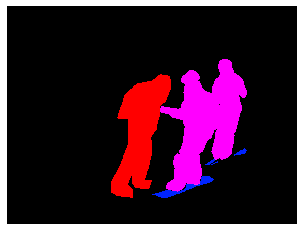

(480, 640, 3)
COCO_val2014_000000285302.jpg
{'person_bbx': [14.48, 28.96, 299.73, 535.75], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [123.96, 282.72, 220.64999999999998, 355.51000000000005]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [14.48, 28.96, 299.73, 535.75], 'Verbs': 'hold', 'object': {'obj_bbx': [123.96, 282.72, 220.64999999999998, 355.51000000000005]}}
person
scissors
hold
hold interaction
{'person_bbx': [14.48, 28.96, 299.73, 535.75], 'Verbs': 'look', 'object': {'obj_bbx': [123.96, 282.72, 220.64999999999998, 355.51000000000005]}}
person
scissors
look
look interaction
{'person_bbx': [14.48, 28.96, 299.73, 535.75], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 164.7, 330.01, 640.0]}}
person
chair
sit
sit interaction


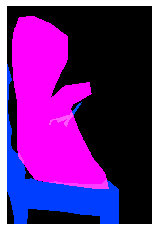

(640, 426, 3)
COCO_val2014_000000011209.jpg
{'person_bbx': [151.69, 112.66, 262.92, 287.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [264.85, 159.75, 382.57000000000005, 310.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [151.69, 112.66, 262.92, 287.1], 'Verbs': 'sit', 'object': {'obj_bbx': [53.11, 200.86, 441.79, 336.05]}}
couch
person
sit
sit interaction
{'person_bbx': [264.85, 159.75, 382.57000000000005, 310.26], 'Verbs': 'sit', 'object': {'obj_bbx': [53.11, 200.86, 441.79, 336.05]}}
couch
person
sit
sit interaction
{'person_bbx': [151.69, 112.66, 262.92, 287.1], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


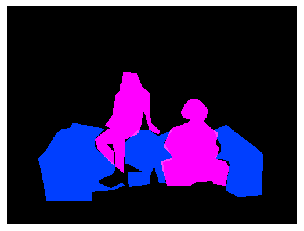

(375, 500, 3)
COCO_val2014_000000514147.jpg
{'person_bbx': [386.13, 102.61, 493.3, 314.68], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [469.52, 161.65, 500.12, 170.5]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [386.13, 102.61, 493.3, 314.68], 'Verbs': 'hold', 'object': {'obj_bbx': [469.52, 161.65, 500.12, 170.5]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [73.24, 167.84, 263.33, 310.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [469.52, 161.65, 500.12, 170.5]}}
person
baseball bat
look
look interaction
{'person_bbx': [386.13, 102.61, 493.3, 314.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


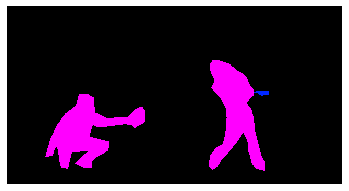

(339, 640, 3)
COCO_val2014_000000190007.jpg
{'person_bbx': [246.03, 154.62, 321.49, 249.59], 'Verbs': 'look', 'object': {'obj_bbx': [282.43, 242.72, 350.42, 272.38]}}
person
surfboard
look
look interaction
{'person_bbx': [246.03, 154.62, 321.49, 249.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [246.03, 154.62, 321.49, 249.59], 'Verbs': 'surf', 'object': {'obj_bbx': [282.43, 242.72, 350.42, 272.38]}}
person
surfboard
surf
surf interaction


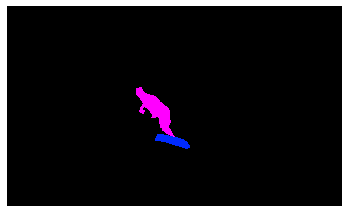

(381, 640, 3)
COCO_val2014_000000185479.jpg
{'person_bbx': [51.91, 15.4, 579.3199999999999, 414.07], 'Verbs': 'hold', 'object': {'obj_bbx': [257.66, 124.52, 438.12, 270.0]}}
person
laptop
hold
hold interaction
{'person_bbx': [51.91, 15.4, 579.3199999999999, 414.07], 'Verbs': 'look', 'object': {'obj_bbx': [257.66, 124.52, 438.12, 270.0]}}
person
laptop
look
look interaction
{'person_bbx': [51.91, 15.4, 579.3199999999999, 414.07], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [51.91, 15.4, 579.3199999999999, 414.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [257.66, 124.52, 438.12, 270.0]}}
person
laptop
work_on_computer
work_on_computer interaction


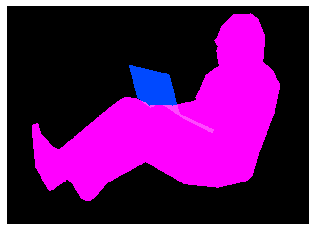

(462, 640, 3)
COCO_val2014_000000453724.jpg
{'person_bbx': [122.63, 195.31, 150.62, 261.8], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [240.68, 198.75, 273.15, 265.9], 'Verbs': 'carry', 'object': {'obj_bbx': [268.28, 201.78, 281.82, 229.67000000000002]}}
person
car
carry
carry interaction
{'person_bbx': [213.53, 197.73, 242.8, 264.90999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [122.63, 195.31, 150.62, 261.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [240.68, 198.75, 273.15, 265.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [213.53, 197.73, 242.8, 264.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [122.63, 195.31, 150.62, 261.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [240.68, 198.75, 273.15, 265.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [213.53, 19

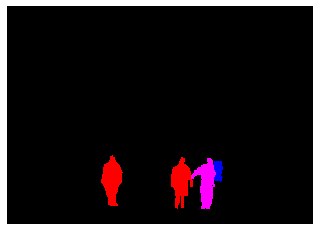

(285, 400, 3)
COCO_val2014_000000575389.jpg
{'person_bbx': [133.75, 232.99, 346.61, 516.31], 'Verbs': 'look', 'object': {'obj_bbx': [25.89, 425.71, 274.7, 558.02]}}
laptop
person
look
look interaction
{'person_bbx': [133.75, 232.99, 346.61, 516.31], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [133.75, 232.99, 346.61, 516.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.75, 232.99, 346.61, 516.31], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [25.89, 425.71, 274.7, 558.02]}}
laptop
person
work_on_computer
work_on_computer interaction


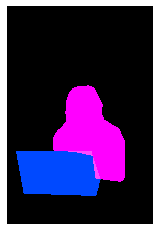

(640, 428, 3)
COCO_val2014_000000165225.jpg
{'person_bbx': [395.31, 264.58, 500.0, 374.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [26.87, 240.92, 99.96000000000001, 365.46], 'Verbs': 'look', 'object': {'obj_bbx': [91.85, 106.18, 219.1, 212.36]}}
person
tv
look
look interaction
{'person_bbx': [395.31, 264.58, 500.0, 374.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [119.35, 250.26, 176.37, 349.78], 'Verbs': 'sit', 'object': {'obj_bbx': [101.32, 319.9, 134.28, 373.09]}}
chair
person
sit
sit interaction
{'person_bbx': [26.87, 240.92, 99.96000000000001, 365.46], 'Verbs': 'sit', 'object': {'obj_bbx': [22.24, 298.32, 79.46, 375.0]}}
person
chair
sit
sit interaction
{'person_bbx': [160.71, 285.6, 275.8, 375.0], 'Verbs': 'sit', 'object': {'obj_bbx': [130.59, 336.89, 176.28, 375.0]}}
chair
person
sit
sit interaction
{'person_bbx': [336.74, 306.04, 424.15, 375.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
perso

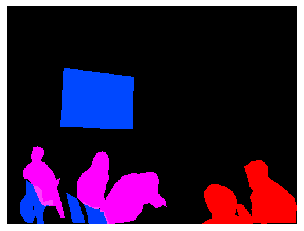

(375, 500, 3)
COCO_val2014_000000113757.jpg
{'person_bbx': [130.5, 284.03, 254.28, 422.19999999999993], 'Verbs': 'look', 'object': {'obj_bbx': [231.33, 319.53, 306.51, 427.0]}}
laptop
person
look
look interaction
{'person_bbx': [130.5, 284.03, 254.28, 422.19999999999993], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [130.5, 284.03, 254.28, 422.19999999999993], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [231.33, 319.53, 306.51, 427.0]}}
laptop
person
work_on_computer
work_on_computer interaction


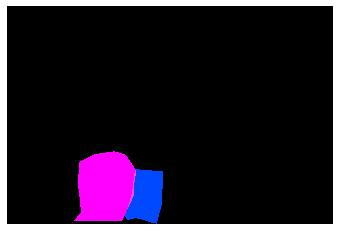

(427, 640, 3)
COCO_val2014_000000455464.jpg
{'person_bbx': [86.99, 157.72, 451.35, 509.75], 'Verbs': 'hold', 'object': {'obj_bbx': [151.41, 262.91, 290.82, 375.81000000000006]}}
cell phone
person
hold
hold interaction
{'person_bbx': [86.99, 157.72, 451.35, 509.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [86.99, 157.72, 451.35, 509.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.99, 157.72, 451.35, 509.75], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [151.41, 262.91, 290.82, 375.81000000000006]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


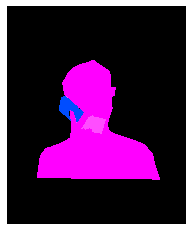

(640, 526, 3)
COCO_val2014_000000075434.jpg
{'person_bbx': [148.86, 106.79, 302.98, 494.57], 'Verbs': 'carry', 'object': {'obj_bbx': [8.45, 77.26, 422.53999999999996, 167.53]}}
surfboard
person
carry
carry interaction
{'person_bbx': [148.86, 106.79, 302.98, 494.57], 'Verbs': 'hold', 'object': {'obj_bbx': [8.45, 77.26, 422.53999999999996, 167.53]}}
surfboard
person
hold
hold interaction
{'person_bbx': [148.86, 106.79, 302.98, 494.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.86, 106.79, 302.98, 494.57], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


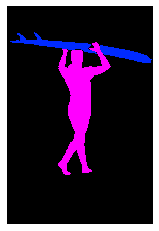

(640, 427, 3)
COCO_val2014_000000209468.jpg
{'person_bbx': [178.38, 120.54, 292.97, 475.14000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [268.58, 222.2, 357.03, 288.0]}}
person
laptop
look
look interaction
{'person_bbx': [178.38, 120.54, 292.97, 475.14000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [178.38, 120.54, 292.97, 475.14000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [268.58, 222.2, 357.03, 288.0]}}
person
laptop
work_on_computer
work_on_computer interaction


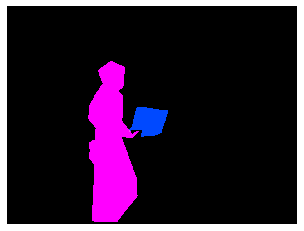

(480, 640, 3)
COCO_val2014_000000365095.jpg
{'person_bbx': [352.14, 73.8, 534.54, 270.96], 'Verbs': 'kick', 'object': {'obj_bbx': [484.96, 232.13, 519.26, 260.4]}}
sports ball
person
kick
kick interaction
{'person_bbx': [352.14, 73.8, 534.54, 270.96], 'Verbs': 'look', 'object': {'obj_bbx': [484.96, 232.13, 519.26, 260.4]}}
sports ball
person
look
look interaction
{'person_bbx': [352.14, 73.8, 534.54, 270.96], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [352.14, 73.8, 534.54, 270.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


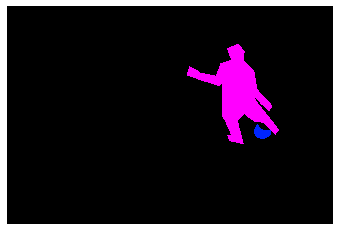

(427, 640, 3)
COCO_val2014_000000446597.jpg
{'person_bbx': [256.8, 153.89, 402.03, 337.59], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [356.37, 120.73, 391.86, 184.43]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [256.8, 153.89, 402.03, 337.59], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [357.28, 22.07, 364.48999999999995, 29.1]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [256.8, 153.89, 402.03, 337.59], 'Verbs': 'hold', 'object': {'obj_bbx': [356.37, 120.73, 391.86, 184.43]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [256.8, 153.89, 402.03, 337.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.54, 211.95, 93.59, 361.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


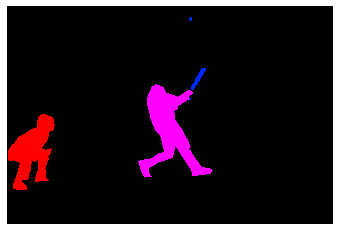

(428, 640, 3)
COCO_val2014_000000556892.jpg
{'person_bbx': [118.39, 125.06, 525.24, 250.11], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


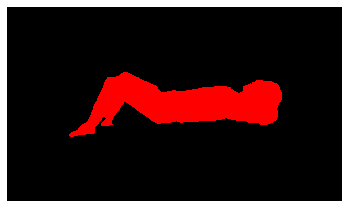

(371, 640, 3)
COCO_val2014_000000397274.jpg
{'person_bbx': [210.72, 349.7, 243.29, 431.71999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [192.42, 403.48, 223.10999999999999, 442.35]}}
person
suitcase
carry
carry interaction
{'person_bbx': [210.72, 349.7, 243.29, 431.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [214.95, 328.4, 268.28999999999996, 359.75]}}
umbrella
person
hold
hold interaction
{'person_bbx': [210.72, 349.7, 243.29, 431.71999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [210.72, 349.7, 243.29, 431.71999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


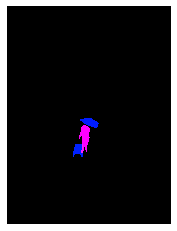

(640, 480, 3)
COCO_val2014_000000554266.jpg
{'person_bbx': [274.92, 130.69, 407.94000000000005, 234.14999999999998], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [376.99, 130.88, 628.05, 233.66], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


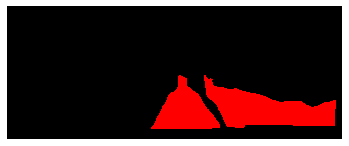

(253, 640, 3)
COCO_val2014_000000153229.jpg
{'person_bbx': [233.62, 30.74, 337.11, 392.45], 'Verbs': 'catch', 'object': {'obj_bbx': [339.92, 10.46, 383.21000000000004, 19.53]}}
person
frisbee
catch
catch interaction
{'person_bbx': [168.56, 33.24, 300.31, 404.77], 'Verbs': 'catch', 'object': {'obj_bbx': [339.92, 10.46, 383.21000000000004, 19.53]}}
frisbee
person
catch
catch interaction
{'person_bbx': [339.4, 147.26, 495.16999999999996, 444.36], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [233.62, 30.74, 337.11, 392.45], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [168.56, 33.24, 300.31, 404.77], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [339.4, 147.26, 495.16999999999996, 444.36], 'Verbs': 'look', 'object': {'obj_bbx': [339.92, 10.46, 383.21000000000004, 19.53]}}
person
frisbee
look
look interaction
{'person_bbx': [233.62, 30.74, 337.11, 392.45], 'Verbs': 'look', 'object': {'obj_bbx': [339.92, 10.46, 383.

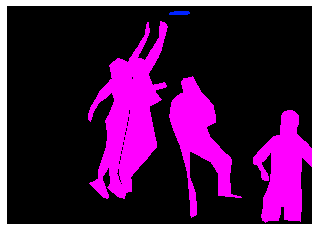

(457, 640, 3)
COCO_val2014_000000144373.jpg
{'person_bbx': [0.0, 154.05, 640.0, 474.05], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [189.46, 115.88, 476.34000000000003, 381.57]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 154.05, 640.0, 474.05], 'Verbs': 'hold', 'object': {'obj_bbx': [189.46, 115.88, 476.34000000000003, 381.57]}}
person
donut
hold
hold interaction


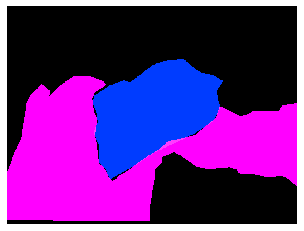

(480, 640, 3)
COCO_val2014_000000535668.jpg
{'person_bbx': [89.25, 34.94, 257.5, 341.76], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [253.15, 141.05, 342.81, 190.87]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [89.25, 34.94, 257.5, 341.76], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [307.84, 151.32, 323.9, 165.07]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [89.25, 34.94, 257.5, 341.76], 'Verbs': 'hold', 'object': {'obj_bbx': [253.15, 141.05, 342.81, 190.87]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [89.25, 34.94, 257.5, 341.76], 'Verbs': 'look', 'object': {'obj_bbx': [307.84, 151.32, 323.9, 165.07]}}
sports ball
person
look
look interaction
{'person_bbx': [339.38, 97.96, 479.36, 422.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [307.84, 151.32, 323.9, 165.07]}}
sports ball
person
look
look interaction
{'person_bbx': [89.25, 34.94, 257.5, 341.76], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


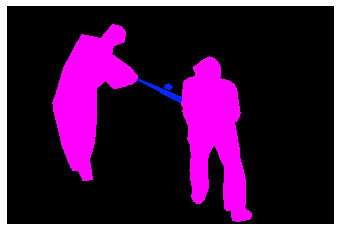

(426, 640, 3)
COCO_val2014_000000437465.jpg
{'person_bbx': [124.18, 126.82, 273.27, 335.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [64.72, 298.79, 379.69000000000005, 401.26]}}
cake
person
look
look interaction
{'person_bbx': [443.33, 157.48, 640.0, 385.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [124.18, 126.82, 273.27, 335.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [266.31, 57.02, 512.21, 350.16999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [443.33, 157.48, 640.0, 385.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [124.18, 126.82, 273.27, 335.66999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [266.31, 57.02, 512.21, 350.16999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


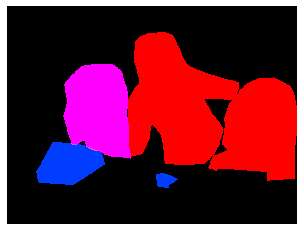

(480, 640, 3)
COCO_val2014_000000186711.jpg
{'person_bbx': [305.29, 93.05, 500.99, 409.38], 'Verbs': 'look', 'object': {'obj_bbx': [284.76, 370.62, 423.34000000000003, 426.87]}}
person
surfboard
look
look interaction
{'person_bbx': [305.29, 93.05, 500.99, 409.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [305.29, 93.05, 500.99, 409.38], 'Verbs': 'surf', 'object': {'obj_bbx': [284.76, 370.62, 423.34000000000003, 426.87]}}
person
surfboard
surf
surf interaction


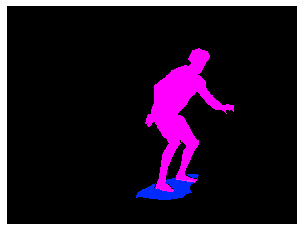

(480, 640, 3)
COCO_val2014_000000213247.jpg
{'person_bbx': [160.55, 21.5, 598.28, 600.57], 'Verbs': 'hold', 'object': {'obj_bbx': [171.99, 305.62, 249.13, 377.75]}}
person
cup
hold
hold interaction
{'person_bbx': [160.55, 21.5, 598.28, 600.57], 'Verbs': 'look', 'object': {'obj_bbx': [132.03, 432.68, 270.07, 542.13]}}
person
cake
look
look interaction
{'person_bbx': [160.55, 21.5, 598.28, 600.57], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [160.55, 21.5, 598.28, 600.57], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


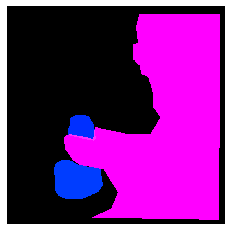

(612, 612, 3)
COCO_val2014_000000448535.jpg
{'person_bbx': [228.11, 67.57, 395.68, 350.81], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [237.03, 314.15, 367.18, 405.77]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [40.0, 21.08, 241.08, 384.32], 'Verbs': 'hold', 'object': {'obj_bbx': [59.19, 230.31, 247.53, 385.28999999999996]}}
chair
person
hold
hold interaction
{'person_bbx': [228.11, 67.57, 395.68, 350.81], 'Verbs': 'hold', 'object': {'obj_bbx': [237.03, 314.15, 367.18, 405.77]}}
person
cake
hold
hold interaction
{'person_bbx': [40.0, 21.08, 241.08, 384.32], 'Verbs': 'look', 'object': {'obj_bbx': [237.03, 314.15, 367.18, 405.77]}}
person
cake
look
look interaction
{'person_bbx': [228.11, 67.57, 395.68, 350.81], 'Verbs': 'look', 'object': {'obj_bbx': [237.03, 314.15, 367.18, 405.77]}}
person
cake
look
look interaction
{'person_bbx': [470.25, 35.49, 640.0, 467.81], 'Verbs': 'look', 'object': {'obj_bbx': [237.03, 314.15, 367.18, 405.77]}}
person
cake
look
look interaction
{'pe

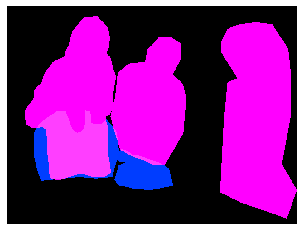

(480, 640, 3)
COCO_val2014_000000180984.jpg
{'person_bbx': [62.15, 198.78, 233.8, 413.83000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [25.96, 259.74, 62.35, 290.32]}}
person
frisbee
catch
catch interaction
{'person_bbx': [307.64, 182.98, 432.69, 421.84000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [62.15, 198.78, 233.8, 413.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [25.96, 259.74, 62.35, 290.32]}}
person
frisbee
look
look interaction
{'person_bbx': [307.64, 182.98, 432.69, 421.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [25.96, 259.74, 62.35, 290.32]}}
person
frisbee
look
look interaction
{'person_bbx': [62.15, 198.78, 233.8, 413.83000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [307.64, 182.98, 432.69, 421.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [307.64, 182.98, 432.69, 421.84000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': [

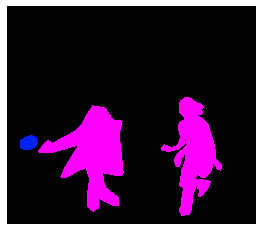

(438, 500, 3)
COCO_val2014_000000365068.jpg
{'person_bbx': [47.04, 157.39, 187.85, 474.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [47.04, 157.39, 187.85, 474.53999999999996], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [404.12, 150.69, 557.09, 492.02], 'Verbs': 'sit', 'object': {'obj_bbx': [173.0, 312.45, 610.81, 460.63]}}
person
bench
sit
sit interaction
{'person_bbx': [237.85, 155.37, 346.37, 475.58], 'Verbs': 'sit', 'object': {'obj_bbx': [173.0, 312.45, 610.81, 460.63]}}
person
bench
sit
sit interaction
{'person_bbx': [47.04, 157.39, 187.85, 474.53999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [173.0, 312.45, 610.81, 460.63]}}
bench
person
sit
sit interaction


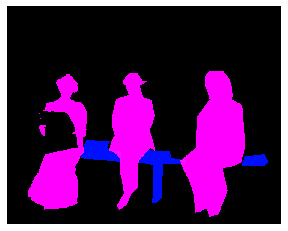

(508, 640, 3)
COCO_val2014_000000536028.jpg
{'person_bbx': [224.78, 238.61, 297.0, 334.31], 'Verbs': 'look', 'object': {'obj_bbx': [221.4, 328.64, 249.21, 352.32]}}
person
surfboard
look
look interaction
{'person_bbx': [224.78, 238.61, 297.0, 334.31], 'Verbs': 'surf', 'object': {'obj_bbx': [221.4, 328.64, 249.21, 352.32]}}
person
surfboard
surf
surf interaction


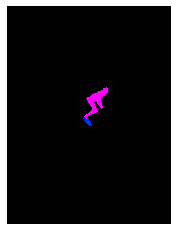

(640, 480, 3)
COCO_val2014_000000233919.jpg
{'person_bbx': [2.31, 53.19, 330.6, 374.99], 'Verbs': 'look', 'object': {'obj_bbx': [18.19, 0.0, 640.0, 424.09]}}
person
laptop
look
look interaction
{'person_bbx': [2.31, 53.19, 330.6, 374.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.31, 53.19, 330.6, 374.99], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [18.19, 0.0, 640.0, 424.09]}}
person
laptop
work_on_computer
work_on_computer interaction


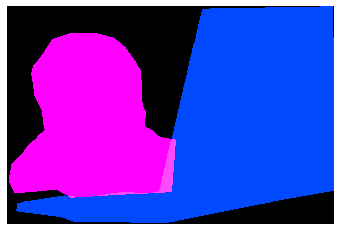

(426, 640, 3)
COCO_val2014_000000044743.jpg
{'person_bbx': [60.19, 23.36, 229.10999999999999, 229.17000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [115.43, 192.38, 189.71, 264.38]}}
person
skateboard
jump
jump interaction
{'person_bbx': [60.19, 23.36, 229.10999999999999, 229.17000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [115.43, 192.38, 189.71, 264.38]}}
person
skateboard
look
look interaction
{'person_bbx': [60.19, 23.36, 229.10999999999999, 229.17000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [115.43, 192.38, 189.71, 264.38]}}
person
skateboard
skateboard
skateboard interaction


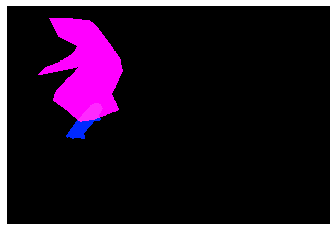

(432, 640, 3)
COCO_val2014_000000295303.jpg
{'person_bbx': [90.96, 128.85, 322.59, 400.40999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [62.81, 376.52, 321.67, 520.63]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [90.96, 128.85, 322.59, 400.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [90.96, 128.85, 322.59, 400.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 200.31, 371.06, 592.1]}}
chair
person
sit
sit interaction


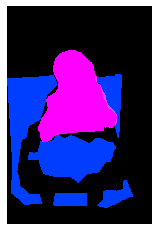

(640, 426, 3)
COCO_val2014_000000258382.jpg
{'person_bbx': [87.97, 72.94, 286.03999999999996, 598.47], 'Verbs': 'carry', 'object': {'obj_bbx': [109.98, 301.21, 244.07999999999998, 490.03999999999996]}}
person
suitcase
carry
carry interaction
{'person_bbx': [87.97, 72.94, 286.03999999999996, 598.47], 'Verbs': 'hold', 'object': {'obj_bbx': [121.36, 1.34, 445.51, 227.02]}}
person
umbrella
hold
hold interaction
{'person_bbx': [87.97, 72.94, 286.03999999999996, 598.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [87.97, 72.94, 286.03999999999996, 598.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


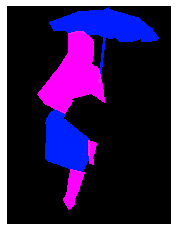

(640, 480, 3)
COCO_val2014_000000250309.jpg
{'person_bbx': [157.09, 210.47, 246.28, 510.30999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [211.72, 268.51, 275.37, 334.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [157.09, 210.47, 246.28, 510.30999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [211.72, 268.51, 275.37, 334.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [157.09, 210.47, 246.28, 510.30999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [157.09, 210.47, 246.28, 510.30999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


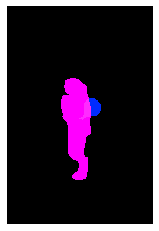

(640, 427, 3)
COCO_val2014_000000147681.jpg
{'person_bbx': [137.62, 36.31, 259.71000000000004, 186.97], 'Verbs': 'jump', 'object': {'obj_bbx': [148.08, 172.02, 214.66000000000003, 200.51000000000002]}}
person
skateboard
jump
jump interaction
{'person_bbx': [434.2, 22.09, 515.0699999999999, 183.43], 'Verbs': 'jump', 'object': {'obj_bbx': [428.03, 163.38, 511.47999999999996, 195.54]}}
person
skateboard
jump
jump interaction
{'person_bbx': [137.62, 36.31, 259.71000000000004, 186.97], 'Verbs': 'look', 'object': {'obj_bbx': [148.08, 172.02, 214.66000000000003, 200.51000000000002]}}
person
skateboard
look
look interaction
{'person_bbx': [434.2, 22.09, 515.0699999999999, 183.43], 'Verbs': 'look', 'object': {'obj_bbx': [428.03, 163.38, 511.47999999999996, 195.54]}}
person
skateboard
look
look interaction
{'person_bbx': [137.62, 36.31, 259.71000000000004, 186.97], 'Verbs': 'skateboard', 'object': {'obj_bbx': [148.08, 172.02, 214.66000000000003, 200.51000000000002]}}
person
skateboard
skateboard

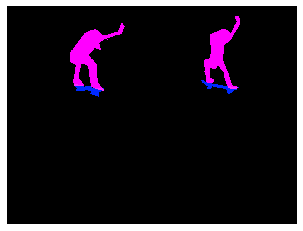

(481, 640, 3)
COCO_val2014_000000385154.jpg


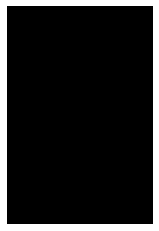

(640, 427, 3)
COCO_val2014_000000121154.jpg
{'person_bbx': [205.42, 216.74, 250.77999999999997, 271.42], 'Verbs': 'surf', 'object': {'obj_bbx': [221.77, 260.93, 273.31, 290.1]}}
person
surfboard
surf
surf interaction


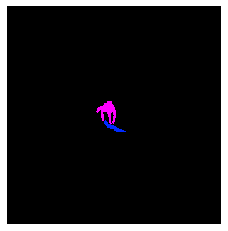

(500, 492, 3)
COCO_val2014_000000138644.jpg
{'person_bbx': [58.69, 64.62, 466.14, 472.07], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [191.7, 338.57, 323.99, 467.49]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [58.69, 64.62, 466.14, 472.07], 'Verbs': 'hold', 'object': {'obj_bbx': [191.7, 338.57, 323.99, 467.49]}}
person
banana
hold
hold interaction
{'person_bbx': [58.69, 64.62, 466.14, 472.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


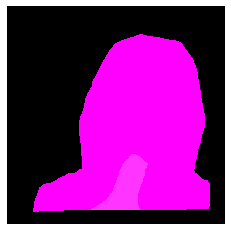

(500, 500, 3)
COCO_val2014_000000194063.jpg
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [289.98, 156.96, 316.65000000000003, 204.47]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [295.68, 158.3, 303.8, 167.54000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [289.98, 156.96, 316.65000000000003, 204.47]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [289.98, 156.96, 316.65000000000003, 204.47]}}
tennis racket
person
look
look interaction
{'person_bbx': [234.85, 116.49, 310.15, 239.58999999999997]

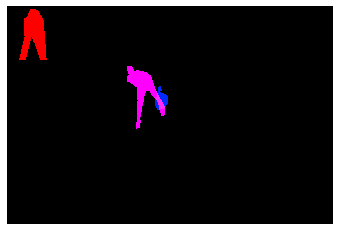

(427, 640, 3)
COCO_val2014_000000374342.jpg
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [368.36, 380.06, 390.04, 412.93]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [283.16, 137.82, 292.90000000000003, 148.39]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'hold', 'object': {'obj_bbx': [368.36, 380.06, 390.04, 412.93]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'look', 'object': {'obj_bbx': [283.16, 137.82, 292.90000000000003, 148.39]}}
sports ball
person
look
look interaction
{'person_bbx': [272.62, 309.26, 393.94, 536.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


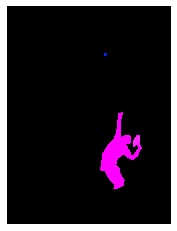

(640, 480, 3)
COCO_val2014_000000456558.jpg
{'person_bbx': [45.92, 119.96, 427.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [45.92, 119.96, 427.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


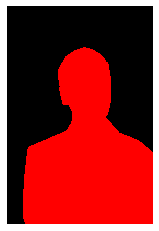

(640, 427, 3)
COCO_val2014_000000194755.jpg
{'person_bbx': [4.03, 24.74, 501.67999999999995, 491.91], 'Verbs': 'drink', 'object': {'obj_bbx': [203.62, 272.07, 344.98, 367.09]}}
person
cup
drink
drink interaction
{'person_bbx': [4.03, 24.74, 501.67999999999995, 491.91], 'Verbs': 'hold', 'object': {'obj_bbx': [203.62, 272.07, 344.98, 367.09]}}
person
cup
hold
hold interaction
{'person_bbx': [4.03, 24.74, 501.67999999999995, 491.91], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


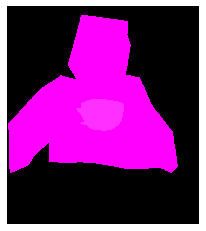

(640, 564, 3)
COCO_val2014_000000172088.jpg
{'person_bbx': [280.6, 106.65, 464.16, 445.52], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [189.87, 95.9, 286.35, 150.76]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [280.6, 106.65, 464.16, 445.52], 'Verbs': 'hold', 'object': {'obj_bbx': [189.87, 95.9, 286.35, 150.76]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [280.6, 106.65, 464.16, 445.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [280.6, 106.65, 464.16, 445.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


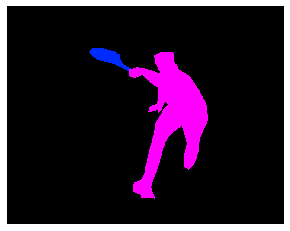

(504, 640, 3)
COCO_val2014_000000003488.jpg
{'person_bbx': [196.56, 81.28, 343.06, 288.05], 'Verbs': 'kick', 'object': {'obj_bbx': [220.16, 262.66, 247.88, 289.73]}}
sports ball
person
kick
kick interaction
{'person_bbx': [196.56, 81.28, 343.06, 288.05], 'Verbs': 'look', 'object': {'obj_bbx': [220.16, 262.66, 247.88, 289.73]}}
sports ball
person
look
look interaction
{'person_bbx': [196.56, 81.28, 343.06, 288.05], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [196.56, 81.28, 343.06, 288.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


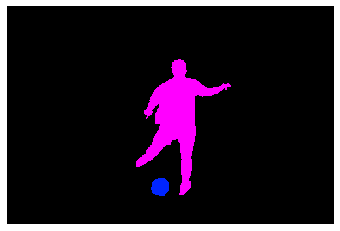

(333, 500, 3)
COCO_val2014_000000559842.jpg
{'person_bbx': [332.88, 185.89, 414.38, 352.61], 'Verbs': 'kick', 'object': {'obj_bbx': [292.81, 326.08, 328.24, 361.28999999999996]}}
sports ball
person
kick
kick interaction
{'person_bbx': [551.74, 97.87, 622.75, 320.49], 'Verbs': 'look', 'object': {'obj_bbx': [292.81, 326.08, 328.24, 361.28999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [467.97, 123.17, 543.87, 319.34], 'Verbs': 'look', 'object': {'obj_bbx': [292.81, 326.08, 328.24, 361.28999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [332.88, 185.89, 414.38, 352.61], 'Verbs': 'look', 'object': {'obj_bbx': [292.81, 326.08, 328.24, 361.28999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [169.74, 184.86, 276.35, 337.42], 'Verbs': 'look', 'object': {'obj_bbx': [292.81, 326.08, 328.24, 361.28999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [294.09, 176.6, 346.73999999999995, 333.25], 'Verbs': 'look', 

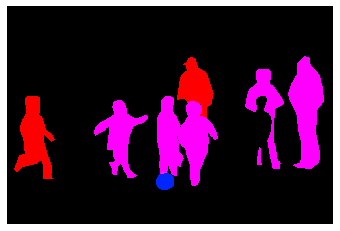

(427, 640, 3)
COCO_val2014_000000042413.jpg
{'person_bbx': [48.56, 99.2, 346.87, 433.19], 'Verbs': 'hold', 'object': {'obj_bbx': [257.42, 170.61, 508.85, 438.01]}}
person
person
hold
hold interaction
{'person_bbx': [48.56, 99.2, 346.87, 433.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [257.42, 170.61, 508.85, 438.01], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [257.42, 170.61, 508.85, 438.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


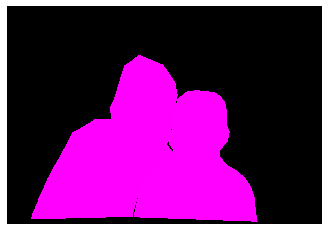

(443, 640, 3)
COCO_val2014_000000041875.jpg
{'person_bbx': [1.41, 33.76, 407.91, 634.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [182.0, 302.0, 309.0, 367.0]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [1.41, 33.76, 407.91, 634.37], 'Verbs': 'hold', 'object': {'obj_bbx': [182.0, 302.0, 309.0, 367.0]}}
person
pizza
hold
hold interaction
{'person_bbx': [1.41, 33.76, 407.91, 634.37], 'Verbs': 'sit', 'object': {'obj_bbx': [395.0, 314.48, 504.0, 464.23]}}
person
chair
sit
sit interaction


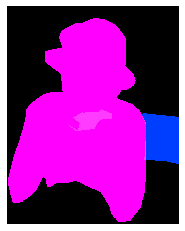

(640, 504, 3)
COCO_val2014_000000012744.jpg
{'person_bbx': [240.89, 199.49, 280.93, 263.94], 'Verbs': 'hold', 'object': {'obj_bbx': [230.13, 204.1, 369.1, 358.38]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [235.04, 189.42, 263.90999999999997, 314.85], 'Verbs': 'hold', 'object': {'obj_bbx': [240.89, 199.49, 280.93, 263.94]}}
person
person
hold
hold interaction
{'person_bbx': [451.15, 195.63, 521.11, 298.92], 'Verbs': 'hold', 'object': {'obj_bbx': [437.74, 240.27, 564.51, 317.20000000000005]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [240.89, 199.49, 280.93, 263.94], 'Verbs': 'ride', 'object': {'obj_bbx': [230.13, 204.1, 369.1, 358.38]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [235.04, 189.42, 263.90999999999997, 314.85], 'Verbs': 'ride', 'object': {'obj_bbx': [230.13, 204.1, 369.1, 358.38]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [451.15, 195.63, 521.11, 298.92], 'Verbs': 'ride', 'object': {'obj_bbx': [437.74, 240.27, 564.51, 31

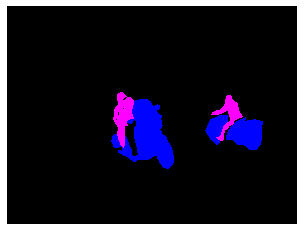

(480, 640, 3)
COCO_val2014_000000392382.jpg
{'person_bbx': [143.82, 1.44, 372.49, 524.94], 'Verbs': 'look', 'object': {'obj_bbx': [118.12, 460.45, 392.41, 578.0]}}
person
skateboard
look
look interaction
{'person_bbx': [0.0, 1.77, 140.53, 467.5], 'Verbs': 'look', 'object': {'obj_bbx': [143.82, 1.44, 372.49, 524.94]}}
person
person
look
look interaction
{'person_bbx': [143.82, 1.44, 372.49, 524.94], 'Verbs': 'skateboard', 'object': {'obj_bbx': [118.12, 460.45, 392.41, 578.0]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [0.0, 1.77, 140.53, 467.5], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [143.82, 1.44, 372.49, 524.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [143.82, 1.44, 372.49, 524.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 1.77, 140.53, 467.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


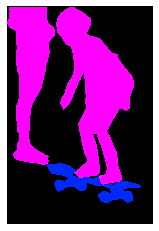

(640, 427, 3)
COCO_val2014_000000510254.jpg
{'person_bbx': [85.58, 154.62, 395.59, 430.85], 'Verbs': 'sit', 'object': {'obj_bbx': [19.74, 236.63, 619.63, 615.75]}}
bed
person
sit
sit interaction
{'person_bbx': [85.58, 154.62, 395.59, 430.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


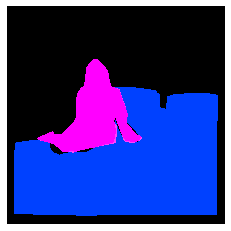

(640, 640, 3)
COCO_val2014_000000541017.jpg
{'person_bbx': [40.81, 7.62, 420.94, 264.26], 'Verbs': 'jump', 'object': {'obj_bbx': [110.7, 215.98, 407.77, 338.29999999999995]}}
person
skateboard
jump
jump interaction
{'person_bbx': [40.81, 7.62, 420.94, 264.26], 'Verbs': 'skateboard', 'object': {'obj_bbx': [110.7, 215.98, 407.77, 338.29999999999995]}}
person
skateboard
skateboard
skateboard interaction


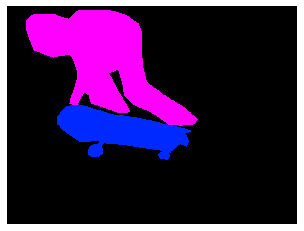

(480, 640, 3)
COCO_val2014_000000137888.jpg
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'hold', 'object': {'obj_bbx': [12.72, 62.11, 303.82000000000005, 264.16]}}
person
laptop
hold
hold interaction
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'look', 'object': {'obj_bbx': [12.72, 62.11, 303.82000000000005, 264.16]}}
person
laptop
look
look interaction
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'sit', 'object': {'obj_bbx': [239.13, 106.67, 500.0, 333.0]}}
person
chair
sit
sit interaction
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [127.5, 17.63, 468.75, 329.63], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [12.72, 62.11, 303.82000000000005, 264.16]}}
person
laptop
work_on_computer
work_on_computer interaction


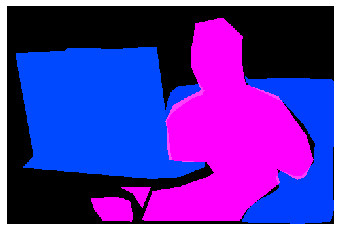

(333, 500, 3)
COCO_val2014_000000137315.jpg
{'person_bbx': [1.63, 0.0, 213.06, 306.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.63, 0.0, 213.06, 306.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


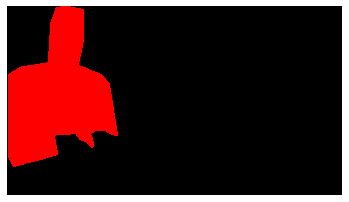

(360, 640, 3)
COCO_val2014_000000430961.jpg
{'person_bbx': [39.43, 0.72, 380.65000000000003, 314.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [114.19, 67.02, 125.95, 80.02]}}
sports ball
person
hold
hold interaction
{'person_bbx': [39.43, 0.72, 380.65000000000003, 314.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [39.43, 0.72, 380.65000000000003, 314.70000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [114.19, 67.02, 125.95, 80.02]}}
sports ball
person
throw
throw interaction


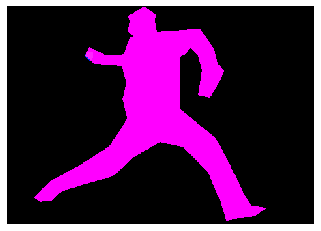

(319, 450, 3)
COCO_val2014_000000248953.jpg
{'person_bbx': [277.03, 104.31, 413.84999999999997, 247.04], 'Verbs': 'look', 'object': {'obj_bbx': [238.36, 231.82, 390.75, 254.17]}}
person
snowboard
look
look interaction
{'person_bbx': [277.03, 104.31, 413.84999999999997, 247.04], 'Verbs': 'snowboard', 'object': {'obj_bbx': [238.36, 231.82, 390.75, 254.17]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [277.03, 104.31, 413.84999999999997, 247.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


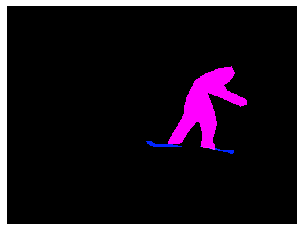

(375, 500, 3)
COCO_val2014_000000373034.jpg
{'person_bbx': [90.61, 51.78, 405.57, 474.61], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 40.9, 607.0, 474.62]}}
bed
person
lay
lay interaction
{'person_bbx': [90.61, 51.78, 405.57, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


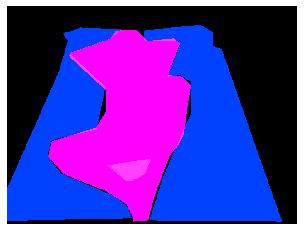

(480, 640, 3)
COCO_val2014_000000572296.jpg
{'person_bbx': [18.25, 55.54, 235.44, 422.05], 'Verbs': 'hold', 'object': {'obj_bbx': [212.16, 390.46, 243.29, 421.59]}}
person
remote
hold
hold interaction
{'person_bbx': [18.25, 55.54, 235.44, 422.05], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [18.25, 55.54, 235.44, 422.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


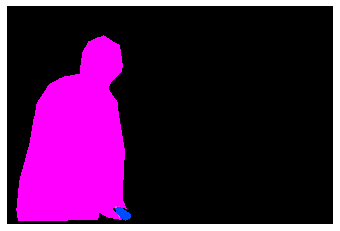

(427, 640, 3)
COCO_val2014_000000008803.jpg
{'person_bbx': [441.08, 112.97, 567.5699999999999, 442.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [441.08, 112.97, 567.5699999999999, 442.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [441.08, 112.97, 567.5699999999999, 442.70000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


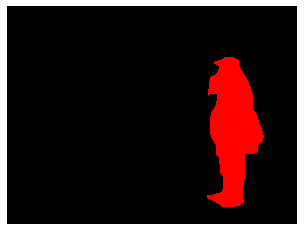

(480, 640, 3)
COCO_val2014_000000175611.jpg
{'person_bbx': [0.23, 164.05, 400.08000000000004, 426.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [221.96, 177.29, 384.98, 424.53999999999996]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [0.23, 164.05, 400.08000000000004, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [221.96, 177.29, 384.98, 424.53999999999996]}}
person
scissors
hold
hold interaction


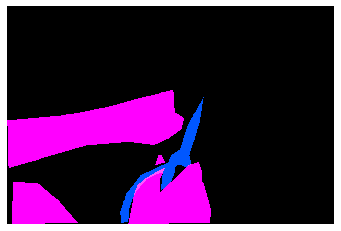

(426, 640, 3)
COCO_val2014_000000437262.jpg
{'person_bbx': [79.82, 250.25, 152.08999999999997, 409.89], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [334.38, 249.17, 415.28, 456.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [79.82, 250.25, 152.08999999999997, 409.89], 'Verbs': 'ski', 'object': {'obj_bbx': [21.18, 205.92, 159.24, 317.65]}}
person
skis
ski
ski interaction
{'person_bbx': [79.82, 250.25, 152.08999999999997, 409.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [334.38, 249.17, 415.28, 456.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [79.82, 250.25, 152.08999999999997, 409.89], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [334.38, 249.17, 415.28, 456.27], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


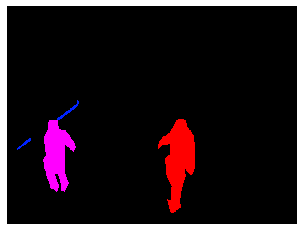

(480, 640, 3)
COCO_val2014_000000434580.jpg
{'person_bbx': [47.35, 65.65, 638.21, 400.36], 'Verbs': 'hold', 'object': {'obj_bbx': [293.81, 135.61, 474.62, 326.1]}}
person
laptop
hold
hold interaction
{'person_bbx': [47.35, 65.65, 638.21, 400.36], 'Verbs': 'look', 'object': {'obj_bbx': [293.81, 135.61, 474.62, 326.1]}}
person
laptop
look
look interaction
{'person_bbx': [47.35, 65.65, 638.21, 400.36], 'Verbs': 'sit', 'object': {'obj_bbx': [1.15, 10.28, 640.0, 472.08]}}
couch
person
sit
sit interaction
{'person_bbx': [47.35, 65.65, 638.21, 400.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [47.35, 65.65, 638.21, 400.36], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [293.81, 135.61, 474.62, 326.1]}}
person
laptop
work_on_computer
work_on_computer interaction


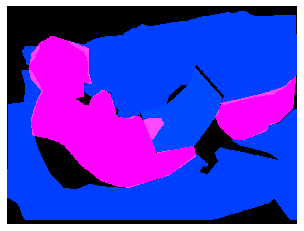

(480, 640, 3)
COCO_val2014_000000528462.jpg
{'person_bbx': [170.29, 67.06, 344.12, 341.47], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [336.59, 141.35, 390.59999999999997, 217.14]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [170.29, 67.06, 344.12, 341.47], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [433.22, 142.63, 451.42, 160.82]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [170.29, 67.06, 344.12, 341.47], 'Verbs': 'hold', 'object': {'obj_bbx': [336.59, 141.35, 390.59999999999997, 217.14]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [170.29, 67.06, 344.12, 341.47], 'Verbs': 'look', 'object': {'obj_bbx': [433.22, 142.63, 451.42, 160.82]}}
sports ball
person
look
look interaction
{'person_bbx': [170.29, 67.06, 344.12, 341.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


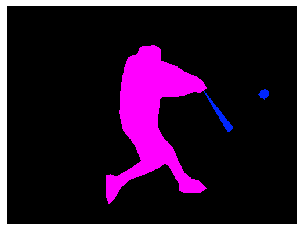

(375, 500, 3)
COCO_val2014_000000546229.jpg
{'person_bbx': [341.93, 128.36, 439.01, 436.85], 'Verbs': 'drink', 'object': {'obj_bbx': []}}
person
drink
{'person_bbx': [341.93, 128.36, 439.01, 436.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [74.43, 108.94, 225.44, 462.74], 'Verbs': 'hold', 'object': {'obj_bbx': [197.35, 296.66, 253.37, 459.63]}}
skateboard
person
hold
hold interaction
{'person_bbx': [528.81, 134.73, 640.0, 426.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [597.12, 291.8, 633.9, 425.06]}}
skateboard
person
hold
hold interaction
{'person_bbx': [74.43, 108.94, 225.44, 462.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [341.93, 128.36, 439.01, 436.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [229.24, 73.29, 377.76, 454.28000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.43, 108.94, 225.44, 462.74], 'Verbs': 'stand', 'object': {'o

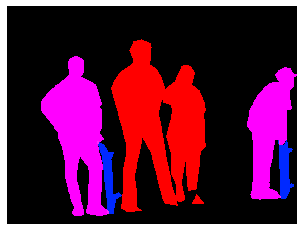

(480, 640, 3)
COCO_val2014_000000121961.jpg
{'person_bbx': [255.84, 139.78, 321.62, 214.85], 'Verbs': 'look', 'object': {'obj_bbx': [304.1, 206.66, 346.26, 222.6]}}
person
surfboard
look
look interaction
{'person_bbx': [255.84, 139.78, 321.62, 214.85], 'Verbs': 'surf', 'object': {'obj_bbx': [304.1, 206.66, 346.26, 222.6]}}
person
surfboard
surf
surf interaction


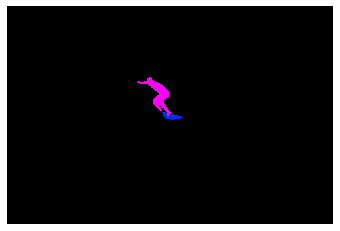

(427, 640, 3)
COCO_val2014_000000396997.jpg
{'person_bbx': [342.53, 88.53, 514.23, 384.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [412.77, 91.49, 423.38, 181.01999999999998]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [342.53, 88.53, 514.23, 384.58000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [110.71, 209.33, 255.32, 370.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [342.53, 88.53, 514.23, 384.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


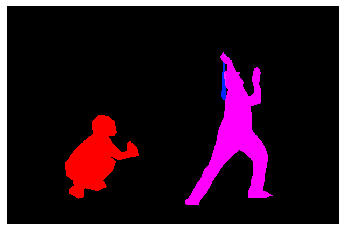

(420, 640, 3)
COCO_val2014_000000106575.jpg
{'person_bbx': [160.61, 24.52, 516.44, 422.66999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [160.61, 24.52, 516.44, 422.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


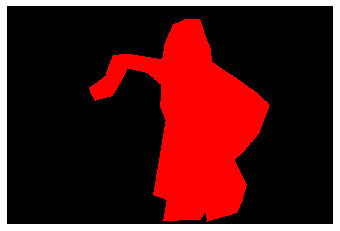

(427, 640, 3)
COCO_val2014_000000143103.jpg
{'person_bbx': [433.91, 1.12, 620.52, 251.8], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [433.91, 1.12, 620.52, 251.8], 'Verbs': 'ski', 'object': {'obj_bbx': [379.48, 222.78, 639.25, 299.58]}}
skis
person
ski
ski interaction
{'person_bbx': [204.94, 135.91, 332.22, 416.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [433.91, 1.12, 620.52, 251.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


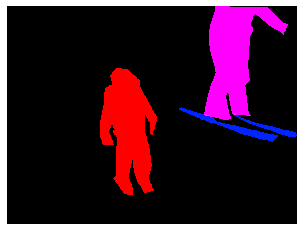

(480, 640, 3)
COCO_val2014_000000054277.jpg
{'person_bbx': [375.61, 176.63, 512.29, 428.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


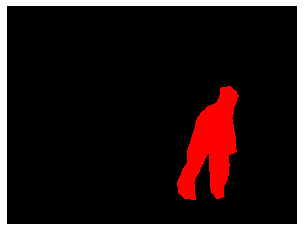

(480, 640, 3)
COCO_val2014_000000561810.jpg
{'person_bbx': [279.1, 70.25, 488.42, 277.66999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [244.64, 48.43, 325.96, 88.75999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [279.1, 70.25, 488.42, 277.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [244.64, 48.43, 325.96, 88.75999999999999]}}
person
frisbee
hold
hold interaction
{'person_bbx': [279.1, 70.25, 488.42, 277.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [244.64, 48.43, 325.96, 88.75999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [279.1, 70.25, 488.42, 277.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


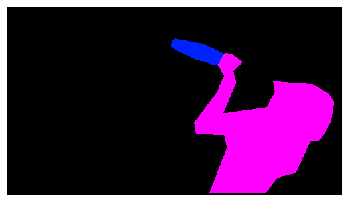

(281, 500, 3)
COCO_val2014_000000008594.jpg
{'person_bbx': [254.05, 61.01, 513.75, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [186.61, 265.17, 405.57000000000005, 388.13]}}
book
person
hold
hold interaction
{'person_bbx': [254.05, 61.01, 513.75, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [186.61, 265.17, 405.57000000000005, 388.13]}}
book
person
look
look interaction
{'person_bbx': [254.05, 61.01, 513.75, 480.0], 'Verbs': 'read', 'object': {'obj_bbx': [186.61, 265.17, 405.57000000000005, 388.13]}}
book
person
read
read interaction
{'person_bbx': [254.05, 61.01, 513.75, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


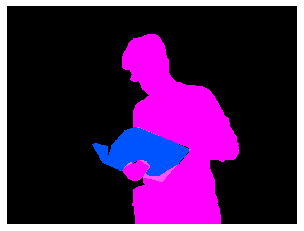

(480, 640, 3)
COCO_val2014_000000276893.jpg
{'person_bbx': [211.42, 208.18, 527.46, 454.11], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 39.29, 550.43, 480.0]}}
bed
person
lay
lay interaction


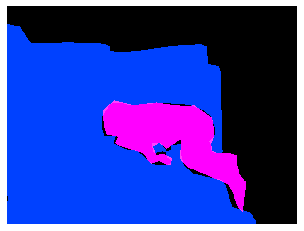

(480, 640, 3)
COCO_val2014_000000060102.jpg
{'person_bbx': [194.97, 0.56, 631.82, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': [38.66, 18.6, 148.99, 130.55]}}
sports ball
person
look
look interaction
{'person_bbx': [194.97, 0.56, 631.82, 360.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 105.41, 305.68, 355.95], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [194.97, 0.56, 631.82, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


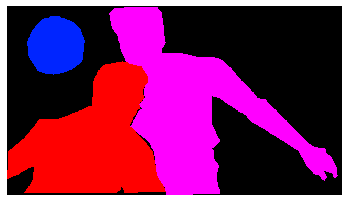

(360, 640, 3)
COCO_val2014_000000095297.jpg
{'person_bbx': [2.16, 22.72, 606.1999999999999, 473.6], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [235.71, 247.71, 640.0, 319.5]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [2.16, 22.72, 606.1999999999999, 473.6], 'Verbs': 'hold', 'object': {'obj_bbx': [235.71, 247.71, 640.0, 319.5]}}
person
pizza
hold
hold interaction


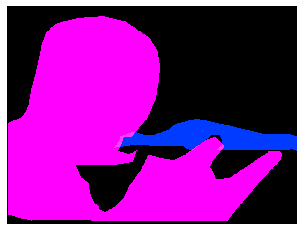

(480, 640, 3)
COCO_val2014_000000171880.jpg
{'person_bbx': [86.77, 0.0, 372.32, 425.79], 'Verbs': 'hold', 'object': {'obj_bbx': [367.76, 0.0, 537.54, 151.98]}}
person
frisbee
hold
hold interaction
{'person_bbx': [86.77, 0.0, 372.32, 425.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.77, 0.0, 372.32, 425.79], 'Verbs': 'throw', 'object': {'obj_bbx': [367.76, 0.0, 537.54, 151.98]}}
person
frisbee
throw
throw interaction


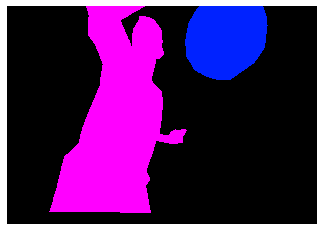

(449, 640, 3)
COCO_val2014_000000308576.jpg
{'person_bbx': [216.26, 223.75, 354.7, 327.01], 'Verbs': 'lay', 'object': {'obj_bbx': [18.54, 111.31, 493.44, 333.0]}}
couch
person
lay
lay interaction


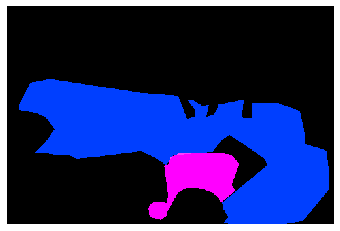

(333, 500, 3)
COCO_val2014_000000140785.jpg
{'person_bbx': [246.12, 145.89, 349.12, 280.37], 'Verbs': 'surf', 'object': {'obj_bbx': [292.96, 270.31, 365.36, 289.23]}}
surfboard
person
surf
surf interaction


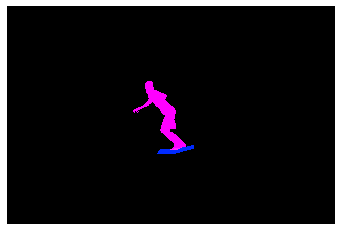

(425, 640, 3)
COCO_val2014_000000578788.jpg
{'person_bbx': [234.22, 72.64, 373.40999999999997, 231.27999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [222.76, 199.51, 295.37, 238.20999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [234.22, 72.64, 373.40999999999997, 231.27999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [222.76, 199.51, 295.37, 238.20999999999998]}}
person
skateboard
look
look interaction
{'person_bbx': [234.22, 72.64, 373.40999999999997, 231.27999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [222.76, 199.51, 295.37, 238.20999999999998]}}
person
skateboard
skateboard
skateboard interaction


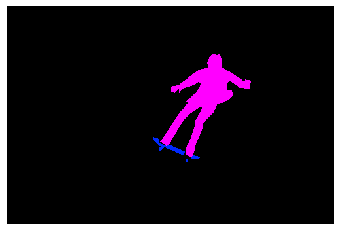

(333, 500, 3)
COCO_val2014_000000129784.jpg
{'person_bbx': [98.03, 150.26, 285.27, 312.78], 'Verbs': 'look', 'object': {'obj_bbx': [221.78, 220.78, 350.2, 298.49]}}
person
laptop
look
look interaction
{'person_bbx': [98.03, 150.26, 285.27, 312.78], 'Verbs': 'sit', 'object': {'obj_bbx': [79.64, 254.28, 111.31, 320.49]}}
chair
person
sit
sit interaction
{'person_bbx': [98.03, 150.26, 285.27, 312.78], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [221.78, 220.78, 350.2, 298.49]}}
person
laptop
work_on_computer
work_on_computer interaction


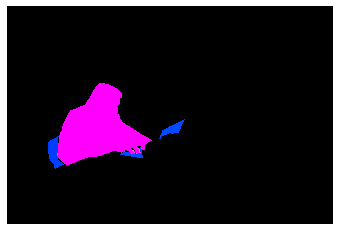

(427, 640, 3)
COCO_val2014_000000200717.jpg
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'catch', 'object': {'obj_bbx': [239.7, 227.17, 270.08, 265.84]}}
person
frisbee
catch
catch interaction
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'hold', 'object': {'obj_bbx': [239.7, 227.17, 270.08, 265.84]}}
person
frisbee
hold
hold interaction
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [244.22, 97.58, 430.72, 348.98], 'Verbs': 'throw', 'object': {'obj_bbx': [239.7, 227.17, 270.08, 265.84]}}
person
frisbee
throw
throw interaction


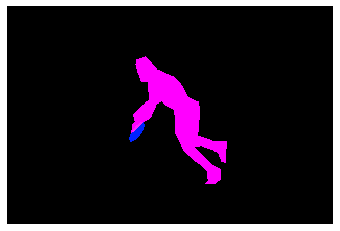

(427, 640, 3)
COCO_val2014_000000504516.jpg
{'person_bbx': [370.39, 2.88, 637.14, 351.2], 'Verbs': 'hold', 'object': {'obj_bbx': [457.34, 87.61, 483.69, 132.39]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 0.0, 156.66, 346.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [370.39, 2.88, 637.14, 351.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.0, 156.66, 346.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


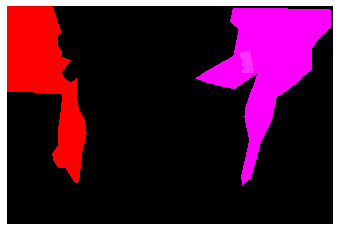

(427, 640, 3)
COCO_val2014_000000327532.jpg
{'person_bbx': [142.97, 206.94, 213.99, 267.32], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [126.62, 235.88, 149.33, 250.9]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [142.97, 206.94, 213.99, 267.32], 'Verbs': 'hold', 'object': {'obj_bbx': [126.62, 235.88, 149.33, 250.9]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [535.25, 150.85, 592.6, 251.31], 'Verbs': 'hold', 'object': {'obj_bbx': [587.29, 152.88, 611.55, 175.24]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [535.25, 150.85, 592.6, 251.31], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [535.25, 150.85, 592.6, 251.31], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [535.25, 150.85, 592.6, 251.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


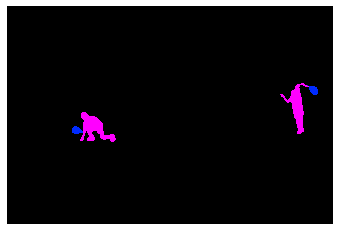

(427, 640, 3)
COCO_val2014_000000375021.jpg
{'person_bbx': [166.11, 100.13, 394.79, 431.28], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [381.04, 66.46, 476.35, 160.36]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [166.11, 100.13, 394.79, 431.28], 'Verbs': 'hold', 'object': {'obj_bbx': [381.04, 66.46, 476.35, 160.36]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [166.11, 100.13, 394.79, 431.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [166.11, 100.13, 394.79, 431.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


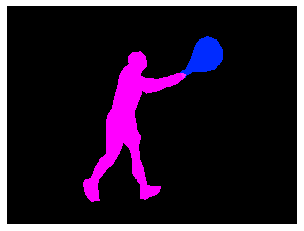

(480, 640, 3)
COCO_val2014_000000526126.jpg
{'person_bbx': [57.56, 114.84, 258.47, 357.51], 'Verbs': 'jump', 'object': {'obj_bbx': [72.47, 357.16, 223.94, 448.28000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [57.56, 114.84, 258.47, 357.51], 'Verbs': 'look', 'object': {'obj_bbx': [72.47, 357.16, 223.94, 448.28000000000003]}}
person
skateboard
look
look interaction
{'person_bbx': [57.56, 114.84, 258.47, 357.51], 'Verbs': 'skateboard', 'object': {'obj_bbx': [72.47, 357.16, 223.94, 448.28000000000003]}}
person
skateboard
skateboard
skateboard interaction


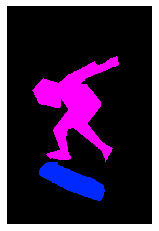

(500, 333, 3)
COCO_val2014_000000005124.jpg
{'person_bbx': [196.97, 219.52, 554.91, 584.63], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [196.97, 219.52, 554.91, 584.63], 'Verbs': 'look', 'object': {'obj_bbx': [177.23, 88.63, 231.27999999999997, 143.26]}}
sports ball
person
look
look interaction
{'person_bbx': [196.97, 219.52, 554.91, 584.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [196.97, 219.52, 554.91, 584.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


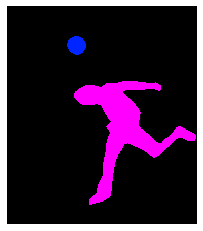

(640, 558, 3)
COCO_val2014_000000551987.jpg
{'person_bbx': [5.41, 90.72, 283.47, 630.39], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [152.32, 205.33, 180.04999999999998, 247.63]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [223.98, 247.6, 452.82, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [352.68, 364.7, 384.08, 478.21999999999997]}}
carrot
person
eat_obj
eat_obj interaction
{'person_bbx': [5.41, 90.72, 283.47, 630.39], 'Verbs': 'hold', 'object': {'obj_bbx': [152.32, 205.33, 180.04999999999998, 247.63]}}
person
carrot
hold
hold interaction
{'person_bbx': [223.98, 247.6, 452.82, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [352.68, 364.7, 384.08, 478.21999999999997]}}
carrot
person
hold
hold interaction
{'person_bbx': [223.98, 247.6, 452.82, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [381.98, 338.02, 480.0, 633.51]}}
bed
person
sit
sit interaction
{'person_bbx': [5.41, 90.72, 283.47, 630.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


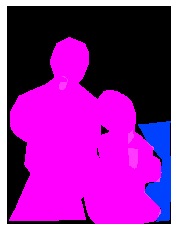

(640, 480, 3)
COCO_val2014_000000334625.jpg
{'person_bbx': [25.96, 74.77, 375.0, 492.38], 'Verbs': 'lay', 'object': {'obj_bbx': [1.12, 111.52, 375.0, 495.78999999999996]}}
bed
person
lay
lay interaction


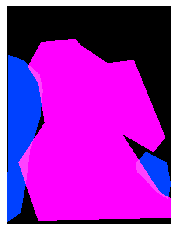

(500, 375, 3)
COCO_val2014_000000528962.jpg
{'person_bbx': [369.94, 98.6, 439.89, 306.74], 'Verbs': 'hold', 'object': {'obj_bbx': [381.45, 188.2, 431.76, 319.41999999999996]}}
bicycle
person
hold
hold interaction
{'person_bbx': [369.94, 98.6, 439.89, 306.74], 'Verbs': 'ride', 'object': {'obj_bbx': [381.45, 188.2, 431.76, 319.41999999999996]}}
bicycle
person
ride
ride interaction
{'person_bbx': [369.94, 98.6, 439.89, 306.74], 'Verbs': 'sit', 'object': {'obj_bbx': [381.45, 188.2, 431.76, 319.41999999999996]}}
bicycle
person
sit
sit interaction


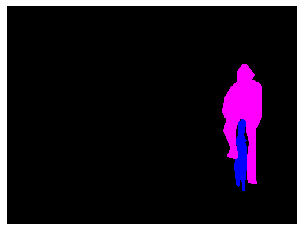

(375, 500, 3)
COCO_val2014_000000519088.jpg
{'person_bbx': [51.95, 221.72, 116.01, 358.51], 'Verbs': 'look', 'object': {'obj_bbx': [7.79, 51.16, 399.99, 346.39]}}
truck
person
look
look interaction
{'person_bbx': [51.95, 221.72, 116.01, 358.51], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


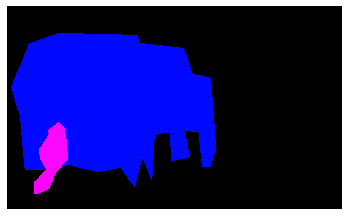

(387, 640, 3)
COCO_val2014_000000506707.jpg
{'person_bbx': [470.18, 110.35, 594.92, 365.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [280.63, 83.87, 360.92, 371.89]}}
person
person
look
look interaction
{'person_bbx': [470.18, 110.35, 594.92, 365.59000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [470.18, 110.35, 594.92, 365.59000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [280.63, 83.87, 360.92, 371.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [27.89, 110.12, 137.51999999999998, 377.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [27.89, 110.12, 137.51999999999998, 377.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


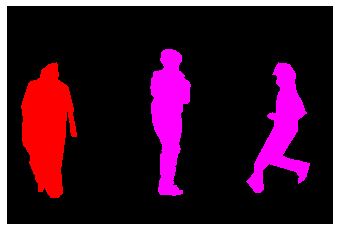

(427, 640, 3)
COCO_val2014_000000434657.jpg
{'person_bbx': [261.74, 32.86, 426.74, 283.84], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [261.74, 32.86, 426.74, 283.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [261.74, 32.86, 426.74, 283.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.74, 32.86, 426.74, 283.84], 'Verbs': 'surf', 'object': {'obj_bbx': [126.83, 274.48, 290.51, 312.23]}}
surfboard
person
surf
surf interaction


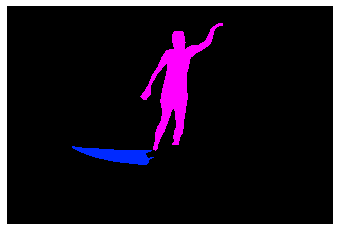

(427, 640, 3)
COCO_val2014_000000430125.jpg
{'person_bbx': [216.24, 166.37, 426.94, 360.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [341.13, 253.18, 421.06, 277.48]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [216.24, 166.37, 426.94, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [341.13, 253.18, 421.06, 277.48]}}
pizza
person
hold
hold interaction
{'person_bbx': [216.24, 166.37, 426.94, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


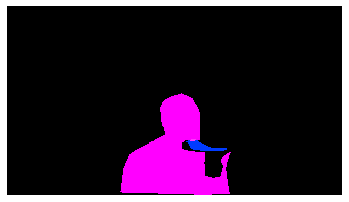

(360, 640, 3)
COCO_val2014_000000339676.jpg
{'person_bbx': [233.04, 84.7, 328.35, 182.75], 'Verbs': 'jump', 'object': {'obj_bbx': [273.29, 160.98, 366.65000000000003, 190.23]}}
person
surfboard
jump
jump interaction
{'person_bbx': [233.04, 84.7, 328.35, 182.75], 'Verbs': 'look', 'object': {'obj_bbx': [273.29, 160.98, 366.65000000000003, 190.23]}}
person
surfboard
look
look interaction
{'person_bbx': [233.04, 84.7, 328.35, 182.75], 'Verbs': 'surf', 'object': {'obj_bbx': [273.29, 160.98, 366.65000000000003, 190.23]}}
person
surfboard
surf
surf interaction


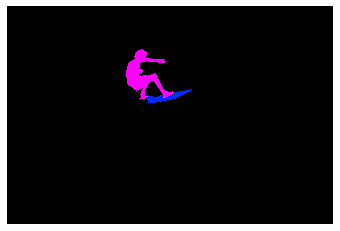

(427, 640, 3)
COCO_val2014_000000082715.jpg
{'person_bbx': [170.55, 118.96, 306.87, 206.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [170.55, 118.96, 306.87, 206.82], 'Verbs': 'surf', 'object': {'obj_bbx': [218.93, 71.45, 332.66, 198.61]}}
person
surfboard
surf
surf interaction


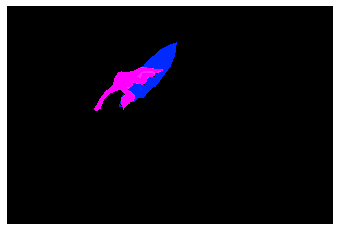

(427, 640, 3)
COCO_val2014_000000231379.jpg
{'person_bbx': [179.3, 177.33, 375.18, 271.48], 'Verbs': 'hold', 'object': {'obj_bbx': [247.6, 177.43, 277.55, 208.07]}}
person
book
hold
hold interaction
{'person_bbx': [179.3, 177.33, 375.18, 271.48], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [179.3, 177.33, 375.18, 271.48], 'Verbs': 'look', 'object': {'obj_bbx': [247.6, 177.43, 277.55, 208.07]}}
person
book
look
look interaction
{'person_bbx': [440.88, 137.14, 533.09, 375.83], 'Verbs': 'look', 'object': {'obj_bbx': [515.23, 112.47, 635.72, 368.52]}}
person
person
look
look interaction
{'person_bbx': [515.23, 112.47, 635.72, 368.52], 'Verbs': 'look', 'object': {'obj_bbx': [440.88, 137.14, 533.09, 375.83]}}
person
person
look
look interaction
{'person_bbx': [179.3, 177.33, 375.18, 271.48], 'Verbs': 'read', 'object': {'obj_bbx': [247.6, 177.43, 277.55, 208.07]}}
person
book
read
read interaction
{'person_bbx': [515.23, 112.47, 635.72, 368.52], 'Verbs': 'sit', 'objec

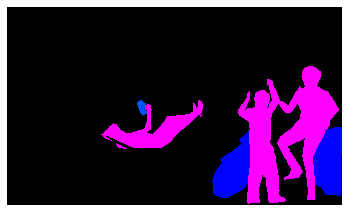

(378, 640, 3)
COCO_val2014_000000546664.jpg
{'person_bbx': [151.19, 277.11, 294.51, 462.97], 'Verbs': 'look', 'object': {'obj_bbx': [88.81, 428.66, 260.28999999999996, 481.96000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [151.19, 277.11, 294.51, 462.97], 'Verbs': 'surf', 'object': {'obj_bbx': [88.81, 428.66, 260.28999999999996, 481.96000000000004]}}
person
surfboard
surf
surf interaction


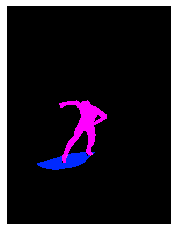

(640, 480, 3)
COCO_val2014_000000260238.jpg
{'person_bbx': [282.18, 131.31, 444.93, 391.15], 'Verbs': 'hold', 'object': {'obj_bbx': [144.14, 218.52, 560.4300000000001, 448.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [282.18, 131.31, 444.93, 391.15], 'Verbs': 'ride', 'object': {'obj_bbx': [144.14, 218.52, 560.4300000000001, 448.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [400.4, 115.06, 521.1999999999999, 375.08], 'Verbs': 'ride', 'object': {'obj_bbx': [144.14, 218.52, 560.4300000000001, 448.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [282.18, 131.31, 444.93, 391.15], 'Verbs': 'sit', 'object': {'obj_bbx': [144.14, 218.52, 560.4300000000001, 448.0]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [400.4, 115.06, 521.1999999999999, 375.08], 'Verbs': 'sit', 'object': {'obj_bbx': [144.14, 218.52, 560.4300000000001, 448.0]}}
motorcycle
person
sit
sit interaction


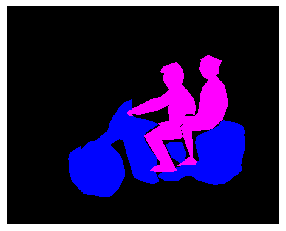

(512, 640, 3)
COCO_val2014_000000238228.jpg
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [393.7, 199.67, 570.81, 253.82]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [74.86, 172.53, 82.67, 179.4]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'hold', 'object': {'obj_bbx': [393.7, 199.67, 570.81, 253.82]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [163.57, 13.54, 404.98, 421.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


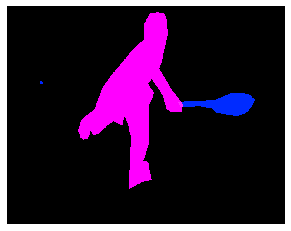

(502, 640, 3)
COCO_val2014_000000414289.jpg
{'person_bbx': [41.52, 18.75, 419.51, 630.12], 'Verbs': 'drink', 'object': {'obj_bbx': [170.32, 237.29, 237.93, 341.21]}}
cup
person
drink
drink interaction
{'person_bbx': [41.52, 18.75, 419.51, 630.12], 'Verbs': 'hold', 'object': {'obj_bbx': [123.82, 139.81, 144.1, 174.78]}}
cell phone
person
hold
hold interaction
{'person_bbx': [41.52, 18.75, 419.51, 630.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [41.52, 18.75, 419.51, 630.12], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [123.82, 139.81, 144.1, 174.78]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


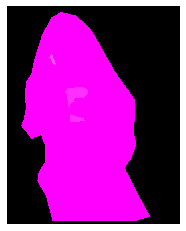

(640, 508, 3)
COCO_val2014_000000571012.jpg
{'person_bbx': [122.51, 32.73, 243.32, 387.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [122.51, 32.73, 243.32, 387.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': [92.34, 355.29, 284.90999999999997, 435.25]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [122.51, 32.73, 243.32, 387.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [122.51, 32.73, 243.32, 387.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


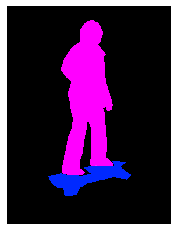

(500, 375, 3)
COCO_val2014_000000328337.jpg
{'person_bbx': [71.01, 36.46, 390.53999999999996, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [127.62, 32.69, 264.84000000000003, 167.99]}}
person
frisbee
hold
hold interaction
{'person_bbx': [71.01, 36.46, 390.53999999999996, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [71.01, 36.46, 390.53999999999996, 422.2], 'Verbs': 'throw', 'object': {'obj_bbx': [127.62, 32.69, 264.84000000000003, 167.99]}}
person
frisbee
throw
throw interaction


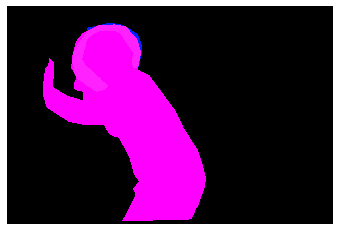

(427, 640, 3)
COCO_val2014_000000543570.jpg
{'person_bbx': [193.08, 97.15, 355.96000000000004, 348.48], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [92.1, 194.76, 198.28, 265.19]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [193.08, 97.15, 355.96000000000004, 348.48], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [67.24, 243.56, 86.75999999999999, 259.05]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [193.08, 97.15, 355.96000000000004, 348.48], 'Verbs': 'hold', 'object': {'obj_bbx': [92.1, 194.76, 198.28, 265.19]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [271.96, 232.69, 450.74, 414.72], 'Verbs': 'look', 'object': {'obj_bbx': [67.24, 243.56, 86.75999999999999, 259.05]}}
sports ball
person
look
look interaction
{'person_bbx': [193.08, 97.15, 355.96000000000004, 348.48], 'Verbs': 'look', 'object': {'obj_bbx': [67.24, 243.56, 86.75999999999999, 259.05]}}
sports ball
person
look
look interaction
{'person_bbx': [446.34, 177.04, 599.6899

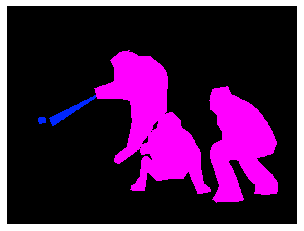

(480, 640, 3)
COCO_val2014_000000499577.jpg
{'person_bbx': [29.81, 0.48, 504.9, 420.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


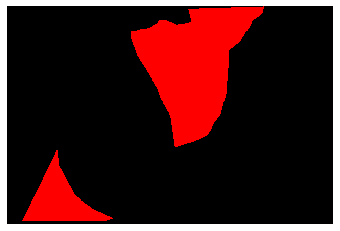

(427, 640, 3)
COCO_val2014_000000294032.jpg
{'person_bbx': [35.6, 114.01, 283.69, 447.31], 'Verbs': 'hold', 'object': {'obj_bbx': [126.42, 211.34, 158.13, 243.6]}}
cell phone
person
hold
hold interaction
{'person_bbx': [290.38, 152.51, 589.44, 435.3], 'Verbs': 'hold', 'object': {'obj_bbx': [421.17, 191.27, 432.68, 213.19]}}
cell phone
person
hold
hold interaction
{'person_bbx': [35.6, 114.01, 283.69, 447.31], 'Verbs': 'sit', 'object': {'obj_bbx': [274.49, 339.53, 288.47, 398.64]}}
chair
person
sit
sit interaction
{'person_bbx': [290.38, 152.51, 589.44, 435.3], 'Verbs': 'sit', 'object': {'obj_bbx': [333.99, 339.73, 592.37, 420.66]}}
chair
person
sit
sit interaction
{'person_bbx': [35.6, 114.01, 283.69, 447.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [290.38, 152.51, 589.44, 435.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [35.6, 114.01, 283.69, 447.31], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [126.42, 211.34, 158.

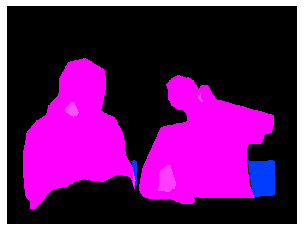

(480, 640, 3)
COCO_val2014_000000407121.jpg
{'person_bbx': [2.25, 6.74, 342.7, 498.88], 'Verbs': 'hold', 'object': {'obj_bbx': [274.37, 342.18, 306.83, 368.08]}}
person
mouse
hold
hold interaction
{'person_bbx': [2.25, 6.74, 342.7, 498.88], 'Verbs': 'look', 'object': {'obj_bbx': [136.26, 54.62, 373.87, 382.32]}}
person
laptop
look
look interaction
{'person_bbx': [2.25, 6.74, 342.7, 498.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.25, 6.74, 342.7, 498.88], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [136.26, 54.62, 373.87, 382.32]}}
person
laptop
work_on_computer
work_on_computer interaction


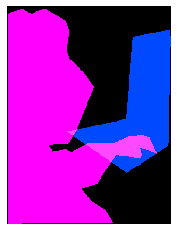

(500, 375, 3)
COCO_val2014_000000529670.jpg
{'person_bbx': [38.83, 8.63, 388.31, 593.98], 'Verbs': 'look', 'object': {'obj_bbx': [407.7, 43.86, 510.01, 133.1]}}
frisbee
person
look
look interaction
{'person_bbx': [38.83, 8.63, 388.31, 593.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [38.83, 8.63, 388.31, 593.98], 'Verbs': 'throw', 'object': {'obj_bbx': [407.7, 43.86, 510.01, 133.1]}}
frisbee
person
throw
throw interaction


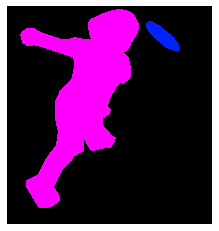

(640, 603, 3)
COCO_val2014_000000534173.jpg
{'person_bbx': [56.46, 2.53, 390.16999999999996, 370.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [189.39, 112.07, 216.48999999999998, 152.72]}}
person
cell phone
hold
hold interaction
{'person_bbx': [56.46, 2.53, 390.16999999999996, 370.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [321.2, 157.47, 464.13, 371.06]}}
chair
person
sit
sit interaction
{'person_bbx': [56.46, 2.53, 390.16999999999996, 370.78999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [189.39, 112.07, 216.48999999999998, 152.72]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


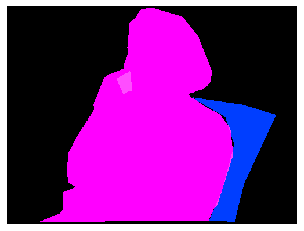

(375, 500, 3)
COCO_val2014_000000388601.jpg
{'person_bbx': [113.05, 56.68, 318.15, 206.87], 'Verbs': 'hold', 'object': {'obj_bbx': [2.8, 89.41, 442.83, 625.0]}}
bed
person
hold
hold interaction
{'person_bbx': [113.05, 56.68, 318.15, 206.87], 'Verbs': 'lay', 'object': {'obj_bbx': [2.8, 89.41, 442.83, 625.0]}}
bed
person
lay
lay interaction


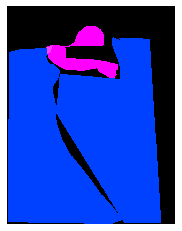

(625, 482, 3)
COCO_val2014_000000312289.jpg
{'person_bbx': [343.43, 28.09, 515.99, 420.88], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [341.74, 323.71, 391.93, 359.33]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [343.43, 28.09, 515.99, 420.88], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [223.32, 296.88, 359.37, 409.90999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [394.38, 22.07, 620.8299999999999, 422.2], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [341.74, 323.71, 391.93, 359.33]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [394.38, 22.07, 620.8299999999999, 422.2], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [223.32, 296.88, 359.37, 409.90999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [343.43, 28.09, 515.99, 420.88], 'Verbs': 'hold', 'object': {'obj_bbx': [341.74, 323.71, 391.93, 359.33]}}
person
knife
hold
hold interaction
{'person_bbx': [394.38, 22.07, 620.8299999999999, 422.2], 'Verbs': 'hold', 'objec

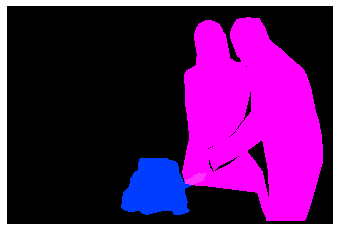

(427, 640, 3)
COCO_val2014_000000464283.jpg
{'person_bbx': [92.86, 131.15, 318.78, 364.73], 'Verbs': 'drink', 'object': {'obj_bbx': [171.01, 167.92, 243.75, 201.89999999999998]}}
person
wine glass
drink
drink interaction
{'person_bbx': [291.02, 127.32, 542.79, 424.09], 'Verbs': 'drink', 'object': {'obj_bbx': [312.2, 178.89, 398.1, 248.48999999999998]}}
wine glass
person
drink
drink interaction
{'person_bbx': [92.86, 131.15, 318.78, 364.73], 'Verbs': 'hold', 'object': {'obj_bbx': [171.01, 167.92, 243.75, 201.89999999999998]}}
person
wine glass
hold
hold interaction
{'person_bbx': [291.02, 127.32, 542.79, 424.09], 'Verbs': 'hold', 'object': {'obj_bbx': [312.2, 178.89, 398.1, 248.48999999999998]}}
wine glass
person
hold
hold interaction
{'person_bbx': [92.86, 131.15, 318.78, 364.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [291.02, 127.32, 542.79, 424.09], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


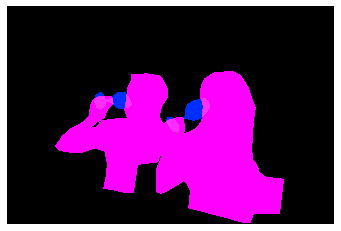

(426, 640, 3)
COCO_val2014_000000208817.jpg
{'person_bbx': [234.07, 212.49, 442.25, 443.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


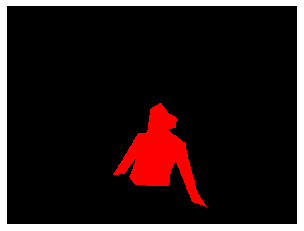

(480, 640, 3)
COCO_val2014_000000111609.jpg
{'person_bbx': [350.91, 82.91, 475.27000000000004, 354.77], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


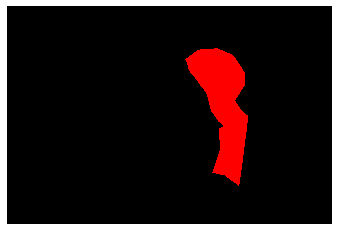

(429, 640, 3)
COCO_val2014_000000177856.jpg
{'person_bbx': [200.26, 69.19, 297.15999999999997, 150.51999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [52.65, 0.0, 632.78, 426.0]}}
boat
person
ride
ride interaction
{'person_bbx': [281.53, 86.98, 376.39, 155.06], 'Verbs': 'ride', 'object': {'obj_bbx': [52.65, 0.0, 632.78, 426.0]}}
boat
person
ride
ride interaction
{'person_bbx': [392.0, 83.37, 463.09000000000003, 143.44], 'Verbs': 'ride', 'object': {'obj_bbx': [52.65, 0.0, 632.78, 426.0]}}
boat
person
ride
ride interaction
{'person_bbx': [462.08, 65.01, 547.92, 144.07999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [52.65, 0.0, 632.78, 426.0]}}
boat
person
ride
ride interaction
{'person_bbx': [469.64, 37.56, 576.73, 135.48000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [52.65, 0.0, 632.78, 426.0]}}
boat
person
ride
ride interaction
{'person_bbx': [200.26, 69.19, 297.15999999999997, 150.51999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [

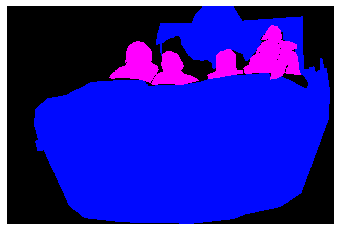

(426, 640, 3)
COCO_val2014_000000208050.jpg
{'person_bbx': [27.74, 115.29, 257.73, 501.31], 'Verbs': 'drink', 'object': {'obj_bbx': [175.12, 162.76, 230.63, 243.05]}}
person
cup
drink
drink interaction
{'person_bbx': [27.74, 115.29, 257.73, 501.31], 'Verbs': 'hold', 'object': {'obj_bbx': [175.12, 162.76, 230.63, 243.05]}}
person
cup
hold
hold interaction
{'person_bbx': [348.84, 76.52, 620.03, 512.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [27.74, 115.29, 257.73, 501.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [348.84, 76.52, 620.03, 512.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


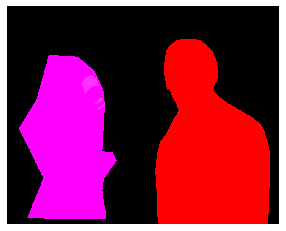

(512, 640, 3)
COCO_val2014_000000207634.jpg
{'person_bbx': [224.36, 235.43, 336.54, 540.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.36, 235.43, 336.54, 540.3199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [224.36, 235.43, 336.54, 540.3199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [224.36, 235.43, 336.54, 540.3199999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


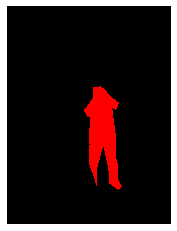

(640, 480, 3)
COCO_val2014_000000042501.jpg
{'person_bbx': [270.46, 91.81, 510.87, 306.89], 'Verbs': 'jump', 'object': {'obj_bbx': [62.81, 256.07, 372.02, 309.21]}}
person
surfboard
jump
jump interaction
{'person_bbx': [270.46, 91.81, 510.87, 306.89], 'Verbs': 'surf', 'object': {'obj_bbx': [62.81, 256.07, 372.02, 309.21]}}
person
surfboard
surf
surf interaction


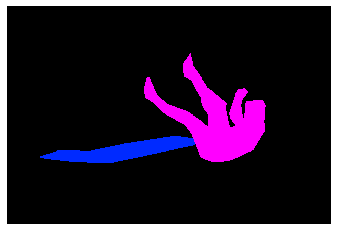

(430, 640, 3)
COCO_val2014_000000351335.jpg
{'person_bbx': [0.0, 24.21, 463.0, 492.68], 'Verbs': 'hold', 'object': {'obj_bbx': [145.49, 157.59, 233.60000000000002, 254.15]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 24.21, 463.0, 492.68], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [145.49, 157.59, 233.60000000000002, 254.15]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


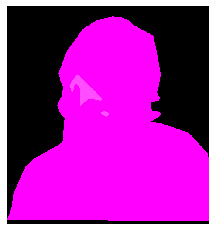

(500, 463, 3)
COCO_val2014_000000239347.jpg
{'person_bbx': [206.49, 157.3, 529.73, 292.43], 'Verbs': 'lay', 'object': {'obj_bbx': [123.83, 119.19, 530.09, 317.75]}}
person
bed
lay
lay interaction
{'person_bbx': [206.49, 157.3, 529.73, 292.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


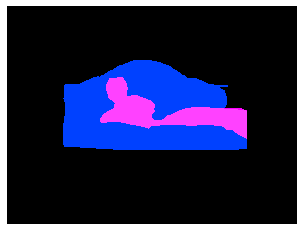

(480, 640, 3)
COCO_val2014_000000529139.jpg
{'person_bbx': [110.11, 60.33, 332.58, 456.96], 'Verbs': 'hold', 'object': {'obj_bbx': [95.21, 305.81, 136.55, 323.44]}}
person
remote
hold
hold interaction
{'person_bbx': [110.11, 60.33, 332.58, 456.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


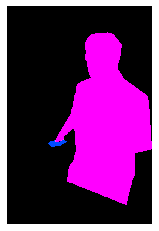

(500, 333, 3)
COCO_val2014_000000251856.jpg
{'person_bbx': [472.19, 100.18, 510.62, 143.34], 'Verbs': 'look', 'object': {'obj_bbx': [21.16, 5.29, 297.17, 154.35]}}
person
surfboard
look
look interaction
{'person_bbx': [472.19, 100.18, 510.62, 143.34], 'Verbs': 'surf', 'object': {'obj_bbx': [21.16, 5.29, 297.17, 154.35]}}
person
surfboard
surf
surf interaction


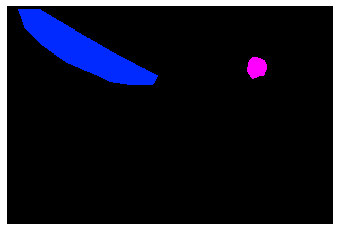

(427, 640, 3)
COCO_val2014_000000542782.jpg
{'person_bbx': [447.3, 79.78, 640.0, 398.0], 'Verbs': 'hold', 'object': {'obj_bbx': [467.46, 45.53, 535.05, 393.78]}}
person
snowboard
hold
hold interaction
{'person_bbx': [53.66, 110.75, 218.23, 389.8], 'Verbs': 'hold', 'object': {'obj_bbx': [182.08, 231.94, 226.44, 276.95]}}
person
cell phone
hold
hold interaction
{'person_bbx': [53.66, 110.75, 218.23, 389.8], 'Verbs': 'look', 'object': {'obj_bbx': [182.08, 231.94, 226.44, 276.95]}}
person
cell phone
look
look interaction
{'person_bbx': [0.0, 26.73, 185.07, 393.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [447.3, 79.78, 640.0, 398.0]}}
person
person
look
look interaction
{'person_bbx': [53.66, 110.75, 218.23, 389.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 26.73, 185.07, 393.28000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 26.73, 185.07, 393.28000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}


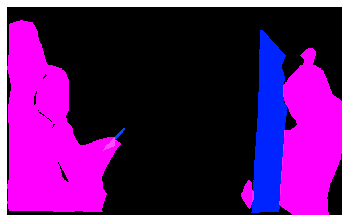

(398, 640, 3)
COCO_val2014_000000555271.jpg
{'person_bbx': [151.46, 125.23, 358.87, 336.72], 'Verbs': 'hold', 'object': {'obj_bbx': [202.47, 127.86, 214.42, 137.4]}}
sports ball
person
hold
hold interaction
{'person_bbx': [151.46, 125.23, 358.87, 336.72], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [151.46, 125.23, 358.87, 336.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [151.46, 125.23, 358.87, 336.72], 'Verbs': 'throw', 'object': {'obj_bbx': [202.47, 127.86, 214.42, 137.4]}}
sports ball
person
throw
throw interaction


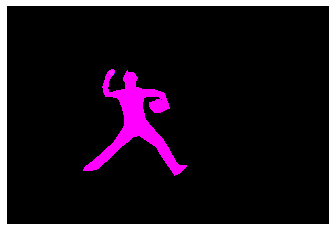

(433, 640, 3)
COCO_val2014_000000305060.jpg
{'person_bbx': [2.87, 36.09, 190.5, 183.52], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [81.5, 131.0, 371.5, 347.0]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [216.02, 0.57, 438.04, 140.06], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [315.34, 126.4, 622.8, 239.37]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [2.87, 36.09, 190.5, 183.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [216.02, 0.57, 438.04, 140.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


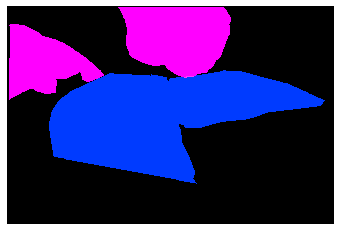

(426, 640, 3)
COCO_val2014_000000549171.jpg
{'person_bbx': [0.0, 1.44, 359.0, 632.8100000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [182.65, 15.38, 359.0, 116.05]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 1.44, 359.0, 632.8100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [182.65, 15.38, 359.0, 116.05]}}
scissors
person
hold
hold interaction


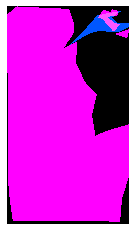

(640, 359, 3)
COCO_val2014_000000313811.jpg
{'person_bbx': [0.0, 1.18, 640.0, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [2.16, 174.74, 149.93, 436.85]}}
bed
person
lay
lay interaction


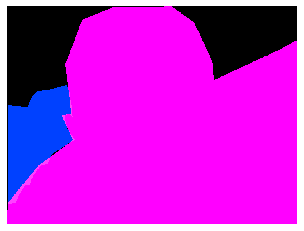

(480, 640, 3)
COCO_val2014_000000151524.jpg
{'person_bbx': [440.78, 296.15, 522.06, 343.28], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [440.78, 296.15, 522.06, 343.28], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


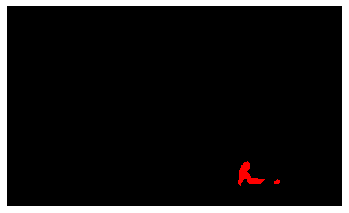

(381, 640, 3)
COCO_val2014_000000301402.jpg
{'person_bbx': [54.65, 145.26, 340.84999999999997, 612.6700000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [175.17, 225.52, 364.14, 541.38]}}
chair
person
sit
sit interaction
{'person_bbx': [54.65, 145.26, 340.84999999999997, 612.6700000000001], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [130.88, 279.01, 294.83, 366.74]}}
person
laptop
work_on_computer
work_on_computer interaction


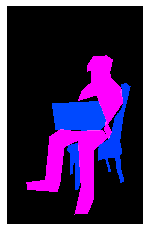

(640, 400, 3)
COCO_val2014_000000043625.jpg
{'person_bbx': [335.84, 192.58, 447.15, 372.97], 'Verbs': 'catch', 'object': {'obj_bbx': [335.49, 214.12, 366.33, 224.28]}}
person
frisbee
catch
catch interaction
{'person_bbx': [335.84, 192.58, 447.15, 372.97], 'Verbs': 'hold', 'object': {'obj_bbx': [335.49, 214.12, 366.33, 224.28]}}
person
frisbee
hold
hold interaction
{'person_bbx': [335.84, 192.58, 447.15, 372.97], 'Verbs': 'look', 'object': {'obj_bbx': [335.49, 214.12, 366.33, 224.28]}}
person
frisbee
look
look interaction
{'person_bbx': [335.84, 192.58, 447.15, 372.97], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [335.84, 192.58, 447.15, 372.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


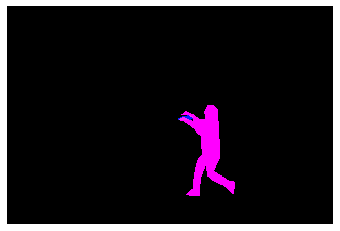

(427, 640, 3)
COCO_val2014_000000330911.jpg
{'person_bbx': [165.81, 93.1, 272.15, 174.16], 'Verbs': 'hold', 'object': {'obj_bbx': [169.18, 111.19, 298.03, 205.59]}}
person
snowboard
hold
hold interaction
{'person_bbx': [165.81, 93.1, 272.15, 174.16], 'Verbs': 'jump', 'object': {'obj_bbx': [169.18, 111.19, 298.03, 205.59]}}
person
snowboard
jump
jump interaction
{'person_bbx': [165.81, 93.1, 272.15, 174.16], 'Verbs': 'look', 'object': {'obj_bbx': [169.18, 111.19, 298.03, 205.59]}}
person
snowboard
look
look interaction


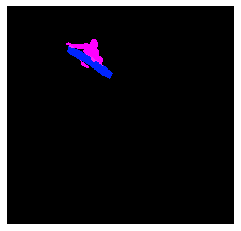

(614, 640, 3)
COCO_val2014_000000431545.jpg
{'person_bbx': [142.37, 81.31, 237.54000000000002, 290.95], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [142.37, 81.31, 237.54000000000002, 290.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


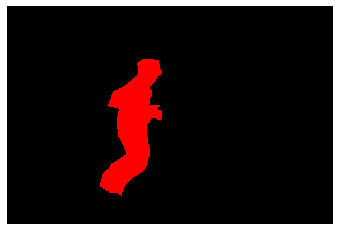

(334, 500, 3)
COCO_val2014_000000544655.jpg
{'person_bbx': [197.44, 53.12, 467.05, 441.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [197.44, 53.12, 467.05, 441.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


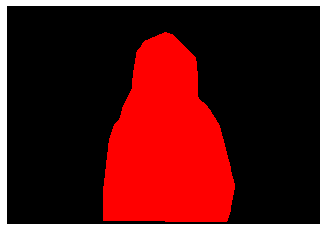

(446, 640, 3)
COCO_val2014_000000141135.jpg
{'person_bbx': [18.74, 32.02, 423.78000000000003, 630.22], 'Verbs': 'hold', 'object': {'obj_bbx': [338.76, 135.45, 352.81, 228.6]}}
cell phone
person
hold
hold interaction
{'person_bbx': [18.74, 32.02, 423.78000000000003, 630.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [18.74, 32.02, 423.78000000000003, 630.22], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [338.76, 135.45, 352.81, 228.6]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


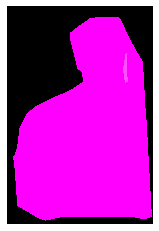

(640, 427, 3)
COCO_val2014_000000248591.jpg
{'person_bbx': [81.61, 1.57, 352.21000000000004, 488.37], 'Verbs': 'look', 'object': {'obj_bbx': [164.86, 421.9, 450.01, 640.0]}}
person
laptop
look
look interaction
{'person_bbx': [81.61, 1.57, 352.21000000000004, 488.37], 'Verbs': 'sit', 'object': {'obj_bbx': [43.15, 101.67, 363.87, 429.58000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [81.61, 1.57, 352.21000000000004, 488.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [81.61, 1.57, 352.21000000000004, 488.37], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [164.86, 421.9, 450.01, 640.0]}}
person
laptop
work_on_computer
work_on_computer interaction


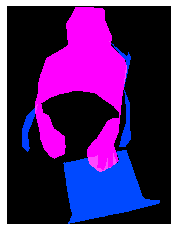

(640, 480, 3)
COCO_val2014_000000244925.jpg
{'person_bbx': [0.0, 2.24, 498.73, 425.88], 'Verbs': 'carry', 'object': {'obj_bbx': [256.96, 60.27, 385.91999999999996, 158.67000000000002]}}
banana
person
carry
carry interaction
{'person_bbx': [0.0, 2.24, 498.73, 425.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


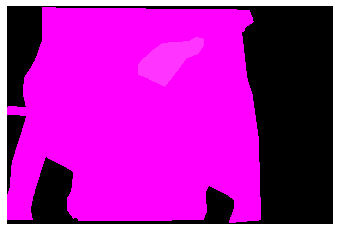

(427, 640, 3)
COCO_val2014_000000278801.jpg
{'person_bbx': [238.38, 131.42, 422.83, 337.44], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [238.38, 131.42, 422.83, 337.44], 'Verbs': 'snowboard', 'object': {'obj_bbx': [130.41, 292.0, 500.4, 395.46]}}
person
snowboard
snowboard
snowboard interaction


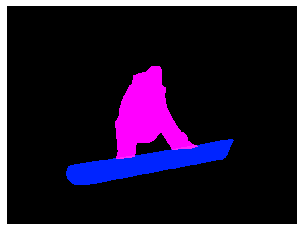

(480, 640, 3)
COCO_val2014_000000515579.jpg
{'person_bbx': [9.79, 24.09, 236.39, 328.23999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [14.55, 119.44, 39.39, 140.14]}}
person
sports ball
hold
hold interaction
{'person_bbx': [9.79, 24.09, 236.39, 328.23999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [9.79, 24.09, 236.39, 328.23999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [9.79, 24.09, 236.39, 328.23999999999995], 'Verbs': 'throw', 'object': {'obj_bbx': [14.55, 119.44, 39.39, 140.14]}}
person
sports ball
throw
throw interaction


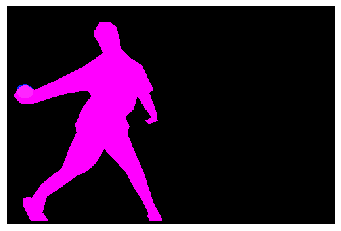

(332, 500, 3)
COCO_val2014_000000239235.jpg
{'person_bbx': [434.3, 217.82, 480.73, 296.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [375.72, 240.71, 417.45000000000005, 320.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [289.2, 270.91, 340.46999999999997, 360.40000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [274.33, 344.22, 357.28, 372.94000000000005]}}
person
skis
look
look interaction
{'person_bbx': [289.2, 270.91, 340.46999999999997, 360.40000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [274.33, 344.22, 357.28, 372.94000000000005]}}
person
skis
ski
ski interaction
{'person_bbx': [486.79, 207.92, 517.6700000000001, 283.96999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [484.6, 274.98, 526.3000000000001, 283.79]}}
person
skis
ski
ski interaction
{'person_bbx': [434.3, 217.82, 480.73, 296.06], 'Verbs': 'ski', 'object': {'obj_bbx': [437.26, 290.3, 476.33, 297.7]}}
person
skis
ski
ski interaction
{'person_bbx': [

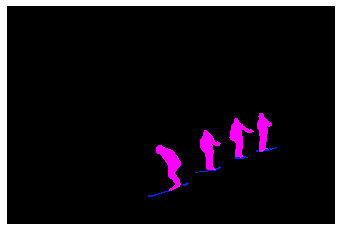

(425, 640, 3)
COCO_val2014_000000103035.jpg
{'person_bbx': [552.86, 167.96, 598.9200000000001, 328.67], 'Verbs': 'hold', 'object': {'obj_bbx': [489.28, 194.51, 640.0, 348.01]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [225.5, 160.85, 283.85, 303.68], 'Verbs': 'hold', 'object': {'obj_bbx': [253.52, 250.3, 337.99, 355.58000000000004]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [122.45, 162.29, 191.72, 372.76], 'Verbs': 'hold', 'object': {'obj_bbx': [5.73, 179.55, 282.70000000000005, 413.54]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [552.86, 167.96, 598.9200000000001, 328.67], 'Verbs': 'ride', 'object': {'obj_bbx': [489.28, 194.51, 640.0, 348.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [225.5, 160.85, 283.85, 303.68], 'Verbs': 'ride', 'object': {'obj_bbx': [253.52, 250.3, 337.99, 355.58000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [122.45, 162.29, 191.72, 372.76], 'Verbs': 'ride', 'object': {'obj_bbx': [5.

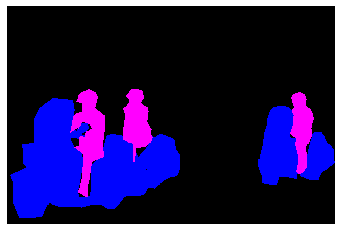

(425, 640, 3)
COCO_val2014_000000000764.jpg
{'person_bbx': [70.14, 95.58, 148.76, 281.34], 'Verbs': 'look', 'object': {'obj_bbx': [135.23, 135.93, 178.76, 153.53]}}
frisbee
person
look
look interaction
{'person_bbx': [252.43, 128.1, 436.62, 330.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [135.23, 135.93, 178.76, 153.53]}}
frisbee
person
look
look interaction
{'person_bbx': [70.14, 95.58, 148.76, 281.34], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [70.14, 95.58, 148.76, 281.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.43, 128.1, 436.62, 330.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.43, 128.1, 436.62, 330.34000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [135.23, 135.93, 178.76, 153.53]}}
frisbee
person
throw
throw interaction


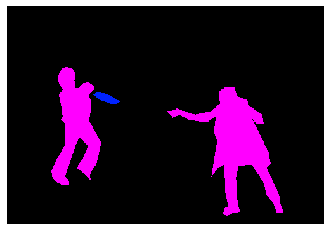

(343, 500, 3)
COCO_val2014_000000264572.jpg
{'person_bbx': [70.84, 88.24, 442.41999999999996, 544.3299999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [70.12, 90.57, 95.47, 116.36999999999999]}}
sports ball
person
hold
hold interaction
{'person_bbx': [70.84, 88.24, 442.41999999999996, 544.3299999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [70.84, 88.24, 442.41999999999996, 544.3299999999999], 'Verbs': 'throw', 'object': {'obj_bbx': [70.12, 90.57, 95.47, 116.36999999999999]}}
sports ball
person
throw
throw interaction


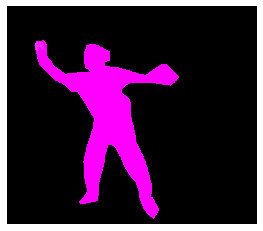

(558, 640, 3)
COCO_val2014_000000538005.jpg
{'person_bbx': [195.91, 132.94, 289.19, 204.01], 'Verbs': 'jump', 'object': {'obj_bbx': [240.08, 183.92, 297.99, 202.64]}}
skateboard
person
jump
jump interaction
{'person_bbx': [298.58, 204.24, 370.24, 267.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [195.91, 132.94, 289.19, 204.01]}}
person
person
look
look interaction
{'person_bbx': [195.91, 132.94, 289.19, 204.01], 'Verbs': 'look', 'object': {'obj_bbx': [240.08, 183.92, 297.99, 202.64]}}
skateboard
person
look
look interaction
{'person_bbx': [361.43, 527.55, 390.41, 626.03], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [195.91, 132.94, 289.19, 204.01], 'Verbs': 'skateboard', 'object': {'obj_bbx': [240.08, 183.92, 297.99, 202.64]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [298.58, 204.24, 370.24, 267.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [361.43, 527.55, 390.41, 626.03], 'Verb

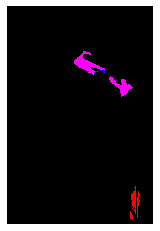

(640, 429, 3)
COCO_val2014_000000000564.jpg
{'person_bbx': [230.51, 335.3, 377.99, 614.5], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [296.89, 432.81, 402.37, 473.63]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [230.51, 335.3, 377.99, 614.5], 'Verbs': 'hold', 'object': {'obj_bbx': [296.89, 432.81, 402.37, 473.63]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [230.51, 335.3, 377.99, 614.5], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [230.51, 335.3, 377.99, 614.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


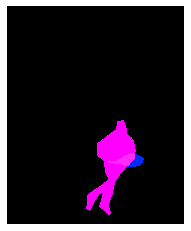

(640, 520, 3)
COCO_val2014_000000051610.jpg
{'person_bbx': [345.8, 98.48, 590.35, 401.3], 'Verbs': 'look', 'object': {'obj_bbx': [45.1, 215.9, 293.62, 403.01]}}
person
laptop
look
look interaction
{'person_bbx': [345.8, 98.48, 590.35, 401.3], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 301.45, 640.0, 420.98]}}
bed
person
sit
sit interaction
{'person_bbx': [345.8, 98.48, 590.35, 401.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [45.1, 215.9, 293.62, 403.01]}}
person
laptop
work_on_computer
work_on_computer interaction


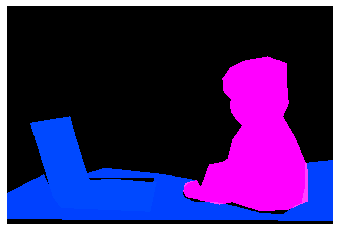

(427, 640, 3)
COCO_val2014_000000256529.jpg
{'person_bbx': [38.29, 174.8, 163.54, 403.14], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [38.29, 174.8, 163.54, 403.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [38.29, 174.8, 163.54, 403.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


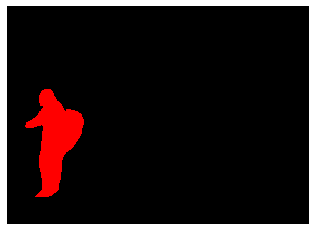

(461, 640, 3)
COCO_val2014_000000234945.jpg
{'person_bbx': [0.0, 0.0, 410.65, 333.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 63.79, 154.15, 289.78000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 410.65, 333.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [247.59, 0.0, 500.0, 328.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.0, 410.65, 333.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [0.0, 63.79, 154.15, 289.78000000000003]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


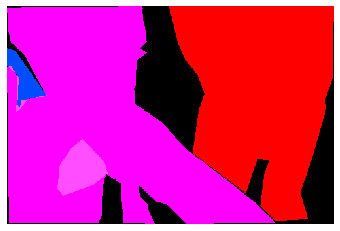

(333, 500, 3)
COCO_val2014_000000581040.jpg
{'person_bbx': [68.99, 359.71, 280.62, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [241.64, 447.19, 342.45, 537.05]}}
person
laptop
hold
hold interaction
{'person_bbx': [68.99, 359.71, 280.62, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [241.64, 447.19, 342.45, 537.05]}}
person
laptop
look
look interaction
{'person_bbx': [68.99, 359.71, 280.62, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [27.39, 523.96, 148.47, 640.0]}}
chair
person
sit
sit interaction
{'person_bbx': [68.99, 359.71, 280.62, 640.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [241.64, 447.19, 342.45, 537.05]}}
person
laptop
work_on_computer
work_on_computer interaction


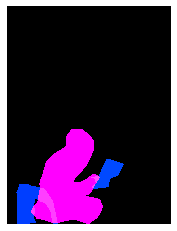

(640, 480, 3)
COCO_val2014_000000342971.jpg
{'person_bbx': [27.85, 123.85, 233.45, 630.54], 'Verbs': 'catch', 'object': {'obj_bbx': [110.69, 143.37, 214.76999999999998, 160.3]}}
frisbee
person
catch
catch interaction
{'person_bbx': [27.85, 123.85, 233.45, 630.54], 'Verbs': 'look', 'object': {'obj_bbx': [110.69, 143.37, 214.76999999999998, 160.3]}}
frisbee
person
look
look interaction
{'person_bbx': [27.85, 123.85, 233.45, 630.54], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [27.85, 123.85, 233.45, 630.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


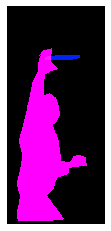

(640, 287, 3)
COCO_val2014_000000358617.jpg
{'person_bbx': [163.87, 37.4, 297.67, 305.0], 'Verbs': 'carry', 'object': {'obj_bbx': [60.34, 111.07, 423.89, 196.0]}}
person
surfboard
carry
carry interaction
{'person_bbx': [163.87, 37.4, 297.67, 305.0], 'Verbs': 'hold', 'object': {'obj_bbx': [60.34, 111.07, 423.89, 196.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [163.87, 37.4, 297.67, 305.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [163.87, 37.4, 297.67, 305.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


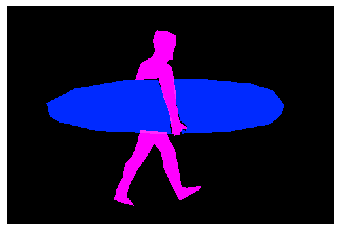

(333, 500, 3)
COCO_val2014_000000401797.jpg
{'person_bbx': [79.65, 17.13, 204.45, 146.03], 'Verbs': 'kick', 'object': {'obj_bbx': [159.0, 85.56, 177.0, 104.56]}}
sports ball
person
kick
kick interaction
{'person_bbx': [79.65, 17.13, 204.45, 146.03], 'Verbs': 'look', 'object': {'obj_bbx': [159.0, 85.56, 177.0, 104.56]}}
sports ball
person
look
look interaction
{'person_bbx': [79.65, 17.13, 204.45, 146.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [79.65, 17.13, 204.45, 146.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


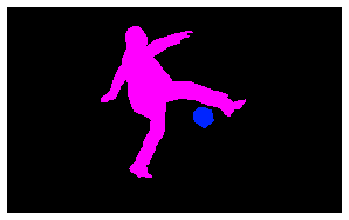

(176, 286, 3)
COCO_val2014_000000302990.jpg
{'person_bbx': [240.72, 138.6, 465.21000000000004, 289.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [240.72, 138.6, 465.21000000000004, 289.53999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [273.47, 233.17, 353.11, 345.44]}}
person
surfboard
surf
surf interaction


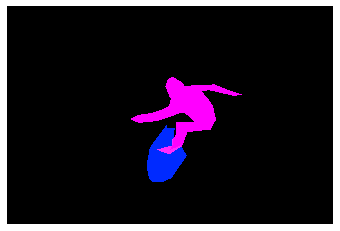

(427, 640, 3)
COCO_val2014_000000097800.jpg
{'person_bbx': [0.0, 55.05, 350.97, 510.62], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 440.27, 424.0, 630.97]}}
person
bed
lay
lay interaction
{'person_bbx': [0.0, 55.05, 350.97, 510.62], 'Verbs': 'look', 'object': {'obj_bbx': [173.42, 456.95, 357.85, 560.17]}}
bird
person
look
look interaction
{'person_bbx': [0.0, 55.05, 350.97, 510.62], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


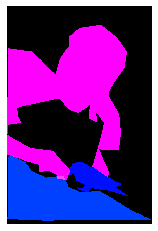

(640, 424, 3)
COCO_val2014_000000468608.jpg
{'person_bbx': [34.68, 13.56, 303.17, 409.29], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [185.91, 342.68, 267.76, 381.48]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [34.68, 13.56, 303.17, 409.29], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [178.3, 333.35, 321.42, 448.56]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [34.68, 13.56, 303.17, 409.29], 'Verbs': 'hold', 'object': {'obj_bbx': [185.91, 342.68, 267.76, 381.48]}}
person
knife
hold
hold interaction
{'person_bbx': [34.68, 13.56, 303.17, 409.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [34.68, 13.56, 303.17, 409.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


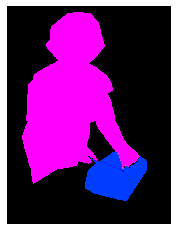

(500, 375, 3)
COCO_val2014_000000145734.jpg
{'person_bbx': [89.43, 28.68, 353.61, 566.0999999999999], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [89.43, 28.68, 353.61, 566.0999999999999], 'Verbs': 'look', 'object': {'obj_bbx': [284.45, 81.95, 358.76, 146.01]}}
person
frisbee
look
look interaction


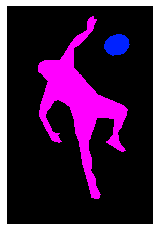

(640, 427, 3)
COCO_val2014_000000143737.jpg
{'person_bbx': [167.3, 262.96, 244.59000000000003, 422.34], 'Verbs': 'hold', 'object': {'obj_bbx': [151.01, 300.58, 251.69, 441.53]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [258.87, 261.64, 350.27, 396.86], 'Verbs': 'hold', 'object': {'obj_bbx': [261.17, 300.77, 358.74, 450.01]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [167.3, 262.96, 244.59000000000003, 422.34], 'Verbs': 'ride', 'object': {'obj_bbx': [151.01, 300.58, 251.69, 441.53]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [258.87, 261.64, 350.27, 396.86], 'Verbs': 'ride', 'object': {'obj_bbx': [261.17, 300.77, 358.74, 450.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [167.3, 262.96, 244.59000000000003, 422.34], 'Verbs': 'sit', 'object': {'obj_bbx': [151.01, 300.58, 251.69, 441.53]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [258.87, 261.64, 350.27, 396.86], 'Verbs': 'sit', 'object': {'obj_bbx': [261.17, 300.77, 358.74,

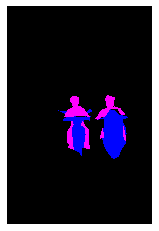

(640, 426, 3)
COCO_val2014_000000189714.jpg
{'person_bbx': [90.44, 132.26, 193.53, 202.82999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [103.56, 178.88, 219.76999999999998, 220.41]}}
person
skis
jump
jump interaction
{'person_bbx': [329.88, 97.15, 409.93, 210.15], 'Verbs': 'jump', 'object': {'obj_bbx': [302.81, 196.49, 480.74, 226.33]}}
person
skis
jump
jump interaction
{'person_bbx': [90.44, 132.26, 193.53, 202.82999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [103.56, 178.88, 219.76999999999998, 220.41]}}
person
skis
look
look interaction
{'person_bbx': [329.88, 97.15, 409.93, 210.15], 'Verbs': 'look', 'object': {'obj_bbx': [302.81, 196.49, 480.74, 226.33]}}
person
skis
look
look interaction
{'person_bbx': [90.44, 132.26, 193.53, 202.82999999999998], 'Verbs': 'ski', 'object': {'obj_bbx': [103.56, 178.88, 219.76999999999998, 220.41]}}
person
skis
ski
ski interaction
{'person_bbx': [329.88, 97.15, 409.93, 210.15], 'Verbs': 'ski', 'object': {'obj_bbx': [302.81, 196.49, 480.

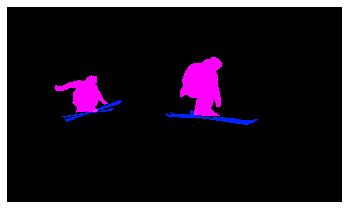

(373, 640, 3)
COCO_val2014_000000560373.jpg
{'person_bbx': [53.81, 12.33, 228.7, 436.09999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [215.54, 200.02, 250.39999999999998, 341.5]}}
person
chair
sit
sit interaction
{'person_bbx': [53.81, 12.33, 228.7, 436.09999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


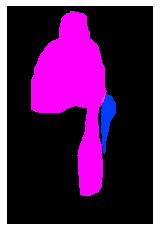

(500, 335, 3)
COCO_val2014_000000357805.jpg


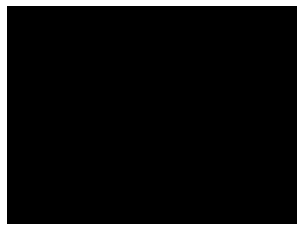

(300, 400, 3)
COCO_val2014_000000156685.jpg
{'person_bbx': [101.45, 56.47, 191.98000000000002, 164.06], 'Verbs': 'look', 'object': {'obj_bbx': [42.98, 156.74, 128.93, 259.55]}}
person
person
look
look interaction
{'person_bbx': [42.98, 156.74, 128.93, 259.55], 'Verbs': 'look', 'object': {'obj_bbx': [101.45, 56.47, 191.98000000000002, 164.06]}}
person
person
look
look interaction
{'person_bbx': [101.45, 56.47, 191.98000000000002, 164.06], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [42.98, 156.74, 128.93, 259.55], 'Verbs': 'ride', 'object': {'obj_bbx': [1.69, 187.08, 451.69, 287.36]}}
boat
person
ride
ride interaction
{'person_bbx': [101.45, 56.47, 191.98000000000002, 164.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [42.98, 156.74, 128.93, 259.55], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


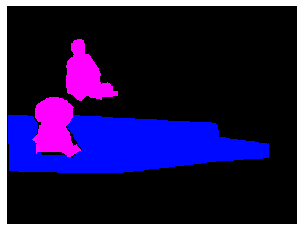

(375, 500, 3)
COCO_val2014_000000061747.jpg
{'person_bbx': [228.31, 23.22, 435.98, 518.53], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [228.31, 23.22, 435.98, 518.53], 'Verbs': 'ski', 'object': {'obj_bbx': [108.11, 437.41, 498.67, 574.0]}}
person
skis
ski
ski interaction
{'person_bbx': [228.31, 23.22, 435.98, 518.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [228.31, 23.22, 435.98, 518.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


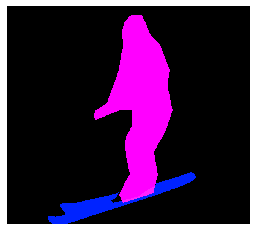

(574, 640, 3)
COCO_val2014_000000085144.jpg
{'person_bbx': [384.09, 217.86, 427.03, 297.79], 'Verbs': 'carry', 'object': {'obj_bbx': [409.75, 229.05, 421.88, 252.49]}}
person
backpack
carry
carry interaction
{'person_bbx': [235.09, 226.45, 265.3, 310.32], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [384.09, 217.86, 427.03, 297.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [384.09, 217.86, 427.03, 297.79], 'Verbs': 'look', 'object': {'obj_bbx': [235.09, 226.45, 265.3, 310.32]}}
person
person
look
look interaction
{'person_bbx': [235.09, 226.45, 265.3, 310.32], 'Verbs': 'ski', 'object': {'obj_bbx': [210.79, 301.45, 262.35, 311.93]}}
person
skis
ski
ski interaction
{'person_bbx': [384.09, 217.86, 427.03, 297.79], 'Verbs': 'ski', 'object': {'obj_bbx': [389.48, 291.66, 429.17, 301.04]}}
person
skis
ski
ski interaction
{'person_bbx': [235.09, 226.45, 265.3, 310.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx

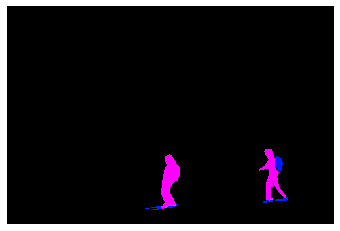

(333, 500, 3)
COCO_val2014_000000391090.jpg
{'person_bbx': [314.63, 1.18, 640.0, 472.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [341.04, 203.66, 640.0, 349.03999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [314.63, 1.18, 640.0, 472.59000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [341.04, 203.66, 640.0, 349.03999999999996]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


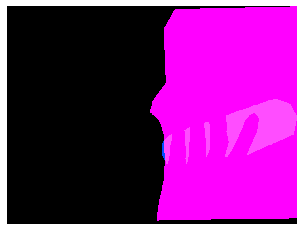

(480, 640, 3)
COCO_val2014_000000572767.jpg
{'person_bbx': [366.67, 440.73, 404.22, 519.75], 'Verbs': 'ride', 'object': {'obj_bbx': [374.0, 472.53, 405.22, 543.68]}}
bicycle
person
ride
ride interaction
{'person_bbx': [438.45, 433.2, 478.81, 511.56], 'Verbs': 'ride', 'object': {'obj_bbx': [443.85, 465.64, 475.75, 541.63]}}
bicycle
person
ride
ride interaction
{'person_bbx': [366.67, 440.73, 404.22, 519.75], 'Verbs': 'sit', 'object': {'obj_bbx': [374.0, 472.53, 405.22, 543.68]}}
bicycle
person
sit
sit interaction
{'person_bbx': [438.45, 433.2, 478.81, 511.56], 'Verbs': 'sit', 'object': {'obj_bbx': [443.85, 465.64, 475.75, 541.63]}}
bicycle
person
sit
sit interaction


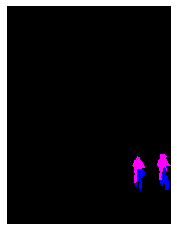

(640, 480, 3)
COCO_val2014_000000386677.jpg
{'person_bbx': [379.73, 55.37, 494.5, 390.35], 'Verbs': 'carry', 'object': {'obj_bbx': [355.04, 134.7, 432.1, 285.88]}}
person
surfboard
carry
carry interaction
{'person_bbx': [379.73, 55.37, 494.5, 390.35], 'Verbs': 'hold', 'object': {'obj_bbx': [355.04, 134.7, 432.1, 285.88]}}
person
surfboard
hold
hold interaction
{'person_bbx': [379.73, 55.37, 494.5, 390.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.73, 55.37, 494.5, 390.35], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


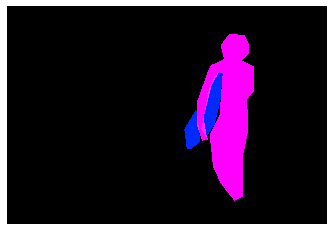

(436, 640, 3)
COCO_val2014_000000004498.jpg
{'person_bbx': [123.41, 86.96, 380.27, 550.46], 'Verbs': 'look', 'object': {'obj_bbx': [208.86, 529.96, 381.48, 580.0400000000001]}}
person
skateboard
look
look interaction
{'person_bbx': [123.41, 86.96, 380.27, 550.46], 'Verbs': 'skateboard', 'object': {'obj_bbx': [208.86, 529.96, 381.48, 580.0400000000001]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [123.41, 86.96, 380.27, 550.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


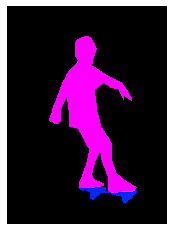

(640, 468, 3)
COCO_val2014_000000163412.jpg
{'person_bbx': [287.7, 278.83, 355.73, 414.0], 'Verbs': 'carry', 'object': {'obj_bbx': [278.11, 303.56, 346.1, 359.94]}}
person
backpack
carry
carry interaction
{'person_bbx': [142.36, 281.55, 236.36, 414.0], 'Verbs': 'carry', 'object': {'obj_bbx': [148.9, 319.26, 232.75, 404.49]}}
person
backpack
carry
carry interaction
{'person_bbx': [15.85, 253.62, 135.2, 409.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [29.56, 373.68, 97.03, 414.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [470.31, 314.72, 579.95, 414.0], 'Verbs': 'look', 'object': {'obj_bbx': [477.58, 301.43, 505.9, 379.71000000000004]}}
person
person
look
look interaction
{'person_bbx': [15.85, 253.62, 135.2, 409.34000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [29.56, 373.68, 97.03, 414.0]}}
bicycle
person
ride
ride interaction
{'person_bbx': [287.7, 278.83, 355.73, 414.0], 'Verbs': 'ride', 'object': {'obj_bbx': [305.87, 399.11, 326.31, 414.0]}}
person
bic

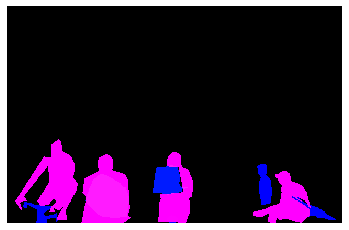

(414, 640, 3)
COCO_val2014_000000154931.jpg
{'person_bbx': [2.01, 0.96, 224.92, 480.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [207.02, 239.02, 271.70000000000005, 266.53000000000003]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [207.1, 1.08, 502.65, 194.16000000000003], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [203.81, 155.07, 332.43, 198.0]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [207.1, 1.08, 502.65, 194.16000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [203.81, 155.07, 332.43, 198.0]}}
fork
person
hold
hold interaction
{'person_bbx': [2.01, 0.96, 224.92, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [207.1, 1.08, 502.65, 194.16000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


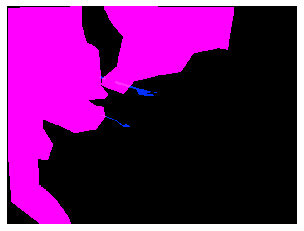

(480, 640, 3)
COCO_val2014_000000038449.jpg
{'person_bbx': [117.08, 54.78, 274.98, 472.63], 'Verbs': 'carry', 'object': {'obj_bbx': [227.58, 199.4, 295.68, 312.48]}}
person
handbag
carry
carry interaction
{'person_bbx': [355.82, 15.0, 527.3, 379.4], 'Verbs': 'carry', 'object': {'obj_bbx': [406.15, 96.2, 507.29999999999995, 283.74]}}
person
handbag
carry
carry interaction
{'person_bbx': [117.08, 54.78, 274.98, 472.63], 'Verbs': 'hold', 'object': {'obj_bbx': [114.52, 352.9, 248.95999999999998, 463.67999999999995]}}
person
suitcase
hold
hold interaction
{'person_bbx': [355.82, 15.0, 527.3, 379.4], 'Verbs': 'hold', 'object': {'obj_bbx': [406.15, 96.2, 507.29999999999995, 283.74]}}
person
handbag
hold
hold interaction
{'person_bbx': [117.08, 54.78, 274.98, 472.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [117.08, 54.78, 274.98, 472.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [355.82, 15.0, 527.3, 379.4], 'Verbs': 'stand', 'o

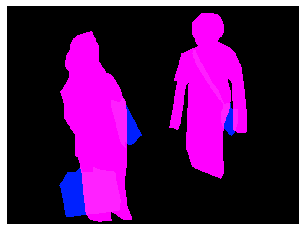

(478, 640, 3)
COCO_val2014_000000514254.jpg
{'person_bbx': [1.43, 1.43, 623.17, 630.87], 'Verbs': 'lay', 'object': {'obj_bbx': [2.86, 22.87, 640.0, 628.85]}}
bed
person
lay
lay interaction


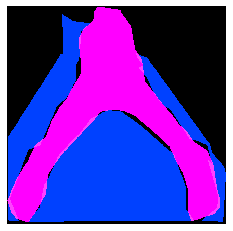

(636, 640, 3)
COCO_val2014_000000169648.jpg
{'person_bbx': [137.44, 138.41, 392.91999999999996, 401.72], 'Verbs': 'hold', 'object': {'obj_bbx': [377.74, 222.04, 415.64, 238.7]}}
person
frisbee
hold
hold interaction
{'person_bbx': [137.44, 138.41, 392.91999999999996, 401.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [137.44, 138.41, 392.91999999999996, 401.72], 'Verbs': 'throw', 'object': {'obj_bbx': [377.74, 222.04, 415.64, 238.7]}}
person
frisbee
throw
throw interaction


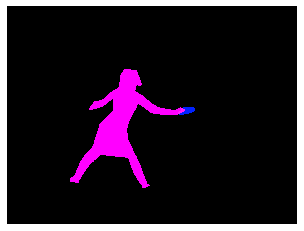

(480, 640, 3)
COCO_val2014_000000534210.jpg
{'person_bbx': [201.52, 150.9, 322.81, 349.55], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [201.52, 150.9, 322.81, 349.55], 'Verbs': 'surf', 'object': {'obj_bbx': [192.51, 326.73, 321.15, 348.67]}}
person
surfboard
surf
surf interaction


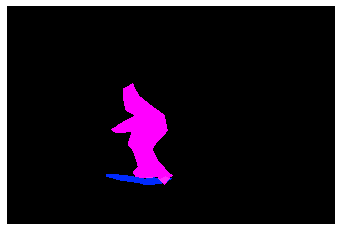

(425, 640, 3)
COCO_val2014_000000068128.jpg
{'person_bbx': [512.29, 289.51, 576.8599999999999, 422.96], 'Verbs': 'carry', 'object': {'obj_bbx': [495.57, 379.74, 524.37, 407.0]}}
person
suitcase
carry
carry interaction
{'person_bbx': [512.29, 289.51, 576.8599999999999, 422.96], 'Verbs': 'hold', 'object': {'obj_bbx': [495.57, 379.74, 524.37, 407.0]}}
person
suitcase
hold
hold interaction
{'person_bbx': [512.29, 289.51, 576.8599999999999, 422.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [512.29, 289.51, 576.8599999999999, 422.96], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


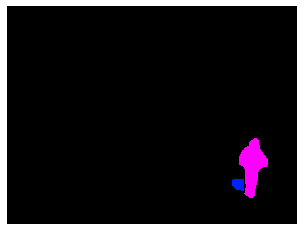

(480, 640, 3)
COCO_val2014_000000152214.jpg
{'person_bbx': [74.62, 3.83, 473.54, 626.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [74.62, 3.83, 473.54, 626.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


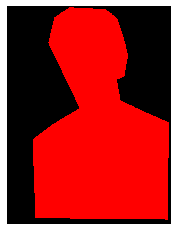

(640, 480, 3)
COCO_val2014_000000465007.jpg
{'person_bbx': [0.0, 212.84, 185.24, 301.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [7.87, 167.42, 124.72, 265.16999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


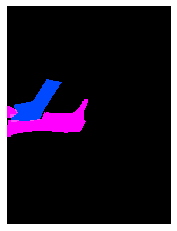

(500, 375, 3)
COCO_val2014_000000321214.jpg
{'person_bbx': [2.15, 5.51, 607.0, 465.06], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [277.21, 318.2, 539.3299999999999, 474.61]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [2.15, 5.51, 607.0, 465.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.15, 5.51, 607.0, 465.06], 'Verbs': 'sit', 'object': {'obj_bbx': [487.21, 20.65, 640.0, 211.52]}}
person
chair
sit
sit interaction


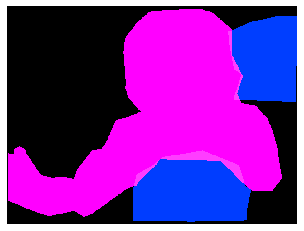

(480, 640, 3)
COCO_val2014_000000101985.jpg
{'person_bbx': [265.92, 57.35, 390.66, 375.92], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [61.95, 49.89, 383.49, 413.09999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': [383.54, 27.11, 438.56, 80.08]}}
sports ball
person
kick
kick interaction
{'person_bbx': [265.92, 57.35, 390.66, 375.92], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [61.95, 49.89, 383.49, 413.09999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [383.54, 27.11, 438.56, 80.08]}}
sports ball
person
look
look interaction
{'person_bbx': [265.92, 57.35, 390.66, 375.92], 'Verbs': 'look', 'object': {'obj_bbx': [383.54, 27.11, 438.56, 80.08]}}
sports ball
person
look
look interaction
{'person_bbx': [61.95, 49.89, 383.49, 413.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [265.92, 57.35, 390.66, 375.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


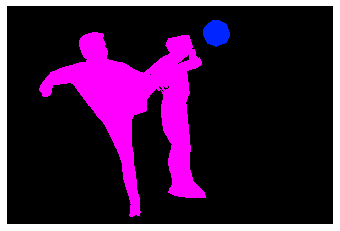

(427, 640, 3)
COCO_val2014_000000212309.jpg
{'person_bbx': [390.26, 130.61, 531.74, 407.22], 'Verbs': 'look', 'object': {'obj_bbx': [123.12, 95.3, 266.74, 480.21000000000004]}}
person
person
look
look interaction
{'person_bbx': [123.12, 95.3, 266.74, 480.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [390.26, 130.61, 531.74, 407.22], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [123.12, 95.3, 266.74, 480.21000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [390.26, 130.61, 531.74, 407.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [123.12, 95.3, 266.74, 480.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


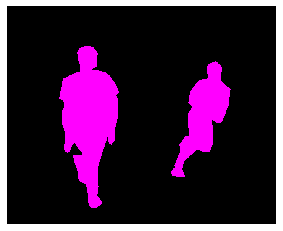

(518, 640, 3)
COCO_val2014_000000127263.jpg
{'person_bbx': [134.04, 17.23, 382.0, 369.56], 'Verbs': 'catch', 'object': {'obj_bbx': [440.02, 37.52, 485.40999999999997, 63.39]}}
person
frisbee
catch
catch interaction
{'person_bbx': [261.0, 47.98, 462.5, 404.93], 'Verbs': 'catch', 'object': {'obj_bbx': [440.02, 37.52, 485.40999999999997, 63.39]}}
person
frisbee
catch
catch interaction
{'person_bbx': [261.0, 47.98, 462.5, 404.93], 'Verbs': 'hold', 'object': {'obj_bbx': [440.02, 37.52, 485.40999999999997, 63.39]}}
person
frisbee
hold
hold interaction
{'person_bbx': [134.04, 17.23, 382.0, 369.56], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [261.0, 47.98, 462.5, 404.93], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [134.04, 17.23, 382.0, 369.56], 'Verbs': 'look', 'object': {'obj_bbx': [440.02, 37.52, 485.40999999999997, 63.39]}}
person
frisbee
look
look interaction
{'person_bbx': [261.0, 47.98, 462.5, 404.93], 'Verbs': 'look', 'object': {'

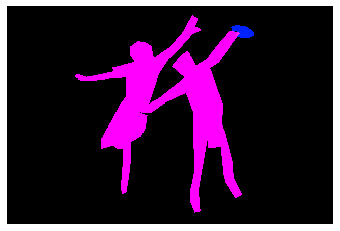

(427, 640, 3)
COCO_val2014_000000300375.jpg
{'person_bbx': [103.82, 37.75, 285.65999999999997, 166.74], 'Verbs': 'lay', 'object': {'obj_bbx': [30.55, 178.18, 400.0, 272.73]}}
person
bed
lay
lay interaction


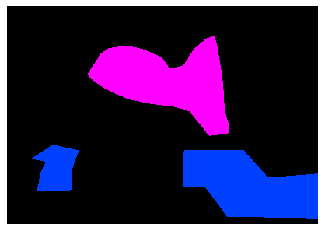

(280, 400, 3)
COCO_val2014_000000475396.jpg
{'person_bbx': [148.14, 89.52, 297.12, 206.32999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [51.62, 239.19, 169.47, 326.51]}}
person
skis
look
look interaction
{'person_bbx': [148.14, 89.52, 297.12, 206.32999999999998], 'Verbs': 'ski', 'object': {'obj_bbx': [51.62, 239.19, 169.47, 326.51]}}
person
skis
ski
ski interaction


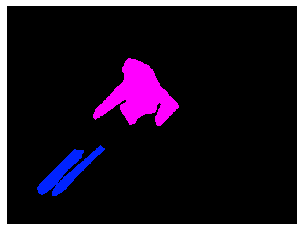

(375, 500, 3)
COCO_val2014_000000048653.jpg
{'person_bbx': [325.48, 28.72, 488.22, 319.74], 'Verbs': 'jump', 'object': {'obj_bbx': [338.89, 254.64, 597.36, 372.39]}}
snowboard
person
jump
jump interaction
{'person_bbx': [325.48, 28.72, 488.22, 319.74], 'Verbs': 'snowboard', 'object': {'obj_bbx': [338.89, 254.64, 597.36, 372.39]}}
snowboard
person
snowboard
snowboard interaction


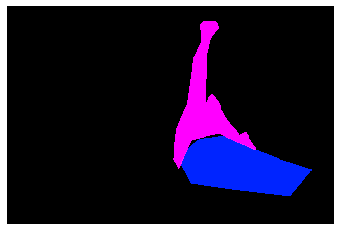

(426, 640, 3)
COCO_val2014_000000460183.jpg
{'person_bbx': [0.0, 1.05, 371.68, 292.67], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [195.39, 162.45, 405.54999999999995, 214.7]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 1.05, 371.68, 292.67], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [291.98, 194.33, 570.55, 339.84000000000003]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 1.05, 371.68, 292.67], 'Verbs': 'hold', 'object': {'obj_bbx': [195.39, 162.45, 405.54999999999995, 214.7]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 1.05, 371.68, 292.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


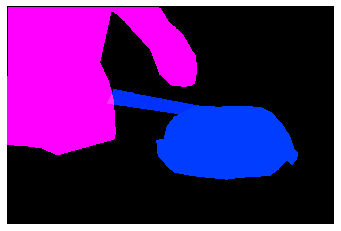

(426, 640, 3)
COCO_val2014_000000104091.jpg
{'person_bbx': [173.66, 114.34, 349.48, 435.78], 'Verbs': 'hold', 'object': {'obj_bbx': [215.1, 212.51, 320.97, 429.52]}}
person
person
hold
hold interaction
{'person_bbx': [173.66, 114.34, 349.48, 435.78], 'Verbs': 'ski', 'object': {'obj_bbx': [113.26, 385.15, 468.13, 473.59999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [173.66, 114.34, 349.48, 435.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [215.1, 212.51, 320.97, 429.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [173.66, 114.34, 349.48, 435.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


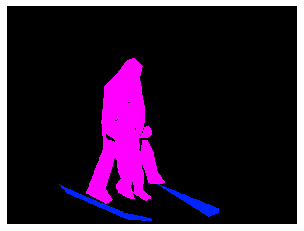

(480, 640, 3)
COCO_val2014_000000124327.jpg
{'person_bbx': [2.47, 203.2, 167.60999999999999, 357.44], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [271.39, 135.69, 401.58, 337.4], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [252.73, 196.83, 341.32, 230.3]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [271.39, 135.69, 401.58, 337.4], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [575.4, 188.06, 590.4, 200.7]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [271.39, 135.69, 401.58, 337.4], 'Verbs': 'hold', 'object': {'obj_bbx': [252.73, 196.83, 341.32, 230.3]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [2.47, 203.2, 167.60999999999999, 357.44], 'Verbs': 'hold', 'object': {'obj_bbx': [128.86, 237.88, 165.66000000000003, 279.0]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [271.39, 135.69, 401.58, 337.4], 'Verbs': 'look', 'object': {'obj_bbx': [575.4, 188.06, 590.4, 200.7]}}
person
sports ball
look


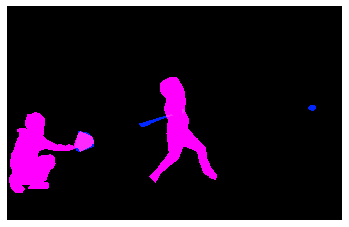

(408, 640, 3)
COCO_val2014_000000068973.jpg
{'person_bbx': [28.14, 175.93, 133.26, 383.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [267.4, 107.49, 332.01, 285.17], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [471.65, 116.19, 529.31, 290.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [28.14, 175.93, 133.26, 383.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [267.4, 107.49, 332.01, 285.17], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [471.65, 116.19, 529.31, 290.05], 'Verbs': 'ski', 'object': {'obj_bbx': [397.38, 267.77, 563.97, 286.60999999999996]}}
skis
person
ski
ski interaction
{'person_bbx': [28.14, 175.93, 133.26, 383.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.4, 107.49, 332.01, 285.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [471.65, 116.19, 529.31, 290.05], 'Verbs': 'stand

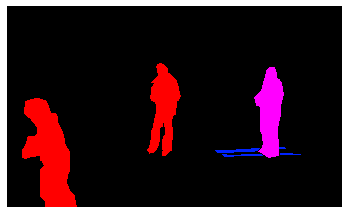

(383, 640, 3)
COCO_val2014_000000531929.jpg
{'person_bbx': [172.62, 29.53, 244.92000000000002, 190.17], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [185.81, 89.79, 197.16, 150.3]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [172.62, 29.53, 244.92000000000002, 190.17], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [61.19, 57.76, 82.5, 70.65]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [354.3, 107.6, 462.66, 267.45], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [362.41, 185.07, 399.70000000000005, 236.04999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [172.62, 29.53, 244.92000000000002, 190.17], 'Verbs': 'hold', 'object': {'obj_bbx': [185.81, 89.79, 197.16, 150.3]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [354.3, 107.6, 462.66, 267.45], 'Verbs': 'hold', 'object': {'obj_bbx': [362.41, 185.07, 399.70000000000005, 236.04999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [172.6

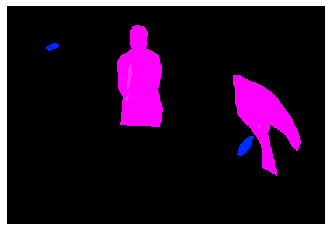

(342, 500, 3)
COCO_val2014_000000476939.jpg
{'person_bbx': [124.08, 130.27, 330.0, 467.78], 'Verbs': 'hold', 'object': {'obj_bbx': [245.79, 256.09, 335.05, 315.59999999999997]}}
person
book
hold
hold interaction
{'person_bbx': [124.08, 130.27, 330.0, 467.78], 'Verbs': 'look', 'object': {'obj_bbx': [245.79, 256.09, 335.05, 315.59999999999997]}}
person
book
look
look interaction
{'person_bbx': [213.73, 129.55, 352.41999999999996, 476.95], 'Verbs': 'look', 'object': {'obj_bbx': [245.79, 256.09, 335.05, 315.59999999999997]}}
person
book
look
look interaction
{'person_bbx': [124.08, 130.27, 330.0, 467.78], 'Verbs': 'read', 'object': {'obj_bbx': [245.79, 256.09, 335.05, 315.59999999999997]}}
person
book
read
read interaction
{'person_bbx': [213.73, 129.55, 352.41999999999996, 476.95], 'Verbs': 'read', 'object': {'obj_bbx': [245.79, 256.09, 335.05, 315.59999999999997]}}
person
book
read
read interaction
{'person_bbx': [124.08, 130.27, 330.0, 467.78], 'Verbs': 'stand', 'object': {'obj_bbx': []

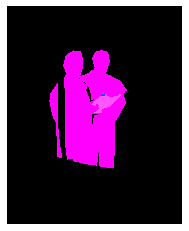

(640, 514, 3)
COCO_val2014_000000191314.jpg
{'person_bbx': [417.44, 63.64, 576.0, 473.53], 'Verbs': 'hold', 'object': {'obj_bbx': [335.46, 182.05, 463.89, 380.23]}}
person
backpack
hold
hold interaction
{'person_bbx': [417.44, 63.64, 576.0, 473.53], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [124.68, 120.94, 291.74, 437.61], 'Verbs': 'look', 'object': {'obj_bbx': [233.54, 231.36, 351.93, 476.17]}}
suitcase
person
look
look interaction
{'person_bbx': [417.44, 63.64, 576.0, 473.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [417.44, 63.64, 576.0, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 266.66, 225.5, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.68, 120.94, 291.74, 437.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


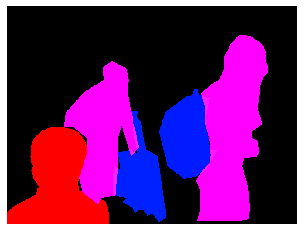

(480, 640, 3)
COCO_val2014_000000000395.jpg
{'person_bbx': [118.61, 138.16, 551.33, 573.48], 'Verbs': 'hold', 'object': {'obj_bbx': [291.15, 289.29, 310.98999999999995, 312.26]}}
cell phone
person
hold
hold interaction
{'person_bbx': [118.61, 138.16, 551.33, 573.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [118.61, 138.16, 551.33, 573.48], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [291.15, 289.29, 310.98999999999995, 312.26]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


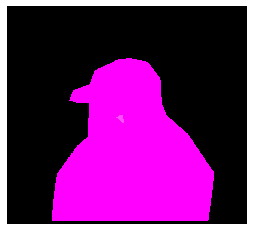

(580, 640, 3)
COCO_val2014_000000344045.jpg
{'person_bbx': [193.93, 78.53, 259.35, 172.91], 'Verbs': 'surf', 'object': {'obj_bbx': [0.0, 99.24, 400.0, 162.68]}}
surfboard
person
surf
surf interaction


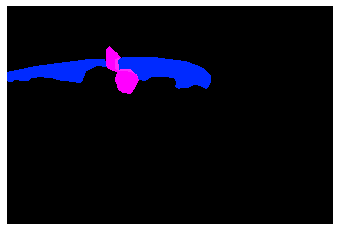

(427, 640, 3)
COCO_val2014_000000525546.jpg
{'person_bbx': [14.29, 108.31, 485.71000000000004, 631.1700000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [9.14, 0.0, 238.92000000000002, 330.62]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [14.29, 108.31, 485.71000000000004, 631.1700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [9.14, 0.0, 238.92000000000002, 330.62]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [14.29, 108.31, 485.71000000000004, 631.1700000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


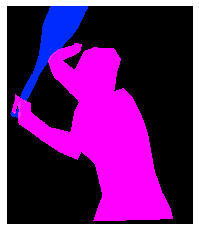

(640, 545, 3)
COCO_val2014_000000390435.jpg
{'person_bbx': [61.29, 66.99, 272.25, 453.27], 'Verbs': 'kick', 'object': {'obj_bbx': [195.06, 227.94, 287.84000000000003, 317.34000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [61.29, 66.99, 272.25, 453.27], 'Verbs': 'look', 'object': {'obj_bbx': [195.06, 227.94, 287.84000000000003, 317.34000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [61.29, 66.99, 272.25, 453.27], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [61.29, 66.99, 272.25, 453.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


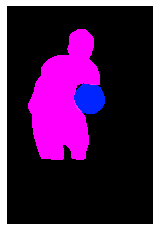

(640, 427, 3)
COCO_val2014_000000400907.jpg
{'person_bbx': [286.21, 160.25, 331.17999999999995, 265.56], 'Verbs': 'carry', 'object': {'obj_bbx': [261.59, 186.59, 317.09, 232.37]}}
person
surfboard
carry
carry interaction
{'person_bbx': [286.21, 160.25, 331.17999999999995, 265.56], 'Verbs': 'hold', 'object': {'obj_bbx': [261.59, 186.59, 317.09, 232.37]}}
person
surfboard
hold
hold interaction
{'person_bbx': [286.21, 160.25, 331.17999999999995, 265.56], 'Verbs': 'look', 'object': {'obj_bbx': [261.59, 186.59, 317.09, 232.37]}}
person
surfboard
look
look interaction
{'person_bbx': [286.21, 160.25, 331.17999999999995, 265.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.21, 160.25, 331.17999999999995, 265.56], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


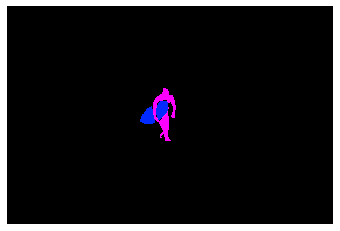

(427, 640, 3)
COCO_val2014_000000068646.jpg
{'person_bbx': [0.0, 0.96, 469.36, 410.69], 'Verbs': 'hold', 'object': {'obj_bbx': [126.0, 347.21, 256.8, 423.19]}}
person
mouse
hold
hold interaction
{'person_bbx': [0.0, 0.96, 469.36, 410.69], 'Verbs': 'look', 'object': {'obj_bbx': [229.42, 39.04, 640.0, 406.31]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 0.96, 469.36, 410.69], 'Verbs': 'sit', 'object': {'obj_bbx': [1.92, 64.44, 31.740000000000002, 245.26]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 0.96, 469.36, 410.69], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [229.42, 39.04, 640.0, 406.31]}}
person
laptop
work_on_computer
work_on_computer interaction


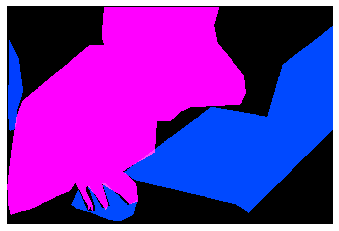

(428, 640, 3)
COCO_val2014_000000221932.jpg
{'person_bbx': [217.89, 2.43, 639.64, 474.88], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [396.45, 169.9, 540.96, 212.05]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [217.89, 2.43, 639.64, 474.88], 'Verbs': 'hold', 'object': {'obj_bbx': [396.45, 169.9, 540.96, 212.05]}}
person
pizza
hold
hold interaction
{'person_bbx': [217.89, 2.43, 639.64, 474.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


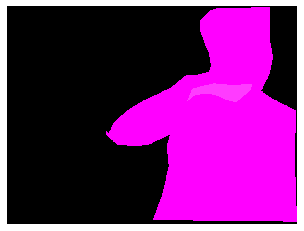

(480, 640, 3)
COCO_val2014_000000236426.jpg
{'person_bbx': [260.69, 64.2, 405.57, 281.24], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [158.8, 229.12, 169.18, 239.75]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [260.69, 64.2, 405.57, 281.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [260.69, 64.2, 405.57, 281.24], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [260.69, 64.2, 405.57, 281.24], 'Verbs': 'look', 'object': {'obj_bbx': [158.8, 229.12, 169.18, 239.75]}}
sports ball
person
look
look interaction
{'person_bbx': [21.35, 95.6, 122.43, 228.6], 'Verbs': 'look', 'object': {'obj_bbx': [260.69, 64.2, 405.57, 281.24]}}
person
person
look
look interaction
{'person_bbx': [260.69, 64.2, 405.57, 281.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [21.35, 95.6, 122.43, 228.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


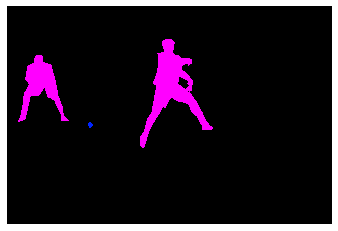

(429, 640, 3)
COCO_val2014_000000479950.jpg
{'person_bbx': [30.59, 111.91, 156.67, 281.27], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [358.11, 115.64, 459.58000000000004, 245.45999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [396.05, 111.02, 500.0, 332.0], 'Verbs': 'look', 'object': {'obj_bbx': [358.11, 115.64, 459.58000000000004, 245.45999999999998]}}
person
person
look
look interaction
{'person_bbx': [30.59, 111.91, 156.67, 281.27], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [30.59, 111.91, 156.67, 281.27], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 196.94, 33.74, 295.17]}}
person
chair
sit
sit interaction
{'person_bbx': [358.11, 115.64, 459.58000000000004, 245.45999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [396.05, 111.02, 500.0, 332.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [358.11, 115.64, 459.58000000000004, 245.4599

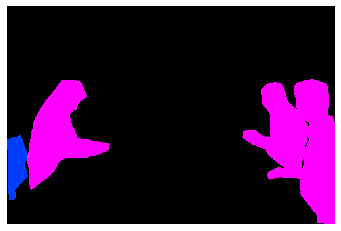

(332, 500, 3)
COCO_val2014_000000073093.jpg
{'person_bbx': [82.92, 149.36, 248.97000000000003, 428.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [162.49, 149.59, 179.10000000000002, 166.65]}}
sports ball
person
hold
hold interaction
{'person_bbx': [46.98, 121.0, 165.59, 364.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [82.92, 149.36, 248.97000000000003, 428.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [82.92, 149.36, 248.97000000000003, 428.09000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [162.49, 149.59, 179.10000000000002, 166.65]}}
sports ball
person
throw
throw interaction


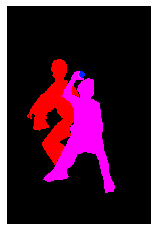

(500, 331, 3)
COCO_val2014_000000420339.jpg
{'person_bbx': [216.3, 159.76, 410.13, 427.61], 'Verbs': 'hold', 'object': {'obj_bbx': [322.07, 240.14, 375.69, 282.95]}}
cell phone
person
hold
hold interaction
{'person_bbx': [216.3, 159.76, 410.13, 427.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [216.3, 159.76, 410.13, 427.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [322.07, 240.14, 375.69, 282.95]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


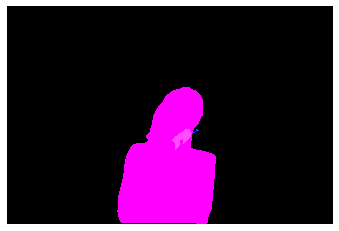

(428, 640, 3)
COCO_val2014_000000446232.jpg
{'person_bbx': [211.76, 157.92, 298.5, 358.14], 'Verbs': 'snowboard', 'object': {'obj_bbx': [172.75, 340.79, 339.55, 364.04]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [211.76, 157.92, 298.5, 358.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


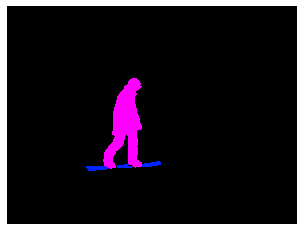

(480, 640, 3)
COCO_val2014_000000339177.jpg
{'person_bbx': [275.5, 151.99, 347.86, 313.11], 'Verbs': 'hold', 'object': {'obj_bbx': [319.22, 180.54, 372.55, 218.2]}}
person
laptop
hold
hold interaction
{'person_bbx': [275.5, 151.99, 347.86, 313.11], 'Verbs': 'look', 'object': {'obj_bbx': [319.22, 180.54, 372.55, 218.2]}}
person
laptop
look
look interaction
{'person_bbx': [275.5, 151.99, 347.86, 313.11], 'Verbs': 'sit', 'object': {'obj_bbx': [230.98, 220.4, 320.25, 333.59000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 251.63, 113.87, 362.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [275.5, 151.99, 347.86, 313.11], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [319.22, 180.54, 372.55, 218.2]}}
person
laptop
work_on_computer
work_on_computer interaction


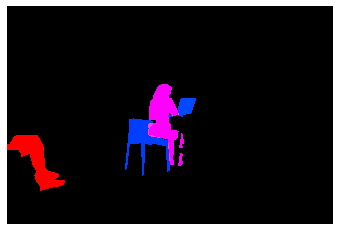

(427, 640, 3)
COCO_val2014_000000576672.jpg
{'person_bbx': [357.57, 88.99, 640.0, 353.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [357.57, 88.99, 640.0, 353.53000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [177.98, 16.18, 542.83, 353.53000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


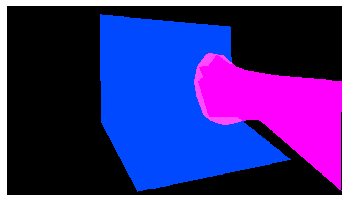

(360, 640, 3)
COCO_val2014_000000547886.jpg
{'person_bbx': [57.19, 130.4, 102.94, 214.28], 'Verbs': 'look', 'object': {'obj_bbx': [13.43, 172.72, 136.26, 269.63]}}
horse
person
look
look interaction
{'person_bbx': [295.37, 137.17, 344.2, 230.7], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [57.19, 130.4, 102.94, 214.28], 'Verbs': 'ride', 'object': {'obj_bbx': [13.43, 172.72, 136.26, 269.63]}}
horse
person
ride
ride interaction
{'person_bbx': [194.32, 126.02, 246.35999999999999, 227.63], 'Verbs': 'ride', 'object': {'obj_bbx': [150.87, 159.18, 285.28, 277.14]}}
horse
person
ride
ride interaction
{'person_bbx': [295.37, 137.17, 344.2, 230.7], 'Verbs': 'ride', 'object': {'obj_bbx': [272.66, 178.25, 374.1, 284.45]}}
horse
person
ride
ride interaction
{'person_bbx': [57.19, 130.4, 102.94, 214.28], 'Verbs': 'sit', 'object': {'obj_bbx': [13.43, 172.72, 136.26, 269.63]}}
horse
person
sit
sit interaction
{'person_bbx': [194.32, 126.02, 246.35999999999999, 227.63], 'Verb

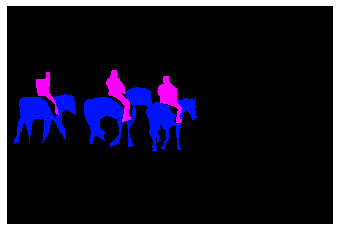

(427, 640, 3)
COCO_val2014_000000484351.jpg
{'person_bbx': [242.15, 216.18, 467.32, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [242.15, 216.18, 467.32, 426.0], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [388.67, 113.92, 570.55, 421.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [242.15, 216.18, 467.32, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [388.67, 113.92, 570.55, 421.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


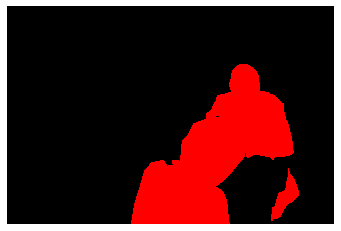

(426, 640, 3)
COCO_val2014_000000215151.jpg
{'person_bbx': [323.27, 56.6, 432.11, 348.3], 'Verbs': 'hold', 'object': {'obj_bbx': [343.76, 259.48, 386.46, 384.73]}}
person
skateboard
hold
hold interaction
{'person_bbx': [64.57, 32.23, 342.24, 442.28000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [308.08, 292.91, 353.57, 433.06000000000006]}}
person
skateboard
jump
jump interaction
{'person_bbx': [64.57, 32.23, 342.24, 442.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [308.08, 292.91, 353.57, 433.06000000000006]}}
person
skateboard
look
look interaction
{'person_bbx': [323.27, 56.6, 432.11, 348.3], 'Verbs': 'look', 'object': {'obj_bbx': [308.08, 292.91, 353.57, 433.06000000000006]}}
person
skateboard
look
look interaction
{'person_bbx': [64.57, 32.23, 342.24, 442.28000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [308.08, 292.91, 353.57, 433.06000000000006]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [64.57, 32.23, 342.24, 442.280000000

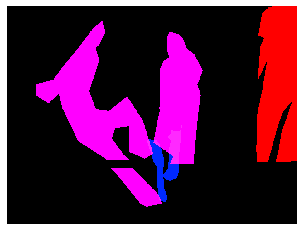

(480, 640, 3)
COCO_val2014_000000190095.jpg
{'person_bbx': [266.79, 69.66, 368.15000000000003, 160.1], 'Verbs': 'look', 'object': {'obj_bbx': [367.12, 154.18, 410.87, 182.39000000000001]}}
surfboard
person
look
look interaction
{'person_bbx': [266.79, 69.66, 368.15000000000003, 160.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [266.79, 69.66, 368.15000000000003, 160.1], 'Verbs': 'surf', 'object': {'obj_bbx': [367.12, 154.18, 410.87, 182.39000000000001]}}
surfboard
person
surf
surf interaction


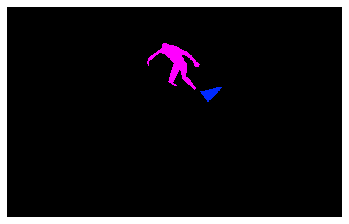

(402, 640, 3)
COCO_val2014_000000191585.jpg
{'person_bbx': [332.92, 180.81, 402.79, 286.43], 'Verbs': 'carry', 'object': {'obj_bbx': [326.92, 283.35, 413.5, 367.57000000000005]}}
suitcase
person
carry
carry interaction
{'person_bbx': [440.72, 161.87, 513.96, 337.78999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [450.38, 214.73, 476.88, 264.44]}}
handbag
person
carry
carry interaction
{'person_bbx': [292.51, 179.95, 343.32, 295.73], 'Verbs': 'carry', 'object': {'obj_bbx': [282.06, 262.25, 344.49, 347.6]}}
suitcase
person
carry
carry interaction
{'person_bbx': [332.92, 180.81, 402.79, 286.43], 'Verbs': 'hold', 'object': {'obj_bbx': [326.92, 283.35, 413.5, 367.57000000000005]}}
suitcase
person
hold
hold interaction
{'person_bbx': [292.51, 179.95, 343.32, 295.73], 'Verbs': 'hold', 'object': {'obj_bbx': [282.06, 262.25, 344.49, 347.6]}}
suitcase
person
hold
hold interaction
{'person_bbx': [332.92, 180.81, 402.79, 286.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'pe

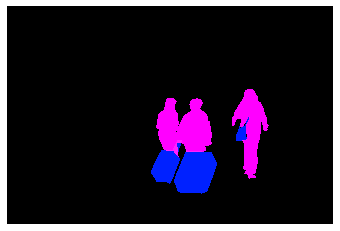

(427, 640, 3)
COCO_val2014_000000234347.jpg
{'person_bbx': [414.2, 21.57, 640.0, 468.13], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [338.7, 107.87, 587.87, 474.61]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 254.36, 239.46, 471.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [414.2, 21.57, 640.0, 468.13], 'Verbs': 'hold', 'object': {'obj_bbx': [338.7, 107.87, 587.87, 474.61]}}
person
banana
hold
hold interaction
{'person_bbx': [2.16, 2.7, 460.54, 407.03], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


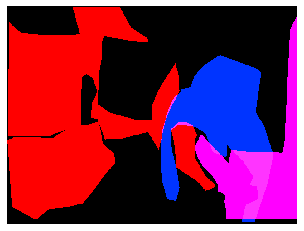

(480, 640, 3)
COCO_val2014_000000555696.jpg
{'person_bbx': [99.04, 125.53, 234.47000000000003, 371.82], 'Verbs': 'kick', 'object': {'obj_bbx': [26.06, 324.36, 59.64, 356.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [99.04, 125.53, 234.47000000000003, 371.82], 'Verbs': 'look', 'object': {'obj_bbx': [26.06, 324.36, 59.64, 356.86]}}
sports ball
person
look
look interaction
{'person_bbx': [460.7, 145.59, 595.01, 334.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [26.06, 324.36, 59.64, 356.86]}}
sports ball
person
look
look interaction
{'person_bbx': [372.9, 177.74, 488.55999999999995, 389.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [26.06, 324.36, 59.64, 356.86]}}
sports ball
person
look
look interaction
{'person_bbx': [99.04, 125.53, 234.47000000000003, 371.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [460.7, 145.59, 595.01, 334.96000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [372.9, 1

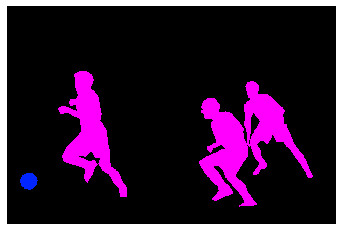

(424, 640, 3)
COCO_val2014_000000079070.jpg
{'person_bbx': [106.39, 73.14, 367.38, 568.52], 'Verbs': 'hold', 'object': {'obj_bbx': [210.28, 251.0, 286.48, 289.1]}}
bench
person
hold
hold interaction
{'person_bbx': [106.39, 73.14, 367.38, 568.52], 'Verbs': 'sit', 'object': {'obj_bbx': [110.49, 355.8, 246.82, 523.7]}}
bench
person
sit
sit interaction


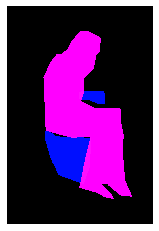

(640, 427, 3)
COCO_val2014_000000467580.jpg
{'person_bbx': [209.65, 126.36, 336.97, 235.5], 'Verbs': 'look', 'object': {'obj_bbx': [327.77, 203.59, 346.56, 237.87]}}
surfboard
person
look
look interaction
{'person_bbx': [209.65, 126.36, 336.97, 235.5], 'Verbs': 'surf', 'object': {'obj_bbx': [327.77, 203.59, 346.56, 237.87]}}
surfboard
person
surf
surf interaction


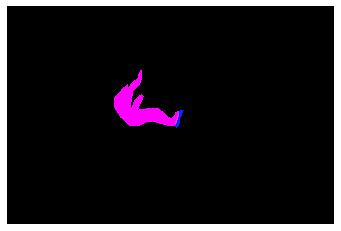

(426, 640, 3)
COCO_val2014_000000365701.jpg
{'person_bbx': [132.44, 215.58, 288.32, 601.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [132.44, 215.58, 288.32, 601.21], 'Verbs': 'throw', 'object': {'obj_bbx': [264.7, 377.02, 280.12, 392.97999999999996]}}
sports ball
person
throw
throw interaction


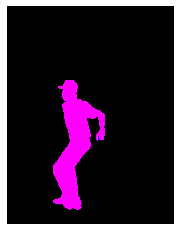

(640, 489, 3)
COCO_val2014_000000203416.jpg
{'person_bbx': [189.55, 53.45, 426.0, 331.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [189.55, 53.45, 426.0, 331.07], 'Verbs': 'sit', 'object': {'obj_bbx': [212.74, 128.84, 250.03, 338.78]}}
chair
person
sit
sit interaction
{'person_bbx': [189.55, 53.45, 426.0, 331.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


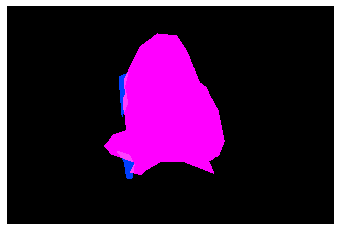

(426, 640, 3)
COCO_val2014_000000514049.jpg
{'person_bbx': [206.0, 229.06, 234.96, 321.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [312.81, 238.42, 362.9, 322.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


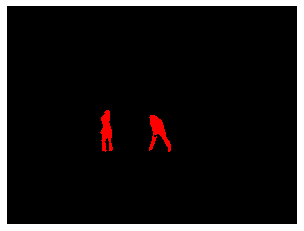

(480, 640, 3)
COCO_val2014_000000136433.jpg
{'person_bbx': [95.22, 0.96, 256.8, 421.27], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 278.92, 65.4, 423.19000000000005]}}
person
suitcase
carry
carry interaction
{'person_bbx': [95.22, 0.96, 256.8, 421.27], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 278.92, 65.4, 423.19000000000005]}}
person
suitcase
hold
hold interaction
{'person_bbx': [95.22, 0.96, 256.8, 421.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [95.22, 0.96, 256.8, 421.27], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


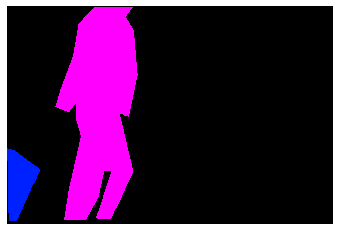

(428, 640, 3)
COCO_val2014_000000044476.jpg
{'person_bbx': [234.43, 90.61, 457.35, 566.65], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [5.74, 126.45, 295.61, 607.16], 'Verbs': 'kick', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
sports ball
person
kick
kick interaction
{'person_bbx': [234.43, 90.61, 457.35, 566.65], 'Verbs': 'kick', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
sports ball
person
kick
kick interaction
{'person_bbx': [5.74, 126.45, 295.61, 607.16], 'Verbs': 'look', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
sports ball
person
look
look interaction
{'person_bbx': [234.43, 90.61, 457.35, 566.65], 'Verbs': 'look', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
sports ball
person
look
look interaction
{'person_bbx': [13.59, 64.81, 167.42000000000002, 502.34], 'Verbs': 'look', 'object': {'obj_bbx': [353.72, 542.74, 434.68, 625.97]}}
s

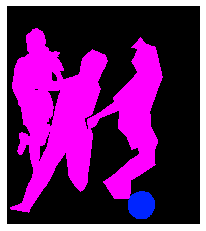

(640, 566, 3)
COCO_val2014_000000411086.jpg
{'person_bbx': [1.07, 122.52, 243.76, 461.84999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [140.15, 351.42, 214.64, 367.69]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.07, 122.52, 243.76, 461.84999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [140.15, 351.42, 214.64, 367.69]}}
person
knife
hold
hold interaction
{'person_bbx': [408.94, 69.44, 638.34, 472.15], 'Verbs': 'hold', 'object': {'obj_bbx': [428.92, 271.27, 472.83000000000004, 297.39]}}
knife
person
hold
hold interaction
{'person_bbx': [1.07, 122.52, 243.76, 461.84999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [140.15, 351.42, 214.64, 367.69]}}
person
knife
look
look interaction
{'person_bbx': [408.94, 69.44, 638.34, 472.15], 'Verbs': 'look', 'object': {'obj_bbx': [428.92, 271.27, 472.83000000000004, 297.39]}}
knife
person
look
look interaction
{'person_bbx': [1.07, 122.52, 243.76, 461.84999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': 

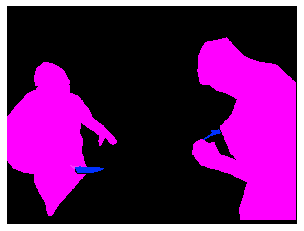

(480, 640, 3)
COCO_val2014_000000094046.jpg
{'person_bbx': [152.77, 108.55, 467.69000000000005, 552.12], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [359.53, 367.07, 439.75, 456.01]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [152.77, 108.55, 467.69000000000005, 552.12], 'Verbs': 'hold', 'object': {'obj_bbx': [359.53, 367.07, 439.75, 456.01]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [152.77, 108.55, 467.69000000000005, 552.12], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [152.77, 108.55, 467.69000000000005, 552.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


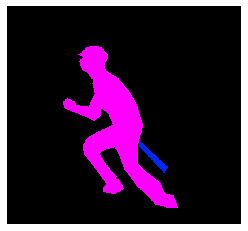

(595, 640, 3)
COCO_val2014_000000357916.jpg
{'person_bbx': [108.26, 20.61, 489.78999999999996, 333.0], 'Verbs': 'hold', 'object': {'obj_bbx': [450.25, 299.32, 472.13, 314.84]}}
sports ball
person
hold
hold interaction
{'person_bbx': [108.26, 20.61, 489.78999999999996, 333.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [108.26, 20.61, 489.78999999999996, 333.0], 'Verbs': 'throw', 'object': {'obj_bbx': [450.25, 299.32, 472.13, 314.84]}}
sports ball
person
throw
throw interaction


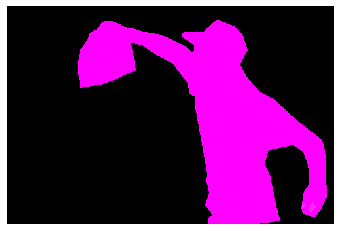

(333, 500, 3)
COCO_val2014_000000247317.jpg
{'person_bbx': [338.09, 91.69, 624.6099999999999, 419.27], 'Verbs': 'drink', 'object': {'obj_bbx': [373.21, 209.77, 431.32, 233.24]}}
person
bowl
drink
drink interaction
{'person_bbx': [338.09, 91.69, 624.6099999999999, 419.27], 'Verbs': 'hold', 'object': {'obj_bbx': [373.21, 209.77, 431.32, 233.24]}}
person
bowl
hold
hold interaction
{'person_bbx': [338.09, 91.69, 624.6099999999999, 419.27], 'Verbs': 'sit', 'object': {'obj_bbx': [608.96, 265.39, 640.0, 425.0]}}
person
chair
sit
sit interaction


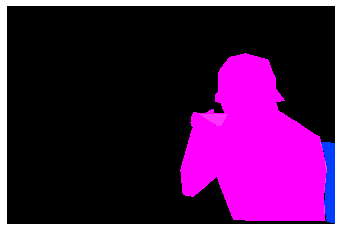

(425, 640, 3)
COCO_val2014_000000396541.jpg
{'person_bbx': [3.24, 23.73, 399.1, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [255.71, 103.48, 497.34000000000003, 359.19]}}
person
laptop
look
look interaction
{'person_bbx': [3.24, 23.73, 399.1, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.24, 23.73, 399.1, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [255.71, 103.48, 497.34000000000003, 359.19]}}
person
laptop
work_on_computer
work_on_computer interaction


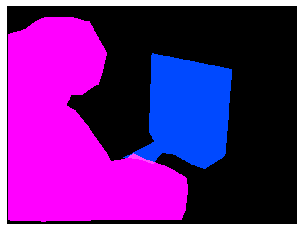

(480, 640, 3)
COCO_val2014_000000356424.jpg
{'person_bbx': [35.24, 68.73, 337.3, 457.61], 'Verbs': 'look', 'object': {'obj_bbx': [2.88, 386.97, 480.0, 631.47]}}
dining table
person
look
look interaction
{'person_bbx': [35.24, 68.73, 337.3, 457.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [35.24, 68.73, 337.3, 457.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


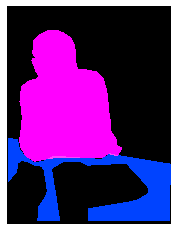

(640, 480, 3)
COCO_val2014_000000457400.jpg
{'person_bbx': [398.21, 2.28, 640.0, 332.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [398.21, 2.28, 640.0, 332.67999999999995], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [398.21, 2.28, 640.0, 332.67999999999995], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read


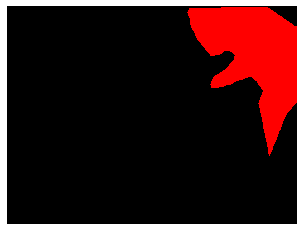

(480, 640, 3)
COCO_val2014_000000099416.jpg
{'person_bbx': [29.68, 35.42, 524.6, 421.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [29.68, 35.42, 524.6, 421.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [454.72, 359.5, 491.35, 426.0]}}
tie
person
look
look interaction
{'person_bbx': [371.43, 73.71, 638.52, 421.21], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [29.68, 35.42, 524.6, 421.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [371.43, 73.71, 638.52, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [29.68, 35.42, 524.6, 421.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


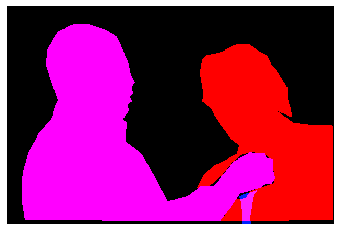

(426, 640, 3)
COCO_val2014_000000390147.jpg
{'person_bbx': [48.97, 163.15, 82.55, 255.64], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [238.92, 175.12, 297.43, 293.77], 'Verbs': 'hold', 'object': {'obj_bbx': [234.21, 206.46, 252.37, 219.60000000000002]}}
person
frisbee
hold
hold interaction
{'person_bbx': [238.92, 175.12, 297.43, 293.77], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [4.33, 163.37, 38.809999999999995, 255.75], 'Verbs': 'look', 'object': {'obj_bbx': [238.92, 175.12, 297.43, 293.77]}}
person
person
look
look interaction
{'person_bbx': [238.92, 175.12, 297.43, 293.77], 'Verbs': 'look', 'object': {'obj_bbx': [234.21, 206.46, 252.37, 219.60000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [4.33, 163.37, 38.809999999999995, 255.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [238.92, 175.12, 297.43, 293.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_

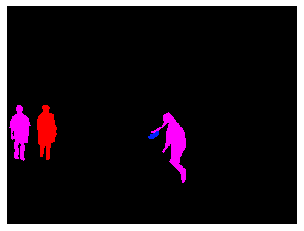

(360, 480, 3)
COCO_val2014_000000401833.jpg
{'person_bbx': [14.61, 11.24, 437.0, 493.26], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [14.61, 11.24, 437.0, 493.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


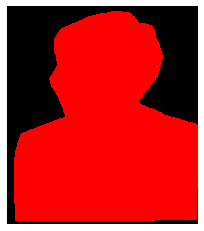

(500, 437, 3)
COCO_val2014_000000417965.jpg
{'person_bbx': [225.44, 111.86, 412.03999999999996, 474.28000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [187.69, 263.94, 429.3, 384.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [51.89, 45.41, 288.65, 478.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [187.69, 263.94, 429.3, 384.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [225.44, 111.86, 412.03999999999996, 474.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [187.69, 263.94, 429.3, 384.75]}}
person
surfboard
look
look interaction
{'person_bbx': [51.89, 45.41, 288.65, 478.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [187.69, 263.94, 429.3, 384.75]}}
person
surfboard
look
look interaction
{'person_bbx': [225.44, 111.86, 412.03999999999996, 474.28000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [51.89, 45.41, 288.65, 478.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
st

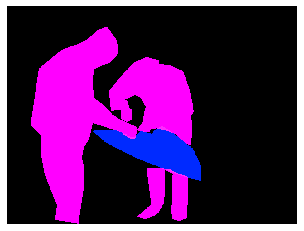

(480, 640, 3)
COCO_val2014_000000014248.jpg
{'person_bbx': [240.54, 0.0, 620.22, 435.78], 'Verbs': 'hold', 'object': {'obj_bbx': [314.23, 266.42, 418.06, 330.15000000000003]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [240.54, 0.0, 620.22, 435.78], 'Verbs': 'lay', 'object': {'obj_bbx': [1.25, 0.0, 640.0, 473.77]}}
person
bed
lay
lay interaction
{'person_bbx': [240.54, 0.0, 620.22, 435.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


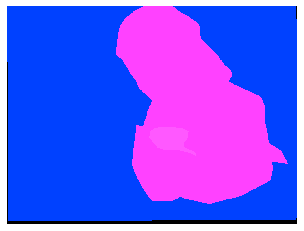

(480, 640, 3)
COCO_val2014_000000159738.jpg
{'person_bbx': [141.05, 89.95, 209.46, 193.82999999999998], 'Verbs': 'carry', 'object': {'obj_bbx': [96.09, 40.5, 314.03, 252.95]}}
person
surfboard
carry
carry interaction
{'person_bbx': [141.05, 89.95, 209.46, 193.82999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [96.09, 40.5, 314.03, 252.95]}}
person
surfboard
hold
hold interaction
{'person_bbx': [220.49, 189.64, 285.05, 277.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [141.05, 89.95, 209.46, 193.82999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [220.49, 189.64, 285.05, 277.68], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [141.05, 89.95, 209.46, 193.82999999999998], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


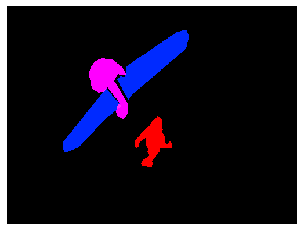

(375, 500, 3)
COCO_val2014_000000144243.jpg
{'person_bbx': [240.97, 121.21, 356.64, 301.45], 'Verbs': 'look', 'object': {'obj_bbx': [559.51, 270.92, 591.24, 302.89]}}
sports ball
person
look
look interaction
{'person_bbx': [504.9, 130.9, 594.4499999999999, 271.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [559.51, 270.92, 591.24, 302.89]}}
sports ball
person
look
look interaction
{'person_bbx': [17.19, 163.06, 84.67, 284.35], 'Verbs': 'look', 'object': {'obj_bbx': [559.51, 270.92, 591.24, 302.89]}}
sports ball
person
look
look interaction
{'person_bbx': [589.28, 131.63, 640.0, 277.43], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [240.97, 121.21, 356.64, 301.45], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [504.9, 130.9, 594.4499999999999, 271.95000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [17.19, 163.06, 84.67, 284.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx'

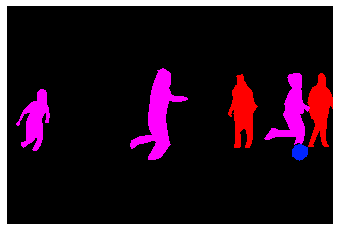

(427, 640, 3)
COCO_val2014_000000536428.jpg
{'person_bbx': [442.53, 80.68, 572.0, 403.40000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': [451.85, 160.35, 494.23, 189.57]}}
person
frisbee
catch
catch interaction
{'person_bbx': [442.53, 80.68, 572.0, 403.40000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [451.85, 160.35, 494.23, 189.57]}}
person
frisbee
hold
hold interaction
{'person_bbx': [442.53, 80.68, 572.0, 403.40000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [208.96, 157.5, 314.3, 380.88], 'Verbs': 'look', 'object': {'obj_bbx': [451.85, 160.35, 494.23, 189.57]}}
person
frisbee
look
look interaction
{'person_bbx': [442.53, 80.68, 572.0, 403.40000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [208.96, 157.5, 314.3, 380.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [442.53, 80.68, 572.0, 403.40000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'per

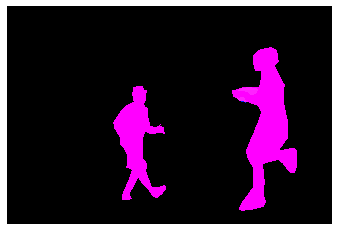

(429, 640, 3)
COCO_val2014_000000517855.jpg
{'person_bbx': [103.55, 115.06, 296.27, 579.6], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [89.81, 363.36, 128.43, 411.63]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [103.55, 115.06, 296.27, 579.6], 'Verbs': 'hold', 'object': {'obj_bbx': [89.81, 363.36, 128.43, 411.63]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [103.55, 115.06, 296.27, 579.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.55, 115.06, 296.27, 579.6], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


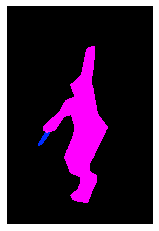

(640, 427, 3)
COCO_val2014_000000292456.jpg
{'person_bbx': [184.55, 45.56, 312.64, 300.9], 'Verbs': 'carry', 'object': {'obj_bbx': [149.25, 153.67, 223.85, 219.14]}}
person
handbag
carry
carry interaction
{'person_bbx': [129.91, 31.93, 190.26, 270.26], 'Verbs': 'carry', 'object': {'obj_bbx': [149.25, 153.67, 223.85, 219.14]}}
person
handbag
carry
carry interaction
{'person_bbx': [184.55, 45.56, 312.64, 300.9], 'Verbs': 'hold', 'object': {'obj_bbx': [149.25, 153.67, 223.85, 219.14]}}
person
handbag
hold
hold interaction
{'person_bbx': [129.91, 31.93, 190.26, 270.26], 'Verbs': 'hold', 'object': {'obj_bbx': [149.25, 153.67, 223.85, 219.14]}}
person
handbag
hold
hold interaction
{'person_bbx': [184.55, 45.56, 312.64, 300.9], 'Verbs': 'look', 'object': {'obj_bbx': [129.91, 31.93, 190.26, 270.26]}}
person
person
look
look interaction
{'person_bbx': [129.91, 31.93, 190.26, 270.26], 'Verbs': 'look', 'object': {'obj_bbx': [184.55, 45.56, 312.64, 300.9]}}
person
person
look
look interaction
{'pe

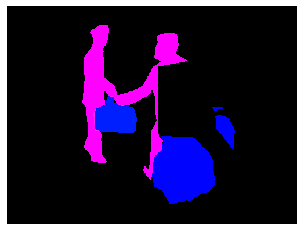

(375, 500, 3)
COCO_val2014_000000081274.jpg
{'person_bbx': [116.52, 48.71, 556.8, 319.94], 'Verbs': 'drink', 'object': {'obj_bbx': [122.73, 110.51, 249.66000000000003, 243.36]}}
person
cup
drink
drink interaction
{'person_bbx': [116.52, 48.71, 556.8, 319.94], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [387.62, 242.99, 448.44, 276.55]}}
person
broccoli
eat_obj
eat_obj interaction
{'person_bbx': [116.52, 48.71, 556.8, 319.94], 'Verbs': 'hold', 'object': {'obj_bbx': [122.73, 110.51, 249.66000000000003, 243.36]}}
person
cup
hold
hold interaction
{'person_bbx': [116.52, 48.71, 556.8, 319.94], 'Verbs': 'sit', 'object': {'obj_bbx': [194.03, 149.01, 533.4, 264.07]}}
person
chair
sit
sit interaction
{'person_bbx': [116.52, 48.71, 556.8, 319.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


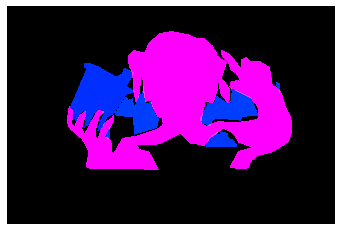

(425, 640, 3)
COCO_val2014_000000097967.jpg
{'person_bbx': [166.21, 26.11, 220.21, 183.86], 'Verbs': 'carry', 'object': {'obj_bbx': [153.95, 80.14, 194.5, 131.41]}}
handbag
person
carry
carry interaction
{'person_bbx': [205.74, 24.71, 253.44, 166.64000000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [166.21, 26.11, 220.21, 183.86], 'Verbs': 'hold', 'object': {'obj_bbx': [153.95, 80.14, 194.5, 131.41]}}
handbag
person
hold
hold interaction
{'person_bbx': [67.87, 10.18, 123.96000000000001, 192.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [205.74, 24.71, 253.44, 166.64000000000001], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [166.21, 26.11, 220.21, 183.86], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [205.74, 24.71, 253.44, 166.64000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [166.21, 26.11, 220.21, 183.86], 'Verbs': 'stand', 'obj

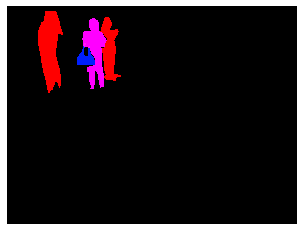

(480, 640, 3)
COCO_val2014_000000512869.jpg
{'person_bbx': [84.87, 1.0, 432.83, 329.38], 'Verbs': 'sit', 'object': {'obj_bbx': [166.03, 147.1, 194.97, 230.20999999999998]}}
chair
person
sit
sit interaction
{'person_bbx': [84.87, 1.0, 432.83, 329.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


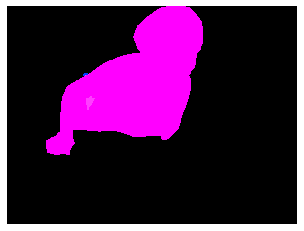

(480, 640, 3)
COCO_val2014_000000436791.jpg
{'person_bbx': [65.85, 4.6, 565.54, 422.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [139.27, 144.14, 263.93, 274.07]}}
cell phone
person
hold
hold interaction
{'person_bbx': [65.85, 4.6, 565.54, 422.95000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [65.85, 4.6, 565.54, 422.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [65.85, 4.6, 565.54, 422.95000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [139.27, 144.14, 263.93, 274.07]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


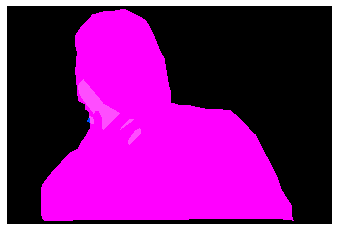

(429, 640, 3)
COCO_val2014_000000023294.jpg
{'person_bbx': [324.96, 132.51, 418.46, 358.96], 'Verbs': 'carry', 'object': {'obj_bbx': [136.34, 173.38, 489.81000000000006, 269.49]}}
person
surfboard
carry
carry interaction
{'person_bbx': [90.95, 101.58, 192.44, 355.29], 'Verbs': 'carry', 'object': {'obj_bbx': [136.34, 173.38, 489.81000000000006, 269.49]}}
surfboard
person
carry
carry interaction
{'person_bbx': [324.96, 132.51, 418.46, 358.96], 'Verbs': 'hold', 'object': {'obj_bbx': [136.34, 173.38, 489.81000000000006, 269.49]}}
person
surfboard
hold
hold interaction
{'person_bbx': [90.95, 101.58, 192.44, 355.29], 'Verbs': 'hold', 'object': {'obj_bbx': [136.34, 173.38, 489.81000000000006, 269.49]}}
surfboard
person
hold
hold interaction
{'person_bbx': [90.95, 101.58, 192.44, 355.29], 'Verbs': 'look', 'object': {'obj_bbx': [115.15, 106.51, 163.12, 277.31]}}
person
person
look
look interaction
{'person_bbx': [324.96, 132.51, 418.46, 358.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pers

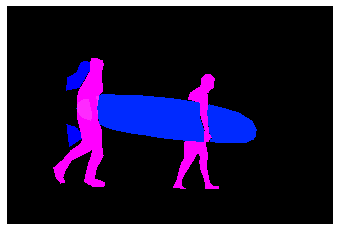

(427, 640, 3)
COCO_val2014_000000219558.jpg
{'person_bbx': [274.72, 125.56, 380.90000000000003, 370.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [324.54, 159.05, 333.92, 181.07000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [274.72, 125.56, 380.90000000000003, 370.78999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.72, 125.56, 380.90000000000003, 370.78999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [324.54, 159.05, 333.92, 181.07000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [274.72, 125.56, 380.90000000000003, 370.78999999999996], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


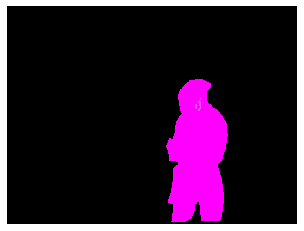

(375, 500, 3)
COCO_val2014_000000158882.jpg
{'person_bbx': [180.33, 240.2, 235.95000000000002, 286.2], 'Verbs': 'surf', 'object': {'obj_bbx': [176.41, 283.34, 206.15, 297.27]}}
person
surfboard
surf
surf interaction


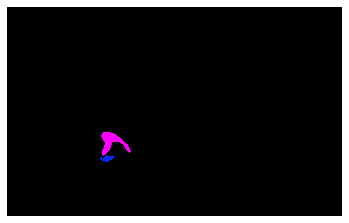

(400, 640, 3)
COCO_val2014_000000577893.jpg
{'person_bbx': [138.69, 112.33, 336.61, 534.1800000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [178.47, 115.65, 351.62, 189.06]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [138.69, 112.33, 336.61, 534.1800000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [178.47, 115.65, 351.62, 189.06]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [138.69, 112.33, 336.61, 534.1800000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


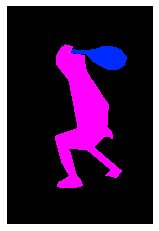

(640, 427, 3)
COCO_val2014_000000043657.jpg
{'person_bbx': [118.82, 176.97, 171.07, 270.51], 'Verbs': 'catch', 'object': {'obj_bbx': [212.64, 227.39, 221.42, 235.29]}}
sports ball
person
catch
catch interaction
{'person_bbx': [118.82, 176.97, 171.07, 270.51], 'Verbs': 'hold', 'object': {'obj_bbx': [157.17, 215.3, 173.48, 244.10000000000002]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [46.76, 119.5, 115.72999999999999, 275.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [118.82, 176.97, 171.07, 270.51], 'Verbs': 'look', 'object': {'obj_bbx': [212.64, 227.39, 221.42, 235.29]}}
sports ball
person
look
look interaction
{'person_bbx': [46.76, 119.5, 115.72999999999999, 275.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


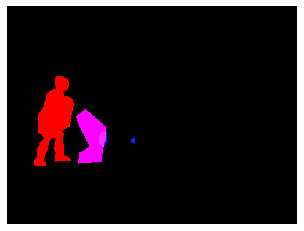

(375, 500, 3)
COCO_val2014_000000366822.jpg
{'person_bbx': [188.16, 137.03, 356.63, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [222.81, 233.02, 329.67, 374.72]}}
person
snowboard
hold
hold interaction
{'person_bbx': [309.12, 78.97, 478.03999999999996, 367.82000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [394.0, 124.0, 466.0, 368.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [53.7, 93.52, 211.11, 369.44], 'Verbs': 'hold', 'object': {'obj_bbx': [91.59, 189.69, 190.07, 291.19]}}
snowboard
person
hold
hold interaction
{'person_bbx': [188.16, 137.03, 356.63, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [309.12, 78.97, 478.03999999999996, 367.82000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [53.7, 93.52, 211.11, 369.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [188.16, 137.03, 356.63, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_b

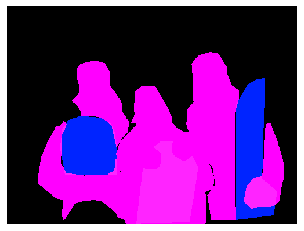

(375, 500, 3)
COCO_val2014_000000251370.jpg
{'person_bbx': [308.25, 170.11, 402.07, 281.15000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [322.61, 259.76, 406.77, 282.61]}}
person
surfboard
look
look interaction
{'person_bbx': [308.25, 170.11, 402.07, 281.15000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [322.61, 259.76, 406.77, 282.61]}}
person
surfboard
surf
surf interaction


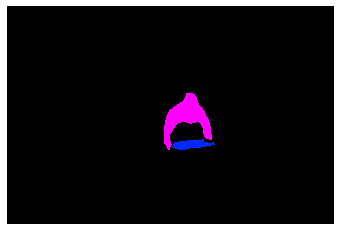

(426, 640, 3)
COCO_val2014_000000034417.jpg
{'person_bbx': [339.45, 54.81, 380.93, 122.53], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [381.95, 64.49, 438.16999999999996, 120.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [339.45, 54.81, 380.93, 122.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


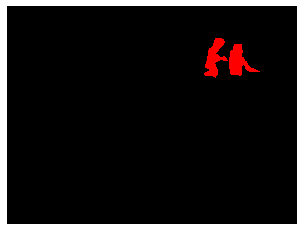

(375, 500, 3)
COCO_val2014_000000356394.jpg
{'person_bbx': [429.95, 238.37, 543.59, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [457.35, 276.13, 532.85, 386.15999999999997]}}
person
backpack
carry
carry interaction
{'person_bbx': [0.0, 261.04, 111.68, 473.66], 'Verbs': 'carry', 'object': {'obj_bbx': [2.49, 300.47, 57.35, 396.47]}}
person
backpack
carry
carry interaction
{'person_bbx': [429.95, 238.37, 543.59, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [440.47, 386.26, 509.36, 474.35]}}
person
bicycle
hold
hold interaction
{'person_bbx': [209.89, 282.85, 302.24, 479.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [220.22, 412.87, 247.43, 477.07]}}
person
bicycle
hold
hold interaction
{'person_bbx': [0.0, 261.04, 111.68, 473.66], 'Verbs': 'hold', 'object': {'obj_bbx': [20.86, 411.64, 151.83999999999997, 480.0]}}
person
bicycle
hold
hold interaction
{'person_bbx': [209.89, 282.85, 302.24, 479.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [313.32, 280.17, 365.05, 

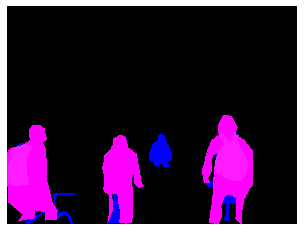

(480, 640, 3)
COCO_val2014_000000187285.jpg
{'person_bbx': [332.22, 202.52, 476.79, 312.45000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [332.22, 202.52, 476.79, 312.45000000000005], 'Verbs': 'surf', 'object': {'obj_bbx': [323.55, 284.2, 407.54, 311.46999999999997]}}
surfboard
person
surf
surf interaction


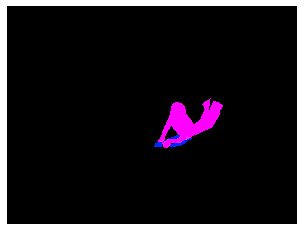

(480, 640, 3)
COCO_val2014_000000140642.jpg
{'person_bbx': [2.87, 256.54, 296.79, 421.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [379.02, 166.0, 493.21, 420.28]}}
person
person
look
look interaction
{'person_bbx': [379.02, 166.0, 493.21, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': [378.33, 260.85, 402.68, 288.02000000000004]}}
person
cup
look
look interaction
{'person_bbx': [158.26, 122.65, 262.71, 361.32], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [2.87, 256.54, 296.79, 421.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [136.07, 349.36, 251.93, 410.78000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [379.02, 166.0, 493.21, 420.28], 'Verbs': 'sit', 'object': {'obj_bbx': [462.89, 267.34, 521.79, 422.86]}}
chair
person
sit
sit interaction
{'person_bbx': [530.86, 158.68, 640.0, 421.23], 'Verbs': 'sit', 'object': {'obj_bbx': [543.83, 293.09, 573.58, 426.42999999999995]}}
person
chair
sit
sit interaction
{'person_bbx': [97.

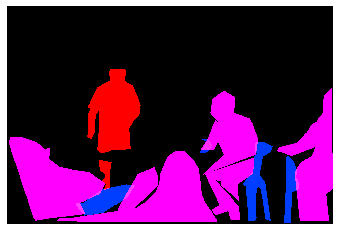

(427, 640, 3)
COCO_val2014_000000109537.jpg
{'person_bbx': [346.61, 106.21, 438.93, 184.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [346.61, 106.21, 438.93, 184.13], 'Verbs': 'surf', 'object': {'obj_bbx': [373.55, 154.24, 411.13, 212.65]}}
person
surfboard
surf
surf interaction


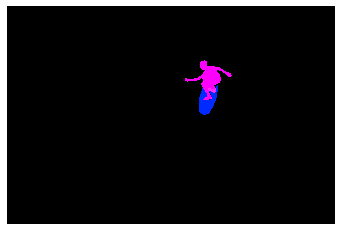

(425, 640, 3)
COCO_val2014_000000574404.jpg
{'person_bbx': [35.27, 81.96, 430.7, 606.2], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [150.22, 267.73, 268.19, 376.07000000000005]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [35.27, 81.96, 430.7, 606.2], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [203.86, 322.29, 240.48000000000002, 348.94]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [35.27, 81.96, 430.7, 606.2], 'Verbs': 'hold', 'object': {'obj_bbx': [150.22, 267.73, 268.19, 376.07000000000005]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [35.27, 81.96, 430.7, 606.2], 'Verbs': 'look', 'object': {'obj_bbx': [203.86, 322.29, 240.48000000000002, 348.94]}}
person
sports ball
look
look interaction
{'person_bbx': [35.27, 81.96, 430.7, 606.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


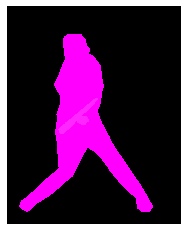

(640, 512, 3)
COCO_val2014_000000226119.jpg
{'person_bbx': [280.63, 127.58, 497.34000000000003, 341.04], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [205.3, 293.49, 305.84000000000003, 323.76]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [280.63, 127.58, 497.34000000000003, 341.04], 'Verbs': 'hold', 'object': {'obj_bbx': [289.88, 202.91, 392.95, 339.45]}}
person
person
hold
hold interaction
{'person_bbx': [280.63, 127.58, 497.34000000000003, 341.04], 'Verbs': 'look', 'object': {'obj_bbx': [205.3, 293.49, 305.84000000000003, 323.76]}}
person
cake
look
look interaction
{'person_bbx': [280.63, 127.58, 497.34000000000003, 341.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


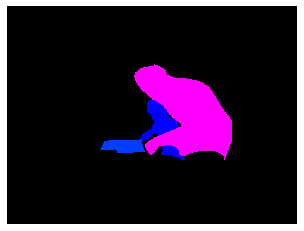

(480, 640, 3)
COCO_val2014_000000465822.jpg
{'person_bbx': [326.39, 160.74, 449.15, 346.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [65.73, 48.03, 225.0, 266.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [53.93, 108.71, 164.33, 273.88], 'Verbs': 'look', 'object': {'obj_bbx': [247.85, 252.12, 378.87, 349.11]}}
laptop
person
look
look interaction
{'person_bbx': [326.39, 160.74, 449.15, 346.25], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [65.73, 48.03, 225.0, 266.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [53.93, 108.71, 164.33, 273.88], 'Verbs': 'sit', 'object': {'obj_bbx': [0.05, 246.46, 49.98, 307.15]}}
person
chair
sit
sit interaction
{'person_bbx': [326.39, 160.74, 449.15, 346.25], 'Verbs': 'sit', 'object': {'obj_bbx': [0.05, 246.46, 49.98, 307.15]}}
person
chair
sit
sit interaction
{'person_bbx': [65.73, 48.03, 225.0, 266.28999999999996],

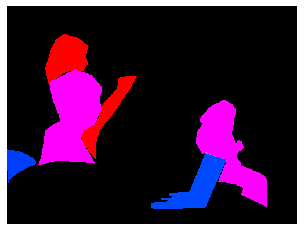

(375, 500, 3)
COCO_val2014_000000275111.jpg
{'person_bbx': [177.64, 210.8, 356.42999999999995, 502.64], 'Verbs': 'hold', 'object': {'obj_bbx': [291.24, 256.02, 304.58, 276.90999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [177.64, 210.8, 356.42999999999995, 502.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [177.64, 210.8, 356.42999999999995, 502.64], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [291.24, 256.02, 304.58, 276.90999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [177.64, 210.8, 356.42999999999995, 502.64], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


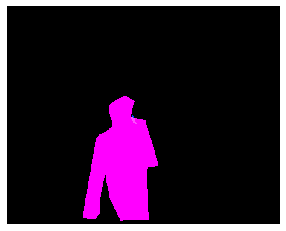

(511, 640, 3)
COCO_val2014_000000370980.jpg
{'person_bbx': [85.03, 56.36, 640.0, 434.07], 'Verbs': 'lay', 'object': {'obj_bbx': [1.98, 1.81, 638.74, 434.89]}}
person
bed
lay
lay interaction


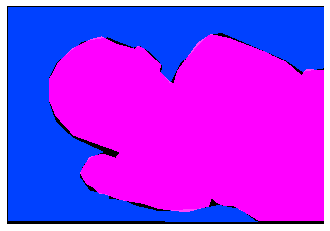

(440, 640, 3)
COCO_val2014_000000381032.jpg
{'person_bbx': [241.8, 348.05, 378.99, 603.9200000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [312.1, 511.96, 379.63, 597.18]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [241.8, 348.05, 378.99, 603.9200000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [312.1, 511.96, 379.63, 597.18]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [241.8, 348.05, 378.99, 603.9200000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [296.38, 171.37, 429.93, 325.05], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [241.8, 348.05, 378.99, 603.9200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [296.38, 171.37, 429.93, 325.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


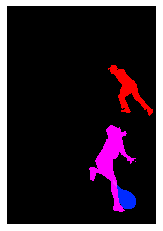

(640, 438, 3)
COCO_val2014_000000537206.jpg
{'person_bbx': [31.28, 181.03, 446.55999999999995, 385.98], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [31.28, 181.03, 446.55999999999995, 385.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


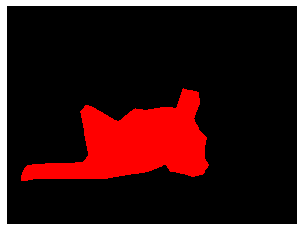

(480, 640, 3)
COCO_val2014_000000400062.jpg
{'person_bbx': [195.44, 108.39, 500.95, 419.78999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [65.05, 258.95, 119.05, 292.09]}}
person
frisbee
catch
catch interaction
{'person_bbx': [195.44, 108.39, 500.95, 419.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [65.05, 258.95, 119.05, 292.09]}}
person
frisbee
look
look interaction
{'person_bbx': [195.44, 108.39, 500.95, 419.78999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [195.44, 108.39, 500.95, 419.78999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [195.44, 108.39, 500.95, 419.78999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [65.05, 258.95, 119.05, 292.09]}}
person
frisbee
throw
throw interaction


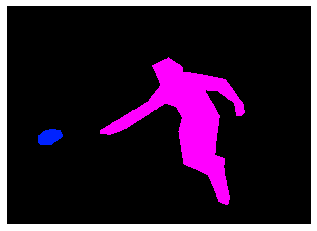

(459, 640, 3)
COCO_val2014_000000217078.jpg
{'person_bbx': [128.26, 85.46, 421.19, 267.94], 'Verbs': 'catch', 'object': {'obj_bbx': [393.05, 129.46, 426.22, 161.41]}}
person
frisbee
catch
catch interaction
{'person_bbx': [128.26, 85.46, 421.19, 267.94], 'Verbs': 'hold', 'object': {'obj_bbx': [393.05, 129.46, 426.22, 161.41]}}
person
frisbee
hold
hold interaction
{'person_bbx': [128.26, 85.46, 421.19, 267.94], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [128.26, 85.46, 421.19, 267.94], 'Verbs': 'look', 'object': {'obj_bbx': [393.05, 129.46, 426.22, 161.41]}}
person
frisbee
look
look interaction
{'person_bbx': [9.85, 64.0, 78.77, 260.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [128.26, 85.46, 421.19, 267.94]}}
person
person
look
look interaction
{'person_bbx': [9.85, 64.0, 78.77, 260.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


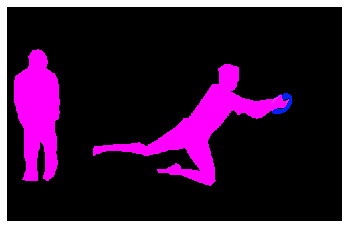

(320, 500, 3)
COCO_val2014_000000112065.jpg
{'person_bbx': [151.77, 127.02, 306.78, 451.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [522.26, 96.04, 640.0, 458.72], 'Verbs': 'hold', 'object': {'obj_bbx': [546.84, 118.68, 590.37, 137.04000000000002]}}
person
bottle
hold
hold interaction
{'person_bbx': [151.77, 127.02, 306.78, 451.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [151.77, 127.02, 306.78, 451.01], 'Verbs': 'look', 'object': {'obj_bbx': [218.51, 22.68, 392.89, 177.68]}}
tv
person
look
look interaction
{'person_bbx': [151.77, 127.02, 306.78, 451.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [522.26, 96.04, 640.0, 458.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


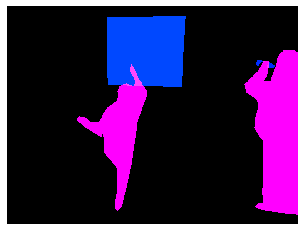

(479, 640, 3)
COCO_val2014_000000171241.jpg
{'person_bbx': [257.17, 122.71, 365.48, 403.88], 'Verbs': 'hold', 'object': {'obj_bbx': [263.08, 279.22, 273.39, 387.97]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [257.17, 122.71, 365.48, 403.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [536.09, 125.12, 636.4000000000001, 470.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


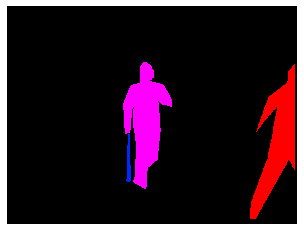

(480, 640, 3)
COCO_val2014_000000539529.jpg
{'person_bbx': [329.13, 116.11, 434.68, 422.2], 'Verbs': 'carry', 'object': {'obj_bbx': [1.92, 222.32, 640.0, 336.51]}}
person
surfboard
carry
carry interaction
{'person_bbx': [329.13, 116.11, 434.68, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [1.92, 222.32, 640.0, 336.51]}}
person
surfboard
hold
hold interaction
{'person_bbx': [329.13, 116.11, 434.68, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [329.13, 116.11, 434.68, 422.2], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


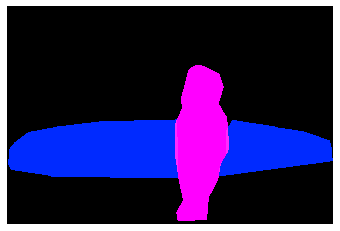

(427, 640, 3)
COCO_val2014_000000211370.jpg
{'person_bbx': [116.72, 150.43, 181.68, 287.37], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [236.84, 105.31, 332.95, 312.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [236.84, 105.31, 332.95, 312.63], 'Verbs': 'snowboard', 'object': {'obj_bbx': [242.79, 279.61, 326.46, 315.76]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [236.84, 105.31, 332.95, 312.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [116.72, 150.43, 181.68, 287.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


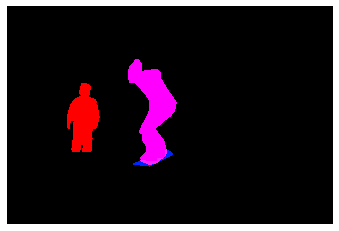

(428, 640, 3)
COCO_val2014_000000423962.jpg
{'person_bbx': [133.38, 52.84, 223.57999999999998, 314.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [447.11, 15.32, 578.27, 289.13], 'Verbs': 'look', 'object': {'obj_bbx': [313.77, 133.38, 448.11, 312.81]}}
person
person
look
look interaction
{'person_bbx': [133.38, 52.84, 223.57999999999998, 314.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [88.0, 257.45, 125.27000000000001, 293.08]}}
sports ball
person
look
look interaction
{'person_bbx': [313.77, 133.38, 448.11, 312.81], 'Verbs': 'look', 'object': {'obj_bbx': [88.0, 257.45, 125.27000000000001, 293.08]}}
sports ball
person
look
look interaction
{'person_bbx': [335.27, 50.61, 424.89, 317.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [455.4, 129.81, 640.0, 357.68], 'Verbs': 'look', 'object': {'obj_bbx': [88.0, 257.45, 125.27000000000001, 293.08]}}
sports ball
person
look
look interaction
{'person_bbx': [447.11,

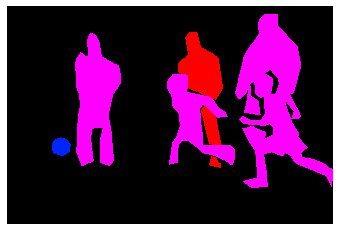

(427, 640, 3)
COCO_val2014_000000208476.jpg
{'person_bbx': [34.52, 15.82, 465.97999999999996, 628.49], 'Verbs': 'drink', 'object': {'obj_bbx': [110.14, 201.29, 161.22, 289.13]}}
person
cup
drink
drink interaction
{'person_bbx': [34.52, 15.82, 465.97999999999996, 628.49], 'Verbs': 'hold', 'object': {'obj_bbx': [110.14, 201.29, 161.22, 289.13]}}
person
cup
hold
hold interaction
{'person_bbx': [34.52, 15.82, 465.97999999999996, 628.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


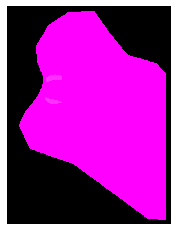

(640, 480, 3)
COCO_val2014_000000490279.jpg
{'person_bbx': [130.04, 44.91, 265.35, 304.25], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [143.85, 65.45, 187.17, 121.47]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [130.04, 44.91, 265.35, 304.25], 'Verbs': 'hold', 'object': {'obj_bbx': [143.85, 65.45, 187.17, 121.47]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [130.04, 44.91, 265.35, 304.25], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [130.04, 44.91, 265.35, 304.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


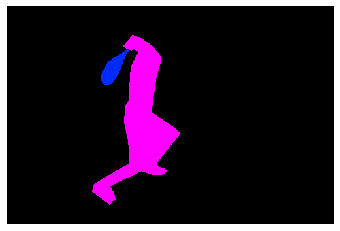

(333, 500, 3)
COCO_val2014_000000300848.jpg
{'person_bbx': [75.63, 42.92, 296.76, 374.15000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [457.52, 220.75, 510.04999999999995, 272.33]}}
sports ball
person
kick
kick interaction
{'person_bbx': [75.63, 42.92, 296.76, 374.15000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


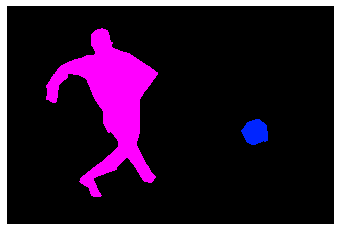

(426, 640, 3)
COCO_val2014_000000542776.jpg
{'person_bbx': [246.03, 197.2, 640.0, 421.21], 'Verbs': 'hold', 'object': {'obj_bbx': [34.77, 200.87, 640.0, 426.0]}}
person
book
hold
hold interaction
{'person_bbx': [246.03, 197.2, 640.0, 421.21], 'Verbs': 'read', 'object': {'obj_bbx': [34.77, 200.87, 640.0, 426.0]}}
person
book
read
read interaction


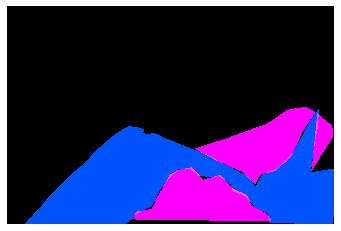

(426, 640, 3)
COCO_val2014_000000172315.jpg
{'person_bbx': [117.19, 123.71, 247.23, 320.37], 'Verbs': 'hold', 'object': {'obj_bbx': [154.63, 155.97, 235.38, 234.51999999999998]}}
person
handbag
hold
hold interaction
{'person_bbx': [117.19, 123.71, 247.23, 320.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [117.19, 123.71, 247.23, 320.37], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


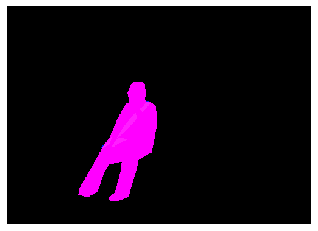

(358, 500, 3)
COCO_val2014_000000396519.jpg
{'person_bbx': [144.09, 74.52, 397.0, 321.46], 'Verbs': 'catch', 'object': {'obj_bbx': [380.15, 76.64, 408.52, 111.39]}}
person
frisbee
catch
catch interaction
{'person_bbx': [285.28, 92.48, 438.84, 374.22], 'Verbs': 'catch', 'object': {'obj_bbx': [380.15, 76.64, 408.52, 111.39]}}
person
frisbee
catch
catch interaction
{'person_bbx': [144.09, 74.52, 397.0, 321.46], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [285.28, 92.48, 438.84, 374.22], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [285.28, 92.48, 438.84, 374.22], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [285.28, 92.48, 438.84, 374.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


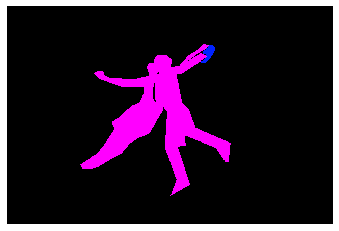

(428, 640, 3)
COCO_val2014_000000515424.jpg
{'person_bbx': [69.03, 96.36, 267.51, 352.36], 'Verbs': 'hold', 'object': {'obj_bbx': [73.35, 33.08, 342.28999999999996, 248.81]}}
person
snowboard
hold
hold interaction
{'person_bbx': [69.03, 96.36, 267.51, 352.36], 'Verbs': 'jump', 'object': {'obj_bbx': [73.35, 33.08, 342.28999999999996, 248.81]}}
person
snowboard
jump
jump interaction
{'person_bbx': [69.03, 96.36, 267.51, 352.36], 'Verbs': 'look', 'object': {'obj_bbx': [73.35, 33.08, 342.28999999999996, 248.81]}}
person
snowboard
look
look interaction
{'person_bbx': [69.03, 96.36, 267.51, 352.36], 'Verbs': 'snowboard', 'object': {'obj_bbx': [73.35, 33.08, 342.28999999999996, 248.81]}}
person
snowboard
snowboard
snowboard interaction


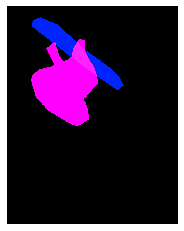

(640, 501, 3)
COCO_val2014_000000450303.jpg
{'person_bbx': [453.03, 223.28, 598.65, 348.4], 'Verbs': 'look', 'object': {'obj_bbx': [403.92, 259.72, 456.83000000000004, 318.56000000000006]}}
person
laptop
look
look interaction
{'person_bbx': [453.03, 223.28, 598.65, 348.4], 'Verbs': 'sit', 'object': {'obj_bbx': [589.99, 321.16, 639.94, 358.68]}}
person
chair
sit
sit interaction
{'person_bbx': [453.03, 223.28, 598.65, 348.4], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [403.92, 259.72, 456.83000000000004, 318.56000000000006]}}
person
laptop
work_on_computer
work_on_computer interaction


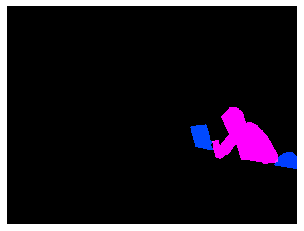

(480, 640, 3)
COCO_val2014_000000102903.jpg
{'person_bbx': [116.91, 88.62, 421.17999999999995, 326.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [116.91, 88.62, 421.17999999999995, 326.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [116.91, 88.62, 421.17999999999995, 326.94], 'Verbs': 'snowboard', 'object': {'obj_bbx': [282.01, 300.11, 500.0, 328.46000000000004]}}
person
snowboard
snowboard
snowboard interaction


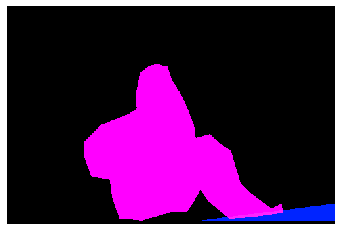

(332, 500, 3)
COCO_val2014_000000140203.jpg
{'person_bbx': [508.8, 20.3, 589.49, 246.38000000000002], 'Verbs': 'carry', 'object': {'obj_bbx': [485.46, 42.85, 578.3199999999999, 114.61000000000001]}}
dog
person
carry
carry interaction
{'person_bbx': [508.8, 20.3, 589.49, 246.38000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [485.46, 42.85, 578.3199999999999, 114.61000000000001]}}
dog
person
hold
hold interaction
{'person_bbx': [508.8, 20.3, 589.49, 246.38000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 118.11, 43.08, 410.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [508.8, 20.3, 589.49, 246.38000000000002], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


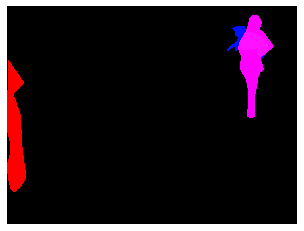

(480, 640, 3)
COCO_val2014_000000296492.jpg
{'person_bbx': [87.29, 110.45, 312.68, 562.1700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [87.29, 110.45, 312.68, 562.1700000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


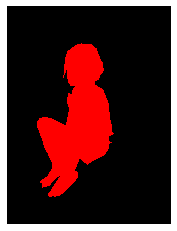

(640, 480, 3)
COCO_val2014_000000160345.jpg
{'person_bbx': [113.58, 90.43, 215.98000000000002, 256.5], 'Verbs': 'hold', 'object': {'obj_bbx': [140.43, 142.61, 179.46, 155.68]}}
book
person
hold
hold interaction
{'person_bbx': [113.58, 90.43, 215.98000000000002, 256.5], 'Verbs': 'look', 'object': {'obj_bbx': [140.43, 142.61, 179.46, 155.68]}}
book
person
look
look interaction
{'person_bbx': [113.58, 90.43, 215.98000000000002, 256.5], 'Verbs': 'read', 'object': {'obj_bbx': [140.43, 142.61, 179.46, 155.68]}}
book
person
read
read interaction
{'person_bbx': [113.58, 90.43, 215.98000000000002, 256.5], 'Verbs': 'sit', 'object': {'obj_bbx': [58.5, 127.13, 415.5, 253.12]}}
bench
person
sit
sit interaction


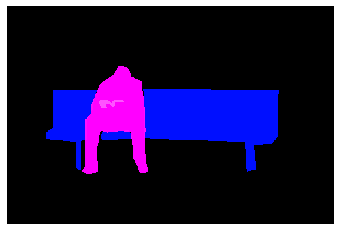

(333, 500, 3)
COCO_val2014_000000224523.jpg
{'person_bbx': [154.71, 162.16, 307.45000000000005, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [159.1, 239.06, 192.89999999999998, 272.14]}}
cell phone
person
hold
hold interaction
{'person_bbx': [154.71, 162.16, 307.45000000000005, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [154.71, 162.16, 307.45000000000005, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [159.1, 239.06, 192.89999999999998, 272.14]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


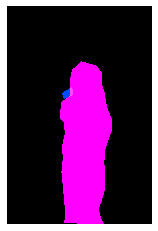

(640, 425, 3)
COCO_val2014_000000296731.jpg
{'person_bbx': [286.67, 246.84, 335.82, 349.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [506.25, 251.72, 574.49, 330.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [286.67, 246.84, 335.82, 349.83], 'Verbs': 'jump', 'object': {'obj_bbx': [283.88, 335.84, 333.03999999999996, 364.2]}}
person
skis
jump
jump interaction
{'person_bbx': [506.25, 251.72, 574.49, 330.02], 'Verbs': 'jump', 'object': {'obj_bbx': [501.79, 320.84, 550.38, 335.78999999999996]}}
person
skis
jump
jump interaction
{'person_bbx': [506.25, 251.72, 574.49, 330.02], 'Verbs': 'look', 'object': {'obj_bbx': [501.79, 320.84, 550.38, 335.78999999999996]}}
person
skis
look
look interaction
{'person_bbx': [286.67, 246.84, 335.82, 349.83], 'Verbs': 'ski', 'object': {'obj_bbx': [283.88, 335.84, 333.03999999999996, 364.2]}}
person
skis
ski
ski interaction
{'person_bbx': [506.25, 251.72, 574.49, 330.02], 'Verbs': 'ski', 'object': 

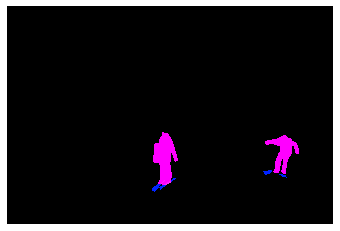

(427, 640, 3)
COCO_val2014_000000302958.jpg
{'person_bbx': [191.32, 42.65, 595.22, 330.19], 'Verbs': 'look', 'object': {'obj_bbx': [11.21, 245.58, 368.91999999999996, 353.22]}}
person
surfboard
look
look interaction
{'person_bbx': [191.32, 42.65, 595.22, 330.19], 'Verbs': 'surf', 'object': {'obj_bbx': [11.21, 245.58, 368.91999999999996, 353.22]}}
person
surfboard
surf
surf interaction


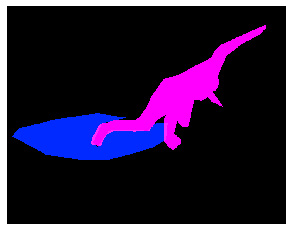

(499, 640, 3)
COCO_val2014_000000177069.jpg
{'person_bbx': [59.79, 20.65, 492.0, 285.73999999999995], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [59.79, 20.65, 492.0, 285.73999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


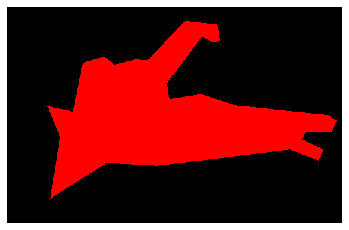

(322, 500, 3)
COCO_val2014_000000466818.jpg
{'person_bbx': [380.07, 134.41, 500.0, 333.0], 'Verbs': 'hold', 'object': {'obj_bbx': [346.6, 279.47, 460.15000000000003, 333.0]}}
laptop
person
hold
hold interaction
{'person_bbx': [0.25, 130.89, 125.82, 302.85], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [74.08, 136.94, 209.52999999999997, 333.0], 'Verbs': 'look', 'object': {'obj_bbx': [7.53, 255.18, 129.76999999999998, 319.06]}}
laptop
person
look
look interaction
{'person_bbx': [0.25, 130.89, 125.82, 302.85], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [74.08, 136.94, 209.52999999999997, 333.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [380.07, 134.41, 500.0, 333.0], 'Verbs': 'sit', 'object': {'obj_bbx': [464.64, 284.01, 499.39, 333.0]}}
person
chair
sit
sit interaction
{'person_bbx': [0.25, 130.89, 125.82, 302.85], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer
{'person_bbx':

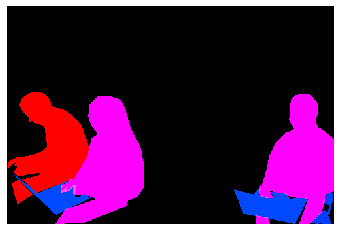

(333, 500, 3)
COCO_val2014_000000253485.jpg
{'person_bbx': [195.35, 29.9, 547.26, 470.82], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [104.74, 320.54, 220.07999999999998, 369.32000000000005]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [195.35, 29.9, 547.26, 470.82], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [30.75, 335.22, 163.37, 434.57000000000005]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [216.49, 93.6, 640.0, 478.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [104.74, 320.54, 220.07999999999998, 369.32000000000005]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [216.49, 93.6, 640.0, 478.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [30.75, 335.22, 163.37, 434.57000000000005]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [195.35, 29.9, 547.26, 470.82], 'Verbs': 'hold', 'object': {'obj_bbx': [104.74, 320.54, 220.07999999999998, 369.32000000000005]}}
person
knife
hold
hold interaction
{'person_bbx': [216.49, 93.6, 640.0, 478

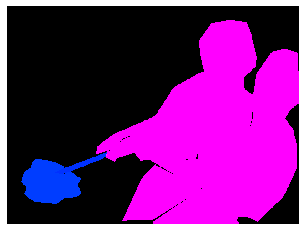

(478, 640, 3)
COCO_val2014_000000501652.jpg
{'person_bbx': [97.96, 164.42, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [203.26, 257.23, 245.20999999999998, 285.66]}}
person
cell phone
hold
hold interaction
{'person_bbx': [97.96, 164.42, 640.0, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [97.96, 164.42, 640.0, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 0.54, 640.0, 475.14000000000004]}}
person
car
ride
ride interaction
{'person_bbx': [97.96, 164.42, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [97.96, 164.42, 640.0, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [133.36, 254.25, 177.04000000000002, 275.0]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


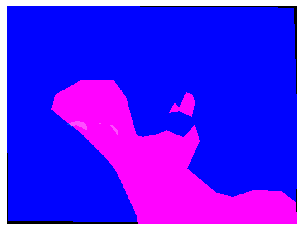

(480, 640, 3)
COCO_val2014_000000264535.jpg
{'person_bbx': [373.59, 159.46, 590.86, 489.18000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': [501.28, 291.16, 551.11, 311.56]}}
person
book
hold
hold interaction
{'person_bbx': [373.59, 159.46, 590.86, 489.18000000000006], 'Verbs': 'look', 'object': {'obj_bbx': [501.28, 291.16, 551.11, 311.56]}}
person
book
look
look interaction
{'person_bbx': [373.59, 159.46, 590.86, 489.18000000000006], 'Verbs': 'read', 'object': {'obj_bbx': [501.28, 291.16, 551.11, 311.56]}}
person
book
read
read interaction
{'person_bbx': [373.59, 159.46, 590.86, 489.18000000000006], 'Verbs': 'sit', 'object': {'obj_bbx': [49.51, 250.39, 435.96, 577.71]}}
person
bench
sit
sit interaction


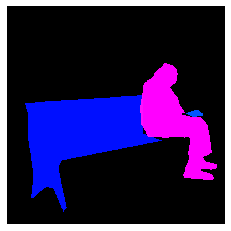

(612, 612, 3)
COCO_val2014_000000516173.jpg
{'person_bbx': [58.97, 156.52, 227.24, 585.11], 'Verbs': 'carry', 'object': {'obj_bbx': [170.33, 283.54, 238.18, 446.02]}}
person
surfboard
carry
carry interaction
{'person_bbx': [58.97, 156.52, 227.24, 585.11], 'Verbs': 'hold', 'object': {'obj_bbx': [170.33, 283.54, 238.18, 446.02]}}
person
surfboard
hold
hold interaction
{'person_bbx': [58.97, 156.52, 227.24, 585.11], 'Verbs': 'look', 'object': {'obj_bbx': [167.33, 51.31, 193.34, 82.28]}}
person
person
look
look interaction
{'person_bbx': [58.97, 156.52, 227.24, 585.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [58.97, 156.52, 227.24, 585.11], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


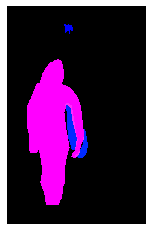

(640, 408, 3)
COCO_val2014_000000274014.jpg
{'person_bbx': [439.26, 20.95, 499.87, 268.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [316.54, 44.9, 423.55, 289.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [183.34, 44.2, 306.06, 315.09], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [58.55, 73.19, 166.87, 330.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.75, 127.88, 78.75, 323.63], 'Verbs': 'hold', 'object': {'obj_bbx': [19.1, 157.75, 88.34, 268.15]}}
person
backpack
hold
hold interaction
{'person_bbx': [439.26, 20.95, 499.87, 268.64], 'Verbs': 'ski', 'object': {'obj_bbx': [336.97, 236.2, 500.0, 273.45]}}
person
skis
ski
ski interaction
{'person_bbx': [316.54, 44.9, 423.55, 289.59999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [278.77, 280.78, 500.0, 299.63]}}
person
skis
ski
ski interaction
{'person_bbx': [183.34, 44.2, 306.06, 315.09], 'Verbs': 'ski',

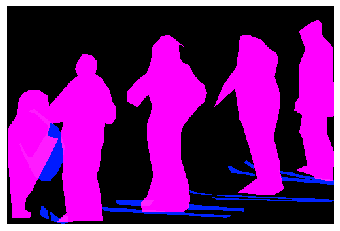

(333, 500, 3)
COCO_val2014_000000260166.jpg
{'person_bbx': [365.15, 130.07, 459.54999999999995, 230.07999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [315.68, 222.16, 521.08, 474.04999999999995]}}
elephant
person
ride
ride interaction
{'person_bbx': [364.3, 86.12, 409.84000000000003, 191.29000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [315.68, 222.16, 521.08, 474.04999999999995]}}
elephant
person
ride
ride interaction
{'person_bbx': [320.82, 98.98, 372.77, 242.73000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [315.68, 222.16, 521.08, 474.04999999999995]}}
elephant
person
ride
ride interaction
{'person_bbx': [404.86, 79.61, 465.29, 191.32], 'Verbs': 'ride', 'object': {'obj_bbx': [315.68, 222.16, 521.08, 474.04999999999995]}}
elephant
person
ride
ride interaction
{'person_bbx': [365.15, 130.07, 459.54999999999995, 230.07999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [315.68, 222.16, 521.08, 474.04999999999995]}}
elephant
person
sit
sit interaction
{'person_bbx':

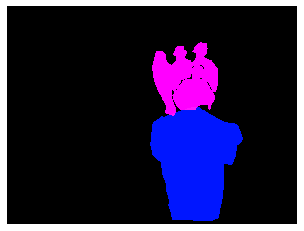

(480, 640, 3)
COCO_val2014_000000011625.jpg
{'person_bbx': [145.6, 178.05, 255.07999999999998, 397.01], 'Verbs': 'catch', 'object': {'obj_bbx': [284.44, 112.26, 319.93, 137.31]}}
person
frisbee
catch
catch interaction
{'person_bbx': [145.6, 178.05, 255.07999999999998, 397.01], 'Verbs': 'look', 'object': {'obj_bbx': [284.44, 112.26, 319.93, 137.31]}}
person
frisbee
look
look interaction
{'person_bbx': [145.6, 178.05, 255.07999999999998, 397.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


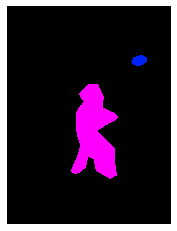

(500, 375, 3)
COCO_val2014_000000106909.jpg
{'person_bbx': [451.97, 172.89, 538.9100000000001, 292.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [230.83, 108.94, 303.1, 195.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


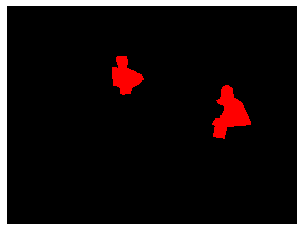

(480, 640, 3)
COCO_val2014_000000408903.jpg
{'person_bbx': [266.98, 133.05, 443.74, 499.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [266.98, 133.05, 443.74, 499.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


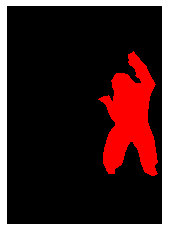

(640, 456, 3)
COCO_val2014_000000442348.jpg
{'person_bbx': [1.3, 73.57, 321.0, 444.65999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [61.99, 364.4, 120.91, 399.46]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [1.3, 73.57, 321.0, 444.65999999999997], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [0.41, 372.5, 22.12, 415.07]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [1.3, 73.57, 321.0, 444.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [0.41, 372.5, 22.12, 415.07]}}
fork
person
hold
hold interaction
{'person_bbx': [1.3, 73.57, 321.0, 444.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


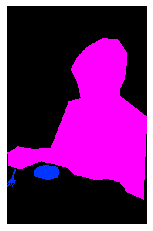

(500, 321, 3)
COCO_val2014_000000520707.jpg
{'person_bbx': [326.83, 138.97, 405.57, 394.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [326.83, 138.97, 405.57, 394.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 143.46, 98.16, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.31, 179.82, 202.17000000000002, 413.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.31, 179.82, 202.17000000000002, 413.90999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


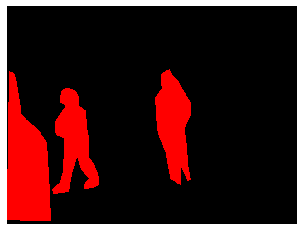

(480, 640, 3)
COCO_val2014_000000100111.jpg
{'person_bbx': [5.03, 123.4, 317.10999999999996, 370.05], 'Verbs': 'look', 'object': {'obj_bbx': [260.72, 105.6, 472.35, 280.83]}}
person
laptop
look
look interaction
{'person_bbx': [5.03, 123.4, 317.10999999999996, 370.05], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 236.03, 73.24, 375.0]}}
chair
person
sit
sit interaction
{'person_bbx': [5.03, 123.4, 317.10999999999996, 370.05], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [260.72, 105.6, 472.35, 280.83]}}
person
laptop
work_on_computer
work_on_computer interaction


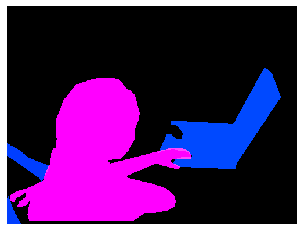

(375, 500, 3)
COCO_val2014_000000192095.jpg
{'person_bbx': [104.38, 61.72, 287.73, 344.0], 'Verbs': 'hold', 'object': {'obj_bbx': [240.95, 114.08, 275.06, 159.92000000000002]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [104.38, 61.72, 287.73, 344.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [104.38, 61.72, 287.73, 344.0], 'Verbs': 'throw', 'object': {'obj_bbx': [106.81, 122.28, 115.02000000000001, 142.11]}}
person
sports ball
throw
throw interaction


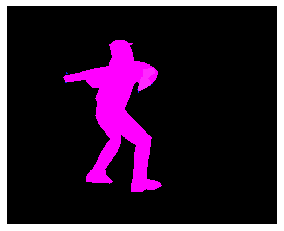

(403, 500, 3)
COCO_val2014_000000469200.jpg
{'person_bbx': [206.31, 56.47, 407.85, 400.32000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': [352.4, 10.45, 394.47999999999996, 24.04]}}
person
frisbee
catch
catch interaction
{'person_bbx': [206.31, 56.47, 407.85, 400.32000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [206.31, 56.47, 407.85, 400.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [352.4, 10.45, 394.47999999999996, 24.04]}}
person
frisbee
look
look interaction
{'person_bbx': [206.31, 56.47, 407.85, 400.32000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


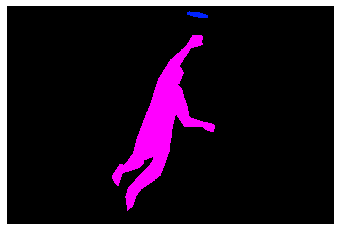

(426, 640, 3)
COCO_val2014_000000461063.jpg
{'person_bbx': [216.09, 49.64, 404.8, 375.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [132.38, 157.5, 246.38, 224.07]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [216.09, 49.64, 404.8, 375.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [99.8, 161.56, 117.94999999999999, 179.71]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [216.09, 49.64, 404.8, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [132.38, 157.5, 246.38, 224.07]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [216.09, 49.64, 404.8, 375.0], 'Verbs': 'look', 'object': {'obj_bbx': [99.8, 161.56, 117.94999999999999, 179.71]}}
sports ball
person
look
look interaction
{'person_bbx': [216.09, 49.64, 404.8, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


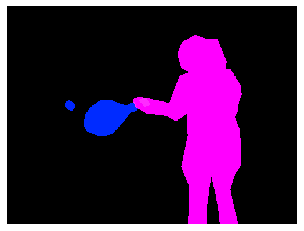

(375, 500, 3)
COCO_val2014_000000250364.jpg
{'person_bbx': [385.08, 199.42, 606.5, 482.72], 'Verbs': 'hold', 'object': {'obj_bbx': [453.69, 203.19, 498.09, 240.72]}}
person
cell phone
hold
hold interaction
{'person_bbx': [385.08, 199.42, 606.5, 482.72], 'Verbs': 'lay', 'object': {'obj_bbx': [1.38, 96.36, 612.0, 549.49]}}
bed
person
lay
lay interaction


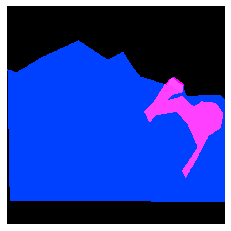

(612, 612, 3)
COCO_val2014_000000016064.jpg
{'person_bbx': [74.79, 207.1, 366.74, 549.39], 'Verbs': 'catch', 'object': {'obj_bbx': [166.65, 41.81, 222.55, 107.54]}}
person
frisbee
catch
catch interaction
{'person_bbx': [74.79, 207.1, 366.74, 549.39], 'Verbs': 'look', 'object': {'obj_bbx': [166.65, 41.81, 222.55, 107.54]}}
person
frisbee
look
look interaction
{'person_bbx': [74.79, 207.1, 366.74, 549.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


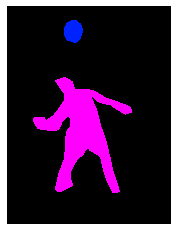

(640, 480, 3)
COCO_val2014_000000092257.jpg
{'person_bbx': [134.05, 36.48, 392.57, 422.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [134.05, 36.48, 392.57, 422.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [134.05, 36.48, 392.57, 422.35], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [134.05, 36.48, 392.57, 422.35], 'Verbs': 'sit', 'object': {'obj_bbx': [211.6, 299.12, 327.97, 403.96000000000004]}}
person
toilet
sit
sit interaction


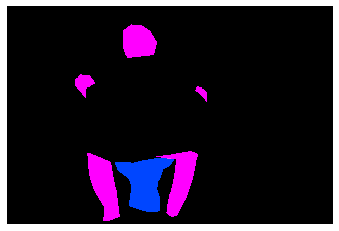

(428, 640, 3)
COCO_val2014_000000306343.jpg
{'person_bbx': [16.14, 1.2, 154.98000000000002, 447.84], 'Verbs': 'skateboard', 'object': {'obj_bbx': [14.65, 418.78, 169.01000000000002, 475.12]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [465.98, 0.0, 565.21, 302.02], 'Verbs': 'skateboard', 'object': {'obj_bbx': [441.33, 293.63, 556.88, 323.15999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [16.14, 1.2, 154.98000000000002, 447.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [465.98, 0.0, 565.21, 302.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


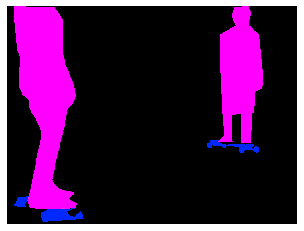

(480, 640, 3)
COCO_val2014_000000502433.jpg
{'person_bbx': [351.48, 74.8, 549.9300000000001, 405.55], 'Verbs': 'look', 'object': {'obj_bbx': [267.2, 58.1, 323.58, 94.53]}}
frisbee
person
look
look interaction
{'person_bbx': [351.48, 74.8, 549.9300000000001, 405.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [351.48, 74.8, 549.9300000000001, 405.55], 'Verbs': 'throw', 'object': {'obj_bbx': [267.2, 58.1, 323.58, 94.53]}}
frisbee
person
throw
throw interaction


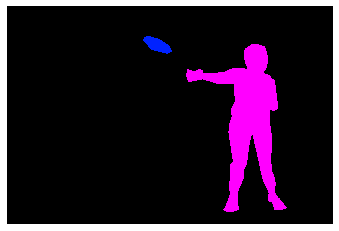

(428, 640, 3)
COCO_val2014_000000374017.jpg
{'person_bbx': [384.16, 156.34, 465.86, 261.22], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 146.7, 599.73, 412.03999999999996]}}
bed
person
lay
lay interaction


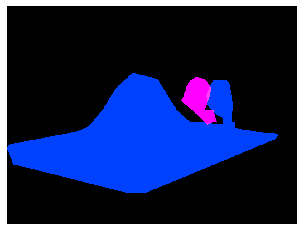

(480, 640, 3)
COCO_val2014_000000137297.jpg
{'person_bbx': [142.74, 33.11, 501.26, 441.98], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [245.64, 48.32, 318.15999999999997, 88.94]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [142.74, 33.11, 501.26, 441.98], 'Verbs': 'hold', 'object': {'obj_bbx': [245.64, 48.32, 318.15999999999997, 88.94]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [142.74, 33.11, 501.26, 441.98], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [142.74, 33.11, 501.26, 441.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


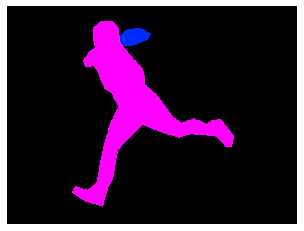

(480, 640, 3)
COCO_val2014_000000350855.jpg
{'person_bbx': [250.72, 69.84, 391.53, 426.0], 'Verbs': 'drink', 'object': {'obj_bbx': [291.98, 152.45, 323.22, 210.87]}}
person
cup
drink
drink interaction
{'person_bbx': [250.72, 69.84, 391.53, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [291.98, 152.45, 323.22, 210.87]}}
person
cup
hold
hold interaction
{'person_bbx': [250.72, 69.84, 391.53, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [391.17, 212.7, 531.7, 405.13]}}
person
cake
look
look interaction
{'person_bbx': [250.72, 69.84, 391.53, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


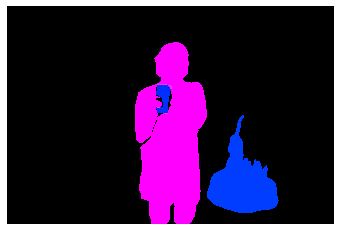

(426, 640, 3)
COCO_val2014_000000303667.jpg
{'person_bbx': [170.43, 161.87, 339.78, 478.99], 'Verbs': 'hold', 'object': {'obj_bbx': [237.54, 225.84, 242.82999999999998, 238.06]}}
cell phone
person
hold
hold interaction
{'person_bbx': [456.32, 256.14, 637.13, 473.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.08, 242.7, 160.72, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [170.43, 161.87, 339.78, 478.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [170.43, 161.87, 339.78, 478.99], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [237.54, 225.84, 242.82999999999998, 238.06]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


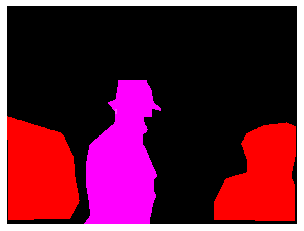

(480, 640, 3)
COCO_val2014_000000438103.jpg


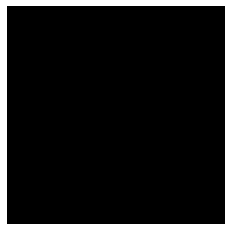

(640, 640, 3)
COCO_val2014_000000317999.jpg
{'person_bbx': [190.11, 190.11, 563.47, 580.25], 'Verbs': 'hold', 'object': {'obj_bbx': [184.06, 214.34, 314.51, 394.15999999999997]}}
book
person
hold
hold interaction
{'person_bbx': [19.17, 46.68, 295.73, 295.86], 'Verbs': 'lay', 'object': {'obj_bbx': [23.38, 127.99, 591.37, 588.71]}}
bed
person
lay
lay interaction
{'person_bbx': [190.11, 190.11, 563.47, 580.25], 'Verbs': 'lay', 'object': {'obj_bbx': [23.38, 127.99, 591.37, 588.71]}}
bed
person
lay
lay interaction
{'person_bbx': [190.11, 190.11, 563.47, 580.25], 'Verbs': 'look', 'object': {'obj_bbx': [184.06, 214.34, 314.51, 394.15999999999997]}}
book
person
look
look interaction
{'person_bbx': [190.11, 190.11, 563.47, 580.25], 'Verbs': 'read', 'object': {'obj_bbx': [184.06, 214.34, 314.51, 394.15999999999997]}}
book
person
read
read interaction
{'person_bbx': [19.17, 46.68, 295.73, 295.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


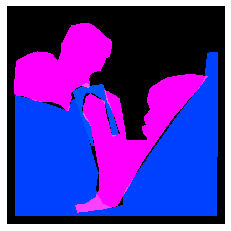

(612, 612, 3)
COCO_val2014_000000412362.jpg
{'person_bbx': [1.12, 121.9, 277.47, 492.23], 'Verbs': 'hold', 'object': {'obj_bbx': [110.42, 416.26, 156.44, 491.3]}}
person
cup
hold
hold interaction
{'person_bbx': [442.93, 71.84, 640.0, 491.23], 'Verbs': 'hold', 'object': {'obj_bbx': [461.02, 363.58, 510.34, 477.78999999999996]}}
person
wine glass
hold
hold interaction
{'person_bbx': [1.12, 121.9, 277.47, 492.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [212.89, 107.29, 480.97999999999996, 493.65000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [442.93, 71.84, 640.0, 491.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.12, 121.9, 277.47, 492.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [212.89, 107.29, 480.97999999999996, 493.65000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [442.93, 71.84, 640.0, 491.23], 'Verbs': 

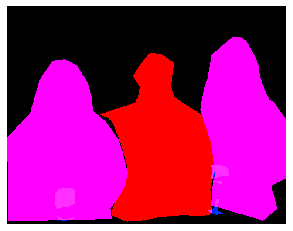

(499, 640, 3)
COCO_val2014_000000137992.jpg
{'person_bbx': [134.97, 97.88, 234.26, 218.38], 'Verbs': 'snowboard', 'object': {'obj_bbx': [138.76, 155.41, 225.94, 216.8]}}
person
snowboard
snowboard
snowboard interaction


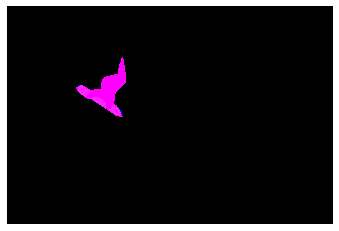

(428, 640, 3)
COCO_val2014_000000364113.jpg
{'person_bbx': [374.23, 71.83, 468.39, 266.71999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [374.23, 71.83, 468.39, 266.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [299.57, 122.82, 502.03999999999996, 358.27]}}
horse
person
hold
hold interaction
{'person_bbx': [209.65, 74.67, 299.64, 260.39], 'Verbs': 'hold', 'object': {'obj_bbx': [112.96, 113.92, 337.93, 348.46]}}
horse
person
hold
hold interaction
{'person_bbx': [374.23, 71.83, 468.39, 266.71999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [299.57, 122.82, 502.03999999999996, 358.27]}}
horse
person
ride
ride interaction
{'person_bbx': [209.65, 74.67, 299.64, 260.39], 'Verbs': 'ride', 'object': {'obj_bbx': [112.96, 113.92, 337.93, 348.46]}}
horse
person
ride
ride interaction
{'person_bbx': [374.23, 71.83, 468.39, 266.71999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [299.57, 122.82, 502.03999999999996, 358.27]}}
horse
person
sit


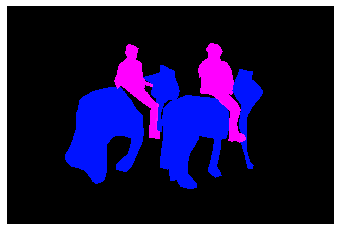

(426, 640, 3)
COCO_val2014_000000227326.jpg
{'person_bbx': [255.18, 29.91, 392.37, 337.54], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [277.62, 267.38, 301.59000000000003, 296.36]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [255.18, 29.91, 392.37, 337.54], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [189.71, 251.04, 295.45, 356.22]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [255.18, 29.91, 392.37, 337.54], 'Verbs': 'hold', 'object': {'obj_bbx': [277.62, 267.38, 301.59000000000003, 296.36]}}
person
knife
hold
hold interaction
{'person_bbx': [307.08, 78.83, 605.0, 385.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [255.18, 29.91, 392.37, 337.54], 'Verbs': 'look', 'object': {'obj_bbx': [189.71, 251.04, 295.45, 356.22]}}
person
cake
look
look interaction
{'person_bbx': [307.08, 78.83, 605.0, 385.0], 'Verbs': 'look', 'object': {'obj_bbx': [189.71, 251.04, 295.45, 356.22]}}
person
cake
look
look interaction
{'person_bbx': [255.18, 29

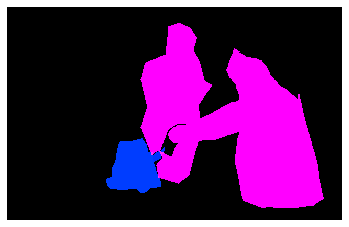

(407, 640, 3)
COCO_val2014_000000141205.jpg
{'person_bbx': [0.0, 41.47, 425.0, 632.57], 'Verbs': 'hold', 'object': {'obj_bbx': [347.8, 424.89, 416.61, 583.0699999999999]}}
person
frisbee
hold
hold interaction
{'person_bbx': [0.0, 41.47, 425.0, 632.57], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 41.47, 425.0, 632.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 90.61, 244.49, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


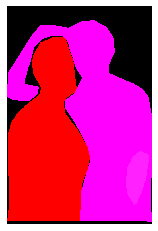

(640, 425, 3)
COCO_val2014_000000549746.jpg
{'person_bbx': [54.65, 172.58, 606.92, 632.8100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [66.34, 402.75, 261.15, 512.72]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [54.65, 172.58, 606.92, 632.8100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [54.65, 172.58, 606.92, 632.8100000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


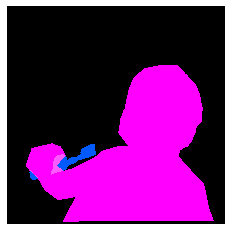

(640, 640, 3)
COCO_val2014_000000026734.jpg
{'person_bbx': [398.28, 41.81, 543.8, 362.54], 'Verbs': 'carry', 'object': {'obj_bbx': [344.43, 221.86, 451.12, 371.52]}}
person
suitcase
carry
carry interaction
{'person_bbx': [161.2, 70.05, 261.0, 370.39], 'Verbs': 'carry', 'object': {'obj_bbx': [196.71, 215.61, 308.02, 384.49]}}
person
suitcase
carry
carry interaction
{'person_bbx': [398.28, 41.81, 543.8, 362.54], 'Verbs': 'hold', 'object': {'obj_bbx': [520.8, 189.83, 584.88, 354.69000000000005]}}
person
person
hold
hold interaction
{'person_bbx': [161.2, 70.05, 261.0, 370.39], 'Verbs': 'hold', 'object': {'obj_bbx': [196.71, 215.61, 308.02, 384.49]}}
person
suitcase
hold
hold interaction
{'person_bbx': [161.2, 70.05, 261.0, 370.39], 'Verbs': 'look', 'object': {'obj_bbx': [111.5, 228.63, 160.77, 358.28]}}
dog
person
look
look interaction
{'person_bbx': [398.28, 41.81, 543.8, 362.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.2, 70.05, 261.0, 370.39], 'Ver

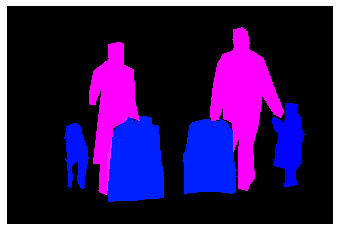

(427, 640, 3)
COCO_val2014_000000440037.jpg
{'person_bbx': [386.9, 202.53, 413.77, 286.40999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [306.38, 198.9, 333.65999999999997, 276.1], 'Verbs': 'ride', 'object': {'obj_bbx': [229.42, 288.71, 368.23, 335.94]}}
boat
person
ride
ride interaction
{'person_bbx': [386.9, 202.53, 413.77, 286.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [306.38, 198.9, 333.65999999999997, 276.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


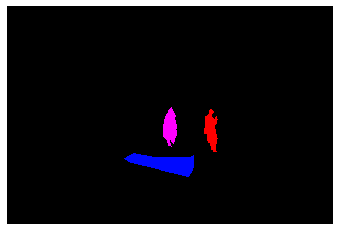

(428, 640, 3)
COCO_val2014_000000477867.jpg
{'person_bbx': [166.09, 229.22, 356.51, 426.81], 'Verbs': 'look', 'object': {'obj_bbx': [270.9, 371.03, 375.16999999999996, 479.10999999999996]}}
person
surfboard
look
look interaction
{'person_bbx': [166.09, 229.22, 356.51, 426.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [159.6, 2.69, 237.04, 186.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [166.09, 229.22, 356.51, 426.81], 'Verbs': 'surf', 'object': {'obj_bbx': [270.9, 371.03, 375.16999999999996, 479.10999999999996]}}
person
surfboard
surf
surf interaction
{'person_bbx': [159.6, 2.69, 237.04, 186.0], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


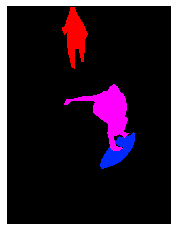

(640, 480, 3)
COCO_val2014_000000012979.jpg
{'person_bbx': [91.32, 11.05, 244.88, 224.20000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [137.7, 202.11, 180.91, 240.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [91.32, 11.05, 244.88, 224.20000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [137.7, 202.11, 180.91, 240.0]}}
person
skateboard
look
look interaction
{'person_bbx': [91.32, 11.05, 244.88, 224.20000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [137.7, 202.11, 180.91, 240.0]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [91.32, 11.05, 244.88, 224.20000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


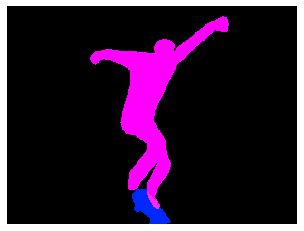

(240, 320, 3)
COCO_val2014_000000191845.jpg
{'person_bbx': [223.09, 224.71, 283.12, 318.82], 'Verbs': 'carry', 'object': {'obj_bbx': [201.03, 182.59, 268.31, 236.15]}}
umbrella
person
carry
carry interaction
{'person_bbx': [142.59, 112.6, 203.54000000000002, 211.95], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [176.04, 74.84, 240.94, 142.98000000000002], 'Verbs': 'carry', 'object': {'obj_bbx': [167.23, 44.47, 218.91, 79.1]}}
umbrella
person
carry
carry interaction
{'person_bbx': [283.08, 100.54, 348.9, 194.17000000000002], 'Verbs': 'carry', 'object': {'obj_bbx': [256.9, 66.37, 326.51, 115.21000000000001]}}
umbrella
person
carry
carry interaction
{'person_bbx': [269.33, 196.32, 343.96, 280.69], 'Verbs': 'carry', 'object': {'obj_bbx': [251.48, 152.51, 318.0, 202.81]}}
umbrella
person
carry
carry interaction
{'person_bbx': [339.66, 42.37, 409.23, 146.24], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [134.09, 245.67, 208.16, 336.62],

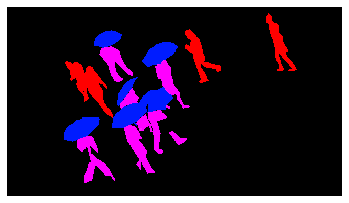

(361, 640, 3)
COCO_val2014_000000228135.jpg
{'person_bbx': [103.78, 178.74, 282.52, 629.9100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [103.78, 178.74, 282.52, 629.9100000000001], 'Verbs': 'ski', 'object': {'obj_bbx': [155.37, 519.95, 263.77, 640.0]}}
person
skis
ski
ski interaction
{'person_bbx': [103.78, 178.74, 282.52, 629.9100000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [103.78, 178.74, 282.52, 629.9100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.78, 178.74, 282.52, 629.9100000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


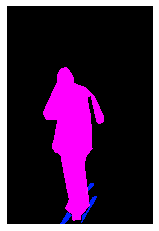

(640, 427, 3)
COCO_val2014_000000288576.jpg
{'person_bbx': [321.15, 116.85, 406.96999999999997, 294.58], 'Verbs': 'look', 'object': {'obj_bbx': [191.14, 167.64, 231.63, 200.29]}}
person
frisbee
look
look interaction
{'person_bbx': [321.15, 116.85, 406.96999999999997, 294.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [321.15, 116.85, 406.96999999999997, 294.58], 'Verbs': 'throw', 'object': {'obj_bbx': [191.14, 167.64, 231.63, 200.29]}}
person
frisbee
throw
throw interaction


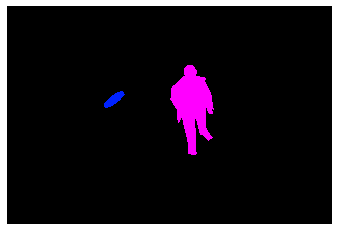

(429, 640, 3)
COCO_val2014_000000053490.jpg
{'person_bbx': [293.54, 147.85, 386.33000000000004, 241.22], 'Verbs': 'look', 'object': {'obj_bbx': [241.87, 88.72, 303.58, 311.37]}}
person
surfboard
look
look interaction
{'person_bbx': [293.54, 147.85, 386.33000000000004, 241.22], 'Verbs': 'surf', 'object': {'obj_bbx': [241.87, 88.72, 303.58, 311.37]}}
person
surfboard
surf
surf interaction


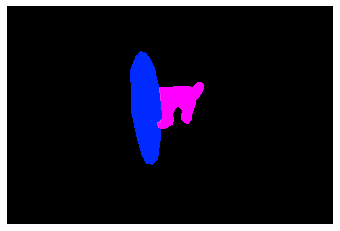

(427, 640, 3)
COCO_val2014_000000182923.jpg
{'person_bbx': [40.0, 40.8, 273.6, 434.44], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [1.68, 7.01, 57.62, 53.07]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [40.0, 40.8, 273.6, 434.44], 'Verbs': 'hold', 'object': {'obj_bbx': [1.68, 7.01, 57.62, 53.07]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [40.0, 40.8, 273.6, 434.44], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [40.0, 40.8, 273.6, 434.44], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [40.0, 40.8, 273.6, 434.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


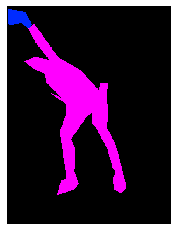

(500, 375, 3)
COCO_val2014_000000053774.jpg
{'person_bbx': [179.44, 2.88, 614.11, 380.94], 'Verbs': 'jump', 'object': {'obj_bbx': [246.6, 278.27, 427.96000000000004, 395.33]}}
skateboard
person
jump
jump interaction
{'person_bbx': [179.44, 2.88, 614.11, 380.94], 'Verbs': 'look', 'object': {'obj_bbx': [246.6, 278.27, 427.96000000000004, 395.33]}}
skateboard
person
look
look interaction
{'person_bbx': [179.44, 2.88, 614.11, 380.94], 'Verbs': 'skateboard', 'object': {'obj_bbx': [246.6, 278.27, 427.96000000000004, 395.33]}}
skateboard
person
skateboard
skateboard interaction


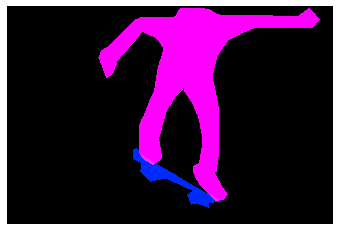

(427, 640, 3)
COCO_val2014_000000283187.jpg
{'person_bbx': [71.59, 236.51, 425.0, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [0.0, 117.49, 327.91, 625.18], 'Verbs': 'catch', 'object': {'obj_bbx': [311.64, 222.03, 334.21999999999997, 287.82]}}
person
frisbee
catch
catch interaction
{'person_bbx': [0.0, 117.49, 327.91, 625.18], 'Verbs': 'hold', 'object': {'obj_bbx': [311.64, 222.03, 334.21999999999997, 287.82]}}
person
frisbee
hold
hold interaction
{'person_bbx': [71.59, 236.51, 425.0, 640.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [0.0, 117.49, 327.91, 625.18], 'Verbs': 'look', 'object': {'obj_bbx': [311.64, 222.03, 334.21999999999997, 287.82]}}
person
frisbee
look
look interaction
{'person_bbx': [71.59, 236.51, 425.0, 640.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 117.49, 327.91, 625.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


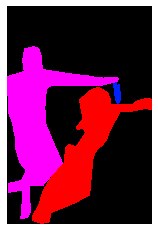

(640, 425, 3)
COCO_val2014_000000237357.jpg
{'person_bbx': [71.91, 248.57, 348.03999999999996, 625.38], 'Verbs': 'catch', 'object': {'obj_bbx': [0.0, 298.3, 23.79, 330.38]}}
person
frisbee
catch
catch interaction
{'person_bbx': [71.91, 248.57, 348.03999999999996, 625.38], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 298.3, 23.79, 330.38]}}
person
frisbee
look
look interaction
{'person_bbx': [71.91, 248.57, 348.03999999999996, 625.38], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [71.91, 248.57, 348.03999999999996, 625.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


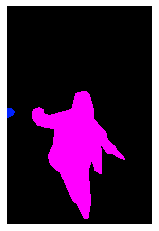

(640, 426, 3)
COCO_val2014_000000160828.jpg
{'person_bbx': [196.36, 44.15, 472.94, 305.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [196.36, 44.15, 472.94, 305.27], 'Verbs': 'surf', 'object': {'obj_bbx': [374.02, 249.35, 556.93, 333.83]}}
person
surfboard
surf
surf interaction


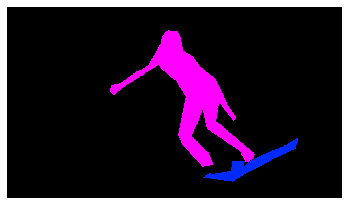

(365, 640, 3)
COCO_val2014_000000493728.jpg
{'person_bbx': [305.14, 7.68, 587.24, 422.2], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [264.66, 18.61, 407.56000000000006, 208.73000000000002]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [305.14, 7.68, 587.24, 422.2], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [103.63, 212.06, 304.18, 424.12]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [305.14, 7.68, 587.24, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [264.66, 18.61, 407.56000000000006, 208.73000000000002]}}
person
knife
hold
hold interaction
{'person_bbx': [305.14, 7.68, 587.24, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [103.63, 212.06, 304.18, 424.12]}}
person
cake
look
look interaction
{'person_bbx': [305.14, 7.68, 587.24, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


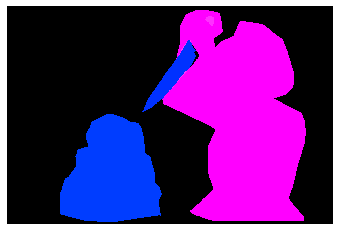

(427, 640, 3)
COCO_val2014_000000550444.jpg
{'person_bbx': [309.41, 86.51, 417.36, 317.84000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [14.86, 100.91, 234.13, 361.46000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [353.11, 311.85, 391.5, 352.16]}}
sports ball
person
kick
kick interaction
{'person_bbx': [309.41, 86.51, 417.36, 317.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [353.11, 311.85, 391.5, 352.16]}}
sports ball
person
look
look interaction
{'person_bbx': [466.87, 97.35, 569.4300000000001, 377.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [353.11, 311.85, 391.5, 352.16]}}
sports ball
person
look
look interaction
{'person_bbx': [14.86, 100.91, 234.13, 361.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [353.11, 311.85, 391.5, 352.16]}}
sports ball
person
look
look interaction
{'person_bbx': [309.41, 86.51, 417.36, 317.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [14.

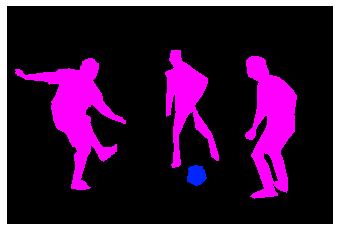

(427, 640, 3)
COCO_val2014_000000438623.jpg
{'person_bbx': [0.0, 39.42, 398.42, 437.57], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [211.65, 173.19, 238.28, 203.03]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [299.1, 122.33, 640.0, 439.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [480.8, 239.75, 538.29, 284.29]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 39.42, 398.42, 437.57], 'Verbs': 'hold', 'object': {'obj_bbx': [211.65, 173.19, 238.28, 203.03]}}
person
hot dog
hold
hold interaction
{'person_bbx': [299.1, 122.33, 640.0, 439.0], 'Verbs': 'hold', 'object': {'obj_bbx': [480.8, 239.75, 538.29, 284.29]}}
hot dog
person
hold
hold interaction
{'person_bbx': [0.0, 39.42, 398.42, 437.57], 'Verbs': 'look', 'object': {'obj_bbx': [296.35, 266.07, 354.15000000000003, 299.0]}}
hot dog
person
look
look interaction
{'person_bbx': [0.0, 39.42, 398.42, 437.57], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [299.1, 122.33, 640.0, 439.0], 'V

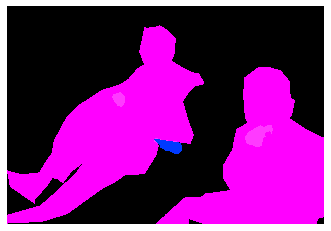

(439, 640, 3)
COCO_val2014_000000346089.jpg
{'person_bbx': [4.13, 45.73, 306.69, 503.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [4.13, 45.73, 306.69, 503.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [366.58, 316.47, 424.47999999999996, 373.72]}}
person
cake
look
look interaction
{'person_bbx': [4.13, 45.73, 306.69, 503.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


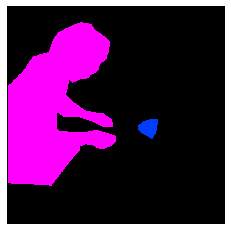

(612, 612, 3)
COCO_val2014_000000362869.jpg
{'person_bbx': [0.0, 0.0, 394.38, 352.25], 'Verbs': 'hold', 'object': {'obj_bbx': [319.93, 114.85, 435.3, 257.39]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 394.38, 352.25], 'Verbs': 'look', 'object': {'obj_bbx': [319.93, 114.85, 435.3, 257.39]}}
cell phone
person
look
look interaction
{'person_bbx': [0.0, 0.0, 394.38, 352.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.0, 394.38, 352.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


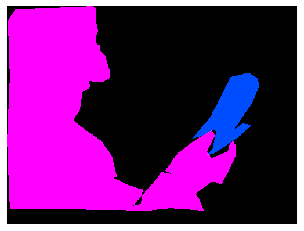

(375, 500, 3)
COCO_val2014_000000345665.jpg
{'person_bbx': [10.07, 96.36, 388.31, 638.5600000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [151.62, 244.33, 233.16000000000003, 324.02]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [10.07, 96.36, 388.31, 638.5600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [151.62, 244.33, 233.16000000000003, 324.02]}}
person
hot dog
hold
hold interaction
{'person_bbx': [10.07, 96.36, 388.31, 638.5600000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


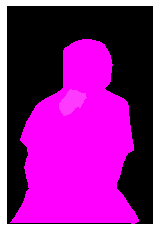

(640, 427, 3)
COCO_val2014_000000561314.jpg
{'person_bbx': [582.28, 287.68, 640.0, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [240.54, 74.43, 640.0, 435.78000000000003]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [582.28, 287.68, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [240.54, 74.43, 640.0, 435.78000000000003]}}
scissors
person
hold
hold interaction


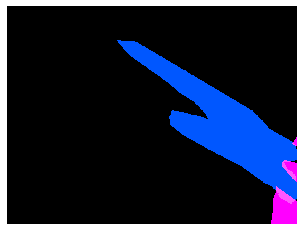

(480, 640, 3)
COCO_val2014_000000216944.jpg
{'person_bbx': [253.45, 0.0, 627.1800000000001, 337.93], 'Verbs': 'lay', 'object': {'obj_bbx': [159.29, 301.01, 640.0, 420.95]}}
person
bed
lay
lay interaction
{'person_bbx': [253.45, 0.0, 627.1800000000001, 337.93], 'Verbs': 'read', 'object': {'obj_bbx': [363.8, 293.14, 640.0, 380.32]}}
person
book
read
read interaction


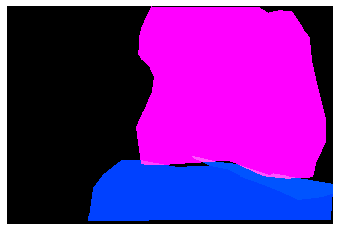

(427, 640, 3)
COCO_val2014_000000162332.jpg
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [264.55, 389.59, 317.03000000000003, 425.97999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [123.78, 216.86, 292.65999999999997, 427.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [264.55, 389.59, 317.03000000000003, 425.97999999999996]}}
person
knife
hold
hold interaction
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [123.78, 216.86, 292.65999999999997, 427.0]}}
person
cake
look
look interaction
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [267.71, 0.0, 640.0, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


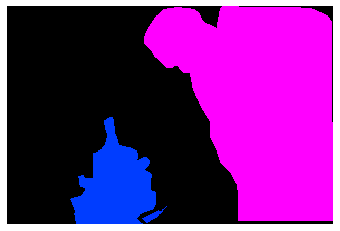

(427, 640, 3)
COCO_val2014_000000484441.jpg
{'person_bbx': [296.23, 152.63, 432.81000000000006, 347.88], 'Verbs': 'catch', 'object': {'obj_bbx': [107.54, 289.21, 123.38000000000001, 304.14]}}
sports ball
person
catch
catch interaction
{'person_bbx': [129.46, 64.49, 327.52, 358.2], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [107.59, 19.83, 139.29, 104.72]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [129.46, 64.49, 327.52, 358.2], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [107.54, 289.21, 123.38000000000001, 304.14]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [129.46, 64.49, 327.52, 358.2], 'Verbs': 'hold', 'object': {'obj_bbx': [107.59, 19.83, 139.29, 104.72]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [296.23, 152.63, 432.81000000000006, 347.88], 'Verbs': 'look', 'object': {'obj_bbx': [107.54, 289.21, 123.38000000000001, 304.14]}}
sports ball
person
look
look interaction
{'person_bbx': [129.46, 64.49, 327.52, 358.2], 'Verbs':

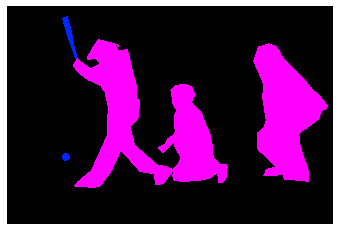

(428, 640, 3)
COCO_val2014_000000217223.jpg
{'person_bbx': [99.96, 229.04, 136.94, 341.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [483.43, 210.49, 543.53, 330.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [502.3, 323.38, 536.42, 348.59]}}
person
skis
hold
hold interaction
{'person_bbx': [218.38, 223.24, 272.43, 329.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [171.6, 228.14, 199.76999999999998, 333.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [424.99, 222.2, 453.03000000000003, 322.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [331.76, 215.11, 367.14, 321.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.49, 229.0, 175.35000000000002, 331.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [378.18, 284.97, 434.81, 345.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [483.43,

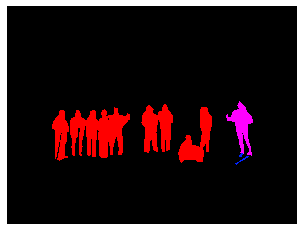

(480, 640, 3)
COCO_val2014_000000290602.jpg
{'person_bbx': [327.22, 81.29, 391.58000000000004, 216.72000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [314.09, 193.1, 417.90999999999997, 236.01]}}
snowboard
person
hold
hold interaction
{'person_bbx': [327.22, 81.29, 391.58000000000004, 216.72000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [314.09, 193.1, 417.90999999999997, 236.01]}}
snowboard
person
jump
jump interaction
{'person_bbx': [327.22, 81.29, 391.58000000000004, 216.72000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [314.09, 193.1, 417.90999999999997, 236.01]}}
snowboard
person
snowboard
snowboard interaction


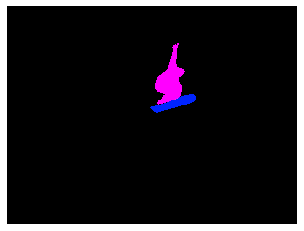

(480, 640, 3)
COCO_val2014_000000266491.jpg
{'person_bbx': [381.24, 194.6, 446.89, 328.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [236.5, 181.21, 293.95, 315.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [381.24, 194.6, 446.89, 328.15], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [236.5, 181.21, 293.95, 315.5], 'Verbs': 'ski', 'object': {'obj_bbx': [241.62, 307.73, 267.27, 320.47]}}
person
skis
ski
ski interaction
{'person_bbx': [381.24, 194.6, 446.89, 328.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [236.5, 181.21, 293.95, 315.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


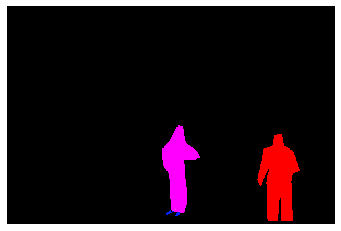

(332, 500, 3)
COCO_val2014_000000293548.jpg
{'person_bbx': [449.8, 48.54, 640.0, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [490.92, 369.21, 572.12, 398.74]}}
cell phone
person
hold
hold interaction
{'person_bbx': [144.54, 76.58, 454.11, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [354.87, 344.64, 424.99, 408.74]}}
cup
person
hold
hold interaction
{'person_bbx': [449.8, 48.54, 640.0, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [144.54, 76.58, 454.11, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [449.8, 48.54, 640.0, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.16, 138.07, 231.91, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.54, 76.58, 454.11, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


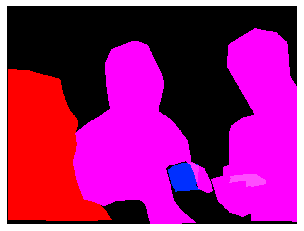

(480, 640, 3)
COCO_val2014_000000343248.jpg
{'person_bbx': [222.3, 48.87, 499.77000000000004, 346.06], 'Verbs': 'hold', 'object': {'obj_bbx': [250.65, 89.57, 353.76, 292.03999999999996]}}
bottle
person
hold
hold interaction


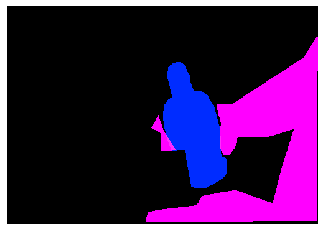

(350, 500, 3)
COCO_val2014_000000532855.jpg
{'person_bbx': [63.67, 0.86, 348.14000000000004, 225.76000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [238.56, 187.0, 345.27, 243.8]}}
person
skateboard
skateboard
skateboard interaction


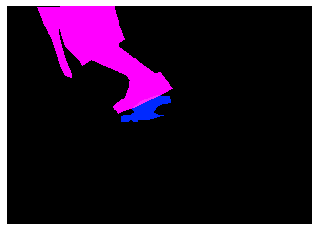

(457, 640, 3)
COCO_val2014_000000393056.jpg
{'person_bbx': [271.76, 189.03, 333.14, 284.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [271.76, 189.03, 333.14, 284.12], 'Verbs': 'surf', 'object': {'obj_bbx': [248.71, 282.85, 284.57, 295.8]}}
person
surfboard
surf
surf interaction


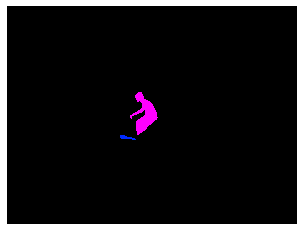

(480, 640, 3)
COCO_val2014_000000145215.jpg
{'person_bbx': [110.66, 279.97, 150.8, 359.97], 'Verbs': 'carry', 'object': {'obj_bbx': [74.93, 315.73, 177.31, 358.67]}}
person
surfboard
carry
carry interaction
{'person_bbx': [110.66, 279.97, 150.8, 359.97], 'Verbs': 'hold', 'object': {'obj_bbx': [74.93, 315.73, 177.31, 358.67]}}
person
surfboard
hold
hold interaction
{'person_bbx': [110.66, 279.97, 150.8, 359.97], 'Verbs': 'look', 'object': {'obj_bbx': [74.93, 315.73, 177.31, 358.67]}}
person
surfboard
look
look interaction
{'person_bbx': [110.66, 279.97, 150.8, 359.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [110.66, 279.97, 150.8, 359.97], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


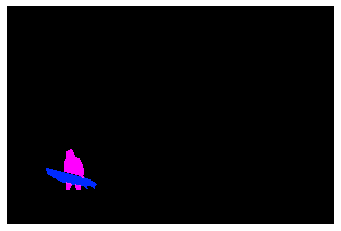

(426, 640, 3)
COCO_val2014_000000080185.jpg
{'person_bbx': [221.2, 100.98, 631.26, 530.0], 'Verbs': 'hold', 'object': {'obj_bbx': [341.29, 257.82, 498.98, 299.81]}}
person
book
hold
hold interaction
{'person_bbx': [221.2, 100.98, 631.26, 530.0], 'Verbs': 'look', 'object': {'obj_bbx': [341.29, 257.82, 498.98, 299.81]}}
person
book
look
look interaction
{'person_bbx': [221.2, 100.98, 631.26, 530.0], 'Verbs': 'read', 'object': {'obj_bbx': [341.29, 257.82, 498.98, 299.81]}}
person
book
read
read interaction
{'person_bbx': [221.2, 100.98, 631.26, 530.0], 'Verbs': 'sit', 'object': {'obj_bbx': [219.64, 210.69, 640.0, 523.4300000000001]}}
bench
person
sit
sit interaction


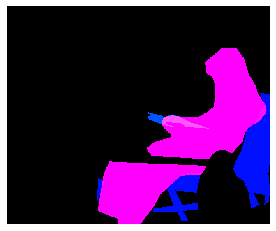

(530, 640, 3)
COCO_val2014_000000227855.jpg
{'person_bbx': [87.55, 19.46, 313.54, 223.75], 'Verbs': 'jump', 'object': {'obj_bbx': [33.52, 77.55, 279.36, 291.35]}}
person
snowboard
jump
jump interaction
{'person_bbx': [87.55, 19.46, 313.54, 223.75], 'Verbs': 'look', 'object': {'obj_bbx': [33.52, 77.55, 279.36, 291.35]}}
person
snowboard
look
look interaction
{'person_bbx': [87.55, 19.46, 313.54, 223.75], 'Verbs': 'snowboard', 'object': {'obj_bbx': [33.52, 77.55, 279.36, 291.35]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [87.55, 19.46, 313.54, 223.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


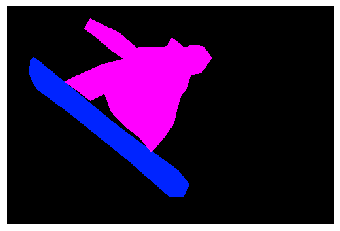

(333, 500, 3)
COCO_val2014_000000169514.jpg
{'person_bbx': [125.84, 275.66, 347.57, 424.27000000000004], 'Verbs': 'surf', 'object': {'obj_bbx': [120.7, 176.36, 220.04000000000002, 427.15]}}
surfboard
person
surf
surf interaction


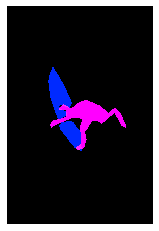

(640, 428, 3)
COCO_val2014_000000221172.jpg
{'person_bbx': [218.43, 121.95, 381.78, 379.71999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [317.9, 234.05, 352.46999999999997, 254.67000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [218.43, 121.95, 381.78, 379.71999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [374.78, 269.09, 386.80999999999995, 281.42999999999995]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [218.43, 121.95, 381.78, 379.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [317.9, 234.05, 352.46999999999997, 254.67000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [218.43, 121.95, 381.78, 379.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [374.78, 269.09, 386.80999999999995, 281.42999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [434.68, 12.47, 522.96, 218.78], 'Verbs': 'look', 'object': {'obj_bbx': [374.78, 269.09, 386.80999999999995, 281.42

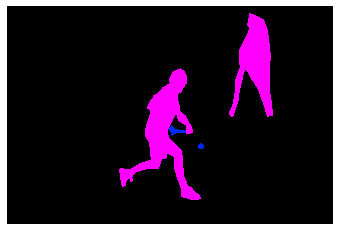

(427, 640, 3)
COCO_val2014_000000267802.jpg
{'person_bbx': [245.74, 252.87, 309.62, 354.75], 'Verbs': 'hold', 'object': {'obj_bbx': [234.66, 284.88, 319.18, 375.77]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [66.62, 251.22, 158.38, 385.25], 'Verbs': 'hold', 'object': {'obj_bbx': [68.36, 298.79, 135.67000000000002, 420.79]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [245.74, 252.87, 309.62, 354.75], 'Verbs': 'ride', 'object': {'obj_bbx': [234.66, 284.88, 319.18, 375.77]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [66.62, 251.22, 158.38, 385.25], 'Verbs': 'ride', 'object': {'obj_bbx': [68.36, 298.79, 135.67000000000002, 420.79]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [245.74, 252.87, 309.62, 354.75], 'Verbs': 'sit', 'object': {'obj_bbx': [234.66, 284.88, 319.18, 375.77]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [66.62, 251.22, 158.38, 385.25], 'Verbs': 'sit', 'object': {'obj_bbx': [68.36, 298.79, 135.67000000000002, 42

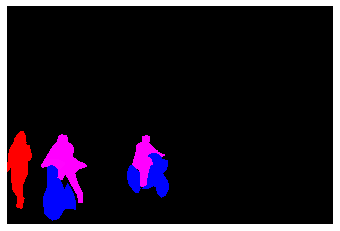

(427, 640, 3)
COCO_val2014_000000290948.jpg
{'person_bbx': [69.98, 62.97, 279.59000000000003, 230.41], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [195.41, 72.55, 408.46000000000004, 231.21999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [69.98, 62.97, 279.59000000000003, 230.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [195.41, 72.55, 408.46000000000004, 231.21999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


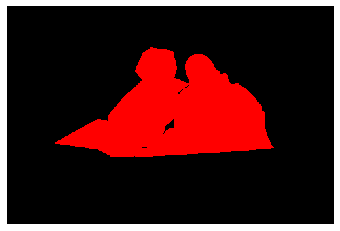

(333, 500, 3)
COCO_val2014_000000335981.jpg
{'person_bbx': [429.63, 201.08, 520.93, 444.65], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [522.3, 195.41, 632.8199999999999, 478.47], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [355.96, 207.1, 413.12, 433.62], 'Verbs': 'hold', 'object': {'obj_bbx': [389.38, 226.16, 398.42, 236.71]}}
cell phone
person
hold
hold interaction
{'person_bbx': [429.63, 201.08, 520.93, 444.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [522.3, 195.41, 632.8199999999999, 478.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [522.3, 195.41, 632.8199999999999, 478.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [355.96, 207.1, 413.12, 433.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [429.63, 201.08, 520.93, 444.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [522.3,

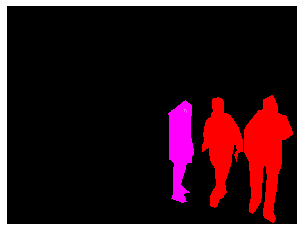

(480, 640, 3)
COCO_val2014_000000516856.jpg
{'person_bbx': [196.12, 47.4, 465.91, 362.71], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [287.29, 173.42, 347.39000000000004, 289.86]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [196.12, 47.4, 465.91, 362.71], 'Verbs': 'hold', 'object': {'obj_bbx': [287.29, 173.42, 347.39000000000004, 289.86]}}
sandwich
person
hold
hold interaction
{'person_bbx': [196.12, 47.4, 465.91, 362.71], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


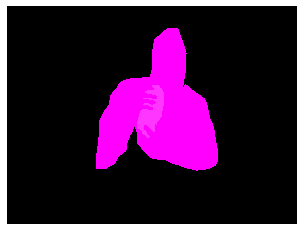

(480, 640, 3)
COCO_val2014_000000475389.jpg
{'person_bbx': [307.78, 77.66, 425.71, 484.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [33.08, 105.35, 212.85000000000002, 533.93]}}
person
person
look
look interaction
{'person_bbx': [33.08, 105.35, 212.85000000000002, 533.93], 'Verbs': 'ride', 'object': {'obj_bbx': [106.16, 194.46, 322.9, 621.87]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [33.08, 105.35, 212.85000000000002, 533.93], 'Verbs': 'sit', 'object': {'obj_bbx': [106.16, 194.46, 322.9, 621.87]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [307.78, 77.66, 425.71, 484.66999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [33.08, 105.35, 212.85000000000002, 533.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [307.78, 77.66, 425.71, 484.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


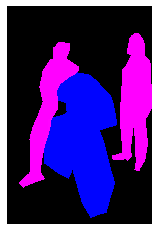

(640, 426, 3)
COCO_val2014_000000525702.jpg
{'person_bbx': [0.0, 264.0, 258.24, 498.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [113.56, 348.33, 131.76, 376.78999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 264.0, 258.24, 498.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 264.0, 258.24, 498.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.86, 467.91, 74.11, 499.53000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 264.0, 258.24, 498.71000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 264.0, 258.24, 498.71000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [113.56, 348.33, 131.76, 376.78999999999996]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


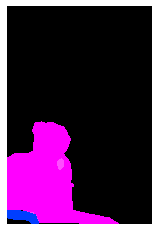

(500, 333, 3)
COCO_val2014_000000210564.jpg
{'person_bbx': [312.84, 23.51, 345.7, 111.88000000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [312.84, 23.51, 345.7, 111.88000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [289.96, 34.93, 304.78, 89.37]}}
person
person
look
look interaction
{'person_bbx': [312.84, 23.51, 345.7, 111.88000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [312.84, 23.51, 345.7, 111.88000000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


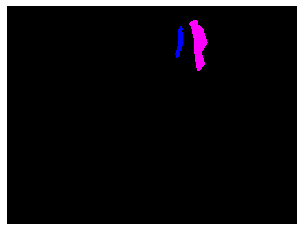

(375, 500, 3)
COCO_val2014_000000444304.jpg
{'person_bbx': [0.0, 1.03, 210.16, 424.23999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [301.9, 108.97, 455.4, 229.11]}}
tv
person
look
look interaction


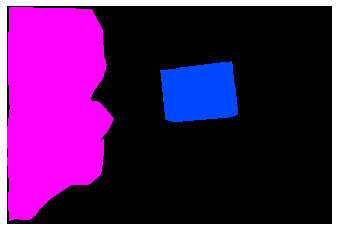

(429, 640, 3)
COCO_val2014_000000372844.jpg
{'person_bbx': [240.82, 50.37, 411.61, 307.51], 'Verbs': 'catch', 'object': {'obj_bbx': [416.1, 12.3, 461.61, 28.82]}}
frisbee
person
catch
catch interaction
{'person_bbx': [392.57, 10.19, 480.44, 395.12], 'Verbs': 'catch', 'object': {'obj_bbx': [416.1, 12.3, 461.61, 28.82]}}
frisbee
person
catch
catch interaction
{'person_bbx': [240.82, 50.37, 411.61, 307.51], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [392.57, 10.19, 480.44, 395.12], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [240.82, 50.37, 411.61, 307.51], 'Verbs': 'look', 'object': {'obj_bbx': [416.1, 12.3, 461.61, 28.82]}}
frisbee
person
look
look interaction
{'person_bbx': [392.57, 10.19, 480.44, 395.12], 'Verbs': 'look', 'object': {'obj_bbx': [416.1, 12.3, 461.61, 28.82]}}
frisbee
person
look
look interaction
{'person_bbx': [392.57, 10.19, 480.44, 395.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


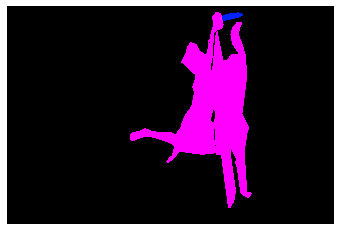

(426, 640, 3)
COCO_val2014_000000466561.jpg
{'person_bbx': [138.18, 83.48, 389.58000000000004, 422.20000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [369.17, 107.71, 543.63, 228.2]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [138.18, 83.48, 389.58000000000004, 422.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [369.17, 107.71, 543.63, 228.2]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [138.18, 83.48, 389.58000000000004, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


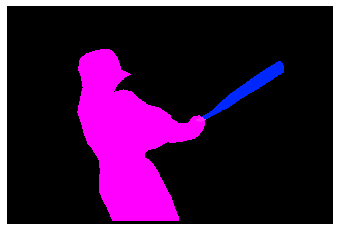

(427, 640, 3)
COCO_val2014_000000043289.jpg
{'person_bbx': [3.18, 525.82, 295.43, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


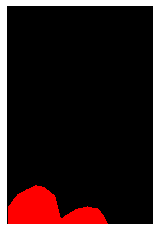

(640, 427, 3)
COCO_val2014_000000002890.jpg
{'person_bbx': [169.96, 158.37, 270.85, 422.83], 'Verbs': 'carry', 'object': {'obj_bbx': [169.2, 183.37, 277.82, 307.38]}}
person
person
carry
carry interaction
{'person_bbx': [169.2, 183.37, 277.82, 307.38], 'Verbs': 'carry', 'object': {'obj_bbx': [169.96, 158.37, 270.85, 422.83]}}
person
person
carry
carry interaction
{'person_bbx': [413.16, 230.11, 512.52, 395.94000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [456.6, 356.62, 497.08000000000004, 392.94]}}
person
skis
hold
hold interaction
{'person_bbx': [169.96, 158.37, 270.85, 422.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [169.2, 183.37, 277.82, 307.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [413.16, 230.11, 512.52, 395.94000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [169.96, 158.37, 270.85, 422.83], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [169.2, 

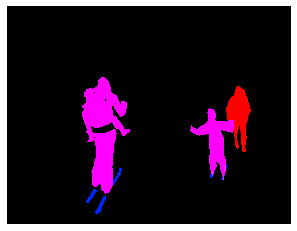

(491, 640, 3)
COCO_val2014_000000315620.jpg
{'person_bbx': [236.45, 60.31, 639.48, 421.21], 'Verbs': 'catch', 'object': {'obj_bbx': [101.78, 167.51, 153.35, 191.69]}}
frisbee
person
catch
catch interaction
{'person_bbx': [236.45, 60.31, 639.48, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [101.78, 167.51, 153.35, 191.69]}}
frisbee
person
look
look interaction
{'person_bbx': [236.45, 60.31, 639.48, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


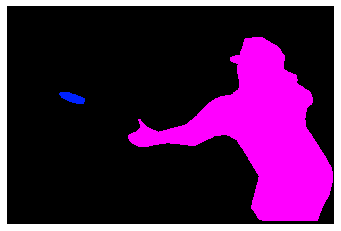

(426, 640, 3)
COCO_val2014_000000516813.jpg
{'person_bbx': [291.99, 74.84, 412.61, 405.19000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': [209.43, 386.34, 479.07, 417.98999999999995]}}
person
skis
ski
ski interaction
{'person_bbx': [291.99, 74.84, 412.61, 405.19000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [291.99, 74.84, 412.61, 405.19000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


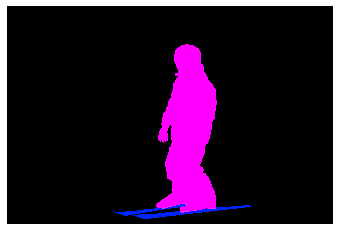

(427, 640, 3)
COCO_val2014_000000018111.jpg
{'person_bbx': [89.66, 230.74, 167.6, 440.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [412.3, 217.24, 577.54, 380.81]}}
person
person
look
look interaction
{'person_bbx': [412.3, 217.24, 577.54, 380.81], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [89.66, 230.74, 167.6, 440.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [48.44, 221.76, 121.87, 416.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


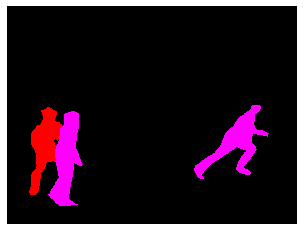

(480, 640, 3)
COCO_val2014_000000150639.jpg
{'person_bbx': [3.84, 1.28, 636.1600000000001, 473.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [130.14, 123.64, 218.60999999999999, 243.23000000000002]}}
person
cell phone
hold
hold interaction
{'person_bbx': [3.84, 1.28, 636.1600000000001, 473.59999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [3.84, 1.28, 636.1600000000001, 473.59999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.84, 1.28, 636.1600000000001, 473.59999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [130.14, 123.64, 218.60999999999999, 243.23000000000002]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


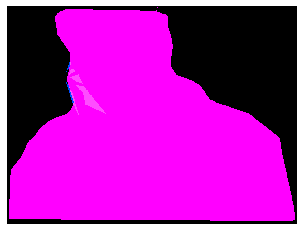

(480, 640, 3)
COCO_val2014_000000163105.jpg
{'person_bbx': [275.06, 2.16, 640.0, 474.61], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


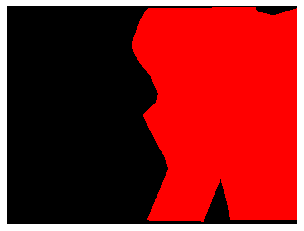

(480, 640, 3)
COCO_val2014_000000342633.jpg
{'person_bbx': [364.46, 65.15, 596.21, 412.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [467.69, 122.95, 472.62, 146.3]}}
person
cell phone
hold
hold interaction
{'person_bbx': [92.37, 40.41, 309.64, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [364.46, 65.15, 596.21, 412.29999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [8.62, 10.59, 100.52000000000001, 418.40999999999997]}}
person
person
look
look interaction
{'person_bbx': [92.37, 40.41, 309.64, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [84.62, 231.98, 238.72, 304.61]}}
person
bowl
look
look interaction
{'person_bbx': [92.37, 40.41, 309.64, 426.0], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [364.46, 65.15, 596.21, 412.29999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [92.37, 40.41, 309.64, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx'

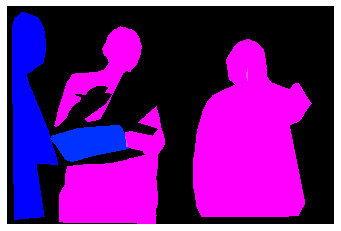

(426, 640, 3)
COCO_val2014_000000025386.jpg
{'person_bbx': [163.16, 119.56, 353.04999999999995, 468.4], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [294.7, 314.65, 334.31, 357.03]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 109.7, 296.45, 639.72], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [252.57, 397.96, 292.27, 439.69]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [163.16, 119.56, 353.04999999999995, 468.4], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 109.7, 296.45, 639.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [163.16, 119.56, 353.04999999999995, 468.4], 'Verbs': 'sit', 'object': {'obj_bbx': [0.59, 164.83, 81.21000000000001, 273.64]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 109.7, 296.45, 639.72], 'Verbs': 'sit', 'object': {'obj_bbx': [0.59, 164.83, 81.21000000000001, 273.64]}}
person
chair
sit
sit interaction
{'person_bbx': [163.16, 119.56, 353.04999999999995, 468.4],

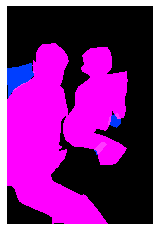

(640, 427, 3)
COCO_val2014_000000526004.jpg
{'person_bbx': [79.28, 23.78, 386.30999999999995, 423.05999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [177.74, 216.0, 281.33000000000004, 333.90999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.0, 355.9, 466.54], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [177.74, 216.0, 281.33000000000004, 333.90999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [79.28, 23.78, 386.30999999999995, 423.05999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [177.74, 216.0, 281.33000000000004, 333.90999999999997]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 0.0, 355.9, 466.54], 'Verbs': 'hold', 'object': {'obj_bbx': [79.28, 23.78, 386.30999999999995, 423.05999999999995]}}
person
person
hold
hold interaction
{'person_bbx': [79.28, 23.78, 386.30999999999995, 423.05999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.0, 355.9, 466.54], 'Verbs': 'sit', '

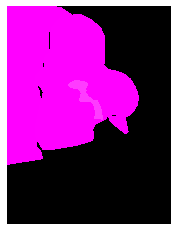

(640, 480, 3)
COCO_val2014_000000412894.jpg
{'person_bbx': [195.74, 488.62, 243.58, 619.54], 'Verbs': 'carry', 'object': {'obj_bbx': [208.1, 505.2, 229.98, 537.25]}}
person
handbag
carry
carry interaction
{'person_bbx': [359.55, 475.32, 418.53000000000003, 606.53], 'Verbs': 'carry', 'object': {'obj_bbx': [359.57, 499.44, 376.3, 532.41]}}
person
backpack
carry
carry interaction
{'person_bbx': [0.82, 537.34, 63.81, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [102.41, 512.83, 154.07, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [195.74, 488.62, 243.58, 619.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [359.55, 475.32, 418.53000000000003, 606.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [162.16, 523.14, 209.61, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.82, 537.34, 63.81, 640.0], 'Verbs': 'stand', 'object': {'obj_bb

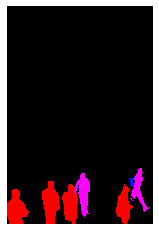

(640, 427, 3)
COCO_val2014_000000021164.jpg
{'person_bbx': [287.71, 214.92, 352.92999999999995, 350.42999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [272.13, 135.44, 418.47, 271.38]}}
person
surfboard
carry
carry interaction
{'person_bbx': [287.71, 214.92, 352.92999999999995, 350.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [272.13, 135.44, 418.47, 271.38]}}
person
surfboard
hold
hold interaction
{'person_bbx': [287.71, 214.92, 352.92999999999995, 350.42999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [287.71, 214.92, 352.92999999999995, 350.42999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


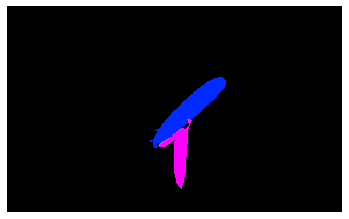

(393, 640, 3)
COCO_val2014_000000061983.jpg
{'person_bbx': [350.41, 95.85, 526.57, 341.9], 'Verbs': 'look', 'object': {'obj_bbx': [208.3, 230.66, 370.44, 319.51]}}
person
laptop
look
look interaction
{'person_bbx': [350.41, 95.85, 526.57, 341.9], 'Verbs': 'sit', 'object': {'obj_bbx': [2.22, 100.08, 640.0, 421.44]}}
person
bed
sit
sit interaction
{'person_bbx': [350.41, 95.85, 526.57, 341.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [350.41, 95.85, 526.57, 341.9], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [208.3, 230.66, 370.44, 319.51]}}
person
laptop
work_on_computer
work_on_computer interaction


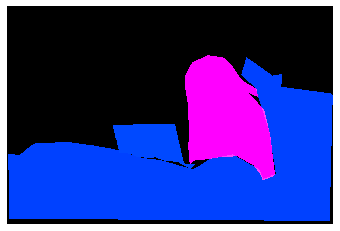

(427, 640, 3)
COCO_val2014_000000376531.jpg
{'person_bbx': [181.21, 280.45, 330.79, 562.3399999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [291.7, 389.31, 408.14, 442.52]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [181.21, 280.45, 330.79, 562.3399999999999], 'Verbs': 'look', 'object': {'obj_bbx': [184.06, 100.79, 206.44, 125.25]}}
sports ball
person
look
look interaction
{'person_bbx': [181.21, 280.45, 330.79, 562.3399999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [181.21, 280.45, 330.79, 562.3399999999999], 'Verbs': 'throw', 'object': {'obj_bbx': [184.06, 100.79, 206.44, 125.25]}}
sports ball
person
throw
throw interaction


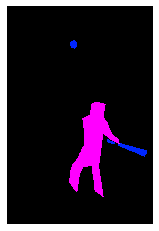

(640, 427, 3)
COCO_val2014_000000533449.jpg
{'person_bbx': [0.0, 1.57, 151.77, 391.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [94.97, 324.12, 183.85, 354.73]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 1.57, 151.77, 391.01], 'Verbs': 'look', 'object': {'obj_bbx': [94.97, 324.12, 183.85, 354.73]}}
person
pizza
look
look interaction
{'person_bbx': [169.42, 2.47, 425.0, 320.29], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 1.57, 151.77, 391.01], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [169.42, 2.47, 425.0, 320.29], 'Verbs': 'sit', 'object': {'obj_bbx': [143.63, 168.84, 215.54, 308.0]}}
person
chair
sit
sit interaction


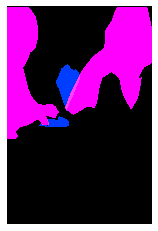

(640, 425, 3)
COCO_val2014_000000161231.jpg
{'person_bbx': [129.82, 235.03, 196.83999999999997, 401.9], 'Verbs': 'carry', 'object': {'obj_bbx': [136.93, 291.23, 180.3, 335.62]}}
person
handbag
carry
carry interaction
{'person_bbx': [129.82, 235.03, 196.83999999999997, 401.9], 'Verbs': 'hold', 'object': {'obj_bbx': [136.93, 291.23, 180.3, 335.62]}}
person
handbag
hold
hold interaction
{'person_bbx': [129.82, 235.03, 196.83999999999997, 401.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [129.82, 235.03, 196.83999999999997, 401.9], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


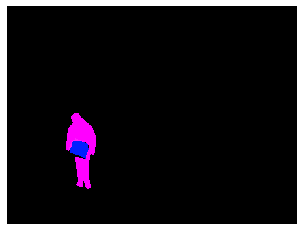

(480, 640, 3)
COCO_val2014_000000562062.jpg


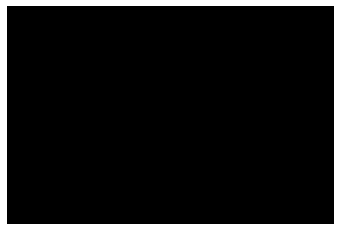

(426, 640, 3)
COCO_val2014_000000037689.jpg
{'person_bbx': [215.92, 63.61, 271.83, 105.67], 'Verbs': 'jump', 'object': {'obj_bbx': [201.16, 64.6, 229.76, 105.28999999999999]}}
person
snowboard
jump
jump interaction
{'person_bbx': [215.92, 63.61, 271.83, 105.67], 'Verbs': 'snowboard', 'object': {'obj_bbx': [201.16, 64.6, 229.76, 105.28999999999999]}}
person
snowboard
snowboard
snowboard interaction


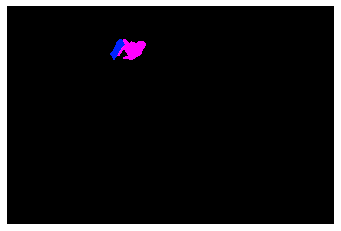

(426, 640, 3)
COCO_val2014_000000341318.jpg
{'person_bbx': [290.68, 180.11, 364.11, 317.28], 'Verbs': 'look', 'object': {'obj_bbx': [153.16, 300.49, 239.63, 339.32]}}
person
surfboard
look
look interaction
{'person_bbx': [313.02, 219.54, 390.24, 317.9], 'Verbs': 'look', 'object': {'obj_bbx': [290.68, 180.11, 364.11, 317.28]}}
person
person
look
look interaction
{'person_bbx': [1.11, 290.83, 61.29, 420.09], 'Verbs': 'look', 'object': {'obj_bbx': [290.68, 180.11, 364.11, 317.28]}}
person
person
look
look interaction
{'person_bbx': [290.68, 180.11, 364.11, 317.28], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [313.02, 219.54, 390.24, 317.9], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [1.11, 290.83, 61.29, 420.09], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


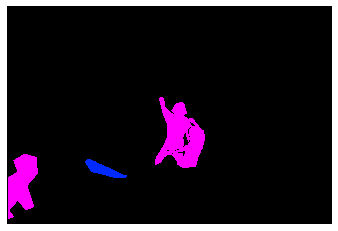

(429, 640, 3)
COCO_val2014_000000071986.jpg
{'person_bbx': [210.32, 133.55, 251.64999999999998, 252.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [125.97, 136.43, 152.95, 246.66000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [402.84, 139.75, 445.7, 230.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [251.5, 132.33, 312.17, 250.8], 'Verbs': 'hold', 'object': {'obj_bbx': [269.3, 149.81, 291.92, 181.9]}}
backpack
person
hold
hold interaction
{'person_bbx': [210.32, 133.55, 251.64999999999998, 252.83], 'Verbs': 'ski', 'object': {'obj_bbx': [217.38, 236.38, 251.26, 263.49]}}
person
skis
ski
ski interaction
{'person_bbx': [49.94, 134.66, 99.62, 261.73], 'Verbs': 'ski', 'object': {'obj_bbx': [80.66, 257.89, 123.77, 267.78999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [402.84, 139.75, 445.7, 230.13], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [251.5, 132.33,

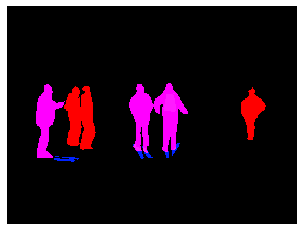

(375, 500, 3)
COCO_val2014_000000405574.jpg
{'person_bbx': [238.27, 20.28, 423.32000000000005, 273.76], 'Verbs': 'look', 'object': {'obj_bbx': [68.43, 107.82, 166.28, 207.42]}}
bird
person
look
look interaction
{'person_bbx': [238.27, 20.28, 423.32000000000005, 273.76], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [238.27, 20.28, 423.32000000000005, 273.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [238.27, 20.28, 423.32000000000005, 273.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


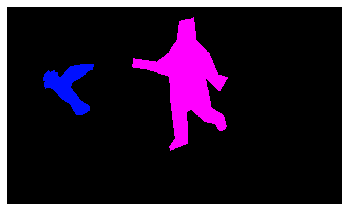

(376, 640, 3)
COCO_val2014_000000281733.jpg
{'person_bbx': [1.43, 4.47, 480.0, 630.12], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [116.49, 368.42, 455.84000000000003, 639.59]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [1.43, 4.47, 480.0, 630.12], 'Verbs': 'hold', 'object': {'obj_bbx': [116.49, 368.42, 455.84000000000003, 639.59]}}
person
donut
hold
hold interaction


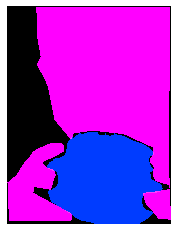

(640, 480, 3)
COCO_val2014_000000309862.jpg
{'person_bbx': [235.64, 161.58, 364.52, 416.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [126.96, 211.6, 496.28999999999996, 422.23]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [147.3, 163.67, 261.8, 408.97], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [147.3, 163.67, 261.8, 408.97], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [235.64, 161.58, 364.52, 416.46000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [126.96, 211.6, 496.28999999999996, 422.23]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [147.3, 163.67, 261.8, 408.97], 'Verbs': 'ride', 'object': {'obj_bbx': [126.96, 211.6, 496.28999999999996, 422.23]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [235.64, 161.58, 364.52, 416.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [126.96, 211.6, 496.28999999999996, 422.23]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [147.3, 

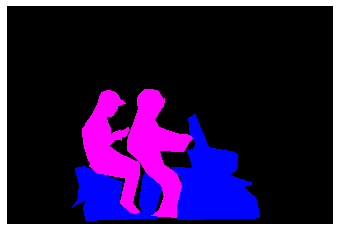

(428, 640, 3)
COCO_val2014_000000029793.jpg
{'person_bbx': [281.71, 133.16, 335.9, 199.42000000000002], 'Verbs': 'lay', 'object': {'obj_bbx': [238.94, 130.97, 500.0, 306.52]}}
bed
person
lay
lay interaction
{'person_bbx': [45.9, 134.11, 125.41, 201.68], 'Verbs': 'sit', 'object': {'obj_bbx': [14.63, 157.44, 277.96, 310.0]}}
bed
person
sit
sit interaction
{'person_bbx': [281.71, 133.16, 335.9, 199.42000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [238.94, 130.97, 500.0, 306.52]}}
bed
person
sit
sit interaction


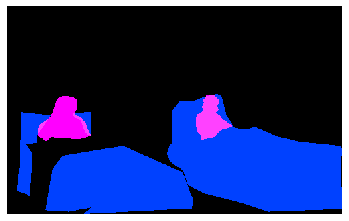

(310, 500, 3)
COCO_val2014_000000347023.jpg
{'person_bbx': [90.63, 309.74, 309.78999999999996, 447.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [90.63, 309.74, 309.78999999999996, 447.69], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [90.63, 309.74, 309.78999999999996, 447.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [90.63, 309.74, 309.78999999999996, 447.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


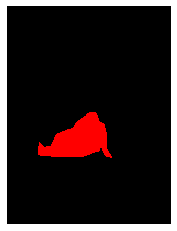

(640, 480, 3)
COCO_val2014_000000093717.jpg
{'person_bbx': [208.33, 52.64, 468.90999999999997, 325.13], 'Verbs': 'jump', 'object': {'obj_bbx': [372.02, 267.24, 494.09, 325.39]}}
skateboard
person
jump
jump interaction
{'person_bbx': [208.33, 52.64, 468.90999999999997, 325.13], 'Verbs': 'look', 'object': {'obj_bbx': [372.02, 267.24, 494.09, 325.39]}}
skateboard
person
look
look interaction
{'person_bbx': [208.33, 52.64, 468.90999999999997, 325.13], 'Verbs': 'skateboard', 'object': {'obj_bbx': [372.02, 267.24, 494.09, 325.39]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [208.33, 52.64, 468.90999999999997, 325.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


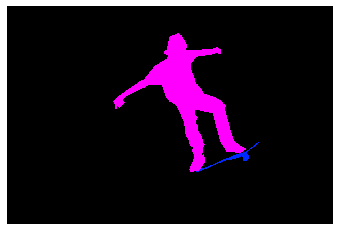

(427, 640, 3)
COCO_val2014_000000482829.jpg
{'person_bbx': [37.34, 0.96, 440.4, 422.21], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [333.92, 282.11, 625.63, 412.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [37.34, 0.96, 440.4, 422.21], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [564.33, 355.6, 598.47, 390.38]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [37.34, 0.96, 440.4, 422.21], 'Verbs': 'hold', 'object': {'obj_bbx': [333.92, 282.11, 625.63, 412.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [37.34, 0.96, 440.4, 422.21], 'Verbs': 'look', 'object': {'obj_bbx': [564.33, 355.6, 598.47, 390.38]}}
sports ball
person
look
look interaction
{'person_bbx': [37.34, 0.96, 440.4, 422.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000409198.jpg
{'person_bbx': [202.47, 38.45, 456.75, 383.88], 'Verbs': 'catch', 'object': {'obj_bbx': [191.64, 174.06, 259.01, 239.94]}}
person
frisbee
catch
catch interaction
{'person_bbx': [202.47, 38.45, 456.75, 383.88], 'Verbs': 'hold', 'object': {'obj_bbx': [191.64, 174.06, 259.01, 239.94]}}
person
frisbee
hold
hold interaction
{'person_bbx': [202.47, 38.45, 456.75, 383.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [202.47, 38.45, 456.75, 383.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000029524.jpg
{'person_bbx': [49.32, 54.15, 417.99, 620.05], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [237.03, 401.74, 321.4, 482.69]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [49.32, 54.15, 417.99, 620.05], 'Verbs': 'kick', 'object': {'obj_bbx': [237.03, 401.74, 321.4, 482.69]}}
sports ball
person
kick
kick interaction
{'person_bbx': [49.32, 54.15, 417.99, 620.05], 'Verbs': 'look', 'object': {'obj_bbx': [237.03, 401.74, 321.4, 482.69]}}
sports ball
person
look
look interaction
{'person_bbx': [49.32, 54.15, 417.99, 620.05], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(640, 459, 3)
COCO_val2014_000000481415.jpg
{'person_bbx': [459.96, 139.75, 505.44, 206.51], 'Verbs': 'jump', 'object': {'obj_bbx': [430.82, 188.81, 527.18, 224.15]}}
person
skis
jump
jump interaction
{'person_bbx': [459.96, 139.75, 505.44, 206.51], 'Verbs': 'look', 'object': {'obj_bbx': [430.82, 188.81, 527.18, 224.15]}}
person
skis
look
look interaction
{'person_bbx': [459.96, 139.75, 505.44, 206.51], 'Verbs': 'ski', 'object': {'obj_bbx': [430.82, 188.81, 527.18, 224.15]}}
person
skis
ski
ski interaction
{'person_bbx': [459.96, 139.75, 505.44, 206.51], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard


(480, 640, 3)
COCO_val2014_000000002014.jpg
{'person_bbx': [251.4, 136.26, 449.07, 335.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [271.27, 289.4, 365.29999999999995, 334.65999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [251.4, 136.26, 449.07, 335.84000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [271.27, 289.4, 365.29999999999995, 334.65999999999997]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000349926.jpg
{'person_bbx': [208.72, 143.8, 313.67, 400.17], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [487.45, 187.18, 590.26, 403.08000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [300.3, 21.15, 338.32, 44.89]}}
person
frisbee
catch
catch interaction
{'person_bbx': [304.03, 130.81, 396.97999999999996, 402.89], 'Verbs': 'catch', 'object': {'obj_bbx': [300.3, 21.15, 338.32, 44.89]}}
person
frisbee
catch
catch interaction
{'person_bbx': [208.72, 143.8, 313.67, 400.17], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [304.03, 130.81, 396.97999999999996, 402.89], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [208.72, 143.8, 313.67, 400.17], 'Verbs': 'look', 'object': {'obj_bbx': [300.3, 21.15, 338.32, 44.89]}}
person
frisbee
look
look interaction
{'person_bbx': [48.34, 183.91, 161.24, 392.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [300.3, 21.15, 338.32, 44.89]}

(427, 640, 3)
COCO_val2014_000000363048.jpg
{'person_bbx': [108.01, 98.72, 470.75, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 141.41, 638.93, 419.99]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [378.39, 27.34, 563.67, 420.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [108.01, 98.72, 470.75, 425.0]}}
person
person
hold
hold interaction
{'person_bbx': [108.01, 98.72, 470.75, 425.0], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 141.41, 638.93, 419.99]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [378.39, 27.34, 563.67, 420.21999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 141.41, 638.93, 419.99]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [108.01, 98.72, 470.75, 425.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 141.41, 638.93, 419.99]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [378.39, 27.34, 563.67, 420.21999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 141.41, 638.93, 419.99]}}
motorcycle
perso

(425, 640, 3)
COCO_val2014_000000537710.jpg
{'person_bbx': [1.69, 225.93, 396.11, 371.20000000000005], 'Verbs': 'catch', 'object': {'obj_bbx': [350.56, 218.26, 438.2, 315.16999999999996]}}
frisbee
person
catch
catch interaction
{'person_bbx': [1.69, 225.93, 396.11, 371.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [350.56, 218.26, 438.2, 315.16999999999996]}}
frisbee
person
hold
hold interaction
{'person_bbx': [1.69, 225.93, 396.11, 371.20000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(375, 500, 3)
COCO_val2014_000000221000.jpg
{'person_bbx': [175.82, 55.01, 635.3299999999999, 278.29], 'Verbs': 'lay', 'object': {'obj_bbx': [30.13, 184.04, 640.0, 472.47]}}
bed
person
lay
lay interaction
{'person_bbx': [175.82, 55.01, 635.3299999999999, 278.29], 'Verbs': 'look', 'object': {'obj_bbx': [35.56, 169.85, 165.17000000000002, 295.58]}}
person
person
look
look interaction
{'person_bbx': [175.82, 55.01, 635.3299999999999, 278.29], 'Verbs': 'sit', 'object': {'obj_bbx': [30.13, 184.04, 640.0, 472.47]}}
bed
person
sit
sit interaction
{'person_bbx': [175.82, 55.01, 635.3299999999999, 278.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000051223.jpg
{'person_bbx': [94.21, 128.3, 189.81, 308.97], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(335, 500, 3)
COCO_val2014_000000120347.jpg
{'person_bbx': [133.75, 418.52, 188.4, 537.89], 'Verbs': 'carry', 'object': {'obj_bbx': [146.52, 426.09, 177.04000000000002, 461.78999999999996]}}
person
backpack
carry
carry interaction
{'person_bbx': [280.56, 418.33, 344.17, 538.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [266.39, 420.87, 321.48, 517.91], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [133.75, 418.52, 188.4, 537.89], 'Verbs': 'hold', 'object': {'obj_bbx': [146.52, 426.09, 177.04000000000002, 461.78999999999996]}}
person
backpack
hold
hold interaction
{'person_bbx': [280.56, 418.33, 344.17, 538.13], 'Verbs': 'look', 'object': {'obj_bbx': [296.74, 533.12, 354.98, 540.97]}}
person
skis
look
look interaction
{'person_bbx': [280.56, 418.33, 344.17, 538.13], 'Verbs': 'ski', 'object': {'obj_bbx': [296.74, 533.12, 354.98, 540.97]}}
person
skis
ski
ski interaction
{'person_bbx': [266.39, 420.87, 321.48, 517.91], 'Verbs': 'ski',

(640, 427, 3)
COCO_val2014_000000404944.jpg
{'person_bbx': [0.0, 10.71, 152.56, 406.10999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [403.24, 150.26, 483.92, 380.47]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 10.71, 152.56, 406.10999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [403.24, 150.26, 483.92, 380.47]}}
cell phone
person
look
look interaction
{'person_bbx': [0.0, 10.71, 152.56, 406.10999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 10.71, 152.56, 406.10999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [305.39, 123.37, 640.0, 443.93]}}
laptop
person
work_on_computer
work_on_computer interaction


(450, 640, 3)
COCO_val2014_000000528458.jpg
{'person_bbx': [225.84, 65.73, 275.56, 172.75], 'Verbs': 'hold', 'object': {'obj_bbx': [198.39, 98.39, 300.81, 279.03]}}
horse
person
hold
hold interaction
{'person_bbx': [323.24, 95.59, 370.29, 167.04000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [316.87, 116.63, 380.14, 219.26999999999998]}}
person
horse
hold
hold interaction
{'person_bbx': [323.24, 95.59, 370.29, 167.04000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [316.87, 116.63, 380.14, 219.26999999999998]}}
person
horse
look
look interaction
{'person_bbx': [225.84, 65.73, 275.56, 172.75], 'Verbs': 'ride', 'object': {'obj_bbx': [198.39, 98.39, 300.81, 279.03]}}
horse
person
ride
ride interaction
{'person_bbx': [323.24, 95.59, 370.29, 167.04000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [316.87, 116.63, 380.14, 219.26999999999998]}}
person
horse
ride
ride interaction
{'person_bbx': [225.84, 65.73, 275.56, 172.75], 'Verbs': 'sit', 'object': {'obj_bbx': [198.39, 98.39,

(375, 500, 3)
COCO_val2014_000000273079.jpg
{'person_bbx': [147.05, 193.74, 267.41, 321.5], 'Verbs': 'surf', 'object': {'obj_bbx': [126.86, 284.37, 326.09, 345.54]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000451275.jpg
{'person_bbx': [57.17, 17.08, 373.21000000000004, 473.34999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [168.4, 291.08, 291.3, 340.24]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [57.17, 17.08, 373.21000000000004, 473.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [168.4, 291.08, 291.3, 340.24]}}
person
hot dog
hold
hold interaction
{'person_bbx': [57.17, 17.08, 373.21000000000004, 473.34999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [50.0, 315.63, 112.5, 471.88]}}
person
chair
sit
sit interaction
{'person_bbx': [57.17, 17.08, 373.21000000000004, 473.34999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000537864.jpg
{'person_bbx': [330.07, 72.51, 521.31, 382.19], 'Verbs': 'jump', 'object': {'obj_bbx': [345.68, 364.2, 555.1700000000001, 392.8]}}
person
snowboard
jump
jump interaction
{'person_bbx': [330.07, 72.51, 521.31, 382.19], 'Verbs': 'look', 'object': {'obj_bbx': [345.68, 364.2, 555.1700000000001, 392.8]}}
person
snowboard
look
look interaction
{'person_bbx': [330.07, 72.51, 521.31, 382.19], 'Verbs': 'snowboard', 'object': {'obj_bbx': [345.68, 364.2, 555.1700000000001, 392.8]}}
person
snowboard
snowboard
snowboard interaction


(432, 640, 3)
COCO_val2014_000000545756.jpg
{'person_bbx': [316.65, 19.19, 639.06, 331.04], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [280.03, 94.4, 330.78999999999996, 155.95]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [316.65, 19.19, 639.06, 331.04], 'Verbs': 'hold', 'object': {'obj_bbx': [280.03, 94.4, 330.78999999999996, 155.95]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [316.65, 19.19, 639.06, 331.04], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000389554.jpg
{'person_bbx': [147.4, 21.77, 558.36, 406.53], 'Verbs': 'hold', 'object': {'obj_bbx': [298.23, 199.14, 427.81000000000006, 262.02]}}
person
laptop
hold
hold interaction
{'person_bbx': [147.4, 21.77, 558.36, 406.53], 'Verbs': 'look', 'object': {'obj_bbx': [298.23, 199.14, 427.81000000000006, 262.02]}}
person
laptop
look
look interaction
{'person_bbx': [147.4, 21.77, 558.36, 406.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [147.4, 21.77, 558.36, 406.53], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [298.23, 199.14, 427.81000000000006, 262.02]}}
person
laptop
work_on_computer
work_on_computer interaction


(424, 640, 3)
COCO_val2014_000000113037.jpg
{'person_bbx': [51.78, 38.83, 294.83000000000004, 438.65], 'Verbs': 'look', 'object': {'obj_bbx': [6.3, 335.63, 418.95, 605.05]}}
person
person
look
look interaction
{'person_bbx': [6.3, 335.63, 418.95, 605.05], 'Verbs': 'look', 'object': {'obj_bbx': [206.96, 520.58, 294.52, 606.9000000000001]}}
sports ball
person
look
look interaction
{'person_bbx': [6.3, 335.63, 418.95, 605.05], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [6.3, 335.63, 418.95, 605.05], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [51.78, 38.83, 294.83000000000004, 438.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 459, 3)
COCO_val2014_000000288290.jpg
{'person_bbx': [0.0, 0.48, 417.38, 422.67], 'Verbs': 'hold', 'object': {'obj_bbx': [390.54, 281.15, 513.36, 421.24]}}
person
laptop
hold
hold interaction
{'person_bbx': [0.0, 0.48, 417.38, 422.67], 'Verbs': 'look', 'object': {'obj_bbx': [390.54, 281.15, 513.36, 421.24]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 0.48, 417.38, 422.67], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.48, 417.38, 422.67], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [390.54, 281.15, 513.36, 421.24]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000122672.jpg
{'person_bbx': [226.52, 108.61, 539.33, 327.58], 'Verbs': 'look', 'object': {'obj_bbx': [133.75, 244.85, 550.11, 344.09]}}
person
surfboard
look
look interaction
{'person_bbx': [226.52, 108.61, 539.33, 327.58], 'Verbs': 'surf', 'object': {'obj_bbx': [133.75, 244.85, 550.11, 344.09]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000526955.jpg
{'person_bbx': [245.94, 116.77, 388.25, 600.88], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [288.37, 212.88, 317.75, 229.76999999999998]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [245.94, 116.77, 388.25, 600.88], 'Verbs': 'hold', 'object': {'obj_bbx': [288.37, 212.88, 317.75, 229.76999999999998]}}
person
apple
hold
hold interaction
{'person_bbx': [245.94, 116.77, 388.25, 600.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000447740.jpg
{'person_bbx': [86.49, 206.85, 475.68, 632.07], 'Verbs': 'hold', 'object': {'obj_bbx': [398.33, 237.28, 445.0, 311.21000000000004]}}
cell phone
person
hold
hold interaction
{'person_bbx': [86.49, 206.85, 475.68, 632.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [70.63, 149.19, 250.81, 633.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [86.49, 206.85, 475.68, 632.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [70.63, 149.19, 250.81, 633.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000485740.jpg
{'person_bbx': [76.76, 196.71, 277.31, 422.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [133.64, 259.07, 152.1, 300.68]}}
cell phone
person
hold
hold interaction
{'person_bbx': [76.76, 196.71, 277.31, 422.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [76.76, 196.71, 277.31, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.3, 305.57, 574.56, 423.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [76.76, 196.71, 277.31, 422.20000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [133.64, 259.07, 152.1, 300.68]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000256771.jpg
{'person_bbx': [239.82, 1.08, 478.19, 632.4200000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [76.91, 269.93, 253.4, 384.74]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [239.82, 1.08, 478.19, 632.4200000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [26.73, 370.84, 181.51, 513.43]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [239.82, 1.08, 478.19, 632.4200000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [76.91, 269.93, 253.4, 384.74]}}
person
knife
hold
hold interaction
{'person_bbx': [239.82, 1.08, 478.19, 632.4200000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [239.82, 1.08, 478.19, 632.4200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000411472.jpg
{'person_bbx': [62.22, 105.77, 195.27, 301.04], 'Verbs': 'jump', 'object': {'obj_bbx': [135.44, 243.34, 172.46, 302.3]}}
person
skateboard
jump
jump interaction
{'person_bbx': [62.22, 105.77, 195.27, 301.04], 'Verbs': 'look', 'object': {'obj_bbx': [135.44, 243.34, 172.46, 302.3]}}
person
skateboard
look
look interaction
{'person_bbx': [62.22, 105.77, 195.27, 301.04], 'Verbs': 'skateboard', 'object': {'obj_bbx': [135.44, 243.34, 172.46, 302.3]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [62.22, 105.77, 195.27, 301.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000086011.jpg
{'person_bbx': [352.31, 111.39, 603.99, 405.2], 'Verbs': 'look', 'object': {'obj_bbx': [406.65, 339.78, 631.01, 417.43999999999994]}}
person
laptop
look
look interaction
{'person_bbx': [48.54, 96.0, 266.43, 326.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [3.24, 259.96, 218.97, 392.63]}}
person
laptop
look
look interaction
{'person_bbx': [352.31, 111.39, 603.99, 405.2], 'Verbs': 'sit', 'object': {'obj_bbx': [387.73, 288.32, 410.42, 341.42]}}
person
chair
sit
sit interaction
{'person_bbx': [48.54, 96.0, 266.43, 326.83000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [209.87, 139.86, 280.9, 272.23]}}
chair
person
sit
sit interaction
{'person_bbx': [48.54, 96.0, 266.43, 326.83000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [352.31, 111.39, 603.99, 405.2], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [406.65, 339.78, 631.01, 417.43999999999994]}}
person
laptop
work_on_computer
work_on_co

(480, 640, 3)
COCO_val2014_000000252833.jpg
{'person_bbx': [0.0, 1.92, 629.92, 422.19], 'Verbs': 'hold', 'object': {'obj_bbx': [245.48, 122.38, 382.89, 250.95]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 1.92, 629.92, 422.19], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [245.48, 122.38, 382.89, 250.95]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000088360.jpg
{'person_bbx': [118.62, 112.51, 285.21000000000004, 333.18], 'Verbs': 'hold', 'object': {'obj_bbx': [107.1, 124.17, 143.55, 159.56]}}
person
frisbee
hold
hold interaction
{'person_bbx': [207.4, 104.42, 298.34000000000003, 332.34], 'Verbs': 'look', 'object': {'obj_bbx': [107.1, 124.17, 143.55, 159.56]}}
person
frisbee
look
look interaction
{'person_bbx': [118.62, 112.51, 285.21000000000004, 333.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [207.4, 104.42, 298.34000000000003, 332.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [118.62, 112.51, 285.21000000000004, 333.18], 'Verbs': 'throw', 'object': {'obj_bbx': [107.1, 124.17, 143.55, 159.56]}}
person
frisbee
throw
throw interaction


(389, 640, 3)
COCO_val2014_000000405191.jpg
{'person_bbx': [414.21, 200.02, 536.89, 368.13], 'Verbs': 'look', 'object': {'obj_bbx': [195.38, 125.07, 228.26999999999998, 143.39]}}
person
frisbee
look
look interaction
{'person_bbx': [414.21, 200.02, 536.89, 368.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [414.21, 200.02, 536.89, 368.13], 'Verbs': 'throw', 'object': {'obj_bbx': [195.38, 125.07, 228.26999999999998, 143.39]}}
person
frisbee
throw
throw interaction


(439, 640, 3)
COCO_val2014_000000549297.jpg
{'person_bbx': [146.5, 107.57, 274.35, 422.33], 'Verbs': 'carry', 'object': {'obj_bbx': [233.7, 256.3, 303.9, 421.71000000000004]}}
person
suitcase
carry
carry interaction
{'person_bbx': [146.5, 107.57, 274.35, 422.33], 'Verbs': 'hold', 'object': {'obj_bbx': [233.7, 256.3, 303.9, 421.71000000000004]}}
person
suitcase
hold
hold interaction
{'person_bbx': [146.5, 107.57, 274.35, 422.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [427.96, 0.96, 530.63, 253.32000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000149770.jpg
{'person_bbx': [65.0, 31.03, 146.0, 108.53], 'Verbs': 'surf', 'object': {'obj_bbx': [59.5, 96.5, 144.0, 110.0]}}
person
surfboard
surf
surf interaction


(145, 200, 3)
COCO_val2014_000000134178.jpg
{'person_bbx': [60.4, 118.93, 640.0, 630.9300000000001], 'Verbs': 'drink', 'object': {'obj_bbx': []}}
person
drink
{'person_bbx': [60.4, 118.93, 640.0, 630.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.4, 118.93, 640.0, 630.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [513.66, 578.49, 640.0, 631.69]}}
person
bench
sit
sit interaction


(640, 640, 3)
COCO_val2014_000000476233.jpg
{'person_bbx': [244.88, 154.68, 309.53999999999996, 293.29], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [290.0, 138.54, 349.35, 311.78], 'Verbs': 'kick', 'object': {'obj_bbx': [345.69, 289.44, 369.58, 313.22]}}
sports ball
person
kick
kick interaction
{'person_bbx': [244.88, 154.68, 309.53999999999996, 293.29], 'Verbs': 'look', 'object': {'obj_bbx': [345.69, 289.44, 369.58, 313.22]}}
sports ball
person
look
look interaction
{'person_bbx': [290.0, 138.54, 349.35, 311.78], 'Verbs': 'look', 'object': {'obj_bbx': [345.69, 289.44, 369.58, 313.22]}}
sports ball
person
look
look interaction
{'person_bbx': [244.88, 154.68, 309.53999999999996, 293.29], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [290.0, 138.54, 349.35, 311.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [290.0, 138.54, 349.35, 311.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000489739.jpg
{'person_bbx': [189.58, 0.0, 428.38, 321.08], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [416.04, 109.27, 461.19, 223.95]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [189.58, 0.0, 428.38, 321.08], 'Verbs': 'hold', 'object': {'obj_bbx': [416.04, 109.27, 461.19, 223.95]}}
person
hot dog
hold
hold interaction
{'person_bbx': [189.58, 0.0, 428.38, 321.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(359, 640, 3)
COCO_val2014_000000541687.jpg
{'person_bbx': [148.14, 63.28, 320.82, 242.73], 'Verbs': 'hold', 'object': {'obj_bbx': [223.85, 189.79, 237.79999999999998, 197.53]}}
cell phone
person
hold
hold interaction
{'person_bbx': [148.14, 63.28, 320.82, 242.73], 'Verbs': 'look', 'object': {'obj_bbx': [223.85, 189.79, 237.79999999999998, 197.53]}}
cell phone
person
look
look interaction
{'person_bbx': [343.75, 30.83, 500.0, 261.4], 'Verbs': 'look', 'object': {'obj_bbx': [362.34, 241.8, 500.0, 312.91]}}
person
laptop
look
look interaction
{'person_bbx': [148.14, 63.28, 320.82, 242.73], 'Verbs': 'sit', 'object': {'obj_bbx': [153.78, 113.92, 353.09000000000003, 244.35000000000002]}}
person
chair
sit
sit interaction
{'person_bbx': [343.75, 30.83, 500.0, 261.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.53, 65.69, 150.71, 234.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [343.75, 30.83, 500.0, 261.4], 'Verbs': 'work_on_computer', 'o

(375, 500, 3)
COCO_val2014_000000151299.jpg
{'person_bbx': [123.57, 28.64, 195.32, 134.26999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [98.98, 125.09, 205.37, 139.58]}}
person
snowboard
jump
jump interaction
{'person_bbx': [123.57, 28.64, 195.32, 134.26999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [98.98, 125.09, 205.37, 139.58]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [123.57, 28.64, 195.32, 134.26999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000048668.jpg
{'person_bbx': [1.69, 57.85, 500.0, 371.20000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': [277.6, 249.35, 500.0, 370.13]}}
person
bed
lay
lay interaction
{'person_bbx': [1.69, 57.85, 500.0, 371.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000160480.jpg
{'person_bbx': [247.56, 48.04, 489.37, 318.63], 'Verbs': 'hold', 'object': {'obj_bbx': [330.52, 172.99, 497.68999999999994, 258.01]}}
person
laptop
hold
hold interaction
{'person_bbx': [247.56, 48.04, 489.37, 318.63], 'Verbs': 'look', 'object': {'obj_bbx': [330.52, 172.99, 497.68999999999994, 258.01]}}
person
laptop
look
look interaction
{'person_bbx': [247.56, 48.04, 489.37, 318.63], 'Verbs': 'sit', 'object': {'obj_bbx': [222.05, 141.09, 476.41, 323.56]}}
person
chair
sit
sit interaction
{'person_bbx': [247.56, 48.04, 489.37, 318.63], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [330.52, 172.99, 497.68999999999994, 258.01]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000543547.jpg
{'person_bbx': [376.88, 244.94, 454.48, 394.9], 'Verbs': 'hold', 'object': {'obj_bbx': [372.25, 285.67, 455.03, 421.85]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [496.5, 246.84, 552.96, 380.63], 'Verbs': 'hold', 'object': {'obj_bbx': [504.95, 300.19, 542.03, 402.15999999999997]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [496.5, 246.84, 552.96, 380.63], 'Verbs': 'look', 'object': {'obj_bbx': [516.67, 254.56, 640.0, 469.21000000000004]}}
car
person
look
look interaction
{'person_bbx': [376.88, 244.94, 454.48, 394.9], 'Verbs': 'ride', 'object': {'obj_bbx': [372.25, 285.67, 455.03, 421.85]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [496.5, 246.84, 552.96, 380.63], 'Verbs': 'ride', 'object': {'obj_bbx': [504.95, 300.19, 542.03, 402.15999999999997]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [376.88, 244.94, 454.48, 394.9], 'Verbs': 'sit', 'object': {'obj_bbx': [372.25, 285.67, 455.03, 421.85]

(480, 640, 3)
COCO_val2014_000000451473.jpg
{'person_bbx': [527.47, 147.42, 618.4200000000001, 368.55999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [274.97, 170.33, 370.29, 354.28], 'Verbs': 'look', 'object': {'obj_bbx': [241.84, 343.1, 418.11, 356.8]}}
person
snowboard
look
look interaction
{'person_bbx': [527.47, 147.42, 618.4200000000001, 368.55999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [433.37, 194.72, 465.11, 259.4]}}
person
person
look
look interaction
{'person_bbx': [527.47, 147.42, 618.4200000000001, 368.55999999999995], 'Verbs': 'ski', 'object': {'obj_bbx': [521.4, 340.39, 627.85, 368.09999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [274.97, 170.33, 370.29, 354.28], 'Verbs': 'snowboard', 'object': {'obj_bbx': [241.84, 343.1, 418.11, 356.8]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [274.97, 170.33, 370.29, 354.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [5

(426, 640, 3)
COCO_val2014_000000094194.jpg
{'person_bbx': [175.73, 43.93, 328.53999999999996, 417.36], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [338.82, 252.84, 403.26, 279.45]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [175.73, 43.93, 328.53999999999996, 417.36], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [382.79, 284.45, 494.07000000000005, 397.65999999999997]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [51.93, 22.98, 343.58, 424.63], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [338.82, 252.84, 403.26, 279.45]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [51.93, 22.98, 343.58, 424.63], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [382.79, 284.45, 494.07000000000005, 397.65999999999997]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [175.73, 43.93, 328.53999999999996, 417.36], 'Verbs': 'hold', 'object': {'obj_bbx': [338.82, 252.84, 403.26, 279.45]}}
knife
person
hold
hold interaction
{'person_bbx': [51.93, 22.98, 343.58, 424.6

(425, 640, 3)
COCO_val2014_000000227550.jpg
{'person_bbx': [266.13, 195.83, 318.56, 278.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [231.91, 253.48, 341.93, 297.71]}}
surfboard
person
look
look interaction
{'person_bbx': [266.13, 195.83, 318.56, 278.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [266.13, 195.83, 318.56, 278.71000000000004], 'Verbs': 'surf', 'object': {'obj_bbx': [231.91, 253.48, 341.93, 297.71]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000411303.jpg
{'person_bbx': [213.57, 229.75, 346.25, 456.27], 'Verbs': 'look', 'object': {'obj_bbx': [328.33, 299.41, 415.58, 357.57000000000005]}}
person
laptop
look
look interaction
{'person_bbx': [213.57, 229.75, 346.25, 456.27], 'Verbs': 'sit', 'object': {'obj_bbx': [213.02, 318.65, 299.95000000000005, 480.0]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000423894.jpg
{'person_bbx': [153.94, 239.17, 308.95, 507.43999999999994], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [293.84, 175.73, 369.29999999999995, 259.95]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [153.94, 239.17, 308.95, 507.43999999999994], 'Verbs': 'hold', 'object': {'obj_bbx': [293.84, 175.73, 369.29999999999995, 259.95]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [153.94, 239.17, 308.95, 507.43999999999994], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [153.94, 239.17, 308.95, 507.43999999999994], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [153.94, 239.17, 308.95, 507.43999999999994], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 457, 3)
COCO_val2014_000000110562.jpg
{'person_bbx': [54.78, 20.68, 471.70000000000005, 349.17], 'Verbs': 'hold', 'object': {'obj_bbx': [87.83, 142.26, 240.67000000000002, 297.75]}}
person
laptop
hold
hold interaction
{'person_bbx': [54.78, 20.68, 471.70000000000005, 349.17], 'Verbs': 'look', 'object': {'obj_bbx': [87.83, 142.26, 240.67000000000002, 297.75]}}
person
laptop
look
look interaction
{'person_bbx': [5.9, 190.3, 479.01, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 266.78, 211.26, 566.6199999999999]}}
person
laptop
look
look interaction
{'person_bbx': [54.78, 20.68, 471.70000000000005, 349.17], 'Verbs': 'sit', 'object': {'obj_bbx': [93.12, 227.68, 454.26, 438.64]}}
person
couch
sit
sit interaction
{'person_bbx': [5.9, 190.3, 479.01, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [93.12, 227.68, 454.26, 438.64]}}
person
couch
sit
sit interaction
{'person_bbx': [54.78, 20.68, 471.70000000000005, 349.17], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'pe

(640, 480, 3)
COCO_val2014_000000236461.jpg
{'person_bbx': [277.14, 159.87, 360.11, 200.02], 'Verbs': 'look', 'object': {'obj_bbx': [328.13, 156.36, 388.22, 218.32000000000002]}}
person
surfboard
look
look interaction
{'person_bbx': [277.14, 159.87, 360.11, 200.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [277.14, 159.87, 360.11, 200.02], 'Verbs': 'surf', 'object': {'obj_bbx': [328.13, 156.36, 388.22, 218.32000000000002]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000141574.jpg
{'person_bbx': [497.39, 211.52, 542.46, 272.78000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [500.6, 261.23, 530.95, 274.95000000000005]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000555582.jpg
{'person_bbx': [90.61, 155.4, 190.92000000000002, 413.20000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [55.48, 120.64, 221.66, 162.78]}}
umbrella
person
carry
carry interaction
{'person_bbx': [90.61, 155.4, 190.92000000000002, 413.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [55.48, 120.64, 221.66, 162.78]}}
umbrella
person
hold
hold interaction
{'person_bbx': [90.61, 155.4, 190.92000000000002, 413.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [90.61, 155.4, 190.92000000000002, 413.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [90.61, 155.4, 190.92000000000002, 413.20000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000572620.jpg
{'person_bbx': [277.31, 91.16, 388.62, 283.07], 'Verbs': 'jump', 'object': {'obj_bbx': [330.49, 225.27, 392.8, 291.35]}}
skateboard
person
jump
jump interaction
{'person_bbx': [581.16, 107.58, 638.8399999999999, 403.71], 'Verbs': 'look', 'object': {'obj_bbx': [277.31, 91.16, 388.62, 283.07]}}
person
person
look
look interaction
{'person_bbx': [277.31, 91.16, 388.62, 283.07], 'Verbs': 'skateboard', 'object': {'obj_bbx': [330.49, 225.27, 392.8, 291.35]}}
skateboard
person
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000515485.jpg
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [378.96, 146.13, 421.69, 180.35999999999999]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [125.22, 63.46, 139.84, 73.0]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [419.49, 146.1, 582.8, 359.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000182314.jpg
{'person_bbx': [533.33, 171.12, 580.61, 226.16], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 190.34, 597.36, 393.28999999999996]}}
truck
person
ride
ride interaction
{'person_bbx': [471.97, 173.09, 534.9100000000001, 226.07], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 190.34, 597.36, 393.28999999999996]}}
truck
person
ride
ride interaction
{'person_bbx': [533.33, 171.12, 580.61, 226.16], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [471.97, 173.09, 534.9100000000001, 226.07], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [99.61, 315.95, 127.13, 390.78999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.61, 315.95, 127.13, 390.78999999999996], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000513039.jpg
{'person_bbx': [350.41, 135.9, 451.89000000000004, 219.2], 'Verbs': 'surf', 'object': {'obj_bbx': [355.57, 169.54, 523.8, 230.70999999999998]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000450567.jpg
{'person_bbx': [53.46, 76.0, 287.79, 623.09], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [9.06, 270.24, 63.31, 318.48]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [53.46, 76.0, 287.79, 623.09], 'Verbs': 'hold', 'object': {'obj_bbx': [9.06, 270.24, 63.31, 318.48]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [53.46, 76.0, 287.79, 623.09], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [53.46, 76.0, 287.79, 623.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000483038.jpg
{'person_bbx': [117.93, 61.84, 441.53000000000003, 513.44], 'Verbs': 'hold', 'object': {'obj_bbx': [48.73, 209.12, 427.74, 532.5]}}
sheep
person
hold
hold interaction
{'person_bbx': [117.93, 61.84, 441.53000000000003, 513.44], 'Verbs': 'look', 'object': {'obj_bbx': [48.73, 209.12, 427.74, 532.5]}}
sheep
person
look
look interaction
{'person_bbx': [117.93, 61.84, 441.53000000000003, 513.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000091110.jpg
{'person_bbx': [401.46, 70.02, 633.24, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [65.94, 160.6, 133.45, 178.51]}}
person
frisbee
look
look interaction
{'person_bbx': [1.92, 17.27, 82.52, 415.49], 'Verbs': 'look', 'object': {'obj_bbx': [65.94, 160.6, 133.45, 178.51]}}
person
frisbee
look
look interaction
{'person_bbx': [144.18, 47.69, 442.53000000000003, 390.4], 'Verbs': 'look', 'object': {'obj_bbx': [65.94, 160.6, 133.45, 178.51]}}
frisbee
person
look
look interaction
{'person_bbx': [401.46, 70.02, 633.24, 427.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [144.18, 47.69, 442.53000000000003, 390.4], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [401.46, 70.02, 633.24, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.92, 17.27, 82.52, 415.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.18, 47.69, 442.53000000000003, 390.4

(427, 640, 3)
COCO_val2014_000000040729.jpg
{'person_bbx': [217.66, 65.59, 520.36, 607.57], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [215.98, 432.56, 228.85, 450.08]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [217.66, 65.59, 520.36, 607.57], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [155.33, 417.08, 270.38, 535.01]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [95.14, 41.8, 279.64, 540.54], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [215.98, 432.56, 228.85, 450.08]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [95.14, 41.8, 279.64, 540.54], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [155.33, 417.08, 270.38, 535.01]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [217.66, 65.59, 520.36, 607.57], 'Verbs': 'hold', 'object': {'obj_bbx': [215.98, 432.56, 228.85, 450.08]}}
person
knife
hold
hold interaction
{'person_bbx': [95.14, 41.8, 279.64, 540.54], 'Verbs': 'hold', 'object': {'obj_bbx': [215.98, 432.56, 228.85, 450.08]}}
person
kn

(640, 528, 3)
COCO_val2014_000000444817.jpg
{'person_bbx': [277.18, 294.17, 321.71000000000004, 385.19], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [299.06, 285.97, 304.77, 291.31]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [277.18, 294.17, 321.71000000000004, 385.19], 'Verbs': 'hold', 'object': {'obj_bbx': [299.06, 285.97, 304.77, 291.31]}}
sports ball
person
hold
hold interaction
{'person_bbx': [208.19, 334.93, 264.04, 415.72], 'Verbs': 'look', 'object': {'obj_bbx': [277.18, 294.17, 321.71000000000004, 385.19]}}
person
person
look
look interaction
{'person_bbx': [277.18, 294.17, 321.71000000000004, 385.19], 'Verbs': 'look', 'object': {'obj_bbx': [299.06, 285.97, 304.77, 291.31]}}
sports ball
person
look
look interaction
{'person_bbx': [208.19, 334.93, 264.04, 415.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [277.18, 294.17, 321.71000000000004, 385.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000233961.jpg
{'person_bbx': [15.1, 139.15, 93.83999999999999, 268.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [50.99, 178.35, 97.43, 226.32]}}
person
surfboard
hold
hold interaction
{'person_bbx': [15.1, 139.15, 93.83999999999999, 268.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [181.73, 249.38, 272.11, 381.9]}}
person
person
look
look interaction
{'person_bbx': [181.73, 249.38, 272.11, 381.9], 'Verbs': 'look', 'object': {'obj_bbx': [167.78, 313.33, 298.32, 399.67999999999995]}}
person
surfboard
look
look interaction
{'person_bbx': [15.1, 139.15, 93.83999999999999, 268.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [181.73, 249.38, 272.11, 381.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [181.73, 249.38, 272.11, 381.9], 'Verbs': 'surf', 'object': {'obj_bbx': [167.78, 313.33, 298.32, 399.67999999999995]}}
person
surfboard
surf
surf interaction
{'person_bbx': [

(480, 640, 3)
COCO_val2014_000000274066.jpg
{'person_bbx': [171.66, 87.71, 328.44, 281.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [262.45, 154.41, 446.41999999999996, 319.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [262.45, 154.41, 446.41999999999996, 319.84000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [11.51, 209.01, 267.71, 342.38]}}
person
surfboard
surf
surf interaction
{'person_bbx': [171.66, 87.71, 328.44, 281.2], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(427, 640, 3)
COCO_val2014_000000200284.jpg
{'person_bbx': [269.99, 193.11, 447.21000000000004, 297.53000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [269.99, 193.11, 447.21000000000004, 297.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [269.99, 193.11, 447.21000000000004, 297.53000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [312.37, 264.17, 386.81, 308.07]}}
person
surfboard
surf
surf interaction


(450, 640, 3)
COCO_val2014_000000500833.jpg
{'person_bbx': [136.93, 365.39, 179.70000000000002, 486.65], 'Verbs': 'carry', 'object': {'obj_bbx': [141.29, 433.91, 205.29, 500.36]}}
person
suitcase
carry
carry interaction
{'person_bbx': [78.68, 372.02, 133.11, 497.88], 'Verbs': 'carry', 'object': {'obj_bbx': [90.13, 415.11, 115.19999999999999, 445.63]}}
handbag
person
carry
carry interaction
{'person_bbx': [136.93, 365.39, 179.70000000000002, 486.65], 'Verbs': 'hold', 'object': {'obj_bbx': [141.29, 433.91, 205.29, 500.36]}}
person
suitcase
hold
hold interaction
{'person_bbx': [78.68, 372.02, 133.11, 497.88], 'Verbs': 'hold', 'object': {'obj_bbx': [15.82, 448.72, 77.66, 506.25]}}
suitcase
person
hold
hold interaction
{'person_bbx': [136.93, 365.39, 179.70000000000002, 486.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [136.93, 365.39, 179.70000000000002, 486.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [78.68, 372.02, 133.11, 4

(640, 428, 3)
COCO_val2014_000000449432.jpg
{'person_bbx': [203.49, 181.46, 260.18, 352.56], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [579.74, 181.5, 633.74, 305.74], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [288.64, 188.55, 359.07, 357.63], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [203.49, 181.46, 260.18, 352.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [379.57, 177.98, 422.44, 320.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [579.74, 181.5, 633.74, 305.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [288.64, 188.55, 359.07, 357.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [97.63, 178.68, 169.89, 311.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [3.03, 104.67, 604.25, 290.12]}}
bus
person
look
look interaction
{'person_bbx': [203.49, 181.46, 260.18, 

(427, 640, 3)
COCO_val2014_000000079969.jpg
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [270.48, 109.17, 291.40000000000003, 208.61]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [280.48, 122.23, 291.63, 133.08]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'hold', 'object': {'obj_bbx': [270.48, 109.17, 291.40000000000003, 208.61]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'look', 'object': {'obj_bbx': [280.48, 122.23, 291.63, 133.08]}}
person
sports ball
look
look interaction
{'person_bbx': [174.43, 191.86, 291.14, 523.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000224222.jpg
{'person_bbx': [259.27, 74.58, 327.46, 187.45], 'Verbs': 'look', 'object': {'obj_bbx': [230.18, 164.34, 304.36, 195.23000000000002]}}
person
surfboard
look
look interaction
{'person_bbx': [444.78, 187.52, 506.93999999999994, 260.65], 'Verbs': 'look', 'object': {'obj_bbx': [230.18, 164.34, 304.36, 195.23000000000002]}}
person
surfboard
look
look interaction
{'person_bbx': [32.13, 188.44, 103.81, 251.36], 'Verbs': 'look', 'object': {'obj_bbx': [259.27, 74.58, 327.46, 187.45]}}
person
person
look
look interaction
{'person_bbx': [259.27, 74.58, 327.46, 187.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [444.78, 187.52, 506.93999999999994, 260.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [32.13, 188.44, 103.81, 251.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.27, 74.58, 327.46, 187.45], 'Verbs': 'surf', 'object': {'obj_bbx': [230.18, 164.34, 304.3

(426, 640, 3)
COCO_val2014_000000210439.jpg
{'person_bbx': [115.47, 54.45, 293.52, 328.59999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [327.18, 83.13, 401.82, 100.82]}}
person
frisbee
catch
catch interaction
{'person_bbx': [115.47, 54.45, 293.52, 328.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [327.18, 83.13, 401.82, 100.82]}}
person
frisbee
look
look interaction
{'person_bbx': [54.75, 97.88, 183.75, 328.13], 'Verbs': 'look', 'object': {'obj_bbx': [327.18, 83.13, 401.82, 100.82]}}
person
frisbee
look
look interaction
{'person_bbx': [115.47, 54.45, 293.52, 328.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [54.75, 97.88, 183.75, 328.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000343937.jpg
{'person_bbx': [275.07, 15.23, 409.73, 409.57], 'Verbs': 'snowboard', 'object': {'obj_bbx': [331.32, 382.51, 407.86, 422.8]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [275.07, 15.23, 409.73, 409.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000072368.jpg
{'person_bbx': [284.11, 3.33, 541.24, 392.53999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [297.99, 338.1, 512.29, 462.6]}}
person
skateboard
jump
jump interaction
{'person_bbx': [284.11, 3.33, 541.24, 392.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [297.99, 338.1, 512.29, 462.6]}}
person
skateboard
look
look interaction
{'person_bbx': [284.11, 3.33, 541.24, 392.53999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [297.99, 338.1, 512.29, 462.6]}}
person
skateboard
skateboard
skateboard interaction


(480, 640, 3)
COCO_val2014_000000572181.jpg
{'person_bbx': [1.12, 52.47, 330.34000000000003, 492.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [111.24, 150.56, 265.17, 297.75]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.12, 52.47, 330.34000000000003, 492.91999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.12, 52.47, 330.34000000000003, 492.91999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [111.24, 150.56, 265.17, 297.75]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 333, 3)
COCO_val2014_000000021613.jpg
{'person_bbx': [186.15, 233.26, 311.45, 437.12], 'Verbs': 'jump', 'object': {'obj_bbx': [234.24, 150.2, 384.79, 386.33]}}
person
skis
jump
jump interaction
{'person_bbx': [186.15, 233.26, 311.45, 437.12], 'Verbs': 'look', 'object': {'obj_bbx': [234.24, 150.2, 384.79, 386.33]}}
person
skis
look
look interaction
{'person_bbx': [186.15, 233.26, 311.45, 437.12], 'Verbs': 'ski', 'object': {'obj_bbx': [234.24, 150.2, 384.79, 386.33]}}
person
skis
ski
ski interaction


(640, 427, 3)
COCO_val2014_000000355660.jpg
{'person_bbx': [342.56, 96.91, 450.99, 424.12], 'Verbs': 'carry', 'object': {'obj_bbx': [308.02, 146.81, 399.16999999999996, 374.22]}}
person
surfboard
carry
carry interaction
{'person_bbx': [342.56, 96.91, 450.99, 424.12], 'Verbs': 'hold', 'object': {'obj_bbx': [308.02, 146.81, 399.16999999999996, 374.22]}}
person
surfboard
hold
hold interaction
{'person_bbx': [342.56, 96.91, 450.99, 424.12], 'Verbs': 'look', 'object': {'obj_bbx': [308.02, 146.81, 399.16999999999996, 374.22]}}
person
surfboard
look
look interaction
{'person_bbx': [342.56, 96.91, 450.99, 424.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [342.56, 96.91, 450.99, 424.12], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000504726.jpg
{'person_bbx': [99.24, 35.96, 227.24, 591.1], 'Verbs': 'carry', 'object': {'obj_bbx': [34.08, 31.35, 229.82999999999998, 220.21]}}
person
suitcase
carry
carry interaction
{'person_bbx': [254.79, 197.27, 408.4, 522.15], 'Verbs': 'carry', 'object': {'obj_bbx': [211.9, 238.32, 311.21000000000004, 380.11]}}
handbag
person
carry
carry interaction
{'person_bbx': [99.24, 35.96, 227.24, 591.1], 'Verbs': 'hold', 'object': {'obj_bbx': [34.08, 31.35, 229.82999999999998, 220.21]}}
person
suitcase
hold
hold interaction
{'person_bbx': [254.79, 197.27, 408.4, 522.15], 'Verbs': 'hold', 'object': {'obj_bbx': [211.9, 238.32, 311.21000000000004, 380.11]}}
handbag
person
hold
hold interaction
{'person_bbx': [99.24, 35.96, 227.24, 591.1], 'Verbs': 'look', 'object': {'obj_bbx': [254.79, 197.27, 408.4, 522.15]}}
person
person
look
look interaction
{'person_bbx': [99.24, 35.96, 227.24, 591.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': 

(640, 427, 3)
COCO_val2014_000000417547.jpg
{'person_bbx': [208.15, 259.73, 267.52, 335.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [241.84, 206.02, 283.94, 262.45]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [208.15, 259.73, 267.52, 335.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [312.77, 134.44, 319.15999999999997, 140.25]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [208.15, 259.73, 267.52, 335.0], 'Verbs': 'hold', 'object': {'obj_bbx': [241.84, 206.02, 283.94, 262.45]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [164.51, 132.93, 212.66, 230.27], 'Verbs': 'look', 'object': {'obj_bbx': [312.77, 134.44, 319.15999999999997, 140.25]}}
person
sports ball
look
look interaction
{'person_bbx': [208.15, 259.73, 267.52, 335.0], 'Verbs': 'look', 'object': {'obj_bbx': [312.77, 134.44, 319.15999999999997, 140.25]}}
person
sports ball
look
look interaction
{'person_bbx': [395.63, 65.18, 429.74, 136.43], 'Verbs': 'look', 'object': {'o

(335, 500, 3)
COCO_val2014_000000456969.jpg
{'person_bbx': [411.68, 36.33, 636.6700000000001, 321.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [411.68, 36.33, 636.6700000000001, 321.64], 'Verbs': 'look', 'object': {'obj_bbx': [9.6, 104.65, 545.02, 422.27]}}
person
dining table
look
look interaction
{'person_bbx': [411.68, 36.33, 636.6700000000001, 321.64], 'Verbs': 'sit', 'object': {'obj_bbx': [516.79, 289.54, 639.0699999999999, 422.32000000000005]}}
chair
person
sit
sit interaction
{'person_bbx': [411.68, 36.33, 636.6700000000001, 321.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [336.8, 165.04, 496.21000000000004, 264.85]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000562045.jpg
{'person_bbx': [255.29, 36.19, 356.77, 273.63], 'Verbs': 'skateboard', 'object': {'obj_bbx': [256.24, 265.87, 359.96000000000004, 288.24]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [255.29, 36.19, 356.77, 273.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(297, 640, 3)
COCO_val2014_000000052803.jpg
{'person_bbx': [95.72, 85.59, 291.66999999999996, 355.86], 'Verbs': 'jump', 'object': {'obj_bbx': [56.2, 253.39, 256.07, 406.87]}}
person
snowboard
jump
jump interaction


(500, 333, 3)
COCO_val2014_000000118839.jpg
{'person_bbx': [138.21, 0.0, 610.28, 424.26], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.96, 640.0, 419.27]}}
bed
person
lay
lay interaction


(425, 640, 3)
COCO_val2014_000000018193.jpg
{'person_bbx': [85.21, 45.3, 481.08, 472.45], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [251.8, 160.34, 289.56, 196.5]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [85.21, 45.3, 481.08, 472.45], 'Verbs': 'hold', 'object': {'obj_bbx': [251.8, 160.34, 289.56, 196.5]}}
hot dog
person
hold
hold interaction
{'person_bbx': [85.21, 45.3, 481.08, 472.45], 'Verbs': 'sit', 'object': {'obj_bbx': [28.04, 122.97, 396.94, 470.28999999999996]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000087479.jpg
{'person_bbx': [160.76, 10.39, 276.28, 236.55], 'Verbs': 'look', 'object': {'obj_bbx': [233.13, 209.58, 274.38, 223.62]}}
person
frisbee
look
look interaction
{'person_bbx': [11.61, 63.57, 164.42000000000002, 237.16], 'Verbs': 'look', 'object': {'obj_bbx': [233.13, 209.58, 274.38, 223.62]}}
person
frisbee
look
look interaction
{'person_bbx': [160.76, 10.39, 276.28, 236.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [11.61, 63.57, 164.42000000000002, 237.16], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [357.15, 31.96, 461.39, 243.84], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [160.76, 10.39, 276.28, 236.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [11.61, 63.57, 164.42000000000002, 237.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [357.15, 31.96, 461.39, 243.84], 'Verbs': 'smile', 'object': {'obj_bbx':

(272, 500, 3)
COCO_val2014_000000346863.jpg
{'person_bbx': [125.55, 155.77, 415.0, 638.84], 'Verbs': 'drink', 'object': {'obj_bbx': [232.88, 194.5, 303.74, 223.25]}}
person
wine glass
drink
drink interaction
{'person_bbx': [125.55, 155.77, 415.0, 638.84], 'Verbs': 'hold', 'object': {'obj_bbx': [232.88, 194.5, 303.74, 223.25]}}
person
wine glass
hold
hold interaction
{'person_bbx': [125.55, 155.77, 415.0, 638.84], 'Verbs': 'sit', 'object': {'obj_bbx': [314.35, 448.11, 415.0, 625.22]}}
person
chair
sit
sit interaction


(640, 415, 3)
COCO_val2014_000000192656.jpg
{'person_bbx': [95.14, 121.8, 331.53, 591.71], 'Verbs': 'hold', 'object': {'obj_bbx': [146.14, 131.38, 154.51, 146.75]}}
sports ball
person
hold
hold interaction
{'person_bbx': [95.14, 121.8, 331.53, 591.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [95.14, 121.8, 331.53, 591.71], 'Verbs': 'throw', 'object': {'obj_bbx': [146.14, 131.38, 154.51, 146.75]}}
sports ball
person
throw
throw interaction


(640, 427, 3)
COCO_val2014_000000331883.jpg
{'person_bbx': [45.4, 73.66, 506.51, 214.91], 'Verbs': 'lay', 'object': {'obj_bbx': [37.33, 132.18, 504.49, 293.62]}}
bed
person
lay
lay interaction


(449, 640, 3)
COCO_val2014_000000528595.jpg
{'person_bbx': [273.64, 151.75, 373.14, 292.06], 'Verbs': 'ride', 'object': {'obj_bbx': [28.44, 190.81, 483.56, 411.26]}}
person
train
ride
ride interaction
{'person_bbx': [237.33, 155.82, 322.72, 359.31], 'Verbs': 'ride', 'object': {'obj_bbx': [28.44, 190.81, 483.56, 411.26]}}
person
train
ride
ride interaction
{'person_bbx': [185.27, 140.97, 272.48, 330.48], 'Verbs': 'ride', 'object': {'obj_bbx': [28.44, 190.81, 483.56, 411.26]}}
person
train
ride
ride interaction
{'person_bbx': [157.85, 133.26, 250.2, 331.91999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [28.44, 190.81, 483.56, 411.26]}}
person
train
ride
ride interaction
{'person_bbx': [144.94, 125.29, 206.51999999999998, 242.06], 'Verbs': 'ride', 'object': {'obj_bbx': [28.44, 190.81, 483.56, 411.26]}}
train
person
ride
ride interaction
{'person_bbx': [273.64, 151.75, 373.14, 292.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [237.33, 155.82, 322.72, 359.3

(480, 640, 3)
COCO_val2014_000000071021.jpg
{'person_bbx': [39.42, 16.72, 330.21000000000004, 193.95], 'Verbs': 'hold', 'object': {'obj_bbx': [45.42, 147.05, 71.06, 169.0]}}
person
mouse
hold
hold interaction
{'person_bbx': [39.42, 16.72, 330.21000000000004, 193.95], 'Verbs': 'look', 'object': {'obj_bbx': [69.99, 52.96, 189.86, 218.69]}}
person
laptop
look
look interaction
{'person_bbx': [330.09, 125.49, 479.33, 287.45], 'Verbs': 'look', 'object': {'obj_bbx': [187.45, 128.72, 437.64, 339.5]}}
person
laptop
look
look interaction
{'person_bbx': [39.42, 16.72, 330.21000000000004, 193.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [330.09, 125.49, 479.33, 287.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [39.42, 16.72, 330.21000000000004, 193.95], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [69.99, 52.96, 189.86, 218.69]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [330.09, 125.49, 479.33, 287.45]

(358, 500, 3)
COCO_val2014_000000521956.jpg
{'person_bbx': [0.0, 1.36, 347.06, 326.17], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [17.02, 1.48, 49.56999999999999, 190.16]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 1.36, 347.06, 326.17], 'Verbs': 'hold', 'object': {'obj_bbx': [17.02, 1.48, 49.56999999999999, 190.16]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.0, 1.36, 347.06, 326.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 1.36, 347.06, 326.17], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(330, 500, 3)
COCO_val2014_000000019324.jpg
{'person_bbx': [192.96, 118.58, 326.72, 316.03], 'Verbs': 'ride', 'object': {'obj_bbx': [205.83, 226.17, 304.42, 428.0]}}
horse
person
ride
ride interaction
{'person_bbx': [324.0, 109.6, 442.61, 330.96000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [334.52, 229.21, 429.83, 423.51]}}
horse
person
ride
ride interaction
{'person_bbx': [192.96, 118.58, 326.72, 316.03], 'Verbs': 'sit', 'object': {'obj_bbx': [205.83, 226.17, 304.42, 428.0]}}
horse
person
sit
sit interaction
{'person_bbx': [324.0, 109.6, 442.61, 330.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [334.52, 229.21, 429.83, 423.51]}}
horse
person
sit
sit interaction
{'person_bbx': [504.24, 215.48, 582.11, 421.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [571.75, 197.03, 640.0, 428.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [504.24, 215.48, 582.11, 421.03999999999996], 'Verbs': 'walk', 'object': 

(428, 640, 3)
COCO_val2014_000000068525.jpg
{'person_bbx': [70.55, 100.41, 286.28, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [183.37, 146.7, 305.26, 470.28999999999996]}}
person
snowboard
carry
carry interaction
{'person_bbx': [70.55, 100.41, 286.28, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [183.37, 146.7, 305.26, 470.28999999999996]}}
person
snowboard
hold
hold interaction
{'person_bbx': [70.55, 100.41, 286.28, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [70.55, 100.41, 286.28, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000568205.jpg
{'person_bbx': [316.04, 1.08, 640.0, 474.60999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [316.04, 1.08, 640.0, 474.60999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000012280.jpg
{'person_bbx': [143.13, 241.34, 193.19, 369.96000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [174.29, 313.97, 224.19, 372.78000000000003]}}
person
suitcase
carry
carry interaction
{'person_bbx': [143.13, 241.34, 193.19, 369.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [174.29, 313.97, 224.19, 372.78000000000003]}}
person
suitcase
hold
hold interaction
{'person_bbx': [143.13, 241.34, 193.19, 369.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [143.13, 241.34, 193.19, 369.96000000000004], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000410056.jpg
{'person_bbx': [245.43, 134.02, 317.64, 341.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [245.43, 134.02, 317.64, 341.07000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [245.43, 134.02, 317.64, 341.07000000000005], 'Verbs': 'surf', 'object': {'obj_bbx': [92.05, 321.22, 486.96000000000004, 353.79]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000424464.jpg
{'person_bbx': [237.3, 104.3, 316.04, 307.09], 'Verbs': 'hold', 'object': {'obj_bbx': [76.89, 178.68, 561.23, 312.06]}}
person
bicycle
hold
hold interaction
{'person_bbx': [436.85, 117.57, 502.65000000000003, 298.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [76.89, 178.68, 561.23, 312.06]}}
person
bicycle
hold
hold interaction
{'person_bbx': [314.34, 141.75, 390.65999999999997, 312.93], 'Verbs': 'hold', 'object': {'obj_bbx': [76.89, 178.68, 561.23, 312.06]}}
person
bicycle
hold
hold interaction
{'person_bbx': [112.18, 82.25, 195.24, 301.21000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [76.89, 178.68, 561.23, 312.06]}}
person
bicycle
ride
ride interaction
{'person_bbx': [237.3, 104.3, 316.04, 307.09], 'Verbs': 'ride', 'object': {'obj_bbx': [76.89, 178.68, 561.23, 312.06]}}
person
bicycle
ride
ride interaction
{'person_bbx': [350.21, 94.74, 431.9, 295.21999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [76.89, 178.68, 561.

(480, 640, 3)
COCO_val2014_000000328940.jpg
{'person_bbx': [18.93, 18.18, 249.91, 322.61], 'Verbs': 'hold', 'object': {'obj_bbx': [23.92, 146.92, 44.36, 165.83999999999997]}}
person
mouse
hold
hold interaction
{'person_bbx': [330.94, 136.31, 622.5, 283.99], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 55.08, 640.0, 333.38]}}
couch
person
lay
lay interaction
{'person_bbx': [18.93, 18.18, 249.91, 322.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 55.08, 640.0, 333.38]}}
couch
person
sit
sit interaction


(337, 640, 3)
COCO_val2014_000000195594.jpg
{'person_bbx': [4.31, 14.38, 225.8, 612.67], 'Verbs': 'skateboard', 'object': {'obj_bbx': [119.93, 440.0, 307.65999999999997, 558.74]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [4.31, 14.38, 225.8, 612.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [4.31, 14.38, 225.8, 612.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 433, 3)
COCO_val2014_000000255708.jpg
{'person_bbx': [319.37, 224.52, 394.78, 351.66], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [163.5, 275.77, 217.04, 366.57], 'Verbs': 'look', 'object': {'obj_bbx': [319.37, 224.52, 394.78, 351.66]}}
person
person
look
look interaction
{'person_bbx': [319.37, 224.52, 394.78, 351.66], 'Verbs': 'look', 'object': {'obj_bbx': [163.5, 275.77, 217.04, 366.57]}}
person
person
look
look interaction
{'person_bbx': [163.5, 275.77, 217.04, 366.57], 'Verbs': 'ski', 'object': {'obj_bbx': [140.44, 353.32, 229.89999999999998, 378.74]}}
person
skis
ski
ski interaction
{'person_bbx': [319.37, 224.52, 394.78, 351.66], 'Verbs': 'ski', 'object': {'obj_bbx': [288.65, 323.38, 405.82, 364.33]}}
person
skis
ski
ski interaction
{'person_bbx': [163.5, 275.77, 217.04, 366.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [319.37, 224.52, 394.78, 351.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000417339.jpg
{'person_bbx': [232.98, 94.75, 402.7, 592.3], 'Verbs': 'hold', 'object': {'obj_bbx': [310.65, 169.71, 395.51, 608.36]}}
snowboard
person
hold
hold interaction
{'person_bbx': [172.25, 230.72, 262.45, 582.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [232.98, 94.75, 402.7, 592.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [172.25, 230.72, 262.45, 582.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [232.98, 94.75, 402.7, 592.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000558633.jpg
{'person_bbx': [105.49, 195.16, 334.42, 396.65999999999997], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [252.17, 354.89, 267.05, 383.46999999999997]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [105.49, 195.16, 334.42, 396.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [252.17, 354.89, 267.05, 383.46999999999997]}}
person
fork
hold
hold interaction
{'person_bbx': [105.49, 195.16, 334.42, 396.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [252.17, 354.89, 267.05, 383.46999999999997]}}
person
fork
look
look interaction
{'person_bbx': [320.36, 197.39, 547.96, 376.45], 'Verbs': 'sit', 'object': {'obj_bbx': [310.5, 235.91, 390.73, 316.14]}}
chair
person
sit
sit interaction
{'person_bbx': [105.49, 195.16, 334.42, 396.65999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [123.46, 239.65, 202.8, 351.51]}}
chair
person
sit
sit interaction
{'person_bbx': [105.49, 195.16, 334.42, 396.65999999999997], 'Verbs': 'smile',

(480, 640, 3)
COCO_val2014_000000165742.jpg
{'person_bbx': [3.68, 54.95, 496.11, 423.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [3.68, 54.95, 496.11, 423.12], 'Verbs': 'look', 'object': {'obj_bbx': [392.33, 199.06, 640.0, 422.7]}}
person
laptop
look
look interaction
{'person_bbx': [3.68, 54.95, 496.11, 423.12], 'Verbs': 'sit', 'object': {'obj_bbx': [1.84, 389.75, 43.27, 427.37]}}
person
chair
sit
sit interaction
{'person_bbx': [3.68, 54.95, 496.11, 423.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [392.33, 199.06, 640.0, 422.7]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000171788.jpg
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [269.17, 362.38, 325.01, 522.73]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [402.74, 348.04, 425.71000000000004, 373.75]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [269.17, 362.38, 325.01, 522.73]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [402.74, 348.04, 425.71000000000004, 373.75]}}
sports ball
person
look
look interaction
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [64.86, 108.83, 426.67, 626.3100000000001], 'Verbs': 'stand', 'object': {'obj_bb

(640, 427, 3)
COCO_val2014_000000495533.jpg
{'person_bbx': [19.2, 151.2, 260.4, 426.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [221.24, 351.16, 233.94, 391.24]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [19.2, 151.2, 260.4, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [221.24, 351.16, 233.94, 391.24]}}
fork
person
hold
hold interaction
{'person_bbx': [375.38, 103.79, 640.0, 390.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [19.2, 151.2, 260.4, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [185.38, 384.26, 238.81, 414.74]}}
person
bowl
look
look interaction
{'person_bbx': [19.2, 151.2, 260.4, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [19.2, 151.2, 260.4, 426.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [375.38, 103.79, 640.0, 390.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000086646.jpg
{'person_bbx': [333.3, 123.87, 564.13, 473.35], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [207.1, 248.99, 473.53, 474.43]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [333.3, 123.87, 564.13, 473.35], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [370.39, 222.86, 389.34, 240.09]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [98.16, 171.18, 285.84000000000003, 472.12], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [207.1, 248.99, 473.53, 474.43]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [98.16, 171.18, 285.84000000000003, 472.12], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [237.32, 254.09, 272.40999999999997, 267.6]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [333.3, 123.87, 564.13, 473.35], 'Verbs': 'hold', 'object': {'obj_bbx': [370.2, 222.73, 395.57, 237.89]}}
person
fork
hold
hold interaction
{'person_bbx': [98.16, 171.18, 285.84000000000003, 472.12], 'Verbs': 'hold', 'object': {'obj_b

(480, 640, 3)
COCO_val2014_000000097423.jpg
{'person_bbx': [157.2, 148.46, 348.15999999999997, 487.31000000000006], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [157.2, 148.46, 348.15999999999997, 487.31000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(517, 640, 3)
COCO_val2014_000000498807.jpg
{'person_bbx': [106.28, 34.62, 424.64, 348.61], 'Verbs': 'look', 'object': {'obj_bbx': [254.71, 286.41, 455.82000000000005, 366.03000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [106.28, 34.62, 424.64, 348.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [106.28, 34.62, 424.64, 348.61], 'Verbs': 'surf', 'object': {'obj_bbx': [254.71, 286.41, 455.82000000000005, 366.03000000000003]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000522622.jpg
{'person_bbx': [468.04, 136.42, 550.11, 421.44999999999993], 'Verbs': 'look', 'object': {'obj_bbx': [300.55, 211.21, 327.12, 237.77]}}
sports ball
person
look
look interaction
{'person_bbx': [84.44, 95.0, 213.02, 385.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [468.04, 136.42, 550.11, 421.44999999999993], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [84.44, 95.0, 213.02, 385.74], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000249953.jpg
{'person_bbx': [384.78, 95.58, 490.90999999999997, 338.35], 'Verbs': 'look', 'object': {'obj_bbx': [84.44, 308.8, 476.9, 374.05]}}
surfboard
person
look
look interaction
{'person_bbx': [384.78, 95.58, 490.90999999999997, 338.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [384.78, 95.58, 490.90999999999997, 338.35], 'Verbs': 'surf', 'object': {'obj_bbx': [84.44, 308.8, 476.9, 374.05]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000553788.jpg
{'person_bbx': [0.81, 26.14, 373.58, 315.07], 'Verbs': 'lay', 'object': {'obj_bbx': [0.81, 229.52, 640.0, 358.93]}}
bed
person
lay
lay interaction
{'person_bbx': [0.81, 26.14, 373.58, 315.07], 'Verbs': 'look', 'object': {'obj_bbx': [283.06, 190.07, 607.72, 329.56]}}
person
laptop
look
look interaction
{'person_bbx': [0.81, 26.14, 373.58, 315.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [283.06, 190.07, 607.72, 329.56]}}
person
laptop
work_on_computer
work_on_computer interaction


(363, 640, 3)
COCO_val2014_000000121014.jpg
{'person_bbx': [53.63, 23.96, 204.12, 305.93], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [53.63, 23.96, 204.12, 305.93], 'Verbs': 'look', 'object': {'obj_bbx': [246.72, 56.97, 260.75, 69.67]}}
sports ball
person
look
look interaction
{'person_bbx': [53.63, 23.96, 204.12, 305.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [53.63, 23.96, 204.12, 305.93], 'Verbs': 'throw', 'object': {'obj_bbx': [246.72, 56.97, 260.75, 69.67]}}
sports ball
person
throw
throw interaction


(333, 500, 3)
COCO_val2014_000000371414.jpg
{'person_bbx': [19.36, 12.15, 362.23, 327.59], 'Verbs': 'look', 'object': {'obj_bbx': [186.33, 113.78, 566.21, 354.72]}}
person
laptop
look
look interaction
{'person_bbx': [19.36, 12.15, 362.23, 327.59], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 264.37, 639.75, 353.11]}}
person
bed
sit
sit interaction
{'person_bbx': [19.36, 12.15, 362.23, 327.59], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [186.33, 113.78, 566.21, 354.72]}}
person
laptop
work_on_computer
work_on_computer interaction


(359, 640, 3)
COCO_val2014_000000001563.jpg
{'person_bbx': [40.2, 110.74, 401.26, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [92.04, 11.51, 176.9, 629.93]}}
person
skis
hold
hold interaction
{'person_bbx': [40.2, 110.74, 401.26, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [40.2, 110.74, 401.26, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 435, 3)
COCO_val2014_000000389974.jpg
{'person_bbx': [3.8, 39.62, 225.66000000000003, 425.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [160.51, 250.6, 226.68, 258.05]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [3.8, 39.62, 225.66000000000003, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [160.51, 250.6, 226.68, 258.05]}}
knife
person
hold
hold interaction
{'person_bbx': [3.8, 39.62, 225.66000000000003, 425.0], 'Verbs': 'look', 'object': {'obj_bbx': [160.51, 250.6, 226.68, 258.05]}}
knife
person
look
look interaction
{'person_bbx': [3.8, 39.62, 225.66000000000003, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000378967.jpg
{'person_bbx': [295.72, 215.28, 383.6, 308.23], 'Verbs': 'hold', 'object': {'obj_bbx': [279.83, 287.48, 372.39, 329.74]}}
person
surfboard
hold
hold interaction
{'person_bbx': [295.72, 215.28, 383.6, 308.23], 'Verbs': 'look', 'object': {'obj_bbx': [279.83, 287.48, 372.39, 329.74]}}
person
surfboard
look
look interaction
{'person_bbx': [295.72, 215.28, 383.6, 308.23], 'Verbs': 'surf', 'object': {'obj_bbx': [279.83, 287.48, 372.39, 329.74]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000467479.jpg
{'person_bbx': [227.62, 173.7, 345.28, 319.03999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [301.37, 276.83, 540.26, 323.09]}}
surfboard
person
surf
surf interaction
{'person_bbx': [57.88, 204.12, 167.03, 332.01], 'Verbs': 'surf', 'object': {'obj_bbx': [0.79, 280.25, 342.64000000000004, 337.36]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000580847.jpg
{'person_bbx': [36.1, 16.53, 639.82, 566.65], 'Verbs': 'hold', 'object': {'obj_bbx': [240.82, 310.89, 638.3499999999999, 527.5]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [36.1, 16.53, 639.82, 566.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [36.1, 16.53, 639.82, 566.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(567, 640, 3)
COCO_val2014_000000257421.jpg
{'person_bbx': [193.64, 135.37, 297.09, 253.54000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [220.79, 211.71, 298.25, 253.60000000000002]}}
laptop
person
look
look interaction
{'person_bbx': [193.64, 135.37, 297.09, 253.54000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [193.64, 135.37, 297.09, 253.54000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [220.79, 211.71, 298.25, 253.60000000000002]}}
laptop
person
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000528966.jpg
{'person_bbx': [145.25, 8.74, 473.99, 323.27], 'Verbs': 'sit', 'object': {'obj_bbx': [166.44, 9.29, 495.9, 313.20000000000005]}}
person
chair
sit
sit interaction
{'person_bbx': [145.25, 8.74, 473.99, 323.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(486, 640, 3)
COCO_val2014_000000581401.jpg
{'person_bbx': [217.85, 214.64, 271.99, 283.37], 'Verbs': 'ride', 'object': {'obj_bbx': [217.28, 250.61, 277.68, 369.74]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [120.54, 206.6, 169.08, 302.02], 'Verbs': 'ride', 'object': {'obj_bbx': [123.39, 240.56, 165.79, 327.68]}}
person
bicycle
ride
ride interaction
{'person_bbx': [217.85, 214.64, 271.99, 283.37], 'Verbs': 'sit', 'object': {'obj_bbx': [217.28, 250.61, 277.68, 369.74]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [120.54, 206.6, 169.08, 302.02], 'Verbs': 'sit', 'object': {'obj_bbx': [123.39, 240.56, 165.79, 327.68]}}
person
bicycle
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000263687.jpg
{'person_bbx': [270.78, 69.82, 637.14, 349.36], 'Verbs': 'sit', 'object': {'obj_bbx': [230.67, 173.58, 430.58, 351.96000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [270.78, 69.82, 637.14, 349.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(356, 640, 3)
COCO_val2014_000000334530.jpg
{'person_bbx': [201.9, 142.24, 309.64, 258.94], 'Verbs': 'surf', 'object': {'obj_bbx': [266.83, 229.97, 371.63, 276.24]}}
surfboard
person
surf
surf interaction


(459, 640, 3)
COCO_val2014_000000262404.jpg
{'person_bbx': [1.08, 88.27, 293.39, 473.34999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [288.04, 337.04, 326.76, 380.71000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.08, 88.27, 293.39, 473.34999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [268.03, 281.13, 470.39, 398.5]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [128.86, 3.33, 272.75, 288.96], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.62, 276.48, 338.01, 299.27000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [128.86, 3.33, 272.75, 288.96], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [268.03, 281.13, 470.39, 398.5]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.08, 88.27, 293.39, 473.34999999999997], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [268.03, 281.13, 470.39, 398.5]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 88.27, 293.39, 473.34999999999997], 'Verbs': '

(480, 640, 3)
COCO_val2014_000000393971.jpg
{'person_bbx': [330.73, 142.66, 397.73, 320.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000087070.jpg
{'person_bbx': [445.76, 114.63, 561.38, 406.54], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [445.76, 114.63, 561.38, 406.54], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [445.76, 114.63, 561.38, 406.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [445.76, 114.63, 561.38, 406.54], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(487, 640, 3)
COCO_val2014_000000373060.jpg
{'person_bbx': [79.41, 321.32, 144.89, 479.14], 'Verbs': 'carry', 'object': {'obj_bbx': [93.79, 346.56, 125.54, 418.47]}}
handbag
person
carry
carry interaction
{'person_bbx': [79.41, 321.32, 144.89, 479.14], 'Verbs': 'hold', 'object': {'obj_bbx': [93.79, 346.56, 125.54, 418.47]}}
handbag
person
hold
hold interaction
{'person_bbx': [79.41, 321.32, 144.89, 479.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [79.41, 321.32, 144.89, 479.14], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000010142.jpg
{'person_bbx': [320.36, 168.09, 408.81, 424.81000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [320.36, 168.09, 408.81, 424.81000000000006], 'Verbs': 'ski', 'object': {'obj_bbx': [292.24, 375.07, 402.58000000000004, 455.24]}}
person
skis
ski
ski interaction
{'person_bbx': [320.36, 168.09, 408.81, 424.81000000000006], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [320.36, 168.09, 408.81, 424.81000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000047740.jpg
{'person_bbx': [0.0, 147.03, 476.78, 355.97], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(359, 640, 3)
COCO_val2014_000000539140.jpg
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [290.4, 108.04, 404.07, 167.26]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [193.58, 101.02, 210.20000000000002, 117.46]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'hold', 'object': {'obj_bbx': [290.4, 108.04, 404.07, 167.26]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'look', 'object': {'obj_bbx': [290.4, 108.04, 404.07, 167.26]}}
tennis racket
person
look
look interaction
{'person_bbx': [269.63, 0.0, 416.44, 408.77], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000485071.jpg
{'person_bbx': [251.99, 177.46, 385.01, 273.78], 'Verbs': 'surf', 'object': {'obj_bbx': [171.87, 209.7, 253.21, 263.93]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000246014.jpg
{'person_bbx': [187.62, 274.87, 281.76, 479.40999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [188.32, 282.52, 202.22, 339.74]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [187.62, 274.87, 281.76, 479.40999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [291.66, 127.83, 299.71000000000004, 136.0]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [187.62, 274.87, 281.76, 479.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [188.32, 282.52, 202.22, 339.74]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [187.62, 274.87, 281.76, 479.40999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [79.46, 398.37, 160.36, 602.08], 'Verbs': 'look', 'object': {'obj_bbx': [291.66, 127.83, 299.71000000000004, 136.0]}}
sports ball
person
look
look interaction
{'person_bbx': [187.62, 274.87, 281.76, 479.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx'

(640, 480, 3)
COCO_val2014_000000381608.jpg
{'person_bbx': [387.57, 62.03, 483.74, 204.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [387.57, 62.03, 483.74, 204.36], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [263.51, 78.38, 336.6, 176.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [387.57, 62.03, 483.74, 204.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [263.51, 78.38, 336.6, 176.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000561437.jpg
{'person_bbx': [186.15, 153.53, 433.72, 315.69], 'Verbs': 'jump', 'object': {'obj_bbx': [269.63, 23.16, 474.98, 336.8]}}
skis
person
jump
jump interaction
{'person_bbx': [186.15, 153.53, 433.72, 315.69], 'Verbs': 'ski', 'object': {'obj_bbx': [269.63, 23.16, 474.98, 336.8]}}
skis
person
ski
ski interaction


(427, 640, 3)
COCO_val2014_000000085674.jpg
{'person_bbx': [0.0, 76.49, 86.12, 254.06], 'Verbs': 'hold', 'object': {'obj_bbx': [0.47, 114.95, 13.680000000000001, 127.52000000000001]}}
person
cell phone
hold
hold interaction
{'person_bbx': [476.9, 281.45, 639.4, 402.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [304.76, 71.37, 415.39, 230.25], 'Verbs': 'hold', 'object': {'obj_bbx': [373.46, 190.01, 431.87, 215.16]}}
person
bowl
hold
hold interaction
{'person_bbx': [260.25, 27.88, 329.56, 227.72], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [304.76, 71.37, 415.39, 230.25], 'Verbs': 'look', 'object': {'obj_bbx': [373.46, 190.01, 431.87, 215.16]}}
person
bowl
look
look interaction
{'person_bbx': [0.0, 76.49, 86.12, 254.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [260.25, 27.88, 329.56, 227.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [304.76, 71.37, 415.39

(403, 640, 3)
COCO_val2014_000000092093.jpg
{'person_bbx': [388.31, 29.83, 548.02, 370.01], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [203.27, 66.67, 326.35, 348.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [203.27, 66.67, 326.35, 348.26], 'Verbs': 'look', 'object': {'obj_bbx': [307.08, 35.56, 426.63, 364.57]}}
person
person
look
look interaction
{'person_bbx': [307.08, 35.56, 426.63, 364.57], 'Verbs': 'look', 'object': {'obj_bbx': [203.27, 66.67, 326.35, 348.26]}}
person
person
look
look interaction
{'person_bbx': [203.27, 66.67, 326.35, 348.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [203.27, 66.67, 326.35, 348.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [307.08, 35.56, 426.63, 364.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [388.31, 29.83, 548.02, 370.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(414, 640, 3)
COCO_val2014_000000200668.jpg
{'person_bbx': [206.3, 24.95, 386.70000000000005, 412.61], 'Verbs': 'carry', 'object': {'obj_bbx': [190.42, 262.07, 290.44, 359.2]}}
suitcase
person
carry
carry interaction
{'person_bbx': [206.3, 24.95, 386.70000000000005, 412.61], 'Verbs': 'hold', 'object': {'obj_bbx': [341.64, 232.35, 409.40999999999997, 349.95]}}
backpack
person
hold
hold interaction
{'person_bbx': [56.24, 89.31, 186.97, 422.08], 'Verbs': 'hold', 'object': {'obj_bbx': [150.76, 190.52, 197.98, 290.35]}}
person
handbag
hold
hold interaction
{'person_bbx': [56.24, 89.31, 186.97, 422.08], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [206.3, 24.95, 386.70000000000005, 412.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [206.3, 24.95, 386.70000000000005, 412.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [56.24, 89.31, 186.97, 422.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000090011.jpg
{'person_bbx': [1.44, 8.19, 369.62, 630.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.44, 8.19, 369.62, 630.9300000000001], 'Verbs': 'look', 'object': {'obj_bbx': [198.92, 158.56, 631.35, 632.79]}}
person
person
look
look interaction
{'person_bbx': [198.92, 158.56, 631.35, 632.79], 'Verbs': 'sit', 'object': {'obj_bbx': [171.91, 528.49, 251.39999999999998, 621.38]}}
person
chair
sit
sit interaction
{'person_bbx': [198.92, 158.56, 631.35, 632.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.44, 8.19, 369.62, 630.9300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 633, 3)
COCO_val2014_000000257198.jpg
{'person_bbx': [63.28, 25.89, 512.0, 477.47999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [243.95, 406.59, 432.19, 504.46999999999997]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [63.28, 25.89, 512.0, 477.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [253.12, 406.29, 435.43, 511.14]}}
person
sandwich
hold
hold interaction
{'person_bbx': [63.28, 25.89, 512.0, 477.47999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [243.95, 406.59, 432.19, 504.46999999999997]}}
person
hot dog
look
look interaction
{'person_bbx': [63.28, 25.89, 512.0, 477.47999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [63.28, 25.89, 512.0, 477.47999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 526, 3)
COCO_val2014_000000068628.jpg
{'person_bbx': [238.58, 0.77, 490.81, 221.99], 'Verbs': 'jump', 'object': {'obj_bbx': [283.2, 194.4, 396.73, 304.75]}}
person
skateboard
jump
jump interaction
{'person_bbx': [238.58, 0.77, 490.81, 221.99], 'Verbs': 'look', 'object': {'obj_bbx': [283.2, 194.4, 396.73, 304.75]}}
person
skateboard
look
look interaction
{'person_bbx': [238.58, 0.77, 490.81, 221.99], 'Verbs': 'skateboard', 'object': {'obj_bbx': [283.2, 194.4, 396.73, 304.75]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000115796.jpg
{'person_bbx': [461.69, 151.2, 531.37, 252.0], 'Verbs': 'catch', 'object': {'obj_bbx': [432.07, 128.21, 459.13, 139.59]}}
person
frisbee
catch
catch interaction
{'person_bbx': [461.69, 151.2, 531.37, 252.0], 'Verbs': 'look', 'object': {'obj_bbx': [432.07, 128.21, 459.13, 139.59]}}
person
frisbee
look
look interaction
{'person_bbx': [461.69, 151.2, 531.37, 252.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [461.69, 151.2, 531.37, 252.0], 'Verbs': 'throw', 'object': {'obj_bbx': [432.07, 128.21, 459.13, 139.59]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000557323.jpg
{'person_bbx': [164.3, 129.88, 440.71000000000004, 408.52], 'Verbs': 'kick', 'object': {'obj_bbx': [357.32, 324.93, 400.18, 366.23]}}
sports ball
person
kick
kick interaction
{'person_bbx': [164.3, 129.88, 440.71000000000004, 408.52], 'Verbs': 'look', 'object': {'obj_bbx': [357.32, 324.93, 400.18, 366.23]}}
sports ball
person
look
look interaction
{'person_bbx': [164.3, 129.88, 440.71000000000004, 408.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(494, 640, 3)
COCO_val2014_000000113019.jpg
{'person_bbx': [49.12, 291.47, 275.94, 580.4100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [154.73, 372.41, 233.96999999999997, 466.46000000000004]}}
person
tie
hold
hold interaction
{'person_bbx': [49.12, 291.47, 275.94, 580.4100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [33.2, 496.97, 244.62, 640.0]}}
person
laptop
look
look interaction
{'person_bbx': [49.12, 291.47, 275.94, 580.4100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [49.12, 291.47, 275.94, 580.4100000000001], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [33.2, 496.97, 244.62, 640.0]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000186705.jpg
{'person_bbx': [89.23, 111.02, 396.26, 382.34], 'Verbs': 'drink', 'object': {'obj_bbx': [274.71, 218.8, 317.75, 327.83000000000004]}}
person
wine glass
drink
drink interaction
{'person_bbx': [89.23, 111.02, 396.26, 382.34], 'Verbs': 'hold', 'object': {'obj_bbx': [274.71, 218.8, 317.75, 327.83000000000004]}}
person
wine glass
hold
hold interaction
{'person_bbx': [89.23, 111.02, 396.26, 382.34], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [89.23, 111.02, 396.26, 382.34], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000154263.jpg
{'person_bbx': [126.97, 80.9, 450.55999999999995, 494.38], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [296.58, 176.15, 378.19, 250.72]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [126.97, 80.9, 450.55999999999995, 494.38], 'Verbs': 'hold', 'object': {'obj_bbx': [296.58, 176.15, 378.19, 250.72]}}
person
hot dog
hold
hold interaction
{'person_bbx': [126.97, 80.9, 450.55999999999995, 494.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 6.75, 145.25, 458.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [126.97, 80.9, 450.55999999999995, 494.38], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [0.0, 6.75, 145.25, 458.29], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(500, 500, 3)
COCO_val2014_000000503808.jpg
{'person_bbx': [320.28, 78.57, 389.87, 160.89], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [320.28, 78.57, 389.87, 160.89], 'Verbs': 'snowboard', 'object': {'obj_bbx': [330.77, 143.85, 405.26, 166.2]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [320.28, 78.57, 389.87, 160.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000493923.jpg
{'person_bbx': [241.08, 106.36, 437.67, 598.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [241.08, 106.36, 437.67, 598.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.08, 106.36, 437.67, 598.55], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(640, 480, 3)
COCO_val2014_000000276151.jpg
{'person_bbx': [444.65, 131.54, 534.64, 431.15], 'Verbs': 'catch', 'object': {'obj_bbx': [461.46, 114.56, 498.75, 139.03]}}
person
frisbee
catch
catch interaction
{'person_bbx': [444.65, 131.54, 534.64, 431.15], 'Verbs': 'hold', 'object': {'obj_bbx': [461.46, 114.56, 498.75, 139.03]}}
person
frisbee
hold
hold interaction
{'person_bbx': [444.65, 131.54, 534.64, 431.15], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [444.65, 131.54, 534.64, 431.15], 'Verbs': 'look', 'object': {'obj_bbx': [461.46, 114.56, 498.75, 139.03]}}
person
frisbee
look
look interaction
{'person_bbx': [444.65, 131.54, 534.64, 431.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(469, 640, 3)
COCO_val2014_000000400528.jpg
{'person_bbx': [79.79, 0.0, 268.05, 470.03], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [242.68, 168.79, 289.32, 197.01]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [79.79, 0.0, 268.05, 470.03], 'Verbs': 'hold', 'object': {'obj_bbx': [242.68, 168.79, 289.32, 197.01]}}
scissors
person
hold
hold interaction
{'person_bbx': [79.79, 0.0, 268.05, 470.03], 'Verbs': 'look', 'object': {'obj_bbx': [242.68, 168.79, 289.32, 197.01]}}
scissors
person
look
look interaction
{'person_bbx': [227.24, 103.16, 513.78, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [229.19, 262.18, 397.11, 480.0]}}
chair
person
sit
sit interaction
{'person_bbx': [79.79, 0.0, 268.05, 470.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000480663.jpg
{'person_bbx': [126.63, 185.41, 320.16999999999996, 469.86], 'Verbs': 'sit', 'object': {'obj_bbx': [26.74, 240.98, 290.11, 494.99]}}
chair
person
sit
sit interaction
{'person_bbx': [126.63, 185.41, 320.16999999999996, 469.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 375, 3)
COCO_val2014_000000003694.jpg
{'person_bbx': [181.29, 9.79, 255.35999999999999, 109.62], 'Verbs': 'jump', 'object': {'obj_bbx': [220.14, 86.47, 260.94, 112.55]}}
person
skateboard
jump
jump interaction
{'person_bbx': [181.29, 9.79, 255.35999999999999, 109.62], 'Verbs': 'look', 'object': {'obj_bbx': [220.14, 86.47, 260.94, 112.55]}}
person
skateboard
look
look interaction
{'person_bbx': [181.29, 9.79, 255.35999999999999, 109.62], 'Verbs': 'skateboard', 'object': {'obj_bbx': [220.14, 86.47, 260.94, 112.55]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [181.29, 9.79, 255.35999999999999, 109.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(211, 640, 3)
COCO_val2014_000000341067.jpg
{'person_bbx': [336.34, 45.73, 451.63, 322.05], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [413.74, 155.83, 491.29, 205.60000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [336.34, 45.73, 451.63, 322.05], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [74.56, 204.42, 91.68, 221.04]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [336.34, 45.73, 451.63, 322.05], 'Verbs': 'hold', 'object': {'obj_bbx': [413.74, 155.83, 491.29, 205.60000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [336.34, 45.73, 451.63, 322.05], 'Verbs': 'look', 'object': {'obj_bbx': [74.56, 204.42, 91.68, 221.04]}}
sports ball
person
look
look interaction
{'person_bbx': [59.04, 57.74, 162.23, 242.10000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [74.56, 204.42, 91.68, 221.04]}}
sports ball
person
look
look interaction
{'person_bbx': [336.34, 45.73, 451.63, 322.05], 'Verbs': 'run', 'object': {'obj_bbx'

(424, 640, 3)
COCO_val2014_000000419158.jpg
{'person_bbx': [0.0, 86.36, 375.18, 419.32], 'Verbs': 'hold', 'object': {'obj_bbx': [121.69, 193.55, 171.21, 304.23]}}
person
cell phone
hold
hold interaction
{'person_bbx': [194.79, 5.76, 640.0, 420.28], 'Verbs': 'hold', 'object': {'obj_bbx': [309.89, 226.44, 360.98, 277.86]}}
cell phone
person
hold
hold interaction
{'person_bbx': [194.79, 5.76, 640.0, 420.28], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 86.36, 375.18, 419.32]}}
person
person
look
look interaction
{'person_bbx': [0.0, 86.36, 375.18, 419.32], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [194.79, 5.76, 640.0, 420.28], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 86.36, 375.18, 419.32], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [194.79, 5.76, 640.0, 420.28], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [194.79, 5.76, 640.0, 420.28], 'Verbs': 'stand', 'object': {'obj

(427, 640, 3)
COCO_val2014_000000491689.jpg
{'person_bbx': [120.81, 8.39, 322.15999999999997, 464.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 0.72, 105.23, 301.98], 'Verbs': 'hold', 'object': {'obj_bbx': [3.1, 184.89, 71.36999999999999, 322.92999999999995]}}
person
suitcase
hold
hold interaction
{'person_bbx': [120.81, 8.39, 322.15999999999997, 464.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [120.81, 8.39, 322.15999999999997, 464.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.72, 105.23, 301.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000371503.jpg
{'person_bbx': [182.36, 43.84, 384.78, 323.17999999999995], 'Verbs': 'kick', 'object': {'obj_bbx': [188.54, 116.35, 227.01999999999998, 155.89]}}
sports ball
person
kick
kick interaction
{'person_bbx': [182.36, 43.84, 384.78, 323.17999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [188.54, 116.35, 227.01999999999998, 155.89]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 3.24, 98.7, 359.19], 'Verbs': 'look', 'object': {'obj_bbx': [188.54, 116.35, 227.01999999999998, 155.89]}}
sports ball
person
look
look interaction
{'person_bbx': [483.88, 50.46, 575.9, 297.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [575.33, 3.23, 640.0, 331.06], 'Verbs': 'look', 'object': {'obj_bbx': [188.54, 116.35, 227.01999999999998, 155.89]}}
sports ball
person
look
look interaction
{'person_bbx': [483.88, 50.46, 575.9, 297.90999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx

(360, 640, 3)
COCO_val2014_000000014226.jpg
{'person_bbx': [208.65, 30.81, 541.62, 370.27], 'Verbs': 'hold', 'object': {'obj_bbx': [221.54, 236.56, 434.58, 369.87]}}
person
laptop
hold
hold interaction
{'person_bbx': [208.65, 30.81, 541.62, 370.27], 'Verbs': 'look', 'object': {'obj_bbx': [221.54, 236.56, 434.58, 369.87]}}
person
laptop
look
look interaction
{'person_bbx': [208.65, 30.81, 541.62, 370.27], 'Verbs': 'sit', 'object': {'obj_bbx': [394.79, 16.93, 593.26, 271.49]}}
chair
person
sit
sit interaction
{'person_bbx': [208.65, 30.81, 541.62, 370.27], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [221.54, 236.56, 434.58, 369.87]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000405093.jpg
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [336.83, 235.83, 436.48, 377.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [537.8, 221.63, 556.91, 241.09]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'hold', 'object': {'obj_bbx': [336.83, 235.83, 436.48, 377.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'look', 'object': {'obj_bbx': [537.8, 221.63, 556.91, 241.09]}}
sports ball
person
look
look interaction
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [166.34, 87.85, 517.74, 432.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(488, 640, 3)
COCO_val2014_000000218093.jpg
{'person_bbx': [0.0, 44.34, 468.85, 634.01], 'Verbs': 'drink', 'object': {'obj_bbx': [250.33, 255.7, 469.0, 448.01]}}
person
wine glass
drink
drink interaction
{'person_bbx': [0.0, 44.34, 468.85, 634.01], 'Verbs': 'hold', 'object': {'obj_bbx': [250.33, 255.7, 469.0, 448.01]}}
person
wine glass
hold
hold interaction


(640, 469, 3)
COCO_val2014_000000520147.jpg
{'person_bbx': [79.01, 39.22, 268.62, 293.16999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [96.02, 227.02, 285.75, 314.79]}}
person
snowboard
look
look interaction
{'person_bbx': [79.01, 39.22, 268.62, 293.16999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000009941.jpg
{'person_bbx': [366.55, 65.44, 488.70000000000005, 431.19], 'Verbs': 'carry', 'object': {'obj_bbx': [360.95, 356.94, 417.3, 404.76]}}
person
backpack
carry
carry interaction
{'person_bbx': [366.55, 65.44, 488.70000000000005, 431.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [366.55, 65.44, 488.70000000000005, 431.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [366.55, 65.44, 488.70000000000005, 431.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [394.43, 405.99, 498.98, 444.43]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [366.55, 65.44, 488.70000000000005, 431.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(455, 640, 3)
COCO_val2014_000000500478.jpg
{'person_bbx': [101.89, 80.83, 272.88, 514.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [101.89, 80.83, 272.88, 514.5], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(640, 329, 3)
COCO_val2014_000000075055.jpg
{'person_bbx': [40.36, 48.29, 480.0, 252.97], 'Verbs': 'lay', 'object': {'obj_bbx': [25.71, 95.45, 205.71, 631.1700000000001]}}
bed
person
lay
lay interaction


(640, 480, 3)
COCO_val2014_000000048129.jpg
{'person_bbx': [137.84, 28.26, 591.32, 597.53], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [306.29, 484.39, 478.87, 595.53]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [137.84, 28.26, 591.32, 597.53], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [166.16, 326.58, 308.03999999999996, 452.28999999999996]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [137.84, 28.26, 591.32, 597.53], 'Verbs': 'hold', 'object': {'obj_bbx': [166.16, 326.58, 308.03999999999996, 452.28999999999996]}}
person
spoon
hold
hold interaction
{'person_bbx': [137.84, 28.26, 591.32, 597.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [137.84, 28.26, 591.32, 597.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000529314.jpg
{'person_bbx': [258.18, 148.03, 354.62, 387.78], 'Verbs': 'kick', 'object': {'obj_bbx': [360.31, 352.21, 396.51, 388.19]}}
sports ball
person
kick
kick interaction
{'person_bbx': [258.18, 148.03, 354.62, 387.78], 'Verbs': 'look', 'object': {'obj_bbx': [360.31, 352.21, 396.51, 388.19]}}
sports ball
person
look
look interaction
{'person_bbx': [18.23, 126.99, 128.56, 385.06], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [258.18, 148.03, 354.62, 387.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [333.56, 163.2, 419.95, 364.11], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [18.23, 126.99, 128.56, 385.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [258.18, 148.03, 354.62, 387.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [333.56, 163.2, 419.95, 364.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000206684.jpg
{'person_bbx': [245.64, 452.26, 333.68, 631.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [245.64, 452.26, 333.68, 631.73], 'Verbs': 'sit', 'object': {'obj_bbx': [33.88, 491.93, 400.42, 610.5]}}
bench
person
sit
sit interaction
{'person_bbx': [245.64, 452.26, 333.68, 631.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [245.64, 452.26, 333.68, 631.73], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(640, 425, 3)
COCO_val2014_000000517737.jpg
{'person_bbx': [177.81, 33.97, 319.28999999999996, 297.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [226.86, 114.91, 300.51, 310.45], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [177.81, 33.97, 319.28999999999996, 297.64], 'Verbs': 'ski', 'object': {'obj_bbx': [156.45, 282.75, 314.81, 311.6]}}
person
skis
ski
ski interaction
{'person_bbx': [226.86, 114.91, 300.51, 310.45], 'Verbs': 'ski', 'object': {'obj_bbx': [225.9, 295.25, 281.27, 305.04]}}
person
skis
ski
ski interaction
{'person_bbx': [177.81, 33.97, 319.28999999999996, 297.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [177.81, 33.97, 319.28999999999996, 297.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [226.86, 114.91, 300.51, 310.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000276638.jpg
{'person_bbx': [378.49, 236.79, 406.72, 321.07], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [378.49, 236.79, 406.72, 321.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000365687.jpg
{'person_bbx': [420.28, 2.88, 627.55, 350.24], 'Verbs': 'look', 'object': {'obj_bbx': [241.55, 321.78, 573.9000000000001, 386.32]}}
surfboard
person
look
look interaction
{'person_bbx': [420.28, 2.88, 627.55, 350.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [420.28, 2.88, 627.55, 350.24], 'Verbs': 'surf', 'object': {'obj_bbx': [241.55, 321.78, 573.9000000000001, 386.32]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000519916.jpg
{'person_bbx': [268.64, 176.88, 371.90999999999997, 343.07], 'Verbs': 'hold', 'object': {'obj_bbx': [262.34, 153.64, 279.71999999999997, 179.35999999999999]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [268.64, 176.88, 371.90999999999997, 343.07], 'Verbs': 'look', 'object': {'obj_bbx': [262.34, 153.64, 279.71999999999997, 179.35999999999999]}}
person
tennis racket
look
look interaction
{'person_bbx': [559.64, 187.09, 628.6899999999999, 359.0], 'Verbs': 'look', 'object': {'obj_bbx': [316.98, 11.03, 322.34000000000003, 16.68]}}
sports ball
person
look
look interaction
{'person_bbx': [81.3, 162.6, 140.06, 353.37], 'Verbs': 'look', 'object': {'obj_bbx': [316.98, 11.03, 322.34000000000003, 16.68]}}
sports ball
person
look
look interaction
{'person_bbx': [360.13, 185.35, 456.56, 359.0], 'Verbs': 'look', 'object': {'obj_bbx': [316.98, 11.03, 322.34000000000003, 16.68]}}
sports ball
person
look
look interaction
{'person_bbx': [268.64, 

(359, 640, 3)
COCO_val2014_000000297676.jpg
{'person_bbx': [83.15, 96.79, 265.5, 468.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [154.65, 258.81, 219.91000000000003, 310.02]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [83.15, 96.79, 265.5, 468.65000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [83.15, 96.79, 265.5, 468.65000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [83.15, 96.79, 265.5, 468.65000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [162.95, 103.97, 175.5, 111.8]}}
sports ball
person
throw
throw interaction


(640, 426, 3)
COCO_val2014_000000404820.jpg
{'person_bbx': [281.54, 91.1, 432.90000000000003, 274.2], 'Verbs': 'surf', 'object': {'obj_bbx': [191.54, 227.71, 335.48, 292.33000000000004]}}
person
surfboard
surf
surf interaction


(471, 640, 3)
COCO_val2014_000000066650.jpg
{'person_bbx': [1.43, 5.87, 359.0, 468.33], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [111.15, 523.9, 239.25, 568.3199999999999]}}
person
orange
eat_obj
eat_obj interaction
{'person_bbx': [1.43, 5.87, 359.0, 468.33], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [111.71, 368.3, 131.28, 488.88]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [1.43, 5.87, 359.0, 468.33], 'Verbs': 'hold', 'object': {'obj_bbx': [111.71, 368.3, 131.28, 488.88]}}
fork
person
hold
hold interaction
{'person_bbx': [1.43, 5.87, 359.0, 468.33], 'Verbs': 'sit', 'object': {'obj_bbx': [2.0, 184.38, 126.0, 448.38]}}
person
chair
sit
sit interaction
{'person_bbx': [1.43, 5.87, 359.0, 468.33], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 359, 3)
COCO_val2014_000000522612.jpg
{'person_bbx': [122.05, 48.57, 301.46, 136.85], 'Verbs': 'jump', 'object': {'obj_bbx': [158.29, 112.46, 249.55, 171.95]}}
person
skateboard
jump
jump interaction
{'person_bbx': [122.05, 48.57, 301.46, 136.85], 'Verbs': 'look', 'object': {'obj_bbx': [158.29, 112.46, 249.55, 171.95]}}
person
skateboard
look
look interaction
{'person_bbx': [122.05, 48.57, 301.46, 136.85], 'Verbs': 'skateboard', 'object': {'obj_bbx': [158.29, 112.46, 249.55, 171.95]}}
person
skateboard
skateboard
skateboard interaction


(500, 324, 3)
COCO_val2014_000000135483.jpg
{'person_bbx': [273.36, 179.3, 386.03000000000003, 359.58000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [240.21, 330.8, 270.6, 356.13]}}
sports ball
person
kick
kick interaction
{'person_bbx': [475.56, 184.99, 579.63, 344.0], 'Verbs': 'look', 'object': {'obj_bbx': [240.21, 330.8, 270.6, 356.13]}}
sports ball
person
look
look interaction
{'person_bbx': [107.73, 160.78, 197.09, 327.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [240.21, 330.8, 270.6, 356.13]}}
sports ball
person
look
look interaction
{'person_bbx': [273.36, 179.3, 386.03000000000003, 359.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [240.21, 330.8, 270.6, 356.13]}}
sports ball
person
look
look interaction
{'person_bbx': [475.56, 184.99, 579.63, 344.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [107.73, 160.78, 197.09, 327.58000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [273.36, 179.3, 386

(436, 640, 3)
COCO_val2014_000000575348.jpg
{'person_bbx': [129.28, 173.94, 236.23000000000002, 473.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [129.28, 173.94, 236.23000000000002, 473.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [129.28, 173.94, 236.23000000000002, 473.64], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [129.28, 173.94, 236.23000000000002, 473.64], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(523, 640, 3)
COCO_val2014_000000527828.jpg
{'person_bbx': [0.0, 5.61, 612.0, 464.27000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [39.74, 362.43, 526.16, 602.46]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 5.61, 612.0, 464.27000000000004], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [27.51, 45.38, 132.03, 463.46999999999997]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 5.61, 612.0, 464.27000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [27.51, 45.38, 132.03, 463.46999999999997]}}
person
fork
hold
hold interaction
{'person_bbx': [0.0, 5.61, 612.0, 464.27000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 5.61, 612.0, 464.27000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000056455.jpg
{'person_bbx': [1.44, 87.81, 480.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [41.68, 517.34, 101.13, 546.26]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.44, 87.81, 480.0, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000105264.jpg
{'person_bbx': [396.74, 110.18, 494.73, 324.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000020161.jpg
{'person_bbx': [237.25, 46.58, 640.0, 473.93], 'Verbs': 'hold', 'object': {'obj_bbx': [148.75, 323.07, 479.75, 473.1]}}
person
book
hold
hold interaction
{'person_bbx': [237.25, 46.58, 640.0, 473.93], 'Verbs': 'look', 'object': {'obj_bbx': [148.75, 323.07, 479.75, 473.1]}}
person
book
look
look interaction
{'person_bbx': [237.25, 46.58, 640.0, 473.93], 'Verbs': 'read', 'object': {'obj_bbx': [148.75, 323.07, 479.75, 473.1]}}
person
book
read
read interaction
{'person_bbx': [237.25, 46.58, 640.0, 473.93], 'Verbs': 'sit', 'object': {'obj_bbx': [199.4, 199.5, 640.0, 474.96]}}
couch
person
sit
sit interaction
{'person_bbx': [237.25, 46.58, 640.0, 473.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000141887.jpg
{'person_bbx': [256.69, 158.67, 327.9, 273.99], 'Verbs': 'surf', 'object': {'obj_bbx': [154.63, 226.67, 407.97, 301.86]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000460837.jpg
{'person_bbx': [108.83, 294.17, 231.19, 558.1500000000001], 'Verbs': 'catch', 'object': {'obj_bbx': [245.64, 229.62, 265.18, 250.06]}}
frisbee
person
catch
catch interaction
{'person_bbx': [108.83, 294.17, 231.19, 558.1500000000001], 'Verbs': 'look', 'object': {'obj_bbx': [245.64, 229.62, 265.18, 250.06]}}
frisbee
person
look
look interaction
{'person_bbx': [108.83, 294.17, 231.19, 558.1500000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000351793.jpg
{'person_bbx': [182.47, 57.41, 510.70000000000005, 284.19], 'Verbs': 'jump', 'object': {'obj_bbx': [149.69, 90.04, 409.73, 336.64]}}
person
snowboard
jump
jump interaction
{'person_bbx': [182.47, 57.41, 510.70000000000005, 284.19], 'Verbs': 'look', 'object': {'obj_bbx': [149.69, 90.04, 409.73, 336.64]}}
person
snowboard
look
look interaction
{'person_bbx': [182.47, 57.41, 510.70000000000005, 284.19], 'Verbs': 'snowboard', 'object': {'obj_bbx': [149.69, 90.04, 409.73, 336.64]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [182.47, 57.41, 510.70000000000005, 284.19], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(427, 640, 3)
COCO_val2014_000000231079.jpg
{'person_bbx': [280.19, 157.37, 380.94, 309.93], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [280.19, 157.37, 380.94, 309.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [280.19, 157.37, 380.94, 309.93], 'Verbs': 'surf', 'object': {'obj_bbx': [202.21, 307.77, 310.32, 331.13]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000320350.jpg
{'person_bbx': [142.18, 102.57, 242.45, 294.14], 'Verbs': 'hold', 'object': {'obj_bbx': [217.27, 212.9, 271.97, 292.49]}}
dog
person
hold
hold interaction
{'person_bbx': [258.7, 112.92, 343.71999999999997, 287.92], 'Verbs': 'hold', 'object': {'obj_bbx': [250.32, 216.62, 282.1, 289.22]}}
dog
person
hold
hold interaction
{'person_bbx': [142.18, 102.57, 242.45, 294.14], 'Verbs': 'ski', 'object': {'obj_bbx': [161.22, 278.54, 245.78, 307.66]}}
person
skis
ski
ski interaction
{'person_bbx': [258.7, 112.92, 343.71999999999997, 287.92], 'Verbs': 'ski', 'object': {'obj_bbx': [279.78, 286.84, 310.84, 305.15]}}
person
skis
ski
ski interaction
{'person_bbx': [142.18, 102.57, 242.45, 294.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [258.7, 112.92, 343.71999999999997, 287.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [142.18, 102.57, 242.45, 294.14], 'Verbs': 'stand', 'object': {'obj_bbx': []

(333, 500, 3)
COCO_val2014_000000577219.jpg
{'person_bbx': [295.49, 161.52, 342.5, 271.22], 'Verbs': 'ride', 'object': {'obj_bbx': [285.76, 216.11, 371.96999999999997, 325.57]}}
person
horse
ride
ride interaction
{'person_bbx': [52.42, 188.19, 99.76, 287.53], 'Verbs': 'ride', 'object': {'obj_bbx': [62.66, 237.18, 107.52, 323.63]}}
person
horse
ride
ride interaction
{'person_bbx': [295.49, 161.52, 342.5, 271.22], 'Verbs': 'sit', 'object': {'obj_bbx': [285.76, 216.11, 371.96999999999997, 325.57]}}
person
horse
sit
sit interaction
{'person_bbx': [52.42, 188.19, 99.76, 287.53], 'Verbs': 'sit', 'object': {'obj_bbx': [62.66, 237.18, 107.52, 323.63]}}
person
horse
sit
sit interaction


(433, 640, 3)
COCO_val2014_000000112362.jpg
{'person_bbx': [211.45, 85.65, 340.08, 386.77], 'Verbs': 'hold', 'object': {'obj_bbx': [206.48, 235.44, 257.96, 280.25]}}
person
sports ball
hold
hold interaction
{'person_bbx': [383.82, 40.3, 492.25, 379.02000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [407.94, 74.76, 415.38, 82.56]}}
cell phone
person
hold
hold interaction
{'person_bbx': [211.45, 85.65, 340.08, 386.77], 'Verbs': 'look', 'object': {'obj_bbx': [206.48, 235.44, 257.96, 280.25]}}
person
sports ball
look
look interaction
{'person_bbx': [211.45, 85.65, 340.08, 386.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.82, 40.3, 492.25, 379.02000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.82, 40.3, 492.25, 379.02000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [407.94, 74.76, 415.38, 82.56]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000187533.jpg
{'person_bbx': [392.44, 112.53, 455.74, 291.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [391.85, 157.65, 404.93, 216.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [131.47, 311.69, 245.6, 541.4], 'Verbs': 'look', 'object': {'obj_bbx': [44.65, 521.82, 206.57, 555.1600000000001]}}
person
surfboard
look
look interaction
{'person_bbx': [392.44, 112.53, 455.74, 291.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [131.47, 311.69, 245.6, 541.4]}}
person
person
look
look interaction
{'person_bbx': [131.47, 311.69, 245.6, 541.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [392.44, 112.53, 455.74, 291.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [131.47, 311.69, 245.6, 541.4], 'Verbs': 'surf', 'object': {'obj_bbx': [44.65, 521.82, 206.57, 555.1600000000001]}}
person
surfboard
surf
surf interaction


(640, 480, 3)
COCO_val2014_000000468612.jpg
{'person_bbx': [129.44, 145.26, 407.01, 536.45], 'Verbs': 'hold', 'object': {'obj_bbx': [45.98, 343.94, 136.21, 371.63]}}
person
frisbee
hold
hold interaction
{'person_bbx': [129.44, 145.26, 407.01, 536.45], 'Verbs': 'throw', 'object': {'obj_bbx': [45.98, 343.94, 136.21, 371.63]}}
person
frisbee
throw
throw interaction


(640, 428, 3)
COCO_val2014_000000140987.jpg
{'person_bbx': [58.97, 137.83, 368.17999999999995, 434.1], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [104.99, 412.32, 294.83, 521.63]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [58.97, 137.83, 368.17999999999995, 434.1], 'Verbs': 'sit', 'object': {'obj_bbx': [297.28, 330.21, 360.54999999999995, 409.13]}}
person
chair
sit
sit interaction
{'person_bbx': [58.97, 137.83, 368.17999999999995, 434.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 425, 3)
COCO_val2014_000000121123.jpg
{'person_bbx': [273.89, 158.29, 353.18, 299.69], 'Verbs': 'ride', 'object': {'obj_bbx': [76.58, 232.67, 393.4, 440.7]}}
person
elephant
ride
ride interaction
{'person_bbx': [159.12, 116.47, 255.32, 241.64], 'Verbs': 'ride', 'object': {'obj_bbx': [76.58, 232.67, 393.4, 440.7]}}
elephant
person
ride
ride interaction
{'person_bbx': [273.89, 158.29, 353.18, 299.69], 'Verbs': 'sit', 'object': {'obj_bbx': [76.58, 232.67, 393.4, 440.7]}}
person
elephant
sit
sit interaction
{'person_bbx': [159.12, 116.47, 255.32, 241.64], 'Verbs': 'sit', 'object': {'obj_bbx': [76.58, 232.67, 393.4, 440.7]}}
elephant
person
sit
sit interaction
{'person_bbx': [159.12, 116.47, 255.32, 241.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000382801.jpg
{'person_bbx': [321.95, 110.61, 422.11, 233.57999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [306.93, 225.39, 406.93, 237.52999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [321.95, 110.61, 422.11, 233.57999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000304252.jpg
{'person_bbx': [200.59, 50.8, 315.82, 190.91000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [133.31, 158.72, 302.34000000000003, 216.0]}}
person
surfboard
look
look interaction
{'person_bbx': [200.59, 50.8, 315.82, 190.91000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [133.31, 158.72, 302.34000000000003, 216.0]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000510078.jpg
{'person_bbx': [156.98, 29.07, 329.28, 319.23], 'Verbs': 'hold', 'object': {'obj_bbx': [107.19, 141.21, 268.78999999999996, 210.71]}}
person
skateboard
hold
hold interaction
{'person_bbx': [156.98, 29.07, 329.28, 319.23], 'Verbs': 'jump', 'object': {'obj_bbx': [107.19, 141.21, 268.78999999999996, 210.71]}}
person
skateboard
jump
jump interaction
{'person_bbx': [156.98, 29.07, 329.28, 319.23], 'Verbs': 'look', 'object': {'obj_bbx': [107.19, 141.21, 268.78999999999996, 210.71]}}
person
skateboard
look
look interaction
{'person_bbx': [156.98, 29.07, 329.28, 319.23], 'Verbs': 'skateboard', 'object': {'obj_bbx': [107.19, 141.21, 268.78999999999996, 210.71]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [156.98, 29.07, 329.28, 319.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000213829.jpg
{'person_bbx': [165.04, 109.02, 276.31, 406.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [337.36, 139.52, 436.64, 420.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.45, 155.45, 183.26999999999998, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [504.72, 104.59, 627.5500000000001, 426.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [337.36, 139.52, 436.64, 420.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [60.45, 155.45, 183.26999999999998, 421.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [261.0, 137.22, 353.11, 412.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [504.72, 104.59, 627.5500000000001, 426.03999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [165.04, 109.0

(427, 640, 3)
COCO_val2014_000000335328.jpg
{'person_bbx': [336.95, 221.08, 492.24, 330.94], 'Verbs': 'look', 'object': {'obj_bbx': [51.61, 330.52, 216.19, 428.21]}}
person
person
look
look interaction
{'person_bbx': [51.61, 330.52, 216.19, 428.21], 'Verbs': 'look', 'object': {'obj_bbx': [122.8, 380.66, 181.99, 434.40000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [336.95, 221.08, 492.24, 330.94], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [51.61, 330.52, 216.19, 428.21], 'Verbs': 'surf', 'object': {'obj_bbx': [122.8, 380.66, 181.99, 434.40000000000003]}}
person
surfboard
surf
surf interaction


(640, 512, 3)
COCO_val2014_000000098434.jpg
{'person_bbx': [8.79, 10.11, 331.46000000000004, 306.06], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [132.94, 115.29, 215.29, 248.24]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [8.79, 10.11, 331.46000000000004, 306.06], 'Verbs': 'hold', 'object': {'obj_bbx': [132.94, 115.29, 215.29, 248.24]}}
person
banana
hold
hold interaction


(500, 341, 3)
COCO_val2014_000000425324.jpg
{'person_bbx': [47.46, 79.82, 243.78, 392.63], 'Verbs': 'kick', 'object': {'obj_bbx': [425.18, 339.47, 478.88, 391.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [47.46, 79.82, 243.78, 392.63], 'Verbs': 'look', 'object': {'obj_bbx': [425.18, 339.47, 478.88, 391.86]}}
sports ball
person
look
look interaction
{'person_bbx': [47.46, 79.82, 243.78, 392.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [47.46, 79.82, 243.78, 392.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000542537.jpg
{'person_bbx': [64.04, 56.18, 304.49, 462.92], 'Verbs': 'look', 'object': {'obj_bbx': [205.89, 148.22, 274.46999999999997, 179.25]}}
frisbee
person
look
look interaction


(500, 335, 3)
COCO_val2014_000000315577.jpg
{'person_bbx': [260.84, 255.14, 468.14, 423.72], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [75.01, 149.53, 368.3, 424.55999999999995]}}
laptop
person
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000312216.jpg
{'person_bbx': [118.02, 12.36, 525.83, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [118.02, 12.36, 525.83, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000415885.jpg
{'person_bbx': [1.44, 76.21, 488.31, 574.63], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [333.89, 347.73, 388.62, 430.25]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [1.44, 76.21, 488.31, 574.63], 'Verbs': 'hold', 'object': {'obj_bbx': [333.89, 347.73, 388.62, 430.25]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [1.44, 76.21, 488.31, 574.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [1.44, 76.21, 488.31, 574.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000160913.jpg
{'person_bbx': [0.88, 76.48, 500.0, 400.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [248.87, 201.87, 288.13, 276.9]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.88, 76.48, 500.0, 400.0], 'Verbs': 'hold', 'object': {'obj_bbx': [248.87, 201.87, 288.13, 276.9]}}
person
donut
hold
hold interaction
{'person_bbx': [0.88, 76.48, 500.0, 400.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.9, 0.0, 500.0, 158.83]}}
person
couch
lay
lay interaction


(400, 500, 3)
COCO_val2014_000000506717.jpg
{'person_bbx': [144.68, 199.61, 187.0, 321.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [542.64, 207.08, 584.52, 302.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000435519.jpg
{'person_bbx': [109.06, 153.97, 265.36, 307.3], 'Verbs': 'hold', 'object': {'obj_bbx': [30.71, 163.12, 563.26, 341.6]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [0.96, 307.27, 121.17999999999999, 420.75], 'Verbs': 'hold', 'object': {'obj_bbx': [0.96, 362.97, 270.94, 423.28000000000003]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [109.06, 153.97, 265.36, 307.3], 'Verbs': 'ride', 'object': {'obj_bbx': [30.71, 163.12, 563.26, 341.6]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [0.96, 307.27, 121.17999999999999, 420.75], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 362.97, 270.94, 423.28000000000003]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [109.06, 153.97, 265.36, 307.3], 'Verbs': 'sit', 'object': {'obj_bbx': [30.71, 163.12, 563.26, 341.6]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [0.96, 307.27, 121.17999999999999, 420.75], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 362.97, 2

(427, 640, 3)
COCO_val2014_000000549462.jpg
{'person_bbx': [164.17, 322.4, 245.76, 404.58], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [164.17, 322.4, 245.76, 404.58], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [164.17, 322.4, 245.76, 404.58], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard


(640, 425, 3)
COCO_val2014_000000196355.jpg
{'person_bbx': [123.03, 30.56, 231.2, 350.98], 'Verbs': 'hold', 'object': {'obj_bbx': [75.21, 57.06, 343.65, 603.0]}}
horse
person
hold
hold interaction
{'person_bbx': [346.45, 81.27, 439.54999999999995, 360.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [303.45, 137.73, 617.3299999999999, 528.4399999999999]}}
horse
person
hold
hold interaction
{'person_bbx': [123.03, 30.56, 231.2, 350.98], 'Verbs': 'ride', 'object': {'obj_bbx': [75.21, 57.06, 343.65, 603.0]}}
horse
person
ride
ride interaction
{'person_bbx': [346.45, 81.27, 439.54999999999995, 360.65999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [303.45, 137.73, 617.3299999999999, 528.4399999999999]}}
horse
person
ride
ride interaction
{'person_bbx': [123.03, 30.56, 231.2, 350.98], 'Verbs': 'sit', 'object': {'obj_bbx': [75.21, 57.06, 343.65, 603.0]}}
horse
person
sit
sit interaction
{'person_bbx': [346.45, 81.27, 439.54999999999995, 360.65999999999997], 'Verbs': 'sit', 'objec

(603, 640, 3)
COCO_val2014_000000298586.jpg
{'person_bbx': [122.25, 254.56, 339.41999999999996, 576.72], 'Verbs': 'snowboard', 'object': {'obj_bbx': [107.69, 489.69, 397.52, 592.56]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [122.25, 254.56, 339.41999999999996, 576.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000222118.jpg
{'person_bbx': [152.57, 131.3, 362.71, 423.0], 'Verbs': 'hold', 'object': {'obj_bbx': [185.19, 296.5, 342.56, 427.0]}}
person
handbag
hold
hold interaction
{'person_bbx': [152.57, 131.3, 362.71, 423.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [152.57, 131.3, 362.71, 423.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [152.57, 131.3, 362.71, 423.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [246.76, 197.6, 251.76999999999998, 210.97]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000236068.jpg
{'person_bbx': [48.9, 24.45, 337.97999999999996, 632.8100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [145.75, 145.4, 219.62, 194.2]}}
person
cell phone
hold
hold interaction
{'person_bbx': [48.9, 24.45, 337.97999999999996, 632.8100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [48.9, 24.45, 337.97999999999996, 632.8100000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [145.75, 145.4, 219.62, 194.2]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 457, 3)
COCO_val2014_000000401897.jpg
{'person_bbx': [301.64, 341.46, 332.5, 431.29999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [274.21, 363.73, 368.94, 397.17]}}
person
surfboard
carry
carry interaction
{'person_bbx': [301.64, 341.46, 332.5, 431.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [274.21, 363.73, 368.94, 397.17]}}
person
surfboard
hold
hold interaction
{'person_bbx': [301.64, 341.46, 332.5, 431.29999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [301.64, 341.46, 332.5, 431.29999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000412876.jpg
{'person_bbx': [174.41, 89.37, 381.98, 625.59], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [292.89, 34.16, 320.43, 142.45999999999998]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [174.41, 89.37, 381.98, 625.59], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [138.06, 214.52, 164.49, 245.91000000000003]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [174.41, 89.37, 381.98, 625.59], 'Verbs': 'hold', 'object': {'obj_bbx': [292.89, 34.16, 320.43, 142.45999999999998]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [174.41, 89.37, 381.98, 625.59], 'Verbs': 'look', 'object': {'obj_bbx': [138.06, 214.52, 164.49, 245.91000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [174.41, 89.37, 381.98, 625.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000259099.jpg
{'person_bbx': [380.12, 156.6, 485.23, 378.79999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [335.82, 359.7, 525.15, 382.41999999999996]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [380.12, 156.6, 485.23, 378.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000425160.jpg
{'person_bbx': [1.44, 9.75, 427.63, 632.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.44, 9.75, 427.63, 632.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000161635.jpg
{'person_bbx': [341.26, 193.39, 392.39, 258.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [341.26, 193.39, 392.39, 258.15999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [347.02, 241.02, 379.38, 269.51]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000326128.jpg
{'person_bbx': [239.82, 184.56, 368.4, 593.4100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [268.82, 247.06, 390.39, 425.42]}}
person
backpack
hold
hold interaction
{'person_bbx': [239.82, 184.56, 368.4, 593.4100000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [239.82, 184.56, 368.4, 593.4100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000295124.jpg
{'person_bbx': [313.8, 33.55, 481.53, 265.57], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [313.8, 33.55, 481.53, 265.57], 'Verbs': 'ski', 'object': {'obj_bbx': [274.57, 253.48, 547.14, 277.14]}}
person
skis
ski
ski interaction
{'person_bbx': [458.81, 41.86, 564.53, 244.05], 'Verbs': 'ski', 'object': {'obj_bbx': [467.69, 240.93, 639.76, 248.0]}}
person
skis
ski
ski interaction
{'person_bbx': [313.8, 33.55, 481.53, 265.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [458.81, 41.86, 564.53, 244.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(311, 640, 3)
COCO_val2014_000000419216.jpg
{'person_bbx': [236.02, 235.76, 287.16, 325.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [316.36, 238.39, 386.63, 362.23], 'Verbs': 'look', 'object': {'obj_bbx': [342.52, 242.72, 384.4, 292.71]}}
person
person
look
look interaction
{'person_bbx': [456.07, 257.81, 508.87, 333.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [236.02, 235.76, 287.16, 325.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [231.22, 251.91, 281.6, 325.49]}}
person
chair
sit
sit interaction
{'person_bbx': [316.36, 238.39, 386.63, 362.23], 'Verbs': 'sit', 'object': {'obj_bbx': [319.27, 291.0, 375.5, 366.64]}}
person
chair
sit
sit interaction
{'person_bbx': [456.07, 257.81, 508.87, 333.47], 'Verbs': 'sit', 'object': {'obj_bbx': [457.33, 275.29, 518.09, 364.90000000000003]}}
person
chair
sit
sit interaction


(426, 640, 3)
COCO_val2014_000000106331.jpg
{'person_bbx': [169.5, 111.38, 262.5, 290.63], 'Verbs': 'catch', 'object': {'obj_bbx': [245.95, 189.84, 252.82999999999998, 195.04]}}
person
sports ball
catch
catch interaction
{'person_bbx': [401.9, 71.17, 460.12, 282.69], 'Verbs': 'hold', 'object': {'obj_bbx': [435.64, 119.88, 496.76, 180.20999999999998]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [169.5, 111.38, 262.5, 290.63], 'Verbs': 'hold', 'object': {'obj_bbx': [239.1, 173.79, 262.84, 199.97]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [169.5, 111.38, 262.5, 290.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [2.24, 94.29, 134.70000000000002, 291.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [401.9, 71.17, 460.12, 282.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [169.5, 111.38, 262.5, 290.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'per

(333, 500, 3)
COCO_val2014_000000407644.jpg
{'person_bbx': [229.07, 76.92, 487.55, 478.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000427980.jpg
{'person_bbx': [96.36, 7.29, 424.0, 632.9], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [122.25, 199.91, 349.48, 450.15999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [96.36, 7.29, 424.0, 632.9], 'Verbs': 'hold', 'object': {'obj_bbx': [122.25, 199.91, 349.48, 450.15999999999997]}}
person
pizza
hold
hold interaction
{'person_bbx': [96.36, 7.29, 424.0, 632.9], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 424, 3)
COCO_val2014_000000121827.jpg
{'person_bbx': [250.27, 92.67, 466.71000000000004, 228.16000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [248.87, 206.79, 455.93, 238.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [250.27, 92.67, 466.71000000000004, 228.16000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [250.27, 92.67, 466.71000000000004, 228.16000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [248.87, 206.79, 455.93, 238.75]}}
person
surfboard
surf
surf interaction


(386, 640, 3)
COCO_val2014_000000295837.jpg
{'person_bbx': [115.29, 136.31, 425.92, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [115.29, 136.31, 425.92, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [115.29, 136.31, 425.92, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000246782.jpg
{'person_bbx': [275.95, 0.0, 615.81, 284.99], 'Verbs': 'kick', 'object': {'obj_bbx': [28.79, 203.42, 94.03999999999999, 266.76]}}
person
sports ball
kick
kick interaction
{'person_bbx': [121.0, 1.21, 332.11, 267.12], 'Verbs': 'kick', 'object': {'obj_bbx': [28.79, 203.42, 94.03999999999999, 266.76]}}
sports ball
person
kick
kick interaction
{'person_bbx': [275.95, 0.0, 615.81, 284.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [121.0, 1.21, 332.11, 267.12], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [275.95, 0.0, 615.81, 284.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [121.0, 1.21, 332.11, 267.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000437180.jpg
{'person_bbx': [348.0, 85.17, 638.52, 459.3], 'Verbs': 'look', 'object': {'obj_bbx': [4.18, 77.33, 199.6, 340.68]}}
person
person
look
look interaction
{'person_bbx': [348.0, 85.17, 638.52, 459.3], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [348.0, 85.17, 638.52, 459.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [109.48, 276.31, 353.47, 453.57]}}
person
laptop
work_on_computer
work_on_computer interaction


(464, 640, 3)
COCO_val2014_000000332916.jpg
{'person_bbx': [232.07, 258.74, 407.93, 630.63], 'Verbs': 'hold', 'object': {'obj_bbx': [235.75, 438.88, 265.58, 490.40999999999997]}}
person
cup
hold
hold interaction
{'person_bbx': [232.07, 258.74, 407.93, 630.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000214199.jpg
{'person_bbx': [190.93, 144.71, 350.72, 335.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [190.93, 144.71, 350.72, 335.8], 'Verbs': 'surf', 'object': {'obj_bbx': [68.62, 307.17, 236.43, 368.62]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000549361.jpg
{'person_bbx': [322.16, 329.35, 399.82000000000005, 588.22], 'Verbs': 'hold', 'object': {'obj_bbx': [337.43, 355.8, 349.31, 370.62]}}
cell phone
person
hold
hold interaction
{'person_bbx': [322.16, 329.35, 399.82000000000005, 588.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 473, 3)
COCO_val2014_000000121442.jpg
{'person_bbx': [282.61, 59.33, 524.22, 439.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [326.83, 206.02, 426.07, 263.19]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [69.66, 130.61, 304.76, 444.08000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [178.78, 238.93, 278.63, 310.25]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [282.61, 59.33, 524.22, 439.01], 'Verbs': 'hold', 'object': {'obj_bbx': [326.83, 206.02, 426.07, 263.19]}}
person
donut
hold
hold interaction
{'person_bbx': [69.66, 130.61, 304.76, 444.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [178.78, 238.93, 278.63, 310.25]}}
person
donut
hold
hold interaction
{'person_bbx': [69.66, 130.61, 304.76, 444.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [178.78, 238.93, 278.63, 310.25]}}
person
donut
look
look interaction
{'person_bbx': [282.61, 59.33, 524.22, 439.01], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 50.58, 583.23, 446.969999

(480, 640, 3)
COCO_val2014_000000466840.jpg
{'person_bbx': [275.7, 187.06, 346.40999999999997, 380.43], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [337.52, 204.98, 389.01, 241.23999999999998]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [275.7, 187.06, 346.40999999999997, 380.43], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [197.83, 204.61, 211.56, 217.06]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [275.7, 187.06, 346.40999999999997, 380.43], 'Verbs': 'hold', 'object': {'obj_bbx': [337.52, 204.98, 389.01, 241.23999999999998]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [275.7, 187.06, 346.40999999999997, 380.43], 'Verbs': 'look', 'object': {'obj_bbx': [197.83, 204.61, 211.56, 217.06]}}
sports ball
person
look
look interaction
{'person_bbx': [107.96, 260.27, 232.32, 409.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [197.83, 204.61, 211.56, 217.06]}}
sports ball
person
look
look interaction
{'person_bbx': [275.7, 187.06,

(428, 640, 3)
COCO_val2014_000000568981.jpg
{'person_bbx': [17.16, 155.71, 249.75, 377.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [568.3, 6.63, 639.8199999999999, 230.26999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [584.1, 219.62, 639.98, 245.44]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [568.3, 6.63, 639.8199999999999, 230.26999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000345125.jpg
{'person_bbx': [2.88, 0.0, 427.0, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [284.89, 236.23, 346.51, 367.0]}}
cell phone
person
hold
hold interaction
{'person_bbx': [2.88, 0.0, 427.0, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.88, 0.0, 427.0, 632.81], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [284.89, 236.23, 346.51, 367.0]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000036420.jpg
{'person_bbx': [126.56, 188.16, 281.89, 490.18999999999994], 'Verbs': 'kick', 'object': {'obj_bbx': [60.71, 462.95, 113.21000000000001, 515.3199999999999]}}
person
sports ball
kick
kick interaction
{'person_bbx': [251.42, 143.09, 381.29999999999995, 488.23], 'Verbs': 'look', 'object': {'obj_bbx': [60.71, 462.95, 113.21000000000001, 515.3199999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [126.56, 188.16, 281.89, 490.18999999999994], 'Verbs': 'look', 'object': {'obj_bbx': [60.71, 462.95, 113.21000000000001, 515.3199999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [251.42, 143.09, 381.29999999999995, 488.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [126.56, 188.16, 281.89, 490.18999999999994], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [251.42, 143.09, 381.29999999999995, 488.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 453, 3)
COCO_val2014_000000138704.jpg
{'person_bbx': [54.71, 138.39, 568.77, 472.84], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [54.71, 138.39, 568.77, 472.84], 'Verbs': 'look', 'object': {'obj_bbx': [386.48, 179.06, 559.83, 319.56]}}
person
laptop
look
look interaction
{'person_bbx': [54.71, 138.39, 568.77, 472.84], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 211.82, 135.02, 480.0]}}
couch
person
sit
sit interaction
{'person_bbx': [54.71, 138.39, 568.77, 472.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [54.71, 138.39, 568.77, 472.84], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [386.48, 179.06, 559.83, 319.56]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000053626.jpg
{'person_bbx': [124.93, 139.7, 222.42000000000002, 386.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [232.56, 156.12, 310.2, 372.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [290.95, 145.54, 372.29999999999995, 360.08], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [372.13, 153.17, 444.4, 348.4], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [124.93, 139.7, 222.42000000000002, 386.78999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [136.04, 382.46, 238.72, 429.95]}}
person
skis
ski
ski interaction
{'person_bbx': [232.56, 156.12, 310.2, 372.52], 'Verbs': 'ski', 'object': {'obj_bbx': [258.04, 369.58, 323.39, 398.28999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [290.95, 145.54, 372.29999999999995, 360.08], 'Verbs': 'ski', 'object': {'obj_bbx': [287.31, 344.41, 391.23, 386.97]}}
skis
person
ski
ski interactio

(480, 640, 3)
COCO_val2014_000000553780.jpg
{'person_bbx': [0.0, 1.08, 386.16, 442.25], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [346.49, 83.65, 532.03, 255.05]}}
person
donut
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 1.08, 386.16, 442.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(480, 640, 3)
COCO_val2014_000000185781.jpg
{'person_bbx': [376.45, 278.29, 429.3, 447.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [241.75, 249.62, 299.5, 336.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [376.45, 278.29, 429.3, 447.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.75, 249.62, 299.5, 336.01], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(480, 640, 3)
COCO_val2014_000000214539.jpg
{'person_bbx': [227.93, 93.77, 452.97, 357.28], 'Verbs': 'kick', 'object': {'obj_bbx': [266.63, 310.47, 305.03, 348.55]}}
sports ball
person
kick
kick interaction
{'person_bbx': [227.93, 93.77, 452.97, 357.28], 'Verbs': 'look', 'object': {'obj_bbx': [266.63, 310.47, 305.03, 348.55]}}
sports ball
person
look
look interaction
{'person_bbx': [568.05, 61.41, 640.0, 339.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [266.63, 310.47, 305.03, 348.55]}}
sports ball
person
look
look interaction
{'person_bbx': [227.93, 93.77, 452.97, 357.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [568.05, 61.41, 640.0, 339.67999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [227.93, 93.77, 452.97, 357.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [568.05, 61.41, 640.0, 339.67999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000318854.jpg
{'person_bbx': [303.22, 21.11, 628.51, 420.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [110.35, 189.03, 347.36, 389.58000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [303.22, 21.11, 628.51, 420.28000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [303.22, 21.11, 628.51, 420.28000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [110.35, 189.03, 347.36, 389.58000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000560744.jpg
{'person_bbx': [260.85, 137.58, 407.08000000000004, 348.53], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [37.04, 142.78, 211.63, 387.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [260.85, 137.58, 407.08000000000004, 348.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [37.04, 142.78, 211.63, 387.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [179.45, 283.32, 208.57, 363.24]}}
chair
person
sit
sit interaction
{'person_bbx': [415.17, 127.17, 592.21, 320.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [260.85, 137.58, 407.08000000000004, 348.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [415.17, 127.17, 592.21, 320.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000117676.jpg
{'person_bbx': [19.34, 220.02, 258.71, 524.23], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [153.54, 162.15, 235.33999999999997, 248.25]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [301.11, 329.48, 479.88, 549.9200000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [255.81, 407.52, 306.73, 451.65999999999997]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [19.34, 220.02, 258.71, 524.23], 'Verbs': 'hold', 'object': {'obj_bbx': [153.54, 162.15, 235.33999999999997, 248.25]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [19.34, 220.02, 258.71, 524.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [19.34, 220.02, 258.71, 524.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000150361.jpg
{'person_bbx': [356.15, 136.86, 624.22, 392.49], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [456.06, 228.58, 493.4, 278.59000000000003]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [356.15, 136.86, 624.22, 392.49], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [332.54, 245.71, 349.66, 262.0]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [279.53, 2.65, 389.40999999999997, 288.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [304.92, 80.16, 376.1, 129.41]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [356.15, 136.86, 624.22, 392.49], 'Verbs': 'hold', 'object': {'obj_bbx': [456.06, 228.58, 493.4, 278.59000000000003]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [279.53, 2.65, 389.40999999999997, 288.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [332.54, 245.71, 349.66, 262.0]}}
sports ball
person
look
look interaction
{'person_bbx': [356.15, 136.86, 624.22, 392.

(427, 640, 3)
COCO_val2014_000000399369.jpg
{'person_bbx': [34.63, 0.42, 300.68, 127.11], 'Verbs': 'catch', 'object': {'obj_bbx': [287.11, 17.62, 327.07, 31.14]}}
person
frisbee
catch
catch interaction
{'person_bbx': [34.63, 0.42, 300.68, 127.11], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [34.63, 0.42, 300.68, 127.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000531061.jpg
{'person_bbx': [353.37, 18.93, 536.36, 376.5], 'Verbs': 'hold', 'object': {'obj_bbx': [200.87, 153.55, 636.27, 432.24]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [196.83, 38.84, 361.21000000000004, 238.81], 'Verbs': 'ride', 'object': {'obj_bbx': [200.87, 153.55, 636.27, 432.24]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [353.37, 18.93, 536.36, 376.5], 'Verbs': 'ride', 'object': {'obj_bbx': [200.87, 153.55, 636.27, 432.24]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [196.83, 38.84, 361.21000000000004, 238.81], 'Verbs': 'sit', 'object': {'obj_bbx': [200.87, 153.55, 636.27, 432.24]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [353.37, 18.93, 536.36, 376.5], 'Verbs': 'sit', 'object': {'obj_bbx': [200.87, 153.55, 636.27, 432.24]}}
motorcycle
person
sit
sit interaction


(468, 640, 3)
COCO_val2014_000000253576.jpg
{'person_bbx': [41.67, 55.74, 235.36, 358.67], 'Verbs': 'carry', 'object': {'obj_bbx': [123.27, 167.12, 228.08999999999997, 338.47]}}
person
backpack
carry
carry interaction
{'person_bbx': [41.67, 55.74, 235.36, 358.67], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 348, 3)
COCO_val2014_000000092602.jpg
{'person_bbx': [177.98, 0.0, 580.31, 170.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [177.98, 0.0, 580.31, 170.1], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000185487.jpg
{'person_bbx': [262.31, 367.92, 337.82, 451.6], 'Verbs': 'jump', 'object': {'obj_bbx': [261.49, 407.46, 377.05, 486.95]}}
person
snowboard
jump
jump interaction
{'person_bbx': [262.31, 367.92, 337.82, 451.6], 'Verbs': 'snowboard', 'object': {'obj_bbx': [261.49, 407.46, 377.05, 486.95]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [262.31, 367.92, 337.82, 451.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000436323.jpg
{'person_bbx': [231.05, 77.82, 354.59000000000003, 339.34999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [242.25, 48.84, 278.13, 85.35]}}
person
frisbee
catch
catch interaction
{'person_bbx': [231.05, 77.82, 354.59000000000003, 339.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [242.25, 48.84, 278.13, 85.35]}}
person
frisbee
hold
hold interaction
{'person_bbx': [231.05, 77.82, 354.59000000000003, 339.34999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [242.25, 48.84, 278.13, 85.35]}}
person
frisbee
look
look interaction
{'person_bbx': [231.05, 77.82, 354.59000000000003, 339.34999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [231.05, 77.82, 354.59000000000003, 339.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(357, 500, 3)
COCO_val2014_000000136143.jpg
{'person_bbx': [392.64, 138.03, 567.39, 479.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [539.16, 251.52, 583.48, 272.61]}}
person
frisbee
hold
hold interaction
{'person_bbx': [392.64, 138.03, 567.39, 479.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [392.64, 138.03, 567.39, 479.70000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [539.16, 251.52, 583.48, 272.61]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000487957.jpg
{'person_bbx': [194.16, 217.17, 355.24, 588.22], 'Verbs': 'carry', 'object': {'obj_bbx': [187.79, 397.16, 240.38, 486.05]}}
person
handbag
carry
carry interaction
{'person_bbx': [194.16, 217.17, 355.24, 588.22], 'Verbs': 'hold', 'object': {'obj_bbx': [199.37, 128.73, 433.05, 231.19]}}
umbrella
person
hold
hold interaction
{'person_bbx': [194.16, 217.17, 355.24, 588.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [194.16, 217.17, 355.24, 588.22], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 640, 3)
COCO_val2014_000000009400.jpg
{'person_bbx': [447.9, 89.27, 640.0, 365.39], 'Verbs': 'look', 'object': {'obj_bbx': [328.91, 219.58, 500.36, 330.74]}}
person
laptop
look
look interaction
{'person_bbx': [447.9, 89.27, 640.0, 365.39], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [447.9, 89.27, 640.0, 365.39], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [328.91, 219.58, 500.36, 330.74]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000563648.jpg
{'person_bbx': [231.55, 202.79, 358.11, 314.97], 'Verbs': 'hold', 'object': {'obj_bbx': [220.52, 284.95, 287.45000000000005, 344.96999999999997]}}
skateboard
person
hold
hold interaction
{'person_bbx': [231.55, 202.79, 358.11, 314.97], 'Verbs': 'jump', 'object': {'obj_bbx': [220.52, 284.95, 287.45000000000005, 344.96999999999997]}}
skateboard
person
jump
jump interaction
{'person_bbx': [39.75, 264.4, 121.79, 463.24], 'Verbs': 'look', 'object': {'obj_bbx': [231.55, 202.79, 358.11, 314.97]}}
person
person
look
look interaction
{'person_bbx': [1.66, 173.12, 59.25, 402.24], 'Verbs': 'look', 'object': {'obj_bbx': [220.52, 284.95, 287.45000000000005, 344.96999999999997]}}
skateboard
person
look
look interaction
{'person_bbx': [27.47, 173.47, 103.94, 266.25], 'Verbs': 'look', 'object': {'obj_bbx': [220.52, 284.95, 287.45000000000005, 344.96999999999997]}}
skateboard
person
look
look interaction
{'person_bbx': [231.55, 202.79, 358.11, 314.97], 'Verbs

(640, 468, 3)
COCO_val2014_000000168650.jpg
{'person_bbx': [145.49, 59.97, 302.79, 246.97], 'Verbs': 'hold', 'object': {'obj_bbx': [70.13, 102.21, 227.54999999999998, 183.52999999999997]}}
laptop
person
hold
hold interaction
{'person_bbx': [145.49, 59.97, 302.79, 246.97], 'Verbs': 'lay', 'object': {'obj_bbx': [2.73, 181.01, 500.0, 332.0]}}
person
bed
lay
lay interaction
{'person_bbx': [145.49, 59.97, 302.79, 246.97], 'Verbs': 'look', 'object': {'obj_bbx': [70.13, 102.21, 227.54999999999998, 183.52999999999997]}}
laptop
person
look
look interaction
{'person_bbx': [145.49, 59.97, 302.79, 246.97], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [70.13, 102.21, 227.54999999999998, 183.52999999999997]}}
laptop
person
work_on_computer
work_on_computer interaction


(332, 500, 3)
COCO_val2014_000000057086.jpg
{'person_bbx': [249.48, 148.57, 393.41999999999996, 353.90999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [223.36, 226.04, 308.8, 237.73999999999998]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [249.48, 148.57, 393.41999999999996, 353.90999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [527.92, 240.6, 536.24, 249.1]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [249.48, 148.57, 393.41999999999996, 353.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [223.36, 226.04, 308.8, 237.73999999999998]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [249.48, 148.57, 393.41999999999996, 353.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [527.92, 240.6, 536.24, 249.1]}}
person
sports ball
look
look interaction
{'person_bbx': [54.29, 221.78, 199.62, 364.27], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [249.48, 148.57, 393.41999999999996, 353.

(427, 640, 3)
COCO_val2014_000000391225.jpg
{'person_bbx': [294.79, 163.85, 343.84000000000003, 214.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [294.79, 163.85, 343.84000000000003, 214.28], 'Verbs': 'surf', 'object': {'obj_bbx': [261.74, 183.8, 314.95, 220.06]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000223751.jpg
{'person_bbx': [289.64, 181.52, 360.21, 229.51000000000002], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [289.64, 181.52, 360.21, 229.51000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [83.82, 278.16, 163.26, 326.78000000000003]}}
person
person
look
look interaction
{'person_bbx': [83.82, 278.16, 163.26, 326.78000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [93.41, 318.14, 150.87, 329.14]}}
surfboard
person
look
look interaction
{'person_bbx': [289.64, 181.52, 360.21, 229.51000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [283.64, 223.98, 337.71, 243.39999999999998]}}
surfboard
person
surf
surf interaction
{'person_bbx': [83.82, 278.16, 163.26, 326.78000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [93.41, 318.14, 150.87, 329.14]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000525762.jpg
{'person_bbx': [372.11, 168.84, 498.52, 331.32], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [496.64, 221.87, 562.67, 262.05]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [372.11, 168.84, 498.52, 331.32], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [364.78, 214.88, 378.53999999999996, 226.88]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [372.11, 168.84, 498.52, 331.32], 'Verbs': 'hold', 'object': {'obj_bbx': [496.64, 221.87, 562.67, 262.05]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [372.11, 168.84, 498.52, 331.32], 'Verbs': 'look', 'object': {'obj_bbx': [364.78, 214.88, 378.53999999999996, 226.88]}}
person
sports ball
look
look interaction
{'person_bbx': [372.11, 168.84, 498.52, 331.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000562994.jpg
{'person_bbx': [149.57, 117.49, 313.53, 569.09], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [245.65, 163.16, 274.49, 203.8]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [149.57, 117.49, 313.53, 569.09], 'Verbs': 'hold', 'object': {'obj_bbx': [245.65, 163.16, 274.49, 203.8]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [149.57, 117.49, 313.53, 569.09], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [149.57, 117.49, 313.53, 569.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000334301.jpg
{'person_bbx': [83.48, 46.06, 345.44, 327.21], 'Verbs': 'look', 'object': {'obj_bbx': [189.89, 293.23, 295.14, 331.65000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [83.48, 46.06, 345.44, 327.21], 'Verbs': 'surf', 'object': {'obj_bbx': [189.89, 293.23, 295.14, 331.65000000000003]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000536120.jpg
{'person_bbx': [219.87, 273.9, 251.35, 333.0], 'Verbs': 'look', 'object': {'obj_bbx': [200.04, 153.41, 246.67, 180.7]}}
person
frisbee
look
look interaction
{'person_bbx': [219.87, 273.9, 251.35, 333.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000412285.jpg
{'person_bbx': [140.74, 64.26, 462.42, 328.5], 'Verbs': 'jump', 'object': {'obj_bbx': [117.07, 63.04, 179.44, 326.91]}}
person
surfboard
jump
jump interaction
{'person_bbx': [140.74, 64.26, 462.42, 328.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [140.74, 64.26, 462.42, 328.5], 'Verbs': 'surf', 'object': {'obj_bbx': [117.07, 63.04, 179.44, 326.91]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000478420.jpg
{'person_bbx': [24.01, 137.58, 159.45999999999998, 586.41], 'Verbs': 'hold', 'object': {'obj_bbx': [87.1, 168.01, 102.14999999999999, 196.56]}}
cell phone
person
hold
hold interaction
{'person_bbx': [256.0, 96.36, 467.41999999999996, 612.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [24.01, 137.58, 159.45999999999998, 586.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [24.01, 137.58, 159.45999999999998, 586.41], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [87.1, 168.01, 102.14999999999999, 196.56]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000075006.jpg
{'person_bbx': [2.16, 53.51, 280.0, 390.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [274.59, 62.16, 638.92, 309.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000436203.jpg
{'person_bbx': [308.49, 130.91, 377.18, 255.45999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [308.49, 130.91, 377.18, 255.45999999999998], 'Verbs': 'ski', 'object': {'obj_bbx': [316.4, 250.46, 375.85999999999996, 264.18]}}
person
skis
ski
ski interaction
{'person_bbx': [308.49, 130.91, 377.18, 255.45999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000255691.jpg
{'person_bbx': [318.42, 112.37, 376.6, 185.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [318.42, 112.37, 376.6, 185.37], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [318.42, 112.37, 376.6, 185.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [318.42, 112.37, 376.6, 185.37], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(375, 500, 3)
COCO_val2014_000000013175.jpg
{'person_bbx': [2.88, 31.64, 327.90999999999997, 611.24], 'Verbs': 'jump', 'object': {'obj_bbx': [204.16, 470.83, 332.87, 562.55]}}
person
skateboard
jump
jump interaction
{'person_bbx': [2.88, 31.64, 327.90999999999997, 611.24], 'Verbs': 'look', 'object': {'obj_bbx': [204.16, 470.83, 332.87, 562.55]}}
person
skateboard
look
look interaction
{'person_bbx': [2.88, 31.64, 327.90999999999997, 611.24], 'Verbs': 'skateboard', 'object': {'obj_bbx': [204.16, 470.83, 332.87, 562.55]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [2.88, 31.64, 327.90999999999997, 611.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000527270.jpg
{'person_bbx': [94.48, 41.08, 203.34, 416.95], 'Verbs': 'hold', 'object': {'obj_bbx': [115.3, 96.08, 129.10999999999999, 115.68]}}
cell phone
person
hold
hold interaction
{'person_bbx': [94.48, 41.08, 203.34, 416.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [94.48, 41.08, 203.34, 416.95], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [115.3, 96.08, 129.10999999999999, 115.68]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(457, 640, 3)
COCO_val2014_000000409016.jpg
{'person_bbx': [38.49, 86.93, 294.69, 578.71], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [249.11, 21.58, 385.82000000000005, 108.39]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [38.49, 86.93, 294.69, 578.71], 'Verbs': 'hold', 'object': {'obj_bbx': [249.11, 21.58, 385.82000000000005, 108.39]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [38.49, 86.93, 294.69, 578.71], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [38.49, 86.93, 294.69, 578.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 403, 3)
COCO_val2014_000000427223.jpg
{'person_bbx': [115.06, 56.09, 454.0, 632.8100000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [0.0, 336.79, 151.2, 461.38]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [115.06, 56.09, 454.0, 632.8100000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [427.95, 408.87, 453.65999999999997, 444.65]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [115.06, 56.09, 454.0, 632.8100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 336.79, 151.2, 461.38]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [115.06, 56.09, 454.0, 632.8100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [427.95, 408.87, 453.65999999999997, 444.65]}}
sports ball
person
look
look interaction
{'person_bbx': [115.06, 56.09, 454.0, 632.8100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 454, 3)
COCO_val2014_000000574282.jpg
{'person_bbx': [262.58, 143.05, 389.95, 376.23], 'Verbs': 'kick', 'object': {'obj_bbx': [323.02, 100.96, 359.28, 137.72]}}
sports ball
person
kick
kick interaction
{'person_bbx': [197.47, 148.59, 265.9, 326.51], 'Verbs': 'look', 'object': {'obj_bbx': [323.02, 100.96, 359.28, 137.72]}}
sports ball
person
look
look interaction
{'person_bbx': [458.25, 145.01, 594.98, 353.5], 'Verbs': 'look', 'object': {'obj_bbx': [323.02, 100.96, 359.28, 137.72]}}
sports ball
person
look
look interaction
{'person_bbx': [262.58, 143.05, 389.95, 376.23], 'Verbs': 'look', 'object': {'obj_bbx': [323.02, 100.96, 359.28, 137.72]}}
sports ball
person
look
look interaction
{'person_bbx': [197.47, 148.59, 265.9, 326.51], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [262.58, 143.05, 389.95, 376.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [197.47, 148.59, 265.9, 326.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pers

(436, 640, 3)
COCO_val2014_000000557923.jpg
{'person_bbx': [160.04, 182.47, 238.77999999999997, 359.18], 'Verbs': 'ride', 'object': {'obj_bbx': [154.58, 260.2, 231.71, 374.71999999999997]}}
person
bicycle
ride
ride interaction
{'person_bbx': [310.93, 188.34, 390.71000000000004, 356.07], 'Verbs': 'ride', 'object': {'obj_bbx': [314.64, 273.68, 385.01, 378.46000000000004]}}
person
bicycle
ride
ride interaction
{'person_bbx': [160.04, 182.47, 238.77999999999997, 359.18], 'Verbs': 'sit', 'object': {'obj_bbx': [154.58, 260.2, 231.71, 374.71999999999997]}}
person
bicycle
sit
sit interaction
{'person_bbx': [310.93, 188.34, 390.71000000000004, 356.07], 'Verbs': 'sit', 'object': {'obj_bbx': [314.64, 273.68, 385.01, 378.46000000000004]}}
person
bicycle
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000281409.jpg
{'person_bbx': [79.16, 228.15, 273.26, 405.18], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [332.0, 113.23, 585.33, 408.77000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [343.83, 185.4, 404.86, 219.94]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [332.0, 113.23, 585.33, 408.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [343.83, 185.4, 404.86, 219.94]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [79.16, 228.15, 273.26, 405.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [332.0, 113.23, 585.33, 408.77000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [9.96, 162.28, 139.4, 403.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000561539.jpg
{'person_bbx': [207.89, 247.49, 314.26, 400.48], 'Verbs': 'look', 'object': {'obj_bbx': [274.67, 369.12, 332.68, 426.0]}}
person
backpack
look
look interaction
{'person_bbx': [75.22, 207.32, 167.45999999999998, 426.0], 'Verbs': 'ski', 'object': {'obj_bbx': [72.97, 391.25, 146.07, 423.32]}}
person
skis
ski
ski interaction
{'person_bbx': [75.22, 207.32, 167.45999999999998, 426.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [207.89, 247.49, 314.26, 400.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [75.22, 207.32, 167.45999999999998, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000536791.jpg
{'person_bbx': [161.08, 102.11, 392.63, 302.02], 'Verbs': 'jump', 'object': {'obj_bbx': [137.88, 245.78, 190.03, 307.46]}}
person
skateboard
jump
jump interaction
{'person_bbx': [161.08, 102.11, 392.63, 302.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [161.08, 102.11, 392.63, 302.02], 'Verbs': 'skateboard', 'object': {'obj_bbx': [137.88, 245.78, 190.03, 307.46]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000350444.jpg
{'person_bbx': [89.04, 128.29, 177.12, 261.37], 'Verbs': 'kick', 'object': {'obj_bbx': [204.94, 244.08, 232.31, 269.62]}}
sports ball
person
kick
kick interaction
{'person_bbx': [528.54, 93.63, 585.53, 212.18], 'Verbs': 'look', 'object': {'obj_bbx': [204.94, 244.08, 232.31, 269.62]}}
sports ball
person
look
look interaction
{'person_bbx': [89.04, 128.29, 177.12, 261.37], 'Verbs': 'look', 'object': {'obj_bbx': [204.94, 244.08, 232.31, 269.62]}}
sports ball
person
look
look interaction
{'person_bbx': [16.26, 112.23, 62.55, 221.63], 'Verbs': 'look', 'object': {'obj_bbx': [204.94, 244.08, 232.31, 269.62]}}
sports ball
person
look
look interaction
{'person_bbx': [278.84, 107.11, 332.65, 209.35], 'Verbs': 'look', 'object': {'obj_bbx': [204.94, 244.08, 232.31, 269.62]}}
sports ball
person
look
look interaction
{'person_bbx': [208.7, 116.95, 253.81, 218.45], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [528.54, 93.63, 585.53, 

(427, 640, 3)
COCO_val2014_000000547341.jpg
{'person_bbx': [0.84, 1.69, 500.0, 370.79], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [115.45, 267.13, 392.7, 366.57]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.84, 1.69, 500.0, 370.79], 'Verbs': 'hold', 'object': {'obj_bbx': [115.45, 267.13, 392.7, 366.57]}}
sandwich
person
hold
hold interaction


(375, 500, 3)
COCO_val2014_000000246064.jpg
{'person_bbx': [255.22, 52.29, 348.28, 319.02000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [255.22, 52.29, 348.28, 319.02000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [255.22, 52.29, 348.28, 319.02000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [255.22, 52.29, 348.28, 319.02000000000004], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000262686.jpg
{'person_bbx': [37.51, 187.29, 203.98, 512.93], 'Verbs': 'look', 'object': {'obj_bbx': [274.12, 142.37, 413.13, 603.64]}}
person
person
look
look interaction
{'person_bbx': [274.12, 142.37, 413.13, 603.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [274.12, 142.37, 413.13, 603.64], 'Verbs': 'point', 'object': {'obj_bbx': [186.6, 408.5, 233.39, 434.46]}}
person
banana
point
point interaction
{'person_bbx': [37.51, 187.29, 203.98, 512.93], 'Verbs': 'sit', 'object': {'obj_bbx': [1.44, 225.8, 202.79, 512.0]}}
person
chair
sit
sit interaction
{'person_bbx': [274.12, 142.37, 413.13, 603.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000168337.jpg
{'person_bbx': [44.01, 227.96, 100.00999999999999, 385.97], 'Verbs': 'hold', 'object': {'obj_bbx': [22.68, 324.07, 85.36, 401.59]}}
suitcase
person
hold
hold interaction
{'person_bbx': [538.71, 172.53, 583.77, 306.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [44.01, 227.96, 100.00999999999999, 385.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000320832.jpg
{'person_bbx': [546.25, 29.81, 640.0, 261.59], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [433.83, 62.63, 634.24, 215.21]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [546.25, 29.81, 640.0, 261.59], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [433.83, 62.63, 634.24, 215.21]}}
knife
person
eat_instr
eat_instr interaction
{'person_bbx': [546.25, 29.81, 640.0, 261.59], 'Verbs': 'hold', 'object': {'obj_bbx': [433.83, 62.63, 634.24, 215.21]}}
knife
person
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000568333.jpg
{'person_bbx': [1.16, 2.41, 504.03000000000003, 511.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.16, 2.41, 504.03000000000003, 511.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(518, 640, 3)
COCO_val2014_000000118544.jpg
{'person_bbx': [16.18, 15.01, 183.91, 176.26999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [67.42, 131.06, 189.84, 205.48000000000002]}}
person
laptop
look
look interaction
{'person_bbx': [16.18, 15.01, 183.91, 176.26999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [16.18, 15.01, 183.91, 176.26999999999998], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [67.42, 131.06, 189.84, 205.48000000000002]}}
person
laptop
work_on_computer
work_on_computer interaction


(240, 320, 3)
COCO_val2014_000000438531.jpg
{'person_bbx': [156.76, 257.44, 608.36, 522.0699999999999], 'Verbs': 'lay', 'object': {'obj_bbx': [2.75, 16.61, 640.0, 622.2]}}
couch
person
lay
lay interaction
{'person_bbx': [156.76, 257.44, 608.36, 522.0699999999999], 'Verbs': 'look', 'object': {'obj_bbx': [264.92, 257.31, 390.16, 411.97]}}
person
laptop
look
look interaction
{'person_bbx': [156.76, 257.44, 608.36, 522.0699999999999], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [264.92, 257.31, 390.16, 411.97]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 640, 3)
COCO_val2014_000000024112.jpg
{'person_bbx': [292.97, 103.24, 640.0, 475.14], 'Verbs': 'look', 'object': {'obj_bbx': [150.86, 373.65, 478.75, 473.39]}}
person
dining table
look
look interaction
{'person_bbx': [151.14, 112.75, 421.78, 389.44], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [292.97, 103.24, 640.0, 475.14], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [151.14, 112.75, 421.78, 389.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000224477.jpg
{'person_bbx': [321.16, 207.37, 362.19000000000005, 265.29], 'Verbs': 'look', 'object': {'obj_bbx': [254.8, 279.8, 319.5, 293.2]}}
person
surfboard
look
look interaction
{'person_bbx': [321.16, 207.37, 362.19000000000005, 265.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [321.16, 207.37, 362.19000000000005, 265.29], 'Verbs': 'surf', 'object': {'obj_bbx': [254.8, 279.8, 319.5, 293.2]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000025654.jpg
{'person_bbx': [2.88, 4.8, 305.14, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.88, 4.8, 305.14, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [286.91, 138.18, 516.24, 321.45000000000005]}}
person
scissors
look
look interaction
{'person_bbx': [2.88, 4.8, 305.14, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000519529.jpg
{'person_bbx': [10.49, 33.08, 264.61, 354.96999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [200.71, 245.33, 272.89, 300.73]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [10.49, 33.08, 264.61, 354.96999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [258.96, 271.07, 321.89, 313.82]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [10.49, 33.08, 264.61, 354.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [200.71, 245.33, 272.89, 300.73]}}
person
knife
hold
hold interaction
{'person_bbx': [10.49, 33.08, 264.61, 354.96999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [258.96, 271.07, 321.89, 313.82]}}
person
cake
look
look interaction
{'person_bbx': [10.49, 33.08, 264.61, 354.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(359, 640, 3)
COCO_val2014_000000529631.jpg
{'person_bbx': [203.7, 74.49, 399.82, 395.21000000000004], 'Verbs': 'drink', 'object': {'obj_bbx': [293.49, 230.13, 342.57, 352.59]}}
person
wine glass
drink
drink interaction
{'person_bbx': [203.7, 74.49, 399.82, 395.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [293.49, 230.13, 342.57, 352.59]}}
person
wine glass
hold
hold interaction
{'person_bbx': [0.0, 47.31, 239.46, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [173.43, 309.24, 213.31, 357.83000000000004]}}
person
wine glass
hold
hold interaction
{'person_bbx': [264.75, 82.44, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [229.22, 363.1, 297.78, 414.08000000000004]}}
person
cell phone
hold
hold interaction
{'person_bbx': [203.7, 74.49, 399.82, 395.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [293.49, 230.13, 342.57, 352.59]}}
person
wine glass
look
look interaction
{'person_bbx': [0.0, 47.31, 239.46, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [236.84, 3

(480, 640, 3)
COCO_val2014_000000312078.jpg
{'person_bbx': [154.74, 130.88, 234.37, 203.98], 'Verbs': 'jump', 'object': {'obj_bbx': [224.59, 194.38, 286.67, 211.57999999999998]}}
person
surfboard
jump
jump interaction
{'person_bbx': [154.74, 130.88, 234.37, 203.98], 'Verbs': 'look', 'object': {'obj_bbx': [224.59, 194.38, 286.67, 211.57999999999998]}}
person
surfboard
look
look interaction
{'person_bbx': [154.74, 130.88, 234.37, 203.98], 'Verbs': 'surf', 'object': {'obj_bbx': [224.59, 194.38, 286.67, 211.57999999999998]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000018728.jpg
{'person_bbx': [163.96, 110.02, 406.65, 474.60999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [163.96, 110.02, 406.65, 474.60999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [312.81, 307.42, 529.62, 476.76]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000131815.jpg
{'person_bbx': [7.19, 48.9, 513.44, 629.93], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [320.0, 333.06, 459.19, 503.82]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [7.19, 48.9, 513.44, 629.93], 'Verbs': 'hold', 'object': {'obj_bbx': [320.0, 333.06, 459.19, 503.82]}}
person
banana
hold
hold interaction


(640, 640, 3)
COCO_val2014_000000120682.jpg
{'person_bbx': [259.51, 60.5, 360.43, 213.15], 'Verbs': 'hold', 'object': {'obj_bbx': [230.83, 205.1, 335.39, 355.5]}}
bicycle
person
hold
hold interaction
{'person_bbx': [259.51, 60.5, 360.43, 213.15], 'Verbs': 'ride', 'object': {'obj_bbx': [230.83, 205.1, 335.39, 355.5]}}
bicycle
person
ride
ride interaction
{'person_bbx': [259.51, 60.5, 360.43, 213.15], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [326.5, 86.97, 345.3, 109.75999999999999]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(374, 500, 3)
COCO_val2014_000000193332.jpg
{'person_bbx': [27.76, 33.51, 386.75, 421.21], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [390.58, 217.15, 473.87, 230.55]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [27.76, 33.51, 386.75, 421.21], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [439.42, 181.48, 589.21, 332.82]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [149.05, 15.15, 384.65, 419.03], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [390.58, 217.15, 473.87, 230.55]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [149.05, 15.15, 384.65, 419.03], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [439.42, 181.48, 589.21, 332.82]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [27.76, 33.51, 386.75, 421.21], 'Verbs': 'hold', 'object': {'obj_bbx': [390.58, 217.15, 473.87, 230.55]}}
person
knife
hold
hold interaction
{'person_bbx': [149.05, 15.15, 384.65, 419.03], 'Verbs': 'hold', 'object': {'obj_bbx': [390.58, 217.15, 473.87, 230.55]}}
person

(426, 640, 3)
COCO_val2014_000000244050.jpg
{'person_bbx': [242.35, 131.29, 361.9, 304.94], 'Verbs': 'hold', 'object': {'obj_bbx': [142.7, 188.65, 617.3, 412.43]}}
horse
person
hold
hold interaction
{'person_bbx': [0.0, 310.27, 103.78, 471.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [535.01, 314.97, 640.0, 472.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [500.9, 323.34, 563.79, 345.73999999999995]}}
person
cell phone
hold
hold interaction
{'person_bbx': [242.35, 131.29, 361.9, 304.94], 'Verbs': 'look', 'object': {'obj_bbx': [142.7, 188.65, 617.3, 412.43]}}
horse
person
look
look interaction
{'person_bbx': [241.08, 339.66, 368.07, 474.19000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [142.7, 188.65, 617.3, 412.43]}}
horse
person
look
look interaction
{'person_bbx': [0.0, 310.27, 103.78, 471.35], 'Verbs': 'look', 'object': {'obj_bbx': [142.7, 188.65, 617.3, 412.43]}}
horse
person
look
look interaction
{'person_bbx': [535.01, 314.97, 640.0,

(480, 640, 3)
COCO_val2014_000000127044.jpg
{'person_bbx': [65.53, 234.56, 99.52000000000001, 335.25], 'Verbs': 'hold', 'object': {'obj_bbx': [58.34, 284.78, 72.22, 304.85999999999996]}}
person
handbag
hold
hold interaction
{'person_bbx': [95.29, 229.39, 128.51, 328.95], 'Verbs': 'hold', 'object': {'obj_bbx': [109.74, 286.65, 135.19, 331.37]}}
person
suitcase
hold
hold interaction
{'person_bbx': [439.4, 209.43, 503.92999999999995, 256.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [439.4, 209.43, 503.92999999999995, 256.55], 'Verbs': 'ride', 'object': {'obj_bbx': [291.7, 109.39, 640.0, 419.32]}}
train
person
ride
ride interaction
{'person_bbx': [439.4, 209.43, 503.92999999999995, 256.55], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [65.53, 234.56, 99.52000000000001, 335.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [95.29, 229.39, 128.51, 328.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
st

(427, 640, 3)
COCO_val2014_000000099065.jpg
{'person_bbx': [190.27, 282.52, 422.34000000000003, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [226.84, 394.27, 261.2, 532.93]}}
person
handbag
carry
carry interaction
{'person_bbx': [190.27, 282.52, 422.34000000000003, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [264.48, 582.36, 297.97, 602.38]}}
person
cell phone
hold
hold interaction
{'person_bbx': [190.27, 282.52, 422.34000000000003, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [190.27, 282.52, 422.34000000000003, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [190.27, 282.52, 422.34000000000003, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000476731.jpg
{'person_bbx': [267.09, 1.91, 640.0, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [314.1, 171.01, 374.31, 280.85]}}
person
cell phone
hold
hold interaction
{'person_bbx': [267.09, 1.91, 640.0, 426.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [314.1, 171.01, 374.31, 280.85]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(426, 640, 3)
COCO_val2014_000000354736.jpg
{'person_bbx': [398.3, 101.22, 477.71000000000004, 278.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [48.09, 58.67, 93.29, 221.20999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [188.94, 75.72, 257.31, 286.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [115.42, 87.52, 195.24, 271.23], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [48.09, 58.67, 93.29, 221.20999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [398.3, 101.22, 477.71000000000004, 278.98], 'Verbs': 'ski', 'object': {'obj_bbx': [361.69, 260.76, 575.61, 305.88]}}
skis
person
ski
ski interaction
{'person_bbx': [398.3, 101.22, 477.71000000000004, 278.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [188.94, 75.72, 257.31, 286.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': 

(428, 640, 3)
COCO_val2014_000000039115.jpg
{'person_bbx': [228.87, 4.55, 433.83000000000004, 277.83], 'Verbs': 'jump', 'object': {'obj_bbx': [288.92, 255.57, 352.71000000000004, 287.31]}}
person
skateboard
jump
jump interaction
{'person_bbx': [228.87, 4.55, 433.83000000000004, 277.83], 'Verbs': 'look', 'object': {'obj_bbx': [288.92, 255.57, 352.71000000000004, 287.31]}}
person
skateboard
look
look interaction
{'person_bbx': [228.87, 4.55, 433.83000000000004, 277.83], 'Verbs': 'skateboard', 'object': {'obj_bbx': [288.92, 255.57, 352.71000000000004, 287.31]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000159854.jpg
{'person_bbx': [364.57, 124.33, 489.86, 432.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [421.79, 230.16, 480.05, 257.57]}}
person
frisbee
hold
hold interaction
{'person_bbx': [364.57, 124.33, 489.86, 432.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [278.93, 161.08, 365.39, 370.03]}}
person
person
look
look interaction
{'person_bbx': [278.93, 161.08, 365.39, 370.03], 'Verbs': 'look', 'object': {'obj_bbx': [421.79, 230.16, 480.05, 257.57]}}
person
frisbee
look
look interaction
{'person_bbx': [364.57, 124.33, 489.86, 432.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [278.93, 161.08, 365.39, 370.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [364.57, 124.33, 489.86, 432.41999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [421.79, 230.16, 480.05, 257.57]}}
person
frisbee
throw
throw interaction


(457, 640, 3)
COCO_val2014_000000376246.jpg
{'person_bbx': [356.42, 119.91, 426.6, 251.2], 'Verbs': 'snowboard', 'object': {'obj_bbx': [357.53, 245.96, 410.43999999999994, 252.03]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [518.09, 200.41, 608.0500000000001, 363.23], 'Verbs': 'snowboard', 'object': {'obj_bbx': [564.29, 362.62, 632.31, 377.99]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [356.42, 119.91, 426.6, 251.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [518.09, 200.41, 608.0500000000001, 363.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000245067.jpg
{'person_bbx': [109.3, 20.85, 317.84, 272.54], 'Verbs': 'look', 'object': {'obj_bbx': [190.82, 55.55, 427.47, 306.58]}}
person
surfboard
look
look interaction
{'person_bbx': [109.3, 20.85, 317.84, 272.54], 'Verbs': 'surf', 'object': {'obj_bbx': [190.82, 55.55, 427.47, 306.58]}}
person
surfboard
surf
surf interaction


(320, 640, 3)
COCO_val2014_000000087199.jpg
{'person_bbx': [115.49, 79.56, 357.9, 590.61], 'Verbs': 'hold', 'object': {'obj_bbx': [225.39, 131.86, 236.22, 138.9]}}
cell phone
person
hold
hold interaction
{'person_bbx': [115.49, 79.56, 357.9, 590.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [115.49, 79.56, 357.9, 590.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [225.39, 131.86, 236.22, 138.9]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000027805.jpg
{'person_bbx': [1.8, 50.45, 286.49, 393.69], 'Verbs': 'hold', 'object': {'obj_bbx': [71.56, 303.45, 102.7, 387.81]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [1.8, 50.45, 286.49, 393.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(400, 300, 3)
COCO_val2014_000000201426.jpg
{'person_bbx': [0.0, 6.61, 298.4, 410.72], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [221.33, 386.49, 410.72, 445.96000000000004]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [387.6, 64.97, 640.0, 403.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [387.6, 64.97, 640.0, 403.01], 'Verbs': 'sit', 'object': {'obj_bbx': [380.05, 262.28, 435.83000000000004, 371.88]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 6.61, 298.4, 410.72], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(490, 640, 3)
COCO_val2014_000000428241.jpg
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [155.86, 53.6, 282.88, 147.3]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [206.14, 165.13, 259.48, 187.66]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'hold', 'object': {'obj_bbx': [155.86, 53.6, 282.88, 147.3]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'look', 'object': {'obj_bbx': [206.14, 165.13, 259.48, 187.66]}}
sports ball
person
look
look interaction
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [270.88, 18.74, 477.65, 395.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(400, 600, 3)
COCO_val2014_000000421188.jpg
{'person_bbx': [293.39, 121.71, 455.19, 292.13], 'Verbs': 'lay', 'object': {'obj_bbx': [239.38, 135.9, 317.92, 304.21000000000004]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000572233.jpg
{'person_bbx': [220.7, 103.34, 458.66999999999996, 419.99], 'Verbs': 'sit', 'object': {'obj_bbx': [353.11, 332.96, 422.20000000000005, 427.0]}}
chair
person
sit
sit interaction
{'person_bbx': [220.7, 103.34, 458.66999999999996, 419.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000430036.jpg
{'person_bbx': [158.67, 131.17, 251.51999999999998, 276.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [158.67, 131.17, 251.51999999999998, 276.91999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [188.09, 250.73, 273.14, 287.08]}}
person
skis
jump
jump interaction
{'person_bbx': [158.67, 131.17, 251.51999999999998, 276.91999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [188.09, 250.73, 273.14, 287.08]}}
person
skis
ski
ski interaction
{'person_bbx': [158.67, 131.17, 251.51999999999998, 276.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000249672.jpg
{'person_bbx': [183.97, 157.46, 241.69, 221.59], 'Verbs': 'jump', 'object': {'obj_bbx': [188.76, 204.94, 235.51, 229.21]}}
person
snowboard
jump
jump interaction
{'person_bbx': [183.97, 157.46, 241.69, 221.59], 'Verbs': 'look', 'object': {'obj_bbx': [188.76, 204.94, 235.51, 229.21]}}
person
snowboard
look
look interaction
{'person_bbx': [183.97, 157.46, 241.69, 221.59], 'Verbs': 'snowboard', 'object': {'obj_bbx': [188.76, 204.94, 235.51, 229.21]}}
person
snowboard
snowboard
snowboard interaction


(400, 640, 3)
COCO_val2014_000000071877.jpg
{'person_bbx': [87.01, 44.21, 346.5, 318.26], 'Verbs': 'jump', 'object': {'obj_bbx': [188.03, 219.42, 359.63, 328.33]}}
person
skateboard
jump
jump interaction
{'person_bbx': [87.01, 44.21, 346.5, 318.26], 'Verbs': 'look', 'object': {'obj_bbx': [188.03, 219.42, 359.63, 328.33]}}
person
skateboard
look
look interaction
{'person_bbx': [87.01, 44.21, 346.5, 318.26], 'Verbs': 'skateboard', 'object': {'obj_bbx': [188.03, 219.42, 359.63, 328.33]}}
person
skateboard
skateboard
skateboard interaction


(640, 428, 3)
COCO_val2014_000000363522.jpg
{'person_bbx': [93.48, 97.63, 226.70999999999998, 368.01], 'Verbs': 'jump', 'object': {'obj_bbx': [86.0, 327.38, 226.94, 380.94]}}
person
skateboard
jump
jump interaction
{'person_bbx': [93.48, 97.63, 226.70999999999998, 368.01], 'Verbs': 'look', 'object': {'obj_bbx': [86.0, 327.38, 226.94, 380.94]}}
person
skateboard
look
look interaction
{'person_bbx': [93.48, 97.63, 226.70999999999998, 368.01], 'Verbs': 'skateboard', 'object': {'obj_bbx': [86.0, 327.38, 226.94, 380.94]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [93.48, 97.63, 226.70999999999998, 368.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000358652.jpg
{'person_bbx': [148.53, 137.86, 366.63, 511.61], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 428, 3)
COCO_val2014_000000552545.jpg
{'person_bbx': [90.36, 0.13, 612.0, 605.29], 'Verbs': 'hold', 'object': {'obj_bbx': [9.16, 233.11, 161.03, 288.58000000000004]}}
person
remote
hold
hold interaction
{'person_bbx': [90.36, 0.13, 612.0, 605.29], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 60.51, 484.1, 603.75]}}
bed
person
lay
lay interaction


(612, 612, 3)
COCO_val2014_000000360880.jpg
{'person_bbx': [140.27, 87.84, 304.05, 355.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [142.78, 206.62, 171.26, 233.74]}}
person
remote
hold
hold interaction
{'person_bbx': [332.49, 41.26, 494.29, 358.38], 'Verbs': 'hold', 'object': {'obj_bbx': [459.29, 187.54, 474.5, 234.20999999999998]}}
person
remote
hold
hold interaction
{'person_bbx': [332.49, 41.26, 494.29, 358.38], 'Verbs': 'look', 'object': {'obj_bbx': [140.27, 87.84, 304.05, 355.40999999999997]}}
person
person
look
look interaction
{'person_bbx': [332.49, 41.26, 494.29, 358.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [140.27, 87.84, 304.05, 355.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [332.49, 41.26, 494.29, 358.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 640, 3)
COCO_val2014_000000332852.jpg
{'person_bbx': [234.91, 38.81, 449.39, 255.34], 'Verbs': 'catch', 'object': {'obj_bbx': [124.96, 101.21, 157.25, 113.16]}}
person
frisbee
catch
catch interaction
{'person_bbx': [234.91, 38.81, 449.39, 255.34], 'Verbs': 'look', 'object': {'obj_bbx': [124.96, 101.21, 157.25, 113.16]}}
person
frisbee
look
look interaction
{'person_bbx': [234.91, 38.81, 449.39, 255.34], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(303, 500, 3)
COCO_val2014_000000393469.jpg
{'person_bbx': [218.12, 371.66, 289.87, 530.94], 'Verbs': 'snowboard', 'object': {'obj_bbx': [238.58, 519.59, 387.25, 571.12]}}
person
snowboard
snowboard
snowboard interaction


(640, 480, 3)
COCO_val2014_000000232488.jpg
{'person_bbx': [321.43, 308.66, 555.05, 489.61], 'Verbs': 'look', 'object': {'obj_bbx': [336.88, 393.42, 546.2, 505.24]}}
person
laptop
look
look interaction
{'person_bbx': [134.19, 276.75, 402.46999999999997, 510.25], 'Verbs': 'look', 'object': {'obj_bbx': [336.88, 393.42, 546.2, 505.24]}}
person
laptop
look
look interaction
{'person_bbx': [321.43, 308.66, 555.05, 489.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [134.19, 276.75, 402.46999999999997, 510.25], 'Verbs': 'sit', 'object': {'obj_bbx': [0.79, 424.44, 130.85, 530.71]}}
person
chair
sit
sit interaction
{'person_bbx': [321.43, 308.66, 555.05, 489.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [336.88, 393.42, 546.2, 505.24]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [134.19, 276.75, 402.46999999999997, 510.25], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [336.88, 393.42, 546.2, 505.24]}}
person
laptop
work_o

(640, 639, 3)
COCO_val2014_000000031041.jpg
{'person_bbx': [75.99, 80.94, 232.05, 553.86], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [238.88, 156.58, 349.31, 314.34000000000003]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [75.99, 80.94, 232.05, 553.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [75.99, 80.94, 232.05, 553.86], 'Verbs': 'look', 'object': {'obj_bbx': [238.88, 156.58, 349.31, 314.34000000000003]}}
cake
person
look
look interaction
{'person_bbx': [75.99, 80.94, 232.05, 553.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000013892.jpg
{'person_bbx': [137.15, 102.49, 354.12, 340.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [199.0, 331.28, 288.46, 368.98999999999995]}}
skateboard
person
jump
jump interaction
{'person_bbx': [137.15, 102.49, 354.12, 340.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [199.0, 331.28, 288.46, 368.98999999999995]}}
skateboard
person
look
look interaction
{'person_bbx': [137.15, 102.49, 354.12, 340.65999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [199.0, 331.28, 288.46, 368.98999999999995]}}
skateboard
person
skateboard
skateboard interaction


(640, 426, 3)
COCO_val2014_000000005476.jpg
{'person_bbx': [108.94, 226.3, 135.91, 298.75], 'Verbs': 'carry', 'object': {'obj_bbx': [96.51, 237.51, 141.61, 279.01]}}
person
surfboard
carry
carry interaction
{'person_bbx': [108.94, 226.3, 135.91, 298.75], 'Verbs': 'hold', 'object': {'obj_bbx': [96.51, 237.51, 141.61, 279.01]}}
person
surfboard
hold
hold interaction
{'person_bbx': [108.94, 226.3, 135.91, 298.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [108.94, 226.3, 135.91, 298.75], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(476, 640, 3)
COCO_val2014_000000025244.jpg
{'person_bbx': [31.93, 2.9, 458.59000000000003, 626.9399999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [132.86, 207.49, 279.99, 301.38]}}
person
book
hold
hold interaction
{'person_bbx': [31.93, 2.9, 458.59000000000003, 626.9399999999999], 'Verbs': 'look', 'object': {'obj_bbx': [132.86, 207.49, 279.99, 301.38]}}
person
book
look
look interaction
{'person_bbx': [31.93, 2.9, 458.59000000000003, 626.9399999999999], 'Verbs': 'read', 'object': {'obj_bbx': [132.86, 207.49, 279.99, 301.38]}}
person
book
read
read interaction
{'person_bbx': [31.93, 2.9, 458.59000000000003, 626.9399999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [135.19, 192.72, 451.6, 637.12]}}
person
bench
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000164780.jpg
{'person_bbx': [1.08, 100.0, 398.91999999999996, 472.97], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [223.86, 105.47, 383.14, 281.97]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.9, 263.19, 467.96], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [223.86, 105.47, 383.14, 281.97]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 100.0, 398.91999999999996, 472.97], 'Verbs': 'hold', 'object': {'obj_bbx': [223.86, 105.47, 383.14, 281.97]}}
sandwich
person
hold
hold interaction
{'person_bbx': [0.0, 0.9, 263.19, 467.96], 'Verbs': 'hold', 'object': {'obj_bbx': [221.89, 101.32, 386.03999999999996, 281.32]}}
person
hot dog
hold
hold interaction
{'person_bbx': [1.08, 100.0, 398.91999999999996, 472.97], 'Verbs': 'point', 'object': {'obj_bbx': [223.86, 105.47, 383.14, 281.97]}}
sandwich
person
point
point interaction
{'person_bbx': [0.0, 0.9, 263.19, 467.96], 'Verbs': 'point', 'object': {'obj_bbx': [221.89, 101.32, 386.

(480, 640, 3)
COCO_val2014_000000093435.jpg
{'person_bbx': [281.98, 69.82, 482.88, 293.24], 'Verbs': 'hold', 'object': {'obj_bbx': [384.46, 184.84, 411.71, 207.15]}}
cell phone
person
hold
hold interaction
{'person_bbx': [6.29, 95.28, 210.34, 354.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [113.63, 200.23, 141.25, 230.69]}}
cell phone
person
hold
hold interaction
{'person_bbx': [281.98, 69.82, 482.88, 293.24], 'Verbs': 'look', 'object': {'obj_bbx': [384.46, 184.84, 411.71, 207.15]}}
cell phone
person
look
look interaction
{'person_bbx': [6.29, 95.28, 210.34, 354.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [113.63, 200.23, 141.25, 230.69]}}
cell phone
person
look
look interaction
{'person_bbx': [281.98, 69.82, 482.88, 293.24], 'Verbs': 'sit', 'object': {'obj_bbx': [248.47, 187.49, 302.40999999999997, 299.7]}}
person
chair
sit
sit interaction
{'person_bbx': [6.29, 95.28, 210.34, 354.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [178.44, 199.29, 208.39, 27

(400, 500, 3)
COCO_val2014_000000227204.jpg
{'person_bbx': [483.24, 112.93, 640.0, 440.84000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [428.97, 271.48, 481.20000000000005, 361.11]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 81.8, 240.54000000000002, 384.90000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [0.12, 145.31, 43.57, 180.06]}}
cell phone
person
hold
hold interaction
{'person_bbx': [194.63, 119.74, 363.90999999999997, 341.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [483.24, 112.93, 640.0, 440.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [428.97, 271.48, 481.20000000000005, 361.11]}}
person
banana
hold
hold interaction
{'person_bbx': [194.63, 119.74, 363.90999999999997, 341.83], 'Verbs': 'look', 'object': {'obj_bbx': [483.24, 112.93, 640.0, 440.84000000000003]}}
person
person
look
look interaction
{'person_bbx': [1.08, 81.8, 240.54000000000002, 384.90000000000003], 'Verbs': 'sit', 'object': {'obj_bbx

(480, 640, 3)
COCO_val2014_000000107430.jpg
{'person_bbx': [414.09, 109.93, 515.67, 305.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [414.09, 109.93, 515.67, 305.69], 'Verbs': 'surf', 'object': {'obj_bbx': [318.8, 297.32, 488.36, 313.24]}}
person
surfboard
surf
surf interaction


(458, 640, 3)
COCO_val2014_000000426342.jpg
{'person_bbx': [59.18, 89.46, 161.03, 494.10999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [59.18, 89.46, 161.03, 494.10999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [151.27, 270.22, 373.65999999999997, 632.24]}}
dog
person
look
look interaction
{'person_bbx': [59.18, 89.46, 161.03, 494.10999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [59.18, 89.46, 161.03, 494.10999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000185201.jpg
{'person_bbx': [163.12, 48.22, 414.53, 349.52], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [199.5, 327.49, 316.02, 339.86]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [163.12, 48.22, 414.53, 349.52], 'Verbs': 'hold', 'object': {'obj_bbx': [199.5, 327.49, 316.02, 339.86]}}
person
knife
hold
hold interaction
{'person_bbx': [163.12, 48.22, 414.53, 349.52], 'Verbs': 'look', 'object': {'obj_bbx': [199.5, 327.49, 316.02, 339.86]}}
person
knife
look
look interaction
{'person_bbx': [163.12, 48.22, 414.53, 349.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000344862.jpg
{'person_bbx': [188.56, 70.25, 281.85, 252.75], 'Verbs': 'hold', 'object': {'obj_bbx': [116.59, 116.87, 328.81, 267.02]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [120.48, 67.35, 210.28, 259.66999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [116.59, 116.87, 328.81, 267.02]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [188.56, 70.25, 281.85, 252.75], 'Verbs': 'ride', 'object': {'obj_bbx': [116.59, 116.87, 328.81, 267.02]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [120.48, 67.35, 210.28, 259.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [116.59, 116.87, 328.81, 267.02]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [188.56, 70.25, 281.85, 252.75], 'Verbs': 'sit', 'object': {'obj_bbx': [116.59, 116.87, 328.81, 267.02]}}
motorcycle
person
sit
sit interaction


(333, 500, 3)
COCO_val2014_000000355257.jpg
{'person_bbx': [326.08, 230.09, 636.0, 330.29], 'Verbs': 'lay', 'object': {'obj_bbx': [276.35, 213.82, 640.0, 399.01]}}
bed
person
lay
lay interaction


(427, 640, 3)
COCO_val2014_000000141256.jpg
{'person_bbx': [323.6, 67.6, 566.6500000000001, 573.84], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [323.6, 67.6, 566.6500000000001, 573.84], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [81.6, 43.24, 282.75, 598.26], 'Verbs': 'skateboard', 'object': {'obj_bbx': [89.91, 566.97, 258.04999999999995, 628.82]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [323.6, 67.6, 566.6500000000001, 573.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.6, 43.24, 282.75, 598.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [323.6, 67.6, 566.6500000000001, 573.84], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 607, 3)
COCO_val2014_000000529806.jpg
{'person_bbx': [239.63, 174.76, 298.68, 270.18], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [463.07, 168.6, 500.0, 278.69], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [315.21, 181.49, 368.97999999999996, 278.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [239.63, 174.76, 298.68, 270.18], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [463.07, 168.6, 500.0, 278.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [315.21, 181.49, 368.97999999999996, 278.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [239.63, 174.76, 298.68, 270.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [463.07, 168.6, 500.0, 278.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [315.21, 181.49, 368.97999999999996, 278.82], 'Verbs': 'stand', 'object': {'obj_bbx':

(333, 500, 3)
COCO_val2014_000000234500.jpg
{'person_bbx': [0.0, 0.96, 640.0, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [1.92, 171.47, 166.95999999999998, 419.03]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.96, 640.0, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [1.92, 171.47, 166.95999999999998, 419.03]}}
sandwich
person
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000544876.jpg
{'person_bbx': [231.91, 143.46, 409.89, 463.82000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [400.18, 72.34, 595.4200000000001, 455.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [231.91, 143.46, 409.89, 463.82000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [186.61, 161.62, 593.26, 408.63]}}
person
bench
sit
sit interaction
{'person_bbx': [400.18, 72.34, 595.4200000000001, 455.26], 'Verbs': 'sit', 'object': {'obj_bbx': [186.61, 161.62, 593.26, 408.63]}}
person
bench
sit
sit interaction
{'person_bbx': [231.91, 143.46, 409.89, 463.82000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000015826.jpg
{'person_bbx': [75.23, 0.29, 208.29000000000002, 224.66], 'Verbs': 'skateboard', 'object': {'obj_bbx': [63.21, 144.39, 194.76000000000002, 234.54999999999998]}}
person
skateboard
skateboard
skateboard interaction


(298, 500, 3)
COCO_val2014_000000209829.jpg
{'person_bbx': [339.62, 141.1, 398.56, 295.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [339.62, 141.1, 398.56, 295.64], 'Verbs': 'surf', 'object': {'obj_bbx': [320.03, 284.81, 382.17999999999995, 293.24]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000347174.jpg
{'person_bbx': [166.83, 53.21, 419.96000000000004, 419.96], 'Verbs': 'lay', 'object': {'obj_bbx': [109.06, 0.0, 427.0, 640.0]}}
bed
person
lay
lay interaction


(640, 427, 3)
COCO_val2014_000000348631.jpg
{'person_bbx': [257.86, 188.39, 334.79, 284.64], 'Verbs': 'surf', 'object': {'obj_bbx': [246.87, 254.34, 292.9, 296.98]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000253964.jpg
{'person_bbx': [67.1, 88.13, 118.84, 190.94], 'Verbs': 'hold', 'object': {'obj_bbx': [62.94, 123.98, 144.26, 227.29000000000002]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [67.1, 88.13, 118.84, 190.94], 'Verbs': 'ride', 'object': {'obj_bbx': [62.94, 123.98, 144.26, 227.29000000000002]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [219.99, 125.38, 279.89, 216.94], 'Verbs': 'ride', 'object': {'obj_bbx': [222.82, 171.62, 314.21, 254.60000000000002]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [260.88, 121.27, 305.69, 226.01], 'Verbs': 'ride', 'object': {'obj_bbx': [222.82, 171.62, 314.21, 254.60000000000002]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [219.99, 125.38, 279.89, 216.94], 'Verbs': 'sit', 'object': {'obj_bbx': [222.82, 171.62, 314.21, 254.60000000000002]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [260.88, 121.27, 305.69, 226.01], 'Verbs': 'sit', 'object': {'obj_bbx': [222.

(480, 640, 3)
COCO_val2014_000000010205.jpg
{'person_bbx': [253.41, 30.39, 490.46000000000004, 419.69], 'Verbs': 'hold', 'object': {'obj_bbx': [237.2, 116.22, 267.02, 131.49]}}
person
remote
hold
hold interaction
{'person_bbx': [253.41, 30.39, 490.46000000000004, 419.69], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [253.41, 30.39, 490.46000000000004, 419.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000278853.jpg
{'person_bbx': [229.8, 98.99, 375.84000000000003, 349.19], 'Verbs': 'jump', 'object': {'obj_bbx': [165.37, 307.22, 389.8, 351.24]}}
person
snowboard
jump
jump interaction
{'person_bbx': [229.8, 98.99, 375.84000000000003, 349.19], 'Verbs': 'snowboard', 'object': {'obj_bbx': [165.37, 307.22, 389.8, 351.24]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [229.8, 98.99, 375.84000000000003, 349.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000558350.jpg
{'person_bbx': [0.92, 165.29, 584.03, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(427, 640, 3)
COCO_val2014_000000502844.jpg
{'person_bbx': [463.05, 160.55, 515.57, 261.92], 'Verbs': 'look', 'object': {'obj_bbx': [471.2, 258.84, 507.63, 268.16999999999996]}}
person
skateboard
look
look interaction
{'person_bbx': [463.05, 160.55, 515.57, 261.92], 'Verbs': 'skateboard', 'object': {'obj_bbx': [471.2, 258.84, 507.63, 268.16999999999996]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [463.05, 160.55, 515.57, 261.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.21, 158.4, 197.42000000000002, 236.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000561512.jpg
{'person_bbx': [169.97, 53.56, 252.07999999999998, 159.91], 'Verbs': 'jump', 'object': {'obj_bbx': [156.28, 142.73, 279.74, 169.69]}}
person
snowboard
jump
jump interaction
{'person_bbx': [169.97, 53.56, 252.07999999999998, 159.91], 'Verbs': 'snowboard', 'object': {'obj_bbx': [156.28, 142.73, 279.74, 169.69]}}
person
snowboard
snowboard
snowboard interaction


(500, 334, 3)
COCO_val2014_000000390475.jpg
{'person_bbx': [441.15, 29.14, 500.0, 189.83999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [198.55, 126.71, 208.86, 136.20999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [331.36, 71.53, 415.22, 263.11], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [340.63, 52.8, 409.03, 102.72]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [331.36, 71.53, 415.22, 263.11], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [198.55, 126.71, 208.86, 136.20999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [331.36, 71.53, 415.22, 263.11], 'Verbs': 'hold', 'object': {'obj_bbx': [340.63, 52.8, 409.03, 102.72]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [331.36, 71.53, 415.22, 263.11], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [441.15, 29.14, 500.0, 189.83999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [198.55, 126.71, 208.86, 136.20999

(333, 500, 3)
COCO_val2014_000000553561.jpg
{'person_bbx': [75.21, 213.33, 195.04, 388.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [204.4, 237.59, 269.2, 392.19], 'Verbs': 'look', 'object': {'obj_bbx': [357.11, 161.77, 598.35, 298.54]}}
person
kite
look
look interaction
{'person_bbx': [75.21, 213.33, 195.04, 388.79], 'Verbs': 'look', 'object': {'obj_bbx': [204.4, 237.59, 269.2, 392.19]}}
person
person
look
look interaction
{'person_bbx': [75.21, 213.33, 195.04, 388.79], 'Verbs': 'point', 'object': {'obj_bbx': [357.11, 161.77, 598.35, 298.54]}}
person
kite
point
point interaction
{'person_bbx': [204.4, 237.59, 269.2, 392.19], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [204.4, 237.59, 269.2, 392.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [75.21, 213.33, 195.04, 388.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [204.4, 237.59, 269.2, 392.19], 'Verbs': 'walk', 'objec

(480, 640, 3)
COCO_val2014_000000246252.jpg
{'person_bbx': [312.61, 199.44, 365.83000000000004, 301.68], 'Verbs': 'snowboard', 'object': {'obj_bbx': [308.33, 283.18, 355.28, 303.11]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [312.61, 199.44, 365.83000000000004, 301.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000221132.jpg
{'person_bbx': [139.68, 270.9, 284.25, 564.66], 'Verbs': 'hold', 'object': {'obj_bbx': [162.12, 290.54, 170.57, 307.26]}}
cell phone
person
hold
hold interaction
{'person_bbx': [139.68, 270.9, 284.25, 564.66], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [139.68, 270.9, 284.25, 564.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [139.68, 270.9, 284.25, 564.66], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [162.12, 290.54, 170.57, 307.26]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [139.68, 270.9, 284.25, 564.66], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000433845.jpg
{'person_bbx': [140.99, 80.72, 249.69, 272.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [140.99, 80.72, 249.69, 272.28999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [134.34, 258.51, 235.39, 296.23]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000027871.jpg
{'person_bbx': [294.43, 256.63, 429.0, 418.99], 'Verbs': 'hold', 'object': {'obj_bbx': [217.63, 279.52, 428.58, 545.78]}}
horse
person
hold
hold interaction
{'person_bbx': [106.94, 236.87, 212.88, 415.32], 'Verbs': 'hold', 'object': {'obj_bbx': [122.26, 268.71, 212.11, 475.75]}}
horse
person
hold
hold interaction
{'person_bbx': [44.64, 248.18, 114.93, 403.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [15.14, 297.29, 134.88, 472.09000000000003]}}
horse
person
hold
hold interaction
{'person_bbx': [294.43, 256.63, 429.0, 418.99], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [106.94, 236.87, 212.88, 415.32], 'Verbs': 'look', 'object': {'obj_bbx': [141.7, 456.45, 165.39, 480.74]}}
person
sports ball
look
look interaction
{'person_bbx': [44.64, 248.18, 114.93, 403.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [141.7, 456.45, 165.39, 480.74]}}
person
sports ball
look
look interaction
{'person_bbx': [294.

(640, 429, 3)
COCO_val2014_000000172617.jpg
{'person_bbx': [116.05, 0.0, 364.11, 400.63], 'Verbs': 'hold', 'object': {'obj_bbx': [208.53, 50.51, 311.98, 95.74]}}
person
book
hold
hold interaction
{'person_bbx': [116.05, 0.0, 364.11, 400.63], 'Verbs': 'read', 'object': {'obj_bbx': [208.53, 50.51, 311.98, 95.74]}}
person
book
read
read interaction
{'person_bbx': [116.05, 0.0, 364.11, 400.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 375, 3)
COCO_val2014_000000540806.jpg
{'person_bbx': [417.44, 203.87, 467.6, 310.65], 'Verbs': 'hold', 'object': {'obj_bbx': [346.79, 241.39, 451.90000000000003, 343.59]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [395.46, 205.47, 448.87, 283.12], 'Verbs': 'ride', 'object': {'obj_bbx': [346.79, 241.39, 451.90000000000003, 343.59]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [417.44, 203.87, 467.6, 310.65], 'Verbs': 'ride', 'object': {'obj_bbx': [346.79, 241.39, 451.90000000000003, 343.59]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [395.46, 205.47, 448.87, 283.12], 'Verbs': 'sit', 'object': {'obj_bbx': [346.79, 241.39, 451.90000000000003, 343.59]}}
person
motorcycle
sit
sit interaction
{'person_bbx': [417.44, 203.87, 467.6, 310.65], 'Verbs': 'sit', 'object': {'obj_bbx': [346.79, 241.39, 451.90000000000003, 343.59]}}
person
motorcycle
sit
sit interaction


(360, 640, 3)
COCO_val2014_000000256221.jpg
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [363.85, 157.77, 480.38, 212.26000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [245.38, 191.26, 265.86, 211.19]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'hold', 'object': {'obj_bbx': [363.85, 157.77, 480.38, 212.26000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'look', 'object': {'obj_bbx': [245.38, 191.26, 265.86, 211.19]}}
sports ball
person
look
look interaction
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [250.23, 47.17, 487.54999999999995, 390.74], 'Verbs': 'stand', 'object': {'

(424, 640, 3)
COCO_val2014_000000050054.jpg
{'person_bbx': [70.05, 51.62, 370.52000000000004, 411.08], 'Verbs': 'drink', 'object': {'obj_bbx': [240.85, 278.28, 290.57, 353.87]}}
person
cup
drink
drink interaction
{'person_bbx': [70.05, 51.62, 370.52000000000004, 411.08], 'Verbs': 'hold', 'object': {'obj_bbx': [240.85, 278.28, 290.57, 353.87]}}
person
cup
hold
hold interaction
{'person_bbx': [70.05, 51.62, 370.52000000000004, 411.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(412, 640, 3)
COCO_val2014_000000189305.jpg
{'person_bbx': [0.0, 134.17, 273.94, 419.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [366.29, 43.69, 637.56, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [221.03, 223.57, 357.82, 335.82]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 134.17, 273.94, 419.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [221.03, 223.57, 357.82, 335.82]}}
laptop
person
look
look interaction
{'person_bbx': [0.0, 134.17, 273.94, 419.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [366.29, 43.69, 637.56, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 134.17, 273.94, 419.28999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [221.03, 223.57, 357.82, 335.82]}}
laptop
person
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000459304.jpg
{'person_bbx': [98.94, 152.27, 269.94, 389.64], 'Verbs': 'jump', 'object': {'obj_bbx': [101.61, 323.96, 146.78, 400.42999999999995]}}
person
skateboard
jump
jump interaction
{'person_bbx': [98.94, 152.27, 269.94, 389.64], 'Verbs': 'look', 'object': {'obj_bbx': [101.61, 323.96, 146.78, 400.42999999999995]}}
person
skateboard
look
look interaction
{'person_bbx': [98.94, 152.27, 269.94, 389.64], 'Verbs': 'skateboard', 'object': {'obj_bbx': [101.61, 323.96, 146.78, 400.42999999999995]}}
person
skateboard
skateboard
skateboard interaction


(500, 344, 3)
COCO_val2014_000000193674.jpg
{'person_bbx': [426.65, 120.74, 574.3199999999999, 282.85], 'Verbs': 'hold', 'object': {'obj_bbx': [238.78, 222.33, 557.16, 303.95000000000005]}}
person
surfboard
hold
hold interaction
{'person_bbx': [426.65, 120.74, 574.3199999999999, 282.85], 'Verbs': 'look', 'object': {'obj_bbx': [405.58, 162.71, 461.93, 338.19]}}
dog
person
look
look interaction
{'person_bbx': [426.65, 120.74, 574.3199999999999, 282.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000390130.jpg
{'person_bbx': [253.32, 157.16, 339.94, 321.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [69.19, 133.43, 149.99, 282.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [253.32, 157.16, 339.94, 321.11], 'Verbs': 'look', 'object': {'obj_bbx': [228.67, 301.7, 354.49, 339.63]}}
person
skis
look
look interaction
{'person_bbx': [69.19, 133.43, 149.99, 282.88], 'Verbs': 'look', 'object': {'obj_bbx': [253.32, 157.16, 339.94, 321.11]}}
person
person
look
look interaction
{'person_bbx': [253.32, 157.16, 339.94, 321.11], 'Verbs': 'ski', 'object': {'obj_bbx': [228.67, 301.7, 354.49, 339.63]}}
person
skis
ski
ski interaction
{'person_bbx': [69.19, 133.43, 149.99, 282.88], 'Verbs': 'ski', 'object': {'obj_bbx': [76.12, 252.87, 196.61, 289.54]}}
person
skis
ski
ski interaction
{'person_bbx': [253.32, 157.16, 339.94, 321.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [69.19

(480, 640, 3)
COCO_val2014_000000214703.jpg
{'person_bbx': [232.26, 320.04, 365.65, 370.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [260.79, 384.73, 383.40000000000003, 443.3], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [232.26, 320.04, 365.65, 370.94], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [260.79, 384.73, 383.40000000000003, 443.3], 'Verbs': 'look', 'object': {'obj_bbx': [225.75, 413.48, 296.87, 441.15000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [232.26, 320.04, 365.65, 370.94], 'Verbs': 'surf', 'object': {'obj_bbx': [239.05, 354.61, 300.83000000000004, 372.95]}}
person
surfboard
surf
surf interaction
{'person_bbx': [260.79, 384.73, 383.40000000000003, 443.3], 'Verbs': 'surf', 'object': {'obj_bbx': [225.75, 413.48, 296.87, 441.15000000000003]}}
person
surfboard
surf
surf interaction


(640, 427, 3)
COCO_val2014_000000241373.jpg
{'person_bbx': [121.42, 153.74, 323.66, 506.67], 'Verbs': 'hold', 'object': {'obj_bbx': [163.03, 272.33, 212.82, 302.72999999999996]}}
person
book
hold
hold interaction
{'person_bbx': [121.42, 153.74, 323.66, 506.67], 'Verbs': 'look', 'object': {'obj_bbx': [163.03, 272.33, 212.82, 302.72999999999996]}}
person
book
look
look interaction
{'person_bbx': [121.42, 153.74, 323.66, 506.67], 'Verbs': 'read', 'object': {'obj_bbx': [163.03, 272.33, 212.82, 302.72999999999996]}}
person
book
read
read interaction
{'person_bbx': [121.42, 153.74, 323.66, 506.67], 'Verbs': 'sit', 'object': {'obj_bbx': [156.06, 234.33, 360.81, 512.1]}}
person
bench
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000455279.jpg
{'person_bbx': [107.64, 359.61, 338.47, 618.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [107.64, 359.61, 338.47, 618.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000005644.jpg
{'person_bbx': [273.84, 48.5, 369.18999999999994, 170.11], 'Verbs': 'jump', 'object': {'obj_bbx': [285.82, 162.24, 357.91999999999996, 217.08]}}
skateboard
person
jump
jump interaction
{'person_bbx': [273.84, 48.5, 369.18999999999994, 170.11], 'Verbs': 'look', 'object': {'obj_bbx': [285.82, 162.24, 357.91999999999996, 217.08]}}
skateboard
person
look
look interaction
{'person_bbx': [273.84, 48.5, 369.18999999999994, 170.11], 'Verbs': 'skateboard', 'object': {'obj_bbx': [285.82, 162.24, 357.91999999999996, 217.08]}}
skateboard
person
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000236865.jpg
{'person_bbx': [262.12, 116.38, 410.03999999999996, 454.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [262.12, 116.38, 410.03999999999996, 454.63], 'Verbs': 'throw', 'object': {'obj_bbx': [201.32, 182.87, 305.47, 269.98]}}
person
frisbee
throw
throw interaction


(484, 640, 3)
COCO_val2014_000000106314.jpg
{'person_bbx': [168.0, 60.56, 287.56, 360.4], 'Verbs': 'jump', 'object': {'obj_bbx': [146.73, 316.21, 264.93, 409.90999999999997]}}
person
skateboard
jump
jump interaction
{'person_bbx': [168.0, 60.56, 287.56, 360.4], 'Verbs': 'look', 'object': {'obj_bbx': [146.73, 316.21, 264.93, 409.90999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [168.0, 60.56, 287.56, 360.4], 'Verbs': 'skateboard', 'object': {'obj_bbx': [146.73, 316.21, 264.93, 409.90999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [168.0, 60.56, 287.56, 360.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000113246.jpg
{'person_bbx': [224.53, 0.0, 391.5, 426.04], 'Verbs': 'hold', 'object': {'obj_bbx': [226.67, 242.94, 257.28999999999996, 285.42]}}
person
remote
hold
hold interaction
{'person_bbx': [342.56, 159.29, 605.48, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [344.35, 179.06, 640.0, 422.40999999999997]}}
couch
person
sit
sit interaction
{'person_bbx': [342.56, 159.29, 605.48, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [224.53, 0.0, 391.5, 426.04], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [224.53, 0.0, 391.5, 426.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000179174.jpg
{'person_bbx': [390.68, 111.69, 416.02, 182.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [310.93, 96.27, 338.14, 153.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [390.68, 111.69, 416.02, 182.22], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 428, 3)
COCO_val2014_000000318442.jpg
{'person_bbx': [0.0, 0.0, 512.0, 640.0], 'Verbs': 'drink', 'object': {'obj_bbx': [332.22, 345.17, 510.56000000000006, 632.81]}}
cup
person
drink
drink interaction
{'person_bbx': [0.0, 0.0, 512.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [332.22, 345.17, 510.56000000000006, 632.81]}}
cup
person
hold
hold interaction


(640, 512, 3)
COCO_val2014_000000113951.jpg
{'person_bbx': [118.11, 72.56, 239.01, 337.6], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [275.83, 70.98, 451.26, 377.99], 'Verbs': 'kick', 'object': {'obj_bbx': [248.22, 334.36, 294.25, 378.54]}}
sports ball
person
kick
kick interaction
{'person_bbx': [118.11, 72.56, 239.01, 337.6], 'Verbs': 'look', 'object': {'obj_bbx': [248.22, 334.36, 294.25, 378.54]}}
sports ball
person
look
look interaction
{'person_bbx': [549.28, 83.82, 640.0, 344.75], 'Verbs': 'look', 'object': {'obj_bbx': [248.22, 334.36, 294.25, 378.54]}}
sports ball
person
look
look interaction
{'person_bbx': [275.83, 70.98, 451.26, 377.99], 'Verbs': 'look', 'object': {'obj_bbx': [248.22, 334.36, 294.25, 378.54]}}
sports ball
person
look
look interaction
{'person_bbx': [118.11, 72.56, 239.01, 337.6], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [549.28, 83.82, 640.0, 344.75], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{

(427, 640, 3)
COCO_val2014_000000492110.jpg
{'person_bbx': [251.57, 4.1, 547.49, 423.39000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [70.05, 207.26, 343.52000000000004, 400.13]}}
person
laptop
look
look interaction
{'person_bbx': [251.57, 4.1, 547.49, 423.39000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [507.75, 264.33, 589.61, 419.2]}}
person
chair
sit
sit interaction
{'person_bbx': [251.57, 4.1, 547.49, 423.39000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [70.05, 207.26, 343.52000000000004, 400.13]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000501491.jpg
{'person_bbx': [1.08, 185.35, 157.48000000000002, 442.07000000000005], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [133.06, 293.24, 219.19, 329.34000000000003]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.08, 185.35, 157.48000000000002, 442.07000000000005], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [177.05, 139.66, 414.83000000000004, 368.5]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [74.0, 0.73, 280.51, 81.52000000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [177.05, 139.66, 414.83000000000004, 368.5]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.08, 185.35, 157.48000000000002, 442.07000000000005], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [177.05, 139.66, 414.83000000000004, 368.5]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 185.35, 157.48000000000002, 442.07000000000005], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [133.06, 293.24, 219.19, 329.34000000000003]}}
perso

(480, 640, 3)
COCO_val2014_000000521819.jpg
{'person_bbx': [218.27, 267.84, 275.55, 421.84], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [258.76, 265.8, 316.43, 423.64], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [194.41, 270.41, 244.01, 412.29], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [218.27, 267.84, 275.55, 421.84], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [194.41, 270.41, 244.01, 412.29], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [105.87, 283.83, 162.55, 421.27], 'Verbs': 'look', 'object': {'obj_bbx': [194.41, 270.41, 244.01, 412.29]}}
person
person
look
look interaction
{'person_bbx': [218.27, 267.84, 275.55, 421.84], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [258.76, 265.8, 316.43, 423.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [531.01, 290.93, 565.2, 421.04], 'Verbs': '

(480, 640, 3)
COCO_val2014_000000472772.jpg
{'person_bbx': [345.05, 233.67, 437.24, 479.02], 'Verbs': 'hold', 'object': {'obj_bbx': [399.0, 245.75, 434.02, 480.12]}}
person
skis
hold
hold interaction
{'person_bbx': [177.88, 231.07, 291.31, 463.08], 'Verbs': 'hold', 'object': {'obj_bbx': [272.08, 356.3, 302.24, 429.06]}}
person
snowboard
hold
hold interaction
{'person_bbx': [345.05, 233.67, 437.24, 479.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [177.88, 231.07, 291.31, 463.08], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [345.05, 233.67, 437.24, 479.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [177.88, 231.07, 291.31, 463.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [345.05, 233.67, 437.24, 479.02], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [177.88, 231.07, 291.31, 463.08], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 640, 3)
COCO_val2014_000000456525.jpg
{'person_bbx': [379.83, 205.13, 630.25, 266.59], 'Verbs': 'lay', 'object': {'obj_bbx': [363.05, 234.71, 593.65, 312.61]}}
person
chair
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000560804.jpg
{'person_bbx': [402.11, 13.4, 500.72, 369.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [389.74, 0.0, 439.42, 101.89]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [402.11, 13.4, 500.72, 369.56], 'Verbs': 'hold', 'object': {'obj_bbx': [389.74, 0.0, 439.42, 101.89]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [402.11, 13.4, 500.72, 369.56], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [402.11, 13.4, 500.72, 369.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000210388.jpg
{'person_bbx': [192.33, 154.58, 306.76, 369.02], 'Verbs': 'hold', 'object': {'obj_bbx': [280.58, 258.54, 339.45, 343.22]}}
person
suitcase
hold
hold interaction
{'person_bbx': [314.0, 207.73, 399.2, 367.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.54, 141.19, 76.75, 410.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [192.33, 154.58, 306.76, 369.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.0, 207.73, 399.2, 367.6], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [192.33, 154.58, 306.76, 369.02], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000366748.jpg
{'person_bbx': [0.0, 142.43, 619.96, 361.18], 'Verbs': 'lay', 'object': {'obj_bbx': [2.89, 260.01, 640.0, 420.01]}}
bed
person
lay
lay interaction
{'person_bbx': [0.0, 142.43, 619.96, 361.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000519744.jpg
{'person_bbx': [52.01, 108.34, 206.06, 591.4], 'Verbs': 'skateboard', 'object': {'obj_bbx': [49.78, 567.47, 254.77, 610.95]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [52.01, 108.34, 206.06, 591.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [52.01, 108.34, 206.06, 591.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000324891.jpg
{'person_bbx': [142.6, 78.29, 395.28999999999996, 318.79], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [143.74, 94.4, 236.15, 145.99]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [142.6, 78.29, 395.28999999999996, 318.79], 'Verbs': 'hold', 'object': {'obj_bbx': [143.74, 94.4, 236.15, 145.99]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [142.6, 78.29, 395.28999999999996, 318.79], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 116.11, 75.8, 353.11], 'Verbs': 'look', 'object': {'obj_bbx': [142.6, 78.29, 395.28999999999996, 318.79]}}
person
person
look
look interaction
{'person_bbx': [142.6, 78.29, 395.28999999999996, 318.79], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [142.6, 78.29, 395.28999999999996, 318.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000151084.jpg
{'person_bbx': [270.07, 125.54, 564.4, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [472.75, 176.23, 519.7, 207.35]}}
person
frisbee
hold
hold interaction
{'person_bbx': [270.07, 125.54, 564.4, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [270.07, 125.54, 564.4, 480.0], 'Verbs': 'throw', 'object': {'obj_bbx': [472.75, 176.23, 519.7, 207.35]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000334185.jpg
{'person_bbx': [224.36, 194.16, 372.49, 552.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [98.69, 195.96, 235.65, 518.89], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.36, 194.16, 372.49, 552.27], 'Verbs': 'ski', 'object': {'obj_bbx': [230.11, 526.42, 323.6, 586.8299999999999]}}
person
skis
ski
ski interaction
{'person_bbx': [98.69, 195.96, 235.65, 518.89], 'Verbs': 'ski', 'object': {'obj_bbx': [47.46, 480.72, 224.36, 572.76]}}
person
skis
ski
ski interaction
{'person_bbx': [224.36, 194.16, 372.49, 552.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [224.36, 194.16, 372.49, 552.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [98.69, 195.96, 235.65, 518.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000580972.jpg
{'person_bbx': [194.0, 113.61, 352.15, 394.36], 'Verbs': 'jump', 'object': {'obj_bbx': [179.18, 324.84, 255.93, 393.96]}}
skateboard
person
jump
jump interaction
{'person_bbx': [194.0, 113.61, 352.15, 394.36], 'Verbs': 'look', 'object': {'obj_bbx': [179.18, 324.84, 255.93, 393.96]}}
skateboard
person
look
look interaction
{'person_bbx': [194.0, 113.61, 352.15, 394.36], 'Verbs': 'skateboard', 'object': {'obj_bbx': [179.18, 324.84, 255.93, 393.96]}}
skateboard
person
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000459721.jpg
{'person_bbx': [180.51, 90.73, 355.28, 419.27000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [134.51, 299.09, 200.45, 327.85999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [180.51, 90.73, 355.28, 419.27000000000004], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [82.14, 318.08, 183.78, 420.17999999999995]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [186.24, 28.65, 508.09000000000003, 418.31], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [134.51, 299.09, 200.45, 327.85999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [186.24, 28.65, 508.09000000000003, 418.31], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [82.14, 318.08, 183.78, 420.17999999999995]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [180.51, 90.73, 355.28, 419.27000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [134.51, 299.09, 200.45, 327.85999999999996]}}
person
knife
hold
hold interaction
{'perso

(425, 640, 3)
COCO_val2014_000000480075.jpg
{'person_bbx': [404.08, 283.37, 437.34, 366.77], 'Verbs': 'carry', 'object': {'obj_bbx': [423.25, 299.42, 431.92, 327.25]}}
person
backpack
carry
carry interaction
{'person_bbx': [497.38, 271.67, 521.07, 352.74], 'Verbs': 'ride', 'object': {'obj_bbx': [45.84, 242.29, 573.0300000000001, 360.72]}}
bus
person
ride
ride interaction
{'person_bbx': [234.82, 280.73, 263.96999999999997, 364.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [404.08, 283.37, 437.34, 366.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [497.38, 271.67, 521.07, 352.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [404.08, 283.37, 437.34, 366.77], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(425, 640, 3)
COCO_val2014_000000006662.jpg
{'person_bbx': [11.51, 139.51, 375.37, 562.3399999999999], 'Verbs': 'lay', 'object': {'obj_bbx': [3.33, 188.33, 306.66999999999996, 630.0]}}
person
bed
lay
lay interaction


(640, 425, 3)
COCO_val2014_000000070201.jpg
{'person_bbx': [173.21, 68.86, 396.6, 488.37], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [212.1, 464.9, 245.78, 491.53999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [173.21, 68.86, 396.6, 488.37], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [214.7, 473.66, 413.98, 576.53]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 23.13, 266.91, 521.0600000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [212.1, 464.9, 245.78, 491.53999999999996]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 23.13, 266.91, 521.0600000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [214.7, 473.66, 413.98, 576.53]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [173.21, 68.86, 396.6, 488.37], 'Verbs': 'hold', 'object': {'obj_bbx': [212.1, 464.9, 245.78, 491.53999999999996]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 23.13, 266.91, 521.0600000000001], 'Verbs': 'hold', 'object': {

(640, 426, 3)
COCO_val2014_000000139291.jpg
{'person_bbx': [283.15, 49.72, 369.94, 122.19], 'Verbs': 'ride', 'object': {'obj_bbx': [286.73, 126.97, 352.06, 287.33000000000004]}}
bicycle
person
ride
ride interaction


(375, 500, 3)
COCO_val2014_000000153717.jpg
{'person_bbx': [340.85, 150.69, 627.78, 474.28], 'Verbs': 'look', 'object': {'obj_bbx': [241.03, 206.42, 280.79, 229.48]}}
person
frisbee
look
look interaction
{'person_bbx': [340.85, 150.69, 627.78, 474.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [340.85, 150.69, 627.78, 474.28], 'Verbs': 'throw', 'object': {'obj_bbx': [241.03, 206.42, 280.79, 229.48]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000100203.jpg
{'person_bbx': [0.0, 6.27, 354.74, 422.7], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [171.9, 270.99, 333.18, 295.04]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 6.27, 354.74, 422.7], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [300.76, 249.67, 448.24, 352.81]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 6.27, 354.74, 422.7], 'Verbs': 'hold', 'object': {'obj_bbx': [171.9, 270.99, 333.18, 295.04]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 6.27, 354.74, 422.7], 'Verbs': 'look', 'object': {'obj_bbx': [300.76, 249.67, 448.24, 352.81]}}
person
cake
look
look interaction
{'person_bbx': [0.0, 6.27, 354.74, 422.7], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000454199.jpg
{'person_bbx': [76.22, 4.07, 427.0, 370.82], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [156.71, 409.75, 427.0, 527.38]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [76.22, 4.07, 427.0, 370.82], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [238.18, 367.55, 317.69, 419.51]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [76.22, 4.07, 427.0, 370.82], 'Verbs': 'hold', 'object': {'obj_bbx': [344.26, 345.05, 412.11, 429.53000000000003]}}
person
fork
hold
hold interaction
{'person_bbx': [76.22, 4.07, 427.0, 370.82], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [76.22, 4.07, 427.0, 370.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000393674.jpg
{'person_bbx': [117.67, 66.01, 327.17, 493.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [117.67, 66.01, 327.17, 493.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000118846.jpg
{'person_bbx': [1.44, 69.03, 427.0, 629.93], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [109.68, 138.6, 308.74, 152.47]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [1.44, 69.03, 427.0, 629.93], 'Verbs': 'hold', 'object': {'obj_bbx': [109.68, 138.6, 308.74, 152.47]}}
person
scissors
hold
hold interaction


(640, 427, 3)
COCO_val2014_000000387250.jpg
{'person_bbx': [61.13, 59.98, 503.71999999999997, 592.58], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [331.44, 230.27, 505.03999999999996, 392.5]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [61.13, 59.98, 503.71999999999997, 592.58], 'Verbs': 'hold', 'object': {'obj_bbx': [331.44, 230.27, 505.03999999999996, 392.5]}}
person
donut
hold
hold interaction
{'person_bbx': [61.13, 59.98, 503.71999999999997, 592.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(612, 612, 3)
COCO_val2014_000000414698.jpg
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [248.52, 57.57, 355.99, 302.26]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [98.15, 120.76, 131.07, 153.68]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [248.52, 57.57, 355.99, 302.26]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'look', 'object': {'obj_bbx': [98.15, 120.76, 131.07, 153.68]}}
sports ball
person
look
look interaction
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [218.78, 107.47, 622.75, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000512455.jpg
{'person_bbx': [269.81, 100.13, 361.51, 220.81], 'Verbs': 'jump', 'object': {'obj_bbx': [280.96, 179.64, 404.90999999999997, 231.17]}}
snowboard
person
jump
jump interaction
{'person_bbx': [269.81, 100.13, 361.51, 220.81], 'Verbs': 'look', 'object': {'obj_bbx': [280.96, 179.64, 404.90999999999997, 231.17]}}
snowboard
person
look
look interaction
{'person_bbx': [269.81, 100.13, 361.51, 220.81], 'Verbs': 'snowboard', 'object': {'obj_bbx': [280.96, 179.64, 404.90999999999997, 231.17]}}
snowboard
person
snowboard
snowboard interaction


(428, 640, 3)
COCO_val2014_000000519635.jpg
{'person_bbx': [46.27, 15.26, 468.53, 402.81], 'Verbs': 'sit', 'object': {'obj_bbx': [3.19, 40.19, 556.74, 322.28]}}
person
couch
sit
sit interaction
{'person_bbx': [46.27, 15.26, 468.53, 402.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [46.27, 15.26, 468.53, 402.81], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [347.24, 191.22, 620.4100000000001, 427.85]}}
person
laptop
work_on_computer
work_on_computer interaction


(429, 640, 3)
COCO_val2014_000000315249.jpg
{'person_bbx': [273.34, 164.1, 357.47999999999996, 221.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [273.34, 164.1, 357.47999999999996, 221.89], 'Verbs': 'surf', 'object': {'obj_bbx': [328.14, 216.59, 361.61, 239.67000000000002]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000432378.jpg
{'person_bbx': [443.32, 237.52, 508.40999999999997, 396.52], 'Verbs': 'look', 'object': {'obj_bbx': [30.82, 132.42, 446.36, 406.4]}}
bus
person
look
look interaction
{'person_bbx': [347.02, 232.87, 403.27, 407.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [527.12, 238.49, 582.1, 400.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [443.32, 237.52, 508.40999999999997, 396.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [390.68, 222.79, 427.13, 387.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [598.94, 220.81, 640.0, 386.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [347.02, 232.87, 403.27, 407.93], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [527.12, 238.49, 582.1, 400.22], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [443.32, 237.52, 508.

(508, 640, 3)
COCO_val2014_000000295114.jpg
{'person_bbx': [230.11, 255.56, 413.04, 412.24], 'Verbs': 'surf', 'object': {'obj_bbx': [392.42, 381.19, 447.67, 423.82]}}
person
surfboard
surf
surf interaction


(640, 640, 3)
COCO_val2014_000000306073.jpg
{'person_bbx': [429.11, 78.06, 536.0, 248.27], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [451.15, 107.28, 489.78999999999996, 166.62]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [12.56, 67.39, 70.53, 238.39999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [39.63, 63.64, 102.93, 134.79000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [429.11, 78.06, 536.0, 248.27], 'Verbs': 'hold', 'object': {'obj_bbx': [451.15, 107.28, 489.78999999999996, 166.62]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [583.81, 1.76, 638.63, 298.0], 'Verbs': 'hold', 'object': {'obj_bbx': [560.59, 0.02, 593.57, 19.25]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [12.56, 67.39, 70.53, 238.39999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [429.11, 78.06, 536.0, 248.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [583.81,

(428, 640, 3)
COCO_val2014_000000399462.jpg
{'person_bbx': [80.9, 36.35, 279.09000000000003, 305.34000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [0.22, 98.76, 153.76, 193.52]}}
person
kite
carry
carry interaction
{'person_bbx': [80.9, 36.35, 279.09000000000003, 305.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [0.22, 98.76, 153.76, 193.52]}}
person
kite
hold
hold interaction
{'person_bbx': [80.9, 36.35, 279.09000000000003, 305.34000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [80.9, 36.35, 279.09000000000003, 305.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [80.9, 36.35, 279.09000000000003, 305.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(451, 300, 3)
COCO_val2014_000000480747.jpg
{'person_bbx': [134.77, 94.76, 266.65, 279.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [134.77, 94.76, 266.65, 279.09000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [121.48, 256.14, 339.86, 299.25]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000499705.jpg
{'person_bbx': [32.04, 14.68, 636.7099999999999, 584.66], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [447.31, 391.12, 494.87, 423.62]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [32.04, 14.68, 636.7099999999999, 584.66], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [440.56, 390.67, 490.07, 416.59000000000003]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [32.04, 14.68, 636.7099999999999, 584.66], 'Verbs': 'hold', 'object': {'obj_bbx': [440.56, 390.67, 490.07, 416.59000000000003]}}
person
fork
hold
hold interaction
{'person_bbx': [32.04, 14.68, 636.7099999999999, 584.66], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [32.04, 14.68, 636.7099999999999, 584.66], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(594, 640, 3)
COCO_val2014_000000077222.jpg
{'person_bbx': [249.13, 14.22, 639.79, 451.87], 'Verbs': 'hold', 'object': {'obj_bbx': [259.83, 163.81, 375.04999999999995, 280.63]}}
teddy bear
person
hold
hold interaction
{'person_bbx': [16.56, 26.66, 288.84, 457.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [249.13, 14.22, 639.79, 451.87], 'Verbs': 'look', 'object': {'obj_bbx': [16.56, 26.66, 288.84, 457.0]}}
person
person
look
look interaction
{'person_bbx': [16.56, 26.66, 288.84, 457.0], 'Verbs': 'look', 'object': {'obj_bbx': [249.13, 14.22, 639.79, 451.87]}}
person
person
look
look interaction
{'person_bbx': [249.13, 14.22, 639.79, 451.87], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [249.13, 14.22, 639.79, 451.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [16.56, 26.66, 288.84, 457.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(457, 640, 3)
COCO_val2014_000000107963.jpg
{'person_bbx': [271.9, 0.0, 637.63, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [271.9, 0.0, 637.63, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(427, 640, 3)
COCO_val2014_000000497599.jpg
{'person_bbx': [0.0, 1.44, 333.66, 632.8100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [179.78, 526.14, 425.71000000000004, 640.0]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 1.44, 333.66, 632.8100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 1.44, 333.66, 632.8100000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [0.0, 1.44, 333.66, 632.8100000000001], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [179.78, 526.14, 425.71000000000004, 640.0]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 427, 3)
COCO_val2014_000000404546.jpg
{'person_bbx': [203.81, 224.27, 263.05, 331.28000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [600.32, 234.96, 639.5600000000001, 300.36], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [600.32, 234.96, 639.5600000000001, 300.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [203.81, 224.27, 263.05, 331.28000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [204.12, 319.78, 277.79, 332.30999999999995]}}
person
skis
ski
ski interaction
{'person_bbx': [203.81, 224.27, 263.05, 331.28000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000282672.jpg
{'person_bbx': [3.32, 0.0, 424.46, 638.01], 'Verbs': 'hold', 'object': {'obj_bbx': [80.07, 295.7, 149.58999999999997, 457.69]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.32, 0.0, 424.46, 638.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [3.32, 0.0, 424.46, 638.01], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [80.07, 295.7, 149.58999999999997, 457.69]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 425, 3)
COCO_val2014_000000233405.jpg
{'person_bbx': [24.45, 205.22, 412.76, 629.49], 'Verbs': 'catch', 'object': {'obj_bbx': [454.55, 182.56, 585.1600000000001, 234.32]}}
person
frisbee
catch
catch interaction
{'person_bbx': [24.45, 205.22, 412.76, 629.49], 'Verbs': 'look', 'object': {'obj_bbx': [454.55, 182.56, 585.1600000000001, 234.32]}}
person
frisbee
look
look interaction
{'person_bbx': [24.45, 205.22, 412.76, 629.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [24.45, 205.22, 412.76, 629.49], 'Verbs': 'throw', 'object': {'obj_bbx': [454.55, 182.56, 585.1600000000001, 234.32]}}
person
frisbee
throw
throw interaction


(640, 640, 3)
COCO_val2014_000000372577.jpg
{'person_bbx': [173.18, 114.45, 341.84000000000003, 501.46], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [228.67, 283.46, 344.68, 331.7]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [173.18, 114.45, 341.84000000000003, 501.46], 'Verbs': 'hold', 'object': {'obj_bbx': [228.67, 283.46, 344.68, 331.7]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [173.18, 114.45, 341.84000000000003, 501.46], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [173.18, 114.45, 341.84000000000003, 501.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000569758.jpg
{'person_bbx': [156.2, 137.85, 290.97, 459.05999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [238.41, 315.82, 292.29, 351.96]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [156.2, 137.85, 290.97, 459.05999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [156.2, 137.85, 290.97, 459.05999999999995], 'Verbs': 'throw', 'object': {'obj_bbx': [214.82, 138.9, 224.6, 151.58]}}
person
sports ball
throw
throw interaction


(500, 375, 3)
COCO_val2014_000000220382.jpg
{'person_bbx': [218.16, 112.01, 420.59000000000003, 388.98], 'Verbs': 'snowboard', 'object': {'obj_bbx': [211.86, 359.78, 366.06, 400.71999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [218.16, 112.01, 420.59000000000003, 388.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000451751.jpg
{'person_bbx': [168.13, 86.54, 398.08, 345.33000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [10.11, 107.87, 500.0, 368.26]}}
bed
person
lay
lay interaction
{'person_bbx': [168.13, 86.54, 398.08, 345.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [91.85, 139.89, 233.43, 285.66999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [168.13, 86.54, 398.08, 345.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [10.11, 107.87, 500.0, 368.26]}}
bed
person
sit
sit interaction
{'person_bbx': [168.13, 86.54, 398.08, 345.33000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [91.85, 139.89, 233.43, 285.66999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000335814.jpg
{'person_bbx': [209.48, 139.77, 317.83, 422.93000000000006], 'Verbs': 'carry', 'object': {'obj_bbx': [223.11, 175.91, 298.42, 219.99]}}
person
backpack
carry
carry interaction
{'person_bbx': [209.48, 139.77, 317.83, 422.93000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': [316.25, 313.14, 421.74, 387.03999999999996]}}
person
backpack
hold
hold interaction
{'person_bbx': [209.48, 139.77, 317.83, 422.93000000000006], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [209.48, 139.77, 317.83, 422.93000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [209.48, 139.77, 317.83, 422.93000000000006], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000075783.jpg
{'person_bbx': [194.02, 140.75, 397.71000000000004, 331.25], 'Verbs': 'surf', 'object': {'obj_bbx': [98.88, 281.52, 289.99, 370.9]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000562778.jpg
{'person_bbx': [183.07, 45.86, 413.24, 386.41], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [410.23, 66.54, 470.58000000000004, 140.36]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [183.07, 45.86, 413.24, 386.41], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [441.82, 91.43, 457.8, 110.97]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [183.07, 45.86, 413.24, 386.41], 'Verbs': 'hold', 'object': {'obj_bbx': [410.23, 66.54, 470.58000000000004, 140.36]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [183.07, 45.86, 413.24, 386.41], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [183.07, 45.86, 413.24, 386.41], 'Verbs': 'look', 'object': {'obj_bbx': [410.23, 66.54, 470.58000000000004, 140.36]}}
person
tennis racket
look
look interaction


(599, 640, 3)
COCO_val2014_000000033731.jpg
{'person_bbx': [246.07, 65.56, 353.27, 227.47], 'Verbs': 'hold', 'object': {'obj_bbx': [260.74, 174.35, 372.71000000000004, 256.9]}}
person
skateboard
hold
hold interaction
{'person_bbx': [246.07, 65.56, 353.27, 227.47], 'Verbs': 'jump', 'object': {'obj_bbx': [260.74, 174.35, 372.71000000000004, 256.9]}}
person
skateboard
jump
jump interaction
{'person_bbx': [246.07, 65.56, 353.27, 227.47], 'Verbs': 'look', 'object': {'obj_bbx': [260.74, 174.35, 372.71000000000004, 256.9]}}
person
skateboard
look
look interaction
{'person_bbx': [246.07, 65.56, 353.27, 227.47], 'Verbs': 'skateboard', 'object': {'obj_bbx': [260.74, 174.35, 372.71000000000004, 256.9]}}
person
skateboard
skateboard
skateboard interaction


(640, 512, 3)
COCO_val2014_000000388903.jpg
{'person_bbx': [241.18, 27.51, 468.22, 327.5], 'Verbs': 'carry', 'object': {'obj_bbx': [301.57, 118.21, 328.74, 149.97]}}
cell phone
person
carry
carry interaction
{'person_bbx': [241.18, 27.51, 468.22, 327.5], 'Verbs': 'hold', 'object': {'obj_bbx': [301.57, 118.21, 328.74, 149.97]}}
cell phone
person
hold
hold interaction
{'person_bbx': [241.18, 27.51, 468.22, 327.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.18, 27.51, 468.22, 327.5], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [301.57, 118.21, 328.74, 149.97]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(332, 500, 3)
COCO_val2014_000000205811.jpg
{'person_bbx': [305.66, 117.32, 596.9100000000001, 451.8], 'Verbs': 'look', 'object': {'obj_bbx': [415.04, 383.95, 467.57000000000005, 417.16999999999996]}}
person
cup
look
look interaction
{'person_bbx': [305.66, 117.32, 596.9100000000001, 451.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [26.72, 73.93, 277.49, 377.17], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [305.66, 117.32, 596.9100000000001, 451.8], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [26.72, 73.93, 277.49, 377.17], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(459, 640, 3)
COCO_val2014_000000541108.jpg
{'person_bbx': [191.6, 17.47, 484.82000000000005, 465.24], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [13.73, 251.19, 259.82, 343.08]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [191.6, 17.47, 484.82000000000005, 465.24], 'Verbs': 'hold', 'object': {'obj_bbx': [13.73, 251.19, 259.82, 343.08]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [191.6, 17.47, 484.82000000000005, 465.24], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [191.6, 17.47, 484.82000000000005, 465.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(470, 500, 3)
COCO_val2014_000000355569.jpg
{'person_bbx': [228.74, 164.74, 386.37, 472.89], 'Verbs': 'hold', 'object': {'obj_bbx': [375.74, 258.42, 386.09000000000003, 273.46000000000004]}}
cell phone
person
hold
hold interaction
{'person_bbx': [228.74, 164.74, 386.37, 472.89], 'Verbs': 'look', 'object': {'obj_bbx': [375.74, 258.42, 386.09000000000003, 273.46000000000004]}}
cell phone
person
look
look interaction
{'person_bbx': [228.74, 164.74, 386.37, 472.89], 'Verbs': 'ride', 'object': {'obj_bbx': [217.89, 246.0, 465.98, 473.6]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [228.74, 164.74, 386.37, 472.89], 'Verbs': 'sit', 'object': {'obj_bbx': [217.89, 246.0, 465.98, 473.6]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [588.7, 145.07, 640.0, 392.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [102.79, 115.65, 173.63, 321.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.94, 117.67, 107.0, 410

(480, 640, 3)
COCO_val2014_000000504824.jpg
{'person_bbx': [270.09, 144.8, 433.38, 436.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [1.19, 1.19, 640.0, 451.06]}}
person
couch
sit
sit interaction


(457, 640, 3)
COCO_val2014_000000520528.jpg
{'person_bbx': [101.47, 55.52, 367.6, 420.26], 'Verbs': 'catch', 'object': {'obj_bbx': [102.89, 107.75, 126.02, 133.82999999999998]}}
sports ball
person
catch
catch interaction
{'person_bbx': [101.47, 55.52, 367.6, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': [102.89, 107.75, 126.02, 133.82999999999998]}}
sports ball
person
hold
hold interaction
{'person_bbx': [101.47, 55.52, 367.6, 420.26], 'Verbs': 'look', 'object': {'obj_bbx': [102.89, 107.75, 126.02, 133.82999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [101.47, 55.52, 367.6, 420.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000579648.jpg
{'person_bbx': [262.11, 50.7, 610.52, 467.06], 'Verbs': 'hold', 'object': {'obj_bbx': [348.83, 148.3, 481.08, 259.67]}}
person
laptop
hold
hold interaction
{'person_bbx': [262.11, 50.7, 610.52, 467.06], 'Verbs': 'sit', 'object': {'obj_bbx': [235.85, 92.44, 628.15, 413.63]}}
person
couch
sit
sit interaction
{'person_bbx': [262.11, 50.7, 610.52, 467.06], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [262.11, 50.7, 610.52, 467.06], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [348.83, 148.3, 481.08, 259.67]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000567636.jpg
{'person_bbx': [176.9, 33.44, 375.37, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [176.9, 33.44, 375.37, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000278365.jpg
{'person_bbx': [33.59, 134.09, 340.23, 467.81000000000006], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [302.97, 399.27, 383.73, 436.36]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [33.59, 134.09, 340.23, 467.81000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': [302.97, 399.27, 383.73, 436.36]}}
person
pizza
hold
hold interaction
{'person_bbx': [33.59, 134.09, 340.23, 467.81000000000006], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 233.14, 140.88, 472.52]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000447762.jpg
{'person_bbx': [89.17, 71.91, 415.64000000000004, 467.41999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [150.62, 349.43, 337.70000000000005, 499.78]}}
person
skateboard
jump
jump interaction
{'person_bbx': [89.17, 71.91, 415.64000000000004, 467.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [150.62, 349.43, 337.70000000000005, 499.78]}}
person
skateboard
look
look interaction
{'person_bbx': [89.17, 71.91, 415.64000000000004, 467.41999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [150.62, 349.43, 337.70000000000005, 499.78]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [89.17, 71.91, 415.64000000000004, 467.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000497009.jpg
{'person_bbx': [131.56, 51.05, 383.22, 309.19], 'Verbs': 'drink', 'object': {'obj_bbx': [162.47, 196.09, 195.92000000000002, 247.3]}}
person
cup
drink
drink interaction
{'person_bbx': [131.56, 51.05, 383.22, 309.19], 'Verbs': 'hold', 'object': {'obj_bbx': [162.47, 196.09, 195.92000000000002, 247.3]}}
person
cup
hold
hold interaction
{'person_bbx': [131.56, 51.05, 383.22, 309.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [131.56, 51.05, 383.22, 309.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000118740.jpg
{'person_bbx': [400.42, 145.63, 439.16, 211.0], 'Verbs': 'look', 'object': {'obj_bbx': [361.1, 206.14, 409.94000000000005, 215.88]}}
person
surfboard
look
look interaction
{'person_bbx': [400.42, 145.63, 439.16, 211.0], 'Verbs': 'surf', 'object': {'obj_bbx': [361.1, 206.14, 409.94000000000005, 215.88]}}
person
surfboard
surf
surf interaction


(282, 640, 3)
COCO_val2014_000000328757.jpg
{'person_bbx': [184.28, 61.18, 493.9, 328.27], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [188.24, 158.15, 314.25, 189.78]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [184.28, 61.18, 493.9, 328.27], 'Verbs': 'hold', 'object': {'obj_bbx': [188.24, 158.15, 314.25, 189.78]}}
person
spoon
hold
hold interaction
{'person_bbx': [184.28, 61.18, 493.9, 328.27], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(332, 500, 3)
COCO_val2014_000000353644.jpg
{'person_bbx': [66.66, 150.45, 115.83, 325.97], 'Verbs': 'skateboard', 'object': {'obj_bbx': [86.67, 312.32, 130.41, 328.43]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [42.31, 166.67, 80.97, 325.95], 'Verbs': 'skateboard', 'object': {'obj_bbx': [59.73, 280.23, 120.63, 327.82000000000005]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [66.66, 150.45, 115.83, 325.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [42.31, 166.67, 80.97, 325.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 415, 3)
COCO_val2014_000000298362.jpg
{'person_bbx': [57.1, 119.61, 396.16, 628.1899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [92.79, 334.29, 194.19, 407.43]}}
person
frisbee
hold
hold interaction
{'person_bbx': [57.1, 119.61, 396.16, 628.1899999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [57.1, 119.61, 396.16, 628.1899999999999], 'Verbs': 'throw', 'object': {'obj_bbx': [92.79, 334.29, 194.19, 407.43]}}
person
frisbee
throw
throw interaction


(640, 425, 3)
COCO_val2014_000000292622.jpg
{'person_bbx': [394.88, 98.99, 545.3, 153.25], 'Verbs': 'lay', 'object': {'obj_bbx': [96.43, 99.88, 545.29, 186.55]}}
person
bench
lay
lay interaction


(238, 640, 3)
COCO_val2014_000000115370.jpg
{'person_bbx': [180.27, 84.91, 260.4, 247.12], 'Verbs': 'hold', 'object': {'obj_bbx': [113.79, 101.29, 276.71, 278.04]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [309.26, 77.19, 391.57, 271.61], 'Verbs': 'hold', 'object': {'obj_bbx': [231.98, 145.8, 446.74, 314.92]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [180.27, 84.91, 260.4, 247.12], 'Verbs': 'ride', 'object': {'obj_bbx': [113.79, 101.29, 276.71, 278.04]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [309.26, 77.19, 391.57, 271.61], 'Verbs': 'ride', 'object': {'obj_bbx': [231.98, 145.8, 446.74, 314.92]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [180.27, 84.91, 260.4, 247.12], 'Verbs': 'sit', 'object': {'obj_bbx': [113.79, 101.29, 276.71, 278.04]}}
person
motorcycle
sit
sit interaction
{'person_bbx': [309.26, 77.19, 391.57, 271.61], 'Verbs': 'sit', 'object': {'obj_bbx': [231.98, 145.8, 446.74, 314.92]}}
person
motorcycle
sit
sit interact

(333, 500, 3)
COCO_val2014_000000363181.jpg
{'person_bbx': [0.8, 49.88, 148.83, 353.17], 'Verbs': 'carry', 'object': {'obj_bbx': [10.43, 118.76, 125.22, 213.48000000000002]}}
person
backpack
carry
carry interaction
{'person_bbx': [343.8, 37.98, 494.48, 357.42], 'Verbs': 'hold', 'object': {'obj_bbx': [407.39, 95.99, 439.65, 133.57999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [128.44, 87.08, 337.98, 358.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.8, 49.88, 148.83, 353.17], 'Verbs': 'hold', 'object': {'obj_bbx': [67.52, 215.72, 127.88999999999999, 275.69]}}
person
book
hold
hold interaction
{'person_bbx': [343.8, 37.98, 494.48, 357.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [128.44, 87.08, 337.98, 358.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.8, 49.88, 148.83, 353.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [343.8, 37.98, 494

(358, 500, 3)
COCO_val2014_000000305206.jpg
{'person_bbx': [62.96, 146.21, 241.45000000000002, 386.79], 'Verbs': 'hold', 'object': {'obj_bbx': [148.82, 236.33, 181.26999999999998, 275.33000000000004]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [62.96, 146.21, 241.45000000000002, 386.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [62.96, 146.21, 241.45000000000002, 386.79], 'Verbs': 'throw', 'object': {'obj_bbx': [89.06, 292.16, 93.21000000000001, 301.67]}}
sports ball
person
throw
throw interaction


(479, 640, 3)
COCO_val2014_000000449075.jpg
{'person_bbx': [175.43, 0.0, 639.28, 474.62], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [270.74, 240.61, 376.45, 415.35]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [175.43, 0.0, 639.28, 474.62], 'Verbs': 'hold', 'object': {'obj_bbx': [270.74, 240.61, 376.45, 415.35]}}
sandwich
person
hold
hold interaction
{'person_bbx': [175.43, 0.0, 639.28, 474.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [175.43, 0.0, 639.28, 474.62], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000471756.jpg
{'person_bbx': [275.48, 137.74, 637.29, 314.97], 'Verbs': 'hold', 'object': {'obj_bbx': [261.66, 284.67, 539.04, 327.02000000000004]}}
person
surfboard
hold
hold interaction
{'person_bbx': [275.48, 137.74, 637.29, 314.97], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [275.48, 137.74, 637.29, 314.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [275.48, 137.74, 637.29, 314.97], 'Verbs': 'surf', 'object': {'obj_bbx': [261.66, 284.67, 539.04, 327.02000000000004]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000375621.jpg
{'person_bbx': [0.0, 2.35, 375.0, 494.52000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [53.25, 268.32, 280.15999999999997, 403.5]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 2.35, 375.0, 494.52000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [53.25, 268.32, 280.15999999999997, 403.5]}}
person
donut
hold
hold interaction
{'person_bbx': [0.0, 2.35, 375.0, 494.52000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 2.35, 375.0, 494.52000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 375, 3)
COCO_val2014_000000203509.jpg
{'person_bbx': [177.81, 83.48, 291.57, 370.84000000000003], 'Verbs': 'drink', 'object': {'obj_bbx': [220.37, 114.86, 235.88, 131.91]}}
person
cup
drink
drink interaction
{'person_bbx': [177.81, 83.48, 291.57, 370.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [220.37, 114.86, 235.88, 131.91]}}
person
cup
hold
hold interaction
{'person_bbx': [303.71, 107.93, 457.29999999999995, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [304.05, 226.73, 344.12, 256.57]}}
person
remote
hold
hold interaction
{'person_bbx': [303.71, 107.93, 457.29999999999995, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [177.81, 83.48, 291.57, 370.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [303.71, 107.93, 457.29999999999995, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000569543.jpg
{'person_bbx': [206.48, 26.7, 376.28, 439.94], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [203.24, 19.27, 273.64, 170.05]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [206.48, 26.7, 376.28, 439.94], 'Verbs': 'hold', 'object': {'obj_bbx': [203.24, 19.27, 273.64, 170.05]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [206.48, 26.7, 376.28, 439.94], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [206.48, 26.7, 376.28, 439.94], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [206.48, 26.7, 376.28, 439.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000363666.jpg
{'person_bbx': [420.87, 65.71, 638.34, 410.65], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [388.36, 219.71, 435.56, 228.77]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [420.87, 65.71, 638.34, 410.65], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [417.47, 230.37, 434.53000000000003, 256.6]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [420.87, 65.71, 638.34, 410.65], 'Verbs': 'hold', 'object': {'obj_bbx': [417.47, 230.37, 434.53000000000003, 256.6]}}
person
fork
hold
hold interaction
{'person_bbx': [420.87, 65.71, 638.34, 410.65], 'Verbs': 'look', 'object': {'obj_bbx': [417.47, 230.37, 434.53000000000003, 256.6]}}
person
fork
look
look interaction
{'person_bbx': [16.95, 39.55, 219.39, 414.29], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [420.87, 65.71, 638.34, 410.65], 'Verbs': 'sit', 'object': {'obj_bbx': [433.56, 255.58, 640.0, 419.0]}}
chair
person
sit
sit interaction
{'person_bbx'

(419, 640, 3)
COCO_val2014_000000205636.jpg
{'person_bbx': [177.98, 66.88, 429.29999999999995, 433.62], 'Verbs': 'drink', 'object': {'obj_bbx': [315.71, 101.23, 372.03999999999996, 166.89]}}
bottle
person
drink
drink interaction
{'person_bbx': [177.98, 66.88, 429.29999999999995, 433.62], 'Verbs': 'hold', 'object': {'obj_bbx': [315.71, 101.23, 372.03999999999996, 166.89]}}
bottle
person
hold
hold interaction
{'person_bbx': [177.98, 66.88, 429.29999999999995, 433.62], 'Verbs': 'look', 'object': {'obj_bbx': [315.71, 101.23, 372.03999999999996, 166.89]}}
bottle
person
look
look interaction
{'person_bbx': [177.98, 66.88, 429.29999999999995, 433.62], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 257.87, 640.0, 480.0]}}
bed
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000429170.jpg
{'person_bbx': [217.45, 67.77, 294.56, 150.07999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [165.83, 64.28, 293.78000000000003, 149.03]}}
person
surfboard
look
look interaction
{'person_bbx': [217.45, 67.77, 294.56, 150.07999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [165.83, 64.28, 293.78000000000003, 149.03]}}
person
surfboard
surf
surf interaction


(430, 640, 3)
COCO_val2014_000000154254.jpg
{'person_bbx': [0.09, 11.79, 307.11999999999995, 382.61], 'Verbs': 'hold', 'object': {'obj_bbx': [28.68, 94.64, 198.01000000000002, 200.78]}}
laptop
person
hold
hold interaction
{'person_bbx': [0.09, 11.79, 307.11999999999995, 382.61], 'Verbs': 'sit', 'object': {'obj_bbx': [108.73, 82.58, 339.96, 330.32]}}
chair
person
sit
sit interaction
{'person_bbx': [0.09, 11.79, 307.11999999999995, 382.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.09, 11.79, 307.11999999999995, 382.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [28.68, 94.64, 198.01000000000002, 200.78]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 427, 3)
COCO_val2014_000000320696.jpg
{'person_bbx': [237.07, 158.9, 387.45, 301.1], 'Verbs': 'look', 'object': {'obj_bbx': [270.04, 274.15, 364.56, 319.09]}}
person
surfboard
look
look interaction
{'person_bbx': [237.07, 158.9, 387.45, 301.1], 'Verbs': 'surf', 'object': {'obj_bbx': [270.04, 274.15, 364.56, 319.09]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000557321.jpg
{'person_bbx': [221.05, 130.69, 638.13, 357.39], 'Verbs': 'hold', 'object': {'obj_bbx': [228.8, 229.75, 249.55, 254.25]}}
person
mouse
hold
hold interaction
{'person_bbx': [221.05, 130.69, 638.13, 357.39], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 202.99, 125.24, 359.0]}}
person
tv
look
look interaction
{'person_bbx': [221.05, 130.69, 638.13, 357.39], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [221.05, 130.69, 638.13, 357.39], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(359, 640, 3)
COCO_val2014_000000213579.jpg
{'person_bbx': [215.19, 0.0, 640.0, 355.96], 'Verbs': 'drink', 'object': {'obj_bbx': [307.13, 114.68, 392.7, 219.61]}}
person
cup
drink
drink interaction
{'person_bbx': [215.19, 0.0, 640.0, 355.96], 'Verbs': 'hold', 'object': {'obj_bbx': [307.13, 114.68, 392.7, 219.61]}}
person
cup
hold
hold interaction
{'person_bbx': [215.19, 0.0, 640.0, 355.96], 'Verbs': 'read', 'object': {'obj_bbx': [379.05, 28.33, 640.0, 205.45]}}
person
book
read
read interaction
{'person_bbx': [215.19, 0.0, 640.0, 355.96], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 4.97, 242.82, 216.94]}}
person
bench
sit
sit interaction


(360, 640, 3)
COCO_val2014_000000218678.jpg
{'person_bbx': [296.06, 148.49, 405.07, 232.44], 'Verbs': 'look', 'object': {'obj_bbx': [392.11, 114.8, 410.72, 188.32999999999998]}}
person
surfboard
look
look interaction
{'person_bbx': [296.06, 148.49, 405.07, 232.44], 'Verbs': 'surf', 'object': {'obj_bbx': [392.11, 114.8, 410.72, 188.32999999999998]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000348400.jpg
{'person_bbx': [195.09, 270.28, 276.23, 542.72], 'Verbs': 'carry', 'object': {'obj_bbx': [165.54, 228.49, 296.56, 290.63]}}
umbrella
person
carry
carry interaction
{'person_bbx': [195.09, 270.28, 276.23, 542.72], 'Verbs': 'hold', 'object': {'obj_bbx': [181.78, 407.0, 273.5, 511.08]}}
person
suitcase
hold
hold interaction
{'person_bbx': [195.09, 270.28, 276.23, 542.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [195.09, 270.28, 276.23, 542.72], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000574520.jpg
{'person_bbx': [285.09, 77.61, 418.7, 200.86], 'Verbs': 'look', 'object': {'obj_bbx': [234.56, 182.38, 313.01, 256.96]}}
person
surfboard
look
look interaction
{'person_bbx': [285.09, 77.61, 418.7, 200.86], 'Verbs': 'surf', 'object': {'obj_bbx': [234.56, 182.38, 313.01, 256.96]}}
person
surfboard
surf
surf interaction


(399, 640, 3)
COCO_val2014_000000426275.jpg
{'person_bbx': [333.36, 89.1, 408.18, 205.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [333.36, 89.1, 408.18, 205.14], 'Verbs': 'jump', 'object': {'obj_bbx': [278.78, 148.95, 420.90999999999997, 241.67]}}
person
skis
jump
jump interaction
{'person_bbx': [333.36, 89.1, 408.18, 205.14], 'Verbs': 'ski', 'object': {'obj_bbx': [278.78, 148.95, 420.90999999999997, 241.67]}}
person
skis
ski
ski interaction


(324, 640, 3)
COCO_val2014_000000053431.jpg
{'person_bbx': [110.1, 29.68, 370.51, 393.49], 'Verbs': 'hold', 'object': {'obj_bbx': [217.89, 167.74, 346.62, 232.81]}}
person
laptop
hold
hold interaction
{'person_bbx': [110.1, 29.68, 370.51, 393.49], 'Verbs': 'sit', 'object': {'obj_bbx': [152.88, 286.21, 261.89, 423.82]}}
person
chair
sit
sit interaction
{'person_bbx': [110.1, 29.68, 370.51, 393.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [110.1, 29.68, 370.51, 393.49], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [217.89, 167.74, 346.62, 232.81]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000426011.jpg
{'person_bbx': [153.9, 88.45, 415.28, 409.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.16, 126.2, 194.16, 478.92], 'Verbs': 'hold', 'object': {'obj_bbx': [15.66, 244.65, 27.189999999999998, 262.14]}}
cell phone
person
hold
hold interaction
{'person_bbx': [366.55, 64.83, 558.55, 472.52], 'Verbs': 'hold', 'object': {'obj_bbx': [483.52, 122.25, 519.71, 193.85]}}
cell phone
person
hold
hold interaction
{'person_bbx': [153.9, 88.45, 415.28, 409.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.16, 126.2, 194.16, 478.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.9, 88.45, 415.28, 409.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.16, 126.2, 194.16, 478.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [532.85, 53.93, 640.0, 478.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
sta

(480, 640, 3)
COCO_val2014_000000174603.jpg
{'person_bbx': [16.31, 116.11, 177.52, 395.33000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [159.12, 28.71, 195.04000000000002, 54.6]}}
person
frisbee
catch
catch interaction
{'person_bbx': [164.48, 58.15, 464.42999999999995, 373.15], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [344.48, 95.0, 516.24, 332.96000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [16.31, 116.11, 177.52, 395.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [159.12, 28.71, 195.04000000000002, 54.6]}}
person
frisbee
look
look interaction
{'person_bbx': [164.48, 58.15, 464.42999999999995, 373.15], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [344.48, 95.0, 516.24, 332.96000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [16.31, 116.11, 177.52, 395.33000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [164.4

(427, 640, 3)
COCO_val2014_000000550423.jpg
{'person_bbx': [325.48, 24.89, 639.48, 418.34], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [325.48, 24.89, 639.48, 418.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [10.53, 43.74, 336.96999999999997, 419.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000011655.jpg
{'person_bbx': [10.07, 90.37, 234.43, 631.13], 'Verbs': 'hold', 'object': {'obj_bbx': [116.05, 269.68, 262.17, 411.06]}}
book
person
hold
hold interaction
{'person_bbx': [122.03, 63.26, 323.19, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [10.07, 90.37, 234.43, 631.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000525170.jpg
{'person_bbx': [21.57, 54.65, 418.0, 573.84], 'Verbs': 'hold', 'object': {'obj_bbx': [55.02, 456.69, 130.76, 579.18]}}
person
fork
hold
hold interaction
{'person_bbx': [21.57, 54.65, 418.0, 573.84], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [21.57, 54.65, 418.0, 573.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 418, 3)
COCO_val2014_000000134926.jpg
{'person_bbx': [229.24, 112.52, 337.85, 294.23], 'Verbs': 'hold', 'object': {'obj_bbx': [227.39, 196.44, 259.09, 219.37]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [229.24, 112.52, 337.85, 294.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [229.24, 112.52, 337.85, 294.23], 'Verbs': 'throw', 'object': {'obj_bbx': [327.41, 110.34, 337.81, 121.02000000000001]}}
person
sports ball
throw
throw interaction


(428, 640, 3)
COCO_val2014_000000007873.jpg
{'person_bbx': [271.55, 34.54, 640.0, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [320.59, 227.98, 351.17999999999995, 270.32]}}
cell phone
person
hold
hold interaction
{'person_bbx': [271.55, 34.54, 640.0, 421.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [271.55, 34.54, 640.0, 421.24], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [320.59, 227.98, 351.17999999999995, 270.32]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000450845.jpg
{'person_bbx': [106.38, 279.99, 201.31, 534.91], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [53.23, 348.96, 176.18, 406.67999999999995]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [106.38, 279.99, 201.31, 534.91], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [291.89, 229.05, 306.12, 244.26000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [106.38, 279.99, 201.31, 534.91], 'Verbs': 'hold', 'object': {'obj_bbx': [53.23, 348.96, 176.18, 406.67999999999995]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [106.38, 279.99, 201.31, 534.91], 'Verbs': 'look', 'object': {'obj_bbx': [291.89, 229.05, 306.12, 244.26000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [106.38, 279.99, 201.31, 534.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000223569.jpg
{'person_bbx': [352.04, 178.65, 415.69, 243.37], 'Verbs': 'jump', 'object': {'obj_bbx': [334.82, 234.86, 399.57, 251.0]}}
person
snowboard
jump
jump interaction
{'person_bbx': [352.04, 178.65, 415.69, 243.37], 'Verbs': 'look', 'object': {'obj_bbx': [334.82, 234.86, 399.57, 251.0]}}
person
snowboard
look
look interaction
{'person_bbx': [352.04, 178.65, 415.69, 243.37], 'Verbs': 'snowboard', 'object': {'obj_bbx': [334.82, 234.86, 399.57, 251.0]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [352.04, 178.65, 415.69, 243.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000085390.jpg
{'person_bbx': [0.0, 22.7, 445.41, 435.68], 'Verbs': 'drink', 'object': {'obj_bbx': [64.57, 182.53, 193.72, 331.05]}}
person
cup
drink
drink interaction
{'person_bbx': [0.0, 22.7, 445.41, 435.68], 'Verbs': 'hold', 'object': {'obj_bbx': [64.57, 182.53, 193.72, 331.05]}}
person
cup
hold
hold interaction
{'person_bbx': [0.0, 22.7, 445.41, 435.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000008599.jpg
{'person_bbx': [48.71, 130.1, 327.91999999999996, 474.65], 'Verbs': 'carry', 'object': {'obj_bbx': [50.88, 185.95, 230.04999999999998, 374.79999999999995]}}
backpack
person
carry
carry interaction
{'person_bbx': [48.71, 130.1, 327.91999999999996, 474.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [48.71, 130.1, 327.91999999999996, 474.65], 'Verbs': 'look', 'object': {'obj_bbx': [347.33, 209.15, 419.88, 310.49]}}
person
person
look
look interaction
{'person_bbx': [48.71, 130.1, 327.91999999999996, 474.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [48.71, 130.1, 327.91999999999996, 474.65], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000535858.jpg
{'person_bbx': [364.49, 208.98, 452.99, 279.21], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [364.49, 208.98, 452.99, 279.21], 'Verbs': 'surf', 'object': {'obj_bbx': [407.83, 277.99, 447.62, 288.78000000000003]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000566931.jpg
{'person_bbx': [234.04, 57.41, 393.57, 250.37], 'Verbs': 'look', 'object': {'obj_bbx': [160.24, 229.33, 326.25, 276.35]}}
person
surfboard
look
look interaction
{'person_bbx': [234.04, 57.41, 393.57, 250.37], 'Verbs': 'surf', 'object': {'obj_bbx': [160.24, 229.33, 326.25, 276.35]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000526040.jpg
{'person_bbx': [277.3, 146.4, 479.8, 291.44], 'Verbs': 'snowboard', 'object': {'obj_bbx': [217.34, 191.93, 442.42, 230.17000000000002]}}
person
snowboard
snowboard
snowboard interaction


(405, 640, 3)
COCO_val2014_000000036333.jpg
{'person_bbx': [109.21, 172.84, 358.67, 481.25], 'Verbs': 'jump', 'object': {'obj_bbx': [189.08, 432.19, 243.73000000000002, 518.81]}}
person
skateboard
jump
jump interaction
{'person_bbx': [109.21, 172.84, 358.67, 481.25], 'Verbs': 'look', 'object': {'obj_bbx': [189.08, 432.19, 243.73000000000002, 518.81]}}
person
skateboard
look
look interaction
{'person_bbx': [109.21, 172.84, 358.67, 481.25], 'Verbs': 'skateboard', 'object': {'obj_bbx': [189.08, 432.19, 243.73000000000002, 518.81]}}
person
skateboard
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000424225.jpg
{'person_bbx': [0.0, 3.0, 473.91, 632.98], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [213.89, 359.3, 354.67999999999995, 632.6]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 3.0, 473.91, 632.98], 'Verbs': 'hold', 'object': {'obj_bbx': [213.89, 359.3, 354.67999999999995, 632.6]}}
person
scissors
hold
hold interaction
{'person_bbx': [0.0, 3.0, 473.91, 632.98], 'Verbs': 'look', 'object': {'obj_bbx': [213.89, 359.3, 354.67999999999995, 632.6]}}
person
scissors
look
look interaction
{'person_bbx': [0.0, 3.0, 473.91, 632.98], 'Verbs': 'sit', 'object': {'obj_bbx': [358.11, 268.7, 480.0, 514.64]}}
person
bed
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000233266.jpg
{'person_bbx': [93.39, 178.1, 178.85, 271.95], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [93.39, 178.1, 178.85, 271.95], 'Verbs': 'surf', 'object': {'obj_bbx': [87.54, 249.19, 193.49, 287.38]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000212080.jpg
{'person_bbx': [47.65, 73.33, 358.29999999999995, 420.19], 'Verbs': 'drink', 'object': {'obj_bbx': [206.29, 314.21, 264.55, 391.57]}}
person
cup
drink
drink interaction
{'person_bbx': [47.65, 73.33, 358.29999999999995, 420.19], 'Verbs': 'hold', 'object': {'obj_bbx': [206.29, 314.21, 264.55, 391.57]}}
person
cup
hold
hold interaction
{'person_bbx': [294.16, 47.75, 597.87, 356.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [469.69, 13.4, 637.98, 420.34], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [294.16, 47.75, 597.87, 356.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [294.16, 47.75, 597.87, 356.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [47.65, 73.33, 358.29999999999995, 420.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [469.69, 13.4, 637.98, 420.34], 'Verbs': 'stand', 'object': {'obj_bbx': 

(425, 640, 3)
COCO_val2014_000000149272.jpg
{'person_bbx': [73.21, 62.1, 164.38, 281.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [321.75, 43.87, 433.5, 289.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [73.21, 62.1, 164.38, 281.83], 'Verbs': 'ski', 'object': {'obj_bbx': [75.22, 244.46, 154.36, 327.52]}}
person
skis
ski
ski interaction
{'person_bbx': [321.75, 43.87, 433.5, 289.88], 'Verbs': 'ski', 'object': {'obj_bbx': [312.92, 240.25, 395.75, 333.0]}}
person
skis
ski
ski interaction
{'person_bbx': [73.21, 62.1, 164.38, 281.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [321.75, 43.87, 433.5, 289.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [73.21, 62.1, 164.38, 281.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [321.75, 43.87, 433.5, 289.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000074332.jpg
{'person_bbx': [96.93, 82.82, 337.29, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [190.48, 194.18, 204.78, 207.1]}}
cell phone
person
hold
hold interaction
{'person_bbx': [96.93, 82.82, 337.29, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [96.93, 82.82, 337.29, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [190.48, 194.18, 204.78, 207.1]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 426, 3)
COCO_val2014_000000280760.jpg
{'person_bbx': [410.26, 167.44, 536.0, 291.36], 'Verbs': 'lay', 'object': {'obj_bbx': [103.64, 39.92, 580.58, 428.0]}}
bed
person
lay
lay interaction


(428, 640, 3)
COCO_val2014_000000558457.jpg
{'person_bbx': [176.61, 176.88, 239.46, 391.41999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [176.61, 176.88, 239.46, 391.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000458103.jpg
{'person_bbx': [399.77, 180.32, 504.22999999999996, 408.86], 'Verbs': 'catch', 'object': {'obj_bbx': [393.45, 175.98, 401.34, 181.32999999999998]}}
person
sports ball
catch
catch interaction
{'person_bbx': [399.77, 180.32, 504.22999999999996, 408.86], 'Verbs': 'hold', 'object': {'obj_bbx': [382.03, 162.76, 413.30999999999995, 189.01999999999998]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [399.77, 180.32, 504.22999999999996, 408.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [399.77, 180.32, 504.22999999999996, 408.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000012153.jpg
{'person_bbx': [111.0, 35.09, 364.28999999999996, 329.35], 'Verbs': 'sit', 'object': {'obj_bbx': [311.21, 142.56, 420.0, 332.97]}}
chair
person
sit
sit interaction


(333, 500, 3)
COCO_val2014_000000423358.jpg
{'person_bbx': [158.33, 18.23, 579.57, 422.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [379.48, 216.1, 491.51, 331.27]}}
cell phone
person
hold
hold interaction
{'person_bbx': [158.33, 18.23, 579.57, 422.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [158.33, 18.23, 579.57, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [158.33, 18.23, 579.57, 422.20000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [379.48, 216.1, 491.51, 331.27]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000489313.jpg
{'person_bbx': [281.8, 120.95, 460.16, 337.88], 'Verbs': 'jump', 'object': {'obj_bbx': [243.06, 189.84, 517.75, 355.24]}}
person
snowboard
jump
jump interaction
{'person_bbx': [281.8, 120.95, 460.16, 337.88], 'Verbs': 'look', 'object': {'obj_bbx': [243.06, 189.84, 517.75, 355.24]}}
person
snowboard
look
look interaction
{'person_bbx': [281.8, 120.95, 460.16, 337.88], 'Verbs': 'snowboard', 'object': {'obj_bbx': [243.06, 189.84, 517.75, 355.24]}}
person
snowboard
snowboard
snowboard interaction


(640, 600, 3)
COCO_val2014_000000534827.jpg
{'person_bbx': [108.38, 225.63, 192.89999999999998, 381.61], 'Verbs': 'hold', 'object': {'obj_bbx': [18.53, 280.01, 265.03, 410.86]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [403.55, 225.9, 496.22, 415.43], 'Verbs': 'ride', 'object': {'obj_bbx': [300.69, 297.34, 556.62, 444.99]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [108.38, 225.63, 192.89999999999998, 381.61], 'Verbs': 'ride', 'object': {'obj_bbx': [18.53, 280.01, 265.03, 410.86]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [403.55, 225.9, 496.22, 415.43], 'Verbs': 'sit', 'object': {'obj_bbx': [300.69, 297.34, 556.62, 444.99]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [108.38, 225.63, 192.89999999999998, 381.61], 'Verbs': 'sit', 'object': {'obj_bbx': [18.53, 280.01, 265.03, 410.86]}}
person
motorcycle
sit
sit interaction


(612, 612, 3)
COCO_val2014_000000485673.jpg
{'person_bbx': [125.6, 173.27, 189.54, 305.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [125.6, 173.27, 189.54, 305.05], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [571.88, 118.69, 615.52, 239.66], 'Verbs': 'look', 'object': {'obj_bbx': [515.99, 268.5, 623.8, 394.65]}}
person
person
look
look interaction
{'person_bbx': [515.99, 268.5, 623.8, 394.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [24.64, 234.41, 89.33, 299.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [125.6, 173.27, 189.54, 305.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [571.88, 118.69, 615.52, 239.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [515.99, 268.5, 623.8, 394.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000148739.jpg
{'person_bbx': [74.11, 120.38, 165.45, 240.74], 'Verbs': 'surf', 'object': {'obj_bbx': [140.85, 231.26, 176.10999999999999, 247.23]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000342650.jpg
{'person_bbx': [173.36, 1.44, 478.0, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [5.75, 504.37, 264.63, 630.9300000000001]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [173.36, 1.44, 478.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [173.36, 1.44, 478.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [173.36, 1.44, 478.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000185598.jpg
{'person_bbx': [272.44, 70.79, 448.87, 351.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [272.44, 70.79, 448.87, 351.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [272.44, 70.79, 448.87, 351.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [272.44, 70.79, 448.87, 351.88], 'Verbs': 'surf', 'object': {'obj_bbx': [368.82, 326.02, 527.02, 386.07]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000400516.jpg
{'person_bbx': [452.54, 106.2, 541.3000000000001, 419.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [66.21, 84.28, 166.95999999999998, 422.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [545.98, 129.54, 640.0, 422.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [349.62, 95.62, 467.12, 422.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [452.54, 106.2, 541.3000000000001, 419.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [545.98, 129.54, 640.0, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [66.21, 84.28, 166.95999999999998, 422.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [66.21, 84.28, 166.95999999999998, 422.03999999999996], 'Verbs': 'talk_on_phone', 'obje

(427, 640, 3)
COCO_val2014_000000434486.jpg
{'person_bbx': [217.48, 0.46, 434.78, 385.90999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [228.82, 1.07, 269.99, 255.73999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [217.48, 0.46, 434.78, 385.90999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [400.85, 155.75, 430.77000000000004, 185.67000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [217.48, 0.46, 434.78, 385.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [228.82, 1.07, 269.99, 255.73999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [217.48, 0.46, 434.78, 385.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000306619.jpg
{'person_bbx': [134.59, 223.49, 405.19000000000005, 515.5699999999999], 'Verbs': 'kick', 'object': {'obj_bbx': [287.25, 472.42, 343.39, 522.73]}}
sports ball
person
kick
kick interaction
{'person_bbx': [134.59, 223.49, 405.19000000000005, 515.5699999999999], 'Verbs': 'look', 'object': {'obj_bbx': [287.25, 472.42, 343.39, 522.73]}}
sports ball
person
look
look interaction
{'person_bbx': [134.59, 223.49, 405.19000000000005, 515.5699999999999], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(640, 543, 3)
COCO_val2014_000000208342.jpg
{'person_bbx': [232.25, 73.59, 311.33, 215.27], 'Verbs': 'jump', 'object': {'obj_bbx': [227.13, 41.82, 277.38, 152.25]}}
snowboard
person
jump
jump interaction
{'person_bbx': [232.25, 73.59, 311.33, 215.27], 'Verbs': 'snowboard', 'object': {'obj_bbx': [227.13, 41.82, 277.38, 152.25]}}
snowboard
person
snowboard
snowboard interaction


(333, 500, 3)
COCO_val2014_000000206838.jpg
{'person_bbx': [197.07, 91.77, 291.46, 335.49], 'Verbs': 'hold', 'object': {'obj_bbx': [114.26, 138.22, 307.43, 362.85]}}
horse
person
hold
hold interaction
{'person_bbx': [335.51, 94.51, 465.07, 371.82], 'Verbs': 'hold', 'object': {'obj_bbx': [326.48, 167.68, 571.09, 440.94]}}
horse
person
hold
hold interaction
{'person_bbx': [197.07, 91.77, 291.46, 335.49], 'Verbs': 'ride', 'object': {'obj_bbx': [114.26, 138.22, 307.43, 362.85]}}
horse
person
ride
ride interaction
{'person_bbx': [335.51, 94.51, 465.07, 371.82], 'Verbs': 'ride', 'object': {'obj_bbx': [326.48, 167.68, 571.09, 440.94]}}
horse
person
ride
ride interaction
{'person_bbx': [197.07, 91.77, 291.46, 335.49], 'Verbs': 'sit', 'object': {'obj_bbx': [114.26, 138.22, 307.43, 362.85]}}
horse
person
sit
sit interaction
{'person_bbx': [335.51, 94.51, 465.07, 371.82], 'Verbs': 'sit', 'object': {'obj_bbx': [326.48, 167.68, 571.09, 440.94]}}
horse
person
sit
sit interaction
{'person_bbx': [335.

(480, 640, 3)
COCO_val2014_000000191270.jpg
{'person_bbx': [0.0, 1.48, 43.17, 214.79999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [239.81, 237.13, 259.17, 269.5]}}
person
person
look
look interaction
{'person_bbx': [163.64, 248.38, 273.7, 370.13], 'Verbs': 'point', 'object': {'obj_bbx': [239.81, 237.13, 259.17, 269.5]}}
person
person
point
point interaction
{'person_bbx': [0.0, 1.48, 43.17, 214.79999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000444913.jpg
{'person_bbx': [358.92, 142.7, 527.05, 443.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [490.97, 156.24, 504.05, 189.14000000000001]}}
person
frisbee
hold
hold interaction
{'person_bbx': [358.92, 142.7, 527.05, 443.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [358.92, 142.7, 527.05, 443.28999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [490.97, 156.24, 504.05, 189.14000000000001]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000515241.jpg
{'person_bbx': [361.6, 113.96, 543.37, 371.7], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [387.73, 74.66, 470.84000000000003, 146.81]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [361.6, 113.96, 543.37, 371.7], 'Verbs': 'hold', 'object': {'obj_bbx': [387.73, 74.66, 470.84000000000003, 146.81]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [22.98, 166.54, 244.14, 381.0], 'Verbs': 'look', 'object': {'obj_bbx': [361.6, 113.96, 543.37, 371.7]}}
person
person
look
look interaction
{'person_bbx': [361.6, 113.96, 543.37, 371.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000530500.jpg
{'person_bbx': [244.36, 2.12, 640.0, 470.9], 'Verbs': 'hold', 'object': {'obj_bbx': [270.54, 229.22, 309.3, 301.87]}}
person
person
hold
hold interaction
{'person_bbx': [244.36, 2.12, 640.0, 470.9], 'Verbs': 'look', 'object': {'obj_bbx': [270.54, 229.22, 309.3, 301.87]}}
person
person
look
look interaction


(480, 640, 3)
COCO_val2014_000000516318.jpg
{'person_bbx': [369.62, 204.57, 506.84000000000003, 299.0], 'Verbs': 'surf', 'object': {'obj_bbx': [361.77, 280.8, 557.16, 306.74]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000232460.jpg
{'person_bbx': [23.99, 98.35, 636.5, 423.0], 'Verbs': 'hold', 'object': {'obj_bbx': [24.84, 107.08, 63.05, 141.47]}}
sports ball
person
hold
hold interaction
{'person_bbx': [23.99, 98.35, 636.5, 423.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [23.99, 98.35, 636.5, 423.0], 'Verbs': 'throw', 'object': {'obj_bbx': [24.84, 107.08, 63.05, 141.47]}}
sports ball
person
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000288944.jpg
{'person_bbx': [245.41, 149.73, 477.84000000000003, 403.78], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [245.41, 149.73, 477.84000000000003, 403.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000223740.jpg
{'person_bbx': [163.59, 57.57, 478.0, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [17.26, 362.43, 260.31, 514.88]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [163.59, 57.57, 478.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [17.26, 362.43, 260.31, 514.88]}}
person
pizza
hold
hold interaction
{'person_bbx': [163.59, 57.57, 478.0, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [17.26, 362.43, 260.31, 514.88]}}
person
pizza
look
look interaction
{'person_bbx': [163.59, 57.57, 478.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000414744.jpg
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'carry', 'object': {'obj_bbx': [346.12, 189.97, 407.15, 252.55]}}
person
frisbee
carry
carry interaction
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'hold', 'object': {'obj_bbx': [346.12, 189.97, 407.15, 252.55]}}
person
frisbee
hold
hold interaction
{'person_bbx': [188.34, 277.79, 376.68, 333.76], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'look', 'object': {'obj_bbx': [346.12, 189.97, 407.15, 252.55]}}
person
frisbee
look
look interaction
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [387.82, 102.51, 567.6800000000001, 312.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}


(480, 640, 3)
COCO_val2014_000000216325.jpg
{'person_bbx': [128.02, 19.04, 261.40999999999997, 250.16], 'Verbs': 'carry', 'object': {'obj_bbx': [37.58, 120.37, 249.13, 186.95]}}
person
surfboard
carry
carry interaction
{'person_bbx': [431.74, 18.66, 490.54, 232.97], 'Verbs': 'carry', 'object': {'obj_bbx': [472.27, 74.57, 528.61, 125.75]}}
person
surfboard
carry
carry interaction
{'person_bbx': [287.6, 30.19, 341.61, 194.35999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [332.61, 78.99, 409.23, 146.44]}}
person
surfboard
hold
hold interaction
{'person_bbx': [128.02, 19.04, 261.40999999999997, 250.16], 'Verbs': 'hold', 'object': {'obj_bbx': [37.58, 120.37, 249.13, 186.95]}}
person
surfboard
hold
hold interaction
{'person_bbx': [431.74, 18.66, 490.54, 232.97], 'Verbs': 'hold', 'object': {'obj_bbx': [472.27, 74.57, 528.61, 125.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [173.64, 170.15, 380.85, 355.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_b

(480, 640, 3)
COCO_val2014_000000489763.jpg
{'person_bbx': [428.0, 107.72, 612.67, 422.23], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [252.61, 132.01, 442.34000000000003, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [75.59, 128.37, 256.8, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [428.0, 107.72, 612.67, 422.23], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [252.61, 132.01, 442.34000000000003, 428.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [75.59, 128.37, 256.8, 428.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [428.0, 107.72, 612.67, 422.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [252.61, 132.01, 442.34000000000003, 428.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [75.59, 128.37, 256.8, 428.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
per

(428, 640, 3)
COCO_val2014_000000328238.jpg
{'person_bbx': [174.34, 120.57, 351.03, 426.0], 'Verbs': 'catch', 'object': {'obj_bbx': [105.18, 89.12, 155.60000000000002, 132.87]}}
person
frisbee
catch
catch interaction
{'person_bbx': [174.34, 120.57, 351.03, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [105.18, 89.12, 155.60000000000002, 132.87]}}
person
frisbee
look
look interaction
{'person_bbx': [174.34, 120.57, 351.03, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000536879.jpg
{'person_bbx': [1.37, 8.39, 415.78000000000003, 602.55], 'Verbs': 'hold', 'object': {'obj_bbx': [263.63, 288.3, 322.87, 338.45]}}
person
cell phone
hold
hold interaction
{'person_bbx': [1.37, 8.39, 415.78000000000003, 602.55], 'Verbs': 'look', 'object': {'obj_bbx': [158.16, 422.21, 588.62, 605.12]}}
person
laptop
look
look interaction
{'person_bbx': [1.37, 8.39, 415.78000000000003, 602.55], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.37, 8.39, 415.78000000000003, 602.55], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [158.16, 422.21, 588.62, 605.12]}}
person
laptop
work_on_computer
work_on_computer interaction


(612, 612, 3)
COCO_val2014_000000318356.jpg
{'person_bbx': [459.51, 163.96, 578.16, 413.12], 'Verbs': 'hold', 'object': {'obj_bbx': [402.58, 273.55, 571.87, 480.0]}}
horse
person
hold
hold interaction
{'person_bbx': [286.71, 170.84, 408.04999999999995, 372.72], 'Verbs': 'hold', 'object': {'obj_bbx': [227.04, 205.01, 398.1, 419.61]}}
horse
person
hold
hold interaction
{'person_bbx': [85.21, 159.64, 185.52999999999997, 409.89], 'Verbs': 'hold', 'object': {'obj_bbx': [37.24, 222.93, 136.55, 409.14]}}
horse
person
hold
hold interaction
{'person_bbx': [459.51, 163.96, 578.16, 413.12], 'Verbs': 'ride', 'object': {'obj_bbx': [402.58, 273.55, 571.87, 480.0]}}
horse
person
ride
ride interaction
{'person_bbx': [286.71, 170.84, 408.04999999999995, 372.72], 'Verbs': 'ride', 'object': {'obj_bbx': [227.04, 205.01, 398.1, 419.61]}}
horse
person
ride
ride interaction
{'person_bbx': [85.21, 159.64, 185.52999999999997, 409.89], 'Verbs': 'ride', 'object': {'obj_bbx': [37.24, 222.93, 136.55, 409.14]}}
hor

(480, 640, 3)
COCO_val2014_000000439773.jpg
{'person_bbx': [190.7, 8.4, 640.0, 299.85999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(480, 640, 3)
COCO_val2014_000000433676.jpg
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [323.37, 42.22, 553.66, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


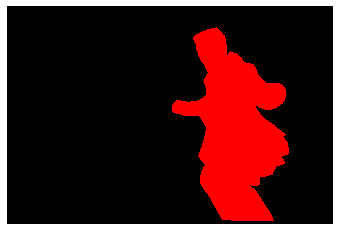

(427, 640, 3)
COCO_val2014_000000307800.jpg
{'person_bbx': [281.53, 125.12, 414.19999999999993, 473.53000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [281.53, 125.12, 414.19999999999993, 473.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000425120.jpg
{'person_bbx': [244.69, 123.78, 500.89, 384.78], 'Verbs': 'kick', 'object': {'obj_bbx': [254.21, 286.0, 299.63, 330.34000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [244.69, 123.78, 500.89, 384.78], 'Verbs': 'look', 'object': {'obj_bbx': [254.21, 286.0, 299.63, 330.34000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [46.06, 68.13, 148.73000000000002, 341.6], 'Verbs': 'look', 'object': {'obj_bbx': [254.21, 286.0, 299.63, 330.34000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [244.69, 123.78, 500.89, 384.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [108.43, 98.83, 315.69, 409.72999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [46.06, 68.13, 148.73000000000002, 341.6], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [244.69, 123.78, 500.89, 384.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}

(427, 640, 3)
COCO_val2014_000000504287.jpg
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [153.65, 139.1, 243.29000000000002, 180.43]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [225.16, 138.01, 237.95, 151.5]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'hold', 'object': {'obj_bbx': [153.65, 139.1, 243.29000000000002, 180.43]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'look', 'object': {'obj_bbx': [225.16, 138.01, 237.95, 151.5]}}
sports ball
person
look
look interaction
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [242.63, 38.44, 424.46000000000004, 208.57], 'Verbs': 'stand', 'object': {'obj_

(259, 640, 3)
COCO_val2014_000000212817.jpg
{'person_bbx': [281.43, 175.24, 423.73, 414.35], 'Verbs': 'snowboard', 'object': {'obj_bbx': [285.94, 356.88, 410.02, 442.12]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [281.43, 175.24, 423.73, 414.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(478, 640, 3)
COCO_val2014_000000279490.jpg
{'person_bbx': [51.78, 1.44, 307.78, 401.26], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [271.84, 368.63, 298.04999999999995, 396.1]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [51.78, 1.44, 307.78, 401.26], 'Verbs': 'hold', 'object': {'obj_bbx': [271.84, 368.63, 298.04999999999995, 396.1]}}
person
fork
hold
hold interaction
{'person_bbx': [51.78, 1.44, 307.78, 401.26], 'Verbs': 'look', 'object': {'obj_bbx': [271.84, 368.63, 298.04999999999995, 396.1]}}
person
fork
look
look interaction
{'person_bbx': [51.78, 1.44, 307.78, 401.26], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000319342.jpg
{'person_bbx': [379.21, 222.32, 441.46, 287.75], 'Verbs': 'look', 'object': {'obj_bbx': [357.02, 282.91, 446.34, 296.25]}}
person
surfboard
look
look interaction
{'person_bbx': [379.21, 222.32, 441.46, 287.75], 'Verbs': 'surf', 'object': {'obj_bbx': [357.02, 282.91, 446.34, 296.25]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000158956.jpg
{'person_bbx': [169.04, 39.16, 492.80999999999995, 418.30999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [206.32, 171.23, 217.73, 320.51]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [169.04, 39.16, 492.80999999999995, 418.30999999999995], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [167.34, 309.1, 293.79, 352.83000000000004]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [169.04, 39.16, 492.80999999999995, 418.30999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [206.32, 171.23, 217.73, 320.51]}}
person
knife
hold
hold interaction
{'person_bbx': [169.04, 39.16, 492.80999999999995, 418.30999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [167.34, 309.1, 293.79, 352.83000000000004]}}
person
cake
look
look interaction
{'person_bbx': [169.04, 39.16, 492.80999999999995, 418.30999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000437332.jpg
{'person_bbx': [179.58, 0.0, 329.93, 307.35], 'Verbs': 'jump', 'object': {'obj_bbx': [253.34, 251.37, 289.84000000000003, 306.12]}}
person
skateboard
jump
jump interaction
{'person_bbx': [179.58, 0.0, 329.93, 307.35], 'Verbs': 'look', 'object': {'obj_bbx': [253.34, 251.37, 289.84000000000003, 306.12]}}
person
skateboard
look
look interaction
{'person_bbx': [179.58, 0.0, 329.93, 307.35], 'Verbs': 'skateboard', 'object': {'obj_bbx': [253.34, 251.37, 289.84000000000003, 306.12]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [179.58, 0.0, 329.93, 307.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000064898.jpg
{'person_bbx': [416.9, 237.13, 524.5899999999999, 302.51], 'Verbs': 'surf', 'object': {'obj_bbx': [457.56, 280.43, 561.72, 303.3]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000486803.jpg
{'person_bbx': [517.57, 326.6, 569.23, 412.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [215.29, 161.86, 316.81, 253.82], 'Verbs': 'jump', 'object': {'obj_bbx': [223.26, 233.02, 350.16999999999996, 263.36]}}
person
snowboard
jump
jump interaction
{'person_bbx': [215.29, 161.86, 316.81, 253.82], 'Verbs': 'look', 'object': {'obj_bbx': [223.26, 233.02, 350.16999999999996, 263.36]}}
person
snowboard
look
look interaction
{'person_bbx': [517.57, 326.6, 569.23, 412.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [215.29, 161.86, 316.81, 253.82]}}
person
person
look
look interaction
{'person_bbx': [215.29, 161.86, 316.81, 253.82], 'Verbs': 'snowboard', 'object': {'obj_bbx': [223.26, 233.02, 350.16999999999996, 263.36]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [517.57, 326.6, 569.23, 412.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(418, 640, 3)
COCO_val2014_000000502852.jpg
{'person_bbx': [220.19, 150.1, 486.89, 427.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [88.49, 42.32, 302.96999999999997, 322.2]}}
person
laptop
look
look interaction
{'person_bbx': [220.19, 150.1, 486.89, 427.07000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [411.65, 63.48, 526.1, 416.46000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [220.19, 150.1, 486.89, 427.07000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [88.49, 42.32, 302.96999999999997, 322.2]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000113058.jpg
{'person_bbx': [28.87, 336.43, 159.64000000000001, 401.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [49.73, 341.08, 114.59, 391.89]}}
person
laptop
hold
hold interaction
{'person_bbx': [28.87, 336.43, 159.64000000000001, 401.59000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [14.42, 355.98, 175.10999999999999, 474.44]}}
couch
person
lay
lay interaction
{'person_bbx': [28.87, 336.43, 159.64000000000001, 401.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [49.73, 341.08, 114.59, 391.89]}}
person
laptop
look
look interaction
{'person_bbx': [28.87, 336.43, 159.64000000000001, 401.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [14.42, 355.98, 175.10999999999999, 474.44]}}
couch
person
sit
sit interaction
{'person_bbx': [28.87, 336.43, 159.64000000000001, 401.59000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [49.73, 341.08, 114.59, 391.89]}}
person
laptop
work_on_computer
work_on_computer interaction

(480, 640, 3)
COCO_val2014_000000187187.jpg
{'person_bbx': [87.32, 26.71, 277.31, 422.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [251.4, 198.63, 414.53, 285.95]}}
person
laptop
hold
hold interaction
{'person_bbx': [87.32, 26.71, 277.31, 422.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [251.4, 198.63, 414.53, 285.95]}}
person
laptop
look
look interaction
{'person_bbx': [87.32, 26.71, 277.31, 422.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [87.32, 26.71, 277.31, 422.03999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [251.4, 198.63, 414.53, 285.95]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000232679.jpg
{'person_bbx': [77.93, 180.98, 167.2, 217.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(371, 500, 3)
COCO_val2014_000000525373.jpg
{'person_bbx': [29.19, 142.16, 321.08, 478.38], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [63.82, 306.88, 180.14, 394.12]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [277.63, 36.13, 630.01, 479.02], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [297.04, 305.65, 441.26, 458.48]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [29.19, 142.16, 321.08, 478.38], 'Verbs': 'hold', 'object': {'obj_bbx': [63.82, 306.88, 180.14, 394.12]}}
person
donut
hold
hold interaction
{'person_bbx': [277.63, 36.13, 630.01, 479.02], 'Verbs': 'hold', 'object': {'obj_bbx': [297.04, 305.65, 441.26, 458.48]}}
person
donut
hold
hold interaction
{'person_bbx': [29.19, 142.16, 321.08, 478.38], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [277.63, 36.13, 630.01, 479.02], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000246053.jpg
{'person_bbx': [184.84, 184.0, 365.65, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [253.36, 259.17, 262.90000000000003, 271.40000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [184.84, 184.0, 365.65, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [184.84, 184.0, 365.65, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [253.36, 259.17, 262.90000000000003, 271.40000000000003]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000580117.jpg
{'person_bbx': [265.01, 302.9, 349.37, 542.3199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [187.23, 338.27, 251.23, 546.0899999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [32.03, 324.8, 145.34, 543.9100000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [265.01, 302.9, 349.37, 542.3199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [187.23, 338.27, 251.23, 546.0899999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [32.03, 324.8, 145.34, 543.9100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000487375.jpg
{'person_bbx': [344.09, 154.25, 569.53, 386.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [13.53, 205.04, 236.26, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [1.03, 344.77, 65.03, 480.0]}}
chair
person
sit
sit interaction
{'person_bbx': [344.09, 154.25, 569.53, 386.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [13.53, 205.04, 236.26, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000202321.jpg
{'person_bbx': [308.12, 111.82, 369.59000000000003, 195.76999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [308.12, 111.82, 369.59000000000003, 195.76999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.12, 111.82, 369.59000000000003, 195.76999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(417, 640, 3)
COCO_val2014_000000324595.jpg
{'person_bbx': [243.06, 169.71, 401.26, 621.3], 'Verbs': 'catch', 'object': {'obj_bbx': [169.23, 150.44, 223.73, 170.61]}}
person
frisbee
catch
catch interaction
{'person_bbx': [112.18, 162.52, 267.51, 578.16], 'Verbs': 'catch', 'object': {'obj_bbx': [169.23, 150.44, 223.73, 170.61]}}
person
frisbee
catch
catch interaction
{'person_bbx': [243.06, 169.71, 401.26, 621.3], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [112.18, 162.52, 267.51, 578.16], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [243.06, 169.71, 401.26, 621.3], 'Verbs': 'look', 'object': {'obj_bbx': [169.23, 150.44, 223.73, 170.61]}}
person
frisbee
look
look interaction
{'person_bbx': [112.18, 162.52, 267.51, 578.16], 'Verbs': 'look', 'object': {'obj_bbx': [169.23, 150.44, 223.73, 170.61]}}
person
frisbee
look
look interaction
{'person_bbx': [243.06, 169.71, 401.26, 621.3], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{

(640, 484, 3)
COCO_val2014_000000231795.jpg
{'person_bbx': [307.38, 44.41, 389.25, 270.07], 'Verbs': 'look', 'object': {'obj_bbx': [306.8, 258.34, 343.3, 293.77]}}
person
snowboard
look
look interaction
{'person_bbx': [307.38, 44.41, 389.25, 270.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000466456.jpg
{'person_bbx': [136.63, 2.88, 373.93, 536.45], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [330.49, 505.04, 387.08000000000004, 535.58]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [136.63, 2.88, 373.93, 536.45], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [339.41, 465.25, 480.0, 640.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.44, 87.73, 343.73, 632.8100000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [330.49, 505.04, 387.08000000000004, 535.58]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.44, 87.73, 343.73, 632.8100000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [339.41, 465.25, 480.0, 640.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [136.63, 2.88, 373.93, 536.45], 'Verbs': 'hold', 'object': {'obj_bbx': [330.49, 505.04, 387.08000000000004, 535.58]}}
person
knife
hold
hold interaction
{'person_bbx': [1.44, 87.73, 343.73, 632.8100000000001], 'Verbs': 'hold', 'obj

(640, 480, 3)
COCO_val2014_000000121673.jpg
{'person_bbx': [152.6, 83.0, 333.76, 242.54], 'Verbs': 'look', 'object': {'obj_bbx': [177.81, 239.91, 444.1, 289.63]}}
person
surfboard
look
look interaction
{'person_bbx': [152.6, 83.0, 333.76, 242.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [152.6, 83.0, 333.76, 242.54], 'Verbs': 'surf', 'object': {'obj_bbx': [177.81, 239.91, 444.1, 289.63]}}
person
surfboard
surf
surf interaction


(375, 500, 3)
COCO_val2014_000000577826.jpg
{'person_bbx': [82.65, 108.03, 329.45000000000005, 336.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [82.65, 108.03, 329.45000000000005, 336.35], 'Verbs': 'look', 'object': {'obj_bbx': [135.94, 307.96, 325.28999999999996, 366.34999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [82.65, 108.03, 329.45000000000005, 336.35], 'Verbs': 'skateboard', 'object': {'obj_bbx': [135.94, 307.96, 325.28999999999996, 366.34999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [377.92, 72.36, 514.47, 339.69], 'Verbs': 'skateboard', 'object': {'obj_bbx': [405.24, 312.23, 529.16, 349.09000000000003]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [377.92, 72.36, 514.47, 339.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000075032.jpg
{'person_bbx': [59.23, 123.88, 182.03, 500.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [168.56, 127.48, 272.64, 421.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [59.23, 123.88, 182.03, 500.95], 'Verbs': 'look', 'object': {'obj_bbx': [92.98, 495.5, 153.13, 521.28]}}
person
skateboard
look
look interaction
{'person_bbx': [168.56, 127.48, 272.64, 421.55], 'Verbs': 'look', 'object': {'obj_bbx': [203.32, 417.77, 239.41, 439.03]}}
skateboard
person
look
look interaction
{'person_bbx': [59.23, 123.88, 182.03, 500.95], 'Verbs': 'skateboard', 'object': {'obj_bbx': [92.98, 495.5, 153.13, 521.28]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [168.56, 127.48, 272.64, 421.55], 'Verbs': 'skateboard', 'object': {'obj_bbx': [203.32, 417.77, 239.41, 439.03]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [59.23, 123.88, 182.03, 500.95], 'Verbs': 'stand',

(640, 427, 3)
COCO_val2014_000000322629.jpg
{'person_bbx': [233.54, 85.72, 287.28, 238.83], 'Verbs': 'hold', 'object': {'obj_bbx': [236.47, 157.47, 257.1, 231.39]}}
person
skateboard
hold
hold interaction
{'person_bbx': [472.53, 233.96, 614.92, 330.98], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [488.36, 71.6, 552.6, 249.41], 'Verbs': 'look', 'object': {'obj_bbx': [472.53, 233.96, 614.92, 330.98]}}
person
person
look
look interaction
{'person_bbx': [365.14, 83.79, 413.76, 234.41000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [472.53, 233.96, 614.92, 330.98]}}
person
person
look
look interaction
{'person_bbx': [472.53, 233.96, 614.92, 330.98], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [557.73, 78.25, 611.8000000000001, 258.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.8, 68.98, 56.959999999999994, 210.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': 

(562, 640, 3)
COCO_val2014_000000122997.jpg
{'person_bbx': [347.47, 27.28, 640.0, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [329.9, 288.69, 459.2, 332.3]}}
person
laptop
hold
hold interaction
{'person_bbx': [347.47, 27.28, 640.0, 425.0], 'Verbs': 'look', 'object': {'obj_bbx': [329.9, 288.69, 459.2, 332.3]}}
person
laptop
look
look interaction
{'person_bbx': [347.47, 27.28, 640.0, 425.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(425, 640, 3)
COCO_val2014_000000575964.jpg
{'person_bbx': [268.67, 128.58, 579.5699999999999, 419.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [296.19, 231.86, 420.86, 344.68]}}
person
laptop
look
look interaction
{'person_bbx': [3.83, 62.33, 165.63000000000002, 421.34999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [128.65, 22.96, 306.11, 274.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [86.34, 58.85, 173.42000000000002, 150.78]}}
laptop
person
look
look interaction
{'person_bbx': [268.67, 128.58, 579.5699999999999, 419.32000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [313.77, 231.92, 617.95, 417.11]}}
chair
person
sit
sit interaction
{'person_bbx': [3.83, 62.33, 165.63000000000002, 421.34999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [52.69, 262.45, 214.66, 427.0]}}
chair
person
sit
sit interaction
{'person_bbx': [128.65, 22.96, 306.11, 274.71999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [206.63, 135.76, 3

(427, 640, 3)
COCO_val2014_000000047886.jpg
{'person_bbx': [33.16, 76.63, 362.20000000000005, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [30.55, 247.73, 54.379999999999995, 308.63]}}
person
bottle
hold
hold interaction
{'person_bbx': [33.16, 76.63, 362.20000000000005, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [33.16, 76.63, 362.20000000000005, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000295472.jpg
{'person_bbx': [230.63, 272.43, 461.26, 379.1], 'Verbs': 'hold', 'object': {'obj_bbx': [273.95, 348.85, 346.98, 381.54]}}
person
laptop
hold
hold interaction
{'person_bbx': [100.22, 242.48, 279.03, 385.06], 'Verbs': 'look', 'object': {'obj_bbx': [230.63, 272.43, 461.26, 379.1]}}
person
person
look
look interaction
{'person_bbx': [230.63, 272.43, 461.26, 379.1], 'Verbs': 'look', 'object': {'obj_bbx': [273.95, 348.85, 346.98, 381.54]}}
person
laptop
look
look interaction
{'person_bbx': [230.63, 272.43, 461.26, 379.1], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [230.63, 272.43, 461.26, 379.1], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [273.95, 348.85, 346.98, 381.54]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 482, 3)
COCO_val2014_000000419789.jpg
{'person_bbx': [295.46, 158.97, 394.77, 306.72], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [234.46, 157.42, 325.48, 289.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [295.46, 158.97, 394.77, 306.72], 'Verbs': 'ski', 'object': {'obj_bbx': [303.51, 282.76, 456.48, 318.05]}}
person
skis
ski
ski interaction
{'person_bbx': [234.46, 157.42, 325.48, 289.87], 'Verbs': 'ski', 'object': {'obj_bbx': [245.13, 254.12, 364.49, 306.74]}}
person
skis
ski
ski interaction


(480, 640, 3)
COCO_val2014_000000176519.jpg
{'person_bbx': [427.96, 92.18, 567.0899999999999, 212.12], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [76.15, 141.45, 266.03, 375.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [226.42, 308.84, 285.25, 386.32]}}
person
surfboard
look
look interaction
{'person_bbx': [427.96, 92.18, 567.0899999999999, 212.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [76.15, 141.45, 266.03, 375.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [76.15, 141.45, 266.03, 375.66999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [226.42, 308.84, 285.25, 386.32]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000063525.jpg
{'person_bbx': [70.84, 85.61, 382.1, 400.99], 'Verbs': 'look', 'object': {'obj_bbx': [230.27, 165.95, 577.3, 397.29999999999995]}}
person
laptop
look
look interaction
{'person_bbx': [70.84, 85.61, 382.1, 400.99], 'Verbs': 'sit', 'object': {'obj_bbx': [0.52, 300.18, 74.32, 400.57]}}
person
chair
sit
sit interaction
{'person_bbx': [70.84, 85.61, 382.1, 400.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [70.84, 85.61, 382.1, 400.99], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [230.27, 165.95, 577.3, 397.29999999999995]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000442836.jpg
{'person_bbx': [300.9, 142.82, 449.80999999999995, 410.84999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [406.68, 271.27, 450.84000000000003, 316.45]}}
person
frisbee
hold
hold interaction
{'person_bbx': [136.11, 37.44, 257.21000000000004, 417.58], 'Verbs': 'look', 'object': {'obj_bbx': [300.9, 142.82, 449.80999999999995, 410.84999999999997]}}
person
person
look
look interaction
{'person_bbx': [300.9, 142.82, 449.80999999999995, 410.84999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [136.11, 37.44, 257.21000000000004, 417.58]}}
person
person
look
look interaction
{'person_bbx': [136.11, 37.44, 257.21000000000004, 417.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [300.9, 142.82, 449.80999999999995, 410.84999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [47.24, 150.87, 116.56, 349.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_

(457, 640, 3)
COCO_val2014_000000097988.jpg
{'person_bbx': [195.29, 211.79, 320.44, 598.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [195.29, 211.79, 320.44, 598.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000574537.jpg
{'person_bbx': [154.85, 41.42, 393.38, 348.23], 'Verbs': 'snowboard', 'object': {'obj_bbx': [101.95, 277.0, 383.76, 389.53]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [375.1, 0.96, 542.45, 277.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000226762.jpg
{'person_bbx': [48.83, 24.79, 621.39, 600.2199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [219.62, 141.69, 245.75, 193.09]}}
cell phone
person
hold
hold interaction
{'person_bbx': [48.83, 24.79, 621.39, 600.2199999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [48.83, 24.79, 621.39, 600.2199999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [219.62, 141.69, 245.75, 193.09]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 640, 3)
COCO_val2014_000000129852.jpg
{'person_bbx': [309.36, 400.59, 367.81, 541.5899999999999], 'Verbs': 'look', 'object': {'obj_bbx': [293.06, 193.69, 397.24, 249.53]}}
person
frisbee
look
look interaction
{'person_bbx': [309.36, 400.59, 367.81, 541.5899999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000111825.jpg
{'person_bbx': [121.35, 174.45, 296.15999999999997, 590.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [341.44, 226.23, 446.65999999999997, 597.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [121.35, 174.45, 296.15999999999997, 590.52], 'Verbs': 'skateboard', 'object': {'obj_bbx': [157.07, 539.04, 282.02, 614.4499999999999]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [121.35, 174.45, 296.15999999999997, 590.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [341.44, 226.23, 446.65999999999997, 597.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [121.35, 174.45, 296.15999999999997, 590.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [341.44, 226.23, 446.65999999999997, 597.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000197388.jpg
{'person_bbx': [139.41, 102.25, 361.79999999999995, 343.82], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [540.04, 48.81, 640.0, 272.17], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [372.58, 170.84, 639.21, 388.03], 'Verbs': 'hold', 'object': {'obj_bbx': [141.82, 270.87, 639.12, 328.58]}}
person
skis
hold
hold interaction
{'person_bbx': [0.5, 43.74, 90.6, 263.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [139.41, 102.25, 361.79999999999995, 343.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [139.41, 102.25, 361.79999999999995, 343.82], 'Verbs': 'ski', 'object': {'obj_bbx': [234.23, 330.02, 397.06, 359.28]}}
person
skis
ski
ski interaction
{'person_bbx': [540.04, 48.81, 640.0, 272.17], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [372.58, 170.84, 639.21, 388.03], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
pers

(392, 640, 3)
COCO_val2014_000000409667.jpg
{'person_bbx': [203.55, 170.46, 358.38, 366.33000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [203.55, 170.46, 358.38, 366.33000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [303.33, 27.76, 426.03, 178.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.55, 170.46, 358.38, 366.33000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(428, 640, 3)
COCO_val2014_000000045687.jpg
{'person_bbx': [346.95, 166.34, 637.7, 391.99], 'Verbs': 'look', 'object': {'obj_bbx': [323.33, 252.3, 439.27, 357.62]}}
tv
person
look
look interaction
{'person_bbx': [21.31, 201.2, 257.49, 391.21], 'Verbs': 'look', 'object': {'obj_bbx': [136.45, 290.45, 276.99, 392.02]}}
person
laptop
look
look interaction
{'person_bbx': [346.95, 166.34, 637.7, 391.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [21.31, 201.2, 257.49, 391.21], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [346.95, 166.34, 637.7, 391.99], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [330.15, 250.95, 442.27, 389.77]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [21.31, 201.2, 257.49, 391.21], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [136.45, 290.45, 276.99, 392.02]}}
person
laptop
work_on_computer
work_on_computer interaction


(396, 640, 3)
COCO_val2014_000000144694.jpg
{'person_bbx': [102.19, 63.03, 394.44, 359.1], 'Verbs': 'kick', 'object': {'obj_bbx': [130.04, 321.18, 169.39, 357.77]}}
sports ball
person
kick
kick interaction
{'person_bbx': [499.49, 35.34, 639.89, 358.15], 'Verbs': 'look', 'object': {'obj_bbx': [130.04, 321.18, 169.39, 357.77]}}
sports ball
person
look
look interaction
{'person_bbx': [102.19, 63.03, 394.44, 359.1], 'Verbs': 'look', 'object': {'obj_bbx': [130.04, 321.18, 169.39, 357.77]}}
sports ball
person
look
look interaction
{'person_bbx': [499.49, 35.34, 639.89, 358.15], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [102.19, 63.03, 394.44, 359.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [499.49, 35.34, 639.89, 358.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [102.19, 63.03, 394.44, 359.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000001176.jpg
{'person_bbx': [188.59, 270.19, 244.68, 379.37], 'Verbs': 'jump', 'object': {'obj_bbx': [199.41, 376.29, 231.35, 388.04]}}
person
skateboard
jump
jump interaction
{'person_bbx': [188.59, 270.19, 244.68, 379.37], 'Verbs': 'look', 'object': {'obj_bbx': [199.41, 376.29, 231.35, 388.04]}}
person
skateboard
look
look interaction
{'person_bbx': [188.59, 270.19, 244.68, 379.37], 'Verbs': 'skateboard', 'object': {'obj_bbx': [199.41, 376.29, 231.35, 388.04]}}
person
skateboard
skateboard
skateboard interaction


(640, 426, 3)
COCO_val2014_000000508538.jpg
{'person_bbx': [109.97, 97.82, 162.51, 310.96], 'Verbs': 'look', 'object': {'obj_bbx': [96.57, 295.89, 186.68, 322.25]}}
person
skateboard
look
look interaction
{'person_bbx': [157.94, 89.1, 263.51, 339.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [109.97, 97.82, 162.51, 310.96], 'Verbs': 'skateboard', 'object': {'obj_bbx': [96.57, 295.89, 186.68, 322.25]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [157.94, 89.1, 263.51, 339.1], 'Verbs': 'skateboard', 'object': {'obj_bbx': [204.33, 293.25, 301.46000000000004, 336.33]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [109.97, 97.82, 162.51, 310.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [157.94, 89.1, 263.51, 339.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000551439.jpg
{'person_bbx': [0.0, 32.43, 425.23, 629.1899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [84.85, 188.4, 279.01, 398.38]}}
person
book
hold
hold interaction
{'person_bbx': [0.0, 32.43, 425.23, 629.1899999999999], 'Verbs': 'read', 'object': {'obj_bbx': [84.85, 188.4, 279.01, 398.38]}}
person
book
read
read interaction
{'person_bbx': [0.0, 32.43, 425.23, 629.1899999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 139.77, 427.0, 630.97]}}
bed
person
sit
sit interaction
{'person_bbx': [0.0, 32.43, 425.23, 629.1899999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000342593.jpg
{'person_bbx': [149.61, 73.02, 421.89, 546.0], 'Verbs': 'hold', 'object': {'obj_bbx': [236.44, 431.48, 274.82, 503.94]}}
person
remote
hold
hold interaction
{'person_bbx': [149.61, 73.02, 421.89, 546.0], 'Verbs': 'sit', 'object': {'obj_bbx': [240.37, 486.24, 354.92, 520.64]}}
person
chair
sit
sit interaction
{'person_bbx': [149.61, 73.02, 421.89, 546.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(546, 640, 3)
COCO_val2014_000000015908.jpg
{'person_bbx': [169.84, 142.97, 260.04, 323.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [399.33, 165.34, 561.46, 420.94], 'Verbs': 'look', 'object': {'obj_bbx': [417.98, 371.2, 542.87, 414.21999999999997]}}
skateboard
person
look
look interaction
{'person_bbx': [169.84, 142.97, 260.04, 323.37], 'Verbs': 'look', 'object': {'obj_bbx': [283.2, 162.89, 326.62, 293.67999999999995]}}
person
person
look
look interaction
{'person_bbx': [315.69, 129.54, 413.57, 277.31], 'Verbs': 'look', 'object': {'obj_bbx': [169.84, 142.97, 260.04, 323.37]}}
person
person
look
look interaction
{'person_bbx': [399.33, 165.34, 561.46, 420.94], 'Verbs': 'skateboard', 'object': {'obj_bbx': [417.98, 371.2, 542.87, 414.21999999999997]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [169.84, 142.97, 260.04, 323.37], 'Verbs': 'skateboard', 'object': {'obj_bbx': [175.6, 290.65, 262.32, 317.44]}}
skateboard
person
skateboard

(427, 640, 3)
COCO_val2014_000000188946.jpg
{'person_bbx': [59.12, 262.82, 181.06, 528.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [59.12, 262.82, 181.06, 528.51], 'Verbs': 'ski', 'object': {'obj_bbx': [49.63, 480.86, 213.9, 562.99]}}
person
skis
ski
ski interaction
{'person_bbx': [59.12, 262.82, 181.06, 528.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [59.12, 262.82, 181.06, 528.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000438861.jpg
{'person_bbx': [154.85, 207.59, 421.27, 320.12], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 139.72, 640.0, 423.78]}}
bed
person
lay
lay interaction


(428, 640, 3)
COCO_val2014_000000347390.jpg
{'person_bbx': [298.79, 220.04, 408.81, 325.75], 'Verbs': 'look', 'object': {'obj_bbx': [400.14, 278.3, 465.53999999999996, 332.12]}}
person
laptop
look
look interaction
{'person_bbx': [298.79, 220.04, 408.81, 325.75], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [298.79, 220.04, 408.81, 325.75], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [400.14, 278.3, 465.53999999999996, 332.12]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000408208.jpg
{'person_bbx': [485.48, 108.36, 571.5600000000001, 224.43], 'Verbs': 'hold', 'object': {'obj_bbx': [438.34, 73.05, 558.1899999999999, 161.05]}}
skis
person
hold
hold interaction
{'person_bbx': [485.48, 108.36, 571.5600000000001, 224.43], 'Verbs': 'jump', 'object': {'obj_bbx': [438.34, 73.05, 558.1899999999999, 161.05]}}
skis
person
jump
jump interaction
{'person_bbx': [27.61, 351.23, 82.22, 545.53], 'Verbs': 'look', 'object': {'obj_bbx': [485.48, 108.36, 571.5600000000001, 224.43]}}
person
person
look
look interaction
{'person_bbx': [27.61, 351.23, 82.22, 545.53], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [485.48, 108.36, 571.5600000000001, 224.43], 'Verbs': 'ski', 'object': {'obj_bbx': [438.34, 73.05, 558.1899999999999, 161.05]}}
skis
person
ski
ski interaction
{'person_bbx': [27.61, 351.23, 82.22, 545.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(617, 640, 3)
COCO_val2014_000000016959.jpg
{'person_bbx': [203.6, 71.15, 390.23, 468.79999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [13.85, 169.36, 614.6, 396.24]}}
person
surfboard
carry
carry interaction
{'person_bbx': [203.6, 71.15, 390.23, 468.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [13.85, 169.36, 614.6, 396.24]}}
person
surfboard
hold
hold interaction
{'person_bbx': [203.6, 71.15, 390.23, 468.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.6, 71.15, 390.23, 468.79999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(474, 640, 3)
COCO_val2014_000000485709.jpg
{'person_bbx': [168.62, 87.9, 387.13, 394.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [168.62, 87.9, 387.13, 394.21000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [204.04, 277.2, 215.34, 289.86]}}
sports ball
person
throw
throw interaction


(446, 640, 3)
COCO_val2014_000000156704.jpg
{'person_bbx': [379.16, 0.0, 594.14, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [379.16, 0.0, 594.14, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [379.16, 0.0, 594.14, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.16, 0.0, 594.14, 427.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000504561.jpg
{'person_bbx': [0.5, 147.43, 239.59, 637.6700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [232.99, 38.59, 480.0, 634.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.5, 147.43, 239.59, 637.6700000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [232.99, 38.59, 480.0, 634.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.5, 147.43, 239.59, 637.6700000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000461860.jpg
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [252.53, 0.15, 398.3, 68.0]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [316.69, 26.04, 324.02, 37.79]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'hold', 'object': {'obj_bbx': [252.53, 0.15, 398.3, 68.0]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [136.81, 48.27, 346.86, 594.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000280370.jpg
{'person_bbx': [364.73, 64.67, 548.97, 405.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [391.06, 139.09, 526.61, 548.14]}}
horse
person
hold
hold interaction
{'person_bbx': [63.04, 39.7, 305.85, 402.51], 'Verbs': 'hold', 'object': {'obj_bbx': [69.43, 139.02, 257.36, 534.03]}}
horse
person
hold
hold interaction
{'person_bbx': [364.73, 64.67, 548.97, 405.59000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [391.06, 139.09, 526.61, 548.14]}}
horse
person
ride
ride interaction
{'person_bbx': [63.04, 39.7, 305.85, 402.51], 'Verbs': 'ride', 'object': {'obj_bbx': [69.43, 139.02, 257.36, 534.03]}}
horse
person
ride
ride interaction
{'person_bbx': [364.73, 64.67, 548.97, 405.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [391.06, 139.09, 526.61, 548.14]}}
horse
person
sit
sit interaction
{'person_bbx': [63.04, 39.7, 305.85, 402.51], 'Verbs': 'sit', 'object': {'obj_bbx': [69.43, 139.02, 257.36, 534.03]}}
horse
person
sit
sit inter

(559, 640, 3)
COCO_val2014_000000473133.jpg
{'person_bbx': [60.14, 35.89, 178.9, 185.48000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [181.5, 195.91, 322.15, 249.8]}}
person
surfboard
look
look interaction
{'person_bbx': [60.14, 35.89, 178.9, 185.48000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [181.5, 195.91, 322.15, 249.8]}}
person
surfboard
surf
surf interaction


(333, 500, 3)
COCO_val2014_000000537456.jpg
{'person_bbx': [278.72, 198.06, 329.39000000000004, 369.51], 'Verbs': 'look', 'object': {'obj_bbx': [254.16, 187.23, 290.98, 226.83999999999997]}}
person
person
look
look interaction
{'person_bbx': [278.72, 198.06, 329.39000000000004, 369.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000557830.jpg
{'person_bbx': [33.3, 51.24, 224.16000000000003, 276.67], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [216.21, 184.96, 298.4, 236.85000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [33.3, 51.24, 224.16000000000003, 276.67], 'Verbs': 'hold', 'object': {'obj_bbx': [216.21, 184.96, 298.4, 236.85000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [33.3, 51.24, 224.16000000000003, 276.67], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [33.3, 51.24, 224.16000000000003, 276.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(285, 500, 3)
COCO_val2014_000000565877.jpg
{'person_bbx': [7.19, 71.91, 293.39, 598.29], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 191.31, 425.29, 640.0]}}
couch
person
sit
sit interaction
{'person_bbx': [7.19, 71.91, 293.39, 598.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000262587.jpg
{'person_bbx': [327.85, 154.88, 413.98, 234.25], 'Verbs': 'look', 'object': {'obj_bbx': [336.71, 212.4, 415.03, 250.43]}}
surfboard
person
look
look interaction
{'person_bbx': [327.85, 154.88, 413.98, 234.25], 'Verbs': 'surf', 'object': {'obj_bbx': [336.71, 212.4, 415.03, 250.43]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000093685.jpg
{'person_bbx': [113.99, 92.43, 359.44, 305.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [113.99, 92.43, 359.44, 305.01], 'Verbs': 'surf', 'object': {'obj_bbx': [137.92, 306.21, 332.46, 389.58]}}
person
surfboard
surf
surf interaction


(457, 640, 3)
COCO_val2014_000000462324.jpg
{'person_bbx': [246.46, 61.39, 481.75, 336.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [222.4, 301.62, 317.1, 349.78]}}
person
skateboard
look
look interaction
{'person_bbx': [246.46, 61.39, 481.75, 336.40999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [222.4, 301.62, 317.1, 349.78]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [246.46, 61.39, 481.75, 336.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000467151.jpg
{'person_bbx': [154.71, 34.83, 305.37, 288.23], 'Verbs': 'carry', 'object': {'obj_bbx': [175.69, 80.7, 229.38, 179.87]}}
person
handbag
carry
carry interaction
{'person_bbx': [154.71, 34.83, 305.37, 288.23], 'Verbs': 'hold', 'object': {'obj_bbx': [175.69, 80.7, 229.38, 179.87]}}
person
handbag
hold
hold interaction
{'person_bbx': [154.71, 34.83, 305.37, 288.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [154.71, 34.83, 305.37, 288.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 473, 3)
COCO_val2014_000000240250.jpg
{'person_bbx': [199.98, 8.44, 511.05999999999995, 388.41], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [319.88, 327.46, 395.32, 349.21999999999997]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [199.98, 8.44, 511.05999999999995, 388.41], 'Verbs': 'hold', 'object': {'obj_bbx': [319.88, 327.46, 395.32, 349.21999999999997]}}
person
fork
hold
hold interaction
{'person_bbx': [199.98, 8.44, 511.05999999999995, 388.41], 'Verbs': 'sit', 'object': {'obj_bbx': [250.47, 247.97, 523.12, 368.53]}}
person
chair
sit
sit interaction
{'person_bbx': [199.98, 8.44, 511.05999999999995, 388.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000556537.jpg
{'person_bbx': [320.49, 2.88, 553.66, 366.55], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [320.49, 2.88, 553.66, 366.55], 'Verbs': 'kick', 'object': {'obj_bbx': [40.23, 281.73, 99.82, 339.23]}}
sports ball
person
kick
kick interaction
{'person_bbx': [320.49, 2.88, 553.66, 366.55], 'Verbs': 'look', 'object': {'obj_bbx': [40.23, 281.73, 99.82, 339.23]}}
sports ball
person
look
look interaction
{'person_bbx': [320.49, 2.88, 553.66, 366.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000548962.jpg
{'person_bbx': [439.79, 279.56, 526.83, 321.07], 'Verbs': 'sit', 'object': {'obj_bbx': [187.47, 304.93, 592.28, 479.3]}}
couch
person
sit
sit interaction
{'person_bbx': [439.79, 279.56, 526.83, 321.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [435.57, 281.32, 486.71, 330.40999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000181278.jpg
{'person_bbx': [530.63, 169.84, 640.0, 397.25], 'Verbs': 'look', 'object': {'obj_bbx': [262.74, 104.02, 285.04, 127.64999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [256.58, 124.08, 435.62, 419.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [262.74, 104.02, 285.04, 127.64999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [530.63, 169.84, 640.0, 397.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [256.58, 124.08, 435.62, 419.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [256.58, 124.08, 435.62, 419.91999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [262.74, 104.02, 285.04, 127.64999999999999]}}
person
sports ball
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000298197.jpg
{'person_bbx': [260.56, 107.71, 400.84000000000003, 350.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [294.09, 311.27, 342.09999999999997, 382.21]}}
chair
person
hold
hold interaction
{'person_bbx': [1.44, 192.28, 235.87, 438.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [216.45, 318.35, 293.19, 392.74]}}
person
chair
sit
sit interaction
{'person_bbx': [330.24, 168.53, 478.03, 405.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [294.09, 311.27, 342.09999999999997, 382.21]}}
chair
person
sit
sit interaction
{'person_bbx': [1.44, 192.28, 235.87, 438.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [260.56, 107.71, 400.84000000000003, 350.21999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [20.77, 72.74, 217.13000000000002, 346.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [260.56, 107.71, 400.84000000000003, 3

(640, 481, 3)
COCO_val2014_000000026507.jpg
{'person_bbx': [155.01, 86.76, 458.51, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [175.57, 200.15, 259.24, 233.82]}}
person
frisbee
hold
hold interaction
{'person_bbx': [48.65, 2.7, 215.14000000000001, 472.96999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [155.01, 86.76, 458.51, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [48.65, 2.7, 215.14000000000001, 472.96999999999997]}}
person
person
look
look interaction
{'person_bbx': [48.65, 2.7, 215.14000000000001, 472.96999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [155.01, 86.76, 458.51, 480.0]}}
person
person
look
look interaction
{'person_bbx': [155.01, 86.76, 458.51, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [155.01, 86.76, 458.51, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [48.65, 2.7, 215.14000000000001, 472.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': 

(480, 640, 3)
COCO_val2014_000000248924.jpg
{'person_bbx': [256.27, 56.47, 370.58, 239.76], 'Verbs': 'jump', 'object': {'obj_bbx': [260.01, 208.68, 387.62, 253.78]}}
person
snowboard
jump
jump interaction
{'person_bbx': [256.27, 56.47, 370.58, 239.76], 'Verbs': 'look', 'object': {'obj_bbx': [260.01, 208.68, 387.62, 253.78]}}
person
snowboard
look
look interaction
{'person_bbx': [256.27, 56.47, 370.58, 239.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [260.01, 208.68, 387.62, 253.78]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [256.27, 56.47, 370.58, 239.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000064189.jpg
{'person_bbx': [163.51, 0.36, 268.81, 241.86], 'Verbs': 'jump', 'object': {'obj_bbx': [167.79, 145.82, 267.36, 249.01999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [163.51, 0.36, 268.81, 241.86], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [163.51, 0.36, 268.81, 241.86], 'Verbs': 'skateboard', 'object': {'obj_bbx': [167.79, 145.82, 267.36, 249.01999999999998]}}
person
skateboard
skateboard
skateboard interaction


(500, 375, 3)
COCO_val2014_000000371948.jpg
{'person_bbx': [457.63, 39.94, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [477.83, 131.92, 597.02, 261.94]}}
laptop
person
hold
hold interaction
{'person_bbx': [457.63, 39.94, 640.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000054329.jpg
{'person_bbx': [8.28, 8.28, 266.29999999999995, 301.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [46.02, 20.17, 58.68000000000001, 34.22]}}
sports ball
person
hold
hold interaction
{'person_bbx': [8.28, 8.28, 266.29999999999995, 301.47999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [8.28, 8.28, 266.29999999999995, 301.47999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [46.02, 20.17, 58.68000000000001, 34.22]}}
sports ball
person
throw
throw interaction


(307, 272, 3)
COCO_val2014_000000231153.jpg
{'person_bbx': [60.81, 78.83, 222.97, 238.74], 'Verbs': 'jump', 'object': {'obj_bbx': [118.65, 150.31, 250.15, 255.15]}}
snowboard
person
jump
jump interaction
{'person_bbx': [60.81, 78.83, 222.97, 238.74], 'Verbs': 'look', 'object': {'obj_bbx': [118.65, 150.31, 250.15, 255.15]}}
snowboard
person
look
look interaction
{'person_bbx': [60.81, 78.83, 222.97, 238.74], 'Verbs': 'snowboard', 'object': {'obj_bbx': [118.65, 150.31, 250.15, 255.15]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [60.81, 78.83, 222.97, 238.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000565353.jpg
{'person_bbx': [37.39, 0.0, 477.47999999999996, 628.49], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [37.39, 0.0, 477.47999999999996, 628.49], 'Verbs': 'sit', 'object': {'obj_bbx': [16.54, 87.81, 377.05, 484.71]}}
person
couch
sit
sit interaction
{'person_bbx': [37.39, 0.0, 477.47999999999996, 628.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [37.39, 0.0, 477.47999999999996, 628.49], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [7.19, 522.07, 250.25, 632.8100000000001]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000198492.jpg
{'person_bbx': [235.2, 146.22, 541.3299999999999, 428.72], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [221.42, 222.19, 267.58, 240.76999999999998]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [235.2, 146.22, 541.3299999999999, 428.72], 'Verbs': 'hold', 'object': {'obj_bbx': [221.42, 222.19, 267.58, 240.76999999999998]}}
person
donut
hold
hold interaction
{'person_bbx': [32.36, 175.82, 222.2, 385.08], 'Verbs': 'hold', 'object': {'obj_bbx': [118.71, 257.75, 158.97, 400.21000000000004]}}
bottle
person
hold
hold interaction
{'person_bbx': [235.2, 146.22, 541.3299999999999, 428.72], 'Verbs': 'look', 'object': {'obj_bbx': [32.36, 175.82, 222.2, 385.08]}}
person
person
look
look interaction
{'person_bbx': [235.2, 146.22, 541.3299999999999, 428.72], 'Verbs': 'sit', 'object': {'obj_bbx': [474.63, 264.47, 640.0, 326.41]}}
person
dining table
sit
sit interaction
{'person_bbx': [32.36, 175.82, 222.2, 385.08], 'Verbs': 'sit', 'object': {'obj_b

(480, 640, 3)
COCO_val2014_000000485155.jpg
{'person_bbx': [255.96, 82.32, 371.76, 247.64], 'Verbs': 'snowboard', 'object': {'obj_bbx': [222.97, 232.9, 345.07, 252.62]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [255.96, 82.32, 371.76, 247.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(339, 410, 3)
COCO_val2014_000000123810.jpg
{'person_bbx': [0.0, 54.54, 307.59, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [254.85, 176.35, 380.57, 194.06]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 54.54, 307.59, 427.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [333.26, 172.25, 442.65, 280.73]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 54.54, 307.59, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [254.85, 176.35, 380.57, 194.06]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 54.54, 307.59, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [333.26, 172.25, 442.65, 280.73]}}
person
cake
look
look interaction
{'person_bbx': [0.0, 54.54, 307.59, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000546203.jpg
{'person_bbx': [102.11, 4.31, 394.07, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [286.12, 157.87, 459.28999999999996, 629.21]}}
person
snowboard
carry
carry interaction
{'person_bbx': [102.11, 4.31, 394.07, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [286.12, 157.87, 459.28999999999996, 629.21]}}
person
snowboard
hold
hold interaction
{'person_bbx': [102.11, 4.31, 394.07, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 481, 3)
COCO_val2014_000000225686.jpg
{'person_bbx': [119.18, 205.21, 314.95000000000005, 419.86], 'Verbs': 'hold', 'object': {'obj_bbx': [108.73, 386.52, 415.66, 631.51]}}
bicycle
person
hold
hold interaction
{'person_bbx': [119.18, 205.21, 314.95000000000005, 419.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000320524.jpg
{'person_bbx': [215.57, 454.67, 285.69, 537.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [104.89, 583.29, 180.85, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [132.54, 575.87, 169.47, 630.12]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [104.89, 583.29, 180.85, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 436, 3)
COCO_val2014_000000497668.jpg
{'person_bbx': [163.07, 173.86, 446.44, 258.18], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [163.07, 173.86, 446.44, 258.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [163.07, 173.86, 446.44, 258.18], 'Verbs': 'surf', 'object': {'obj_bbx': [229.73, 239.66, 407.5, 285.82]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000012552.jpg
{'person_bbx': [334.68, 264.47, 452.0, 407.77000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [209.18, 127.62, 347.36, 328.17], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [152.29, 199.28, 226.51, 279.28]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [209.18, 127.62, 347.36, 328.17], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [143.06, 223.86, 152.91, 234.94000000000003]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [209.18, 127.62, 347.36, 328.17], 'Verbs': 'hold', 'object': {'obj_bbx': [152.29, 199.28, 226.51, 279.28]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [209.18, 127.62, 347.36, 328.17], 'Verbs': 'look', 'object': {'obj_bbx': [143.06, 223.86, 152.91, 234.94000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [391.5, 229.33, 553.66, 419.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [143.06, 223.86, 152.91, 234.9400

(427, 640, 3)
COCO_val2014_000000208623.jpg
{'person_bbx': [0.0, 3.47, 224.66, 386.0], 'Verbs': 'hold', 'object': {'obj_bbx': [148.78, 226.77, 190.69, 248.67000000000002]}}
person
cup
hold
hold interaction
{'person_bbx': [109.54, 117.8, 326.01, 382.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [275.34, 93.89, 445.25, 332.63]}}
person
person
look
look interaction
{'person_bbx': [0.0, 3.47, 224.66, 386.0], 'Verbs': 'look', 'object': {'obj_bbx': [409.42, 170.01, 608.9300000000001, 340.89]}}
laptop
person
look
look interaction
{'person_bbx': [109.54, 117.8, 326.01, 382.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 3.47, 224.66, 386.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(386, 640, 3)
COCO_val2014_000000084031.jpg
{'person_bbx': [279.76, 186.62, 376.85, 335.53], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [367.44, 228.98, 384.07, 261.15]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [279.76, 186.62, 376.85, 335.53], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [422.46, 238.81, 436.93, 247.75]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [279.76, 186.62, 376.85, 335.53], 'Verbs': 'hold', 'object': {'obj_bbx': [367.44, 228.98, 384.07, 261.15]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [97.87, 217.82, 167.92000000000002, 360.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [279.76, 186.62, 376.85, 335.53], 'Verbs': 'look', 'object': {'obj_bbx': [422.46, 238.81, 436.93, 247.75]}}
person
sports ball
look
look interaction
{'person_bbx': [183.03, 253.9, 279.25, 350.13], 'Verbs': 'look', 'object': {'obj_bbx': [422.46, 238.81, 436.93, 247.75]}}
person
sports ball
look


(427, 640, 3)
COCO_val2014_000000105349.jpg
{'person_bbx': [221.59, 206.96, 347.24, 360.83000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [300.35, 231.25, 310.92, 248.49]}}
person
cell phone
carry
carry interaction
{'person_bbx': [221.59, 206.96, 347.24, 360.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [300.35, 231.25, 310.92, 248.49]}}
person
cell phone
hold
hold interaction
{'person_bbx': [221.59, 206.96, 347.24, 360.83000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [312.74, 299.37, 380.46000000000004, 342.47]}}
bicycle
person
ride
ride interaction
{'person_bbx': [221.59, 206.96, 347.24, 360.83000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [312.74, 299.37, 380.46000000000004, 342.47]}}
bicycle
person
sit
sit interaction
{'person_bbx': [221.59, 206.96, 347.24, 360.83000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [300.35, 231.25, 310.92, 248.49]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(575, 640, 3)
COCO_val2014_000000422886.jpg
{'person_bbx': [21.57, 28.76, 640.0, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [265.66, 253.58, 407.55, 451.32000000000005]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [21.57, 28.76, 640.0, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [265.66, 253.58, 407.55, 451.32000000000005]}}
person
hot dog
hold
hold interaction
{'person_bbx': [21.57, 28.76, 640.0, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000426376.jpg
{'person_bbx': [171.08, 259.45, 264.98, 405.92999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [218.91, 392.66, 278.69, 413.76000000000005]}}
person
snowboard
look
look interaction
{'person_bbx': [171.08, 259.45, 264.98, 405.92999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [218.91, 392.66, 278.69, 413.76000000000005]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [171.08, 259.45, 264.98, 405.92999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 467, 3)
COCO_val2014_000000108327.jpg
{'person_bbx': [29.59, 61.71, 405.45, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [257.44, 284.76, 401.26, 375.37]}}
frisbee
person
hold
hold interaction
{'person_bbx': [29.59, 61.71, 405.45, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [29.59, 61.71, 405.45, 640.0], 'Verbs': 'throw', 'object': {'obj_bbx': [257.44, 284.76, 401.26, 375.37]}}
frisbee
person
throw
throw interaction


(640, 427, 3)
COCO_val2014_000000161978.jpg
{'person_bbx': [261.75, 163.47, 305.53, 254.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [248.12, 8.76, 373.64, 98.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [238.07, 76.77, 325.84, 103.03]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [530.3, 9.73, 629.55, 122.60000000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [542.68, 107.7, 625.99, 149.09]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [33.08, 166.39, 114.82, 252.01999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [422.3, 165.42, 472.89, 281.21], 'Verbs': 'skateboard', 'object': {'obj_bbx': [15.51, 47.94, 537.59, 363.37]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [280.42, 296.62, 388.97, 388.87], 'Verbs': 'skateboard', 'object': {'obj_bbx': [274.54, 372.35, 424.31000000000006, 407.68]}}
skateboard
person
skateboa

(433, 640, 3)
COCO_val2014_000000185916.jpg
{'person_bbx': [2.89, 103.15, 305.59999999999997, 356.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.89, 103.15, 305.59999999999997, 356.70000000000005], 'Verbs': 'surf', 'object': {'obj_bbx': [168.71, 320.06, 317.17, 371.16]}}
person
surfboard
surf
surf interaction


(429, 640, 3)
COCO_val2014_000000010023.jpg
{'person_bbx': [198.38, 44.9, 433.52, 271.28], 'Verbs': 'jump', 'object': {'obj_bbx': [220.7, 273.47, 323.37, 352.16]}}
person
skateboard
jump
jump interaction
{'person_bbx': [198.38, 44.9, 433.52, 271.28], 'Verbs': 'look', 'object': {'obj_bbx': [220.7, 273.47, 323.37, 352.16]}}
person
skateboard
look
look interaction
{'person_bbx': [198.38, 44.9, 433.52, 271.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [220.7, 273.47, 323.37, 352.16]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000056701.jpg
{'person_bbx': [262.8, 215.28, 443.83000000000004, 298.64], 'Verbs': 'hold', 'object': {'obj_bbx': [293.6, 213.84, 341.51, 264.11]}}
person
book
hold
hold interaction
{'person_bbx': [262.8, 215.28, 443.83000000000004, 298.64], 'Verbs': 'lay', 'object': {'obj_bbx': [214.88, 199.9, 598.52, 398.83000000000004]}}
couch
person
lay
lay interaction
{'person_bbx': [262.8, 215.28, 443.83000000000004, 298.64], 'Verbs': 'look', 'object': {'obj_bbx': [293.6, 213.84, 341.51, 264.11]}}
person
book
look
look interaction
{'person_bbx': [262.8, 215.28, 443.83000000000004, 298.64], 'Verbs': 'read', 'object': {'obj_bbx': [293.6, 213.84, 341.51, 264.11]}}
person
book
read
read interaction


(427, 640, 3)
COCO_val2014_000000563885.jpg
{'person_bbx': [196.51, 158.96, 342.95, 327.08000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [153.75, 145.92, 500.0, 327.44]}}
couch
person
lay
lay interaction
{'person_bbx': [196.51, 158.96, 342.95, 327.08000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [153.75, 145.92, 500.0, 327.44]}}
couch
person
sit
sit interaction


(331, 500, 3)
COCO_val2014_000000092339.jpg
{'person_bbx': [397.56, 217.8, 427.1, 297.75], 'Verbs': 'ride', 'object': {'obj_bbx': [389.1, 249.29, 460.36, 299.98]}}
horse
person
ride
ride interaction
{'person_bbx': [352.71, 219.6, 388.78, 296.21], 'Verbs': 'ride', 'object': {'obj_bbx': [324.92, 257.23, 402.94, 335.59000000000003]}}
horse
person
ride
ride interaction
{'person_bbx': [464.68, 217.92, 492.62, 297.56], 'Verbs': 'ride', 'object': {'obj_bbx': [422.98, 233.07, 542.72, 338.03]}}
horse
person
ride
ride interaction
{'person_bbx': [397.56, 217.8, 427.1, 297.75], 'Verbs': 'sit', 'object': {'obj_bbx': [389.1, 249.29, 460.36, 299.98]}}
horse
person
sit
sit interaction
{'person_bbx': [352.71, 219.6, 388.78, 296.21], 'Verbs': 'sit', 'object': {'obj_bbx': [324.92, 257.23, 402.94, 335.59000000000003]}}
horse
person
sit
sit interaction
{'person_bbx': [464.68, 217.92, 492.62, 297.56], 'Verbs': 'sit', 'object': {'obj_bbx': [422.98, 233.07, 542.72, 338.03]}}
horse
person
sit
sit interaction


(360, 640, 3)
COCO_val2014_000000076547.jpg
{'person_bbx': [415.11, 204.57, 587.12, 463.11], 'Verbs': 'look', 'object': {'obj_bbx': [385.01, 252.34, 481.35, 308.09000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [415.11, 204.57, 587.12, 463.11], 'Verbs': 'sit', 'object': {'obj_bbx': [496.25, 366.88, 582.5, 403.13]}}
person
chair
sit
sit interaction
{'person_bbx': [415.11, 204.57, 587.12, 463.11], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [385.01, 252.34, 481.35, 308.09000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000146397.jpg
{'person_bbx': [194.86, 114.98, 325.28, 267.55], 'Verbs': 'jump', 'object': {'obj_bbx': [218.69, 234.01, 283.35, 271.84]}}
person
skateboard
jump
jump interaction
{'person_bbx': [379.13, 91.91, 448.06, 250.84], 'Verbs': 'jump', 'object': {'obj_bbx': [389.25, 223.09, 432.45, 253.73000000000002]}}
person
skateboard
jump
jump interaction
{'person_bbx': [427.68, 81.19, 528.97, 250.22], 'Verbs': 'jump', 'object': {'obj_bbx': [446.05, 198.38, 487.43, 252.14]}}
person
skateboard
jump
jump interaction
{'person_bbx': [148.42, 119.31, 228.7, 274.95], 'Verbs': 'jump', 'object': {'obj_bbx': [138.77, 233.21, 204.68, 279.47]}}
person
skateboard
jump
jump interaction
{'person_bbx': [194.86, 114.98, 325.28, 267.55], 'Verbs': 'look', 'object': {'obj_bbx': [218.69, 234.01, 283.35, 271.84]}}
person
skateboard
look
look interaction
{'person_bbx': [379.13, 91.91, 448.06, 250.84], 'Verbs': 'look', 'object': {'obj_bbx': [389.25, 223.09, 432.45, 253.73000000000002]}

(427, 640, 3)
COCO_val2014_000000149014.jpg
{'person_bbx': [193.25, 158.34, 441.35, 336.62], 'Verbs': 'look', 'object': {'obj_bbx': [297.97, 332.37, 422.57000000000005, 371.38]}}
snowboard
person
look
look interaction
{'person_bbx': [193.25, 158.34, 441.35, 336.62], 'Verbs': 'snowboard', 'object': {'obj_bbx': [297.97, 332.37, 422.57000000000005, 371.38]}}
snowboard
person
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000075527.jpg
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [245.35, 284.13, 355.95, 337.27]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [186.72, 294.22, 371.3, 387.15000000000003]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'hold', 'object': {'obj_bbx': [245.35, 284.13, 355.95, 337.27]}}
person
knife
hold
hold interaction
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'look', 'object': {'obj_bbx': [186.72, 294.22, 371.3, 387.15000000000003]}}
person
pizza
look
look interaction
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [107.87, 73.35, 444.4, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000345466.jpg
{'person_bbx': [110.15, 45.91, 403.59000000000003, 315.80999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [124.98, 102.19, 136.45000000000002, 117.1]}}
sports ball
person
hold
hold interaction
{'person_bbx': [110.15, 45.91, 403.59000000000003, 315.80999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [110.15, 45.91, 403.59000000000003, 315.80999999999995], 'Verbs': 'throw', 'object': {'obj_bbx': [124.98, 102.19, 136.45000000000002, 117.1]}}
sports ball
person
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000456261.jpg
{'person_bbx': [43.89, 26.8, 281.73, 484.17], 'Verbs': 'lay', 'object': {'obj_bbx': [1.29, 35.01, 375.0, 408.39]}}
person
bed
lay
lay interaction


(500, 375, 3)
COCO_val2014_000000557812.jpg
{'person_bbx': [90.91, 176.8, 161.82, 342.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [35.97, 172.06, 95.97, 347.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [35.97, 172.06, 95.97, 347.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [90.91, 176.8, 161.82, 342.44], 'Verbs': 'ski', 'object': {'obj_bbx': [75.44, 315.61, 209.45, 362.36]}}
person
skis
ski
ski interaction
{'person_bbx': [35.97, 172.06, 95.97, 347.0], 'Verbs': 'ski', 'object': {'obj_bbx': [5.78, 318.03, 104.82000000000001, 355.15999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [90.91, 176.8, 161.82, 342.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [35.97, 172.06, 95.97, 347.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000436456.jpg
{'person_bbx': [70.08, 154.15, 210.94, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': [74.21, 215.33, 137.39999999999998, 326.13]}}
person
backpack
carry
carry interaction
{'person_bbx': [218.78, 144.73, 310.89, 404.77], 'Verbs': 'carry', 'object': {'obj_bbx': [212.78, 207.44, 265.79, 276.76]}}
person
backpack
carry
carry interaction
{'person_bbx': [70.08, 154.15, 210.94, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [74.21, 215.33, 137.39999999999998, 326.13]}}
person
backpack
hold
hold interaction
{'person_bbx': [218.78, 144.73, 310.89, 404.77], 'Verbs': 'hold', 'object': {'obj_bbx': [214.19, 183.06, 264.88, 288.3]}}
person
handbag
hold
hold interaction
{'person_bbx': [218.78, 144.73, 310.89, 404.77], 'Verbs': 'look', 'object': {'obj_bbx': [260.27, 119.73, 493.58, 200.98000000000002]}}
airplane
person
look
look interaction
{'person_bbx': [70.08, 154.15, 210.94, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx

(427, 640, 3)
COCO_val2014_000000507427.jpg
{'person_bbx': [52.97, 110.81, 369.73, 400.54], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000463534.jpg
{'person_bbx': [2.88, 28.76, 353.8, 437.21], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 7.17, 427.0, 629.9599999999999]}}
person
bed
lay
lay interaction


(640, 427, 3)
COCO_val2014_000000566651.jpg
{'person_bbx': [340.6, 258.31, 415.08000000000004, 413.92], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [309.89, 355.93, 321.0, 366.11]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [340.6, 258.31, 415.08000000000004, 413.92], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [530.33, 241.79, 598.88, 453.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [309.89, 355.93, 321.0, 366.11]}}
sports ball
person
look
look interaction
{'person_bbx': [340.6, 258.31, 415.08000000000004, 413.92], 'Verbs': 'look', 'object': {'obj_bbx': [309.89, 355.93, 321.0, 366.11]}}
sports ball
person
look
look interaction
{'person_bbx': [530.33, 241.79, 598.88, 453.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [340.6, 258.31, 415.08000000000004, 413.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000441286.jpg
{'person_bbx': [229.33, 128.51, 353.41, 279.17999999999995], 'Verbs': 'surf', 'object': {'obj_bbx': [225.95, 274.02, 305.16999999999996, 302.34]}}
person
surfboard
surf
surf interaction


(493, 640, 3)
COCO_val2014_000000479350.jpg
{'person_bbx': [2.86, 92.42, 157.21, 333.48], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [88.85, 178.33, 109.94, 199.94]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [145.78, 82.89, 434.48, 355.4], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [237.25, 325.15, 301.93, 360.46]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [145.78, 82.89, 434.48, 355.4], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [176.5, 122.99, 267.38, 205.19]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [387.31, 65.2, 640.0, 368.96], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [561.2, 350.63, 589.7900000000001, 381.12]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [387.31, 65.2, 640.0, 368.96], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [478.91, 256.16, 566.48, 330.48]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [2.86, 92.42, 157.21, 333.48], 'Verbs': 'hold', 'object': {'obj_bbx': [81.44, 115.49, 109.83, 19

(424, 640, 3)
COCO_val2014_000000460454.jpg
{'person_bbx': [161.32, 40.71, 382.14, 304.95], 'Verbs': 'jump', 'object': {'obj_bbx': [152.3, 274.03, 358.49, 339.83]}}
person
skateboard
jump
jump interaction
{'person_bbx': [161.32, 40.71, 382.14, 304.95], 'Verbs': 'look', 'object': {'obj_bbx': [152.3, 274.03, 358.49, 339.83]}}
person
skateboard
look
look interaction
{'person_bbx': [161.32, 40.71, 382.14, 304.95], 'Verbs': 'skateboard', 'object': {'obj_bbx': [152.3, 274.03, 358.49, 339.83]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000334769.jpg
{'person_bbx': [28.66, 57.69, 266.56, 613.2], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [16.54, 124.08, 68.17, 283.51]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [28.66, 57.69, 266.56, 613.2], 'Verbs': 'hold', 'object': {'obj_bbx': [16.54, 124.08, 68.17, 283.51]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [28.66, 57.69, 266.56, 613.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000556246.jpg
{'person_bbx': [391.29, 120.66, 495.58000000000004, 283.57], 'Verbs': 'skateboard', 'object': {'obj_bbx': [471.64, 264.44, 495.46, 290.18]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [274.62, 172.97, 386.56, 338.0], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [274.62, 172.97, 386.56, 338.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(338, 640, 3)
COCO_val2014_000000026374.jpg
{'person_bbx': [43.15, 38.39, 421.39, 606.48], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [167.5, 530.58, 253.04000000000002, 616.12]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [43.15, 38.39, 421.39, 606.48], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [43.15, 38.39, 421.39, 606.48], 'Verbs': 'kick', 'object': {'obj_bbx': [167.5, 530.58, 253.04000000000002, 616.12]}}
sports ball
person
kick
kick interaction
{'person_bbx': [43.15, 38.39, 421.39, 606.48], 'Verbs': 'look', 'object': {'obj_bbx': [167.5, 530.58, 253.04000000000002, 616.12]}}
sports ball
person
look
look interaction
{'person_bbx': [43.15, 38.39, 421.39, 606.48], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(640, 456, 3)
COCO_val2014_000000036252.jpg
{'person_bbx': [293.59, 332.19, 478.29999999999995, 534.81], 'Verbs': 'carry', 'object': {'obj_bbx': [277.4, 373.3, 520.5999999999999, 467.84000000000003]}}
person
surfboard
carry
carry interaction
{'person_bbx': [293.59, 332.19, 478.29999999999995, 534.81], 'Verbs': 'hold', 'object': {'obj_bbx': [277.4, 373.3, 520.5999999999999, 467.84000000000003]}}
person
surfboard
hold
hold interaction
{'person_bbx': [293.59, 332.19, 478.29999999999995, 534.81], 'Verbs': 'look', 'object': {'obj_bbx': [139.68, 132.56, 196.58, 266.89]}}
person
person
look
look interaction
{'person_bbx': [293.59, 332.19, 478.29999999999995, 534.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.59, 332.19, 478.29999999999995, 534.81], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000376667.jpg
{'person_bbx': [57.04, 42.87, 205.56, 479.82], 'Verbs': 'carry', 'object': {'obj_bbx': [170.43, 0.0, 305.26, 376.45]}}
person
surfboard
carry
carry interaction
{'person_bbx': [355.68, 3.24, 520.0, 472.43], 'Verbs': 'carry', 'object': {'obj_bbx': [387.4, 60.08, 495.09, 176.98000000000002]}}
person
backpack
carry
carry interaction
{'person_bbx': [57.04, 42.87, 205.56, 479.82], 'Verbs': 'hold', 'object': {'obj_bbx': [170.43, 0.0, 305.26, 376.45]}}
person
surfboard
hold
hold interaction
{'person_bbx': [355.68, 3.24, 520.0, 472.43], 'Verbs': 'hold', 'object': {'obj_bbx': [481.98, 168.27, 515.16, 188.55]}}
person
cell phone
hold
hold interaction
{'person_bbx': [57.04, 42.87, 205.56, 479.82], 'Verbs': 'look', 'object': {'obj_bbx': [170.43, 0.0, 305.26, 376.45]}}
person
surfboard
look
look interaction
{'person_bbx': [355.68, 3.24, 520.0, 472.43], 'Verbs': 'look', 'object': {'obj_bbx': [57.04, 42.87, 205.56, 479.82]}}
person
person
look
look interacti

(480, 640, 3)
COCO_val2014_000000301397.jpg
{'person_bbx': [0.88, 56.41, 500.0, 404.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [194.94, 197.78, 235.29, 238.82]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.88, 56.41, 500.0, 404.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.88, 56.41, 500.0, 404.03999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [194.94, 197.78, 235.29, 238.82]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(411, 500, 3)
COCO_val2014_000000534161.jpg
{'person_bbx': [1.44, 2.88, 480.0, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [21.62, 263.06, 321.44, 473.51]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [1.44, 2.88, 480.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [21.62, 263.06, 321.44, 473.51]}}
person
pizza
hold
hold interaction
{'person_bbx': [1.44, 2.88, 480.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000232241.jpg
{'person_bbx': [67.79, 127.2, 173.57, 291.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [363.97, 166.71, 439.15000000000003, 283.87], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [67.79, 127.2, 173.57, 291.08], 'Verbs': 'snowboard', 'object': {'obj_bbx': [22.89, 248.13, 187.51999999999998, 285.03999999999996]}}
person
snowboard
snowboard
snowboard interaction


(330, 500, 3)
COCO_val2014_000000162021.jpg
{'person_bbx': [162.16, 6.72, 361.75, 375.18], 'Verbs': 'skateboard', 'object': {'obj_bbx': [152.07, 366.67, 281.36, 402.59000000000003]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [81.38, 11.81, 161.8, 392.85], 'Verbs': 'skateboard', 'object': {'obj_bbx': [71.19, 368.8, 194.76, 417.6]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [349.89, 20.0, 461.7, 381.46], 'Verbs': 'skateboard', 'object': {'obj_bbx': [335.21, 361.58, 461.64, 406.12]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [162.16, 6.72, 361.75, 375.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [81.38, 11.81, 161.8, 392.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [349.89, 20.0, 461.7, 381.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000447558.jpg
{'person_bbx': [181.87, 112.95, 297.69, 272.8], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [272.17, 167.01, 328.71000000000004, 229.35999999999999]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [181.87, 112.95, 297.69, 272.8], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [319.68, 190.09, 330.11, 199.75]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [181.87, 112.95, 297.69, 272.8], 'Verbs': 'hold', 'object': {'obj_bbx': [272.17, 167.01, 328.71000000000004, 229.35999999999999]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [140.68, 264.58, 231.53, 424.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [319.68, 190.09, 330.11, 199.75]}}
sports ball
person
look
look interaction
{'person_bbx': [62.08, 264.55, 159.49, 416.4], 'Verbs': 'look', 'object': {'obj_bbx': [319.68, 190.09, 330.11, 199.75]}}
sports ball
person
look
look interaction
{'person_bbx': [181.87, 112.95, 297.69, 272.8], 'Verbs'

(425, 640, 3)
COCO_val2014_000000101622.jpg
{'person_bbx': [0.97, 47.56, 434.42, 368.99], 'Verbs': 'hold', 'object': {'obj_bbx': [262.62, 120.92, 276.34000000000003, 146.64]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.97, 47.56, 434.42, 368.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.97, 47.56, 434.42, 368.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.97, 47.56, 434.42, 368.99], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [262.62, 120.92, 276.34000000000003, 146.64]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(375, 500, 3)
COCO_val2014_000000050148.jpg
{'person_bbx': [421.43, 326.37, 549.79, 479.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [360.27, 410.97, 460.58, 474.61]}}
person
laptop
look
look interaction
{'person_bbx': [499.42, 309.24, 640.0, 472.12], 'Verbs': 'look', 'object': {'obj_bbx': [377.07, 166.05, 508.16999999999996, 257.07]}}
person
person
look
look interaction
{'person_bbx': [421.43, 326.37, 549.79, 479.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [499.42, 309.24, 640.0, 472.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 351.41, 197.44, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [255.14, 162.7, 352.43, 466.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [255.14, 162.7, 352.43, 466.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000240147.jpg
{'person_bbx': [176.0, 87.79, 433.14, 411.22], 'Verbs': 'hold', 'object': {'obj_bbx': [281.22, 130.96, 328.71000000000004, 165.74]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [176.0, 87.79, 433.14, 411.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [176.0, 87.79, 433.14, 411.22], 'Verbs': 'throw', 'object': {'obj_bbx': [226.77, 132.03, 239.37, 139.96]}}
sports ball
person
throw
throw interaction


(512, 640, 3)
COCO_val2014_000000164005.jpg
{'person_bbx': [325.9, 0.0, 640.0, 398.08], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 106.79, 386.16, 385.08000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [325.9, 0.0, 640.0, 398.08], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 209.5, 640.0, 474.73]}}
bed
person
sit
sit interaction
{'person_bbx': [325.9, 0.0, 640.0, 398.08], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 106.79, 386.16, 385.08000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000165174.jpg
{'person_bbx': [252.93, 45.5, 366.57, 410.91], 'Verbs': 'hold', 'object': {'obj_bbx': [259.53, 48.8, 373.76, 420.35]}}
person
skis
hold
hold interaction
{'person_bbx': [363.95, 43.17, 484.32, 393.75], 'Verbs': 'hold', 'object': {'obj_bbx': [397.05, 102.04, 480.24, 427.0]}}
person
skis
hold
hold interaction
{'person_bbx': [363.95, 43.17, 484.32, 393.75], 'Verbs': 'ski', 'object': {'obj_bbx': [397.05, 102.04, 480.24, 427.0]}}
person
skis
ski
ski interaction
{'person_bbx': [252.93, 45.5, 366.57, 410.91], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [252.93, 45.5, 366.57, 410.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [363.95, 43.17, 484.32, 393.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000421361.jpg
{'person_bbx': [0.0, 92.16, 454.4, 288.0], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [0.0, 92.16, 454.4, 288.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000164330.jpg
{'person_bbx': [1.22, 5.48, 194.92, 310.05], 'Verbs': 'hold', 'object': {'obj_bbx': [3.74, 198.23, 84.78, 317.91999999999996]}}
person
cup
hold
hold interaction
{'person_bbx': [190.72, 29.44, 385.28, 261.12], 'Verbs': 'look', 'object': {'obj_bbx': [405.57, 230.5, 537.17, 283.36]}}
person
pizza
look
look interaction
{'person_bbx': [1.22, 5.48, 194.92, 310.05], 'Verbs': 'look', 'object': {'obj_bbx': [3.74, 198.23, 84.78, 317.91999999999996]}}
person
cup
look
look interaction
{'person_bbx': [190.72, 29.44, 385.28, 261.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.22, 5.48, 194.92, 310.05], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000271259.jpg
{'person_bbx': [93.48, 12.94, 369.62, 487.55], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [194.67, 398.04, 237.76, 447.86]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [93.48, 12.94, 369.62, 487.55], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [182.21, 450.31, 294.31, 514.59]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [93.48, 12.94, 369.62, 487.55], 'Verbs': 'hold', 'object': {'obj_bbx': [194.67, 398.04, 237.76, 447.86]}}
person
knife
hold
hold interaction
{'person_bbx': [93.48, 12.94, 369.62, 487.55], 'Verbs': 'look', 'object': {'obj_bbx': [182.21, 450.31, 294.31, 514.59]}}
person
cake
look
look interaction
{'person_bbx': [93.48, 12.94, 369.62, 487.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000132509.jpg
{'person_bbx': [451.8, 472.35, 476.84000000000003, 570.34], 'Verbs': 'carry', 'object': {'obj_bbx': [383.41, 471.0, 540.33, 492.69]}}
person
surfboard
carry
carry interaction
{'person_bbx': [451.8, 472.35, 476.84000000000003, 570.34], 'Verbs': 'hold', 'object': {'obj_bbx': [383.41, 471.0, 540.33, 492.69]}}
person
surfboard
hold
hold interaction
{'person_bbx': [451.8, 472.35, 476.84000000000003, 570.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [451.8, 472.35, 476.84000000000003, 570.34], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000027371.jpg
{'person_bbx': [166.83, 120.81, 258.88, 519.19], 'Verbs': 'carry', 'object': {'obj_bbx': [185.26, 350.6, 315.51, 609.4100000000001]}}
person
suitcase
carry
carry interaction
{'person_bbx': [166.83, 120.81, 258.88, 519.19], 'Verbs': 'hold', 'object': {'obj_bbx': [185.26, 350.6, 315.51, 609.4100000000001]}}
person
suitcase
hold
hold interaction
{'person_bbx': [166.83, 120.81, 258.88, 519.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [166.83, 120.81, 258.88, 519.19], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 499, 3)
COCO_val2014_000000368367.jpg
{'person_bbx': [0.9, 139.33, 275.06, 400.0], 'Verbs': 'hold', 'object': {'obj_bbx': [62.78, 245.79, 111.73, 379.41999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.9, 139.33, 275.06, 400.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.9, 139.33, 275.06, 400.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.9, 139.33, 275.06, 400.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [62.78, 245.79, 111.73, 379.41999999999996]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(400, 500, 3)
COCO_val2014_000000329008.jpg
{'person_bbx': [172.75, 80.53, 349.4, 444.22], 'Verbs': 'catch', 'object': {'obj_bbx': [207.47, 77.69, 260.90999999999997, 96.71]}}
person
frisbee
catch
catch interaction
{'person_bbx': [172.75, 80.53, 349.4, 444.22], 'Verbs': 'hold', 'object': {'obj_bbx': [207.47, 77.69, 260.90999999999997, 96.71]}}
person
frisbee
hold
hold interaction
{'person_bbx': [172.75, 80.53, 349.4, 444.22], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [172.75, 80.53, 349.4, 444.22], 'Verbs': 'look', 'object': {'obj_bbx': [207.47, 77.69, 260.90999999999997, 96.71]}}
person
frisbee
look
look interaction
{'person_bbx': [280.56, 196.13, 496.17, 505.26], 'Verbs': 'look', 'object': {'obj_bbx': [207.47, 77.69, 260.90999999999997, 96.71]}}
person
frisbee
look
look interaction
{'person_bbx': [172.75, 80.53, 349.4, 444.22], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [280.56, 196.13, 496.17, 505.26], 'Verbs': 'run', 'object': 

(578, 640, 3)
COCO_val2014_000000287366.jpg
{'person_bbx': [282.74, 108.72, 439.12, 379.19000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [242.04, 61.56, 468.83, 191.15]}}
umbrella
person
carry
carry interaction
{'person_bbx': [282.74, 108.72, 439.12, 379.19000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [242.04, 61.56, 468.83, 191.15]}}
umbrella
person
hold
hold interaction
{'person_bbx': [282.74, 108.72, 439.12, 379.19000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [308.48, 193.88, 394.44, 250.22]}}
laptop
person
look
look interaction
{'person_bbx': [282.74, 108.72, 439.12, 379.19000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [277.43, 263.56, 368.86, 370.59000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [282.74, 108.72, 439.12, 379.19000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [308.48, 193.88, 394.44, 250.22]}}
laptop
person
work_on_computer
work_on_computer interaction


(425, 640, 3)
COCO_val2014_000000427135.jpg
{'person_bbx': [102.63, 54.49, 379.24, 372.16], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [102.63, 54.49, 379.24, 372.16], 'Verbs': 'kick', 'object': {'obj_bbx': [284.86, 244.4, 328.95000000000005, 288.03000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [102.63, 54.49, 379.24, 372.16], 'Verbs': 'look', 'object': {'obj_bbx': [284.86, 244.4, 328.95000000000005, 288.03000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [102.63, 54.49, 379.24, 372.16], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [102.63, 54.49, 379.24, 372.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(433, 640, 3)
COCO_val2014_000000210522.jpg
{'person_bbx': [181.21, 56.09, 323.6, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [128.26, 349.65, 294.06, 480.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [276.13, 19.24, 457.35, 475.51], 'Verbs': 'hold', 'object': {'obj_bbx': [181.21, 56.09, 323.6, 474.61]}}
person
person
hold
hold interaction
{'person_bbx': [181.21, 56.09, 323.6, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [411.89, 82.16, 594.5899999999999, 470.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [276.13, 19.24, 457.35, 475.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [49.62, 5.39, 198.47, 473.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [181.21, 56.09, 323.6, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [411.89, 82.16, 594.5899999999999, 470.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
pe

(480, 640, 3)
COCO_val2014_000000489944.jpg
{'person_bbx': [298.49, 163.5, 375.18, 301.8], 'Verbs': 'hold', 'object': {'obj_bbx': [361.42, 213.38, 374.79, 234.82999999999998]}}
person
frisbee
hold
hold interaction
{'person_bbx': [298.49, 163.5, 375.18, 301.8], 'Verbs': 'look', 'object': {'obj_bbx': [230.1, 250.28, 292.37, 304.73]}}
dog
person
look
look interaction
{'person_bbx': [298.49, 163.5, 375.18, 301.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [298.49, 163.5, 375.18, 301.8], 'Verbs': 'throw', 'object': {'obj_bbx': [315.5, 198.62, 333.05, 216.36]}}
person
frisbee
throw
throw interaction


(424, 640, 3)
COCO_val2014_000000085340.jpg
{'person_bbx': [144.85, 83.92, 533.22, 447.62], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [176.94, 307.39, 309.76, 372.23]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [420.67, 64.72, 640.0, 454.11], 'Verbs': 'hold', 'object': {'obj_bbx': [537.13, 266.86, 640.0, 435.23]}}
person
cup
hold
hold interaction
{'person_bbx': [144.85, 83.92, 533.22, 447.62], 'Verbs': 'hold', 'object': {'obj_bbx': [176.94, 307.39, 309.76, 372.23]}}
hot dog
person
hold
hold interaction
{'person_bbx': [0.0, 43.05, 234.62, 432.65000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [420.67, 64.72, 640.0, 454.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [144.85, 83.92, 533.22, 447.62], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000326088.jpg
{'person_bbx': [249.46, 8.64, 621.73, 421.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [249.46, 8.64, 621.73, 421.2], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [249.46, 8.64, 621.73, 421.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(426, 640, 3)
COCO_val2014_000000176841.jpg
{'person_bbx': [0.0, 0.0, 207.74, 460.13], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [69.72, 119.14, 423.5, 298.11]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.0, 207.74, 460.13], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [351.62, 133.27, 566.69, 281.20000000000005]}}
person
sandwich
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 0.0, 207.74, 460.13], 'Verbs': 'hold', 'object': {'obj_bbx': [158.84, 60.22, 391.4, 153.65]}}
person
spoon
hold
hold interaction


(462, 640, 3)
COCO_val2014_000000396302.jpg
{'person_bbx': [0.0, 1.08, 253.48, 235.15], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [134.48, 243.74, 250.56, 318.08000000000004]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 175.26, 166.86, 375.71], 'Verbs': 'hold', 'object': {'obj_bbx': [134.48, 243.74, 250.56, 318.08000000000004]}}
sandwich
person
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000273909.jpg
{'person_bbx': [369.85, 78.06, 482.05, 355.68], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [103.15, 238.76, 392.53, 360.06], 'Verbs': 'kick', 'object': {'obj_bbx': [323.56, 252.47, 360.5, 290.24]}}
sports ball
person
kick
kick interaction
{'person_bbx': [369.85, 78.06, 482.05, 355.68], 'Verbs': 'kick', 'object': {'obj_bbx': [323.56, 252.47, 360.5, 290.24]}}
sports ball
person
kick
kick interaction
{'person_bbx': [103.15, 238.76, 392.53, 360.06], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [369.85, 78.06, 482.05, 355.68], 'Verbs': 'look', 'object': {'obj_bbx': [323.56, 252.47, 360.5, 290.24]}}
sports ball
person
look
look interaction
{'person_bbx': [369.85, 78.06, 482.05, 355.68], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [369.85, 78.06, 482.05, 355.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000327417.jpg
{'person_bbx': [225.55, 274.33, 361.83000000000004, 483.64], 'Verbs': 'carry', 'object': {'obj_bbx': [165.89, 316.24, 308.33, 445.82000000000005]}}
snowboard
person
carry
carry interaction
{'person_bbx': [225.55, 274.33, 361.83000000000004, 483.64], 'Verbs': 'hold', 'object': {'obj_bbx': [165.89, 316.24, 308.33, 445.82000000000005]}}
snowboard
person
hold
hold interaction
{'person_bbx': [225.55, 274.33, 361.83000000000004, 483.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000277717.jpg
{'person_bbx': [40.3, 139.26, 300.37, 423.31], 'Verbs': 'hold', 'object': {'obj_bbx': [244.19, 236.42, 256.4, 251.57]}}
person
cell phone
hold
hold interaction
{'person_bbx': [40.3, 139.26, 300.37, 423.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [40.3, 139.26, 300.37, 423.31], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [244.19, 236.42, 256.4, 251.57]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(428, 640, 3)
COCO_val2014_000000197880.jpg
{'person_bbx': [430.6, 138.81, 611.44, 337.42], 'Verbs': 'lay', 'object': {'obj_bbx': [81.57, 198.65, 640.0, 423.20000000000005]}}
bed
person
lay
lay interaction
{'person_bbx': [430.6, 138.81, 611.44, 337.42], 'Verbs': 'sit', 'object': {'obj_bbx': [81.57, 198.65, 640.0, 423.20000000000005]}}
bed
person
sit
sit interaction
{'person_bbx': [430.6, 138.81, 611.44, 337.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000448759.jpg
{'person_bbx': [122.25, 106.43, 376.81, 568.09], 'Verbs': 'hold', 'object': {'obj_bbx': [198.78, 531.33, 388.52, 608.13]}}
person
skis
hold
hold interaction
{'person_bbx': [122.25, 106.43, 376.81, 568.09], 'Verbs': 'ski', 'object': {'obj_bbx': [198.78, 531.33, 388.52, 608.13]}}
person
skis
ski
ski interaction
{'person_bbx': [122.25, 106.43, 376.81, 568.09], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [122.25, 106.43, 376.81, 568.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 499, 3)
COCO_val2014_000000536933.jpg
{'person_bbx': [105.71, 182.92, 228.36, 413.7], 'Verbs': 'carry', 'object': {'obj_bbx': [191.71, 168.68, 250.36, 357.27]}}
person
skis
carry
carry interaction
{'person_bbx': [345.22, 201.97, 424.05, 357.94], 'Verbs': 'carry', 'object': {'obj_bbx': [321.15, 293.89, 433.12, 370.39]}}
person
skis
carry
carry interaction
{'person_bbx': [105.71, 182.92, 228.36, 413.7], 'Verbs': 'hold', 'object': {'obj_bbx': [191.71, 168.68, 250.36, 357.27]}}
person
skis
hold
hold interaction
{'person_bbx': [345.22, 201.97, 424.05, 357.94], 'Verbs': 'hold', 'object': {'obj_bbx': [321.15, 293.89, 433.12, 370.39]}}
person
skis
hold
hold interaction
{'person_bbx': [105.71, 182.92, 228.36, 413.7], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [345.22, 201.97, 424.05, 357.94], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.08, 194.39, 76.34, 417.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx'

(480, 640, 3)
COCO_val2014_000000326510.jpg
{'person_bbx': [303.65, 86.08, 447.86, 418.47999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [236.76, 288.11, 391.35, 424.32000000000005]}}
person
suitcase
carry
carry interaction
{'person_bbx': [303.65, 86.08, 447.86, 418.47999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [236.76, 288.11, 391.35, 424.32000000000005]}}
person
suitcase
hold
hold interaction
{'person_bbx': [303.65, 86.08, 447.86, 418.47999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [236.76, 288.11, 391.35, 424.32000000000005]}}
person
suitcase
look
look interaction
{'person_bbx': [303.65, 86.08, 447.86, 418.47999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000422517.jpg
{'person_bbx': [53.0, 51.9, 230.24, 261.69], 'Verbs': 'hold', 'object': {'obj_bbx': [141.0, 80.98, 148.51, 90.05000000000001]}}
person
cell phone
hold
hold interaction
{'person_bbx': [53.0, 51.9, 230.24, 261.69], 'Verbs': 'sit', 'object': {'obj_bbx': [53.01, 102.86, 443.5, 269.36]}}
person
bench
sit
sit interaction
{'person_bbx': [53.0, 51.9, 230.24, 261.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [141.0, 80.98, 148.51, 90.05000000000001]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(333, 500, 3)
COCO_val2014_000000561223.jpg
{'person_bbx': [284.82, 173.54, 403.84, 330.53999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [284.03, 319.53, 382.71999999999997, 351.2]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000504224.jpg
{'person_bbx': [259.96, 4.31, 586.79, 353.8], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [349.23, 281.58, 365.29, 312.64]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [259.96, 4.31, 586.79, 353.8], 'Verbs': 'hold', 'object': {'obj_bbx': [349.23, 281.58, 365.29, 312.64]}}
person
scissors
hold
hold interaction
{'person_bbx': [259.96, 4.31, 586.79, 353.8], 'Verbs': 'look', 'object': {'obj_bbx': [349.23, 281.58, 365.29, 312.64]}}
person
scissors
look
look interaction


(480, 640, 3)
COCO_val2014_000000000328.jpg
{'person_bbx': [44.81, 68.09, 268.61, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [197.91, 90.52, 403.03999999999996, 479.85999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [245.65, 220.95, 332.09000000000003, 258.37]}}
person
book
hold
hold interaction
{'person_bbx': [336.87, 58.48, 586.78, 484.52000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [434.75, 283.15, 469.76, 301.78999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [197.91, 90.52, 403.03999999999996, 479.85999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [245.65, 220.95, 332.09000000000003, 258.37]}}
person
book
look
look interaction
{'person_bbx': [197.91, 90.52, 403.03999999999996, 479.85999999999996], 'Verbs': 'read', 'object': {'obj_bbx': [245.65, 220.95, 332.09000000000003, 258.37]}}
person
book
read
read interaction
{'person_bbx': [44.81, 68.09, 268.61, 425.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.6, 10

(491, 640, 3)
COCO_val2014_000000570678.jpg
{'person_bbx': [124.67, 36.11, 282.07, 250.2], 'Verbs': 'snowboard', 'object': {'obj_bbx': [161.2, 225.49, 286.90999999999997, 261.0]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [124.67, 36.11, 282.07, 250.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000302375.jpg
{'person_bbx': [538.99, 319.8, 640.0, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [518.21, 300.71, 583.0600000000001, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [538.99, 319.8, 640.0, 424.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [518.21, 300.71, 583.0600000000001, 424.0], 'Verbs': 'ride', 'object': {'obj_bbx': [505.03, 400.94, 545.42, 423.95]}}
person
bicycle
ride
ride interaction
{'person_bbx': [538.99, 319.8, 640.0, 424.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [518.21, 300.71, 583.0600000000001, 424.0], 'Verbs': 'sit', 'object': {'obj_bbx': [505.03, 400.94, 545.42, 423.95]}}
person
bicycle
sit
sit interaction


(424, 640, 3)
COCO_val2014_000000431058.jpg
{'person_bbx': [194.2, 11.51, 316.78999999999996, 107.24000000000001], 'Verbs': 'jump', 'object': {'obj_bbx': [292.11, 2.5, 330.99, 155.98]}}
snowboard
person
jump
jump interaction
{'person_bbx': [194.2, 11.51, 316.78999999999996, 107.24000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [292.11, 2.5, 330.99, 155.98]}}
snowboard
person
look
look interaction
{'person_bbx': [194.2, 11.51, 316.78999999999996, 107.24000000000001], 'Verbs': 'snowboard', 'object': {'obj_bbx': [292.11, 2.5, 330.99, 155.98]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [194.2, 11.51, 316.78999999999996, 107.24000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000543220.jpg
{'person_bbx': [161.26, 397.08, 250.29, 465.33], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(640, 640, 3)
COCO_val2014_000000398722.jpg
{'person_bbx': [138.91, 122.9, 343.06, 296.31], 'Verbs': 'look', 'object': {'obj_bbx': [218.85, 17.57, 329.28, 161.0]}}
person
laptop
look
look interaction
{'person_bbx': [325.35, 98.76, 501.22, 296.94], 'Verbs': 'look', 'object': {'obj_bbx': [364.36, 25.21, 478.14, 128.31]}}
person
laptop
look
look interaction
{'person_bbx': [495.61, 101.75, 640.0, 297.7], 'Verbs': 'look', 'object': {'obj_bbx': [481.6, 19.5, 593.21, 166.28]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 114.31, 148.13, 297.62], 'Verbs': 'look', 'object': {'obj_bbx': [81.17, 33.14, 194.13, 172.48000000000002]}}
laptop
person
look
look interaction
{'person_bbx': [138.91, 122.9, 343.06, 296.31], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [325.35, 98.76, 501.22, 296.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [495.61, 101.75, 640.0, 297.7], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.

(301, 640, 3)
COCO_val2014_000000263700.jpg
{'person_bbx': [511.28, 59.33, 640.0, 415.28], 'Verbs': 'look', 'object': {'obj_bbx': [236.76, 129.73, 500.53999999999996, 465.95000000000005]}}
motorcycle
person
look
look interaction
{'person_bbx': [123.09, 71.57, 260.44, 479.52], 'Verbs': 'point', 'object': {'obj_bbx': [236.76, 129.73, 500.53999999999996, 465.95000000000005]}}
motorcycle
person
point
point interaction
{'person_bbx': [123.09, 71.57, 260.44, 479.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [511.28, 59.33, 640.0, 415.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000437129.jpg
{'person_bbx': [333.94, 247.25, 560.17, 548.24], 'Verbs': 'hold', 'object': {'obj_bbx': [535.06, 216.48, 585.1099999999999, 418.46]}}
skateboard
person
hold
hold interaction
{'person_bbx': [333.94, 247.25, 560.17, 548.24], 'Verbs': 'jump', 'object': {'obj_bbx': [535.06, 216.48, 585.1099999999999, 418.46]}}
skateboard
person
jump
jump interaction
{'person_bbx': [333.94, 247.25, 560.17, 548.24], 'Verbs': 'look', 'object': {'obj_bbx': [535.06, 216.48, 585.1099999999999, 418.46]}}
skateboard
person
look
look interaction
{'person_bbx': [333.94, 247.25, 560.17, 548.24], 'Verbs': 'skateboard', 'object': {'obj_bbx': [535.06, 216.48, 585.1099999999999, 418.46]}}
skateboard
person
skateboard
skateboard interaction


(629, 640, 3)
COCO_val2014_000000429913.jpg
{'person_bbx': [140.56, 291.61, 192.88, 349.84000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [137.71, 238.76, 199.02, 326.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.71, 238.76, 199.02, 326.63], 'Verbs': 'look', 'object': {'obj_bbx': [539.64, 136.25, 588.23, 197.29]}}
person
person
look
look interaction
{'person_bbx': [140.56, 291.61, 192.88, 349.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [598.94, 181.59, 604.7600000000001, 186.61]}}
sports ball
person
look
look interaction
{'person_bbx': [94.57, 284.25, 141.59, 359.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [137.71, 238.76, 199.02, 326.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [539.64, 136.25, 588.23, 197.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [94.57, 284.25, 141.59, 359.48], 'Verbs': 'stand', 'o

(427, 640, 3)
COCO_val2014_000000148128.jpg
{'person_bbx': [528.96, 25.33, 640.0, 190.74], 'Verbs': 'look', 'object': {'obj_bbx': [79.37, 73.37, 300.44, 186.11]}}
frisbee
person
look
look interaction


(426, 640, 3)
COCO_val2014_000000120441.jpg
{'person_bbx': [25.84, 23.81, 455.53999999999996, 413.68], 'Verbs': 'hold', 'object': {'obj_bbx': [198.28, 26.62, 214.69, 42.42]}}
sports ball
person
hold
hold interaction
{'person_bbx': [25.84, 23.81, 455.53999999999996, 413.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [25.84, 23.81, 455.53999999999996, 413.68], 'Verbs': 'throw', 'object': {'obj_bbx': [198.28, 26.62, 214.69, 42.42]}}
sports ball
person
throw
throw interaction


(436, 500, 3)
COCO_val2014_000000060989.jpg
{'person_bbx': [200.07, 111.26, 425.91999999999996, 526.07], 'Verbs': 'jump', 'object': {'obj_bbx': [257.82, 439.54, 332.7, 565.82]}}
person
skateboard
jump
jump interaction
{'person_bbx': [200.07, 111.26, 425.91999999999996, 526.07], 'Verbs': 'look', 'object': {'obj_bbx': [257.82, 439.54, 332.7, 565.82]}}
person
skateboard
look
look interaction
{'person_bbx': [200.07, 111.26, 425.91999999999996, 526.07], 'Verbs': 'skateboard', 'object': {'obj_bbx': [257.82, 439.54, 332.7, 565.82]}}
person
skateboard
skateboard
skateboard interaction


(640, 640, 3)
COCO_val2014_000000274035.jpg
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [191.5, 290.35, 256.35, 408.34000000000003]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [162.2, 398.47, 171.56, 408.63000000000005]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'hold', 'object': {'obj_bbx': [191.5, 290.35, 256.35, 408.34000000000003]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'look', 'object': {'obj_bbx': [162.2, 398.47, 171.56, 408.63000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [179.48, 276.08, 431.89, 623.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000188866.jpg
{'person_bbx': [14.35, 0.0, 457.76000000000005, 639.43], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [54.8, 299.26, 118.53999999999999, 380.4]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [14.35, 0.0, 457.76000000000005, 639.43], 'Verbs': 'hold', 'object': {'obj_bbx': [54.8, 299.26, 118.53999999999999, 380.4]}}
person
donut
hold
hold interaction
{'person_bbx': [14.35, 0.0, 457.76000000000005, 639.43], 'Verbs': 'sit', 'object': {'obj_bbx': [244.15, 483.61, 456.52, 632.4200000000001]}}
chair
person
sit
sit interaction


(640, 478, 3)
COCO_val2014_000000493724.jpg
{'person_bbx': [248.13, 32.23, 355.4, 382.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [372.13, 42.07, 553.35, 437.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [72.27, 173.66, 308.49, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [72.27, 173.66, 308.49, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 229.54, 302.74, 480.0]}}
person
chair
sit
sit interaction
{'person_bbx': [248.13, 32.23, 355.4, 382.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [372.13, 42.07, 553.35, 437.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [72.27, 173.66, 308.49, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [248.13, 32.23, 355.4, 382.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [372.13, 42.07, 553.35

(480, 640, 3)
COCO_val2014_000000475271.jpg
{'person_bbx': [20.13, 79.1, 422.83, 509.12], 'Verbs': 'look', 'object': {'obj_bbx': [58.97, 419.52, 378.25, 582.03]}}
person
laptop
look
look interaction
{'person_bbx': [20.13, 79.1, 422.83, 509.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [20.13, 79.1, 422.83, 509.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [20.13, 79.1, 422.83, 509.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [58.97, 419.52, 378.25, 582.03]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 426, 3)
COCO_val2014_000000353510.jpg
{'person_bbx': [3.24, 116.49, 203.87, 473.53000000000003], 'Verbs': 'drink', 'object': {'obj_bbx': [132.36, 236.11, 173.8, 269.95000000000005]}}
person
cup
drink
drink interaction
{'person_bbx': [3.24, 116.49, 203.87, 473.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [132.36, 236.11, 173.8, 269.95000000000005]}}
person
cup
hold
hold interaction
{'person_bbx': [213.69, 91.38, 440.27, 473.65999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [213.69, 91.38, 440.27, 473.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.24, 116.49, 203.87, 473.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000013904.jpg
{'person_bbx': [44.08, 361.73, 210.93, 593.46], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [99.21, 421.08, 177.55, 460.83]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [44.08, 361.73, 210.93, 593.46], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [24.25, 373.12, 33.94, 381.5]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [455.3, 37.36, 618.52, 310.83000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [594.92, 65.94, 613.75, 119.69999999999999]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [44.08, 361.73, 210.93, 593.46], 'Verbs': 'hold', 'object': {'obj_bbx': [99.21, 421.08, 177.55, 460.83]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [455.3, 37.36, 618.52, 310.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [594.92, 65.94, 613.75, 119.69999999999999]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [44.08, 361.73, 210.93, 593.46], 'Verbs'

(640, 640, 3)
COCO_val2014_000000110999.jpg
{'person_bbx': [114.18, 134.26, 271.31, 310.78999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 359, 3)
COCO_val2014_000000128570.jpg
{'person_bbx': [216.42, 100.24, 372.92999999999995, 312.79], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [216.42, 100.24, 372.92999999999995, 312.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000376206.jpg
{'person_bbx': [202.48, 165.04, 306.1, 236.62], 'Verbs': 'hold', 'object': {'obj_bbx': [163.15, 188.73, 346.12, 246.23]}}
person
surfboard
hold
hold interaction
{'person_bbx': [202.48, 165.04, 306.1, 236.62], 'Verbs': 'surf', 'object': {'obj_bbx': [163.15, 188.73, 346.12, 246.23]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000216326.jpg
{'person_bbx': [45.3, 67.96, 545.8, 420.66999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.48, 495.76, 472.73]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000497719.jpg
{'person_bbx': [154.84, 103.45, 218.24, 200.22], 'Verbs': 'look', 'object': {'obj_bbx': [158.49, 187.66, 180.58, 199.76]}}
person
snowboard
look
look interaction
{'person_bbx': [154.84, 103.45, 218.24, 200.22], 'Verbs': 'snowboard', 'object': {'obj_bbx': [158.49, 187.66, 180.58, 199.76]}}
person
snowboard
snowboard
snowboard interaction


(297, 500, 3)
COCO_val2014_000000024386.jpg
{'person_bbx': [31.25, 52.36, 233.11, 369.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [61.09, 1.29, 172.41, 111.18]}}
person
book
hold
hold interaction
{'person_bbx': [315.03, 77.7, 443.40999999999997, 365.71], 'Verbs': 'hold', 'object': {'obj_bbx': [322.66, 4.02, 439.08000000000004, 109.78999999999999]}}
person
book
hold
hold interaction
{'person_bbx': [31.25, 52.36, 233.11, 369.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [4.78, 139.02, 89.7, 339.82000000000005]}}
person
toilet
sit
sit interaction
{'person_bbx': [315.03, 77.7, 443.40999999999997, 365.71], 'Verbs': 'sit', 'object': {'obj_bbx': [253.31, 146.04, 428.58000000000004, 317.2]}}
person
toilet
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000189550.jpg
{'person_bbx': [6.88, 20.63, 346.57, 605.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000375810.jpg
{'person_bbx': [142.94, 124.78, 283.32, 463.76], 'Verbs': 'hold', 'object': {'obj_bbx': [152.43, 255.83, 253.22000000000003, 278.13]}}
person
book
hold
hold interaction
{'person_bbx': [142.94, 124.78, 283.32, 463.76], 'Verbs': 'look', 'object': {'obj_bbx': [152.43, 255.83, 253.22000000000003, 278.13]}}
person
book
look
look interaction
{'person_bbx': [142.94, 124.78, 283.32, 463.76], 'Verbs': 'read', 'object': {'obj_bbx': [152.43, 255.83, 253.22000000000003, 278.13]}}
person
book
read
read interaction
{'person_bbx': [312.54, 130.96, 463.48, 462.57000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [243.12, 199.48, 418.90999999999997, 374.03]}}
person
bench
sit
sit interaction
{'person_bbx': [439.01, 115.24, 580.31, 450.7], 'Verbs': 'sit', 'object': {'obj_bbx': [543.64, 199.37, 640.0, 356.85]}}
person
bench
sit
sit interaction
{'person_bbx': [142.94, 124.78, 283.32, 463.76], 'Verbs': 'sit', 'object': {'obj_bbx': [243.12, 199.48, 418.909999999

(480, 640, 3)
COCO_val2014_000000333095.jpg
{'person_bbx': [96.0, 163.96, 296.63, 348.4], 'Verbs': 'hold', 'object': {'obj_bbx': [273.75, 263.77, 296.29, 303.01]}}
person
cup
hold
hold interaction
{'person_bbx': [322.52, 200.63, 549.03, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [338.78, 285.04, 369.14, 335.53000000000003]}}
person
cup
hold
hold interaction
{'person_bbx': [96.0, 163.96, 296.63, 348.4], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [322.52, 200.63, 549.03, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [96.0, 163.96, 296.63, 348.4]}}
person
person
look
look interaction
{'person_bbx': [96.0, 163.96, 296.63, 348.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [322.52, 200.63, 549.03, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [405.57, 307.42, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000199510.jpg
{'person_bbx': [2.25, 1.12, 76.4, 383.15], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 53.69, 73.7, 199.84]}}
person
handbag
carry
carry interaction
{'person_bbx': [2.25, 1.12, 76.4, 383.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000301282.jpg
{'person_bbx': [25.89, 24.45, 394.07, 440.09], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [99.74, 388.48, 334.13, 546.4]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [25.89, 24.45, 394.07, 440.09], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [0.0, 267.32, 217.91, 316.3]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [25.89, 24.45, 394.07, 440.09], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 267.32, 217.91, 316.3]}}
person
spoon
hold
hold interaction
{'person_bbx': [25.89, 24.45, 394.07, 440.09], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [25.89, 24.45, 394.07, 440.09], 'Verbs': 'sit', 'object': {'obj_bbx': [50.97, 130.22, 196.1, 269.11]}}
person
chair
sit
sit interaction


(640, 427, 3)
COCO_val2014_000000410614.jpg
{'person_bbx': [78.24, 100.33, 193.64999999999998, 277.49], 'Verbs': 'jump', 'object': {'obj_bbx': [117.89, 256.67, 200.39, 291.67]}}
skateboard
person
jump
jump interaction
{'person_bbx': [227.58, 89.05, 324.89, 218.93], 'Verbs': 'jump', 'object': {'obj_bbx': [242.14, 230.72, 311.83, 264.52]}}
person
skateboard
jump
jump interaction
{'person_bbx': [265.79, 89.53, 405.86, 280.40999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [271.53, 232.67, 357.88, 307.51]}}
skateboard
person
jump
jump interaction
{'person_bbx': [334.95, 106.62, 437.89, 308.01], 'Verbs': 'jump', 'object': {'obj_bbx': [334.28, 303.45, 427.64, 327.23]}}
skateboard
person
jump
jump interaction
{'person_bbx': [156.04, 80.41, 264.22, 255.6], 'Verbs': 'jump', 'object': {'obj_bbx': [213.49, 229.58, 260.8, 267.86]}}
skateboard
person
jump
jump interaction
{'person_bbx': [484.4, 185.72, 574.38, 313.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [367.75, 182.59, 476.75,

(426, 640, 3)
COCO_val2014_000000076765.jpg
{'person_bbx': [0.0, 26.48, 237.22, 470.04], 'Verbs': 'carry', 'object': {'obj_bbx': [152.95, 234.69, 415.63, 482.96000000000004]}}
person
suitcase
carry
carry interaction
{'person_bbx': [0.0, 26.48, 237.22, 470.04], 'Verbs': 'hold', 'object': {'obj_bbx': [152.95, 234.69, 415.63, 482.96000000000004]}}
person
suitcase
hold
hold interaction
{'person_bbx': [0.0, 26.48, 237.22, 470.04], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(491, 640, 3)
COCO_val2014_000000256577.jpg
{'person_bbx': [140.42, 164.44, 295.16999999999996, 414.72], 'Verbs': 'hold', 'object': {'obj_bbx': [258.3, 317.43, 288.59000000000003, 358.2]}}
frisbee
person
hold
hold interaction
{'person_bbx': [140.42, 164.44, 295.16999999999996, 414.72], 'Verbs': 'look', 'object': {'obj_bbx': [300.77, 56.99, 355.07, 89.78999999999999]}}
frisbee
person
look
look interaction
{'person_bbx': [140.42, 164.44, 295.16999999999996, 414.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000364102.jpg
{'person_bbx': [248.45, 126.78, 331.76, 373.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [113.93, 169.41, 162.56, 188.98]}}
person
frisbee
look
look interaction
{'person_bbx': [248.45, 126.78, 331.76, 373.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [248.45, 126.78, 331.76, 373.21000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [113.93, 169.41, 162.56, 188.98]}}
person
frisbee
throw
throw interaction


(398, 640, 3)
COCO_val2014_000000325347.jpg
{'person_bbx': [291.86, 74.6, 471.83000000000004, 303.98], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [225.68, 210.5, 333.3, 259.49]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [291.86, 74.6, 471.83000000000004, 303.98], 'Verbs': 'hold', 'object': {'obj_bbx': [225.68, 210.5, 333.3, 259.49]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [291.86, 74.6, 471.83000000000004, 303.98], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(359, 640, 3)
COCO_val2014_000000252468.jpg
{'person_bbx': [27.7, 0.0, 640.0, 487.0], 'Verbs': 'hold', 'object': {'obj_bbx': [510.96, 207.87, 640.0, 436.20000000000005]}}
book
person
hold
hold interaction
{'person_bbx': [27.7, 0.0, 640.0, 487.0], 'Verbs': 'look', 'object': {'obj_bbx': [510.96, 207.87, 640.0, 436.20000000000005]}}
book
person
look
look interaction
{'person_bbx': [27.7, 0.0, 640.0, 487.0], 'Verbs': 'read', 'object': {'obj_bbx': [510.96, 207.87, 640.0, 436.20000000000005]}}
book
person
read
read interaction
{'person_bbx': [27.7, 0.0, 640.0, 487.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 224.44, 518.48, 487.0]}}
bench
person
sit
sit interaction
{'person_bbx': [27.7, 0.0, 640.0, 487.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(487, 640, 3)
COCO_val2014_000000020334.jpg
{'person_bbx': [32.71, 188.09, 575.9200000000001, 480.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [32.71, 188.09, 575.9200000000001, 480.0], 'Verbs': 'snowboard', 'object': {'obj_bbx': [40.99, 309.57, 638.5600000000001, 437.93]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000400538.jpg
{'person_bbx': [256.0, 259.16, 480.0, 583.11], 'Verbs': 'read', 'object': {'obj_bbx': [249.96, 420.96, 362.02, 523.0]}}
book
person
read
read interaction
{'person_bbx': [256.0, 259.16, 480.0, 583.11], 'Verbs': 'sit', 'object': {'obj_bbx': [364.06, 539.39, 431.43, 611.51]}}
chair
person
sit
sit interaction
{'person_bbx': [256.0, 259.16, 480.0, 583.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [256.0, 259.16, 480.0, 583.11], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [155.68, 349.55, 262.34000000000003, 505.23]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000340804.jpg
{'person_bbx': [9.75, 7.98, 481.08, 473.90000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [193.49, 172.69, 226.83, 208.14]}}
cell phone
person
hold
hold interaction
{'person_bbx': [9.75, 7.98, 481.08, 473.90000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [9.75, 7.98, 481.08, 473.90000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [193.49, 172.69, 226.83, 208.14]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000427762.jpg
{'person_bbx': [91.16, 94.7, 461.53999999999996, 278.94], 'Verbs': 'hold', 'object': {'obj_bbx': [298.49, 275.94, 485.61, 323.97]}}
person
surfboard
hold
hold interaction
{'person_bbx': [91.16, 94.7, 461.53999999999996, 278.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [91.16, 94.7, 461.53999999999996, 278.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [91.16, 94.7, 461.53999999999996, 278.94], 'Verbs': 'surf', 'object': {'obj_bbx': [298.49, 275.94, 485.61, 323.97]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000485090.jpg
{'person_bbx': [95.74, 17.34, 319.77, 418.5], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [311.25, 227.96, 405.03, 314.05]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [95.74, 17.34, 319.77, 418.5], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [391.97, 286.82, 408.25, 301.92]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [95.74, 17.34, 319.77, 418.5], 'Verbs': 'hold', 'object': {'obj_bbx': [311.25, 227.96, 405.03, 314.05]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [95.74, 17.34, 319.77, 418.5], 'Verbs': 'look', 'object': {'obj_bbx': [391.97, 286.82, 408.25, 301.92]}}
sports ball
person
look
look interaction
{'person_bbx': [95.74, 17.34, 319.77, 418.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000024391.jpg
{'person_bbx': [240.21, 18.71, 451.23, 328.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [17.96, 42.65, 240.96, 332.25], 'Verbs': 'hold', 'object': {'obj_bbx': [200.17, 273.76, 224.58999999999997, 304.21]}}
scissors
person
hold
hold interaction
{'person_bbx': [240.21, 18.71, 451.23, 328.51], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [17.96, 42.65, 240.96, 332.25], 'Verbs': 'look', 'object': {'obj_bbx': [223.0, 217.63, 241.71, 249.81]}}
scissors
person
look
look interaction
{'person_bbx': [240.21, 18.71, 451.23, 328.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [240.21, 18.71, 451.23, 328.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [17.96, 42.65, 240.96, 332.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000398882.jpg
{'person_bbx': [46.76, 200.79, 294.31, 323.19], 'Verbs': 'lay', 'object': {'obj_bbx': [23.38, 220.04, 559.74, 574.87]}}
person
bench
lay
lay interaction
{'person_bbx': [52.66, 209.03, 375.38, 389.34000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [23.38, 220.04, 559.74, 574.87]}}
person
bench
lay
lay interaction
{'person_bbx': [46.76, 200.79, 294.31, 323.19], 'Verbs': 'sit', 'object': {'obj_bbx': [23.38, 220.04, 559.74, 574.87]}}
person
bench
sit
sit interaction
{'person_bbx': [52.66, 209.03, 375.38, 389.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [23.38, 220.04, 559.74, 574.87]}}
person
bench
sit
sit interaction
{'person_bbx': [46.76, 200.79, 294.31, 323.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [52.66, 209.03, 375.38, 389.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [31.06, 86.85, 134.6, 277.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx'

(612, 612, 3)
COCO_val2014_000000492079.jpg
{'person_bbx': [138.26, 0.26, 540.0999999999999, 352.92], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [182.32, 153.28, 327.53999999999996, 235.57]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [138.26, 0.26, 540.0999999999999, 352.92], 'Verbs': 'hold', 'object': {'obj_bbx': [182.32, 153.28, 327.53999999999996, 235.57]}}
person
pizza
hold
hold interaction
{'person_bbx': [138.26, 0.26, 540.0999999999999, 352.92], 'Verbs': 'sit', 'object': {'obj_bbx': [520.71, 292.29, 603.99, 340.81]}}
chair
person
sit
sit interaction


(359, 640, 3)
COCO_val2014_000000561650.jpg
{'person_bbx': [262.41, 23.45, 449.98, 405.58], 'Verbs': 'hold', 'object': {'obj_bbx': [397.24, 27.58, 413.11, 129.93]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [262.41, 23.45, 449.98, 405.58], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [262.41, 23.45, 449.98, 405.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(443, 640, 3)
COCO_val2014_000000574069.jpg
{'person_bbx': [16.3, 57.56, 203.51000000000002, 232.07], 'Verbs': 'hold', 'object': {'obj_bbx': [90.76, 193.58, 125.47, 217.76000000000002]}}
person
knife
hold
hold interaction
{'person_bbx': [16.3, 57.56, 203.51000000000002, 232.07], 'Verbs': 'look', 'object': {'obj_bbx': [40.52, 211.71, 112.41, 244.12]}}
person
bowl
look
look interaction
{'person_bbx': [294.85, 30.41, 486.64, 283.27000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [323.93, 181.44, 442.16, 289.82]}}
person
laptop
look
look interaction
{'person_bbx': [16.3, 57.56, 203.51000000000002, 232.07], 'Verbs': 'sit', 'object': {'obj_bbx': [175.34, 120.05, 214.77, 230.79]}}
chair
person
sit
sit interaction
{'person_bbx': [294.85, 30.41, 486.64, 283.27000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [450.2, 112.45, 474.9, 283.99]}}
chair
person
sit
sit interaction
{'person_bbx': [294.85, 30.41, 486.64, 283.27000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [323

(375, 500, 3)
COCO_val2014_000000229067.jpg
{'person_bbx': [20.85, 79.2, 86.94, 222.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [20.85, 79.2, 86.94, 222.63], 'Verbs': 'look', 'object': {'obj_bbx': [313.95, 120.63, 399.87, 279.43]}}
person
person
look
look interaction
{'person_bbx': [231.15, 28.93, 293.51, 164.64000000000001], 'Verbs': 'ski', 'object': {'obj_bbx': [226.34, 154.68, 297.61, 167.06]}}
person
skis
ski
ski interaction
{'person_bbx': [20.85, 79.2, 86.94, 222.63], 'Verbs': 'ski', 'object': {'obj_bbx': [22.48, 206.66, 74.19, 225.39]}}
skis
person
ski
ski interaction
{'person_bbx': [313.95, 120.63, 399.87, 279.43], 'Verbs': 'ski', 'object': {'obj_bbx': [297.48, 266.22, 427.20000000000005, 288.54]}}
skis
person
ski
ski interaction
{'person_bbx': [231.15, 28.93, 293.51, 164.64000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [20.85, 79.2, 86.94, 222.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(332, 500, 3)
COCO_val2014_000000143440.jpg
{'person_bbx': [291.02, 120.62, 424.09, 300.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [271.44, 215.71, 405.59000000000003, 322.93]}}
snowboard
person
look
look interaction
{'person_bbx': [89.99, 199.12, 157.95999999999998, 324.53], 'Verbs': 'look', 'object': {'obj_bbx': [291.02, 120.62, 424.09, 300.59000000000003]}}
person
person
look
look interaction
{'person_bbx': [291.02, 120.62, 424.09, 300.59000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [271.44, 215.71, 405.59000000000003, 322.93]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [291.02, 120.62, 424.09, 300.59000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.99, 199.12, 157.95999999999998, 324.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000388486.jpg
{'person_bbx': [318.71, 140.95, 546.96, 406.01], 'Verbs': 'hold', 'object': {'obj_bbx': [320.12, 233.6, 360.81, 255.62]}}
frisbee
person
hold
hold interaction
{'person_bbx': [497.83, 121.81, 640.0, 336.31], 'Verbs': 'look', 'object': {'obj_bbx': [320.12, 233.6, 360.81, 255.62]}}
frisbee
person
look
look interaction
{'person_bbx': [318.71, 140.95, 546.96, 406.01], 'Verbs': 'look', 'object': {'obj_bbx': [320.12, 233.6, 360.81, 255.62]}}
frisbee
person
look
look interaction
{'person_bbx': [1.05, 165.14, 86.25, 419.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [318.71, 140.95, 546.96, 406.01], 'Verbs': 'throw', 'object': {'obj_bbx': [320.12, 233.6, 360.81, 255.62]}}
frisbee
person
throw
throw interaction


(426, 640, 3)
COCO_val2014_000000017364.jpg
{'person_bbx': [297.78, 63.37, 421.29999999999995, 404.24], 'Verbs': 'carry', 'object': {'obj_bbx': [397.22, 223.14, 549.19, 428.0]}}
person
suitcase
carry
carry interaction
{'person_bbx': [297.78, 63.37, 421.29999999999995, 404.24], 'Verbs': 'hold', 'object': {'obj_bbx': [397.22, 223.14, 549.19, 428.0]}}
person
suitcase
hold
hold interaction
{'person_bbx': [61.05, 108.92, 176.16, 370.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [297.78, 63.37, 421.29999999999995, 404.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [61.05, 108.92, 176.16, 370.72], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [297.78, 63.37, 421.29999999999995, 404.24], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000138075.jpg
{'person_bbx': [402.42, 117.15, 599.26, 324.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [402.42, 117.15, 599.26, 324.31], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [14.74, 66.73, 164.9, 291.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [332.62, 270.92, 411.02, 320.02000000000004]}}
person
bowl
look
look interaction
{'person_bbx': [262.05, 116.77, 381.58000000000004, 269.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [14.74, 66.73, 164.9, 291.84000000000003]}}
person
person
look
look interaction
{'person_bbx': [402.42, 117.15, 599.26, 324.31], 'Verbs': 'sit', 'object': {'obj_bbx': [551.17, 248.4, 606.75, 350.41]}}
chair
person
sit
sit interaction
{'person_bbx': [14.74, 66.73, 164.9, 291.84000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [262.05, 116.77, 381.58000000000004, 269.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx':

(354, 640, 3)
COCO_val2014_000000306139.jpg
{'person_bbx': [143.6, 178.72, 333.14, 417.09000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [144.44, 324.62, 281.11, 426.0]}}
backpack
person
carry
carry interaction
{'person_bbx': [350.54, 208.8, 567.36, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [143.6, 178.72, 333.14, 417.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [294.8, 238.47, 374.91, 328.01]}}
laptop
person
look
look interaction
{'person_bbx': [350.54, 208.8, 567.36, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [143.6, 178.72, 333.14, 417.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [62.29, 318.67, 206.14, 426.0]}}
person
chair
sit
sit interaction
{'person_bbx': [350.54, 208.8, 567.36, 426.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer
{'person_bbx': [143.6, 178.72, 333.14, 417.09000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.8,

(426, 640, 3)
COCO_val2014_000000406500.jpg
{'person_bbx': [233.61, 52.66, 348.49, 185.74], 'Verbs': 'sit', 'object': {'obj_bbx': [138.18, 162.16, 511.44, 384.78]}}
person
bench
sit
sit interaction
{'person_bbx': [317.43, 100.28, 514.83, 385.62], 'Verbs': 'sit', 'object': {'obj_bbx': [138.18, 162.16, 511.44, 384.78]}}
person
bench
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000008191.jpg
{'person_bbx': [259.46, 141.08, 353.51, 349.73], 'Verbs': 'look', 'object': {'obj_bbx': [115.95, 200.73, 289.25, 369.03999999999996]}}
person
person
look
look interaction
{'person_bbx': [342.23, 123.64, 490.39, 331.79], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [115.95, 200.73, 289.25, 369.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [259.46, 141.08, 353.51, 349.73]}}
person
person
look
look interaction
{'person_bbx': [259.46, 141.08, 353.51, 349.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [342.23, 123.64, 490.39, 331.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000099938.jpg
{'person_bbx': [154.49, 99.7, 390.73, 362.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [263.69, 177.2, 355.38, 238.83999999999997]}}
book
person
hold
hold interaction
{'person_bbx': [318.91, 199.5, 592.8900000000001, 441.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [434.36, 161.22, 575.14, 264.73]}}
book
person
hold
hold interaction
{'person_bbx': [1.14, 68.76, 311.12, 310.51], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 24.0, 640.0, 474.88]}}
bed
person
lay
lay interaction
{'person_bbx': [154.49, 99.7, 390.73, 362.46999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 24.0, 640.0, 474.88]}}
bed
person
lay
lay interaction
{'person_bbx': [318.91, 199.5, 592.8900000000001, 441.46000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 24.0, 640.0, 474.88]}}
bed
person
lay
lay interaction
{'person_bbx': [1.14, 68.76, 311.12, 310.51], 'Verbs': 'look', 'object': {'obj_bbx': [434.36, 161.22, 575.14, 264.73]}}
person
bo

(480, 640, 3)
COCO_val2014_000000014723.jpg
{'person_bbx': [177.89, 46.3, 324.55999999999995, 158.64999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [125.96, 127.06, 319.94, 198.23000000000002]}}
person
snowboard
jump
jump interaction
{'person_bbx': [177.89, 46.3, 324.55999999999995, 158.64999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [125.96, 127.06, 319.94, 198.23000000000002]}}
person
snowboard
look
look interaction
{'person_bbx': [177.89, 46.3, 324.55999999999995, 158.64999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [125.96, 127.06, 319.94, 198.23000000000002]}}
person
snowboard
snowboard
snowboard interaction


(279, 448, 3)
COCO_val2014_000000292478.jpg
{'person_bbx': [21.52, 13.64, 89.57, 183.89], 'Verbs': 'skateboard', 'object': {'obj_bbx': [12.68, 174.73, 99.96000000000001, 193.98]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [252.93, 54.2, 345.7, 221.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [260.76, 209.69, 333.44, 233.07999999999998]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [21.52, 13.64, 89.57, 183.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.93, 54.2, 345.7, 221.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000398505.jpg
{'person_bbx': [151.59, 0.82, 197.65, 103.75999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [225.0, 165.72, 342.56, 236.07], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [64.2, 170.93, 194.36, 249.7], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [110.9, 187.17, 241.63, 245.64999999999998], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [301.09, 51.31, 370.84, 146.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [151.59, 0.82, 197.65, 103.75999999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [225.0, 165.72, 342.56, 236.07], 'Verbs': 'surf', 'object': {'obj_bbx': [109.98, 197.35, 442.34000000000003, 250.53]}}
surfboard
person
surf
surf interaction
{'person_bbx': [64.2, 170.93, 194.36, 249.7], 'Verbs': 'surf', 'object': {'obj_bbx': [109.98, 197.35, 442.34000000000003, 250.53]

(427, 640, 3)
COCO_val2014_000000499200.jpg
{'person_bbx': [271.14, 183.15, 351.59, 277.01], 'Verbs': 'jump', 'object': {'obj_bbx': [331.11, 227.9, 359.27000000000004, 309.68]}}
person
surfboard
jump
jump interaction
{'person_bbx': [271.14, 183.15, 351.59, 277.01], 'Verbs': 'surf', 'object': {'obj_bbx': [331.11, 227.9, 359.27000000000004, 309.68]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000378096.jpg
{'person_bbx': [138.48, 78.16, 327.58, 335.07000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [19.22, 220.11, 156.67, 342.07]}}
chair
person
sit
sit interaction
{'person_bbx': [323.27, 57.14, 532.4399999999999, 346.18], 'Verbs': 'sit', 'object': {'obj_bbx': [527.68, 286.89, 577.8199999999999, 323.94]}}
person
chair
sit
sit interaction
{'person_bbx': [138.48, 78.16, 327.58, 335.07000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [323.27, 57.14, 532.4399999999999, 346.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(425, 640, 3)
COCO_val2014_000000498765.jpg
{'person_bbx': [77.59, 15.41, 361.20000000000005, 468.67], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [69.05, 282.75, 144.8, 350.47]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [77.59, 15.41, 361.20000000000005, 468.67], 'Verbs': 'hold', 'object': {'obj_bbx': [69.05, 282.75, 144.8, 350.47]}}
sandwich
person
hold
hold interaction
{'person_bbx': [77.59, 15.41, 361.20000000000005, 468.67], 'Verbs': 'sit', 'object': {'obj_bbx': [35.77, 133.75, 414.0, 500.0]}}
couch
person
sit
sit interaction
{'person_bbx': [77.59, 15.41, 361.20000000000005, 468.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 414, 3)
COCO_val2014_000000447663.jpg
{'person_bbx': [363.95, 223.2, 472.18, 311.43], 'Verbs': 'look', 'object': {'obj_bbx': [389.22, 281.99, 495.40000000000003, 342.28000000000003]}}
surfboard
person
look
look interaction
{'person_bbx': [363.95, 223.2, 472.18, 311.43], 'Verbs': 'surf', 'object': {'obj_bbx': [389.22, 281.99, 495.40000000000003, 342.28000000000003]}}
surfboard
person
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000055857.jpg
{'person_bbx': [325.8, 27.44, 474.1, 263.2], 'Verbs': 'hold', 'object': {'obj_bbx': [324.93, 108.05, 360.01, 135.81]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [325.8, 27.44, 474.1, 263.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [325.8, 27.44, 474.1, 263.2], 'Verbs': 'throw', 'object': {'obj_bbx': [409.77, 30.63, 418.37, 39.019999999999996]}}
sports ball
person
throw
throw interaction


(381, 640, 3)
COCO_val2014_000000154148.jpg
{'person_bbx': [243.82, 180.9, 347.19, 405.62], 'Verbs': 'carry', 'object': {'obj_bbx': [18.57, 275.44, 273.21, 425.31]}}
person
surfboard
carry
carry interaction
{'person_bbx': [243.82, 180.9, 347.19, 405.62], 'Verbs': 'hold', 'object': {'obj_bbx': [18.57, 275.44, 273.21, 425.31]}}
person
surfboard
hold
hold interaction
{'person_bbx': [243.82, 180.9, 347.19, 405.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [243.82, 180.9, 347.19, 405.62], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(500, 365, 3)
COCO_val2014_000000184978.jpg
{'person_bbx': [146.14, 294.85, 253.85999999999999, 482.64], 'Verbs': 'snowboard', 'object': {'obj_bbx': [176.98, 478.48, 232.26999999999998, 490.49]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [146.14, 294.85, 253.85999999999999, 482.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000173008.jpg
{'person_bbx': [242.7, 66.95, 508.03999999999996, 474.68], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [257.86, 196.31, 311.58000000000004, 290.03]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [242.7, 66.95, 508.03999999999996, 474.68], 'Verbs': 'hold', 'object': {'obj_bbx': [257.86, 196.31, 311.58000000000004, 290.03]}}
person
banana
hold
hold interaction
{'person_bbx': [242.7, 66.95, 508.03999999999996, 474.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000419444.jpg
{'person_bbx': [46.56, 4.15, 534.5699999999999, 420.85999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [69.71, 411.99, 231.76, 427.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [46.56, 4.15, 534.5699999999999, 420.85999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [69.71, 411.99, 231.76, 427.0]}}
person
skateboard
look
look interaction
{'person_bbx': [46.56, 4.15, 534.5699999999999, 420.85999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [69.71, 411.99, 231.76, 427.0]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [46.56, 4.15, 534.5699999999999, 420.85999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000113473.jpg
{'person_bbx': [4.32, 1.62, 565.4100000000001, 475.14], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [204.94, 285.84, 278.28999999999996, 390.46999999999997]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [4.32, 1.62, 565.4100000000001, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [204.94, 285.84, 278.28999999999996, 390.46999999999997]}}
person
sandwich
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000478723.jpg
{'person_bbx': [26.92, 184.6, 243.39999999999998, 367.98], 'Verbs': 'jump', 'object': {'obj_bbx': [152.91, 327.49, 223.53, 381.52]}}
skateboard
person
jump
jump interaction
{'person_bbx': [26.92, 184.6, 243.39999999999998, 367.98], 'Verbs': 'look', 'object': {'obj_bbx': [152.91, 327.49, 223.53, 381.52]}}
skateboard
person
look
look interaction
{'person_bbx': [26.92, 184.6, 243.39999999999998, 367.98], 'Verbs': 'skateboard', 'object': {'obj_bbx': [152.91, 327.49, 223.53, 381.52]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [26.92, 184.6, 243.39999999999998, 367.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000490714.jpg
{'person_bbx': [175.11, 128.4, 316.98, 292.09000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [193.43, 291.3, 321.47, 356.55]}}
person
skateboard
jump
jump interaction
{'person_bbx': [175.11, 128.4, 316.98, 292.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [193.43, 291.3, 321.47, 356.55]}}
person
skateboard
look
look interaction
{'person_bbx': [175.11, 128.4, 316.98, 292.09000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [193.43, 291.3, 321.47, 356.55]}}
person
skateboard
skateboard
skateboard interaction


(640, 428, 3)
COCO_val2014_000000314694.jpg
{'person_bbx': [165.46, 70.94, 392.73, 473.77], 'Verbs': 'look', 'object': {'obj_bbx': [291.65, 135.63, 475.71, 320.53]}}
laptop
person
look
look interaction
{'person_bbx': [165.46, 70.94, 392.73, 473.77], 'Verbs': 'sit', 'object': {'obj_bbx': [70.11, 165.98, 283.69, 474.61]}}
chair
person
sit
sit interaction
{'person_bbx': [165.46, 70.94, 392.73, 473.77], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [291.65, 135.63, 475.71, 320.53]}}
laptop
person
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000126098.jpg
{'person_bbx': [268.44, 103.75, 423.26, 360.25], 'Verbs': 'look', 'object': {'obj_bbx': [407.87, 155.95, 451.43, 199.0]}}
sports ball
person
look
look interaction
{'person_bbx': [268.44, 103.75, 423.26, 360.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [268.44, 103.75, 423.26, 360.25], 'Verbs': 'throw', 'object': {'obj_bbx': [407.87, 155.95, 451.43, 199.0]}}
sports ball
person
throw
throw interaction


(443, 640, 3)
COCO_val2014_000000223414.jpg
{'person_bbx': [217.57, 131.05, 484.3, 480.0], 'Verbs': 'drink', 'object': {'obj_bbx': [382.99, 210.94, 464.83000000000004, 289.93]}}
person
wine glass
drink
drink interaction
{'person_bbx': [217.57, 131.05, 484.3, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [382.99, 210.94, 464.83000000000004, 289.93]}}
person
wine glass
hold
hold interaction
{'person_bbx': [217.57, 131.05, 484.3, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [107.86, 399.3, 230.87, 480.0]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000415153.jpg
{'person_bbx': [214.77, 90.31, 354.36, 372.72], 'Verbs': 'catch', 'object': {'obj_bbx': [409.01, 42.85, 462.06, 59.28]}}
person
frisbee
catch
catch interaction
{'person_bbx': [214.77, 90.31, 354.36, 372.72], 'Verbs': 'look', 'object': {'obj_bbx': [409.01, 42.85, 462.06, 59.28]}}
person
frisbee
look
look interaction
{'person_bbx': [214.77, 90.31, 354.36, 372.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000062703.jpg
{'person_bbx': [2.16, 0.0, 480.0, 325.75], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 156.44, 640.0, 480.0]}}
person
bed
lay
lay interaction
{'person_bbx': [2.16, 0.0, 480.0, 325.75], 'Verbs': 'look', 'object': {'obj_bbx': [87.57, 7.03, 636.76, 365.95]}}
person
laptop
look
look interaction
{'person_bbx': [2.16, 0.0, 480.0, 325.75], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [87.57, 7.03, 636.76, 365.95]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000147415.jpg
{'person_bbx': [352.72, 4.58, 640.0, 472.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [200.62, 334.69, 441.33000000000004, 469.0]}}
person
book
hold
hold interaction
{'person_bbx': [352.72, 4.58, 640.0, 472.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [200.62, 334.69, 441.33000000000004, 469.0]}}
person
book
look
look interaction
{'person_bbx': [352.72, 4.58, 640.0, 472.71999999999997], 'Verbs': 'read', 'object': {'obj_bbx': [200.62, 334.69, 441.33000000000004, 469.0]}}
person
book
read
read interaction
{'person_bbx': [352.72, 4.58, 640.0, 472.71999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [352.72, 4.58, 640.0, 472.71999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [81.98, 220.04, 393.71000000000004, 465.98]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000404367.jpg
{'person_bbx': [178.52, 82.61, 282.33000000000004, 315.92], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [179.6, 11.43, 205.45, 98.36000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [178.52, 82.61, 282.33000000000004, 315.92], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [151.27, 8.23, 164.10000000000002, 16.92]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [178.52, 82.61, 282.33000000000004, 315.92], 'Verbs': 'hold', 'object': {'obj_bbx': [179.6, 11.43, 205.45, 98.36000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [178.52, 82.61, 282.33000000000004, 315.92], 'Verbs': 'look', 'object': {'obj_bbx': [151.27, 8.23, 164.10000000000002, 16.92]}}
sports ball
person
look
look interaction
{'person_bbx': [178.52, 82.61, 282.33000000000004, 315.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000404607.jpg
{'person_bbx': [199.8, 29.98, 280.54, 230.48], 'Verbs': 'catch', 'object': {'obj_bbx': [240.95, 100.28, 282.09999999999997, 110.66]}}
frisbee
person
catch
catch interaction
{'person_bbx': [195.54, 113.73, 327.62, 229.57], 'Verbs': 'catch', 'object': {'obj_bbx': [240.95, 100.28, 282.09999999999997, 110.66]}}
frisbee
person
catch
catch interaction
{'person_bbx': [199.8, 29.98, 280.54, 230.48], 'Verbs': 'hold', 'object': {'obj_bbx': [240.95, 100.28, 282.09999999999997, 110.66]}}
frisbee
person
hold
hold interaction
{'person_bbx': [195.54, 113.73, 327.62, 229.57], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [199.8, 29.98, 280.54, 230.48], 'Verbs': 'look', 'object': {'obj_bbx': [240.95, 100.28, 282.09999999999997, 110.66]}}
frisbee
person
look
look interaction
{'person_bbx': [195.54, 113.73, 327.62, 229.57], 'Verbs': 'look', 'object': {'obj_bbx': [240.95, 100.28, 282.09999999999997, 110.66]}}
frisbee
person
look
look int

(333, 500, 3)
COCO_val2014_000000261036.jpg
{'person_bbx': [40.66, 125.78, 148.04, 453.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [84.9, 87.63, 155.92000000000002, 126.24]}}
person
frisbee
look
look interaction
{'person_bbx': [40.66, 125.78, 148.04, 453.08000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [40.66, 125.78, 148.04, 453.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [40.66, 125.78, 148.04, 453.08000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [84.9, 87.63, 155.92000000000002, 126.24]}}
person
frisbee
throw
throw interaction


(500, 333, 3)
COCO_val2014_000000274917.jpg
{'person_bbx': [250.58, 21.57, 414.89, 310.14], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [291.59, 321.02, 546.88, 428.15999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [308.04, 12.94, 573.1, 371.9], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [60.59, 307.06, 370.73, 428.24]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [134.23, 69.68, 297.15, 338.14], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [60.59, 307.06, 370.73, 428.24]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [250.58, 21.57, 414.89, 310.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [308.04, 12.94, 573.1, 371.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [134.23, 69.68, 297.15, 338.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [250.58, 21.57, 414.89, 310.14], 'Verbs': 'look', 'object': {'obj_bbx': [60.59, 307.06, 370.73, 428.24]}}
person
cake
look
look 

(457, 640, 3)
COCO_val2014_000000189766.jpg
{'person_bbx': [116.38, 179.12, 235.16, 321.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [480.07, 146.09, 631.88, 332.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [116.38, 179.12, 235.16, 321.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [105.49, 312.7, 284.3, 327.53999999999996]}}
skis
person
look
look interaction
{'person_bbx': [116.38, 179.12, 235.16, 321.21000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [105.49, 312.7, 284.3, 327.53999999999996]}}
skis
person
ski
ski interaction
{'person_bbx': [480.07, 146.09, 631.88, 332.5], 'Verbs': 'ski', 'object': {'obj_bbx': [461.98, 317.81, 640.0, 338.36]}}
skis
person
ski
ski interaction
{'person_bbx': [116.38, 179.12, 235.16, 321.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [480.07, 146.09, 631.88, 332.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000139248.jpg
{'person_bbx': [12.85, 11.02, 450.0, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [137.09, 195.55, 202.26, 263.13]}}
cell phone
person
hold
hold interaction
{'person_bbx': [12.85, 11.02, 450.0, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [12.85, 11.02, 450.0, 500.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [137.09, 195.55, 202.26, 263.13]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 450, 3)
COCO_val2014_000000249325.jpg
{'person_bbx': [326.34, 7.94, 601.0, 424.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.34, 7.94, 601.0, 424.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [326.34, 7.94, 601.0, 424.48], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [326.34, 7.94, 601.0, 424.48], 'Verbs': 'sit', 'object': {'obj_bbx': [436.75, 139.42, 640.0, 444.84000000000003]}}
person
bench
sit
sit interaction


(451, 640, 3)
COCO_val2014_000000226412.jpg
{'person_bbx': [263.28, 112.49, 448.05999999999995, 318.34], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [263.28, 112.49, 448.05999999999995, 318.34], 'Verbs': 'look', 'object': {'obj_bbx': [186.13, 229.33, 315.14, 319.88]}}
person
laptop
look
look interaction
{'person_bbx': [263.28, 112.49, 448.05999999999995, 318.34], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [263.28, 112.49, 448.05999999999995, 318.34], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [186.13, 229.33, 315.14, 319.88]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000103579.jpg
{'person_bbx': [149.72, 152.88, 266.55, 391.16999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [149.98, 128.1, 197.73999999999998, 149.10999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [149.72, 152.88, 266.55, 391.16999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [149.98, 128.1, 197.73999999999998, 149.10999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [149.72, 152.88, 266.55, 391.16999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [412.61, 252.2, 485.53000000000003, 405.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [149.72, 152.88, 266.55, 391.16999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [149.98, 128.1, 197.73999999999998, 149.10999999999999]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000062566.jpg
{'person_bbx': [601.27, 228.21, 639.68, 409.97], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [215.34, 226.03, 284.61, 365.78], 'Verbs': 'ski', 'object': {'obj_bbx': [230.93, 347.24, 276.43, 393.28000000000003]}}
skis
person
ski
ski interaction
{'person_bbx': [601.27, 228.21, 639.68, 409.97], 'Verbs': 'ski', 'object': {'obj_bbx': [614.15, 405.17, 640.0, 431.5]}}
skis
person
ski
ski interaction
{'person_bbx': [215.34, 226.03, 284.61, 365.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [601.27, 228.21, 639.68, 409.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000067551.jpg
{'person_bbx': [325.61, 127.7, 418.35, 244.73000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [325.61, 127.7, 418.35, 244.73000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [130.88, 201.35, 408.45, 556.58]}}
person
elephant
ride
ride interaction
{'person_bbx': [210.64, 103.9, 282.83, 223.11], 'Verbs': 'ride', 'object': {'obj_bbx': [130.88, 201.35, 408.45, 556.58]}}
elephant
person
ride
ride interaction
{'person_bbx': [289.39, 162.65, 424.0, 267.68], 'Verbs': 'ride', 'object': {'obj_bbx': [130.88, 201.35, 408.45, 556.58]}}
elephant
person
ride
ride interaction
{'person_bbx': [325.61, 127.7, 418.35, 244.73000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [130.88, 201.35, 408.45, 556.58]}}
person
elephant
sit
sit interaction
{'person_bbx': [210.64, 103.9, 282.83, 223.11], 'Verbs': 'sit', 'object': {'obj_bbx': [130.88, 201.35, 408.45, 556.58]}}
elephant
person
sit
sit interaction
{'person_bbx': [289.39

(640, 424, 3)
COCO_val2014_000000121031.jpg
{'person_bbx': [128.71, 114.78, 223.98000000000002, 330.65], 'Verbs': 'hold', 'object': {'obj_bbx': [75.65, 159.06, 228.89000000000001, 433.54]}}
horse
person
hold
hold interaction
{'person_bbx': [211.38, 148.41, 293.69, 290.87], 'Verbs': 'hold', 'object': {'obj_bbx': [230.83, 218.23, 290.0, 308.43]}}
horse
person
hold
hold interaction
{'person_bbx': [128.71, 114.78, 223.98000000000002, 330.65], 'Verbs': 'ride', 'object': {'obj_bbx': [75.65, 159.06, 228.89000000000001, 433.54]}}
horse
person
ride
ride interaction
{'person_bbx': [211.38, 148.41, 293.69, 290.87], 'Verbs': 'ride', 'object': {'obj_bbx': [230.83, 218.23, 290.0, 308.43]}}
horse
person
ride
ride interaction
{'person_bbx': [128.71, 114.78, 223.98000000000002, 330.65], 'Verbs': 'sit', 'object': {'obj_bbx': [75.65, 159.06, 228.89000000000001, 433.54]}}
horse
person
sit
sit interaction
{'person_bbx': [211.38, 148.41, 293.69, 290.87], 'Verbs': 'sit', 'object': {'obj_bbx': [230.83, 218.23

(451, 640, 3)
COCO_val2014_000000510864.jpg
{'person_bbx': [162.1, 166.54, 323.64, 418.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [162.1, 166.54, 323.64, 418.25], 'Verbs': 'surf', 'object': {'obj_bbx': [79.77, 379.67, 303.56, 454.24]}}
surfboard
person
surf
surf interaction


(640, 427, 3)
COCO_val2014_000000552273.jpg
{'person_bbx': [306.57, 124.83, 395.78999999999996, 292.09], 'Verbs': 'carry', 'object': {'obj_bbx': [335.11, 151.38, 377.72, 201.69]}}
person
backpack
carry
carry interaction
{'person_bbx': [348.67, 237.0, 525.39, 286.67], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [306.57, 124.83, 395.78999999999996, 292.09], 'Verbs': 'look', 'object': {'obj_bbx': [348.67, 237.0, 525.39, 286.67]}}
person
person
look
look interaction
{'person_bbx': [209.45, 105.9, 260.74, 287.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [348.67, 237.0, 525.39, 286.67]}}
person
person
look
look interaction
{'person_bbx': [281.93, 113.24, 325.61, 288.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [306.57, 124.83, 395.78999999999996, 292.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [209.45, 105.9, 260.74, 287.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stan

(427, 640, 3)
COCO_val2014_000000327165.jpg
{'person_bbx': [104.61, 0.82, 284.68, 271.31], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [233.26, 70.37, 260.15, 114.11000000000001]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [104.61, 0.82, 284.68, 271.31], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [118.59, 120.84, 332.5, 334.0]}}
person
person
cut_obj
cut_obj interaction
{'person_bbx': [104.61, 0.82, 284.68, 271.31], 'Verbs': 'hold', 'object': {'obj_bbx': [233.26, 70.37, 260.15, 114.11000000000001]}}
person
scissors
hold
hold interaction
{'person_bbx': [104.61, 0.82, 284.68, 271.31], 'Verbs': 'look', 'object': {'obj_bbx': [118.59, 120.84, 332.5, 334.0]}}
person
person
look
look interaction
{'person_bbx': [118.59, 120.84, 332.5, 334.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [118.59, 120.84, 332.5, 334.0], 'Verbs': 'sit', 'object': {'obj_bbx': [291.97, 177.88, 357.27000000000004, 279.21]}}
person
chair
sit
sit interaction
{'person_bbx':

(334, 500, 3)
COCO_val2014_000000012081.jpg
{'person_bbx': [299.4, 124.2, 454.66999999999996, 436.56], 'Verbs': 'catch', 'object': {'obj_bbx': [182.48, 174.7, 209.32, 218.02999999999997]}}
person
frisbee
catch
catch interaction
{'person_bbx': [299.4, 124.2, 454.66999999999996, 436.56], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [299.4, 124.2, 454.66999999999996, 436.56], 'Verbs': 'look', 'object': {'obj_bbx': [182.48, 174.7, 209.32, 218.02999999999997]}}
person
frisbee
look
look interaction
{'person_bbx': [435.18, 104.27, 531.2, 326.64], 'Verbs': 'look', 'object': {'obj_bbx': [182.48, 174.7, 209.32, 218.02999999999997]}}
person
frisbee
look
look interaction
{'person_bbx': [299.4, 124.2, 454.66999999999996, 436.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [435.18, 104.27, 531.2, 326.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000563775.jpg
{'person_bbx': [254.27, 113.77, 480.0, 628.0799999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [7.21, 43.24, 286.84999999999997, 627.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [7.21, 43.24, 286.84999999999997, 627.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000122161.jpg
{'person_bbx': [245.38, 120.66, 348.7, 355.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [245.38, 120.66, 348.7, 355.28], 'Verbs': 'ski', 'object': {'obj_bbx': [239.19, 343.66, 248.12, 355.65000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [245.38, 120.66, 348.7, 355.28], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [245.38, 120.66, 348.7, 355.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000065244.jpg
{'person_bbx': [1.44, 34.52, 480.0, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [1.44, 356.67, 302.02, 483.24]}}
toothbrush
person
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000357335.jpg
{'person_bbx': [205.02, 232.93, 295.14, 401.98], 'Verbs': 'snowboard', 'object': {'obj_bbx': [159.89, 381.64, 310.40999999999997, 406.64]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000330478.jpg
{'person_bbx': [424.27, 28.52, 601.17, 632.5699999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [408.29, 192.08, 507.37, 300.38]}}
person
handbag
carry
carry interaction
{'person_bbx': [424.27, 28.52, 601.17, 632.5699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [424.27, 28.52, 601.17, 632.5699999999999], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [424.27, 28.52, 601.17, 632.5699999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 623, 3)
COCO_val2014_000000284991.jpg
{'person_bbx': [85.6, 0.96, 636.71, 423.19], 'Verbs': 'drink', 'object': {'obj_bbx': [155.13, 120.78, 400.65, 231.0]}}
bottle
person
drink
drink interaction
{'person_bbx': [85.6, 0.96, 636.71, 423.19], 'Verbs': 'hold', 'object': {'obj_bbx': [155.13, 120.78, 400.65, 231.0]}}
bottle
person
hold
hold interaction


(428, 640, 3)
COCO_val2014_000000305195.jpg
{'person_bbx': [76.57, 107.99, 369.84, 630.97], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [76.57, 107.99, 369.84, 630.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [76.57, 107.99, 369.84, 630.97], 'Verbs': 'throw', 'object': {'obj_bbx': [52.71, 20.46, 77.09, 45.010000000000005]}}
person
sports ball
throw
throw interaction


(640, 427, 3)
COCO_val2014_000000438862.jpg
{'person_bbx': [44.14, 47.02, 227.41000000000003, 363.66999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [162.83, 323.27, 203.07000000000002, 363.78]}}
sports ball
person
kick
kick interaction
{'person_bbx': [44.14, 47.02, 227.41000000000003, 363.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [162.83, 323.27, 203.07000000000002, 363.78]}}
sports ball
person
look
look interaction
{'person_bbx': [249.55, 80.63, 440.31, 417.79], 'Verbs': 'look', 'object': {'obj_bbx': [162.83, 323.27, 203.07000000000002, 363.78]}}
sports ball
person
look
look interaction
{'person_bbx': [44.14, 47.02, 227.41000000000003, 363.66999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [249.55, 80.63, 440.31, 417.79], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [44.14, 47.02, 227.41000000000003, 363.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [249.55, 80.63

(427, 640, 3)
COCO_val2014_000000296381.jpg
{'person_bbx': [0.0, 2.7, 393.79, 394.69], 'Verbs': 'hold', 'object': {'obj_bbx': [152.16, 234.5, 193.07999999999998, 319.76]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 2.7, 393.79, 394.69], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [152.16, 234.5, 193.07999999999998, 319.76]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(401, 394, 3)
COCO_val2014_000000163436.jpg
{'person_bbx': [189.84, 150.33, 274.54, 210.25], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [189.84, 150.33, 274.54, 210.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [189.84, 150.33, 274.54, 210.25], 'Verbs': 'surf', 'object': {'obj_bbx': [223.32, 205.5, 292.28999999999996, 237.95]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000001342.jpg
{'person_bbx': [369.04, 365.3, 597.19, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [142.38, 0.0, 638.56, 473.53]}}
book
person
hold
hold interaction
{'person_bbx': [369.04, 365.3, 597.19, 480.0], 'Verbs': 'read', 'object': {'obj_bbx': [142.38, 0.0, 638.56, 473.53]}}
book
person
read
read interaction


(480, 640, 3)
COCO_val2014_000000049763.jpg
{'person_bbx': [193.85, 210.41, 254.32, 325.48], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [154.85, 222.83, 215.41, 326.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [193.85, 210.41, 254.32, 325.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [154.85, 222.83, 215.41, 326.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [154.85, 222.83, 215.41, 326.88], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(396, 500, 3)
COCO_val2014_000000323442.jpg
{'person_bbx': [31.18, 94.38, 278.93, 375.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 213.52, 43.23, 375.0]}}
chair
person
sit
sit interaction
{'person_bbx': [31.18, 94.38, 278.93, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000554727.jpg
{'person_bbx': [2.88, 4.31, 299.15, 327.91], 'Verbs': 'jump', 'object': {'obj_bbx': [80.54, 134.75, 163.96, 360.55]}}
person
skateboard
jump
jump interaction
{'person_bbx': [2.88, 4.31, 299.15, 327.91], 'Verbs': 'look', 'object': {'obj_bbx': [80.54, 134.75, 163.96, 360.55]}}
person
skateboard
look
look interaction
{'person_bbx': [2.88, 4.31, 299.15, 327.91], 'Verbs': 'skateboard', 'object': {'obj_bbx': [80.54, 134.75, 163.96, 360.55]}}
person
skateboard
skateboard
skateboard interaction


(640, 428, 3)
COCO_val2014_000000076431.jpg


(454, 640, 3)
COCO_val2014_000000155873.jpg
{'person_bbx': [416.66, 91.36, 534.0600000000001, 307.58], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [416.66, 91.36, 534.0600000000001, 307.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [416.66, 91.36, 534.0600000000001, 307.58], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000455004.jpg
{'person_bbx': [79.5, 105.58, 160.45999999999998, 296.68], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [79.5, 105.58, 160.45999999999998, 296.68], 'Verbs': 'ski', 'object': {'obj_bbx': [82.24, 282.88, 165.16, 331.42]}}
skis
person
ski
ski interaction
{'person_bbx': [79.5, 105.58, 160.45999999999998, 296.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [79.5, 105.58, 160.45999999999998, 296.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(412, 266, 3)
COCO_val2014_000000263586.jpg
{'person_bbx': [216.3, 0.6, 490.08, 458.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [34.48, 134.8, 226.75, 239.29000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [216.3, 0.6, 490.08, 458.56], 'Verbs': 'hold', 'object': {'obj_bbx': [34.48, 134.8, 226.75, 239.29000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [216.3, 0.6, 490.08, 458.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [216.3, 0.6, 490.08, 458.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(465, 640, 3)
COCO_val2014_000000211108.jpg
{'person_bbx': [3.25, 81.81, 640.0, 480.0], 'Verbs': 'lay', 'object': {'obj_bbx': [1.07, 105.34, 384.43, 480.0]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000440840.jpg
{'person_bbx': [250.14, 132.14, 324.01, 228.63], 'Verbs': 'snowboard', 'object': {'obj_bbx': [270.03, 226.65, 347.90999999999997, 239.35]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [250.14, 132.14, 324.01, 228.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000451144.jpg
{'person_bbx': [379.1, 193.16, 451.90000000000003, 379.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [516.92, 204.29, 588.8599999999999, 362.46], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [379.1, 193.16, 451.90000000000003, 379.0], 'Verbs': 'ski', 'object': {'obj_bbx': [336.39, 362.71, 517.5899999999999, 397.26]}}
person
skis
ski
ski interaction
{'person_bbx': [379.1, 193.16, 451.90000000000003, 379.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [516.92, 204.29, 588.8599999999999, 362.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000502896.jpg
{'person_bbx': [315.2, 54.79, 474.84, 143.4], 'Verbs': 'snowboard', 'object': {'obj_bbx': [312.5, 112.55, 395.7, 144.41]}}
person
snowboard
snowboard
snowboard interaction


(301, 640, 3)
COCO_val2014_000000444142.jpg
{'person_bbx': [83.42, 34.52, 267.51, 588.22], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [104.59, 34.31, 174.64, 180.77]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [83.42, 34.52, 267.51, 588.22], 'Verbs': 'hold', 'object': {'obj_bbx': [104.59, 34.31, 174.64, 180.77]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [83.42, 34.52, 267.51, 588.22], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [83.42, 34.52, 267.51, 588.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000490939.jpg
{'person_bbx': [437.21, 24.45, 618.43, 408.45], 'Verbs': 'look', 'object': {'obj_bbx': [279.01, 270.38, 618.4300000000001, 491.87]}}
person
laptop
look
look interaction
{'person_bbx': [23.06, 43.24, 243.6, 422.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [21.49, 322.33, 323.85, 449.98]}}
person
laptop
look
look interaction
{'person_bbx': [437.21, 24.45, 618.43, 408.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [23.06, 43.24, 243.6, 422.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [437.21, 24.45, 618.43, 408.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [23.06, 43.24, 243.6, 422.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [437.21, 24.45, 618.43, 408.45], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [279.01, 270.38, 618.4300000000001, 491.87]}}
person
laptop
work_on_computer
work_on_

(640, 640, 3)
COCO_val2014_000000581357.jpg
{'person_bbx': [262.68, 93.29, 482.72, 340.84000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [229.67, 303.94, 374.08, 368.58]}}
person
skateboard
jump
jump interaction
{'person_bbx': [262.68, 93.29, 482.72, 340.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [229.67, 303.94, 374.08, 368.58]}}
person
skateboard
look
look interaction
{'person_bbx': [262.68, 93.29, 482.72, 340.84000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [229.67, 303.94, 374.08, 368.58]}}
person
skateboard
skateboard
skateboard interaction


(612, 612, 3)
COCO_val2014_000000088854.jpg
{'person_bbx': [111.69, 69.68, 316.64, 400.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [63.88, 118.58, 190.96, 379.85999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [63.88, 118.58, 190.96, 379.85999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [69.71, 340.5, 147.13, 383.58]}}
person
skis
jump
jump interaction
{'person_bbx': [111.69, 69.68, 316.64, 400.67], 'Verbs': 'ski', 'object': {'obj_bbx': [96.89, 371.9, 288.62, 415.54999999999995]}}
person
skis
ski
ski interaction
{'person_bbx': [63.88, 118.58, 190.96, 379.85999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [69.71, 340.5, 147.13, 383.58]}}
person
skis
ski
ski interaction
{'person_bbx': [111.69, 69.68, 316.64, 400.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [63.88, 118.58, 190.96, 379.85999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(456, 640, 3)
COCO_val2014_000000181805.jpg
{'person_bbx': [253.95, 45.81, 623.9200000000001, 260.38], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [253.95, 45.81, 623.9200000000001, 260.38], 'Verbs': 'look', 'object': {'obj_bbx': [158.92, 244.72, 477.9, 299.0]}}
person
surfboard
look
look interaction
{'person_bbx': [253.95, 45.81, 623.9200000000001, 260.38], 'Verbs': 'surf', 'object': {'obj_bbx': [158.92, 244.72, 477.9, 299.0]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000330932.jpg
{'person_bbx': [7.45, 76.65, 179.45, 289.42], 'Verbs': 'look', 'object': {'obj_bbx': [619.29, 251.09, 640.0, 284.59000000000003]}}
person
sports ball
look
look interaction
{'person_bbx': [379.18, 146.39, 587.6, 268.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [484.39, 105.46, 590.43, 254.0], 'Verbs': 'look', 'object': {'obj_bbx': [379.18, 146.39, 587.6, 268.13]}}
person
person
look
look interaction
{'person_bbx': [7.45, 76.65, 179.45, 289.42], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [484.39, 105.46, 590.43, 254.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(312, 640, 3)
COCO_val2014_000000479508.jpg
{'person_bbx': [0.0, 0.0, 373.39, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [242.77, 93.08, 625.63, 324.33]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [352.16, 2.72, 640.0, 423.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [242.77, 93.08, 625.63, 324.33]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [352.16, 2.72, 640.0, 423.0], 'Verbs': 'hold', 'object': {'obj_bbx': [242.77, 93.08, 625.63, 324.33]}}
person
scissors
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000138175.jpg
{'person_bbx': [2.53, 1.69, 417.13, 370.79], 'Verbs': 'hold', 'object': {'obj_bbx': [221.09, 58.17, 250.8, 157.51999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [2.53, 1.69, 417.13, 370.79], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [221.09, 58.17, 250.8, 157.51999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(375, 500, 3)
COCO_val2014_000000497969.jpg
{'person_bbx': [48.65, 117.16, 144.32, 280.95], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [167.81, 119.39, 259.65, 284.41], 'Verbs': 'look', 'object': {'obj_bbx': [210.39, 115.01, 297.34999999999997, 300.16]}}
person
person
look
look interaction
{'person_bbx': [18.55, 120.64, 91.89999999999999, 266.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [48.65, 117.16, 144.32, 280.95], 'Verbs': 'ride', 'object': {'obj_bbx': [65.62, 188.38, 171.26, 280.53999999999996]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [167.81, 119.39, 259.65, 284.41], 'Verbs': 'ride', 'object': {'obj_bbx': [161.75, 187.55, 303.28, 325.02]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [18.55, 120.64, 91.89999999999999, 266.5], 'Verbs': 'ride', 'object': {'obj_bbx': [65.62, 188.38, 171.26, 280.53999999999996]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [210.39, 115.01, 297.349999999999

(360, 640, 3)
COCO_val2014_000000402109.jpg
{'person_bbx': [1.09, 49.46, 323.82, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [236.83, 460.37, 338.3, 523.08]}}
person
mouse
hold
hold interaction
{'person_bbx': [1.09, 49.46, 323.82, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [234.95, 64.14, 478.0, 335.14]}}
person
laptop
look
look interaction
{'person_bbx': [1.09, 49.46, 323.82, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 504.45, 146.31, 640.0]}}
person
chair
sit
sit interaction
{'person_bbx': [1.09, 49.46, 323.82, 640.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [234.95, 64.14, 478.0, 335.14]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 478, 3)
COCO_val2014_000000254994.jpg
{'person_bbx': [89.73, 67.57, 636.76, 475.14], 'Verbs': 'drink', 'object': {'obj_bbx': [138.84, 289.26, 231.7, 455.09000000000003]}}
person
cup
drink
drink interaction
{'person_bbx': [89.73, 67.57, 636.76, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [138.84, 289.26, 231.7, 455.09000000000003]}}
person
cup
hold
hold interaction
{'person_bbx': [89.73, 67.57, 636.76, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [89.73, 67.57, 636.76, 475.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000001700.jpg
{'person_bbx': [212.97, 43.78, 401.08000000000004, 410.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [212.97, 43.78, 401.08000000000004, 410.27], 'Verbs': 'snowboard', 'object': {'obj_bbx': [248.05, 379.16, 359.73, 413.53000000000003]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [212.97, 43.78, 401.08000000000004, 410.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000474608.jpg
{'person_bbx': [157.81, 201.64, 350.68, 432.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [357.03, 125.12, 615.91, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [157.81, 201.64, 350.68, 432.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [357.03, 125.12, 615.91, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(480, 640, 3)
COCO_val2014_000000258399.jpg
{'person_bbx': [251.33, 116.31, 433.62, 474.43], 'Verbs': 'hold', 'object': {'obj_bbx': [385.46, 234.01, 433.65, 293.49]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [251.33, 116.31, 433.62, 474.43], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [251.33, 116.31, 433.62, 474.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000410554.jpg
{'person_bbx': [162.38, 47.7, 454.65, 439.83], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [152.59, 287.99, 181.81, 304.04]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [162.38, 47.7, 454.65, 439.83], 'Verbs': 'hold', 'object': {'obj_bbx': [152.59, 287.99, 181.81, 304.04]}}
person
knife
hold
hold interaction
{'person_bbx': [162.38, 47.7, 454.65, 439.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [162.38, 47.7, 454.65, 439.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000480624.jpg
{'person_bbx': [0.0, 5.7, 193.4, 372.71999999999997], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [184.57, 251.68, 238.45999999999998, 310.46000000000004]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 5.7, 193.4, 372.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [184.57, 251.68, 238.45999999999998, 310.46000000000004]}}
spoon
person
hold
hold interaction
{'person_bbx': [156.03, 46.32, 372.73, 317.2], 'Verbs': 'look', 'object': {'obj_bbx': [144.07, 285.68, 269.97, 351.77]}}
person
bowl
look
look interaction
{'person_bbx': [416.5, 51.3, 640.0, 475.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [156.03, 46.32, 372.73, 317.2]}}
person
person
look
look interaction
{'person_bbx': [0.0, 5.7, 193.4, 372.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [144.07, 285.68, 269.97, 351.77]}}
bowl
person
look
look interaction
{'person_bbx': [156.03, 46.32, 372.73, 317.2], 'Verbs': 'sit', 'object': {'obj_bbx': 

(480, 640, 3)
COCO_val2014_000000161011.jpg
{'person_bbx': [230.11, 164.34, 325.61, 419.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [114.56, 143.78, 223.26999999999998, 406.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [391.19, 149.57, 480.93, 414.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [230.11, 164.34, 325.61, 419.76], 'Verbs': 'ski', 'object': {'obj_bbx': [218.09, 370.88, 397.25, 464.22]}}
person
skis
ski
ski interaction
{'person_bbx': [114.56, 143.78, 223.26999999999998, 406.78999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [135.6, 361.14, 254.42, 463.48]}}
person
skis
ski
ski interaction
{'person_bbx': [391.19, 149.57, 480.93, 414.2], 'Verbs': 'ski', 'object': {'obj_bbx': [380.91, 380.25, 468.56000000000006, 491.93]}}
person
skis
ski
ski interaction
{'person_bbx': [230.11, 164.34, 325.61, 419.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': 

(512, 640, 3)
COCO_val2014_000000016961.jpg
{'person_bbx': [374.29, 57.17, 530.7, 384.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [374.29, 57.17, 530.7, 384.0], 'Verbs': 'skateboard', 'object': {'obj_bbx': [364.4, 376.61, 480.87, 402.63]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [374.29, 57.17, 530.7, 384.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000244197.jpg
{'person_bbx': [129.84, 169.28, 317.39, 279.88], 'Verbs': 'look', 'object': {'obj_bbx': [415.79, 249.74, 492.34000000000003, 343.05]}}
laptop
person
look
look interaction
{'person_bbx': [129.84, 169.28, 317.39, 279.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [129.84, 169.28, 317.39, 279.88], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [279.59, 223.73, 383.0, 331.93]}}
laptop
person
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000084984.jpg
{'person_bbx': [172.65, 234.78, 218.14000000000001, 287.11], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [172.65, 234.78, 218.14000000000001, 287.11], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(500, 484, 3)
COCO_val2014_000000496571.jpg
{'person_bbx': [50.34, 1.2, 310.65, 165.14999999999998], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [193.87, 102.52, 227.28, 180.28]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [50.34, 1.2, 310.65, 165.14999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [193.87, 102.52, 227.28, 180.28]}}
person
fork
hold
hold interaction
{'person_bbx': [50.34, 1.2, 310.65, 165.14999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [193.87, 102.52, 227.28, 180.28]}}
person
fork
look
look interaction
{'person_bbx': [50.34, 1.2, 310.65, 165.14999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 427, 3)
COCO_val2014_000000345559.jpg
{'person_bbx': [99.24, 0.0, 464.54, 417.08], 'Verbs': 'sit', 'object': {'obj_bbx': [89.17, 313.53, 464.76, 414.2]}}
person
chair
sit
sit interaction
{'person_bbx': [99.24, 0.0, 464.54, 417.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000322719.jpg
{'person_bbx': [296.3, 89.69, 450.28, 313.45], 'Verbs': 'jump', 'object': {'obj_bbx': [284.26, 235.1, 338.32, 307.95]}}
skateboard
person
jump
jump interaction
{'person_bbx': [296.3, 89.69, 450.28, 313.45], 'Verbs': 'skateboard', 'object': {'obj_bbx': [284.26, 235.1, 338.32, 307.95]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [382.92, 271.87, 562.89, 344.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [385.59, 0.21, 574.56, 51.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [384.59, 218.72, 587.0, 277.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000419408.jpg
{'person_bbx': [226.55, 111.53, 361.52, 277.35], 'Verbs': 'jump', 'object': {'obj_bbx': [229.45, 257.17, 331.84, 289.8]}}
person
skateboard
jump
jump interaction
{'person_bbx': [226.55, 111.53, 361.52, 277.35], 'Verbs': 'look', 'object': {'obj_bbx': [229.45, 257.17, 331.84, 289.8]}}
person
skateboard
look
look interaction
{'person_bbx': [487.66, 166.18, 632.09, 310.15], 'Verbs': 'sit', 'object': {'obj_bbx': [434.78, 224.62, 580.36, 334.52]}}
person
bench
sit
sit interaction
{'person_bbx': [226.55, 111.53, 361.52, 277.35], 'Verbs': 'skateboard', 'object': {'obj_bbx': [229.45, 257.17, 331.84, 289.8]}}
person
skateboard
skateboard
skateboard interaction


(429, 640, 3)
COCO_val2014_000000100895.jpg
{'person_bbx': [20.63, 162.28, 445.59, 605.12], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 1.37, 609.26, 606.24]}}
bed
person
lay
lay interaction


(612, 612, 3)
COCO_val2014_000000146190.jpg
{'person_bbx': [225.38, 213.99, 381.65, 423.0], 'Verbs': 'catch', 'object': {'obj_bbx': [228.67, 205.79, 254.76, 226.35999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [225.38, 213.99, 381.65, 423.0], 'Verbs': 'hold', 'object': {'obj_bbx': [228.67, 205.79, 254.76, 226.35999999999999]}}
person
frisbee
hold
hold interaction
{'person_bbx': [225.38, 213.99, 381.65, 423.0], 'Verbs': 'look', 'object': {'obj_bbx': [228.67, 205.79, 254.76, 226.35999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [225.38, 213.99, 381.65, 423.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(423, 640, 3)
COCO_val2014_000000470095.jpg
{'person_bbx': [340.85, 215.73, 436.85, 449.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [370.98, 253.9, 425.42, 324.02]}}
person
backpack
hold
hold interaction
{'person_bbx': [106.79, 229.43, 175.43, 415.74], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [340.85, 215.73, 436.85, 449.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [106.79, 229.43, 175.43, 415.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [340.85, 215.73, 436.85, 449.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000180584.jpg
{'person_bbx': [172.58, 149.6, 476.76, 439.76], 'Verbs': 'hold', 'object': {'obj_bbx': [341.92, 361.57, 395.61, 380.53]}}
cell phone
person
hold
hold interaction
{'person_bbx': [172.58, 149.6, 476.76, 439.76], 'Verbs': 'lay', 'object': {'obj_bbx': [120.26, 249.86, 640.0, 406.09000000000003]}}
couch
person
lay
lay interaction
{'person_bbx': [172.58, 149.6, 476.76, 439.76], 'Verbs': 'sit', 'object': {'obj_bbx': [120.26, 249.86, 640.0, 406.09000000000003]}}
couch
person
sit
sit interaction
{'person_bbx': [172.58, 149.6, 476.76, 439.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000368049.jpg
{'person_bbx': [424.99, 228.67, 525.3, 324.66999999999996], 'Verbs': 'snowboard', 'object': {'obj_bbx': [455.57, 291.66, 538.43, 333.37]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000087920.jpg
{'person_bbx': [55.05, 47.14, 232.60000000000002, 487.57], 'Verbs': 'carry', 'object': {'obj_bbx': [108.34, 82.86, 124.06, 116.43]}}
person
cell phone
carry
carry interaction
{'person_bbx': [55.05, 47.14, 232.60000000000002, 487.57], 'Verbs': 'hold', 'object': {'obj_bbx': [108.34, 82.86, 124.06, 116.43]}}
person
cell phone
hold
hold interaction
{'person_bbx': [55.05, 47.14, 232.60000000000002, 487.57], 'Verbs': 'ride', 'object': {'obj_bbx': [49.27, 242.04, 238.03, 636.42]}}
bicycle
person
ride
ride interaction
{'person_bbx': [55.05, 47.14, 232.60000000000002, 487.57], 'Verbs': 'sit', 'object': {'obj_bbx': [49.27, 242.04, 238.03, 636.42]}}
bicycle
person
sit
sit interaction
{'person_bbx': [55.05, 47.14, 232.60000000000002, 487.57], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [108.34, 82.86, 124.06, 116.43]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 431, 3)
COCO_val2014_000000422545.jpg
{'person_bbx': [302.43, 155.91, 366.58000000000004, 247.61], 'Verbs': 'jump', 'object': {'obj_bbx': [266.98, 170.73, 325.87, 247.04999999999998]}}
surfboard
person
jump
jump interaction
{'person_bbx': [302.43, 155.91, 366.58000000000004, 247.61], 'Verbs': 'look', 'object': {'obj_bbx': [266.98, 170.73, 325.87, 247.04999999999998]}}
surfboard
person
look
look interaction
{'person_bbx': [302.43, 155.91, 366.58000000000004, 247.61], 'Verbs': 'surf', 'object': {'obj_bbx': [266.98, 170.73, 325.87, 247.04999999999998]}}
surfboard
person
surf
surf interaction


(424, 640, 3)
COCO_val2014_000000057224.jpg
{'person_bbx': [391.15, 156.52, 456.76, 322.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [336.74, 161.1, 397.3, 307.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [391.15, 156.52, 456.76, 322.75], 'Verbs': 'look', 'object': {'obj_bbx': [412.78, 306.88, 470.77, 321.8]}}
person
skis
look
look interaction
{'person_bbx': [336.74, 161.1, 397.3, 307.64], 'Verbs': 'look', 'object': {'obj_bbx': [391.15, 156.52, 456.76, 322.75]}}
person
person
look
look interaction
{'person_bbx': [181.84, 181.17, 227.22, 302.03], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [391.15, 156.52, 456.76, 322.75], 'Verbs': 'ski', 'object': {'obj_bbx': [412.78, 306.88, 470.77, 321.8]}}
person
skis
ski
ski interaction
{'person_bbx': [336.74, 161.1, 397.3, 307.64], 'Verbs': 'ski', 'object': {'obj_bbx': [319.97, 278.44, 417.6, 310.33]}}
skis
person
ski
ski interaction
{'person_bbx': [181.84, 181.

(427, 640, 3)
COCO_val2014_000000525682.jpg
{'person_bbx': [177.14, 163.91, 272.89, 327.64], 'Verbs': 'hold', 'object': {'obj_bbx': [205.21, 221.42, 241.62, 248.06]}}
person
book
hold
hold interaction
{'person_bbx': [59.63, 180.82, 209.67, 301.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [177.14, 163.91, 272.89, 327.64], 'Verbs': 'look', 'object': {'obj_bbx': [205.21, 221.42, 241.62, 248.06]}}
person
book
look
look interaction
{'person_bbx': [177.14, 163.91, 272.89, 327.64], 'Verbs': 'read', 'object': {'obj_bbx': [205.21, 221.42, 241.62, 248.06]}}
person
book
read
read interaction
{'person_bbx': [177.14, 163.91, 272.89, 327.64], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 195.17, 289.4, 379.55999999999995]}}
couch
person
sit
sit interaction
{'person_bbx': [59.63, 180.82, 209.67, 301.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 195.17, 289.4, 379.55999999999995]}}
couch
person
sit
sit interaction


(428, 640, 3)
COCO_val2014_000000004554.jpg
{'person_bbx': [165.15, 134.95, 283.45, 371.17999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [224.83, 358.51, 314.82, 387.37]}}
person
snowboard
look
look interaction
{'person_bbx': [165.15, 134.95, 283.45, 371.17999999999995], 'Verbs': 'snowboard', 'object': {'obj_bbx': [224.83, 358.51, 314.82, 387.37]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [165.15, 134.95, 283.45, 371.17999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [37.47, 71.54, 162.76, 253.54000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000261318.jpg
{'person_bbx': [91.6, 179.08, 304.12, 577.32], 'Verbs': 'hold', 'object': {'obj_bbx': [172.4, 218.48, 200.08, 264.16999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [91.6, 179.08, 304.12, 577.32], 'Verbs': 'look', 'object': {'obj_bbx': [127.14, 308.7, 335.52, 640.0]}}
person
chair
look
look interaction
{'person_bbx': [91.6, 179.08, 304.12, 577.32], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [91.6, 179.08, 304.12, 577.32], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [172.4, 218.48, 200.08, 264.16999999999996]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000405222.jpg
{'person_bbx': [250.93, 132.35, 385.72, 334.22], 'Verbs': 'hold', 'object': {'obj_bbx': [271.72, 200.81, 353.76000000000005, 397.15999999999997]}}
person
horse
hold
hold interaction
{'person_bbx': [250.93, 132.35, 385.72, 334.22], 'Verbs': 'ride', 'object': {'obj_bbx': [271.72, 200.81, 353.76000000000005, 397.15999999999997]}}
person
horse
ride
ride interaction
{'person_bbx': [475.43, 141.5, 563.92, 317.12], 'Verbs': 'ride', 'object': {'obj_bbx': [477.45, 178.55, 597.16, 388.97]}}
horse
person
ride
ride interaction
{'person_bbx': [250.93, 132.35, 385.72, 334.22], 'Verbs': 'sit', 'object': {'obj_bbx': [271.72, 200.81, 353.76000000000005, 397.15999999999997]}}
person
horse
sit
sit interaction
{'person_bbx': [475.43, 141.5, 563.92, 317.12], 'Verbs': 'sit', 'object': {'obj_bbx': [477.45, 178.55, 597.16, 388.97]}}
horse
person
sit
sit interaction


(494, 640, 3)
COCO_val2014_000000293057.jpg
{'person_bbx': [284.55, 244.63, 350.16, 334.11], 'Verbs': 'jump', 'object': {'obj_bbx': [297.78, 290.01, 377.87, 346.23]}}
person
snowboard
jump
jump interaction
{'person_bbx': [284.55, 244.63, 350.16, 334.11], 'Verbs': 'snowboard', 'object': {'obj_bbx': [297.78, 290.01, 377.87, 346.23]}}
person
snowboard
snowboard
snowboard interaction


(468, 640, 3)
COCO_val2014_000000069965.jpg
{'person_bbx': [390.01, 118.02, 468.18, 220.45999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [375.25, 177.75, 466.09000000000003, 239.32]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000253838.jpg
{'person_bbx': [396.86, 113.53, 481.25, 288.35], 'Verbs': 'look', 'object': {'obj_bbx': [327.28, 134.38, 335.33, 141.65]}}
person
sports ball
look
look interaction
{'person_bbx': [396.86, 113.53, 481.25, 288.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [396.86, 113.53, 481.25, 288.35], 'Verbs': 'throw', 'object': {'obj_bbx': [327.28, 134.38, 335.33, 141.65]}}
person
sports ball
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000534784.jpg
{'person_bbx': [250.51, 246.01, 284.76, 361.35], 'Verbs': 'carry', 'object': {'obj_bbx': [269.43, 263.23, 291.09000000000003, 296.98]}}
handbag
person
carry
carry interaction
{'person_bbx': [345.64, 285.88, 403.71999999999997, 400.7], 'Verbs': 'hold', 'object': {'obj_bbx': [307.38, 326.38, 445.11, 401.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [345.64, 285.88, 403.71999999999997, 400.7], 'Verbs': 'ride', 'object': {'obj_bbx': [307.38, 326.38, 445.11, 401.0]}}
bicycle
person
ride
ride interaction
{'person_bbx': [345.64, 285.88, 403.71999999999997, 400.7], 'Verbs': 'sit', 'object': {'obj_bbx': [307.38, 326.38, 445.11, 401.0]}}
bicycle
person
sit
sit interaction
{'person_bbx': [104.53, 255.02, 142.38, 373.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [250.51, 246.01, 284.76, 361.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [104.53, 255.02, 142.38, 373.97], 'Verbs': 'w

(401, 640, 3)
COCO_val2014_000000157948.jpg
{'person_bbx': [35.96, 66.16, 483.23999999999995, 605.48], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [35.96, 66.16, 483.23999999999995, 605.48], 'Verbs': 'snowboard', 'object': {'obj_bbx': [20.62, 523.2, 109.14, 620.1700000000001]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [35.96, 66.16, 483.23999999999995, 605.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 493, 3)
COCO_val2014_000000165157.jpg
{'person_bbx': [247.91, 105.4, 352.03999999999996, 180.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(349, 640, 3)
COCO_val2014_000000063154.jpg
{'person_bbx': [252.3, 137.12, 390.34000000000003, 216.56], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [252.3, 137.12, 390.34000000000003, 216.56], 'Verbs': 'look', 'object': {'obj_bbx': [243.87, 195.28, 349.99, 225.03]}}
surfboard
person
look
look interaction
{'person_bbx': [252.3, 137.12, 390.34000000000003, 216.56], 'Verbs': 'surf', 'object': {'obj_bbx': [243.87, 195.28, 349.99, 225.03]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000103462.jpg
{'person_bbx': [165.9, 0.0, 547.86, 402.34], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [274.12, 306.58, 340.92, 348.11]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [165.9, 0.0, 547.86, 402.34], 'Verbs': 'hold', 'object': {'obj_bbx': [274.12, 306.58, 340.92, 348.11]}}
scissors
person
hold
hold interaction
{'person_bbx': [165.9, 0.0, 547.86, 402.34], 'Verbs': 'look', 'object': {'obj_bbx': [274.12, 306.58, 340.92, 348.11]}}
scissors
person
look
look interaction
{'person_bbx': [165.9, 0.0, 547.86, 402.34], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(517, 640, 3)
COCO_val2014_000000443053.jpg
{'person_bbx': [297.28, 105.76, 478.30999999999995, 225.82], 'Verbs': 'look', 'object': {'obj_bbx': [273.49, 84.29, 323.02, 226.22000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [297.28, 105.76, 478.30999999999995, 225.82], 'Verbs': 'surf', 'object': {'obj_bbx': [273.49, 84.29, 323.02, 226.22000000000003]}}
person
surfboard
surf
surf interaction


(424, 640, 3)
COCO_val2014_000000300142.jpg
{'person_bbx': [34.95, 44.65, 637.76, 431.0], 'Verbs': 'hold', 'object': {'obj_bbx': [332.65, 229.35, 412.37, 287.64]}}
cell phone
person
hold
hold interaction
{'person_bbx': [34.95, 44.65, 637.76, 431.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [34.95, 44.65, 637.76, 431.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [332.65, 229.35, 412.37, 287.64]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(431, 640, 3)
COCO_val2014_000000542127.jpg
{'person_bbx': [328.87, 135.42, 390.28, 186.39999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [317.59, 114.79, 354.98999999999995, 193.83]}}
skis
person
hold
hold interaction
{'person_bbx': [211.26, 82.78, 256.73, 140.09], 'Verbs': 'jump', 'object': {'obj_bbx': [192.24, 63.92, 255.13, 120.11]}}
skis
person
jump
jump interaction
{'person_bbx': [328.87, 135.42, 390.28, 186.39999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [317.59, 114.79, 354.98999999999995, 193.83]}}
skis
person
jump
jump interaction
{'person_bbx': [211.26, 82.78, 256.73, 140.09], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [328.87, 135.42, 390.28, 186.39999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [317.59, 114.79, 354.98999999999995, 193.83]}}
skis
person
look
look interaction
{'person_bbx': [211.26, 82.78, 256.73, 140.09], 'Verbs': 'ski', 'object': {'obj_bbx': [192.24, 63.92, 255.13, 120.11]}}
skis
person
ski
ski interaction
{'

(426, 640, 3)
COCO_val2014_000000125632.jpg
{'person_bbx': [75.79, 244.72, 190.01, 373.28999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [99.0, 361.38, 262.41999999999996, 397.34]}}
person
surfboard
surf
surf interaction


(640, 480, 3)
COCO_val2014_000000019132.jpg
{'person_bbx': [299.87, 140.22, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [330.17, 197.07, 533.98, 384.78]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.29, 106.72, 305.55, 476.69000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [139.21, 162.99, 360.40999999999997, 358.11]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [299.87, 140.22, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [299.87, 140.22, 640.0, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.29, 106.72, 305.55, 476.69000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000578849.jpg
{'person_bbx': [44.24, 1.99, 330.86, 365.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [44.24, 1.99, 330.86, 365.55], 'Verbs': 'ski', 'object': {'obj_bbx': [0.0, 324.89, 371.64, 389.09]}}
person
skis
ski
ski interaction


(428, 640, 3)
COCO_val2014_000000489879.jpg
{'person_bbx': [0.0, 78.25, 218.32, 282.52], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [188.09, 135.03, 305.78, 165.16]}}
person
fork
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 78.25, 218.32, 282.52], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [281.91, 17.12, 631.1600000000001, 198.59]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 78.25, 218.32, 282.52], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [281.91, 17.12, 631.1600000000001, 198.59]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 78.25, 218.32, 282.52], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [188.09, 135.03, 305.78, 165.16]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 78.25, 218.32, 282.52], 'Verbs': 'hold', 'object': {'obj_bbx': [188.09, 135.03, 305.78, 165.16]}}
person
fork
hold
hold interaction


(428, 640, 3)
COCO_val2014_000000019446.jpg
{'person_bbx': [419.28, 123.77, 523.86, 416.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [141.58, 115.4, 249.58, 366.14], 'Verbs': 'look', 'object': {'obj_bbx': [286.58, 129.83, 353.14, 300.55]}}
person
person
look
look interaction
{'person_bbx': [141.58, 115.4, 249.58, 366.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [419.28, 123.77, 523.86, 416.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [141.58, 115.4, 249.58, 366.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [419.28, 123.77, 523.86, 416.40999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [141.58, 115.4, 249.58, 366.14], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000014428.jpg
{'person_bbx': [132.02, 30.13, 328.61, 628.52], 'Verbs': 'carry', 'object': {'obj_bbx': [152.75, 298.51, 421.73, 545.91]}}
person
suitcase
carry
carry interaction
{'person_bbx': [132.02, 30.13, 328.61, 628.52], 'Verbs': 'hold', 'object': {'obj_bbx': [152.75, 298.51, 421.73, 545.91]}}
person
suitcase
hold
hold interaction
{'person_bbx': [132.02, 30.13, 328.61, 628.52], 'Verbs': 'look', 'object': {'obj_bbx': [152.75, 298.51, 421.73, 545.91]}}
person
suitcase
look
look interaction
{'person_bbx': [132.02, 30.13, 328.61, 628.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000185936.jpg
{'person_bbx': [22.65, 110.09, 539.3299999999999, 474.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [288.0, 203.54, 542.56, 454.86]}}
person
banana
hold
hold interaction
{'person_bbx': [22.65, 110.09, 539.3299999999999, 474.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [288.0, 203.54, 542.56, 454.86]}}
person
banana
look
look interaction


(480, 640, 3)
COCO_val2014_000000443784.jpg
{'person_bbx': [258.96, 169.43, 382.47999999999996, 379.63], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [251.94, 283.46, 294.67, 375.95]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [258.96, 169.43, 382.47999999999996, 379.63], 'Verbs': 'hold', 'object': {'obj_bbx': [251.94, 283.46, 294.67, 375.95]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [258.96, 169.43, 382.47999999999996, 379.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [354.59, 20.47, 412.96999999999997, 172.9], 'Verbs': 'sit', 'object': {'obj_bbx': [338.79, 74.12, 583.9300000000001, 164.0]}}
person
bench
sit
sit interaction
{'person_bbx': [429.3, 16.0, 499.42, 167.01], 'Verbs': 'sit', 'object': {'obj_bbx': [338.79, 74.12, 583.9300000000001, 164.0]}}
person
bench
sit
sit interaction
{'person_bbx': [126.69, 11.85, 203.69, 145.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [566.29, 36.67, 63

(480, 640, 3)
COCO_val2014_000000571821.jpg
{'person_bbx': [274.19, 354.38, 366.95, 616.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [274.19, 354.38, 366.95, 616.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [152.46, 355.77, 226.31, 612.3299999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [217.77, 337.45, 285.92, 615.06], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [274.19, 354.38, 366.95, 616.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [152.46, 355.77, 226.31, 612.3299999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [217.77, 337.45, 285.92, 615.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 520, 3)
COCO_val2014_000000243569.jpg
{'person_bbx': [125.72, 104.76, 231.98000000000002, 225.99], 'Verbs': 'look', 'object': {'obj_bbx': [162.75, 187.13, 295.5, 259.13]}}
person
laptop
look
look interaction
{'person_bbx': [125.72, 104.76, 231.98000000000002, 225.99], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 163.22, 500.0, 333.0]}}
bed
person
sit
sit interaction
{'person_bbx': [125.72, 104.76, 231.98000000000002, 225.99], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [162.75, 187.13, 295.5, 259.13]}}
person
laptop
work_on_computer
work_on_computer interaction


(333, 500, 3)
COCO_val2014_000000357383.jpg
{'person_bbx': [42.84, 18.11, 432.21000000000004, 588.58], 'Verbs': 'hold', 'object': {'obj_bbx': [74.79, 319.28, 424.27000000000004, 507.68999999999994]}}
book
person
hold
hold interaction
{'person_bbx': [42.84, 18.11, 432.21000000000004, 588.58], 'Verbs': 'read', 'object': {'obj_bbx': [74.79, 319.28, 424.27000000000004, 507.68999999999994]}}
book
person
read
read interaction
{'person_bbx': [42.84, 18.11, 432.21000000000004, 588.58], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [42.84, 18.11, 432.21000000000004, 588.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 433, 3)
COCO_val2014_000000557556.jpg
{'person_bbx': [309.11, 70.55, 490.12, 408.43], 'Verbs': 'catch', 'object': {'obj_bbx': [331.2, 122.8, 424.23, 213.98000000000002]}}
frisbee
person
catch
catch interaction
{'person_bbx': [309.11, 70.55, 490.12, 408.43], 'Verbs': 'hold', 'object': {'obj_bbx': [331.2, 122.8, 424.23, 213.98000000000002]}}
frisbee
person
hold
hold interaction
{'person_bbx': [309.11, 70.55, 490.12, 408.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(414, 640, 3)
COCO_val2014_000000558114.jpg
{'person_bbx': [261.03, 174.74, 398.02, 468.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.57, 169.12, 69.14999999999999, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [321.58, 179.96, 487.39, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [440.31, 156.82, 558.19, 467.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [545.8, 151.01, 639.64, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.03, 174.74, 398.02, 468.13], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [440.31, 156.82, 558.19, 467.21999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [545.8, 151.01, 639.64, 471.37], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000092190.jpg
{'person_bbx': [349.14, 222.91, 419.59999999999997, 372.39], 'Verbs': 'carry', 'object': {'obj_bbx': [265.23, 249.23, 503.62, 349.1]}}
person
surfboard
carry
carry interaction
{'person_bbx': [349.14, 222.91, 419.59999999999997, 372.39], 'Verbs': 'hold', 'object': {'obj_bbx': [265.23, 249.23, 503.62, 349.1]}}
person
surfboard
hold
hold interaction
{'person_bbx': [349.14, 222.91, 419.59999999999997, 372.39], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [349.14, 222.91, 419.59999999999997, 372.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000276552.jpg
{'person_bbx': [4.31, 104.55, 394.07, 528.8199999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [250.18, 372.41, 267.47, 504.56000000000006]}}
person
fork
cut_instr
cut_instr interaction
{'person_bbx': [4.31, 104.55, 394.07, 528.8199999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [192.06, 446.92, 432.24, 626.69]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [4.31, 104.55, 394.07, 528.8199999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [192.06, 446.92, 432.24, 626.69]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [4.31, 104.55, 394.07, 528.8199999999999], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [250.18, 372.41, 267.47, 504.56000000000006]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [4.31, 104.55, 394.07, 528.8199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [250.18, 372.41, 267.47, 504.56000000000006]}}
person
fork
hold
hold interaction
{'person_bbx': [4.31, 104.55, 394.07, 52

(640, 480, 3)
COCO_val2014_000000560890.jpg
{'person_bbx': [364.66, 91.74, 446.23, 398.83], 'Verbs': 'carry', 'object': {'obj_bbx': [379.17, 206.04, 428.36, 264.34]}}
person
handbag
carry
carry interaction
{'person_bbx': [364.66, 91.74, 446.23, 398.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [278.92, 112.53, 378.95000000000005, 411.65], 'Verbs': 'hold', 'object': {'obj_bbx': [320.26, 79.82, 363.63, 144.7]}}
person
surfboard
hold
hold interaction
{'person_bbx': [12.5, 111.57, 84.64, 317.39], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [212.64, 65.6, 294.34, 313.01], 'Verbs': 'hold', 'object': {'obj_bbx': [224.24, 37.07, 345.12, 80.67]}}
umbrella
person
hold
hold interaction
{'person_bbx': [87.52, 82.71, 170.24, 333.74], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [364.66, 91.74, 446.23, 398.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [12.5, 111.57, 84.64, 317.39], 'Ver

(428, 640, 3)
COCO_val2014_000000124979.jpg
{'person_bbx': [26.55, 159.32, 270.27, 241.82], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(422, 640, 3)
COCO_val2014_000000452917.jpg
{'person_bbx': [133.31, 88.44, 277.33000000000004, 317.39], 'Verbs': 'jump', 'object': {'obj_bbx': [139.8, 328.11, 228.70000000000002, 376.82]}}
person
skateboard
jump
jump interaction
{'person_bbx': [133.31, 88.44, 277.33000000000004, 317.39], 'Verbs': 'look', 'object': {'obj_bbx': [139.8, 328.11, 228.70000000000002, 376.82]}}
person
skateboard
look
look interaction
{'person_bbx': [133.31, 88.44, 277.33000000000004, 317.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [139.8, 328.11, 228.70000000000002, 376.82]}}
person
skateboard
skateboard
skateboard interaction


(640, 493, 3)
COCO_val2014_000000337439.jpg
{'person_bbx': [347.03, 54.49, 425.16999999999996, 194.78], 'Verbs': 'hold', 'object': {'obj_bbx': [412.45, 117.69, 465.18, 195.49]}}
person
suitcase
hold
hold interaction
{'person_bbx': [347.03, 54.49, 425.16999999999996, 194.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [347.03, 54.49, 425.16999999999996, 194.78], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000105974.jpg
{'person_bbx': [272.87, 68.23, 450.89, 305.4], 'Verbs': 'catch', 'object': {'obj_bbx': [262.53, 47.24, 301.39, 69.13]}}
person
frisbee
catch
catch interaction
{'person_bbx': [272.87, 68.23, 450.89, 305.4], 'Verbs': 'hold', 'object': {'obj_bbx': [262.53, 47.24, 301.39, 69.13]}}
person
frisbee
hold
hold interaction
{'person_bbx': [272.87, 68.23, 450.89, 305.4], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [272.87, 68.23, 450.89, 305.4], 'Verbs': 'look', 'object': {'obj_bbx': [262.53, 47.24, 301.39, 69.13]}}
person
frisbee
look
look interaction
{'person_bbx': [272.87, 68.23, 450.89, 305.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000094271.jpg
{'person_bbx': [0.75, 0.0, 333.49, 331.24], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.07, 500.0, 331.33]}}
person
bed
lay
lay interaction


(335, 500, 3)
COCO_val2014_000000387776.jpg
{'person_bbx': [334.61, 86.5, 403.20000000000005, 195.15], 'Verbs': 'snowboard', 'object': {'obj_bbx': [336.27, 178.91, 367.87, 200.35999999999999]}}
person
snowboard
snowboard
snowboard interaction


(330, 500, 3)
COCO_val2014_000000019275.jpg
{'person_bbx': [30.73, 126.0, 285.67, 452.85], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [44.99, 335.35, 87.75, 433.53000000000003]}}
fork
person
cut_instr
cut_instr interaction
{'person_bbx': [30.73, 126.0, 285.67, 452.85], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [56.48, 424.98, 143.37, 478.69]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [301.19, 134.78, 540.49, 456.59000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [420.57, 440.88, 497.99, 479.27]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [301.19, 134.78, 540.49, 456.59000000000003], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [306.48, 274.24, 441.31000000000006, 320.04]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [30.73, 126.0, 285.67, 452.85], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [56.48, 424.98, 143.37, 478.69]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [30.73, 126.0, 285.67, 452.85], 'Verbs': 'eat_instr', 'object

(612, 612, 3)
COCO_val2014_000000442861.jpg
{'person_bbx': [193.42, 117.2, 328.72, 382.08], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [318.64, 205.85, 365.74, 248.75]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [193.42, 117.2, 328.72, 382.08], 'Verbs': 'hold', 'object': {'obj_bbx': [318.64, 205.85, 365.74, 248.75]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [193.42, 117.2, 328.72, 382.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000233815.jpg
{'person_bbx': [7.33, 3.63, 171.98000000000002, 252.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [149.08, 40.97, 524.17, 421.29999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [1.92, 190.95, 510.48, 421.24]}}
person
elephant
ride
ride interaction
{'person_bbx': [7.33, 3.63, 171.98000000000002, 252.2], 'Verbs': 'ride', 'object': {'obj_bbx': [1.92, 190.95, 510.48, 421.24]}}
person
elephant
ride
ride interaction
{'person_bbx': [149.08, 40.97, 524.17, 421.29999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [1.92, 190.95, 510.48, 421.24]}}
person
elephant
sit
sit interaction
{'person_bbx': [7.33, 3.63, 171.98000000000002, 252.2], 'Verbs': 'sit', 'object': {'obj_bbx': [1.92, 190.95, 510.48, 421.24]}}
person
elephant
sit
sit interaction
{'person_bbx': [149.08, 40.97, 524.17, 421.29999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000000836.jpg
{'person_bbx': [201.82, 62.96, 286.89, 184.91], 'Verbs': 'jump', 'object': {'obj_bbx': [180.04, 47.41, 305.23, 115.72999999999999]}}
person
snowboard
jump
jump interaction
{'person_bbx': [201.82, 62.96, 286.89, 184.91], 'Verbs': 'look', 'object': {'obj_bbx': [180.04, 47.41, 305.23, 115.72999999999999]}}
person
snowboard
look
look interaction
{'person_bbx': [201.82, 62.96, 286.89, 184.91], 'Verbs': 'snowboard', 'object': {'obj_bbx': [180.04, 47.41, 305.23, 115.72999999999999]}}
person
snowboard
snowboard
snowboard interaction


(335, 500, 3)
COCO_val2014_000000563575.jpg
{'person_bbx': [184.77, 81.15, 432.55, 388.64], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [143.01, 104.59, 235.66, 216.82999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [184.77, 81.15, 432.55, 388.64], 'Verbs': 'hold', 'object': {'obj_bbx': [143.01, 104.59, 235.66, 216.82999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [184.77, 81.15, 432.55, 388.64], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [184.77, 81.15, 432.55, 388.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000567276.jpg
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [97.5, 151.78, 166.8, 217.41]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [362.43, 124.75, 375.28000000000003, 137.23]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'hold', 'object': {'obj_bbx': [97.5, 151.78, 166.8, 217.41]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [47.59, 118.13, 261.38, 353.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(435, 640, 3)
COCO_val2014_000000341113.jpg
{'person_bbx': [102.17, 118.32, 312.3, 290.85], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [102.17, 118.32, 312.3, 290.85], 'Verbs': 'surf', 'object': {'obj_bbx': [58.9, 262.23, 218.88, 315.71000000000004]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000008711.jpg
{'person_bbx': [64.43, 306.14, 437.05, 473.65999999999997], 'Verbs': 'read', 'object': {'obj_bbx': [252.4, 188.58, 640.0, 480.0]}}
person
book
read
read interaction


(480, 640, 3)
COCO_val2014_000000448837.jpg
{'person_bbx': [1.69, 71.37, 499.71999999999997, 369.69], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [240.21, 141.75, 302.15, 171.64]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [1.69, 71.37, 499.71999999999997, 369.69], 'Verbs': 'lay', 'object': {'obj_bbx': [312.2, 127.66, 498.4, 288.74]}}
person
bed
lay
lay interaction


(375, 500, 3)
COCO_val2014_000000274870.jpg
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [257.45, 227.36, 308.95, 242.89000000000001]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [241.47, 121.75, 254.13, 136.63]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'hold', 'object': {'obj_bbx': [257.45, 227.36, 308.95, 242.89000000000001]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'look', 'object': {'obj_bbx': [241.47, 121.75, 254.13, 136.63]}}
sports ball
person
look
look interaction
{'person_bbx': [213.87, 226.68, 357.33000000000004, 590.09], 'Verbs': 'stand', 'obj

(640, 427, 3)
COCO_val2014_000000153563.jpg
{'person_bbx': [236.05, 0.0, 560.38, 214.94], 'Verbs': 'hold', 'object': {'obj_bbx': [239.1, 54.53, 282.99, 90.99000000000001]}}
cell phone
person
hold
hold interaction
{'person_bbx': [236.05, 0.0, 560.38, 214.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [253.12, 274.83, 640.0, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [314.46, 0.0, 639.95, 313.46], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [236.05, 0.0, 560.38, 214.94], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.92, 45.1, 291.7, 203.42]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [253.12, 274.83, 640.0, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [59.89, 144.18, 387.07, 421.45]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [314.46, 0.0, 639.95, 313.46], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [91.23, 52

(427, 640, 3)
COCO_val2014_000000550601.jpg
{'person_bbx': [386.16, 118.65, 503.73, 303.1], 'Verbs': 'jump', 'object': {'obj_bbx': [336.48, 249.65, 471.56000000000006, 294.27]}}
person
skis
jump
jump interaction
{'person_bbx': [130.02, 179.59, 269.8, 310.70000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': [109.1, 273.06, 299.40999999999997, 344.52]}}
person
skis
jump
jump interaction
{'person_bbx': [386.16, 118.65, 503.73, 303.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [130.02, 179.59, 269.8, 310.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(480, 640, 3)
COCO_val2014_000000447917.jpg
{'person_bbx': [363.63, 108.19, 436.84, 291.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [133.66, 69.26, 206.61, 228.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [327.95, 107.08, 389.78, 235.20999999999998], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [363.63, 108.19, 436.84, 291.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.66, 69.26, 206.61, 228.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [327.95, 107.08, 389.78, 235.20999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [363.63, 108.19, 436.84, 291.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.66, 69.26, 206.61, 228.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [327.95, 107.08, 389.78, 235.20999999999998], 'Verbs': 'stand', 'object': {'

(362, 640, 3)
COCO_val2014_000000378831.jpg
{'person_bbx': [98.84, 70.93, 152.88, 287.8], 'Verbs': 'carry', 'object': {'obj_bbx': [124.34, 110.14, 165.43, 178.32]}}
person
handbag
carry
carry interaction
{'person_bbx': [98.84, 70.93, 152.88, 287.8], 'Verbs': 'hold', 'object': {'obj_bbx': [96.69, 193.59, 162.62, 283.1]}}
person
handbag
hold
hold interaction
{'person_bbx': [98.84, 70.93, 152.88, 287.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [98.84, 70.93, 152.88, 287.8], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(315, 500, 3)
COCO_val2014_000000026624.jpg
{'person_bbx': [151.25, 79.46, 437.49, 423.13], 'Verbs': 'look', 'object': {'obj_bbx': [338.13, 43.09, 639.0, 420.38]}}
person
person
look
look interaction
{'person_bbx': [338.13, 43.09, 639.0, 420.38], 'Verbs': 'look', 'object': {'obj_bbx': [151.25, 79.46, 437.49, 423.13]}}
person
person
look
look interaction
{'person_bbx': [151.25, 79.46, 437.49, 423.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [338.13, 43.09, 639.0, 420.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [151.25, 79.46, 437.49, 423.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [338.13, 43.09, 639.0, 420.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000574805.jpg
{'person_bbx': [193.32, 205.15, 232.85, 295.63], 'Verbs': 'carry', 'object': {'obj_bbx': [156.52, 232.51, 243.78000000000003, 268.28]}}
person
kite
carry
carry interaction
{'person_bbx': [193.32, 205.15, 232.85, 295.63], 'Verbs': 'hold', 'object': {'obj_bbx': [156.52, 232.51, 243.78000000000003, 268.28]}}
person
kite
hold
hold interaction
{'person_bbx': [193.32, 205.15, 232.85, 295.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [193.32, 205.15, 232.85, 295.63], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000496307.jpg
{'person_bbx': [53.21, 2.64, 442.96999999999997, 349.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [51.95, 288.93, 479.69, 574.09]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [53.21, 2.64, 442.96999999999997, 349.24], 'Verbs': 'hold', 'object': {'obj_bbx': [51.95, 288.93, 479.69, 574.09]}}
person
pizza
hold
hold interaction
{'person_bbx': [53.21, 2.64, 442.96999999999997, 349.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000120509.jpg
{'person_bbx': [193.81, 2.24, 498.38, 327.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [78.38, 290.4, 233.32, 331.96999999999997]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [193.81, 2.24, 498.38, 327.01], 'Verbs': 'hold', 'object': {'obj_bbx': [78.38, 290.4, 233.32, 331.96999999999997]}}
person
hot dog
hold
hold interaction
{'person_bbx': [193.81, 2.24, 498.38, 327.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(333, 500, 3)
COCO_val2014_000000170007.jpg
{'person_bbx': [216.11, 191.98, 422.1, 624.95], 'Verbs': 'hold', 'object': {'obj_bbx': [131.42, 382.06, 281.41999999999996, 454.14]}}
person
book
hold
hold interaction
{'person_bbx': [216.11, 191.98, 422.1, 624.95], 'Verbs': 'look', 'object': {'obj_bbx': [131.42, 382.06, 281.41999999999996, 454.14]}}
person
book
look
look interaction
{'person_bbx': [216.11, 191.98, 422.1, 624.95], 'Verbs': 'read', 'object': {'obj_bbx': [131.42, 382.06, 281.41999999999996, 454.14]}}
person
book
read
read interaction
{'person_bbx': [216.11, 191.98, 422.1, 624.95], 'Verbs': 'sit', 'object': {'obj_bbx': [12.94, 322.16, 569.5300000000001, 624.1800000000001]}}
bench
person
sit
sit interaction


(640, 573, 3)
COCO_val2014_000000551338.jpg
{'person_bbx': [126.22, 165.89, 310.44, 425.44], 'Verbs': 'hold', 'object': {'obj_bbx': [199.73, 161.17, 245.07999999999998, 218.04999999999998]}}
person
frisbee
hold
hold interaction
{'person_bbx': [423.81, 132.04, 542.0, 390.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [423.81, 132.04, 542.0, 390.79999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000016285.jpg
{'person_bbx': [170.22, 17.7, 305.06, 301.69], 'Verbs': 'look', 'object': {'obj_bbx': [182.65, 251.17, 282.9, 321.38]}}
person
skateboard
look
look interaction
{'person_bbx': [170.22, 17.7, 305.06, 301.69], 'Verbs': 'skateboard', 'object': {'obj_bbx': [182.65, 251.17, 282.9, 321.38]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [170.22, 17.7, 305.06, 301.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000375286.jpg
{'person_bbx': [315.24, 218.73, 350.91, 318.99], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [380.55, 205.92, 424.96000000000004, 323.01], 'Verbs': 'carry', 'object': {'obj_bbx': [432.49, 277.85, 454.27, 315.5]}}
suitcase
person
carry
carry interaction
{'person_bbx': [400.36, 207.1, 439.27, 307.48], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [0.0, 211.18, 19.51, 316.93], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [521.7, 210.4, 571.49, 302.36], 'Verbs': 'carry', 'object': {'obj_bbx': [549.65, 226.78, 566.29, 262.08]}}
backpack
person
carry
carry interaction
{'person_bbx': [315.24, 218.73, 350.91, 318.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [380.55, 205.92, 424.96000000000004, 323.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [400.36, 207.1, 439.27, 307.48], 'Verbs': 'hold', 'object': {'obj_

(429, 640, 3)
COCO_val2014_000000174332.jpg
{'person_bbx': [208.58, 175.38, 310.74, 378.0], 'Verbs': 'hold', 'object': {'obj_bbx': [166.39, 211.4, 221.85, 378.0]}}
person
snowboard
hold
hold interaction
{'person_bbx': [208.58, 175.38, 310.74, 378.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.81, 193.55, 500.0, 378.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(378, 500, 3)
COCO_val2014_000000540473.jpg
{'person_bbx': [285.11, 40.41, 473.68, 329.26], 'Verbs': 'hold', 'object': {'obj_bbx': [340.05, 43.83, 358.03000000000003, 62.11]}}
person
remote
hold
hold interaction
{'person_bbx': [9.7, 54.46, 239.5, 333.0], 'Verbs': 'hold', 'object': {'obj_bbx': [3.98, 181.01, 53.949999999999996, 218.60999999999999]}}
person
remote
hold
hold interaction
{'person_bbx': [285.11, 40.41, 473.68, 329.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [9.7, 54.46, 239.5, 333.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [285.11, 40.41, 473.68, 329.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [9.7, 54.46, 239.5, 333.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000384468.jpg
{'person_bbx': [556.07, 268.11, 612.46, 437.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [243.84, 85.68, 357.46000000000004, 265.04], 'Verbs': 'ride', 'object': {'obj_bbx': [19.59, 195.56, 530.07, 475.28000000000003]}}
person
elephant
ride
ride interaction
{'person_bbx': [184.71, 98.42, 295.51, 257.85], 'Verbs': 'ride', 'object': {'obj_bbx': [19.59, 195.56, 530.07, 475.28000000000003]}}
person
elephant
ride
ride interaction
{'person_bbx': [260.79, 82.4, 399.82000000000005, 266.57], 'Verbs': 'ride', 'object': {'obj_bbx': [19.59, 195.56, 530.07, 475.28000000000003]}}
person
elephant
ride
ride interaction
{'person_bbx': [243.84, 85.68, 357.46000000000004, 265.04], 'Verbs': 'sit', 'object': {'obj_bbx': [19.59, 195.56, 530.07, 475.28000000000003]}}
person
elephant
sit
sit interaction
{'person_bbx': [184.71, 98.42, 295.51, 257.85], 'Verbs': 'sit', 'object': {'obj_bbx': [19.59, 195.56, 530.07, 475.28000000000003]}}
per

(480, 640, 3)
COCO_val2014_000000565986.jpg
{'person_bbx': [98.02, 5.77, 405.04999999999995, 243.60000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [78.6, 265.16, 453.97, 631.9000000000001]}}
person
pizza
look
look interaction
{'person_bbx': [98.02, 5.77, 405.04999999999995, 243.60000000000002], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000511384.jpg
{'person_bbx': [370.07, 511.12, 407.03999999999996, 599.22], 'Verbs': 'look', 'object': {'obj_bbx': [101.94, 53.79, 215.69, 191.62]}}
person
frisbee
look
look interaction
{'person_bbx': [370.07, 511.12, 407.03999999999996, 599.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000550707.jpg
{'person_bbx': [277.38, 46.32, 452.90999999999997, 400.63], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [434.12, 303.91, 511.35, 380.91]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [277.38, 46.32, 452.90999999999997, 400.63], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [454.0, 362.44, 599.19, 480.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [277.38, 46.32, 452.90999999999997, 400.63], 'Verbs': 'hold', 'object': {'obj_bbx': [434.12, 303.91, 511.35, 380.91]}}
person
knife
hold
hold interaction
{'person_bbx': [277.38, 46.32, 452.90999999999997, 400.63], 'Verbs': 'look', 'object': {'obj_bbx': [454.0, 362.44, 599.19, 480.0]}}
person
cake
look
look interaction
{'person_bbx': [121.89, 38.65, 330.07, 466.88], 'Verbs': 'look', 'object': {'obj_bbx': [454.0, 362.44, 599.19, 480.0]}}
person
cake
look
look interaction
{'person_bbx': [277.38, 46.32, 452.90999999999997, 400.63], 'Verbs': 'sit', 'object': {'obj_bbx': [2.06, 85.

(480, 640, 3)
COCO_val2014_000000186899.jpg
{'person_bbx': [218.43, 218.3, 315.11, 360.36], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [218.43, 218.3, 315.11, 360.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [218.43, 218.3, 315.11, 360.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [218.43, 218.3, 315.11, 360.36], 'Verbs': 'throw', 'object': {'obj_bbx': [354.76, 57.98, 376.11, 75.25]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000372191.jpg
{'person_bbx': [27.12, 9.3, 307.59000000000003, 311.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [124.46, 180.12, 361.01, 339.36]}}
person
suitcase
look
look interaction
{'person_bbx': [159.24, 23.84, 456.86, 261.93], 'Verbs': 'look', 'object': {'obj_bbx': [125.51, 182.46, 357.17, 338.19]}}
person
laptop
look
look interaction
{'person_bbx': [27.12, 9.3, 307.59000000000003, 311.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 58.26, 115.65, 339.65]}}
couch
person
sit
sit interaction
{'person_bbx': [159.24, 23.84, 456.86, 261.93], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 58.26, 115.65, 339.65]}}
couch
person
sit
sit interaction
{'person_bbx': [27.12, 9.3, 307.59000000000003, 311.46000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(344, 500, 3)
COCO_val2014_000000552188.jpg
{'person_bbx': [390.89, 167.17, 565.44, 500.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [502.94, 270.19, 563.19, 300.09]}}
person
frisbee
hold
hold interaction
{'person_bbx': [390.89, 167.17, 565.44, 500.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [390.89, 167.17, 565.44, 500.28999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [502.94, 270.19, 563.19, 300.09]}}
person
frisbee
throw
throw interaction


(547, 640, 3)
COCO_val2014_000000028702.jpg
{'person_bbx': [1.17, 24.67, 470.31, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 481, 3)
COCO_val2014_000000109612.jpg
{'person_bbx': [0.96, 142.01, 196.71, 424.12], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [129.84, 158.66, 263.52, 245.47]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [0.96, 142.01, 196.71, 424.12], 'Verbs': 'hold', 'object': {'obj_bbx': [129.84, 158.66, 263.52, 245.47]}}
person
cake
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000150144.jpg
{'person_bbx': [14.45, 132.55, 319.28, 628.0799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [1.49, 59.53, 226.23000000000002, 382.51]}}
umbrella
person
hold
hold interaction
{'person_bbx': [14.45, 132.55, 319.28, 628.0799999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 351, 3)
COCO_val2014_000000169089.jpg
{'person_bbx': [205.34, 148.44, 522.96, 273.18], 'Verbs': 'hold', 'object': {'obj_bbx': [294.58, 260.7, 518.16, 299.09]}}
person
surfboard
hold
hold interaction
{'person_bbx': [15.82, 189.86, 261.18, 293.68], 'Verbs': 'hold', 'object': {'obj_bbx': [79.12, 253.65, 287.89, 290.77]}}
person
surfboard
hold
hold interaction
{'person_bbx': [205.34, 148.44, 522.96, 273.18], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [15.82, 189.86, 261.18, 293.68], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [15.82, 189.86, 261.18, 293.68], 'Verbs': 'look', 'object': {'obj_bbx': [205.34, 148.44, 522.96, 273.18]}}
person
person
look
look interaction
{'person_bbx': [542.15, 16.31, 638.1, 163.12], 'Verbs': 'look', 'object': {'obj_bbx': [455.37, 120.78, 640.0, 163.96]}}
person
surfboard
look
look interaction
{'person_bbx': [205.34, 148.44, 522.96, 273.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'pers

(427, 640, 3)
COCO_val2014_000000282847.jpg
{'person_bbx': [240.44, 225.11, 347.97, 290.17], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [266.22, 202.24, 344.62, 257.77], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [240.44, 225.11, 347.97, 290.17], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [240.44, 225.11, 347.97, 290.17], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [266.22, 202.24, 344.62, 257.77], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [266.22, 202.24, 344.62, 257.77], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(426, 640, 3)
COCO_val2014_000000278359.jpg
{'person_bbx': [18.27, 159.14, 343.95, 519.74], 'Verbs': 'hold', 'object': {'obj_bbx': [259.39, 364.52, 294.83, 393.71999999999997]}}
person
remote
hold
hold interaction
{'person_bbx': [18.27, 159.14, 343.95, 519.74], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 127.77, 426.0, 631.51]}}
couch
person
lay
lay interaction
{'person_bbx': [18.27, 159.14, 343.95, 519.74], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 127.77, 426.0, 631.51]}}
couch
person
sit
sit interaction


(640, 426, 3)
COCO_val2014_000000485483.jpg
{'person_bbx': [158.2, 146.04, 207.01, 231.13], 'Verbs': 'look', 'object': {'obj_bbx': [206.64, 150.1, 237.76999999999998, 230.03]}}
person
person
look
look interaction
{'person_bbx': [206.64, 150.1, 237.76999999999998, 230.03], 'Verbs': 'look', 'object': {'obj_bbx': [158.2, 146.04, 207.01, 231.13]}}
person
person
look
look interaction
{'person_bbx': [14.92, 144.04, 53.120000000000005, 198.72], 'Verbs': 'sit', 'object': {'obj_bbx': [20.28, 190.33, 48.81, 225.52]}}
person
chair
sit
sit interaction
{'person_bbx': [158.2, 146.04, 207.01, 231.13], 'Verbs': 'sit', 'object': {'obj_bbx': [154.38, 181.75, 181.7, 228.4]}}
person
chair
sit
sit interaction
{'person_bbx': [206.64, 150.1, 237.76999999999998, 230.03], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000403349.jpg
{'person_bbx': [241.5, 10.5, 436.0, 200.0], 'Verbs': 'hold', 'object': {'obj_bbx': [269.93, 143.76, 338.04, 185.39]}}
person
frisbee
hold
hold interaction
{'person_bbx': [241.5, 10.5, 436.0, 200.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.5, 10.5, 436.0, 200.0], 'Verbs': 'throw', 'object': {'obj_bbx': [269.93, 143.76, 338.04, 185.39]}}
person
frisbee
throw
throw interaction


(200, 500, 3)
COCO_val2014_000000311300.jpg
{'person_bbx': [366.17, 25.65, 501.47, 361.48999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [307.01, 55.96, 397.48, 352.96]}}
person
person
look
look interaction
{'person_bbx': [307.01, 55.96, 397.48, 352.96], 'Verbs': 'skateboard', 'object': {'obj_bbx': [321.45, 341.6, 412.61, 355.99]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [366.17, 25.65, 501.47, 361.48999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [429.68, 344.73, 524.36, 382.92]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [307.01, 55.96, 397.48, 352.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000531144.jpg
{'person_bbx': [5.75, 196.79, 174.02, 625.38], 'Verbs': 'sit', 'object': {'obj_bbx': [23.27, 291.68, 174.85000000000002, 613.88]}}
chair
person
sit
sit interaction
{'person_bbx': [187.98, 143.5, 404.65999999999997, 627.0899999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [191.28, 333.66, 394.07, 624.1800000000001]}}
chair
person
sit
sit interaction
{'person_bbx': [407.14, 44.02, 574.29, 601.17], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [187.98, 143.5, 404.65999999999997, 627.0899999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [407.14, 44.02, 574.29, 601.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 576, 3)
COCO_val2014_000000047627.jpg
{'person_bbx': [0.0, 29.85, 640.0, 416.11], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 233.03, 640.0, 418.44]}}
bed
person
lay
lay interaction


(425, 640, 3)
COCO_val2014_000000246001.jpg
{'person_bbx': [557.21, 148.69, 640.0, 239.92000000000002], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [557.21, 148.69, 640.0, 239.92000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [557.21, 148.69, 640.0, 239.92000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(480, 640, 3)
COCO_val2014_000000190014.jpg
{'person_bbx': [223.86, 15.01, 387.44000000000005, 450.89], 'Verbs': 'hold', 'object': {'obj_bbx': [198.91, 104.43, 297.83, 463.19]}}
person
snowboard
hold
hold interaction
{'person_bbx': [223.86, 15.01, 387.44000000000005, 450.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [223.86, 15.01, 387.44000000000005, 450.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000545220.jpg
{'person_bbx': [281.34, 82.65, 382.71999999999997, 241.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [281.34, 82.65, 382.71999999999997, 241.94], 'Verbs': 'ski', 'object': {'obj_bbx': [209.16, 202.41, 428.23, 262.45]}}
person
skis
ski
ski interaction


(284, 500, 3)
COCO_val2014_000000370657.jpg
{'person_bbx': [147.78, 67.96, 253.48000000000002, 413.12], 'Verbs': 'carry', 'object': {'obj_bbx': [66.71, 233.39, 223.21999999999997, 388.02]}}
person
handbag
carry
carry interaction
{'person_bbx': [216.81, 63.64, 331.15, 473.53], 'Verbs': 'hold', 'object': {'obj_bbx': [43.85, 196.5, 540.58, 480.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [147.78, 67.96, 253.48000000000002, 413.12], 'Verbs': 'hold', 'object': {'obj_bbx': [66.71, 233.39, 223.21999999999997, 388.02]}}
person
handbag
hold
hold interaction
{'person_bbx': [507.11, 80.19, 640.0, 472.09], 'Verbs': 'hold', 'object': {'obj_bbx': [488.65, 212.43, 640.0, 470.81]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [216.81, 63.64, 331.15, 473.53], 'Verbs': 'ride', 'object': {'obj_bbx': [43.85, 196.5, 540.58, 480.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [405.97, 69.59, 526.23, 398.37], 'Verbs': 'ride', 'object': {'obj_bbx': [488.65, 212.43, 640.0, 

(480, 640, 3)
COCO_val2014_000000467887.jpg
{'person_bbx': [106.79, 0.0, 539.33, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [1.25, 269.35, 363.98, 480.0]}}
person
laptop
look
look interaction
{'person_bbx': [106.79, 0.0, 539.33, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [458.28, 197.59, 557.5899999999999, 474.83000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [106.79, 0.0, 539.33, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.25, 269.35, 363.98, 480.0]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000247057.jpg
{'person_bbx': [148.6, 102.39, 345.65999999999997, 376.03], 'Verbs': 'jump', 'object': {'obj_bbx': [100.22, 346.76, 309.26, 395.44]}}
person
snowboard
jump
jump interaction
{'person_bbx': [148.6, 102.39, 345.65999999999997, 376.03], 'Verbs': 'look', 'object': {'obj_bbx': [100.22, 346.76, 309.26, 395.44]}}
person
snowboard
look
look interaction
{'person_bbx': [148.6, 102.39, 345.65999999999997, 376.03], 'Verbs': 'snowboard', 'object': {'obj_bbx': [100.22, 346.76, 309.26, 395.44]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [148.6, 102.39, 345.65999999999997, 376.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 473, 3)
COCO_val2014_000000356505.jpg
{'person_bbx': [222.64, 85.72, 398.62, 355.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.64, 85.72, 398.62, 355.51], 'Verbs': 'surf', 'object': {'obj_bbx': [335.05, 342.57, 483.22, 372.53]}}
surfboard
person
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000204906.jpg
{'person_bbx': [198.03, 21.52, 441.26, 309.96], 'Verbs': 'hold', 'object': {'obj_bbx': [66.88, 183.44, 455.19, 426.14]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [418.34, 18.54, 553.75, 214.41], 'Verbs': 'hold', 'object': {'obj_bbx': [388.97, 207.01, 548.57, 416.28]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [198.03, 21.52, 441.26, 309.96], 'Verbs': 'ride', 'object': {'obj_bbx': [66.88, 183.44, 455.19, 426.14]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [418.34, 18.54, 553.75, 214.41], 'Verbs': 'ride', 'object': {'obj_bbx': [388.97, 207.01, 548.57, 416.28]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [198.03, 21.52, 441.26, 309.96], 'Verbs': 'sit', 'object': {'obj_bbx': [66.88, 183.44, 455.19, 426.14]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [418.34, 18.54, 553.75, 214.41], 'Verbs': 'sit', 'object': {'obj_bbx': [388.97, 207.01, 548.57, 416.28]}}
person
motorcycle
sit
sit inter

(480, 640, 3)
COCO_val2014_000000000693.jpg
{'person_bbx': [334.71, 38.47, 507.83, 354.9], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [334.71, 38.47, 507.83, 354.9], 'Verbs': 'skateboard', 'object': {'obj_bbx': [412.64, 193.67, 538.15, 392.27]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [334.71, 38.47, 507.83, 354.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000021779.jpg
{'person_bbx': [95.22, 0.0, 494.65999999999997, 345.51], 'Verbs': 'hold', 'object': {'obj_bbx': [115.45, 128.93, 377.53, 356.46000000000004]}}
person
suitcase
hold
hold interaction
{'person_bbx': [95.22, 0.0, 494.65999999999997, 345.51], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [95.22, 0.0, 494.65999999999997, 345.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000492271.jpg
{'person_bbx': [100.53, 26.92, 359.98, 323.71000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [283.81, 167.19, 333.45, 257.38]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [100.53, 26.92, 359.98, 323.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [283.81, 167.19, 333.45, 257.38]}}
person
scissors
hold
hold interaction
{'person_bbx': [100.53, 26.92, 359.98, 323.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [283.81, 167.19, 333.45, 257.38]}}
person
scissors
look
look interaction
{'person_bbx': [100.53, 26.92, 359.98, 323.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(427, 640, 3)
COCO_val2014_000000114282.jpg
{'person_bbx': [142.7, 138.92, 235.68, 363.78], 'Verbs': 'carry', 'object': {'obj_bbx': [177.03, 271.4, 204.78, 335.60999999999996]}}
person
suitcase
carry
carry interaction
{'person_bbx': [17.61, 146.86, 76.66, 371.02], 'Verbs': 'carry', 'object': {'obj_bbx': [71.44, 289.37, 138.79, 353.65]}}
suitcase
person
carry
carry interaction
{'person_bbx': [142.7, 138.92, 235.68, 363.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [17.61, 146.86, 76.66, 371.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [142.7, 138.92, 235.68, 363.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [17.61, 146.86, 76.66, 371.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [142.7, 138.92, 235.68, 363.78], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [17.61, 146.86, 76.66, 371.02], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
w

(480, 640, 3)
COCO_val2014_000000039988.jpg
{'person_bbx': [328.0, 192.99, 426.29, 256.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [328.0, 192.99, 426.29, 256.33000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [307.25, 253.88, 458.25, 283.93]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000248007.jpg
{'person_bbx': [197.97, 93.43, 372.31, 315.38], 'Verbs': 'surf', 'object': {'obj_bbx': [147.42, 273.26, 462.91999999999996, 356.85]}}
person
surfboard
surf
surf interaction


(400, 500, 3)
COCO_val2014_000000569314.jpg
{'person_bbx': [31.28, 202.61, 580.31, 475.51], 'Verbs': 'hold', 'object': {'obj_bbx': [310.65, 211.24, 413.12, 380.58000000000004]}}
person
book
hold
hold interaction
{'person_bbx': [31.28, 202.61, 580.31, 475.51], 'Verbs': 'look', 'object': {'obj_bbx': [310.65, 211.24, 413.12, 380.58000000000004]}}
person
book
look
look interaction
{'person_bbx': [31.28, 202.61, 580.31, 475.51], 'Verbs': 'read', 'object': {'obj_bbx': [310.65, 211.24, 413.12, 380.58000000000004]}}
person
book
read
read interaction
{'person_bbx': [31.28, 202.61, 580.31, 475.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000255649.jpg
{'person_bbx': [234.56, 57.62, 309.89, 294.46999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [82.59, 98.85, 371.65999999999997, 464.32000000000005]}}
horse
person
ride
ride interaction
{'person_bbx': [436.38, 7.75, 546.74, 277.51], 'Verbs': 'ride', 'object': {'obj_bbx': [353.51, 50.35, 608.29, 477.72]}}
horse
person
ride
ride interaction
{'person_bbx': [234.56, 57.62, 309.89, 294.46999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [82.59, 98.85, 371.65999999999997, 464.32000000000005]}}
horse
person
sit
sit interaction
{'person_bbx': [436.38, 7.75, 546.74, 277.51], 'Verbs': 'sit', 'object': {'obj_bbx': [353.51, 50.35, 608.29, 477.72]}}
horse
person
sit
sit interaction


(478, 640, 3)
COCO_val2014_000000515792.jpg
{'person_bbx': [78.84, 289.35, 281.67, 528.61], 'Verbs': 'catch', 'object': {'obj_bbx': [22.18, 393.34, 76.49000000000001, 417.57]}}
person
frisbee
catch
catch interaction
{'person_bbx': [78.84, 289.35, 281.67, 528.61], 'Verbs': 'look', 'object': {'obj_bbx': [22.18, 393.34, 76.49000000000001, 417.57]}}
person
frisbee
look
look interaction
{'person_bbx': [78.84, 289.35, 281.67, 528.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [78.84, 289.35, 281.67, 528.61], 'Verbs': 'throw', 'object': {'obj_bbx': [22.18, 393.34, 76.49000000000001, 417.57]}}
person
frisbee
throw
throw interaction


(640, 480, 3)
COCO_val2014_000000364016.jpg
{'person_bbx': [442.25, 148.85, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [416.09, 300.51, 472.94, 375.02]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.74, 138.18, 221.06, 382.56], 'Verbs': 'look', 'object': {'obj_bbx': [78.09, 321.55, 144.81, 391.18]}}
cell phone
person
look
look interaction
{'person_bbx': [442.25, 148.85, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [416.09, 300.51, 472.94, 375.02]}}
cell phone
person
look
look interaction
{'person_bbx': [3.74, 138.18, 221.06, 382.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [442.25, 148.85, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.74, 138.18, 221.06, 382.56], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000479953.jpg
{'person_bbx': [86.94, 99.14, 271.46000000000004, 258.82], 'Verbs': 'kick', 'object': {'obj_bbx': [294.09, 256.11, 318.82, 279.07]}}
sports ball
person
kick
kick interaction
{'person_bbx': [86.94, 99.14, 271.46000000000004, 258.82], 'Verbs': 'look', 'object': {'obj_bbx': [294.09, 256.11, 318.82, 279.07]}}
sports ball
person
look
look interaction
{'person_bbx': [86.94, 99.14, 271.46000000000004, 258.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [86.94, 99.14, 271.46000000000004, 258.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(393, 640, 3)
COCO_val2014_000000331817.jpg
{'person_bbx': [315.68, 86.49, 640.0, 244.32], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [295.58, 179.62, 332.4, 224.96]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [315.68, 86.49, 640.0, 244.32], 'Verbs': 'hold', 'object': {'obj_bbx': [295.58, 179.62, 332.4, 224.96]}}
person
fork
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000467843.jpg
{'person_bbx': [100.7, 135.52, 198.25, 370.85], 'Verbs': 'catch', 'object': {'obj_bbx': [261.36, 130.03, 348.99, 190.75]}}
person
frisbee
catch
catch interaction
{'person_bbx': [100.7, 135.52, 198.25, 370.85], 'Verbs': 'look', 'object': {'obj_bbx': [261.36, 130.03, 348.99, 190.75]}}
person
frisbee
look
look interaction
{'person_bbx': [100.7, 135.52, 198.25, 370.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [100.7, 135.52, 198.25, 370.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.7, 135.52, 198.25, 370.85], 'Verbs': 'throw', 'object': {'obj_bbx': [261.36, 130.03, 348.99, 190.75]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000431988.jpg
{'person_bbx': [306.74, 78.65, 375.0, 271.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [172.1, 297.44, 312.33, 326.14]}}
person
skateboard
look
look interaction
{'person_bbx': [168.53, 111.14, 310.6, 312.88], 'Verbs': 'look', 'object': {'obj_bbx': [172.1, 297.44, 312.33, 326.14]}}
person
skateboard
look
look interaction
{'person_bbx': [168.53, 111.14, 310.6, 312.88], 'Verbs': 'skateboard', 'object': {'obj_bbx': [172.1, 297.44, 312.33, 326.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [306.74, 78.65, 375.0, 271.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [168.53, 111.14, 310.6, 312.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 375, 3)
COCO_val2014_000000340508.jpg
{'person_bbx': [277.5, 177.57, 346.5, 275.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [536.21, 247.87, 640.0, 348.51], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [277.5, 177.57, 346.5, 275.07], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [542.45, 256.07, 635.51, 383.95], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [536.21, 247.87, 640.0, 348.51], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [542.45, 256.07, 635.51, 383.95], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [277.5, 177.57, 346.5, 275.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [542.45, 256.07, 635.51, 383.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [277.5, 177.57, 346.5, 275.07], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(427, 640, 3)
COCO_val2014_000000350679.jpg
{'person_bbx': [31.85, 76.64, 401.20000000000005, 428.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [344.37, 332.85, 414.68, 344.28000000000003]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [31.85, 76.64, 401.20000000000005, 428.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [408.85, 202.12, 498.85, 343.83000000000004]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [31.85, 76.64, 401.20000000000005, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': [344.37, 332.85, 414.68, 344.28000000000003]}}
person
knife
hold
hold interaction
{'person_bbx': [31.85, 76.64, 401.20000000000005, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [408.85, 202.12, 498.85, 343.83000000000004]}}
person
cake
look
look interaction
{'person_bbx': [31.85, 76.64, 401.20000000000005, 428.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000546052.jpg
{'person_bbx': [35.6, 94.74, 404.49, 464.72], 'Verbs': 'hold', 'object': {'obj_bbx': [56.09, 116.31, 242.70000000000002, 479.82]}}
person
person
hold
hold interaction
{'person_bbx': [352.72, 163.96, 640.0, 471.37], 'Verbs': 'hold', 'object': {'obj_bbx': [414.89, 386.53, 450.87, 401.63]}}
person
cup
hold
hold interaction
{'person_bbx': [35.6, 94.74, 404.49, 464.72], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [35.6, 94.74, 404.49, 464.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [352.72, 163.96, 640.0, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000048133.jpg
{'person_bbx': [278.51, 491.6, 323.46999999999997, 603.4200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000436676.jpg
{'person_bbx': [231.66, 90.43, 640.0, 413.47], 'Verbs': 'hold', 'object': {'obj_bbx': [288.5, 168.22, 518.76, 392.7]}}
person
cat
hold
hold interaction
{'person_bbx': [231.66, 90.43, 640.0, 413.47], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 639.11, 475.0]}}
couch
person
lay
lay interaction


(475, 640, 3)
COCO_val2014_000000358923.jpg
{'person_bbx': [24.04, 83.68, 572.27, 420.31], 'Verbs': 'hold', 'object': {'obj_bbx': [402.99, 143.85, 486.13, 232.76]}}
cell phone
person
hold
hold interaction
{'person_bbx': [24.04, 83.68, 572.27, 420.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [24.04, 83.68, 572.27, 420.31], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [402.99, 143.85, 486.13, 232.76]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(428, 640, 3)
COCO_val2014_000000377809.jpg
{'person_bbx': [401.48, 35.6, 539.55, 328.44], 'Verbs': 'hold', 'object': {'obj_bbx': [283.69, 122.97, 570.61, 390.47]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [401.48, 35.6, 539.55, 328.44], 'Verbs': 'ride', 'object': {'obj_bbx': [283.69, 122.97, 570.61, 390.47]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [292.31, 47.28, 460.58000000000004, 340.66999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [283.69, 122.97, 570.61, 390.47]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [401.48, 35.6, 539.55, 328.44], 'Verbs': 'sit', 'object': {'obj_bbx': [283.69, 122.97, 570.61, 390.47]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [292.31, 47.28, 460.58000000000004, 340.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [283.69, 122.97, 570.61, 390.47]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [124.27, 183.7, 269.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'p

(480, 640, 3)
COCO_val2014_000000569432.jpg
{'person_bbx': [128.58, 173.0, 296.16, 564.51], 'Verbs': 'skateboard', 'object': {'obj_bbx': [218.36, 544.84, 288.94, 589.82]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [128.58, 173.0, 296.16, 564.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [128.58, 173.0, 296.16, 564.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 503, 3)
COCO_val2014_000000303520.jpg
{'person_bbx': [243.78, 0.75, 437.93, 268.25], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [241.23, 184.7, 290.23, 244.79999999999998]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [243.78, 0.75, 437.93, 268.25], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [204.32, 272.97, 483.24, 423.24]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [243.78, 0.75, 437.93, 268.25], 'Verbs': 'hold', 'object': {'obj_bbx': [241.23, 184.7, 290.23, 244.79999999999998]}}
person
knife
hold
hold interaction
{'person_bbx': [483.24, 0.0, 640.0, 297.71], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [243.78, 0.75, 437.93, 268.25], 'Verbs': 'look', 'object': {'obj_bbx': [241.23, 184.7, 290.23, 244.79999999999998]}}
person
knife
look
look interaction
{'person_bbx': [243.78, 0.75, 437.93, 268.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [10.76, 1.2, 247.53, 270.26], 'Verbs': 'sit', 'object': {'o

(480, 640, 3)
COCO_val2014_000000367429.jpg
{'person_bbx': [126.66, 84.44, 232.20999999999998, 349.28], 'Verbs': 'carry', 'object': {'obj_bbx': [153.53, 158.33, 216.86, 248.52]}}
suitcase
person
carry
carry interaction
{'person_bbx': [229.94, 89.97, 324.15999999999997, 384.03999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [230.92, 246.57, 261.59, 321.62]}}
person
suitcase
carry
carry interaction
{'person_bbx': [126.66, 84.44, 232.20999999999998, 349.28], 'Verbs': 'hold', 'object': {'obj_bbx': [153.53, 158.33, 216.86, 248.52]}}
suitcase
person
hold
hold interaction
{'person_bbx': [229.94, 89.97, 324.15999999999997, 384.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [230.92, 246.57, 261.59, 321.62]}}
person
suitcase
hold
hold interaction
{'person_bbx': [126.66, 84.44, 232.20999999999998, 349.28], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [126.66, 84.44, 232.20999999999998, 349.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'

(427, 640, 3)
COCO_val2014_000000289444.jpg
{'person_bbx': [397.25, 47.98, 569.01, 389.58000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [287.1, 341.54, 347.19000000000005, 396.02000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [149.69, 99.63, 289.78, 396.13], 'Verbs': 'kick', 'object': {'obj_bbx': [287.1, 341.54, 347.19000000000005, 396.02000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [397.25, 47.98, 569.01, 389.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [287.1, 341.54, 347.19000000000005, 396.02000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [149.69, 99.63, 289.78, 396.13], 'Verbs': 'look', 'object': {'obj_bbx': [287.1, 341.54, 347.19000000000005, 396.02000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [397.25, 47.98, 569.01, 389.58000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [149.69, 99.63, 289.78, 396.13], 'Verbs': 'run', 'object': 

(427, 640, 3)
COCO_val2014_000000517938.jpg
{'person_bbx': [232.29, 116.82, 376.33, 295.4], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [192.4, 160.45, 253.81, 175.33999999999997]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [232.29, 116.82, 376.33, 295.4], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [141.1, 138.8, 164.44, 154.22]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [232.29, 116.82, 376.33, 295.4], 'Verbs': 'hold', 'object': {'obj_bbx': [192.4, 160.45, 253.81, 175.33999999999997]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [441.78, 152.95, 526.65, 287.53], 'Verbs': 'look', 'object': {'obj_bbx': [232.29, 116.82, 376.33, 295.4]}}
person
person
look
look interaction
{'person_bbx': [338.4, 170.58, 403.47999999999996, 286.29], 'Verbs': 'look', 'object': {'obj_bbx': [141.1, 138.8, 164.44, 154.22]}}
sports ball
person
look
look interaction
{'person_bbx': [232.29, 116.82, 376.33, 295.4], 'Verbs': 'look', 'object': {'obj_bbx': [14

(428, 640, 3)
COCO_val2014_000000489125.jpg
{'person_bbx': [206.87, 188.26, 295.29, 357.0], 'Verbs': 'catch', 'object': {'obj_bbx': [342.77, 59.61, 366.53, 71.2]}}
person
frisbee
catch
catch interaction
{'person_bbx': [206.87, 188.26, 295.29, 357.0], 'Verbs': 'look', 'object': {'obj_bbx': [342.77, 59.61, 366.53, 71.2]}}
person
frisbee
look
look interaction
{'person_bbx': [206.87, 188.26, 295.29, 357.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [206.87, 188.26, 295.29, 357.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(361, 640, 3)
COCO_val2014_000000579294.jpg
{'person_bbx': [160.37, 296.84, 207.83, 404.15], 'Verbs': 'snowboard', 'object': {'obj_bbx': [161.69, 384.76, 184.09, 410.57]}}
snowboard
person
snowboard
snowboard interaction


(640, 427, 3)
COCO_val2014_000000313145.jpg
{'person_bbx': [66.57, 137.22, 417.98, 280.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [66.57, 137.22, 417.98, 280.48], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [66.57, 137.22, 417.98, 280.48], 'Verbs': 'ski', 'object': {'obj_bbx': [323.97, 35.98, 471.83000000000004, 356.97]}}
person
skis
ski
ski interaction
{'person_bbx': [66.57, 137.22, 417.98, 280.48], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000564289.jpg
{'person_bbx': [220.04, 170.76, 314.24, 290.65999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [193.57, 268.87, 264.64, 297.41]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000376939.jpg
{'person_bbx': [139.55, 65.57, 275.14, 304.43], 'Verbs': 'look', 'object': {'obj_bbx': [125.41, 277.48, 351.71000000000004, 487.93]}}
person
person
look
look interaction
{'person_bbx': [139.55, 65.57, 275.14, 304.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [125.41, 277.48, 351.71000000000004, 487.93], 'Verbs': 'surf', 'object': {'obj_bbx': [149.57, 467.42, 333.65999999999997, 576.72]}}
person
surfboard
surf
surf interaction


(640, 427, 3)
COCO_val2014_000000119640.jpg
{'person_bbx': [116.76, 54.05, 412.25, 624.8599999999999], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [4.31, 158.2, 123.69, 237.29999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [116.76, 54.05, 412.25, 624.8599999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [4.31, 158.2, 123.69, 237.29999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [116.76, 54.05, 412.25, 624.8599999999999], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [116.76, 54.05, 412.25, 624.8599999999999], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [116.76, 54.05, 412.25, 624.8599999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000119365.jpg
{'person_bbx': [5.73, 306.54, 425.23, 634.28], 'Verbs': 'hold', 'object': {'obj_bbx': [324.68, 292.33, 374.18, 374.82]}}
cell phone
person
hold
hold interaction
{'person_bbx': [5.73, 306.54, 425.23, 634.28], 'Verbs': 'look', 'object': {'obj_bbx': [121.24, 143.29, 417.17, 486.11]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 198.76, 229.6, 547.13], 'Verbs': 'look', 'object': {'obj_bbx': [121.24, 143.29, 417.17, 486.11]}}
laptop
person
look
look interaction
{'person_bbx': [5.73, 306.54, 425.23, 634.28], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 198.76, 229.6, 547.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [5.73, 306.54, 425.23, 634.28], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [121.24, 143.29, 417.17, 486.11]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [0.0, 198.76, 229.6, 547.13], 'Verbs': 'work_on_computer', 'object': {'obj_

(640, 480, 3)
COCO_val2014_000000096711.jpg
{'person_bbx': [205.59, 44.96, 378.46000000000004, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [205.59, 44.96, 378.46000000000004, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [205.59, 44.96, 378.46000000000004, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [285.95, 155.45, 639.06, 422.2]}}
bench
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000415647.jpg
{'person_bbx': [166.83, 234.43, 478.91999999999996, 629.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [166.83, 234.43, 478.91999999999996, 629.9300000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 1.57, 314.99, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 1.57, 314.99, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000140696.jpg
{'person_bbx': [276.96, 158.47, 355.79999999999995, 349.94], 'Verbs': 'carry', 'object': {'obj_bbx': [287.07, 180.61, 343.15, 261.40000000000003]}}
person
backpack
carry
carry interaction
{'person_bbx': [388.78, 166.35, 565.5799999999999, 412.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [344.7, 248.4, 437.03999999999996, 307.56]}}
person
suitcase
hold
hold interaction
{'person_bbx': [276.96, 158.47, 355.79999999999995, 349.94], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [276.96, 158.47, 355.79999999999995, 349.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [388.78, 166.35, 565.5799999999999, 412.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [388.78, 166.35, 565.5799999999999, 412.53999999999996], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(423, 640, 3)
COCO_val2014_000000484414.jpg
{'person_bbx': [112.02, 102.57, 210.33999999999997, 260.44], 'Verbs': 'jump', 'object': {'obj_bbx': [148.42, 228.79, 204.54, 289.36]}}
person
skateboard
jump
jump interaction
{'person_bbx': [112.02, 102.57, 210.33999999999997, 260.44], 'Verbs': 'look', 'object': {'obj_bbx': [148.42, 228.79, 204.54, 289.36]}}
person
skateboard
look
look interaction
{'person_bbx': [112.02, 102.57, 210.33999999999997, 260.44], 'Verbs': 'skateboard', 'object': {'obj_bbx': [148.42, 228.79, 204.54, 289.36]}}
person
skateboard
skateboard
skateboard interaction


(449, 640, 3)
COCO_val2014_000000042752.jpg
{'person_bbx': [43.15, 97.8, 300.58, 379.69], 'Verbs': 'hold', 'object': {'obj_bbx': [236.21, 217.53, 317.17, 262.75]}}
person
laptop
hold
hold interaction
{'person_bbx': [43.15, 97.8, 300.58, 379.69], 'Verbs': 'look', 'object': {'obj_bbx': [236.21, 217.53, 317.17, 262.75]}}
person
laptop
look
look interaction
{'person_bbx': [43.15, 97.8, 300.58, 379.69], 'Verbs': 'sit', 'object': {'obj_bbx': [10.9, 267.59, 46.55, 369.68999999999994]}}
person
chair
sit
sit interaction
{'person_bbx': [43.15, 97.8, 300.58, 379.69], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [236.21, 217.53, 317.17, 262.75]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 444, 3)
COCO_val2014_000000553667.jpg
{'person_bbx': [0.0, 0.72, 550.38, 425.55], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [311.46, 175.82, 418.96, 350.64]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.72, 550.38, 425.55], 'Verbs': 'hold', 'object': {'obj_bbx': [311.46, 175.82, 418.96, 350.64]}}
person
hot dog
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000201685.jpg
{'person_bbx': [235.32, 75.37, 463.49, 310.31], 'Verbs': 'surf', 'object': {'obj_bbx': [198.11, 289.96, 606.84, 407.28]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000365983.jpg
{'person_bbx': [193.6, 293.96, 243.95999999999998, 406.33], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [193.6, 293.96, 243.95999999999998, 406.33], 'Verbs': 'ski', 'object': {'obj_bbx': [174.19, 278.56, 254.05, 368.51]}}
person
skis
ski
ski interaction
{'person_bbx': [193.6, 293.96, 243.95999999999998, 406.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [193.6, 293.96, 243.95999999999998, 406.33], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000398781.jpg
{'person_bbx': [379.46, 73.8, 414.5, 210.98000000000002], 'Verbs': 'carry', 'object': {'obj_bbx': [285.78, 110.92, 484.65, 163.47]}}
person
surfboard
carry
carry interaction
{'person_bbx': [379.46, 73.8, 414.5, 210.98000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [285.78, 110.92, 484.65, 163.47]}}
person
surfboard
hold
hold interaction
{'person_bbx': [379.46, 73.8, 414.5, 210.98000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.46, 73.8, 414.5, 210.98000000000002], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(331, 640, 3)
COCO_val2014_000000391596.jpg
{'person_bbx': [383.28, 389.99, 498.65999999999997, 441.69], 'Verbs': 'hold', 'object': {'obj_bbx': [451.24, 375.9, 481.32, 404.98999999999995]}}
person
book
hold
hold interaction
{'person_bbx': [344.12, 393.58, 407.72, 443.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [365.14, 377.66, 381.94, 399.35]}}
person
book
hold
hold interaction
{'person_bbx': [69.13, 416.12, 181.25, 445.74], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [383.28, 389.99, 498.65999999999997, 441.69], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [344.12, 393.58, 407.72, 443.15999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [383.28, 389.99, 498.65999999999997, 441.69], 'Verbs': 'look', 'object': {'obj_bbx': [451.24, 375.9, 481.32, 404.98999999999995]}}
person
book
look
look interaction


(512, 640, 3)
COCO_val2014_000000485917.jpg
{'person_bbx': [228.87, 189.02, 364.37, 335.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [175.74, 274.82, 448.06, 348.74]}}
surfboard
person
look
look interaction
{'person_bbx': [228.87, 189.02, 364.37, 335.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [228.87, 189.02, 364.37, 335.90999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [175.74, 274.82, 448.06, 348.74]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000282830.jpg
{'person_bbx': [156.75, 103.13, 303.75, 328.88], 'Verbs': 'catch', 'object': {'obj_bbx': [192.64, 16.82, 291.69, 33.019999999999996]}}
person
frisbee
catch
catch interaction
{'person_bbx': [156.75, 103.13, 303.75, 328.88], 'Verbs': 'look', 'object': {'obj_bbx': [192.64, 16.82, 291.69, 33.019999999999996]}}
person
frisbee
look
look interaction
{'person_bbx': [156.75, 103.13, 303.75, 328.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000292446.jpg


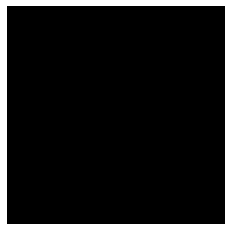

(612, 612, 3)
COCO_val2014_000000578525.jpg
{'person_bbx': [119.9, 23.25, 401.65, 466.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [377.99, 158.39, 510.81, 225.20999999999998]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [119.9, 23.25, 401.65, 466.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [521.6, 133.82, 558.25, 166.5]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [119.9, 23.25, 401.65, 466.89], 'Verbs': 'hold', 'object': {'obj_bbx': [377.99, 158.39, 510.81, 225.20999999999998]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [119.9, 23.25, 401.65, 466.89], 'Verbs': 'look', 'object': {'obj_bbx': [377.99, 158.39, 510.81, 225.20999999999998]}}
baseball bat
person
look
look interaction
{'person_bbx': [119.9, 23.25, 401.65, 466.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000153976.jpg
{'person_bbx': [329.17, 9.08, 392.36, 100.23], 'Verbs': 'jump', 'object': {'obj_bbx': [340.95, 69.92, 365.84, 111.47]}}
skateboard
person
jump
jump interaction
{'person_bbx': [245.59, 22.09, 332.88, 137.47], 'Verbs': 'look', 'object': {'obj_bbx': [250.92, 130.24, 284.63, 140.67000000000002]}}
skateboard
person
look
look interaction
{'person_bbx': [329.17, 9.08, 392.36, 100.23], 'Verbs': 'look', 'object': {'obj_bbx': [340.95, 69.92, 365.84, 111.47]}}
skateboard
person
look
look interaction
{'person_bbx': [170.1, 94.91, 224.26999999999998, 175.81], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [404.06, 35.28, 471.04, 120.55], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [550.04, 38.82, 590.54, 120.58000000000001], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [97.22, 75.67, 161.36, 178.4], 'Verbs': 'look', 'object': {'obj_bbx': [91.34, 172.74, 146.29000000000002, 183.58

(223, 640, 3)
COCO_val2014_000000268378.jpg
{'person_bbx': [390.46, 143.6, 621.1899999999999, 359.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [407.33, 259.58, 434.40999999999997, 305.09]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [114.77, 142.94, 284.49, 359.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [249.98, 239.58, 273.98, 264.65000000000003]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [390.46, 143.6, 621.1899999999999, 359.0], 'Verbs': 'hold', 'object': {'obj_bbx': [407.33, 259.58, 434.40999999999997, 305.09]}}
person
fork
hold
hold interaction
{'person_bbx': [114.77, 142.94, 284.49, 359.0], 'Verbs': 'hold', 'object': {'obj_bbx': [249.98, 239.58, 273.98, 264.65000000000003]}}
person
fork
hold
hold interaction
{'person_bbx': [0.0, 57.36, 113.81, 359.0], 'Verbs': 'look', 'object': {'obj_bbx': [76.0, 47.34, 150.44, 223.9]}}
person
person
look
look interaction
{'person_bbx': [390.46, 143.6, 621.1899999999999, 359.0], 'Verbs': 'sit', 'object': 

(359, 640, 3)
COCO_val2014_000000482172.jpg
{'person_bbx': [186.55, 180.74, 371.66, 357.24], 'Verbs': 'look', 'object': {'obj_bbx': [89.27, 244.15, 320.11, 389.83000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [186.55, 180.74, 371.66, 357.24], 'Verbs': 'surf', 'object': {'obj_bbx': [89.27, 244.15, 320.11, 389.83000000000004]}}
person
surfboard
surf
surf interaction


(640, 427, 3)
COCO_val2014_000000546832.jpg
{'person_bbx': [224.36, 244.49, 438.65, 536.45], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [208.03, 380.59, 306.01, 421.21]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [4.31, 218.61, 294.83, 566.6500000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [208.03, 380.59, 306.01, 421.21]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [4.31, 218.61, 294.83, 566.6500000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [208.03, 380.59, 306.01, 421.21]}}
hot dog
person
hold
hold interaction
{'person_bbx': [4.31, 218.61, 294.83, 566.6500000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [224.36, 244.49, 438.65, 536.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [4.31, 218.61, 294.83, 566.6500000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000548843.jpg
{'person_bbx': [28.64, 15.89, 440.97999999999996, 635.3199999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [305.91, 508.06, 380.14000000000004, 592.79]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [28.64, 15.89, 440.97999999999996, 635.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [305.91, 508.06, 380.14000000000004, 592.79]}}
person
donut
hold
hold interaction
{'person_bbx': [28.64, 15.89, 440.97999999999996, 635.3199999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [28.64, 15.89, 440.97999999999996, 635.3199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000507750.jpg
{'person_bbx': [100.42, 95.14, 269.56, 288.05], 'Verbs': 'jump', 'object': {'obj_bbx': [162.09, 46.91, 295.1, 329.67999999999995]}}
skis
person
jump
jump interaction
{'person_bbx': [100.42, 95.14, 269.56, 288.05], 'Verbs': 'look', 'object': {'obj_bbx': [162.09, 46.91, 295.1, 329.67999999999995]}}
skis
person
look
look interaction
{'person_bbx': [100.42, 95.14, 269.56, 288.05], 'Verbs': 'ski', 'object': {'obj_bbx': [162.09, 46.91, 295.1, 329.67999999999995]}}
skis
person
ski
ski interaction


(392, 640, 3)
COCO_val2014_000000139749.jpg
{'person_bbx': [124.67, 393.05, 177.73000000000002, 533.2], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [242.65, 404.31, 286.3, 569.41], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [124.67, 393.05, 177.73000000000002, 533.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [377.15, 379.97, 428.0, 580.32], 'Verbs': 'hold', 'object': {'obj_bbx': [389.57, 461.56, 402.53, 480.0]}}
person
handbag
hold
hold interaction
{'person_bbx': [242.65, 404.31, 286.3, 569.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.67, 393.05, 177.73000000000002, 533.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [377.15, 379.97, 428.0, 580.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.65, 404.31, 286.3, 569.41], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [124.67, 39

(640, 428, 3)
COCO_val2014_000000059635.jpg
{'person_bbx': [350.33, 489.44, 423.52, 620.09], 'Verbs': 'carry', 'object': {'obj_bbx': [307.53, 503.69, 420.57, 631.69]}}
person
surfboard
carry
carry interaction
{'person_bbx': [189.51, 119.69, 249.35, 324.15999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [135.71, 176.81, 200.11, 281.0]}}
person
surfboard
carry
carry interaction
{'person_bbx': [350.33, 489.44, 423.52, 620.09], 'Verbs': 'hold', 'object': {'obj_bbx': [307.53, 503.69, 420.57, 631.69]}}
person
surfboard
hold
hold interaction
{'person_bbx': [189.51, 119.69, 249.35, 324.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [135.71, 176.81, 200.11, 281.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [350.33, 489.44, 423.52, 620.09], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [350.33, 489.44, 423.52, 620.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [189.51, 119.69, 249.35, 324.15999999999997], 'Verbs'

(640, 486, 3)
COCO_val2014_000000002225.jpg
{'person_bbx': [0.0, 13.09, 498.31, 371.2], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [205.62, 96.07, 319.38, 250.28]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 13.09, 498.31, 371.2], 'Verbs': 'hold', 'object': {'obj_bbx': [205.62, 96.07, 319.38, 250.28]}}
person
donut
hold
hold interaction
{'person_bbx': [0.0, 13.09, 498.31, 371.2], 'Verbs': 'sit', 'object': {'obj_bbx': [337.89, 257.32, 500.0, 368.65]}}
person
chair
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000006771.jpg
{'person_bbx': [187.53, 100.5, 438.53999999999996, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [267.47, 264.34, 300.36, 306.07]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.96, 0.0, 247.56, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.96, 0.0, 247.56, 422.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [187.53, 100.5, 438.53999999999996, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.96, 0.0, 247.56, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [386.7, 156.41, 570.93, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [187.53, 100.5, 438.53999999999996, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [187.53, 100.5, 438.53999999999996, 427.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [267.47, 264.34, 300.36, 306.07]}}
c

(427, 640, 3)
COCO_val2014_000000516913.jpg
{'person_bbx': [102.11, 73.35, 345.17, 562.34], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [287.33, 35.76, 337.62, 209.39999999999998]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [102.11, 73.35, 345.17, 562.34], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [300.72, 414.93, 324.36, 438.96000000000004]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [102.11, 73.35, 345.17, 562.34], 'Verbs': 'hold', 'object': {'obj_bbx': [287.33, 35.76, 337.62, 209.39999999999998]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [102.11, 73.35, 345.17, 562.34], 'Verbs': 'look', 'object': {'obj_bbx': [300.72, 414.93, 324.36, 438.96000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [102.11, 73.35, 345.17, 562.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000575110.jpg
{'person_bbx': [32.87, 0.0, 498.03000000000003, 375.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [32.87, 0.0, 498.03000000000003, 375.0], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [32.87, 0.0, 498.03000000000003, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000029431.jpg
{'person_bbx': [109.19, 88.65, 391.35, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [43.29, 140.92, 150.24, 189.31]}}
person
frisbee
look
look interaction
{'person_bbx': [109.19, 88.65, 391.35, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [109.19, 88.65, 391.35, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [109.19, 88.65, 391.35, 480.0], 'Verbs': 'throw', 'object': {'obj_bbx': [43.29, 140.92, 150.24, 189.31]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000434548.jpg
{'person_bbx': [182.03, 124.33, 353.23, 435.3], 'Verbs': 'hold', 'object': {'obj_bbx': [298.14, 226.36, 340.65999999999997, 275.19]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [182.03, 124.33, 353.23, 435.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.03, 124.33, 353.23, 435.3], 'Verbs': 'throw', 'object': {'obj_bbx': [189.86, 124.55, 196.22000000000003, 131.34]}}
person
sports ball
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000422689.jpg
{'person_bbx': [124.84, 60.44, 344.39, 485.19], 'Verbs': 'jump', 'object': {'obj_bbx': [137.54, 386.83, 279.78, 482.73]}}
person
skateboard
jump
jump interaction
{'person_bbx': [124.84, 60.44, 344.39, 485.19], 'Verbs': 'look', 'object': {'obj_bbx': [137.54, 386.83, 279.78, 482.73]}}
person
skateboard
look
look interaction
{'person_bbx': [124.84, 60.44, 344.39, 485.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [137.54, 386.83, 279.78, 482.73]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [124.84, 60.44, 344.39, 485.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000563927.jpg
{'person_bbx': [192.96, 109.95, 373.51, 413.71999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [367.51, 148.73, 444.27, 219.74]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [192.96, 109.95, 373.51, 413.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [367.51, 148.73, 444.27, 219.74]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [192.96, 109.95, 373.51, 413.71999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump


(427, 640, 3)
COCO_val2014_000000553965.jpg
{'person_bbx': [21.57, 299.15, 284.76, 563.78], 'Verbs': 'look', 'object': {'obj_bbx': [190.44, 329.33, 367.28999999999996, 530.5699999999999]}}
person
surfboard
look
look interaction
{'person_bbx': [21.57, 299.15, 284.76, 563.78], 'Verbs': 'surf', 'object': {'obj_bbx': [190.44, 329.33, 367.28999999999996, 530.5699999999999]}}
person
surfboard
surf
surf interaction


(640, 396, 3)
COCO_val2014_000000101491.jpg
{'person_bbx': [47.25, 101.79, 239.11, 632.98], 'Verbs': 'carry', 'object': {'obj_bbx': [169.71, 411.33, 303.46000000000004, 585.35]}}
person
suitcase
carry
carry interaction
{'person_bbx': [47.25, 101.79, 239.11, 632.98], 'Verbs': 'hold', 'object': {'obj_bbx': [169.71, 411.33, 303.46000000000004, 585.35]}}
person
suitcase
hold
hold interaction
{'person_bbx': [47.25, 101.79, 239.11, 632.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [47.25, 101.79, 239.11, 632.98], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000380754.jpg
{'person_bbx': [67.17, 6.72, 640.0, 422.20000000000005], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [70.7, 261.3, 135.36, 318.31]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [67.17, 6.72, 640.0, 422.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [70.7, 261.3, 135.36, 318.31]}}
person
donut
hold
hold interaction
{'person_bbx': [67.17, 6.72, 640.0, 422.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [67.17, 6.72, 640.0, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000355552.jpg
{'person_bbx': [171.0, 133.74, 252.67000000000002, 351.56], 'Verbs': 'hold', 'object': {'obj_bbx': [186.72, 165.25, 243.12, 349.28999999999996]}}
person
snowboard
hold
hold interaction
{'person_bbx': [360.28, 139.76, 416.4, 313.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.0, 133.74, 252.67000000000002, 351.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [317.23, 152.58, 368.86, 319.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000509695.jpg
{'person_bbx': [358.75, 117.34, 536.6800000000001, 423.19000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [317.39, 111.41, 406.84, 150.84]}}
person
frisbee
look
look interaction
{'person_bbx': [358.75, 117.34, 536.6800000000001, 423.19000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [358.75, 117.34, 536.6800000000001, 423.19000000000005], 'Verbs': 'throw', 'object': {'obj_bbx': [317.39, 111.41, 406.84, 150.84]}}
person
frisbee
throw
throw interaction


(428, 640, 3)
COCO_val2014_000000309964.jpg
{'person_bbx': [90.6, 94.22, 249.65, 416.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [340.83, 95.42, 524.65, 421.89000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [90.6, 94.22, 249.65, 416.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [340.83, 95.42, 524.65, 421.89000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000211189.jpg
{'person_bbx': [392.49, 163.17, 519.11, 284.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [396.02, 191.07, 526.73, 320.81]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [371.39, 2.39, 415.33, 65.52], 'Verbs': 'look', 'object': {'obj_bbx': [75.53, 0.0, 101.57, 20.92]}}
person
person
look
look interaction
{'person_bbx': [174.98, 144.56, 285.94, 244.64], 'Verbs': 'ride', 'object': {'obj_bbx': [174.59, 169.1, 301.40999999999997, 310.61]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [392.49, 163.17, 519.11, 284.71999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [396.02, 191.07, 526.73, 320.81]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [371.39, 2.39, 415.33, 65.52], 'Verbs': 'ride', 'object': {'obj_bbx': [379.2, 16.47, 422.5, 71.78999999999999]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [174.98, 144.56, 285.94, 244.64], 'Verbs': 'sit', 'object': {'obj_bbx': [174.59, 169.1, 301.409999

(427, 640, 3)
COCO_val2014_000000271424.jpg


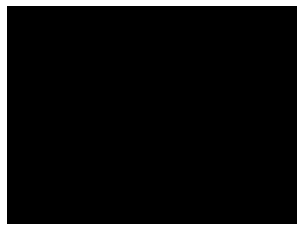

(480, 640, 3)
COCO_val2014_000000027972.jpg
{'person_bbx': [359.95, 84.08, 502.58, 241.07999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [296.5, 158.1, 472.58000000000004, 246.14]}}
person
surfboard
look
look interaction
{'person_bbx': [359.95, 84.08, 502.58, 241.07999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [296.5, 158.1, 472.58000000000004, 246.14]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000220638.jpg
{'person_bbx': [28.7, 0.0, 474.97999999999996, 472.97], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [77.6, 311.73, 143.14999999999998, 421.92]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [28.7, 0.0, 474.97999999999996, 472.97], 'Verbs': 'hold', 'object': {'obj_bbx': [77.6, 311.73, 143.14999999999998, 421.92]}}
person
spoon
hold
hold interaction
{'person_bbx': [28.7, 0.0, 474.97999999999996, 472.97], 'Verbs': 'look', 'object': {'obj_bbx': [5.75, 366.3, 237.3, 511.56]}}
person
bowl
look
look interaction
{'person_bbx': [28.7, 0.0, 474.97999999999996, 472.97], 'Verbs': 'sit', 'object': {'obj_bbx': [51.89, 62.7, 246.49, 190.99]}}
chair
person
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000336046.jpg
{'person_bbx': [356.08, 3.35, 639.41, 266.58000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [248.97, 129.78, 486.21000000000004, 259.26]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [356.08, 3.35, 639.41, 266.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [248.97, 129.78, 486.21000000000004, 259.26]}}
person
scissors
hold
hold interaction


(425, 640, 3)
COCO_val2014_000000456807.jpg
{'person_bbx': [4.31, 54.65, 296.27, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [162.34, 125.04, 225.05, 192.85000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [4.31, 54.65, 296.27, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [4.31, 54.65, 296.27, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [4.31, 54.65, 296.27, 632.81], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [162.34, 125.04, 225.05, 192.85000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000124013.jpg
{'person_bbx': [59.91, 51.89, 248.2, 373.9], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 219.15, 500.0, 469.9]}}
horse
person
hold
hold interaction
{'person_bbx': [59.91, 51.89, 248.2, 373.9], 'Verbs': 'look', 'object': {'obj_bbx': [130.33, 265.42, 302.31, 475.0]}}
person
person
look
look interaction
{'person_bbx': [25.62, 27.57, 149.44, 417.18], 'Verbs': 'look', 'object': {'obj_bbx': [130.33, 265.42, 302.31, 475.0]}}
person
person
look
look interaction
{'person_bbx': [59.91, 51.89, 248.2, 373.9], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 219.15, 500.0, 469.9]}}
horse
person
ride
ride interaction
{'person_bbx': [25.62, 27.57, 149.44, 417.18], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 219.15, 500.0, 469.9]}}
horse
person
ride
ride interaction
{'person_bbx': [59.91, 51.89, 248.2, 373.9], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 219.15, 500.0, 469.9]}}
horse
person
sit
sit interaction
{'person_bbx': [25.62, 27.57, 149.44, 417.18], 'Ver

(475, 500, 3)
COCO_val2014_000000524459.jpg
{'person_bbx': [263.88, 110.35, 544.0699999999999, 419.32000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [529.17, 346.76, 627.49, 427.0]}}
chair
person
sit
sit interaction
{'person_bbx': [263.88, 110.35, 544.0699999999999, 419.32000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [9.62, 280.34, 241.39000000000001, 421.71]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000045388.jpg
{'person_bbx': [471.29, 77.28, 640.0, 472.38], 'Verbs': 'hold', 'object': {'obj_bbx': [211.4, 275.74, 380.52, 338.95]}}
person
kite
hold
hold interaction
{'person_bbx': [471.29, 77.28, 640.0, 472.38], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [471.29, 77.28, 640.0, 472.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000384092.jpg
{'person_bbx': [2.11, 38.93, 639.36, 423.6], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [278.09, 275.97, 353.78, 337.37]}}
donut
person
eat_obj
eat_obj interaction


(428, 640, 3)
COCO_val2014_000000352694.jpg
{'person_bbx': [93.48, 27.09, 353.8, 612.4300000000001], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [93.48, 27.09, 353.8, 612.4300000000001], 'Verbs': 'kick', 'object': {'obj_bbx': [169.16, 325.99, 266.42, 427.36]}}
sports ball
person
kick
kick interaction
{'person_bbx': [93.48, 27.09, 353.8, 612.4300000000001], 'Verbs': 'look', 'object': {'obj_bbx': [169.16, 325.99, 266.42, 427.36]}}
sports ball
person
look
look interaction


(640, 469, 3)
COCO_val2014_000000246883.jpg
{'person_bbx': [257.88, 226.23, 305.56, 351.48], 'Verbs': 'carry', 'object': {'obj_bbx': [294.2, 263.8, 320.5, 311.22]}}
person
surfboard
carry
carry interaction
{'person_bbx': [385.12, 229.18, 421.06, 358.17], 'Verbs': 'carry', 'object': {'obj_bbx': [329.66, 264.26, 481.07000000000005, 304.0]}}
person
surfboard
carry
carry interaction
{'person_bbx': [257.88, 226.23, 305.56, 351.48], 'Verbs': 'hold', 'object': {'obj_bbx': [294.2, 263.8, 320.5, 311.22]}}
person
surfboard
hold
hold interaction
{'person_bbx': [385.12, 229.18, 421.06, 358.17], 'Verbs': 'hold', 'object': {'obj_bbx': [329.66, 264.26, 481.07000000000005, 304.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [257.88, 226.23, 305.56, 351.48], 'Verbs': 'look', 'object': {'obj_bbx': [385.12, 229.18, 421.06, 358.17]}}
person
person
look
look interaction
{'person_bbx': [385.12, 229.18, 421.06, 358.17], 'Verbs': 'look', 'object': {'obj_bbx': [329.66, 264.26, 481.07000000000005, 30

(480, 640, 3)
COCO_val2014_000000490515.jpg
{'person_bbx': [190.34, 117.02, 511.53, 304.96999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(427, 640, 3)
COCO_val2014_000000444502.jpg
{'person_bbx': [48.68, 40.23, 263.45, 625.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [48.68, 40.23, 263.45, 625.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000504589.jpg
{'person_bbx': [0.0, 364.48, 153.54, 632.83], 'Verbs': 'catch', 'object': {'obj_bbx': [245.9, 268.03, 309.86, 292.02]}}
frisbee
person
catch
catch interaction
{'person_bbx': [0.0, 364.48, 153.54, 632.83], 'Verbs': 'look', 'object': {'obj_bbx': [245.9, 268.03, 309.86, 292.02]}}
frisbee
person
look
look interaction
{'person_bbx': [0.0, 364.48, 153.54, 632.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000525155.jpg
{'person_bbx': [263.26, 80.48, 640.0, 419.36], 'Verbs': 'carry', 'object': {'obj_bbx': [178.14, 32.2, 640.0, 360.34999999999997]}}
sheep
person
carry
carry interaction
{'person_bbx': [263.26, 80.48, 640.0, 419.36], 'Verbs': 'hold', 'object': {'obj_bbx': [178.14, 32.2, 640.0, 360.34999999999997]}}
sheep
person
hold
hold interaction
{'person_bbx': [263.26, 80.48, 640.0, 419.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [263.26, 80.48, 640.0, 419.36], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000291251.jpg
{'person_bbx': [252.1, 101.55, 491.03, 333.34], 'Verbs': 'jump', 'object': {'obj_bbx': [232.87, 295.2, 356.27, 358.09999999999997]}}
person
snowboard
jump
jump interaction
{'person_bbx': [252.1, 101.55, 491.03, 333.34], 'Verbs': 'snowboard', 'object': {'obj_bbx': [232.87, 295.2, 356.27, 358.09999999999997]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [252.1, 101.55, 491.03, 333.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000158133.jpg
{'person_bbx': [153.06, 167.93, 222.64, 247.10000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [163.03, 238.15, 241.67000000000002, 255.76]}}
person
skis
jump
jump interaction
{'person_bbx': [153.06, 167.93, 222.64, 247.10000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [163.03, 238.15, 241.67000000000002, 255.76]}}
person
skis
ski
ski interaction
{'person_bbx': [153.06, 167.93, 222.64, 247.10000000000002], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [432.72, 325.74, 482.61, 419.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.06, 167.93, 222.64, 247.10000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 245.25, 30.11, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000405261.jpg
{'person_bbx': [122.38, 0.64, 640.0, 409.84], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(566, 640, 3)
COCO_val2014_000000171695.jpg
{'person_bbx': [279.25, 123.88, 331.07, 192.16], 'Verbs': 'ride', 'object': {'obj_bbx': [166.57, 189.39, 627.99, 421.04999999999995]}}
truck
person
ride
ride interaction
{'person_bbx': [352.36, 136.26, 416.40000000000003, 189.07999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [166.57, 189.39, 627.99, 421.04999999999995]}}
truck
person
ride
ride interaction
{'person_bbx': [458.55, 136.89, 539.9200000000001, 188.58999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [166.57, 189.39, 627.99, 421.04999999999995]}}
truck
person
ride
ride interaction
{'person_bbx': [416.98, 129.16, 466.82000000000005, 184.76], 'Verbs': 'ride', 'object': {'obj_bbx': [166.57, 189.39, 627.99, 421.04999999999995]}}
truck
person
ride
ride interaction
{'person_bbx': [458.55, 136.89, 539.9200000000001, 188.58999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [416.98, 129.16, 466.82000000000005, 184.76], 'Verbs': 'sit', 'object': {'ob

(426, 640, 3)
COCO_val2014_000000356570.jpg
{'person_bbx': [413.57, 0.0, 640.0, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [324.16, 158.93, 487.63, 272.02]}}
person
laptop
look
look interaction
{'person_bbx': [413.57, 0.0, 640.0, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [413.57, 0.0, 640.0, 422.2], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [324.16, 158.93, 487.63, 272.02]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000092776.jpg
{'person_bbx': [1.27, 4.24, 639.15, 474.06], 'Verbs': 'lay', 'object': {'obj_bbx': [84.32, 173.51, 640.0, 475.14]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000065383.jpg
{'person_bbx': [219.53, 20.77, 315.2, 231.39000000000001], 'Verbs': 'kick', 'object': {'obj_bbx': [182.06, 204.29, 212.13, 234.2]}}
sports ball
person
kick
kick interaction
{'person_bbx': [219.53, 20.77, 315.2, 231.39000000000001], 'Verbs': 'look', 'object': {'obj_bbx': [182.06, 204.29, 212.13, 234.2]}}
sports ball
person
look
look interaction
{'person_bbx': [219.53, 20.77, 315.2, 231.39000000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [219.53, 20.77, 315.2, 231.39000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000514990.jpg
{'person_bbx': [88.02, 55.66, 289.61, 297.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [88.02, 55.66, 289.61, 297.95], 'Verbs': 'look', 'object': {'obj_bbx': [172.85, 299.38, 280.76, 355.72]}}
person
pizza
look
look interaction
{'person_bbx': [88.02, 55.66, 289.61, 297.95], 'Verbs': 'sit', 'object': {'obj_bbx': [62.99, 201.09, 254.89000000000001, 291.93]}}
chair
person
sit
sit interaction


(424, 640, 3)
COCO_val2014_000000521943.jpg
{'person_bbx': [328.13, 147.31, 489.03, 441.78000000000003], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [243.08, 133.36, 333.15, 195.94]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [328.13, 147.31, 489.03, 441.78000000000003], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [285.4, 183.05, 308.69, 204.68]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [328.13, 147.31, 489.03, 441.78000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [243.08, 133.36, 333.15, 195.94]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [328.13, 147.31, 489.03, 441.78000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [285.4, 183.05, 308.69, 204.68]}}
sports ball
person
look
look interaction
{'person_bbx': [328.13, 147.31, 489.03, 441.78000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(468, 640, 3)
COCO_val2014_000000114389.jpg
{'person_bbx': [226.74, 130.08, 385.38, 333.0], 'Verbs': 'hold', 'object': {'obj_bbx': [321.27, 162.66, 337.56, 188.0]}}
person
cell phone
hold
hold interaction
{'person_bbx': [226.74, 130.08, 385.38, 333.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [226.74, 130.08, 385.38, 333.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [226.74, 130.08, 385.38, 333.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [321.27, 162.66, 337.56, 188.0]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(333, 500, 3)
COCO_val2014_000000199442.jpg
{'person_bbx': [260.19, 76.81, 443.68, 239.91], 'Verbs': 'look', 'object': {'obj_bbx': [164.68, 204.49, 406.85, 265.51]}}
person
surfboard
look
look interaction
{'person_bbx': [260.19, 76.81, 443.68, 239.91], 'Verbs': 'surf', 'object': {'obj_bbx': [164.68, 204.49, 406.85, 265.51]}}
person
surfboard
surf
surf interaction


(433, 640, 3)
COCO_val2014_000000360611.jpg
{'person_bbx': [147.59, 170.52, 198.47, 288.72], 'Verbs': 'look', 'object': {'obj_bbx': [98.45, 88.55, 472.87, 213.36]}}
person
airplane
look
look interaction
{'person_bbx': [40.37, 152.87, 73.68, 256.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [147.59, 170.52, 198.47, 288.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [40.37, 152.87, 73.68, 256.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [40.37, 152.87, 73.68, 256.84000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000203629.jpg
{'person_bbx': [148.73, 135.3, 385.74, 418.36], 'Verbs': 'hold', 'object': {'obj_bbx': [275.07, 195.92, 287.12, 214.66]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.92, 144.89, 200.54999999999998, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [385.09, 172.82, 640.0, 426.64], 'Verbs': 'look', 'object': {'obj_bbx': [483.61, 357.91, 553.66, 418.36]}}
cup
person
look
look interaction
{'person_bbx': [1.92, 144.89, 200.54999999999998, 421.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.92, 144.89, 200.54999999999998, 421.24], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [148.73, 135.3, 385.74, 418.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [385.09, 172.82, 640.0, 426.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.92, 144.89, 200.54999999999998, 421.24], 'Verbs': 'sit', 'object': {'obj

(427, 640, 3)
COCO_val2014_000000462466.jpg
{'person_bbx': [325.23, 51.57, 479.68, 301.96], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [297.95, 206.45, 352.73, 234.92]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [325.23, 51.57, 479.68, 301.96], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [252.61, 231.01, 374.73, 293.99]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [500.45, 142.3, 637.98, 418.31], 'Verbs': 'hold', 'object': {'obj_bbx': [297.95, 206.45, 352.73, 234.92]}}
person
knife
hold
hold interaction
{'person_bbx': [325.23, 51.57, 479.68, 301.96], 'Verbs': 'hold', 'object': {'obj_bbx': [297.95, 206.45, 352.73, 234.92]}}
person
knife
hold
hold interaction
{'person_bbx': [392.53, 99.33, 578.76, 416.4], 'Verbs': 'look', 'object': {'obj_bbx': [252.61, 231.01, 374.73, 293.99]}}
person
cake
look
look interaction
{'person_bbx': [325.23, 51.57, 479.68, 301.96], 'Verbs': 'look', 'object': {'obj_bbx': [252.61, 231.01, 374.73, 293.99]}}
person
cake
look
look intera

(425, 640, 3)
COCO_val2014_000000252383.jpg
{'person_bbx': [404.49, 199.55, 621.3, 338.70000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [215.47, 182.51, 331.77, 308.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [404.49, 199.55, 621.3, 338.70000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.72, 198.21, 160.78, 320.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [215.47, 182.51, 331.77, 308.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [404.49, 199.55, 621.3, 338.70000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000431364.jpg
{'person_bbx': [202.13, 201.65, 264.31, 385.96000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [203.77, 176.11, 303.82, 223.81]}}
umbrella
person
carry
carry interaction
{'person_bbx': [202.13, 201.65, 264.31, 385.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [203.77, 176.11, 303.82, 223.81]}}
umbrella
person
hold
hold interaction
{'person_bbx': [202.13, 201.65, 264.31, 385.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [202.13, 201.65, 264.31, 385.96000000000004], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000544583.jpg
{'person_bbx': [184.9, 23.31, 331.81, 246.62], 'Verbs': 'look', 'object': {'obj_bbx': [289.81, 216.88, 436.90999999999997, 264.33]}}
person
surfboard
look
look interaction
{'person_bbx': [184.9, 23.31, 331.81, 246.62], 'Verbs': 'surf', 'object': {'obj_bbx': [289.81, 216.88, 436.90999999999997, 264.33]}}
person
surfboard
surf
surf interaction


(378, 500, 3)
COCO_val2014_000000281541.jpg
{'person_bbx': [0.0, 0.11, 432.69, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [213.96, 166.2, 290.37, 395.42999999999995]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.11, 432.69, 426.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [213.96, 166.2, 290.37, 395.42999999999995]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(426, 640, 3)
COCO_val2014_000000505650.jpg
{'person_bbx': [244.6, 314.28, 388.45, 502.65], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [185.43, 442.74, 220.88, 478.18]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [136.81, 284.02, 253.88, 493.25], 'Verbs': 'hold', 'object': {'obj_bbx': [145.89, 334.03, 242.23999999999998, 576.27]}}
horse
person
hold
hold interaction
{'person_bbx': [244.6, 314.28, 388.45, 502.65], 'Verbs': 'hold', 'object': {'obj_bbx': [272.36, 316.77, 388.73, 602.3399999999999]}}
horse
person
hold
hold interaction
{'person_bbx': [136.81, 284.02, 253.88, 493.25], 'Verbs': 'look', 'object': {'obj_bbx': [185.43, 442.74, 220.88, 478.18]}}
sports ball
person
look
look interaction
{'person_bbx': [244.6, 314.28, 388.45, 502.65], 'Verbs': 'look', 'object': {'obj_bbx': [185.43, 442.74, 220.88, 478.18]}}
sports ball
person
look
look interaction
{'person_bbx': [136.81, 284.02, 253.88, 493.25], 'Verbs': 'ride', 'object': {'obj_bbx': [145.89, 334.03, 242.2399999999

(640, 429, 3)
COCO_val2014_000000330665.jpg
{'person_bbx': [186.97, 138.07, 488.99, 631.37], 'Verbs': 'carry', 'object': {'obj_bbx': [382.81, 215.86, 395.61, 231.96]}}
cell phone
person
carry
carry interaction
{'person_bbx': [186.97, 138.07, 488.99, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [370.23, 259.45, 385.01, 283.71999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [186.97, 138.07, 488.99, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [186.97, 138.07, 488.99, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.55, 94.92, 287.64, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [186.97, 138.07, 488.99, 631.37], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [370.23, 259.45, 385.01, 283.71999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [103.55, 94.92, 287.64, 632.81], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
p

(640, 591, 3)
COCO_val2014_000000544140.jpg
{'person_bbx': [184.59, 214.59, 212.28, 330.33], 'Verbs': 'look', 'object': {'obj_bbx': [226.4, 318.83, 271.66, 328.02]}}
skateboard
person
look
look interaction
{'person_bbx': [137.39, 219.6, 190.16, 290.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [307.23, 254.1, 349.12, 306.37], 'Verbs': 'look', 'object': {'obj_bbx': [350.23, 271.35, 373.59000000000003, 295.34000000000003]}}
person
person
look
look interaction
{'person_bbx': [307.23, 254.1, 349.12, 306.37], 'Verbs': 'sit', 'object': {'obj_bbx': [268.31, 303.92, 346.39, 335.40000000000003]}}
person
bench
sit
sit interaction
{'person_bbx': [137.39, 219.6, 190.16, 290.57], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [184.59, 214.59, 212.28, 330.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000563912.jpg
{'person_bbx': [379.69, 135.41, 533.86, 268.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [379.69, 135.41, 533.86, 268.88], 'Verbs': 'jump', 'object': {'obj_bbx': [331.99, 113.58, 436.33000000000004, 369.68]}}
person
skis
jump
jump interaction
{'person_bbx': [379.69, 135.41, 533.86, 268.88], 'Verbs': 'ski', 'object': {'obj_bbx': [331.99, 113.58, 436.33000000000004, 369.68]}}
person
skis
ski
ski interaction


(512, 640, 3)
COCO_val2014_000000069969.jpg
{'person_bbx': [475.34, 225.9, 640.0, 380.72], 'Verbs': 'hold', 'object': {'obj_bbx': [530.9, 258.6, 549.5699999999999, 278.74]}}
cell phone
person
hold
hold interaction
{'person_bbx': [475.34, 225.9, 640.0, 380.72], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(402, 640, 3)
COCO_val2014_000000035672.jpg
{'person_bbx': [2.47, 53.38, 500.0, 270.61], 'Verbs': 'hold', 'object': {'obj_bbx': [207.71, 56.32, 499.94000000000005, 271.21]}}
dog
person
hold
hold interaction
{'person_bbx': [2.47, 53.38, 500.0, 270.61], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [2.47, 53.38, 500.0, 270.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(274, 500, 3)
COCO_val2014_000000057306.jpg
{'person_bbx': [176.9, 115.06, 442.97, 615.55], 'Verbs': 'hold', 'object': {'obj_bbx': [294.12, 176.0, 315.94, 204.26]}}
person
cell phone
hold
hold interaction
{'person_bbx': [176.9, 115.06, 442.97, 615.55], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [294.12, 176.0, 315.94, 204.26]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 501, 3)
COCO_val2014_000000450559.jpg
{'person_bbx': [71.68, 34.13, 303.79, 360.11], 'Verbs': 'jump', 'object': {'obj_bbx': [181.58, 215.36, 341.58000000000004, 373.91]}}
person
skateboard
jump
jump interaction
{'person_bbx': [71.68, 34.13, 303.79, 360.11], 'Verbs': 'look', 'object': {'obj_bbx': [181.58, 215.36, 341.58000000000004, 373.91]}}
person
skateboard
look
look interaction
{'person_bbx': [71.68, 34.13, 303.79, 360.11], 'Verbs': 'skateboard', 'object': {'obj_bbx': [181.58, 215.36, 341.58000000000004, 373.91]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000297084.jpg
{'person_bbx': [145.78, 2.75, 537.73, 413.96], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [145.78, 2.75, 537.73, 413.96], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(612, 612, 3)
COCO_val2014_000000072656.jpg
{'person_bbx': [277.75, 128.54, 421.57, 309.21], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [179.72, 147.25, 329.23, 216.75]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [277.75, 128.54, 421.57, 309.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [75.17, 98.72, 222.82, 339.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [277.75, 128.54, 421.57, 309.21], 'Verbs': 'look', 'object': {'obj_bbx': [157.15, 37.02, 287.03999999999996, 173.99]}}
person
person
look
look interaction
{'person_bbx': [75.17, 98.72, 222.82, 339.43], 'Verbs': 'look', 'object': {'obj_bbx': [157.15, 37.02, 287.03999999999996, 173.99]}}
person
person
look
look interaction
{'person_bbx': [277.75, 128.54, 421.57, 309.21], 'Verbs': 'sit', 'object': {'obj_bbx': [282.76, 217.24, 431.03, 395.69]}}
chair
person
sit
sit interaction
{'person_bbx': [75.17, 98.72, 222.82, 339.43], 'Verbs': 'sit', 'object': {'obj_bbx': [40

(400, 500, 3)
COCO_val2014_000000054007.jpg
{'person_bbx': [130.5, 98.83, 360.78999999999996, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': [272.04, 301.59, 451.27, 324.91999999999996]}}
person
baseball bat
carry
carry interaction
{'person_bbx': [130.5, 98.83, 360.78999999999996, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [272.04, 301.59, 451.27, 324.91999999999996]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [130.5, 98.83, 360.78999999999996, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [272.04, 301.59, 451.27, 324.91999999999996]}}
person
baseball bat
look
look interaction
{'person_bbx': [130.5, 98.83, 360.78999999999996, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [130.5, 98.83, 360.78999999999996, 427.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000540556.jpg
{'person_bbx': [104.31, 145.0, 320.99, 302.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [144.72, 241.45, 258.57, 271.74]}}
person
skateboard
hold
hold interaction
{'person_bbx': [104.31, 145.0, 320.99, 302.09000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [144.72, 241.45, 258.57, 271.74]}}
person
skateboard
jump
jump interaction
{'person_bbx': [104.31, 145.0, 320.99, 302.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [144.72, 241.45, 258.57, 271.74]}}
person
skateboard
look
look interaction
{'person_bbx': [104.31, 145.0, 320.99, 302.09000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [144.72, 241.45, 258.57, 271.74]}}
person
skateboard
skateboard
skateboard interaction


(640, 433, 3)
COCO_val2014_000000163575.jpg
{'person_bbx': [0.0, 170.05, 386.92, 415.35], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 256.38, 415.92, 503.2]}}
dog
person
hold
hold interaction
{'person_bbx': [0.0, 170.05, 386.92, 415.35], 'Verbs': 'lay', 'object': {'obj_bbx': [1.18, 150.53, 637.4799999999999, 511.1]}}
person
bed
lay
lay interaction


(522, 640, 3)
COCO_val2014_000000264279.jpg
{'person_bbx': [279.2, 71.19, 337.4, 211.57999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [178.07, 194.07, 300.62, 214.04]}}
person
surfboard
look
look interaction
{'person_bbx': [279.2, 71.19, 337.4, 211.57999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [279.2, 71.19, 337.4, 211.57999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [178.07, 194.07, 300.62, 214.04]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000447460.jpg
{'person_bbx': [100.28, 3.37, 500.0, 360.67], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [199.47, 174.42, 324.47, 252.44]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [100.28, 3.37, 500.0, 360.67], 'Verbs': 'look', 'object': {'obj_bbx': [199.47, 174.42, 324.47, 252.44]}}
person
hot dog
look
look interaction
{'person_bbx': [100.28, 3.37, 500.0, 360.67], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(375, 500, 3)
COCO_val2014_000000033830.jpg
{'person_bbx': [1.76, 1.29, 640.0, 523.0899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [2.37, 377.31, 301.61, 542.9]}}
sheep
person
hold
hold interaction
{'person_bbx': [1.76, 1.29, 640.0, 523.0899999999999], 'Verbs': 'look', 'object': {'obj_bbx': [2.37, 377.31, 301.61, 542.9]}}
sheep
person
look
look interaction


(550, 640, 3)
COCO_val2014_000000451532.jpg
{'person_bbx': [384.86, 257.8, 420.94, 352.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [284.4, 272.18, 328.29999999999995, 340.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [201.01, 276.59, 243.63, 355.15], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [384.86, 257.8, 420.94, 352.3], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [467.18, 249.83, 498.83, 315.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [384.86, 257.8, 420.94, 352.3], 'Verbs': 'ski', 'object': {'obj_bbx': [399.79, 335.36, 422.81, 359.98]}}
person
skis
ski
ski interaction
{'person_bbx': [467.18, 249.83, 498.83, 315.89], 'Verbs': 'ski', 'object': {'obj_bbx': [469.61, 296.27, 491.38, 322.78]}}
person
skis
ski
ski interaction
{'person_bbx': [284.4, 272.18, 328.29999999999995, 340.96000000000004], 'Verbs': 'snowboard', 'object': {'

(384, 640, 3)
COCO_val2014_000000538319.jpg
{'person_bbx': [146.3, 147.24, 277.11, 402.11], 'Verbs': 'hold', 'object': {'obj_bbx': [256.21, 247.19, 314.95, 372.84000000000003]}}
person
person
hold
hold interaction
{'person_bbx': [432.43, 138.38, 537.3, 378.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [146.3, 147.24, 277.11, 402.11], 'Verbs': 'look', 'object': {'obj_bbx': [256.21, 247.19, 314.95, 372.84000000000003]}}
person
person
look
look interaction
{'person_bbx': [432.43, 138.38, 537.3, 378.38], 'Verbs': 'look', 'object': {'obj_bbx': [256.21, 247.19, 314.95, 372.84000000000003]}}
person
person
look
look interaction
{'person_bbx': [146.3, 147.24, 277.11, 402.11], 'Verbs': 'ski', 'object': {'obj_bbx': [118.65, 373.21, 400.17999999999995, 473.53]}}
person
skis
ski
ski interaction
{'person_bbx': [432.43, 138.38, 537.3, 378.38], 'Verbs': 'ski', 'object': {'obj_bbx': [383.0, 353.05, 639.8199999999999, 421.20000000000005]}}
person
skis
ski
ski interaction
{'

(480, 640, 3)
COCO_val2014_000000107741.jpg
{'person_bbx': [153.34, 222.35, 339.62, 630.52], 'Verbs': 'carry', 'object': {'obj_bbx': [124.94, 193.98, 370.28, 350.33]}}
umbrella
person
carry
carry interaction
{'person_bbx': [153.34, 222.35, 339.62, 630.52], 'Verbs': 'hold', 'object': {'obj_bbx': [124.94, 193.98, 370.28, 350.33]}}
umbrella
person
hold
hold interaction
{'person_bbx': [153.34, 222.35, 339.62, 630.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.34, 222.35, 339.62, 630.52], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [270.83, 261.19, 287.89, 285.27]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [153.34, 222.35, 339.62, 630.52], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000308339.jpg
{'person_bbx': [204.38, 1.93, 640.0, 420.32], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 135.35, 640.0, 429.0]}}
person
bed
sit
sit interaction
{'person_bbx': [204.38, 1.93, 640.0, 420.32], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 198.02, 397.85, 394.94]}}
person
laptop
work_on_computer
work_on_computer interaction


(429, 640, 3)
COCO_val2014_000000092939.jpg
{'person_bbx': [20.13, 113.71, 281.89, 565.3100000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.3, 478.87, 274.64, 495.71]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [20.13, 113.71, 281.89, 565.3100000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [207.61, 499.83, 375.12, 627.25]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [179.53, 126.34, 393.97, 518.65], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.3, 478.87, 274.64, 495.71]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [179.53, 126.34, 393.97, 518.65], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [207.61, 499.83, 375.12, 627.25]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [20.13, 113.71, 281.89, 565.3100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [266.3, 478.87, 274.64, 495.71]}}
person
knife
hold
hold interaction
{'person_bbx': [179.53, 126.34, 393.97, 518.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}


(640, 424, 3)
COCO_val2014_000000083761.jpg
{'person_bbx': [0.0, 73.51, 445.41, 421.62], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [66.5, 298.0, 148.0, 380.0]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 73.51, 445.41, 421.62], 'Verbs': 'hold', 'object': {'obj_bbx': [66.5, 298.0, 148.0, 380.0]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 73.51, 445.41, 421.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 73.51, 445.41, 421.62], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000528729.jpg
{'person_bbx': [168.27, 92.58, 309.57000000000005, 466.88], 'Verbs': 'hold', 'object': {'obj_bbx': [115.36, 287.5, 460.43, 468.78999999999996]}}
bicycle
person
hold
hold interaction
{'person_bbx': [168.27, 92.58, 309.57000000000005, 466.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [168.27, 92.58, 309.57000000000005, 466.88], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [186.51, 128.42, 207.89999999999998, 156.7]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [168.27, 92.58, 309.57000000000005, 466.88], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000193112.jpg
{'person_bbx': [383.2, 58.81, 544.43, 310.03999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [431.27, 285.76, 530.21, 325.33]}}
person
skateboard
jump
jump interaction
{'person_bbx': [383.2, 58.81, 544.43, 310.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [431.27, 285.76, 530.21, 325.33]}}
person
skateboard
look
look interaction
{'person_bbx': [383.2, 58.81, 544.43, 310.03999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [431.27, 285.76, 530.21, 325.33]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [70.79, 65.9, 167.61, 400.28999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [71.87, 390.19, 183.57999999999998, 425.94]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [383.2, 58.81, 544.43, 310.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [70.79, 65.9, 167.61, 400.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}

(512, 640, 3)
COCO_val2014_000000445211.jpg
{'person_bbx': [51.31, 86.08, 232.52, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [194.66, 269.66, 257.02, 303.37]}}
person
frisbee
hold
hold interaction
{'person_bbx': [51.31, 86.08, 232.52, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [51.31, 86.08, 232.52, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [51.31, 86.08, 232.52, 375.0], 'Verbs': 'throw', 'object': {'obj_bbx': [194.66, 269.66, 257.02, 303.37]}}
person
frisbee
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000046331.jpg
{'person_bbx': [89.4, 17.41, 539.86, 510.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [487.78, 32.37, 524.8399999999999, 70.74]}}
sports ball
person
hold
hold interaction
{'person_bbx': [89.4, 17.41, 539.86, 510.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.4, 17.41, 539.86, 510.84000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [487.78, 32.37, 524.8399999999999, 70.74]}}
sports ball
person
throw
throw interaction


(512, 640, 3)
COCO_val2014_000000369460.jpg
{'person_bbx': [314.54, 133.57, 480.0, 619.62], 'Verbs': 'carry', 'object': {'obj_bbx': [367.78, 169.14, 400.15999999999997, 201.76]}}
cell phone
person
carry
carry interaction
{'person_bbx': [314.54, 133.57, 480.0, 619.62], 'Verbs': 'hold', 'object': {'obj_bbx': [367.78, 169.14, 400.15999999999997, 201.76]}}
cell phone
person
hold
hold interaction
{'person_bbx': [314.54, 133.57, 480.0, 619.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.54, 133.57, 480.0, 619.62], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [367.78, 169.14, 400.15999999999997, 201.76]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [314.54, 133.57, 480.0, 619.62], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000381430.jpg
{'person_bbx': [18.78, 73.07, 146.86, 282.65999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [230.56, 73.65, 440.84000000000003, 282.87], 'Verbs': 'kick', 'object': {'obj_bbx': [202.86, 257.9, 235.11, 287.52]}}
sports ball
person
kick
kick interaction
{'person_bbx': [18.78, 73.07, 146.86, 282.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [202.86, 257.9, 235.11, 287.52]}}
sports ball
person
look
look interaction
{'person_bbx': [406.69, 77.92, 573.2, 433.37], 'Verbs': 'look', 'object': {'obj_bbx': [202.86, 257.9, 235.11, 287.52]}}
sports ball
person
look
look interaction
{'person_bbx': [230.56, 73.65, 440.84000000000003, 282.87], 'Verbs': 'look', 'object': {'obj_bbx': [202.86, 257.9, 235.11, 287.52]}}
sports ball
person
look
look interaction
{'person_bbx': [18.78, 73.07, 146.86, 282.65999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [406.69, 77.92, 573.2, 433.37],

(475, 640, 3)
COCO_val2014_000000030828.jpg
{'person_bbx': [181.76, 160.61, 576.0699999999999, 265.43], 'Verbs': 'lay', 'object': {'obj_bbx': [57.7, 156.76, 600.11, 338.52]}}
person
bench
lay
lay interaction


(427, 640, 3)
COCO_val2014_000000237232.jpg
{'person_bbx': [12.94, 92.04, 330.79, 537.89], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [12.94, 92.04, 330.79, 537.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [12.94, 92.04, 330.79, 537.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000559483.jpg
{'person_bbx': [359.34, 279.82, 515.5799999999999, 517.47], 'Verbs': 'look', 'object': {'obj_bbx': [383.21, 404.53, 560.45, 544.02]}}
person
skis
look
look interaction
{'person_bbx': [359.34, 279.82, 515.5799999999999, 517.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [467.16, 254.86, 532.49, 441.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [467.16, 254.86, 532.49, 441.77], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000567740.jpg
{'person_bbx': [1.43, 116.69, 219.84, 424.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [441.17, 113.26, 574.9200000000001, 468.13], 'Verbs': 'hold', 'object': {'obj_bbx': [347.03, 399.46, 474.59, 468.65]}}
person
skis
hold
hold interaction
{'person_bbx': [1.43, 116.69, 219.84, 424.44], 'Verbs': 'ski', 'object': {'obj_bbx': [55.01, 395.69, 276.13, 463.64]}}
person
skis
ski
ski interaction
{'person_bbx': [441.17, 113.26, 574.9200000000001, 468.13], 'Verbs': 'ski', 'object': {'obj_bbx': [347.03, 399.46, 474.59, 468.65]}}
person
skis
ski
ski interaction
{'person_bbx': [1.43, 116.69, 219.84, 424.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [441.17, 113.26, 574.9200000000001, 468.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.43, 116.69, 219.84, 424.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [441.17, 113.26, 574.92000

(480, 640, 3)
COCO_val2014_000000291588.jpg
{'person_bbx': [1.69, 10.11, 500.0, 369.94], 'Verbs': 'lay', 'object': {'obj_bbx': [0.97, 12.66, 500.0, 370.13000000000005]}}
person
bed
lay
lay interaction


(375, 500, 3)
COCO_val2014_000000361238.jpg
{'person_bbx': [96.0, 2.16, 360.27, 255.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [96.0, 2.16, 360.27, 255.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [96.0, 2.16, 360.27, 255.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [96.0, 2.16, 360.27, 255.64], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000207826.jpg
{'person_bbx': [24.7, 223.46, 511.14, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [1.08, 74.25, 326.83, 396.76]}}
person
book
hold
hold interaction
{'person_bbx': [24.7, 223.46, 511.14, 474.73], 'Verbs': 'lay', 'object': {'obj_bbx': [124.84, 93.27, 640.0, 475.34]}}
bed
person
lay
lay interaction
{'person_bbx': [24.7, 223.46, 511.14, 474.73], 'Verbs': 'look', 'object': {'obj_bbx': [1.08, 74.25, 326.83, 396.76]}}
person
book
look
look interaction
{'person_bbx': [24.7, 223.46, 511.14, 474.73], 'Verbs': 'read', 'object': {'obj_bbx': [1.08, 74.25, 326.83, 396.76]}}
person
book
read
read interaction


(480, 640, 3)
COCO_val2014_000000083172.jpg
{'person_bbx': [162.52, 144.36, 240.99, 313.98], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [137.52, 168.08, 168.18, 201.46]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [162.52, 144.36, 240.99, 313.98], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [240.95, 59.33, 248.42, 67.4]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [162.52, 144.36, 240.99, 313.98], 'Verbs': 'hold', 'object': {'obj_bbx': [137.52, 168.08, 168.18, 201.46]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [54.82, 0.0, 98.13, 110.14], 'Verbs': 'look', 'object': {'obj_bbx': [162.52, 144.36, 240.99, 313.98]}}
person
person
look
look interaction
{'person_bbx': [162.52, 144.36, 240.99, 313.98], 'Verbs': 'look', 'object': {'obj_bbx': [240.95, 59.33, 248.42, 67.4]}}
person
sports ball
look
look interaction
{'person_bbx': [54.82, 0.0, 98.13, 110.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [162.52

(427, 640, 3)
COCO_val2014_000000097661.jpg
{'person_bbx': [7.12, 132.7, 283.4, 526.9200000000001], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [7.12, 132.7, 283.4, 526.9200000000001], 'Verbs': 'look', 'object': {'obj_bbx': [168.02, 46.22, 216.19, 95.34]}}
sports ball
person
look
look interaction
{'person_bbx': [7.12, 132.7, 283.4, 526.9200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000326168.jpg
{'person_bbx': [204.95, 223.8, 317.46999999999997, 468.0], 'Verbs': 'hold', 'object': {'obj_bbx': [223.04, 315.95, 338.56, 462.09]}}
bicycle
person
hold
hold interaction
{'person_bbx': [332.85, 235.09, 439.94000000000005, 468.0], 'Verbs': 'hold', 'object': {'obj_bbx': [355.75, 365.09, 434.17, 468.0]}}
bicycle
person
hold
hold interaction
{'person_bbx': [527.2, 249.45, 615.32, 429.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [469.05, 238.73, 548.98, 448.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [204.95, 223.8, 317.46999999999997, 468.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [469.05, 238.73, 548.98, 448.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [204.95, 223.8, 317.46999999999997, 468.0], 'Verbs': 'ride', 'object': {'obj_bbx': [223.04, 315.95, 338.56, 462.09]}}
bicycle
person
ride
ride interaction
{'person_bbx': [3

(468, 640, 3)
COCO_val2014_000000012991.jpg
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [213.35, 315.29, 311.76, 360.65000000000003]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [213.35, 315.29, 311.76, 360.65000000000003]}}
knife
person
hold
hold interaction
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [184.2, 228.35, 640.0, 472.14]}}
laptop
person
look
look interaction
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [51.78, 21.57, 263.19, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [184.2, 228.35, 640.0, 472.14]}}
laptop
person
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000409496.jpg
{'person_bbx': [182.31, 147.48, 307.06, 419.99], 'Verbs': 'carry', 'object': {'obj_bbx': [59.74, 198.31, 449.67, 363.51]}}
person
surfboard
carry
carry interaction
{'person_bbx': [182.31, 147.48, 307.06, 419.99], 'Verbs': 'hold', 'object': {'obj_bbx': [59.74, 198.31, 449.67, 363.51]}}
person
surfboard
hold
hold interaction
{'person_bbx': [182.31, 147.48, 307.06, 419.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [182.31, 147.48, 307.06, 419.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000072764.jpg
{'person_bbx': [425.58, 137.82, 548.72, 358.83], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [425.58, 137.82, 548.72, 358.83], 'Verbs': 'kick', 'object': {'obj_bbx': [178.85, 130.34, 214.93, 165.6]}}
person
sports ball
kick
kick interaction
{'person_bbx': [88.0, 107.65, 214.74, 356.88], 'Verbs': 'look', 'object': {'obj_bbx': [178.85, 130.34, 214.93, 165.6]}}
person
sports ball
look
look interaction
{'person_bbx': [425.58, 137.82, 548.72, 358.83], 'Verbs': 'look', 'object': {'obj_bbx': [178.85, 130.34, 214.93, 165.6]}}
person
sports ball
look
look interaction
{'person_bbx': [88.0, 107.65, 214.74, 356.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [425.58, 137.82, 548.72, 358.83], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [88.0, 107.65, 214.74, 356.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(386, 640, 3)
COCO_val2014_000000041990.jpg
{'person_bbx': [215.73, 130.52, 387.24, 402.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [43.05, 136.63, 228.16000000000003, 409.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [367.99, 126.85, 593.58, 373.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [215.73, 130.52, 387.24, 402.34000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [43.05, 136.63, 228.16000000000003, 409.99], 'Verbs': 'ski', 'object': {'obj_bbx': [95.35, 386.14, 149.76999999999998, 411.55]}}
person
skis
ski
ski interaction
{'person_bbx': [367.99, 126.85, 593.58, 373.78999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [215.73, 130.52, 387.24, 402.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [43.05, 136.63, 228.16000000000003, 409.99], 'Verbs': 'smile', 'ob

(480, 640, 3)
COCO_val2014_000000185621.jpg
{'person_bbx': [106.79, 89.78, 235.82, 286.3], 'Verbs': 'look', 'object': {'obj_bbx': [261.15, 100.16, 314.02, 120.64999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [106.79, 89.78, 235.82, 286.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [106.79, 89.78, 235.82, 286.3], 'Verbs': 'throw', 'object': {'obj_bbx': [261.15, 100.16, 314.02, 120.64999999999999]}}
person
frisbee
throw
throw interaction


(330, 500, 3)
COCO_val2014_000000142346.jpg
{'person_bbx': [419.6, 200.63, 531.78, 427.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [214.17, 89.33, 348.7, 355.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [419.6, 200.63, 531.78, 427.15], 'Verbs': 'ski', 'object': {'obj_bbx': [436.83, 375.12, 527.21, 442.77]}}
person
skis
ski
ski interaction
{'person_bbx': [214.17, 89.33, 348.7, 355.15999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [268.94, 308.74, 348.53999999999996, 391.96000000000004]}}
person
skis
ski
ski interaction
{'person_bbx': [419.6, 200.63, 531.78, 427.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [214.17, 89.33, 348.7, 355.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000438721.jpg
{'person_bbx': [106.29, 137.12, 294.43, 417.73], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [426.02, 109.71, 585.11, 417.21], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [425.44, 61.43, 568.5, 132.66]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [426.02, 109.71, 585.11, 417.21], 'Verbs': 'hold', 'object': {'obj_bbx': [425.44, 61.43, 568.5, 132.66]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [106.29, 137.12, 294.43, 417.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [57.4, 92.15, 149.87, 409.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [426.02, 109.71, 585.11, 417.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(473, 640, 3)
COCO_val2014_000000460346.jpg
{'person_bbx': [115.98, 3.44, 432.91, 494.92], 'Verbs': 'jump', 'object': {'obj_bbx': [89.97, 389.59, 260.69, 503.78999999999996]}}
person
skateboard
jump
jump interaction
{'person_bbx': [115.98, 3.44, 432.91, 494.92], 'Verbs': 'look', 'object': {'obj_bbx': [89.97, 389.59, 260.69, 503.78999999999996]}}
person
skateboard
look
look interaction
{'person_bbx': [115.98, 3.44, 432.91, 494.92], 'Verbs': 'skateboard', 'object': {'obj_bbx': [89.97, 389.59, 260.69, 503.78999999999996]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [115.98, 3.44, 432.91, 494.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(511, 640, 3)
COCO_val2014_000000155131.jpg
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [294.39, 0.0, 320.71999999999997, 87.92]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [295.23, 0.9, 311.18, 12.110000000000001]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'hold', 'object': {'obj_bbx': [294.39, 0.0, 320.71999999999997, 87.92]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'look', 'object': {'obj_bbx': [295.23, 0.9, 311.18, 12.110000000000001]}}
sports ball
person
look
look interaction
{'person_bbx': [280.45, 86.29, 421.75, 421.75], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [280.45, 86.29, 421.7

(480, 640, 3)
COCO_val2014_000000512302.jpg
{'person_bbx': [1.08, 122.7, 179.46, 474.05], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [62.56, 12.94, 388.31, 441.17]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 122.7, 179.46, 474.05], 'Verbs': 'hold', 'object': {'obj_bbx': [62.56, 12.94, 388.31, 441.17]}}
sandwich
person
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000542938.jpg
{'person_bbx': [234.23, 112.3, 342.13, 316.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [234.23, 112.3, 342.13, 316.69], 'Verbs': 'surf', 'object': {'obj_bbx': [299.44, 305.56, 413.49, 327.9]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000220607.jpg
{'person_bbx': [62.56, 158.56, 155.32999999999998, 255.64], 'Verbs': 'look', 'object': {'obj_bbx': [9.14, 205.71, 69.71000000000001, 248.44]}}
person
laptop
look
look interaction
{'person_bbx': [385.99, 170.74, 473.94, 330.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [62.56, 158.56, 155.32999999999998, 255.64], 'Verbs': 'sit', 'object': {'obj_bbx': [111.51, 240.78, 192.60000000000002, 305.85]}}
person
chair
sit
sit interaction
{'person_bbx': [385.99, 170.74, 473.94, 330.88], 'Verbs': 'sit', 'object': {'obj_bbx': [476.04, 256.47, 506.17, 286.0]}}
person
chair
sit
sit interaction
{'person_bbx': [62.56, 158.56, 155.32999999999998, 255.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [9.14, 205.71, 69.71000000000001, 248.44]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000262487.jpg
{'person_bbx': [129.93, 108.56, 245.91000000000003, 369.5], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [221.61, 96.57, 264.86, 195.82999999999998]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [129.93, 108.56, 245.91000000000003, 369.5], 'Verbs': 'hold', 'object': {'obj_bbx': [221.61, 96.57, 264.86, 195.82999999999998]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [129.93, 108.56, 245.91000000000003, 369.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [233.51, 277.84, 334.05, 476.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000434637.jpg
{'person_bbx': [353.5, 160.63, 464.52, 292.03], 'Verbs': 'look', 'object': {'obj_bbx': [327.4, 286.79, 481.71999999999997, 321.89000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [353.5, 160.63, 464.52, 292.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.5, 160.63, 464.52, 292.03], 'Verbs': 'surf', 'object': {'obj_bbx': [327.4, 286.79, 481.71999999999997, 321.89000000000004]}}
person
surfboard
surf
surf interaction


(347, 640, 3)
COCO_val2014_000000432657.jpg
{'person_bbx': [377.07, 279.28, 456.15999999999997, 406.04999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [315.65, 277.96, 375.94, 294.78999999999996]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [377.07, 279.28, 456.15999999999997, 406.04999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [315.65, 277.96, 375.94, 294.78999999999996]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [377.07, 279.28, 456.15999999999997, 406.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [97.47, 128.02, 199.82, 226.29000000000002]}}
person
person
look
look interaction
{'person_bbx': [465.98, 332.04, 547.96, 438.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [97.47, 128.02, 199.82, 226.29000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [377.07, 279.28, 456.15999999999997, 406.04999999999995]}}
person
person
look
look interaction
{'person_bbx': [377.07, 279.28, 45

(480, 640, 3)
COCO_val2014_000000451623.jpg
{'person_bbx': [132.31, 1.44, 480.0, 631.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [191.25, 227.39, 316.24, 332.79999999999995]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [132.31, 1.44, 480.0, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [191.25, 227.39, 316.24, 332.79999999999995]}}
person
hot dog
hold
hold interaction
{'person_bbx': [132.31, 1.44, 480.0, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000025358.jpg
{'person_bbx': [494.96, 80.06, 562.14, 207.61], 'Verbs': 'hold', 'object': {'obj_bbx': [505.05, 126.59, 528.66, 150.47]}}
person
sports ball
hold
hold interaction
{'person_bbx': [126.95, 156.28, 211.57999999999998, 325.53999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [253.04, 296.57, 283.17, 326.7]}}
person
sports ball
kick
kick interaction
{'person_bbx': [44.98, 148.56, 173.39, 318.03], 'Verbs': 'kick', 'object': {'obj_bbx': [253.04, 296.57, 283.17, 326.7]}}
person
sports ball
kick
kick interaction
{'person_bbx': [494.93, 157.67, 559.05, 318.96], 'Verbs': 'look', 'object': {'obj_bbx': [253.04, 296.57, 283.17, 326.7]}}
person
sports ball
look
look interaction
{'person_bbx': [494.96, 80.06, 562.14, 207.61], 'Verbs': 'look', 'object': {'obj_bbx': [253.04, 296.57, 283.17, 326.7]}}
person
sports ball
look
look interaction
{'person_bbx': [126.95, 156.28, 211.57999999999998, 325.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [253.04

(427, 640, 3)
COCO_val2014_000000270908.jpg
{'person_bbx': [31.58, 30.03, 366.85999999999996, 206.74], 'Verbs': 'hold', 'object': {'obj_bbx': [338.64, 151.18, 485.78999999999996, 272.8]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [31.58, 30.03, 366.85999999999996, 206.74], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(299, 500, 3)
COCO_val2014_000000142620.jpg
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [251.81, 266.69, 302.07, 282.09]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [251.81, 266.69, 302.07, 282.09]}}
knife
person
eat_instr
eat_instr interaction
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': [251.81, 266.69, 302.07, 282.09]}}
knife
person
hold
hold interaction
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 203.89, 354.28, 421.21]}}
dining table
person
look
look interaction
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'sit', 'object': {'obj_bbx': [503.54, 113.63, 640.0, 417.09]}}
chair
person
sit
sit interaction
{'person_bbx': [269.96, 5.74, 629.91, 420.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000031620.jpg
{'person_bbx': [185.79, 239.13, 380.48, 435.07], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [146.5, 277.68, 191.19, 331.36]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [185.79, 239.13, 380.48, 435.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [185.79, 239.13, 380.48, 435.07], 'Verbs': 'look', 'object': {'obj_bbx': [183.15, 221.69, 237.38, 332.9]}}
person
person
look
look interaction
{'person_bbx': [185.79, 239.13, 380.48, 435.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [185.79, 239.13, 380.48, 435.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000217872.jpg
{'person_bbx': [150.12, 167.73, 298.1, 242.67], 'Verbs': 'jump', 'object': {'obj_bbx': [148.83, 179.37, 233.04000000000002, 233.51]}}
person
snowboard
jump
jump interaction
{'person_bbx': [150.12, 167.73, 298.1, 242.67], 'Verbs': 'look', 'object': {'obj_bbx': [148.83, 179.37, 233.04000000000002, 233.51]}}
person
snowboard
look
look interaction
{'person_bbx': [150.12, 167.73, 298.1, 242.67], 'Verbs': 'snowboard', 'object': {'obj_bbx': [148.83, 179.37, 233.04000000000002, 233.51]}}
person
snowboard
snowboard
snowboard interaction


(500, 334, 3)
COCO_val2014_000000122476.jpg
{'person_bbx': [228.96, 61.84, 489.76, 318.25], 'Verbs': 'look', 'object': {'obj_bbx': [206.41, 179.32, 512.0, 344.22]}}
person
surfboard
look
look interaction
{'person_bbx': [228.96, 61.84, 489.76, 318.25], 'Verbs': 'surf', 'object': {'obj_bbx': [206.41, 179.32, 512.0, 344.22]}}
person
surfboard
surf
surf interaction


(512, 640, 3)
COCO_val2014_000000454509.jpg
{'person_bbx': [75.11, 93.08, 247.97000000000003, 273.55], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [75.11, 93.08, 247.97000000000003, 273.55], 'Verbs': 'surf', 'object': {'obj_bbx': [119.23, 50.83, 249.91000000000003, 228.0]}}
person
surfboard
surf
surf interaction


(640, 408, 3)
COCO_val2014_000000215622.jpg
{'person_bbx': [9.59, 99.13, 424.11999999999995, 577.5899999999999], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 379.69, 284.76, 563.78]}}
person
laptop
look
look interaction
{'person_bbx': [9.59, 99.13, 424.11999999999995, 577.5899999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [2.78, 226.29, 426.0, 442.86]}}
couch
person
sit
sit interaction
{'person_bbx': [9.59, 99.13, 424.11999999999995, 577.5899999999999], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 379.69, 284.76, 563.78]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 426, 3)
COCO_val2014_000000532209.jpg
{'person_bbx': [159.7, 114.5, 261.02, 235.70999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [131.46, 219.52, 202.49, 256.56]}}
surfboard
person
look
look interaction
{'person_bbx': [159.7, 114.5, 261.02, 235.70999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [131.46, 219.52, 202.49, 256.56]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000088817.jpg
{'person_bbx': [167.67, 290.32, 236.85, 369.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [167.67, 290.32, 236.85, 369.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000311015.jpg
{'person_bbx': [261.17, 69.42, 417.92, 301.55], 'Verbs': 'hold', 'object': {'obj_bbx': [362.74, 95.57, 374.54, 105.91]}}
sports ball
person
hold
hold interaction
{'person_bbx': [261.17, 69.42, 417.92, 301.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.17, 69.42, 417.92, 301.55], 'Verbs': 'throw', 'object': {'obj_bbx': [362.74, 95.57, 374.54, 105.91]}}
sports ball
person
throw
throw interaction


(400, 640, 3)
COCO_val2014_000000263647.jpg
{'person_bbx': [175.73, 80.29, 493.76, 375.40000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [175.73, 80.29, 493.76, 375.40000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [307.96, 58.58, 593.7, 199.48000000000002]}}
person
snowboard
snowboard
snowboard interaction


(425, 640, 3)
COCO_val2014_000000046882.jpg
{'person_bbx': [304.34, 187.69, 353.02, 336.01], 'Verbs': 'catch', 'object': {'obj_bbx': [264.54, 156.13, 281.57000000000005, 167.48]}}
person
frisbee
catch
catch interaction
{'person_bbx': [304.34, 187.69, 353.02, 336.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [553.56, 252.83, 640.0, 414.94000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [304.34, 187.69, 353.02, 336.01], 'Verbs': 'look', 'object': {'obj_bbx': [264.54, 156.13, 281.57000000000005, 167.48]}}
person
frisbee
look
look interaction
{'person_bbx': [502.02, 246.07, 570.3399999999999, 401.97], 'Verbs': 'look', 'object': {'obj_bbx': [304.34, 187.69, 353.02, 336.01]}}
person
person
look
look interaction
{'person_bbx': [36.81, 225.7, 94.77000000000001, 385.37], 'Verbs': 'look', 'object': {'obj_bbx': [264.54, 156.13, 281.57000000000005, 167.48]}}
person
frisbee
look
look interaction
{'person_bbx': [396.19, 250.95, 458.0

(428, 640, 3)
COCO_val2014_000000137370.jpg
{'person_bbx': [363.88, 118.49, 434.55, 252.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [46.8, 238.76, 133.70999999999998, 371.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [363.88, 118.49, 434.55, 252.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [528.75, 136.25, 609.76, 259.97], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [46.8, 238.76, 133.70999999999998, 371.52], 'Verbs': 'look', 'object': {'obj_bbx': [108.41, 298.21, 182.68, 341.5]}}
person
suitcase
look
look interaction
{'person_bbx': [206.78, 225.31, 266.62, 379.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [511.91, 298.93, 580.6700000000001, 393.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [221.76, 15.24, 291.66999999999996, 135.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [363.8

(425, 640, 3)
COCO_val2014_000000003716.jpg
{'person_bbx': [221.09, 111.83, 401.85, 407.15], 'Verbs': 'sit', 'object': {'obj_bbx': [92.9, 281.81, 640.0, 424.26]}}
couch
person
sit
sit interaction
{'person_bbx': [221.09, 111.83, 401.85, 407.15], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [59.33, 289.08, 264.27, 419.6]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000013546.jpg
{'person_bbx': [468.93, 4.48, 576.85, 258.53000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [510.23, 208.95, 550.09, 258.71]}}
person
skateboard
jump
jump interaction
{'person_bbx': [468.93, 4.48, 576.85, 258.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [510.23, 208.95, 550.09, 258.71]}}
person
skateboard
look
look interaction
{'person_bbx': [468.93, 4.48, 576.85, 258.53000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [510.23, 208.95, 550.09, 258.71]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [468.93, 4.48, 576.85, 258.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000424548.jpg
{'person_bbx': [211.81, 50.82, 496.11, 219.94], 'Verbs': 'surf', 'object': {'obj_bbx': [413.39, 159.37, 582.47, 258.07]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000139530.jpg
{'person_bbx': [65.61, 20.48, 135.67000000000002, 261.09000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [65.61, 20.48, 135.67000000000002, 261.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.38, 25.03, 364.19, 272.47], 'Verbs': 'look', 'object': {'obj_bbx': [305.42, 261.37, 425.15000000000003, 327.43]}}
person
suitcase
look
look interaction
{'person_bbx': [65.61, 20.48, 135.67000000000002, 261.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [482.79, 52.84, 614.25, 259.49], 'Verbs': 'look', 'object': {'obj_bbx': [364.91, 200.88, 450.96000000000004, 304.35]}}
suitcase
person
look
look interaction
{'person_bbx': [259.38, 25.03, 364.19, 272.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [65.61, 20.48, 135.67000000000002, 261.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person


(469, 640, 3)
COCO_val2014_000000207844.jpg
{'person_bbx': [94.89, 328.2, 171.31, 410.63], 'Verbs': 'hold', 'object': {'obj_bbx': [130.46, 363.15, 171.39000000000001, 394.09]}}
person
book
hold
hold interaction
{'person_bbx': [509.73, 303.23, 596.27, 352.06], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [509.73, 303.23, 596.27, 352.06], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [94.89, 328.2, 171.31, 410.63], 'Verbs': 'look', 'object': {'obj_bbx': [130.46, 363.15, 171.39000000000001, 394.09]}}
person
book
look
look interaction
{'person_bbx': [94.89, 328.2, 171.31, 410.63], 'Verbs': 'sit', 'object': {'obj_bbx': [45.57, 332.2, 155.51, 479.69]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000380720.jpg
{'person_bbx': [69.47, 22.12, 293.94, 332.94], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 117.73, 390.53999999999996, 419.99]}}
person
elephant
ride
ride interaction
{'person_bbx': [69.47, 22.12, 293.94, 332.94], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 117.73, 390.53999999999996, 419.99]}}
person
elephant
sit
sit interaction
{'person_bbx': [69.47, 22.12, 293.94, 332.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000116434.jpg
{'person_bbx': [146.74, 447.03, 221.99, 558.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [146.74, 447.03, 221.99, 558.01], 'Verbs': 'surf', 'object': {'obj_bbx': [171.07, 555.19, 220.34, 567.3800000000001]}}
surfboard
person
surf
surf interaction


(640, 471, 3)
COCO_val2014_000000432906.jpg
{'person_bbx': [0.0, 2.86, 433.83, 370.11], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 2.86, 433.83, 370.11], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [53.93, 123.72, 640.0, 473.20000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000124614.jpg
{'person_bbx': [211.15, 60.39, 317.57, 269.0], 'Verbs': 'carry', 'object': {'obj_bbx': [232.51, 96.59, 302.02, 138.71]}}
backpack
person
carry
carry interaction
{'person_bbx': [335.69, 66.52, 449.43, 371.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [331.91, 181.28, 367.0, 290.01]}}
person
suitcase
hold
hold interaction
{'person_bbx': [211.15, 60.39, 317.57, 269.0], 'Verbs': 'hold', 'object': {'obj_bbx': [232.51, 96.59, 302.02, 138.71]}}
backpack
person
hold
hold interaction
{'person_bbx': [211.15, 60.39, 317.57, 269.0], 'Verbs': 'look', 'object': {'obj_bbx': [213.86, 144.56, 258.65000000000003, 187.13]}}
handbag
person
look
look interaction
{'person_bbx': [335.69, 66.52, 449.43, 371.71999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [211.15, 60.39, 317.57, 269.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000463217.jpg
{'person_bbx': [232.86, 161.62, 331.52, 351.52], 'Verbs': 'kick', 'object': {'obj_bbx': [197.4, 318.27, 237.03, 356.59]}}
sports ball
person
kick
kick interaction
{'person_bbx': [66.66, 204.21, 180.82999999999998, 356.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [197.4, 318.27, 237.03, 356.59]}}
sports ball
person
look
look interaction
{'person_bbx': [232.86, 161.62, 331.52, 351.52], 'Verbs': 'look', 'object': {'obj_bbx': [197.4, 318.27, 237.03, 356.59]}}
sports ball
person
look
look interaction
{'person_bbx': [449.07, 113.23, 606.44, 342.56], 'Verbs': 'look', 'object': {'obj_bbx': [197.4, 318.27, 237.03, 356.59]}}
sports ball
person
look
look interaction
{'person_bbx': [232.86, 161.62, 331.52, 351.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [449.07, 113.23, 606.44, 342.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [66.66, 204.21, 180.82999999999998, 356.84000000000003], 'Ve

(427, 640, 3)
COCO_val2014_000000369294.jpg
{'person_bbx': [230.29, 202.47, 415.49, 380.94], 'Verbs': 'hold', 'object': {'obj_bbx': [259.71, 217.77, 269.53, 224.68]}}
sports ball
person
hold
hold interaction
{'person_bbx': [30.67, 118.06, 99.13, 278.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [230.29, 202.47, 415.49, 380.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [230.29, 202.47, 415.49, 380.94], 'Verbs': 'throw', 'object': {'obj_bbx': [259.71, 217.77, 269.53, 224.68]}}
sports ball
person
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000310545.jpg
{'person_bbx': [4.82, 9.4, 472.3, 394.95], 'Verbs': 'point', 'object': {'obj_bbx': [474.02, 308.02, 640.0, 421.24]}}
sandwich
person
point
point interaction
{'person_bbx': [4.82, 9.4, 472.3, 394.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000541391.jpg
{'person_bbx': [113.92, 107.1, 246.94, 303.78999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [41.94, 134.54, 123.57, 151.07999999999998]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [113.92, 107.1, 246.94, 303.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [41.94, 134.54, 123.57, 151.07999999999998]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [304.89, 178.16, 488.02, 305.88], 'Verbs': 'hold', 'object': {'obj_bbx': [305.82, 218.12, 344.05, 242.86]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [113.92, 107.1, 246.94, 303.78999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(425, 640, 3)
COCO_val2014_000000228676.jpg
{'person_bbx': [232.54, 323.94, 301.1, 513.3199999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [274.73, 354.03, 306.72, 430.82]}}
person
handbag
carry
carry interaction
{'person_bbx': [167.65, 327.51, 228.24, 511.09000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [163.15, 359.49, 194.06, 417.18]}}
person
handbag
carry
carry interaction
{'person_bbx': [11.27, 319.36, 90.75999999999999, 591.3], 'Verbs': 'carry', 'object': {'obj_bbx': [72.61, 390.97, 117.21000000000001, 454.17]}}
person
handbag
carry
carry interaction
{'person_bbx': [232.54, 323.94, 301.1, 513.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [274.73, 354.03, 306.72, 430.82]}}
person
handbag
hold
hold interaction
{'person_bbx': [167.65, 327.51, 228.24, 511.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [163.15, 359.49, 194.06, 417.18]}}
person
handbag
hold
hold interaction
{'person_bbx': [11.27, 319.36, 90.75999999999999, 591.3], 'Verbs': 'hold', 'object'

(640, 458, 3)
COCO_val2014_000000248364.jpg
{'person_bbx': [183.0, 206.36, 303.09000000000003, 296.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [183.0, 206.36, 303.09000000000003, 296.43], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [27.81, 226.69, 182.02, 297.47], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [183.0, 206.36, 303.09000000000003, 296.43], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [183.0, 206.36, 303.09000000000003, 296.43], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [183.0, 206.36, 303.09000000000003, 296.43], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(375, 500, 3)
COCO_val2014_000000019444.jpg
{'person_bbx': [161.61, 84.71, 419.96000000000004, 578.97], 'Verbs': 'catch', 'object': {'obj_bbx': [117.34, 87.04, 185.56, 114.87]}}
person
frisbee
catch
catch interaction
{'person_bbx': [161.61, 84.71, 419.96000000000004, 578.97], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [161.61, 84.71, 419.96000000000004, 578.97], 'Verbs': 'look', 'object': {'obj_bbx': [117.34, 87.04, 185.56, 114.87]}}
person
frisbee
look
look interaction
{'person_bbx': [161.61, 84.71, 419.96000000000004, 578.97], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [161.61, 84.71, 419.96000000000004, 578.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 457, 3)
COCO_val2014_000000286523.jpg
{'person_bbx': [1.16, 157.16, 523.24, 504.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [422.87, 318.91, 482.68, 453.23]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.16, 157.16, 523.24, 504.84000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.16, 157.16, 523.24, 504.84000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [422.87, 318.91, 482.68, 453.23]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(514, 640, 3)
COCO_val2014_000000310553.jpg
{'person_bbx': [281.91, 16.53, 420.57000000000005, 398.53], 'Verbs': 'hold', 'object': {'obj_bbx': [65.25, 59.49, 603.56, 408.77]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [281.91, 16.53, 420.57000000000005, 398.53], 'Verbs': 'ride', 'object': {'obj_bbx': [65.25, 59.49, 603.56, 408.77]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [385.01, 19.34, 481.63, 306.23999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [65.25, 59.49, 603.56, 408.77]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [281.91, 16.53, 420.57000000000005, 398.53], 'Verbs': 'sit', 'object': {'obj_bbx': [65.25, 59.49, 603.56, 408.77]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [385.01, 19.34, 481.63, 306.23999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [65.25, 59.49, 603.56, 408.77]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000576754.jpg
{'person_bbx': [216.35, 53.61, 544.71, 370.48], 'Verbs': 'skateboard', 'object': {'obj_bbx': [277.95, 337.28, 554.95, 411.78]}}
person
skateboard
skateboard
skateboard interaction


(426, 640, 3)
COCO_val2014_000000054516.jpg
{'person_bbx': [21.84, 13.77, 429.73999999999995, 615.99], 'Verbs': 'hold', 'object': {'obj_bbx': [22.36, 216.48, 76.08, 285.12]}}
person
frisbee
hold
hold interaction
{'person_bbx': [21.84, 13.77, 429.73999999999995, 615.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [21.84, 13.77, 429.73999999999995, 615.99], 'Verbs': 'throw', 'object': {'obj_bbx': [22.36, 216.48, 76.08, 285.12]}}
person
frisbee
throw
throw interaction


(631, 640, 3)
COCO_val2014_000000185559.jpg
{'person_bbx': [262.21, 4.81, 623.06, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [242.07, 341.47, 268.95, 354.91]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [262.21, 4.81, 623.06, 427.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [135.04, 284.05, 243.29, 382.8]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [255.24, 4.8, 436.6, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [242.07, 341.47, 268.95, 354.91]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [255.24, 4.8, 436.6, 427.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [135.04, 284.05, 243.29, 382.8]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [262.21, 4.81, 623.06, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [242.07, 341.47, 268.95, 354.91]}}
knife
person
hold
hold interaction
{'person_bbx': [255.24, 4.8, 436.6, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [242.07, 341.47, 268.95, 354.91]}}
knife
person
hold
hold 

(427, 640, 3)
COCO_val2014_000000485985.jpg
{'person_bbx': [17.64, 13.41, 499.58, 310.47], 'Verbs': 'hold', 'object': {'obj_bbx': [197.68, 225.49, 240.13, 272.56]}}
toothbrush
person
hold
hold interaction
{'person_bbx': [17.64, 13.41, 499.58, 310.47], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(314, 500, 3)
COCO_val2014_000000189378.jpg
{'person_bbx': [173.09, 54.81, 231.62, 282.31], 'Verbs': 'catch', 'object': {'obj_bbx': [276.67, 6.28, 305.42, 13.010000000000002]}}
frisbee
person
catch
catch interaction
{'person_bbx': [173.09, 54.81, 231.62, 282.31], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [383.89, 163.13, 481.16999999999996, 327.01], 'Verbs': 'look', 'object': {'obj_bbx': [276.67, 6.28, 305.42, 13.010000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [237.75, 149.63, 335.25, 328.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [32.32, 162.18, 120.27000000000001, 328.3], 'Verbs': 'look', 'object': {'obj_bbx': [276.67, 6.28, 305.42, 13.010000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [173.09, 54.81, 231.62, 282.31], 'Verbs': 'look', 'object': {'obj_bbx': [276.67, 6.28, 305.42, 13.010000000000002]}}
frisbee
person
look
look interaction
{'person_bbx': [383.89, 163.13, 481.16999999

(333, 500, 3)
COCO_val2014_000000146742.jpg
{'person_bbx': [118.55, 49.97, 568.27, 290.01], 'Verbs': 'sit', 'object': {'obj_bbx': [47.03, 118.39, 579.05, 427.02]}}
person
bench
sit
sit interaction


(436, 640, 3)
COCO_val2014_000000365993.jpg
{'person_bbx': [257.12, 294.92, 481.49, 483.72], 'Verbs': 'snowboard', 'object': {'obj_bbx': [452.53, 379.85, 489.91999999999996, 507.61]}}
snowboard
person
snowboard
snowboard interaction


(640, 622, 3)
COCO_val2014_000000530706.jpg
{'person_bbx': [350.61, 165.03, 577.8, 314.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [229.49, 230.82, 390.15999999999997, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [350.61, 165.03, 577.8, 314.74], 'Verbs': 'look', 'object': {'obj_bbx': [363.7, 58.27, 450.11, 134.63]}}
tv
person
look
look interaction
{'person_bbx': [350.61, 165.03, 577.8, 314.74], 'Verbs': 'sit', 'object': {'obj_bbx': [380.42, 252.69, 587.82, 421.27]}}
person
chair
sit
sit interaction
{'person_bbx': [350.61, 165.03, 577.8, 314.74], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(427, 640, 3)
COCO_val2014_000000563680.jpg
{'person_bbx': [119.28, 139.39, 350.26, 395.12], 'Verbs': 'jump', 'object': {'obj_bbx': [187.13, 368.63, 236.66, 492.84]}}
person
skateboard
jump
jump interaction
{'person_bbx': [119.28, 139.39, 350.26, 395.12], 'Verbs': 'look', 'object': {'obj_bbx': [187.13, 368.63, 236.66, 492.84]}}
person
skateboard
look
look interaction
{'person_bbx': [119.28, 139.39, 350.26, 395.12], 'Verbs': 'skateboard', 'object': {'obj_bbx': [187.13, 368.63, 236.66, 492.84]}}
person
skateboard
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000117584.jpg
{'person_bbx': [218.75, 78.42, 373.51, 367.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [218.75, 78.42, 373.51, 367.87], 'Verbs': 'surf', 'object': {'obj_bbx': [236.65, 330.57, 356.25, 382.8]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000279013.jpg
{'person_bbx': [171.95, 18.23, 337.11, 360.0], 'Verbs': 'carry', 'object': {'obj_bbx': [45.52, 147.8, 490.46999999999997, 298.57000000000005]}}
person
surfboard
carry
carry interaction
{'person_bbx': [171.95, 18.23, 337.11, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [45.52, 147.8, 490.46999999999997, 298.57000000000005]}}
person
surfboard
hold
hold interaction
{'person_bbx': [171.95, 18.23, 337.11, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [171.95, 18.23, 337.11, 360.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(360, 640, 3)
COCO_val2014_000000423498.jpg
{'person_bbx': [221.26, 201.4, 293.58, 399.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [241.01, 364.96, 280.21, 419.60999999999996]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [320.36, 179.06, 395.87, 398.02], 'Verbs': 'skateboard', 'object': {'obj_bbx': [339.06, 377.76, 367.78, 407.45]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [320.36, 179.06, 395.87, 398.02], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [221.26, 201.4, 293.58, 399.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [320.36, 179.06, 395.87, 398.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000293221.jpg
{'person_bbx': [0.84, 1.9, 340.45, 371.84], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [154.44, 93.78, 261.53999999999996, 171.24]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [0.84, 1.9, 340.45, 371.84], 'Verbs': 'hold', 'object': {'obj_bbx': [154.44, 93.78, 261.53999999999996, 171.24]}}
person
sandwich
hold
hold interaction
{'person_bbx': [0.84, 1.9, 340.45, 371.84], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(375, 500, 3)
COCO_val2014_000000357356.jpg
{'person_bbx': [125.16, 198.53, 205.79, 424.98], 'Verbs': 'catch', 'object': {'obj_bbx': [133.75, 156.58, 172.63, 196.0]}}
frisbee
person
catch
catch interaction
{'person_bbx': [125.16, 198.53, 205.79, 424.98], 'Verbs': 'look', 'object': {'obj_bbx': [133.75, 156.58, 172.63, 196.0]}}
frisbee
person
look
look interaction
{'person_bbx': [125.16, 198.53, 205.79, 424.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [125.16, 198.53, 205.79, 424.98], 'Verbs': 'throw', 'object': {'obj_bbx': [133.75, 156.58, 172.63, 196.0]}}
frisbee
person
throw
throw interaction


(500, 332, 3)
COCO_val2014_000000289423.jpg
{'person_bbx': [38.42, 181.11, 237.37, 426.0], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [214.44, 186.38, 398.24, 419.96000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [230.9, 41.3, 267.64, 59.959999999999994]}}
person
frisbee
catch
catch interaction
{'person_bbx': [38.42, 181.11, 237.37, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [230.9, 41.3, 267.64, 59.959999999999994]}}
person
frisbee
look
look interaction
{'person_bbx': [214.44, 186.38, 398.24, 419.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [230.9, 41.3, 267.64, 59.959999999999994]}}
person
frisbee
look
look interaction
{'person_bbx': [38.42, 181.11, 237.37, 426.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [214.44, 186.38, 398.24, 419.96000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [38.42, 181.11, 237.37, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stan

(426, 640, 3)
COCO_val2014_000000024285.jpg
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [182.94, 315.64, 217.73, 335.4]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [350.66, 250.71, 356.83000000000004, 257.58]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'hold', 'object': {'obj_bbx': [182.94, 315.64, 217.73, 335.4]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'look', 'object': {'obj_bbx': [350.66, 250.71, 356.83000000000004, 257.58]}}
sports ball
person
look
look interaction
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [198.52, 302.2, 244.56, 414.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000360818.jpg
{'person_bbx': [264.13, 107.0, 561.99, 280.51], 'Verbs': 'lay', 'object': {'obj_bbx': [214.0, 51.09, 596.69, 428.0]}}
person
bench
lay
lay interaction


(428, 640, 3)
COCO_val2014_000000407903.jpg
{'person_bbx': [211.56, 141.82, 324.09000000000003, 272.65], 'Verbs': 'look', 'object': {'obj_bbx': [123.78, 264.84, 291.7, 287.87]}}
person
surfboard
look
look interaction
{'person_bbx': [65.43, 19.28, 176.62, 188.1], 'Verbs': 'look', 'object': {'obj_bbx': [211.56, 141.82, 324.09000000000003, 272.65]}}
person
person
look
look interaction
{'person_bbx': [65.43, 19.28, 176.62, 188.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [211.56, 141.82, 324.09000000000003, 272.65], 'Verbs': 'surf', 'object': {'obj_bbx': [123.78, 264.84, 291.7, 287.87]}}
person
surfboard
surf
surf interaction
{'person_bbx': [65.43, 19.28, 176.62, 188.1], 'Verbs': 'surf', 'object': {'obj_bbx': [47.31, 163.83, 129.82999999999998, 188.78]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000281628.jpg
{'person_bbx': [17.62, 3.3, 634.25, 482.29], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 128.83, 640.0, 490.0]}}
bed
person
lay
lay interaction
{'person_bbx': [17.62, 3.3, 634.25, 482.29], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 128.83, 640.0, 490.0]}}
bed
person
sit
sit interaction


(490, 640, 3)
COCO_val2014_000000014135.jpg
{'person_bbx': [334.13, 163.83, 579.23, 421.37], 'Verbs': 'look', 'object': {'obj_bbx': [427.53, 343.35, 528.55, 427.0]}}
person
skateboard
look
look interaction
{'person_bbx': [334.13, 163.83, 579.23, 421.37], 'Verbs': 'skateboard', 'object': {'obj_bbx': [427.53, 343.35, 528.55, 427.0]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [334.13, 163.83, 579.23, 421.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000362005.jpg
{'person_bbx': [51.11, 26.67, 157.32999999999998, 141.32], 'Verbs': 'hold', 'object': {'obj_bbx': [37.18, 87.98, 93.63, 140.2]}}
skateboard
person
hold
hold interaction
{'person_bbx': [51.11, 26.67, 157.32999999999998, 141.32], 'Verbs': 'jump', 'object': {'obj_bbx': [37.18, 87.98, 93.63, 140.2]}}
skateboard
person
jump
jump interaction
{'person_bbx': [51.11, 26.67, 157.32999999999998, 141.32], 'Verbs': 'look', 'object': {'obj_bbx': [37.18, 87.98, 93.63, 140.2]}}
skateboard
person
look
look interaction
{'person_bbx': [51.11, 26.67, 157.32999999999998, 141.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [37.18, 87.98, 93.63, 140.2]}}
skateboard
person
skateboard
skateboard interaction


(425, 640, 3)
COCO_val2014_000000155466.jpg
{'person_bbx': [271.33, 52.98, 442.95, 390.41], 'Verbs': 'jump', 'object': {'obj_bbx': [328.52, 311.58, 401.78, 421.14]}}
person
skateboard
jump
jump interaction
{'person_bbx': [271.33, 52.98, 442.95, 390.41], 'Verbs': 'look', 'object': {'obj_bbx': [328.52, 311.58, 401.78, 421.14]}}
person
skateboard
look
look interaction
{'person_bbx': [271.33, 52.98, 442.95, 390.41], 'Verbs': 'skateboard', 'object': {'obj_bbx': [328.52, 311.58, 401.78, 421.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [271.33, 52.98, 442.95, 390.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(516, 640, 3)
COCO_val2014_000000053410.jpg
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [535.24, 126.2, 609.75, 405.36]}}
tv
person
look
look interaction
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.16, 311.78, 36.47, 430.79999999999995]}}
chair
person
sit
sit interaction
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [8.01, 56.05, 371.74, 495.27000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(509, 640, 3)
COCO_val2014_000000538414.jpg
{'person_bbx': [282.18, 179.5, 438.87, 342.61], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [415.46, 193.64, 440.9, 211.57]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [282.18, 179.5, 438.87, 342.61], 'Verbs': 'hold', 'object': {'obj_bbx': [415.46, 193.64, 440.9, 211.57]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [282.18, 179.5, 438.87, 342.61], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [282.18, 179.5, 438.87, 342.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000395621.jpg
{'person_bbx': [24.04, 88.73, 206.79, 424.39000000000004], 'Verbs': 'drink', 'object': {'obj_bbx': [146.32, 225.86, 176.56, 269.06]}}
person
cup
drink
drink interaction
{'person_bbx': [233.58, 68.02, 429.18, 298.83], 'Verbs': 'drink', 'object': {'obj_bbx': [353.37, 207.66, 383.25, 248.56]}}
person
cup
drink
drink interaction
{'person_bbx': [24.04, 88.73, 206.79, 424.39000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [181.76, 182.86, 210.83999999999997, 208.83]}}
person
cell phone
hold
hold interaction
{'person_bbx': [233.58, 68.02, 429.18, 298.83], 'Verbs': 'hold', 'object': {'obj_bbx': [353.37, 207.66, 383.25, 248.56]}}
person
cup
hold
hold interaction
{'person_bbx': [24.04, 88.73, 206.79, 424.39000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [181.76, 182.86, 210.83999999999997, 208.83]}}
person
cell phone
look
look interaction
{'person_bbx': [233.58, 68.02, 429.18, 298.83], 'Verbs': 'look', 'object': {'obj_bbx': [235.29, 300.92, 

(428, 640, 3)
COCO_val2014_000000415872.jpg
{'person_bbx': [17.98, 35.96, 238.2, 443.82], 'Verbs': 'carry', 'object': {'obj_bbx': [43.82, 198.69, 324.71999999999997, 462.73]}}
snowboard
person
carry
carry interaction
{'person_bbx': [17.98, 35.96, 238.2, 443.82], 'Verbs': 'hold', 'object': {'obj_bbx': [43.82, 198.69, 324.71999999999997, 462.73]}}
snowboard
person
hold
hold interaction
{'person_bbx': [17.98, 35.96, 238.2, 443.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [17.98, 35.96, 238.2, 443.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [17.98, 35.96, 238.2, 443.82], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(500, 333, 3)
COCO_val2014_000000086516.jpg
{'person_bbx': [71.19, 94.74, 222.2, 419.42], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [282.38, 76.85, 407.72, 371.51], 'Verbs': 'hold', 'object': {'obj_bbx': [288.53, 199.43, 355.03999999999996, 361.06]}}
person
person
hold
hold interaction
{'person_bbx': [71.19, 94.74, 222.2, 419.42], 'Verbs': 'look', 'object': {'obj_bbx': [0.3, 392.51, 266.12, 446.21999999999997]}}
skis
person
look
look interaction
{'person_bbx': [282.38, 76.85, 407.72, 371.51], 'Verbs': 'look', 'object': {'obj_bbx': [288.53, 199.43, 355.03999999999996, 361.06]}}
person
person
look
look interaction
{'person_bbx': [71.19, 94.74, 222.2, 419.42], 'Verbs': 'ski', 'object': {'obj_bbx': [0.3, 392.51, 266.12, 446.21999999999997]}}
skis
person
ski
ski interaction
{'person_bbx': [71.19, 94.74, 222.2, 419.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [282.38, 76.85, 407.72, 371.51], 'Verbs': 'stand', 'object': {'obj_bbx':

(480, 640, 3)
COCO_val2014_000000505035.jpg
{'person_bbx': [134.01, 4.82, 423.25, 365.4], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [400.18, 245.39, 571.41, 409.89]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [134.01, 4.82, 423.25, 365.4], 'Verbs': 'hold', 'object': {'obj_bbx': [400.18, 245.39, 571.41, 409.89]}}
person
cake
hold
hold interaction
{'person_bbx': [134.01, 4.82, 423.25, 365.4], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 84.75, 578.14, 423.36]}}
chair
person
sit
sit interaction
{'person_bbx': [134.01, 4.82, 423.25, 365.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(430, 640, 3)
COCO_val2014_000000115128.jpg
{'person_bbx': [306.33, 159.02, 433.49, 274.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [306.33, 159.02, 433.49, 274.88], 'Verbs': 'surf', 'object': {'obj_bbx': [306.2, 244.23, 343.88, 275.68]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000526257.jpg
{'person_bbx': [385.31, 312.74, 468.03, 469.48], 'Verbs': 'hold', 'object': {'obj_bbx': [442.96, 333.92, 468.49, 352.24]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [385.31, 312.74, 468.03, 469.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [385.31, 312.74, 468.03, 469.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [385.31, 312.74, 468.03, 469.48], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(480, 640, 3)
COCO_val2014_000000070769.jpg
{'person_bbx': [26.19, 114.94, 55.83, 216.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [264.9, 91.75, 310.39, 224.31], 'Verbs': 'skateboard', 'object': {'obj_bbx': [280.61, 218.92, 303.75, 226.39999999999998]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [26.19, 114.94, 55.83, 216.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [264.9, 91.75, 310.39, 224.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [26.19, 114.94, 55.83, 216.03], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000062877.jpg
{'person_bbx': [200.81, 110.88, 372.73, 314.58], 'Verbs': 'jump', 'object': {'obj_bbx': [184.75, 284.63, 351.9, 327.2]}}
person
skateboard
jump
jump interaction
{'person_bbx': [200.81, 110.88, 372.73, 314.58], 'Verbs': 'look', 'object': {'obj_bbx': [184.75, 284.63, 351.9, 327.2]}}
person
skateboard
look
look interaction
{'person_bbx': [200.81, 110.88, 372.73, 314.58], 'Verbs': 'skateboard', 'object': {'obj_bbx': [184.75, 284.63, 351.9, 327.2]}}
person
skateboard
skateboard
skateboard interaction


(640, 457, 3)
COCO_val2014_000000015597.jpg
{'person_bbx': [8.7, 177.38, 203.67, 375.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [104.13, 319.75, 197.2, 384.09000000000003]}}
skateboard
person
hold
hold interaction
{'person_bbx': [8.7, 177.38, 203.67, 375.84000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [104.13, 319.75, 197.2, 384.09000000000003]}}
skateboard
person
jump
jump interaction
{'person_bbx': [8.7, 177.38, 203.67, 375.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [104.13, 319.75, 197.2, 384.09000000000003]}}
skateboard
person
look
look interaction
{'person_bbx': [8.7, 177.38, 203.67, 375.84000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [104.13, 319.75, 197.2, 384.09000000000003]}}
skateboard
person
skateboard
skateboard interaction


(640, 433, 3)
COCO_val2014_000000570781.jpg
{'person_bbx': [91.93, 28.16, 452.91, 444.08000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [394.36, 68.87, 467.94, 101.4]}}
person
frisbee
catch
catch interaction
{'person_bbx': [91.93, 28.16, 452.91, 444.08000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump


(500, 493, 3)
COCO_val2014_000000449522.jpg
{'person_bbx': [162.53, 2.4, 494.32000000000005, 313.03999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [250.84, 266.6, 350.28, 346.6]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [162.53, 2.4, 494.32000000000005, 313.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [162.53, 2.4, 494.32000000000005, 313.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [250.84, 266.6, 350.28, 346.6]}}
sandwich
person
look
look interaction
{'person_bbx': [162.53, 2.4, 494.32000000000005, 313.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(427, 640, 3)
COCO_val2014_000000483027.jpg
{'person_bbx': [378.61, 130.79, 632.09, 472.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [378.61, 130.79, 632.09, 472.72], 'Verbs': 'look', 'object': {'obj_bbx': [278.69, 175.39, 394.01, 289.16999999999996]}}
person
person
look
look interaction
{'person_bbx': [378.61, 130.79, 632.09, 472.72], 'Verbs': 'sit', 'object': {'obj_bbx': [364.58, 325.57, 629.9300000000001, 473.35]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000526654.jpg
{'person_bbx': [4.99, 7.98, 495.88, 441.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [43.64, 155.01, 315.27, 375.38]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [4.99, 7.98, 495.88, 441.01], 'Verbs': 'hold', 'object': {'obj_bbx': [281.39, 189.13, 455.53, 427.85]}}
person
hot dog
hold
hold interaction


(444, 500, 3)
COCO_val2014_000000473299.jpg
{'person_bbx': [297.28, 147.69, 359.21, 282.98], 'Verbs': 'snowboard', 'object': {'obj_bbx': [281.98, 262.93, 378.56, 289.79]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [297.28, 147.69, 359.21, 282.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000219622.jpg
{'person_bbx': [276.13, 41.83, 383.67, 240.16000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': [394.62, 66.44, 428.91, 81.25999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [276.13, 41.83, 383.67, 240.16000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [276.13, 41.83, 383.67, 240.16000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [394.62, 66.44, 428.91, 81.25999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [11.53, 80.57, 129.88, 313.44], 'Verbs': 'look', 'object': {'obj_bbx': [394.62, 66.44, 428.91, 81.25999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [276.13, 41.83, 383.67, 240.16000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [11.53, 80.57, 129.88, 313.44], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [11.53, 80.57, 129.88, 313.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}


(342, 500, 3)
COCO_val2014_000000356490.jpg
{'person_bbx': [168.49, 272.69, 318.43, 336.13], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [168.49, 272.69, 318.43, 336.13], 'Verbs': 'surf', 'object': {'obj_bbx': [199.51, 285.69, 306.57, 342.21]}}
person
surfboard
surf
surf interaction


(640, 480, 3)
COCO_val2014_000000163682.jpg
{'person_bbx': [41.71, 132.31, 389.75, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [13.76, 338.58, 195.44, 633.12]}}
chair
person
sit
sit interaction
{'person_bbx': [41.71, 132.31, 389.75, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000481635.jpg
{'person_bbx': [22.36, 21.46, 439.40000000000003, 369.72999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [173.81, 322.39, 298.39, 376.84999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [22.36, 21.46, 439.40000000000003, 369.72999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [22.36, 21.46, 439.40000000000003, 369.72999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000400010.jpg
{'person_bbx': [233.24, 27.61, 622.59, 422.47], 'Verbs': 'hold', 'object': {'obj_bbx': [203.93, 95.39, 334.65, 193.09]}}
person
laptop
hold
hold interaction
{'person_bbx': [233.24, 27.61, 622.59, 422.47], 'Verbs': 'look', 'object': {'obj_bbx': [203.93, 95.39, 334.65, 193.09]}}
person
laptop
look
look interaction
{'person_bbx': [233.24, 27.61, 622.59, 422.47], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [203.93, 95.39, 334.65, 193.09]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000094607.jpg
{'person_bbx': [1.44, 4.31, 431.46, 624.18], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [296.1, 249.21, 460.5, 373.42]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [1.44, 4.31, 431.46, 624.18], 'Verbs': 'hold', 'object': {'obj_bbx': [343.43, 177.01, 515.94, 346.78999999999996]}}
person
cup
hold
hold interaction
{'person_bbx': [1.44, 4.31, 431.46, 624.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.44, 4.31, 431.46, 624.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 640, 3)
COCO_val2014_000000175382.jpg
{'person_bbx': [480.54, 105.98, 550.9200000000001, 302.56], 'Verbs': 'carry', 'object': {'obj_bbx': [497.91, 141.07, 546.4200000000001, 207.45999999999998]}}
person
backpack
carry
carry interaction
{'person_bbx': [366.47, 121.35, 441.71000000000004, 360.0], 'Verbs': 'carry', 'object': {'obj_bbx': [404.04, 164.18, 459.40000000000003, 258.49]}}
handbag
person
carry
carry interaction
{'person_bbx': [366.47, 121.35, 441.71000000000004, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [404.04, 164.18, 459.40000000000003, 258.49]}}
handbag
person
hold
hold interaction
{'person_bbx': [480.54, 105.98, 550.9200000000001, 302.56], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [315.46, 115.7, 372.60999999999996, 331.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [480.54, 105.98, 550.9200000000001, 302.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [550.9, 111.85, 640.0,

(360, 640, 3)
COCO_val2014_000000257624.jpg
{'person_bbx': [117.93, 1.44, 379.69, 629.9300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000213403.jpg
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [293.45, 127.82, 326.15999999999997, 167.38]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [420.87, 138.77, 436.66, 149.37]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'hold', 'object': {'obj_bbx': [293.45, 127.82, 326.15999999999997, 167.38]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'look', 'object': {'obj_bbx': [420.87, 138.77, 436.66, 149.37]}}
person
sports ball
look
look interaction
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [257.15, 57.95, 371.28999999999996, 276.44], 'Verbs': 'stand', 'object': {'

(427, 640, 3)
COCO_val2014_000000454495.jpg
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [448.2, 146.86, 479.73, 172.46]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [286.37, 208.56, 296.47, 219.64000000000001]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'hold', 'object': {'obj_bbx': [448.2, 146.86, 479.73, 172.46]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'look', 'object': {'obj_bbx': [286.37, 208.56, 296.47, 219.64000000000001]}}
person
sports ball
look
look interaction
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [311.15, 144.25, 575.4, 370.19], 'Verbs': 'throw', 'object': {'obj_bbx': [286.37, 208.56, 296.47, 219.64000000000001]}}
person
sports

(427, 640, 3)
COCO_val2014_000000439525.jpg
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [170.02, 474.87, 187.41000000000003, 494.25]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [74.79, 491.43, 192.72000000000003, 569.1]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [170.02, 474.87, 187.41000000000003, 494.25]}}
person
knife
hold
hold interaction
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'look', 'object': {'obj_bbx': [74.79, 491.43, 192.72000000000003, 569.1]}}
person
cake
look
look interaction
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [157.47, 102.93, 430.52, 582.5699999999999], 'Verbs': 'stand', 'object': {'obj_bb

(640, 453, 3)
COCO_val2014_000000313166.jpg
{'person_bbx': [174.22, 503.74, 245.67000000000002, 583.73], 'Verbs': 'carry', 'object': {'obj_bbx': [183.32, 497.22, 217.47, 540.13]}}
person
backpack
carry
carry interaction
{'person_bbx': [175.1, 503.81, 245.54, 583.81], 'Verbs': 'carry', 'object': {'obj_bbx': [183.32, 497.22, 217.47, 540.13]}}
backpack
person
carry
carry interaction
{'person_bbx': [174.22, 503.74, 245.67000000000002, 583.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [175.1, 503.81, 245.54, 583.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [174.22, 503.74, 245.67000000000002, 583.73], 'Verbs': 'ski', 'object': {'obj_bbx': [141.2, 564.08, 256.73, 589.75]}}
person
skis
ski
ski interaction
{'person_bbx': [175.1, 503.81, 245.54, 583.81], 'Verbs': 'ski', 'object': {'obj_bbx': [141.2, 564.08, 256.73, 589.75]}}
skis
person
ski
ski interaction


(640, 480, 3)
COCO_val2014_000000204935.jpg
{'person_bbx': [246.74, 189.73, 360.51, 300.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [246.74, 189.73, 360.51, 300.15999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [269.58, 284.09, 380.57, 315.69]}}
surfboard
person
surf
surf interaction


(424, 640, 3)
COCO_val2014_000000225495.jpg
{'person_bbx': [0.0, 7.19, 478.92, 632.8100000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000448694.jpg
{'person_bbx': [357.91, 76.76, 483.61, 374.21999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [397.85, 62.6, 444.63, 79.97]}}
frisbee
person
catch
catch interaction
{'person_bbx': [357.91, 76.76, 483.61, 374.21999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [90.95, 93.83, 295.84, 368.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [397.85, 62.6, 444.63, 79.97]}}
frisbee
person
look
look interaction
{'person_bbx': [357.91, 76.76, 483.61, 374.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [397.85, 62.6, 444.63, 79.97]}}
frisbee
person
look
look interaction
{'person_bbx': [431.78, 117.59, 517.75, 364.05], 'Verbs': 'look', 'object': {'obj_bbx': [397.85, 62.6, 444.63, 79.97]}}
frisbee
person
look
look interaction
{'person_bbx': [357.91, 76.76, 483.61, 374.21999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [431.78, 117.59, 517.75, 364.05], 'Verbs': 'run'

(427, 640, 3)
COCO_val2014_000000075183.jpg
{'person_bbx': [18.5, 219.14, 224.22, 378.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [90.73, 265.35, 178.53, 330.14000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [57.3, 320.0, 292.96999999999997, 474.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [157.53, 317.66, 286.5, 449.03000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [18.5, 219.14, 224.22, 378.04999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [64.66, 182.81, 404.38, 303.36]}}
couch
person
sit
sit interaction
{'person_bbx': [57.3, 320.0, 292.96999999999997, 474.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [0.6, 314.11, 318.1, 480.0]}}
person
couch
sit
sit interaction
{'person_bbx': [18.5, 219.14, 224.22, 378.04999999999995], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [90.73, 265.35, 178.53, 330.14000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [57.3, 320.0, 292.9

(480, 640, 3)
COCO_val2014_000000477946.jpg
{'person_bbx': [129.6, 133.97, 329.12, 488.39], 'Verbs': 'jump', 'object': {'obj_bbx': [199.61, 362.84, 312.64, 492.13]}}
person
skateboard
jump
jump interaction
{'person_bbx': [129.6, 133.97, 329.12, 488.39], 'Verbs': 'look', 'object': {'obj_bbx': [199.61, 362.84, 312.64, 492.13]}}
person
skateboard
look
look interaction
{'person_bbx': [129.6, 133.97, 329.12, 488.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [199.61, 362.84, 312.64, 492.13]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [129.6, 133.97, 329.12, 488.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000496575.jpg
{'person_bbx': [216.88, 108.44, 355.07, 390.57], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [52.85, 132.91, 132.84, 373.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [302.97, 123.11, 402.99, 379.91], 'Verbs': 'hold', 'object': {'obj_bbx': [287.13, 373.21, 479.27, 389.15999999999997]}}
person
skis
hold
hold interaction
{'person_bbx': [455.8, 99.65, 531.72, 348.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [521.61, 87.61, 635.04, 357.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [52.85, 132.91, 132.84, 373.47], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [302.97, 123.11, 402.99, 379.91], 'Verbs': 'look', 'object': {'obj_bbx': [287.13, 373.21, 479.27, 389.15999999999997]}}
person
skis
look
look interaction
{'person_bbx': [216.88, 108.44, 355.07, 390.57], 'Verbs': 'ski', 'object': {'obj_bbx': [110.3, 383

(428, 640, 3)
COCO_val2014_000000127842.jpg
{'person_bbx': [167.51, 157.8, 215.45, 220.68], 'Verbs': 'surf', 'object': {'obj_bbx': [139.41, 201.64, 207.26999999999998, 226.54999999999998]}}
person
surfboard
surf
surf interaction


(375, 500, 3)
COCO_val2014_000000145750.jpg
{'person_bbx': [165.46, 126.67, 253.43, 197.48000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [162.12, 188.65, 188.87, 207.9]}}
person
surfboard
surf
surf interaction


(298, 640, 3)
COCO_val2014_000000083036.jpg
{'person_bbx': [0.0, 188.19, 112.03, 383.48], 'Verbs': 'look', 'object': {'obj_bbx': [214.76, 44.54, 428.53999999999996, 213.76999999999998]}}
tv
person
look
look interaction
{'person_bbx': [0.0, 188.19, 112.03, 383.48], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.24, 376.16, 410.04, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [402.34, 338.7, 640.0, 474.61]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000265879.jpg
{'person_bbx': [185.53, 166.86, 471.37, 472.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [185.53, 166.86, 471.37, 472.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000360434.jpg
{'person_bbx': [108.24, 161.09, 488.47, 348.31], 'Verbs': 'lay', 'object': {'obj_bbx': [112.93, 127.28, 535.97, 352.22]}}
person
bench
lay
lay interaction


(411, 640, 3)
COCO_val2014_000000056724.jpg
{'person_bbx': [381.4, 218.34, 614.0799999999999, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [504.5, 307.51, 533.24, 379.52]}}
cell phone
person
hold
hold interaction
{'person_bbx': [381.4, 218.34, 614.0799999999999, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [381.4, 218.34, 614.0799999999999, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [530.64, 270.01, 558.36, 303.0]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [381.4, 218.34, 614.0799999999999, 480.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000381296.jpg
{'person_bbx': [213.57, 2.22, 362.63, 175.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [93.23, 27.69, 246.39, 223.03], 'Verbs': 'sit', 'object': {'obj_bbx': [80.83, 126.15, 117.97, 181.22]}}
person
chair
sit
sit interaction
{'person_bbx': [93.23, 27.69, 246.39, 223.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [213.57, 2.22, 362.63, 175.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(495, 373, 3)
COCO_val2014_000000057283.jpg
{'person_bbx': [67.44, 5.67, 391.75, 591.14], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [152.45, 474.61, 286.2, 591.1]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [67.44, 5.67, 391.75, 591.14], 'Verbs': 'hold', 'object': {'obj_bbx': [152.45, 474.61, 286.2, 591.1]}}
person
pizza
hold
hold interaction
{'person_bbx': [67.44, 5.67, 391.75, 591.14], 'Verbs': 'sit', 'object': {'obj_bbx': [1.65, 122.54, 441.54999999999995, 521.09]}}
person
chair
sit
sit interaction


(640, 478, 3)
COCO_val2014_000000454457.jpg
{'person_bbx': [205.35, 121.63, 386.58, 299.24], 'Verbs': 'jump', 'object': {'obj_bbx': [216.77, 295.48, 332.9, 318.71000000000004]}}
person
skateboard
jump
jump interaction
{'person_bbx': [205.35, 121.63, 386.58, 299.24], 'Verbs': 'look', 'object': {'obj_bbx': [216.77, 295.48, 332.9, 318.71000000000004]}}
person
skateboard
look
look interaction
{'person_bbx': [205.35, 121.63, 386.58, 299.24], 'Verbs': 'skateboard', 'object': {'obj_bbx': [216.77, 295.48, 332.9, 318.71000000000004]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000099119.jpg
{'person_bbx': [234.81, 78.96, 486.23, 300.26], 'Verbs': 'hold', 'object': {'obj_bbx': [239.46, 211.76, 504.93000000000006, 330.15]}}
surfboard
person
hold
hold interaction
{'person_bbx': [234.81, 78.96, 486.23, 300.26], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [234.81, 78.96, 486.23, 300.26], 'Verbs': 'surf', 'object': {'obj_bbx': [239.46, 211.76, 504.93000000000006, 330.15]}}
surfboard
person
surf
surf interaction


(400, 550, 3)
COCO_val2014_000000556083.jpg
{'person_bbx': [211.45, 234.85, 327.52, 395.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [199.62, 316.38, 243.91, 402.9]}}
person
skateboard
look
look interaction
{'person_bbx': [211.45, 234.85, 327.52, 395.04999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': [199.62, 316.38, 243.91, 402.9]}}
person
skateboard
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000199908.jpg
{'person_bbx': [207.54, 49.02, 381.71, 174.81], 'Verbs': 'look', 'object': {'obj_bbx': [299.33, 120.3, 471.85, 194.98000000000002]}}
person
surfboard
look
look interaction
{'person_bbx': [207.54, 49.02, 381.71, 174.81], 'Verbs': 'surf', 'object': {'obj_bbx': [299.33, 120.3, 471.85, 194.98000000000002]}}
person
surfboard
surf
surf interaction


(411, 640, 3)
COCO_val2014_000000445055.jpg
{'person_bbx': [363.19, 255.91, 559.06, 435.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.52, 275.6, 316.75, 454.82000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.52, 275.6, 316.75, 454.82000000000005], 'Verbs': 'surf', 'object': {'obj_bbx': [183.26, 449.65, 289.65, 499.32]}}
surfboard
person
surf
surf interaction


(640, 640, 3)
COCO_val2014_000000111104.jpg
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [247.8, 233.49, 324.45000000000005, 310.86]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [68.55, 363.19, 212.48000000000002, 466.65999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [247.8, 233.49, 324.45000000000005, 310.86]}}
person
knife
hold
hold interaction
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [18.77, 369.87, 88.41, 407.18]}}
person
knife
look
look interaction
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [124.56, 19.41, 545.9, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000581569.jpg
{'person_bbx': [135.37, 102.0, 356.92, 343.66999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [209.3, 358.43, 295.3, 426.94]}}
skateboard
person
jump
jump interaction
{'person_bbx': [135.37, 102.0, 356.92, 343.66999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [209.3, 358.43, 295.3, 426.94]}}
skateboard
person
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000439180.jpg
{'person_bbx': [269.57, 152.97, 340.78, 266.42], 'Verbs': 'hold', 'object': {'obj_bbx': [272.0, 178.99, 325.47, 347.88]}}
horse
person
hold
hold interaction
{'person_bbx': [387.58, 146.87, 472.09, 270.7], 'Verbs': 'hold', 'object': {'obj_bbx': [394.67, 181.32, 462.14, 337.53999999999996]}}
horse
person
hold
hold interaction
{'person_bbx': [200.46, 160.12, 252.72, 300.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [173.82, 202.4, 231.76, 355.36]}}
horse
person
hold
hold interaction
{'person_bbx': [338.5, 150.73, 391.04, 221.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [337.8, 206.06, 380.93, 337.58000000000004]}}
horse
person
hold
hold interaction
{'person_bbx': [86.47, 162.37, 157.6, 280.34000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [91.93, 203.95, 146.01, 347.64]}}
horse
person
ride
ride interaction
{'person_bbx': [269.57, 152.97, 340.78, 266.42], 'Verbs': 'ride', 'object': {'obj_bbx': [272.0, 178.99, 325.47, 34

(360, 640, 3)
COCO_val2014_000000040813.jpg
{'person_bbx': [167.42, 231.46, 306.74, 352.81], 'Verbs': 'hold', 'object': {'obj_bbx': [238.15, 286.48, 252.09, 304.36]}}
person
frisbee
hold
hold interaction
{'person_bbx': [167.42, 231.46, 306.74, 352.81], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [167.42, 231.46, 306.74, 352.81], 'Verbs': 'look', 'object': {'obj_bbx': [238.15, 286.48, 252.09, 304.36]}}
person
frisbee
look
look interaction


(500, 375, 3)
COCO_val2014_000000480021.jpg
{'person_bbx': [363.86, 53.57, 574.96, 471.0], 'Verbs': 'ride', 'object': {'obj_bbx': [222.27, 227.83, 528.16, 462.8]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [511.88, 58.35, 639.71, 428.92], 'Verbs': 'ride', 'object': {'obj_bbx': [222.27, 227.83, 528.16, 462.8]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [363.86, 53.57, 574.96, 471.0], 'Verbs': 'sit', 'object': {'obj_bbx': [222.27, 227.83, 528.16, 462.8]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [511.88, 58.35, 639.71, 428.92], 'Verbs': 'sit', 'object': {'obj_bbx': [222.27, 227.83, 528.16, 462.8]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [363.86, 53.57, 574.96, 471.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [511.88, 58.35, 639.71, 428.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(471, 640, 3)
COCO_val2014_000000426453.jpg
{'person_bbx': [75.18, 30.6, 497.36, 417.12], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [455.13, 325.78, 601.8199999999999, 381.03]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [75.18, 30.6, 497.36, 417.12], 'Verbs': 'hold', 'object': {'obj_bbx': [455.13, 325.78, 601.8199999999999, 381.03]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [75.18, 30.6, 497.36, 417.12], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000488086.jpg
{'person_bbx': [473.69, 19.58, 620.02, 342.59999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [331.47, 52.29, 428.15000000000003, 314.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [376.84, 93.34, 386.42999999999995, 109.32000000000001]}}
tie
person
hold
hold interaction
{'person_bbx': [473.69, 19.58, 620.02, 342.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [40.21, 221.73, 304.26, 414.54999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [331.47, 52.29, 428.15000000000003, 314.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [473.69, 19.58, 620.02, 342.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [331.47, 52.29, 428.15000000000003, 314.70000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx

(439, 640, 3)
COCO_val2014_000000231991.jpg
{'person_bbx': [101.97, 105.34, 351.4, 370.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [315.25, 306.45, 353.42, 328.12]}}
person
mouse
hold
hold interaction
{'person_bbx': [101.97, 105.34, 351.4, 370.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [241.02, 159.88, 392.21000000000004, 302.22]}}
person
laptop
look
look interaction
{'person_bbx': [101.97, 105.34, 351.4, 370.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [104.17, 304.01, 166.96, 375.0]}}
person
chair
sit
sit interaction
{'person_bbx': [101.97, 105.34, 351.4, 370.78999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [241.02, 159.88, 392.21000000000004, 302.22]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000291209.jpg
{'person_bbx': [419.0, 156.33, 473.81, 281.77], 'Verbs': 'hold', 'object': {'obj_bbx': [464.97, 200.97, 481.54, 221.07999999999998]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [419.0, 156.33, 473.81, 281.77], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [419.0, 156.33, 473.81, 281.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000439854.jpg
{'person_bbx': [112.33, 155.29, 198.87, 230.29], 'Verbs': 'jump', 'object': {'obj_bbx': [100.28, 225.55, 154.91, 259.14]}}
person
skateboard
jump
jump interaction
{'person_bbx': [112.33, 155.29, 198.87, 230.29], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [235.52, 204.83, 290.39, 318.81], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [112.33, 155.29, 198.87, 230.29], 'Verbs': 'skateboard', 'object': {'obj_bbx': [100.28, 225.55, 154.91, 259.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [283.53, 196.51, 332.02, 313.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [235.52, 204.83, 290.39, 318.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000374010.jpg
{'person_bbx': [346.35, 110.64, 436.20000000000005, 250.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [346.35, 110.64, 436.20000000000005, 250.3], 'Verbs': 'surf', 'object': {'obj_bbx': [302.01, 222.11, 444.58, 282.59000000000003]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000514366.jpg
{'person_bbx': [283.07, 0.8, 482.65, 309.77000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [237.34, 261.72, 354.74, 365.3]}}
person
skateboard
jump
jump interaction
{'person_bbx': [283.07, 0.8, 482.65, 309.77000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [237.34, 261.72, 354.74, 365.3]}}
person
skateboard
look
look interaction
{'person_bbx': [283.07, 0.8, 482.65, 309.77000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [237.34, 261.72, 354.74, 365.3]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000093853.jpg
{'person_bbx': [145.37, 87.48, 341.5, 488.56], 'Verbs': 'carry', 'object': {'obj_bbx': [213.08, 150.06, 322.27, 359.97]}}
person
handbag
carry
carry interaction
{'person_bbx': [145.37, 87.48, 341.5, 488.56], 'Verbs': 'hold', 'object': {'obj_bbx': [71.2, 265.26, 195.94, 372.43]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [145.37, 87.48, 341.5, 488.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [145.37, 87.48, 341.5, 488.56], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000510871.jpg
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [208.25, 213.97, 234.41, 276.1]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [205.07, 229.51, 225.26, 242.16]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [208.25, 213.97, 234.41, 276.1]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [209.84, 204.61, 303.81, 499.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000404373.jpg
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [94.38, 0.66, 110.67999999999999, 9.68]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [480.89, 163.36, 631.4, 388.32000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000495376.jpg
{'person_bbx': [430.0, 246.4, 638.72, 423.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [234.55, 109.11, 437.82000000000005, 383.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [430.0, 246.4, 638.72, 423.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [234.55, 109.11, 437.82000000000005, 383.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [234.55, 109.11, 437.82000000000005, 383.87], 'Verbs': 'ski', 'object': {'obj_bbx': [190.82, 305.07, 324.45, 429.62]}}
skis
person
ski
ski interaction
{'person_bbx': [234.55, 109.11, 437.82000000000005, 383.87], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(430, 640, 3)
COCO_val2014_000000034508.jpg
{'person_bbx': [479.26, 117.2, 559.3, 235.34], 'Verbs': 'look', 'object': {'obj_bbx': [454.22, 229.08, 582.6700000000001, 237.19]}}
person
snowboard
look
look interaction
{'person_bbx': [479.26, 117.2, 559.3, 235.34], 'Verbs': 'snowboard', 'object': {'obj_bbx': [454.22, 229.08, 582.6700000000001, 237.19]}}
person
snowboard
snowboard
snowboard interaction


(424, 640, 3)
COCO_val2014_000000471073.jpg
{'person_bbx': [66.71, 141.14, 157.25, 403.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [391.72, 77.7, 406.01000000000005, 92.84]}}
sports ball
person
look
look interaction
{'person_bbx': [66.71, 141.14, 157.25, 403.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000341681.jpg
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [407.62, 93.53, 467.63, 152.28]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [540.15, 83.33, 556.88, 98.89]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'hold', 'object': {'obj_bbx': [407.62, 93.53, 467.63, 152.28]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'look', 'object': {'obj_bbx': [540.15, 83.33, 556.88, 98.89]}}
sports ball
person
look
look interaction
{'person_bbx': [209.65, 141.07, 426.06, 321.89], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000465404.jpg
{'person_bbx': [156.86, 70.44, 219.08, 213.44], 'Verbs': 'look', 'object': {'obj_bbx': [109.91, 177.29, 177.54, 224.10999999999999]}}
person
laptop
look
look interaction
{'person_bbx': [259.46, 214.59, 367.57, 331.35], 'Verbs': 'look', 'object': {'obj_bbx': [286.92, 258.88, 436.85, 357.03]}}
person
laptop
look
look interaction
{'person_bbx': [168.32, 180.57, 255.7, 398.11], 'Verbs': 'look', 'object': {'obj_bbx': [180.82, 217.74, 282.85, 282.27]}}
person
laptop
look
look interaction
{'person_bbx': [568.29, 264.82, 640.0, 479.73], 'Verbs': 'sit', 'object': {'obj_bbx': [564.99, 416.96, 580.86, 479.75]}}
person
chair
sit
sit interaction
{'person_bbx': [259.46, 214.59, 367.57, 331.35], 'Verbs': 'sit', 'object': {'obj_bbx': [234.53, 358.14, 316.27, 480.0]}}
person
chair
sit
sit interaction
{'person_bbx': [168.32, 180.57, 255.7, 398.11], 'Verbs': 'sit', 'object': {'obj_bbx': [144.31, 249.64, 258.67, 417.92999999999995]}}
person
chair
sit
sit interac

(480, 640, 3)
COCO_val2014_000000289573.jpg
{'person_bbx': [0.0, 64.72, 156.05, 405.0], 'Verbs': 'hold', 'object': {'obj_bbx': [117.79, 263.11, 218.68, 296.19]}}
person
book
hold
hold interaction
{'person_bbx': [338.96, 81.57, 468.0, 391.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [338.96, 81.57, 468.0, 391.96999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 64.72, 156.05, 405.0]}}
person
person
look
look interaction
{'person_bbx': [0.0, 64.72, 156.05, 405.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [229.88, 46.79, 344.05, 307.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 64.72, 156.05, 405.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [338.96, 81.57, 468.0, 391.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(405, 468, 3)
COCO_val2014_000000468018.jpg
{'person_bbx': [167.71, 76.17, 240.09, 294.86], 'Verbs': 'hold', 'object': {'obj_bbx': [178.44, 46.2, 263.11, 84.53]}}
person
kite
hold
hold interaction
{'person_bbx': [167.71, 76.17, 240.09, 294.86], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [167.71, 76.17, 240.09, 294.86], 'Verbs': 'look', 'object': {'obj_bbx': [178.44, 46.2, 263.11, 84.53]}}
person
kite
look
look interaction
{'person_bbx': [167.71, 76.17, 240.09, 294.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000549683.jpg
{'person_bbx': [121.15, 77.76, 469.47, 625.78], 'Verbs': 'look', 'object': {'obj_bbx': [104.99, 519.19, 450.16, 632.8100000000001]}}
person
snowboard
look
look interaction
{'person_bbx': [121.15, 77.76, 469.47, 625.78], 'Verbs': 'snowboard', 'object': {'obj_bbx': [104.99, 519.19, 450.16, 632.8100000000001]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [121.15, 77.76, 469.47, 625.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 508, 3)
COCO_val2014_000000477305.jpg
{'person_bbx': [245.38, 207.28, 355.15999999999997, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 204.94, 80.9, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [472.03, 237.51, 545.18, 441.46], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [245.38, 207.28, 355.15999999999997, 480.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 204.94, 80.9, 474.61], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [472.03, 237.51, 545.18, 441.46], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [245.38, 207.28, 355.15999999999997, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 204.94, 80.9, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [472.03, 237.51, 545.18, 441.46], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person

(480, 640, 3)
COCO_val2014_000000160195.jpg
{'person_bbx': [302.35, 92.81, 403.29, 327.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [315.47, 118.46, 368.41, 178.03]}}
person
backpack
hold
hold interaction
{'person_bbx': [302.35, 92.81, 403.29, 327.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.51, 100.2, 113.2, 305.02], 'Verbs': 'look', 'object': {'obj_bbx': [10.7, 299.32, 96.3, 315.53]}}
skateboard
person
look
look interaction
{'person_bbx': [302.35, 92.81, 403.29, 327.09000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [291.81, 315.15, 381.8, 344.04999999999995]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [0.51, 100.2, 113.2, 305.02], 'Verbs': 'skateboard', 'object': {'obj_bbx': [10.7, 299.32, 96.3, 315.53]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [302.35, 92.81, 403.29, 327.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.5

(480, 640, 3)
COCO_val2014_000000153631.jpg
{'person_bbx': [117.67, 58.43, 512.0, 618.4799999999999], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [22.26, 283.0, 175.51, 457.53999999999996]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [117.67, 58.43, 512.0, 618.4799999999999], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [23.96, 391.92, 58.9, 426.86]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [117.67, 58.43, 512.0, 618.4799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [22.26, 283.0, 175.51, 457.53999999999996]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [117.67, 58.43, 512.0, 618.4799999999999], 'Verbs': 'look', 'object': {'obj_bbx': [23.96, 391.92, 58.9, 426.86]}}
sports ball
person
look
look interaction
{'person_bbx': [117.67, 58.43, 512.0, 618.4799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 512, 3)
COCO_val2014_000000547487.jpg
{'person_bbx': [14.83, 88.99, 376.18, 353.26], 'Verbs': 'jump', 'object': {'obj_bbx': [44.04, 365.15, 284.06, 439.19]}}
person
skateboard
jump
jump interaction
{'person_bbx': [14.83, 88.99, 376.18, 353.26], 'Verbs': 'look', 'object': {'obj_bbx': [44.04, 365.15, 284.06, 439.19]}}
person
skateboard
look
look interaction
{'person_bbx': [14.83, 88.99, 376.18, 353.26], 'Verbs': 'skateboard', 'object': {'obj_bbx': [44.04, 365.15, 284.06, 439.19]}}
person
skateboard
skateboard
skateboard interaction


(600, 400, 3)
COCO_val2014_000000216581.jpg
{'person_bbx': [0.0, 159.06, 214.96, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [98.53, 252.71, 181.48000000000002, 316.58]}}
book
person
hold
hold interaction
{'person_bbx': [198.77, 134.72, 391.13, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [299.13, 203.59, 318.68, 213.04]}}
cell phone
person
hold
hold interaction
{'person_bbx': [310.78, 68.23, 529.43, 373.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [344.4, 114.78, 353.44, 125.43]}}
cell phone
person
hold
hold interaction
{'person_bbx': [386.84, 88.61, 618.37, 351.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [433.99, 116.9, 446.56, 139.04000000000002]}}
person
cell phone
hold
hold interaction
{'person_bbx': [237.25, 96.17, 557.94, 419.26], 'Verbs': 'hold', 'object': {'obj_bbx': [307.91, 191.15, 362.79, 266.23]}}
handbag
person
hold
hold interaction
{'person_bbx': [0.0, 159.06, 214.96, 424.0], 'Verbs': 'look', 'object': {'obj_bbx': [98.53, 252.71, 181.480000000

(424, 640, 3)
COCO_val2014_000000444804.jpg
{'person_bbx': [201.56, 139.15, 299.0, 411.4], 'Verbs': 'catch', 'object': {'obj_bbx': [181.97, 102.72, 246.92000000000002, 119.3]}}
person
frisbee
catch
catch interaction
{'person_bbx': [158.68, 26.93, 248.12, 311.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [181.97, 102.72, 246.92000000000002, 119.3]}}
person
frisbee
look
look interaction
{'person_bbx': [201.56, 139.15, 299.0, 411.4], 'Verbs': 'look', 'object': {'obj_bbx': [181.97, 102.72, 246.92000000000002, 119.3]}}
person
frisbee
look
look interaction
{'person_bbx': [158.68, 26.93, 248.12, 311.59000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [201.56, 139.15, 299.0, 411.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [158.68, 26.93, 248.12, 311.59000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [181.97, 102.72, 246.92000000000002, 119.3]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000457616.jpg
{'person_bbx': [266.37, 110.83, 410.61, 365.66], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [368.47, 166.91, 546.24, 218.49]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [266.37, 110.83, 410.61, 365.66], 'Verbs': 'hold', 'object': {'obj_bbx': [368.47, 166.91, 546.24, 218.49]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [266.37, 110.83, 410.61, 365.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000574783.jpg
{'person_bbx': [12.89, 0.27, 480.0, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [12.89, 0.27, 480.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000204726.jpg
{'person_bbx': [0.0, 0.0, 460.58, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 189.57, 438.83, 427.0]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 0.0, 460.58, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [237.01, 110.19, 450.99, 324.16999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000341921.jpg
{'person_bbx': [288.14, 244.86, 405.46999999999997, 386.99], 'Verbs': 'hold', 'object': {'obj_bbx': [278.09, 334.06, 333.13, 355.93]}}
person
book
hold
hold interaction
{'person_bbx': [288.14, 244.86, 405.46999999999997, 386.99], 'Verbs': 'look', 'object': {'obj_bbx': [278.09, 334.06, 333.13, 355.93]}}
person
book
look
look interaction
{'person_bbx': [288.14, 244.86, 405.46999999999997, 386.99], 'Verbs': 'read', 'object': {'obj_bbx': [278.09, 334.06, 333.13, 355.93]}}
person
book
read
read interaction
{'person_bbx': [288.14, 244.86, 405.46999999999997, 386.99], 'Verbs': 'sit', 'object': {'obj_bbx': [235.26, 288.37, 522.91, 472.3]}}
person
bench
sit
sit interaction


(478, 640, 3)
COCO_val2014_000000358994.jpg
{'person_bbx': [0.0, 102.67, 215.9, 422.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 102.67, 215.9, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000022085.jpg
{'person_bbx': [153.17, 129.24, 357.07, 407.81], 'Verbs': 'catch', 'object': {'obj_bbx': [121.21, 165.57, 164.44, 188.39999999999998]}}
person
frisbee
catch
catch interaction
{'person_bbx': [153.17, 129.24, 357.07, 407.81], 'Verbs': 'look', 'object': {'obj_bbx': [121.21, 165.57, 164.44, 188.39999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [266.96, 129.49, 437.79999999999995, 413.54], 'Verbs': 'look', 'object': {'obj_bbx': [121.21, 165.57, 164.44, 188.39999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [411.38, 127.49, 488.49, 413.23], 'Verbs': 'look', 'object': {'obj_bbx': [121.21, 165.57, 164.44, 188.39999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [454.72, 138.81, 632.78, 421.21], 'Verbs': 'look', 'object': {'obj_bbx': [121.21, 165.57, 164.44, 188.39999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [266.96, 129.49, 437.79999999999995, 413.54], 'Verbs': 'run', 'obj

(426, 640, 3)
COCO_val2014_000000027476.jpg
{'person_bbx': [80.72, 29.55, 273.87, 624.8599999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [205.53, 76.91, 227.16, 97.46]}}
cell phone
person
carry
carry interaction
{'person_bbx': [80.72, 29.55, 273.87, 624.8599999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [205.53, 76.91, 227.16, 97.46]}}
cell phone
person
hold
hold interaction
{'person_bbx': [80.72, 29.55, 273.87, 624.8599999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.72, 29.55, 273.87, 624.8599999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [205.53, 76.91, 227.16, 97.46]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [80.72, 29.55, 273.87, 624.8599999999999], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 513, 3)
COCO_val2014_000000166344.jpg
{'person_bbx': [220.27, 11.59, 550.15, 462.67999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [528.2, 299.36, 580.49, 469.0]}}
person
chair
sit
sit interaction


(469, 600, 3)
COCO_val2014_000000567320.jpg
{'person_bbx': [167.18, 119.13, 263.08000000000004, 356.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [267.41, 106.1, 359.71000000000004, 322.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [316.14, 136.14, 429.14, 308.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [398.49, 96.4, 481.98, 361.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [167.18, 119.13, 263.08000000000004, 356.84000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [113.21, 333.71, 294.54, 367.14]}}
person
skis
ski
ski interaction
{'person_bbx': [267.41, 106.1, 359.71000000000004, 322.62], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [316.14, 136.14, 429.14, 308.76], 'Verbs': 'ski', 'object': {'obj_bbx': [251.97, 296.51, 434.38, 318.51]}}
person
skis
ski
ski interaction
{'person_bbx': [398.49, 96.4, 481.98, 361.48], 'Verbs': '

(383, 640, 3)
COCO_val2014_000000365851.jpg
{'person_bbx': [324.1, 86.55, 428.92, 407.77000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [188.44, 143.91, 493.46, 295.06]}}
person
surfboard
carry
carry interaction
{'person_bbx': [324.1, 86.55, 428.92, 407.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [188.44, 143.91, 493.46, 295.06]}}
person
surfboard
hold
hold interaction
{'person_bbx': [324.1, 86.55, 428.92, 407.77000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [324.1, 86.55, 428.92, 407.77000000000004], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000474437.jpg
{'person_bbx': [116.37, 59.15, 418.34000000000003, 324.58], 'Verbs': 'hold', 'object': {'obj_bbx': [350.0, 97.22, 364.89, 113.1]}}
person
cell phone
hold
hold interaction
{'person_bbx': [12.75, 31.15, 176.55, 292.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [88.16, 108.16, 105.07, 122.42999999999999]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.34, 100.69, 77.27000000000001, 425.54], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [116.37, 59.15, 418.34000000000003, 324.58], 'Verbs': 'sit', 'object': {'obj_bbx': [255.89, 95.59, 544.92, 382.95000000000005]}}
bench
person
sit
sit interaction
{'person_bbx': [12.75, 31.15, 176.55, 292.91999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [118.85, 87.77, 148.76999999999998, 161.95]}}
person
chair
sit
sit interaction
{'person_bbx': [0.34, 100.69, 77.27000000000001, 425.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000001436.jpg
{'person_bbx': [0.0, 58.99, 471.91, 370.79], 'Verbs': 'lay', 'object': {'obj_bbx': [136.29, 26.61, 500.0, 370.97]}}
couch
person
lay
lay interaction
{'person_bbx': [0.0, 58.99, 471.91, 370.79], 'Verbs': 'look', 'object': {'obj_bbx': [128.93, 108.57, 351.4, 286.38]}}
laptop
person
look
look interaction
{'person_bbx': [0.0, 58.99, 471.91, 370.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 58.99, 471.91, 370.79], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [128.93, 108.57, 351.4, 286.38]}}
laptop
person
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000172513.jpg
{'person_bbx': [280.09, 52.59, 449.34, 318.54999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [272.94, 206.07, 294.44, 263.75]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [280.09, 52.59, 449.34, 318.54999999999995], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [300.77, 286.4, 352.99, 316.48999999999995]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [190.44, 50.98, 301.03999999999996, 257.76], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [272.94, 206.07, 294.44, 263.75]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [190.44, 50.98, 301.03999999999996, 257.76], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [300.77, 286.4, 352.99, 316.48999999999995]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [280.09, 52.59, 449.34, 318.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [272.94, 206.07, 294.44, 263.75]}}
person
scissors
hold
hold interaction
{'person_bbx': [190.44, 50.98, 301

(428, 640, 3)
COCO_val2014_000000095808.jpg
{'person_bbx': [104.99, 117.93, 225.8, 543.64], 'Verbs': 'carry', 'object': {'obj_bbx': [142.17, 186.3, 247.06, 382.19]}}
handbag
person
carry
carry interaction
{'person_bbx': [104.99, 117.93, 225.8, 543.64], 'Verbs': 'hold', 'object': {'obj_bbx': [142.17, 186.3, 247.06, 382.19]}}
handbag
person
hold
hold interaction
{'person_bbx': [104.99, 117.93, 225.8, 543.64], 'Verbs': 'skateboard', 'object': {'obj_bbx': [135.75, 522.49, 226.99, 570.6800000000001]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [104.99, 117.93, 225.8, 543.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000553669.jpg
{'person_bbx': [46.28, 192.65, 266.90999999999997, 474.62], 'Verbs': 'hold', 'object': {'obj_bbx': [123.67, 231.57, 220.8, 291.61]}}
person
laptop
hold
hold interaction
{'person_bbx': [46.28, 192.65, 266.90999999999997, 474.62], 'Verbs': 'look', 'object': {'obj_bbx': [123.67, 231.57, 220.8, 291.61]}}
person
laptop
look
look interaction
{'person_bbx': [46.28, 192.65, 266.90999999999997, 474.62], 'Verbs': 'sit', 'object': {'obj_bbx': [3.24, 319.28, 350.56, 434.7]}}
person
bench
sit
sit interaction
{'person_bbx': [46.28, 192.65, 266.90999999999997, 474.62], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [123.67, 231.57, 220.8, 291.61]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000021764.jpg
{'person_bbx': [79.94, 129.14, 421.37, 555.9300000000001], 'Verbs': 'jump', 'object': {'obj_bbx': [21.58, 526.47, 180.81, 576.44]}}
person
skateboard
jump
jump interaction
{'person_bbx': [79.94, 129.14, 421.37, 555.9300000000001], 'Verbs': 'look', 'object': {'obj_bbx': [21.58, 526.47, 180.81, 576.44]}}
person
skateboard
look
look interaction
{'person_bbx': [79.94, 129.14, 421.37, 555.9300000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [21.58, 526.47, 180.81, 576.44]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000437269.jpg
{'person_bbx': [179.78, 216.08, 238.79, 317.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [148.85, 220.72, 200.63, 326.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [179.78, 216.08, 238.79, 317.37], 'Verbs': 'ski', 'object': {'obj_bbx': [206.14, 312.09, 254.33999999999997, 320.71999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [148.85, 220.72, 200.63, 326.7], 'Verbs': 'ski', 'object': {'obj_bbx': [130.45, 316.97, 206.63, 331.93]}}
person
skis
ski
ski interaction
{'person_bbx': [179.78, 216.08, 238.79, 317.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.85, 220.72, 200.63, 326.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 640, 3)
COCO_val2014_000000424247.jpg
{'person_bbx': [397.13, 333.63, 488.61, 443.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [341.36, 361.76, 413.32, 401.89]}}
person
dining table
look
look interaction
{'person_bbx': [71.67, 336.97, 200.48000000000002, 433.04], 'Verbs': 'look', 'object': {'obj_bbx': [203.87, 394.55, 314.62, 479.63]}}
person
person
look
look interaction
{'person_bbx': [208.77, 321.15, 288.52, 395.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [397.13, 333.63, 488.61, 443.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [458.42, 397.87, 523.1700000000001, 479.07]}}
chair
person
sit
sit interaction
{'person_bbx': [71.67, 336.97, 200.48000000000002, 433.04], 'Verbs': 'sit', 'object': {'obj_bbx': [69.09, 371.16, 95.33, 411.71000000000004]}}
person
chair
sit
sit interaction
{'person_bbx': [203.87, 394.55, 314.62, 479.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000076034.jpg
{'person_bbx': [35.56, 49.02, 437.98, 635.6899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [147.8, 443.41, 374.53, 632.83]}}
person
book
hold
hold interaction
{'person_bbx': [35.56, 49.02, 437.98, 635.6899999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 193.08, 640.0, 633.17]}}
bed
person
sit
sit interaction
{'person_bbx': [35.56, 49.02, 437.98, 635.6899999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 640, 3)
COCO_val2014_000000563349.jpg
{'person_bbx': [185.43, 247.73, 364.36, 414.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [185.43, 247.73, 364.36, 414.0], 'Verbs': 'snowboard', 'object': {'obj_bbx': [359.8, 300.67, 391.19, 441.09000000000003]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [185.43, 247.73, 364.36, 414.0], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(640, 427, 3)
COCO_val2014_000000429985.jpg
{'person_bbx': [146.8, 11.17, 353.79, 308.43], 'Verbs': 'look', 'object': {'obj_bbx': [279.26, 256.26, 409.2, 340.09]}}
person
cake
look
look interaction
{'person_bbx': [146.8, 11.17, 353.79, 308.43], 'Verbs': 'sit', 'object': {'obj_bbx': [93.01, 159.57, 323.7, 341.02]}}
chair
person
sit
sit interaction
{'person_bbx': [146.8, 11.17, 353.79, 308.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 1.91, 112.68, 419.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000490847.jpg
{'person_bbx': [320.16, 55.72, 437.53000000000003, 349.15999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [322.0, 217.74, 433.72, 423.69]}}
bicycle
person
ride
ride interaction
{'person_bbx': [320.16, 55.72, 437.53000000000003, 349.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [322.0, 217.74, 433.72, 423.69]}}
bicycle
person
sit
sit interaction
{'person_bbx': [320.16, 55.72, 437.53000000000003, 349.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000134459.jpg
{'person_bbx': [332.26, 165.23, 373.71, 296.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [156.8, 161.78, 199.11, 283.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [393.13, 164.05, 462.33, 262.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [332.26, 165.23, 373.71, 296.67999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [156.8, 161.78, 199.11, 283.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [393.13, 164.05, 462.33, 262.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [393.13, 164.05, 462.33, 262.76], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(428, 640, 3)
COCO_val2014_000000497825.jpg
{'person_bbx': [23.6, 10.45, 219.29999999999998, 236.95999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(240, 220, 3)
COCO_val2014_000000110392.jpg
{'person_bbx': [38.21, 48.71, 385.88, 421.21999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [6.88, 183.35, 175.34, 426.0]}}
person
handbag
carry
carry interaction
{'person_bbx': [38.21, 48.71, 385.88, 421.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [291.75, 134.55, 307.09, 161.21]}}
person
cell phone
hold
hold interaction
{'person_bbx': [38.21, 48.71, 385.88, 421.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [38.21, 48.71, 385.88, 421.21999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [291.75, 134.55, 307.09, 161.21]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [38.21, 48.71, 385.88, 421.21999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000060596.jpg
{'person_bbx': [189.01, 156.39, 353.08, 322.38], 'Verbs': 'hold', 'object': {'obj_bbx': [211.83, 270.86, 235.39000000000001, 290.35]}}
person
remote
hold
hold interaction
{'person_bbx': [189.01, 156.39, 353.08, 322.38], 'Verbs': 'lay', 'object': {'obj_bbx': [91.7, 149.0, 630.4000000000001, 426.0]}}
bed
person
lay
lay interaction
{'person_bbx': [189.01, 156.39, 353.08, 322.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000430670.jpg
{'person_bbx': [61.84, 0.0, 425.71000000000004, 475.61], 'Verbs': 'jump', 'object': {'obj_bbx': [224.79, 310.83, 379.41999999999996, 514.14]}}
person
skateboard
jump
jump interaction
{'person_bbx': [61.84, 0.0, 425.71000000000004, 475.61], 'Verbs': 'skateboard', 'object': {'obj_bbx': [224.79, 310.83, 379.41999999999996, 514.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [61.84, 0.0, 425.71000000000004, 475.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000434217.jpg
{'person_bbx': [132.58, 71.91, 330.34000000000003, 494.38], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.11, 68.0, 137.12, 500.0], 'Verbs': 'look', 'object': {'obj_bbx': [162.68, 251.81, 267.76, 284.06]}}
frisbee
person
look
look interaction
{'person_bbx': [132.58, 71.91, 330.34000000000003, 494.38], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [132.58, 71.91, 330.34000000000003, 494.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.11, 68.0, 137.12, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000427655.jpg
{'person_bbx': [156.53, 168.92, 233.85, 257.69], 'Verbs': 'hold', 'object': {'obj_bbx': [51.54, 230.65, 263.45, 608.64]}}
horse
person
hold
hold interaction
{'person_bbx': [156.53, 168.92, 233.85, 257.69], 'Verbs': 'look', 'object': {'obj_bbx': [220.17, 226.21, 233.67999999999998, 254.69]}}
person
book
look
look interaction
{'person_bbx': [298.58, 173.84, 372.28999999999996, 295.61], 'Verbs': 'ride', 'object': {'obj_bbx': [51.54, 230.65, 263.45, 608.64]}}
horse
person
ride
ride interaction
{'person_bbx': [156.53, 168.92, 233.85, 257.69], 'Verbs': 'ride', 'object': {'obj_bbx': [51.54, 230.65, 263.45, 608.64]}}
horse
person
ride
ride interaction
{'person_bbx': [298.58, 173.84, 372.28999999999996, 295.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [156.53, 168.92, 233.85, 257.69], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 427, 3)
COCO_val2014_000000463174.jpg
{'person_bbx': [218.75, 15.46, 520.62, 425.27], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [10.56, 233.17, 228.37, 336.79999999999995]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [218.75, 15.46, 520.62, 425.27], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [103.73, 244.67, 130.86, 270.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [218.75, 15.46, 520.62, 425.27], 'Verbs': 'hold', 'object': {'obj_bbx': [10.56, 233.17, 228.37, 336.79999999999995]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [218.75, 15.46, 520.62, 425.27], 'Verbs': 'look', 'object': {'obj_bbx': [103.73, 244.67, 130.86, 270.78]}}
sports ball
person
look
look interaction
{'person_bbx': [218.75, 15.46, 520.62, 425.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000554347.jpg
{'person_bbx': [157.75, 51.78, 279.90999999999997, 288.0], 'Verbs': 'snowboard', 'object': {'obj_bbx': [134.65, 273.36, 331.1, 292.02000000000004]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [157.75, 51.78, 279.90999999999997, 288.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [42.18, 0.0, 191.49, 268.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [42.18, 0.0, 191.49, 268.64], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(360, 480, 3)
COCO_val2014_000000381682.jpg
{'person_bbx': [0.0, 0.0, 500.0, 281.0], 'Verbs': 'drink', 'object': {'obj_bbx': [150.92, 164.81, 284.78999999999996, 277.84000000000003]}}
wine glass
person
drink
drink interaction
{'person_bbx': [0.0, 0.0, 500.0, 281.0], 'Verbs': 'hold', 'object': {'obj_bbx': [150.92, 164.81, 284.78999999999996, 277.84000000000003]}}
wine glass
person
hold
hold interaction


(281, 500, 3)
COCO_val2014_000000296460.jpg
{'person_bbx': [84.85, 23.11, 366.74, 443.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [84.85, 23.11, 366.74, 443.06], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 425, 3)
COCO_val2014_000000064399.jpg
{'person_bbx': [9.22, 37.74, 640.0, 450.71000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [413.63, 259.89, 447.23, 310.69]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [9.22, 37.74, 640.0, 450.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [413.63, 259.89, 447.23, 310.69]}}
person
donut
hold
hold interaction


(456, 640, 3)
COCO_val2014_000000530558.jpg
{'person_bbx': [173.12, 7.28, 526.65, 326.02], 'Verbs': 'surf', 'object': {'obj_bbx': [291.26, 177.57, 639.27, 360.0]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000131593.jpg
{'person_bbx': [0.0, 0.0, 478.0, 631.06], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [104.09, 231.28, 243.57, 325.22]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.0, 478.0, 631.06], 'Verbs': 'hold', 'object': {'obj_bbx': [104.09, 231.28, 243.57, 325.22]}}
person
donut
hold
hold interaction


(640, 478, 3)
COCO_val2014_000000576463.jpg
{'person_bbx': [84.27, 67.92, 335.51, 630.78], 'Verbs': 'kick', 'object': {'obj_bbx': [112.03, 195.85, 193.84, 276.87]}}
sports ball
person
kick
kick interaction
{'person_bbx': [84.27, 67.92, 335.51, 630.78], 'Verbs': 'look', 'object': {'obj_bbx': [112.03, 195.85, 193.84, 276.87]}}
sports ball
person
look
look interaction
{'person_bbx': [84.27, 67.92, 335.51, 630.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(640, 443, 3)
COCO_val2014_000000350171.jpg
{'person_bbx': [260.73, 236.85, 325.67, 418.31], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [259.44, 242.61, 283.21, 308.71000000000004]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [260.73, 236.85, 325.67, 418.31], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [357.93, 95.95, 367.33, 105.08]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [260.73, 236.85, 325.67, 418.31], 'Verbs': 'hold', 'object': {'obj_bbx': [259.44, 242.61, 283.21, 308.71000000000004]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [260.73, 236.85, 325.67, 418.31], 'Verbs': 'look', 'object': {'obj_bbx': [357.93, 95.95, 367.33, 105.08]}}
sports ball
person
look
look interaction
{'person_bbx': [260.73, 236.85, 325.67, 418.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000311902.jpg
{'person_bbx': [136.94, 153.51, 410.81, 607.5699999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [190.65, 406.91, 218.48000000000002, 430.5]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [136.94, 153.51, 410.81, 607.5699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [190.65, 406.91, 218.48000000000002, 430.5]}}
person
knife
hold
hold interaction
{'person_bbx': [136.94, 153.51, 410.81, 607.5699999999999], 'Verbs': 'look', 'object': {'obj_bbx': [190.65, 406.91, 218.48000000000002, 430.5]}}
person
knife
look
look interaction
{'person_bbx': [136.94, 153.51, 410.81, 607.5699999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000126634.jpg
{'person_bbx': [445.69, 180.74, 520.26, 379.51], 'Verbs': 'hold', 'object': {'obj_bbx': [428.25, 165.24, 468.6, 382.3]}}
person
skis
hold
hold interaction
{'person_bbx': [389.06, 179.55, 447.29, 377.26], 'Verbs': 'hold', 'object': {'obj_bbx': [428.25, 165.24, 468.6, 382.3]}}
person
skis
hold
hold interaction
{'person_bbx': [128.04, 183.41, 192.51, 393.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [288.65, 155.14, 343.78, 375.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [237.3, 171.33, 293.39, 376.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [337.23, 170.29, 395.27000000000004, 372.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [186.25, 170.63, 247.5, 360.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [445.69, 180.74, 520.26, 379.51], 'Verbs': 'smile', 'object': {'obj_bbx'

(480, 640, 3)
COCO_val2014_000000217654.jpg
{'person_bbx': [184.13, 162.26, 311.06, 266.45], 'Verbs': 'hold', 'object': {'obj_bbx': [165.27, 189.58, 221.29000000000002, 297.49]}}
person
surfboard
hold
hold interaction
{'person_bbx': [184.13, 162.26, 311.06, 266.45], 'Verbs': 'jump', 'object': {'obj_bbx': [165.27, 189.58, 221.29000000000002, 297.49]}}
person
surfboard
jump
jump interaction
{'person_bbx': [184.13, 162.26, 311.06, 266.45], 'Verbs': 'look', 'object': {'obj_bbx': [165.27, 189.58, 221.29000000000002, 297.49]}}
person
surfboard
look
look interaction
{'person_bbx': [184.13, 162.26, 311.06, 266.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [184.13, 162.26, 311.06, 266.45], 'Verbs': 'surf', 'object': {'obj_bbx': [165.27, 189.58, 221.29000000000002, 297.49]}}
person
surfboard
surf
surf interaction


(640, 425, 3)
COCO_val2014_000000106793.jpg
{'person_bbx': [293.66, 144.81, 474.88, 317.12], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 579.55, 355.96]}}
bed
person
lay
lay interaction


(360, 640, 3)
COCO_val2014_000000290221.jpg
{'person_bbx': [181.76, 76.46, 385.65, 303.42], 'Verbs': 'hold', 'object': {'obj_bbx': [355.37, 19.9, 393.4, 82.19999999999999]}}
person
kite
hold
hold interaction
{'person_bbx': [181.76, 76.46, 385.65, 303.42], 'Verbs': 'snowboard', 'object': {'obj_bbx': [239.44, 278.41, 434.27, 310.48]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [181.76, 76.46, 385.65, 303.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000206907.jpg
{'person_bbx': [72.49, 125.22, 326.76, 416.30999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [72.49, 125.22, 326.76, 416.30999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [305.36, 49.31, 593.51, 417.81], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [72.49, 125.22, 326.76, 416.30999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.75, 115.9, 416.93, 407.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [305.36, 49.31, 593.51, 417.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000356800.jpg
{'person_bbx': [236.43, 100.58, 300.98, 289.71999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [230.14, 77.03, 338.48, 144.28]}}
umbrella
person
carry
carry interaction
{'person_bbx': [236.43, 100.58, 300.98, 289.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [230.14, 77.03, 338.48, 144.28]}}
umbrella
person
hold
hold interaction
{'person_bbx': [236.43, 100.58, 300.98, 289.71999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(334, 500, 3)
COCO_val2014_000000154154.jpg
{'person_bbx': [349.05, 87.03, 586.65, 273.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [291.04, 260.04, 486.6, 317.69]}}
person
skateboard
hold
hold interaction
{'person_bbx': [349.05, 87.03, 586.65, 273.46000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [291.04, 260.04, 486.6, 317.69]}}
person
skateboard
jump
jump interaction
{'person_bbx': [349.05, 87.03, 586.65, 273.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [291.04, 260.04, 486.6, 317.69]}}
person
skateboard
look
look interaction
{'person_bbx': [349.05, 87.03, 586.65, 273.46000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [291.04, 260.04, 486.6, 317.69]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000099990.jpg
{'person_bbx': [503.51, 251.79, 548.6, 326.03], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [74.29, 102.78, 147.2, 184.53], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [503.51, 251.79, 548.6, 326.03], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [74.29, 102.78, 147.2, 184.53], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [503.51, 251.79, 548.6, 326.03], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [74.29, 102.78, 147.2, 184.53], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [503.51, 251.79, 548.6, 326.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.29, 102.78, 147.2, 184.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000563625.jpg
{'person_bbx': [103.78, 165.95, 636.76, 474.05], 'Verbs': 'lay', 'object': {'obj_bbx': [2.16, 278.29, 640.0, 472.45000000000005]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000552364.jpg
{'person_bbx': [172.83, 283.29, 306.03, 322.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [172.83, 283.29, 306.03, 322.94], 'Verbs': 'look', 'object': {'obj_bbx': [355.52, 253.29, 396.7, 309.31]}}
person
person
look
look interaction


(480, 640, 3)
COCO_val2014_000000576652.jpg
{'person_bbx': [129.09, 201.27, 256.8, 356.06], 'Verbs': 'look', 'object': {'obj_bbx': [208.91, 500.11, 219.54, 523.82]}}
sports ball
person
look
look interaction
{'person_bbx': [129.09, 201.27, 256.8, 356.06], 'Verbs': 'throw', 'object': {'obj_bbx': [208.91, 500.11, 219.54, 523.82]}}
sports ball
person
throw
throw interaction


(640, 429, 3)
COCO_val2014_000000171016.jpg
{'person_bbx': [36.43, 97.14, 147.92, 255.0], 'Verbs': 'ski', 'object': {'obj_bbx': [83.57, 248.81, 189.69, 276.66]}}
person
skis
ski
ski interaction
{'person_bbx': [36.43, 97.14, 147.92, 255.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000384089.jpg
{'person_bbx': [0.0, 75.42, 399.17, 170.06], 'Verbs': 'lay', 'object': {'obj_bbx': [0.5, 137.92, 400.0, 220.48]}}
bed
person
lay
lay interaction


(224, 400, 3)
COCO_val2014_000000490280.jpg
{'person_bbx': [41.22, 91.02, 403.71000000000004, 639.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [238.78, 349.67, 284.88, 380.81]}}
person
cell phone
hold
hold interaction
{'person_bbx': [41.22, 91.02, 403.71000000000004, 639.3199999999999], 'Verbs': 'look', 'object': {'obj_bbx': [238.78, 349.67, 284.88, 380.81]}}
person
cell phone
look
look interaction
{'person_bbx': [41.22, 91.02, 403.71000000000004, 639.3199999999999], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [41.22, 91.02, 403.71000000000004, 639.3199999999999], 'Verbs': 'sit', 'object': {'obj_bbx': [4.13, 172.2, 529.89, 623.64]}}
couch
person
sit
sit interaction


(640, 640, 3)
COCO_val2014_000000434618.jpg
{'person_bbx': [76.58, 112.18, 278.29, 473.53000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [179.46, 158.92, 408.65, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [76.58, 112.18, 278.29, 473.53000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [340.85, 147.85, 640.0, 473.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [179.46, 158.92, 408.65, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [76.58, 112.18, 278.29, 473.53000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [340.85, 147.85, 640.0, 473.6], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000562229.jpg
{'person_bbx': [274.7, 123.69, 455.90999999999997, 568.0899999999999], 'Verbs': 'skateboard', 'object': {'obj_bbx': [253.76, 499.4, 418.69, 588.03]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [274.7, 123.69, 455.90999999999997, 568.0899999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000242208.jpg
{'person_bbx': [404.88, 38.95, 640.0, 316.88], 'Verbs': 'carry', 'object': {'obj_bbx': [453.08, 161.31, 538.72, 260.23]}}
person
handbag
carry
carry interaction
{'person_bbx': [404.88, 38.95, 640.0, 316.88], 'Verbs': 'hold', 'object': {'obj_bbx': [429.11, 83.25, 449.73, 99.3]}}
cell phone
person
hold
hold interaction
{'person_bbx': [404.88, 38.95, 640.0, 316.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [404.88, 38.95, 640.0, 316.88], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [429.11, 83.25, 449.73, 99.3]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [404.88, 38.95, 640.0, 316.88], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000243600.jpg
{'person_bbx': [311.73, 99.72, 351.98, 251.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [79.19, 153.46, 168.78, 296.73], 'Verbs': 'look', 'object': {'obj_bbx': [144.67, 145.51, 192.89999999999998, 263.57]}}
person
person
look
look interaction
{'person_bbx': [311.73, 99.72, 351.98, 251.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [79.19, 153.46, 168.78, 296.73], 'Verbs': 'sit', 'object': {'obj_bbx': [66.68, 198.14, 108.02000000000001, 309.27]}}
chair
person
sit
sit interaction
{'person_bbx': [311.73, 99.72, 351.98, 251.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(370, 500, 3)
COCO_val2014_000000382263.jpg
{'person_bbx': [57.17, 1.98, 309.57, 376.27000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [279.65, 362.02, 335.66999999999996, 413.14]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [57.17, 1.98, 309.57, 376.27000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [279.65, 362.02, 335.66999999999996, 413.14]}}
sports ball
person
kick
kick interaction
{'person_bbx': [57.17, 1.98, 309.57, 376.27000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [279.65, 362.02, 335.66999999999996, 413.14]}}
sports ball
person
look
look interaction
{'person_bbx': [57.17, 1.98, 309.57, 376.27000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [57.17, 1.98, 309.57, 376.27000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000373344.jpg
{'person_bbx': [111.05, 25.85, 396.32, 255.6], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(426, 640, 3)
COCO_val2014_000000477025.jpg
{'person_bbx': [276.13, 77.66, 640.0, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000532007.jpg
{'person_bbx': [78.16, 143.1, 191.39999999999998, 294.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [208.85, 144.88, 289.9, 292.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [177.16, 142.52, 232.07, 229.3]}}
person
person
look
look interaction
{'person_bbx': [78.16, 143.1, 191.39999999999998, 294.82], 'Verbs': 'ride', 'object': {'obj_bbx': [14.39, 189.21, 178.86, 400.97]}}
horse
person
ride
ride interaction
{'person_bbx': [208.85, 144.88, 289.9, 292.59000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [223.07, 221.01, 307.36, 379.32]}}
horse
person
ride
ride interaction
{'person_bbx': [78.16, 143.1, 191.39999999999998, 294.82], 'Verbs': 'sit', 'object': {'obj_bbx': [14.39, 189.21, 178.86, 400.97]}}
horse
person
sit
sit interaction
{'person_bbx': [208.85, 144.88, 289.9, 292.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [223.07, 221.01, 307.36, 379.32]}}
horse
person
sit
sit interaction


(478, 640, 3)
COCO_val2014_000000253746.jpg
{'person_bbx': [8.63, 38.83, 427.0, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [8.63, 38.83, 427.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000510827.jpg
{'person_bbx': [320.64, 60.13, 540.86, 328.63], 'Verbs': 'look', 'object': {'obj_bbx': [29.81, 81.26, 197.15, 414.02]}}
person
person
look
look interaction
{'person_bbx': [29.81, 81.26, 197.15, 414.02], 'Verbs': 'look', 'object': {'obj_bbx': [320.64, 60.13, 540.86, 328.63]}}
person
person
look
look interaction
{'person_bbx': [320.64, 60.13, 540.86, 328.63], 'Verbs': 'sit', 'object': {'obj_bbx': [513.83, 270.01, 552.6400000000001, 308.64]}}
person
chair
sit
sit interaction
{'person_bbx': [29.81, 81.26, 197.15, 414.02], 'Verbs': 'sit', 'object': {'obj_bbx': [1.11, 294.12, 87.85, 420.88]}}
person
chair
sit
sit interaction
{'person_bbx': [320.64, 60.13, 540.86, 328.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000086878.jpg
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [307.32, 261.24, 385.28999999999996, 314.58000000000004]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [158.81, 121.04, 181.76, 136.53]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'hold', 'object': {'obj_bbx': [307.32, 261.24, 385.28999999999996, 314.58000000000004]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [373.14, 119.31, 520.69, 399.12], 'Verbs': 'stand', 'object'

(425, 640, 3)
COCO_val2014_000000257215.jpg
{'person_bbx': [3.49, 0.0, 470.29, 368.99], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.46, 214.22, 358.16999999999996, 291.28]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [3.49, 0.0, 470.29, 368.99], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [180.84, 277.53, 343.56, 369.46]}}
carrot
person
cut_obj
cut_obj interaction
{'person_bbx': [3.49, 0.0, 470.29, 368.99], 'Verbs': 'hold', 'object': {'obj_bbx': [266.46, 214.22, 358.16999999999996, 291.28]}}
person
knife
hold
hold interaction
{'person_bbx': [3.49, 0.0, 470.29, 368.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000223643.jpg
{'person_bbx': [32.55, 0.0, 469.66, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [326.66, 337.5, 458.07000000000005, 461.15]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [32.55, 0.0, 469.66, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [326.66, 337.5, 458.07000000000005, 461.15]}}
person
pizza
hold
hold interaction
{'person_bbx': [408.81, 31.28, 640.0, 478.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [326.66, 337.5, 458.07000000000005, 461.15]}}
person
pizza
hold
hold interaction
{'person_bbx': [32.55, 0.0, 469.66, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [408.81, 31.28, 640.0, 478.91999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [32.55, 0.0, 469.66, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [408.81, 31.28, 640.0, 478.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000353658.jpg
{'person_bbx': [203.42, 179.5, 350.24, 417.47], 'Verbs': 'carry', 'object': {'obj_bbx': [134.34, 72.03, 403.97, 256.26]}}
umbrella
person
carry
carry interaction
{'person_bbx': [203.42, 179.5, 350.24, 417.47], 'Verbs': 'hold', 'object': {'obj_bbx': [167.11, 236.06, 285.53000000000003, 366.74]}}
person
handbag
hold
hold interaction
{'person_bbx': [203.42, 179.5, 350.24, 417.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [336.49, 158.32, 451.94, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.42, 179.5, 350.24, 417.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [336.49, 158.32, 451.94, 427.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000058335.jpg
{'person_bbx': [151.84, 85.72, 296.81, 228.39], 'Verbs': 'jump', 'object': {'obj_bbx': [154.41, 216.61, 232.0, 283.57]}}
person
skateboard
jump
jump interaction
{'person_bbx': [151.84, 85.72, 296.81, 228.39], 'Verbs': 'look', 'object': {'obj_bbx': [154.41, 216.61, 232.0, 283.57]}}
person
skateboard
look
look interaction
{'person_bbx': [151.84, 85.72, 296.81, 228.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [154.41, 216.61, 232.0, 283.57]}}
person
skateboard
skateboard
skateboard interaction


(500, 333, 3)
COCO_val2014_000000185197.jpg
{'person_bbx': [316.31, 93.52, 612.0, 445.59], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 163.12, 612.0, 603.98]}}
bed
person
lay
lay interaction
{'person_bbx': [316.31, 93.52, 612.0, 445.59], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(612, 612, 3)
COCO_val2014_000000142564.jpg
{'person_bbx': [81.98, 175.82, 226.51999999999998, 346.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [378.94, 113.33, 580.5699999999999, 345.59], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [81.98, 175.82, 226.51999999999998, 346.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [378.94, 113.33, 580.5699999999999, 345.59], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000023895.jpg
{'person_bbx': [248.07, 49.18, 429.82, 198.32], 'Verbs': 'jump', 'object': {'obj_bbx': [263.08, 209.26, 368.06, 243.70999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [248.07, 49.18, 429.82, 198.32], 'Verbs': 'look', 'object': {'obj_bbx': [263.08, 209.26, 368.06, 243.70999999999998]}}
person
skateboard
look
look interaction
{'person_bbx': [248.07, 49.18, 429.82, 198.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [263.08, 209.26, 368.06, 243.70999999999998]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000006189.jpg
{'person_bbx': [20.13, 4.07, 477.48, 640.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [66.8, 467.94, 104.93, 538.45]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [20.13, 4.07, 477.48, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [1.44, 471.73, 192.72, 598.29]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [20.13, 4.07, 477.48, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [66.8, 467.94, 104.93, 538.45]}}
person
knife
hold
hold interaction
{'person_bbx': [20.13, 4.07, 477.48, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [1.44, 471.73, 192.72, 598.29]}}
person
pizza
look
look interaction
{'person_bbx': [20.13, 4.07, 477.48, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000308487.jpg
{'person_bbx': [229.85, 27.15, 293.0, 276.58], 'Verbs': 'drink', 'object': {'obj_bbx': [256.63, 57.91, 270.84, 83.47999999999999]}}
person
wine glass
drink
drink interaction
{'person_bbx': [327.9, 26.33, 426.30999999999995, 281.0], 'Verbs': 'drink', 'object': {'obj_bbx': [349.01, 60.07, 364.08, 98.45]}}
person
wine glass
drink
drink interaction
{'person_bbx': [229.85, 27.15, 293.0, 276.58], 'Verbs': 'hold', 'object': {'obj_bbx': [256.63, 57.91, 270.84, 83.47999999999999]}}
person
wine glass
hold
hold interaction
{'person_bbx': [327.9, 26.33, 426.30999999999995, 281.0], 'Verbs': 'hold', 'object': {'obj_bbx': [349.01, 60.07, 364.08, 98.45]}}
person
wine glass
hold
hold interaction
{'person_bbx': [413.17, 18.09, 500.0, 281.0], 'Verbs': 'hold', 'object': {'obj_bbx': [438.48, 81.48, 452.03000000000003, 117.83000000000001]}}
person
wine glass
hold
hold interaction
{'person_bbx': [41.19, 28.38, 128.32, 170.54999999999998], 'Verbs': 'hold', 'object':

(281, 500, 3)
COCO_val2014_000000018794.jpg
{'person_bbx': [169.57, 88.21, 361.41999999999996, 329.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [121.36, 211.65, 339.34, 393.3]}}
person
snowboard
hold
hold interaction
{'person_bbx': [169.57, 88.21, 361.41999999999996, 329.71999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [121.36, 211.65, 339.34, 393.3]}}
person
snowboard
jump
jump interaction
{'person_bbx': [169.57, 88.21, 361.41999999999996, 329.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [121.36, 211.65, 339.34, 393.3]}}
person
snowboard
look
look interaction
{'person_bbx': [169.57, 88.21, 361.41999999999996, 329.71999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [121.36, 211.65, 339.34, 393.3]}}
person
snowboard
snowboard
snowboard interaction


(640, 420, 3)
COCO_val2014_000000356622.jpg
{'person_bbx': [436.67, 207.94, 622.94, 349.82], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [263.99, 193.48, 447.29, 365.25], 'Verbs': 'hold', 'object': {'obj_bbx': [254.98, 233.99, 351.57, 335.91]}}
person
chair
hold
hold interaction
{'person_bbx': [100.29, 115.09, 263.99, 330.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [436.67, 207.94, 622.94, 349.82], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 295.61, 639.52, 501.5]}}
person
boat
ride
ride interaction
{'person_bbx': [263.99, 193.48, 447.29, 365.25], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 295.61, 639.52, 501.5]}}
person
boat
ride
ride interaction
{'person_bbx': [100.29, 115.09, 263.99, 330.06], 'Verbs': 'ride', 'object': {'obj_bbx': [176.78, 232.15, 268.08, 328.56]}}
bicycle
person
ride
ride interaction
{'person_bbx': [436.67, 207.94, 622.94, 349.82], 'Verbs': 'sit', 'object': {'obj_bbx': [391.51, 244.7, 494.03999999999996,

(513, 640, 3)
COCO_val2014_000000496379.jpg
{'person_bbx': [242.7, 19.42, 615.91, 373.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 116.49, 371.06, 364.58]}}
person
laptop
look
look interaction
{'person_bbx': [242.7, 19.42, 615.91, 373.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 225.7, 589.53, 476.98]}}
bed
person
sit
sit interaction
{'person_bbx': [242.7, 19.42, 615.91, 373.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [242.7, 19.42, 615.91, 373.21000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 116.49, 371.06, 364.58]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000144874.jpg
{'person_bbx': [219.14, 110.24, 273.28, 229.14], 'Verbs': 'carry', 'object': {'obj_bbx': [260.76, 143.46, 294.93, 182.37]}}
surfboard
person
carry
carry interaction
{'person_bbx': [219.14, 110.24, 273.28, 229.14], 'Verbs': 'hold', 'object': {'obj_bbx': [260.76, 143.46, 294.93, 182.37]}}
surfboard
person
hold
hold interaction
{'person_bbx': [219.14, 110.24, 273.28, 229.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [329.03, 234.81, 392.37, 337.78], 'Verbs': 'surf', 'object': {'obj_bbx': [324.51, 314.76, 422.51, 358.88]}}
person
surfboard
surf
surf interaction
{'person_bbx': [219.14, 110.24, 273.28, 229.14], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000020925.jpg
{'person_bbx': [45.2, 85.15, 257.22, 475.82000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [221.12, 16.18, 630.05, 423.91]}}
person
laptop
look
look interaction
{'person_bbx': [45.2, 85.15, 257.22, 475.82000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 300.61, 73.35, 473.20000000000005]}}
person
couch
sit
sit interaction
{'person_bbx': [45.2, 85.15, 257.22, 475.82000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [221.12, 16.18, 630.05, 423.91]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000476864.jpg
{'person_bbx': [380.1, 153.31, 514.64, 308.69], 'Verbs': 'surf', 'object': {'obj_bbx': [452.32, 300.27, 515.73, 323.71999999999997]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000258061.jpg
{'person_bbx': [229.01, 129.4, 413.87, 315.28], 'Verbs': 'hold', 'object': {'obj_bbx': [275.97, 277.52, 428.83000000000004, 338.88]}}
person
surfboard
hold
hold interaction
{'person_bbx': [229.01, 129.4, 413.87, 315.28], 'Verbs': 'surf', 'object': {'obj_bbx': [275.97, 277.52, 428.83000000000004, 338.88]}}
person
surfboard
surf
surf interaction


(457, 640, 3)
COCO_val2014_000000407017.jpg
{'person_bbx': [312.95, 47.59, 472.17999999999995, 352.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [312.95, 47.59, 472.17999999999995, 352.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [413.36, 99.94, 568.61, 420.15], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [413.36, 99.94, 568.61, 420.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [312.95, 47.59, 472.17999999999995, 352.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000081798.jpg
{'person_bbx': [446.05, 260.87, 484.91, 345.05], 'Verbs': 'hold', 'object': {'obj_bbx': [437.32, 338.8, 493.11, 349.68]}}
person
skis
hold
hold interaction
{'person_bbx': [477.59, 252.8, 525.11, 350.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [420.37, 254.75, 452.02, 333.85], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [420.37, 254.75, 452.02, 333.85], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [446.05, 260.87, 484.91, 345.05], 'Verbs': 'ski', 'object': {'obj_bbx': [437.32, 338.8, 493.11, 349.68]}}
person
skis
ski
ski interaction
{'person_bbx': [477.59, 252.8, 525.11, 350.44], 'Verbs': 'ski', 'object': {'obj_bbx': [477.56, 344.92, 552.99, 353.06]}}
person
skis
ski
ski interaction
{'person_bbx': [607.59, 247.63, 639.2900000000001, 331.93], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [74.54, 213.3, 117.17000000000002, 335.57], 'Verbs': 

(480, 640, 3)
COCO_val2014_000000540581.jpg
{'person_bbx': [254.85, 75.49, 640.0, 300.53], 'Verbs': 'hold', 'object': {'obj_bbx': [168.5, 258.5, 396.36, 379.13]}}
person
skateboard
hold
hold interaction
{'person_bbx': [254.85, 75.49, 640.0, 300.53], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [254.85, 75.49, 640.0, 300.53], 'Verbs': 'skateboard', 'object': {'obj_bbx': [168.5, 258.5, 396.36, 379.13]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [52.78, 2.88, 258.12, 202.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000240158.jpg
{'person_bbx': [383.1, 128.71, 640.0, 423.64], 'Verbs': 'look', 'object': {'obj_bbx': [312.02, 179.52, 362.14, 205.57000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [383.1, 128.71, 640.0, 423.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.1, 128.71, 640.0, 423.64], 'Verbs': 'throw', 'object': {'obj_bbx': [312.02, 179.52, 362.14, 205.57000000000002]}}
person
frisbee
throw
throw interaction


(451, 640, 3)
COCO_val2014_000000107853.jpg
{'person_bbx': [451.02, 109.56, 567.15, 226.9], 'Verbs': 'jump', 'object': {'obj_bbx': [503.44, 214.58, 531.35, 262.24]}}
person
skateboard
jump
jump interaction
{'person_bbx': [451.02, 109.56, 567.15, 226.9], 'Verbs': 'look', 'object': {'obj_bbx': [503.44, 214.58, 531.35, 262.24]}}
person
skateboard
look
look interaction
{'person_bbx': [451.02, 109.56, 567.15, 226.9], 'Verbs': 'skateboard', 'object': {'obj_bbx': [503.44, 214.58, 531.35, 262.24]}}
person
skateboard
skateboard
skateboard interaction


(439, 640, 3)
COCO_val2014_000000439443.jpg
{'person_bbx': [316.71, 196.82, 368.38, 267.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [316.71, 196.82, 368.38, 267.24], 'Verbs': 'surf', 'object': {'obj_bbx': [298.34, 261.75, 374.65, 275.14]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000267709.jpg
{'person_bbx': [80.22, 130.35, 305.59000000000003, 416.84000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [404.94, 149.59, 510.71, 385.89], 'Verbs': 'snowboard', 'object': {'obj_bbx': [362.15, 360.15, 565.55, 384.02]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [404.94, 149.59, 510.71, 385.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.22, 130.35, 305.59000000000003, 416.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000037988.jpg
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [282.49, 251.38, 317.48, 339.24]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [350.09, 60.66, 361.34999999999997, 72.42]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'hold', 'object': {'obj_bbx': [282.49, 251.38, 317.48, 339.24]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'look', 'object': {'obj_bbx': [350.09, 60.66, 361.34999999999997, 72.42]}}
sports ball
person
look
look interaction
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [305.95, 142.7, 406.49, 451.89], 'Verbs': 'throw', 'object': {'obj_bbx': [350.09, 60.66, 361.34999999999997, 72.42]}}
sports ball
perso

(480, 640, 3)
COCO_val2014_000000550365.jpg
{'person_bbx': [296.09, 44.1, 453.27, 273.52], 'Verbs': 'jump', 'object': {'obj_bbx': [268.67, 213.02, 466.34000000000003, 282.11]}}
person
snowboard
jump
jump interaction
{'person_bbx': [296.09, 44.1, 453.27, 273.52], 'Verbs': 'look', 'object': {'obj_bbx': [268.67, 213.02, 466.34000000000003, 282.11]}}
person
snowboard
look
look interaction
{'person_bbx': [296.09, 44.1, 453.27, 273.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [268.67, 213.02, 466.34000000000003, 282.11]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000476398.jpg
{'person_bbx': [5.75, 73.35, 424.27, 628.49], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 179.02, 288.35, 470.09000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [5.75, 73.35, 424.27, 628.49], 'Verbs': 'sit', 'object': {'obj_bbx': [138.07, 161.08, 427.0, 632.8100000000001]}}
person
chair
sit
sit interaction


(640, 427, 3)
COCO_val2014_000000389197.jpg
{'person_bbx': [169.26, 207.89, 331.71, 336.26], 'Verbs': 'hold', 'object': {'obj_bbx': [201.99, 293.89, 323.57, 364.73]}}
person
surfboard
hold
hold interaction
{'person_bbx': [169.26, 207.89, 331.71, 336.26], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [169.26, 207.89, 331.71, 336.26], 'Verbs': 'surf', 'object': {'obj_bbx': [201.99, 293.89, 323.57, 364.73]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000047361.jpg
{'person_bbx': [323.6, 37.75, 639.6400000000001, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [311.43, 138.9, 426.55, 278.69]}}
chair
person
sit
sit interaction
{'person_bbx': [323.6, 37.75, 639.6400000000001, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000466752.jpg
{'person_bbx': [222.07, 10.69, 512.4, 193.28], 'Verbs': 'lay', 'object': {'obj_bbx': [0.82, 3.15, 640.0, 362.57]}}
bed
person
lay
lay interaction
{'person_bbx': [222.07, 10.69, 512.4, 193.28], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(366, 640, 3)
COCO_val2014_000000516116.jpg
{'person_bbx': [195.78, 96.38, 357.32, 359.13], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [220.53, 102.07, 448.41999999999996, 346.11], 'Verbs': 'kick', 'object': {'obj_bbx': [351.46, 322.87, 398.62, 371.35]}}
sports ball
person
kick
kick interaction
{'person_bbx': [106.26, 91.57, 236.72000000000003, 365.15], 'Verbs': 'kick', 'object': {'obj_bbx': [351.46, 322.87, 398.62, 371.35]}}
sports ball
person
kick
kick interaction
{'person_bbx': [195.78, 96.38, 357.32, 359.13], 'Verbs': 'look', 'object': {'obj_bbx': [351.46, 322.87, 398.62, 371.35]}}
sports ball
person
look
look interaction
{'person_bbx': [220.53, 102.07, 448.41999999999996, 346.11], 'Verbs': 'look', 'object': {'obj_bbx': [351.46, 322.87, 398.62, 371.35]}}
sports ball
person
look
look interaction
{'person_bbx': [106.26, 91.57, 236.72000000000003, 365.15], 'Verbs': 'look', 'object': {'obj_bbx': [351.46, 322.87, 398.62, 371.35]}}
sports ball
person
look
look

(425, 640, 3)
COCO_val2014_000000159790.jpg
{'person_bbx': [72.59, 2.24, 293.34000000000003, 205.79000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [233.94, 156.65, 293.4, 217.07]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [396.61, 1.5, 499.13, 180.34], 'Verbs': 'skateboard', 'object': {'obj_bbx': [384.6, 139.53, 500.0, 196.37]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [396.61, 1.5, 499.13, 180.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000315603.jpg
{'person_bbx': [4.79, 114.84, 359.02000000000004, 420.25], 'Verbs': 'look', 'object': {'obj_bbx': [92.32, 250.53, 308.71, 399.59000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [4.79, 114.84, 359.02000000000004, 420.25], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 145.61, 54.21, 205.14000000000001]}}
person
chair
sit
sit interaction
{'person_bbx': [4.79, 114.84, 359.02000000000004, 420.25], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [92.32, 250.53, 308.71, 399.59000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000092985.jpg
{'person_bbx': [210.05, 63.77, 639.88, 407.64], 'Verbs': 'hold', 'object': {'obj_bbx': [320.43, 291.4, 391.11, 397.65]}}
person
remote
hold
hold interaction
{'person_bbx': [356.28, 1.42, 640.0, 344.40000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [475.39, 12.04, 629.49, 197.63]}}
person
book
hold
hold interaction
{'person_bbx': [210.05, 63.77, 639.88, 407.64], 'Verbs': 'look', 'object': {'obj_bbx': [320.43, 291.4, 391.11, 397.65]}}
person
remote
look
look interaction
{'person_bbx': [356.28, 1.42, 640.0, 344.40000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [475.39, 12.04, 629.49, 197.63]}}
person
book
look
look interaction
{'person_bbx': [356.28, 1.42, 640.0, 344.40000000000003], 'Verbs': 'read', 'object': {'obj_bbx': [475.39, 12.04, 629.49, 197.63]}}
person
book
read
read interaction
{'person_bbx': [210.05, 63.77, 639.88, 407.64], 'Verbs': 'sit', 'object': {'obj_bbx': [0.89, 42.88, 381.90999999999997, 407.03]}}
couch
person
sit


(413, 640, 3)
COCO_val2014_000000154971.jpg
{'person_bbx': [318.4, 157.21, 472.21, 443.47], 'Verbs': 'kick', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports ball
person
kick
kick interaction
{'person_bbx': [318.4, 157.21, 472.21, 443.47], 'Verbs': 'look', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports ball
person
look
look interaction
{'person_bbx': [327.17, 80.66, 404.66, 373.4], 'Verbs': 'look', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports ball
person
look
look interaction
{'person_bbx': [422.96, 66.67, 527.35, 387.39000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports ball
person
look
look interaction
{'person_bbx': [252.93, 98.86, 335.76, 379.99], 'Verbs': 'look', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports ball
person
look
look interaction
{'person_bbx': [141.11, 96.74, 276.92, 385.86], 'Verbs': 'look', 'object': {'obj_bbx': [245.58, 250.02, 288.41, 293.18]}}
sports b

(480, 640, 3)
COCO_val2014_000000434511.jpg
{'person_bbx': [310.74, 8.81, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [464.28, 426.14, 492.64, 466.34]}}
person
chair
sit
sit interaction
{'person_bbx': [310.74, 8.81, 640.0, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [134.83, 256.72, 417.44000000000005, 451.96000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000163033.jpg
{'person_bbx': [51.89, 30.27, 445.40999999999997, 632.79], 'Verbs': 'hold', 'object': {'obj_bbx': [169.19, 336.13, 244.28, 433.92]}}
cell phone
person
hold
hold interaction
{'person_bbx': [51.89, 30.27, 445.40999999999997, 632.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [51.89, 30.27, 445.40999999999997, 632.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000070256.jpg
{'person_bbx': [368.56, 0.0, 632.78, 360.9], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [333.26, 138.07, 435.88, 235.02999999999997]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [368.56, 0.0, 632.78, 360.9], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [179.02, 221.14, 429.83000000000004, 385.78999999999996]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [368.56, 0.0, 632.78, 360.9], 'Verbs': 'hold', 'object': {'obj_bbx': [333.26, 138.07, 435.88, 235.02999999999997]}}
person
knife
hold
hold interaction
{'person_bbx': [368.56, 0.0, 632.78, 360.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000230585.jpg
{'person_bbx': [114.86, 199.1, 216.1, 375.04999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [114.86, 199.1, 216.1, 375.04999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [498.84, 177.29, 594.65, 408.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [114.86, 199.1, 216.1, 375.04999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000521106.jpg
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [224.05, 211.58, 323.0, 243.97000000000003]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [270.78, 153.77, 283.9, 166.51000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'hold', 'object': {'obj_bbx': [224.05, 211.58, 323.0, 243.97000000000003]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'look', 'object': {'obj_bbx': [270.78, 153.77, 283.9, 166.51000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 42.7, 230.34, 347.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 323, 3)
COCO_val2014_000000193429.jpg
{'person_bbx': [208.31, 101.11, 421.71000000000004, 304.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [208.31, 101.11, 421.71000000000004, 304.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [208.31, 101.11, 421.71000000000004, 304.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [134.65, 277.24, 519.37, 374.38]}}
person
snowboard
snowboard
snowboard interaction


(428, 640, 3)
COCO_val2014_000000170852.jpg
{'person_bbx': [203.42, 43.18, 463.46000000000004, 271.55], 'Verbs': 'look', 'object': {'obj_bbx': [228.77, 225.33, 429.39, 270.72]}}
person
surfboard
look
look interaction
{'person_bbx': [203.42, 43.18, 463.46000000000004, 271.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.42, 43.18, 463.46000000000004, 271.55], 'Verbs': 'surf', 'object': {'obj_bbx': [228.77, 225.33, 429.39, 270.72]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000481793.jpg
{'person_bbx': [424.5, 101.1, 511.88, 203.05], 'Verbs': 'look', 'object': {'obj_bbx': [387.95, 177.48, 473.38, 223.83999999999997]}}
person
surfboard
look
look interaction
{'person_bbx': [424.5, 101.1, 511.88, 203.05], 'Verbs': 'surf', 'object': {'obj_bbx': [387.95, 177.48, 473.38, 223.83999999999997]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000030062.jpg
{'person_bbx': [1.91, 2.98, 449.02000000000004, 389.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [194.36, 306.89, 455.21000000000004, 398.58]}}
person
mouse
hold
hold interaction
{'person_bbx': [1.91, 2.98, 449.02000000000004, 389.77000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.91, 2.98, 449.02000000000004, 389.77000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [189.46, 40.39, 637.61, 317.36]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000031773.jpg
{'person_bbx': [418.06, 274.65, 640.0, 474.90999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [418.06, 274.65, 640.0, 474.90999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [404.28, 153.91, 575.18, 319.18]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000437373.jpg
{'person_bbx': [199.87, 214.73, 244.7, 352.78], 'Verbs': 'carry', 'object': {'obj_bbx': [184.0, 187.49, 272.40999999999997, 219.32]}}
umbrella
person
carry
carry interaction
{'person_bbx': [296.03, 202.61, 330.43999999999994, 329.24], 'Verbs': 'carry', 'object': {'obj_bbx': [261.0, 187.4, 326.45, 223.21]}}
umbrella
person
carry
carry interaction
{'person_bbx': [148.23, 188.05, 203.89, 345.35], 'Verbs': 'carry', 'object': {'obj_bbx': [137.09, 144.15, 218.12, 186.33]}}
umbrella
person
carry
carry interaction
{'person_bbx': [296.03, 202.61, 330.43999999999994, 329.24], 'Verbs': 'hold', 'object': {'obj_bbx': [261.0, 187.4, 326.45, 223.21]}}
umbrella
person
hold
hold interaction
{'person_bbx': [148.23, 188.05, 203.89, 345.35], 'Verbs': 'hold', 'object': {'obj_bbx': [137.09, 144.15, 218.12, 186.33]}}
umbrella
person
hold
hold interaction
{'person_bbx': [199.87, 214.73, 244.7, 352.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'pers

(427, 640, 3)
COCO_val2014_000000185697.jpg
{'person_bbx': [137.24, 122.13, 302.51, 398.36], 'Verbs': 'hold', 'object': {'obj_bbx': [179.86, 140.93, 194.19000000000003, 155.27]}}
cell phone
person
hold
hold interaction
{'person_bbx': [137.24, 122.13, 302.51, 398.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [137.24, 122.13, 302.51, 398.36], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [179.86, 140.93, 194.19000000000003, 155.27]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(425, 640, 3)
COCO_val2014_000000437594.jpg
{'person_bbx': [271.52, 0.02, 609.8, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [254.85, 159.16, 421.23, 338.03999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [271.52, 0.02, 609.8, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [271.52, 0.02, 609.8, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [254.85, 159.16, 421.23, 338.03999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000536006.jpg
{'person_bbx': [129.44, 35.96, 342.28999999999996, 616.99], 'Verbs': 'catch', 'object': {'obj_bbx': [166.16, 23.28, 228.53, 65.82]}}
person
frisbee
catch
catch interaction
{'person_bbx': [129.44, 35.96, 342.28999999999996, 616.99], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [129.44, 35.96, 342.28999999999996, 616.99], 'Verbs': 'look', 'object': {'obj_bbx': [166.16, 23.28, 228.53, 65.82]}}
person
frisbee
look
look interaction
{'person_bbx': [129.44, 35.96, 342.28999999999996, 616.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000080131.jpg
{'person_bbx': [248.13, 273.86, 510.34, 473.23], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 232.05, 255.57, 472.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [248.13, 273.86, 510.34, 473.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 232.05, 255.57, 472.59000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000557829.jpg
{'person_bbx': [86.08, 81.68, 292.91, 287.02], 'Verbs': 'jump', 'object': {'obj_bbx': [215.53, 275.0, 260.85, 288.76]}}
person
snowboard
jump
jump interaction
{'person_bbx': [86.08, 81.68, 292.91, 287.02], 'Verbs': 'look', 'object': {'obj_bbx': [215.53, 275.0, 260.85, 288.76]}}
person
snowboard
look
look interaction
{'person_bbx': [86.08, 81.68, 292.91, 287.02], 'Verbs': 'snowboard', 'object': {'obj_bbx': [215.53, 275.0, 260.85, 288.76]}}
person
snowboard
snowboard
snowboard interaction


(428, 640, 3)
COCO_val2014_000000253969.jpg
{'person_bbx': [153.44, 91.58, 394.55, 425.22999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [342.71, 196.25, 430.78999999999996, 401.11]}}
person
handbag
carry
carry interaction
{'person_bbx': [153.44, 91.58, 394.55, 425.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [89.03, 89.99, 256.56, 418.34000000000003]}}
person
person
hold
hold interaction
{'person_bbx': [89.03, 89.99, 256.56, 418.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [153.44, 91.58, 394.55, 425.22999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [89.03, 89.99, 256.56, 418.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.44, 91.58, 394.55, 425.22999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.03, 89.99, 256.56, 418.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000303260.jpg
{'person_bbx': [17.68, 57.68, 291.2, 408.42], 'Verbs': 'hold', 'object': {'obj_bbx': [140.43, 115.42, 152.11, 142.5]}}
cell phone
person
hold
hold interaction
{'person_bbx': [242.82, 115.36, 494.94, 411.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [17.68, 57.68, 291.2, 408.42]}}
person
person
look
look interaction
{'person_bbx': [17.68, 57.68, 291.2, 408.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [242.82, 115.36, 494.94, 411.21000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [17.68, 57.68, 291.2, 408.42], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [140.43, 115.42, 152.11, 142.5]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(414, 640, 3)
COCO_val2014_000000272242.jpg
{'person_bbx': [345.82, 124.15, 428.0, 279.14], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [336.43, 268.37, 428.0, 377.66]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 428, 3)
COCO_val2014_000000567304.jpg
{'person_bbx': [282.14, 133.37, 351.89, 239.04000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [340.31, 176.84, 349.56, 194.18]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [65.86, 63.54, 102.65, 136.55], 'Verbs': 'look', 'object': {'obj_bbx': [282.14, 133.37, 351.89, 239.04000000000002]}}
person
person
look
look interaction
{'person_bbx': [65.86, 63.54, 102.65, 136.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [282.14, 133.37, 351.89, 239.04000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [282.14, 133.37, 351.89, 239.04000000000002], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(427, 640, 3)
COCO_val2014_000000187243.jpg
{'person_bbx': [0.0, 237.12, 314.23, 633.51], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 480, 3)
COCO_val2014_000000380711.jpg
{'person_bbx': [258.38, 212.82, 387.90999999999997, 488.71999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [248.66, 237.52, 340.82, 444.33000000000004]}}
person
surfboard
carry
carry interaction
{'person_bbx': [258.38, 212.82, 387.90999999999997, 488.71999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [248.66, 237.52, 340.82, 444.33000000000004]}}
person
surfboard
hold
hold interaction
{'person_bbx': [258.38, 212.82, 387.90999999999997, 488.71999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [258.38, 212.82, 387.90999999999997, 488.71999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000399284.jpg
{'person_bbx': [197.42, 120.35, 271.28999999999996, 203.42], 'Verbs': 'surf', 'object': {'obj_bbx': [220.59, 201.98, 271.68, 222.28]}}
person
surfboard
surf
surf interaction


(475, 640, 3)
COCO_val2014_000000227482.jpg
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'catch', 'object': {'obj_bbx': [102.45, 333.39, 247.07999999999998, 408.94]}}
person
frisbee
catch
catch interaction
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [102.45, 333.39, 247.07999999999998, 408.94]}}
person
frisbee
look
look interaction
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [72.26, 124.74, 413.59, 480.0], 'Verbs': 'throw', 'object': {'obj_bbx': [102.45, 333.39, 247.07999999999998, 408.94]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000357109.jpg
{'person_bbx': [357.07, 148.02, 451.71, 257.61], 'Verbs': 'jump', 'object': {'obj_bbx': [371.35, 254.52, 415.24, 321.61]}}
skateboard
person
jump
jump interaction
{'person_bbx': [357.07, 148.02, 451.71, 257.61], 'Verbs': 'look', 'object': {'obj_bbx': [371.35, 254.52, 415.24, 321.61]}}
skateboard
person
look
look interaction
{'person_bbx': [357.07, 148.02, 451.71, 257.61], 'Verbs': 'skateboard', 'object': {'obj_bbx': [371.35, 254.52, 415.24, 321.61]}}
skateboard
person
skateboard
skateboard interaction


(480, 640, 3)
COCO_val2014_000000154861.jpg
{'person_bbx': [28.76, 37.39, 297.71, 593.98], 'Verbs': 'hold', 'object': {'obj_bbx': [279.13, 225.08, 326.72, 233.72000000000003]}}
person
frisbee
hold
hold interaction
{'person_bbx': [28.76, 37.39, 297.71, 593.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [28.76, 37.39, 297.71, 593.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [28.76, 37.39, 297.71, 593.98], 'Verbs': 'throw', 'object': {'obj_bbx': [279.13, 225.08, 326.72, 233.72000000000003]}}
person
frisbee
throw
throw interaction


(640, 412, 3)
COCO_val2014_000000278867.jpg
{'person_bbx': [187.4, 240.74, 274.9, 394.4], 'Verbs': 'hold', 'object': {'obj_bbx': [257.97, 235.32, 266.99, 243.26]}}
person
sports ball
hold
hold interaction
{'person_bbx': [187.4, 240.74, 274.9, 394.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [187.4, 240.74, 274.9, 394.4], 'Verbs': 'throw', 'object': {'obj_bbx': [257.97, 235.32, 266.99, 243.26]}}
person
sports ball
throw
throw interaction


(395, 450, 3)
COCO_val2014_000000370315.jpg
{'person_bbx': [1.41, 61.56, 333.0, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [178.79, 228.55, 202.03, 279.18]}}
cell phone
person
hold
hold interaction
{'person_bbx': [1.41, 61.56, 333.0, 500.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.41, 61.56, 333.0, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.41, 61.56, 333.0, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.41, 61.56, 333.0, 500.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [178.79, 228.55, 202.03, 279.18]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 333, 3)
COCO_val2014_000000203479.jpg
{'person_bbx': [0.0, 139.62, 302.06, 288.78], 'Verbs': 'lay', 'object': {'obj_bbx': [0.62, 101.14, 347.46, 348.19]}}
couch
person
lay
lay interaction


(352, 500, 3)
COCO_val2014_000000327864.jpg
{'person_bbx': [1.12, 3.18, 369.66, 477.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.12, 3.18, 369.66, 477.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [35.56, 178.34, 349.14, 486.53]}}
chair
person
sit
sit interaction


(500, 375, 3)
COCO_val2014_000000310445.jpg
{'person_bbx': [238.81, 34.69, 504.0, 331.75], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [283.62, 151.08, 325.37, 217.8]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [238.81, 34.69, 504.0, 331.75], 'Verbs': 'hold', 'object': {'obj_bbx': [283.62, 151.08, 325.37, 217.8]}}
sandwich
person
hold
hold interaction
{'person_bbx': [238.81, 34.69, 504.0, 331.75], 'Verbs': 'look', 'object': {'obj_bbx': [54.96, 27.06, 190.44, 250.07]}}
person
person
look
look interaction
{'person_bbx': [238.81, 34.69, 504.0, 331.75], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(337, 504, 3)
COCO_val2014_000000072315.jpg
{'person_bbx': [2.16, 121.89, 222.2, 470.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.16, 121.89, 222.2, 470.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [125.98, 343.83, 380.65, 480.0]}}
person
laptop
look
look interaction
{'person_bbx': [2.16, 121.89, 222.2, 470.28999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [125.98, 343.83, 380.65, 480.0]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000403891.jpg
{'person_bbx': [284.99, 46.06, 367.51, 377.1], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [284.99, 46.06, 367.51, 377.1], 'Verbs': 'kick', 'object': {'obj_bbx': [286.54, 100.99, 337.36, 154.44]}}
sports ball
person
kick
kick interaction
{'person_bbx': [169.93, 84.58, 287.24, 392.85999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [286.54, 100.99, 337.36, 154.44]}}
sports ball
person
look
look interaction
{'person_bbx': [353.11, 61.41, 448.11, 300.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [286.54, 100.99, 337.36, 154.44]}}
sports ball
person
look
look interaction
{'person_bbx': [284.99, 46.06, 367.51, 377.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [169.93, 84.58, 287.24, 392.85999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [169.93, 84.58, 287.24, 392.85999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'pers

(427, 640, 3)
COCO_val2014_000000256031.jpg
{'person_bbx': [260.44, 140.66, 478.28, 278.33], 'Verbs': 'look', 'object': {'obj_bbx': [222.43, 234.36, 305.34000000000003, 277.64]}}
person
surfboard
look
look interaction
{'person_bbx': [260.44, 140.66, 478.28, 278.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [260.44, 140.66, 478.28, 278.33], 'Verbs': 'surf', 'object': {'obj_bbx': [222.43, 234.36, 305.34000000000003, 277.64]}}
person
surfboard
surf
surf interaction


(432, 640, 3)
COCO_val2014_000000576248.jpg
{'person_bbx': [84.88, 114.57, 208.22, 218.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [84.88, 114.57, 208.22, 218.5], 'Verbs': 'ski', 'object': {'obj_bbx': [51.23, 204.1, 138.6, 218.67]}}
person
skis
ski
ski interaction


(375, 500, 3)
COCO_val2014_000000561589.jpg
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [73.46, 338.3, 117.11999999999999, 375.78000000000003]}}
person
broccoli
eat_obj
eat_obj interaction
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [203.48, 219.42, 252.43, 270.57]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'hold', 'object': {'obj_bbx': [203.48, 219.42, 252.43, 270.57]}}
person
fork
hold
hold interaction
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [22.96, 2.87, 307.09, 344.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 426, 3)
COCO_val2014_000000265464.jpg
{'person_bbx': [281.33, 123.12, 395.07, 205.02], 'Verbs': 'look', 'object': {'obj_bbx': [109.86, 137.33, 330.24, 220.38]}}
person
surfboard
look
look interaction
{'person_bbx': [281.33, 123.12, 395.07, 205.02], 'Verbs': 'surf', 'object': {'obj_bbx': [109.86, 137.33, 330.24, 220.38]}}
person
surfboard
surf
surf interaction


(291, 640, 3)
COCO_val2014_000000292206.jpg
{'person_bbx': [112.25, 58.34, 207.31, 368.49], 'Verbs': 'carry', 'object': {'obj_bbx': [78.48, 266.08, 183.31, 474.76]}}
person
suitcase
carry
carry interaction
{'person_bbx': [195.31, 235.29, 305.8, 421.66999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [253.41, 271.95, 326.22, 353.14]}}
person
backpack
carry
carry interaction
{'person_bbx': [112.25, 58.34, 207.31, 368.49], 'Verbs': 'hold', 'object': {'obj_bbx': [78.48, 266.08, 183.31, 474.76]}}
person
suitcase
hold
hold interaction
{'person_bbx': [195.31, 235.29, 305.8, 421.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [253.41, 271.95, 326.22, 353.14]}}
person
backpack
hold
hold interaction
{'person_bbx': [195.31, 235.29, 305.8, 421.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [112.25, 58.34, 207.31, 368.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [112.25, 58.34, 207.31, 368.49], 'Verbs': 'stand', 'o

(500, 333, 3)
COCO_val2014_000000431256.jpg
{'person_bbx': [159.11, 0.0, 293.8, 212.18], 'Verbs': 'jump', 'object': {'obj_bbx': [147.18, 187.32, 330.96000000000004, 222.89999999999998]}}
person
snowboard
jump
jump interaction
{'person_bbx': [159.11, 0.0, 293.8, 212.18], 'Verbs': 'look', 'object': {'obj_bbx': [147.18, 187.32, 330.96000000000004, 222.89999999999998]}}
person
snowboard
look
look interaction
{'person_bbx': [159.11, 0.0, 293.8, 212.18], 'Verbs': 'snowboard', 'object': {'obj_bbx': [147.18, 187.32, 330.96000000000004, 222.89999999999998]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [159.11, 0.0, 293.8, 212.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000058869.jpg
{'person_bbx': [256.56, 1.76, 443.23, 387.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [256.56, 1.76, 443.23, 387.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000523955.jpg
{'person_bbx': [191.06, 0.0, 438.72, 353.42], 'Verbs': 'snowboard', 'object': {'obj_bbx': [120.94, 279.06, 522.75, 374.87]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [191.06, 0.0, 438.72, 353.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000147488.jpg
{'person_bbx': [98.08, 222.75, 202.81, 615.06], 'Verbs': 'look', 'object': {'obj_bbx': [21.72, 33.8, 190.73, 177.55]}}
umbrella
person
look
look interaction
{'person_bbx': [98.08, 222.75, 202.81, 615.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [98.08, 222.75, 202.81, 615.06], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(640, 419, 3)
COCO_val2014_000000090519.jpg
{'person_bbx': [208.07, 162.32, 373.09000000000003, 630.12], 'Verbs': 'carry', 'object': {'obj_bbx': [165.43, 245.39, 310.02, 470.75]}}
person
surfboard
carry
carry interaction
{'person_bbx': [208.07, 162.32, 373.09000000000003, 630.12], 'Verbs': 'hold', 'object': {'obj_bbx': [334.29, 303.35, 398.71000000000004, 445.25]}}
person
surfboard
hold
hold interaction
{'person_bbx': [208.07, 162.32, 373.09000000000003, 630.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [208.07, 162.32, 373.09000000000003, 630.12], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000517619.jpg


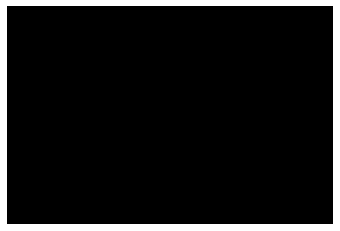

(427, 640, 3)
COCO_val2014_000000134460.jpg
{'person_bbx': [194.79, 42.22, 513.36, 421.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [221.58, 229.92, 355.88, 339.69]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [194.79, 42.22, 513.36, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [221.58, 229.92, 355.88, 339.69]}}
person
banana
hold
hold interaction
{'person_bbx': [194.79, 42.22, 513.36, 421.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [194.79, 42.22, 513.36, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000573750.jpg
{'person_bbx': [233.2, 173.09, 374.69, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [259.45, 220.52, 323.21999999999997, 301.28000000000003]}}
backpack
person
carry
carry interaction
{'person_bbx': [548.84, 168.52, 640.0, 430.27], 'Verbs': 'carry', 'object': {'obj_bbx': [634.21, 206.38, 640.0, 237.53]}}
backpack
person
carry
carry interaction
{'person_bbx': [374.05, 122.16, 526.49, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [163.96, 201.71, 588.94, 444.4]}}
person
snowboard
hold
hold interaction
{'person_bbx': [233.2, 173.09, 374.69, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [548.84, 168.52, 640.0, 430.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [374.05, 122.16, 526.49, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [233.2, 173.09, 374.69, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [374.05, 122.16

(480, 640, 3)
COCO_val2014_000000492677.jpg
{'person_bbx': [124.81, 124.81, 287.35, 626.94], 'Verbs': 'hold', 'object': {'obj_bbx': [219.87, 180.28, 227.81, 192.67000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [124.81, 124.81, 287.35, 626.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [124.81, 124.81, 287.35, 626.94], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [219.87, 180.28, 227.81, 192.67000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000358019.jpg
{'person_bbx': [145.99, 56.43, 503.04, 529.55], 'Verbs': 'hold', 'object': {'obj_bbx': [321.12, 462.96, 447.87, 524.53]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [145.99, 56.43, 503.04, 529.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [145.99, 56.43, 503.04, 529.55], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(536, 640, 3)
COCO_val2014_000000278203.jpg
{'person_bbx': [184.71, 78.52, 324.20000000000005, 399.37], 'Verbs': 'hold', 'object': {'obj_bbx': [189.8, 227.94, 322.28, 397.22]}}
bicycle
person
hold
hold interaction
{'person_bbx': [184.71, 78.52, 324.20000000000005, 399.37], 'Verbs': 'ride', 'object': {'obj_bbx': [189.8, 227.94, 322.28, 397.22]}}
bicycle
person
ride
ride interaction


(640, 383, 3)
COCO_val2014_000000263052.jpg
{'person_bbx': [114.34, 142.38, 295.55, 286.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [76.93, 212.1, 639.28, 336.7]}}
surfboard
person
look
look interaction
{'person_bbx': [114.34, 142.38, 295.55, 286.91999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [76.93, 212.1, 639.28, 336.7]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000499242.jpg
{'person_bbx': [207.25, 120.18, 384.89, 380.91], 'Verbs': 'hold', 'object': {'obj_bbx': [359.62, 363.14, 404.04, 377.15999999999997]}}
person
mouse
hold
hold interaction
{'person_bbx': [85.96, 7.64, 230.76999999999998, 412.58], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [207.25, 120.18, 384.89, 380.91], 'Verbs': 'look', 'object': {'obj_bbx': [491.71, 232.62, 553.42, 358.75]}}
tv
person
look
look interaction
{'person_bbx': [85.96, 7.64, 230.76999999999998, 412.58], 'Verbs': 'look', 'object': {'obj_bbx': [491.71, 232.62, 553.42, 358.75]}}
tv
person
look
look interaction
{'person_bbx': [207.25, 120.18, 384.89, 380.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [85.96, 7.64, 230.76999999999998, 412.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [207.25, 120.18, 384.89, 380.91], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [383.93, 278.88, 512.87, 377.2

(425, 640, 3)
COCO_val2014_000000352729.jpg
{'person_bbx': [293.06, 96.45, 433.51, 302.54], 'Verbs': 'look', 'object': {'obj_bbx': [405.57, 257.8, 478.91999999999996, 324.67]}}
person
surfboard
look
look interaction
{'person_bbx': [293.06, 96.45, 433.51, 302.54], 'Verbs': 'surf', 'object': {'obj_bbx': [405.57, 257.8, 478.91999999999996, 324.67]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000560646.jpg
{'person_bbx': [389.81, 151.14, 439.37, 284.86], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [389.81, 151.14, 439.37, 284.86], 'Verbs': 'look', 'object': {'obj_bbx': [247.5, 270.77, 538.36, 289.0]}}
person
surfboard
look
look interaction
{'person_bbx': [389.81, 151.14, 439.37, 284.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [389.81, 151.14, 439.37, 284.86], 'Verbs': 'surf', 'object': {'obj_bbx': [247.5, 270.77, 538.36, 289.0]}}
person
surfboard
surf
surf interaction


(381, 640, 3)
COCO_val2014_000000484978.jpg
{'person_bbx': [87.17, 65.1, 322.18, 312.25], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [246.53, 194.14, 301.13, 213.14999999999998]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [87.17, 65.1, 322.18, 312.25], 'Verbs': 'hold', 'object': {'obj_bbx': [246.53, 194.14, 301.13, 213.14999999999998]}}
person
spoon
hold
hold interaction
{'person_bbx': [87.17, 65.1, 322.18, 312.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(491, 640, 3)
COCO_val2014_000000240275.jpg
{'person_bbx': [288.72, 126.85, 417.63, 262.11], 'Verbs': 'look', 'object': {'obj_bbx': [289.77, 248.69, 347.59999999999997, 274.03]}}
person
surfboard
look
look interaction
{'person_bbx': [288.72, 126.85, 417.63, 262.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [288.72, 126.85, 417.63, 262.11], 'Verbs': 'surf', 'object': {'obj_bbx': [289.77, 248.69, 347.59999999999997, 274.03]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000308759.jpg
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [247.93, 85.42, 323.55, 154.01]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [228.79, 138.62, 250.7, 157.48000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [247.93, 85.42, 323.55, 154.01]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [228.79, 138.62, 250.7, 157.48000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [145.87, 4.2, 296.99, 458.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
p

(467, 640, 3)
COCO_val2014_000000334941.jpg
{'person_bbx': [110.91, 135.31, 312.01, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [109.32, 332.33, 149.06, 348.46]}}
cell phone
person
hold
hold interaction
{'person_bbx': [110.91, 135.31, 312.01, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [109.32, 332.33, 149.06, 348.46]}}
cell phone
person
look
look interaction
{'person_bbx': [110.91, 135.31, 312.01, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [110.91, 135.31, 312.01, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 359, 3)
COCO_val2014_000000481670.jpg
{'person_bbx': [257.28, 177.98, 323.4, 306.96], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [178.24, 199.06, 244.58, 326.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [257.28, 177.98, 323.4, 306.96], 'Verbs': 'ski', 'object': {'obj_bbx': [236.76, 300.06, 346.2, 309.39]}}
person
skis
ski
ski interaction
{'person_bbx': [178.24, 199.06, 244.58, 326.38], 'Verbs': 'ski', 'object': {'obj_bbx': [183.34, 311.2, 242.71, 326.34]}}
person
skis
ski
ski interaction
{'person_bbx': [257.28, 177.98, 323.4, 306.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [178.24, 199.06, 244.58, 326.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000249836.jpg
{'person_bbx': [38.6, 2.77, 129.82, 183.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.4, 25.21, 448.18, 183.0], 'Verbs': 'hold', 'object': {'obj_bbx': [186.27, 128.64, 230.57, 145.94]}}
person
frisbee
hold
hold interaction
{'person_bbx': [38.6, 2.77, 129.82, 183.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [224.4, 25.21, 448.18, 183.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [482.43, 24.69, 631.91, 183.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [224.4, 25.21, 448.18, 183.0], 'Verbs': 'throw', 'object': {'obj_bbx': [186.27, 128.64, 230.57, 145.94]}}
person
frisbee
throw
throw interaction


(183, 640, 3)
COCO_val2014_000000579081.jpg
{'person_bbx': [150.68, 170.28, 212.31, 276.81], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [195.02, 158.72, 264.72, 288.7], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [226.64, 159.52, 290.56, 267.96000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [122.94, 179.75, 196.54, 292.51], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [150.68, 170.28, 212.31, 276.81], 'Verbs': 'sit', 'object': {'obj_bbx': [113.42, 197.75, 224.46, 264.73]}}
person
bench
sit
sit interaction
{'person_bbx': [195.02, 158.72, 264.72, 288.7], 'Verbs': 'sit', 'object': {'obj_bbx': [113.42, 197.75, 224.46, 264.73]}}
person
bench
sit
sit interaction
{'person_bbx': [226.64, 159.52, 290.56, 267.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [113.42, 197.75, 224.46, 264.73]}}
person
bench
sit
sit interaction
{'person_bbx': [122.94, 179.75, 196.54, 292.51], 

(384, 640, 3)
COCO_val2014_000000192200.jpg
{'person_bbx': [282.07, 186.44, 325.78999999999996, 253.14], 'Verbs': 'kick', 'object': {'obj_bbx': [265.96, 254.3, 281.46, 269.8]}}
sports ball
person
kick
kick interaction
{'person_bbx': [367.59, 182.19, 418.07, 260.06], 'Verbs': 'kick', 'object': {'obj_bbx': [265.96, 254.3, 281.46, 269.8]}}
sports ball
person
kick
kick interaction
{'person_bbx': [282.07, 186.44, 325.78999999999996, 253.14], 'Verbs': 'look', 'object': {'obj_bbx': [265.96, 254.3, 281.46, 269.8]}}
sports ball
person
look
look interaction
{'person_bbx': [367.59, 182.19, 418.07, 260.06], 'Verbs': 'look', 'object': {'obj_bbx': [265.96, 254.3, 281.46, 269.8]}}
sports ball
person
look
look interaction
{'person_bbx': [282.07, 186.44, 325.78999999999996, 253.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [367.59, 182.19, 418.07, 260.06], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [282.07, 186.44, 325.78999999999996, 253.14], 'Verb

(478, 640, 3)
COCO_val2014_000000238691.jpg
{'person_bbx': [227.6, 190.92, 372.13, 382.91999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [7.55, 77.48, 155.33, 329.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000114352.jpg
{'person_bbx': [63.57, 235.12, 307.72, 632.4200000000001], 'Verbs': 'catch', 'object': {'obj_bbx': [234.48, 324.39, 332.75, 415.66999999999996]}}
person
frisbee
catch
catch interaction
{'person_bbx': [63.57, 235.12, 307.72, 632.4200000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [234.48, 324.39, 332.75, 415.66999999999996]}}
person
frisbee
hold
hold interaction
{'person_bbx': [63.57, 235.12, 307.72, 632.4200000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [63.57, 235.12, 307.72, 632.4200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000035671.jpg
{'person_bbx': [247.8, 344.0, 304.32, 415.22], 'Verbs': 'hold', 'object': {'obj_bbx': [96.52, 396.03, 227.52999999999997, 485.08]}}
cow
person
hold
hold interaction
{'person_bbx': [316.07, 329.58, 363.15999999999997, 394.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [64.64, 282.64, 105.46000000000001, 361.62], 'Verbs': 'look', 'object': {'obj_bbx': [14.74, 279.74, 60.35, 368.29]}}
person
person
look
look interaction
{'person_bbx': [14.74, 279.74, 60.35, 368.29], 'Verbs': 'look', 'object': {'obj_bbx': [96.52, 396.03, 227.52999999999997, 485.08]}}
cow
person
look
look interaction
{'person_bbx': [247.8, 344.0, 304.32, 415.22], 'Verbs': 'look', 'object': {'obj_bbx': [96.52, 396.03, 227.52999999999997, 485.08]}}
cow
person
look
look interaction
{'person_bbx': [340.49, 329.37, 387.84000000000003, 422.33], 'Verbs': 'ride', 'object': {'obj_bbx': [341.08, 371.47, 389.64, 456.40000000000003]}}
horse
person
ride
ride intera

(640, 427, 3)
COCO_val2014_000000278290.jpg
{'person_bbx': [154.24, 3.46, 359.9, 317.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.98, 77.62, 220.48999999999998, 402.91], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [154.24, 3.46, 359.9, 317.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.98, 77.62, 220.48999999999998, 402.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(439, 360, 3)
COCO_val2014_000000357279.jpg
{'person_bbx': [167.46, 16.18, 457.08000000000004, 290.43], 'Verbs': 'jump', 'object': {'obj_bbx': [176.36, 251.6, 487.01, 299.33]}}
person
snowboard
jump
jump interaction
{'person_bbx': [167.46, 16.18, 457.08000000000004, 290.43], 'Verbs': 'snowboard', 'object': {'obj_bbx': [176.36, 251.6, 487.01, 299.33]}}
person
snowboard
snowboard
snowboard interaction


(360, 640, 3)
COCO_val2014_000000349754.jpg
{'person_bbx': [248.43, 71.68, 426.27, 218.96], 'Verbs': 'look', 'object': {'obj_bbx': [211.1, 152.57, 310.89, 247.56]}}
person
surfboard
look
look interaction
{'person_bbx': [248.43, 71.68, 426.27, 218.96], 'Verbs': 'surf', 'object': {'obj_bbx': [211.1, 152.57, 310.89, 247.56]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000250137.jpg
{'person_bbx': [153.29, 184.98, 416.92999999999995, 511.63], 'Verbs': 'carry', 'object': {'obj_bbx': [145.59, 312.07, 432.42999999999995, 633.51]}}
handbag
person
carry
carry interaction
{'person_bbx': [0.0, 192.28, 158.89, 640.0], 'Verbs': 'drink', 'object': {'obj_bbx': [73.15, 306.11, 99.19, 342.73]}}
cup
person
drink
drink interaction
{'person_bbx': [153.29, 184.98, 416.92999999999995, 511.63], 'Verbs': 'hold', 'object': {'obj_bbx': [2.88, 7.55, 431.46, 151.37]}}
umbrella
person
hold
hold interaction
{'person_bbx': [0.0, 192.28, 158.89, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [73.15, 306.11, 99.19, 342.73]}}
cup
person
hold
hold interaction
{'person_bbx': [153.29, 184.98, 416.92999999999995, 511.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.29, 184.98, 416.92999999999995, 511.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 192.28, 158.89, 640.0], 'Verbs': 'stan

(640, 480, 3)
COCO_val2014_000000134760.jpg
{'person_bbx': [305.76, 283.54, 334.33, 372.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [271.4, 58.19, 305.28999999999996, 122.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [303.85, 48.64, 350.28000000000003, 129.26], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [305.76, 283.54, 334.33, 372.24], 'Verbs': 'ski', 'object': {'obj_bbx': [285.47, 368.0, 369.79, 375.62]}}
person
skis
ski
ski interaction
{'person_bbx': [305.76, 283.54, 334.33, 372.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(484, 640, 3)
COCO_val2014_000000561337.jpg
{'person_bbx': [387.94, 108.05, 473.47, 272.05], 'Verbs': 'surf', 'object': {'obj_bbx': [394.58, 262.57, 483.91999999999996, 282.82]}}
person
surfboard
surf
surf interaction


(436, 640, 3)
COCO_val2014_000000156846.jpg
{'person_bbx': [329.67, 261.95, 515.82, 479.27], 'Verbs': 'look', 'object': {'obj_bbx': [274.91, 326.94, 350.43, 397.87]}}
laptop
person
look
look interaction
{'person_bbx': [14.02, 253.48, 160.72, 464.9], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [153.17, 298.41, 305.0, 479.67], 'Verbs': 'look', 'object': {'obj_bbx': [154.41, 257.73, 262.27, 385.48]}}
person
person
look
look interaction
{'person_bbx': [329.67, 261.95, 515.82, 479.27], 'Verbs': 'sit', 'object': {'obj_bbx': [379.49, 401.06, 527.38, 480.0]}}
person
chair
sit
sit interaction
{'person_bbx': [14.02, 253.48, 160.72, 464.9], 'Verbs': 'sit', 'object': {'obj_bbx': [36.73, 409.77, 134.95, 479.78]}}
person
chair
sit
sit interaction
{'person_bbx': [153.17, 298.41, 305.0, 479.67], 'Verbs': 'sit', 'object': {'obj_bbx': [133.51, 447.08, 239.04, 479.38]}}
person
chair
sit
sit interaction
{'person_bbx': [14.02, 253.48, 160.72, 464.9], 'Verbs': 'smile', 'object': {

(480, 640, 3)
COCO_val2014_000000232760.jpg
{'person_bbx': [165.51, 211.46, 219.64999999999998, 424.6], 'Verbs': 'carry', 'object': {'obj_bbx': [92.76, 271.82, 280.45, 328.99]}}
person
surfboard
carry
carry interaction
{'person_bbx': [165.51, 211.46, 219.64999999999998, 424.6], 'Verbs': 'hold', 'object': {'obj_bbx': [92.76, 271.82, 280.45, 328.99]}}
person
surfboard
hold
hold interaction
{'person_bbx': [165.51, 211.46, 219.64999999999998, 424.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [165.51, 211.46, 219.64999999999998, 424.6], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000191226.jpg
{'person_bbx': [280.82, 75.49, 457.77, 350.54], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [280.82, 75.49, 457.77, 350.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [280.82, 75.49, 457.77, 350.54], 'Verbs': 'surf', 'object': {'obj_bbx': [391.64, 306.5, 488.0, 371.22]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000406810.jpg
{'person_bbx': [373.79, 55.87, 638.8900000000001, 445.91], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [373.79, 55.87, 638.8900000000001, 445.91], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [343.92, 143.89, 559.14, 372.19]}}
person
laptop
work_on_computer
work_on_computer interaction


(452, 640, 3)
COCO_val2014_000000536000.jpg
{'person_bbx': [312.55, 27.96, 499.65, 315.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [319.74, 47.56, 366.38, 113.15]}}
person
remote
hold
hold interaction
{'person_bbx': [0.72, 23.66, 161.29, 281.72], 'Verbs': 'hold', 'object': {'obj_bbx': [76.03, 60.3, 107.47, 74.72]}}
person
remote
hold
hold interaction
{'person_bbx': [194.27, 88.89, 336.20000000000005, 314.7], 'Verbs': 'hold', 'object': {'obj_bbx': [253.02, 155.33, 279.1, 173.53]}}
person
remote
hold
hold interaction
{'person_bbx': [312.55, 27.96, 499.65, 315.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [4.31, 164.89, 433.95, 315.77]}}
person
couch
sit
sit interaction
{'person_bbx': [0.72, 23.66, 161.29, 281.72], 'Verbs': 'sit', 'object': {'obj_bbx': [4.31, 164.89, 433.95, 315.77]}}
person
couch
sit
sit interaction
{'person_bbx': [194.27, 88.89, 336.20000000000005, 314.7], 'Verbs': 'sit', 'object': {'obj_bbx': [4.31, 164.89, 433.95, 315.77]}}
person
couch
sit
sit in

(319, 500, 3)
COCO_val2014_000000400525.jpg
{'person_bbx': [400.79, 297.44, 640.0, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(480, 640, 3)
COCO_val2014_000000488756.jpg
{'person_bbx': [120.81, 106.61, 199.51999999999998, 233.20999999999998], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [298.42, 94.73, 376.16, 231.59000000000003], 'Verbs': 'catch', 'object': {'obj_bbx': [287.86, 74.24, 311.16, 97.22999999999999]}}
person
frisbee
catch
catch interaction
{'person_bbx': [298.42, 94.73, 376.16, 231.59000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [120.81, 106.61, 199.51999999999998, 233.20999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [17.15, 15.43, 41.48, 38.35]}}
person
frisbee
look
look interaction
{'person_bbx': [298.42, 94.73, 376.16, 231.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [287.86, 74.24, 311.16, 97.22999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [569.96, 153.91, 638.6600000000001, 236.84], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [120.81, 106.61, 199.519999999999

(331, 640, 3)
COCO_val2014_000000565248.jpg
{'person_bbx': [0.0, 128.83, 160.64, 476.15999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [73.59, 392.83, 393.86, 481.96]}}
horse
person
ride
ride interaction
{'person_bbx': [175.44, 165.82, 335.72, 401.9], 'Verbs': 'ride', 'object': {'obj_bbx': [127.03, 328.95, 505.86, 483.0]}}
person
horse
ride
ride interaction
{'person_bbx': [0.0, 128.83, 160.64, 476.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [73.59, 392.83, 393.86, 481.96]}}
horse
person
sit
sit interaction
{'person_bbx': [175.44, 165.82, 335.72, 401.9], 'Verbs': 'sit', 'object': {'obj_bbx': [127.03, 328.95, 505.86, 483.0]}}
person
horse
sit
sit interaction
{'person_bbx': [0.0, 128.83, 160.64, 476.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [175.44, 165.82, 335.72, 401.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(483, 640, 3)
COCO_val2014_000000194754.jpg
{'person_bbx': [1.44, 369.73, 61.98, 496.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000205671.jpg
{'person_bbx': [154.13, 131.95, 319.74, 245.87], 'Verbs': 'jump', 'object': {'obj_bbx': [94.23, 143.16, 369.93, 291.06]}}
person
surfboard
jump
jump interaction
{'person_bbx': [154.13, 131.95, 319.74, 245.87], 'Verbs': 'look', 'object': {'obj_bbx': [94.23, 143.16, 369.93, 291.06]}}
person
surfboard
look
look interaction
{'person_bbx': [154.13, 131.95, 319.74, 245.87], 'Verbs': 'surf', 'object': {'obj_bbx': [94.23, 143.16, 369.93, 291.06]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000497281.jpg
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [251.1, 65.57, 283.49, 106.46]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [291.9, 53.58, 298.23999999999995, 59.78]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'look', 'object': {'obj_bbx': [291.9, 53.58, 298.23999999999995, 59.78]}}
sports ball
person
look
look interaction
{'person_bbx': [218.41, 92.85, 299.32, 273.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(359, 640, 3)
COCO_val2014_000000143024.jpg
{'person_bbx': [1.92, 12.31, 142.01, 284.83], 'Verbs': 'look', 'object': {'obj_bbx': [2.89, 71.81, 256.39, 399.53000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [76.53, 56.56, 204.07, 240.67000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [291.74, 148.15, 393.6, 239.99]}}
laptop
person
look
look interaction
{'person_bbx': [443.12, 219.26, 577.15, 397.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.92, 12.31, 142.01, 284.83], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [76.53, 56.56, 204.07, 240.67000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.92, 12.31, 142.01, 284.83], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [2.89, 71.81, 256.39, 399.53000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [76.53, 56.56, 204.07, 240.67000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_

(427, 640, 3)
COCO_val2014_000000118106.jpg
{'person_bbx': [346.44, 74.66, 445.0, 328.52], 'Verbs': 'look', 'object': {'obj_bbx': [235.98, 59.5, 261.39, 79.05]}}
frisbee
person
look
look interaction
{'person_bbx': [346.44, 74.66, 445.0, 328.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [346.44, 74.66, 445.0, 328.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000570471.jpg
{'person_bbx': [48.31, 0.0, 375.0, 494.38], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [0.08, 328.81, 62.19, 388.48]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [48.31, 0.0, 375.0, 494.38], 'Verbs': 'hold', 'object': {'obj_bbx': [0.08, 328.81, 62.19, 388.48]}}
person
cake
hold
hold interaction
{'person_bbx': [48.31, 0.0, 375.0, 494.38], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 370.79, 101.12, 448.31]}}
person
cake
look
look interaction


(500, 375, 3)
COCO_val2014_000000497365.jpg
{'person_bbx': [0.0, 112.18, 394.79, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [279.97, 332.17, 387.85, 401.23]}}
person
cake
hold
hold interaction
{'person_bbx': [289.05, 144.2, 500.57000000000005, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 112.18, 394.79, 474.61]}}
person
person
look
look interaction
{'person_bbx': [0.0, 112.18, 394.79, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [289.05, 144.2, 500.57000000000005, 480.0], 'Verbs': 'point', 'object': {'obj_bbx': [0.0, 112.18, 394.79, 474.61]}}
person
person
point
point interaction
{'person_bbx': [289.05, 144.2, 500.57000000000005, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [289.05, 144.2, 500.57000000000005, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000056091.jpg
{'person_bbx': [280.29, 177.79, 349.81, 366.47], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [236.81, 270.45, 292.04, 319.94]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [280.29, 177.79, 349.81, 366.47], 'Verbs': 'hold', 'object': {'obj_bbx': [236.81, 270.45, 292.04, 319.94]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [280.29, 177.79, 349.81, 366.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [280.29, 177.79, 349.81, 366.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000281679.jpg
{'person_bbx': [352.08, 163.17, 514.54, 341.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [26.16, 159.77, 221.44, 384.02], 'Verbs': 'sit', 'object': {'obj_bbx': [182.54, 251.22, 238.12, 298.46]}}
person
dining table
sit
sit interaction
{'person_bbx': [352.08, 163.17, 514.54, 341.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [26.16, 159.77, 221.44, 384.02], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000301991.jpg
{'person_bbx': [254.27, 136.88, 475.3, 578.96], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [165.88, 433.55, 218.15, 473.06]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [254.27, 136.88, 475.3, 578.96], 'Verbs': 'sit', 'object': {'obj_bbx': [437.83, 291.14, 552.93, 377.65]}}
chair
person
sit
sit interaction
{'person_bbx': [311.35, 85.77, 640.0, 633.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [254.27, 136.88, 475.3, 578.96], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 640, 3)
COCO_val2014_000000078803.jpg
{'person_bbx': [152.45, 139.51, 350.91999999999996, 596.8499999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [71.35, 45.36, 355.05999999999995, 180.10000000000002]}}
umbrella
person
carry
carry interaction
{'person_bbx': [152.45, 139.51, 350.91999999999996, 596.8499999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [71.35, 45.36, 355.05999999999995, 180.10000000000002]}}
umbrella
person
hold
hold interaction
{'person_bbx': [152.45, 139.51, 350.91999999999996, 596.8499999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [152.45, 139.51, 350.91999999999996, 596.8499999999999], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 425, 3)
COCO_val2014_000000351875.jpg
{'person_bbx': [0.0, 168.12, 278.01, 427.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [255.88, 162.21, 447.7, 426.20000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [209.31, 253.1, 524.6600000000001, 425.77]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [0.0, 168.12, 278.01, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [255.88, 162.21, 447.7, 426.20000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [209.31, 253.1, 524.6600000000001, 425.77]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000383046.jpg
{'person_bbx': [232.4, 128.43, 416.99, 387.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [288.77, 377.31, 320.75, 390.19]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [232.4, 128.43, 416.99, 387.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000058754.jpg
{'person_bbx': [318.58, 124.28, 365.88, 209.05], 'Verbs': 'jump', 'object': {'obj_bbx': [311.38, 189.88, 365.03, 220.89]}}
skis
person
jump
jump interaction
{'person_bbx': [318.58, 124.28, 365.88, 209.05], 'Verbs': 'look', 'object': {'obj_bbx': [311.38, 189.88, 365.03, 220.89]}}
skis
person
look
look interaction
{'person_bbx': [318.58, 124.28, 365.88, 209.05], 'Verbs': 'ski', 'object': {'obj_bbx': [311.38, 189.88, 365.03, 220.89]}}
skis
person
ski
ski interaction
{'person_bbx': [318.58, 124.28, 365.88, 209.05], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [318.58, 124.28, 365.88, 209.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000219487.jpg
{'person_bbx': [434.66, 2.03, 640.0, 421.36999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [56.05, 119.32, 123.36999999999999, 133.78]}}
person
frisbee
look
look interaction
{'person_bbx': [327.11, 11.36, 437.69, 412.55], 'Verbs': 'look', 'object': {'obj_bbx': [56.05, 119.32, 123.36999999999999, 133.78]}}
person
frisbee
look
look interaction
{'person_bbx': [161.23, 24.6, 329.6, 406.25], 'Verbs': 'look', 'object': {'obj_bbx': [56.05, 119.32, 123.36999999999999, 133.78]}}
person
frisbee
look
look interaction
{'person_bbx': [434.66, 2.03, 640.0, 421.36999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [327.11, 11.36, 437.69, 412.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.23, 24.6, 329.6, 406.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.23, 24.6, 329.6, 406.25], 'Verbs': 'throw', 'object': {'obj_bbx': [56.05, 119.32, 123.369999

(427, 640, 3)
COCO_val2014_000000378614.jpg


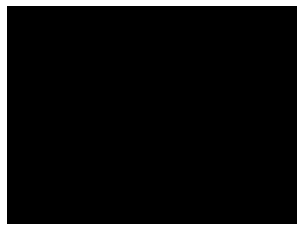

(480, 640, 3)
COCO_val2014_000000293554.jpg
{'person_bbx': [102.47, 17.08, 267.51, 400.0], 'Verbs': 'look', 'object': {'obj_bbx': [346.46, 247.01, 430.86, 371.62]}}
dog
person
look
look interaction
{'person_bbx': [102.47, 17.08, 267.51, 400.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [102.47, 17.08, 267.51, 400.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000255483.jpg
{'person_bbx': [4.88, 213.47, 434.99, 424.39], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [169.66, 269.48, 286.52, 300.94]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [4.88, 213.47, 434.99, 424.39], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [18.18, 123.38, 235.06, 407.79]}}
person
book
cut_obj
cut_obj interaction
{'person_bbx': [4.88, 213.47, 434.99, 424.39], 'Verbs': 'hold', 'object': {'obj_bbx': [169.66, 269.48, 286.52, 300.94]}}
person
scissors
hold
hold interaction
{'person_bbx': [4.88, 213.47, 434.99, 424.39], 'Verbs': 'read', 'object': {'obj_bbx': [18.18, 123.38, 235.06, 407.79]}}
person
book
read
read interaction


(500, 452, 3)
COCO_val2014_000000067532.jpg
{'person_bbx': [121.49, 4.74, 456.58, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [230.36, 223.74, 411.29, 336.71000000000004]}}
dog
person
look
look interaction
{'person_bbx': [121.49, 4.74, 456.58, 428.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(436, 500, 3)
COCO_val2014_000000376545.jpg
{'person_bbx': [161.22, 40.83, 292.09000000000003, 275.34], 'Verbs': 'jump', 'object': {'obj_bbx': [157.64, 239.47, 238.06, 326.33]}}
skateboard
person
jump
jump interaction
{'person_bbx': [435.49, 66.76, 577.14, 408.45], 'Verbs': 'look', 'object': {'obj_bbx': [348.62, 313.63, 457.65, 403.81]}}
person
skateboard
look
look interaction
{'person_bbx': [161.22, 40.83, 292.09000000000003, 275.34], 'Verbs': 'look', 'object': {'obj_bbx': [157.64, 239.47, 238.06, 326.33]}}
skateboard
person
look
look interaction
{'person_bbx': [435.49, 66.76, 577.14, 408.45], 'Verbs': 'skateboard', 'object': {'obj_bbx': [348.62, 313.63, 457.65, 403.81]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [161.22, 40.83, 292.09000000000003, 275.34], 'Verbs': 'skateboard', 'object': {'obj_bbx': [157.64, 239.47, 238.06, 326.33]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [435.49, 66.76, 577.14, 408.45], 'Verbs': 'stand', 'object'

(424, 640, 3)
COCO_val2014_000000196074.jpg
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [265.77, 320.64, 342.53, 365.78]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [149.89, 355.97, 275.36, 384.42]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [149.89, 355.97, 275.36, 384.42]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [265.77, 320.64, 342.53, 365.78]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'hold', 'object': {'obj_bbx': [265.77, 320.64, 342.53, 365.78]}}
person
knife
hold
hold interaction
{'person_bbx': [225.37, 0.81, 640.0, 469.98], 'Verbs': 'look', 'object': {'obj_bbx': [134.9, 347.27, 331.01, 454.09999999999997]}}
pers

(480, 640, 3)
COCO_val2014_000000238488.jpg
{'person_bbx': [0.0, 59.32, 273.2, 377.42], 'Verbs': 'look', 'object': {'obj_bbx': [183.27, 209.98, 328.17, 292.5]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 59.32, 273.2, 377.42], 'Verbs': 'sit', 'object': {'obj_bbx': [0.92, 275.48, 225.89999999999998, 422.41]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 59.32, 273.2, 377.42], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [183.27, 209.98, 328.17, 292.5]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000116061.jpg
{'person_bbx': [203.17, 97.38, 273.15, 295.99], 'Verbs': 'hold', 'object': {'obj_bbx': [227.21, 149.33, 326.9, 300.02]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [278.57, 80.98, 341.15999999999997, 224.13], 'Verbs': 'hold', 'object': {'obj_bbx': [300.84, 114.61, 389.33, 244.38]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [397.75, 83.43, 450.84000000000003, 208.15], 'Verbs': 'hold', 'object': {'obj_bbx': [355.77, 129.35, 500.0, 233.91]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [397.75, 83.43, 450.84000000000003, 208.15], 'Verbs': 'look', 'object': {'obj_bbx': [213.81, 192.39, 267.75, 262.66999999999996]}}
dog
person
look
look interaction
{'person_bbx': [203.17, 97.38, 273.15, 295.99], 'Verbs': 'ride', 'object': {'obj_bbx': [227.21, 149.33, 326.9, 300.02]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [278.57, 80.98, 341.15999999999997, 224.13], 'Verbs': 'ride', 'object': {'obj_bbx': [300.84, 

(375, 500, 3)
COCO_val2014_000000489407.jpg
{'person_bbx': [3.01, 52.64, 271.71999999999997, 363.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [257.32, 244.87, 287.4, 264.28000000000003]}}
cell phone
person
hold
hold interaction
{'person_bbx': [3.01, 52.64, 271.71999999999997, 363.46999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.01, 52.64, 271.71999999999997, 363.46999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [215.73, 182.02, 401.12, 337.08000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000301305.jpg
{'person_bbx': [421.75, 1.08, 640.0, 365.65999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [411.75, 337.08, 540.31, 352.90999999999997]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [421.75, 1.08, 640.0, 365.65999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [322.62, 320.6, 509.23, 406.03000000000003]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [421.75, 1.08, 640.0, 365.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [411.75, 337.08, 540.31, 352.90999999999997]}}
knife
person
hold
hold interaction
{'person_bbx': [14.96, 84.78, 248.1, 320.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [14.96, 84.78, 248.1, 320.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [421.75, 1.08, 640.0, 365.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000463542.jpg
{'person_bbx': [100.93, 132.12, 160.09, 236.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [294.48, 160.94, 341.23, 255.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [500.19, 159.68, 550.19, 253.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [500.19, 159.68, 550.19, 253.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [100.93, 132.12, 160.09, 236.05], 'Verbs': 'ski', 'object': {'obj_bbx': [91.39, 227.16, 168.48000000000002, 239.66]}}
skis
person
ski
ski interaction
{'person_bbx': [294.48, 160.94, 341.23, 255.1], 'Verbs': 'ski', 'object': {'obj_bbx': [293.73, 246.18, 344.93, 254.92000000000002]}}
skis
person
ski
ski interaction
{'person_bbx': [500.19, 159.68, 550.19, 253.02], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [100.93, 132.12, 160.09, 236.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
sta

(426, 640, 3)
COCO_val2014_000000166255.jpg
{'person_bbx': [203.9, 86.56, 458.78, 423.19], 'Verbs': 'ride', 'object': {'obj_bbx': [83.58, 326.05, 531.79, 423.41]}}
horse
person
ride
ride interaction
{'person_bbx': [203.9, 86.56, 458.78, 423.19], 'Verbs': 'sit', 'object': {'obj_bbx': [83.58, 326.05, 531.79, 423.41]}}
horse
person
sit
sit interaction
{'person_bbx': [203.9, 86.56, 458.78, 423.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000375521.jpg
{'person_bbx': [227.24, 92.04, 396.94, 536.45], 'Verbs': 'hold', 'object': {'obj_bbx': [184.85, 176.46, 287.24, 521.25]}}
person
snowboard
hold
hold interaction
{'person_bbx': [227.24, 92.04, 396.94, 536.45], 'Verbs': 'look', 'object': {'obj_bbx': [184.85, 176.46, 287.24, 521.25]}}
person
snowboard
look
look interaction
{'person_bbx': [102.34, 81.44, 246.49, 549.9100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [184.85, 176.46, 287.24, 521.25]}}
person
snowboard
look
look interaction
{'person_bbx': [227.24, 92.04, 396.94, 536.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [102.34, 81.44, 246.49, 549.9100000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000498733.jpg
{'person_bbx': [61.48, 142.38, 310.65, 416.36], 'Verbs': 'look', 'object': {'obj_bbx': [462.73, 115.25, 512.7, 135.71]}}
person
frisbee
look
look interaction
{'person_bbx': [61.48, 142.38, 310.65, 416.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [61.48, 142.38, 310.65, 416.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [61.48, 142.38, 310.65, 416.36], 'Verbs': 'throw', 'object': {'obj_bbx': [462.73, 115.25, 512.7, 135.71]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000047511.jpg
{'person_bbx': [17.26, 148.85, 418.52, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [367.49, 350.57, 506.99, 409.14]}}
person
book
look
look interaction
{'person_bbx': [17.26, 148.85, 418.52, 474.61], 'Verbs': 'read', 'object': {'obj_bbx': [367.49, 350.57, 506.99, 409.14]}}
person
book
read
read interaction
{'person_bbx': [17.26, 148.85, 418.52, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000401244.jpg
{'person_bbx': [100.16, 59.98, 319.15, 559.08], 'Verbs': 'hold', 'object': {'obj_bbx': [175.2, 240.98, 270.32, 288.53999999999996]}}
person
frisbee
hold
hold interaction
{'person_bbx': [100.16, 59.98, 319.15, 559.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.16, 59.98, 319.15, 559.08], 'Verbs': 'throw', 'object': {'obj_bbx': [175.2, 240.98, 270.32, 288.53999999999996]}}
person
frisbee
throw
throw interaction


(640, 426, 3)
COCO_val2014_000000328668.jpg
{'person_bbx': [177.79, 93.71, 235.26999999999998, 190.16], 'Verbs': 'look', 'object': {'obj_bbx': [317.15, 134.89, 343.06, 144.6]}}
person
frisbee
look
look interaction
{'person_bbx': [311.11, 82.91, 361.35, 179.55], 'Verbs': 'look', 'object': {'obj_bbx': [317.15, 134.89, 343.06, 144.6]}}
person
frisbee
look
look interaction
{'person_bbx': [0.05, 92.58, 35.059999999999995, 264.31], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [177.79, 93.71, 235.26999999999998, 190.16], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [311.11, 82.91, 361.35, 179.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [177.79, 93.71, 235.26999999999998, 190.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.05, 92.58, 35.059999999999995, 264.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(332, 500, 3)
COCO_val2014_000000303342.jpg
{'person_bbx': [57.23, 223.86, 260.35, 378.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [115.73, 352.14, 259.69, 380.76]}}
person
snowboard
snowboard
snowboard interaction


(500, 333, 3)
COCO_val2014_000000209041.jpg
{'person_bbx': [7.85, 39.61, 223.09, 332.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [86.43, 227.96, 358.19, 354.44]}}
person
laptop
look
look interaction
{'person_bbx': [7.85, 39.61, 223.09, 332.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [7.85, 39.61, 223.09, 332.21000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [86.43, 227.96, 358.19, 354.44]}}
person
laptop
work_on_computer
work_on_computer interaction


(500, 375, 3)
COCO_val2014_000000279085.jpg
{'person_bbx': [0.0, 1.91, 223.05, 421.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 1.91, 223.05, 421.21000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [167.53, 186.67, 473.87, 421.21]}}
laptop
person
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000222468.jpg
{'person_bbx': [200.12, 437.58, 292.09000000000003, 499.84999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [67.14, 418.74, 134.98000000000002, 499.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [200.12, 437.58, 292.09000000000003, 499.84999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [67.14, 418.74, 134.98000000000002, 499.8], 'Verbs': 'sit', 'object': {'obj_bbx': [44.96, 473.94, 116.52000000000001, 500.0]}}
chair
person
sit
sit interaction


(500, 335, 3)
COCO_val2014_000000358086.jpg
{'person_bbx': [214.95, 1.94, 314.68, 366.96999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [235.16, 1.92, 277.04, 17.36]}}
frisbee
person
catch
catch interaction
{'person_bbx': [214.95, 1.94, 314.68, 366.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [235.16, 1.92, 277.04, 17.36]}}
frisbee
person
hold
hold interaction
{'person_bbx': [214.95, 1.94, 314.68, 366.96999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [457.71, 65.25, 598.76, 416.44], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [357.11, 111.43, 471.69, 343.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [214.95, 1.94, 314.68, 366.96999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [235.16, 1.92, 277.04, 17.36]}}
frisbee
person
look
look interaction
{'person_bbx': [457.71, 65.25, 598.76, 416.44], 'Verbs': 'look', 'object': {'obj_bbx': [235.16, 1.92, 277.04, 17.36]}}
frisbee
p

(427, 640, 3)
COCO_val2014_000000163929.jpg
{'person_bbx': [240.6, 91.23, 478.21000000000004, 330.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [205.65, 96.07, 318.24, 334.0]}}
person
person
look
look interaction
{'person_bbx': [240.6, 91.23, 478.21000000000004, 330.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [199.3, 268.18, 490.59000000000003, 333.89]}}
person
bench
sit
sit interaction
{'person_bbx': [240.6, 91.23, 478.21000000000004, 330.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(334, 500, 3)
COCO_val2014_000000569526.jpg
{'person_bbx': [417.88, 26.81, 623.6800000000001, 376.02], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [295.47, 186.81, 434.38, 279.0]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [417.88, 26.81, 623.6800000000001, 376.02], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [444.62, 212.17, 467.6, 232.56]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [417.88, 26.81, 623.6800000000001, 376.02], 'Verbs': 'hold', 'object': {'obj_bbx': [295.47, 186.81, 434.38, 279.0]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [7.13, 171.27, 273.84, 363.3], 'Verbs': 'look', 'object': {'obj_bbx': [444.62, 212.17, 467.6, 232.56]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 47.09, 136.12, 343.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [444.62, 212.17, 467.6, 232.56]}}
sports ball
person
look
look interaction
{'person_bbx': [417.88, 26.81, 623.6800000000001, 376.02], 'Verbs': 'look', 'obj

(427, 640, 3)
COCO_val2014_000000270609.jpg
{'person_bbx': [83.64, 0.0, 481.44, 362.78], 'Verbs': 'drink', 'object': {'obj_bbx': [238.82, 67.04, 331.95, 192.13]}}
person
cup
drink
drink interaction
{'person_bbx': [83.64, 0.0, 481.44, 362.78], 'Verbs': 'hold', 'object': {'obj_bbx': [238.82, 67.04, 331.95, 192.13]}}
person
cup
hold
hold interaction
{'person_bbx': [83.64, 0.0, 481.44, 362.78], 'Verbs': 'sit', 'object': {'obj_bbx': [26.8, 217.31, 121.58, 335.06]}}
person
chair
sit
sit interaction


(426, 640, 3)
COCO_val2014_000000165464.jpg
{'person_bbx': [2.25, 0.0, 470.6, 494.24], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [155.37, 200.06, 338.88, 317.14]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [2.25, 0.0, 470.6, 494.24], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [213.91, 275.83, 632.72, 499.87]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [2.25, 0.0, 470.6, 494.24], 'Verbs': 'hold', 'object': {'obj_bbx': [155.37, 200.06, 338.88, 317.14]}}
person
knife
hold
hold interaction
{'person_bbx': [2.25, 0.0, 470.6, 494.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(501, 640, 3)
COCO_val2014_000000325840.jpg
{'person_bbx': [309.43, 89.17, 423.18, 390.89000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [303.07, 355.27, 352.67, 397.78]}}
sports ball
person
kick
kick interaction
{'person_bbx': [84.5, 92.96, 267.18, 394.28999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [303.07, 355.27, 352.67, 397.78]}}
sports ball
person
kick
kick interaction
{'person_bbx': [309.43, 89.17, 423.18, 390.89000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [303.07, 355.27, 352.67, 397.78]}}
sports ball
person
look
look interaction
{'person_bbx': [515.52, 98.1, 627.0899999999999, 379.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [303.07, 355.27, 352.67, 397.78]}}
sports ball
person
look
look interaction
{'person_bbx': [200.87, 90.47, 282.74, 380.39], 'Verbs': 'look', 'object': {'obj_bbx': [303.07, 355.27, 352.67, 397.78]}}
sports ball
person
look
look interaction
{'person_bbx': [84.5, 92.96, 267.18, 394.28999999999996], 'Verbs': 'look', 'object': 

(428, 640, 3)
COCO_val2014_000000292945.jpg
{'person_bbx': [175.17, 311.57, 308.22, 353.69], 'Verbs': 'lay', 'object': {'obj_bbx': [35.34, 323.6, 280.78999999999996, 395.23]}}
person
bench
lay
lay interaction
{'person_bbx': [11.01, 320.4, 140.92999999999998, 394.16999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [35.34, 323.6, 280.78999999999996, 395.23]}}
bench
person
lay
lay interaction


(425, 640, 3)
COCO_val2014_000000521689.jpg
{'person_bbx': [130.01, 81.77, 296.45, 490.24], 'Verbs': 'carry', 'object': {'obj_bbx': [249.59, 309.05, 416.48, 561.13]}}
person
suitcase
carry
carry interaction
{'person_bbx': [130.01, 81.77, 296.45, 490.24], 'Verbs': 'hold', 'object': {'obj_bbx': [249.59, 309.05, 416.48, 561.13]}}
person
suitcase
hold
hold interaction
{'person_bbx': [130.01, 81.77, 296.45, 490.24], 'Verbs': 'look', 'object': {'obj_bbx': [36.03, 172.77, 141.89, 259.73]}}
bicycle
person
look
look interaction
{'person_bbx': [130.01, 81.77, 296.45, 490.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [130.01, 81.77, 296.45, 490.24], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000369208.jpg
{'person_bbx': [2.75, 255.8, 612.0, 601.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 0.2, 612.0, 330.15999999999997]}}
person
bed
sit
sit interaction
{'person_bbx': [2.75, 255.8, 612.0, 601.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [69.96, 0.0, 437.78999999999996, 328.47]}}
person
laptop
work_on_computer
work_on_computer interaction


(612, 612, 3)
COCO_val2014_000000431177.jpg
{'person_bbx': [279.48, 207.47, 335.67, 389.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [335.3, 170.55, 399.70000000000005, 434.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [279.48, 207.47, 335.67, 389.81], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 416, 3)
COCO_val2014_000000157657.jpg
{'person_bbx': [332.07, 108.54, 408.85, 242.90000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [159.07, 197.33, 486.84, 423.99]}}
person
elephant
ride
ride interaction
{'person_bbx': [264.92, 94.73, 329.8, 227.03000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [159.07, 197.33, 486.84, 423.99]}}
elephant
person
ride
ride interaction
{'person_bbx': [332.07, 108.54, 408.85, 242.90000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [159.07, 197.33, 486.84, 423.99]}}
person
elephant
sit
sit interaction
{'person_bbx': [264.92, 94.73, 329.8, 227.03000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [159.07, 197.33, 486.84, 423.99]}}
elephant
person
sit
sit interaction
{'person_bbx': [332.07, 108.54, 408.85, 242.90000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [264.92, 94.73, 329.8, 227.03000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [600.6, 299.82, 640.0, 

(429, 640, 3)
COCO_val2014_000000467696.jpg
{'person_bbx': [91.16, 155.45, 139.13, 316.65], 'Verbs': 'hold', 'object': {'obj_bbx': [69.24, 237.43, 112.67999999999999, 308.85]}}
person
suitcase
hold
hold interaction
{'person_bbx': [140.68, 144.72, 205.54000000000002, 239.06], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [91.16, 155.45, 139.13, 316.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [324.79, 210.25, 372.55, 317.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [140.68, 144.72, 205.54000000000002, 239.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [91.16, 155.45, 139.13, 316.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [91.16, 155.45, 139.13, 316.65], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000089047.jpg
{'person_bbx': [169.25, 158.76, 262.74, 276.37], 'Verbs': 'jump', 'object': {'obj_bbx': [156.65, 201.56, 222.63, 301.65]}}
person
snowboard
jump
jump interaction
{'person_bbx': [169.25, 158.76, 262.74, 276.37], 'Verbs': 'snowboard', 'object': {'obj_bbx': [156.65, 201.56, 222.63, 301.65]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [169.25, 158.76, 262.74, 276.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000443313.jpg
{'person_bbx': [189.5, 167.07, 322.73, 352.81], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [183.22, 225.73, 198.53, 303.78999999999996]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [189.5, 167.07, 322.73, 352.81], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [330.22, 325.11, 340.28000000000003, 335.6]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [189.5, 167.07, 322.73, 352.81], 'Verbs': 'hold', 'object': {'obj_bbx': [183.22, 225.73, 198.53, 303.78999999999996]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [189.5, 167.07, 322.73, 352.81], 'Verbs': 'look', 'object': {'obj_bbx': [330.22, 325.11, 340.28000000000003, 335.6]}}
sports ball
person
look
look interaction
{'person_bbx': [189.5, 167.07, 322.73, 352.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000228300.jpg
{'person_bbx': [3.36, 30.26, 194.98000000000002, 346.27], 'Verbs': 'hold', 'object': {'obj_bbx': [62.48, 205.61, 140.85, 273.62]}}
person
handbag
hold
hold interaction
{'person_bbx': [3.36, 30.26, 194.98000000000002, 346.27], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [110.94, 34.2, 213.47, 351.05], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [189.94, 31.94, 369.8, 345.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [264.5, 43.8, 390.85, 338.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [374.0, 51.99, 495.59000000000003, 340.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [516.36, 61.91, 630.91, 361.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [3.36, 30.26, 194.98000000000002, 346.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [110

(374, 640, 3)
COCO_val2014_000000382855.jpg
{'person_bbx': [74.84, 0.96, 535.43, 374.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [420.88, 59.29, 440.15, 77.28999999999999]}}
cell phone
person
hold
hold interaction
{'person_bbx': [74.84, 0.96, 535.43, 374.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [74.84, 0.96, 535.43, 374.21999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [74.84, 0.96, 535.43, 374.21999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [420.88, 59.29, 440.15, 77.28999999999999]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000079619.jpg
{'person_bbx': [75.31, 40.58, 346.28000000000003, 625.44], 'Verbs': 'sit', 'object': {'obj_bbx': [81.29, 234.77, 356.49, 570.59]}}
chair
person
sit
sit interaction
{'person_bbx': [75.31, 40.58, 346.28000000000003, 625.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 449, 3)
COCO_val2014_000000438989.jpg
{'person_bbx': [414.9, 268.98, 464.77, 394.42], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [414.9, 268.98, 464.77, 394.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [414.9, 268.98, 464.77, 394.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [414.9, 268.98, 464.77, 394.42], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000393271.jpg
{'person_bbx': [346.25, 176.9, 458.43, 426.07], 'Verbs': 'snowboard', 'object': {'obj_bbx': [323.97, 370.29, 471.33000000000004, 452.64]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [346.25, 176.9, 458.43, 426.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000466838.jpg
{'person_bbx': [18.34, 23.8, 364.58, 350.63], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [195.37, 143.22, 312.23, 186.69]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [18.34, 23.8, 364.58, 350.63], 'Verbs': 'hold', 'object': {'obj_bbx': [195.37, 143.22, 312.23, 186.69]}}
person
pizza
hold
hold interaction
{'person_bbx': [18.34, 23.8, 364.58, 350.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [361.61, 105.47, 640.0, 372.38], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [361.61, 105.47, 640.0, 372.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000390689.jpg
{'person_bbx': [216.39, 175.03, 379.88, 298.13], 'Verbs': 'hold', 'object': {'obj_bbx': [249.87, 279.03, 379.5, 306.0]}}
surfboard
person
hold
hold interaction
{'person_bbx': [216.39, 175.03, 379.88, 298.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [216.39, 175.03, 379.88, 298.13], 'Verbs': 'surf', 'object': {'obj_bbx': [249.87, 279.03, 379.5, 306.0]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000465556.jpg
{'person_bbx': [206.29, 0.0, 567.99, 435.96], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [365.09, 411.43, 405.45, 456.3]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [206.29, 0.0, 567.99, 435.96], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [206.29, 0.0, 567.99, 435.96], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [206.29, 0.0, 567.99, 435.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000548420.jpg
{'person_bbx': [408.08, 96.7, 460.9, 214.98000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [255.64, 163.96, 607.28, 376.45000000000005]}}
person
elephant
hold
hold interaction
{'person_bbx': [481.77, 230.02, 527.36, 385.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [481.77, 230.02, 527.36, 385.85], 'Verbs': 'look', 'object': {'obj_bbx': [255.64, 163.96, 607.28, 376.45000000000005]}}
person
elephant
look
look interaction
{'person_bbx': [449.65, 91.16, 499.10999999999996, 218.19], 'Verbs': 'ride', 'object': {'obj_bbx': [255.64, 163.96, 607.28, 376.45000000000005]}}
person
elephant
ride
ride interaction
{'person_bbx': [408.08, 96.7, 460.9, 214.98000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [255.64, 163.96, 607.28, 376.45000000000005]}}
person
elephant
ride
ride interaction
{'person_bbx': [449.65, 91.16, 499.10999999999996, 218.19], 'Verbs': 'sit', 'object': {'obj_bbx': [255.64, 163.96, 607.28, 376.450

(480, 640, 3)
COCO_val2014_000000549055.jpg
{'person_bbx': [314.98, 118.55, 472.13, 292.16], 'Verbs': 'look', 'object': {'obj_bbx': [249.35, 112.04, 377.78, 304.0]}}
person
surfboard
look
look interaction
{'person_bbx': [314.98, 118.55, 472.13, 292.16], 'Verbs': 'surf', 'object': {'obj_bbx': [249.35, 112.04, 377.78, 304.0]}}
person
surfboard
surf
surf interaction


(304, 640, 3)
COCO_val2014_000000225405.jpg
{'person_bbx': [107.24, 45.31, 284.84, 451.94], 'Verbs': 'kick', 'object': {'obj_bbx': [288.04, 331.71, 341.09000000000003, 384.28]}}
sports ball
person
kick
kick interaction
{'person_bbx': [338.42, 100.01, 507.05, 439.59999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': [288.04, 331.71, 341.09000000000003, 384.28]}}
sports ball
person
kick
kick interaction
{'person_bbx': [107.24, 45.31, 284.84, 451.94], 'Verbs': 'look', 'object': {'obj_bbx': [288.04, 331.71, 341.09000000000003, 384.28]}}
sports ball
person
look
look interaction
{'person_bbx': [338.42, 100.01, 507.05, 439.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [288.04, 331.71, 341.09000000000003, 384.28]}}
sports ball
person
look
look interaction
{'person_bbx': [107.24, 45.31, 284.84, 451.94], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [107.24, 45.31, 284.84, 451.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [338.42

(471, 640, 3)
COCO_val2014_000000213592.jpg
{'person_bbx': [281.41, 101.75, 322.63, 205.17000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [250.51, 142.72, 376.08, 256.49]}}
horse
person
hold
hold interaction
{'person_bbx': [472.11, 102.84, 519.6700000000001, 198.89], 'Verbs': 'hold', 'object': {'obj_bbx': [447.21, 128.1, 547.47, 246.78]}}
horse
person
hold
hold interaction
{'person_bbx': [15.45, 93.91, 75.64, 203.51], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 129.54, 83.48, 267.71]}}
horse
person
hold
hold interaction
{'person_bbx': [15.45, 93.91, 75.64, 203.51], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [205.44, 94.33, 253.29, 207.45], 'Verbs': 'look', 'object': {'obj_bbx': [281.41, 101.75, 322.63, 205.17000000000002]}}
person
person
look
look interaction
{'person_bbx': [281.41, 101.75, 322.63, 205.17000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [250.51, 142.72, 376.08, 256.49]}}
horse
person
ride
ride interaction
{'person_bbx': [472.11, 1

(427, 640, 3)
COCO_val2014_000000300403.jpg
{'person_bbx': [318.15, 86.26, 500.0, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [371.31, 163.64, 382.1, 181.21999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [318.15, 86.26, 500.0, 375.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [318.15, 86.26, 500.0, 375.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [371.31, 163.64, 382.1, 181.21999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(375, 500, 3)
COCO_val2014_000000062399.jpg
{'person_bbx': [84.85, 71.91, 495.0, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [196.46, 246.72, 216.39000000000001, 267.51]}}
cell phone
person
hold
hold interaction
{'person_bbx': [84.85, 71.91, 495.0, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [84.85, 71.91, 495.0, 631.37], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [196.46, 246.72, 216.39000000000001, 267.51]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 495, 3)
COCO_val2014_000000110618.jpg
{'person_bbx': [169.84, 72.63, 443.31000000000006, 323.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [169.84, 72.63, 443.31000000000006, 323.08], 'Verbs': 'snowboard', 'object': {'obj_bbx': [35.37, 290.46, 592.01, 379.96999999999997]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000156687.jpg
{'person_bbx': [308.49, 0.0, 640.0, 192.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000427160.jpg
{'person_bbx': [387.74, 246.22, 563.78, 503.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [3.44, 205.49, 254.85, 503.96000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [387.74, 246.22, 563.78, 503.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.44, 205.49, 254.85, 503.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000039671.jpg
{'person_bbx': [216.47, 0.0, 604.28, 71.8], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [60.22, 0.0, 260.93, 143.24]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [216.47, 0.0, 604.28, 71.8], 'Verbs': 'hold', 'object': {'obj_bbx': [60.22, 0.0, 260.93, 143.24]}}
person
pizza
hold
hold interaction


(406, 640, 3)
COCO_val2014_000000001960.jpg
{'person_bbx': [107.63, 346.07, 402.31, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': [50.9, 438.86, 108.82, 494.77]}}
sports ball
person
catch
catch interaction
{'person_bbx': [79.1, 140.94, 273.26, 516.31], 'Verbs': 'kick', 'object': {'obj_bbx': [50.9, 438.86, 108.82, 494.77]}}
sports ball
person
kick
kick interaction
{'person_bbx': [107.63, 346.07, 402.31, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [50.9, 438.86, 108.82, 494.77]}}
sports ball
person
look
look interaction
{'person_bbx': [79.1, 140.94, 273.26, 516.31], 'Verbs': 'look', 'object': {'obj_bbx': [50.9, 438.86, 108.82, 494.77]}}
sports ball
person
look
look interaction
{'person_bbx': [79.1, 140.94, 273.26, 516.31], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [79.1, 140.94, 273.26, 516.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000115898.jpg
{'person_bbx': [279.86, 6.25, 462.58000000000004, 297.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [279.86, 6.25, 462.58000000000004, 297.65], 'Verbs': 'surf', 'object': {'obj_bbx': [139.68, 238.96, 382.71000000000004, 312.77]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000263355.jpg
{'person_bbx': [386.84, 271.11, 466.09, 348.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [309.0, 202.1, 397.0, 313.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [269.99, 132.22, 343.71000000000004, 223.17000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [386.84, 271.11, 466.09, 348.87], 'Verbs': 'ski', 'object': {'obj_bbx': [364.54, 326.76, 464.47, 364.77]}}
person
skis
ski
ski interaction
{'person_bbx': [82.22, 68.92, 138.61, 147.86], 'Verbs': 'ski', 'object': {'obj_bbx': [77.36, 122.57, 122.57, 156.73]}}
person
skis
ski
ski interaction
{'person_bbx': [309.0, 202.1, 397.0, 313.1], 'Verbs': 'ski', 'object': {'obj_bbx': [291.36, 273.53, 380.78000000000003, 309.7]}}
person
skis
ski
ski interaction
{'person_bbx': [269.99, 132.22, 343.71000000000004, 223.17000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [254.92, 198.58, 331.48, 237.72000000000003]

(427, 640, 3)
COCO_val2014_000000289900.jpg
{'person_bbx': [541.19, 49.6, 640.0, 418.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [548.18, 76.65, 563.7299999999999, 96.72]}}
person
cell phone
hold
hold interaction
{'person_bbx': [198.15, 136.99, 293.61, 397.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [541.19, 49.6, 640.0, 418.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [548.18, 76.65, 563.7299999999999, 96.72]}}
person
cell phone
look
look interaction
{'person_bbx': [408.73, 159.16, 477.97, 401.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [291.8, 141.02, 365.78000000000003, 404.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.02, 131.27, 218.31, 401.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [541.19, 49.6, 640.0, 418.07000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [463.06, 188.42, 539.92, 4

(427, 640, 3)
COCO_val2014_000000572907.jpg
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [263.99, 72.12, 288.40000000000003, 97.49000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [352.36, 148.26, 364.77000000000004, 160.48]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'hold', 'object': {'obj_bbx': [263.99, 72.12, 288.40000000000003, 97.49000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'look', 'object': {'obj_bbx': [352.36, 148.26, 364.77000000000004, 160.48]}}
sports ball
person
look
look interaction
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [257.55, 91.97, 363.61, 348.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 476, 3)
COCO_val2014_000000534122.jpg
{'person_bbx': [230.43, 239.4, 309.24, 327.12], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [230.43, 239.4, 309.24, 327.12], 'Verbs': 'surf', 'object': {'obj_bbx': [224.9, 312.89, 355.05, 342.77]}}
person
surfboard
surf
surf interaction


(511, 640, 3)
COCO_val2014_000000559730.jpg
{'person_bbx': [231.95, 200.59, 363.66999999999996, 515.57], 'Verbs': 'skateboard', 'object': {'obj_bbx': [279.16, 453.65, 340.62, 526.3299999999999]}}
person
skateboard
skateboard
skateboard interaction


(640, 480, 3)
COCO_val2014_000000552510.jpg
{'person_bbx': [468.99, 27.66, 636.78, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [180.48, 319.54, 228.91, 359.89000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [274.77, 38.25, 413.6, 380.04], 'Verbs': 'look', 'object': {'obj_bbx': [180.48, 319.54, 228.91, 359.89000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [274.77, 38.25, 413.6, 380.04], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [468.99, 27.66, 636.78, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.77, 38.25, 413.6, 380.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000216096.jpg
{'person_bbx': [137.9, 127.71, 228.91000000000003, 196.5], 'Verbs': 'look', 'object': {'obj_bbx': [192.42, 189.04, 243.92, 210.07]}}
person
surfboard
look
look interaction
{'person_bbx': [423.07, 57.9, 475.25, 140.88], 'Verbs': 'look', 'object': {'obj_bbx': [137.9, 127.71, 228.91000000000003, 196.5]}}
person
person
look
look interaction
{'person_bbx': [423.07, 57.9, 475.25, 140.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [137.9, 127.71, 228.91000000000003, 196.5], 'Verbs': 'surf', 'object': {'obj_bbx': [192.42, 189.04, 243.92, 210.07]}}
person
surfboard
surf
surf interaction
{'person_bbx': [423.07, 57.9, 475.25, 140.88], 'Verbs': 'surf', 'object': {'obj_bbx': [421.2, 137.08, 455.91999999999996, 150.03]}}
person
surfboard
surf
surf interaction


(281, 500, 3)
COCO_val2014_000000457636.jpg
{'person_bbx': [0.0, 211.45, 151.87, 540.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 211.45, 151.87, 540.21], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 211.45, 151.87, 540.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000229984.jpg
{'person_bbx': [244.31, 138.78, 391.8, 320.07], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [371.58, 222.69, 438.40999999999997, 260.25]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [244.31, 138.78, 391.8, 320.07], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [466.75, 160.54, 478.72, 170.72]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [244.31, 138.78, 391.8, 320.07], 'Verbs': 'hold', 'object': {'obj_bbx': [371.58, 222.69, 438.40999999999997, 260.25]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [244.31, 138.78, 391.8, 320.07], 'Verbs': 'look', 'object': {'obj_bbx': [466.75, 160.54, 478.72, 170.72]}}
sports ball
person
look
look interaction
{'person_bbx': [52.65, 202.95, 197.20000000000002, 326.44], 'Verbs': 'look', 'object': {'obj_bbx': [466.75, 160.54, 478.72, 170.72]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 162.86, 66.83, 325.17], 'Verbs': 'look', 'object': {'obj_b

(426, 640, 3)
COCO_val2014_000000469067.jpg
{'person_bbx': [0.0, 184.8, 557.32, 473.66], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 167.19, 640.0, 472.45]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000004386.jpg
{'person_bbx': [27.33, 11.51, 412.76, 572.4], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [174.21, 212.28, 243.93, 272.64]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [27.33, 11.51, 412.76, 572.4], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [111.43, 209.19, 152.48000000000002, 223.85]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [27.33, 11.51, 412.76, 572.4], 'Verbs': 'hold', 'object': {'obj_bbx': [174.21, 212.28, 243.93, 272.64]}}
sandwich
person
hold
hold interaction
{'person_bbx': [27.33, 11.51, 412.76, 572.4], 'Verbs': 'look', 'object': {'obj_bbx': [174.21, 212.28, 243.93, 272.64]}}
sandwich
person
look
look interaction
{'person_bbx': [27.33, 11.51, 412.76, 572.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 427, 3)
COCO_val2014_000000273586.jpg
{'person_bbx': [317.93, 143.66, 383.79, 245.67000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [251.03, 235.32, 382.4, 263.23]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000169233.jpg
{'person_bbx': [291.03, 131.76, 413.84999999999997, 251.14], 'Verbs': 'surf', 'object': {'obj_bbx': [250.21, 157.13, 338.86, 224.82999999999998]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000159774.jpg
{'person_bbx': [390.45, 276.01, 628.96, 421.23], 'Verbs': 'catch', 'object': {'obj_bbx': [334.07, 282.85, 373.83, 317.95000000000005]}}
sports ball
person
catch
catch interaction
{'person_bbx': [390.45, 276.01, 628.96, 421.23], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [76.86, 146.07, 240.75, 378.96], 'Verbs': 'kick', 'object': {'obj_bbx': [334.07, 282.85, 373.83, 317.95000000000005]}}
sports ball
person
kick
kick interaction
{'person_bbx': [76.86, 146.07, 240.75, 378.96], 'Verbs': 'look', 'object': {'obj_bbx': [334.07, 282.85, 373.83, 317.95000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [390.45, 276.01, 628.96, 421.23], 'Verbs': 'look', 'object': {'obj_bbx': [334.07, 282.85, 373.83, 317.95000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [76.86, 146.07, 240.75, 378.96], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [390.45, 276.01, 628.96, 421.

(427, 640, 3)
COCO_val2014_000000087328.jpg
{'person_bbx': [105.23, 106.67, 575.14, 592.43], 'Verbs': 'hold', 'object': {'obj_bbx': [203.77, 352.19, 550.94, 432.92]}}
person
book
hold
hold interaction
{'person_bbx': [105.23, 106.67, 575.14, 592.43], 'Verbs': 'read', 'object': {'obj_bbx': [203.77, 352.19, 550.94, 432.92]}}
person
book
read
read interaction
{'person_bbx': [105.23, 106.67, 575.14, 592.43], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 596, 3)
COCO_val2014_000000524638.jpg
{'person_bbx': [132.87, 11.66, 391.62, 512.83], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [132.87, 11.66, 391.62, 512.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [132.87, 11.66, 391.62, 512.83], 'Verbs': 'throw', 'object': {'obj_bbx': [409.09, 143.78, 527.36, 178.45]}}
person
frisbee
throw
throw interaction


(514, 640, 3)
COCO_val2014_000000578570.jpg
{'person_bbx': [3.36, 93.18, 374.44, 483.31], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 95.29, 375.0, 401.35]}}
bed
person
lay
lay interaction


(500, 375, 3)
COCO_val2014_000000506950.jpg
{'person_bbx': [0.0, 287.36, 62.13, 521.97], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [116.76, 277.48, 191.71, 480.72], 'Verbs': 'hold', 'object': {'obj_bbx': [107.02, 446.28, 189.3, 471.34]}}
person
skis
hold
hold interaction
{'person_bbx': [336.42, 213.06, 391.13, 366.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [116.76, 277.48, 191.71, 480.72], 'Verbs': 'look', 'object': {'obj_bbx': [107.02, 446.28, 189.3, 471.34]}}
person
skis
look
look interaction
{'person_bbx': [0.0, 287.36, 62.13, 521.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [116.76, 277.48, 191.71, 480.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [336.42, 213.06, 391.13, 366.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000315939.jpg
{'person_bbx': [448.97, 130.25, 575.02, 478.01], 'Verbs': 'carry', 'object': {'obj_bbx': [543.89, 322.88, 602.5, 380.32]}}
person
handbag
carry
carry interaction
{'person_bbx': [448.97, 130.25, 575.02, 478.01], 'Verbs': 'hold', 'object': {'obj_bbx': [543.89, 322.88, 602.5, 380.32]}}
person
handbag
hold
hold interaction
{'person_bbx': [448.97, 130.25, 575.02, 478.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [448.97, 130.25, 575.02, 478.01], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(533, 640, 3)
COCO_val2014_000000173772.jpg
{'person_bbx': [230.06, 65.55, 454.42, 415.40000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [332.28, 365.75, 391.90999999999997, 423.89]}}
sports ball
person
kick
kick interaction
{'person_bbx': [426.86, 87.38, 619.77, 414.93], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [230.06, 65.55, 454.42, 415.40000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [332.28, 365.75, 391.90999999999997, 423.89]}}
sports ball
person
look
look interaction
{'person_bbx': [169.03, 95.97, 273.12, 409.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [332.28, 365.75, 391.90999999999997, 423.89]}}
sports ball
person
look
look interaction
{'person_bbx': [426.86, 87.38, 619.77, 414.93], 'Verbs': 'look', 'object': {'obj_bbx': [332.28, 365.75, 391.90999999999997, 423.89]}}
sports ball
person
look
look interaction
{'person_bbx': [230.06, 65.55, 454.42, 415.40000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'

(424, 640, 3)
COCO_val2014_000000495989.jpg
{'person_bbx': [254.56, 70.47, 441.53, 484.66999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [380.38, 333.42, 442.83, 460.73]}}
person
skateboard
jump
jump interaction
{'person_bbx': [254.56, 70.47, 441.53, 484.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [380.38, 333.42, 442.83, 460.73]}}
person
skateboard
look
look interaction
{'person_bbx': [254.56, 70.47, 441.53, 484.66999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [380.38, 333.42, 442.83, 460.73]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [254.56, 70.47, 441.53, 484.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000294634.jpg
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [131.92, 251.48, 185.89, 306.93]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [77.98, 262.8, 98.72, 282.99]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'hold', 'object': {'obj_bbx': [131.92, 251.48, 185.89, 306.93]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'look', 'object': {'obj_bbx': [77.98, 262.8, 98.72, 282.99]}}
sports ball
person
look
look interaction
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [168.27, 87.73, 421.39, 480.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000111629.jpg
{'person_bbx': [11.45, 23.05, 345.06, 531.3199999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [280.34, 439.37, 306.69, 444.7]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [11.45, 23.05, 345.06, 531.3199999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [266.15, 410.65, 294.59999999999997, 507.53999999999996]}}
person
banana
cut_obj
cut_obj interaction
{'person_bbx': [11.45, 23.05, 345.06, 531.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [266.15, 410.65, 294.59999999999997, 507.53999999999996]}}
person
banana
hold
hold interaction
{'person_bbx': [11.45, 23.05, 345.06, 531.3199999999999], 'Verbs': 'look', 'object': {'obj_bbx': [266.15, 410.65, 294.59999999999997, 507.53999999999996]}}
person
banana
look
look interaction
{'person_bbx': [11.45, 23.05, 345.06, 531.3199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000564738.jpg
{'person_bbx': [188.02, 195.83, 287.33000000000004, 426.27], 'Verbs': 'hold', 'object': {'obj_bbx': [219.47, 228.32, 237.45, 244.82999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [188.02, 195.83, 287.33000000000004, 426.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [188.02, 195.83, 287.33000000000004, 426.27], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [219.47, 228.32, 237.45, 244.82999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(431, 640, 3)
COCO_val2014_000000380734.jpg
{'person_bbx': [1.08, 236.22, 180.13000000000002, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.08, 236.22, 180.13000000000002, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.08, 236.22, 180.13000000000002, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 297.29, 391.23, 477.94000000000005]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000505242.jpg
{'person_bbx': [126.56, 84.85, 327.90999999999997, 565.21], 'Verbs': 'snowboard', 'object': {'obj_bbx': [48.16, 513.85, 422.09000000000003, 588.64]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [126.56, 84.85, 327.90999999999997, 565.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000039480.jpg
{'person_bbx': [243.31, 164.45, 342.37, 421.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [280.9, 292.42, 421.46999999999997, 364.21000000000004]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [243.31, 164.45, 342.37, 421.22999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [243.31, 164.45, 342.37, 421.22999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000376575.jpg
{'person_bbx': [18.51, 134.52, 163.39999999999998, 350.24], 'Verbs': 'hold', 'object': {'obj_bbx': [73.71, 226.87, 143.25, 240.09]}}
person
book
hold
hold interaction
{'person_bbx': [18.51, 134.52, 163.39999999999998, 350.24], 'Verbs': 'look', 'object': {'obj_bbx': [73.71, 226.87, 143.25, 240.09]}}
person
book
look
look interaction
{'person_bbx': [18.51, 134.52, 163.39999999999998, 350.24], 'Verbs': 'read', 'object': {'obj_bbx': [73.71, 226.87, 143.25, 240.09]}}
person
book
read
read interaction
{'person_bbx': [18.51, 134.52, 163.39999999999998, 350.24], 'Verbs': 'sit', 'object': {'obj_bbx': [1.54, 174.48, 231.60999999999999, 353.6]}}
couch
person
sit
sit interaction


(359, 640, 3)
COCO_val2014_000000316237.jpg
{'person_bbx': [257.44, 127.99, 512.0, 632.03], 'Verbs': 'carry', 'object': {'obj_bbx': [355.94, 233.17, 371.89, 256.7]}}
cell phone
person
carry
carry interaction
{'person_bbx': [257.44, 127.99, 512.0, 632.03], 'Verbs': 'hold', 'object': {'obj_bbx': [355.94, 233.17, 371.89, 256.7]}}
cell phone
person
hold
hold interaction
{'person_bbx': [257.44, 127.99, 512.0, 632.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [257.44, 127.99, 512.0, 632.03], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [355.94, 233.17, 371.89, 256.7]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [257.44, 127.99, 512.0, 632.03], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 512, 3)
COCO_val2014_000000524431.jpg
{'person_bbx': [199.26, 95.9, 264.0, 177.08], 'Verbs': 'hold', 'object': {'obj_bbx': [213.57, 184.45, 281.53, 410.97]}}
horse
person
hold
hold interaction
{'person_bbx': [250.36, 82.34, 341.40000000000003, 186.95], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [199.26, 95.9, 264.0, 177.08], 'Verbs': 'ride', 'object': {'obj_bbx': [213.57, 184.45, 281.53, 410.97]}}
horse
person
ride
ride interaction
{'person_bbx': [250.36, 82.34, 341.40000000000003, 186.95], 'Verbs': 'ride', 'object': {'obj_bbx': [213.57, 184.45, 281.53, 410.97]}}
horse
person
ride
ride interaction
{'person_bbx': [199.26, 95.9, 264.0, 177.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [250.36, 82.34, 341.40000000000003, 186.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000119373.jpg
{'person_bbx': [322.35, 118.03, 358.89000000000004, 195.45], 'Verbs': 'look', 'object': {'obj_bbx': [261.26, 162.29, 394.82, 207.98]}}
person
surfboard
look
look interaction
{'person_bbx': [322.35, 118.03, 358.89000000000004, 195.45], 'Verbs': 'surf', 'object': {'obj_bbx': [261.26, 162.29, 394.82, 207.98]}}
person
surfboard
surf
surf interaction


(362, 640, 3)
COCO_val2014_000000536782.jpg
{'person_bbx': [182.24, 232.63, 350.13, 455.06], 'Verbs': 'jump', 'object': {'obj_bbx': [266.83, 322.32, 368.12, 490.14]}}
person
snowboard
jump
jump interaction
{'person_bbx': [182.24, 232.63, 350.13, 455.06], 'Verbs': 'look', 'object': {'obj_bbx': [266.83, 322.32, 368.12, 490.14]}}
person
snowboard
look
look interaction
{'person_bbx': [182.24, 232.63, 350.13, 455.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [266.83, 322.32, 368.12, 490.14]}}
person
snowboard
snowboard
snowboard interaction


(640, 640, 3)
COCO_val2014_000000281601.jpg
{'person_bbx': [110.52, 10.02, 598.1, 336.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [110.52, 10.02, 598.1, 336.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [110.52, 10.02, 598.1, 336.15999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000290843.jpg
{'person_bbx': [215.88, 61.28, 428.0, 621.77], 'Verbs': 'sit', 'object': {'obj_bbx': [1.44, 2.53, 426.19, 632.42]}}
person
bed
sit
sit interaction
{'person_bbx': [215.88, 61.28, 428.0, 621.77], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [184.52, 103.06, 428.0, 467.12]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 428, 3)
COCO_val2014_000000054723.jpg
{'person_bbx': [0.96, 1.92, 602.6, 426.04], 'Verbs': 'sit', 'object': {'obj_bbx': [112.27, 0.0, 639.06, 256.2]}}
person
bench
sit
sit interaction
{'person_bbx': [0.96, 1.92, 602.6, 426.04], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [190.52, 146.1, 639.54, 396.94]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000450282.jpg
{'person_bbx': [0.0, 25.13, 427.72, 428.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [325.77, 190.92, 376.52, 234.42999999999998]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 25.13, 427.72, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': [325.77, 190.92, 376.52, 234.42999999999998]}}
person
donut
hold
hold interaction


(428, 640, 3)
COCO_val2014_000000271759.jpg
{'person_bbx': [57.89, 0.69, 610.62, 598.9100000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [38.43, 357.61, 108.66, 462.95000000000005]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [57.89, 0.69, 610.62, 598.9100000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [12.38, 375.45, 563.87, 610.62]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [57.89, 0.69, 610.62, 598.9100000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [38.43, 357.61, 108.66, 462.95000000000005]}}
person
knife
hold
hold interaction
{'person_bbx': [57.89, 0.69, 610.62, 598.9100000000001], 'Verbs': 'look', 'object': {'obj_bbx': [12.38, 375.45, 563.87, 610.62]}}
person
cake
look
look interaction
{'person_bbx': [57.89, 0.69, 610.62, 598.9100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(612, 612, 3)
COCO_val2014_000000536038.jpg
{'person_bbx': [7.52, 300.94, 358.0, 637.64], 'Verbs': 'hold', 'object': {'obj_bbx': [130.81, 225.01, 274.82, 388.61]}}
book
person
hold
hold interaction
{'person_bbx': [7.52, 300.94, 358.0, 637.64], 'Verbs': 'lay', 'object': {'obj_bbx': [2.88, 99.0, 358.0, 632.57]}}
bed
person
lay
lay interaction
{'person_bbx': [7.52, 300.94, 358.0, 637.64], 'Verbs': 'look', 'object': {'obj_bbx': [130.81, 225.01, 274.82, 388.61]}}
book
person
look
look interaction
{'person_bbx': [7.52, 300.94, 358.0, 637.64], 'Verbs': 'sit', 'object': {'obj_bbx': [2.88, 99.0, 358.0, 632.57]}}
bed
person
sit
sit interaction


(640, 358, 3)
COCO_val2014_000000503470.jpg
{'person_bbx': [0.0, 369.15, 359.68, 636.38], 'Verbs': 'hold', 'object': {'obj_bbx': [211.9, 320.85, 353.65, 466.89]}}
tie
person
hold
hold interaction
{'person_bbx': [0.0, 369.15, 359.68, 636.38], 'Verbs': 'lay', 'object': {'obj_bbx': [1.43, 0.14, 426.0, 640.0]}}
bed
person
lay
lay interaction
{'person_bbx': [117.46, 153.6, 426.0, 566.21], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 369.15, 359.68, 636.38]}}
person
person
look
look interaction


(640, 426, 3)
COCO_val2014_000000569274.jpg
{'person_bbx': [2.16, 84.13, 360.27000000000004, 393.71], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [52.77, 301.2, 144.91, 356.95]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [2.16, 84.13, 360.27000000000004, 393.71], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [117.74, 330.37, 293.12, 378.28]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [2.16, 84.13, 360.27000000000004, 393.71], 'Verbs': 'hold', 'object': {'obj_bbx': [52.77, 301.2, 144.91, 356.95]}}
person
pizza
hold
hold interaction
{'person_bbx': [2.16, 84.13, 360.27000000000004, 393.71], 'Verbs': 'sit', 'object': {'obj_bbx': [69.06, 207.48, 133.02, 245.18]}}
person
chair
sit
sit interaction
{'person_bbx': [313.89, 92.43, 572.76, 318.95000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [316.32, 196.4, 337.07, 233.88]}}
person
chair
sit
sit interaction
{'person_bbx': [2.16, 84.13, 360.27000000000004, 393.71], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
pers

(480, 640, 3)
COCO_val2014_000000554595.jpg
{'person_bbx': [322.01, 244.74, 453.64, 352.49], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [322.01, 244.74, 453.64, 352.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(376, 500, 3)
COCO_val2014_000000356293.jpg
{'person_bbx': [87.16, 134.13, 228.56, 401.43], 'Verbs': 'catch', 'object': {'obj_bbx': [273.02, 45.19, 311.41999999999996, 77.57]}}
person
frisbee
catch
catch interaction


(430, 640, 3)
COCO_val2014_000000252220.jpg
{'person_bbx': [108.41, 213.17, 324.94, 551.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [108.41, 213.17, 324.94, 551.21], 'Verbs': 'throw', 'object': {'obj_bbx': [281.23, 121.79, 304.39000000000004, 141.4]}}
sports ball
person
throw
throw interaction


(640, 427, 3)
COCO_val2014_000000280008.jpg
{'person_bbx': [218.04, 114.54, 305.72, 292.04], 'Verbs': 'catch', 'object': {'obj_bbx': [100.08, 21.81, 125.9, 36.37]}}
frisbee
person
catch
catch interaction
{'person_bbx': [253.5, 116.62, 369.0, 295.88], 'Verbs': 'catch', 'object': {'obj_bbx': [100.08, 21.81, 125.9, 36.37]}}
frisbee
person
catch
catch interaction
{'person_bbx': [102.97, 110.87, 184.19, 304.28999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [100.08, 21.81, 125.9, 36.37]}}
frisbee
person
catch
catch interaction
{'person_bbx': [218.04, 114.54, 305.72, 292.04], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [253.5, 116.62, 369.0, 295.88], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [218.04, 114.54, 305.72, 292.04], 'Verbs': 'look', 'object': {'obj_bbx': [100.08, 21.81, 125.9, 36.37]}}
frisbee
person
look
look interaction
{'person_bbx': [253.5, 116.62, 369.0, 295.88], 'Verbs': 'look', 'object': {'obj_bbx': [100.08, 21.81,

(333, 500, 3)
COCO_val2014_000000509526.jpg
{'person_bbx': [251.89, 94.41, 421.51, 400.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [251.89, 94.41, 421.51, 400.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [251.89, 94.41, 421.51, 400.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [251.89, 94.41, 421.51, 400.13], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(453, 640, 3)
COCO_val2014_000000255479.jpg
{'person_bbx': [214.92, 144.05, 298.74, 336.9], 'Verbs': 'carry', 'object': {'obj_bbx': [159.29, 192.87, 331.03999999999996, 261.96000000000004]}}
person
surfboard
carry
carry interaction
{'person_bbx': [214.92, 144.05, 298.74, 336.9], 'Verbs': 'hold', 'object': {'obj_bbx': [159.29, 192.87, 331.03999999999996, 261.96000000000004]}}
person
surfboard
hold
hold interaction
{'person_bbx': [214.92, 144.05, 298.74, 336.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [214.92, 144.05, 298.74, 336.9], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000165401.jpg
{'person_bbx': [339.95, 171.01, 409.26, 237.63], 'Verbs': 'surf', 'object': {'obj_bbx': [320.54, 217.86, 480.63, 255.88000000000002]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000255573.jpg
{'person_bbx': [0.0, 364.28, 427.0, 632.5699999999999], 'Verbs': 'look', 'object': {'obj_bbx': [54.65, 1.44, 365.29999999999995, 240.18]}}
tv
person
look
look interaction
{'person_bbx': [0.0, 364.28, 427.0, 632.5699999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 364.28, 427.0, 632.5699999999999], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(640, 427, 3)
COCO_val2014_000000503790.jpg
{'person_bbx': [227.41, 89.08, 332.96, 258.92], 'Verbs': 'hold', 'object': {'obj_bbx': [284.11, 88.49, 359.08000000000004, 225.36]}}
person
person
hold
hold interaction
{'person_bbx': [227.41, 89.08, 332.96, 258.92], 'Verbs': 'ride', 'object': {'obj_bbx': [245.09, 158.55, 319.77, 286.84000000000003]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [467.26, 104.55, 553.24, 237.38], 'Verbs': 'ride', 'object': {'obj_bbx': [481.44, 141.84, 569.45, 267.23]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [227.41, 89.08, 332.96, 258.92], 'Verbs': 'sit', 'object': {'obj_bbx': [245.09, 158.55, 319.77, 286.84000000000003]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [467.26, 104.55, 553.24, 237.38], 'Verbs': 'sit', 'object': {'obj_bbx': [481.44, 141.84, 569.45, 267.23]}}
person
motorcycle
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000061960.jpg
{'person_bbx': [19.86, 6.28, 640.0, 370.33], 'Verbs': 'lay', 'object': {'obj_bbx': [5.0, 1.04, 411.02, 270.33000000000004]}}
bed
person
lay
lay interaction


(371, 640, 3)
COCO_val2014_000000250301.jpg
{'person_bbx': [325.48, 170.46, 376.22, 328.42], 'Verbs': 'carry', 'object': {'obj_bbx': [311.35, 255.1, 457.18000000000006, 283.44]}}
person
surfboard
carry
carry interaction
{'person_bbx': [450.19, 201.06, 493.78, 345.40999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [311.35, 255.1, 457.18000000000006, 283.44]}}
person
surfboard
carry
carry interaction
{'person_bbx': [236.46, 177.42, 293.3, 294.26], 'Verbs': 'carry', 'object': {'obj_bbx': [236.33, 224.81, 259.86, 276.23]}}
person
surfboard
carry
carry interaction
{'person_bbx': [482.74, 196.14, 543.35, 317.37], 'Verbs': 'carry', 'object': {'obj_bbx': [500.62, 204.01, 562.13, 270.44]}}
person
surfboard
carry
carry interaction
{'person_bbx': [325.48, 170.46, 376.22, 328.42], 'Verbs': 'hold', 'object': {'obj_bbx': [311.35, 255.1, 457.18000000000006, 283.44]}}
person
surfboard
hold
hold interaction
{'person_bbx': [236.46, 177.42, 293.3, 294.26], 'Verbs': 'hold', 'object': {'obj_bbx': [23

(426, 640, 3)
COCO_val2014_000000565571.jpg
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [355.81, 85.95, 377.92, 143.96]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [617.14, 115.72, 628.49, 126.45]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'hold', 'object': {'obj_bbx': [355.81, 85.95, 377.92, 143.96]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'look', 'object': {'obj_bbx': [617.14, 115.72, 628.49, 126.45]}}
person
sports ball
look
look interaction
{'person_bbx': [322.0, 119.0, 407.0, 321.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(445, 640, 3)
COCO_val2014_000000033055.jpg
{'person_bbx': [164.7, 291.47, 398.74, 560.1800000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [151.17, 389.12, 191.88, 397.75]}}
person
frisbee
hold
hold interaction
{'person_bbx': [164.7, 291.47, 398.74, 560.1800000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [164.7, 291.47, 398.74, 560.1800000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000473219.jpg
{'person_bbx': [326.06, 90.3, 500.37, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [138.84, 116.91, 338.0, 422.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [265.69, 116.66, 409.64, 421.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [278.59, 255.93, 379.79999999999995, 308.95]}}
person
book
hold
hold interaction
{'person_bbx': [326.06, 90.3, 500.37, 428.0], 'Verbs': 'look', 'object': {'obj_bbx': [138.84, 116.91, 338.0, 422.35]}}
person
person
look
look interaction
{'person_bbx': [138.84, 116.91, 338.0, 422.35], 'Verbs': 'look', 'object': {'obj_bbx': [326.06, 90.3, 500.37, 428.0]}}
person
person
look
look interaction
{'person_bbx': [265.69, 116.66, 409.64, 421.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [278.59, 255.93, 379.79999999999995, 308.95]}}
person
book
look
look interaction
{'person_bbx': [499.37, 134.17, 640.0, 426.80999999999995], 'Verbs': 'look', '

(428, 640, 3)
COCO_val2014_000000552148.jpg
{'person_bbx': [130.51, 242.65, 222.93, 391.0], 'Verbs': 'hold', 'object': {'obj_bbx': [130.31, 282.79, 141.92000000000002, 311.8]}}
person
remote
hold
hold interaction
{'person_bbx': [353.39, 12.83, 453.11, 196.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [353.39, 12.83, 453.11, 196.52], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [353.39, 12.83, 453.11, 196.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [53.6, 238.99, 132.68, 385.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [130.51, 242.65, 222.93, 391.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.39, 12.83, 453.11, 196.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(391, 500, 3)
COCO_val2014_000000162530.jpg
{'person_bbx': [49.47, 112.08, 170.76999999999998, 340.41], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [49.47, 112.08, 170.76999999999998, 340.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [49.47, 112.08, 170.76999999999998, 340.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [49.47, 112.08, 170.76999999999998, 340.41], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000262642.jpg
{'person_bbx': [42.7, 142.77, 259.55, 487.72], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [192.8, 268.71, 223.99, 295.77]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [42.7, 142.77, 259.55, 487.72], 'Verbs': 'hold', 'object': {'obj_bbx': [192.8, 268.71, 223.99, 295.77]}}
hot dog
person
hold
hold interaction
{'person_bbx': [42.7, 142.77, 259.55, 487.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 375, 3)
COCO_val2014_000000314667.jpg
{'person_bbx': [295.44, 125.89, 362.15, 332.7], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [336.64, 126.4, 381.44, 158.76]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [295.44, 125.89, 362.15, 332.7], 'Verbs': 'hold', 'object': {'obj_bbx': [336.64, 126.4, 381.44, 158.76]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [295.44, 125.89, 362.15, 332.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000146757.jpg
{'person_bbx': [238.62, 23.44, 606.9100000000001, 252.91], 'Verbs': 'hold', 'object': {'obj_bbx': [338.13, 175.44, 410.98, 248.49]}}
person
skateboard
hold
hold interaction
{'person_bbx': [14.0, 1.67, 113.0, 195.67], 'Verbs': 'hold', 'object': {'obj_bbx': [26.89, 78.02, 81.75999999999999, 173.33999999999997]}}
person
skateboard
hold
hold interaction
{'person_bbx': [417.45, 0.0, 526.26, 165.49], 'Verbs': 'hold', 'object': {'obj_bbx': [383.87, 50.23, 511.26, 172.60999999999999]}}
bicycle
person
hold
hold interaction
{'person_bbx': [238.62, 23.44, 606.9100000000001, 252.91], 'Verbs': 'jump', 'object': {'obj_bbx': [338.13, 175.44, 410.98, 248.49]}}
person
skateboard
jump
jump interaction
{'person_bbx': [238.62, 23.44, 606.9100000000001, 252.91], 'Verbs': 'look', 'object': {'obj_bbx': [338.13, 175.44, 410.98, 248.49]}}
person
skateboard
look
look interaction
{'person_bbx': [14.0, 1.67, 113.0, 195.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
p

(427, 640, 3)
COCO_val2014_000000355297.jpg
{'person_bbx': [262.05, 102.18, 551.25, 325.52], 'Verbs': 'jump', 'object': {'obj_bbx': [386.19, 265.09, 486.83, 349.03999999999996]}}
person
surfboard
jump
jump interaction
{'person_bbx': [262.05, 102.18, 551.25, 325.52], 'Verbs': 'look', 'object': {'obj_bbx': [386.19, 265.09, 486.83, 349.03999999999996]}}
person
surfboard
look
look interaction
{'person_bbx': [262.05, 102.18, 551.25, 325.52], 'Verbs': 'surf', 'object': {'obj_bbx': [386.19, 265.09, 486.83, 349.03999999999996]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000032331.jpg
{'person_bbx': [283.87, 159.89, 396.13, 343.57], 'Verbs': 'look', 'object': {'obj_bbx': [90.61, 102.21, 209.98000000000002, 388.40999999999997]}}
person
person
look
look interaction
{'person_bbx': [90.61, 102.21, 209.98000000000002, 388.40999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [90.61, 102.21, 209.98000000000002, 388.40999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [49.03, 373.91, 170.34, 384.35]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [90.61, 102.21, 209.98000000000002, 388.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000269015.jpg
{'person_bbx': [100.18, 151.47, 475.1, 544.0], 'Verbs': 'hold', 'object': {'obj_bbx': [251.18, 312.07, 452.54, 421.18]}}
person
book
hold
hold interaction
{'person_bbx': [100.18, 151.47, 475.1, 544.0], 'Verbs': 'look', 'object': {'obj_bbx': [251.18, 312.07, 452.54, 421.18]}}
person
book
look
look interaction
{'person_bbx': [100.18, 151.47, 475.1, 544.0], 'Verbs': 'read', 'object': {'obj_bbx': [251.18, 312.07, 452.54, 421.18]}}
person
book
read
read interaction
{'person_bbx': [100.18, 151.47, 475.1, 544.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(544, 640, 3)
COCO_val2014_000000173245.jpg
{'person_bbx': [169.96, 55.81, 441.15, 292.25], 'Verbs': 'jump', 'object': {'obj_bbx': [274.19, 202.02, 473.25, 308.93]}}
snowboard
person
jump
jump interaction
{'person_bbx': [169.96, 55.81, 441.15, 292.25], 'Verbs': 'snowboard', 'object': {'obj_bbx': [274.19, 202.02, 473.25, 308.93]}}
snowboard
person
snowboard
snowboard interaction


(640, 640, 3)
COCO_val2014_000000238528.jpg
{'person_bbx': [274.8, 14.16, 638.36, 419.28000000000003], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [296.82, 196.48, 351.15, 209.75]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [274.8, 14.16, 638.36, 419.28000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [296.79, 196.99, 351.58000000000004, 208.72]}}
person
spoon
hold
hold interaction
{'person_bbx': [274.8, 14.16, 638.36, 419.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [136.71, 106.62, 260.2, 278.47]}}
person
person
look
look interaction
{'person_bbx': [274.8, 14.16, 638.36, 419.28000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(424, 640, 3)
COCO_val2014_000000468063.jpg
{'person_bbx': [343.15, 45.43, 519.1899999999999, 341.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [342.3, 151.84, 597.6, 357.34000000000003]}}
horse
person
hold
hold interaction
{'person_bbx': [224.51, 58.23, 330.31, 346.54], 'Verbs': 'hold', 'object': {'obj_bbx': [137.41, 159.2, 361.78, 357.16999999999996]}}
horse
person
hold
hold interaction
{'person_bbx': [343.15, 45.43, 519.1899999999999, 341.53000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [342.3, 151.84, 597.6, 357.34000000000003]}}
horse
person
ride
ride interaction
{'person_bbx': [224.51, 58.23, 330.31, 346.54], 'Verbs': 'ride', 'object': {'obj_bbx': [137.41, 159.2, 361.78, 357.16999999999996]}}
horse
person
ride
ride interaction
{'person_bbx': [343.15, 45.43, 519.1899999999999, 341.53000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [342.3, 151.84, 597.6, 357.34000000000003]}}
horse
person
sit
sit interaction
{'person_bbx': [224.51, 58.23, 330.31, 346.54], 'Verb

(361, 640, 3)
COCO_val2014_000000205134.jpg
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [128.95, 368.64, 132.79999999999998, 479.28]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [39.98, 412.69, 223.54999999999998, 593.86]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [128.95, 368.64, 132.79999999999998, 479.28]}}
person
knife
hold
hold interaction
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'look', 'object': {'obj_bbx': [39.98, 412.69, 223.54999999999998, 593.86]}}
person
cake
look
look interaction
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [87.73, 7.19, 477.48, 638.5600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person


(640, 480, 3)
COCO_val2014_000000263403.jpg
{'person_bbx': [334.9, 61.02, 414.47999999999996, 183.74], 'Verbs': 'jump', 'object': {'obj_bbx': [389.06, 79.77, 422.19, 185.53]}}
person
surfboard
jump
jump interaction
{'person_bbx': [334.9, 61.02, 414.47999999999996, 183.74], 'Verbs': 'look', 'object': {'obj_bbx': [389.06, 79.77, 422.19, 185.53]}}
person
surfboard
look
look interaction
{'person_bbx': [334.9, 61.02, 414.47999999999996, 183.74], 'Verbs': 'surf', 'object': {'obj_bbx': [389.06, 79.77, 422.19, 185.53]}}
person
surfboard
surf
surf interaction


(394, 638, 3)
COCO_val2014_000000435059.jpg
{'person_bbx': [439.1, 35.52, 474.62, 101.70000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [413.54, 36.48, 539.54, 123.91999999999999]}}
person
surfboard
hold
hold interaction
{'person_bbx': [439.1, 35.52, 474.62, 101.70000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [413.54, 36.48, 539.54, 123.91999999999999]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000261180.jpg
{'person_bbx': [222.23, 129.96, 381.65999999999997, 352.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [222.23, 129.96, 381.65999999999997, 352.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.23, 129.96, 381.65999999999997, 352.19], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(429, 640, 3)
COCO_val2014_000000497067.jpg
{'person_bbx': [270.2, 82.6, 607.5999999999999, 606.2], 'Verbs': 'kick', 'object': {'obj_bbx': [131.6, 468.4, 220.68, 557.4]}}
sports ball
person
kick
kick interaction
{'person_bbx': [270.2, 82.6, 607.5999999999999, 606.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [270.2, 82.6, 607.5999999999999, 606.2], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [270.2, 82.6, 607.5999999999999, 606.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(623, 640, 3)
COCO_val2014_000000365217.jpg
{'person_bbx': [345.99, 143.9, 437.32, 271.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [345.99, 143.9, 437.32, 271.01], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [345.99, 143.9, 437.32, 271.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000324527.jpg
{'person_bbx': [124.49, 196.84, 218.45, 331.77], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [124.49, 196.84, 218.45, 331.77], 'Verbs': 'surf', 'object': {'obj_bbx': [139.16, 323.36, 180.56, 337.56]}}
person
surfboard
surf
surf interaction


(359, 640, 3)
COCO_val2014_000000255358.jpg
{'person_bbx': [556.41, 46.28, 615.61, 218.48], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [556.41, 46.28, 615.61, 218.48], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [471.04, 53.76, 537.6, 194.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [556.41, 46.28, 615.61, 218.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [354.89, 34.34, 412.53, 151.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [471.04, 53.76, 537.6, 194.56], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [556.41, 46.28, 615.61, 218.48], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [354.89, 34.34, 412.53, 151.43], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000031106.jpg
{'person_bbx': [379.93, 69.97, 554.53, 264.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [273.64, 83.45, 307.68, 94.55]}}
person
frisbee
look
look interaction
{'person_bbx': [379.93, 69.97, 554.53, 264.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [379.93, 69.97, 554.53, 264.84000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [273.64, 83.45, 307.68, 94.55]}}
person
frisbee
throw
throw interaction


(291, 640, 3)
COCO_val2014_000000490051.jpg
{'person_bbx': [454.83, 105.55, 564.22, 389.58], 'Verbs': 'hold', 'object': {'obj_bbx': [477.55, 15.66, 505.26, 268.22]}}
person
skis
hold
hold interaction
{'person_bbx': [359.53, 121.21, 443.39, 358.32], 'Verbs': 'hold', 'object': {'obj_bbx': [351.69, 87.48, 454.68, 204.73000000000002]}}
person
skis
hold
hold interaction
{'person_bbx': [235.27, 124.54, 359.03000000000003, 376.1], 'Verbs': 'hold', 'object': {'obj_bbx': [236.86, 183.41, 302.93, 299.97]}}
person
snowboard
hold
hold interaction
{'person_bbx': [50.12, 105.3, 178.32, 380.01], 'Verbs': 'hold', 'object': {'obj_bbx': [46.23, 58.04, 168.32, 231.14]}}
person
skis
hold
hold interaction
{'person_bbx': [359.53, 121.21, 443.39, 358.32], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [454.83, 105.55, 564.22, 389.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [359.53, 121.21, 443.39, 358.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}

(427, 640, 3)
COCO_val2014_000000131152.jpg
{'person_bbx': [226.53, 113.75, 302.68, 225.57], 'Verbs': 'carry', 'object': {'obj_bbx': [281.75, 166.72, 312.87, 229.4]}}
person
surfboard
carry
carry interaction
{'person_bbx': [226.53, 113.75, 302.68, 225.57], 'Verbs': 'hold', 'object': {'obj_bbx': [281.75, 166.72, 312.87, 229.4]}}
person
surfboard
hold
hold interaction
{'person_bbx': [226.53, 113.75, 302.68, 225.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [226.53, 113.75, 302.68, 225.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [290.81, 131.64, 419.3, 259.16999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [283.41, 230.87, 368.23, 284.85]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000541474.jpg
{'person_bbx': [379.02, 173.39, 525.8299999999999, 323.08], 'Verbs': 'look', 'object': {'obj_bbx': [350.29, 283.46, 512.76, 339.01]}}
person
snowboard
look
look interaction
{'person_bbx': [379.02, 173.39, 525.8299999999999, 323.08], 'Verbs': 'snowboard', 'object': {'obj_bbx': [350.29, 283.46, 512.76, 339.01]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000320823.jpg
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [468.8, 409.76, 510.83000000000004, 425.0]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [488.99, 312.3, 639.89, 419.27]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'hold', 'object': {'obj_bbx': [468.8, 409.76, 510.83000000000004, 425.0]}}
knife
person
hold
hold interaction
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'look', 'object': {'obj_bbx': [468.8, 409.76, 510.83000000000004, 425.0]}}
knife
person
look
look interaction
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 113.43, 115.82, 420.69]}}
chair
person
sit
sit interaction
{'person_bbx': [0.96, 48.71, 467.02, 419.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(425, 640, 3)
COCO_val2014_000000469896.jpg
{'person_bbx': [138.81, 55.72, 385.15, 296.19], 'Verbs': 'hold', 'object': {'obj_bbx': [174.91, 268.65, 315.6, 305.02]}}
person
book
hold
hold interaction
{'person_bbx': [138.81, 55.72, 385.15, 296.19], 'Verbs': 'lay', 'object': {'obj_bbx': [0.98, 57.15, 609.59, 435.0]}}
bed
person
lay
lay interaction
{'person_bbx': [138.81, 55.72, 385.15, 296.19], 'Verbs': 'look', 'object': {'obj_bbx': [174.91, 268.65, 315.6, 305.02]}}
person
book
look
look interaction
{'person_bbx': [138.81, 55.72, 385.15, 296.19], 'Verbs': 'read', 'object': {'obj_bbx': [174.91, 268.65, 315.6, 305.02]}}
person
book
read
read interaction


(435, 640, 3)
COCO_val2014_000000006460.jpg
{'person_bbx': [277.45, 137.66, 332.09999999999997, 207.23], 'Verbs': 'jump', 'object': {'obj_bbx': [276.27, 138.54, 285.88, 230.83999999999997]}}
surfboard
person
jump
jump interaction
{'person_bbx': [277.45, 137.66, 332.09999999999997, 207.23], 'Verbs': 'look', 'object': {'obj_bbx': [276.27, 138.54, 285.88, 230.83999999999997]}}
surfboard
person
look
look interaction
{'person_bbx': [277.45, 137.66, 332.09999999999997, 207.23], 'Verbs': 'surf', 'object': {'obj_bbx': [276.27, 138.54, 285.88, 230.83999999999997]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000111644.jpg
{'person_bbx': [248.52, 45.1, 401.09000000000003, 284.03000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [204.78, 258.61, 502.09000000000003, 311.07]}}
person
surfboard
look
look interaction
{'person_bbx': [248.52, 45.1, 401.09000000000003, 284.03000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [248.52, 45.1, 401.09000000000003, 284.03000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [204.78, 258.61, 502.09000000000003, 311.07]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000400453.jpg
{'person_bbx': [116.32, 1.31, 532.99, 362.57], 'Verbs': 'drink', 'object': {'obj_bbx': [134.78, 1.15, 338.32, 120.80000000000001]}}
person
wine glass
drink
drink interaction
{'person_bbx': [116.32, 1.31, 532.99, 362.57], 'Verbs': 'hold', 'object': {'obj_bbx': [134.78, 1.15, 338.32, 120.80000000000001]}}
person
wine glass
hold
hold interaction
{'person_bbx': [116.32, 1.31, 532.99, 362.57], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(612, 612, 3)
COCO_val2014_000000167270.jpg
{'person_bbx': [298.09, 180.93, 384.52, 289.09000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [296.99, 251.69, 373.5, 328.2]}}
person
surfboard
surf
surf interaction


(448, 640, 3)
COCO_val2014_000000542163.jpg
{'person_bbx': [219.22, 61.75, 361.25, 231.57], 'Verbs': 'look', 'object': {'obj_bbx': [129.5, 190.27, 296.87, 257.46000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [219.22, 61.75, 361.25, 231.57], 'Verbs': 'surf', 'object': {'obj_bbx': [129.5, 190.27, 296.87, 257.46000000000004]}}
person
surfboard
surf
surf interaction


(458, 640, 3)
COCO_val2014_000000562261.jpg
{'person_bbx': [46.91, 87.18, 640.0, 417.45], 'Verbs': 'catch', 'object': {'obj_bbx': [0.0, 239.33, 144.55, 316.87]}}
frisbee
person
catch
catch interaction
{'person_bbx': [46.91, 87.18, 640.0, 417.45], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 239.33, 144.55, 316.87]}}
frisbee
person
hold
hold interaction
{'person_bbx': [46.91, 87.18, 640.0, 417.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000492282.jpg
{'person_bbx': [0.0, 262.21, 47.67, 442.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [42.16, 344.14, 289.81, 535.81]}}
horse
person
look
look interaction
{'person_bbx': [158.93, 230.65, 231.95, 422.51], 'Verbs': 'ride', 'object': {'obj_bbx': [42.16, 344.14, 289.81, 535.81]}}
horse
person
ride
ride interaction
{'person_bbx': [0.0, 262.21, 47.67, 442.79999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [22.54, 359.54, 141.85999999999999, 511.66]}}
horse
person
ride
ride interaction
{'person_bbx': [158.93, 230.65, 231.95, 422.51], 'Verbs': 'sit', 'object': {'obj_bbx': [42.16, 344.14, 289.81, 535.81]}}
horse
person
sit
sit interaction
{'person_bbx': [0.0, 262.21, 47.67, 442.79999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [22.54, 359.54, 141.85999999999999, 511.66]}}
horse
person
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000174989.jpg
{'person_bbx': [0.0, 0.75, 261.75, 329.25], 'Verbs': 'hold', 'object': {'obj_bbx': [192.15, 124.35, 216.06, 153.63]}}
cell phone
person
hold
hold interaction
{'person_bbx': [234.66, 7.52, 481.99, 329.34999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [300.53, 124.05, 340.41999999999996, 192.18]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.75, 261.75, 329.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [234.66, 7.52, 481.99, 329.34999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.75, 261.75, 329.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [234.66, 7.52, 481.99, 329.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.75, 261.75, 329.25], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [192.15, 124.35, 216.06, 153.63]}}
cell phone
person
talk_on_phone
talk_on_phone in

(333, 500, 3)
COCO_val2014_000000388858.jpg
{'person_bbx': [149.11, 276.29, 276.34000000000003, 366.63], 'Verbs': 'hold', 'object': {'obj_bbx': [26.03, 320.06, 379.83000000000004, 364.41]}}
surfboard
person
hold
hold interaction
{'person_bbx': [282.52, 258.23, 505.32, 316.15000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [149.11, 276.29, 276.34000000000003, 366.63], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [473.55, 181.49, 566.7, 239.39000000000001], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [282.52, 258.23, 505.32, 316.15000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [252.06, 299.4, 384.65999999999997, 329.2]}}
surfboard
person
surf
surf interaction
{'person_bbx': [149.11, 276.29, 276.34000000000003, 366.63], 'Verbs': 'surf', 'object': {'obj_bbx': [26.03, 320.06, 379.83000000000004, 364.41]}}
surfboard
person
surf
surf interaction


(429, 640, 3)
COCO_val2014_000000575882.jpg
{'person_bbx': [290.89, 68.77, 574.94, 421.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [319.32, 157.73, 476.09000000000003, 276.03999999999996]}}
person
laptop
hold
hold interaction
{'person_bbx': [290.89, 68.77, 574.94, 421.72999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [319.32, 157.73, 476.09000000000003, 276.03999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [290.89, 68.77, 574.94, 421.72999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [115.05, 145.43, 640.0, 423.40000000000003]}}
couch
person
sit
sit interaction
{'person_bbx': [290.89, 68.77, 574.94, 421.72999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [319.32, 157.73, 476.09000000000003, 276.03999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000357814.jpg
{'person_bbx': [162.52, 89.17, 614.0, 628.49], 'Verbs': 'hold', 'object': {'obj_bbx': [18.7, 302.02, 394.07, 631.37]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.0, 1.44, 292.61, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [18.7, 302.02, 394.07, 631.37]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.0, 1.44, 292.61, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 1.44, 292.61, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 614, 3)
COCO_val2014_000000451084.jpg
{'person_bbx': [167.46, 121.24, 315.59000000000003, 378.68], 'Verbs': 'jump', 'object': {'obj_bbx': [185.77, 304.79, 285.95000000000005, 420.88]}}
person
skateboard
jump
jump interaction
{'person_bbx': [167.46, 121.24, 315.59000000000003, 378.68], 'Verbs': 'look', 'object': {'obj_bbx': [185.77, 304.79, 285.95000000000005, 420.88]}}
person
skateboard
look
look interaction
{'person_bbx': [167.46, 121.24, 315.59000000000003, 378.68], 'Verbs': 'skateboard', 'object': {'obj_bbx': [185.77, 304.79, 285.95000000000005, 420.88]}}
person
skateboard
skateboard
skateboard interaction


(640, 426, 3)
COCO_val2014_000000413126.jpg
{'person_bbx': [91.84, 323.73, 362.0, 633.69], 'Verbs': 'point', 'object': {'obj_bbx': [93.69, 254.46, 312.74, 426.01]}}
tv
person
point
point interaction
{'person_bbx': [91.84, 323.73, 362.0, 633.69], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 362, 3)
COCO_val2014_000000489023.jpg
{'person_bbx': [35.84, 205.41, 253.38, 639.99], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [35.84, 205.41, 253.38, 639.99], 'Verbs': 'look', 'object': {'obj_bbx': [215.25, 24.48, 275.62, 82.31]}}
sports ball
person
look
look interaction
{'person_bbx': [314.97, 319.28, 427.0, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [215.25, 24.48, 275.62, 82.31]}}
sports ball
person
look
look interaction
{'person_bbx': [314.97, 319.28, 427.0, 632.81], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [35.84, 205.41, 253.38, 639.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.97, 319.28, 427.0, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000350231.jpg
{'person_bbx': [252.35, 197.69, 385.5, 368.43], 'Verbs': 'hold', 'object': {'obj_bbx': [305.97, 334.79, 327.97, 345.98]}}
cell phone
person
hold
hold interaction
{'person_bbx': [252.35, 197.69, 385.5, 368.43], 'Verbs': 'look', 'object': {'obj_bbx': [305.97, 334.79, 327.97, 345.98]}}
cell phone
person
look
look interaction
{'person_bbx': [252.35, 197.69, 385.5, 368.43], 'Verbs': 'sit', 'object': {'obj_bbx': [257.54, 290.58, 406.84000000000003, 341.41999999999996]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000486846.jpg
{'person_bbx': [75.51, 59.33, 199.55, 196.31], 'Verbs': 'sit', 'object': {'obj_bbx': [84.46, 181.64, 202.76999999999998, 197.23]}}
chair
person
sit
sit interaction
{'person_bbx': [208.92, 69.56, 359.52, 203.83], 'Verbs': 'sit', 'object': {'obj_bbx': [229.2, 182.4, 287.0, 212.76]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 71.37, 82.62, 231.47], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000040989.jpg
{'person_bbx': [247.36, 279.67, 446.01, 353.21000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(425, 640, 3)
COCO_val2014_000000278352.jpg
{'person_bbx': [185.36, 162.78, 249.37, 291.98], 'Verbs': 'catch', 'object': {'obj_bbx': [422.05, 206.98, 453.26, 221.14999999999998]}}
frisbee
person
catch
catch interaction
{'person_bbx': [185.36, 162.78, 249.37, 291.98], 'Verbs': 'look', 'object': {'obj_bbx': [422.05, 206.98, 453.26, 221.14999999999998]}}
frisbee
person
look
look interaction
{'person_bbx': [185.36, 162.78, 249.37, 291.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [185.36, 162.78, 249.37, 291.98], 'Verbs': 'throw', 'object': {'obj_bbx': [422.05, 206.98, 453.26, 221.14999999999998]}}
frisbee
person
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000578861.jpg
{'person_bbx': [28.49, 81.21, 367.58, 622.6], 'Verbs': 'hold', 'object': {'obj_bbx': [187.11, 178.54, 256.67, 264.87]}}
person
cell phone
hold
hold interaction
{'person_bbx': [28.49, 81.21, 367.58, 622.6], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 298.8, 89.6, 634.0]}}
chair
person
sit
sit interaction
{'person_bbx': [28.49, 81.21, 367.58, 622.6], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [28.49, 81.21, 367.58, 622.6], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [187.11, 178.54, 256.67, 264.87]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [28.49, 81.21, 367.58, 622.6], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [331.48, 383.9, 564.49, 513.5]}}
person
laptop
work_on_computer
work_on_computer interaction


(634, 640, 3)
COCO_val2014_000000135424.jpg
{'person_bbx': [375.17, 174.97, 412.89, 241.62], 'Verbs': 'look', 'object': {'obj_bbx': [346.57, 234.37, 388.69, 249.75]}}
person
surfboard
look
look interaction
{'person_bbx': [375.17, 174.97, 412.89, 241.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [375.17, 174.97, 412.89, 241.62], 'Verbs': 'surf', 'object': {'obj_bbx': [346.57, 234.37, 388.69, 249.75]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000558454.jpg
{'person_bbx': [148.5, 2.45, 438.14, 479.86], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [338.44, 115.47, 412.83, 253.29]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [148.5, 2.45, 438.14, 479.86], 'Verbs': 'hold', 'object': {'obj_bbx': [338.44, 115.47, 412.83, 253.29]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [148.5, 2.45, 438.14, 479.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [148.5, 2.45, 438.14, 479.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(486, 640, 3)
COCO_val2014_000000010678.jpg
{'person_bbx': [288.82, 0.0, 553.66, 189.99], 'Verbs': 'skateboard', 'object': {'obj_bbx': [186.0, 147.67, 640.0, 306.66999999999996]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000323231.jpg
{'person_bbx': [280.6, 67.72, 375.37, 217.33], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [89.04, 32.85, 187.37, 181.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [280.6, 67.72, 375.37, 217.33], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [89.04, 32.85, 187.37, 181.94], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [280.6, 67.72, 375.37, 217.33], 'Verbs': 'ski', 'object': {'obj_bbx': [242.81, 187.73, 404.33000000000004, 235.32999999999998]}}
person
skis
ski
ski interaction


(238, 500, 3)
COCO_val2014_000000012938.jpg
{'person_bbx': [131.32, 159.31, 333.69, 401.5], 'Verbs': 'look', 'object': {'obj_bbx': [526.96, 263.24, 560.75, 331.71000000000004]}}
traffic light
person
look
look interaction
{'person_bbx': [131.32, 159.31, 333.69, 401.5], 'Verbs': 'skateboard', 'object': {'obj_bbx': [170.18, 386.63, 299.04, 411.09]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [131.32, 159.31, 333.69, 401.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(479, 640, 3)
COCO_val2014_000000317595.jpg
{'person_bbx': [0.9, 133.87, 274.66999999999996, 398.44], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [161.12, 280.18, 209.4, 393.93]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [304.83, 153.38, 545.5799999999999, 425.2], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [320.82, 308.23, 374.9, 353.67]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [0.9, 133.87, 274.66999999999996, 398.44], 'Verbs': 'hold', 'object': {'obj_bbx': [161.12, 280.18, 209.4, 393.93]}}
hot dog
person
hold
hold interaction
{'person_bbx': [304.83, 153.38, 545.5799999999999, 425.2], 'Verbs': 'hold', 'object': {'obj_bbx': [320.82, 308.23, 374.9, 353.67]}}
sandwich
person
hold
hold interaction
{'person_bbx': [496.07, 174.74, 639.75, 426.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.9, 133.87, 274.66999999999996, 398.44], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [304.83, 153.38, 545.57999999999

(432, 640, 3)
COCO_val2014_000000360792.jpg
{'person_bbx': [391.5, 2.88, 598.76, 399.17], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [29.75, 212.06, 273.47, 379.98], 'Verbs': 'kick', 'object': {'obj_bbx': [181.12, 353.45, 234.85, 406.08]}}
sports ball
person
kick
kick interaction
{'person_bbx': [29.75, 212.06, 273.47, 379.98], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [29.75, 212.06, 273.47, 379.98], 'Verbs': 'look', 'object': {'obj_bbx': [181.12, 353.45, 234.85, 406.08]}}
sports ball
person
look
look interaction
{'person_bbx': [391.5, 2.88, 598.76, 399.17], 'Verbs': 'look', 'object': {'obj_bbx': [181.12, 353.45, 234.85, 406.08]}}
sports ball
person
look
look interaction
{'person_bbx': [391.5, 2.88, 598.76, 399.17], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [254.1, 62.18, 364.90999999999997, 313.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000105622.jpg
{'person_bbx': [302.79, 217.86, 337.77000000000004, 298.47], 'Verbs': 'carry', 'object': {'obj_bbx': [289.7, 187.29, 365.21, 225.04999999999998]}}
umbrella
person
carry
carry interaction
{'person_bbx': [302.79, 217.86, 337.77000000000004, 298.47], 'Verbs': 'hold', 'object': {'obj_bbx': [289.7, 187.29, 365.21, 225.04999999999998]}}
umbrella
person
hold
hold interaction
{'person_bbx': [302.79, 217.86, 337.77000000000004, 298.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [302.79, 217.86, 337.77000000000004, 298.47], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(429, 640, 3)
COCO_val2014_000000561042.jpg
{'person_bbx': [252.16, 140.49, 357.45, 369.55], 'Verbs': 'carry', 'object': {'obj_bbx': [157.72, 182.97, 401.01, 297.06]}}
surfboard
person
carry
carry interaction
{'person_bbx': [252.16, 140.49, 357.45, 369.55], 'Verbs': 'hold', 'object': {'obj_bbx': [185.75, 111.04, 429.78999999999996, 156.06]}}
surfboard
person
hold
hold interaction
{'person_bbx': [252.16, 140.49, 357.45, 369.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.16, 140.49, 357.45, 369.55], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000273086.jpg
{'person_bbx': [163.34, 0.0, 639.53, 609.08], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [163.34, 0.0, 639.53, 609.08], 'Verbs': 'look', 'object': {'obj_bbx': [272.04, 429.5, 333.31, 477.64]}}
person
donut
look
look interaction
{'person_bbx': [163.34, 0.0, 639.53, 609.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(616, 640, 3)
COCO_val2014_000000200959.jpg
{'person_bbx': [243.93, 57.79, 372.28, 168.88], 'Verbs': 'jump', 'object': {'obj_bbx': [351.72, 136.8, 371.79, 169.10000000000002]}}
person
snowboard
jump
jump interaction
{'person_bbx': [243.93, 57.79, 372.28, 168.88], 'Verbs': 'look', 'object': {'obj_bbx': [351.72, 136.8, 371.79, 169.10000000000002]}}
person
snowboard
look
look interaction
{'person_bbx': [243.93, 57.79, 372.28, 168.88], 'Verbs': 'snowboard', 'object': {'obj_bbx': [351.72, 136.8, 371.79, 169.10000000000002]}}
person
snowboard
snowboard
snowboard interaction


(334, 500, 3)
COCO_val2014_000000247285.jpg
{'person_bbx': [296.21, 102.9, 467.39, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 251.32]}}
umbrella
person
hold
hold interaction
{'person_bbx': [121.89, 148.02, 319.56, 426.88], 'Verbs': 'hold', 'object': {'obj_bbx': [160.0, 261.39, 281.22, 427.0]}}
person
person
hold
hold interaction
{'person_bbx': [296.21, 102.9, 467.39, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [160.0, 261.39, 281.22, 427.0]}}
person
person
look
look interaction
{'person_bbx': [121.89, 148.02, 319.56, 426.88], 'Verbs': 'look', 'object': {'obj_bbx': [160.0, 261.39, 281.22, 427.0]}}
person
person
look
look interaction
{'person_bbx': [296.21, 102.9, 467.39, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [121.89, 148.02, 319.56, 426.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [296.21, 102.9, 467.39, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [12

(427, 640, 3)
COCO_val2014_000000000589.jpg
{'person_bbx': [347.91, 184.57, 493.34000000000003, 368.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [347.91, 184.57, 493.34000000000003, 368.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [347.91, 184.57, 493.34000000000003, 368.86], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(480, 640, 3)
COCO_val2014_000000383703.jpg
{'person_bbx': [106.43, 48.9, 388.31, 555.15], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [193.3, 459.5, 223.82000000000002, 552.41]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [106.43, 48.9, 388.31, 555.15], 'Verbs': 'hold', 'object': {'obj_bbx': [193.3, 459.5, 223.82000000000002, 552.41]}}
person
knife
hold
hold interaction
{'person_bbx': [106.43, 48.9, 388.31, 555.15], 'Verbs': 'look', 'object': {'obj_bbx': [193.3, 459.5, 223.82000000000002, 552.41]}}
person
knife
look
look interaction
{'person_bbx': [106.43, 48.9, 388.31, 555.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000027611.jpg
{'person_bbx': [163.29, 130.56, 197.28, 203.93], 'Verbs': 'look', 'object': {'obj_bbx': [234.29, 138.46, 269.26, 213.22000000000003]}}
person
person
look
look interaction
{'person_bbx': [163.29, 130.56, 197.28, 203.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [163.29, 130.56, 197.28, 203.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000443712.jpg
{'person_bbx': [240.23, 55.99, 565.65, 424.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [262.48, 285.19, 363.59000000000003, 384.24]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [240.23, 55.99, 565.65, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [262.48, 285.19, 363.59000000000003, 384.24]}}
person
pizza
hold
hold interaction
{'person_bbx': [240.23, 55.99, 565.65, 424.0], 'Verbs': 'look', 'object': {'obj_bbx': [262.48, 285.19, 363.59000000000003, 384.24]}}
person
pizza
look
look interaction
{'person_bbx': [240.23, 55.99, 565.65, 424.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000448958.jpg
{'person_bbx': [188.26, 46.56, 461.09, 440.2], 'Verbs': 'hold', 'object': {'obj_bbx': [70.57, 343.66, 309.08, 430.66]}}
person
laptop
hold
hold interaction
{'person_bbx': [188.26, 46.56, 461.09, 440.2], 'Verbs': 'look', 'object': {'obj_bbx': [70.57, 343.66, 309.08, 430.66]}}
person
laptop
look
look interaction
{'person_bbx': [188.26, 46.56, 461.09, 440.2], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [188.26, 46.56, 461.09, 440.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [188.26, 46.56, 461.09, 440.2], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [70.57, 343.66, 309.08, 430.66]}}
person
laptop
work_on_computer
work_on_computer interaction


(448, 640, 3)
COCO_val2014_000000567208.jpg
{'person_bbx': [166.67, 92.44, 486.81999999999994, 491.73], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [460.76, 332.05, 587.13, 440.64]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [166.67, 92.44, 486.81999999999994, 491.73], 'Verbs': 'hold', 'object': {'obj_bbx': [460.76, 332.05, 587.13, 440.64]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [166.67, 92.44, 486.81999999999994, 491.73], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [166.67, 92.44, 486.81999999999994, 491.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000571598.jpg
{'person_bbx': [175.82, 94.92, 463.71999999999997, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [351.06, 371.07, 398.64, 422.31]}}
person
remote
hold
hold interaction
{'person_bbx': [0.36, 107.38, 204.84, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [93.43, 448.1, 141.60000000000002, 480.0]}}
person
remote
hold
hold interaction
{'person_bbx': [456.16, 120.0, 640.0, 472.14], 'Verbs': 'hold', 'object': {'obj_bbx': [571.26, 348.98, 615.16, 421.94]}}
person
remote
hold
hold interaction
{'person_bbx': [175.82, 94.92, 463.71999999999997, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.36, 107.38, 204.84, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [456.16, 120.0, 640.0, 472.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [175.82, 94.92, 463.71999999999997, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.36, 

(480, 640, 3)
COCO_val2014_000000558854.jpg


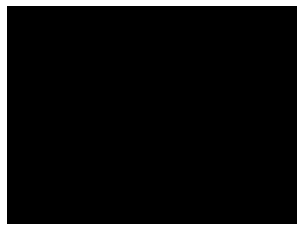

(375, 500, 3)
COCO_val2014_000000437331.jpg
{'person_bbx': [255.86, 122.74, 355.08000000000004, 239.54], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [255.86, 122.74, 355.08000000000004, 239.54], 'Verbs': 'surf', 'object': {'obj_bbx': [252.61, 92.54, 328.71000000000004, 245.55]}}
surfboard
person
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000052996.jpg
{'person_bbx': [434.62, 123.49, 555.24, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [448.31, 225.77, 508.41, 272.46000000000004]}}
book
person
hold
hold interaction
{'person_bbx': [520.99, 120.41, 633.24, 420.72], 'Verbs': 'look', 'object': {'obj_bbx': [69.41, 129.07, 158.91, 287.74]}}
person
person
look
look interaction
{'person_bbx': [434.62, 123.49, 555.24, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [434.62, 123.49, 555.24, 426.0], 'Verbs': 'read', 'object': {'obj_bbx': [448.31, 225.77, 508.41, 272.46000000000004]}}
book
person
read
read interaction
{'person_bbx': [520.99, 120.41, 633.24, 420.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [434.62, 123.49, 555.24, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000004700.jpg
{'person_bbx': [204.38, 59.49, 303.22, 237.97], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [311.46, 64.55, 436.03999999999996, 310.71], 'Verbs': 'kick', 'object': {'obj_bbx': [267.3, 259.8, 307.6, 301.09000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [490.33, 57.57, 581.49, 314.73], 'Verbs': 'look', 'object': {'obj_bbx': [267.3, 259.8, 307.6, 301.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [204.38, 59.49, 303.22, 237.97], 'Verbs': 'look', 'object': {'obj_bbx': [267.3, 259.8, 307.6, 301.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [311.46, 64.55, 436.03999999999996, 310.71], 'Verbs': 'look', 'object': {'obj_bbx': [267.3, 259.8, 307.6, 301.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [204.38, 59.49, 303.22, 237.97], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [311.46, 64.55, 436.039

(427, 640, 3)
COCO_val2014_000000195098.jpg
{'person_bbx': [2.87, 10.21, 477.85, 631.5600000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.87, 10.21, 477.85, 631.5600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000041687.jpg
{'person_bbx': [183.48, 83.83, 241.43, 225.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [304.34, 90.51, 378.52, 222.89], 'Verbs': 'hold', 'object': {'obj_bbx': [331.67, 116.06, 354.77000000000004, 144.99]}}
backpack
person
hold
hold interaction
{'person_bbx': [304.34, 90.51, 378.52, 222.89], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [183.48, 83.83, 241.43, 225.25], 'Verbs': 'snowboard', 'object': {'obj_bbx': [165.11, 211.36, 253.85000000000002, 227.42000000000002]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [183.48, 83.83, 241.43, 225.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [304.34, 90.51, 378.52, 222.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000393743.jpg
{'person_bbx': [42.89, 119.36, 151.24, 485.05], 'Verbs': 'kick', 'object': {'obj_bbx': [131.46, 420.22, 200.0, 483.15000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [42.89, 119.36, 151.24, 485.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000408449.jpg
{'person_bbx': [273.25, 117.1, 329.5, 265.56], 'Verbs': 'carry', 'object': {'obj_bbx': [292.53, 140.86, 326.82, 188.98000000000002]}}
person
backpack
carry
carry interaction
{'person_bbx': [423.33, 119.67, 598.35, 334.09], 'Verbs': 'skateboard', 'object': {'obj_bbx': [470.52, 292.51, 543.18, 338.24]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [423.33, 119.67, 598.35, 334.09], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [423.33, 119.67, 598.35, 334.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.25, 117.1, 329.5, 265.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.25, 117.1, 329.5, 265.56], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000538741.jpg
{'person_bbx': [77.45, 89.6, 214.75, 406.9], 'Verbs': 'look', 'object': {'obj_bbx': [30.13, 363.77, 295.96, 416.5]}}
skis
person
look
look interaction
{'person_bbx': [428.22, 33.44, 594.34, 433.62], 'Verbs': 'look', 'object': {'obj_bbx': [452.35, 332.73, 567.07, 467.58000000000004]}}
skis
person
look
look interaction
{'person_bbx': [77.45, 89.6, 214.75, 406.9], 'Verbs': 'ski', 'object': {'obj_bbx': [30.13, 363.77, 295.96, 416.5]}}
skis
person
ski
ski interaction
{'person_bbx': [428.22, 33.44, 594.34, 433.62], 'Verbs': 'ski', 'object': {'obj_bbx': [452.35, 332.73, 567.07, 467.58000000000004]}}
skis
person
ski
ski interaction
{'person_bbx': [77.45, 89.6, 214.75, 406.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [428.22, 33.44, 594.34, 433.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000206431.jpg
{'person_bbx': [0.0, 73.16, 424.0, 631.55], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [289.08, 323.6, 422.83, 474.61]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 73.16, 424.0, 631.55], 'Verbs': 'hold', 'object': {'obj_bbx': [289.08, 323.6, 422.83, 474.61]}}
pizza
person
hold
hold interaction
{'person_bbx': [0.0, 73.16, 424.0, 631.55], 'Verbs': 'look', 'object': {'obj_bbx': [289.08, 323.6, 422.83, 474.61]}}
pizza
person
look
look interaction
{'person_bbx': [0.0, 73.16, 424.0, 631.55], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 424, 3)
COCO_val2014_000000073668.jpg
{'person_bbx': [220.28, 6.52, 382.59000000000003, 392.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [220.28, 6.52, 382.59000000000003, 392.97999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [132.27, 315.09, 404.34000000000003, 418.32]}}
person
skis
ski
ski interaction
{'person_bbx': [220.28, 6.52, 382.59000000000003, 392.97999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [220.28, 6.52, 382.59000000000003, 392.97999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000258243.jpg
{'person_bbx': [315.5, 170.13, 625.79, 479.71], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [458.73, 238.41, 497.41, 261.9]}}
person
apple
eat_obj
eat_obj interaction
{'person_bbx': [240.39, 112.05, 431.78, 339.42], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [246.18, 306.3, 275.61, 325.2]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [315.5, 170.13, 625.79, 479.71], 'Verbs': 'hold', 'object': {'obj_bbx': [317.02, 331.44, 350.46, 387.53]}}
person
cup
hold
hold interaction
{'person_bbx': [240.39, 112.05, 431.78, 339.42], 'Verbs': 'hold', 'object': {'obj_bbx': [246.18, 306.3, 275.61, 325.2]}}
spoon
person
hold
hold interaction
{'person_bbx': [315.5, 170.13, 625.79, 479.71], 'Verbs': 'sit', 'object': {'obj_bbx': [575.36, 267.35, 599.38, 298.96000000000004]}}
person
chair
sit
sit interaction
{'person_bbx': [240.39, 112.05, 431.78, 339.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000228166.jpg
{'person_bbx': [251.17, 128.58, 286.27, 179.83], 'Verbs': 'jump', 'object': {'obj_bbx': [245.43, 167.28, 288.5, 183.73]}}
person
snowboard
jump
jump interaction
{'person_bbx': [251.17, 128.58, 286.27, 179.83], 'Verbs': 'look', 'object': {'obj_bbx': [245.43, 167.28, 288.5, 183.73]}}
person
snowboard
look
look interaction
{'person_bbx': [251.17, 128.58, 286.27, 179.83], 'Verbs': 'snowboard', 'object': {'obj_bbx': [245.43, 167.28, 288.5, 183.73]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [251.17, 128.58, 286.27, 179.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000200563.jpg
{'person_bbx': [156.79, 210.81, 290.92999999999995, 402.52], 'Verbs': 'look', 'object': {'obj_bbx': [146.54, 391.86, 259.32, 414.34000000000003]}}
person
snowboard
look
look interaction
{'person_bbx': [156.79, 210.81, 290.92999999999995, 402.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [146.54, 391.86, 259.32, 414.34000000000003]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [156.79, 210.81, 290.92999999999995, 402.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(504, 640, 3)
COCO_val2014_000000442231.jpg
{'person_bbx': [0.0, 20.09, 407.53, 535.25], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [31.64, 257.44, 207.10000000000002, 409.89]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 20.09, 407.53, 535.25], 'Verbs': 'hold', 'object': {'obj_bbx': [31.64, 257.44, 207.10000000000002, 409.89]}}
person
pizza
hold
hold interaction
{'person_bbx': [0.0, 20.09, 407.53, 535.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000341973.jpg
{'person_bbx': [229.54, 48.49, 500.0, 370.52], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [287.54, 206.72, 351.73, 269.08]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [53.57, 124.68, 301.95, 368.18], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [203.1, 269.2, 270.73, 339.82]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [229.54, 48.49, 500.0, 370.52], 'Verbs': 'hold', 'object': {'obj_bbx': [287.54, 206.72, 351.73, 269.08]}}
person
donut
hold
hold interaction
{'person_bbx': [53.57, 124.68, 301.95, 368.18], 'Verbs': 'hold', 'object': {'obj_bbx': [203.1, 269.2, 270.73, 339.82]}}
donut
person
hold
hold interaction
{'person_bbx': [229.54, 48.49, 500.0, 370.52], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 344.66, 59.83, 370.79]}}
person
bench
sit
sit interaction
{'person_bbx': [53.57, 124.68, 301.95, 368.18], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 344.66, 59.83, 370.79]}}
bench
person
sit
sit interaction
{'person_bbx': [2

(375, 500, 3)
COCO_val2014_000000403619.jpg
{'person_bbx': [86.95, 302.5, 421.69, 425.03], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [217.31, 5.74, 638.52, 416.43]}}
person
laptop
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000568213.jpg
{'person_bbx': [110.53, 34.4, 276.69, 264.98], 'Verbs': 'hold', 'object': {'obj_bbx': [77.89, 97.51, 118.00999999999999, 126.49000000000001]}}
person
frisbee
hold
hold interaction
{'person_bbx': [110.53, 34.4, 276.69, 264.98], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [351.29, 13.88, 463.76, 266.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [110.53, 34.4, 276.69, 264.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [110.53, 34.4, 276.69, 264.98], 'Verbs': 'throw', 'object': {'obj_bbx': [77.89, 97.51, 118.00999999999999, 126.49000000000001]}}
person
frisbee
throw
throw interaction


(325, 500, 3)
COCO_val2014_000000138488.jpg
{'person_bbx': [363.88, 104.17, 471.05, 454.37], 'Verbs': 'hold', 'object': {'obj_bbx': [231.17, 139.84, 525.12, 537.97]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [418.71, 73.47, 588.02, 389.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [418.71, 73.47, 588.02, 389.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [363.88, 104.17, 471.05, 454.37]}}
person
person
look
look interaction
{'person_bbx': [363.88, 104.17, 471.05, 454.37], 'Verbs': 'ride', 'object': {'obj_bbx': [231.17, 139.84, 525.12, 537.97]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [418.71, 73.47, 588.02, 389.53999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [231.17, 139.84, 525.12, 537.97]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [363.88, 104.17, 471.05, 454.37], 'Verbs': 'sit', 'object': {'obj_bbx': [231.17, 139.84, 525.12, 537.97]}}
motorcycle
person
sit
sit interaction
{'person_b

(635, 640, 3)
COCO_val2014_000000222628.jpg
{'person_bbx': [197.84, 6.72, 639.0600000000001, 422.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [217.33, 236.48, 505.51, 420.29999999999995]}}
person
laptop
look
look interaction
{'person_bbx': [197.84, 6.72, 639.0600000000001, 422.20000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [197.84, 6.72, 639.0600000000001, 422.20000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [217.33, 236.48, 505.51, 420.29999999999995]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000515982.jpg
{'person_bbx': [341.18, 2.0, 591.83, 415.61], 'Verbs': 'catch', 'object': {'obj_bbx': [27.35, 41.25, 51.88, 65.36]}}
person
sports ball
catch
catch interaction
{'person_bbx': [341.18, 2.0, 591.83, 415.61], 'Verbs': 'look', 'object': {'obj_bbx': [27.35, 41.25, 51.88, 65.36]}}
person
sports ball
look
look interaction


(426, 640, 3)
COCO_val2014_000000042288.jpg
{'person_bbx': [175.66, 209.84, 289.76, 428.83000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [163.69, 303.7, 197.88, 334.21999999999997]}}
frisbee
person
catch
catch interaction
{'person_bbx': [175.66, 209.84, 289.76, 428.83000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [175.66, 209.84, 289.76, 428.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [163.69, 303.7, 197.88, 334.21999999999997]}}
frisbee
person
look
look interaction
{'person_bbx': [175.66, 209.84, 289.76, 428.83000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [163.69, 303.7, 197.88, 334.21999999999997]}}
frisbee
person
throw
throw interaction


(500, 333, 3)
COCO_val2014_000000339986.jpg
{'person_bbx': [140.88, 88.15, 478.75, 281.39], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 62.39, 640.0, 474.72999999999996]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000279716.jpg
{'person_bbx': [11.97, 176.2, 175.93, 327.59], 'Verbs': 'carry', 'object': {'obj_bbx': [112.04, 189.12, 205.51, 351.44]}}
person
surfboard
carry
carry interaction
{'person_bbx': [11.97, 176.2, 175.93, 327.59], 'Verbs': 'hold', 'object': {'obj_bbx': [112.04, 189.12, 205.51, 351.44]}}
person
surfboard
hold
hold interaction
{'person_bbx': [11.97, 176.2, 175.93, 327.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000417074.jpg
{'person_bbx': [302.19, 89.24, 331.48, 221.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [410.79, 67.86, 440.58000000000004, 210.20999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.01, 112.65, 293.88, 217.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [379.22, 76.22, 413.52000000000004, 209.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [324.58, 104.46, 358.40999999999997, 220.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [302.19, 89.24, 331.48, 221.75], 'Verbs': 'ride', 'object': {'obj_bbx': [189.61, 212.48, 297.28000000000003, 377.31]}}
person
elephant
ride
ride interaction
{'person_bbx': [410.79, 67.86, 440.58000000000004, 210.20999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [315.09, 195.58, 536.18, 420.77]}}
person
elephant
ride
ride interaction
{'person_bbx': [259.01, 112.65,

(424, 640, 3)
COCO_val2014_000000023446.jpg
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'hold', 'object': {'obj_bbx': [141.8, 70.55, 172.05, 118.71]}}
cell phone
person
hold
hold interaction
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'look', 'object': {'obj_bbx': [208.99, 151.69, 500.0, 332.87]}}
person
laptop
look
look interaction
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [141.8, 70.55, 172.05, 118.71]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [70.79, 16.01, 285.67, 302.53], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [208.99, 151.69, 500.0, 332.87]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000430319.jpg
{'person_bbx': [369.98, 2.52, 640.0, 465.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [275.92, 77.73, 637.34, 397.20000000000005]}}
cat
person
hold
hold interaction
{'person_bbx': [369.98, 2.52, 640.0, 465.97999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000044065.jpg
{'person_bbx': [137.31, 15.22, 299.58000000000004, 425.57000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [137.31, 15.22, 299.58000000000004, 425.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.31, 15.22, 299.58000000000004, 425.57000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [137.31, 15.22, 299.58000000000004, 425.57000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000530987.jpg
{'person_bbx': [150.21, 127.31, 219.97000000000003, 202.84], 'Verbs': 'ride', 'object': {'obj_bbx': [76.26, 187.25, 268.01, 397.12]}}
person
elephant
ride
ride interaction
{'person_bbx': [187.11, 126.54, 260.27, 232.63], 'Verbs': 'ride', 'object': {'obj_bbx': [76.26, 187.25, 268.01, 397.12]}}
person
elephant
ride
ride interaction
{'person_bbx': [398.65, 129.46, 442.95, 190.44], 'Verbs': 'ride', 'object': {'obj_bbx': [294.47, 172.85, 458.43000000000006, 340.03999999999996]}}
elephant
person
ride
ride interaction
{'person_bbx': [150.21, 127.31, 219.97000000000003, 202.84], 'Verbs': 'sit', 'object': {'obj_bbx': [106.58, 156.73, 205.79, 222.21999999999997]}}
person
bench
sit
sit interaction
{'person_bbx': [187.11, 126.54, 260.27, 232.63], 'Verbs': 'sit', 'object': {'obj_bbx': [76.26, 187.25, 268.01, 397.12]}}
person
elephant
sit
sit interaction
{'person_bbx': [398.65, 129.46, 442.95, 190.44], 'Verbs': 'sit', 'object': {'obj_bbx': [294.47, 172.85,

(480, 640, 3)
COCO_val2014_000000149783.jpg
{'person_bbx': [372.38, 101.29, 566.1, 412.32], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.08, 134.9, 298.78999999999996, 471.44000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [179.33, 210.57, 354.36, 397.41999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [372.38, 101.29, 566.1, 412.32], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [1.08, 134.9, 298.78999999999996, 471.44000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [372.38, 101.29, 566.1, 412.32], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.08, 134.9, 298.78999999999996, 471.44000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [179.33, 210.57, 354.36, 397.41999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000403792.jpg


(332, 500, 3)
COCO_val2014_000000037655.jpg
{'person_bbx': [7.21, 15.14, 389.19, 464.86], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [29.66, 301.17, 209.73, 405.75]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [7.21, 15.14, 389.19, 464.86], 'Verbs': 'look', 'object': {'obj_bbx': [29.66, 301.17, 209.73, 405.75]}}
person
sandwich
look
look interaction
{'person_bbx': [7.21, 15.14, 389.19, 464.86], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [7.21, 15.14, 389.19, 464.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000014088.jpg
{'person_bbx': [67.52, 103.96, 310.81, 345.09999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [9.45, 261.6, 268.49, 386.79]}}
person
laptop
look
look interaction
{'person_bbx': [67.52, 103.96, 310.81, 345.09999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [67.52, 103.96, 310.81, 345.09999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [9.45, 261.6, 268.49, 386.79]}}
person
laptop
work_on_computer
work_on_computer interaction


(478, 640, 3)
COCO_val2014_000000114291.jpg
{'person_bbx': [60.38, 149.02, 301.18, 426.0], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [60.38, 149.02, 301.18, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [342.7, 198.87, 400.63, 218.8]}}
frisbee
person
look
look interaction
{'person_bbx': [0.96, 127.32, 166.57000000000002, 332.18], 'Verbs': 'look', 'object': {'obj_bbx': [342.7, 198.87, 400.63, 218.8]}}
frisbee
person
look
look interaction
{'person_bbx': [60.38, 149.02, 301.18, 426.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.96, 127.32, 166.57000000000002, 332.18], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [60.38, 149.02, 301.18, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.96, 127.32, 166.57000000000002, 332.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.38, 149.02, 301.18, 426.0], 'Verbs': 'throw', 'object': {'obj_bbx': [342

(426, 640, 3)
COCO_val2014_000000452687.jpg
{'person_bbx': [37.08, 175.34, 252.41000000000003, 375.0], 'Verbs': 'snowboard', 'object': {'obj_bbx': [0.84, 138.2, 467.7, 359.83]}}
person
snowboard
snowboard
snowboard interaction


(375, 500, 3)
COCO_val2014_000000008589.jpg
{'person_bbx': [151.96, 35.59, 342.4, 308.74], 'Verbs': 'jump', 'object': {'obj_bbx': [172.65, 257.2, 279.26, 316.86]}}
skateboard
person
jump
jump interaction
{'person_bbx': [151.96, 35.59, 342.4, 308.74], 'Verbs': 'look', 'object': {'obj_bbx': [172.65, 257.2, 279.26, 316.86]}}
skateboard
person
look
look interaction
{'person_bbx': [151.96, 35.59, 342.4, 308.74], 'Verbs': 'skateboard', 'object': {'obj_bbx': [172.65, 257.2, 279.26, 316.86]}}
skateboard
person
skateboard
skateboard interaction


(428, 640, 3)
COCO_val2014_000000419223.jpg
{'person_bbx': [20.15, 72.03, 302.26, 311.91999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [90.33, 300.05, 146.15, 349.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [125.53, 98.14, 452.12, 354.12], 'Verbs': 'kick', 'object': {'obj_bbx': [90.33, 300.05, 146.15, 349.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [20.15, 72.03, 302.26, 311.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [90.33, 300.05, 146.15, 349.86]}}
sports ball
person
look
look interaction
{'person_bbx': [447.33, 22.27, 611.94, 346.63], 'Verbs': 'look', 'object': {'obj_bbx': [90.33, 300.05, 146.15, 349.86]}}
sports ball
person
look
look interaction
{'person_bbx': [125.53, 98.14, 452.12, 354.12], 'Verbs': 'look', 'object': {'obj_bbx': [90.33, 300.05, 146.15, 349.86]}}
sports ball
person
look
look interaction
{'person_bbx': [20.15, 72.03, 302.26, 311.91999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bb

(427, 640, 3)
COCO_val2014_000000154798.jpg
{'person_bbx': [269.5, 120.0, 346.95, 288.99], 'Verbs': 'carry', 'object': {'obj_bbx': [253.12, 157.03, 277.51, 226.35]}}
person
surfboard
carry
carry interaction
{'person_bbx': [357.57, 112.29, 431.12, 292.58], 'Verbs': 'carry', 'object': {'obj_bbx': [405.48, 161.44, 429.96000000000004, 224.99]}}
person
surfboard
carry
carry interaction
{'person_bbx': [149.35, 118.11, 241.39, 287.86], 'Verbs': 'carry', 'object': {'obj_bbx': [200.23, 158.98, 251.22, 218.47]}}
surfboard
person
carry
carry interaction
{'person_bbx': [514.96, 81.88, 586.98, 295.96000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [481.15, 144.79, 530.27, 220.26]}}
surfboard
person
carry
carry interaction
{'person_bbx': [269.5, 120.0, 346.95, 288.99], 'Verbs': 'hold', 'object': {'obj_bbx': [253.12, 157.03, 277.51, 226.35]}}
person
surfboard
hold
hold interaction
{'person_bbx': [357.57, 112.29, 431.12, 292.58], 'Verbs': 'hold', 'object': {'obj_bbx': [405.48, 161.44, 429.960000

(439, 640, 3)
COCO_val2014_000000063804.jpg
{'person_bbx': [176.35, 9.8, 400.0, 300.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [234.61, 124.04, 304.04, 163.82]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [176.35, 9.8, 400.0, 300.0], 'Verbs': 'hold', 'object': {'obj_bbx': [234.61, 124.04, 304.04, 163.82]}}
person
donut
hold
hold interaction
{'person_bbx': [176.35, 9.8, 400.0, 300.0], 'Verbs': 'look', 'object': {'obj_bbx': [234.61, 124.04, 304.04, 163.82]}}
person
donut
look
look interaction
{'person_bbx': [176.35, 9.8, 400.0, 300.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 120.95, 220.27, 295.95]}}
person
laptop
work_on_computer
work_on_computer interaction


(300, 400, 3)
COCO_val2014_000000226498.jpg
{'person_bbx': [373.73, 267.69, 432.42, 353.53999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [343.46, 335.4, 357.18, 349.12]}}
sports ball
person
kick
kick interaction
{'person_bbx': [373.73, 267.69, 432.42, 353.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [343.46, 335.4, 357.18, 349.12]}}
sports ball
person
look
look interaction
{'person_bbx': [373.73, 267.69, 432.42, 353.53999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [373.73, 267.69, 432.42, 353.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(478, 640, 3)
COCO_val2014_000000431047.jpg
{'person_bbx': [120.81, 57.53, 407.01, 629.93], 'Verbs': 'hold', 'object': {'obj_bbx': [29.25, 272.04, 268.38, 370.95000000000005]}}
person
book
hold
hold interaction
{'person_bbx': [120.81, 57.53, 407.01, 629.93], 'Verbs': 'look', 'object': {'obj_bbx': [29.25, 272.04, 268.38, 370.95000000000005]}}
person
book
look
look interaction
{'person_bbx': [120.81, 57.53, 407.01, 629.93], 'Verbs': 'read', 'object': {'obj_bbx': [29.25, 272.04, 268.38, 370.95000000000005]}}
person
book
read
read interaction
{'person_bbx': [120.81, 57.53, 407.01, 629.93], 'Verbs': 'sit', 'object': {'obj_bbx': [210.13, 355.75, 457.0, 640.0]}}
person
toilet
sit
sit interaction


(640, 457, 3)
COCO_val2014_000000111788.jpg
{'person_bbx': [360.46, 197.53, 399.77, 276.7], 'Verbs': 'carry', 'object': {'obj_bbx': [338.41, 206.36, 435.1, 271.36]}}
person
surfboard
carry
carry interaction
{'person_bbx': [360.46, 197.53, 399.77, 276.7], 'Verbs': 'hold', 'object': {'obj_bbx': [338.41, 206.36, 435.1, 271.36]}}
person
surfboard
hold
hold interaction
{'person_bbx': [360.46, 197.53, 399.77, 276.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.46, 197.53, 399.77, 276.7], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000088286.jpg
{'person_bbx': [266.28, 132.4, 409.34999999999997, 350.81], 'Verbs': 'hold', 'object': {'obj_bbx': [289.7, 342.69, 346.61, 368.01]}}
person
skateboard
hold
hold interaction
{'person_bbx': [299.38, 20.15, 435.64, 326.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [266.28, 132.4, 409.34999999999997, 350.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [266.28, 132.4, 409.34999999999997, 350.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [299.38, 20.15, 435.64, 326.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [299.38, 20.15, 435.64, 326.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000154785.jpg
{'person_bbx': [169.15, 117.83, 285.08000000000004, 345.15], 'Verbs': 'look', 'object': {'obj_bbx': [319.59, 286.77, 348.60999999999996, 310.9]}}
sports ball
person
look
look interaction
{'person_bbx': [169.15, 117.83, 285.08000000000004, 345.15], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [169.15, 117.83, 285.08000000000004, 345.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000430259.jpg
{'person_bbx': [313.17, 110.65, 445.02, 578.58], 'Verbs': 'hold', 'object': {'obj_bbx': [347.81, 152.71, 383.59000000000003, 193.70000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [313.17, 110.65, 445.02, 578.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [313.17, 110.65, 445.02, 578.58], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [347.81, 152.71, 383.59000000000003, 193.70000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 640, 3)
COCO_val2014_000000502113.jpg
{'person_bbx': [139.15, 7.55, 576.0, 473.53000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [534.44, 316.86, 615.5500000000001, 393.96000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [139.15, 7.55, 576.0, 473.53000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(480, 640, 3)
COCO_val2014_000000156636.jpg
{'person_bbx': [270.17, 78.74, 359.74, 274.96], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [270.17, 78.74, 359.74, 274.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [270.17, 78.74, 359.74, 274.96], 'Verbs': 'surf', 'object': {'obj_bbx': [272.28, 260.89, 350.09, 284.81]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000521088.jpg
{'person_bbx': [48.03, 32.02, 499.72, 343.82], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [182.61, 147.67, 232.49, 189.19]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [48.03, 32.02, 499.72, 343.82], 'Verbs': 'hold', 'object': {'obj_bbx': [182.61, 147.67, 232.49, 189.19]}}
person
hot dog
hold
hold interaction
{'person_bbx': [48.03, 32.02, 499.72, 343.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000546658.jpg
{'person_bbx': [114.01, 21.06, 414.96, 611.53], 'Verbs': 'hold', 'object': {'obj_bbx': [113.87, 104.5, 216.22, 609.01]}}
person
snowboard
hold
hold interaction
{'person_bbx': [114.01, 21.06, 414.96, 611.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 518, 3)
COCO_val2014_000000531020.jpg
{'person_bbx': [135.45, 89.03, 328.90999999999997, 444.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [322.6, 106.05, 518.73, 470.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [322.6, 106.05, 518.73, 470.44], 'Verbs': 'ski', 'object': {'obj_bbx': [311.54, 398.43, 465.63, 478.0]}}
person
skis
ski
ski interaction
{'person_bbx': [135.45, 89.03, 328.90999999999997, 444.83000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [322.6, 106.05, 518.73, 470.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [135.45, 89.03, 328.90999999999997, 444.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [322.6, 106.05, 518.73, 470.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(478, 640, 3)
COCO_val2014_000000163540.jpg
{'person_bbx': [77.66, 25.89, 419.96000000000004, 458.78999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [160.07, 381.92, 245.20999999999998, 448.28000000000003]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [77.66, 25.89, 419.96000000000004, 458.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [208.51, 363.92, 304.33, 419.68]}}
sandwich
person
hold
hold interaction
{'person_bbx': [77.66, 25.89, 419.96000000000004, 458.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [124.75, 314.37, 166.97, 405.86]}}
chair
person
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000178317.jpg
{'person_bbx': [43.24, 134.77, 211.89000000000001, 529.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [182.91, 131.65, 315.9, 504.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [43.24, 134.77, 211.89000000000001, 529.73], 'Verbs': 'ski', 'object': {'obj_bbx': [32.73, 467.15, 272.99, 586.76]}}
person
skis
ski
ski interaction
{'person_bbx': [182.91, 131.65, 315.9, 504.65], 'Verbs': 'ski', 'object': {'obj_bbx': [186.97, 454.47, 414.2, 572.4000000000001]}}
person
skis
ski
ski interaction
{'person_bbx': [43.24, 134.77, 211.89000000000001, 529.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [182.91, 131.65, 315.9, 504.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [43.24, 134.77, 211.89000000000001, 529.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.91, 131.65, 315.9, 504.65], 'Verbs': 'stand', '

(640, 480, 3)
COCO_val2014_000000296072.jpg
{'person_bbx': [277.73, 180.49, 328.61, 239.24], 'Verbs': 'surf', 'object': {'obj_bbx': [277.21, 212.27, 301.53999999999996, 250.39000000000001]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000565203.jpg
{'person_bbx': [81.45, 69.82, 385.65999999999997, 493.71], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [55.51, 0.75, 120.38999999999999, 166.46]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [81.45, 69.82, 385.65999999999997, 493.71], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [335.45, 170.23, 359.68, 192.81]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [81.45, 69.82, 385.65999999999997, 493.71], 'Verbs': 'hold', 'object': {'obj_bbx': [55.51, 0.75, 120.38999999999999, 166.46]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [81.45, 69.82, 385.65999999999997, 493.71], 'Verbs': 'look', 'object': {'obj_bbx': [335.45, 170.23, 359.68, 192.81]}}
sports ball
person
look
look interaction
{'person_bbx': [81.45, 69.82, 385.65999999999997, 493.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000281040.jpg
{'person_bbx': [111.4, 209.04, 231.05, 536.36], 'Verbs': 'carry', 'object': {'obj_bbx': [133.99, 296.94, 292.1, 404.8]}}
person
surfboard
carry
carry interaction
{'person_bbx': [111.4, 209.04, 231.05, 536.36], 'Verbs': 'hold', 'object': {'obj_bbx': [133.99, 296.94, 292.1, 404.8]}}
person
surfboard
hold
hold interaction
{'person_bbx': [111.4, 209.04, 231.05, 536.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [111.4, 209.04, 231.05, 536.36], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000122934.jpg
{'person_bbx': [196.33, 138.44, 303.44, 269.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [95.74, 149.77, 174.16, 242.77], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [196.33, 138.44, 303.44, 269.43], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [95.74, 149.77, 174.16, 242.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [196.33, 138.44, 303.44, 269.43], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(424, 640, 3)
COCO_val2014_000000292988.jpg
{'person_bbx': [139.64, 48.21, 364.04999999999995, 631.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [139.64, 48.21, 364.04999999999995, 631.69], 'Verbs': 'ski', 'object': {'obj_bbx': [107.87, 555.15, 201.35000000000002, 632.81]}}
skis
person
ski
ski interaction
{'person_bbx': [139.64, 48.21, 364.04999999999995, 631.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [139.64, 48.21, 364.04999999999995, 631.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 478, 3)
COCO_val2014_000000087740.jpg
{'person_bbx': [117.67, 119.42, 180.35, 203.03], 'Verbs': 'ride', 'object': {'obj_bbx': [24.86, 198.38, 261.62, 307.57]}}
person
elephant
ride
ride interaction
{'person_bbx': [182.08, 148.86, 216.21, 212.37], 'Verbs': 'ride', 'object': {'obj_bbx': [24.86, 198.38, 261.62, 307.57]}}
person
elephant
ride
ride interaction
{'person_bbx': [438.49, 131.9, 500.02, 216.77], 'Verbs': 'ride', 'object': {'obj_bbx': [378.61, 212.49, 580.31, 307.42]}}
person
elephant
ride
ride interaction
{'person_bbx': [506.01, 174.53, 571.93, 235.5], 'Verbs': 'ride', 'object': {'obj_bbx': [378.61, 212.49, 580.31, 307.42]}}
person
elephant
ride
ride interaction
{'person_bbx': [117.67, 119.42, 180.35, 203.03], 'Verbs': 'sit', 'object': {'obj_bbx': [113.89, 160.53, 162.66, 206.74]}}
chair
person
sit
sit interaction
{'person_bbx': [182.08, 148.86, 216.21, 212.37], 'Verbs': 'sit', 'object': {'obj_bbx': [24.86, 198.38, 261.62, 307.57]}}
person
elephant
sit
sit interaction
{'pe

(480, 640, 3)
COCO_val2014_000000178370.jpg
{'person_bbx': [32.02, 3.37, 171.91, 189.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [127.59, 56.09, 169.18, 81.21000000000001]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [304.05, 0.42, 490.71000000000004, 331.5], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [310.54, 44.11, 347.25, 85.50999999999999]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [32.02, 3.37, 171.91, 189.61], 'Verbs': 'hold', 'object': {'obj_bbx': [127.59, 56.09, 169.18, 81.21000000000001]}}
person
donut
hold
hold interaction
{'person_bbx': [304.05, 0.42, 490.71000000000004, 331.5], 'Verbs': 'hold', 'object': {'obj_bbx': [310.54, 44.11, 347.25, 85.50999999999999]}}
person
donut
hold
hold interaction
{'person_bbx': [304.05, 0.42, 490.71000000000004, 331.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [32.02, 3.37, 171.91, 189.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [304.05, 0.42, 490.710000

(375, 500, 3)
COCO_val2014_000000157653.jpg
{'person_bbx': [167.73, 95.91, 461.74, 423.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [270.64, 173.42, 279.39, 194.72]}}
cell phone
person
hold
hold interaction
{'person_bbx': [167.73, 95.91, 461.74, 423.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [167.73, 95.91, 461.74, 423.65999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [270.64, 173.42, 279.39, 194.72]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [167.73, 95.91, 461.74, 423.65999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000493004.jpg
{'person_bbx': [269.84, 92.07, 361.24, 368.38], 'Verbs': 'snowboard', 'object': {'obj_bbx': [305.49, 372.3, 357.96000000000004, 398.94]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [269.84, 92.07, 361.24, 368.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000202489.jpg
{'person_bbx': [207.38, 191.73, 428.0, 624.34], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 428, 3)
COCO_val2014_000000365132.jpg
{'person_bbx': [348.8, 160.88, 402.91, 300.01], 'Verbs': 'carry', 'object': {'obj_bbx': [313.73, 158.8, 415.58000000000004, 190.87]}}
surfboard
person
carry
carry interaction
{'person_bbx': [153.13, 151.21, 230.54, 341.29], 'Verbs': 'carry', 'object': {'obj_bbx': [88.94, 144.44, 265.23, 186.19]}}
surfboard
person
carry
carry interaction
{'person_bbx': [348.8, 160.88, 402.91, 300.01], 'Verbs': 'hold', 'object': {'obj_bbx': [313.73, 158.8, 415.58000000000004, 190.87]}}
surfboard
person
hold
hold interaction
{'person_bbx': [153.13, 151.21, 230.54, 341.29], 'Verbs': 'hold', 'object': {'obj_bbx': [88.94, 144.44, 265.23, 186.19]}}
surfboard
person
hold
hold interaction
{'person_bbx': [153.13, 151.21, 230.54, 341.29], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [348.8, 160.88, 402.91, 300.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.13, 151.21, 230.54, 341.29], 'Verbs': 'stand', 'objec

(429, 640, 3)
COCO_val2014_000000375490.jpg
{'person_bbx': [191.93, 85.33, 378.94, 303.84], 'Verbs': 'look', 'object': {'obj_bbx': [244.1, 154.01, 498.15, 358.27]}}
person
surfboard
look
look interaction
{'person_bbx': [191.93, 85.33, 378.94, 303.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [191.93, 85.33, 378.94, 303.84], 'Verbs': 'surf', 'object': {'obj_bbx': [244.1, 154.01, 498.15, 358.27]}}
person
surfboard
surf
surf interaction


(438, 640, 3)
COCO_val2014_000000211690.jpg
{'person_bbx': [16.15, 111.96, 209.93, 358.5], 'Verbs': 'hold', 'object': {'obj_bbx': [116.51, 276.68, 186.64, 296.56]}}
person
scissors
hold
hold interaction
{'person_bbx': [379.1, 47.37, 530.0, 238.56], 'Verbs': 'hold', 'object': {'obj_bbx': [443.83, 181.28, 472.99, 220.69]}}
scissors
person
hold
hold interaction
{'person_bbx': [16.15, 111.96, 209.93, 358.5], 'Verbs': 'look', 'object': {'obj_bbx': [116.51, 276.68, 186.64, 296.56]}}
person
scissors
look
look interaction
{'person_bbx': [379.1, 47.37, 530.0, 238.56], 'Verbs': 'look', 'object': {'obj_bbx': [443.83, 181.28, 472.99, 220.69]}}
scissors
person
look
look interaction
{'person_bbx': [16.15, 111.96, 209.93, 358.5], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 195.35, 262.07, 478.0]}}
couch
person
sit
sit interaction
{'person_bbx': [379.1, 47.37, 530.0, 238.56], 'Verbs': 'sit', 'object': {'obj_bbx': [346.47, 104.44, 579.59, 318.31]}}
person
chair
sit
sit interaction


(478, 640, 3)
COCO_val2014_000000547421.jpg
{'person_bbx': [174.04, 15.32, 450.77, 397.27], 'Verbs': 'hold', 'object': {'obj_bbx': [316.25, 275.5, 536.58, 467.34000000000003]}}
dog
person
hold
hold interaction
{'person_bbx': [174.04, 15.32, 450.77, 397.27], 'Verbs': 'skateboard', 'object': {'obj_bbx': [154.12, 359.95, 295.8, 420.52]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [174.04, 15.32, 450.77, 397.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(472, 640, 3)
COCO_val2014_000000372384.jpg
{'person_bbx': [142.85, 165.15, 237.63, 349.70000000000005], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [136.3, 96.49, 143.42000000000002, 104.36]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [142.85, 165.15, 237.63, 349.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [142.85, 165.15, 237.63, 349.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [136.3, 96.49, 143.42000000000002, 104.36]}}
sports ball
person
look
look interaction
{'person_bbx': [142.85, 165.15, 237.63, 349.70000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 375, 3)
COCO_val2014_000000050431.jpg
{'person_bbx': [267.94, 90.23, 317.11, 166.99], 'Verbs': 'ride', 'object': {'obj_bbx': [229.72, 109.79, 320.14, 344.12]}}
horse
person
ride
ride interaction
{'person_bbx': [310.76, 92.83, 355.46, 170.94], 'Verbs': 'ride', 'object': {'obj_bbx': [229.72, 109.79, 320.14, 344.12]}}
horse
person
ride
ride interaction
{'person_bbx': [355.97, 88.52, 417.35, 160.73], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [267.94, 90.23, 317.11, 166.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [310.76, 92.83, 355.46, 170.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [355.97, 88.52, 417.35, 160.73], 'Verbs': 'sit', 'object': {'obj_bbx': [333.05, 123.63, 423.46000000000004, 360.73]}}
horse
person
sit
sit interaction
{'person_bbx': [522.62, 169.02, 571.87, 278.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [555.33, 164.54, 598.6400000000001, 272.81], '

(429, 640, 3)
COCO_val2014_000000525381.jpg
{'person_bbx': [359.31, 151.08, 636.4200000000001, 341.3], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [123.91, 18.31, 416.90999999999997, 337.82], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [119.15, 168.61, 188.67000000000002, 245.61]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [123.91, 18.31, 416.90999999999997, 337.82], 'Verbs': 'hold', 'object': {'obj_bbx': [119.15, 168.61, 188.67000000000002, 245.61]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [359.31, 151.08, 636.4200000000001, 341.3], 'Verbs': 'look', 'object': {'obj_bbx': [119.15, 168.61, 188.67000000000002, 245.61]}}
person
baseball bat
look
look interaction
{'person_bbx': [123.91, 18.31, 416.90999999999997, 337.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [123.91, 18.31, 416.90999999999997, 337.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(346, 640, 3)
COCO_val2014_000000342204.jpg
{'person_bbx': [350.34, 132.16, 640.0, 472.52], 'Verbs': 'drink', 'object': {'obj_bbx': [573.63, 322.43, 619.52, 375.73]}}
cup
person
drink
drink interaction
{'person_bbx': [26.97, 45.3, 455.19000000000005, 474.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [316.63, 216.64, 365.44, 267.86]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [26.97, 45.3, 455.19000000000005, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [316.63, 216.64, 365.44, 267.86]}}
person
donut
hold
hold interaction
{'person_bbx': [350.34, 132.16, 640.0, 472.52], 'Verbs': 'hold', 'object': {'obj_bbx': [573.63, 322.43, 619.52, 375.73]}}
cup
person
hold
hold interaction
{'person_bbx': [26.97, 45.3, 455.19000000000005, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [350.34, 132.16, 640.0, 472.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [350.34, 132.16, 640.0, 472.52], 'Verbs': 'smile', 'object': {'obj_bbx'

(480, 640, 3)
COCO_val2014_000000500019.jpg
{'person_bbx': [84.85, 103.55, 425.71000000000004, 631.37], 'Verbs': 'drink', 'object': {'obj_bbx': [98.51, 442.36, 150.71, 496.08000000000004]}}
person
cup
drink
drink interaction
{'person_bbx': [84.85, 103.55, 425.71000000000004, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [98.51, 442.36, 150.71, 496.08000000000004]}}
person
cup
hold
hold interaction
{'person_bbx': [84.85, 103.55, 425.71000000000004, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': [346.14, 562.3, 424.71, 621.56]}}
person
toilet
sit
sit interaction
{'person_bbx': [84.85, 103.55, 425.71000000000004, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000555932.jpg
{'person_bbx': [329.84, 193.34, 401.32, 291.23], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [329.84, 193.34, 401.32, 291.23], 'Verbs': 'surf', 'object': {'obj_bbx': [367.37, 251.59, 451.06, 308.63]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000506458.jpg
{'person_bbx': [97.72, 87.95, 291.2, 338.1], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [276.33, 302.51, 292.45, 331.36]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [97.72, 87.95, 291.2, 338.1], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [191.4, 329.9, 356.83000000000004, 399.15]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [255.84, 29.82, 470.32, 325.09], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [276.33, 302.51, 292.45, 331.36]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [255.84, 29.82, 470.32, 325.09], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [191.4, 329.9, 356.83000000000004, 399.15]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [97.72, 87.95, 291.2, 338.1], 'Verbs': 'hold', 'object': {'obj_bbx': [276.33, 302.51, 292.45, 331.36]}}
person
knife
hold
hold interaction
{'person_bbx': [255.84, 29.82, 470.32, 325.09], 'Verbs': 'hold', 'object': {'obj_bbx': [276.33, 302.51, 292.45, 33

(428, 640, 3)
COCO_val2014_000000075655.jpg
{'person_bbx': [56.09, 93.24, 280.45000000000005, 527.5799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [86.29, 257.44, 257.44, 405.57]}}
person
laptop
hold
hold interaction
{'person_bbx': [56.09, 93.24, 280.45000000000005, 527.5799999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [56.09, 93.24, 280.45000000000005, 527.5799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [56.09, 93.24, 280.45000000000005, 527.5799999999999], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [86.29, 257.44, 257.44, 405.57]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 427, 3)
COCO_val2014_000000481010.jpg
{'person_bbx': [278.12, 207.09, 380.85, 330.85], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [365.82, 244.08, 422.28999999999996, 266.61]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [278.12, 207.09, 380.85, 330.85], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [402.61, 240.53, 412.16, 248.84]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [278.12, 207.09, 380.85, 330.85], 'Verbs': 'hold', 'object': {'obj_bbx': [365.82, 244.08, 422.28999999999996, 266.61]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [278.12, 207.09, 380.85, 330.85], 'Verbs': 'look', 'object': {'obj_bbx': [402.61, 240.53, 412.16, 248.84]}}
sports ball
person
look
look interaction
{'person_bbx': [343.32, 178.14, 379.68, 303.81], 'Verbs': 'look', 'object': {'obj_bbx': [278.12, 207.09, 380.85, 330.85]}}
person
person
look
look interaction
{'person_bbx': [202.08, 184.13, 254.72000000000003, 319.25], 'Verbs': 'look', 'object': {

(480, 640, 3)
COCO_val2014_000000119939.jpg
{'person_bbx': [393.19, 248.45, 454.95, 384.03999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [397.7, 266.3, 420.0, 313.39]}}
person
backpack
carry
carry interaction
{'person_bbx': [393.19, 248.45, 454.95, 384.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [400.2, 378.57, 456.45, 391.55]}}
person
skateboard
look
look interaction
{'person_bbx': [209.66, 228.7, 318.76, 376.06], 'Verbs': 'look', 'object': {'obj_bbx': [226.54, 372.89, 278.78, 382.81]}}
person
skateboard
look
look interaction
{'person_bbx': [393.19, 248.45, 454.95, 384.03999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [400.2, 378.57, 456.45, 391.55]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [209.66, 228.7, 318.76, 376.06], 'Verbs': 'skateboard', 'object': {'obj_bbx': [226.54, 372.89, 278.78, 382.81]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [393.19, 248.45, 454.95, 384.03999999999996], 'Verbs': 'stan

(480, 640, 3)
COCO_val2014_000000053802.jpg
{'person_bbx': [263.19, 372.13, 408.81, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [364.67, 439.27, 380.22, 467.7]}}
person
cup
look
look interaction
{'person_bbx': [350.63, 351.5, 477.87, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [263.19, 372.13, 408.81, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [55.75, 323.12, 245.04, 469.72], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [476.41, 379.93, 626.6500000000001, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000574986.jpg
{'person_bbx': [266.55, 40.43, 358.37, 216.77], 'Verbs': 'look', 'object': {'obj_bbx': [274.61, 88.7, 370.57, 218.39]}}
person
surfboard
look
look interaction
{'person_bbx': [266.55, 40.43, 358.37, 216.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [266.55, 40.43, 358.37, 216.77], 'Verbs': 'surf', 'object': {'obj_bbx': [274.61, 88.7, 370.57, 218.39]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000484570.jpg
{'person_bbx': [105.3, 107.74, 160.41, 223.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(233, 640, 3)
COCO_val2014_000000519880.jpg
{'person_bbx': [157.04, 52.42, 376.81, 328.32], 'Verbs': 'jump', 'object': {'obj_bbx': [183.15, 251.69, 265.17, 330.34000000000003]}}
skateboard
person
jump
jump interaction
{'person_bbx': [157.04, 52.42, 376.81, 328.32], 'Verbs': 'look', 'object': {'obj_bbx': [183.15, 251.69, 265.17, 330.34000000000003]}}
skateboard
person
look
look interaction
{'person_bbx': [157.04, 52.42, 376.81, 328.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [183.15, 251.69, 265.17, 330.34000000000003]}}
skateboard
person
skateboard
skateboard interaction


(500, 500, 3)
COCO_val2014_000000013201.jpg
{'person_bbx': [93.41, 86.99, 319.54999999999995, 510.31], 'Verbs': 'jump', 'object': {'obj_bbx': [107.9, 427.13, 175.98000000000002, 523.18]}}
person
skateboard
jump
jump interaction
{'person_bbx': [93.41, 86.99, 319.54999999999995, 510.31], 'Verbs': 'look', 'object': {'obj_bbx': [107.9, 427.13, 175.98000000000002, 523.18]}}
person
skateboard
look
look interaction
{'person_bbx': [93.41, 86.99, 319.54999999999995, 510.31], 'Verbs': 'skateboard', 'object': {'obj_bbx': [107.9, 427.13, 175.98000000000002, 523.18]}}
person
skateboard
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000393243.jpg
{'person_bbx': [23.01, 0.3, 479.84999999999997, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [242.49, 446.89, 368.82, 538.59]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [23.01, 0.3, 479.84999999999997, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [242.49, 446.89, 368.82, 538.59]}}
person
donut
hold
hold interaction
{'person_bbx': [23.01, 0.3, 479.84999999999997, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [242.49, 446.89, 368.82, 538.59]}}
person
donut
look
look interaction


(640, 480, 3)
COCO_val2014_000000479126.jpg
{'person_bbx': [336.67, 156.87, 573.1, 413.97], 'Verbs': 'hold', 'object': {'obj_bbx': [261.74, 302.91, 423.18, 421.36]}}
person
laptop
hold
hold interaction
{'person_bbx': [108.69, 148.29, 217.38, 416.68999999999994], 'Verbs': 'hold', 'object': {'obj_bbx': [149.81, 258.96, 165.13, 291.29999999999995]}}
wine glass
person
hold
hold interaction
{'person_bbx': [336.67, 156.87, 573.1, 413.97], 'Verbs': 'sit', 'object': {'obj_bbx': [519.32, 266.88, 640.0, 421.71000000000004]}}
chair
person
sit
sit interaction
{'person_bbx': [108.69, 148.29, 217.38, 416.68999999999994], 'Verbs': 'sit', 'object': {'obj_bbx': [53.95, 201.84, 201.64, 415.95000000000005]}}
chair
person
sit
sit interaction
{'person_bbx': [336.67, 156.87, 573.1, 413.97], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [261.74, 302.91, 423.18, 421.36]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000189163.jpg
{'person_bbx': [163.7, 333.16, 408.09, 507.24], 'Verbs': 'hold', 'object': {'obj_bbx': [245.55, 148.71, 537.21, 408.09000000000003]}}
person
book
hold
hold interaction
{'person_bbx': [163.7, 333.16, 408.09, 507.24], 'Verbs': 'lay', 'object': {'obj_bbx': [2.31, 320.48, 640.0, 506.08000000000004]}}
person
bed
lay
lay interaction
{'person_bbx': [163.7, 333.16, 408.09, 507.24], 'Verbs': 'read', 'object': {'obj_bbx': [245.55, 148.71, 537.21, 408.09000000000003]}}
person
book
read
read interaction


(513, 640, 3)
COCO_val2014_000000432547.jpg
{'person_bbx': [174.05, 78.25, 427.0, 445.53], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [167.96, 413.84, 213.86, 485.21]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [174.05, 78.25, 427.0, 445.53], 'Verbs': 'hold', 'object': {'obj_bbx': [167.96, 413.84, 213.86, 485.21]}}
person
scissors
hold
hold interaction
{'person_bbx': [174.05, 78.25, 427.0, 445.53], 'Verbs': 'look', 'object': {'obj_bbx': [167.96, 413.84, 213.86, 485.21]}}
person
scissors
look
look interaction
{'person_bbx': [174.05, 78.25, 427.0, 445.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000420156.jpg
{'person_bbx': [1.44, 174.41, 438.2, 596.76], 'Verbs': 'hold', 'object': {'obj_bbx': [188.98, 551.86, 260.71999999999997, 595.99]}}
person
mouse
hold
hold interaction
{'person_bbx': [1.44, 174.41, 438.2, 596.76], 'Verbs': 'look', 'object': {'obj_bbx': [274.29, 320.83, 576.0, 600.0999999999999]}}
person
laptop
look
look interaction
{'person_bbx': [1.44, 174.41, 438.2, 596.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.44, 174.41, 438.2, 596.76], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [274.29, 320.83, 576.0, 600.0999999999999]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 576, 3)
COCO_val2014_000000256940.jpg
{'person_bbx': [143.29, 179.75, 614.88, 468.48], 'Verbs': 'lay', 'object': {'obj_bbx': [2.15, 89.9, 554.27, 367.03]}}
bed
person
lay
lay interaction


(478, 640, 3)
COCO_val2014_000000451038.jpg
{'person_bbx': [1.12, 0.0, 388.0, 365.17], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [41.57, 0.78, 334.83, 332.23999999999995]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.12, 0.0, 388.0, 365.17], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [113.85, 250.54, 388.0, 500.0]}}
person
apple
cut_obj
cut_obj interaction
{'person_bbx': [1.12, 0.0, 388.0, 365.17], 'Verbs': 'hold', 'object': {'obj_bbx': [41.57, 0.78, 334.83, 332.23999999999995]}}
person
knife
hold
hold interaction


(500, 388, 3)
COCO_val2014_000000371309.jpg
{'person_bbx': [174.85, 11.46, 448.0, 297.73999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [278.9, 11.38, 291.14, 21.15]}}
sports ball
person
hold
hold interaction
{'person_bbx': [174.85, 11.46, 448.0, 297.73999999999995], 'Verbs': 'throw', 'object': {'obj_bbx': [278.9, 11.38, 291.14, 21.15]}}
sports ball
person
throw
throw interaction


(333, 500, 3)
COCO_val2014_000000183332.jpg
{'person_bbx': [2.89, 4.33, 351.99, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [207.26, 180.4, 400.13, 363.67]}}
person
laptop
look
look interaction
{'person_bbx': [371.35, 0.0, 640.0, 421.24], 'Verbs': 'look', 'object': {'obj_bbx': [207.26, 180.4, 400.13, 363.67]}}
person
laptop
look
look interaction
{'person_bbx': [2.89, 4.33, 351.99, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.89, 4.33, 351.99, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [371.35, 0.0, 640.0, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.89, 4.33, 351.99, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [207.26, 180.4, 400.13, 363.67]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [371.35, 0.0, 640.0, 421.24], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [207.26, 180.4, 400.13, 363.67]}}
person
laptop
work_on_compu

(427, 640, 3)
COCO_val2014_000000115667.jpg
{'person_bbx': [64.57, 203.93, 360.0, 630.12], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 1.44, 360.0, 640.0]}}
bed
person
lay
lay interaction


(640, 360, 3)
COCO_val2014_000000276381.jpg
{'person_bbx': [0.0, 73.02, 640.0, 469.96], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 231.91, 640.0, 474.61]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000457249.jpg
{'person_bbx': [105.41, 233.31, 414.95000000000005, 630.52], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 228.51, 126.9, 280.9]}}
person
frisbee
look
look interaction
{'person_bbx': [105.41, 233.31, 414.95000000000005, 630.52], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [105.41, 233.31, 414.95000000000005, 630.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [105.41, 233.31, 414.95000000000005, 630.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000495438.jpg
{'person_bbx': [0.0, 0.86, 336.93, 428.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [301.15, 173.17, 329.35999999999996, 243.69]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.86, 336.93, 428.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [301.39, 202.21, 512.55, 428.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 0.86, 336.93, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': [301.15, 173.17, 329.35999999999996, 243.69]}}
person
knife
hold
hold interaction


(428, 640, 3)
COCO_val2014_000000363272.jpg
{'person_bbx': [54.65, 68.79, 317.84, 579.36], 'Verbs': 'hold', 'object': {'obj_bbx': [161.29, 123.41, 178.26, 143.57999999999998]}}
person
cell phone
hold
hold interaction
{'person_bbx': [54.65, 68.79, 317.84, 579.36], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [54.65, 68.79, 317.84, 579.36], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [161.29, 123.41, 178.26, 143.57999999999998]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 417, 3)
COCO_val2014_000000185476.jpg
{'person_bbx': [515.64, 149.03, 585.74, 225.37], 'Verbs': 'carry', 'object': {'obj_bbx': [501.23, 168.79, 640.0, 210.99]}}
person
surfboard
carry
carry interaction
{'person_bbx': [515.64, 149.03, 585.74, 225.37], 'Verbs': 'hold', 'object': {'obj_bbx': [501.23, 168.79, 640.0, 210.99]}}
person
surfboard
hold
hold interaction
{'person_bbx': [515.64, 149.03, 585.74, 225.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [515.64, 149.03, 585.74, 225.37], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(229, 640, 3)
COCO_val2014_000000315162.jpg
{'person_bbx': [89.6, 255.16, 259.93, 511.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [89.6, 255.16, 259.93, 511.54999999999995], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(640, 427, 3)
COCO_val2014_000000464359.jpg
{'person_bbx': [214.6, 144.67, 276.25, 306.02], 'Verbs': 'hold', 'object': {'obj_bbx': [222.99, 224.29, 243.63, 302.83]}}
skateboard
person
hold
hold interaction
{'person_bbx': [241.73, 90.51, 349.21, 268.57], 'Verbs': 'jump', 'object': {'obj_bbx': [273.41, 255.42, 358.16, 270.39]}}
skateboard
person
jump
jump interaction
{'person_bbx': [241.73, 90.51, 349.21, 268.57], 'Verbs': 'look', 'object': {'obj_bbx': [273.41, 255.42, 358.16, 270.39]}}
skateboard
person
look
look interaction
{'person_bbx': [214.6, 144.67, 276.25, 306.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [241.73, 90.51, 349.21, 268.57], 'Verbs': 'skateboard', 'object': {'obj_bbx': [273.41, 255.42, 358.16, 270.39]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [241.73, 90.51, 349.21, 268.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [214.6, 144.67, 276.25, 306.02], 'Verbs': 'stand', 'object': {'ob

(427, 640, 3)
COCO_val2014_000000501225.jpg
{'person_bbx': [192.87, 39.18, 456.75, 263.71999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [293.1, 256.87, 440.61, 304.35]}}
person
skateboard
jump
jump interaction
{'person_bbx': [192.87, 39.18, 456.75, 263.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [293.1, 256.87, 440.61, 304.35]}}
person
skateboard
look
look interaction
{'person_bbx': [192.87, 39.18, 456.75, 263.71999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [293.1, 256.87, 440.61, 304.35]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000479562.jpg
{'person_bbx': [149.21, 56.7, 476.74, 328.27], 'Verbs': 'hold', 'object': {'obj_bbx': [309.6, 153.97, 331.70000000000005, 219.82999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [149.21, 56.7, 476.74, 328.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [149.21, 56.7, 476.74, 328.27], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [309.6, 153.97, 331.70000000000005, 219.82999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(332, 500, 3)
COCO_val2014_000000574808.jpg
{'person_bbx': [1.29, 246.97, 142.9, 473.77], 'Verbs': 'look', 'object': {'obj_bbx': [133.67, 92.07, 451.27, 471.69]}}
person
person
look
look interaction
{'person_bbx': [133.67, 92.07, 451.27, 471.69], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.29, 246.97, 142.9, 473.77], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.67, 92.07, 451.27, 471.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.29, 246.97, 142.9, 473.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(478, 640, 3)
COCO_val2014_000000467257.jpg
{'person_bbx': [247.75, 169.31, 454.75, 325.13], 'Verbs': 'look', 'object': {'obj_bbx': [260.9, 213.49, 387.08, 300.05]}}
person
laptop
look
look interaction
{'person_bbx': [247.75, 169.31, 454.75, 325.13], 'Verbs': 'sit', 'object': {'obj_bbx': [228.58, 217.19, 500.0, 330.26]}}
couch
person
sit
sit interaction
{'person_bbx': [247.75, 169.31, 454.75, 325.13], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [260.9, 213.49, 387.08, 300.05]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000399129.jpg
{'person_bbx': [161.87, 382.2, 218.77, 498.25], 'Verbs': 'carry', 'object': {'obj_bbx': [134.51, 408.5, 211.75, 472.1]}}
person
surfboard
carry
carry interaction
{'person_bbx': [161.87, 382.2, 218.77, 498.25], 'Verbs': 'hold', 'object': {'obj_bbx': [134.51, 408.5, 211.75, 472.1]}}
person
surfboard
hold
hold interaction
{'person_bbx': [161.87, 382.2, 218.77, 498.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [161.87, 382.2, 218.77, 498.25], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000515367.jpg
{'person_bbx': [77.36, 98.46, 198.32999999999998, 547.16], 'Verbs': 'catch', 'object': {'obj_bbx': [109.1, 89.75, 162.39, 119.83]}}
person
frisbee
catch
catch interaction
{'person_bbx': [77.36, 98.46, 198.32999999999998, 547.16], 'Verbs': 'hold', 'object': {'obj_bbx': [109.1, 89.75, 162.39, 119.83]}}
person
frisbee
hold
hold interaction
{'person_bbx': [77.36, 98.46, 198.32999999999998, 547.16], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [77.36, 98.46, 198.32999999999998, 547.16], 'Verbs': 'look', 'object': {'obj_bbx': [109.1, 89.75, 162.39, 119.83]}}
person
frisbee
look
look interaction
{'person_bbx': [77.36, 98.46, 198.32999999999998, 547.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000488720.jpg
{'person_bbx': [158.28, 171.73, 237.43, 311.90999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [175.58, 298.8, 246.61, 317.43]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [158.28, 171.73, 237.43, 311.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000063906.jpg
{'person_bbx': [392.54, 140.42, 451.25, 301.54999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [298.97, 179.78, 544.3100000000001, 236.4]}}
person
surfboard
carry
carry interaction
{'person_bbx': [161.08, 179.12, 225.24, 340.53], 'Verbs': 'carry', 'object': {'obj_bbx': [51.38, 219.86, 310.73, 277.65000000000003]}}
surfboard
person
carry
carry interaction
{'person_bbx': [392.54, 140.42, 451.25, 301.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [298.97, 179.78, 544.3100000000001, 236.4]}}
person
surfboard
hold
hold interaction
{'person_bbx': [161.08, 179.12, 225.24, 340.53], 'Verbs': 'hold', 'object': {'obj_bbx': [51.38, 219.86, 310.73, 277.65000000000003]}}
surfboard
person
hold
hold interaction
{'person_bbx': [392.54, 140.42, 451.25, 301.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [298.97, 179.78, 544.3100000000001, 236.4]}}
person
surfboard
look
look interaction
{'person_bbx': [392.54, 140.42, 451.25, 301.54999999

(442, 640, 3)
COCO_val2014_000000539694.jpg
{'person_bbx': [0.0, 134.83, 126.2, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 134.83, 126.2, 473.53], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [98.16, 16.18, 393.34000000000003, 307.42]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [360.54, 328.97, 638.21, 475.34000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [177.98, 70.11, 636.4, 476.76]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000124387.jpg
{'person_bbx': [169.71, 86.39, 447.28, 595.51], 'Verbs': 'hold', 'object': {'obj_bbx': [373.69, 323.72, 539.78, 498.39]}}
person
frisbee
hold
hold interaction
{'person_bbx': [169.71, 86.39, 447.28, 595.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [169.71, 86.39, 447.28, 595.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [169.71, 86.39, 447.28, 595.51], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 632, 3)
COCO_val2014_000000496768.jpg
{'person_bbx': [194.26, 272.77, 258.15999999999997, 451.61], 'Verbs': 'catch', 'object': {'obj_bbx': [171.03, 113.74, 187.81, 139.45999999999998]}}
frisbee
person
catch
catch interaction
{'person_bbx': [194.26, 272.77, 258.15999999999997, 451.61], 'Verbs': 'look', 'object': {'obj_bbx': [171.03, 113.74, 187.81, 139.45999999999998]}}
frisbee
person
look
look interaction
{'person_bbx': [194.26, 272.77, 258.15999999999997, 451.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000064462.jpg
{'person_bbx': [171.47, 1.16, 326.78999999999996, 320.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [171.47, 1.16, 326.78999999999996, 320.71000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [203.02, 291.88, 329.66, 378.0]}}
person
skis
ski
ski interaction
{'person_bbx': [171.47, 1.16, 326.78999999999996, 320.71000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [171.47, 1.16, 326.78999999999996, 320.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(378, 500, 3)
COCO_val2014_000000071385.jpg
{'person_bbx': [262.92, 189.03, 318.57, 259.08], 'Verbs': 'look', 'object': {'obj_bbx': [276.89, 228.13, 367.14, 262.51]}}
surfboard
person
look
look interaction
{'person_bbx': [400.4, 32.06, 424.81, 109.51], 'Verbs': 'look', 'object': {'obj_bbx': [262.92, 189.03, 318.57, 259.08]}}
person
person
look
look interaction
{'person_bbx': [563.51, 19.07, 592.91, 94.9], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [524.26, 26.0, 548.51, 99.3], 'Verbs': 'look', 'object': {'obj_bbx': [276.89, 228.13, 367.14, 262.51]}}
surfboard
person
look
look interaction
{'person_bbx': [276.11, 48.7, 303.19, 119.77], 'Verbs': 'look', 'object': {'obj_bbx': [262.92, 189.03, 318.57, 259.08]}}
person
person
look
look interaction
{'person_bbx': [262.92, 189.03, 318.57, 259.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [400.4, 32.06, 424.81, 109.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person

(427, 640, 3)
COCO_val2014_000000219848.jpg
{'person_bbx': [38.2, 47.13, 338.87, 421.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.78, 34.77, 563.99, 433.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [38.2, 47.13, 338.87, 421.74], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 331.33, 640.0, 573.0]}}
boat
person
ride
ride interaction
{'person_bbx': [137.78, 34.77, 563.99, 433.93], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 331.33, 640.0, 573.0]}}
boat
person
ride
ride interaction
{'person_bbx': [38.2, 47.13, 338.87, 421.74], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [137.78, 34.77, 563.99, 433.93], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [38.2, 47.13, 338.87, 421.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [137.78, 34.77, 563.99, 433.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(573, 640, 3)
COCO_val2014_000000170127.jpg
{'person_bbx': [60.72, 321.03, 213.54, 530.8399999999999], 'Verbs': 'look', 'object': {'obj_bbx': [290.18, 183.92, 302.13, 195.22]}}
sports ball
person
look
look interaction
{'person_bbx': [60.72, 321.03, 213.54, 530.8399999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [60.72, 321.03, 213.54, 530.8399999999999], 'Verbs': 'throw', 'object': {'obj_bbx': [290.18, 183.92, 302.13, 195.22]}}
sports ball
person
throw
throw interaction


(640, 424, 3)
COCO_val2014_000000241129.jpg
{'person_bbx': [175.61, 264.79, 591.03, 533.51], 'Verbs': 'lay', 'object': {'obj_bbx': [24.76, 234.94, 592.75, 596.64]}}
person
bed
lay
lay interaction
{'person_bbx': [24.7, 170.31, 358.14, 522.97], 'Verbs': 'sit', 'object': {'obj_bbx': [24.76, 234.94, 592.75, 596.64]}}
person
bed
sit
sit interaction
{'person_bbx': [24.7, 170.31, 358.14, 522.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [175.61, 264.79, 591.03, 533.51], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000441840.jpg
{'person_bbx': [223.74, 260.51, 362.90999999999997, 502.87], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [103.73, 261.04, 227.04000000000002, 291.17]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [223.74, 260.51, 362.90999999999997, 502.87], 'Verbs': 'hold', 'object': {'obj_bbx': [103.73, 261.04, 227.04000000000002, 291.17]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [223.74, 260.51, 362.90999999999997, 502.87], 'Verbs': 'look', 'object': {'obj_bbx': [314.23, 251.9, 342.31, 270.96]}}
person
baseball glove
look
look interaction
{'person_bbx': [223.74, 260.51, 362.90999999999997, 502.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 512, 3)
COCO_val2014_000000182362.jpg
{'person_bbx': [74.26, 25.78, 503.68, 474.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [336.35, 447.34, 425.01, 480.0]}}
person
mouse
hold
hold interaction
{'person_bbx': [74.26, 25.78, 503.68, 474.57000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [281.53, 189.84, 625.6199999999999, 470.28999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [74.26, 25.78, 503.68, 474.57000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [2.16, 142.16, 131.89, 454.59000000000003]}}
chair
person
sit
sit interaction
{'person_bbx': [74.26, 25.78, 503.68, 474.57000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [74.26, 25.78, 503.68, 474.57000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [281.53, 189.84, 625.6199999999999, 470.28999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000533628.jpg
{'person_bbx': [426.47, 119.83, 514.47, 254.51999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [426.47, 119.83, 514.47, 254.51999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [434.47, 231.72, 537.24, 267.23]}}
surfboard
person
surf
surf interaction


(334, 640, 3)
COCO_val2014_000000222283.jpg
{'person_bbx': [117.93, 110.74, 451.6, 562.34], 'Verbs': 'kick', 'object': {'obj_bbx': [207.61, 515.29, 294.94, 605.49]}}
sports ball
person
kick
kick interaction
{'person_bbx': [5.77, 36.04, 230.63000000000002, 585.23], 'Verbs': 'look', 'object': {'obj_bbx': [207.61, 515.29, 294.94, 605.49]}}
sports ball
person
look
look interaction
{'person_bbx': [117.93, 110.74, 451.6, 562.34], 'Verbs': 'look', 'object': {'obj_bbx': [207.61, 515.29, 294.94, 605.49]}}
sports ball
person
look
look interaction
{'person_bbx': [5.77, 36.04, 230.63000000000002, 585.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [117.93, 110.74, 451.6, 562.34], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [5.77, 36.04, 230.63000000000002, 585.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [117.93, 110.74, 451.6, 562.34], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 457, 3)
COCO_val2014_000000273155.jpg
{'person_bbx': [264.09, 187.54, 558.79, 543.48], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [215.76, 255.14, 302.73, 318.73]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [264.09, 187.54, 558.79, 543.48], 'Verbs': 'hold', 'object': {'obj_bbx': [215.76, 255.14, 302.73, 318.73]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [264.09, 187.54, 558.79, 543.48], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [264.09, 187.54, 558.79, 543.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(569, 640, 3)
COCO_val2014_000000227359.jpg
{'person_bbx': [234.79, 29.66, 563.3, 402.56], 'Verbs': 'hold', 'object': {'obj_bbx': [354.92, 136.66, 430.42, 195.07999999999998]}}
person
book
hold
hold interaction
{'person_bbx': [234.79, 29.66, 563.3, 402.56], 'Verbs': 'look', 'object': {'obj_bbx': [354.92, 136.66, 430.42, 195.07999999999998]}}
person
book
look
look interaction
{'person_bbx': [234.79, 29.66, 563.3, 402.56], 'Verbs': 'read', 'object': {'obj_bbx': [354.92, 136.66, 430.42, 195.07999999999998]}}
person
book
read
read interaction
{'person_bbx': [234.79, 29.66, 563.3, 402.56], 'Verbs': 'sit', 'object': {'obj_bbx': [143.37, 91.46, 570.5, 400.93]}}
chair
person
sit
sit interaction
{'person_bbx': [234.79, 29.66, 563.3, 402.56], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [366.82, 116.67, 523.04, 214.56]}}
person
laptop
work_on_computer
work_on_computer interaction


(439, 640, 3)
COCO_val2014_000000158887.jpg
{'person_bbx': [3.24, 14.59, 276.76, 454.59], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [319.29, 54.16, 560.36, 440.95000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': [310.23, 438.08, 408.94, 465.56]}}
person
skis
ski
ski interaction
{'person_bbx': [3.24, 14.59, 276.76, 454.59], 'Verbs': 'ski', 'object': {'obj_bbx': [0.0, 385.98, 371.06, 474.43]}}
person
skis
ski
ski interaction
{'person_bbx': [3.24, 14.59, 276.76, 454.59], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [319.29, 54.16, 560.36, 440.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000540209.jpg
{'person_bbx': [221.21, 100.03, 562.65, 423.19000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [221.21, 100.03, 562.65, 423.19000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000189248.jpg
{'person_bbx': [273.31, 167.36, 309.37, 239.48000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.31, 167.36, 309.37, 239.48000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(427, 640, 3)
COCO_val2014_000000138503.jpg
{'person_bbx': [229.78, 52.77, 534.23, 420.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [0.96, 118.13, 638.1, 420.39]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [229.78, 52.77, 534.23, 420.40999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [0.96, 118.13, 638.1, 420.39]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [229.78, 52.77, 534.23, 420.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [0.96, 118.13, 638.1, 420.39]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [229.78, 52.77, 534.23, 420.40999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000074656.jpg
{'person_bbx': [0.0, 150.63, 376.22, 630.63], 'Verbs': 'hold', 'object': {'obj_bbx': [185.03, 206.74, 224.96, 253.96]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 150.63, 376.22, 630.63], 'Verbs': 'sit', 'object': {'obj_bbx': [139.51, 407.58, 377.45, 640.0]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 150.63, 376.22, 630.63], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [185.03, 206.74, 224.96, 253.96]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 425, 3)
COCO_val2014_000000121417.jpg
{'person_bbx': [103.32, 144.93, 441.96999999999997, 629.96], 'Verbs': 'hold', 'object': {'obj_bbx': [162.4, 79.64, 436.11, 322.16]}}
umbrella
person
hold
hold interaction
{'person_bbx': [103.32, 144.93, 441.96999999999997, 629.96], 'Verbs': 'sit', 'object': {'obj_bbx': [332.47, 412.26, 478.75, 502.03]}}
person
bench
sit
sit interaction
{'person_bbx': [103.32, 144.93, 441.96999999999997, 629.96], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [238.72, 183.66, 264.29, 209.48]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000531735.jpg
{'person_bbx': [324.86, 173.1, 363.34000000000003, 318.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [349.6, 213.95, 400.40000000000003, 318.91999999999996]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [324.86, 173.1, 363.34000000000003, 318.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000559550.jpg
{'person_bbx': [333.82, 51.6, 640.0, 399.86], 'Verbs': 'sit', 'object': {'obj_bbx': [238.88, 245.44, 557.77, 480.0]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000332869.jpg
{'person_bbx': [259.08, 87.32, 378.06, 335.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [443.58, 368.87, 511.57, 379.96]}}
person
frisbee
look
look interaction
{'person_bbx': [259.08, 87.32, 378.06, 335.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [259.08, 87.32, 378.06, 335.84000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [259.08, 87.32, 378.06, 335.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [410.69, 0.0, 511.44, 165.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.08, 87.32, 378.06, 335.84000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000032334.jpg
{'person_bbx': [228.67, 5.39, 639.64, 474.61], 'Verbs': 'drink', 'object': {'obj_bbx': [262.11, 251.33, 338.70000000000005, 360.27]}}
person
wine glass
drink
drink interaction
{'person_bbx': [228.67, 5.39, 639.64, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [262.11, 251.33, 338.70000000000005, 360.27]}}
person
wine glass
hold
hold interaction
{'person_bbx': [228.67, 5.39, 639.64, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [228.67, 5.39, 639.64, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000412975.jpg
{'person_bbx': [126.81, 119.44, 322.05, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [150.39, 236.26, 208.56, 366.88]}}
handbag
person
carry
carry interaction
{'person_bbx': [2.16, 1.08, 88.45, 419.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 383.34, 112.58, 480.0]}}
skateboard
person
look
look interaction
{'person_bbx': [126.81, 119.44, 322.05, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.16, 1.08, 88.45, 419.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [126.81, 119.44, 322.05, 480.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [2.16, 1.08, 88.45, 419.59999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000014975.jpg
{'person_bbx': [49.37, 112.7, 186.52, 438.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [49.37, 112.7, 186.52, 438.0], 'Verbs': 'look', 'object': {'obj_bbx': [275.6, 157.48, 385.83000000000004, 326.78]}}
person
person
look
look interaction
{'person_bbx': [153.2, 162.63, 276.94, 433.68], 'Verbs': 'look', 'object': {'obj_bbx': [275.6, 157.48, 385.83000000000004, 326.78]}}
person
person
look
look interaction
{'person_bbx': [535.44, 123.03, 638.7900000000001, 432.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [49.37, 112.7, 186.52, 438.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.2, 162.63, 276.94, 433.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [535.44, 123.03, 638.7900000000001, 432.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [49.37, 112.7, 186.52, 438.0], 'Ver

(438, 640, 3)
COCO_val2014_000000393569.jpg
{'person_bbx': [375.37, 121.56, 571.69, 341.6], 'Verbs': 'look', 'object': {'obj_bbx': [443.97, 205.18, 522.28, 287.59000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [375.37, 121.56, 571.69, 341.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000151826.jpg
{'person_bbx': [0.0, 2.3, 480.0, 633.6899999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [152.45, 263.4, 415.09, 510.93999999999994]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 2.3, 480.0, 633.6899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [152.45, 263.4, 415.09, 510.93999999999994]}}
person
hot dog
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000233370.jpg
{'person_bbx': [11.51, 396.7, 418.52, 546.28], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 427, 3)
COCO_val2014_000000039606.jpg
{'person_bbx': [87.64, 58.24, 489.89, 394.19], 'Verbs': 'jump', 'object': {'obj_bbx': [14.61, 15.73, 219.10000000000002, 278.65000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [87.64, 58.24, 489.89, 394.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [14.61, 15.73, 219.10000000000002, 278.65000000000003]}}
person
skateboard
skateboard
skateboard interaction


(500, 500, 3)
COCO_val2014_000000373785.jpg
{'person_bbx': [151.61, 28.5, 347.36, 269.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [151.61, 28.5, 347.36, 269.35], 'Verbs': 'look', 'object': {'obj_bbx': [90.8, 265.33, 365.86, 427.0]}}
person
surfboard
look
look interaction
{'person_bbx': [151.61, 28.5, 347.36, 269.35], 'Verbs': 'surf', 'object': {'obj_bbx': [90.8, 265.33, 365.86, 427.0]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000462845.jpg
{'person_bbx': [170.74, 118.62, 324.65, 349.28], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [250.05, 149.28, 317.91, 207.97]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [170.74, 118.62, 324.65, 349.28], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [373.41, 263.66, 388.18, 277.24]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [170.74, 118.62, 324.65, 349.28], 'Verbs': 'hold', 'object': {'obj_bbx': [250.05, 149.28, 317.91, 207.97]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [9.68, 40.37, 115.77000000000001, 227.91], 'Verbs': 'look', 'object': {'obj_bbx': [373.41, 263.66, 388.18, 277.24]}}
sports ball
person
look
look interaction
{'person_bbx': [170.74, 118.62, 324.65, 349.28], 'Verbs': 'look', 'object': {'obj_bbx': [373.41, 263.66, 388.18, 277.24]}}
sports ball
person
look
look interaction
{'person_bbx': [170.74, 118.62, 324.65, 349.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person


(427, 640, 3)
COCO_val2014_000000251580.jpg
{'person_bbx': [165.39, 261.31, 268.94, 590.6600000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [110.81, 416.27, 192.24, 517.2]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [165.39, 261.31, 268.94, 590.6600000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [52.03, 174.98, 75.39, 185.35999999999999]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [48.68, 47.39, 173.24, 433.96], 'Verbs': 'hold', 'object': {'obj_bbx': [136.73, 162.57, 153.17, 178.91]}}
person
sports ball
hold
hold interaction
{'person_bbx': [165.39, 261.31, 268.94, 590.6600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [110.81, 416.27, 192.24, 517.2]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [48.68, 47.39, 173.24, 433.96], 'Verbs': 'look', 'object': {'obj_bbx': [52.03, 174.98, 75.39, 185.35999999999999]}}
person
sports ball
look
look interaction
{'person_bbx': [165.39, 261.31, 268.94, 590.6600000000001], '

(640, 424, 3)
COCO_val2014_000000222828.jpg
{'person_bbx': [259.96, 78.74, 453.03, 471.37], 'Verbs': 'carry', 'object': {'obj_bbx': [300.42, 198.78, 452.89, 419.01]}}
handbag
person
carry
carry interaction
{'person_bbx': [124.04, 85.21, 296.63, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.96, 78.74, 453.03, 471.37], 'Verbs': 'hold', 'object': {'obj_bbx': [300.42, 198.78, 452.89, 419.01]}}
handbag
person
hold
hold interaction
{'person_bbx': [124.04, 85.21, 296.63, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [259.96, 78.74, 453.03, 471.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [124.04, 85.21, 296.63, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.96, 78.74, 453.03, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000198733.jpg
{'person_bbx': [11.51, 120.37, 192.72, 282.89], 'Verbs': 'jump', 'object': {'obj_bbx': [62.69, 276.43, 149.82999999999998, 301.62]}}
skateboard
person
jump
jump interaction
{'person_bbx': [11.51, 120.37, 192.72, 282.89], 'Verbs': 'look', 'object': {'obj_bbx': [62.69, 276.43, 149.82999999999998, 301.62]}}
skateboard
person
look
look interaction
{'person_bbx': [11.51, 120.37, 192.72, 282.89], 'Verbs': 'skateboard', 'object': {'obj_bbx': [62.69, 276.43, 149.82999999999998, 301.62]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [11.51, 120.37, 192.72, 282.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000487418.jpg
{'person_bbx': [4.31, 73.35, 640.0, 612.6700000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [89.27, 336.64, 335.11, 576.98]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [4.31, 73.35, 640.0, 612.6700000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [89.27, 336.64, 335.11, 576.98]}}
hot dog
person
hold
hold interaction


(640, 640, 3)
COCO_val2014_000000539793.jpg
{'person_bbx': [548.57, 70.02, 622.62, 195.45], 'Verbs': 'look', 'object': {'obj_bbx': [97.2, 78.45, 167.31, 182.81]}}
person
person
look
look interaction
{'person_bbx': [437.06, 86.44, 500.24, 184.64999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [333.54, 37.94, 393.44, 156.19]}}
person
person
look
look interaction
{'person_bbx': [20.21, 107.12, 72.75999999999999, 216.25], 'Verbs': 'look', 'object': {'obj_bbx': [10.89, 210.96, 72.08, 224.61]}}
person
skateboard
look
look interaction
{'person_bbx': [548.57, 70.02, 622.62, 195.45], 'Verbs': 'skateboard', 'object': {'obj_bbx': [556.04, 188.63, 621.02, 205.85999999999999]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [437.06, 86.44, 500.24, 184.64999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [440.08, 177.58, 494.84999999999997, 195.84]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [20.21, 107.12, 72.75999999999999, 216.25], 'Verbs

(255, 640, 3)
COCO_val2014_000000529592.jpg
{'person_bbx': [12.36, 48.06, 387.2, 598.6400000000001], 'Verbs': 'catch', 'object': {'obj_bbx': [299.56, 199.46, 404.56, 231.24]}}
person
frisbee
catch
catch interaction
{'person_bbx': [12.36, 48.06, 387.2, 598.6400000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [299.56, 199.46, 404.56, 231.24]}}
person
frisbee
hold
hold interaction
{'person_bbx': [384.45, 9.61, 605.51, 545.09], 'Verbs': 'look', 'object': {'obj_bbx': [299.56, 199.46, 404.56, 231.24]}}
person
frisbee
look
look interaction
{'person_bbx': [12.36, 48.06, 387.2, 598.6400000000001], 'Verbs': 'look', 'object': {'obj_bbx': [299.56, 199.46, 404.56, 231.24]}}
person
frisbee
look
look interaction
{'person_bbx': [384.45, 9.61, 605.51, 545.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [12.36, 48.06, 387.2, 598.6400000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(611, 640, 3)
COCO_val2014_000000549427.jpg
{'person_bbx': [30.34, 149.26, 434.48999999999995, 474.31], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [171.59, 265.2, 245.62, 328.05]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [30.34, 149.26, 434.48999999999995, 474.31], 'Verbs': 'hold', 'object': {'obj_bbx': [171.59, 265.2, 245.62, 328.05]}}
person
carrot
hold
hold interaction
{'person_bbx': [30.34, 149.26, 434.48999999999995, 474.31], 'Verbs': 'sit', 'object': {'obj_bbx': [333.3, 395.87, 416.36, 471.37]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000133620.jpg
{'person_bbx': [384.8, 94.67, 605.7, 447.91], 'Verbs': 'hold', 'object': {'obj_bbx': [443.25, 232.53, 455.96, 257.31]}}
cell phone
person
hold
hold interaction
{'person_bbx': [384.8, 94.67, 605.7, 447.91], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [384.8, 94.67, 605.7, 447.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [384.8, 94.67, 605.7, 447.91], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [443.25, 232.53, 455.96, 257.31]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(453, 640, 3)
COCO_val2014_000000410510.jpg
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [255.85, 183.11, 286.69, 214.98000000000002]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [295.94, 201.78, 305.46999999999997, 211.94]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [255.85, 183.11, 286.69, 214.98000000000002]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [295.94, 201.78, 305.46999999999997, 211.94]}}
sports ball
person
look
look interaction
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [249.27, 192.68, 341.17, 333.95000000000005], 

(445, 640, 3)
COCO_val2014_000000146155.jpg
{'person_bbx': [156.83, 17.9, 383.26, 512.0], 'Verbs': 'drink', 'object': {'obj_bbx': [329.11, 144.18, 372.33000000000004, 263.34000000000003]}}
person
wine glass
drink
drink interaction
{'person_bbx': [6.06, 110.29, 193.16, 512.0], 'Verbs': 'drink', 'object': {'obj_bbx': [132.76, 210.49, 166.47, 299.04]}}
person
wine glass
drink
drink interaction
{'person_bbx': [156.83, 17.9, 383.26, 512.0], 'Verbs': 'hold', 'object': {'obj_bbx': [329.11, 144.18, 372.33000000000004, 263.34000000000003]}}
person
wine glass
hold
hold interaction
{'person_bbx': [6.06, 110.29, 193.16, 512.0], 'Verbs': 'hold', 'object': {'obj_bbx': [132.76, 210.49, 166.47, 299.04]}}
person
wine glass
hold
hold interaction
{'person_bbx': [156.83, 17.9, 383.26, 512.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [6.06, 110.29, 193.16, 512.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000055150.jpg
{'person_bbx': [283.68, 108.42, 365.42, 228.63], 'Verbs': 'hold', 'object': {'obj_bbx': [291.09, 198.99, 344.53999999999996, 219.35000000000002]}}
person
book
hold
hold interaction
{'person_bbx': [283.68, 108.42, 365.42, 228.63], 'Verbs': 'sit', 'object': {'obj_bbx': [283.25, 200.38, 453.65999999999997, 273.87]}}
person
suitcase
sit
sit interaction
{'person_bbx': [342.19, 127.86, 455.56, 221.38], 'Verbs': 'sit', 'object': {'obj_bbx': [283.25, 200.38, 453.65999999999997, 273.87]}}
suitcase
person
sit
sit interaction
{'person_bbx': [283.68, 108.42, 365.42, 228.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000124873.jpg
{'person_bbx': [99.56, 80.25, 426.96, 421.05], 'Verbs': 'look', 'object': {'obj_bbx': [291.12, 102.79, 374.32, 120.26]}}
car
person
look
look interaction
{'person_bbx': [99.56, 80.25, 426.96, 421.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.56, 80.25, 426.96, 421.05], 'Verbs': 'throw', 'object': {'obj_bbx': [209.97, 0.3, 274.72, 20.14]}}
person
frisbee
throw
throw interaction


(426, 640, 3)
COCO_val2014_000000385438.jpg
{'person_bbx': [89.09, 130.8, 179.32999999999998, 258.62], 'Verbs': 'catch', 'object': {'obj_bbx': [93.91, 117.09, 109.77, 147.78]}}
person
frisbee
catch
catch interaction
{'person_bbx': [120.28, 34.05, 197.78, 187.25], 'Verbs': 'look', 'object': {'obj_bbx': [89.09, 130.8, 179.32999999999998, 258.62]}}
person
person
look
look interaction
{'person_bbx': [89.09, 130.8, 179.32999999999998, 258.62], 'Verbs': 'look', 'object': {'obj_bbx': [93.91, 117.09, 109.77, 147.78]}}
person
frisbee
look
look interaction
{'person_bbx': [120.28, 34.05, 197.78, 187.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [120.28, 34.05, 197.78, 187.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.09, 130.8, 179.32999999999998, 258.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [120.28, 34.05, 197.78, 187.25], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000126064.jpg
{'person_bbx': [171.37, 134.15, 352.32, 272.97], 'Verbs': 'surf', 'object': {'obj_bbx': [153.8, 125.48, 213.39000000000001, 220.56]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000075494.jpg
{'person_bbx': [181.2, 141.44, 358.03, 286.01], 'Verbs': 'look', 'object': {'obj_bbx': [153.52, 255.87, 212.96, 306.1]}}
person
surfboard
look
look interaction
{'person_bbx': [181.2, 141.44, 358.03, 286.01], 'Verbs': 'surf', 'object': {'obj_bbx': [153.52, 255.87, 212.96, 306.1]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000463290.jpg
{'person_bbx': [60.95, 182.85, 230.35000000000002, 350.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [114.94, 190.93, 214.3, 305.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [356.43, 147.68, 537.76, 337.12], 'Verbs': 'look', 'object': {'obj_bbx': [192.28, 244.51, 292.54, 360.02]}}
dog
person
look
look interaction
{'person_bbx': [60.95, 182.85, 230.35000000000002, 350.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [114.94, 190.93, 214.3, 305.19], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [356.43, 147.68, 537.76, 337.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [60.95, 182.85, 230.35000000000002, 350.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [114.94, 190.93, 214.3, 305.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000510559.jpg
{'person_bbx': [272.49, 190.69, 418.98, 423.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [252.73, 360.97, 362.33, 438.49]}}
person
surfboard
look
look interaction
{'person_bbx': [272.49, 190.69, 418.98, 423.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [272.49, 190.69, 418.98, 423.96000000000004], 'Verbs': 'surf', 'object': {'obj_bbx': [252.73, 360.97, 362.33, 438.49]}}
person
surfboard
surf
surf interaction


(601, 640, 3)
COCO_val2014_000000176009.jpg
{'person_bbx': [261.21, 145.31, 418.33, 346.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.21, 145.31, 418.33, 346.76], 'Verbs': 'surf', 'object': {'obj_bbx': [176.99, 320.44, 398.57000000000005, 360.13]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000032151.jpg
{'person_bbx': [39.25, 10.53, 594.49, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': [69.42, 188.28, 624.37, 426.0]}}
person
suitcase
hold
hold interaction
{'person_bbx': [39.25, 10.53, 594.49, 420.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000563271.jpg
{'person_bbx': [424.44, 1.36, 500.0, 290.29], 'Verbs': 'hold', 'object': {'obj_bbx': [408.57, 151.18, 450.44, 269.02]}}
person
skateboard
hold
hold interaction
{'person_bbx': [107.13, 79.83, 277.28999999999996, 231.64999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [150.92, 221.17, 185.87, 236.07999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [107.13, 79.83, 277.28999999999996, 231.64999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [150.92, 221.17, 185.87, 236.07999999999998]}}
person
skateboard
look
look interaction
{'person_bbx': [424.44, 1.36, 500.0, 290.29], 'Verbs': 'look', 'object': {'obj_bbx': [107.13, 79.83, 277.28999999999996, 231.64999999999998]}}
person
person
look
look interaction
{'person_bbx': [107.13, 79.83, 277.28999999999996, 231.64999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [150.92, 221.17, 185.87, 236.07999999999998]}}
person
skateboard
skateboard
skateboard interaction
{'per

(345, 500, 3)
COCO_val2014_000000143320.jpg
{'person_bbx': [276.04, 214.71, 311.20000000000005, 270.1], 'Verbs': 'look', 'object': {'obj_bbx': [278.25, 265.91, 316.97, 284.5]}}
person
surfboard
look
look interaction
{'person_bbx': [411.59, 178.4, 450.21999999999997, 226.85000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [407.1, 215.91, 455.20000000000005, 230.64]}}
person
surfboard
surf
surf interaction
{'person_bbx': [276.04, 214.71, 311.20000000000005, 270.1], 'Verbs': 'surf', 'object': {'obj_bbx': [278.25, 265.91, 316.97, 284.5]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000484584.jpg
{'person_bbx': [194.74, 195.9, 391.94, 508.81000000000006], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [160.21, 321.66, 224.79000000000002, 379.70000000000005]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [194.74, 195.9, 391.94, 508.81000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': [160.21, 321.66, 224.79000000000002, 379.70000000000005]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [194.74, 195.9, 391.94, 508.81000000000006], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [194.74, 195.9, 391.94, 508.81000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 417, 3)
COCO_val2014_000000124279.jpg
{'person_bbx': [0.78, 83.68, 157.19, 258.07], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.78, 83.68, 157.19, 258.07], 'Verbs': 'look', 'object': {'obj_bbx': [129.98, 142.05, 216.45, 210.07]}}
person
laptop
look
look interaction
{'person_bbx': [348.78, 40.53, 500.0, 305.64], 'Verbs': 'look', 'object': {'obj_bbx': [217.75, 154.46, 359.65, 250.95]}}
person
laptop
look
look interaction
{'person_bbx': [0.78, 83.68, 157.19, 258.07], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 168.63, 15.28, 226.88]}}
person
chair
sit
sit interaction
{'person_bbx': [348.78, 40.53, 500.0, 305.64], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.78, 83.68, 157.19, 258.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [129.98, 142.05, 216.45, 210.07]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [348.78, 40.53, 500.0, 305.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [2

(348, 500, 3)
COCO_val2014_000000527002.jpg
{'person_bbx': [183.88, 95.73, 272.12, 216.23000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [140.87, 177.45, 215.09, 220.76]}}
person
surfboard
hold
hold interaction
{'person_bbx': [183.88, 95.73, 272.12, 216.23000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [183.88, 95.73, 272.12, 216.23000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [140.87, 177.45, 215.09, 220.76]}}
person
surfboard
surf
surf interaction


(333, 500, 3)
COCO_val2014_000000439868.jpg
{'person_bbx': [70.7, 227.39, 145.01, 414.03], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [129.64, 144.4, 252.56, 276.96000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [112.91, 272.59, 174.04, 313.4]}}
person
skateboard
jump
jump interaction
{'person_bbx': [70.7, 227.39, 145.01, 414.03], 'Verbs': 'look', 'object': {'obj_bbx': [129.64, 144.4, 252.56, 276.96000000000004]}}
person
person
look
look interaction
{'person_bbx': [0.1, 236.7, 68.92999999999999, 429.5], 'Verbs': 'look', 'object': {'obj_bbx': [129.64, 144.4, 252.56, 276.96000000000004]}}
person
person
look
look interaction
{'person_bbx': [129.64, 144.4, 252.56, 276.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [129.64, 144.4, 252.56, 276.96000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [112.91, 272.59, 174.04, 313.4]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [70.7, 227.39,

(640, 426, 3)
COCO_val2014_000000180764.jpg
{'person_bbx': [1.08, 4.31, 450.88, 474.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [339.46, 222.7, 474.59, 336.21999999999997]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 4.31, 450.88, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [339.46, 222.7, 474.59, 336.21999999999997]}}
person
donut
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000416059.jpg
{'person_bbx': [349.16, 39.64, 444.08000000000004, 243.32999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [420.28, 58.53, 532.55, 298.41999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [349.16, 39.64, 444.08000000000004, 243.32999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [121.14, 238.07, 217.37, 394.44]}}
dog
person
look
look interaction
{'person_bbx': [349.16, 39.64, 444.08000000000004, 243.32999999999998], 'Verbs': 'ski', 'object': {'obj_bbx': [365.79, 241.7, 406.08000000000004, 256.4]}}
person
skis
ski
ski interaction
{'person_bbx': [420.28, 58.53, 532.55, 298.41999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [435.71, 298.42, 484.71, 313.40000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [349.16, 39.64, 444.08000000000004, 243.32999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [420.28, 58.53, 532.55, 

(427, 640, 3)
COCO_val2014_000000292482.jpg
{'person_bbx': [199.67, 25.47, 473.80999999999995, 375.1], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [245.11, 218.91, 281.21000000000004, 266.86]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [199.67, 25.47, 473.80999999999995, 375.1], 'Verbs': 'hold', 'object': {'obj_bbx': [245.11, 218.91, 281.21000000000004, 266.86]}}
person
scissors
hold
hold interaction
{'person_bbx': [199.67, 25.47, 473.80999999999995, 375.1], 'Verbs': 'look', 'object': {'obj_bbx': [245.11, 218.91, 281.21000000000004, 266.86]}}
person
scissors
look
look interaction
{'person_bbx': [199.67, 25.47, 473.80999999999995, 375.1], 'Verbs': 'sit', 'object': {'obj_bbx': [445.23, 186.82, 569.97, 398.88]}}
chair
person
sit
sit interaction
{'person_bbx': [199.67, 25.47, 473.80999999999995, 375.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000087811.jpg
{'person_bbx': [140.47, 19.03, 436.34000000000003, 567.6], 'Verbs': 'catch', 'object': {'obj_bbx': [111.45, 379.69, 227.17000000000002, 418.87]}}
person
frisbee
catch
catch interaction
{'person_bbx': [140.47, 19.03, 436.34000000000003, 567.6], 'Verbs': 'hold', 'object': {'obj_bbx': [111.45, 379.69, 227.17000000000002, 418.87]}}
person
frisbee
hold
hold interaction
{'person_bbx': [140.47, 19.03, 436.34000000000003, 567.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [105.08, 42.16, 640.0, 576.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [140.47, 19.03, 436.34000000000003, 567.6], 'Verbs': 'throw', 'object': {'obj_bbx': [111.45, 379.69, 227.17000000000002, 418.87]}}
person
frisbee
throw
throw interaction


(576, 640, 3)
COCO_val2014_000000320053.jpg
{'person_bbx': [245.31, 60.81, 406.06, 357.63], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [10.31, 48.61, 166.77, 316.13], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [245.31, 60.81, 406.06, 357.63], 'Verbs': 'look', 'object': {'obj_bbx': [68.69, 342.71, 136.32, 413.96999999999997]}}
sports ball
person
look
look interaction
{'person_bbx': [10.31, 48.61, 166.77, 316.13], 'Verbs': 'look', 'object': {'obj_bbx': [68.69, 342.71, 136.32, 413.96999999999997]}}
sports ball
person
look
look interaction
{'person_bbx': [448.16, 64.92, 605.88, 382.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [68.69, 342.71, 136.32, 413.96999999999997]}}
sports ball
person
look
look interaction
{'person_bbx': [245.31, 60.81, 406.06, 357.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [10.31, 48.61, 166.77, 316.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx'

(427, 640, 3)
COCO_val2014_000000360494.jpg
{'person_bbx': [521.23, 351.26, 584.85, 418.75], 'Verbs': 'lay', 'object': {'obj_bbx': [517.67, 341.96, 589.3599999999999, 436.62]}}
person
chair
lay
lay interaction
{'person_bbx': [409.89, 317.74, 454.13, 365.04], 'Verbs': 'sit', 'object': {'obj_bbx': [405.42, 318.16, 458.57, 380.08000000000004]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000019292.jpg
{'person_bbx': [248.09, 258.88, 308.49, 437.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [25.93, 277.53, 87.34, 414.39], 'Verbs': 'look', 'object': {'obj_bbx': [56.04, 390.11, 138.01, 417.43]}}
person
skis
look
look interaction
{'person_bbx': [323.34, 266.07, 385.90999999999997, 410.73], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [248.09, 258.88, 308.49, 437.93], 'Verbs': 'ski', 'object': {'obj_bbx': [198.8, 418.36, 377.8, 454.16]}}
skis
person
ski
ski interaction
{'person_bbx': [323.34, 266.07, 385.90999999999997, 410.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [25.93, 277.53, 87.34, 414.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [248.09, 258.88, 308.49, 437.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000214293.jpg
{'person_bbx': [118.24, 41.81, 384.29, 371.2], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [142.11, 196.52, 223.61, 304.8]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [118.24, 41.81, 384.29, 371.2], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [182.38, 282.77, 254.37, 318.77]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [118.24, 41.81, 384.29, 371.2], 'Verbs': 'hold', 'object': {'obj_bbx': [142.11, 196.52, 223.61, 304.8]}}
person
carrot
hold
hold interaction
{'person_bbx': [118.24, 41.81, 384.29, 371.2], 'Verbs': 'look', 'object': {'obj_bbx': [182.38, 282.77, 254.37, 318.77]}}
person
spoon
look
look interaction
{'person_bbx': [118.24, 41.81, 384.29, 371.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(375, 500, 3)
COCO_val2014_000000178753.jpg
{'person_bbx': [118.57, 81.45, 502.23, 421.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [373.72, 337.69, 411.93, 399.14]}}
person
cell phone
hold
hold interaction
{'person_bbx': [118.57, 81.45, 502.23, 421.72999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [22.12, 200.05, 186.59, 428.0]}}
chair
person
sit
sit interaction
{'person_bbx': [118.57, 81.45, 502.23, 421.72999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000096638.jpg
{'person_bbx': [204.47, 142.13, 511.16999999999996, 392.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [204.47, 142.13, 511.16999999999996, 392.73], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [204.47, 142.13, 511.16999999999996, 392.73], 'Verbs': 'snowboard', 'object': {'obj_bbx': [115.95, 279.27, 224.42000000000002, 361.56]}}
snowboard
person
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000099260.jpg
{'person_bbx': [4.8, 0.0, 640.0, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [66.31, 178.84, 450.11, 400.88]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [4.8, 0.0, 640.0, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [66.31, 178.84, 450.11, 400.88]}}
person
donut
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000041478.jpg
{'person_bbx': [0.0, 9.7, 257.66, 179.26], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [1.44, 163.72, 184.09, 271.58]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 9.7, 257.66, 179.26], 'Verbs': 'hold', 'object': {'obj_bbx': [1.44, 163.72, 184.09, 271.58]}}
scissors
person
hold
hold interaction


(640, 427, 3)
COCO_val2014_000000310797.jpg
{'person_bbx': [111.93, 3.23, 640.0, 470.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(480, 640, 3)
COCO_val2014_000000022935.jpg
{'person_bbx': [20.4, 18.36, 457.45, 473.66], 'Verbs': 'look', 'object': {'obj_bbx': [49.3, 194.88, 188.26999999999998, 334.32]}}
sports ball
person
look
look interaction
{'person_bbx': [422.83, 25.89, 634.25, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [20.4, 18.36, 457.45, 473.66]}}
person
person
look
look interaction
{'person_bbx': [20.4, 18.36, 457.45, 473.66], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [20.4, 18.36, 457.45, 473.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [422.83, 25.89, 634.25, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000551957.jpg
{'person_bbx': [18.02, 33.4, 426.22999999999996, 383.02], 'Verbs': 'jump', 'object': {'obj_bbx': [171.15, 355.6, 332.22, 492.22]}}
skateboard
person
jump
jump interaction
{'person_bbx': [18.02, 33.4, 426.22999999999996, 383.02], 'Verbs': 'look', 'object': {'obj_bbx': [171.15, 355.6, 332.22, 492.22]}}
skateboard
person
look
look interaction
{'person_bbx': [18.02, 33.4, 426.22999999999996, 383.02], 'Verbs': 'skateboard', 'object': {'obj_bbx': [171.15, 355.6, 332.22, 492.22]}}
skateboard
person
skateboard
skateboard interaction


(640, 457, 3)
COCO_val2014_000000171461.jpg
{'person_bbx': [54.09, 0.44, 321.13, 375.0], 'Verbs': 'drink', 'object': {'obj_bbx': [280.56, 9.12, 407.13, 50.5]}}
person
wine glass
drink
drink interaction
{'person_bbx': [145.05, 36.26, 500.0, 371.7], 'Verbs': 'drink', 'object': {'obj_bbx': [133.75, 125.48, 246.05, 190.44]}}
person
wine glass
drink
drink interaction
{'person_bbx': [54.09, 0.44, 321.13, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [280.56, 9.12, 407.13, 50.5]}}
person
wine glass
hold
hold interaction
{'person_bbx': [145.05, 36.26, 500.0, 371.7], 'Verbs': 'hold', 'object': {'obj_bbx': [133.75, 125.48, 246.05, 190.44]}}
person
wine glass
hold
hold interaction
{'person_bbx': [54.09, 0.44, 321.13, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [145.05, 36.26, 500.0, 371.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000304834.jpg
{'person_bbx': [307.8, 79.77, 419.73, 344.52], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [307.8, 79.77, 419.73, 344.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [307.8, 79.77, 419.73, 344.52], 'Verbs': 'skateboard', 'object': {'obj_bbx': [303.5, 325.02, 477.85, 365.91999999999996]}}
person
skateboard
skateboard
skateboard interaction


(480, 640, 3)
COCO_val2014_000000367582.jpg
{'person_bbx': [13.53, 22.22, 253.17, 342.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [13.53, 22.22, 253.17, 342.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [13.53, 22.22, 253.17, 342.07000000000005], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [13.53, 22.22, 253.17, 342.07000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [10.63, 216.45, 28.020000000000003, 315.98]}}
person
chair
sit
sit interaction


(430, 279, 3)
COCO_val2014_000000105996.jpg
{'person_bbx': [326.73, 69.88, 475.77, 238.01999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [326.73, 69.88, 475.77, 238.01999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [409.38, 50.72, 508.62, 241.12]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000363188.jpg
{'person_bbx': [191.01, 135.62, 341.90999999999997, 425.0], 'Verbs': 'carry', 'object': {'obj_bbx': [221.41, 199.76, 312.77, 263.4]}}
person
backpack
carry
carry interaction
{'person_bbx': [308.48, 102.19, 578.76, 420.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [511.7, 163.27, 521.3, 218.4]}}
cell phone
person
hold
hold interaction
{'person_bbx': [191.01, 135.62, 341.90999999999997, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [191.01, 135.62, 341.90999999999997, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.48, 102.19, 578.76, 420.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 186.24, 208.2, 418.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.48, 102.19, 578.76, 420.21999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [511.7, 163.27, 521.3, 218.4]}}
cell phone


(425, 640, 3)
COCO_val2014_000000083573.jpg
{'person_bbx': [435.09, 172.78, 467.58, 258.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [57.84, 165.92, 102.89, 265.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [44.05, 259.08, 127.67, 269.53999999999996]}}
person
skis
hold
hold interaction
{'person_bbx': [34.27, 155.69, 77.94, 246.42000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [51.58, 175.02, 68.22, 196.05]}}
backpack
person
hold
hold interaction
{'person_bbx': [294.66, 176.09, 323.74, 266.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [57.84, 165.92, 102.89, 265.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [34.27, 155.69, 77.94, 246.42000000000002]}}
person
person
look
look interaction
{'person_bbx': [323.32, 160.98, 353.86, 254.10999999999999], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [435.09, 172.78, 467.58, 258.81], 'Verbs': 'ski', 'object': {'obj_bbx': [402.64, 257.06

(333, 500, 3)
COCO_val2014_000000257060.jpg
{'person_bbx': [205.56, 0.0, 567.1700000000001, 104.39], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [270.46, 66.66, 314.03, 207.87]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [205.56, 0.0, 567.1700000000001, 104.39], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [122.16, 98.92, 498.38, 394.05]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [205.56, 0.0, 567.1700000000001, 104.39], 'Verbs': 'hold', 'object': {'obj_bbx': [270.46, 66.66, 314.03, 207.87]}}
person
knife
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000545289.jpg
{'person_bbx': [1.5, 1.59, 307.79, 179.82], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [108.59, 91.36, 350.48, 257.61]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [1.5, 1.59, 307.79, 179.82], 'Verbs': 'point', 'object': {'obj_bbx': [105.32, 169.63, 409.98, 301.28]}}
person
sandwich
point
point interaction


(334, 500, 3)
COCO_val2014_000000549789.jpg
{'person_bbx': [26.48, 326.38, 162.61999999999998, 386.94], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [26.48, 326.38, 162.61999999999998, 386.94], 'Verbs': 'look', 'object': {'obj_bbx': [310.83, 119.33, 390.27, 208.75]}}
person
person
look
look interaction


(427, 640, 3)
COCO_val2014_000000553731.jpg
{'person_bbx': [172.75, 56.29, 432.85, 422.18], 'Verbs': 'hold', 'object': {'obj_bbx': [316.65, 148.38, 325.19, 163.53]}}
person
cell phone
hold
hold interaction
{'person_bbx': [409.55, 0.0, 640.0, 428.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [172.75, 56.29, 432.85, 422.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [409.55, 0.0, 640.0, 428.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [172.75, 56.29, 432.85, 422.18], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [316.65, 148.38, 325.19, 163.53]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(428, 640, 3)
COCO_val2014_000000137727.jpg


(359, 640, 3)
COCO_val2014_000000216198.jpg
{'person_bbx': [31.66, 35.26, 363.6, 357.59999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': [137.67, 345.19, 187.66, 395.74]}}
sports ball
person
kick
kick interaction
{'person_bbx': [290.69, 32.38, 569.86, 400.78], 'Verbs': 'look', 'object': {'obj_bbx': [137.67, 345.19, 187.66, 395.74]}}
sports ball
person
look
look interaction
{'person_bbx': [31.66, 35.26, 363.6, 357.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [137.67, 345.19, 187.66, 395.74]}}
sports ball
person
look
look interaction
{'person_bbx': [290.69, 32.38, 569.86, 400.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [31.66, 35.26, 363.6, 357.59999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [290.69, 32.38, 569.86, 400.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [31.66, 35.26, 363.6, 357.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000445505.jpg
{'person_bbx': [240.13, 89.24, 388.58, 266.09], 'Verbs': 'surf', 'object': {'obj_bbx': [199.06, 169.22, 312.8, 319.35]}}
surfboard
person
surf
surf interaction


(361, 640, 3)
COCO_val2014_000000532216.jpg
{'person_bbx': [288.88, 390.22, 352.65, 486.32000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [342.16, 441.73, 358.46000000000004, 475.85]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [288.88, 390.22, 352.65, 486.32000000000005], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [35.26, 103.54, 43.8, 111.77000000000001]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [288.88, 390.22, 352.65, 486.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [342.16, 441.73, 358.46000000000004, 475.85]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [257.44, 164.33, 285.08, 230.76000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [288.88, 390.22, 352.65, 486.32000000000005]}}
person
person
look
look interaction
{'person_bbx': [288.88, 390.22, 352.65, 486.32000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [288.88, 390.22, 352.65, 486.32000000000005], 'Verbs':

(500, 375, 3)
COCO_val2014_000000509811.jpg
{'person_bbx': [377.3, 114.8, 442.45000000000005, 224.34], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [377.3, 114.8, 442.45000000000005, 224.34], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [377.3, 114.8, 442.45000000000005, 224.34], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [377.3, 114.8, 442.45000000000005, 224.34], 'Verbs': 'sit', 'object': {'obj_bbx': [429.2, 144.01, 460.65999999999997, 188.54]}}
person
chair
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000357322.jpg
{'person_bbx': [78.92, 199.99, 367.35, 640.0], 'Verbs': 'lay', 'object': {'obj_bbx': [1.66, 265.97, 480.0, 591.79]}}
person
chair
lay
lay interaction


(640, 480, 3)
COCO_val2014_000000006417.jpg
{'person_bbx': [239.51, 63.38, 326.75, 166.25], 'Verbs': 'jump', 'object': {'obj_bbx': [213.71, 146.84, 274.08, 181.7]}}
person
surfboard
jump
jump interaction
{'person_bbx': [239.51, 63.38, 326.75, 166.25], 'Verbs': 'look', 'object': {'obj_bbx': [213.71, 146.84, 274.08, 181.7]}}
person
surfboard
look
look interaction
{'person_bbx': [239.51, 63.38, 326.75, 166.25], 'Verbs': 'surf', 'object': {'obj_bbx': [213.71, 146.84, 274.08, 181.7]}}
person
surfboard
surf
surf interaction


(376, 640, 3)
COCO_val2014_000000372913.jpg
{'person_bbx': [160.45, 132.59, 377.25, 382.82], 'Verbs': 'kick', 'object': {'obj_bbx': [438.32, 237.11, 485.28999999999996, 286.02]}}
sports ball
person
kick
kick interaction
{'person_bbx': [160.45, 132.59, 377.25, 382.82], 'Verbs': 'look', 'object': {'obj_bbx': [438.32, 237.11, 485.28999999999996, 286.02]}}
sports ball
person
look
look interaction
{'person_bbx': [412.56, 104.34, 598.25, 389.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [438.32, 237.11, 485.28999999999996, 286.02]}}
sports ball
person
look
look interaction
{'person_bbx': [160.45, 132.59, 377.25, 382.82], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [412.56, 104.34, 598.25, 389.58000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [522.42, 135.62, 638.93, 354.33000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [160.45, 132.59, 377.25, 382.82], 'Verbs': 'stand', 'object': {'obj_

(425, 640, 3)
COCO_val2014_000000119876.jpg
{'person_bbx': [0.0, 0.0, 315.18, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [157.67, 130.89, 245.69, 536.88]}}
person
handbag
carry
carry interaction
{'person_bbx': [0.0, 0.0, 315.18, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [175.31, 83.05, 181.78, 102.83]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 0.0, 315.18, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.0, 315.18, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [175.31, 83.05, 181.78, 102.83]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [0.0, 0.0, 315.18, 640.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000388564.jpg
{'person_bbx': [92.4, 107.19, 277.78, 378.15], 'Verbs': 'kick', 'object': {'obj_bbx': [281.25, 353.82, 322.4, 392.68]}}
sports ball
person
kick
kick interaction
{'person_bbx': [247.11, 98.94, 364.64, 366.14], 'Verbs': 'kick', 'object': {'obj_bbx': [281.25, 353.82, 322.4, 392.68]}}
sports ball
person
kick
kick interaction
{'person_bbx': [92.4, 107.19, 277.78, 378.15], 'Verbs': 'look', 'object': {'obj_bbx': [281.25, 353.82, 322.4, 392.68]}}
sports ball
person
look
look interaction
{'person_bbx': [247.11, 98.94, 364.64, 366.14], 'Verbs': 'look', 'object': {'obj_bbx': [281.25, 353.82, 322.4, 392.68]}}
sports ball
person
look
look interaction
{'person_bbx': [455.98, 58.06, 602.65, 280.56], 'Verbs': 'look', 'object': {'obj_bbx': [281.25, 353.82, 322.4, 392.68]}}
sports ball
person
look
look interaction
{'person_bbx': [92.4, 107.19, 277.78, 378.15], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [247.11, 98.94, 364.64, 366.14],

(446, 640, 3)
COCO_val2014_000000543644.jpg
{'person_bbx': [86.1, 66.18, 278.39, 522.5], 'Verbs': 'jump', 'object': {'obj_bbx': [61.51, 442.56, 204.0, 528.36]}}
person
skateboard
jump
jump interaction
{'person_bbx': [86.1, 66.18, 278.39, 522.5], 'Verbs': 'look', 'object': {'obj_bbx': [61.51, 442.56, 204.0, 528.36]}}
person
skateboard
look
look interaction
{'person_bbx': [86.1, 66.18, 278.39, 522.5], 'Verbs': 'skateboard', 'object': {'obj_bbx': [61.51, 442.56, 204.0, 528.36]}}
person
skateboard
skateboard
skateboard interaction


(640, 472, 3)
COCO_val2014_000000332074.jpg
{'person_bbx': [86.74, 162.97, 260.32, 442.80999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [292.49, 118.7, 370.7, 381.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [333.03, 150.73, 475.78999999999996, 427.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [254.38, 394.58, 520.3399999999999, 436.81]}}
person
skis
hold
hold interaction
{'person_bbx': [86.74, 162.97, 260.32, 442.80999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [333.03, 150.73, 475.78999999999996, 427.08000000000004]}}
person
person
look
look interaction
{'person_bbx': [292.49, 118.7, 370.7, 381.12], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [333.03, 150.73, 475.78999999999996, 427.08000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [254.38, 394.58, 520.3399999999999, 436.81]}}
person
skis
ski
ski interaction
{'person_bbx': [86.74, 162.97, 260.32, 442.80999999999995], '

(480, 640, 3)
COCO_val2014_000000338948.jpg
{'person_bbx': [278.29, 180.75, 400.48, 353.21000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [292.36, 309.41, 386.52, 370.74]}}
skateboard
person
jump
jump interaction
{'person_bbx': [278.29, 180.75, 400.48, 353.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [292.36, 309.41, 386.52, 370.74]}}
skateboard
person
look
look interaction
{'person_bbx': [278.29, 180.75, 400.48, 353.21000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [292.36, 309.41, 386.52, 370.74]}}
skateboard
person
skateboard
skateboard interaction


(480, 640, 3)
COCO_val2014_000000173274.jpg
{'person_bbx': [97.83, 69.38, 563.32, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 640, 3)
COCO_val2014_000000445468.jpg
{'person_bbx': [301.23, 80.12, 404.96000000000004, 367.65], 'Verbs': 'carry', 'object': {'obj_bbx': [255.84, 20.26, 416.46000000000004, 98.17]}}
person
umbrella
carry
carry interaction
{'person_bbx': [301.23, 80.12, 404.96000000000004, 367.65], 'Verbs': 'hold', 'object': {'obj_bbx': [255.84, 20.26, 416.46000000000004, 98.17]}}
person
umbrella
hold
hold interaction
{'person_bbx': [301.23, 80.12, 404.96000000000004, 367.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [301.23, 80.12, 404.96000000000004, 367.65], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000546717.jpg
{'person_bbx': [24.45, 74.55, 381.12, 631.13], 'Verbs': 'hold', 'object': {'obj_bbx': [140.89, 497.38, 188.79999999999998, 554.79]}}
person
mouse
hold
hold interaction
{'person_bbx': [24.45, 74.55, 381.12, 631.13], 'Verbs': 'lay', 'object': {'obj_bbx': [6.88, 52.3, 459.7, 425.29]}}
couch
person
lay
lay interaction
{'person_bbx': [24.45, 74.55, 381.12, 631.13], 'Verbs': 'sit', 'object': {'obj_bbx': [6.88, 52.3, 459.7, 425.29]}}
couch
person
sit
sit interaction
{'person_bbx': [24.45, 74.55, 381.12, 631.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [24.45, 74.55, 381.12, 631.13], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [182.18, 345.89, 468.36, 615.02]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 471, 3)
COCO_val2014_000000269098.jpg
{'person_bbx': [279.91, 101.7, 501.70000000000005, 426.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [357.48, 189.72, 479.13, 310.02]}}
person
book
hold
hold interaction
{'person_bbx': [279.91, 101.7, 501.70000000000005, 426.15999999999997], 'Verbs': 'read', 'object': {'obj_bbx': [357.48, 189.72, 479.13, 310.02]}}
person
book
read
read interaction
{'person_bbx': [279.91, 101.7, 501.70000000000005, 426.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 154.0, 575.61, 428.79]}}
person
couch
sit
sit interaction


(431, 640, 3)
COCO_val2014_000000280888.jpg
{'person_bbx': [271.58, 167.82, 370.67999999999995, 317.43], 'Verbs': 'kick', 'object': {'obj_bbx': [393.79, 291.41, 418.69, 316.12]}}
sports ball
person
kick
kick interaction
{'person_bbx': [271.58, 167.82, 370.67999999999995, 317.43], 'Verbs': 'look', 'object': {'obj_bbx': [393.79, 291.41, 418.69, 316.12]}}
sports ball
person
look
look interaction
{'person_bbx': [361.01, 163.31, 502.36, 330.45], 'Verbs': 'look', 'object': {'obj_bbx': [393.79, 291.41, 418.69, 316.12]}}
sports ball
person
look
look interaction
{'person_bbx': [271.58, 167.82, 370.67999999999995, 317.43], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [12.74, 146.83, 83.0, 309.78], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [361.01, 163.31, 502.36, 330.45], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [271.58, 167.82, 370.67999999999995, 317.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'p

(425, 640, 3)
COCO_val2014_000000074092.jpg
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [221.46, 88.16, 231.46, 163.01999999999998]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [229.25, 93.08, 239.18, 103.17999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'hold', 'object': {'obj_bbx': [221.46, 88.16, 231.46, 163.01999999999998]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'look', 'object': {'obj_bbx': [229.25, 93.08, 239.18, 103.17999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [145.76, 163.51, 234.01, 431.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000145378.jpg
{'person_bbx': [256.22, 45.22, 472.14, 291.84000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [294.06, 273.92, 475.33000000000004, 302.12]}}
person
skis
ski
ski interaction
{'person_bbx': [0.96, 164.17, 216.4, 410.39], 'Verbs': 'ski', 'object': {'obj_bbx': [0.0, 383.03, 237.68, 422.95]}}
person
skis
ski
ski interaction
{'person_bbx': [256.22, 45.22, 472.14, 291.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000092700.jpg
{'person_bbx': [169.33, 75.36, 624.47, 494.47], 'Verbs': 'kick', 'object': {'obj_bbx': [66.45, 349.19, 136.57, 421.01]}}
sports ball
person
kick
kick interaction
{'person_bbx': [65.22, 7.16, 411.19000000000005, 464.89000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [66.45, 349.19, 136.57, 421.01]}}
sports ball
person
kick
kick interaction
{'person_bbx': [169.33, 75.36, 624.47, 494.47], 'Verbs': 'look', 'object': {'obj_bbx': [66.45, 349.19, 136.57, 421.01]}}
sports ball
person
look
look interaction
{'person_bbx': [65.22, 7.16, 411.19000000000005, 464.89000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [66.45, 349.19, 136.57, 421.01]}}
sports ball
person
look
look interaction
{'person_bbx': [169.33, 75.36, 624.47, 494.47], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [65.22, 7.16, 411.19000000000005, 464.89000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [169.33, 75.36, 624.47,

(532, 640, 3)
COCO_val2014_000000392990.jpg
{'person_bbx': [226.98, 169.28, 342.4, 422.23], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [194.38, 215.6, 239.45, 284.07]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [226.98, 169.28, 342.4, 422.23], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [305.93, 145.52, 314.26, 152.55]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [226.98, 169.28, 342.4, 422.23], 'Verbs': 'hold', 'object': {'obj_bbx': [194.38, 215.6, 239.45, 284.07]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [226.98, 169.28, 342.4, 422.23], 'Verbs': 'look', 'object': {'obj_bbx': [305.93, 145.52, 314.26, 152.55]}}
sports ball
person
look
look interaction
{'person_bbx': [226.98, 169.28, 342.4, 422.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000437540.jpg
{'person_bbx': [374.05, 63.24, 555.6800000000001, 378.92], 'Verbs': 'hold', 'object': {'obj_bbx': [169.51, 330.79, 496.7, 404.64]}}
surfboard
person
hold
hold interaction
{'person_bbx': [374.05, 63.24, 555.6800000000001, 378.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [374.05, 63.24, 555.6800000000001, 378.92], 'Verbs': 'surf', 'object': {'obj_bbx': [169.51, 330.79, 496.7, 404.64]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000130586.jpg
{'person_bbx': [103.36, 220.68, 325.71, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [17.82, 64.81, 197.67, 283.53999999999996]}}
person
kite
hold
hold interaction
{'person_bbx': [103.36, 220.68, 325.71, 640.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [103.36, 220.68, 325.71, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [103.36, 220.68, 325.71, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000404805.jpg
{'person_bbx': [220.7, 140.76, 406.85, 300.04999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [227.7, 263.41, 362.21, 296.0]}}
surfboard
person
hold
hold interaction
{'person_bbx': [220.7, 140.76, 406.85, 300.04999999999995], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [220.7, 140.76, 406.85, 300.04999999999995], 'Verbs': 'surf', 'object': {'obj_bbx': [227.7, 263.41, 362.21, 296.0]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000276024.jpg
{'person_bbx': [483.65, 203.31, 553.65, 283.85], 'Verbs': 'hold', 'object': {'obj_bbx': [496.52, 262.02, 544.0, 355.96]}}
horse
person
hold
hold interaction
{'person_bbx': [235.54, 205.4, 283.51, 320.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [248.04, 265.44, 289.71999999999997, 367.93]}}
horse
person
hold
hold interaction
{'person_bbx': [483.65, 203.31, 553.65, 283.85], 'Verbs': 'ride', 'object': {'obj_bbx': [496.52, 262.02, 544.0, 355.96]}}
horse
person
ride
ride interaction
{'person_bbx': [235.54, 205.4, 283.51, 320.71000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [248.04, 265.44, 289.71999999999997, 367.93]}}
horse
person
ride
ride interaction
{'person_bbx': [483.65, 203.31, 553.65, 283.85], 'Verbs': 'sit', 'object': {'obj_bbx': [496.52, 262.02, 544.0, 355.96]}}
horse
person
sit
sit interaction
{'person_bbx': [235.54, 205.4, 283.51, 320.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [248.04, 265.44, 289.7199999

(480, 640, 3)
COCO_val2014_000000168583.jpg
{'person_bbx': [202.79, 44.3, 341.92999999999995, 472.52000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [185.28, 322.62, 344.56, 441.81]}}
person
suitcase
carry
carry interaction
{'person_bbx': [202.79, 44.3, 341.92999999999995, 472.52000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [185.28, 322.62, 344.56, 441.81]}}
person
suitcase
hold
hold interaction
{'person_bbx': [413.04, 58.69, 580.33, 479.64], 'Verbs': 'look', 'object': {'obj_bbx': [202.79, 44.3, 341.92999999999995, 472.52000000000004]}}
person
person
look
look interaction
{'person_bbx': [202.79, 44.3, 341.92999999999995, 472.52000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [413.04, 58.69, 580.33, 479.64]}}
person
person
look
look interaction
{'person_bbx': [413.04, 58.69, 580.33, 479.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [202.79, 44.3, 341.92999999999995, 472.52000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
perso

(480, 640, 3)
COCO_val2014_000000033104.jpg
{'person_bbx': [148.31, 35.96, 380.9, 475.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [23.7, 27.5, 213.32, 463.17], 'Verbs': 'look', 'object': {'obj_bbx': [148.31, 35.96, 380.9, 475.28]}}
person
person
look
look interaction
{'person_bbx': [148.31, 35.96, 380.9, 475.28], 'Verbs': 'look', 'object': {'obj_bbx': [23.7, 27.5, 213.32, 463.17]}}
person
person
look
look interaction
{'person_bbx': [148.31, 35.96, 380.9, 475.28], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [23.7, 27.5, 213.32, 463.17], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [23.7, 27.5, 213.32, 463.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.31, 35.96, 380.9, 475.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 428, 3)
COCO_val2014_000000535179.jpg
{'person_bbx': [322.01, 146.77, 380.76, 234.9], 'Verbs': 'look', 'object': {'obj_bbx': [318.15, 218.07, 348.09, 243.78]}}
person
snowboard
look
look interaction
{'person_bbx': [322.01, 146.77, 380.76, 234.9], 'Verbs': 'ski', 'object': {'obj_bbx': [316.4, 214.5, 376.52, 244.18]}}
person
skis
ski
ski interaction
{'person_bbx': [322.01, 146.77, 380.76, 234.9], 'Verbs': 'snowboard', 'object': {'obj_bbx': [318.15, 218.07, 348.09, 243.78]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000330205.jpg
{'person_bbx': [263.12, 161.62, 438.02, 248.06], 'Verbs': 'hold', 'object': {'obj_bbx': [299.42, 234.5, 484.4, 282.15]}}
person
snowboard
hold
hold interaction
{'person_bbx': [263.12, 161.62, 438.02, 248.06], 'Verbs': 'jump', 'object': {'obj_bbx': [299.42, 234.5, 484.4, 282.15]}}
person
snowboard
jump
jump interaction
{'person_bbx': [263.12, 161.62, 438.02, 248.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [299.42, 234.5, 484.4, 282.15]}}
person
snowboard
snowboard
snowboard interaction


(452, 640, 3)
COCO_val2014_000000240028.jpg
{'person_bbx': [34.83, 57.12, 202.25, 482.96], 'Verbs': 'catch', 'object': {'obj_bbx': [184.42, 50.74, 236.64999999999998, 62.13]}}
person
frisbee
catch
catch interaction
{'person_bbx': [34.83, 57.12, 202.25, 482.96], 'Verbs': 'hold', 'object': {'obj_bbx': [184.42, 50.74, 236.64999999999998, 62.13]}}
person
frisbee
hold
hold interaction
{'person_bbx': [34.83, 57.12, 202.25, 482.96], 'Verbs': 'look', 'object': {'obj_bbx': [184.42, 50.74, 236.64999999999998, 62.13]}}
person
frisbee
look
look interaction
{'person_bbx': [34.83, 57.12, 202.25, 482.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 263, 3)
COCO_val2014_000000030534.jpg
{'person_bbx': [85.21, 43.15, 224.36, 289.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [85.21, 43.15, 224.36, 289.44], 'Verbs': 'jump', 'object': {'obj_bbx': [10.69, 270.7, 291.3, 311.38]}}
person
skis
jump
jump interaction
{'person_bbx': [85.21, 43.15, 224.36, 289.44], 'Verbs': 'look', 'object': {'obj_bbx': [10.69, 270.7, 291.3, 311.38]}}
person
skis
look
look interaction
{'person_bbx': [85.21, 43.15, 224.36, 289.44], 'Verbs': 'ski', 'object': {'obj_bbx': [10.69, 270.7, 291.3, 311.38]}}
person
skis
ski
ski interaction


(480, 640, 3)
COCO_val2014_000000062623.jpg
{'person_bbx': [1.68, 112.77, 438.90000000000003, 371.72999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 62.22, 500.0, 370.79999999999995]}}
bed
person
lay
lay interaction
{'person_bbx': [1.68, 112.77, 438.90000000000003, 371.72999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [43.82, 144.1, 272.19, 343.82]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000068277.jpg
{'person_bbx': [2.75, 304.03, 599.62, 581.8399999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [332.65, 233.06, 431.2, 332.21000000000004]}}
person
book
hold
hold interaction
{'person_bbx': [2.75, 304.03, 599.62, 581.8399999999999], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 302.71, 612.0, 605.29]}}
bed
person
lay
lay interaction
{'person_bbx': [2.75, 304.03, 599.62, 581.8399999999999], 'Verbs': 'look', 'object': {'obj_bbx': [332.65, 233.06, 431.2, 332.21000000000004]}}
person
book
look
look interaction
{'person_bbx': [2.75, 304.03, 599.62, 581.8399999999999], 'Verbs': 'read', 'object': {'obj_bbx': [332.65, 233.06, 431.2, 332.21000000000004]}}
person
book
read
read interaction


(612, 612, 3)
COCO_val2014_000000446285.jpg
{'person_bbx': [13.0, 74.04, 397.29, 380.32], 'Verbs': 'jump', 'object': {'obj_bbx': [0.86, 327.0, 250.87, 552.24]}}
person
skateboard
jump
jump interaction
{'person_bbx': [13.0, 74.04, 397.29, 380.32], 'Verbs': 'look', 'object': {'obj_bbx': [0.86, 327.0, 250.87, 552.24]}}
person
skateboard
look
look interaction
{'person_bbx': [13.0, 74.04, 397.29, 380.32], 'Verbs': 'skateboard', 'object': {'obj_bbx': [0.86, 327.0, 250.87, 552.24]}}
person
skateboard
skateboard
skateboard interaction


(640, 426, 3)
COCO_val2014_000000482539.jpg
{'person_bbx': [324.64, 187.34, 378.21999999999997, 251.95], 'Verbs': 'jump', 'object': {'obj_bbx': [354.37, 211.47, 379.71, 269.45]}}
person
surfboard
jump
jump interaction
{'person_bbx': [138.19, 231.2, 188.1, 323.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [324.64, 187.34, 378.21999999999997, 251.95]}}
person
person
look
look interaction
{'person_bbx': [324.64, 187.34, 378.21999999999997, 251.95], 'Verbs': 'look', 'object': {'obj_bbx': [354.37, 211.47, 379.71, 269.45]}}
person
surfboard
look
look interaction
{'person_bbx': [138.19, 231.2, 188.1, 323.65999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [185.59, 317.45, 233.8, 334.52]}}
person
surfboard
surf
surf interaction
{'person_bbx': [324.64, 187.34, 378.21999999999997, 251.95], 'Verbs': 'surf', 'object': {'obj_bbx': [354.37, 211.47, 379.71, 269.45]}}
person
surfboard
surf
surf interaction


(463, 640, 3)
COCO_val2014_000000057597.jpg
{'person_bbx': [317.11, 152.42, 442.55, 316.35], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [317.11, 152.42, 442.55, 316.35], 'Verbs': 'kick', 'object': {'obj_bbx': [242.84, 286.46, 266.98, 309.94]}}
sports ball
person
kick
kick interaction
{'person_bbx': [412.49, 166.47, 517.81, 331.02], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [317.11, 152.42, 442.55, 316.35], 'Verbs': 'look', 'object': {'obj_bbx': [242.84, 286.46, 266.98, 309.94]}}
sports ball
person
look
look interaction
{'person_bbx': [412.49, 166.47, 517.81, 331.02], 'Verbs': 'look', 'object': {'obj_bbx': [317.11, 152.42, 442.55, 316.35]}}
person
person
look
look interaction
{'person_bbx': [521.81, 131.27, 621.7099999999999, 279.4], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [317.11, 152.42, 442.55, 316.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [412.49, 166.47, 517.81, 3

(426, 640, 3)
COCO_val2014_000000501824.jpg
{'person_bbx': [188.02, 276.57, 225.32, 386.52], 'Verbs': 'carry', 'object': {'obj_bbx': [216.44, 335.45, 249.51, 395.52]}}
person
suitcase
carry
carry interaction
{'person_bbx': [138.8, 275.03, 170.69, 389.58], 'Verbs': 'carry', 'object': {'obj_bbx': [146.78, 291.18, 175.23, 330.69]}}
person
backpack
carry
carry interaction
{'person_bbx': [109.14, 282.89, 143.39, 381.88], 'Verbs': 'carry', 'object': {'obj_bbx': [112.47, 297.67, 143.99, 339.99]}}
person
backpack
carry
carry interaction
{'person_bbx': [66.52, 278.3, 107.3, 406.79], 'Verbs': 'carry', 'object': {'obj_bbx': [79.99, 297.16, 104.11999999999999, 334.20000000000005]}}
person
backpack
carry
carry interaction
{'person_bbx': [188.02, 276.57, 225.32, 386.52], 'Verbs': 'hold', 'object': {'obj_bbx': [216.44, 335.45, 249.51, 395.52]}}
person
suitcase
hold
hold interaction
{'person_bbx': [138.8, 275.03, 170.69, 389.58], 'Verbs': 'hold', 'object': {'obj_bbx': [146.78, 291.18, 175.23, 330.69]}

(427, 640, 3)
COCO_val2014_000000447736.jpg
{'person_bbx': [1.91, 1.91, 611.7199999999999, 416.43], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [226.43, 232.19, 474.93, 396.26]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [1.91, 1.91, 611.7199999999999, 416.43], 'Verbs': 'hold', 'object': {'obj_bbx': [226.43, 232.19, 474.93, 396.26]}}
person
donut
hold
hold interaction


(426, 640, 3)
COCO_val2014_000000500944.jpg
{'person_bbx': [260.01, 73.61, 554.51, 365.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [176.36, 7.31, 523.3, 374.16]}}
person
surfboard
hold
hold interaction
{'person_bbx': [260.01, 73.61, 554.51, 365.84000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [176.36, 7.31, 523.3, 374.16]}}
person
surfboard
jump
jump interaction
{'person_bbx': [260.01, 73.61, 554.51, 365.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [176.36, 7.31, 523.3, 374.16]}}
person
surfboard
look
look interaction


(583, 640, 3)
COCO_val2014_000000132953.jpg
{'person_bbx': [259.65, 163.02, 326.52, 270.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [259.65, 163.02, 326.52, 270.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.65, 163.02, 326.52, 270.22], 'Verbs': 'surf', 'object': {'obj_bbx': [251.88, 243.05, 295.82, 287.68]}}
surfboard
person
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000231879.jpg
{'person_bbx': [291.62, 2.0, 487.95000000000005, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [419.47, 112.85, 538.84, 203.17]}}
person
cake
hold
hold interaction
{'person_bbx': [63.47, 132.46, 292.33000000000004, 420.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [237.52, 114.67, 334.65, 315.65]}}
person
person
hold
hold interaction
{'person_bbx': [291.62, 2.0, 487.95000000000005, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [237.52, 114.67, 334.65, 315.65]}}
person
person
look
look interaction
{'person_bbx': [63.47, 132.46, 292.33000000000004, 420.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [237.52, 114.67, 334.65, 315.65]}}
person
person
look
look interaction
{'person_bbx': [63.47, 132.46, 292.33000000000004, 420.95000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [25.29, 357.75, 62.699999999999996, 426.0]}}
chair
person
sit
sit interaction
{'person_bbx': [291.62, 2.0, 487.95000000000005, 426.0], 'Verbs': 'stand

(426, 640, 3)
COCO_val2014_000000137993.jpg
{'person_bbx': [85.22, 81.18, 131.95, 237.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [37.44, 62.74, 77.47, 187.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [85.22, 81.18, 131.95, 237.87], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000077954.jpg
{'person_bbx': [192.52, 170.04, 363.69, 566.01], 'Verbs': 'hold', 'object': {'obj_bbx': [306.03, 172.84, 368.23999999999995, 228.85]}}
frisbee
person
hold
hold interaction
{'person_bbx': [192.52, 170.04, 363.69, 566.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [192.52, 170.04, 363.69, 566.01], 'Verbs': 'throw', 'object': {'obj_bbx': [306.03, 172.84, 368.23999999999995, 228.85]}}
frisbee
person
throw
throw interaction


(640, 476, 3)
COCO_val2014_000000487925.jpg
{'person_bbx': [124.04, 83.06, 304.18, 473.53000000000003], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [73.16, 45.47, 227.06, 198.29]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [124.04, 83.06, 304.18, 473.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [73.16, 45.47, 227.06, 198.29]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [124.04, 83.06, 304.18, 473.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [124.04, 83.06, 304.18, 473.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000314356.jpg
{'person_bbx': [192.59, 120.65, 280.58, 273.62], 'Verbs': 'look', 'object': {'obj_bbx': [342.65, 141.14, 367.34, 150.23999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [192.59, 120.65, 280.58, 273.62], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [192.59, 120.65, 280.58, 273.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [192.59, 120.65, 280.58, 273.62], 'Verbs': 'throw', 'object': {'obj_bbx': [342.65, 141.14, 367.34, 150.23999999999998]}}
person
frisbee
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000469338.jpg
{'person_bbx': [325.87, 270.01, 391.51, 340.7], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [325.87, 270.01, 391.51, 340.7], 'Verbs': 'surf', 'object': {'obj_bbx': [244.92, 288.09, 314.38, 338.48999999999995]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000278705.jpg
{'person_bbx': [93.95, 115.2, 195.84, 289.39], 'Verbs': 'look', 'object': {'obj_bbx': [101.34, 277.45, 188.77, 301.96]}}
person
skateboard
look
look interaction
{'person_bbx': [93.95, 115.2, 195.84, 289.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [101.34, 277.45, 188.77, 301.96]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [360.62, 117.73, 511.13, 335.54], 'Verbs': 'skateboard', 'object': {'obj_bbx': [339.05, 309.58, 440.42, 337.99]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [93.95, 115.2, 195.84, 289.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [360.62, 117.73, 511.13, 335.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000003103.jpg
{'person_bbx': [50.78, 14.49, 386.5, 260.03], 'Verbs': 'jump', 'object': {'obj_bbx': [53.93, 159.51, 204.32, 276.48]}}
person
skateboard
jump
jump interaction
{'person_bbx': [50.78, 14.49, 386.5, 260.03], 'Verbs': 'look', 'object': {'obj_bbx': [53.93, 159.51, 204.32, 276.48]}}
person
skateboard
look
look interaction
{'person_bbx': [50.78, 14.49, 386.5, 260.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [53.93, 159.51, 204.32, 276.48]}}
person
skateboard
skateboard
skateboard interaction


(338, 400, 3)
COCO_val2014_000000168775.jpg
{'person_bbx': [116.49, 30.2, 408.45, 589.6600000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [161.31, 190.89, 362.86, 334.21]}}
person
book
hold
hold interaction
{'person_bbx': [116.49, 30.2, 408.45, 589.6600000000001], 'Verbs': 'look', 'object': {'obj_bbx': [161.31, 190.89, 362.86, 334.21]}}
person
book
look
look interaction
{'person_bbx': [116.49, 30.2, 408.45, 589.6600000000001], 'Verbs': 'read', 'object': {'obj_bbx': [161.31, 190.89, 362.86, 334.21]}}
person
book
read
read interaction
{'person_bbx': [116.49, 30.2, 408.45, 589.6600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 434, 3)
COCO_val2014_000000456708.jpg
{'person_bbx': [336.11, 125.74, 423.09000000000003, 325.46999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [378.67, 317.45, 406.86, 336.03]}}
person
skateboard
look
look interaction
{'person_bbx': [320.08, 132.03, 366.27, 317.39], 'Verbs': 'look', 'object': {'obj_bbx': [321.31, 315.15, 357.28, 332.46999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [147.06, 170.59, 214.57999999999998, 320.1], 'Verbs': 'look', 'object': {'obj_bbx': [148.17, 312.35, 202.46999999999997, 335.92]}}
skateboard
person
look
look interaction
{'person_bbx': [440.09, 139.15, 528.54, 327.90999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [454.21, 316.35, 487.59, 337.06]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [336.11, 125.74, 423.09000000000003, 325.46999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [378.67, 317.45, 406.86, 336.03]}}
person
skateboard
skateboard
skateboard interaction
{'person_b

(480, 640, 3)
COCO_val2014_000000388989.jpg
{'person_bbx': [364.62, 21.41, 439.96000000000004, 111.67], 'Verbs': 'jump', 'object': {'obj_bbx': [357.18, 100.81, 385.53000000000003, 115.78]}}
person
skateboard
jump
jump interaction
{'person_bbx': [364.62, 21.41, 439.96000000000004, 111.67], 'Verbs': 'look', 'object': {'obj_bbx': [357.18, 100.81, 385.53000000000003, 115.78]}}
person
skateboard
look
look interaction
{'person_bbx': [364.62, 21.41, 439.96000000000004, 111.67], 'Verbs': 'skateboard', 'object': {'obj_bbx': [357.18, 100.81, 385.53000000000003, 115.78]}}
person
skateboard
skateboard
skateboard interaction


(317, 500, 3)
COCO_val2014_000000317049.jpg
{'person_bbx': [147.46, 328.78, 183.68, 413.89], 'Verbs': 'snowboard', 'object': {'obj_bbx': [140.44, 401.08, 191.39, 418.18]}}
snowboard
person
snowboard
snowboard interaction


(640, 480, 3)
COCO_val2014_000000318063.jpg
{'person_bbx': [319.13, 205.98, 420.52, 300.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [319.13, 205.98, 420.52, 300.63], 'Verbs': 'surf', 'object': {'obj_bbx': [362.62, 272.47, 408.79, 339.34000000000003]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000204609.jpg
{'person_bbx': [283.65, 150.63, 346.26, 234.11], 'Verbs': 'jump', 'object': {'obj_bbx': [270.14, 201.69, 368.69, 234.54]}}
snowboard
person
jump
jump interaction
{'person_bbx': [283.65, 150.63, 346.26, 234.11], 'Verbs': 'look', 'object': {'obj_bbx': [270.14, 201.69, 368.69, 234.54]}}
snowboard
person
look
look interaction
{'person_bbx': [283.65, 150.63, 346.26, 234.11], 'Verbs': 'snowboard', 'object': {'obj_bbx': [270.14, 201.69, 368.69, 234.54]}}
snowboard
person
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000306426.jpg
{'person_bbx': [34.88, 2.18, 488.27, 416.34000000000003], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [108.78, 304.5, 220.51999999999998, 390.26]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [34.88, 2.18, 488.27, 416.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [108.78, 304.5, 220.51999999999998, 390.26]}}
person
scissors
hold
hold interaction
{'person_bbx': [34.88, 2.18, 488.27, 416.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [108.78, 304.5, 220.51999999999998, 390.26]}}
person
scissors
look
look interaction


(485, 500, 3)
COCO_val2014_000000390283.jpg


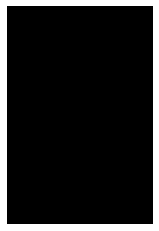

(640, 427, 3)
COCO_val2014_000000212605.jpg
{'person_bbx': [328.09, 29.21, 500.0, 494.38], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 0.11, 365.77, 473.26]}}
laptop
person
work_on_computer
work_on_computer interaction


(500, 500, 3)
COCO_val2014_000000249046.jpg
{'person_bbx': [295.82, 47.36, 453.01, 252.72000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [267.71, 214.78, 463.46, 281.95]}}
person
snowboard
jump
jump interaction
{'person_bbx': [295.82, 47.36, 453.01, 252.72000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [267.71, 214.78, 463.46, 281.95]}}
person
snowboard
look
look interaction
{'person_bbx': [295.82, 47.36, 453.01, 252.72000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [267.71, 214.78, 463.46, 281.95]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [295.82, 47.36, 453.01, 252.72000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000357743.jpg
{'person_bbx': [0.0, 64.79, 431.46, 467.13], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [266.99, 212.35, 294.93, 318.39]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 64.79, 431.46, 467.13], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [294.73, 194.03, 335.12, 259.61]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 64.79, 431.46, 467.13], 'Verbs': 'hold', 'object': {'obj_bbx': [266.99, 212.35, 294.93, 318.39]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 64.79, 431.46, 467.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 64.79, 431.46, 467.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000102872.jpg
{'person_bbx': [356.5, 79.86, 513.36, 418.3], 'Verbs': 'hold', 'object': {'obj_bbx': [272.39, 281.89, 371.07, 304.71999999999997]}}
person
cake
hold
hold interaction
{'person_bbx': [356.5, 79.86, 513.36, 418.3], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [356.5, 79.86, 513.36, 418.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000467752.jpg
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [139.88, 220.8, 233.16, 247.97000000000003]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [303.41, 107.26, 314.39000000000004, 119.7]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 'Verbs': 'hold', 'object': {'obj_bbx': [139.88, 220.8, 233.16, 247.97000000000003]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 'Verbs': 'look', 'object': {'obj_bbx': [303.41, 107.26, 314.39000000000004, 119.7]}}
sports ball
person
look
look interaction
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [213.96, 131.76, 352.45000000000005, 417.36], 

(426, 640, 3)
COCO_val2014_000000079113.jpg
{'person_bbx': [247.49, 2.85, 640.0, 423.76000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [12.41, 110.3, 352.38000000000005, 419.7]}}
person
laptop
look
look interaction
{'person_bbx': [247.49, 2.85, 640.0, 423.76000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [247.49, 2.85, 640.0, 423.76000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [12.41, 110.3, 352.38000000000005, 419.7]}}
person
laptop
work_on_computer
work_on_computer interaction


(424, 640, 3)
COCO_val2014_000000130262.jpg
{'person_bbx': [543.01, 254.79, 639.18, 281.78999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [317.06, 200.38, 358.77, 279.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [317.06, 200.38, 358.77, 279.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [317.06, 200.38, 358.77, 279.63], 'Verbs': 'surf', 'object': {'obj_bbx': [283.85, 269.99, 358.42, 282.87]}}
person
surfboard
surf
surf interaction
{'person_bbx': [543.01, 254.79, 639.18, 281.78999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [526.06, 271.47, 640.0, 286.08000000000004]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000470161.jpg
{'person_bbx': [51.93, 14.91, 608.76, 390.94], 'Verbs': 'hold', 'object': {'obj_bbx': [39.34, 332.0, 130.5, 421.24]}}
person
book
hold
hold interaction
{'person_bbx': [51.93, 14.91, 608.76, 390.94], 'Verbs': 'lay', 'object': {'obj_bbx': [3.84, 93.08, 640.0, 419.32]}}
bed
person
lay
lay interaction
{'person_bbx': [51.93, 14.91, 608.76, 390.94], 'Verbs': 'look', 'object': {'obj_bbx': [39.34, 332.0, 130.5, 421.24]}}
person
book
look
look interaction


(427, 640, 3)
COCO_val2014_000000036614.jpg
{'person_bbx': [1.08, 99.41, 227.54000000000002, 474.30999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [6.47, 121.89, 129.44, 175.82]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [1.08, 99.41, 227.54000000000002, 474.30999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [6.47, 121.89, 129.44, 175.82]}}
person
pizza
hold
hold interaction
{'person_bbx': [1.08, 99.41, 227.54000000000002, 474.30999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000115870.jpg
{'person_bbx': [185.68, 243.13, 620.6600000000001, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [372.12, 354.5, 456.76, 407.15]}}
person
book
hold
hold interaction
{'person_bbx': [185.68, 243.13, 620.6600000000001, 426.0], 'Verbs': 'read', 'object': {'obj_bbx': [372.12, 354.5, 456.76, 407.15]}}
person
book
read
read interaction
{'person_bbx': [185.68, 243.13, 620.6600000000001, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': [337.64, 220.96, 639.53, 418.71000000000004]}}
person
couch
sit
sit interaction


(426, 640, 3)
COCO_val2014_000000245295.jpg
{'person_bbx': [106.09, 94.44, 310.15999999999997, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [285.5, 212.41, 372.65, 294.11]}}
laptop
person
look
look interaction
{'person_bbx': [106.09, 94.44, 310.15999999999997, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [106.09, 94.44, 310.15999999999997, 427.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [285.5, 212.41, 372.65, 294.11]}}
laptop
person
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000570060.jpg
{'person_bbx': [329.71, 76.69, 640.0, 314.36], 'Verbs': 'snowboard', 'object': {'obj_bbx': [4.78, 105.17, 451.84, 291.45]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000266977.jpg
{'person_bbx': [205.99, 408.84, 239.41000000000003, 503.58], 'Verbs': 'carry', 'object': {'obj_bbx': [203.31, 430.31, 264.47, 456.64]}}
person
surfboard
carry
carry interaction
{'person_bbx': [205.99, 408.84, 239.41000000000003, 503.58], 'Verbs': 'hold', 'object': {'obj_bbx': [203.31, 430.31, 264.47, 456.64]}}
person
surfboard
hold
hold interaction
{'person_bbx': [205.99, 408.84, 239.41000000000003, 503.58], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [205.99, 408.84, 239.41000000000003, 503.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [205.99, 408.84, 239.41000000000003, 503.58], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 425, 3)
COCO_val2014_000000242724.jpg
{'person_bbx': [330.75, 120.7, 403.87, 319.45], 'Verbs': 'ride', 'object': {'obj_bbx': [249.76, 174.83, 524.2, 325.92]}}
horse
person
ride
ride interaction
{'person_bbx': [105.76, 99.16, 220.76, 321.5], 'Verbs': 'ride', 'object': {'obj_bbx': [82.1, 141.16, 310.12, 336.11]}}
horse
person
ride
ride interaction
{'person_bbx': [330.75, 120.7, 403.87, 319.45], 'Verbs': 'sit', 'object': {'obj_bbx': [249.76, 174.83, 524.2, 325.92]}}
horse
person
sit
sit interaction
{'person_bbx': [105.76, 99.16, 220.76, 321.5], 'Verbs': 'sit', 'object': {'obj_bbx': [82.1, 141.16, 310.12, 336.11]}}
horse
person
sit
sit interaction
{'person_bbx': [330.75, 120.7, 403.87, 319.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000168617.jpg
{'person_bbx': [421.21, 69.37, 486.46, 183.55], 'Verbs': 'hold', 'object': {'obj_bbx': [422.58, 135.1, 477.44, 238.89]}}
horse
person
hold
hold interaction
{'person_bbx': [421.21, 69.37, 486.46, 183.55], 'Verbs': 'ride', 'object': {'obj_bbx': [422.58, 135.1, 477.44, 238.89]}}
horse
person
ride
ride interaction
{'person_bbx': [269.49, 61.41, 326.23, 168.87], 'Verbs': 'ride', 'object': {'obj_bbx': [234.21, 80.66, 367.94, 226.32]}}
horse
person
ride
ride interaction
{'person_bbx': [421.21, 69.37, 486.46, 183.55], 'Verbs': 'sit', 'object': {'obj_bbx': [422.58, 135.1, 477.44, 238.89]}}
horse
person
sit
sit interaction
{'person_bbx': [269.49, 61.41, 326.23, 168.87], 'Verbs': 'sit', 'object': {'obj_bbx': [234.21, 80.66, 367.94, 226.32]}}
horse
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000060647.jpg
{'person_bbx': [0.0, 108.42, 99.62, 348.55], 'Verbs': 'look', 'object': {'obj_bbx': [289.1, 112.94, 439.32000000000005, 288.03999999999996]}}
person
person
look
look interaction
{'person_bbx': [289.1, 112.94, 439.32000000000005, 288.03999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [398.76, 145.15, 575.2, 345.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 108.42, 99.62, 348.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000043957.jpg
{'person_bbx': [121.35, 25.84, 410.11, 334.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 433, 3)
COCO_val2014_000000309692.jpg
{'person_bbx': [461.42, 189.99, 498.8, 350.78], 'Verbs': 'carry', 'object': {'obj_bbx': [487.35, 221.57, 520.6600000000001, 270.68]}}
person
backpack
carry
carry interaction
{'person_bbx': [461.42, 189.99, 498.8, 350.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [424.94, 184.9, 468.75, 370.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000351166.jpg
{'person_bbx': [203.77, 21.69, 487.89, 371.83], 'Verbs': 'lay', 'object': {'obj_bbx': [18.7, 19.06, 622.74, 623.0999999999999]}}
person
bed
lay
lay interaction
{'person_bbx': [203.77, 21.69, 487.89, 371.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 640, 3)
COCO_val2014_000000345252.jpg
{'person_bbx': [205.89, 28.92, 598.5899999999999, 478.54], 'Verbs': 'look', 'object': {'obj_bbx': [90.42, 104.68, 235.73000000000002, 276.90999999999997]}}
tv
person
look
look interaction
{'person_bbx': [205.89, 28.92, 598.5899999999999, 478.54], 'Verbs': 'sit', 'object': {'obj_bbx': [513.55, 290.66, 627.24, 479.0]}}
chair
person
sit
sit interaction
{'person_bbx': [205.89, 28.92, 598.5899999999999, 478.54], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [29.81, 149.38, 221.56, 295.68]}}
laptop
person
work_on_computer
work_on_computer interaction


(479, 640, 3)
COCO_val2014_000000154358.jpg
{'person_bbx': [20.57, 299.39, 71.97999999999999, 367.77], 'Verbs': 'hold', 'object': {'obj_bbx': [37.74, 314.55, 70.84, 329.24]}}
person
book
hold
hold interaction
{'person_bbx': [20.57, 299.39, 71.97999999999999, 367.77], 'Verbs': 'look', 'object': {'obj_bbx': [37.74, 314.55, 70.84, 329.24]}}
person
book
look
look interaction
{'person_bbx': [20.57, 299.39, 71.97999999999999, 367.77], 'Verbs': 'sit', 'object': {'obj_bbx': [1.88, 305.55, 79.49, 366.93]}}
chair
person
sit
sit interaction


(640, 427, 3)
COCO_val2014_000000303264.jpg
{'person_bbx': [23.6, 35.39, 93.53999999999999, 267.98], 'Verbs': 'carry', 'object': {'obj_bbx': [76.61, 73.08, 85.95, 88.39]}}
cell phone
person
carry
carry interaction
{'person_bbx': [23.6, 35.39, 93.53999999999999, 267.98], 'Verbs': 'hold', 'object': {'obj_bbx': [76.61, 73.08, 85.95, 88.39]}}
cell phone
person
hold
hold interaction
{'person_bbx': [23.6, 35.39, 93.53999999999999, 267.98], 'Verbs': 'look', 'object': {'obj_bbx': [76.61, 73.08, 85.95, 88.39]}}
cell phone
person
look
look interaction
{'person_bbx': [23.6, 35.39, 93.53999999999999, 267.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000330053.jpg
{'person_bbx': [83.22, 203.62, 122.13, 358.18], 'Verbs': 'carry', 'object': {'obj_bbx': [85.82, 293.85, 119.13999999999999, 332.13]}}
person
handbag
carry
carry interaction
{'person_bbx': [176.36, 169.06, 218.13000000000002, 290.34000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [201.38, 209.29, 233.18, 258.63]}}
person
handbag
carry
carry interaction
{'person_bbx': [83.22, 203.62, 122.13, 358.18], 'Verbs': 'hold', 'object': {'obj_bbx': [85.82, 293.85, 119.13999999999999, 332.13]}}
person
handbag
hold
hold interaction
{'person_bbx': [176.36, 169.06, 218.13000000000002, 290.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [201.38, 209.29, 233.18, 258.63]}}
person
handbag
hold
hold interaction
{'person_bbx': [83.22, 203.62, 122.13, 358.18], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [301.49, 163.19, 378.02, 287.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [83.

(428, 640, 3)
COCO_val2014_000000262048.jpg
{'person_bbx': [279.15, 358.17, 526.28, 561.06], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [23.46, 384.14, 313.32, 526.49], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(612, 612, 3)
COCO_val2014_000000299319.jpg
{'person_bbx': [255.0, 181.29, 319.12, 323.65999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [241.25, 150.49, 300.85, 250.77]}}
umbrella
person
carry
carry interaction
{'person_bbx': [349.1, 159.89, 398.29, 312.2], 'Verbs': 'carry', 'object': {'obj_bbx': [320.72, 131.23, 408.85, 216.46999999999997]}}
umbrella
person
carry
carry interaction
{'person_bbx': [255.0, 181.29, 319.12, 323.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [241.25, 150.49, 300.85, 250.77]}}
umbrella
person
hold
hold interaction
{'person_bbx': [349.1, 159.89, 398.29, 312.2], 'Verbs': 'hold', 'object': {'obj_bbx': [320.72, 131.23, 408.85, 216.46999999999997]}}
umbrella
person
hold
hold interaction
{'person_bbx': [255.0, 181.29, 319.12, 323.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [349.1, 159.89, 398.29, 312.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [255.0, 181.29, 319.12, 32

(421, 640, 3)
COCO_val2014_000000479633.jpg
{'person_bbx': [226.55, 45.98, 358.62, 282.17], 'Verbs': 'jump', 'object': {'obj_bbx': [273.82, 203.24, 368.31, 283.05]}}
person
skateboard
jump
jump interaction
{'person_bbx': [226.55, 45.98, 358.62, 282.17], 'Verbs': 'look', 'object': {'obj_bbx': [273.82, 203.24, 368.31, 283.05]}}
person
skateboard
look
look interaction
{'person_bbx': [226.55, 45.98, 358.62, 282.17], 'Verbs': 'skateboard', 'object': {'obj_bbx': [273.82, 203.24, 368.31, 283.05]}}
person
skateboard
skateboard
skateboard interaction


(429, 640, 3)
COCO_val2014_000000478157.jpg
{'person_bbx': [351.35, 57.3, 592.4300000000001, 382.7], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [431.2, 108.57, 465.58, 149.73]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 182.65, 168.59, 474.73], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [99.62, 206.77, 133.42000000000002, 250.17000000000002]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [351.35, 57.3, 592.4300000000001, 382.7], 'Verbs': 'hold', 'object': {'obj_bbx': [431.2, 108.57, 465.58, 149.73]}}
person
hot dog
hold
hold interaction
{'person_bbx': [0.0, 182.65, 168.59, 474.73], 'Verbs': 'hold', 'object': {'obj_bbx': [99.62, 206.77, 133.42000000000002, 250.17000000000002]}}
person
hot dog
hold
hold interaction
{'person_bbx': [351.35, 57.3, 592.4300000000001, 382.7], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 182.65, 168.59, 474.73]}}
person
person
look
look interaction
{'person_bbx': [351.35, 57.3, 592.4300000000001, 382.7], 'Verbs': 'sit', 'object

(480, 640, 3)
COCO_val2014_000000278462.jpg
{'person_bbx': [276.93, 82.12, 374.92, 145.53], 'Verbs': 'hold', 'object': {'obj_bbx': [279.48, 141.71, 330.14, 150.12]}}
person
surfboard
hold
hold interaction
{'person_bbx': [276.93, 82.12, 374.92, 145.53], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [276.93, 82.12, 374.92, 145.53], 'Verbs': 'surf', 'object': {'obj_bbx': [279.48, 141.71, 330.14, 150.12]}}
person
surfboard
surf
surf interaction


(278, 640, 3)
COCO_val2014_000000461751.jpg
{'person_bbx': [47.97, 112.06, 339.79999999999995, 477.18], 'Verbs': 'hold', 'object': {'obj_bbx': [1.28, 202.03, 640.0, 569.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [47.97, 112.06, 339.79999999999995, 477.18], 'Verbs': 'ride', 'object': {'obj_bbx': [1.28, 202.03, 640.0, 569.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [47.97, 112.06, 339.79999999999995, 477.18], 'Verbs': 'sit', 'object': {'obj_bbx': [1.28, 202.03, 640.0, 569.0]}}
motorcycle
person
sit
sit interaction


(569, 640, 3)
COCO_val2014_000000564091.jpg
{'person_bbx': [9.78, 0.0, 324.47999999999996, 370.79], 'Verbs': 'hold', 'object': {'obj_bbx': [170.26, 264.55, 208.08999999999997, 339.48]}}
bottle
person
hold
hold interaction
{'person_bbx': [9.78, 0.0, 324.47999999999996, 370.79], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [9.78, 0.0, 324.47999999999996, 370.79], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [219.99, 55.05, 250.33, 91.57]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000468197.jpg
{'person_bbx': [161.4, 101.24, 410.67, 250.21999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [114.41, 267.93, 214.48, 289.21000000000004]}}
surfboard
person
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000342013.jpg
{'person_bbx': [202.11, 126.1, 358.22, 268.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [202.11, 126.1, 358.22, 268.36], 'Verbs': 'surf', 'object': {'obj_bbx': [225.95, 258.5, 402.11, 308.28]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000565957.jpg
{'person_bbx': [252.59, 93.57, 459.4, 426.65], 'Verbs': 'hold', 'object': {'obj_bbx': [304.58, 134.66, 323.71999999999997, 174.16]}}
person
cell phone
hold
hold interaction
{'person_bbx': [252.59, 93.57, 459.4, 426.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [252.59, 93.57, 459.4, 426.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.59, 93.57, 459.4, 426.65], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [304.58, 134.66, 323.71999999999997, 174.16]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000099798.jpg
{'person_bbx': [123.04, 157.77, 447.94, 497.14], 'Verbs': 'kick', 'object': {'obj_bbx': [279.15, 462.49, 327.42999999999995, 508.6]}}
sports ball
person
kick
kick interaction
{'person_bbx': [123.04, 157.77, 447.94, 497.14], 'Verbs': 'look', 'object': {'obj_bbx': [279.15, 462.49, 327.42999999999995, 508.6]}}
sports ball
person
look
look interaction
{'person_bbx': [123.04, 157.77, 447.94, 497.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [123.04, 157.77, 447.94, 497.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 582, 3)
COCO_val2014_000000199553.jpg
{'person_bbx': [117.93, 50.34, 316.4, 573.84], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [117.93, 50.34, 316.4, 573.84], 'Verbs': 'ski', 'object': {'obj_bbx': [31.64, 504.57, 427.0, 577.92]}}
person
skis
ski
ski interaction
{'person_bbx': [117.93, 50.34, 316.4, 573.84], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [117.93, 50.34, 316.4, 573.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000494218.jpg
{'person_bbx': [0.84, 0.0, 347.13, 184.12], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [281.0, 184.0, 356.0, 225.0]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.84, 0.0, 347.13, 184.12], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [248.4, 151.63, 317.32, 219.13]}}
person
orange
cut_obj
cut_obj interaction
{'person_bbx': [0.84, 0.0, 347.13, 184.12], 'Verbs': 'hold', 'object': {'obj_bbx': [281.0, 184.0, 356.0, 225.0]}}
person
knife
hold
hold interaction
{'person_bbx': [0.84, 0.0, 347.13, 184.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000266160.jpg
{'person_bbx': [233.0, 66.1, 448.0, 307.1], 'Verbs': 'hold', 'object': {'obj_bbx': [212.95, 146.4, 466.92999999999995, 300.56]}}
person
surfboard
hold
hold interaction
{'person_bbx': [233.0, 66.1, 448.0, 307.1], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [233.0, 66.1, 448.0, 307.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [233.0, 66.1, 448.0, 307.1], 'Verbs': 'surf', 'object': {'obj_bbx': [212.95, 146.4, 466.92999999999995, 300.56]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000420411.jpg
{'person_bbx': [254.85, 216.47, 605.64, 475.62], 'Verbs': 'jump', 'object': {'obj_bbx': [370.45, 473.34, 454.48, 564.15]}}
person
skateboard
jump
jump interaction
{'person_bbx': [254.85, 216.47, 605.64, 475.62], 'Verbs': 'look', 'object': {'obj_bbx': [370.45, 473.34, 454.48, 564.15]}}
person
skateboard
look
look interaction
{'person_bbx': [254.85, 216.47, 605.64, 475.62], 'Verbs': 'skateboard', 'object': {'obj_bbx': [370.45, 473.34, 454.48, 564.15]}}
person
skateboard
skateboard
skateboard interaction


(640, 640, 3)
COCO_val2014_000000520150.jpg
{'person_bbx': [115.84, 25.32, 307.27, 345.59], 'Verbs': 'hold', 'object': {'obj_bbx': [134.93, 205.95, 322.57, 271.27]}}
person
book
hold
hold interaction
{'person_bbx': [115.84, 25.32, 307.27, 345.59], 'Verbs': 'look', 'object': {'obj_bbx': [134.93, 205.95, 322.57, 271.27]}}
person
book
look
look interaction
{'person_bbx': [115.84, 25.32, 307.27, 345.59], 'Verbs': 'read', 'object': {'obj_bbx': [134.93, 205.95, 322.57, 271.27]}}
person
book
read
read interaction
{'person_bbx': [115.84, 25.32, 307.27, 345.59], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 194.71, 449.66, 370.05]}}
bed
person
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000569437.jpg
{'person_bbx': [67.82, 45.88, 236.69, 236.59], 'Verbs': 'hold', 'object': {'obj_bbx': [79.28, 180.88, 150.54000000000002, 245.61]}}
skateboard
person
hold
hold interaction
{'person_bbx': [67.82, 45.88, 236.69, 236.59], 'Verbs': 'jump', 'object': {'obj_bbx': [79.28, 180.88, 150.54000000000002, 245.61]}}
skateboard
person
jump
jump interaction
{'person_bbx': [67.82, 45.88, 236.69, 236.59], 'Verbs': 'skateboard', 'object': {'obj_bbx': [79.28, 180.88, 150.54000000000002, 245.61]}}
skateboard
person
skateboard
skateboard interaction


(500, 333, 3)
COCO_val2014_000000392443.jpg
{'person_bbx': [190.13, 123.11, 348.34000000000003, 314.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [190.13, 123.11, 348.34000000000003, 314.88], 'Verbs': 'surf', 'object': {'obj_bbx': [166.13, 244.09, 238.25, 361.54]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000020410.jpg
{'person_bbx': [52.85, 0.0, 499.42, 394.79], 'Verbs': 'jump', 'object': {'obj_bbx': [273.98, 344.36, 515.6, 428.49]}}
person
skateboard
jump
jump interaction
{'person_bbx': [52.85, 0.0, 499.42, 394.79], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [52.85, 0.0, 499.42, 394.79], 'Verbs': 'skateboard', 'object': {'obj_bbx': [273.98, 344.36, 515.6, 428.49]}}
person
skateboard
skateboard
skateboard interaction


(480, 640, 3)
COCO_val2014_000000398798.jpg
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [143.27, 65.34, 179.77, 177.64]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [181.73, 68.09, 194.63, 80.58]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'hold', 'object': {'obj_bbx': [143.27, 65.34, 179.77, 177.64]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'look', 'object': {'obj_bbx': [181.73, 68.09, 194.63, 80.58]}}
sports ball
person
look
look interaction
{'person_bbx': [83.84, 151.21, 227.74, 557.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 276, 3)
COCO_val2014_000000151330.jpg
{'person_bbx': [293.23, 21.98, 524.6, 509.92], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 236.82, 640.0, 507.21]}}
person
surfboard
carry
carry interaction
{'person_bbx': [293.23, 21.98, 524.6, 509.92], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 236.82, 640.0, 507.21]}}
person
surfboard
hold
hold interaction
{'person_bbx': [293.23, 21.98, 524.6, 509.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000508605.jpg
{'person_bbx': [79.47, 213.87, 185.26, 350.34000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [112.46, 328.47, 183.73, 363.04]}}
person
skateboard
jump
jump interaction
{'person_bbx': [79.47, 213.87, 185.26, 350.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [112.46, 328.47, 183.73, 363.04]}}
person
skateboard
look
look interaction
{'person_bbx': [79.47, 213.87, 185.26, 350.34000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [112.46, 328.47, 183.73, 363.04]}}
person
skateboard
skateboard
skateboard interaction


(640, 426, 3)
COCO_val2014_000000304008.jpg
{'person_bbx': [274.77, 38.25, 570.6099999999999, 401.1], 'Verbs': 'look', 'object': {'obj_bbx': [249.67, 184.38, 304.02, 197.04999999999998]}}
person
frisbee
look
look interaction
{'person_bbx': [274.77, 38.25, 570.6099999999999, 401.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [274.77, 38.25, 570.6099999999999, 401.1], 'Verbs': 'throw', 'object': {'obj_bbx': [249.67, 184.38, 304.02, 197.04999999999998]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000522371.jpg
{'person_bbx': [167.58, 184.56, 312.05, 511.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [79.53, 209.86, 192.44, 542.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [167.58, 184.56, 312.05, 511.06], 'Verbs': 'ski', 'object': {'obj_bbx': [212.85, 435.87, 381.12, 559.56]}}
person
skis
ski
ski interaction
{'person_bbx': [79.53, 209.86, 192.44, 542.21], 'Verbs': 'ski', 'object': {'obj_bbx': [63.77, 479.85, 279.39, 579.7]}}
person
skis
ski
ski interaction
{'person_bbx': [167.58, 184.56, 312.05, 511.06], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [79.53, 209.86, 192.44, 542.21], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [167.58, 184.56, 312.05, 511.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [79.53, 209.86, 192.44, 542.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 383, 3)
COCO_val2014_000000064889.jpg
{'person_bbx': [268.01, 89.87, 323.39, 206.26], 'Verbs': 'hold', 'object': {'obj_bbx': [247.46, 142.23, 270.75, 160.32999999999998]}}
person
frisbee
hold
hold interaction
{'person_bbx': [81.36, 100.64, 141.87, 247.39999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [81.36, 100.64, 141.87, 247.39999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [344.89, 127.32, 424.96999999999997, 225.14999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [268.01, 89.87, 323.39, 206.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(331, 500, 3)
COCO_val2014_000000322604.jpg
{'person_bbx': [304.88, 144.54, 443.44, 405.76], 'Verbs': 'hold', 'object': {'obj_bbx': [153.89, 177.93, 581.89, 428.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [400.0, 91.51, 532.64, 374.03], 'Verbs': 'hold', 'object': {'obj_bbx': [153.89, 177.93, 581.89, 428.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [304.88, 144.54, 443.44, 405.76], 'Verbs': 'ride', 'object': {'obj_bbx': [153.89, 177.93, 581.89, 428.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [400.0, 91.51, 532.64, 374.03], 'Verbs': 'ride', 'object': {'obj_bbx': [153.89, 177.93, 581.89, 428.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [143.55, 132.99, 247.5, 338.17], 'Verbs': 'ride', 'object': {'obj_bbx': [0.2, 198.61, 239.89999999999998, 378.77]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [304.88, 144.54, 443.44, 405.76], 'Verbs': 'sit', 'object': {'obj_bbx': [153.89, 177.93, 581.89, 428.0]}}
motorcycle
person
si

(428, 640, 3)
COCO_val2014_000000303556.jpg
{'person_bbx': [158.74, 168.25, 278.51, 376.41999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [158.74, 168.25, 278.51, 376.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [308.75, 172.21, 341.5, 269.68]}}
person
person
look
look interaction
{'person_bbx': [158.74, 168.25, 278.51, 376.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(423, 640, 3)
COCO_val2014_000000449039.jpg
{'person_bbx': [499.1, 49.02, 586.9300000000001, 189.29000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [397.96, 98.08, 631.8299999999999, 262.9]}}
person
horse
hold
hold interaction
{'person_bbx': [499.1, 49.02, 586.9300000000001, 189.29000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [397.96, 98.08, 631.8299999999999, 262.9]}}
person
horse
ride
ride interaction
{'person_bbx': [174.99, 11.58, 260.1, 175.67000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [26.12, 67.59, 338.26, 289.61]}}
horse
person
ride
ride interaction
{'person_bbx': [499.1, 49.02, 586.9300000000001, 189.29000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [397.96, 98.08, 631.8299999999999, 262.9]}}
person
horse
sit
sit interaction
{'person_bbx': [174.99, 11.58, 260.1, 175.67000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [26.12, 67.59, 338.26, 289.61]}}
horse
person
sit
sit interaction


(303, 640, 3)
COCO_val2014_000000538115.jpg
{'person_bbx': [235.97, 43.75, 460.96000000000004, 312.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [10.06, 62.19, 182.92000000000002, 359.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [235.97, 43.75, 460.96000000000004, 312.64], 'Verbs': 'look', 'object': {'obj_bbx': [233.58, 272.58, 485.33000000000004, 333.78]}}
person
skis
look
look interaction
{'person_bbx': [235.97, 43.75, 460.96000000000004, 312.64], 'Verbs': 'ski', 'object': {'obj_bbx': [233.58, 272.58, 485.33000000000004, 333.78]}}
person
skis
ski
ski interaction
{'person_bbx': [10.06, 62.19, 182.92000000000002, 359.44], 'Verbs': 'ski', 'object': {'obj_bbx': [109.71, 333.62, 145.72, 354.62]}}
person
skis
ski
ski interaction
{'person_bbx': [10.06, 62.19, 182.92000000000002, 359.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(407, 640, 3)
COCO_val2014_000000111910.jpg
{'person_bbx': [243.78, 82.78, 456.08000000000004, 275.78], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [243.78, 82.78, 456.08000000000004, 275.78], 'Verbs': 'snowboard', 'object': {'obj_bbx': [110.47, 262.49, 602.01, 348.64]}}
person
snowboard
snowboard
snowboard interaction


(451, 640, 3)
COCO_val2014_000000224693.jpg
{'person_bbx': [86.75, 39.28, 309.40999999999997, 376.64], 'Verbs': 'kick', 'object': {'obj_bbx': [280.87, 225.22, 339.19, 283.25]}}
person
sports ball
kick
kick interaction
{'person_bbx': [392.8, 53.36, 549.69, 374.39], 'Verbs': 'kick', 'object': {'obj_bbx': [280.87, 225.22, 339.19, 283.25]}}
person
sports ball
kick
kick interaction
{'person_bbx': [86.75, 39.28, 309.40999999999997, 376.64], 'Verbs': 'look', 'object': {'obj_bbx': [280.87, 225.22, 339.19, 283.25]}}
person
sports ball
look
look interaction
{'person_bbx': [392.8, 53.36, 549.69, 374.39], 'Verbs': 'look', 'object': {'obj_bbx': [280.87, 225.22, 339.19, 283.25]}}
person
sports ball
look
look interaction
{'person_bbx': [86.75, 39.28, 309.40999999999997, 376.64], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [392.8, 53.36, 549.69, 374.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [86.75, 39.28, 309.40999999999997, 376.64], 'Verbs': 's

(427, 640, 3)
COCO_val2014_000000335587.jpg
{'person_bbx': [52.01, 75.38, 367.98, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [52.01, 75.38, 367.98, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 434, 3)
COCO_val2014_000000379488.jpg
{'person_bbx': [349.98, 139.23, 421.20000000000005, 220.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [349.98, 139.23, 421.20000000000005, 220.82], 'Verbs': 'surf', 'object': {'obj_bbx': [319.15, 208.29, 415.96999999999997, 228.85999999999999]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000266981.jpg
{'person_bbx': [184.42, 415.02, 286.95, 572.16], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [339.61, 378.91, 412.69, 583.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [184.42, 415.02, 286.95, 572.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [339.61, 378.91, 412.69, 583.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [339.61, 378.91, 412.69, 583.78], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 426, 3)
COCO_val2014_000000555396.jpg
{'person_bbx': [0.0, 62.24, 401.05, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 62.24, 401.05, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000307611.jpg
{'person_bbx': [175.07, 248.57, 345.69, 408.19], 'Verbs': 'look', 'object': {'obj_bbx': [146.81, 340.64, 284.03, 419.32]}}
person
laptop
look
look interaction
{'person_bbx': [337.76, 261.96, 433.71999999999997, 407.80999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [383.82, 323.21, 526.79, 423.0]}}
person
laptop
look
look interaction
{'person_bbx': [175.07, 248.57, 345.69, 408.19], 'Verbs': 'sit', 'object': {'obj_bbx': [59.49, 336.8, 593.96, 422.20000000000005]}}
bed
person
sit
sit interaction
{'person_bbx': [337.76, 261.96, 433.71999999999997, 407.80999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [59.49, 336.8, 593.96, 422.20000000000005]}}
bed
person
sit
sit interaction
{'person_bbx': [175.07, 248.57, 345.69, 408.19], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [146.81, 340.64, 284.03, 419.32]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [337.76, 261.96, 433.71999999999997, 407.80999999999995

(427, 640, 3)
COCO_val2014_000000341868.jpg
{'person_bbx': [188.02, 501.84, 255.05, 564.51], 'Verbs': 'look', 'object': {'obj_bbx': [202.79, 199.91, 362.42999999999995, 555.15]}}
boat
person
look
look interaction
{'person_bbx': [188.02, 501.84, 255.05, 564.51], 'Verbs': 'ride', 'object': {'obj_bbx': [174.02, 540.76, 307.78, 591.1]}}
boat
person
ride
ride interaction
{'person_bbx': [188.02, 501.84, 255.05, 564.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [274.79, 477.88, 350.67, 530.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 468, 3)
COCO_val2014_000000299207.jpg
{'person_bbx': [73.35, 11.87, 302.02, 474.61], 'Verbs': 'carry', 'object': {'obj_bbx': [84.45, 276.89, 184.07, 371.44]}}
person
handbag
carry
carry interaction
{'person_bbx': [73.35, 11.87, 302.02, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [84.45, 276.89, 184.07, 371.44]}}
person
handbag
hold
hold interaction
{'person_bbx': [73.35, 11.87, 302.02, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [73.35, 11.87, 302.02, 474.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000270097.jpg
{'person_bbx': [310.66, 120.47, 521.29, 348.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [261.61, 190.44, 404.92, 354.9]}}
person
laptop
look
look interaction
{'person_bbx': [310.66, 120.47, 521.29, 348.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(428, 640, 3)
COCO_val2014_000000025846.jpg
{'person_bbx': [83.67, 378.83, 259.22, 478.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [169.72, 1.07, 546.75, 327.62]}}
laptop
person
work_on_computer
work_on_computer interaction


(478, 640, 3)
COCO_val2014_000000412419.jpg
{'person_bbx': [259.48, 151.38, 428.0, 340.96000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [401.89, 212.41, 471.03999999999996, 252.97]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [259.48, 151.38, 428.0, 340.96000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [563.3, 198.43, 581.3399999999999, 208.45000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [259.48, 151.38, 428.0, 340.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [401.89, 212.41, 471.03999999999996, 252.97]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [146.71, 203.51, 281.93, 332.45], 'Verbs': 'look', 'object': {'obj_bbx': [563.3, 198.43, 581.3399999999999, 208.45000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [259.48, 151.38, 428.0, 340.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [563.3, 198.43, 581.3399999999999, 208.45000000000002]}}
sports ball
perso

(428, 640, 3)
COCO_val2014_000000445041.jpg
{'person_bbx': [163.07, 94.76, 317.49, 400.38], 'Verbs': 'hold', 'object': {'obj_bbx': [95.51, 209.93, 366.28999999999996, 438.01]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [163.07, 94.76, 317.49, 400.38], 'Verbs': 'ride', 'object': {'obj_bbx': [95.51, 209.93, 366.28999999999996, 438.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [163.07, 94.76, 317.49, 400.38], 'Verbs': 'sit', 'object': {'obj_bbx': [95.51, 209.93, 366.28999999999996, 438.01]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [163.07, 94.76, 317.49, 400.38], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [231.2, 127.99, 248.57999999999998, 151.49]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(500, 482, 3)
COCO_val2014_000000088436.jpg
{'person_bbx': [48.76, 100.5, 214.54, 319.37], 'Verbs': 'hold', 'object': {'obj_bbx': [175.05, 152.14, 239.81, 241.09999999999997]}}
person
laptop
hold
hold interaction
{'person_bbx': [434.7, 117.24, 638.56, 348.07], 'Verbs': 'look', 'object': {'obj_bbx': [382.94, 195.62, 477.9, 303.19]}}
person
laptop
look
look interaction
{'person_bbx': [48.76, 100.5, 214.54, 319.37], 'Verbs': 'look', 'object': {'obj_bbx': [175.05, 152.14, 239.81, 241.09999999999997]}}
person
laptop
look
look interaction
{'person_bbx': [434.7, 117.24, 638.56, 348.07], 'Verbs': 'sit', 'object': {'obj_bbx': [554.81, 334.13, 640.0, 397.71]}}
person
chair
sit
sit interaction
{'person_bbx': [48.76, 100.5, 214.54, 319.37], 'Verbs': 'sit', 'object': {'obj_bbx': [5.02, 146.57, 55.31999999999999, 217.41]}}
chair
person
sit
sit interaction
{'person_bbx': [434.7, 117.24, 638.56, 348.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [382.94, 195.62, 477.9, 303.19]}}
person
laptop

(480, 640, 3)
COCO_val2014_000000126434.jpg
{'person_bbx': [379.14, 22.52, 545.25, 427.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [485.6, 137.76, 600.0500000000001, 223.29]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [379.14, 22.52, 545.25, 427.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [292.82, 192.64, 315.90999999999997, 210.20999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [379.14, 22.52, 545.25, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [485.6, 137.76, 600.0500000000001, 223.29]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [22.07, 182.15, 269.63, 421.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [292.82, 192.64, 315.90999999999997, 210.20999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [379.14, 22.52, 545.25, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [292.82, 192.64, 315.90999999999997, 210.20999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': 

(427, 640, 3)
COCO_val2014_000000012020.jpg
{'person_bbx': [193.39, 28.72, 401.15, 323.6], 'Verbs': 'hold', 'object': {'obj_bbx': [335.74, 92.44, 412.34000000000003, 226.02]}}
person
skateboard
hold
hold interaction
{'person_bbx': [193.39, 28.72, 401.15, 323.6], 'Verbs': 'jump', 'object': {'obj_bbx': [335.74, 92.44, 412.34000000000003, 226.02]}}
person
skateboard
jump
jump interaction
{'person_bbx': [193.39, 28.72, 401.15, 323.6], 'Verbs': 'look', 'object': {'obj_bbx': [335.74, 92.44, 412.34000000000003, 226.02]}}
person
skateboard
look
look interaction
{'person_bbx': [193.39, 28.72, 401.15, 323.6], 'Verbs': 'skateboard', 'object': {'obj_bbx': [335.74, 92.44, 412.34000000000003, 226.02]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000489339.jpg
{'person_bbx': [54.72, 90.72, 368.38, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 136.92, 426.0, 638.9399999999999]}}
person
surfboard
carry
carry interaction
{'person_bbx': [54.72, 90.72, 368.38, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 136.92, 426.0, 638.9399999999999]}}
person
surfboard
hold
hold interaction
{'person_bbx': [54.72, 90.72, 368.38, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [54.72, 90.72, 368.38, 640.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 426, 3)
COCO_val2014_000000017755.jpg
{'person_bbx': [75.88, 23.05, 329.31, 558.53], 'Verbs': 'skateboard', 'object': {'obj_bbx': [111.77, 420.18, 330.06, 585.2]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [75.88, 23.05, 329.31, 558.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000222781.jpg
{'person_bbx': [242.4, 107.09, 428.37, 317.65999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [155.2, 72.89, 256.73, 262.17], 'Verbs': 'catch', 'object': {'obj_bbx': [257.34, 53.52, 300.30999999999995, 80.73]}}
frisbee
person
catch
catch interaction
{'person_bbx': [242.4, 107.09, 428.37, 317.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [257.34, 53.52, 300.30999999999995, 80.73]}}
frisbee
person
look
look interaction
{'person_bbx': [155.2, 72.89, 256.73, 262.17], 'Verbs': 'look', 'object': {'obj_bbx': [257.34, 53.52, 300.30999999999995, 80.73]}}
frisbee
person
look
look interaction
{'person_bbx': [242.4, 107.09, 428.37, 317.65999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [155.2, 72.89, 256.73, 262.17], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [242.4, 107.09, 428.37, 317.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}

(322, 500, 3)
COCO_val2014_000000410496.jpg
{'person_bbx': [24.45, 92.04, 263.19, 618.43], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [18.94, 6.08, 102.19, 202.55]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [24.45, 92.04, 263.19, 618.43], 'Verbs': 'hold', 'object': {'obj_bbx': [18.94, 6.08, 102.19, 202.55]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [24.45, 92.04, 263.19, 618.43], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [24.45, 92.04, 263.19, 618.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000251317.jpg
{'person_bbx': [112.76, 58.22, 175.96, 232.04], 'Verbs': 'look', 'object': {'obj_bbx': [186.58, 81.41, 237.08, 111.92999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [194.68, 126.24, 330.56, 292.58], 'Verbs': 'look', 'object': {'obj_bbx': [186.58, 81.41, 237.08, 111.92999999999999]}}
person
frisbee
look
look interaction
{'person_bbx': [264.67, 151.36, 354.62, 321.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [112.76, 58.22, 175.96, 232.04], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [194.68, 126.24, 330.56, 292.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [112.76, 58.22, 175.96, 232.04], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [112.76, 58.22, 175.96, 232.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [264.67, 151.36, 354.62, 321.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}

(333, 500, 3)
COCO_val2014_000000554006.jpg
{'person_bbx': [148.61, 50.22, 312.27, 531.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [148.61, 50.22, 312.27, 531.52], 'Verbs': 'skateboard', 'object': {'obj_bbx': [117.11, 510.98, 348.59, 564.48]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [148.61, 50.22, 312.27, 531.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000565781.jpg
{'person_bbx': [72.11, 1.2, 622.48, 477.7], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [323.25, 219.31, 487.36, 368.81]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [72.11, 1.2, 622.48, 477.7], 'Verbs': 'hold', 'object': {'obj_bbx': [323.25, 219.31, 487.36, 368.81]}}
person
hot dog
hold
hold interaction
{'person_bbx': [72.11, 1.2, 622.48, 477.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000451879.jpg
{'person_bbx': [0.0, 88.74, 299.58, 431.82], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [0.0, 77.82, 135.92, 438.0], 'Verbs': 'catch', 'object': {'obj_bbx': [239.85, 14.64, 269.99, 43.68]}}
sports ball
person
catch
catch interaction
{'person_bbx': [0.0, 88.74, 299.58, 431.82], 'Verbs': 'look', 'object': {'obj_bbx': [239.85, 14.64, 269.99, 43.68]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 77.82, 135.92, 438.0], 'Verbs': 'look', 'object': {'obj_bbx': [239.85, 14.64, 269.99, 43.68]}}
sports ball
person
look
look interaction
{'person_bbx': [248.04, 130.91, 494.1, 432.09000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 88.74, 299.58, 431.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 77.82, 135.92, 438.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [248.04, 130.91, 494.1, 432.09000000000003],

(438, 500, 3)
COCO_val2014_000000423529.jpg
{'person_bbx': [284.03, 218.78, 370.39, 417.4], 'Verbs': 'look', 'object': {'obj_bbx': [272.57, 157.71, 345.2, 193.62]}}
person
frisbee
look
look interaction
{'person_bbx': [284.03, 218.78, 370.39, 417.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [284.03, 218.78, 370.39, 417.4], 'Verbs': 'throw', 'object': {'obj_bbx': [272.57, 157.71, 345.2, 193.62]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000442225.jpg
{'person_bbx': [2.88, 81.98, 391.19, 631.37], 'Verbs': 'hold', 'object': {'obj_bbx': [311.95, 259.12, 333.37, 276.63]}}
cell phone
person
hold
hold interaction
{'person_bbx': [2.88, 81.98, 391.19, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.88, 81.98, 391.19, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [2.88, 81.98, 391.19, 631.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.88, 81.98, 391.19, 631.37], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [311.95, 259.12, 333.37, 276.63]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 429, 3)
COCO_val2014_000000239857.jpg
{'person_bbx': [293.16, 121.59, 363.07000000000005, 272.68], 'Verbs': 'look', 'object': {'obj_bbx': [275.42, 141.61, 302.54, 158.56]}}
person
frisbee
look
look interaction
{'person_bbx': [293.16, 121.59, 363.07000000000005, 272.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [293.16, 121.59, 363.07000000000005, 272.68], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [293.16, 121.59, 363.07000000000005, 272.68], 'Verbs': 'throw', 'object': {'obj_bbx': [275.42, 141.61, 302.54, 158.56]}}
person
frisbee
throw
throw interaction


(333, 500, 3)
COCO_val2014_000000392391.jpg
{'person_bbx': [27.8, 163.34, 116.05, 339.1], 'Verbs': 'catch', 'object': {'obj_bbx': [44.86, 114.94, 96.35, 132.28]}}
person
frisbee
catch
catch interaction
{'person_bbx': [27.8, 163.34, 116.05, 339.1], 'Verbs': 'look', 'object': {'obj_bbx': [44.86, 114.94, 96.35, 132.28]}}
person
frisbee
look
look interaction
{'person_bbx': [27.8, 163.34, 116.05, 339.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(420, 640, 3)
COCO_val2014_000000232894.jpg


(360, 640, 3)
COCO_val2014_000000508288.jpg
{'person_bbx': [241.59, 113.52, 335.48, 236.03], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [241.59, 113.52, 335.48, 236.03], 'Verbs': 'surf', 'object': {'obj_bbx': [325.27, 156.9, 408.11, 243.88]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000120061.jpg
{'person_bbx': [210.61, 18.19, 527.47, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [210.61, 18.19, 527.47, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [210.61, 18.19, 527.47, 426.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000494855.jpg
{'person_bbx': [434.06, 223.4, 638.78, 373.75], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [272.19, 27.09, 504.28, 372.66999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [103.49, 111.57, 316.07, 185.31]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [272.19, 27.09, 504.28, 372.66999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [20.35, 32.24, 44.22, 50.84]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [272.19, 27.09, 504.28, 372.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [103.49, 111.57, 316.07, 185.31]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [434.06, 223.4, 638.78, 373.75], 'Verbs': 'look', 'object': {'obj_bbx': [20.35, 32.24, 44.22, 50.84]}}
person
sports ball
look
look interaction
{'person_bbx': [272.19, 27.09, 504.28, 372.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [20.35, 32.24, 44.22, 50.84]}}
person
sports 

(378, 640, 3)
COCO_val2014_000000129886.jpg
{'person_bbx': [612.02, 223.34, 640.0, 349.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [173.97, 236.54, 208.44, 311.23], 'Verbs': 'ski', 'object': {'obj_bbx': [161.39, 303.83, 215.29, 316.96]}}
person
skis
ski
ski interaction
{'person_bbx': [612.02, 223.34, 640.0, 349.64], 'Verbs': 'ski', 'object': {'obj_bbx': [615.23, 329.71, 640.0, 348.71]}}
person
skis
ski
ski interaction
{'person_bbx': [173.97, 236.54, 208.44, 311.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [612.02, 223.34, 640.0, 349.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000475182.jpg
{'person_bbx': [210.17, 148.47, 412.6, 396.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [210.17, 148.47, 412.6, 396.65], 'Verbs': 'throw', 'object': {'obj_bbx': [234.2, 315.26, 240.58999999999997, 325.62]}}
sports ball
person
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000008771.jpg
{'person_bbx': [157.05, 158.0, 316.5, 364.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [157.05, 158.0, 316.5, 364.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [157.05, 158.0, 316.5, 364.12], 'Verbs': 'snowboard', 'object': {'obj_bbx': [210.34, 308.49, 495.1, 395.87]}}
snowboard
person
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000019491.jpg
{'person_bbx': [5.38, 72.98, 333.0, 494.5], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [167.2, 257.77, 230.73999999999998, 354.21999999999997]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [5.38, 72.98, 333.0, 494.5], 'Verbs': 'hold', 'object': {'obj_bbx': [164.51, 256.95, 237.19, 383.49]}}
person
sandwich
hold
hold interaction
{'person_bbx': [5.38, 72.98, 333.0, 494.5], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 333, 3)
COCO_val2014_000000115912.jpg
{'person_bbx': [219.77, 86.63, 329.25, 209.58999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(399, 640, 3)
COCO_val2014_000000458255.jpg
{'person_bbx': [88.2, 181.38, 217.08999999999997, 326.01], 'Verbs': 'hold', 'object': {'obj_bbx': [181.73, 170.95, 249.76, 271.46]}}
person
book
hold
hold interaction
{'person_bbx': [88.2, 181.38, 217.08999999999997, 326.01], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 51.69, 637.65, 428.0]}}
person
bed
lay
lay interaction
{'person_bbx': [88.2, 181.38, 217.08999999999997, 326.01], 'Verbs': 'look', 'object': {'obj_bbx': [181.73, 170.95, 249.76, 271.46]}}
person
book
look
look interaction
{'person_bbx': [88.2, 181.38, 217.08999999999997, 326.01], 'Verbs': 'read', 'object': {'obj_bbx': [181.73, 170.95, 249.76, 271.46]}}
person
book
read
read interaction
{'person_bbx': [88.2, 181.38, 217.08999999999997, 326.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000316912.jpg
{'person_bbx': [13.13, 151.91, 85.96, 310.37], 'Verbs': 'hold', 'object': {'obj_bbx': [50.43, 150.9, 94.50999999999999, 304.94]}}
person
person
hold
hold interaction
{'person_bbx': [354.46, 160.27, 392.19, 308.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [282.3, 256.18, 345.51, 331.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [13.13, 151.91, 85.96, 310.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [50.43, 150.9, 94.50999999999999, 304.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [354.46, 160.27, 392.19, 308.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 194.81, 98.38, 370.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [13.13, 151.91, 85.96, 310.37], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [50.43, 15

(375, 500, 3)
COCO_val2014_000000326420.jpg
{'person_bbx': [100.75, 68.13, 440.43, 371.35], 'Verbs': 'hold', 'object': {'obj_bbx': [101.71, 85.4, 484.57, 372.31000000000006]}}
surfboard
person
hold
hold interaction
{'person_bbx': [100.75, 68.13, 440.43, 371.35], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [100.75, 68.13, 440.43, 371.35], 'Verbs': 'surf', 'object': {'obj_bbx': [101.71, 85.4, 484.57, 372.31000000000006]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000202799.jpg
{'person_bbx': [134.35, 0.0, 399.23, 214.38], 'Verbs': 'hold', 'object': {'obj_bbx': [239.16, 82.74, 461.15999999999997, 315.21999999999997]}}
person
skateboard
hold
hold interaction
{'person_bbx': [134.35, 0.0, 399.23, 214.38], 'Verbs': 'jump', 'object': {'obj_bbx': [239.16, 82.74, 461.15999999999997, 315.21999999999997]}}
person
skateboard
jump
jump interaction
{'person_bbx': [407.87, 33.29, 501.78, 359.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [239.16, 82.74, 461.15999999999997, 315.21999999999997]}}
person
skateboard
look
look interaction
{'person_bbx': [134.35, 0.0, 399.23, 214.38], 'Verbs': 'skateboard', 'object': {'obj_bbx': [239.16, 82.74, 461.15999999999997, 315.21999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [407.87, 33.29, 501.78, 359.59000000000003], 'Verbs': 'skateboard', 'object': {'obj_bbx': [446.82, 331.1, 503.73, 369.13]}}
person
skateboard
skateboard
skateboard interaction
{

(424, 640, 3)
COCO_val2014_000000160556.jpg
{'person_bbx': [453.97, 76.94, 638.63, 423.19], 'Verbs': 'hold', 'object': {'obj_bbx': [564.29, 141.62, 602.74, 185.36]}}
person
cell phone
hold
hold interaction
{'person_bbx': [453.97, 76.94, 638.63, 423.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [453.97, 76.94, 638.63, 423.19], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [564.29, 141.62, 602.74, 185.36]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [453.97, 76.94, 638.63, 423.19], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(428, 640, 3)
COCO_val2014_000000055780.jpg
{'person_bbx': [130.88, 205.22, 287.64, 628.05], 'Verbs': 'hold', 'object': {'obj_bbx': [235.31, 330.99, 315.47, 491.31]}}
dog
person
hold
hold interaction
{'person_bbx': [368.62, 120.45, 480.0, 632.74], 'Verbs': 'hold', 'object': {'obj_bbx': [399.9, 219.39, 480.0, 283.84]}}
person
dog
hold
hold interaction
{'person_bbx': [368.62, 120.45, 480.0, 632.74], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [130.88, 205.22, 287.64, 628.05], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [368.62, 120.45, 480.0, 632.74], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [130.88, 205.22, 287.64, 628.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [368.62, 120.45, 480.0, 632.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000576539.jpg
{'person_bbx': [53.03, 0.94, 374.92999999999995, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [155.53, 372.54, 258.23, 460.09000000000003]}}
person
donut
hold
hold interaction
{'person_bbx': [53.03, 0.94, 374.92999999999995, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 375, 3)
COCO_val2014_000000331604.jpg
{'person_bbx': [295.96, 149.79, 365.34, 291.38], 'Verbs': 'hold', 'object': {'obj_bbx': [260.95, 172.66, 378.41999999999996, 310.59000000000003]}}
surfboard
person
hold
hold interaction
{'person_bbx': [295.96, 149.79, 365.34, 291.38], 'Verbs': 'jump', 'object': {'obj_bbx': [260.95, 172.66, 378.41999999999996, 310.59000000000003]}}
surfboard
person
jump
jump interaction


(427, 640, 3)
COCO_val2014_000000409303.jpg
{'person_bbx': [343.75, 258.85, 383.69, 337.13], 'Verbs': 'ski', 'object': {'obj_bbx': [341.85, 332.67, 365.69, 340.96000000000004]}}
person
skis
ski
ski interaction
{'person_bbx': [343.75, 258.85, 383.69, 337.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000563909.jpg
{'person_bbx': [23.73, 44.22, 461.66, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [351.68, 310.26, 430.26, 415.69]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [23.73, 44.22, 461.66, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [351.68, 310.26, 430.26, 415.69]}}
sandwich
person
hold
hold interaction
{'person_bbx': [23.73, 44.22, 461.66, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [1.56, 293.54, 72.45, 457.16]}}
person
chair
sit
sit interaction
{'person_bbx': [23.73, 44.22, 461.66, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000246040.jpg
{'person_bbx': [218.5, 48.61, 613.0699999999999, 465.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [39.72, 35.18, 85.41, 76.0]}}
sports ball
person
look
look interaction
{'person_bbx': [218.5, 48.61, 613.0699999999999, 465.46000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [218.5, 48.61, 613.0699999999999, 465.46000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [39.72, 35.18, 85.41, 76.0]}}
sports ball
person
throw
throw interaction


(472, 640, 3)
COCO_val2014_000000052314.jpg
{'person_bbx': [188.19, 3.91, 531.12, 418.49], 'Verbs': 'jump', 'object': {'obj_bbx': [322.62, 239.45, 412.42, 427.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [188.19, 3.91, 531.12, 418.49], 'Verbs': 'look', 'object': {'obj_bbx': [322.62, 239.45, 412.42, 427.0]}}
person
skateboard
look
look interaction
{'person_bbx': [188.19, 3.91, 531.12, 418.49], 'Verbs': 'skateboard', 'object': {'obj_bbx': [322.62, 239.45, 412.42, 427.0]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000498940.jpg
{'person_bbx': [249.8, 68.98, 460.99, 467.52000000000004], 'Verbs': 'kick', 'object': {'obj_bbx': [181.36, 410.95, 240.54000000000002, 470.68]}}
sports ball
person
kick
kick interaction
{'person_bbx': [11.25, 121.16, 189.05, 494.75], 'Verbs': 'kick', 'object': {'obj_bbx': [181.36, 410.95, 240.54000000000002, 470.68]}}
sports ball
person
kick
kick interaction
{'person_bbx': [249.8, 68.98, 460.99, 467.52000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [181.36, 410.95, 240.54000000000002, 470.68]}}
sports ball
person
look
look interaction
{'person_bbx': [495.61, 45.98, 633.57, 423.32], 'Verbs': 'look', 'object': {'obj_bbx': [181.36, 410.95, 240.54000000000002, 470.68]}}
sports ball
person
look
look interaction
{'person_bbx': [11.25, 121.16, 189.05, 494.75], 'Verbs': 'look', 'object': {'obj_bbx': [181.36, 410.95, 240.54000000000002, 470.68]}}
sports ball
person
look
look interaction
{'person_bbx': [249.8, 68.98, 460.99, 467.52000000000004], 

(503, 640, 3)
COCO_val2014_000000492625.jpg
{'person_bbx': [510.64, 120.57, 640.0, 308.99], 'Verbs': 'look', 'object': {'obj_bbx': [227.72, 87.9, 420.0, 303.81]}}
person
person
look
look interaction
{'person_bbx': [227.72, 87.9, 420.0, 303.81], 'Verbs': 'sit', 'object': {'obj_bbx': [153.83, 167.1, 234.74, 209.97]}}
person
chair
sit
sit interaction
{'person_bbx': [510.64, 120.57, 640.0, 308.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [9.67, 39.74, 181.53, 380.25], 'Verbs': 'sit', 'object': {'obj_bbx': [1.07, 154.68, 52.63, 199.79000000000002]}}
person
chair
sit
sit interaction
{'person_bbx': [510.64, 120.57, 640.0, 308.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [9.67, 39.74, 181.53, 380.25], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(478, 640, 3)
COCO_val2014_000000449661.jpg
{'person_bbx': [368.0, 64.5, 447.5, 154.5], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(169, 640, 3)
COCO_val2014_000000116202.jpg
{'person_bbx': [56.67, 327.03, 152.29000000000002, 500.0], 'Verbs': 'look', 'object': {'obj_bbx': [93.86, 104.08, 192.48000000000002, 209.44]}}
person
person
look
look interaction
{'person_bbx': [6.35, 220.32, 130.19, 377.14], 'Verbs': 'look', 'object': {'obj_bbx': [93.86, 104.08, 192.48000000000002, 209.44]}}
person
person
look
look interaction
{'person_bbx': [6.35, 220.32, 130.19, 377.14], 'Verbs': 'skateboard', 'object': {'obj_bbx': [15.8, 304.33, 44.6, 353.96]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [56.67, 327.03, 152.29000000000002, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [6.35, 220.32, 130.19, 377.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000378894.jpg
{'person_bbx': [67.16, 95.57, 195.25, 514.97], 'Verbs': 'look', 'object': {'obj_bbx': [308.01, 177.12, 373.96, 234.47]}}
person
laptop
look
look interaction
{'person_bbx': [67.16, 95.57, 195.25, 514.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000523816.jpg
{'person_bbx': [11.24, 65.17, 287.64, 414.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [11.24, 65.17, 287.64, 414.61], 'Verbs': 'snowboard', 'object': {'obj_bbx': [54.79, 353.06, 331.96000000000004, 414.04]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [11.24, 65.17, 287.64, 414.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000518109.jpg
{'person_bbx': [0.0, 68.86, 270.6, 630.12], 'Verbs': 'look', 'object': {'obj_bbx': [192.72, 311.85, 457.35, 544.84]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 68.86, 270.6, 630.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 68.86, 270.6, 630.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [192.72, 311.85, 457.35, 544.84]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000368671.jpg
{'person_bbx': [385.08, 195.06, 503.73, 423.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [174.63, 245.23, 238.81, 451.97], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [227.01, 230.63, 324.87, 478.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [385.08, 195.06, 503.73, 423.73], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [174.63, 245.23, 238.81, 451.97], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [227.01, 230.63, 324.87, 478.9], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [385.08, 195.06, 503.73, 423.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [174.63, 245.23, 238.81, 451.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [227.01, 230.63, 324.87, 478.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000099218.jpg
{'person_bbx': [186.96, 95.2, 603.5, 602.47], 'Verbs': 'hold', 'object': {'obj_bbx': [70.21, 33.32, 319.55, 466.06]}}
person
kite
hold
hold interaction
{'person_bbx': [186.96, 95.2, 603.5, 602.47], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [186.96, 95.2, 603.5, 602.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(609, 640, 3)
COCO_val2014_000000413349.jpg
{'person_bbx': [97.3, 34.79, 445.01, 536.49], 'Verbs': 'jump', 'object': {'obj_bbx': [211.87, 409.49, 377.94, 568.16]}}
person
skateboard
jump
jump interaction
{'person_bbx': [97.3, 34.79, 445.01, 536.49], 'Verbs': 'look', 'object': {'obj_bbx': [211.87, 409.49, 377.94, 568.16]}}
person
skateboard
look
look interaction
{'person_bbx': [97.3, 34.79, 445.01, 536.49], 'Verbs': 'skateboard', 'object': {'obj_bbx': [211.87, 409.49, 377.94, 568.16]}}
person
skateboard
skateboard
skateboard interaction


(640, 640, 3)
COCO_val2014_000000534428.jpg
{'person_bbx': [233.01, 338.25, 270.23, 375.0], 'Verbs': 'carry', 'object': {'obj_bbx': [216.12, 301.17, 287.56, 340.3]}}
person
umbrella
carry
carry interaction
{'person_bbx': [310.37, 272.87, 347.8, 324.65], 'Verbs': 'carry', 'object': {'obj_bbx': [304.38, 245.61, 351.14, 272.76]}}
person
umbrella
carry
carry interaction
{'person_bbx': [233.01, 338.25, 270.23, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [216.12, 301.17, 287.56, 340.3]}}
person
umbrella
hold
hold interaction
{'person_bbx': [310.37, 272.87, 347.8, 324.65], 'Verbs': 'hold', 'object': {'obj_bbx': [327.82, 279.79, 344.7, 301.8]}}
person
handbag
hold
hold interaction
{'person_bbx': [310.37, 272.87, 347.8, 324.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [233.01, 338.25, 270.23, 375.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [310.37, 272.87, 347.8, 324.65], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000153520.jpg
{'person_bbx': [71.19, 23.73, 378.61, 474.61], 'Verbs': 'catch', 'object': {'obj_bbx': [232.61, 251.24, 391.74, 368.46000000000004]}}
person
frisbee
catch
catch interaction
{'person_bbx': [71.19, 23.73, 378.61, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [232.61, 251.24, 391.74, 368.46000000000004]}}
person
frisbee
hold
hold interaction
{'person_bbx': [71.19, 23.73, 378.61, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [232.61, 251.24, 391.74, 368.46000000000004]}}
person
frisbee
look
look interaction
{'person_bbx': [71.19, 23.73, 378.61, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [71.19, 23.73, 378.61, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000349437.jpg
{'person_bbx': [127.62, 65.36, 271.55, 341.71000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [201.56, 56.45, 348.67, 425.27]}}
person
person
hold
hold interaction
{'person_bbx': [201.56, 56.45, 348.67, 425.27], 'Verbs': 'hold', 'object': {'obj_bbx': [38.38, 145.85, 497.05, 413.57000000000005]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [127.62, 65.36, 271.55, 341.71000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [38.38, 145.85, 497.05, 413.57000000000005]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [201.56, 56.45, 348.67, 425.27], 'Verbs': 'ride', 'object': {'obj_bbx': [38.38, 145.85, 497.05, 413.57000000000005]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [127.62, 65.36, 271.55, 341.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [38.38, 145.85, 497.05, 413.57000000000005]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [201.56, 56.45, 348.67, 425.27], 'Verbs': 'sit', 'object': 

(427, 640, 3)
COCO_val2014_000000334767.jpg
{'person_bbx': [257.98, 60.6, 331.79, 196.35999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.75, 70.13, 159.75, 241.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [450.03, 60.12, 500.0, 175.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [140.23, 71.63, 218.04, 231.82999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [369.14, 67.2, 420.77, 204.01], 'Verbs': 'hold', 'object': {'obj_bbx': [378.32, 191.37, 411.43, 201.35]}}
skis
person
hold
hold interaction
{'person_bbx': [257.98, 60.6, 331.79, 196.35999999999999], 'Verbs': 'ski', 'object': {'obj_bbx': [259.87, 183.95, 354.67, 198.53]}}
person
skis
ski
ski interaction
{'person_bbx': [60.75, 70.13, 159.75, 241.13], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [450.03, 60.12, 500.0, 175.65], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
sk

(333, 500, 3)
COCO_val2014_000000054671.jpg
{'person_bbx': [292.05, 135.7, 462.76, 249.24], 'Verbs': 'lay', 'object': {'obj_bbx': [3.81, 146.77, 570.8599999999999, 421.24]}}
bed
person
lay
lay interaction
{'person_bbx': [216.27, 126.15, 316.77, 248.61], 'Verbs': 'lay', 'object': {'obj_bbx': [3.81, 146.77, 570.8599999999999, 421.24]}}
bed
person
lay
lay interaction
{'person_bbx': [216.27, 126.15, 316.77, 248.61], 'Verbs': 'sit', 'object': {'obj_bbx': [3.81, 146.77, 570.8599999999999, 421.24]}}
bed
person
sit
sit interaction
{'person_bbx': [292.05, 135.7, 462.76, 249.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000488977.jpg
{'person_bbx': [249.17, 46.2, 605.12, 340.67], 'Verbs': 'look', 'object': {'obj_bbx': [132.51, 264.65, 289.08, 317.30999999999995]}}
person
keyboard
look
look interaction
{'person_bbx': [249.17, 46.2, 605.12, 340.67], 'Verbs': 'sit', 'object': {'obj_bbx': [1.08, 155.76, 597.0200000000001, 474.31]}}
bed
person
sit
sit interaction
{'person_bbx': [249.17, 46.2, 605.12, 340.67], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.08, 85.21, 335.46, 352.71999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000493628.jpg
{'person_bbx': [66.21, 11.58, 640.0, 420.34999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': [3.83, 233.56, 602.2, 422.17]}}
bed
person
lay
lay interaction


(427, 640, 3)
COCO_val2014_000000517636.jpg
{'person_bbx': [289.55, 182.99, 461.78, 413.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [291.93, 359.05, 458.6, 428.44]}}
person
surfboard
hold
hold interaction
{'person_bbx': [289.55, 182.99, 461.78, 413.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [289.55, 182.99, 461.78, 413.34000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [291.93, 359.05, 458.6, 428.44]}}
person
surfboard
surf
surf interaction


(479, 640, 3)
COCO_val2014_000000360767.jpg
{'person_bbx': [251.31, 332.15, 309.81, 436.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [256.88, 411.99, 309.35, 502.11]}}
bicycle
person
hold
hold interaction
{'person_bbx': [178.3, 306.01, 229.68, 440.96], 'Verbs': 'hold', 'object': {'obj_bbx': [199.04, 377.81, 211.01999999999998, 449.7]}}
bicycle
person
hold
hold interaction
{'person_bbx': [220.03, 257.1, 261.68, 347.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [178.3, 306.01, 229.68, 440.96], 'Verbs': 'look', 'object': {'obj_bbx': [375.63, 207.17, 480.0, 427.29999999999995]}}
boat
person
look
look interaction
{'person_bbx': [220.03, 257.1, 261.68, 347.12], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [251.31, 332.15, 309.81, 436.91999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [256.88, 411.99, 309.35, 502.11]}}
bicycle
person
ride
ride interaction
{'person_bbx': [178.3, 306.01, 229.68, 440.96], 'Verbs': 'ride', 'o

(640, 480, 3)
COCO_val2014_000000077596.jpg
{'person_bbx': [49.51, 165.03, 223.28, 426.17999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [186.7, 282.95, 301.90999999999997, 422.39]}}
person
surfboard
carry
carry interaction
{'person_bbx': [413.47, 202.22, 576.33, 426.51], 'Verbs': 'carry', 'object': {'obj_bbx': [406.76, 300.91, 640.0, 432.0]}}
person
surfboard
carry
carry interaction
{'person_bbx': [49.51, 165.03, 223.28, 426.17999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [186.7, 282.95, 301.90999999999997, 422.39]}}
person
surfboard
hold
hold interaction
{'person_bbx': [413.47, 202.22, 576.33, 426.51], 'Verbs': 'hold', 'object': {'obj_bbx': [406.76, 300.91, 640.0, 432.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [49.51, 165.03, 223.28, 426.17999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [413.47, 202.22, 576.33, 426.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [49.51, 165.03, 223.28

(432, 640, 3)
COCO_val2014_000000490683.jpg
{'person_bbx': [7.64, 195.75, 274.15999999999997, 422.32], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [416.18, 161.32, 640.0, 427.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [7.64, 195.75, 274.15999999999997, 422.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [416.18, 161.32, 640.0, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000210149.jpg
{'person_bbx': [363.93, 209.64, 424.29, 286.09999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [326.91, 261.15, 584.33, 342.59999999999997]}}
person
boat
ride
ride interaction
{'person_bbx': [435.62, 207.41, 528.02, 293.03999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [326.91, 261.15, 584.33, 342.59999999999997]}}
person
boat
ride
ride interaction
{'person_bbx': [363.93, 209.64, 424.29, 286.09999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [435.62, 207.41, 528.02, 293.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(424, 640, 3)
COCO_val2014_000000302405.jpg
{'person_bbx': [204.78, 91.85, 336.24, 370.78999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [204.78, 91.85, 336.24, 370.78999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000477805.jpg
{'person_bbx': [383.78, 12.06, 584.97, 386.43], 'Verbs': 'look', 'object': {'obj_bbx': [70.98, 227.36, 250.64999999999998, 407.04]}}
person
laptop
look
look interaction
{'person_bbx': [383.78, 12.06, 584.97, 386.43], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(427, 640, 3)
COCO_val2014_000000260025.jpg
{'person_bbx': [201.93, 112.31, 413.94, 537.5899999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [283.05, 433.69, 374.75, 466.86]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [201.93, 112.31, 413.94, 537.5899999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [350.13, 179.37, 594.0799999999999, 561.0799999999999]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [17.3, 49.73, 288.29, 562.88], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [283.05, 433.69, 374.75, 466.86]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [17.3, 49.73, 288.29, 562.88], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [350.13, 179.37, 594.0799999999999, 561.0799999999999]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [201.93, 112.31, 413.94, 537.5899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [283.05, 433.69, 374.75, 466.86]}}
person
knife
hold
hold interaction
{'person_bbx': [17.3, 49.73, 288.29, 562.88], 'Ve

(640, 624, 3)
COCO_val2014_000000472878.jpg
{'person_bbx': [375.8, 77.24, 569.35, 183.95], 'Verbs': 'look', 'object': {'obj_bbx': [20.15, 154.33, 386.7, 234.93]}}
surfboard
person
look
look interaction
{'person_bbx': [375.8, 77.24, 569.35, 183.95], 'Verbs': 'surf', 'object': {'obj_bbx': [20.15, 154.33, 386.7, 234.93]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000572081.jpg
{'person_bbx': [182.45, 98.99, 225.88, 181.69], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [177.05, 114.44, 202.69, 138.1]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [182.45, 98.99, 225.88, 181.69], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [255.06, 141.35, 260.9, 146.25]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [182.45, 98.99, 225.88, 181.69], 'Verbs': 'hold', 'object': {'obj_bbx': [177.05, 114.44, 202.69, 138.1]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [199.37, 242.97, 237.07, 294.9], 'Verbs': 'look', 'object': {'obj_bbx': [295.45, 270.88, 300.53, 276.78]}}
sports ball
person
look
look interaction
{'person_bbx': [182.45, 98.99, 225.88, 181.69], 'Verbs': 'look', 'object': {'obj_bbx': [255.06, 141.35, 260.9, 146.25]}}
sports ball
person
look
look interaction
{'person_bbx': [303.22, 315.69, 337.76000000000005, 411.65], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(427, 640, 3)
COCO_val2014_000000116405.jpg
{'person_bbx': [363.51, 122.79, 606.2, 442.07], 'Verbs': 'look', 'object': {'obj_bbx': [333.78, 214.4, 458.75, 336.86]}}
person
laptop
look
look interaction
{'person_bbx': [363.51, 122.79, 606.2, 442.07], 'Verbs': 'sit', 'object': {'obj_bbx': [368.06, 279.81, 637.99, 480.0]}}
chair
person
sit
sit interaction
{'person_bbx': [363.51, 122.79, 606.2, 442.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [333.78, 214.4, 458.75, 336.86]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000570857.jpg
{'person_bbx': [241.31, 205.37, 328.44, 303.35], 'Verbs': 'surf', 'object': {'obj_bbx': [230.7, 294.43, 265.33, 306.85]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000325885.jpg
{'person_bbx': [187.03, 42.05, 383.95, 378.46000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [144.82, 195.61, 260.57, 293.21000000000004]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [187.03, 42.05, 383.95, 378.46000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [318.27, 214.75, 335.35999999999996, 231.3]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [187.03, 42.05, 383.95, 378.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [144.82, 195.61, 260.57, 293.21000000000004]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [187.03, 42.05, 383.95, 378.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [318.27, 214.75, 335.35999999999996, 231.3]}}
sports ball
person
look
look interaction
{'person_bbx': [187.03, 42.05, 383.95, 378.46000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000118564.jpg
{'person_bbx': [120.68, 27.28, 299.13, 130.36], 'Verbs': 'jump', 'object': {'obj_bbx': [60.16, 52.96, 258.21000000000004, 178.28]}}
person
snowboard
jump
jump interaction
{'person_bbx': [120.68, 27.28, 299.13, 130.36], 'Verbs': 'snowboard', 'object': {'obj_bbx': [60.16, 52.96, 258.21000000000004, 178.28]}}
person
snowboard
snowboard
snowboard interaction


(426, 640, 3)
COCO_val2014_000000442695.jpg
{'person_bbx': [0.0, 67.16, 354.44, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 366.78, 94.26, 506.51]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 67.16, 354.44, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [108.5, 176.62, 480.0, 632.5799999999999]}}
couch
person
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000434700.jpg
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [403.58, 155.08, 472.12, 194.12]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'hold', 'object': {'obj_bbx': [403.58, 155.08, 472.12, 194.12]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [373.83, 97.47, 516.0, 309.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000157918.jpg
{'person_bbx': [284.42, 95.44, 468.12, 352.78], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [284.42, 95.44, 468.12, 352.78], 'Verbs': 'sit', 'object': {'obj_bbx': [162.16, 168.07, 358.95, 370.78]}}
person
bench
sit
sit interaction
{'person_bbx': [284.42, 95.44, 468.12, 352.78], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(375, 500, 3)
COCO_val2014_000000091318.jpg
{'person_bbx': [2.15, 36.61, 365.09999999999997, 472.59000000000003], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [299.87, 245.93, 389.39, 317.12]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [339.94, 40.64, 640.0, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [299.87, 245.93, 389.39, 317.12]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [2.15, 36.61, 365.09999999999997, 472.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [299.87, 245.93, 389.39, 317.12]}}
person
scissors
hold
hold interaction
{'person_bbx': [2.15, 36.61, 365.09999999999997, 472.59000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [299.87, 245.93, 389.39, 317.12]}}
person
scissors
look
look interaction
{'person_bbx': [339.94, 40.64, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [299.87, 245.93, 389.39, 317.12]}}
person
scissors
look
look interaction
{'person_bbx': [2.15, 36.61, 365.09999999999997, 472.59000000000

(480, 640, 3)
COCO_val2014_000000193474.jpg
{'person_bbx': [218.53, 111.43, 349.24, 197.06], 'Verbs': 'look', 'object': {'obj_bbx': [208.29, 208.44, 339.53999999999996, 253.63]}}
person
surfboard
look
look interaction
{'person_bbx': [218.53, 111.43, 349.24, 197.06], 'Verbs': 'surf', 'object': {'obj_bbx': [208.29, 208.44, 339.53999999999996, 253.63]}}
person
surfboard
surf
surf interaction


(447, 500, 3)
COCO_val2014_000000393777.jpg
{'person_bbx': [208.06, 175.2, 364.52, 368.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [208.06, 175.2, 364.52, 368.75], 'Verbs': 'look', 'object': {'obj_bbx': [241.85, 86.8, 339.61, 173.6]}}
tv
person
look
look interaction
{'person_bbx': [63.76, 163.75, 247.48, 303.85], 'Verbs': 'look', 'object': {'obj_bbx': [241.85, 86.8, 339.61, 173.6]}}
tv
person
look
look interaction
{'person_bbx': [63.76, 163.75, 247.48, 303.85], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 229.61, 301.49, 369.18]}}
person
couch
sit
sit interaction
{'person_bbx': [208.06, 175.2, 364.52, 368.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000531784.jpg
{'person_bbx': [0.0, 0.0, 245.35, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [203.87, 132.59, 419.72, 310.81]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 0.0, 245.35, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.0, 245.35, 480.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [203.87, 132.59, 419.72, 310.81]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000257657.jpg
{'person_bbx': [0.0, 130.88, 465.98, 629.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 130.88, 465.98, 629.9300000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000559315.jpg
{'person_bbx': [237.25, 227.48, 281.42, 360.39], 'Verbs': 'look', 'object': {'obj_bbx': [365.65, 102.9, 640.0, 403.46000000000004]}}
bus
person
look
look interaction
{'person_bbx': [308.27, 242.96, 380.17999999999995, 381.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [168.73, 242.29, 227.79, 351.97], 'Verbs': 'sit', 'object': {'obj_bbx': [214.2, 295.58, 238.37, 314.03999999999996]}}
person
bench
sit
sit interaction
{'person_bbx': [134.44, 247.81, 177.91, 349.88], 'Verbs': 'sit', 'object': {'obj_bbx': [214.2, 295.58, 238.37, 314.03999999999996]}}
person
bench
sit
sit interaction
{'person_bbx': [92.64, 228.26, 141.35, 361.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [237.25, 227.48, 281.42, 360.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [308.27, 242.96, 380.17999999999995, 381.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000269316.jpg
{'person_bbx': [395.86, 147.12, 611.0, 397.68], 'Verbs': 'catch', 'object': {'obj_bbx': [168.83, 90.15, 217.53000000000003, 106.91000000000001]}}
frisbee
person
catch
catch interaction
{'person_bbx': [498.37, 180.26, 592.84, 390.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [168.83, 90.15, 217.53000000000003, 106.91000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [204.86, 139.46, 383.76, 408.76], 'Verbs': 'look', 'object': {'obj_bbx': [168.83, 90.15, 217.53000000000003, 106.91000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [32.65, 136.25, 221.70000000000002, 406.87], 'Verbs': 'look', 'object': {'obj_bbx': [168.83, 90.15, 217.53000000000003, 106.91000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [395.86, 147.12, 611.0, 397.68], 'Verbs': 'look', 'object': {'obj_bbx': [168.83, 90.15, 217.53000000000003, 106.91000000000001]}}
frisbee
person
look
look interaction
{'person_bbx': [3

(428, 640, 3)
COCO_val2014_000000095039.jpg
{'person_bbx': [323.16, 74.06, 427.04, 374.14], 'Verbs': 'hold', 'object': {'obj_bbx': [392.3, 199.42, 452.06, 220.01]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [323.16, 74.06, 427.04, 374.14], 'Verbs': 'look', 'object': {'obj_bbx': [392.3, 199.42, 452.06, 220.01]}}
person
baseball bat
look
look interaction
{'person_bbx': [548.64, 133.27, 640.0, 427.22], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [323.16, 74.06, 427.04, 374.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [548.64, 133.27, 640.0, 427.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [231.35, 200.5, 445.35, 426.07], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw
{'person_bbx': [323.16, 74.06, 427.04, 374.14], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000021979.jpg
{'person_bbx': [326.03, 121.62, 422.51, 382.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.03, 121.62, 422.51, 382.36], 'Verbs': 'ski', 'object': {'obj_bbx': [292.11, 343.54, 461.87, 402.77000000000004]}}
person
skis
ski
ski interaction
{'person_bbx': [210.55, 139.07, 292.17, 430.11], 'Verbs': 'snowboard', 'object': {'obj_bbx': [157.48, 381.84, 408.81, 447.64]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [210.55, 139.07, 292.17, 430.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [326.03, 121.62, 422.51, 382.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000150623.jpg
{'person_bbx': [285.03, 121.82, 454.15999999999997, 429.33], 'Verbs': 'carry', 'object': {'obj_bbx': [265.54, 65.82, 460.98, 153.05]}}
umbrella
person
carry
carry interaction
{'person_bbx': [285.03, 121.82, 454.15999999999997, 429.33], 'Verbs': 'hold', 'object': {'obj_bbx': [265.54, 65.82, 460.98, 153.05]}}
umbrella
person
hold
hold interaction
{'person_bbx': [285.03, 121.82, 454.15999999999997, 429.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [285.03, 121.82, 454.15999999999997, 429.33], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(479, 640, 3)
COCO_val2014_000000510798.jpg
{'person_bbx': [239.46, 184.52, 357.03, 346.32000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [323.26, 152.43, 332.82, 234.02]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [239.46, 184.52, 357.03, 346.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [323.26, 152.43, 332.82, 234.02]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [321.36, 225.02, 477.87, 371.71000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [487.46, 198.55, 577.06, 364.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [239.46, 184.52, 357.03, 346.32000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000533407.jpg
{'person_bbx': [134.29, 96.37, 390.31999999999994, 422.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [134.29, 96.37, 390.31999999999994, 422.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [134.29, 96.37, 390.31999999999994, 422.93], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [338.35, 258.34, 484.87, 390.40999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000552377.jpg
{'person_bbx': [412.97, 1.08, 624.44, 127.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000205883.jpg
{'person_bbx': [111.84, 53.22, 267.75, 303.97], 'Verbs': 'jump', 'object': {'obj_bbx': [194.33, 208.69, 229.75, 318.78]}}
person
skateboard
jump
jump interaction
{'person_bbx': [321.59, 22.41, 458.52, 243.29], 'Verbs': 'jump', 'object': {'obj_bbx': [384.66, 226.02, 451.86, 302.0]}}
person
skateboard
jump
jump interaction
{'person_bbx': [111.84, 53.22, 267.75, 303.97], 'Verbs': 'look', 'object': {'obj_bbx': [194.33, 208.69, 229.75, 318.78]}}
person
skateboard
look
look interaction
{'person_bbx': [321.59, 22.41, 458.52, 243.29], 'Verbs': 'look', 'object': {'obj_bbx': [384.66, 226.02, 451.86, 302.0]}}
person
skateboard
look
look interaction
{'person_bbx': [111.84, 53.22, 267.75, 303.97], 'Verbs': 'skateboard', 'object': {'obj_bbx': [194.33, 208.69, 229.75, 318.78]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [321.59, 22.41, 458.52, 243.29], 'Verbs': 'skateboard', 'object': {'obj_bbx': [384.66, 226.02, 451.86, 302.0]}}
per

(426, 640, 3)
COCO_val2014_000000192838.jpg
{'person_bbx': [266.04, 149.12, 466.64, 297.6], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [266.04, 149.12, 466.64, 297.6], 'Verbs': 'surf', 'object': {'obj_bbx': [281.63, 266.03, 432.98, 329.17999999999995]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000077296.jpg
{'person_bbx': [218.21, 240.08, 368.23, 294.0], 'Verbs': 'lay', 'object': {'obj_bbx': [238.18, 244.51, 350.51, 332.35]}}
person
bench
lay
lay interaction


(375, 500, 3)
COCO_val2014_000000472854.jpg
{'person_bbx': [80.18, 129.0, 220.49, 527.03], 'Verbs': 'hold', 'object': {'obj_bbx': [52.81, 506.95, 227.52, 537.1]}}
person
skateboard
hold
hold interaction
{'person_bbx': [249.37, 178.74, 423.78, 562.1600000000001], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [80.18, 129.0, 220.49, 527.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [52.81, 506.95, 227.52, 537.1]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [249.37, 178.74, 423.78, 562.1600000000001], 'Verbs': 'skateboard', 'object': {'obj_bbx': [245.5, 544.51, 436.83000000000004, 591.92]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [80.18, 129.0, 220.49, 527.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [249.37, 178.74, 423.78, 562.1600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 508, 3)
COCO_val2014_000000344231.jpg
{'person_bbx': [299.72, 219.39, 353.57000000000005, 329.45], 'Verbs': 'kick', 'object': {'obj_bbx': [413.46, 312.6, 433.07, 333.26000000000005]}}
sports ball
person
kick
kick interaction
{'person_bbx': [328.29, 219.21, 376.24, 323.01], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [299.72, 219.39, 353.57000000000005, 329.45], 'Verbs': 'look', 'object': {'obj_bbx': [413.46, 312.6, 433.07, 333.26000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [328.29, 219.21, 376.24, 323.01], 'Verbs': 'look', 'object': {'obj_bbx': [413.46, 312.6, 433.07, 333.26000000000005]}}
sports ball
person
look
look interaction
{'person_bbx': [299.72, 219.39, 353.57000000000005, 329.45], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [328.29, 219.21, 376.24, 323.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [299.72, 219.39, 353.57000000000005, 329.45], 'Verbs': 'stand', 'obje

(478, 640, 3)
COCO_val2014_000000442084.jpg
{'person_bbx': [359.01, 254.42, 451.45, 298.86], 'Verbs': 'hold', 'object': {'obj_bbx': [333.36, 268.5, 442.81, 307.26]}}
person
surfboard
hold
hold interaction
{'person_bbx': [359.01, 254.42, 451.45, 298.86], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [359.01, 254.42, 451.45, 298.86], 'Verbs': 'surf', 'object': {'obj_bbx': [333.36, 268.5, 442.81, 307.26]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000431952.jpg
{'person_bbx': [525.97, 151.24, 614.34, 401.63], 'Verbs': 'hold', 'object': {'obj_bbx': [513.69, 249.08, 558.5200000000001, 285.3]}}
frisbee
person
hold
hold interaction
{'person_bbx': [60.22, 107.0, 235.1, 424.61], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [60.22, 107.0, 235.1, 424.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [418.3, 151.24, 549.44, 398.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [525.97, 151.24, 614.34, 401.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000152202.jpg
{'person_bbx': [201.51, 0.0, 455.78999999999996, 316.65], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [244.16, 273.29, 283.28, 320.1]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [201.51, 0.0, 455.78999999999996, 316.65], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [198.65, 275.33, 381.01, 427.0]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [201.51, 0.0, 455.78999999999996, 316.65], 'Verbs': 'hold', 'object': {'obj_bbx': [244.16, 273.29, 283.28, 320.1]}}
knife
person
hold
hold interaction
{'person_bbx': [201.51, 0.0, 455.78999999999996, 316.65], 'Verbs': 'look', 'object': {'obj_bbx': [244.16, 273.29, 283.28, 320.1]}}
knife
person
look
look interaction
{'person_bbx': [201.51, 0.0, 455.78999999999996, 316.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000493509.jpg
{'person_bbx': [34.91, 154.84, 263.51, 494.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [118.55, 304.4, 317.91, 407.90999999999997]}}
person
laptop
hold
hold interaction
{'person_bbx': [267.42, 116.67, 441.57000000000005, 496.44], 'Verbs': 'hold', 'object': {'obj_bbx': [292.23, 186.61, 312.21000000000004, 234.01000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [267.42, 116.67, 441.57000000000005, 496.44], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [34.91, 154.84, 263.51, 494.92999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [34.91, 154.84, 263.51, 494.92999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.42, 116.67, 441.57000000000005, 496.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.42, 116.67, 441.57000000000005, 496.44], 'Verbs': 'talk_on_phone', 'object': {'obj

(500, 500, 3)
COCO_val2014_000000267694.jpg
{'person_bbx': [256.53, 0.0, 640.0, 135.03], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [333.24, 46.73, 426.82, 149.59]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [256.53, 0.0, 640.0, 135.03], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [176.9, 103.55, 640.0, 450.88]}}
pizza
person
cut_obj
cut_obj interaction
{'person_bbx': [256.53, 0.0, 640.0, 135.03], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [176.9, 103.55, 640.0, 450.88]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [256.53, 0.0, 640.0, 135.03], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [485.7, 102.8, 577.54, 205.87]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [256.53, 0.0, 640.0, 135.03], 'Verbs': 'hold', 'object': {'obj_bbx': [485.7, 102.8, 577.54, 205.87]}}
fork
person
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000310915.jpg
{'person_bbx': [9.57, 127.99, 557.1500000000001, 419.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [112.0, 104.35, 322.61, 399.20000000000005]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.38, 0.96, 358.34, 296.4], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [7.77, 7.21, 522.52, 186.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [9.57, 127.99, 557.1500000000001, 419.96000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(426, 640, 3)
COCO_val2014_000000156232.jpg
{'person_bbx': [417.8, 9.14, 573.1700000000001, 370.8], 'Verbs': 'hold', 'object': {'obj_bbx': [299.87, 146.19, 625.98, 543.52]}}
horse
person
hold
hold interaction
{'person_bbx': [417.8, 9.14, 573.1700000000001, 370.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [122.73, 63.98, 289.85, 387.77000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [8.75, 193.67, 317.36, 569.75]}}
horse
person
ride
ride interaction
{'person_bbx': [417.8, 9.14, 573.1700000000001, 370.8], 'Verbs': 'ride', 'object': {'obj_bbx': [299.87, 146.19, 625.98, 543.52]}}
horse
person
ride
ride interaction
{'person_bbx': [122.73, 63.98, 289.85, 387.77000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [8.75, 193.67, 317.36, 569.75]}}
horse
person
sit
sit interaction
{'person_bbx': [417.8, 9.14, 573.1700000000001, 370.8], 'Verbs': 'sit', 'object': {'obj_bbx': [299.87, 146.19, 625.98, 543.52]}}
horse
person
sit
sit interaction


(581, 640, 3)
COCO_val2014_000000356708.jpg
{'person_bbx': [132.35, 111.92, 230.89999999999998, 376.05], 'Verbs': 'look', 'object': {'obj_bbx': [295.14, 195.14, 388.11, 373.51]}}
person
person
look
look interaction
{'person_bbx': [132.35, 111.92, 230.89999999999998, 376.05], 'Verbs': 'ski', 'object': {'obj_bbx': [80.19, 372.22, 282.87, 390.33000000000004]}}
person
skis
ski
ski interaction
{'person_bbx': [295.14, 195.14, 388.11, 373.51], 'Verbs': 'ski', 'object': {'obj_bbx': [310.34, 359.7, 367.05999999999995, 371.59999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [132.35, 111.92, 230.89999999999998, 376.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [295.14, 195.14, 388.11, 373.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000440336.jpg
{'person_bbx': [96.79, 115.51, 226.86, 281.88], 'Verbs': 'catch', 'object': {'obj_bbx': [257.23, 158.71, 300.45000000000005, 173.51000000000002]}}
person
frisbee
catch
catch interaction
{'person_bbx': [96.79, 115.51, 226.86, 281.88], 'Verbs': 'look', 'object': {'obj_bbx': [257.23, 158.71, 300.45000000000005, 173.51000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [268.75, 109.03, 345.54, 257.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [257.23, 158.71, 300.45000000000005, 173.51000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [436.49, 92.89, 500.0, 265.58], 'Verbs': 'look', 'object': {'obj_bbx': [257.23, 158.71, 300.45000000000005, 173.51000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [268.75, 109.03, 345.54, 257.34000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [436.49, 92.89, 500.0, 265.58], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
pe

(335, 500, 3)
COCO_val2014_000000405648.jpg
{'person_bbx': [159.57, 47.09, 380.08, 483.69000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [295.84, 244.23, 334.52, 315.65]}}
person
handbag
carry
carry interaction
{'person_bbx': [159.57, 47.09, 380.08, 483.69000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [295.84, 244.23, 334.52, 315.65]}}
person
handbag
hold
hold interaction
{'person_bbx': [159.57, 47.09, 380.08, 483.69000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [159.57, 47.09, 380.08, 483.69000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [159.57, 47.09, 380.08, 483.69000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(492, 640, 3)
COCO_val2014_000000051928.jpg
{'person_bbx': [263.18, 52.16, 482.20000000000005, 388.64], 'Verbs': 'carry', 'object': {'obj_bbx': [189.88, 140.42, 365.62, 333.83]}}
person
teddy bear
carry
carry interaction
{'person_bbx': [263.18, 52.16, 482.20000000000005, 388.64], 'Verbs': 'hold', 'object': {'obj_bbx': [189.88, 140.42, 365.62, 333.83]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [57.53, 82.32, 215.97, 388.57], 'Verbs': 'hold', 'object': {'obj_bbx': [17.66, 315.9, 153.67, 387.42999999999995]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [263.18, 52.16, 482.20000000000005, 388.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [57.53, 82.32, 215.97, 388.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(393, 500, 3)
COCO_val2014_000000061805.jpg
{'person_bbx': [3.11, 217.05, 150.23000000000002, 452.23], 'Verbs': 'look', 'object': {'obj_bbx': [310.91, 54.95, 361.01000000000005, 81.02000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [3.11, 217.05, 150.23000000000002, 452.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [3.11, 217.05, 150.23000000000002, 452.23], 'Verbs': 'throw', 'object': {'obj_bbx': [310.91, 54.95, 361.01000000000005, 81.02000000000001]}}
person
frisbee
throw
throw interaction


(460, 500, 3)
COCO_val2014_000000301155.jpg
{'person_bbx': [89.86, 88.54, 341.34, 597.47], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [89.86, 88.54, 341.34, 597.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.86, 88.54, 341.34, 597.47], 'Verbs': 'throw', 'object': {'obj_bbx': [135.12, 22.32, 161.21, 50.519999999999996]}}
sports ball
person
throw
throw interaction


(640, 467, 3)
COCO_val2014_000000424521.jpg
{'person_bbx': [45.42, 139.43, 179.29000000000002, 301.40999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [26.53, 263.44, 139.76, 312.4]}}
person
skateboard
jump
jump interaction
{'person_bbx': [45.42, 139.43, 179.29000000000002, 301.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [26.53, 263.44, 139.76, 312.4]}}
person
skateboard
look
look interaction
{'person_bbx': [45.42, 139.43, 179.29000000000002, 301.40999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [26.53, 263.44, 139.76, 312.4]}}
person
skateboard
skateboard
skateboard interaction


(500, 314, 3)
COCO_val2014_000000322145.jpg
{'person_bbx': [129.38, 216.56, 191.10999999999999, 358.63], 'Verbs': 'hold', 'object': {'obj_bbx': [170.32, 232.9, 181.54, 271.53000000000003]}}
person
backpack
hold
hold interaction
{'person_bbx': [129.38, 216.56, 191.10999999999999, 358.63], 'Verbs': 'ski', 'object': {'obj_bbx': [142.2, 346.23, 225.93, 363.66]}}
person
skis
ski
ski interaction
{'person_bbx': [129.38, 216.56, 191.10999999999999, 358.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(378, 640, 3)
COCO_val2014_000000535467.jpg
{'person_bbx': [248.92, 134.04, 450.92999999999995, 342.75], 'Verbs': 'kick', 'object': {'obj_bbx': [160.92, 280.07, 211.70999999999998, 327.96]}}
sports ball
person
kick
kick interaction
{'person_bbx': [44.43, 44.98, 264.86, 360.45000000000005], 'Verbs': 'kick', 'object': {'obj_bbx': [160.92, 280.07, 211.70999999999998, 327.96]}}
sports ball
person
kick
kick interaction
{'person_bbx': [188.09, 94.5, 280.02, 309.61], 'Verbs': 'kick', 'object': {'obj_bbx': [160.92, 280.07, 211.70999999999998, 327.96]}}
sports ball
person
kick
kick interaction
{'person_bbx': [248.92, 134.04, 450.92999999999995, 342.75], 'Verbs': 'look', 'object': {'obj_bbx': [160.92, 280.07, 211.70999999999998, 327.96]}}
sports ball
person
look
look interaction
{'person_bbx': [524.87, 69.75, 606.44, 310.6], 'Verbs': 'look', 'object': {'obj_bbx': [160.92, 280.07, 211.70999999999998, 327.96]}}
sports ball
person
look
look interaction
{'person_bbx': [44.43, 44.98, 264.86, 360.4500

(427, 640, 3)
COCO_val2014_000000145408.jpg
{'person_bbx': [148.86, 48.14, 241.72000000000003, 243.70999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [175.06, 196.17, 204.95, 251.76]}}
person
skateboard
jump
jump interaction
{'person_bbx': [288.93, 4.82, 376.02, 215.85999999999999], 'Verbs': 'jump', 'object': {'obj_bbx': [321.16, 213.11, 352.88, 225.67000000000002]}}
person
skateboard
jump
jump interaction
{'person_bbx': [21.12, 125.71, 93.0, 254.63], 'Verbs': 'look', 'object': {'obj_bbx': [22.15, 238.53, 90.0, 258.23]}}
person
skateboard
look
look interaction
{'person_bbx': [148.86, 48.14, 241.72000000000003, 243.70999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [175.06, 196.17, 204.95, 251.76]}}
person
skateboard
look
look interaction
{'person_bbx': [416.31, 104.43, 508.97, 266.26], 'Verbs': 'look', 'object': {'obj_bbx': [431.4, 240.57, 503.42999999999995, 258.5]}}
person
skateboard
look
look interaction
{'person_bbx': [288.93, 4.82, 376.02, 215.85999999999999], 'Verbs': '

(371, 640, 3)
COCO_val2014_000000565233.jpg
{'person_bbx': [250.63, 1.45, 543.6800000000001, 369.68], 'Verbs': 'look', 'object': {'obj_bbx': [214.23, 189.6, 516.95, 399.35]}}
person
laptop
look
look interaction
{'person_bbx': [250.63, 1.45, 543.6800000000001, 369.68], 'Verbs': 'sit', 'object': {'obj_bbx': [1.92, 351.72, 640.0, 428.0]}}
bed
person
sit
sit interaction
{'person_bbx': [250.63, 1.45, 543.6800000000001, 369.68], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [214.23, 189.6, 516.95, 399.35]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000540645.jpg
{'person_bbx': [4.14, 331.5, 610.62, 529.99], 'Verbs': 'lay', 'object': {'obj_bbx': [1.59, 136.71, 612.0, 602.46]}}
person
bed
lay
lay interaction


(612, 612, 3)
COCO_val2014_000000181383.jpg
{'person_bbx': [231.12, 161.11, 339.04, 406.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [231.12, 161.11, 339.04, 406.56], 'Verbs': 'look', 'object': {'obj_bbx': [103.73, 170.89, 203.60000000000002, 425.0]}}
person
person
look
look interaction
{'person_bbx': [103.73, 170.89, 203.60000000000002, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [231.12, 161.11, 339.04, 406.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.73, 170.89, 203.60000000000002, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000433103.jpg
{'person_bbx': [0.96, 13.54, 288.43, 420.22], 'Verbs': 'hold', 'object': {'obj_bbx': [93.56, 284.76, 333.43, 409.16999999999996]}}
laptop
person
hold
hold interaction
{'person_bbx': [141.03, 24.46, 422.14, 418.01], 'Verbs': 'hold', 'object': {'obj_bbx': [221.57, 221.57, 406.85, 318.03]}}
laptop
person
hold
hold interaction
{'person_bbx': [0.96, 13.54, 288.43, 420.22], 'Verbs': 'look', 'object': {'obj_bbx': [93.56, 284.76, 333.43, 409.16999999999996]}}
laptop
person
look
look interaction
{'person_bbx': [141.03, 24.46, 422.14, 418.01], 'Verbs': 'look', 'object': {'obj_bbx': [371.02, 176.23, 458.78, 265.78]}}
person
laptop
look
look interaction
{'person_bbx': [0.96, 13.54, 288.43, 420.22], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 115.34, 56.7, 424.95000000000005]}}
person
chair
sit
sit interaction
{'person_bbx': [141.03, 24.46, 422.14, 418.01], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.96, 13.54, 288.43, 420.22],

(425, 640, 3)
COCO_val2014_000000516248.jpg
{'person_bbx': [216.09, 96.65, 499.44000000000005, 200.07], 'Verbs': 'hold', 'object': {'obj_bbx': [212.55, 156.17, 342.06, 216.29999999999998]}}
person
mouse
hold
hold interaction
{'person_bbx': [216.09, 96.65, 499.44000000000005, 200.07], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [216.09, 96.65, 499.44000000000005, 200.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(375, 500, 3)
COCO_val2014_000000481113.jpg
{'person_bbx': [75.07, 0.0, 640.0, 415.28], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 393.01, 638.51, 480.78999999999996]}}
person
bed
lay
lay interaction


(487, 640, 3)
COCO_val2014_000000390246.jpg
{'person_bbx': [345.44, 146.81, 435.64, 229.32999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [283.67, 158.62, 343.15000000000003, 191.69]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000307342.jpg
{'person_bbx': [192.09, 325.74, 263.68, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [107.61, 323.04, 194.38, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [345.41, 311.45, 428.48, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [271.41, 307.95, 355.56000000000006, 475.06], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [192.09, 325.74, 263.68, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [121.09, 371.68, 422.11, 449.96000000000004]}}
person
bench
sit
sit interaction
{'person_bbx': [107.61, 323.04, 194.38, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [121.09, 371.68, 422.11, 449.96000000000004]}}
person
bench
sit
sit interaction
{'person_bbx': [345.41, 311.45, 428.48, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [121.09, 371.68, 422.11, 449.96000000000004]}}
bench
person
sit
sit interaction
{'person_bbx': [271.41, 307.9

(480, 640, 3)
COCO_val2014_000000000294.jpg
{'person_bbx': [27.7, 69.83, 392.61, 427.0], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [27.7, 69.83, 392.61, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000111683.jpg
{'person_bbx': [126.66, 40.3, 633.3, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [2.88, 10.56, 277.31, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [126.66, 40.3, 633.3, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [2.88, 10.56, 277.31, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [126.66, 40.3, 633.3, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.88, 10.56, 277.31, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000493905.jpg
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [231.79, 42.08, 252.82999999999998, 135.76]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [201.26, 63.43, 214.32999999999998, 73.81]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'hold', 'object': {'obj_bbx': [231.79, 42.08, 252.82999999999998, 135.76]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'look', 'object': {'obj_bbx': [201.26, 63.43, 214.32999999999998, 73.81]}}
sports ball
person
look
look interaction
{'person_bbx': [238.08, 124.2, 387.77, 481.17], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 571, 3)
COCO_val2014_000000425702.jpg
{'person_bbx': [294.7, 110.78, 343.69, 240.02], 'Verbs': 'carry', 'object': {'obj_bbx': [236.78, 134.34, 385.28999999999996, 187.28]}}
person
surfboard
carry
carry interaction
{'person_bbx': [294.7, 110.78, 343.69, 240.02], 'Verbs': 'hold', 'object': {'obj_bbx': [236.78, 134.34, 385.28999999999996, 187.28]}}
person
surfboard
hold
hold interaction
{'person_bbx': [294.7, 110.78, 343.69, 240.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [294.7, 110.78, 343.69, 240.02], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(316, 640, 3)
COCO_val2014_000000503332.jpg
{'person_bbx': [156.75, 71.45, 261.88, 193.46], 'Verbs': 'jump', 'object': {'obj_bbx': [147.34, 155.14, 234.27, 206.39]}}
person
surfboard
jump
jump interaction
{'person_bbx': [156.75, 71.45, 261.88, 193.46], 'Verbs': 'look', 'object': {'obj_bbx': [147.34, 155.14, 234.27, 206.39]}}
person
surfboard
look
look interaction
{'person_bbx': [156.75, 71.45, 261.88, 193.46], 'Verbs': 'surf', 'object': {'obj_bbx': [147.34, 155.14, 234.27, 206.39]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000010149.jpg
{'person_bbx': [3.26, 41.6, 255.6, 478.83000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [95.25, 376.35, 230.43, 400.69]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [3.26, 41.6, 255.6, 478.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [95.29, 375.66, 230.51, 400.67]}}
person
knife
hold
hold interaction
{'person_bbx': [3.26, 41.6, 255.6, 478.83000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [95.25, 376.35, 230.43, 400.69]}}
person
knife
look
look interaction
{'person_bbx': [3.26, 41.6, 255.6, 478.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(484, 640, 3)
COCO_val2014_000000121989.jpg
{'person_bbx': [0.0, 0.55, 257.37, 185.17000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.08, 44.22, 257.8, 355.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [417.34, 6.75, 623.0699999999999, 307.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [417.34, 6.75, 623.0699999999999, 307.98], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [0.0, 0.55, 257.37, 185.17000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.08, 44.22, 257.8, 355.96000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [417.34, 6.75, 623.0699999999999, 307.98], 'Verbs': 'sit', 'object': {'obj_bbx': [621.03, 161.44, 640.0, 208.94]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000196574.jpg
{'person_bbx': [100.15, 142.52, 324.0, 487.98], 'Verbs': 'look', 'object': {'obj_bbx': [208.54, 448.28, 363.87, 566.21]}}
person
surfboard
look
look interaction
{'person_bbx': [100.15, 142.52, 324.0, 487.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [100.15, 142.52, 324.0, 487.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.15, 142.52, 324.0, 487.98], 'Verbs': 'surf', 'object': {'obj_bbx': [208.54, 448.28, 363.87, 566.21]}}
person
surfboard
surf
surf interaction


(640, 427, 3)
COCO_val2014_000000388085.jpg
{'person_bbx': [117.26, 313.86, 167.66, 405.29], 'Verbs': 'carry', 'object': {'obj_bbx': [130.34, 302.43, 183.83, 316.46]}}
person
umbrella
carry
carry interaction
{'person_bbx': [231.27, 318.03, 268.36, 407.33], 'Verbs': 'carry', 'object': {'obj_bbx': [226.64, 340.79, 240.80999999999997, 378.42]}}
person
handbag
carry
carry interaction
{'person_bbx': [388.24, 328.36, 423.94, 409.62], 'Verbs': 'carry', 'object': {'obj_bbx': [404.83, 319.65, 426.66999999999996, 343.82]}}
person
umbrella
carry
carry interaction
{'person_bbx': [117.26, 313.86, 167.66, 405.29], 'Verbs': 'hold', 'object': {'obj_bbx': [140.8, 335.2, 163.71, 365.65999999999997]}}
person
handbag
hold
hold interaction
{'person_bbx': [231.27, 318.03, 268.36, 407.33], 'Verbs': 'hold', 'object': {'obj_bbx': [226.64, 340.79, 240.80999999999997, 378.42]}}
person
handbag
hold
hold interaction
{'person_bbx': [166.21, 320.87, 211.10000000000002, 416.51], 'Verbs': 'stand', 'object': {'obj_bbx'

(457, 640, 3)
COCO_val2014_000000200058.jpg
{'person_bbx': [264.49, 83.68, 391.45, 374.14], 'Verbs': 'snowboard', 'object': {'obj_bbx': [213.62, 320.92, 368.36, 399.90000000000003]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [264.49, 83.68, 391.45, 374.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000434509.jpg
{'person_bbx': [74.26, 113.65, 217.39999999999998, 449.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [331.2, 129.66, 463.63, 432.57000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [357.58, 197.69, 554.0899999999999, 473.66]}}
horse
person
hold
hold interaction
{'person_bbx': [74.26, 113.65, 217.39999999999998, 449.42999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [1.03, 158.63, 393.47999999999996, 474.85]}}
horse
person
ride
ride interaction
{'person_bbx': [331.2, 129.66, 463.63, 432.57000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [357.58, 197.69, 554.0899999999999, 473.66]}}
horse
person
ride
ride interaction
{'person_bbx': [74.26, 113.65, 217.39999999999998, 449.42999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [1.03, 158.63, 393.47999999999996, 474.85]}}
horse
person
sit
sit interaction
{'person_bbx': [331.2, 129.66, 463.63, 432.57000000000005], 'Verbs': 'sit', 'object': {'o

(480, 640, 3)
COCO_val2014_000000109992.jpg
{'person_bbx': [23.95, 203.58, 92.71000000000001, 320.67], 'Verbs': 'snowboard', 'object': {'obj_bbx': [2.81, 310.84, 100.11, 321.08]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [23.95, 203.58, 92.71000000000001, 320.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000228350.jpg
{'person_bbx': [126.13, 218.5, 203.2, 364.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [96.68, 262.12, 105.34, 285.24]}}
wine glass
person
look
look interaction
{'person_bbx': [300.94, 217.89, 395.87, 359.19], 'Verbs': 'look', 'object': {'obj_bbx': [486.97, 231.58, 548.0, 339.1]}}
person
person
look
look interaction
{'person_bbx': [126.13, 218.5, 203.2, 364.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [122.5, 281.88, 225.0, 439.38]}}
person
chair
sit
sit interaction
{'person_bbx': [300.94, 217.89, 395.87, 359.19], 'Verbs': 'sit', 'object': {'obj_bbx': [274.8, 281.97, 335.23, 414.86]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000227901.jpg
{'person_bbx': [79.64, 90.86, 639.06, 420.95], 'Verbs': 'hold', 'object': {'obj_bbx': [401.61, 373.83, 435.91, 393.58]}}
cell phone
person
hold
hold interaction
{'person_bbx': [79.64, 90.86, 639.06, 420.95], 'Verbs': 'look', 'object': {'obj_bbx': [401.61, 373.83, 435.91, 393.58]}}
cell phone
person
look
look interaction
{'person_bbx': [9.64, 18.07, 316.15, 408.45], 'Verbs': 'look', 'object': {'obj_bbx': [12.47, 235.09, 193.83, 306.1]}}
person
laptop
look
look interaction
{'person_bbx': [79.64, 90.86, 639.06, 420.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [9.64, 18.07, 316.15, 408.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [9.64, 18.07, 316.15, 408.45], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [12.47, 235.09, 193.83, 306.1]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000023893.jpg
{'person_bbx': [1.12, 38.2, 339.33, 494.38], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [120.0, 242.35, 334.12, 340.0]}}
hot dog
person
eat_obj
eat_obj interaction
{'person_bbx': [1.12, 38.2, 339.33, 494.38], 'Verbs': 'hold', 'object': {'obj_bbx': [120.0, 242.35, 334.12, 340.0]}}
hot dog
person
hold
hold interaction


(500, 375, 3)
COCO_val2014_000000142934.jpg
{'person_bbx': [286.33, 184.67, 356.0, 324.01], 'Verbs': 'hold', 'object': {'obj_bbx': [255.24, 224.33, 385.07000000000005, 247.23000000000002]}}
person
snowboard
hold
hold interaction
{'person_bbx': [286.33, 184.67, 356.0, 324.01], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [286.33, 184.67, 356.0, 324.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000060125.jpg
{'person_bbx': [432.05, 230.09, 534.6800000000001, 306.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [432.05, 230.09, 534.6800000000001, 306.76], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [432.05, 230.09, 534.6800000000001, 306.76], 'Verbs': 'ski', 'object': {'obj_bbx': [488.54, 298.5, 534.1800000000001, 307.76]}}
person
skis
ski
ski interaction


(480, 640, 3)
COCO_val2014_000000183991.jpg
{'person_bbx': [111.1, 131.6, 275.06, 472.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [252.07, 161.76, 376.76, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [111.1, 131.6, 275.06, 472.45000000000005]}}
person
person
look
look interaction
{'person_bbx': [111.1, 131.6, 275.06, 472.45000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.07, 161.76, 376.76, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000396385.jpg
{'person_bbx': [102.47, 15.85, 604.04, 461.33000000000004], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [148.26, 336.48, 176.0, 361.08000000000004]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [102.47, 15.85, 604.04, 461.33000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [485.07, 414.22, 590.0699999999999, 480.0]}}
person
chair
sit
sit interaction
{'person_bbx': [102.47, 15.85, 604.04, 461.33000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000039731.jpg
{'person_bbx': [112.05, 9.21, 294.46999999999997, 322.2], 'Verbs': 'jump', 'object': {'obj_bbx': [107.41, 315.55, 204.55, 341.89]}}
person
skateboard
jump
jump interaction
{'person_bbx': [112.05, 9.21, 294.46999999999997, 322.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [112.05, 9.21, 294.46999999999997, 322.2], 'Verbs': 'skateboard', 'object': {'obj_bbx': [107.41, 315.55, 204.55, 341.89]}}
person
skateboard
skateboard
skateboard interaction


(413, 640, 3)
COCO_val2014_000000420002.jpg
{'person_bbx': [229.07, 77.43, 386.66999999999996, 316.29], 'Verbs': 'kick', 'object': {'obj_bbx': [214.91, 283.88, 252.29, 317.95]}}
sports ball
person
kick
kick interaction
{'person_bbx': [31.35, 82.52, 210.17, 314.13], 'Verbs': 'kick', 'object': {'obj_bbx': [214.91, 283.88, 252.29, 317.95]}}
sports ball
person
kick
kick interaction
{'person_bbx': [229.07, 77.43, 386.66999999999996, 316.29], 'Verbs': 'look', 'object': {'obj_bbx': [214.91, 283.88, 252.29, 317.95]}}
sports ball
person
look
look interaction
{'person_bbx': [31.35, 82.52, 210.17, 314.13], 'Verbs': 'look', 'object': {'obj_bbx': [214.91, 283.88, 252.29, 317.95]}}
sports ball
person
look
look interaction
{'person_bbx': [229.07, 77.43, 386.66999999999996, 316.29], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [31.35, 82.52, 210.17, 314.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [229.07, 77.43, 386.66999999999996, 316.29], 'Verbs'

(418, 640, 3)
COCO_val2014_000000573395.jpg
{'person_bbx': [217.68, 185.57, 307.22, 286.6], 'Verbs': 'look', 'object': {'obj_bbx': [169.08, 271.82, 304.18, 306.61]}}
surfboard
person
look
look interaction
{'person_bbx': [217.68, 185.57, 307.22, 286.6], 'Verbs': 'surf', 'object': {'obj_bbx': [169.08, 271.82, 304.18, 306.61]}}
surfboard
person
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000551849.jpg
{'person_bbx': [95.93, 73.16, 462.46, 624.39], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [161.44, 258.02, 302.7, 465.59]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [95.93, 73.16, 462.46, 624.39], 'Verbs': 'hold', 'object': {'obj_bbx': [161.44, 258.02, 302.7, 465.59]}}
person
banana
hold
hold interaction
{'person_bbx': [95.93, 73.16, 462.46, 624.39], 'Verbs': 'sit', 'object': {'obj_bbx': [13.83, 568.4, 230.74, 625.71]}}
person
bicycle
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000181574.jpg
{'person_bbx': [116.23, 3.35, 387.44, 339.13], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [116.23, 3.35, 387.44, 339.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000095155.jpg
{'person_bbx': [439.94, 213.76, 578.5799999999999, 384.45], 'Verbs': 'snowboard', 'object': {'obj_bbx': [539.86, 366.3, 582.09, 391.85]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [113.63, 247.28, 221.5, 377.97], 'Verbs': 'snowboard', 'object': {'obj_bbx': [151.62, 351.15, 239.29000000000002, 383.9]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [439.94, 213.76, 578.5799999999999, 384.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [113.63, 247.28, 221.5, 377.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000070258.jpg
{'person_bbx': [328.29, 216.62, 413.66, 431.48], 'Verbs': 'catch', 'object': {'obj_bbx': [392.05, 52.34, 432.16, 85.86000000000001]}}
frisbee
person
catch
catch interaction
{'person_bbx': [427.19, 264.79, 515.64, 476.05], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [328.29, 216.62, 413.66, 431.48], 'Verbs': 'look', 'object': {'obj_bbx': [392.05, 52.34, 432.16, 85.86000000000001]}}
frisbee
person
look
look interaction
{'person_bbx': [427.19, 264.79, 515.64, 476.05], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [328.29, 216.62, 413.66, 431.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000478567.jpg
{'person_bbx': [213.45, 59.03, 345.90999999999997, 315.37], 'Verbs': 'kick', 'object': {'obj_bbx': [274.83, 303.56, 312.08, 336.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [314.54, 79.0, 401.67, 316.48], 'Verbs': 'kick', 'object': {'obj_bbx': [274.83, 303.56, 312.08, 336.86]}}
sports ball
person
kick
kick interaction
{'person_bbx': [213.45, 59.03, 345.90999999999997, 315.37], 'Verbs': 'look', 'object': {'obj_bbx': [274.83, 303.56, 312.08, 336.86]}}
sports ball
person
look
look interaction
{'person_bbx': [314.54, 79.0, 401.67, 316.48], 'Verbs': 'look', 'object': {'obj_bbx': [274.83, 303.56, 312.08, 336.86]}}
sports ball
person
look
look interaction
{'person_bbx': [213.45, 59.03, 345.90999999999997, 315.37], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [314.54, 79.0, 401.67, 316.48], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [213.45, 59.03, 345.90999999999997, 315.37], 'Verbs'

(425, 640, 3)
COCO_val2014_000000350614.jpg
{'person_bbx': [226.7, 175.46, 278.03, 219.28], 'Verbs': 'hold', 'object': {'obj_bbx': [172.94, 92.29, 312.90999999999997, 169.86]}}
surfboard
person
hold
hold interaction
{'person_bbx': [226.7, 175.46, 278.03, 219.28], 'Verbs': 'jump', 'object': {'obj_bbx': [172.94, 92.29, 312.90999999999997, 169.86]}}
surfboard
person
jump
jump interaction
{'person_bbx': [226.7, 175.46, 278.03, 219.28], 'Verbs': 'surf', 'object': {'obj_bbx': [172.94, 92.29, 312.90999999999997, 169.86]}}
surfboard
person
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000323263.jpg
{'person_bbx': [435.93, 84.06, 536.6, 386.09], 'Verbs': 'hold', 'object': {'obj_bbx': [501.4, 123.84, 510.07, 134.63]}}
cell phone
person
hold
hold interaction
{'person_bbx': [107.54, 131.67, 256.14, 382.85], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [435.93, 84.06, 536.6, 386.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [435.93, 84.06, 536.6, 386.09], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [501.4, 123.84, 510.07, 134.63]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(447, 640, 3)
COCO_val2014_000000251572.jpg
{'person_bbx': [40.21, 7.66, 639.48, 420.26000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [190.29, 128.33, 640.0, 424.9]}}
dog
person
hold
hold interaction
{'person_bbx': [40.21, 7.66, 639.48, 420.26000000000005], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 100.77, 171.32, 420.5]}}
couch
person
lay
lay interaction


(426, 640, 3)
COCO_val2014_000000178982.jpg
{'person_bbx': [458.64, 248.21, 498.5, 339.69], 'Verbs': 'hold', 'object': {'obj_bbx': [450.64, 282.49, 510.41999999999996, 355.4]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [458.64, 248.21, 498.5, 339.69], 'Verbs': 'ride', 'object': {'obj_bbx': [450.64, 282.49, 510.41999999999996, 355.4]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [321.99, 243.62, 374.46000000000004, 350.84000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [322.27, 282.66, 369.0, 360.11]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [458.64, 248.21, 498.5, 339.69], 'Verbs': 'sit', 'object': {'obj_bbx': [450.64, 282.49, 510.41999999999996, 355.4]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [321.99, 243.62, 374.46000000000004, 350.84000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [322.27, 282.66, 369.0, 360.11]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000482690.jpg
{'person_bbx': [136.32, 203.93, 259.73, 500.97], 'Verbs': 'jump', 'object': {'obj_bbx': [246.49, 131.89, 305.59000000000003, 312.07]}}
person
skateboard
jump
jump interaction
{'person_bbx': [81.98, 8.63, 312.09000000000003, 307.78], 'Verbs': 'jump', 'object': {'obj_bbx': [246.49, 131.89, 305.59000000000003, 312.07]}}
person
skateboard
jump
jump interaction
{'person_bbx': [81.98, 8.63, 312.09000000000003, 307.78], 'Verbs': 'look', 'object': {'obj_bbx': [246.49, 131.89, 305.59000000000003, 312.07]}}
person
skateboard
look
look interaction
{'person_bbx': [311.13, 241.05, 395.14, 498.33], 'Verbs': 'look', 'object': {'obj_bbx': [81.98, 8.63, 312.09000000000003, 307.78]}}
person
person
look
look interaction
{'person_bbx': [136.32, 203.93, 259.73, 500.97], 'Verbs': 'skateboard', 'object': {'obj_bbx': [132.23, 401.33, 226.52999999999997, 510.46999999999997]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [81.98, 8.63, 312.0900000

(640, 425, 3)
COCO_val2014_000000470784.jpg
{'person_bbx': [190.12, 105.49, 311.58, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [190.12, 105.49, 311.58, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [190.12, 105.49, 311.58, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [190.12, 105.49, 311.58, 427.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000111416.jpg
{'person_bbx': [146.32, 152.13, 212.31, 332.34000000000003], 'Verbs': 'carry', 'object': {'obj_bbx': [157.14, 190.57, 267.24, 252.53]}}
person
surfboard
carry
carry interaction
{'person_bbx': [249.37, 168.21, 305.43, 329.15], 'Verbs': 'carry', 'object': {'obj_bbx': [268.8, 207.63, 349.35, 258.28999999999996]}}
person
surfboard
carry
carry interaction
{'person_bbx': [327.0, 176.91, 389.18, 340.56], 'Verbs': 'carry', 'object': {'obj_bbx': [361.63, 205.25, 416.71, 289.96]}}
person
surfboard
carry
carry interaction
{'person_bbx': [146.32, 152.13, 212.31, 332.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [157.14, 190.57, 267.24, 252.53]}}
person
surfboard
hold
hold interaction
{'person_bbx': [249.37, 168.21, 305.43, 329.15], 'Verbs': 'hold', 'object': {'obj_bbx': [268.8, 207.63, 349.35, 258.28999999999996]}}
person
surfboard
hold
hold interaction
{'person_bbx': [327.0, 176.91, 389.18, 340.56], 'Verbs': 'hold', 'object': {'obj_bbx': [361.

(428, 640, 3)
COCO_val2014_000000007977.jpg
{'person_bbx': [104.36, 144.98, 262.76, 420.64], 'Verbs': 'look', 'object': {'obj_bbx': [199.57, 346.23, 267.72, 426.74]}}
person
skateboard
look
look interaction
{'person_bbx': [104.36, 144.98, 262.76, 420.64], 'Verbs': 'skateboard', 'object': {'obj_bbx': [199.57, 346.23, 267.72, 426.74]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [104.36, 144.98, 262.76, 420.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000431023.jpg
{'person_bbx': [213.33, 36.28, 336.33000000000004, 399.82000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [289.02, 88.81, 317.34, 207.44]}}
person
handbag
carry
carry interaction
{'person_bbx': [297.71, 28.04, 401.26, 303.1], 'Verbs': 'carry', 'object': {'obj_bbx': [315.95, 67.97, 341.9, 90.85]}}
person
backpack
carry
carry interaction
{'person_bbx': [213.33, 36.28, 336.33000000000004, 399.82000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [308.41, 217.44, 335.47, 258.45]}}
person
handbag
hold
hold interaction
{'person_bbx': [297.71, 28.04, 401.26, 303.1], 'Verbs': 'hold', 'object': {'obj_bbx': [315.95, 67.97, 341.9, 90.85]}}
person
backpack
hold
hold interaction
{'person_bbx': [213.33, 36.28, 336.33000000000004, 399.82000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [213.33, 36.28, 336.33000000000004, 399.82000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx'

(480, 640, 3)
COCO_val2014_000000277642.jpg
{'person_bbx': [409.3, 109.27, 514.73, 370.96999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [473.18, 190.57, 505.42, 227.72]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [288.43, 183.61, 408.97, 394.55], 'Verbs': 'look', 'object': {'obj_bbx': [80.55, 220.17, 99.75, 232.73999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [169.35, 204.94, 433.62, 417.44], 'Verbs': 'look', 'object': {'obj_bbx': [80.55, 220.17, 99.75, 232.73999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [288.43, 183.61, 408.97, 394.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [169.35, 204.94, 433.62, 417.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [409.3, 109.27, 514.73, 370.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [288.43, 183.61, 408.97, 394.55], 'Verbs': 'throw', 'object': {'obj_bbx': [80.55, 2

(480, 640, 3)
COCO_val2014_000000254454.jpg
{'person_bbx': [46.02, 21.57, 407.01, 632.8100000000001], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [159.64, 472.73, 309.21, 569.09]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [46.02, 21.57, 407.01, 632.8100000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 424, 3)
COCO_val2014_000000264222.jpg
{'person_bbx': [59.68, 5.07, 326.58, 480.29], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [184.91, 165.46, 244.6, 222.15]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [59.68, 5.07, 326.58, 480.29], 'Verbs': 'hold', 'object': {'obj_bbx': [184.91, 165.46, 244.6, 222.15]}}
person
pizza
hold
hold interaction
{'person_bbx': [59.68, 5.07, 326.58, 480.29], 'Verbs': 'look', 'object': {'obj_bbx': [200.0, 362.92, 375.0, 494.38]}}
person
keyboard
look
look interaction
{'person_bbx': [59.68, 5.07, 326.58, 480.29], 'Verbs': 'sit', 'object': {'obj_bbx': [7.88, 140.77, 129.5, 344.59000000000003]}}
person
chair
sit
sit interaction
{'person_bbx': [59.68, 5.07, 326.58, 480.29], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(500, 375, 3)
COCO_val2014_000000488755.jpg
{'person_bbx': [251.54, 327.36, 314.15, 475.73], 'Verbs': 'hold', 'object': {'obj_bbx': [261.99, 329.81, 310.31, 391.35]}}
person
backpack
hold
hold interaction
{'person_bbx': [147.71, 330.8, 195.95000000000002, 447.52], 'Verbs': 'hold', 'object': {'obj_bbx': [162.87, 331.52, 189.18, 388.26]}}
backpack
person
hold
hold interaction
{'person_bbx': [251.54, 327.36, 314.15, 475.73], 'Verbs': 'look', 'object': {'obj_bbx': [244.66, 461.96, 282.74, 479.53]}}
person
skis
look
look interaction
{'person_bbx': [251.54, 327.36, 314.15, 475.73], 'Verbs': 'ski', 'object': {'obj_bbx': [244.66, 461.96, 282.74, 479.53]}}
person
skis
ski
ski interaction
{'person_bbx': [147.71, 330.8, 195.95000000000002, 447.52], 'Verbs': 'ski', 'object': {'obj_bbx': [146.1, 439.43, 190.01999999999998, 448.02]}}
person
skis
ski
ski interaction
{'person_bbx': [251.54, 327.36, 314.15, 475.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [147.71, 330.8

(640, 427, 3)
COCO_val2014_000000327436.jpg
{'person_bbx': [7.19, 4.31, 460.0, 519.1899999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [7.19, 4.31, 460.0, 519.1899999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 460, 3)
COCO_val2014_000000034786.jpg
{'person_bbx': [304.18, 167.07, 432.54, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [372.99, 199.8, 387.35, 217.97000000000003]}}
person
cell phone
hold
hold interaction
{'person_bbx': [304.18, 167.07, 432.54, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [304.18, 167.07, 432.54, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [372.99, 199.8, 387.35, 217.97000000000003]}}
person
cell phone
talk_on_phone
talk_on_phone interaction
{'person_bbx': [304.18, 167.07, 432.54, 480.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000321169.jpg
{'person_bbx': [233.37, 226.78, 541.95, 406.71000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [31.64, 122.19, 596.42, 509.7]}}
person
bed
lay
lay interaction
{'person_bbx': [233.37, 226.78, 541.95, 406.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [233.37, 226.78, 541.95, 406.71000000000004], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read


(640, 629, 3)
COCO_val2014_000000413955.jpg
{'person_bbx': [337.62, 222.47, 527.46, 428.49], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [488.63, 226.52, 576.0, 261.03000000000003]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [337.62, 222.47, 527.46, 428.49], 'Verbs': 'hold', 'object': {'obj_bbx': [488.63, 226.52, 576.0, 261.03000000000003]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [337.62, 222.47, 527.46, 428.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [36.67, 228.67, 143.46, 429.29999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000561958.jpg
{'person_bbx': [358.11, 223.28, 448.72, 423.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [358.11, 223.28, 448.72, 423.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [317.57, 171.32, 391.88, 327.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [317.57, 171.32, 391.88, 327.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000379402.jpg
{'person_bbx': [60.12, 136.45, 245.85, 374.77], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [79.78, 366.29, 180.9, 415.73]}}
pizza
person
cut_obj
cut_obj interaction
{'person_bbx': [60.12, 136.45, 245.85, 374.77], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [79.78, 366.29, 180.9, 415.73]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [60.12, 136.45, 245.85, 374.77], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [60.12, 136.45, 245.85, 374.77], 'Verbs': 'look', 'object': {'obj_bbx': [79.78, 366.29, 180.9, 415.73]}}
pizza
person
look
look interaction
{'person_bbx': [60.12, 136.45, 245.85, 374.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000029358.jpg
{'person_bbx': [0.0, 0.07, 284.27, 500.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [135.7, 296.39, 227.10999999999999, 383.56]}}
donut
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.07, 284.27, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [135.7, 296.39, 227.10999999999999, 383.56]}}
donut
person
hold
hold interaction


(500, 375, 3)
COCO_val2014_000000269786.jpg
{'person_bbx': [206.07, 205.99, 258.73, 269.6], 'Verbs': 'look', 'object': {'obj_bbx': [169.59, 262.09, 200.32, 275.28]}}
surfboard
person
look
look interaction
{'person_bbx': [206.07, 205.99, 258.73, 269.6], 'Verbs': 'surf', 'object': {'obj_bbx': [169.59, 262.09, 200.32, 275.28]}}
surfboard
person
surf
surf interaction


(375, 500, 3)
COCO_val2014_000000487931.jpg
{'person_bbx': [197.74, 2.96, 318.1, 365.96], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [274.71, 103.86, 468.45, 421.94], 'Verbs': 'look', 'object': {'obj_bbx': [527.5, 142.76, 579.36, 194.45]}}
sports ball
person
look
look interaction
{'person_bbx': [4.8, 78.92, 105.55, 408.05], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [422.91, 107.58, 564.79, 417.99], 'Verbs': 'look', 'object': {'obj_bbx': [527.5, 142.76, 579.36, 194.45]}}
sports ball
person
look
look interaction
{'person_bbx': [4.8, 78.92, 105.55, 408.05], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [422.91, 107.58, 564.79, 417.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [197.74, 2.96, 318.1, 365.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.71, 103.86, 468.45, 421.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx':

(427, 640, 3)
COCO_val2014_000000318193.jpg
{'person_bbx': [141.46, 156.95, 279.35, 353.92999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [242.32, 152.99, 285.58, 197.77]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [141.46, 156.95, 279.35, 353.92999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [412.51, 209.06, 424.57, 219.09]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [141.46, 156.95, 279.35, 353.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [242.32, 152.99, 285.58, 197.77]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [141.46, 156.95, 279.35, 353.92999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [412.51, 209.06, 424.57, 219.09]}}
sports ball
person
look
look interaction
{'person_bbx': [141.46, 156.95, 279.35, 353.92999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(426, 640, 3)
COCO_val2014_000000184388.jpg
{'person_bbx': [316.15, 280.88, 354.84, 369.6], 'Verbs': 'hold', 'object': {'obj_bbx': [345.64, 90.1, 404.34999999999997, 135.32999999999998]}}
kite
person
hold
hold interaction
{'person_bbx': [316.15, 280.88, 354.84, 369.6], 'Verbs': 'look', 'object': {'obj_bbx': [345.64, 90.1, 404.34999999999997, 135.32999999999998]}}
kite
person
look
look interaction
{'person_bbx': [316.15, 280.88, 354.84, 369.6], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [316.15, 280.88, 354.84, 369.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(388, 640, 3)
COCO_val2014_000000016897.jpg
{'person_bbx': [1.92, 6.72, 213.01999999999998, 422.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [3.01, 354.91, 149.64999999999998, 422.56000000000006]}}
person
laptop
look
look interaction
{'person_bbx': [1.92, 6.72, 213.01999999999998, 422.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.92, 6.72, 213.01999999999998, 422.20000000000005], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [3.01, 354.91, 149.64999999999998, 422.56000000000006]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000147375.jpg
{'person_bbx': [7.53, 143.06, 299.66999999999996, 630.96], 'Verbs': 'look', 'object': {'obj_bbx': [143.18, 272.17, 420.94, 421.08000000000004]}}
laptop
person
look
look interaction
{'person_bbx': [7.53, 143.06, 299.66999999999996, 630.96], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 189.84, 426.0, 632.8100000000001]}}
bench
person
sit
sit interaction
{'person_bbx': [7.53, 143.06, 299.66999999999996, 630.96], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [143.18, 272.17, 420.94, 421.08000000000004]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 426, 3)
COCO_val2014_000000049893.jpg
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [289.48, 0.48, 327.94, 97.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [299.86, 2.82, 316.06, 12.530000000000001]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'hold', 'object': {'obj_bbx': [289.48, 0.48, 327.94, 97.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [250.44, 73.89, 355.99, 395.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000028676.jpg
{'person_bbx': [173.04, 101.4, 235.10999999999999, 309.5], 'Verbs': 'catch', 'object': {'obj_bbx': [202.72, 94.0, 231.12, 107.19]}}
person
frisbee
catch
catch interaction
{'person_bbx': [173.04, 101.4, 235.10999999999999, 309.5], 'Verbs': 'hold', 'object': {'obj_bbx': [202.72, 94.0, 231.12, 107.19]}}
person
frisbee
hold
hold interaction
{'person_bbx': [173.04, 101.4, 235.10999999999999, 309.5], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [173.04, 101.4, 235.10999999999999, 309.5], 'Verbs': 'look', 'object': {'obj_bbx': [202.72, 94.0, 231.12, 107.19]}}
person
frisbee
look
look interaction
{'person_bbx': [274.62, 131.22, 397.9, 379.56], 'Verbs': 'look', 'object': {'obj_bbx': [202.72, 94.0, 231.12, 107.19]}}
frisbee
person
look
look interaction
{'person_bbx': [274.62, 131.22, 397.9, 379.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [173.04, 101.4, 235.10999999999999, 309.5], 'Verbs': 'stand'

(428, 640, 3)
COCO_val2014_000000010534.jpg
{'person_bbx': [226.51, 135.28, 565.54, 322.08000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [0.74, 187.22, 626.52, 324.31]}}
person
bench
lay
lay interaction
{'person_bbx': [226.51, 135.28, 565.54, 322.08000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [0.74, 187.22, 626.52, 324.31]}}
person
bench
sit
sit interaction


(328, 640, 3)
COCO_val2014_000000460199.jpg
{'person_bbx': [263.44, 184.48, 325.82, 233.75], 'Verbs': 'look', 'object': {'obj_bbx': [295.86, 210.86, 380.11, 237.49]}}
surfboard
person
look
look interaction
{'person_bbx': [263.44, 184.48, 325.82, 233.75], 'Verbs': 'surf', 'object': {'obj_bbx': [295.86, 210.86, 380.11, 237.49]}}
surfboard
person
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000027897.jpg
{'person_bbx': [485.8, 147.23, 561.94, 329.40999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [535.63, 245.35, 583.88, 330.03999999999996]}}
person
suitcase
carry
carry interaction
{'person_bbx': [485.8, 147.23, 561.94, 329.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [535.63, 245.35, 583.88, 330.03999999999996]}}
person
suitcase
hold
hold interaction
{'person_bbx': [485.8, 147.23, 561.94, 329.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [0.96, 0.48, 625.11, 422.67]}}
train
person
look
look interaction
{'person_bbx': [485.8, 147.23, 561.94, 329.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [485.8, 147.23, 561.94, 329.40999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000286036.jpg
{'person_bbx': [425.73, 194.98, 480.11, 291.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [285.03, 197.82, 353.28999999999996, 323.55], 'Verbs': 'ski', 'object': {'obj_bbx': [260.02, 315.61, 384.90999999999997, 330.16]}}
skis
person
ski
ski interaction
{'person_bbx': [425.73, 194.98, 480.11, 291.2], 'Verbs': 'ski', 'object': {'obj_bbx': [429.88, 274.32, 463.90999999999997, 283.19]}}
skis
person
ski
ski interaction
{'person_bbx': [285.03, 197.82, 353.28999999999996, 323.55], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [285.03, 197.82, 353.28999999999996, 323.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [425.73, 194.98, 480.11, 291.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000456552.jpg
{'person_bbx': [300.85, 11.72, 389.49, 240.55], 'Verbs': 'jump', 'object': {'obj_bbx': [307.14, 219.94, 388.48, 247.51999999999998]}}
person
skateboard
jump
jump interaction
{'person_bbx': [300.85, 11.72, 389.49, 240.55], 'Verbs': 'look', 'object': {'obj_bbx': [307.14, 219.94, 388.48, 247.51999999999998]}}
person
skateboard
look
look interaction
{'person_bbx': [300.85, 11.72, 389.49, 240.55], 'Verbs': 'skateboard', 'object': {'obj_bbx': [307.14, 219.94, 388.48, 247.51999999999998]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [300.85, 11.72, 389.49, 240.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000332930.jpg
{'person_bbx': [133.15, 297.42, 177.74, 407.69], 'Verbs': 'look', 'object': {'obj_bbx': [331.27, 319.08, 378.14, 409.03]}}
person
person
look
look interaction
{'person_bbx': [438.19, 292.37, 466.12, 403.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [273.31, 279.51, 318.93, 382.41999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [133.15, 297.42, 177.74, 407.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [438.19, 292.37, 466.12, 403.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.31, 279.51, 318.93, 382.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000490705.jpg
{'person_bbx': [273.53, 121.14, 371.2, 289.07], 'Verbs': 'look', 'object': {'obj_bbx': [81.07, 241.82, 269.56, 301.26]}}
person
surfboard
look
look interaction
{'person_bbx': [556.01, 92.49, 639.92, 234.32], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [273.53, 121.14, 371.2, 289.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [556.01, 92.49, 639.92, 234.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [273.53, 121.14, 371.2, 289.07], 'Verbs': 'surf', 'object': {'obj_bbx': [81.07, 241.82, 269.56, 301.26]}}
person
surfboard
surf
surf interaction
{'person_bbx': [556.01, 92.49, 639.92, 234.32], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf


(429, 640, 3)
COCO_val2014_000000365685.jpg
{'person_bbx': [0.0, 45.0, 399.81, 639.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [165.64, 274.57, 340.79999999999995, 445.44]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 45.0, 399.81, 639.01], 'Verbs': 'hold', 'object': {'obj_bbx': [165.64, 274.57, 340.79999999999995, 445.44]}}
person
hot dog
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000371058.jpg
{'person_bbx': [94.42, 1.05, 330.28000000000003, 570.5799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [123.96, 272.43, 229.19, 590.99]}}
skateboard
person
hold
hold interaction
{'person_bbx': [94.42, 1.05, 330.28000000000003, 570.5799999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [94.42, 1.05, 330.28000000000003, 570.5799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 0.93, 124.32, 492.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000137479.jpg
{'person_bbx': [92.86, 131.16, 141.37, 297.94], 'Verbs': 'carry', 'object': {'obj_bbx': [62.99, 263.26, 115.89, 306.24]}}
suitcase
person
carry
carry interaction
{'person_bbx': [92.86, 131.16, 141.37, 297.94], 'Verbs': 'hold', 'object': {'obj_bbx': [62.99, 263.26, 115.89, 306.24]}}
suitcase
person
hold
hold interaction
{'person_bbx': [92.86, 131.16, 141.37, 297.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [92.86, 131.16, 141.37, 297.94], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(338, 494, 3)
COCO_val2014_000000265050.jpg
{'person_bbx': [186.14, 6.8, 640.0, 491.23], 'Verbs': 'lay', 'object': {'obj_bbx': [1.12, 8.63, 640.0, 491.93]}}
bed
person
lay
lay interaction
{'person_bbx': [186.14, 6.8, 640.0, 491.23], 'Verbs': 'look', 'object': {'obj_bbx': [122.5, 76.99, 273.1, 218.58999999999997]}}
laptop
person
look
look interaction
{'person_bbx': [186.14, 6.8, 640.0, 491.23], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [122.5, 76.99, 273.1, 218.58999999999997]}}
laptop
person
work_on_computer
work_on_computer interaction


(499, 640, 3)
COCO_val2014_000000353593.jpg
{'person_bbx': [2.16, 87.03, 310.27000000000004, 295.68], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 251.11, 536.65, 290.45000000000005]}}
person
surfboard
hold
hold interaction
{'person_bbx': [2.16, 87.03, 310.27000000000004, 295.68], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [2.16, 87.03, 310.27000000000004, 295.68], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000389273.jpg
{'person_bbx': [222.47, 52.4, 408.15999999999997, 403.57], 'Verbs': 'look', 'object': {'obj_bbx': [108.16, 149.58, 178.89999999999998, 183.51000000000002]}}
person
frisbee
look
look interaction
{'person_bbx': [222.47, 52.4, 408.15999999999997, 403.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [222.47, 52.4, 408.15999999999997, 403.57], 'Verbs': 'throw', 'object': {'obj_bbx': [108.16, 149.58, 178.89999999999998, 183.51000000000002]}}
person
frisbee
throw
throw interaction


(410, 640, 3)
COCO_val2014_000000345211.jpg
{'person_bbx': [9.27, 203.93, 65.73, 325.28], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [66.29, 177.17, 86.30000000000001, 221.14]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [9.27, 203.93, 65.73, 325.28], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [93.57, 175.8, 99.47, 181.70000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [9.27, 203.93, 65.73, 325.28], 'Verbs': 'hold', 'object': {'obj_bbx': [66.29, 177.17, 86.30000000000001, 221.14]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [9.27, 203.93, 65.73, 325.28], 'Verbs': 'look', 'object': {'obj_bbx': [93.57, 175.8, 99.47, 181.70000000000002]}}
sports ball
person
look
look interaction
{'person_bbx': [382.41, 228.84, 457.1, 317.04], 'Verbs': 'look', 'object': {'obj_bbx': [9.27, 203.93, 65.73, 325.28]}}
person
person
look
look interaction
{'person_bbx': [423.03, 134.83, 478.65, 221.63], 'Verbs': 'look', 'object': {'obj_bbx': [93

(375, 500, 3)
COCO_val2014_000000452776.jpg
{'person_bbx': [182.55, 74.2, 508.99, 473.65999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [283.9, 219.43, 325.97999999999996, 265.31]}}
cell phone
person
hold
hold interaction
{'person_bbx': [182.55, 74.2, 508.99, 473.65999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.55, 74.2, 508.99, 473.65999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [283.9, 219.43, 325.97999999999996, 265.31]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000499198.jpg
{'person_bbx': [321.4, 208.38, 380.76, 282.23], 'Verbs': 'surf', 'object': {'obj_bbx': [382.71, 210.64, 520.89, 279.03]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000372067.jpg
{'person_bbx': [309.23, 76.56, 391.79, 187.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [299.61, 237.18, 425.29, 283.98], 'Verbs': 'hold', 'object': {'obj_bbx': [296.39, 262.91, 495.73, 285.48]}}
surfboard
person
hold
hold interaction
{'person_bbx': [299.61, 237.18, 425.29, 283.98], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [309.23, 76.56, 391.79, 187.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [309.23, 76.56, 391.79, 187.64], 'Verbs': 'surf', 'object': {'obj_bbx': [220.98, 173.85, 442.34000000000003, 208.6]}}
person
surfboard
surf
surf interaction
{'person_bbx': [299.61, 237.18, 425.29, 283.98], 'Verbs': 'surf', 'object': {'obj_bbx': [296.39, 262.91, 495.73, 285.48]}}
surfboard
person
surf
surf interaction


(334, 640, 3)
COCO_val2014_000000143479.jpg
{'person_bbx': [50.11, 58.7, 375.12, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [50.11, 58.7, 375.12, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [317.76, 471.2, 480.0, 640.0]}}
person
person
look
look interaction
{'person_bbx': [50.11, 58.7, 375.12, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000379734.jpg
{'person_bbx': [19.33, 155.19, 181.66000000000003, 334.58], 'Verbs': 'catch', 'object': {'obj_bbx': [168.4, 169.45, 199.34, 186.85]}}
person
frisbee
catch
catch interaction
{'person_bbx': [19.33, 155.19, 181.66000000000003, 334.58], 'Verbs': 'look', 'object': {'obj_bbx': [168.4, 169.45, 199.34, 186.85]}}
person
frisbee
look
look interaction
{'person_bbx': [19.33, 155.19, 181.66000000000003, 334.58], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [19.33, 155.19, 181.66000000000003, 334.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000144383.jpg
{'person_bbx': [231.07, 262.23, 393.90999999999997, 467.67], 'Verbs': 'look', 'object': {'obj_bbx': [368.61, 411.6, 432.75, 486.02000000000004]}}
person
surfboard
look
look interaction
{'person_bbx': [231.07, 262.23, 393.90999999999997, 467.67], 'Verbs': 'surf', 'object': {'obj_bbx': [368.61, 411.6, 432.75, 486.02000000000004]}}
person
surfboard
surf
surf interaction


(640, 640, 3)
COCO_val2014_000000526360.jpg
{'person_bbx': [156.06, 129.0, 369.4, 338.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [58.97, 224.36, 227.24, 342.29]}}
person
laptop
look
look interaction
{'person_bbx': [156.06, 129.0, 369.4, 338.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [356.47, 285.46, 371.3, 356.67999999999995]}}
chair
person
sit
sit interaction
{'person_bbx': [156.06, 129.0, 369.4, 338.03999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [58.97, 224.36, 227.24, 342.29]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 428, 3)
COCO_val2014_000000429142.jpg
{'person_bbx': [143.35, 64.93, 336.46000000000004, 203.97], 'Verbs': 'jump', 'object': {'obj_bbx': [206.8, 181.91, 297.19, 252.97]}}
person
skateboard
jump
jump interaction
{'person_bbx': [143.35, 64.93, 336.46000000000004, 203.97], 'Verbs': 'look', 'object': {'obj_bbx': [206.8, 181.91, 297.19, 252.97]}}
person
skateboard
look
look interaction
{'person_bbx': [143.35, 64.93, 336.46000000000004, 203.97], 'Verbs': 'skateboard', 'object': {'obj_bbx': [206.8, 181.91, 297.19, 252.97]}}
person
skateboard
skateboard
skateboard interaction


(424, 640, 3)
COCO_val2014_000000122217.jpg
{'person_bbx': [162.7, 294.91, 224.35, 370.17], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [85.72, 273.7, 140.81, 367.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [162.7, 294.91, 224.35, 370.17], 'Verbs': 'skateboard', 'object': {'obj_bbx': [179.36, 363.46, 203.56, 380.04999999999995]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [85.72, 273.7, 140.81, 367.53999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [97.26, 361.36, 122.91, 373.34000000000003]}}
person
skateboard
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000579760.jpg
{'person_bbx': [37.41, 163.07, 341.68999999999994, 639.41], 'Verbs': 'drink', 'object': {'obj_bbx': [89.1, 246.63, 134.14999999999998, 338.34]}}
bottle
person
drink
drink interaction
{'person_bbx': [37.41, 163.07, 341.68999999999994, 639.41], 'Verbs': 'hold', 'object': {'obj_bbx': [162.58, 162.52, 434.84000000000003, 517.35]}}
dog
person
hold
hold interaction
{'person_bbx': [37.41, 163.07, 341.68999999999994, 639.41], 'Verbs': 'sit', 'object': {'obj_bbx': [25.89, 312.09, 478.91999999999996, 602.6099999999999]}}
person
bench
sit
sit interaction
{'person_bbx': [37.41, 163.07, 341.68999999999994, 639.41], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000249301.jpg
{'person_bbx': [266.36, 118.8, 382.37, 361.03], 'Verbs': 'ride', 'object': {'obj_bbx': [185.2, 190.13, 486.02, 408.52]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [209.2, 133.31, 287.71, 361.83000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [185.2, 190.13, 486.02, 408.52]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [266.36, 118.8, 382.37, 361.03], 'Verbs': 'sit', 'object': {'obj_bbx': [185.2, 190.13, 486.02, 408.52]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [209.2, 133.31, 287.71, 361.83000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [185.2, 190.13, 486.02, 408.52]}}
motorcycle
person
sit
sit interaction


(413, 640, 3)
COCO_val2014_000000057508.jpg
{'person_bbx': [149.93, 230.83, 495.1, 423.91], 'Verbs': 'lay', 'object': {'obj_bbx': [36.67, 269.66, 570.61, 450.88]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000540834.jpg
{'person_bbx': [80.36, 126.7, 392.61, 537.6800000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [80.36, 126.7, 392.61, 537.6800000000001], 'Verbs': 'look', 'object': {'obj_bbx': [41.9, 395.49, 177.70000000000002, 604.97]}}
person
surfboard
look
look interaction


(640, 426, 3)
COCO_val2014_000000003553.jpg
{'person_bbx': [153.26, 0.72, 420.25, 308.20000000000005], 'Verbs': 'skateboard', 'object': {'obj_bbx': [186.69, 262.44, 367.64, 371.58]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000232592.jpg
{'person_bbx': [274.33, 86.84, 463.26, 232.46], 'Verbs': 'hold', 'object': {'obj_bbx': [160.0, 78.8, 569.65, 232.05]}}
surfboard
person
hold
hold interaction
{'person_bbx': [274.33, 86.84, 463.26, 232.46], 'Verbs': 'look', 'object': {'obj_bbx': [160.0, 78.8, 569.65, 232.05]}}
surfboard
person
look
look interaction
{'person_bbx': [274.33, 86.84, 463.26, 232.46], 'Verbs': 'surf', 'object': {'obj_bbx': [160.0, 78.8, 569.65, 232.05]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000331959.jpg
{'person_bbx': [68.3, 58.54, 226.67000000000002, 328.0], 'Verbs': 'catch', 'object': {'obj_bbx': [150.39, 30.81, 184.14999999999998, 68.56]}}
frisbee
person
catch
catch interaction
{'person_bbx': [174.88, 25.52, 280.71, 312.22999999999996], 'Verbs': 'catch', 'object': {'obj_bbx': [150.39, 30.81, 184.14999999999998, 68.56]}}
frisbee
person
catch
catch interaction
{'person_bbx': [68.3, 58.54, 226.67000000000002, 328.0], 'Verbs': 'hold', 'object': {'obj_bbx': [150.39, 30.81, 184.14999999999998, 68.56]}}
frisbee
person
hold
hold interaction
{'person_bbx': [68.3, 58.54, 226.67000000000002, 328.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [174.88, 25.52, 280.71, 312.22999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [68.3, 58.54, 226.67000000000002, 328.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [68.3, 58.54, 226.67000000000002, 328.0], 'Verbs': 'stand'

(334, 500, 3)
COCO_val2014_000000541123.jpg
{'person_bbx': [304.43, 267.44, 364.53000000000003, 355.1], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [111.31, 256.87, 166.96, 339.39], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [304.43, 267.44, 364.53000000000003, 355.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [111.31, 256.87, 166.96, 339.39], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [304.43, 267.44, 364.53000000000003, 355.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [111.31, 256.87, 166.96, 339.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000449903.jpg
{'person_bbx': [21.35, 197.75, 174.16, 389.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [22.62, 195.83, 34.370000000000005, 244.46]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [21.35, 197.75, 174.16, 389.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [299.79, 337.01, 311.03000000000003, 345.71999999999997]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [21.35, 197.75, 174.16, 389.89], 'Verbs': 'hold', 'object': {'obj_bbx': [22.62, 195.83, 34.370000000000005, 244.46]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [21.35, 197.75, 174.16, 389.89], 'Verbs': 'look', 'object': {'obj_bbx': [299.79, 337.01, 311.03000000000003, 345.71999999999997]}}
sports ball
person
look
look interaction
{'person_bbx': [21.35, 197.75, 174.16, 389.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 335, 3)
COCO_val2014_000000278636.jpg
{'person_bbx': [177.31, 64.51, 309.35, 331.59999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [300.74, 104.83, 340.33000000000004, 126.71]}}
person
frisbee
catch
catch interaction
{'person_bbx': [177.31, 64.51, 309.35, 331.59999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [300.74, 104.83, 340.33000000000004, 126.71]}}
person
frisbee
look
look interaction
{'person_bbx': [286.07, 110.66, 499.87, 291.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [300.74, 104.83, 340.33000000000004, 126.71]}}
person
frisbee
look
look interaction
{'person_bbx': [177.31, 64.51, 309.35, 331.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [286.07, 110.66, 499.87, 291.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(335, 500, 3)
COCO_val2014_000000105220.jpg
{'person_bbx': [441.5, 216.66, 539.64, 376.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [280.58, 192.34, 427.27, 371.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [441.5, 216.66, 539.64, 376.27], 'Verbs': 'ski', 'object': {'obj_bbx': [441.94, 357.47, 539.3199999999999, 374.05]}}
person
skis
ski
ski interaction
{'person_bbx': [280.58, 192.34, 427.27, 371.67], 'Verbs': 'ski', 'object': {'obj_bbx': [305.14, 355.99, 437.55999999999995, 382.86]}}
skis
person
ski
ski interaction
{'person_bbx': [280.58, 192.34, 427.27, 371.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [441.5, 216.66, 539.64, 376.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [280.58, 192.34, 427.27, 371.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000397475.jpg
{'person_bbx': [307.21, 88.95, 468.98, 386.59], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [241.44, 74.77, 377.93, 383.53999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [61.67, 211.62, 116.5, 226.64000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [307.21, 88.95, 468.98, 386.59], 'Verbs': 'look', 'object': {'obj_bbx': [241.44, 74.77, 377.93, 383.53999999999996]}}
person
person
look
look interaction
{'person_bbx': [241.44, 74.77, 377.93, 383.53999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [307.21, 88.95, 468.98, 386.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000265916.jpg
{'person_bbx': [41.71, 0.0, 435.78, 629.93], 'Verbs': 'carry', 'object': {'obj_bbx': [275.44, 156.56, 431.9, 336.09000000000003]}}
dog
person
carry
carry interaction
{'person_bbx': [41.71, 0.0, 435.78, 629.93], 'Verbs': 'look', 'object': {'obj_bbx': [8.26, 12.39, 233.98, 633.12]}}
person
person
look
look interaction
{'person_bbx': [41.71, 0.0, 435.78, 629.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000261487.jpg
{'person_bbx': [113.57, 50.9, 184.83999999999997, 177.03], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [169.48, 77.66, 201.16, 103.67999999999999]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [103.84, 191.03, 162.19, 327.6], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [133.81, 217.07, 199.74, 245.0]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [103.84, 191.03, 162.19, 327.6], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [132.9, 233.06, 141.64000000000001, 241.17000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [311.8, 46.21, 406.18, 176.83], 'Verbs': 'hold', 'object': {'obj_bbx': [266.3, 110.43, 316.46000000000004, 136.66]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [113.57, 50.9, 184.83999999999997, 177.03], 'Verbs': 'hold', 'object': {'obj_bbx': [169.48, 77.66, 201.16, 103.67999999999999]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [22

(375, 500, 3)
COCO_val2014_000000205344.jpg
{'person_bbx': [240.57, 168.04, 380.12, 292.96], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [166.35, 206.37, 269.14, 287.17], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 204.49, 311.1, 401.85]}}
bed
person
lay
lay interaction
{'person_bbx': [240.57, 168.04, 380.12, 292.96], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [240.57, 168.04, 380.12, 292.96], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [240.57, 168.04, 380.12, 292.96], 'Verbs': 'sit', 'object': {'obj_bbx': [2.16, 198.92, 348.11, 402.15999999999997]}}
couch
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000456730.jpg
{'person_bbx': [321.42, 138.47, 416.35, 267.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [383.6, 176.53, 449.93, 220.41]}}
person
laptop
look
look interaction
{'person_bbx': [321.42, 138.47, 416.35, 267.40999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 1.08, 639.64, 474.60999999999996]}}
train
person
ride
ride interaction
{'person_bbx': [321.42, 138.47, 416.35, 267.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [321.43, 148.53, 348.6, 186.32]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000256145.jpg
{'person_bbx': [44.64, 132.72, 151.57999999999998, 369.43], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 95.02, 124.49, 251.69]}}
skis
person
hold
hold interaction
{'person_bbx': [314.38, 165.35, 386.28999999999996, 359.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [44.64, 132.72, 151.57999999999998, 369.43], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [141.51, 137.87, 211.23, 350.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [314.38, 165.35, 386.28999999999996, 359.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [44.64, 132.72, 151.57999999999998, 369.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [141.51, 137.87, 211.23, 350.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.38, 165.35, 386.28999999999996, 359.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}


(462, 640, 3)
COCO_val2014_000000163710.jpg
{'person_bbx': [82.86, 41.93, 350.7, 347.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [382.92, 11.54, 639.6400000000001, 367.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [82.86, 41.93, 350.7, 347.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [382.92, 11.54, 639.6400000000001, 367.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [82.86, 41.93, 350.7, 347.09000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000088345.jpg
{'person_bbx': [144.41, 200.96, 417.22, 425.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [144.41, 200.96, 417.22, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000195697.jpg
{'person_bbx': [158.18, 208.21, 230.98000000000002, 360.31], 'Verbs': 'snowboard', 'object': {'obj_bbx': [162.36, 349.87, 218.17000000000002, 367.33]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [158.18, 208.21, 230.98000000000002, 360.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 479, 3)
COCO_val2014_000000177015.jpg
{'person_bbx': [2.38, 5.35, 640.0, 474.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [8.63, 172.4, 295.55, 414.02]}}
laptop
person
hold
hold interaction
{'person_bbx': [2.38, 5.35, 640.0, 474.65000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [8.63, 172.4, 295.55, 414.02]}}
laptop
person
look
look interaction
{'person_bbx': [2.38, 5.35, 640.0, 474.65000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [178.54, 191.3, 639.63, 479.94]}}
couch
person
sit
sit interaction
{'person_bbx': [2.38, 5.35, 640.0, 474.65000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [8.63, 172.4, 295.55, 414.02]}}
laptop
person
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000410272.jpg
{'person_bbx': [136.37, 60.27, 238.72, 421.18], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [136.37, 60.27, 238.72, 421.18], 'Verbs': 'look', 'object': {'obj_bbx': [206.42, 214.32, 246.6, 232.39]}}
person
bowl
look
look interaction
{'person_bbx': [136.37, 60.27, 238.72, 421.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000537027.jpg
{'person_bbx': [38.15, 0.0, 462.15999999999997, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [36.32, 178.87, 156.59, 260.39]}}
cell phone
person
hold
hold interaction
{'person_bbx': [38.15, 0.0, 462.15999999999997, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': [36.32, 178.87, 156.59, 260.39]}}
cell phone
person
look
look interaction
{'person_bbx': [38.15, 0.0, 462.15999999999997, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 500, 3)
COCO_val2014_000000193565.jpg
{'person_bbx': [79.1, 0.0, 480.0, 579.6], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [171.04, 218.57, 236.64999999999998, 304.64]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [79.1, 0.0, 480.0, 579.6], 'Verbs': 'hold', 'object': {'obj_bbx': [171.04, 218.57, 236.64999999999998, 304.64]}}
person
pizza
hold
hold interaction
{'person_bbx': [79.1, 0.0, 480.0, 579.6], 'Verbs': 'look', 'object': {'obj_bbx': [57.54, 437.4, 338.3, 569.27]}}
person
pizza
look
look interaction
{'person_bbx': [79.1, 0.0, 480.0, 579.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000188768.jpg
{'person_bbx': [414.53, 0.0, 640.0, 383.82], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [404.84, 188.65, 468.73999999999995, 260.58000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [414.53, 0.0, 640.0, 383.82], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [161.2, 152.06, 427.0, 363.15999999999997]}}
sandwich
person
cut_obj
cut_obj interaction
{'person_bbx': [414.53, 0.0, 640.0, 383.82], 'Verbs': 'hold', 'object': {'obj_bbx': [404.84, 188.65, 468.73999999999995, 260.58000000000004]}}
person
knife
hold
hold interaction
{'person_bbx': [414.53, 0.0, 640.0, 383.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000243968.jpg
{'person_bbx': [400.11, 119.56, 490.49, 262.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [367.57, 242.81, 510.90999999999997, 268.54]}}
person
snowboard
jump
jump interaction
{'person_bbx': [400.11, 119.56, 490.49, 262.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [367.57, 242.81, 510.90999999999997, 268.54]}}
person
snowboard
look
look interaction
{'person_bbx': [400.11, 119.56, 490.49, 262.65999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [367.57, 242.81, 510.90999999999997, 268.54]}}
person
snowboard
snowboard
snowboard interaction


(418, 640, 3)
COCO_val2014_000000470364.jpg
{'person_bbx': [117.57, 0.0, 384.0, 300.94], 'Verbs': 'sit', 'object': {'obj_bbx': [308.14, 55.72, 320.75, 96.06]}}
person
chair
sit
sit interaction
{'person_bbx': [117.57, 0.0, 384.0, 300.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000296649.jpg
{'person_bbx': [1.92, 266.88, 116.37, 422.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [0.42, 324.71, 174.79999999999998, 427.0]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [494.93, 276.54, 587.01, 402.61], 'Verbs': 'hold', 'object': {'obj_bbx': [420.48, 360.45, 573.52, 405.98]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [1.92, 266.88, 116.37, 422.66999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [0.42, 324.71, 174.79999999999998, 427.0]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [424.12, 270.59, 531.59, 400.13], 'Verbs': 'ride', 'object': {'obj_bbx': [420.48, 360.45, 573.52, 405.98]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [494.93, 276.54, 587.01, 402.61], 'Verbs': 'ride', 'object': {'obj_bbx': [420.48, 360.45, 573.52, 405.98]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [1.92, 266.88, 116.37, 422.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [0.42,

(427, 640, 3)
COCO_val2014_000000390731.jpg
{'person_bbx': [351.35, 95.68, 640.0, 475.14], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [290.12, 226.01, 376.23, 251.41]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [351.35, 95.68, 640.0, 475.14], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [93.84, 151.01, 347.85, 417.02]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [351.35, 95.68, 640.0, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [290.12, 226.01, 376.23, 251.41]}}
person
knife
hold
hold interaction
{'person_bbx': [351.35, 95.68, 640.0, 475.14], 'Verbs': 'look', 'object': {'obj_bbx': [93.84, 151.01, 347.85, 417.02]}}
person
cake
look
look interaction
{'person_bbx': [351.35, 95.68, 640.0, 475.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000493192.jpg
{'person_bbx': [56.04, 330.4, 378.06, 597.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [56.04, 330.4, 378.06, 597.47], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 480, 3)
COCO_val2014_000000316123.jpg
{'person_bbx': [179.9, 200.49, 401.26, 623.19], 'Verbs': 'kick', 'object': {'obj_bbx': [198.7, 537.99, 275.54999999999995, 597.66]}}
sports ball
person
kick
kick interaction
{'person_bbx': [97.8, 169.71, 289.08, 504.81000000000006], 'Verbs': 'look', 'object': {'obj_bbx': [198.7, 537.99, 275.54999999999995, 597.66]}}
sports ball
person
look
look interaction
{'person_bbx': [179.9, 200.49, 401.26, 623.19], 'Verbs': 'look', 'object': {'obj_bbx': [198.7, 537.99, 275.54999999999995, 597.66]}}
sports ball
person
look
look interaction
{'person_bbx': [97.8, 169.71, 289.08, 504.81000000000006], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [179.9, 200.49, 401.26, 623.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000396369.jpg
{'person_bbx': [125.52, 128.6, 303.76, 355.65], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [29.75, 160.24, 261.96000000000004, 422.2], 'Verbs': 'sit', 'object': {'obj_bbx': [3.06, 281.22, 59.760000000000005, 418.94000000000005]}}
person
chair
sit
sit interaction
{'person_bbx': [29.75, 160.24, 261.96000000000004, 422.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000444927.jpg
{'person_bbx': [112.27, 6.72, 545.98, 404.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [112.27, 6.72, 545.98, 404.93], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [112.27, 6.72, 545.98, 404.93], 'Verbs': 'kick', 'object': {'obj_bbx': [35.5, 313.77, 110.35, 389.58]}}
sports ball
person
kick
kick interaction
{'person_bbx': [112.27, 6.72, 545.98, 404.93], 'Verbs': 'look', 'object': {'obj_bbx': [35.5, 313.77, 110.35, 389.58]}}
sports ball
person
look
look interaction
{'person_bbx': [112.27, 6.72, 545.98, 404.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000446850.jpg
{'person_bbx': [300.49, 64.25, 406.78000000000003, 284.55], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [320.25, 52.98, 365.84000000000003, 88.66]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [180.28, 198.59, 306.57, 386.58000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [268.59, 273.97, 301.28, 334.37]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [180.28, 198.59, 306.57, 386.58000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [338.68, 341.87, 352.90000000000003, 353.95]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [300.49, 64.25, 406.78000000000003, 284.55], 'Verbs': 'hold', 'object': {'obj_bbx': [320.25, 52.98, 365.84000000000003, 88.66]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [180.28, 198.59, 306.57, 386.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [268.59, 273.97, 301.28, 334.37]}}
person
tennis racket
hold
hold interaction

(429, 640, 3)
COCO_val2014_000000377352.jpg
{'person_bbx': [134.35, 7.86, 299.18, 190.8], 'Verbs': 'hold', 'object': {'obj_bbx': [125.49, 137.47, 326.08, 417.91999999999996]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [383.33, 41.15, 580.5899999999999, 352.76], 'Verbs': 'hold', 'object': {'obj_bbx': [385.14, 137.54, 590.62, 406.80999999999995]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [383.33, 41.15, 580.5899999999999, 352.76], 'Verbs': 'look', 'object': {'obj_bbx': [134.35, 7.86, 299.18, 190.8]}}
person
person
look
look interaction
{'person_bbx': [134.35, 7.86, 299.18, 190.8], 'Verbs': 'ride', 'object': {'obj_bbx': [125.49, 137.47, 326.08, 417.91999999999996]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [383.33, 41.15, 580.5899999999999, 352.76], 'Verbs': 'ride', 'object': {'obj_bbx': [385.14, 137.54, 590.62, 406.80999999999995]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [134.35, 7.86, 299.18, 190.8], 'Verbs': 'sit', 'object': {'ob

(424, 640, 3)
COCO_val2014_000000237071.jpg
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [103.53, 258.53, 200.51999999999998, 339.82]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [362.04, 150.59, 387.95000000000005, 175.66]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 'Verbs': 'hold', 'object': {'obj_bbx': [103.53, 258.53, 200.51999999999998, 339.82]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 'Verbs': 'look', 'object': {'obj_bbx': [362.04, 150.59, 387.95000000000005, 175.66]}}
sports ball
person
look
look interaction
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [181.35, 103.65, 467.83000000000004, 426.72], 

(427, 640, 3)
COCO_val2014_000000284465.jpg
{'person_bbx': [254.35, 91.68, 424.34000000000003, 338.4], 'Verbs': 'kick', 'object': {'obj_bbx': [298.25, 232.14, 355.72, 292.14]}}
sports ball
person
kick
kick interaction
{'person_bbx': [1.92, 44.81, 204.38, 347.06], 'Verbs': 'kick', 'object': {'obj_bbx': [298.25, 232.14, 355.72, 292.14]}}
sports ball
person
kick
kick interaction
{'person_bbx': [254.35, 91.68, 424.34000000000003, 338.4], 'Verbs': 'look', 'object': {'obj_bbx': [298.25, 232.14, 355.72, 292.14]}}
sports ball
person
look
look interaction
{'person_bbx': [1.92, 44.81, 204.38, 347.06], 'Verbs': 'look', 'object': {'obj_bbx': [298.25, 232.14, 355.72, 292.14]}}
sports ball
person
look
look interaction
{'person_bbx': [254.35, 91.68, 424.34000000000003, 338.4], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [1.92, 44.81, 204.38, 347.06], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [499.6, 30.75, 622.83, 327.83], 'Verbs': 'run', 'object': 

(427, 640, 3)
COCO_val2014_000000468162.jpg
{'person_bbx': [347.91, 98.56, 472.33000000000004, 224.29000000000002], 'Verbs': 'lay', 'object': {'obj_bbx': [335.55, 62.11, 534.5, 281.49]}}
couch
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000336645.jpg
{'person_bbx': [219.45, 224.66, 260.18, 357.54999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [221.29, 234.37, 238.78, 260.74]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [219.45, 224.66, 260.18, 357.54999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [280.73, 175.29, 286.46000000000004, 180.85999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [219.45, 224.66, 260.18, 357.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [221.29, 234.37, 238.78, 260.74]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [219.45, 224.66, 260.18, 357.54999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [219.45, 224.66, 260.18, 357.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [280.73, 175.29, 286.46000000000004, 180.85999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [358.03, 52.63, 386.44, 115.07], 'Verbs': 'l

(427, 640, 3)
COCO_val2014_000000177207.jpg
{'person_bbx': [118.52, 86.87, 210.78, 237.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [208.1, 67.77, 291.82, 260.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [118.52, 86.87, 210.78, 237.72], 'Verbs': 'look', 'object': {'obj_bbx': [208.1, 67.77, 291.82, 260.73]}}
person
person
look
look interaction
{'person_bbx': [296.32, 71.7, 358.67, 252.70999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [208.1, 67.77, 291.82, 260.73], 'Verbs': 'look', 'object': {'obj_bbx': [206.74, 235.51, 343.83000000000004, 273.82]}}
person
skis
look
look interaction
{'person_bbx': [118.52, 86.87, 210.78, 237.72], 'Verbs': 'ski', 'object': {'obj_bbx': [93.75, 210.91, 217.23000000000002, 257.03]}}
person
skis
ski
ski interaction
{'person_bbx': [208.1, 67.77, 291.82, 260.73], 'Verbs': 'ski', 'object': {'obj_bbx': [206.74, 235.51, 343.83000000000004, 273.82]}}
person
skis
ski

(299, 448, 3)
COCO_val2014_000000572229.jpg
{'person_bbx': [245.64, 47.98, 493.21, 321.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [245.64, 47.98, 493.21, 321.45000000000005], 'Verbs': 'surf', 'object': {'obj_bbx': [177.52, 265.8, 328.17, 351.20000000000005]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000214127.jpg
{'person_bbx': [299.65, 72.38, 494.01, 268.09000000000003], 'Verbs': 'jump', 'object': {'obj_bbx': [276.26, 252.33, 394.81, 278.44]}}
person
snowboard
jump
jump interaction
{'person_bbx': [299.65, 72.38, 494.01, 268.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [276.26, 252.33, 394.81, 278.44]}}
person
snowboard
look
look interaction
{'person_bbx': [299.65, 72.38, 494.01, 268.09000000000003], 'Verbs': 'snowboard', 'object': {'obj_bbx': [276.26, 252.33, 394.81, 278.44]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [299.65, 72.38, 494.01, 268.09000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(484, 640, 3)
COCO_val2014_000000348973.jpg
{'person_bbx': [172.58, 61.84, 355.24, 392.63], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [78.99, 347.14, 275.48, 462.96999999999997]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [172.58, 61.84, 355.24, 392.63], 'Verbs': 'sit', 'object': {'obj_bbx': [131.12, 229.62, 420.01, 425.97]}}
person
chair
sit
sit interaction
{'person_bbx': [172.58, 61.84, 355.24, 392.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000451463.jpg
{'person_bbx': [293.86, 40.68, 412.56, 251.27], 'Verbs': 'jump', 'object': {'obj_bbx': [310.32, 243.99, 429.85, 266.04]}}
skateboard
person
jump
jump interaction
{'person_bbx': [293.86, 40.68, 412.56, 251.27], 'Verbs': 'look', 'object': {'obj_bbx': [310.32, 243.99, 429.85, 266.04]}}
skateboard
person
look
look interaction
{'person_bbx': [293.86, 40.68, 412.56, 251.27], 'Verbs': 'skateboard', 'object': {'obj_bbx': [310.32, 243.99, 429.85, 266.04]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [293.86, 40.68, 412.56, 251.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000139011.jpg
{'person_bbx': [211.9, 263.27, 314.8, 422.91999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [247.48, 306.79, 310.57, 427.0]}}
handbag
person
carry
carry interaction
{'person_bbx': [395.33, 273.47, 473.06, 422.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [211.9, 263.27, 314.8, 422.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [395.33, 273.47, 473.06, 422.20000000000005], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000227433.jpg
{'person_bbx': [250.93, 208.64, 399.18, 593.88], 'Verbs': 'carry', 'object': {'obj_bbx': [356.67, 426.71, 421.39, 543.1999999999999]}}
person
handbag
carry
carry interaction
{'person_bbx': [250.93, 208.64, 399.18, 593.88], 'Verbs': 'hold', 'object': {'obj_bbx': [356.67, 426.71, 421.39, 543.1999999999999]}}
person
handbag
hold
hold interaction
{'person_bbx': [250.93, 208.64, 399.18, 593.88], 'Verbs': 'look', 'object': {'obj_bbx': [4.31, 67.6, 320.72, 539.33]}}
train
person
look
look interaction
{'person_bbx': [250.93, 208.64, 399.18, 593.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [250.93, 208.64, 399.18, 593.88], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000458932.jpg
{'person_bbx': [190.48, 151.83, 262.54999999999995, 256.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [145.15, 240.32, 229.12, 261.44]}}
person
surfboard
look
look interaction
{'person_bbx': [190.48, 151.83, 262.54999999999995, 256.46000000000004], 'Verbs': 'surf', 'object': {'obj_bbx': [145.15, 240.32, 229.12, 261.44]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000305319.jpg
{'person_bbx': [356.39, 179.12, 517.87, 231.09], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [356.39, 179.12, 517.87, 231.09], 'Verbs': 'surf', 'object': {'obj_bbx': [301.09, 227.5, 451.12, 244.98]}}
person
surfboard
surf
surf interaction


(413, 640, 3)
COCO_val2014_000000214753.jpg
{'person_bbx': [232.56, 125.98, 295.95, 247.88], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [360.34, 114.84, 417.48999999999995, 249.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [232.56, 125.98, 295.95, 247.88], 'Verbs': 'ride', 'object': {'obj_bbx': [252.98, 193.38, 314.15999999999997, 306.87]}}
horse
person
ride
ride interaction
{'person_bbx': [360.34, 114.84, 417.48999999999995, 249.6], 'Verbs': 'ride', 'object': {'obj_bbx': [323.33, 166.95, 474.77, 321.99]}}
person
horse
ride
ride interaction
{'person_bbx': [232.56, 125.98, 295.95, 247.88], 'Verbs': 'sit', 'object': {'obj_bbx': [252.98, 193.38, 314.15999999999997, 306.87]}}
horse
person
sit
sit interaction
{'person_bbx': [360.34, 114.84, 417.48999999999995, 249.6], 'Verbs': 'sit', 'object': {'obj_bbx': [323.33, 166.95, 474.77, 321.99]}}
person
horse
sit
sit interaction


(424, 640, 3)
COCO_val2014_000000579056.jpg
{'person_bbx': [54.83, 102.24, 267.4, 330.58], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [216.21, 16.88, 327.53, 169.10999999999999]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [54.83, 102.24, 267.4, 330.58], 'Verbs': 'hold', 'object': {'obj_bbx': [216.21, 16.88, 327.53, 169.10999999999999]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [54.83, 102.24, 267.4, 330.58], 'Verbs': 'look', 'object': {'obj_bbx': [216.21, 16.88, 327.53, 169.10999999999999]}}
person
baseball bat
look
look interaction
{'person_bbx': [54.83, 102.24, 267.4, 330.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(335, 500, 3)
COCO_val2014_000000558577.jpg
{'person_bbx': [54.56, 138.32, 555.1800000000001, 400.59], 'Verbs': 'lay', 'object': {'obj_bbx': [0.95, 90.53, 640.0, 420.24]}}
bed
person
lay
lay interaction


(425, 640, 3)
COCO_val2014_000000429033.jpg
{'person_bbx': [1.44, 400.82, 166.82999999999998, 630.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [36.49, 337.35, 281.84, 534.6800000000001]}}
laptop
person
hold
hold interaction
{'person_bbx': [172.71, 173.3, 363.87, 490.31], 'Verbs': 'look', 'object': {'obj_bbx': [327.66, 310.69, 364.89000000000004, 387.07]}}
person
laptop
look
look interaction
{'person_bbx': [172.71, 173.3, 363.87, 490.31], 'Verbs': 'sit', 'object': {'obj_bbx': [267.64, 370.7, 342.44, 510.34]}}
person
chair
sit
sit interaction
{'person_bbx': [355.62, 160.21, 480.0, 371.51], 'Verbs': 'sit', 'object': {'obj_bbx': [351.71, 356.76, 480.0, 627.75]}}
chair
person
sit
sit interaction
{'person_bbx': [15.5, 188.96, 175.49, 372.85], 'Verbs': 'sit', 'object': {'obj_bbx': [11.1, 342.1, 125.28999999999999, 461.31]}}
chair
person
sit
sit interaction
{'person_bbx': [1.44, 400.82, 166.82999999999998, 630.9300000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [21.57, 547.52, 415.

(640, 480, 3)
COCO_val2014_000000133386.jpg
{'person_bbx': [142.6, 138.07, 216.17, 290.99], 'Verbs': 'jump', 'object': {'obj_bbx': [204.38, 204.42, 225.85999999999999, 269.73]}}
person
skateboard
jump
jump interaction
{'person_bbx': [142.6, 138.07, 216.17, 290.99], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [576.5, 160.03, 639.16, 292.11], 'Verbs': 'look', 'object': {'obj_bbx': [467.97, 293.0, 505.07000000000005, 321.69]}}
skateboard
person
look
look interaction
{'person_bbx': [448.43, 174.43, 495.85, 320.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [467.97, 293.0, 505.07000000000005, 321.69]}}
skateboard
person
look
look interaction
{'person_bbx': [142.6, 138.07, 216.17, 290.99], 'Verbs': 'skateboard', 'object': {'obj_bbx': [204.38, 204.42, 225.85999999999999, 269.73]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [576.5, 160.03, 639.16, 292.11], 'Verbs': 'skateboard', 'object': {'obj_bbx': [582.98, 288.06, 622.57, 302.21]}}

(429, 640, 3)
COCO_val2014_000000143154.jpg
{'person_bbx': [222.14, 1.14, 526.62, 368.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [222.14, 1.14, 526.62, 368.81], 'Verbs': 'sit', 'object': {'obj_bbx': [142.03, 182.33, 253.35, 361.78]}}
chair
person
sit
sit interaction
{'person_bbx': [222.14, 1.14, 526.62, 368.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000475191.jpg
{'person_bbx': [182.29, 90.68, 420.66999999999996, 415.35], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [382.67, 26.21, 416.1, 141.43]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [182.29, 90.68, 420.66999999999996, 415.35], 'Verbs': 'hold', 'object': {'obj_bbx': [382.67, 26.21, 416.1, 141.43]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [182.29, 90.68, 420.66999999999996, 415.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(480, 640, 3)
COCO_val2014_000000319908.jpg
{'person_bbx': [177.94, 185.11, 314.26, 561.08], 'Verbs': 'hold', 'object': {'obj_bbx': [230.84, 265.01, 287.35, 574.3499999999999]}}
person
snowboard
hold
hold interaction
{'person_bbx': [177.94, 185.11, 314.26, 561.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [177.94, 185.11, 314.26, 561.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000355370.jpg
{'person_bbx': [415.59, 321.14, 505.25, 528.43], 'Verbs': 'hold', 'object': {'obj_bbx': [466.09, 396.94, 527.4499999999999, 528.54]}}
person
handbag
hold
hold interaction
{'person_bbx': [472.94, 344.67, 553.7, 481.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [514.28, 445.43, 563.48, 504.04]}}
person
suitcase
hold
hold interaction
{'person_bbx': [415.59, 321.14, 505.25, 528.43], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [472.94, 344.67, 553.7, 481.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [415.59, 321.14, 505.25, 528.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [472.94, 344.67, 553.7, 481.07000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [415.59, 321.14, 505.25, 528.43], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 640, 3)
COCO_val2014_000000402077.jpg
{'person_bbx': [268.07, 162.66, 502.29999999999995, 473.92999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [393.96, 281.32, 449.42999999999995, 402.45]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [79.82, 33.44, 341.93, 474.61], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [203.41, 134.07, 233.18, 171.28]}}
person
carrot
eat_obj
eat_obj interaction
{'person_bbx': [268.07, 162.66, 502.29999999999995, 473.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [393.96, 281.32, 449.42999999999995, 402.45]}}
person
carrot
hold
hold interaction
{'person_bbx': [79.82, 33.44, 341.93, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [183.35, 180.92, 217.57, 216.42999999999998]}}
person
carrot
hold
hold interaction
{'person_bbx': [268.07, 162.66, 502.29999999999995, 473.92999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': [456.12, 232.18, 640.0, 480.0]}}
person
couch
sit
sit interaction
{'person_bbx': [79.82, 33.44, 341.93, 474.61]

(480, 640, 3)
COCO_val2014_000000551336.jpg
{'person_bbx': [194.68, 124.1, 474.97, 396.86], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [247.08, 142.91, 429.46000000000004, 354.7]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [194.68, 124.1, 474.97, 396.86], 'Verbs': 'hold', 'object': {'obj_bbx': [247.08, 142.91, 429.46000000000004, 354.7]}}
person
pizza
hold
hold interaction
{'person_bbx': [194.68, 124.1, 474.97, 396.86], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [194.68, 124.1, 474.97, 396.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000368752.jpg
{'person_bbx': [0.0, 6.01, 249.42, 401.58], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [214.56, 334.97, 300.90999999999997, 392.85]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [229.08, 3.0, 480.0, 319.42], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 6.01, 249.42, 401.58], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 6.01, 249.42, 401.58], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000468603.jpg
{'person_bbx': [264.03, 148.25, 357.96999999999997, 303.39], 'Verbs': 'jump', 'object': {'obj_bbx': [278.92, 284.28, 346.12, 315.34]}}
person
skateboard
jump
jump interaction
{'person_bbx': [264.03, 148.25, 357.96999999999997, 303.39], 'Verbs': 'look', 'object': {'obj_bbx': [278.92, 284.28, 346.12, 315.34]}}
person
skateboard
look
look interaction
{'person_bbx': [264.03, 148.25, 357.96999999999997, 303.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [278.92, 284.28, 346.12, 315.34]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [574.97, 166.59, 640.0, 330.45000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000180539.jpg
{'person_bbx': [93.29, 63.95, 224.07999999999998, 421.71], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 194.61, 113.18, 270.44]}}
snowboard
person
hold
hold interaction
{'person_bbx': [193.83, 89.24, 377.1, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [316.19, 114.61, 355.99, 420.28000000000003]}}
skis
person
hold
hold interaction
{'person_bbx': [506.91, 144.83, 640.0, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [486.95, 236.42, 554.37, 366.90999999999997]}}
person
skis
hold
hold interaction
{'person_bbx': [93.29, 63.95, 224.07999999999998, 421.71], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [193.83, 89.24, 377.1, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [506.91, 144.83, 640.0, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [93.29, 63.95, 224.07999999999998, 421.71], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bb

(427, 640, 3)
COCO_val2014_000000359589.jpg
{'person_bbx': [95.51, 18.49, 444.68, 450.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [283.41, 243.51, 478.89, 357.09]}}
person
book
hold
hold interaction
{'person_bbx': [95.51, 18.49, 444.68, 450.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [283.41, 243.51, 478.89, 357.09]}}
person
book
look
look interaction
{'person_bbx': [95.51, 18.49, 444.68, 450.84000000000003], 'Verbs': 'read', 'object': {'obj_bbx': [283.41, 243.51, 478.89, 357.09]}}
person
book
read
read interaction
{'person_bbx': [95.51, 18.49, 444.68, 450.84000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 210.36, 640.0, 449.64]}}
person
bench
sit
sit interaction


(457, 640, 3)
COCO_val2014_000000350132.jpg
{'person_bbx': [164.06, 172.44, 239.67000000000002, 293.0], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [549.14, 140.91, 597.6899999999999, 276.15], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [28.66, 190.04, 93.03999999999999, 288.12], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [307.66, 140.96, 366.70000000000005, 237.09], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [549.14, 140.91, 597.6899999999999, 276.15], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [28.66, 190.04, 93.03999999999999, 288.12], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [164.06, 172.44, 239.67000000000002, 293.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [549.14, 140.91, 597.6899999999999, 276.15], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [28.66

(316, 640, 3)
COCO_val2014_000000378244.jpg
{'person_bbx': [135.7, 261.29, 248.98, 401.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [215.47, 409.1, 260.7, 420.54]}}
person
snowboard
hold
hold interaction
{'person_bbx': [135.7, 261.29, 248.98, 401.08000000000004], 'Verbs': 'ski', 'object': {'obj_bbx': [213.62, 409.41, 262.22, 420.71000000000004]}}
person
skis
ski
ski interaction


(640, 427, 3)
COCO_val2014_000000456015.jpg
{'person_bbx': [328.12, 58.3, 379.29, 133.81], 'Verbs': 'look', 'object': {'obj_bbx': [295.37, 64.13, 326.38, 123.19]}}
person
person
look
look interaction
{'person_bbx': [328.12, 58.3, 379.29, 133.81], 'Verbs': 'ride', 'object': {'obj_bbx': [283.6, 121.96, 377.21000000000004, 228.8]}}
horse
person
ride
ride interaction
{'person_bbx': [513.96, 70.2, 565.1500000000001, 182.32], 'Verbs': 'ride', 'object': {'obj_bbx': [476.48, 111.79, 623.09, 240.07]}}
horse
person
ride
ride interaction
{'person_bbx': [405.95, 56.43, 463.4, 173.75], 'Verbs': 'ride', 'object': {'obj_bbx': [373.9, 107.44, 515.15, 240.59]}}
horse
person
ride
ride interaction
{'person_bbx': [328.12, 58.3, 379.29, 133.81], 'Verbs': 'sit', 'object': {'obj_bbx': [283.6, 121.96, 377.21000000000004, 228.8]}}
horse
person
sit
sit interaction
{'person_bbx': [513.96, 70.2, 565.1500000000001, 182.32], 'Verbs': 'sit', 'object': {'obj_bbx': [476.48, 111.79, 623.09, 240.07]}}
horse
person
sit
s

(427, 640, 3)
COCO_val2014_000000515785.jpg
{'person_bbx': [267.51, 166.11, 363.51, 460.58000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [605.65, 149.57, 640.0, 180.63]}}
person
frisbee
catch
catch interaction
{'person_bbx': [267.51, 166.11, 363.51, 460.58000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [605.65, 149.57, 640.0, 180.63]}}
person
frisbee
look
look interaction
{'person_bbx': [267.51, 166.11, 363.51, 460.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [267.51, 166.11, 363.51, 460.58000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [605.65, 149.57, 640.0, 180.63]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000487688.jpg
{'person_bbx': [93.01, 87.48, 179.36, 205.29000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [68.49, 142.2, 210.82, 246.32999999999998]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [243.87, 92.42, 313.04, 204.01999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [197.0, 134.35, 358.22, 232.08999999999997]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [93.01, 87.48, 179.36, 205.29000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [68.49, 142.2, 210.82, 246.32999999999998]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [243.87, 92.42, 313.04, 204.01999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [197.0, 134.35, 358.22, 232.08999999999997]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [93.01, 87.48, 179.36, 205.29000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': [68.49, 142.2, 210.82, 246.32999999999998]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000276886.jpg
{'person_bbx': [29.16, 258.19, 252.45, 438.97], 'Verbs': 'carry', 'object': {'obj_bbx': [202.24, 323.58, 304.83000000000004, 432.09]}}
suitcase
person
carry
carry interaction
{'person_bbx': [29.16, 258.19, 252.45, 438.97], 'Verbs': 'hold', 'object': {'obj_bbx': [202.24, 323.58, 304.83000000000004, 432.09]}}
suitcase
person
hold
hold interaction
{'person_bbx': [29.16, 258.19, 252.45, 438.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [29.16, 258.19, 252.45, 438.97], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(439, 640, 3)
COCO_val2014_000000338802.jpg
{'person_bbx': [421.84, 98.86, 559.36, 262.97], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [421.84, 98.86, 559.36, 262.97], 'Verbs': 'surf', 'object': {'obj_bbx': [446.97, 254.51, 509.02000000000004, 279.75]}}
person
surfboard
surf
surf interaction


(468, 640, 3)
COCO_val2014_000000487482.jpg
{'person_bbx': [395.82, 125.83, 494.41999999999996, 257.29], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [341.3, 148.2, 409.15, 199.35]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [395.82, 125.83, 494.41999999999996, 257.29], 'Verbs': 'hold', 'object': {'obj_bbx': [341.3, 148.2, 409.15, 199.35]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [395.82, 125.83, 494.41999999999996, 257.29], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [395.82, 125.83, 494.41999999999996, 257.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000052166.jpg
{'person_bbx': [368.8, 83.63, 420.72, 223.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [11.46, 101.62, 64.59, 260.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [62.7, 98.72, 121.57, 255.09], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [144.62, 108.97, 191.0, 266.13], 'Verbs': 'look', 'object': {'obj_bbx': [218.21, 245.35, 419.92, 304.31]}}
skis
person
look
look interaction
{'person_bbx': [541.97, 94.01, 595.02, 223.48000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [280.19, 150.65, 379.02, 275.39]}}
person
person
look
look interaction
{'person_bbx': [368.8, 83.63, 420.72, 223.12], 'Verbs': 'look', 'object': {'obj_bbx': [280.19, 150.65, 379.02, 275.39]}}
person
person
look
look interaction
{'person_bbx': [280.19, 150.65, 379.02, 275.39], 'Verbs': 'ski', 'object': {'obj_bbx': [218.21, 245.35, 419.92, 304.31]}}
skis
person
ski
ski interaction
{'person_bb

(427, 640, 3)
COCO_val2014_000000417632.jpg
{'person_bbx': [0.0, 0.0, 397.04, 451.69], 'Verbs': 'hold', 'object': {'obj_bbx': [196.39, 162.1, 409.23, 245.1]}}
bottle
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 397.04, 451.69], 'Verbs': 'look', 'object': {'obj_bbx': [406.86, 176.34, 469.71000000000004, 307.15]}}
person
wine glass
look
look interaction
{'person_bbx': [0.0, 0.0, 397.04, 451.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000045864.jpg
{'person_bbx': [268.07, 133.19, 401.15, 326.58], 'Verbs': 'kick', 'object': {'obj_bbx': [335.54, 293.42, 374.85, 334.09000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [268.07, 133.19, 401.15, 326.58], 'Verbs': 'look', 'object': {'obj_bbx': [335.54, 293.42, 374.85, 334.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [515.28, 124.74, 609.31, 324.33], 'Verbs': 'look', 'object': {'obj_bbx': [335.54, 293.42, 374.85, 334.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [0.0, 97.64, 90.12, 326.16], 'Verbs': 'look', 'object': {'obj_bbx': [335.54, 293.42, 374.85, 334.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [445.88, 105.02, 511.98, 312.75], 'Verbs': 'look', 'object': {'obj_bbx': [335.54, 293.42, 374.85, 334.09000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [268.07, 133.19, 401.15, 326.58], 'Verbs': 'run', 'object': {'obj_

(427, 640, 3)
COCO_val2014_000000082718.jpg
{'person_bbx': [437.21, 428.53, 484.66999999999996, 517.6999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [437.21, 428.53, 484.66999999999996, 517.6999999999999], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [437.21, 428.53, 484.66999999999996, 517.6999999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [437.21, 428.53, 484.66999999999996, 517.6999999999999], 'Verbs': 'surf', 'object': {'obj_bbx': [413.14, 505.49, 456.28999999999996, 515.5600000000001]}}
person
surfboard
surf
surf interaction


(640, 640, 3)
COCO_val2014_000000521292.jpg
{'person_bbx': [105.43, 2.62, 498.75, 321.91], 'Verbs': 'hold', 'object': {'obj_bbx': [378.62, 135.76, 436.29, 184.82999999999998]}}
person
cell phone
hold
hold interaction
{'person_bbx': [105.43, 2.62, 498.75, 321.91], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [378.62, 135.76, 436.29, 184.82999999999998]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(332, 500, 3)
COCO_val2014_000000315196.jpg
{'person_bbx': [332.02, 92.49, 417.81, 244.39999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [347.0, 137.31, 488.36, 276.65]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [343.61, 79.14, 470.78000000000003, 243.51], 'Verbs': 'ride', 'object': {'obj_bbx': [347.0, 137.31, 488.36, 276.65]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [332.02, 92.49, 417.81, 244.39999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [347.0, 137.31, 488.36, 276.65]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [343.61, 79.14, 470.78000000000003, 243.51], 'Verbs': 'sit', 'object': {'obj_bbx': [347.0, 137.31, 488.36, 276.65]}}
person
motorcycle
sit
sit interaction
{'person_bbx': [332.02, 92.49, 417.81, 244.39999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [347.0, 137.31, 488.36, 276.65]}}
person
motorcycle
sit
sit interaction


(301, 640, 3)
COCO_val2014_000000116341.jpg
{'person_bbx': [0.0, 43.45, 215.82, 419.7], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [166.3, 256.6, 218.06, 297.35]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [435.43, 79.08, 640.0, 424.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [370.12, 267.61, 424.74, 313.54]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [435.43, 79.08, 640.0, 424.0], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [447.02, 229.13, 487.28, 257.65]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 43.45, 215.82, 419.7], 'Verbs': 'hold', 'object': {'obj_bbx': [166.3, 256.6, 218.06, 297.35]}}
person
cake
hold
hold interaction
{'person_bbx': [435.43, 79.08, 640.0, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [447.02, 229.13, 487.28, 257.65]}}
person
fork
hold
hold interaction
{'person_bbx': [0.0, 43.45, 215.82, 419.7], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [435.43, 79.08, 640.0, 424.0], 'Verbs': 'look'

(424, 640, 3)
COCO_val2014_000000177489.jpg
{'person_bbx': [59.08, 118.23, 350.18, 472.70000000000005], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [263.6, 248.1, 313.02000000000004, 264.7]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [340.51, 81.9, 612.27, 403.08000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [192.95, 198.61, 447.63, 376.78]}}
dining table
person
hold
hold interaction
{'person_bbx': [59.08, 118.23, 350.18, 472.70000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [263.6, 248.1, 313.02000000000004, 264.7]}}
person
fork
hold
hold interaction
{'person_bbx': [340.51, 81.9, 612.27, 403.08000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [359.27, 264.18, 633.5799999999999, 472.98]}}
chair
person
sit
sit interaction
{'person_bbx': [59.08, 118.23, 350.18, 472.70000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [47.29, 276.52, 272.41, 471.83]}}
chair
person
sit
sit interaction
{'person_bbx': [59.08, 118.23, 350.18, 472.70000000000005], 'Verbs': 's

(478, 640, 3)
COCO_val2014_000000264424.jpg
{'person_bbx': [442.02, 200.14, 540.72, 422.23], 'Verbs': 'hold', 'object': {'obj_bbx': [433.1, 229.3, 467.15000000000003, 312.71000000000004]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [442.02, 200.14, 540.72, 422.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000566771.jpg
{'person_bbx': [8.6, 78.42, 611.36, 413.72], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [8.6, 78.42, 611.36, 413.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000395291.jpg
{'person_bbx': [354.31, 245.05, 598.4, 468.51], 'Verbs': 'catch', 'object': {'obj_bbx': [13.54, 197.25, 38.15, 215.3]}}
sports ball
person
catch
catch interaction
{'person_bbx': [101.17, 99.01, 333.63, 443.40999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [258.88, 105.7, 304.35, 116.23]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [101.17, 99.01, 333.63, 443.40999999999997], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [13.54, 197.25, 38.15, 215.3]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [101.17, 99.01, 333.63, 443.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [258.88, 105.7, 304.35, 116.23]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [101.17, 99.01, 333.63, 443.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [13.54, 197.25, 38.15, 215.3]}}
sports ball
person
look
look interaction
{'person_bbx': [354.31, 245.05, 598.4, 468.51], 'Verbs': 'look', 'object': 

(480, 640, 3)
COCO_val2014_000000008065.jpg
{'person_bbx': [366.37, 195.67, 499.81, 364.89], 'Verbs': 'catch', 'object': {'obj_bbx': [0.5, 110.88, 14.4, 126.44]}}
sports ball
person
catch
catch interaction
{'person_bbx': [95.22, 117.98, 295.78999999999996, 349.72], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [233.51, 181.94, 279.36, 198.45]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [95.22, 117.98, 295.78999999999996, 349.72], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [0.5, 110.88, 14.4, 126.44]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [95.22, 117.98, 295.78999999999996, 349.72], 'Verbs': 'hold', 'object': {'obj_bbx': [233.51, 181.94, 279.36, 198.45]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [95.22, 117.98, 295.78999999999996, 349.72], 'Verbs': 'look', 'object': {'obj_bbx': [0.5, 110.88, 14.4, 126.44]}}
sports ball
person
look
look interaction
{'person_bbx': [366.37, 195.67, 499.81, 364.89], 'Verbs': 'look', 'object': {'

(375, 500, 3)
COCO_val2014_000000140843.jpg
{'person_bbx': [270.55, 99.79, 374.70000000000005, 303.16], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [416.63, 108.51, 504.4, 304.4], 'Verbs': 'kick', 'object': {'obj_bbx': [397.12, 260.66, 429.57, 293.62]}}
sports ball
person
kick
kick interaction
{'person_bbx': [270.55, 99.79, 374.70000000000005, 303.16], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [416.63, 108.51, 504.4, 304.4], 'Verbs': 'look', 'object': {'obj_bbx': [397.12, 260.66, 429.57, 293.62]}}
sports ball
person
look
look interaction
{'person_bbx': [223.4, 108.27, 301.1, 280.87], 'Verbs': 'look', 'object': {'obj_bbx': [397.12, 260.66, 429.57, 293.62]}}
sports ball
person
look
look interaction
{'person_bbx': [42.83, 92.99, 124.27, 262.79], 'Verbs': 'look', 'object': {'obj_bbx': [397.12, 260.66, 429.57, 293.62]}}
sports ball
person
look
look interaction
{'person_bbx': [530.87, 113.7, 598.41, 259.13], 'Verbs': 'look', 'object': {

(361, 640, 3)
COCO_val2014_000000526940.jpg
{'person_bbx': [164.46, 96.64, 500.0, 374.21], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [177.14, 223.19, 277.86, 286.35]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [164.46, 96.64, 500.0, 374.21], 'Verbs': 'hold', 'object': {'obj_bbx': [177.14, 223.19, 277.86, 286.35]}}
person
banana
hold
hold interaction


(375, 500, 3)
COCO_val2014_000000528905.jpg
{'person_bbx': [65.1, 94.77, 145.51, 333.14], 'Verbs': 'catch', 'object': {'obj_bbx': [93.49, 88.61, 106.49, 122.91]}}
person
frisbee
catch
catch interaction
{'person_bbx': [65.1, 94.77, 145.51, 333.14], 'Verbs': 'hold', 'object': {'obj_bbx': [93.49, 88.61, 106.49, 122.91]}}
person
frisbee
hold
hold interaction
{'person_bbx': [65.1, 94.77, 145.51, 333.14], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [357.18, 172.89, 496.94, 424.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [65.1, 94.77, 145.51, 333.14], 'Verbs': 'look', 'object': {'obj_bbx': [93.49, 88.61, 106.49, 122.91]}}
person
frisbee
look
look interaction
{'person_bbx': [469.06, 146.28, 555.77, 414.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [93.49, 88.61, 106.49, 122.91]}}
person
frisbee
look
look interaction
{'person_bbx': [357.18, 172.89, 496.94, 424.35], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person

(426, 640, 3)
COCO_val2014_000000519542.jpg
{'person_bbx': [61.8, 6.74, 201.12, 330.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [38.2, 117.98, 197.75, 429.21000000000004]}}
person
motorcycle
hold
hold interaction
{'person_bbx': [61.8, 6.74, 201.12, 330.34000000000003], 'Verbs': 'ride', 'object': {'obj_bbx': [38.2, 117.98, 197.75, 429.21000000000004]}}
person
motorcycle
ride
ride interaction
{'person_bbx': [61.8, 6.74, 201.12, 330.34000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [38.2, 117.98, 197.75, 429.21000000000004]}}
person
motorcycle
sit
sit interaction
{'person_bbx': [61.8, 6.74, 201.12, 330.34000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 259, 3)
COCO_val2014_000000527102.jpg
{'person_bbx': [341.11, 178.56, 506.13, 481.5], 'Verbs': 'hold', 'object': {'obj_bbx': [394.48, 338.08, 426.31, 368.49]}}
person
cup
hold
hold interaction
{'person_bbx': [341.11, 178.56, 506.13, 481.5], 'Verbs': 'sit', 'object': {'obj_bbx': [357.86, 212.59, 509.14, 480.51]}}
chair
person
sit
sit interaction


(548, 640, 3)
COCO_val2014_000000509867.jpg
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [34.7, 307.42, 152.21, 354.43]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [88.9, 292.65, 104.2, 308.4]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'hold', 'object': {'obj_bbx': [34.7, 307.42, 152.21, 354.43]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'look', 'object': {'obj_bbx': [88.9, 292.65, 104.2, 308.4]}}
sports ball
person
look
look interaction
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [137.39, 221.62, 318.26, 459.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 342, 3)
COCO_val2014_000000158466.jpg
{'person_bbx': [366.9, 84.36, 459.34999999999997, 358.1], 'Verbs': 'catch', 'object': {'obj_bbx': [394.98, 71.63, 429.59000000000003, 87.13]}}
person
frisbee
catch
catch interaction
{'person_bbx': [366.9, 84.36, 459.34999999999997, 358.1], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [366.9, 84.36, 459.34999999999997, 358.1], 'Verbs': 'look', 'object': {'obj_bbx': [394.98, 71.63, 429.59000000000003, 87.13]}}
person
frisbee
look
look interaction
{'person_bbx': [366.9, 84.36, 459.34999999999997, 358.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [366.9, 84.36, 459.34999999999997, 358.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(471, 640, 3)
COCO_val2014_000000369685.jpg
{'person_bbx': [310.1, 62.38, 560.79, 357.03], 'Verbs': 'hold', 'object': {'obj_bbx': [407.73, 172.58, 585.71, 357.03]}}
person
person
hold
hold interaction
{'person_bbx': [1.08, 50.7, 341.93, 390.46999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [310.1, 62.38, 560.79, 357.03], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.08, 50.7, 341.93, 390.46999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [310.1, 62.38, 560.79, 357.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000150410.jpg
{'person_bbx': [196.83, 6.87, 470.91999999999996, 234.98000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 127.81, 640.0, 414.41]}}
airplane
person
look
look interaction
{'person_bbx': [196.83, 6.87, 470.91999999999996, 234.98000000000002], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000449480.jpg
{'person_bbx': [226.52, 0.0, 638.5600000000001, 474.61], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [275.33, 247.26, 339.18, 280.61]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [226.52, 0.0, 638.5600000000001, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [275.33, 247.26, 339.18, 280.61]}}
scissors
person
hold
hold interaction
{'person_bbx': [226.52, 0.0, 638.5600000000001, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000443713.jpg
{'person_bbx': [85.23, 63.52, 235.11, 340.95], 'Verbs': 'jump', 'object': {'obj_bbx': [118.4, 279.42, 234.75, 345.07000000000005]}}
skateboard
person
jump
jump interaction
{'person_bbx': [85.23, 63.52, 235.11, 340.95], 'Verbs': 'look', 'object': {'obj_bbx': [118.4, 279.42, 234.75, 345.07000000000005]}}
skateboard
person
look
look interaction
{'person_bbx': [85.23, 63.52, 235.11, 340.95], 'Verbs': 'skateboard', 'object': {'obj_bbx': [118.4, 279.42, 234.75, 345.07000000000005]}}
skateboard
person
skateboard
skateboard interaction


(500, 360, 3)
COCO_val2014_000000350405.jpg
{'person_bbx': [186.46, 84.42, 398.99, 247.45999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [260.55, 233.08, 429.42, 266.55]}}
snowboard
person
snowboard
snowboard interaction


(333, 500, 3)
COCO_val2014_000000016318.jpg
{'person_bbx': [261.34, 0.06, 357.07, 182.91], 'Verbs': 'jump', 'object': {'obj_bbx': [288.67, 121.9, 338.94, 200.69]}}
person
skateboard
jump
jump interaction
{'person_bbx': [261.34, 0.06, 357.07, 182.91], 'Verbs': 'skateboard', 'object': {'obj_bbx': [288.67, 121.9, 338.94, 200.69]}}
person
skateboard
skateboard
skateboard interaction


(426, 640, 3)
COCO_val2014_000000353595.jpg
{'person_bbx': [106.74, 89.89, 373.03000000000003, 493.26], 'Verbs': 'drink', 'object': {'obj_bbx': [61.88, 177.73, 205.62, 268.74]}}
wine glass
person
drink
drink interaction
{'person_bbx': [106.74, 89.89, 373.03000000000003, 493.26], 'Verbs': 'hold', 'object': {'obj_bbx': [61.88, 177.73, 205.62, 268.74]}}
wine glass
person
hold
hold interaction
{'person_bbx': [106.74, 89.89, 373.03000000000003, 493.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 375, 3)
COCO_val2014_000000050782.jpg
{'person_bbx': [265.69, 157.24, 379.69, 321.48], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [265.69, 157.24, 379.69, 321.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [265.69, 157.24, 379.69, 321.48], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(428, 640, 3)
COCO_val2014_000000405762.jpg
{'person_bbx': [147.24, 162.17, 273.49, 426.30999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [234.61, 261.21, 271.69, 288.99]}}
sports ball
person
hold
hold interaction
{'person_bbx': [147.24, 162.17, 273.49, 426.30999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [147.24, 162.17, 273.49, 426.30999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000173553.jpg
{'person_bbx': [274.43, 13.14, 631.38, 420.95], 'Verbs': 'hold', 'object': {'obj_bbx': [285.95, 150.65, 498.01, 236.05]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [274.43, 13.14, 631.38, 420.95], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [274.43, 13.14, 631.38, 420.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [274.43, 13.14, 631.38, 420.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000312783.jpg
{'person_bbx': [261.0, 144.89, 356.95, 361.75], 'Verbs': 'catch', 'object': {'obj_bbx': [263.57, 145.91, 290.2, 154.67]}}
person
frisbee
catch
catch interaction
{'person_bbx': [235.09, 198.63, 284.03, 364.63], 'Verbs': 'catch', 'object': {'obj_bbx': [263.57, 145.91, 290.2, 154.67]}}
person
frisbee
catch
catch interaction
{'person_bbx': [261.0, 144.89, 356.95, 361.75], 'Verbs': 'hold', 'object': {'obj_bbx': [263.57, 145.91, 290.2, 154.67]}}
person
frisbee
hold
hold interaction
{'person_bbx': [261.0, 144.89, 356.95, 361.75], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [235.09, 198.63, 284.03, 364.63], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [261.0, 144.89, 356.95, 361.75], 'Verbs': 'look', 'object': {'obj_bbx': [263.57, 145.91, 290.2, 154.67]}}
person
frisbee
look
look interaction
{'person_bbx': [235.09, 198.63, 284.03, 364.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000292485.jpg
{'person_bbx': [152.3, 324.01, 282.81, 581.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [152.3, 324.01, 282.81, 581.26], 'Verbs': 'jump', 'object': {'obj_bbx': [179.51, 523.85, 263.78999999999996, 602.53]}}
person
skis
jump
jump interaction
{'person_bbx': [152.3, 324.01, 282.81, 581.26], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [152.3, 324.01, 282.81, 581.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [152.3, 324.01, 282.81, 581.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000240418.jpg
{'person_bbx': [262.51, 39.32, 403.47, 186.23], 'Verbs': 'look', 'object': {'obj_bbx': [242.92, 142.18, 392.33, 190.38]}}
surfboard
person
look
look interaction
{'person_bbx': [262.51, 39.32, 403.47, 186.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [262.51, 39.32, 403.47, 186.23], 'Verbs': 'surf', 'object': {'obj_bbx': [242.92, 142.18, 392.33, 190.38]}}
surfboard
person
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000527704.jpg
{'person_bbx': [265.45, 58.15, 412.08, 342.97999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [265.45, 58.15, 412.08, 342.97999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [265.45, 58.15, 412.08, 342.97999999999996], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(375, 500, 3)
COCO_val2014_000000153709.jpg
{'person_bbx': [159.53, 234.94, 514.36, 555.38], 'Verbs': 'carry', 'object': {'obj_bbx': [146.44, 311.87, 522.2, 427.92]}}
person
surfboard
carry
carry interaction
{'person_bbx': [159.53, 234.94, 514.36, 555.38], 'Verbs': 'hold', 'object': {'obj_bbx': [146.44, 311.87, 522.2, 427.92]}}
person
surfboard
hold
hold interaction
{'person_bbx': [159.53, 234.94, 514.36, 555.38], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [159.53, 234.94, 514.36, 555.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000444294.jpg
{'person_bbx': [199.27, 115.7, 451.79, 421.49], 'Verbs': 'sit', 'object': {'obj_bbx': [426.96, 279.43, 470.95, 427.0]}}
person
chair
sit
sit interaction
{'person_bbx': [199.27, 115.7, 451.79, 421.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000559388.jpg
{'person_bbx': [144.89, 175.66, 640.0, 421.31], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 293.92, 640.0, 421.26]}}
person
bed
lay
lay interaction
{'person_bbx': [144.89, 175.66, 640.0, 421.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [144.89, 175.66, 640.0, 421.31], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [2.88, 187.11, 352.15999999999997, 387.66]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000507782.jpg
{'person_bbx': [272.28, 88.04, 449.56999999999994, 417.02000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [149.28, 210.94, 398.2, 362.46000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [430.83, 75.59, 639.54, 422.16999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [149.28, 210.94, 398.2, 362.46000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [272.28, 88.04, 449.56999999999994, 417.02000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [430.83, 75.59, 639.54, 422.16999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [430.83, 75.59, 639.54, 422.16999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [272.28, 88.04, 449.56999999999994, 417.02000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [149.28, 210.94, 398.2, 362.46000000000004]}}
person
laptop
work_on_computer
work_on_computer interac

(427, 640, 3)
COCO_val2014_000000270544.jpg
{'person_bbx': [83.1, 198.57, 235.66, 332.52], 'Verbs': 'hold', 'object': {'obj_bbx': [0.7, 299.22, 587.2800000000001, 360.86]}}
surfboard
person
hold
hold interaction
{'person_bbx': [258.45, 30.32, 412.31, 343.49], 'Verbs': 'jump', 'object': {'obj_bbx': [0.7, 299.22, 587.2800000000001, 360.86]}}
person
surfboard
jump
jump interaction
{'person_bbx': [258.45, 30.32, 412.31, 343.49], 'Verbs': 'look', 'object': {'obj_bbx': [0.7, 299.22, 587.2800000000001, 360.86]}}
person
surfboard
look
look interaction
{'person_bbx': [0.0, 114.23, 153.8, 363.53000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [258.45, 30.32, 412.31, 343.49]}}
person
person
look
look interaction
{'person_bbx': [258.45, 30.32, 412.31, 343.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000563696.jpg
{'person_bbx': [269.3, 228.01, 640.0, 422.28999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [269.3, 228.01, 640.0, 422.28999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.92, 0.0, 481.86, 423.19]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000095336.jpg
{'person_bbx': [0.0, 72.77, 331.5, 380.01], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [192.96, 236.31, 214.16, 243.63]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 72.77, 331.5, 380.01], 'Verbs': 'hold', 'object': {'obj_bbx': [192.96, 236.31, 214.16, 243.63]}}
person
spoon
hold
hold interaction
{'person_bbx': [0.0, 72.77, 331.5, 380.01], 'Verbs': 'sit', 'object': {'obj_bbx': [109.94, 80.89, 473.27, 383.16999999999996]}}
person
chair
sit
sit interaction


(514, 640, 3)
COCO_val2014_000000005670.jpg
{'person_bbx': [22.87, 69.67, 499.33, 419.39000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [199.61, 159.89, 251.11, 269.21999999999997]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [22.87, 69.67, 499.33, 419.39000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [199.61, 159.89, 251.11, 269.21999999999997]}}
person
scissors
hold
hold interaction
{'person_bbx': [22.87, 69.67, 499.33, 419.39000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [22.87, 69.67, 499.33, 419.39000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000534915.jpg
{'person_bbx': [165.25, 135.29, 475.52, 399.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [206.2, 175.14, 255.64, 247.21999999999997]}}
person
frisbee
hold
hold interaction
{'person_bbx': [411.26, 1.87, 601.0, 398.18], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [411.26, 1.87, 601.0, 398.18], 'Verbs': 'look', 'object': {'obj_bbx': [165.25, 135.29, 475.52, 399.78999999999996]}}
person
person
look
look interaction
{'person_bbx': [165.25, 135.29, 475.52, 399.78999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [2.16, 0.0, 166.0, 397.42], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [411.26, 1.87, 601.0, 398.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [165.25, 135.29, 475.52, 399.78999999999996], 'Verbs': 'throw', 'object': {'obj_bbx': [206.2, 175.14, 255.64, 247.21999999999997]}}
person
frisbee
throw
throw interaction


(415, 602, 3)
COCO_val2014_000000324553.jpg
{'person_bbx': [159.82, 27.93, 426.0, 620.04], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [159.82, 27.93, 426.0, 620.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000406723.jpg
{'person_bbx': [314.58, 56.22, 436.2, 290.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.58, 56.22, 436.2, 290.74], 'Verbs': 'surf', 'object': {'obj_bbx': [310.38, 207.29, 587.02, 309.52]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000038031.jpg
{'person_bbx': [325.26, 51.85, 394.12, 243.2], 'Verbs': 'carry', 'object': {'obj_bbx': [314.03, 116.03, 344.15999999999997, 150.2]}}
person
handbag
carry
carry interaction
{'person_bbx': [325.26, 51.85, 394.12, 243.2], 'Verbs': 'hold', 'object': {'obj_bbx': [314.03, 116.03, 344.15999999999997, 150.2]}}
person
handbag
hold
hold interaction
{'person_bbx': [325.26, 51.85, 394.12, 243.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [325.26, 51.85, 394.12, 243.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [385.09, 231.32, 500.0, 369.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000444152.jpg
{'person_bbx': [160.62, 208.32, 327.65999999999997, 578.73], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [2.97, 406.08, 163.62, 516.1]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [160.62, 208.32, 327.65999999999997, 578.73], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [216.33, 368.2, 245.77, 406.27]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [160.62, 208.32, 327.65999999999997, 578.73], 'Verbs': 'hold', 'object': {'obj_bbx': [2.97, 406.08, 163.62, 516.1]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [160.62, 208.32, 327.65999999999997, 578.73], 'Verbs': 'look', 'object': {'obj_bbx': [216.33, 368.2, 245.77, 406.27]}}
sports ball
person
look
look interaction
{'person_bbx': [160.62, 208.32, 327.65999999999997, 578.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000563871.jpg
{'person_bbx': [83.81, 175.75, 375.27, 390.9], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [83.81, 175.75, 375.27, 390.9], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000229388.jpg
{'person_bbx': [57.53, 131.88, 477.48, 630.9300000000001], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 0.14, 479.64, 580.0]}}
umbrella
person
carry
carry interaction
{'person_bbx': [57.53, 131.88, 477.48, 630.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [220.9, 255.46, 264.55, 324.24]}}
cell phone
person
hold
hold interaction
{'person_bbx': [57.53, 131.88, 477.48, 630.9300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [57.53, 131.88, 477.48, 630.9300000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [220.9, 255.46, 264.55, 324.24]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000137803.jpg
{'person_bbx': [348.47, 182.67, 388.53000000000003, 251.33999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [285.66, 216.61, 423.77000000000004, 303.84000000000003]}}
horse
person
hold
hold interaction
{'person_bbx': [101.93, 180.95, 146.32, 265.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [39.5, 217.99, 163.3, 306.86]}}
person
horse
hold
hold interaction
{'person_bbx': [348.47, 182.67, 388.53000000000003, 251.33999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [285.66, 216.61, 423.77000000000004, 303.84000000000003]}}
horse
person
ride
ride interaction
{'person_bbx': [101.93, 180.95, 146.32, 265.15999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [39.5, 217.99, 163.3, 306.86]}}
person
horse
ride
ride interaction
{'person_bbx': [348.47, 182.67, 388.53000000000003, 251.33999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [285.66, 216.61, 423.77000000000004, 303.84000000000003]}}
horse
person
sit
sit interaction
{'perso

(338, 500, 3)
COCO_val2014_000000574315.jpg
{'person_bbx': [333.3, 0.0, 640.0, 412.04], 'Verbs': 'sit', 'object': {'obj_bbx': [2.06, 1.1, 640.0, 470.78000000000003]}}
couch
person
sit
sit interaction
{'person_bbx': [333.3, 0.0, 640.0, 412.04], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 257.47, 557.66, 473.20000000000005]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000441995.jpg
{'person_bbx': [158.55, 44.21, 325.04, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [221.63, 168.4, 403.65, 352.95000000000005]}}
person
suitcase
hold
hold interaction
{'person_bbx': [158.55, 44.21, 325.04, 375.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [158.55, 44.21, 325.04, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000544002.jpg
{'person_bbx': [254.26, 2.4, 461.5, 418.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [353.66, 46.81, 363.15000000000003, 57.08]}}
cell phone
person
hold
hold interaction
{'person_bbx': [254.26, 2.4, 461.5, 418.79999999999995], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [254.26, 2.4, 461.5, 418.79999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [254.26, 2.4, 461.5, 418.79999999999995], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [353.66, 46.81, 363.15000000000003, 57.08]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(426, 640, 3)
COCO_val2014_000000427615.jpg
{'person_bbx': [197.39, 0.0, 612.67, 473.2], 'Verbs': 'hold', 'object': {'obj_bbx': [174.13, 128.88, 422.63, 480.0]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [197.39, 0.0, 612.67, 473.2], 'Verbs': 'lay', 'object': {'obj_bbx': [1.03, 0.62, 640.0, 474.44]}}
couch
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000448211.jpg
{'person_bbx': [81.45, 246.45, 265.2, 434.17999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [81.45, 246.45, 265.2, 434.17999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(443, 640, 3)
COCO_val2014_000000491130.jpg
{'person_bbx': [100.67, 115.06, 415.64000000000004, 477.48], 'Verbs': 'jump', 'object': {'obj_bbx': [10.07, 222.92, 326.46999999999997, 568.09]}}
person
snowboard
jump
jump interaction
{'person_bbx': [100.67, 115.06, 415.64000000000004, 477.48], 'Verbs': 'look', 'object': {'obj_bbx': [10.07, 222.92, 326.46999999999997, 568.09]}}
person
snowboard
look
look interaction
{'person_bbx': [100.67, 115.06, 415.64000000000004, 477.48], 'Verbs': 'snowboard', 'object': {'obj_bbx': [10.07, 222.92, 326.46999999999997, 568.09]}}
person
snowboard
snowboard
snowboard interaction


(640, 443, 3)
COCO_val2014_000000116881.jpg
{'person_bbx': [147.78, 80.57, 638.56, 472.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [147.78, 80.57, 638.56, 472.12], 'Verbs': 'sit', 'object': {'obj_bbx': [130.81, 291.89, 571.89, 480.0]}}
bed
person
sit
sit interaction
{'person_bbx': [147.78, 80.57, 638.56, 472.12], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000099177.jpg
{'person_bbx': [97.13, 187.05, 317.36, 362.08000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [313.77, 195.75, 598.76, 373.27], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(427, 640, 3)
COCO_val2014_000000505223.jpg
{'person_bbx': [191.33, 142.08, 398.59000000000003, 595.77], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [329.0, 277.36, 386.49, 335.67]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [1.43, 73.11, 133.45000000000002, 464.86], 'Verbs': 'hold', 'object': {'obj_bbx': [22.37, 182.17, 68.15, 222.45]}}
sports ball
person
hold
hold interaction
{'person_bbx': [191.33, 142.08, 398.59000000000003, 595.77], 'Verbs': 'kick', 'object': {'obj_bbx': [329.0, 277.36, 386.49, 335.67]}}
sports ball
person
kick
kick interaction
{'person_bbx': [191.33, 142.08, 398.59000000000003, 595.77], 'Verbs': 'look', 'object': {'obj_bbx': [329.0, 277.36, 386.49, 335.67]}}
sports ball
person
look
look interaction
{'person_bbx': [1.43, 73.11, 133.45000000000002, 464.86], 'Verbs': 'look', 'object': {'obj_bbx': [329.0, 277.36, 386.49, 335.67]}}
sports ball
person
look
look interaction
{'person_bbx': [475.11, 157.27, 616.9300000000001, 491.51], 'Verbs': 'look', 'o

(640, 639, 3)
COCO_val2014_000000151988.jpg
{'person_bbx': [177.58, 26.91, 407.89, 373.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [275.61, 144.87, 296.97, 170.58]}}
person
book
hold
hold interaction
{'person_bbx': [301.96, 145.62, 616.65, 269.45], 'Verbs': 'lay', 'object': {'obj_bbx': [142.06, 229.24, 567.1700000000001, 356.23]}}
person
bench
lay
lay interaction
{'person_bbx': [177.58, 26.91, 407.89, 373.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [275.61, 144.87, 296.97, 170.58]}}
person
book
look
look interaction
{'person_bbx': [177.58, 26.91, 407.89, 373.45000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [142.06, 229.24, 567.1700000000001, 356.23]}}
person
bench
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000355871.jpg
{'person_bbx': [260.56, 44.89, 638.55, 424.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [356.06, 198.24, 408.06, 236.87]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [401.13, 50.34, 636.48, 379.06000000000006], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [497.21, 254.64, 574.6899999999999, 300.18]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [38.11, 60.03, 397.32, 419.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [236.78, 309.16, 307.67, 363.84000000000003]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [260.56, 44.89, 638.55, 424.0], 'Verbs': 'hold', 'object': {'obj_bbx': [356.06, 198.24, 408.06, 236.87]}}
person
pizza
hold
hold interaction
{'person_bbx': [401.13, 50.34, 636.48, 379.06000000000006], 'Verbs': 'hold', 'object': {'obj_bbx': [497.21, 254.64, 574.6899999999999, 300.18]}}
person
pizza
hold
hold interaction
{'person_bbx': [38.11, 60.03, 397.32, 419.24], 'Verbs': 'hold', 'object': {'obj_bbx': [23

(424, 640, 3)
COCO_val2014_000000356878.jpg
{'person_bbx': [4.79, 42.24, 339.88, 421.37], 'Verbs': 'sit', 'object': {'obj_bbx': [2.83, 225.84, 45.879999999999995, 308.14]}}
person
chair
sit
sit interaction
{'person_bbx': [4.79, 42.24, 339.88, 421.37], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [243.73, 205.18, 533.51, 422.04]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000398423.jpg
{'person_bbx': [38.38, 112.73, 177.15, 306.3], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [0.97, 105.41, 42.49, 155.13]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [38.38, 112.73, 177.15, 306.3], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [171.13, 108.57, 179.16, 119.69999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [38.38, 112.73, 177.15, 306.3], 'Verbs': 'hold', 'object': {'obj_bbx': [171.13, 108.57, 179.16, 119.69999999999999]}}
sports ball
person
hold
hold interaction
{'person_bbx': [38.38, 112.73, 177.15, 306.3], 'Verbs': 'look', 'object': {'obj_bbx': [171.13, 108.57, 179.16, 119.69999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [38.38, 112.73, 177.15, 306.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000546210.jpg
{'person_bbx': [18.97, 169.07, 635.86, 362.88], 'Verbs': 'hold', 'object': {'obj_bbx': [278.23, 208.83, 468.54, 301.84000000000003]}}
cat
person
hold
hold interaction
{'person_bbx': [18.97, 169.07, 635.86, 362.88], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 117.17, 554.04, 250.76999999999998]}}
couch
person
lay
lay interaction
{'person_bbx': [18.97, 169.07, 635.86, 362.88], 'Verbs': 'look', 'object': {'obj_bbx': [278.23, 208.83, 468.54, 301.84000000000003]}}
cat
person
look
look interaction


(367, 640, 3)
COCO_val2014_000000540740.jpg
{'person_bbx': [224.22, 94.75, 352.53999999999996, 211.86], 'Verbs': 'jump', 'object': {'obj_bbx': [325.27, 181.35, 341.03, 238.7]}}
person
skateboard
jump
jump interaction
{'person_bbx': [257.26, 188.66, 315.38, 344.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [224.22, 94.75, 352.53999999999996, 211.86], 'Verbs': 'look', 'object': {'obj_bbx': [325.27, 181.35, 341.03, 238.7]}}
person
skateboard
look
look interaction
{'person_bbx': [493.4, 187.28, 571.35, 416.39], 'Verbs': 'look', 'object': {'obj_bbx': [224.22, 94.75, 352.53999999999996, 211.86]}}
person
person
look
look interaction
{'person_bbx': [224.22, 94.75, 352.53999999999996, 211.86], 'Verbs': 'skateboard', 'object': {'obj_bbx': [325.27, 181.35, 341.03, 238.7]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [194.31, 211.37, 272.46000000000004, 370.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx':

(424, 640, 3)
COCO_val2014_000000165419.jpg
{'person_bbx': [106.43, 140.94, 199.91000000000003, 543.64], 'Verbs': 'catch', 'object': {'obj_bbx': [71.75, 108.19, 108.45, 137.09]}}
person
frisbee
catch
catch interaction
{'person_bbx': [106.43, 140.94, 199.91000000000003, 543.64], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [106.43, 140.94, 199.91000000000003, 543.64], 'Verbs': 'look', 'object': {'obj_bbx': [71.75, 108.19, 108.45, 137.09]}}
person
frisbee
look
look interaction
{'person_bbx': [106.43, 140.94, 199.91000000000003, 543.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000477466.jpg
{'person_bbx': [0.0, 118.58, 234.24, 640.0], 'Verbs': 'drink', 'object': {'obj_bbx': [82.5, 364.9, 114.39, 488.12]}}
bottle
person
drink
drink interaction
{'person_bbx': [0.0, 118.58, 234.24, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [123.48, 355.78, 195.7, 387.87]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [231.55, 97.8, 427.0, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 118.58, 234.24, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [123.48, 355.78, 195.7, 387.87]}}
pizza
person
hold
hold interaction
{'person_bbx': [231.55, 97.8, 427.0, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 118.58, 234.24, 640.0]}}
person
person
look
look interaction
{'person_bbx': [231.55, 97.8, 427.0, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 118.58, 234.24, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000328397.jpg
{'person_bbx': [37.39, 143.82, 322.15999999999997, 302.02], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [37.39, 143.82, 322.15999999999997, 302.02], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [37.39, 143.82, 322.15999999999997, 302.02], 'Verbs': 'snowboard', 'object': {'obj_bbx': [19.41, 72.21, 104.97, 339.19]}}
person
snowboard
snowboard
snowboard interaction


(640, 426, 3)
COCO_val2014_000000548361.jpg
{'person_bbx': [56.27, 82.76, 409.35999999999996, 554.02], 'Verbs': 'catch', 'object': {'obj_bbx': [569.54, 3.06, 602.1899999999999, 33.09]}}
person
sports ball
catch
catch interaction
{'person_bbx': [56.27, 82.76, 409.35999999999996, 554.02], 'Verbs': 'look', 'object': {'obj_bbx': [569.54, 3.06, 602.1899999999999, 33.09]}}
person
sports ball
look
look interaction
{'person_bbx': [56.27, 82.76, 409.35999999999996, 554.02], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(626, 640, 3)
COCO_val2014_000000555217.jpg
{'person_bbx': [334.28, 46.99, 435.71999999999997, 230.55], 'Verbs': 'carry', 'object': {'obj_bbx': [289.99, 142.77, 345.96000000000004, 207.64000000000001]}}
person
suitcase
carry
carry interaction
{'person_bbx': [334.28, 46.99, 435.71999999999997, 230.55], 'Verbs': 'hold', 'object': {'obj_bbx': [289.99, 142.77, 345.96000000000004, 207.64000000000001]}}
person
suitcase
hold
hold interaction
{'person_bbx': [334.28, 46.99, 435.71999999999997, 230.55], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [334.28, 46.99, 435.71999999999997, 230.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000329261.jpg
{'person_bbx': [333.89, 134.49, 453.38, 382.27], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [1.75, 0.98, 102.57, 348.14000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [333.89, 134.49, 453.38, 382.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.75, 0.98, 102.57, 348.14000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [333.89, 134.49, 453.38, 382.27], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(391, 640, 3)
COCO_val2014_000000129520.jpg
{'person_bbx': [385.15, 182.59, 432.08, 255.60000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [304.16, 182.25, 343.25, 256.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [385.15, 182.59, 432.08, 255.60000000000002], 'Verbs': 'ride', 'object': {'obj_bbx': [420.41, 170.88, 491.52000000000004, 304.22]}}
horse
person
ride
ride interaction
{'person_bbx': [304.16, 182.25, 343.25, 256.19], 'Verbs': 'ride', 'object': {'obj_bbx': [341.17, 181.79, 396.12, 283.83]}}
horse
person
ride
ride interaction
{'person_bbx': [385.15, 182.59, 432.08, 255.60000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [304.16, 182.25, 343.25, 256.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(333, 640, 3)
COCO_val2014_000000524536.jpg
{'person_bbx': [0.0, 35.96, 360.99, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [166.9, 285.8, 324.40999999999997, 543.89]}}
tie
person
hold
hold interaction
{'person_bbx': [0.0, 35.96, 360.99, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 35.96, 360.99, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000503293.jpg
{'person_bbx': [86.7, 270.83, 239.93, 454.01], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [233.32, 336.1, 263.61, 355.07000000000005]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [86.7, 270.83, 239.93, 454.01], 'Verbs': 'hold', 'object': {'obj_bbx': [233.32, 336.1, 263.61, 355.07000000000005]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [86.7, 270.83, 239.93, 454.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [345.76, 305.3, 427.0, 468.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.7, 270.83, 239.93, 454.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000086439.jpg
{'person_bbx': [259.53, 179.96, 311.73999999999995, 317.43], 'Verbs': 'carry', 'object': {'obj_bbx': [233.57, 148.0, 322.88, 184.2]}}
person
umbrella
carry
carry interaction
{'person_bbx': [120.54, 181.21, 194.16000000000003, 336.39], 'Verbs': 'carry', 'object': {'obj_bbx': [174.63, 203.69, 193.22, 248.8]}}
handbag
person
carry
carry interaction
{'person_bbx': [259.53, 179.96, 311.73999999999995, 317.43], 'Verbs': 'hold', 'object': {'obj_bbx': [233.57, 148.0, 322.88, 184.2]}}
person
umbrella
hold
hold interaction
{'person_bbx': [120.54, 181.21, 194.16000000000003, 336.39], 'Verbs': 'hold', 'object': {'obj_bbx': [174.63, 203.69, 193.22, 248.8]}}
handbag
person
hold
hold interaction
{'person_bbx': [259.53, 179.96, 311.73999999999995, 317.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [120.54, 181.21, 194.16000000000003, 336.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.53, 179.

(360, 640, 3)
COCO_val2014_000000447770.jpg
{'person_bbx': [5.36, 78.25, 417.82, 332.3], 'Verbs': 'hold', 'object': {'obj_bbx': [348.29, 241.53, 428.59000000000003, 285.61]}}
person
mouse
hold
hold interaction
{'person_bbx': [5.36, 78.25, 417.82, 332.3], 'Verbs': 'look', 'object': {'obj_bbx': [120.36, 63.99, 313.1, 283.39]}}
person
laptop
look
look interaction
{'person_bbx': [5.36, 78.25, 417.82, 332.3], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [5.36, 78.25, 417.82, 332.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [120.36, 63.99, 313.1, 283.39]}}
person
laptop
work_on_computer
work_on_computer interaction


(339, 640, 3)
COCO_val2014_000000439427.jpg
{'person_bbx': [320.22, 29.24, 442.42, 223.06], 'Verbs': 'jump', 'object': {'obj_bbx': [338.65, 170.71, 445.57, 250.01]}}
person
snowboard
jump
jump interaction
{'person_bbx': [320.22, 29.24, 442.42, 223.06], 'Verbs': 'look', 'object': {'obj_bbx': [338.65, 170.71, 445.57, 250.01]}}
person
snowboard
look
look interaction
{'person_bbx': [320.22, 29.24, 442.42, 223.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [338.65, 170.71, 445.57, 250.01]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [320.22, 29.24, 442.42, 223.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000406917.jpg
{'person_bbx': [158.93, 235.08, 372.26, 627.38], 'Verbs': 'carry', 'object': {'obj_bbx': [139.18, 393.7, 427.0, 524.54]}}
person
surfboard
carry
carry interaction
{'person_bbx': [158.93, 235.08, 372.26, 627.38], 'Verbs': 'hold', 'object': {'obj_bbx': [139.18, 393.7, 427.0, 524.54]}}
person
surfboard
hold
hold interaction
{'person_bbx': [158.93, 235.08, 372.26, 627.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [158.93, 235.08, 372.26, 627.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [158.93, 235.08, 372.26, 627.38], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000497960.jpg
{'person_bbx': [336.61, 52.66, 452.75, 390.25], 'Verbs': 'carry', 'object': {'obj_bbx': [298.23, 24.91, 450.93, 127.8]}}
person
umbrella
carry
carry interaction
{'person_bbx': [205.76, 88.18, 325.3, 393.89], 'Verbs': 'carry', 'object': {'obj_bbx': [148.13, 32.01, 362.49, 140.87]}}
person
umbrella
carry
carry interaction
{'person_bbx': [336.61, 52.66, 452.75, 390.25], 'Verbs': 'hold', 'object': {'obj_bbx': [298.23, 24.91, 450.93, 127.8]}}
person
umbrella
hold
hold interaction
{'person_bbx': [205.76, 88.18, 325.3, 393.89], 'Verbs': 'hold', 'object': {'obj_bbx': [148.13, 32.01, 362.49, 140.87]}}
person
umbrella
hold
hold interaction
{'person_bbx': [336.61, 52.66, 452.75, 390.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [205.76, 88.18, 325.3, 393.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [56.96, 54.99, 189.53, 388.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'

(437, 640, 3)
COCO_val2014_000000180983.jpg
{'person_bbx': [87.93, 5.05, 315.68, 352.43], 'Verbs': 'snowboard', 'object': {'obj_bbx': [93.06, 204.88, 342.19, 611.5]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [87.93, 5.05, 315.68, 352.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000397427.jpg
{'person_bbx': [0.0, 3.03, 300.17, 246.86], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 3.03, 300.17, 246.86], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 0.0, 185.82, 369.11]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000167178.jpg
{'person_bbx': [0.77, 390.58, 192.44, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [119.47, 449.41, 132.31, 475.74]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.77, 390.58, 192.44, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.77, 390.58, 192.44, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.77, 390.58, 192.44, 640.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [119.47, 449.41, 132.31, 475.74]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 426, 3)
COCO_val2014_000000218183.jpg
{'person_bbx': [134.78, 0.0, 493.73, 605.12], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [179.22, 181.97, 289.85, 284.15]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [134.78, 0.0, 493.73, 605.12], 'Verbs': 'hold', 'object': {'obj_bbx': [179.22, 181.97, 289.85, 284.15]}}
person
sandwich
hold
hold interaction
{'person_bbx': [134.78, 0.0, 493.73, 605.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000437347.jpg
{'person_bbx': [166.15, 138.26, 291.05, 397.0], 'Verbs': 'catch', 'object': {'obj_bbx': [331.86, 154.27, 339.03000000000003, 160.46]}}
sports ball
person
catch
catch interaction
{'person_bbx': [166.15, 138.26, 291.05, 397.0], 'Verbs': 'hold', 'object': {'obj_bbx': [249.47, 164.29, 290.3, 203.41]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [166.15, 138.26, 291.05, 397.0], 'Verbs': 'look', 'object': {'obj_bbx': [331.86, 154.27, 339.03000000000003, 160.46]}}
sports ball
person
look
look interaction
{'person_bbx': [166.15, 138.26, 291.05, 397.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(478, 640, 3)
COCO_val2014_000000391548.jpg
{'person_bbx': [1.01, 11.15, 320.0, 403.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(408, 320, 3)
COCO_val2014_000000385029.jpg
{'person_bbx': [0.0, 308.49, 272.9, 478.92], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [258.57, 238.51, 475.89, 403.97]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 308.49, 272.9, 478.92], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(480, 640, 3)
COCO_val2014_000000245414.jpg
{'person_bbx': [181.21, 97.8, 313.53, 455.91], 'Verbs': 'hold', 'object': {'obj_bbx': [232.94, 251.19, 480.0, 469.16999999999996]}}
person
kite
hold
hold interaction
{'person_bbx': [181.21, 97.8, 313.53, 455.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000190950.jpg
{'person_bbx': [316.33, 244.21, 426.0, 491.43], 'Verbs': 'look', 'object': {'obj_bbx': [195.23, 189.18, 235.29, 209.01]}}
frisbee
person
look
look interaction
{'person_bbx': [57.66, 320.61, 203.79999999999998, 458.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [316.33, 244.21, 426.0, 491.43], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [316.33, 244.21, 426.0, 491.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000241396.jpg
{'person_bbx': [190.27, 0.0, 640.0, 418.92], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [350.56, 294.47, 461.65999999999997, 380.76000000000005]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [190.27, 0.0, 640.0, 418.92], 'Verbs': 'hold', 'object': {'obj_bbx': [350.56, 294.47, 461.65999999999997, 380.76000000000005]}}
person
fork
hold
hold interaction
{'person_bbx': [190.27, 0.0, 640.0, 418.92], 'Verbs': 'look', 'object': {'obj_bbx': [350.56, 294.47, 461.65999999999997, 380.76000000000005]}}
person
fork
look
look interaction
{'person_bbx': [190.27, 0.0, 640.0, 418.92], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000217329.jpg
{'person_bbx': [133.93, 52.59, 359.13, 370.04999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [287.5, 317.87, 375.56, 346.98]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [133.93, 52.59, 359.13, 370.04999999999995], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [328.26, 314.07, 374.96999999999997, 338.26]}}
person
hot dog
cut_obj
cut_obj interaction
{'person_bbx': [133.93, 52.59, 359.13, 370.04999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [287.5, 317.87, 375.56, 346.98]}}
person
knife
hold
hold interaction
{'person_bbx': [133.93, 52.59, 359.13, 370.04999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [133.93, 52.59, 359.13, 370.04999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000361171.jpg
{'person_bbx': [76.22, 41.71, 289.08000000000004, 175.46], 'Verbs': 'jump', 'object': {'obj_bbx': [103.45, 144.84, 338.87, 220.02]}}
person
snowboard
jump
jump interaction
{'person_bbx': [76.22, 41.71, 289.08000000000004, 175.46], 'Verbs': 'look', 'object': {'obj_bbx': [103.45, 144.84, 338.87, 220.02]}}
person
snowboard
look
look interaction
{'person_bbx': [76.22, 41.71, 289.08000000000004, 175.46], 'Verbs': 'snowboard', 'object': {'obj_bbx': [103.45, 144.84, 338.87, 220.02]}}
person
snowboard
snowboard
snowboard interaction


(640, 394, 3)
COCO_val2014_000000027569.jpg
{'person_bbx': [250.79, 81.71, 358.38, 346.25], 'Verbs': 'carry', 'object': {'obj_bbx': [232.68, 71.26, 362.36, 177.37]}}
person
skis
carry
carry interaction
{'person_bbx': [129.21, 76.59, 236.48000000000002, 342.33000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [148.89, 30.03, 173.57, 185.87]}}
person
skis
carry
carry interaction
{'person_bbx': [250.79, 81.71, 358.38, 346.25], 'Verbs': 'hold', 'object': {'obj_bbx': [232.68, 71.26, 362.36, 177.37]}}
person
skis
hold
hold interaction
{'person_bbx': [129.21, 76.59, 236.48000000000002, 342.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [148.89, 30.03, 173.57, 185.87]}}
person
skis
hold
hold interaction
{'person_bbx': [428.11, 106.62, 510.0, 339.32], 'Verbs': 'hold', 'object': {'obj_bbx': [466.59, 90.8, 504.41999999999996, 189.67000000000002]}}
person
skis
hold
hold interaction
{'person_bbx': [428.11, 106.62, 510.0, 339.32], 'Verbs': 'ski', 'object': {'obj_bbx': [466.59, 90.8, 504

(360, 640, 3)
COCO_val2014_000000412621.jpg
{'person_bbx': [285.99, 74.27, 503.9, 231.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [316.79, 123.34, 558.2, 225.85000000000002]}}
person
snowboard
jump
jump interaction
{'person_bbx': [285.99, 74.27, 503.9, 231.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [316.79, 123.34, 558.2, 225.85000000000002]}}
person
snowboard
look
look interaction
{'person_bbx': [285.99, 74.27, 503.9, 231.65999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [316.79, 123.34, 558.2, 225.85000000000002]}}
person
snowboard
snowboard
snowboard interaction


(524, 640, 3)
COCO_val2014_000000450359.jpg
{'person_bbx': [326.83, 52.85, 413.12, 174.74], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.83, 52.85, 413.12, 174.74], 'Verbs': 'look', 'object': {'obj_bbx': [227.94, 72.27, 273.59, 164.97]}}
person
person
look
look interaction
{'person_bbx': [326.83, 52.85, 413.12, 174.74], 'Verbs': 'point', 'object': {'obj_bbx': [227.94, 72.27, 273.59, 164.97]}}
person
person
point
point interaction
{'person_bbx': [480.83, 203.17, 638.46, 415.08], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [480.83, 203.17, 638.46, 415.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [480.83, 203.17, 638.46, 415.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [326.83, 52.85, 413.12, 174.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [480.83, 203.17, 638.46, 415.08], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000072737.jpg
{'person_bbx': [108.85, 73.59, 262.57, 288.03], 'Verbs': 'jump', 'object': {'obj_bbx': [86.19, 276.84, 192.07, 370.47999999999996]}}
skateboard
person
jump
jump interaction
{'person_bbx': [108.85, 73.59, 262.57, 288.03], 'Verbs': 'look', 'object': {'obj_bbx': [86.19, 276.84, 192.07, 370.47999999999996]}}
skateboard
person
look
look interaction
{'person_bbx': [108.85, 73.59, 262.57, 288.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [86.19, 276.84, 192.07, 370.47999999999996]}}
skateboard
person
skateboard
skateboard interaction


(640, 480, 3)
COCO_val2014_000000576085.jpg
{'person_bbx': [516.03, 154.32, 581.0899999999999, 246.93], 'Verbs': 'hold', 'object': {'obj_bbx': [508.83, 202.66, 547.81, 247.04]}}
person
skateboard
hold
hold interaction
{'person_bbx': [516.03, 154.32, 581.0899999999999, 246.93], 'Verbs': 'look', 'object': {'obj_bbx': [508.83, 202.66, 547.81, 247.04]}}
person
skateboard
look
look interaction
{'person_bbx': [173.56, 137.54, 246.26999999999998, 278.37], 'Verbs': 'skateboard', 'object': {'obj_bbx': [192.94, 272.8, 266.75, 288.77000000000004]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [173.56, 137.54, 246.26999999999998, 278.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [516.03, 154.32, 581.0899999999999, 246.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(393, 640, 3)
COCO_val2014_000000027221.jpg
{'person_bbx': [116.3, 57.81, 251.83999999999997, 363.2], 'Verbs': 'hold', 'object': {'obj_bbx': [119.24, 82.38, 154.10999999999999, 106.07]}}
person
cell phone
hold
hold interaction
{'person_bbx': [116.3, 57.81, 251.83999999999997, 363.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [116.3, 57.81, 251.83999999999997, 363.2], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [119.24, 82.38, 154.10999999999999, 106.07]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(374, 500, 3)
COCO_val2014_000000485943.jpg
{'person_bbx': [384.28, 130.07, 469.82, 255.14999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [385.47, 182.09, 435.02000000000004, 260.3]}}
surfboard
person
look
look interaction
{'person_bbx': [384.28, 130.07, 469.82, 255.14999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [385.47, 182.09, 435.02000000000004, 260.3]}}
surfboard
person
surf
surf interaction


(458, 640, 3)
COCO_val2014_000000354832.jpg
{'person_bbx': [56.83, 29.77, 146.81, 220.55], 'Verbs': 'catch', 'object': {'obj_bbx': [45.2, 28.95, 74.66, 46.22]}}
person
frisbee
catch
catch interaction
{'person_bbx': [56.83, 29.77, 146.81, 220.55], 'Verbs': 'hold', 'object': {'obj_bbx': [45.2, 28.95, 74.66, 46.22]}}
person
frisbee
hold
hold interaction
{'person_bbx': [288.95, 26.37, 456.12, 219.77], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [288.95, 26.37, 456.12, 219.77], 'Verbs': 'look', 'object': {'obj_bbx': [171.78, 116.17, 205.2, 130.97]}}
person
frisbee
look
look interaction
{'person_bbx': [56.83, 29.77, 146.81, 220.55], 'Verbs': 'look', 'object': {'obj_bbx': [45.2, 28.95, 74.66, 46.22]}}
person
frisbee
look
look interaction
{'person_bbx': [549.88, 38.18, 609.78, 218.95000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [556.45, 47.47, 593.1600000000001, 59.33]}}
person
frisbee
look
look interaction
{'person_bbx': [288.95, 26.37, 456.12, 219.77], 'Ver

(226, 640, 3)
COCO_val2014_000000438728.jpg
{'person_bbx': [347.35, 97.78, 542.9200000000001, 423.73], 'Verbs': 'hold', 'object': {'obj_bbx': [299.0, 200.79, 407.73, 353.2]}}
person
snowboard
hold
hold interaction
{'person_bbx': [347.35, 97.78, 542.9200000000001, 423.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [347.35, 97.78, 542.9200000000001, 423.73], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(432, 640, 3)
COCO_val2014_000000343803.jpg
{'person_bbx': [19.15, 135.18, 334.03999999999996, 609.28], 'Verbs': 'hold', 'object': {'obj_bbx': [213.41, 299.58, 285.8, 333.34999999999997]}}
person
frisbee
hold
hold interaction
{'person_bbx': [19.15, 135.18, 334.03999999999996, 609.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [19.15, 135.18, 334.03999999999996, 609.28], 'Verbs': 'throw', 'object': {'obj_bbx': [213.41, 299.58, 285.8, 333.34999999999997]}}
person
frisbee
throw
throw interaction


(640, 427, 3)
COCO_val2014_000000313770.jpg
{'person_bbx': [309.93, 11.51, 523.91, 359.83], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [433.55, 322.11, 479.18, 362.3]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [309.93, 11.51, 523.91, 359.83], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [329.51, 313.2, 554.36, 427.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.96, 23.97, 316.19, 422.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [309.93, 11.51, 523.91, 359.83], 'Verbs': 'hold', 'object': {'obj_bbx': [433.55, 322.11, 479.18, 362.3]}}
person
knife
hold
hold interaction
{'person_bbx': [0.96, 23.97, 316.19, 422.32000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [329.51, 313.2, 554.36, 427.0]}}
person
cake
look
look interaction
{'person_bbx': [309.93, 11.51, 523.91, 359.83], 'Verbs': 'look', 'object': {'obj_bbx': [329.51, 313.2, 554.36, 427.0]}}
person
cake
look
look interaction
{'person_bbx': [0.96, 23.97, 316.1

(427, 640, 3)
COCO_val2014_000000252300.jpg
{'person_bbx': [161.44, 81.29, 331.47, 389.84000000000003], 'Verbs': 'kick', 'object': {'obj_bbx': [370.79, 357.1, 422.32000000000005, 401.33000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [244.69, 136.45, 394.84000000000003, 393.21], 'Verbs': 'kick', 'object': {'obj_bbx': [370.79, 357.1, 422.32000000000005, 401.33000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [161.44, 81.29, 331.47, 389.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [370.79, 357.1, 422.32000000000005, 401.33000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [244.69, 136.45, 394.84000000000003, 393.21], 'Verbs': 'look', 'object': {'obj_bbx': [370.79, 357.1, 422.32000000000005, 401.33000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [161.44, 81.29, 331.47, 389.84000000000003], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [244.69, 136.45, 394.840000000000

(427, 640, 3)
COCO_val2014_000000564336.jpg
{'person_bbx': [105.98, 100.37, 191.73000000000002, 190.98000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [184.45, 154.52, 236.22, 194.16000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [105.98, 100.37, 191.73000000000002, 190.98000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [105.98, 100.37, 191.73000000000002, 190.98000000000002], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [184.45, 154.52, 236.22, 194.16000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


(360, 640, 3)
COCO_val2014_000000432503.jpg
{'person_bbx': [58.97, 18.7, 254.56, 337.97999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [83.02, 328.85, 184.91, 364.46000000000004]}}
person
skateboard
jump
jump interaction
{'person_bbx': [58.97, 18.7, 254.56, 337.97999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [83.02, 328.85, 184.91, 364.46000000000004]}}
person
skateboard
look
look interaction
{'person_bbx': [58.97, 18.7, 254.56, 337.97999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [83.02, 328.85, 184.91, 364.46000000000004]}}
person
skateboard
skateboard
skateboard interaction


(640, 457, 3)
COCO_val2014_000000170813.jpg
{'person_bbx': [284.05, 155.38, 380.91, 255.91], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [284.05, 155.38, 380.91, 255.91], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(424, 640, 3)
COCO_val2014_000000153300.jpg
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [245.46, 245.56, 270.11, 331.87]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [149.74, 203.78, 271.33000000000004, 362.52]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [252.19, 199.27, 344.51, 361.4]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [245.46, 245.56, 270.11, 331.87]}}
knife
person
eat_instr
eat_instr interaction
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'hold', 'object': {'obj_bbx': [245.46, 245.56, 270.11, 331.87]}}
knife
person
hold
hold interaction
{'person_bbx': [108.01, 0.0, 490.59, 269.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(501, 640, 3)
COCO_val2014_000000330920.jpg
{'person_bbx': [341.6, 134.18, 431.8, 363.51], 'Verbs': 'carry', 'object': {'obj_bbx': [220.7, 180.4, 511.44, 276.35]}}
person
surfboard
carry
carry interaction
{'person_bbx': [341.6, 134.18, 431.8, 363.51], 'Verbs': 'hold', 'object': {'obj_bbx': [220.7, 180.4, 511.44, 276.35]}}
person
surfboard
hold
hold interaction
{'person_bbx': [341.6, 134.18, 431.8, 363.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [341.6, 134.18, 431.8, 363.51], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000141040.jpg
{'person_bbx': [280.94, 108.33, 476.1, 334.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [108.41, 116.45, 234.86, 402.13], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [280.94, 108.33, 476.1, 334.88], 'Verbs': 'sit', 'object': {'obj_bbx': [552.16, 177.15, 637.74, 421.94]}}
couch
person
sit
sit interaction
{'person_bbx': [108.41, 116.45, 234.86, 402.13], 'Verbs': 'sit', 'object': {'obj_bbx': [8.87, 160.82, 240.67000000000002, 371.54999999999995]}}
person
chair
sit
sit interaction
{'person_bbx': [280.94, 108.33, 476.1, 334.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [108.41, 116.45, 234.86, 402.13], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000476412.jpg
{'person_bbx': [50.86, 70.05, 307.06, 415.49], 'Verbs': 'kick', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person
sports ball
kick
kick interaction
{'person_bbx': [253.32, 62.37, 537.3499999999999, 422.2], 'Verbs': 'kick', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person
sports ball
kick
kick interaction
{'person_bbx': [209.18, 62.37, 408.77, 421.24], 'Verbs': 'kick', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person
sports ball
kick
kick interaction
{'person_bbx': [50.86, 70.05, 307.06, 415.49], 'Verbs': 'look', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person
sports ball
look
look interaction
{'person_bbx': [253.32, 62.37, 537.3499999999999, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person
sports ball
look
look interaction
{'person_bbx': [209.18, 62.37, 408.77, 421.24], 'Verbs': 'look', 'object': {'obj_bbx': [264.65, 365.63, 331.33, 427.0]}}
person


(427, 640, 3)
COCO_val2014_000000053183.jpg
{'person_bbx': [139.51, 3.24, 409.89, 367.1], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [150.88, 272.14, 231.31, 319.34999999999997]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [139.51, 3.24, 409.89, 367.1], 'Verbs': 'hold', 'object': {'obj_bbx': [150.88, 272.14, 231.31, 319.34999999999997]}}
person
fork
hold
hold interaction
{'person_bbx': [139.51, 3.24, 409.89, 367.1], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 136.15, 225.49, 346.72]}}
person
bench
sit
sit interaction
{'person_bbx': [139.51, 3.24, 409.89, 367.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 478, 3)
COCO_val2014_000000566518.jpg
{'person_bbx': [188.07, 57.57, 282.11, 200.54999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [145.54, 146.2, 308.61, 235.94]}}
person
snowboard
jump
jump interaction
{'person_bbx': [188.07, 57.57, 282.11, 200.54999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [145.54, 146.2, 308.61, 235.94]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000202339.jpg
{'person_bbx': [102.57, 35.76, 275.94, 435.94], 'Verbs': 'carry', 'object': {'obj_bbx': [73.98, 282.98, 132.82, 374.68]}}
person
handbag
carry
carry interaction
{'person_bbx': [102.57, 35.76, 275.94, 435.94], 'Verbs': 'hold', 'object': {'obj_bbx': [73.98, 282.98, 132.82, 374.68]}}
person
handbag
hold
hold interaction
{'person_bbx': [102.57, 35.76, 275.94, 435.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [102.57, 35.76, 275.94, 435.94], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000098853.jpg
{'person_bbx': [83.41, 185.48, 294.65999999999997, 511.42999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [6.86, 197.01, 85.06, 259.86]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [83.41, 185.48, 294.65999999999997, 511.42999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [0.0, 136.87, 20.16, 161.92000000000002]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [83.41, 185.48, 294.65999999999997, 511.42999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [6.86, 197.01, 85.06, 259.86]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [83.41, 185.48, 294.65999999999997, 511.42999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [83.41, 185.48, 294.65999999999997, 511.42999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 97.15, 36.64, 189.91000000000003]}}
person
person
look
look interaction
{'person_bbx': [83.41, 185.48, 294.6599999999999

(640, 427, 3)
COCO_val2014_000000284764.jpg
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [350.54, 250.92, 402.75, 284.75]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [428.91, 293.36, 640.0, 418.49]}}
person
bowl
cut_obj
cut_obj interaction
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [350.54, 250.92, 402.75, 284.75]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [419.13, 254.84, 520.84, 360.21000000000004]}}
person
spoon
hold
hold interaction
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'look', 'object': {'obj_bbx': [462.23, 238.22, 530.73, 327.92]}}
person
cup
look
look interaction
{'person_bbx': [0.96, 1.92, 511.44, 422.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(427, 640, 3)
COCO_val2014_000000471785.jpg
{'person_bbx': [80.0, 1.69, 400.98, 360.25], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [40.08, 215.64, 185.52999999999997, 350.7]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [265.69, 4.2, 640.0, 406.9], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [299.01, 294.16, 390.16999999999996, 343.54]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [80.0, 1.69, 400.98, 360.25], 'Verbs': 'hold', 'object': {'obj_bbx': [40.08, 215.64, 185.52999999999997, 350.7]}}
person
hot dog
hold
hold interaction
{'person_bbx': [265.69, 4.2, 640.0, 406.9], 'Verbs': 'hold', 'object': {'obj_bbx': [299.01, 294.16, 390.16999999999996, 343.54]}}
person
hot dog
hold
hold interaction
{'person_bbx': [265.69, 4.2, 640.0, 406.9], 'Verbs': 'look', 'object': {'obj_bbx': [144.06, 333.66, 478.84, 405.20000000000005]}}
person
hot dog
look
look interaction
{'person_bbx': [80.0, 1.69, 400.98, 360.25], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'pers

(427, 640, 3)
COCO_val2014_000000074349.jpg
{'person_bbx': [271.54, 148.12, 396.49, 316.65999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [227.8, 270.17, 371.97, 336.84000000000003]}}
person
snowboard
jump
jump interaction
{'person_bbx': [271.54, 148.12, 396.49, 316.65999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [227.8, 270.17, 371.97, 336.84000000000003]}}
person
snowboard
look
look interaction
{'person_bbx': [271.54, 148.12, 396.49, 316.65999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [227.8, 270.17, 371.97, 336.84000000000003]}}
person
snowboard
snowboard
snowboard interaction


(426, 640, 3)
COCO_val2014_000000568502.jpg
{'person_bbx': [0.0, 13.17, 400.06, 308.22], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [0.0, 13.17, 400.06, 308.22], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000086843.jpg
{'person_bbx': [277.57, 317.84, 401.26, 512.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [277.57, 317.84, 401.26, 512.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000412399.jpg
{'person_bbx': [96.46, 117.95, 214.57, 297.09], 'Verbs': 'surf', 'object': {'obj_bbx': [126.65, 209.88, 281.20000000000005, 352.09000000000003]}}
person
surfboard
surf
surf interaction


(438, 640, 3)
COCO_val2014_000000486774.jpg
{'person_bbx': [103.02, 124.36, 255.20999999999998, 303.72], 'Verbs': 'look', 'object': {'obj_bbx': [184.62, 282.49, 240.01, 315.53000000000003]}}
person
surfboard
look
look interaction
{'person_bbx': [103.02, 124.36, 255.20999999999998, 303.72], 'Verbs': 'surf', 'object': {'obj_bbx': [184.62, 282.49, 240.01, 315.53000000000003]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000346968.jpg
{'person_bbx': [55.52, 40.21, 508.33, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': [368.4, 222.01, 391.2, 257.09]}}
cell phone
person
hold
hold interaction
{'person_bbx': [55.52, 40.21, 508.33, 420.26], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 233.73, 177.78, 425.66999999999996]}}
person
chair
sit
sit interaction
{'person_bbx': [55.52, 40.21, 508.33, 420.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [55.52, 40.21, 508.33, 420.26], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [368.4, 222.01, 391.2, 257.09]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(426, 640, 3)
COCO_val2014_000000443844.jpg
{'person_bbx': [470.98, 47.15, 572.54, 290.03], 'Verbs': 'jump', 'object': {'obj_bbx': [484.84, 268.82, 552.14, 302.68]}}
person
skateboard
jump
jump interaction
{'person_bbx': [470.98, 47.15, 572.54, 290.03], 'Verbs': 'look', 'object': {'obj_bbx': [484.84, 268.82, 552.14, 302.68]}}
person
skateboard
look
look interaction
{'person_bbx': [470.98, 47.15, 572.54, 290.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [484.84, 268.82, 552.14, 302.68]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [470.98, 47.15, 572.54, 290.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(429, 640, 3)
COCO_val2014_000000126974.jpg
{'person_bbx': [135.21, 37.84, 387.46000000000004, 365.77], 'Verbs': 'look', 'object': {'obj_bbx': [12.08, 226.35, 180.21, 349.16999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [240.04, 55.38, 637.16, 438.12], 'Verbs': 'look', 'object': {'obj_bbx': [157.04, 237.65, 388.78999999999996, 448.0]}}
laptop
person
look
look interaction
{'person_bbx': [135.21, 37.84, 387.46000000000004, 365.77], 'Verbs': 'sit', 'object': {'obj_bbx': [370.92, 265.77, 409.22, 356.66999999999996]}}
person
chair
sit
sit interaction
{'person_bbx': [240.04, 55.38, 637.16, 438.12], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [135.21, 37.84, 387.46000000000004, 365.77], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [12.08, 226.35, 180.21, 349.16999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [240.04, 55.38, 637.16, 438.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [157.04, 2

(448, 640, 3)
COCO_val2014_000000245227.jpg
{'person_bbx': [478.4, 56.81, 518.12, 140.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [203.77, 106.19, 255.43, 208.79], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [254.8, 109.49, 296.77, 205.41], 'Verbs': 'ski', 'object': {'obj_bbx': [253.72, 191.08, 307.26, 208.25]}}
person
skis
ski
ski interaction
{'person_bbx': [203.77, 106.19, 255.43, 208.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [478.4, 56.81, 518.12, 140.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [254.8, 109.49, 296.77, 205.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(320, 568, 3)
COCO_val2014_000000535617.jpg
{'person_bbx': [250.92, 28.95, 383.27, 228.85999999999999], 'Verbs': 'surf', 'object': {'obj_bbx': [155.15, 217.27, 341.64, 243.03]}}
person
surfboard
surf
surf interaction


(304, 640, 3)
COCO_val2014_000000265462.jpg
{'person_bbx': [211.6, 32.48, 361.96000000000004, 287.71], 'Verbs': 'jump', 'object': {'obj_bbx': [201.11, 267.49, 289.86, 298.63]}}
person
skateboard
jump
jump interaction
{'person_bbx': [211.6, 32.48, 361.96000000000004, 287.71], 'Verbs': 'look', 'object': {'obj_bbx': [201.11, 267.49, 289.86, 298.63]}}
person
skateboard
look
look interaction
{'person_bbx': [16.71, 74.25, 217.17000000000002, 352.67], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [211.6, 32.48, 361.96000000000004, 287.71], 'Verbs': 'skateboard', 'object': {'obj_bbx': [201.11, 267.49, 289.86, 298.63]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [16.71, 74.25, 217.17000000000002, 352.67], 'Verbs': 'skateboard', 'object': {'obj_bbx': [79.51, 321.34, 223.06, 372.14]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [16.71, 74.25, 217.17000000000002, 352.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
sta

(413, 640, 3)
COCO_val2014_000000341645.jpg
{'person_bbx': [355.16, 17.17, 450.94000000000005, 283.0], 'Verbs': 'carry', 'object': {'obj_bbx': [435.78, 175.82, 489.71, 244.85]}}
person
handbag
carry
carry interaction
{'person_bbx': [355.16, 17.17, 450.94000000000005, 283.0], 'Verbs': 'hold', 'object': {'obj_bbx': [435.78, 175.82, 489.71, 244.85]}}
person
handbag
hold
hold interaction
{'person_bbx': [355.16, 17.17, 450.94000000000005, 283.0], 'Verbs': 'skateboard', 'object': {'obj_bbx': [371.22, 268.28, 468.19000000000005, 302.01]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [355.16, 17.17, 450.94000000000005, 283.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000203669.jpg
{'person_bbx': [311.15, 70.0, 594.54, 421.37], 'Verbs': 'look', 'object': {'obj_bbx': [3.18, 279.87, 118.64, 314.87]}}
person
frisbee
look
look interaction
{'person_bbx': [311.15, 70.0, 594.54, 421.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [311.15, 70.0, 594.54, 421.37], 'Verbs': 'throw', 'object': {'obj_bbx': [3.18, 279.87, 118.64, 314.87]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000221609.jpg
{'person_bbx': [258.43, 235.91, 297.0, 316.22], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [285.49, 230.11, 290.59000000000003, 235.41000000000003]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [258.43, 235.91, 297.0, 316.22], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [146.67, 412.15, 214.51, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [258.43, 235.91, 297.0, 316.22], 'Verbs': 'look', 'object': {'obj_bbx': [285.49, 230.11, 290.59000000000003, 235.41000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [297.58, 117.07, 331.53, 186.64], 'Verbs': 'look', 'object': {'obj_bbx': [258.43, 235.91, 297.0, 316.22]}}
person
person
look
look interaction
{'person_bbx': [339.07, 103.76, 367.57, 180.27], 'Verbs': 'look', 'object': {'obj_bbx': [285.49, 230.11, 290.59000000000003, 235.41000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [258

(480, 640, 3)
COCO_val2014_000000186368.jpg
{'person_bbx': [183.15, 33.22, 488.75, 331.59000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [183.15, 33.22, 488.75, 331.59000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000446358.jpg
{'person_bbx': [23.99, 169.73, 194.38, 267.09], 'Verbs': 'jump', 'object': {'obj_bbx': [144.63, 220.82, 205.45, 290.06]}}
person
snowboard
jump
jump interaction
{'person_bbx': [23.99, 169.73, 194.38, 267.09], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [23.99, 169.73, 194.38, 267.09], 'Verbs': 'snowboard', 'object': {'obj_bbx': [144.63, 220.82, 205.45, 290.06]}}
person
snowboard
snowboard
snowboard interaction


(500, 332, 3)
COCO_val2014_000000524064.jpg
{'person_bbx': [428.42, 216.15, 498.33000000000004, 345.52], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [254.3, 229.56, 315.61, 345.26], 'Verbs': 'hold', 'object': {'obj_bbx': [209.21, 267.57, 329.25, 422.51]}}
horse
person
hold
hold interaction
{'person_bbx': [131.31, 332.87, 181.42000000000002, 423.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [428.42, 216.15, 498.33000000000004, 345.52], 'Verbs': 'ride', 'object': {'obj_bbx': [420.69, 255.52, 528.94, 427.07000000000005]}}
horse
person
ride
ride interaction
{'person_bbx': [254.3, 229.56, 315.61, 345.26], 'Verbs': 'ride', 'object': {'obj_bbx': [209.21, 267.57, 329.25, 422.51]}}
horse
person
ride
ride interaction
{'person_bbx': [428.42, 216.15, 498.33000000000004, 345.52], 'Verbs': 'sit', 'object': {'obj_bbx': [420.69, 255.52, 528.94, 427.07000000000005]}}
horse
person
sit
sit interaction
{'person_bbx': [254.3, 229.56, 315.

(428, 640, 3)
COCO_val2014_000000331289.jpg
{'person_bbx': [438.37, 158.54, 561.57, 418.30999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [477.99, 204.22, 562.99, 317.92]}}
person
backpack
carry
carry interaction
{'person_bbx': [153.76, 170.96, 292.25, 418.31], 'Verbs': 'hold', 'object': {'obj_bbx': [186.24, 279.83, 271.24, 419.27]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [438.37, 158.54, 561.57, 418.30999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [464.24, 294.91, 586.63, 418.98]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [153.76, 170.96, 292.25, 418.31], 'Verbs': 'ride', 'object': {'obj_bbx': [186.24, 279.83, 271.24, 419.27]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [438.37, 158.54, 561.57, 418.30999999999995], 'Verbs': 'ride', 'object': {'obj_bbx': [464.24, 294.91, 586.63, 418.98]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [252.26, 181.67, 329.15999999999997, 347.95], 'Verbs': 'ride', 'object': {'obj_bbx': [278

(425, 640, 3)
COCO_val2014_000000125129.jpg
{'person_bbx': [136.65, 54.29, 338.77, 265.15000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [365.18, 1.55, 476.68, 299.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [136.65, 54.29, 338.77, 265.15000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [365.18, 1.55, 476.68, 299.38], 'Verbs': 'look', 'object': {'obj_bbx': [136.65, 54.29, 338.77, 265.15000000000003]}}
person
person
look
look interaction
{'person_bbx': [136.65, 54.29, 338.77, 265.15000000000003], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [136.65, 54.29, 338.77, 265.15000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [178.05, 114.74, 375.91, 288.19]}}
chair
person
sit
sit interaction
{'person_bbx': [98.9, 0.15, 194.89, 226.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [365.18, 1.55, 476.68, 299.38], 'Verbs': 'stand', 'obj

(333, 500, 3)
COCO_val2014_000000065655.jpg
{'person_bbx': [21.61, 84.27, 520.28, 640.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [366.74, 434.34, 586.79, 509.12]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [327.21, 46.85, 536.22, 450.45000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [261.96, 333.73, 375.11, 468.55]}}
chair
person
sit
sit interaction
{'person_bbx': [21.61, 84.27, 520.28, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [33.15, 449.01, 370.45, 621.98]}}
chair
person
sit
sit interaction
{'person_bbx': [327.21, 46.85, 536.22, 450.45000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [21.61, 84.27, 520.28, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 612, 3)
COCO_val2014_000000018444.jpg
{'person_bbx': [89.24, 34.25, 384.78000000000003, 420.95], 'Verbs': 'carry', 'object': {'obj_bbx': [0.96, 212.06, 332.96, 427.0]}}
person
surfboard
carry
carry interaction
{'person_bbx': [89.24, 34.25, 384.78000000000003, 420.95], 'Verbs': 'hold', 'object': {'obj_bbx': [0.96, 212.06, 332.96, 427.0]}}
person
surfboard
hold
hold interaction
{'person_bbx': [89.24, 34.25, 384.78000000000003, 420.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [89.24, 34.25, 384.78000000000003, 420.95], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000468577.jpg
{'person_bbx': [90.97, 263.96, 467.27, 450.03999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': [2.75, 101.35, 610.62, 490.55999999999995]}}
bed
person
lay
lay interaction
{'person_bbx': [90.97, 263.96, 467.27, 450.03999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000080273.jpg
{'person_bbx': [171.6, 45.58, 379.96000000000004, 419.53], 'Verbs': 'snowboard', 'object': {'obj_bbx': [109.89, 377.87, 491.62, 428.0]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [171.6, 45.58, 379.96000000000004, 419.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(428, 640, 3)
COCO_val2014_000000578545.jpg
{'person_bbx': [182.8, 92.46, 403.86, 376.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [358.49, 227.31, 510.87, 363.75]}}
person
book
hold
hold interaction
{'person_bbx': [182.8, 92.46, 403.86, 376.21999999999997], 'Verbs': 'lay', 'object': {'obj_bbx': [1.07, 67.99, 640.0, 468.5]}}
bed
person
lay
lay interaction
{'person_bbx': [182.8, 92.46, 403.86, 376.21999999999997], 'Verbs': 'read', 'object': {'obj_bbx': [358.49, 227.31, 510.87, 363.75]}}
person
book
read
read interaction
{'person_bbx': [182.8, 92.46, 403.86, 376.21999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(474, 640, 3)
COCO_val2014_000000205594.jpg
{'person_bbx': [80.43, 101.04, 218.36, 427.88], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [284.27, 147.09, 516.85, 532.14], 'Verbs': 'look', 'object': {'obj_bbx': [227.42, 296.4, 287.52, 358.89]}}
sports ball
person
look
look interaction
{'person_bbx': [80.43, 101.04, 218.36, 427.88], 'Verbs': 'look', 'object': {'obj_bbx': [227.42, 296.4, 287.52, 358.89]}}
sports ball
person
look
look interaction
{'person_bbx': [284.27, 147.09, 516.85, 532.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [80.43, 101.04, 218.36, 427.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [284.27, 147.09, 516.85, 532.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.43, 101.04, 218.36, 427.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(575, 640, 3)
COCO_val2014_000000059202.jpg
{'person_bbx': [142.05, 136.58, 284.37, 269.93], 'Verbs': 'jump', 'object': {'obj_bbx': [251.4, 200.55, 295.64, 237.42000000000002]}}
skateboard
person
jump
jump interaction
{'person_bbx': [142.05, 136.58, 284.37, 269.93], 'Verbs': 'look', 'object': {'obj_bbx': [251.4, 200.55, 295.64, 237.42000000000002]}}
skateboard
person
look
look interaction
{'person_bbx': [130.34, 58.42, 211.09, 201.86], 'Verbs': 'look', 'object': {'obj_bbx': [142.05, 136.58, 284.37, 269.93]}}
person
person
look
look interaction
{'person_bbx': [71.18, 163.09, 147.79000000000002, 258.13], 'Verbs': 'look', 'object': {'obj_bbx': [142.05, 136.58, 284.37, 269.93]}}
person
person
look
look interaction
{'person_bbx': [57.11, 109.78, 157.56, 238.46], 'Verbs': 'look', 'object': {'obj_bbx': [142.05, 136.58, 284.37, 269.93]}}
person
person
look
look interaction
{'person_bbx': [189.22, 39.44, 274.69, 186.54], 'Verbs': 'look', 'object': {'obj_bbx': [142.05, 136.58, 284.37, 269.93]}}


(640, 426, 3)
COCO_val2014_000000071573.jpg
{'person_bbx': [242.0, 41.0, 470.0, 289.0], 'Verbs': 'jump', 'object': {'obj_bbx': [258.53, 288.89, 391.74, 328.74]}}
person
skateboard
jump
jump interaction
{'person_bbx': [242.0, 41.0, 470.0, 289.0], 'Verbs': 'look', 'object': {'obj_bbx': [258.53, 288.89, 391.74, 328.74]}}
person
skateboard
look
look interaction
{'person_bbx': [242.0, 41.0, 470.0, 289.0], 'Verbs': 'skateboard', 'object': {'obj_bbx': [258.53, 288.89, 391.74, 328.74]}}
person
skateboard
skateboard
skateboard interaction


(447, 640, 3)
COCO_val2014_000000307292.jpg
{'person_bbx': [2.88, 31.64, 480.0, 631.37], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.88, 31.64, 480.0, 631.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000461883.jpg
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [180.61, 153.79, 218.83, 224.07999999999998]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [241.18, 28.33, 251.89000000000001, 39.57]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'hold', 'object': {'obj_bbx': [180.61, 153.79, 218.83, 224.07999999999998]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'look', 'object': {'obj_bbx': [241.18, 28.33, 251.89000000000001, 39.57]}}
person
sports ball
look
look interaction
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [149.5, 150.69, 246.28, 443.89], 'Verbs': 'throw', 'object': {'obj_bbx': [241.18, 28.33, 251.89000000000001, 39

(640, 427, 3)
COCO_val2014_000000005961.jpg
{'person_bbx': [74.79, 83.42, 386.88, 550.83], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [306.61, 443.5, 403.56, 463.25]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [74.79, 83.42, 386.88, 550.83], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [306.93, 398.75, 394.72, 529.38]}}
sandwich
person
cut_obj
cut_obj interaction
{'person_bbx': [74.79, 83.42, 386.88, 550.83], 'Verbs': 'hold', 'object': {'obj_bbx': [306.61, 443.5, 403.56, 463.25]}}
knife
person
hold
hold interaction
{'person_bbx': [74.79, 83.42, 386.88, 550.83], 'Verbs': 'look', 'object': {'obj_bbx': [306.93, 398.75, 394.72, 529.38]}}
sandwich
person
look
look interaction
{'person_bbx': [74.79, 83.42, 386.88, 550.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000012047.jpg
{'person_bbx': [167.37, 0.8, 297.53999999999996, 238.98000000000002], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [290.27, 137.94, 400.12, 213.85]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [167.37, 0.8, 297.53999999999996, 238.98000000000002], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [313.78, 168.94, 338.82, 191.07999999999998]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [167.37, 0.8, 297.53999999999996, 238.98000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [290.27, 137.94, 400.12, 213.85]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [167.37, 0.8, 297.53999999999996, 238.98000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [313.78, 168.94, 338.82, 191.07999999999998]}}
sports ball
person
look
look interaction
{'person_bbx': [253.57, 7.47, 465.39, 289.13000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [313.78, 168.94, 338.82, 191.07999999999998]}}
sports ball
person
lo

(319, 640, 3)
COCO_val2014_000000334813.jpg
{'person_bbx': [7.19, 146.26, 217.17, 477.03999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [7.19, 146.26, 217.17, 477.03999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [218.05, 294.47, 393.8, 437.18000000000006]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000174336.jpg
{'person_bbx': [123.96, 46.85, 311.34999999999997, 176.57999999999998], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [150.77, 135.62, 257.86, 152.95]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [123.96, 46.85, 311.34999999999997, 176.57999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [150.77, 135.62, 257.86, 152.95]}}
person
fork
hold
hold interaction
{'person_bbx': [123.96, 46.85, 311.34999999999997, 176.57999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [146.23, 91.46, 196.06, 130.68]}}
person
chair
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000506872.jpg
{'person_bbx': [46.74, 72.81, 202.25, 394.61], 'Verbs': 'hold', 'object': {'obj_bbx': [104.32, 135.79, 138.91, 172.7]}}
cell phone
person
hold
hold interaction
{'person_bbx': [165.39, 85.39, 410.78999999999996, 394.61], 'Verbs': 'look', 'object': {'obj_bbx': [46.74, 72.81, 202.25, 394.61]}}
person
person
look
look interaction
{'person_bbx': [46.74, 72.81, 202.25, 394.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [165.39, 85.39, 410.78999999999996, 394.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [46.74, 72.81, 202.25, 394.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [104.32, 135.79, 138.91, 172.7]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(400, 500, 3)
COCO_val2014_000000461715.jpg
{'person_bbx': [90.53, 27.29, 301.46000000000004, 355.82], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [264.52, 123.28, 272.62, 153.57]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [90.53, 27.29, 301.46000000000004, 355.82], 'Verbs': 'hold', 'object': {'obj_bbx': [264.52, 123.28, 272.62, 153.57]}}
person
fork
hold
hold interaction
{'person_bbx': [90.53, 27.29, 301.46000000000004, 355.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [90.53, 27.29, 301.46000000000004, 355.82], 'Verbs': 'sit', 'object': {'obj_bbx': [50.56, 146.01, 307.31, 364.47]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000321432.jpg
{'person_bbx': [474.68, 96.07, 531.1800000000001, 256.03], 'Verbs': 'carry', 'object': {'obj_bbx': [429.11, 202.52, 499.29, 280.73]}}
person
suitcase
carry
carry interaction
{'person_bbx': [474.68, 96.07, 531.1800000000001, 256.03], 'Verbs': 'hold', 'object': {'obj_bbx': [429.11, 202.52, 499.29, 280.73]}}
person
suitcase
hold
hold interaction
{'person_bbx': [474.68, 96.07, 531.1800000000001, 256.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [474.68, 96.07, 531.1800000000001, 256.03], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(386, 640, 3)
COCO_val2014_000000386559.jpg
{'person_bbx': [48.9, 231.55, 333.65999999999997, 536.45], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [271.0, 502.45, 294.31, 517.5699999999999]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [48.9, 231.55, 333.65999999999997, 536.45], 'Verbs': 'hold', 'object': {'obj_bbx': [271.0, 502.45, 294.31, 517.5699999999999]}}
person
fork
hold
hold interaction
{'person_bbx': [48.9, 231.55, 333.65999999999997, 536.45], 'Verbs': 'sit', 'object': {'obj_bbx': [57.39, 319.51, 170.76, 498.88]}}
chair
person
sit
sit interaction
{'person_bbx': [48.9, 231.55, 333.65999999999997, 536.45], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000209544.jpg
{'person_bbx': [427.0, 151.61, 579.5699999999999, 414.53000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [547.51, 217.88, 566.06, 245.22]}}
person
cup
hold
hold interaction
{'person_bbx': [427.0, 151.61, 579.5699999999999, 414.53000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [427.0, 151.61, 579.5699999999999, 414.53000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [555.0, 264.9, 623.89, 303.46999999999997]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000170779.jpg
{'person_bbx': [155.38, 129.74, 329.82, 282.78], 'Verbs': 'surf', 'object': {'obj_bbx': [172.72, 270.59, 292.65999999999997, 296.5]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000075375.jpg
{'person_bbx': [473.46, 313.94, 521.03, 370.36], 'Verbs': 'hold', 'object': {'obj_bbx': [446.82, 362.56, 496.82, 377.83]}}
surfboard
person
hold
hold interaction
{'person_bbx': [473.46, 313.94, 521.03, 370.36], 'Verbs': 'look', 'object': {'obj_bbx': [254.98, 58.91, 291.71, 106.58]}}
kite
person
look
look interaction
{'person_bbx': [473.46, 313.94, 521.03, 370.36], 'Verbs': 'surf', 'object': {'obj_bbx': [446.82, 362.56, 496.82, 377.83]}}
surfboard
person
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000378116.jpg
{'person_bbx': [320.58, 99.01, 491.80999999999995, 273.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [320.58, 99.01, 491.80999999999995, 273.14], 'Verbs': 'surf', 'object': {'obj_bbx': [447.84, 250.07, 506.96999999999997, 299.08]}}
person
surfboard
surf
surf interaction


(454, 640, 3)
COCO_val2014_000000008042.jpg
{'person_bbx': [373.75, 50.02, 601.89, 351.78], 'Verbs': 'hold', 'object': {'obj_bbx': [565.68, 108.67, 595.0699999999999, 137.72]}}
person
remote
hold
hold interaction
{'person_bbx': [373.75, 50.02, 601.89, 351.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [252.4, 23.46, 398.02, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [373.75, 50.02, 601.89, 351.78], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(360, 640, 3)
COCO_val2014_000000436317.jpg
{'person_bbx': [220.74, 3.76, 437.73, 214.17], 'Verbs': 'jump', 'object': {'obj_bbx': [261.13, 187.87, 395.46000000000004, 268.65]}}
person
skateboard
jump
jump interaction
{'person_bbx': [220.74, 3.76, 437.73, 214.17], 'Verbs': 'look', 'object': {'obj_bbx': [261.13, 187.87, 395.46000000000004, 268.65]}}
person
skateboard
look
look interaction
{'person_bbx': [220.74, 3.76, 437.73, 214.17], 'Verbs': 'skateboard', 'object': {'obj_bbx': [261.13, 187.87, 395.46000000000004, 268.65]}}
person
skateboard
skateboard
skateboard interaction


(418, 640, 3)
COCO_val2014_000000342929.jpg
{'person_bbx': [161.58, 100.83, 327.01, 258.56], 'Verbs': 'jump', 'object': {'obj_bbx': [136.79, 194.73, 303.54999999999995, 280.21]}}
person
surfboard
jump
jump interaction
{'person_bbx': [161.58, 100.83, 327.01, 258.56], 'Verbs': 'look', 'object': {'obj_bbx': [136.79, 194.73, 303.54999999999995, 280.21]}}
person
surfboard
look
look interaction
{'person_bbx': [161.58, 100.83, 327.01, 258.56], 'Verbs': 'surf', 'object': {'obj_bbx': [136.79, 194.73, 303.54999999999995, 280.21]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000499845.jpg
{'person_bbx': [151.05, 99.73, 291.44, 253.68], 'Verbs': 'look', 'object': {'obj_bbx': [176.56, 237.97, 278.11, 274.43]}}
person
skis
look
look interaction
{'person_bbx': [88.28, 63.33, 181.36, 197.67000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [151.05, 99.73, 291.44, 253.68]}}
person
person
look
look interaction
{'person_bbx': [151.05, 99.73, 291.44, 253.68], 'Verbs': 'ski', 'object': {'obj_bbx': [176.56, 237.97, 278.11, 274.43]}}
person
skis
ski
ski interaction
{'person_bbx': [151.05, 99.73, 291.44, 253.68], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [88.28, 63.33, 181.36, 197.67000000000002], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [88.28, 63.33, 181.36, 197.67000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000309467.jpg
{'person_bbx': [321.27, 96.54, 385.96999999999997, 259.58], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [449.25, 88.32, 507.6, 242.93], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [321.27, 96.54, 385.96999999999997, 259.58], 'Verbs': 'ski', 'object': {'obj_bbx': [302.32, 244.96, 380.72, 265.63]}}
person
skis
ski
ski interaction
{'person_bbx': [449.25, 88.32, 507.6, 242.93], 'Verbs': 'ski', 'object': {'obj_bbx': [441.73, 227.05, 526.11, 248.93]}}
person
skis
ski
ski interaction
{'person_bbx': [321.27, 96.54, 385.96999999999997, 259.58], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [449.25, 88.32, 507.6, 242.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(326, 640, 3)
COCO_val2014_000000557965.jpg
{'person_bbx': [248.45, 113.41, 308.27, 259.39], 'Verbs': 'ride', 'object': {'obj_bbx': [147.23, 167.56, 368.11, 338.15]}}
horse
person
ride
ride interaction
{'person_bbx': [489.23, 109.72, 552.4200000000001, 276.41999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [396.29, 181.36, 638.1, 349.28]}}
horse
person
ride
ride interaction
{'person_bbx': [248.45, 113.41, 308.27, 259.39], 'Verbs': 'sit', 'object': {'obj_bbx': [147.23, 167.56, 368.11, 338.15]}}
horse
person
sit
sit interaction
{'person_bbx': [489.23, 109.72, 552.4200000000001, 276.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [396.29, 181.36, 638.1, 349.28]}}
horse
person
sit
sit interaction
{'person_bbx': [248.45, 113.41, 308.27, 259.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [489.23, 109.72, 552.4200000000001, 276.41999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000277291.jpg
{'person_bbx': [318.96, 308.75, 350.52, 387.92], 'Verbs': 'carry', 'object': {'obj_bbx': [314.29, 323.91, 333.34000000000003, 343.73]}}
handbag
person
carry
carry interaction
{'person_bbx': [408.36, 312.26, 429.99, 383.83], 'Verbs': 'carry', 'object': {'obj_bbx': [391.24, 312.56, 435.52, 345.54]}}
person
car
carry
carry interaction
{'person_bbx': [488.12, 310.03, 532.42, 397.47999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [494.61, 321.98, 508.43, 350.34000000000003]}}
backpack
person
carry
carry interaction
{'person_bbx': [600.75, 314.76, 630.47, 390.53], 'Verbs': 'carry', 'object': {'obj_bbx': [605.31, 301.67, 640.0, 332.76]}}
person
umbrella
carry
carry interaction
{'person_bbx': [247.11, 312.54, 288.24, 388.48], 'Verbs': 'carry', 'object': {'obj_bbx': [249.48, 319.76, 265.15999999999997, 347.4]}}
backpack
person
carry
carry interaction
{'person_bbx': [436.66, 314.32, 478.6, 390.99], 'Verbs': 'carry', 'object': {'obj_bbx': [440.52,

(428, 640, 3)
COCO_val2014_000000176901.jpg
{'person_bbx': [301.83, 224.2, 417.01, 340.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [356.58, 81.48, 428.38, 223.47000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [301.83, 224.2, 417.01, 340.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [243.88, 239.13, 343.19, 285.82]}}
person
skis
look
look interaction
{'person_bbx': [301.83, 224.2, 417.01, 340.21999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [243.88, 239.13, 343.19, 285.82]}}
person
skis
ski
ski interaction
{'person_bbx': [356.58, 81.48, 428.38, 223.47000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [309.75, 183.35, 472.15999999999997, 253.13]}}
skis
person
ski
ski interaction
{'person_bbx': [356.58, 81.48, 428.38, 223.47000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(359, 640, 3)
COCO_val2014_000000333924.jpg
{'person_bbx': [167.02, 79.26, 280.0, 190.84], 'Verbs': 'look', 'object': {'obj_bbx': [205.84, 178.25, 302.67, 214.79]}}
person
surfboard
look
look interaction
{'person_bbx': [167.02, 79.26, 280.0, 190.84], 'Verbs': 'surf', 'object': {'obj_bbx': [205.84, 178.25, 302.67, 214.79]}}
person
surfboard
surf
surf interaction


(271, 640, 3)
COCO_val2014_000000455735.jpg
{'person_bbx': [420.02, 239.33, 552.98, 415.25], 'Verbs': 'hold', 'object': {'obj_bbx': [415.63, 278.64, 456.02, 317.49]}}
wine glass
person
hold
hold interaction
{'person_bbx': [271.21, 126.59, 379.5, 437.28999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [269.84, 222.09, 287.03, 259.14]}}
person
wine glass
hold
hold interaction
{'person_bbx': [420.02, 239.33, 552.98, 415.25], 'Verbs': 'look', 'object': {'obj_bbx': [271.21, 126.59, 379.5, 437.28999999999996]}}
person
person
look
look interaction
{'person_bbx': [308.49, 313.89, 582.47, 474.61], 'Verbs': 'look', 'object': {'obj_bbx': [271.21, 126.59, 379.5, 437.28999999999996]}}
person
person
look
look interaction
{'person_bbx': [156.4, 217.89, 291.24, 409.89], 'Verbs': 'look', 'object': {'obj_bbx': [0.92, 241.34, 95.53, 372.68]}}
person
person
look
look interaction
{'person_bbx': [420.02, 239.33, 552.98, 415.25], 'Verbs': 'sit', 'object': {'obj_bbx': [533.85, 377.45, 562.3000000000001, 4

(480, 640, 3)
COCO_val2014_000000357176.jpg
{'person_bbx': [352.72, 262.24, 409.32000000000005, 389.9], 'Verbs': 'hold', 'object': {'obj_bbx': [282.83, 317.41, 455.84, 482.98]}}
horse
person
hold
hold interaction
{'person_bbx': [453.03, 283.3, 514.88, 383.32], 'Verbs': 'hold', 'object': {'obj_bbx': [461.96, 315.65, 513.29, 428.84]}}
horse
person
hold
hold interaction
{'person_bbx': [352.72, 262.24, 409.32000000000005, 389.9], 'Verbs': 'ride', 'object': {'obj_bbx': [282.83, 317.41, 455.84, 482.98]}}
horse
person
ride
ride interaction
{'person_bbx': [453.03, 283.3, 514.88, 383.32], 'Verbs': 'ride', 'object': {'obj_bbx': [461.96, 315.65, 513.29, 428.84]}}
horse
person
ride
ride interaction
{'person_bbx': [352.72, 262.24, 409.32000000000005, 389.9], 'Verbs': 'sit', 'object': {'obj_bbx': [282.83, 317.41, 455.84, 482.98]}}
horse
person
sit
sit interaction
{'person_bbx': [453.03, 283.3, 514.88, 383.32], 'Verbs': 'sit', 'object': {'obj_bbx': [461.96, 315.65, 513.29, 428.84]}}
horse
person
sit


(612, 612, 3)
COCO_val2014_000000516341.jpg
{'person_bbx': [84.42, 6.48, 377.03000000000003, 386.39000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [191.74, 223.28, 519.29, 414.7]}}
person
laptop
look
look interaction
{'person_bbx': [84.42, 6.48, 377.03000000000003, 386.39000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [84.42, 6.48, 377.03000000000003, 386.39000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [191.74, 223.28, 519.29, 414.7]}}
person
laptop
work_on_computer
work_on_computer interaction


(425, 640, 3)
COCO_val2014_000000438807.jpg
{'person_bbx': [310.61, 250.72, 362.90000000000003, 315.22], 'Verbs': 'surf', 'object': {'obj_bbx': [274.06, 304.6, 354.79, 326.3]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000226408.jpg
{'person_bbx': [12.65, 118.04, 387.84999999999997, 401.55], 'Verbs': 'hold', 'object': {'obj_bbx': [105.44, 0.0, 309.75, 170.72]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [12.65, 118.04, 387.84999999999997, 401.55], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 114.88, 306.69, 462.68]}}
person
bed
lay
lay interaction
{'person_bbx': [12.65, 118.04, 387.84999999999997, 401.55], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(469, 640, 3)
COCO_val2014_000000360661.jpg
{'person_bbx': [216.91, 177.15, 286.28, 257.8], 'Verbs': 'hold', 'object': {'obj_bbx': [75.98, 186.3, 357.29, 355.27]}}
horse
person
hold
hold interaction
{'person_bbx': [493.35, 180.25, 559.4100000000001, 267.43], 'Verbs': 'hold', 'object': {'obj_bbx': [372.68, 204.45, 620.73, 355.46]}}
horse
person
hold
hold interaction
{'person_bbx': [216.91, 177.15, 286.28, 257.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [216.91, 177.15, 286.28, 257.8], 'Verbs': 'ride', 'object': {'obj_bbx': [75.98, 186.3, 357.29, 355.27]}}
horse
person
ride
ride interaction
{'person_bbx': [493.35, 180.25, 559.4100000000001, 267.43], 'Verbs': 'ride', 'object': {'obj_bbx': [372.68, 204.45, 620.73, 355.46]}}
horse
person
ride
ride interaction
{'person_bbx': [216.91, 177.15, 286.28, 257.8], 'Verbs': 'sit', 'object': {'obj_bbx': [75.98, 186.3, 357.29, 355.27]}}
horse
person
sit
sit interaction
{'person_bbx': [493.35, 180.25, 559.4100000000001, 2

(480, 640, 3)
COCO_val2014_000000042834.jpg
{'person_bbx': [5.75, 1.8, 372.49, 355.6], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [198.19, 187.6, 205.06, 332.39]}}
person
knife
eat_instr
eat_instr interaction
{'person_bbx': [5.75, 1.8, 372.49, 355.6], 'Verbs': 'hold', 'object': {'obj_bbx': [198.19, 187.6, 205.06, 332.39]}}
person
knife
hold
hold interaction
{'person_bbx': [5.75, 1.8, 372.49, 355.6], 'Verbs': 'look', 'object': {'obj_bbx': [198.19, 187.6, 205.06, 332.39]}}
person
knife
look
look interaction
{'person_bbx': [5.75, 1.8, 372.49, 355.6], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 210.62, 50.44, 316.9]}}
person
chair
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000566529.jpg
{'person_bbx': [0.0, 0.31, 469.81, 371.08], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 4.92, 304.21, 320.93]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [0.0, 0.31, 469.81, 371.08], 'Verbs': 'lay', 'object': {'obj_bbx': [343.75, 245.35, 500.0, 371.2]}}
person
bed
lay
lay interaction
{'person_bbx': [0.0, 0.31, 469.81, 371.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000486491.jpg
{'person_bbx': [4.9, 41.48, 123.63000000000001, 193.86999999999998], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [314.73, 63.33, 520.08, 266.76], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [228.37, 246.31, 345.44, 420.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [4.9, 41.48, 123.63000000000001, 193.86999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.73, 63.33, 520.08, 266.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000407650.jpg
{'person_bbx': [284.21, 211.82, 358.82, 294.63], 'Verbs': 'jump', 'object': {'obj_bbx': [267.29, 277.62, 363.85, 302.74]}}
person
snowboard
jump
jump interaction
{'person_bbx': [284.21, 211.82, 358.82, 294.63], 'Verbs': 'look', 'object': {'obj_bbx': [267.29, 277.62, 363.85, 302.74]}}
person
snowboard
look
look interaction
{'person_bbx': [284.21, 211.82, 358.82, 294.63], 'Verbs': 'snowboard', 'object': {'obj_bbx': [267.29, 277.62, 363.85, 302.74]}}
person
snowboard
snowboard
snowboard interaction


(428, 640, 3)
COCO_val2014_000000226380.jpg
{'person_bbx': [99.57, 74.77, 243.18, 367.74], 'Verbs': 'carry', 'object': {'obj_bbx': [96.49, 48.86, 277.53, 218.60000000000002]}}
umbrella
person
carry
carry interaction
{'person_bbx': [99.57, 74.77, 243.18, 367.74], 'Verbs': 'hold', 'object': {'obj_bbx': [96.49, 48.86, 277.53, 218.60000000000002]}}
umbrella
person
hold
hold interaction
{'person_bbx': [99.57, 74.77, 243.18, 367.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.57, 74.77, 243.18, 367.74], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000321258.jpg
{'person_bbx': [149.08, 174.15, 275.07, 290.53], 'Verbs': 'look', 'object': {'obj_bbx': [128.33, 271.37, 172.9, 302.01]}}
person
surfboard
look
look interaction
{'person_bbx': [149.08, 174.15, 275.07, 290.53], 'Verbs': 'surf', 'object': {'obj_bbx': [128.33, 271.37, 172.9, 302.01]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000527887.jpg
{'person_bbx': [381.31, 30.46, 640.0, 405.26], 'Verbs': 'hold', 'object': {'obj_bbx': [486.83, 127.17, 529.66, 185.23000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [381.31, 30.46, 640.0, 405.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [381.31, 30.46, 640.0, 405.26], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [486.83, 127.17, 529.66, 185.23000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(412, 640, 3)
COCO_val2014_000000463690.jpg
{'person_bbx': [259.49, 141.04, 520.85, 421.6], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [259.49, 141.04, 520.85, 421.6], 'Verbs': 'look', 'object': {'obj_bbx': [271.93, 83.9, 330.83, 140.52]}}
sports ball
person
look
look interaction


(427, 640, 3)
COCO_val2014_000000000428.jpg
{'person_bbx': [226.94, 32.65, 582.86, 355.91999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [405.41, 234.73, 580.54, 356.35]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [226.94, 32.65, 582.86, 355.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [226.94, 32.65, 582.86, 355.91999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(360, 640, 3)
COCO_val2014_000000458861.jpg
{'person_bbx': [366.09, 72.24, 598.91, 209.40999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [78.7, 40.53, 242.04000000000002, 259.93]}}
person
person
look
look interaction
{'person_bbx': [78.7, 40.53, 242.04000000000002, 259.93], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [78.7, 40.53, 242.04000000000002, 259.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': [154.13, 222.52, 263.23, 257.24]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [366.09, 72.24, 598.91, 209.40999999999997], 'Verbs': 'skateboard', 'object': {'obj_bbx': [472.33, 194.92, 579.74, 219.01999999999998]}}
person
skateboard
skateboard
skateboard interaction


(294, 640, 3)
COCO_val2014_000000425906.jpg
{'person_bbx': [60.4, 136.19, 179.78, 231.11], 'Verbs': 'hold', 'object': {'obj_bbx': [106.67, 118.92, 283.96, 270.27]}}
person
snowboard
hold
hold interaction
{'person_bbx': [60.4, 136.19, 179.78, 231.11], 'Verbs': 'jump', 'object': {'obj_bbx': [106.67, 118.92, 283.96, 270.27]}}
person
snowboard
jump
jump interaction
{'person_bbx': [60.4, 136.19, 179.78, 231.11], 'Verbs': 'look', 'object': {'obj_bbx': [106.67, 118.92, 283.96, 270.27]}}
person
snowboard
look
look interaction
{'person_bbx': [170.36, 417.35, 258.07, 520.73], 'Verbs': 'look', 'object': {'obj_bbx': [60.4, 136.19, 179.78, 231.11]}}
person
person
look
look interaction
{'person_bbx': [60.4, 136.19, 179.78, 231.11], 'Verbs': 'snowboard', 'object': {'obj_bbx': [106.67, 118.92, 283.96, 270.27]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [170.36, 417.35, 258.07, 520.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 463, 3)
COCO_val2014_000000285505.jpg
{'person_bbx': [300.85, 182.21, 354.65000000000003, 263.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [300.85, 182.21, 354.65000000000003, 263.72], 'Verbs': 'surf', 'object': {'obj_bbx': [285.82, 251.46, 376.83, 269.44]}}
person
surfboard
surf
surf interaction


(431, 640, 3)
COCO_val2014_000000283120.jpg
{'person_bbx': [73.93, 78.97, 374.68, 313.35], 'Verbs': 'jump', 'object': {'obj_bbx': [224.16, 36.28, 417.72, 173.98]}}
person
snowboard
jump
jump interaction
{'person_bbx': [73.93, 78.97, 374.68, 313.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [73.93, 78.97, 374.68, 313.35], 'Verbs': 'snowboard', 'object': {'obj_bbx': [224.16, 36.28, 417.72, 173.98]}}
person
snowboard
snowboard
snowboard interaction


(373, 500, 3)
COCO_val2014_000000294958.jpg
{'person_bbx': [244.92, 59.68, 459.92999999999995, 247.04000000000002], 'Verbs': 'catch', 'object': {'obj_bbx': [204.15, 61.66, 275.68, 94.5]}}
person
frisbee
catch
catch interaction
{'person_bbx': [244.92, 59.68, 459.92999999999995, 247.04000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [204.15, 61.66, 275.68, 94.5]}}
person
frisbee
hold
hold interaction
{'person_bbx': [244.92, 59.68, 459.92999999999995, 247.04000000000002], 'Verbs': 'throw', 'object': {'obj_bbx': [204.15, 61.66, 275.68, 94.5]}}
person
frisbee
throw
throw interaction


(250, 500, 3)
COCO_val2014_000000145335.jpg
{'person_bbx': [191.91, 183.07, 271.3, 260.39], 'Verbs': 'look', 'object': {'obj_bbx': [173.08, 247.16, 195.81, 257.65]}}
person
snowboard
look
look interaction
{'person_bbx': [191.91, 183.07, 271.3, 260.39], 'Verbs': 'snowboard', 'object': {'obj_bbx': [173.08, 247.16, 195.81, 257.65]}}
person
snowboard
snowboard
snowboard interaction


(457, 640, 3)
COCO_val2014_000000424960.jpg
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [144.5, 69.56, 185.13, 187.86]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [136.93, 86.23, 146.23000000000002, 98.18]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'hold', 'object': {'obj_bbx': [144.5, 69.56, 185.13, 187.86]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [176.41, 176.82, 326.65999999999997, 595.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000091751.jpg
{'person_bbx': [68.11, 61.46, 412.09000000000003, 515.5600000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [382.03, 337.78, 464.13, 421.04999999999995]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [68.11, 61.46, 412.09000000000003, 515.5600000000001], 'Verbs': 'kick', 'object': {'obj_bbx': [382.03, 337.78, 464.13, 421.04999999999995]}}
sports ball
person
kick
kick interaction
{'person_bbx': [68.11, 61.46, 412.09000000000003, 515.5600000000001], 'Verbs': 'look', 'object': {'obj_bbx': [382.03, 337.78, 464.13, 421.04999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [68.11, 61.46, 412.09000000000003, 515.5600000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [68.11, 61.46, 412.09000000000003, 515.5600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(549, 640, 3)
COCO_val2014_000000513524.jpg
{'person_bbx': [291.61, 13.51, 505.21000000000004, 336.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [291.61, 13.51, 505.21000000000004, 336.76], 'Verbs': 'surf', 'object': {'obj_bbx': [147.41, 294.82, 456.59000000000003, 380.97]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000519479.jpg
{'person_bbx': [18.44, 194.82, 305.49, 408.09000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [18.44, 194.82, 305.49, 408.09000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [239.1, 282.94, 459.65999999999997, 430.9]}}
person
laptop
look
look interaction
{'person_bbx': [18.44, 194.82, 305.49, 408.09000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [18.44, 194.82, 305.49, 408.09000000000003], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [239.1, 282.94, 459.65999999999997, 430.9]}}
person
laptop
work_on_computer
work_on_computer interaction


(513, 500, 3)
COCO_val2014_000000003378.jpg
{'person_bbx': [166.12, 91.71, 282.83, 307.11], 'Verbs': 'jump', 'object': {'obj_bbx': [132.58, 202.33, 192.74, 349.03]}}
person
skateboard
jump
jump interaction
{'person_bbx': [0.0, 137.3, 64.87, 386.65], 'Verbs': 'look', 'object': {'obj_bbx': [166.12, 91.71, 282.83, 307.11]}}
person
person
look
look interaction
{'person_bbx': [166.12, 91.71, 282.83, 307.11], 'Verbs': 'look', 'object': {'obj_bbx': [132.58, 202.33, 192.74, 349.03]}}
person
skateboard
look
look interaction
{'person_bbx': [166.12, 91.71, 282.83, 307.11], 'Verbs': 'skateboard', 'object': {'obj_bbx': [132.58, 202.33, 192.74, 349.03]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [0.0, 137.3, 64.87, 386.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000187194.jpg
{'person_bbx': [133.84, 1.43, 357.12, 250.08], 'Verbs': 'hold', 'object': {'obj_bbx': [194.27, 150.68, 253.49, 203.94]}}
person
book
hold
hold interaction
{'person_bbx': [133.84, 1.43, 357.12, 250.08], 'Verbs': 'sit', 'object': {'obj_bbx': [1.26, 19.5, 500.0, 276.56]}}
bed
person
sit
sit interaction
{'person_bbx': [133.84, 1.43, 357.12, 250.08], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(281, 500, 3)
COCO_val2014_000000421833.jpg
{'person_bbx': [357.91, 140.09, 498.97, 417.4], 'Verbs': 'catch', 'object': {'obj_bbx': [374.31, 2.69, 414.54, 47.879999999999995]}}
person
frisbee
catch
catch interaction
{'person_bbx': [172.15, 56.74, 326.98, 382.76], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [172.15, 56.74, 326.98, 382.76], 'Verbs': 'look', 'object': {'obj_bbx': [374.31, 2.69, 414.54, 47.879999999999995]}}
person
frisbee
look
look interaction
{'person_bbx': [357.91, 140.09, 498.97, 417.4], 'Verbs': 'look', 'object': {'obj_bbx': [374.31, 2.69, 414.54, 47.879999999999995]}}
person
frisbee
look
look interaction
{'person_bbx': [357.91, 140.09, 498.97, 417.4], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [172.15, 56.74, 326.98, 382.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [357.91, 140.09, 498.97, 417.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [172.15, 56.7

(427, 640, 3)
COCO_val2014_000000191577.jpg
{'person_bbx': [0.0, 0.0, 440.09, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [198.78, 402.07, 285.86, 450.38]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 440.09, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [198.78, 402.07, 285.86, 450.38]}}
cell phone
person
look
look interaction
{'person_bbx': [0.0, 0.0, 440.09, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.0, 440.09, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 441, 3)
COCO_val2014_000000123555.jpg
{'person_bbx': [291.21, 205.68, 380.17999999999995, 386.61], 'Verbs': 'hold', 'object': {'obj_bbx': [311.32, 279.76, 361.61, 409.16999999999996]}}
person
bicycle
hold
hold interaction
{'person_bbx': [510.48, 194.68, 597.8, 362.6], 'Verbs': 'hold', 'object': {'obj_bbx': [491.42, 282.06, 608.29, 409.05]}}
bicycle
person
hold
hold interaction
{'person_bbx': [291.21, 205.68, 380.17999999999995, 386.61], 'Verbs': 'ride', 'object': {'obj_bbx': [311.32, 279.76, 361.61, 409.16999999999996]}}
person
bicycle
ride
ride interaction
{'person_bbx': [510.48, 194.68, 597.8, 362.6], 'Verbs': 'ride', 'object': {'obj_bbx': [491.42, 282.06, 608.29, 409.05]}}
bicycle
person
ride
ride interaction
{'person_bbx': [96.51, 223.7, 175.5, 388.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [2.25, 195.27, 64.75999999999999, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [96.51, 223.7, 175.5, 388.74], 'Verbs'

(427, 640, 3)
COCO_val2014_000000138728.jpg
{'person_bbx': [163.01, 66.18, 287.14, 286.01], 'Verbs': 'catch', 'object': {'obj_bbx': [223.63, 78.18, 254.13, 86.04]}}
person
frisbee
catch
catch interaction
{'person_bbx': [163.01, 66.18, 287.14, 286.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [341.54, 65.66, 446.75, 262.14], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [163.01, 66.18, 287.14, 286.01], 'Verbs': 'look', 'object': {'obj_bbx': [223.63, 78.18, 254.13, 86.04]}}
person
frisbee
look
look interaction
{'person_bbx': [341.54, 65.66, 446.75, 262.14], 'Verbs': 'look', 'object': {'obj_bbx': [223.63, 78.18, 254.13, 86.04]}}
person
frisbee
look
look interaction
{'person_bbx': [163.01, 66.18, 287.14, 286.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [341.54, 65.66, 446.75, 262.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(332, 500, 3)
COCO_val2014_000000427341.jpg
{'person_bbx': [103.55, 121.96, 518.8299999999999, 473.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [127.33, 181.15, 368.75, 480.0]}}
person
person
hold
hold interaction
{'person_bbx': [103.55, 121.96, 518.8299999999999, 473.59999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [127.33, 181.15, 368.75, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [103.55, 121.96, 518.8299999999999, 473.59999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [127.33, 181.15, 368.75, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [103.55, 121.96, 518.8299999999999, 473.59999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000051920.jpg
{'person_bbx': [0.0, 28.09, 303.37, 294.38], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [0.0, 247.19, 334.83, 346.07]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 28.09, 303.37, 294.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 28.09, 303.37, 294.38], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 375, 3)
COCO_val2014_000000330611.jpg
{'person_bbx': [348.31, 163.94, 444.11, 296.88], 'Verbs': 'jump', 'object': {'obj_bbx': [385.63, 282.8, 437.3, 305.40000000000003]}}
person
skateboard
jump
jump interaction
{'person_bbx': [467.25, 7.39, 550.8, 90.2], 'Verbs': 'jump', 'object': {'obj_bbx': [485.61, 80.98, 544.64, 97.33000000000001]}}
person
skateboard
jump
jump interaction
{'person_bbx': [467.25, 7.39, 550.8, 90.2], 'Verbs': 'look', 'object': {'obj_bbx': [348.31, 163.94, 444.11, 296.88]}}
person
person
look
look interaction
{'person_bbx': [348.31, 163.94, 444.11, 296.88], 'Verbs': 'skateboard', 'object': {'obj_bbx': [385.63, 282.8, 437.3, 305.40000000000003]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [467.25, 7.39, 550.8, 90.2], 'Verbs': 'skateboard', 'object': {'obj_bbx': [485.61, 80.98, 544.64, 97.33000000000001]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [31.11, 203.97, 103.5, 329.0], 'Verbs': 'skateboard', 'object': {'obj

(329, 640, 3)
COCO_val2014_000000397705.jpg
{'person_bbx': [20.93, 40.25, 405.69, 326.8], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 10.49, 500.0, 354.97]}}
person
bed
lay
lay interaction


(359, 500, 3)
COCO_val2014_000000255071.jpg
{'person_bbx': [82.56, 159.45, 225.54, 458.52], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [88.15, 331.19, 101.82000000000001, 411.95]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [82.56, 159.45, 225.54, 458.52], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [243.46, 78.65, 251.88, 89.93]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [82.56, 159.45, 225.54, 458.52], 'Verbs': 'hold', 'object': {'obj_bbx': [88.15, 331.19, 101.82000000000001, 411.95]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [82.56, 159.45, 225.54, 458.52], 'Verbs': 'look', 'object': {'obj_bbx': [243.46, 78.65, 251.88, 89.93]}}
sports ball
person
look
look interaction
{'person_bbx': [82.56, 159.45, 225.54, 458.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000196989.jpg
{'person_bbx': [182.47, 29.28, 276.98, 188.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [106.45, 112.58, 220.56, 297.7], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [229.77, 37.95, 358.95000000000005, 297.32], 'Verbs': 'hold', 'object': {'obj_bbx': [245.93, 0.0, 378.25, 106.43]}}
umbrella
person
hold
hold interaction
{'person_bbx': [182.47, 29.28, 276.98, 188.25], 'Verbs': 'ride', 'object': {'obj_bbx': [38.83, 232.55, 434.34, 628.05]}}
person
elephant
ride
ride interaction
{'person_bbx': [106.45, 112.58, 220.56, 297.7], 'Verbs': 'ride', 'object': {'obj_bbx': [38.83, 232.55, 434.34, 628.05]}}
person
elephant
ride
ride interaction
{'person_bbx': [229.77, 37.95, 358.95000000000005, 297.32], 'Verbs': 'ride', 'object': {'obj_bbx': [38.83, 232.55, 434.34, 628.05]}}
elephant
person
ride
ride interaction
{'person_bbx': [182.47, 29.28, 276.98, 188.25], 'Verbs': 'sit', 'object': {'obj_bbx': [38.

(640, 480, 3)
COCO_val2014_000000049731.jpg
{'person_bbx': [212.7, 135.65, 410.1, 283.73], 'Verbs': 'jump', 'object': {'obj_bbx': [184.09, 221.18, 320.75, 321.69]}}
person
snowboard
jump
jump interaction
{'person_bbx': [212.7, 135.65, 410.1, 283.73], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [212.7, 135.65, 410.1, 283.73], 'Verbs': 'snowboard', 'object': {'obj_bbx': [184.09, 221.18, 320.75, 321.69]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000516865.jpg
{'person_bbx': [365.34, 115.54, 434.99, 202.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [293.08, 77.52, 326.16999999999996, 134.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [207.51, 66.62, 248.47, 120.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [134.92, 80.38, 178.32999999999998, 124.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [365.34, 115.54, 434.99, 202.43], 'Verbs': 'jump', 'object': {'obj_bbx': [377.77, 189.49, 452.65999999999997, 211.59]}}
person
skis
jump
jump interaction
{'person_bbx': [293.08, 77.52, 326.16999999999996, 134.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [207.51, 66.62, 248.47, 120.44], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [134.92, 80.38, 178.32999999999998, 124.81], 'Verbs': 'jump', 'object': {'obj_bbx': [97.23, 102.85, 184.170000000

(285, 500, 3)
COCO_val2014_000000424270.jpg
{'person_bbx': [263.93, 223.19, 393.01, 380.6], 'Verbs': 'sit', 'object': {'obj_bbx': [2.88, 136.95, 590.97, 419.0]}}
person
bed
sit
sit interaction


(425, 640, 3)
COCO_val2014_000000173514.jpg
{'person_bbx': [293.28, 235.72, 368.79999999999995, 436.24], 'Verbs': 'snowboard', 'object': {'obj_bbx': [243.13, 419.19, 410.9, 438.67]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [293.28, 235.72, 368.79999999999995, 436.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000538122.jpg
{'person_bbx': [91.84, 74.62, 380.27, 289.87], 'Verbs': 'hold', 'object': {'obj_bbx': [99.66, 235.7, 198.37, 303.02]}}
person
skateboard
hold
hold interaction
{'person_bbx': [91.84, 74.62, 380.27, 289.87], 'Verbs': 'jump', 'object': {'obj_bbx': [99.66, 235.7, 198.37, 303.02]}}
person
skateboard
jump
jump interaction
{'person_bbx': [91.84, 74.62, 380.27, 289.87], 'Verbs': 'look', 'object': {'obj_bbx': [99.66, 235.7, 198.37, 303.02]}}
person
skateboard
look
look interaction
{'person_bbx': [91.84, 74.62, 380.27, 289.87], 'Verbs': 'skateboard', 'object': {'obj_bbx': [99.66, 235.7, 198.37, 303.02]}}
person
skateboard
skateboard
skateboard interaction


(640, 425, 3)
COCO_val2014_000000141673.jpg
{'person_bbx': [231.05, 42.09, 606.89, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [227.31, 262.3, 264.16, 324.35]}}
wine glass
person
hold
hold interaction
{'person_bbx': [231.05, 42.09, 606.89, 426.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [231.05, 42.09, 606.89, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000460053.jpg
{'person_bbx': [200.27, 198.61, 630.7, 443.11], 'Verbs': 'lay', 'object': {'obj_bbx': [364.58, 114.61, 542.56, 428.49]}}
person
toilet
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000354976.jpg
{'person_bbx': [553.74, 178.55, 640.0, 280.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [553.74, 178.55, 640.0, 280.87], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [553.74, 178.55, 640.0, 280.87], 'Verbs': 'sit', 'object': {'obj_bbx': [585.29, 319.62, 640.0, 368.78]}}
chair
person
sit
sit interaction
{'person_bbx': [553.74, 178.55, 640.0, 280.87], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [482.93, 241.28, 549.21, 267.86]}}
person
laptop
work_on_computer
work_on_computer interaction


(464, 640, 3)
COCO_val2014_000000497514.jpg
{'person_bbx': [244.67, 267.77, 372.16999999999996, 398.46], 'Verbs': 'hold', 'object': {'obj_bbx': [209.27, 365.53, 429.32000000000005, 423.04999999999995]}}
person
snowboard
hold
hold interaction
{'person_bbx': [244.67, 267.77, 372.16999999999996, 398.46], 'Verbs': 'jump', 'object': {'obj_bbx': [209.27, 365.53, 429.32000000000005, 423.04999999999995]}}
person
snowboard
jump
jump interaction
{'person_bbx': [244.67, 267.77, 372.16999999999996, 398.46], 'Verbs': 'look', 'object': {'obj_bbx': [209.27, 365.53, 429.32000000000005, 423.04999999999995]}}
person
snowboard
look
look interaction
{'person_bbx': [244.67, 267.77, 372.16999999999996, 398.46], 'Verbs': 'snowboard', 'object': {'obj_bbx': [209.27, 365.53, 429.32000000000005, 423.04999999999995]}}
person
snowboard
snowboard
snowboard interaction


(640, 480, 3)
COCO_val2014_000000548592.jpg
{'person_bbx': [243.4, 391.01, 393.74, 612.93], 'Verbs': 'hold', 'object': {'obj_bbx': [36.42, 50.07, 178.48000000000002, 126.66]}}
person
kite
hold
hold interaction
{'person_bbx': [243.4, 391.01, 393.74, 612.93], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [243.4, 391.01, 393.74, 612.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 458, 3)
COCO_val2014_000000166478.jpg
{'person_bbx': [72.76, 82.33, 580.13, 419.3], 'Verbs': 'lay', 'object': {'obj_bbx': [1.84, 164.8, 639.0, 421.87]}}
couch
person
lay
lay interaction
{'person_bbx': [72.76, 82.33, 580.13, 419.3], 'Verbs': 'sit', 'object': {'obj_bbx': [1.84, 164.8, 639.0, 421.87]}}
couch
person
sit
sit interaction
{'person_bbx': [72.76, 82.33, 580.13, 419.3], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [72.76, 82.33, 580.13, 419.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [93.82, 230.71, 232.62, 340.8]}}
person
laptop
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000024958.jpg
{'person_bbx': [0.0, 110.89, 426.0, 639.6999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [122.44, 221.21, 155.9, 306.94]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 110.89, 426.0, 639.6999999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 110.89, 426.0, 639.6999999999999], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [122.44, 221.21, 155.9, 306.94]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 426, 3)
COCO_val2014_000000491947.jpg
{'person_bbx': [223.86, 24.39, 394.62, 585.47], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [120.12, 37.08, 282.90999999999997, 564.33], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [223.86, 24.39, 394.62, 585.47], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [120.12, 37.08, 282.90999999999997, 564.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [120.12, 37.08, 282.90999999999997, 564.33], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [83.23, 266.91, 223.86, 342.96000000000004]}}
laptop
person
work_on_computer
work_on_computer interaction


(640, 481, 3)
COCO_val2014_000000117197.jpg
{'person_bbx': [321.89, 113.18, 537.53, 346.61], 'Verbs': 'hold', 'object': {'obj_bbx': [448.75, 156.93, 465.8, 168.33]}}
cell phone
person
hold
hold interaction
{'person_bbx': [321.89, 113.18, 537.53, 346.61], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [321.89, 113.18, 537.53, 346.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [448.75, 156.93, 465.8, 168.33]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(466, 640, 3)
COCO_val2014_000000162855.jpg
{'person_bbx': [36.69, 80.71, 189.34, 426.87], 'Verbs': 'hold', 'object': {'obj_bbx': [74.88, 381.06, 186.63, 427.0]}}
person
frisbee
hold
hold interaction
{'person_bbx': [36.69, 80.71, 189.34, 426.87], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000559948.jpg
{'person_bbx': [239.93, 43.3, 392.32, 259.12], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [239.93, 43.3, 392.32, 259.12], 'Verbs': 'jump', 'object': {'obj_bbx': [248.35, 216.86, 431.78999999999996, 305.88]}}
skis
person
jump
jump interaction
{'person_bbx': [239.93, 43.3, 392.32, 259.12], 'Verbs': 'ski', 'object': {'obj_bbx': [248.35, 216.86, 431.78999999999996, 305.88]}}
skis
person
ski
ski interaction


(426, 640, 3)
COCO_val2014_000000506515.jpg
{'person_bbx': [32.21, 45.82, 438.12, 474.63], 'Verbs': 'hold', 'object': {'obj_bbx': [406.65, 128.36, 526.38, 244.85000000000002]}}
person
laptop
hold
hold interaction
{'person_bbx': [32.21, 45.82, 438.12, 474.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000400044.jpg


(640, 483, 3)
COCO_val2014_000000131661.jpg
{'person_bbx': [245.75, 202.91, 308.06, 373.9], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [245.75, 202.91, 308.06, 373.9], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [245.75, 202.91, 308.06, 373.9], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(481, 640, 3)
COCO_val2014_000000054796.jpg
{'person_bbx': [125.7, 29.75, 376.14, 426.04], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [0.14, 219.01, 161.39999999999998, 426.1]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [125.7, 29.75, 376.14, 426.04], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [282.08, 203.97, 310.0, 232.72]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [125.7, 29.75, 376.14, 426.04], 'Verbs': 'hold', 'object': {'obj_bbx': [282.08, 203.97, 310.0, 232.72]}}
sports ball
person
hold
hold interaction
{'person_bbx': [125.7, 29.75, 376.14, 426.04], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [125.7, 29.75, 376.14, 426.04], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000130320.jpg
{'person_bbx': [441.66, 277.48, 538.82, 534.79], 'Verbs': 'carry', 'object': {'obj_bbx': [342.16, 338.99, 594.04, 419.09000000000003]}}
person
surfboard
carry
carry interaction
{'person_bbx': [441.66, 277.48, 538.82, 534.79], 'Verbs': 'hold', 'object': {'obj_bbx': [342.16, 338.99, 594.04, 419.09000000000003]}}
person
surfboard
hold
hold interaction
{'person_bbx': [441.66, 277.48, 538.82, 534.79], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [441.66, 277.48, 538.82, 534.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [441.66, 277.48, 538.82, 534.79], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(612, 612, 3)
COCO_val2014_000000331367.jpg
{'person_bbx': [123.69, 11.39, 451.6, 317.0], 'Verbs': 'jump', 'object': {'obj_bbx': [101.26, 64.04, 137.22, 260.16]}}
person
surfboard
jump
jump interaction
{'person_bbx': [123.69, 11.39, 451.6, 317.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [123.69, 11.39, 451.6, 317.0], 'Verbs': 'surf', 'object': {'obj_bbx': [101.26, 64.04, 137.22, 260.16]}}
person
surfboard
surf
surf interaction


(320, 640, 3)
COCO_val2014_000000190689.jpg
{'person_bbx': [283.03, 133.31, 430.83, 266.61], 'Verbs': 'jump', 'object': {'obj_bbx': [347.29, 193.56, 421.39, 286.35]}}
person
snowboard
jump
jump interaction
{'person_bbx': [283.03, 133.31, 430.83, 266.61], 'Verbs': 'look', 'object': {'obj_bbx': [347.29, 193.56, 421.39, 286.35]}}
person
snowboard
look
look interaction
{'person_bbx': [283.03, 133.31, 430.83, 266.61], 'Verbs': 'snowboard', 'object': {'obj_bbx': [347.29, 193.56, 421.39, 286.35]}}
person
snowboard
snowboard
snowboard interaction


(426, 640, 3)
COCO_val2014_000000064183.jpg
{'person_bbx': [274.11, 194.71, 336.79, 359.3], 'Verbs': 'carry', 'object': {'obj_bbx': [262.41, 164.82, 353.57000000000005, 235.08999999999997]}}
umbrella
person
carry
carry interaction
{'person_bbx': [274.11, 194.71, 336.79, 359.3], 'Verbs': 'hold', 'object': {'obj_bbx': [262.41, 164.82, 353.57000000000005, 235.08999999999997]}}
umbrella
person
hold
hold interaction
{'person_bbx': [108.44, 169.78, 156.2, 295.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [108.44, 169.78, 156.2, 295.02], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [274.11, 194.71, 336.79, 359.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [108.44, 169.78, 156.2, 295.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [22.22, 163.17, 74.56, 286.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [274.11, 194.71, 336.79, 359.3], 'Verbs': 'wa

(427, 640, 3)
COCO_val2014_000000405657.jpg
{'person_bbx': [223.78, 106.49, 574.05, 472.97], 'Verbs': 'look', 'object': {'obj_bbx': [90.61, 256.72, 306.34, 448.72]}}
person
laptop
look
look interaction
{'person_bbx': [223.78, 106.49, 574.05, 472.97], 'Verbs': 'sit', 'object': {'obj_bbx': [544.19, 236.53, 639.6600000000001, 429.01]}}
chair
person
sit
sit interaction
{'person_bbx': [223.78, 106.49, 574.05, 472.97], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [90.61, 256.72, 306.34, 448.72]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000146936.jpg
{'person_bbx': [0.0, 177.34, 182.03, 630.97], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [103.91, 261.3, 133.42, 285.82]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [135.5, 240.0, 351.71000000000004, 632.0699999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [208.02, 314.49, 240.02, 352.31]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 177.34, 182.03, 630.97], 'Verbs': 'hold', 'object': {'obj_bbx': [103.91, 261.3, 133.42, 285.82]}}
person
hot dog
hold
hold interaction
{'person_bbx': [135.5, 240.0, 351.71000000000004, 632.0699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [181.44, 403.58, 236.85, 507.09999999999997]}}
bottle
person
hold
hold interaction
{'person_bbx': [135.5, 240.0, 351.71000000000004, 632.0699999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 177.34, 182.03, 630.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [135.5

(640, 361, 3)
COCO_val2014_000000302498.jpg
{'person_bbx': [240.78, 245.05, 577.31, 368.54], 'Verbs': 'catch', 'object': {'obj_bbx': [208.14, 310.64, 248.41, 338.0]}}
frisbee
person
catch
catch interaction
{'person_bbx': [240.78, 245.05, 577.31, 368.54], 'Verbs': 'hold', 'object': {'obj_bbx': [208.14, 310.64, 248.41, 338.0]}}
frisbee
person
hold
hold interaction
{'person_bbx': [240.78, 245.05, 577.31, 368.54], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [404.11, 114.04, 558.34, 370.70000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [208.14, 310.64, 248.41, 338.0]}}
frisbee
person
look
look interaction
{'person_bbx': [240.78, 245.05, 577.31, 368.54], 'Verbs': 'look', 'object': {'obj_bbx': [208.14, 310.64, 248.41, 338.0]}}
frisbee
person
look
look interaction
{'person_bbx': [404.11, 114.04, 558.34, 370.70000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000134981.jpg
{'person_bbx': [48.09, 46.64, 225.04, 353.43], 'Verbs': 'carry', 'object': {'obj_bbx': [95.14, 70.32, 165.75, 193.35]}}
person
backpack
carry
carry interaction
{'person_bbx': [262.92, 65.16, 367.51, 327.27], 'Verbs': 'carry', 'object': {'obj_bbx': [316.95, 106.79, 368.91999999999996, 182.47000000000003]}}
person
backpack
carry
carry interaction
{'person_bbx': [48.09, 46.64, 225.04, 353.43], 'Verbs': 'hold', 'object': {'obj_bbx': [95.14, 70.32, 165.75, 193.35]}}
person
backpack
hold
hold interaction
{'person_bbx': [262.92, 65.16, 367.51, 327.27], 'Verbs': 'hold', 'object': {'obj_bbx': [316.95, 106.79, 368.91999999999996, 182.47000000000003]}}
person
backpack
hold
hold interaction
{'person_bbx': [48.09, 46.64, 225.04, 353.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [262.92, 65.16, 367.51, 327.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000291962.jpg
{'person_bbx': [85.27, 398.13, 210.82, 602.16], 'Verbs': 'hold', 'object': {'obj_bbx': [290.88, 61.4, 573.4200000000001, 153.63]}}
person
kite
hold
hold interaction
{'person_bbx': [85.27, 398.13, 210.82, 602.16], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [85.27, 398.13, 210.82, 602.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [85.27, 398.13, 210.82, 602.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000179584.jpg
{'person_bbx': [170.7, 234.3, 248.54999999999998, 378.97], 'Verbs': 'hold', 'object': {'obj_bbx': [151.17, 275.21, 184.14999999999998, 289.51]}}
person
frisbee
hold
hold interaction
{'person_bbx': [278.58, 131.53, 376.81, 343.73], 'Verbs': 'look', 'object': {'obj_bbx': [151.17, 275.21, 184.14999999999998, 289.51]}}
person
frisbee
look
look interaction
{'person_bbx': [170.7, 234.3, 248.54999999999998, 378.97], 'Verbs': 'look', 'object': {'obj_bbx': [278.58, 131.53, 376.81, 343.73]}}
person
person
look
look interaction
{'person_bbx': [278.58, 131.53, 376.81, 343.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [170.7, 234.3, 248.54999999999998, 378.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [170.7, 234.3, 248.54999999999998, 378.97], 'Verbs': 'throw', 'object': {'obj_bbx': [151.17, 275.21, 184.14999999999998, 289.51]}}
person
frisbee
throw
throw interaction


(478, 640, 3)
COCO_val2014_000000391179.jpg
{'person_bbx': [259.08, 135.3, 371.34999999999997, 354.07000000000005], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [323.58, 139.91, 351.13, 166.64]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [259.08, 135.3, 371.34999999999997, 354.07000000000005], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [202.16, 260.24, 212.92, 269.66]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [1.0, 34.0, 55.0, 205.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [202.16, 260.24, 212.92, 269.66]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [259.08, 135.3, 371.34999999999997, 354.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [323.58, 139.91, 351.13, 166.64]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [259.08, 135.3, 371.34999999999997, 354.07000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [202.16, 260.24, 212.92, 269.66]}}
sports ball
person
look
look interaction
{'person_bbx': 

(427, 640, 3)
COCO_val2014_000000529148.jpg
{'person_bbx': [472.89, 133.78, 639.5, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [294.85, 220.18, 501.63, 420.26]}}
person
laptop
look
look interaction
{'person_bbx': [452.45, 68.57, 639.35, 344.43], 'Verbs': 'look', 'object': {'obj_bbx': [294.85, 220.18, 501.63, 420.26]}}
person
laptop
look
look interaction
{'person_bbx': [472.89, 133.78, 639.5, 426.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [452.45, 68.57, 639.35, 344.43], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [472.89, 133.78, 639.5, 426.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.85, 220.18, 501.63, 420.26]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [452.45, 68.57, 639.35, 344.43], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.85, 220.18, 501.63, 420.26]}}
person
laptop
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000421060.jpg
{'person_bbx': [139.61, 149.9, 291.81, 277.19], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [139.61, 149.9, 291.81, 277.19], 'Verbs': 'jump', 'object': {'obj_bbx': [83.84, 223.09, 250.71, 310.73]}}
person
skis
jump
jump interaction
{'person_bbx': [139.61, 149.9, 291.81, 277.19], 'Verbs': 'look', 'object': {'obj_bbx': [83.84, 223.09, 250.71, 310.73]}}
person
skis
look
look interaction
{'person_bbx': [139.61, 149.9, 291.81, 277.19], 'Verbs': 'ski', 'object': {'obj_bbx': [83.84, 223.09, 250.71, 310.73]}}
person
skis
ski
ski interaction


(418, 640, 3)
COCO_val2014_000000363119.jpg
{'person_bbx': [0.0, 0.0, 384.0, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [244.75, 114.21, 280.76, 201.06]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 0.0, 384.0, 500.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.0, 384.0, 500.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [244.75, 114.21, 280.76, 201.06]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 384, 3)
COCO_val2014_000000310278.jpg
{'person_bbx': [123.71, 59.41, 333.17, 417.11], 'Verbs': 'carry', 'object': {'obj_bbx': [247.07, 106.75, 353.49, 253.18]}}
person
backpack
carry
carry interaction
{'person_bbx': [123.71, 59.41, 333.17, 417.11], 'Verbs': 'hold', 'object': {'obj_bbx': [217.23, 93.83, 235.08999999999997, 117.41]}}
person
cell phone
hold
hold interaction
{'person_bbx': [123.71, 59.41, 333.17, 417.11], 'Verbs': 'ride', 'object': {'obj_bbx': [28.03, 240.73, 410.42999999999995, 450.44]}}
bicycle
person
ride
ride interaction
{'person_bbx': [123.71, 59.41, 333.17, 417.11], 'Verbs': 'sit', 'object': {'obj_bbx': [28.03, 240.73, 410.42999999999995, 450.44]}}
bicycle
person
sit
sit interaction


(478, 640, 3)
COCO_val2014_000000042737.jpg
{'person_bbx': [19.19, 1.63, 393.42, 419.03], 'Verbs': 'jump', 'object': {'obj_bbx': [115.15, 368.17, 179.44, 419.99]}}
person
skateboard
jump
jump interaction
{'person_bbx': [19.19, 1.63, 393.42, 419.03], 'Verbs': 'look', 'object': {'obj_bbx': [115.15, 368.17, 179.44, 419.99]}}
person
skateboard
look
look interaction
{'person_bbx': [19.19, 1.63, 393.42, 419.03], 'Verbs': 'skateboard', 'object': {'obj_bbx': [115.15, 368.17, 179.44, 419.99]}}
person
skateboard
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000067310.jpg
{'person_bbx': [13.82, 120.43, 238.95999999999998, 368.54], 'Verbs': 'jump', 'object': {'obj_bbx': [121.8, 287.82, 228.76, 384.77]}}
person
skateboard
jump
jump interaction
{'person_bbx': [13.82, 120.43, 238.95999999999998, 368.54], 'Verbs': 'look', 'object': {'obj_bbx': [121.8, 287.82, 228.76, 384.77]}}
person
skateboard
look
look interaction
{'person_bbx': [13.82, 120.43, 238.95999999999998, 368.54], 'Verbs': 'skateboard', 'object': {'obj_bbx': [121.8, 287.82, 228.76, 384.77]}}
person
skateboard
skateboard
skateboard interaction


(640, 486, 3)
COCO_val2014_000000419143.jpg
{'person_bbx': [111.24, 121.09, 459.27, 369.69], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [111.24, 121.09, 459.27, 369.69], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [5.03, 0.0, 336.40999999999997, 244.69]}}
laptop
person
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000477288.jpg
{'person_bbx': [194.16, 69.03, 388.31, 593.98], 'Verbs': 'carry', 'object': {'obj_bbx': [185.94, 0.0, 480.0, 138.49]}}
umbrella
person
carry
carry interaction
{'person_bbx': [0.0, 117.48, 165.77, 565.77], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 38.8, 105.95, 147.61]}}
umbrella
person
carry
carry interaction
{'person_bbx': [194.16, 69.03, 388.31, 593.98], 'Verbs': 'hold', 'object': {'obj_bbx': [185.94, 0.0, 480.0, 138.49]}}
umbrella
person
hold
hold interaction
{'person_bbx': [0.0, 117.48, 165.77, 565.77], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 38.8, 105.95, 147.61]}}
umbrella
person
hold
hold interaction
{'person_bbx': [0.0, 117.48, 165.77, 565.77], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [299.17, 309.08, 480.0, 636.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [194.16, 69.03, 388.31, 593.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.

(640, 480, 3)
COCO_val2014_000000198658.jpg
{'person_bbx': [38.83, 143.82, 480.0, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': [24.83, 4.83, 480.0, 317.93]}}
couch
person
sit
sit interaction
{'person_bbx': [38.83, 143.82, 480.0, 640.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [38.83, 173.78, 441.53, 533.33]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000563849.jpg
{'person_bbx': [302.98, 140.25, 376.17, 344.73], 'Verbs': 'hold', 'object': {'obj_bbx': [338.99, 229.68, 361.66, 244.89000000000001]}}
person
frisbee
hold
hold interaction
{'person_bbx': [302.98, 140.25, 376.17, 344.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [302.98, 140.25, 376.17, 344.73], 'Verbs': 'throw', 'object': {'obj_bbx': [338.99, 229.68, 361.66, 244.89000000000001]}}
person
frisbee
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000501506.jpg
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [253.99, 293.07, 285.99, 346.98]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [181.79, 226.03, 198.85, 236.23]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'hold', 'object': {'obj_bbx': [253.99, 293.07, 285.99, 346.98]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'look', 'object': {'obj_bbx': [181.79, 226.03, 198.85, 236.23]}}
sports ball
person
look
look interaction
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [235.82, 156.3, 404.74, 426.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(487, 640, 3)
COCO_val2014_000000480268.jpg
{'person_bbx': [203.43, 112.77, 500.0, 485.37], 'Verbs': 'hold', 'object': {'obj_bbx': [321.73, 371.49, 374.8, 466.57]}}
remote
person
hold
hold interaction
{'person_bbx': [203.43, 112.77, 500.0, 485.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(492, 500, 3)
COCO_val2014_000000368041.jpg
{'person_bbx': [359.83, 11.97, 640.0, 426.72], 'Verbs': 'hold', 'object': {'obj_bbx': [443.31, 157.37, 585.33, 287.87]}}
cell phone
person
hold
hold interaction
{'person_bbx': [359.83, 11.97, 640.0, 426.72], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [443.31, 157.37, 585.33, 287.87]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000559171.jpg
{'person_bbx': [132.75, 123.2, 249.26999999999998, 285.56], 'Verbs': 'look', 'object': {'obj_bbx': [241.54, 153.75, 639.86, 423.74]}}
motorcycle
person
look
look interaction
{'person_bbx': [393.48, 105.12, 494.72, 337.20000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [241.54, 153.75, 639.86, 423.74]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [442.19, 84.71, 552.02, 316.79], 'Verbs': 'ride', 'object': {'obj_bbx': [241.54, 153.75, 639.86, 423.74]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [132.75, 123.2, 249.26999999999998, 285.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [393.48, 105.12, 494.72, 337.20000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [241.54, 153.75, 639.86, 423.74]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [442.19, 84.71, 552.02, 316.79], 'Verbs': 'sit', 'object': {'obj_bbx': [241.54, 153.75, 639.86, 423.74]}}
motorcycle
person
sit
sit interaction


(425, 640, 3)
COCO_val2014_000000214447.jpg
{'person_bbx': [72.59, 77.82, 246.94, 283.61], 'Verbs': 'look', 'object': {'obj_bbx': [7.48, 245.45, 265.65000000000003, 295.58]}}
person
snowboard
look
look interaction
{'person_bbx': [72.59, 77.82, 246.94, 283.61], 'Verbs': 'snowboard', 'object': {'obj_bbx': [7.48, 245.45, 265.65000000000003, 295.58]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [72.59, 77.82, 246.94, 283.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000021029.jpg
{'person_bbx': [249.48, 110.35, 420.28, 391.5], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [415.09, 194.54, 517.8399999999999, 209.16]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [249.48, 110.35, 420.28, 391.5], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [530.55, 52.86, 554.65, 77.02]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [249.48, 110.35, 420.28, 391.5], 'Verbs': 'hold', 'object': {'obj_bbx': [415.09, 194.54, 517.8399999999999, 209.16]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [249.48, 110.35, 420.28, 391.5], 'Verbs': 'look', 'object': {'obj_bbx': [530.55, 52.86, 554.65, 77.02]}}
sports ball
person
look
look interaction
{'person_bbx': [519.12, 74.84, 640.0, 370.39], 'Verbs': 'look', 'object': {'obj_bbx': [530.55, 52.86, 554.65, 77.02]}}
sports ball
person
look
look interaction
{'person_bbx': [128.87, 59.15, 281.78, 364.01], 'Verbs': 'look', 'object': {'obj_bbx': [249.48, 110.

(427, 640, 3)
COCO_val2014_000000029719.jpg
{'person_bbx': [291.56, 0.0, 501.18, 418.28], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [248.12, 330.61, 354.01, 422.83000000000004]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [291.56, 0.0, 501.18, 418.28], 'Verbs': 'kick', 'object': {'obj_bbx': [248.12, 330.61, 354.01, 422.83000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [291.56, 0.0, 501.18, 418.28], 'Verbs': 'look', 'object': {'obj_bbx': [248.12, 330.61, 354.01, 422.83000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [291.56, 0.0, 501.18, 418.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000579060.jpg
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [478.62, 69.94, 529.23, 130.01]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [507.75, 103.82, 520.01, 116.19999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'hold', 'object': {'obj_bbx': [478.62, 69.94, 529.23, 130.01]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'look', 'object': {'obj_bbx': [507.75, 103.82, 520.01, 116.19999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [304.0, 88.0, 497.0, 354.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(445, 640, 3)
COCO_val2014_000000304696.jpg
{'person_bbx': [0.0, 80.72, 209.01, 576.58], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [206.13, 534.77, 328.65, 569.37]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 80.72, 209.01, 576.58], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [207.74, 483.52, 427.0, 640.0]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 80.72, 209.01, 576.58], 'Verbs': 'hold', 'object': {'obj_bbx': [206.13, 534.77, 328.65, 569.37]}}
person
knife
hold
hold interaction
{'person_bbx': [90.61, 1.0, 310.65, 548.95], 'Verbs': 'hold', 'object': {'obj_bbx': [265.21, 270.56, 353.4, 304.89]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 80.72, 209.01, 576.58], 'Verbs': 'look', 'object': {'obj_bbx': [206.13, 534.77, 328.65, 569.37]}}
person
knife
look
look interaction
{'person_bbx': [90.61, 1.0, 310.65, 548.95], 'Verbs': 'look', 'object': {'obj_bbx': [207.74, 483.52, 427.0, 640.0]}}
person
cake
look
look interaction
{'person_bbx': 

(640, 427, 3)
COCO_val2014_000000074832.jpg
{'person_bbx': [48.59, 205.77, 258.05, 572.33], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [48.59, 205.77, 258.05, 572.33], 'Verbs': 'ski', 'object': {'obj_bbx': [36.7, 539.73, 418.75, 585.3100000000001]}}
person
skis
ski
ski interaction
{'person_bbx': [48.59, 205.77, 258.05, 572.33], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [48.59, 205.77, 258.05, 572.33], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000023359.jpg
{'person_bbx': [247.59, 92.13, 349.31, 262.94], 'Verbs': 'jump', 'object': {'obj_bbx': [265.46, 172.9, 300.07, 292.03]}}
person
snowboard
jump
jump interaction
{'person_bbx': [247.59, 92.13, 349.31, 262.94], 'Verbs': 'snowboard', 'object': {'obj_bbx': [265.46, 172.9, 300.07, 292.03]}}
person
snowboard
snowboard
snowboard interaction


(428, 640, 3)
COCO_val2014_000000019592.jpg
{'person_bbx': [157.6, 28.52, 384.2, 375.95], 'Verbs': 'hold', 'object': {'obj_bbx': [242.73, 142.34, 329.04999999999995, 290.87]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [157.6, 28.52, 384.2, 375.95], 'Verbs': 'look', 'object': {'obj_bbx': [242.73, 142.34, 329.04999999999995, 290.87]}}
person
tennis racket
look
look interaction
{'person_bbx': [157.6, 28.52, 384.2, 375.95], 'Verbs': 'sit', 'object': {'obj_bbx': [78.65, 114.2, 626.59, 361.3]}}
person
bench
sit
sit interaction
{'person_bbx': [157.6, 28.52, 384.2, 375.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000198530.jpg
{'person_bbx': [315.99, 260.22, 409.22, 443.11], 'Verbs': 'hold', 'object': {'obj_bbx': [378.38, 238.92, 467.03, 421.62]}}
person
person
hold
hold interaction
{'person_bbx': [378.38, 238.92, 467.03, 421.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [437.02, 243.84, 514.89, 379.22], 'Verbs': 'hold', 'object': {'obj_bbx': [457.08, 249.74, 515.93, 307.66]}}
person
backpack
hold
hold interaction
{'person_bbx': [315.99, 260.22, 409.22, 443.11], 'Verbs': 'ski', 'object': {'obj_bbx': [315.61, 437.87, 354.71000000000004, 456.7]}}
person
skis
ski
ski interaction
{'person_bbx': [378.38, 238.92, 467.03, 421.62], 'Verbs': 'ski', 'object': {'obj_bbx': [359.64, 396.03, 448.99, 440.51]}}
person
skis
ski
ski interaction
{'person_bbx': [315.99, 260.22, 409.22, 443.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [378.38, 238.92, 467.03, 421.62], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smil

(480, 640, 3)
COCO_val2014_000000336629.jpg
{'person_bbx': [195.47, 5.11, 297.82, 262.66], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [195.47, 5.11, 297.82, 262.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [71.92, 45.38, 220.89, 271.40000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [12.0, 51.0, 170.0, 268.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000245182.jpg
{'person_bbx': [161.25, 128.73, 478.33, 513.5699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [300.77, 72.18, 506.74, 453.99], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [464.78, 52.85, 640.0, 407.87], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [300.77, 72.18, 506.74, 453.99], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [464.78, 52.85, 640.0, 407.87], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [161.25, 128.73, 478.33, 513.5699999999999], 'Verbs': 'ski', 'object': {'obj_bbx': [127.21, 467.69, 477.18, 540.12]}}
person
skis
ski
ski interaction
{'person_bbx': [300.77, 72.18, 506.74, 453.99], 'Verbs': 'ski', 'object': {'obj_bbx': [144.14, 397.3, 440.37, 488.25]}}
person
skis
ski
ski interaction
{'person_bbx': [464.78, 52.85, 640.0, 407.87], 'Verbs': 'ski', 'object': {'obj_bbx': [492.54, 362.64, 640.0, 

(603, 640, 3)
COCO_val2014_000000469203.jpg
{'person_bbx': [71.59, 98.31, 409.49, 543.5899999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [137.81, 367.17, 202.09, 415.38]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [71.59, 98.31, 409.49, 543.5899999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [55.88, 370.14, 221.16, 624.72]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [188.4, 93.48, 409.89, 632.8100000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [137.81, 367.17, 202.09, 415.38]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [188.4, 93.48, 409.89, 632.8100000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [55.88, 370.14, 221.16, 624.72]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [71.59, 98.31, 409.49, 543.5899999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [137.81, 367.17, 202.09, 415.38]}}
knife
person
hold
hold interaction
{'person_bbx': [188.4, 93.48, 409.89, 632.8100000000001], 'Verbs': 'hold', 'o

(640, 480, 3)
COCO_val2014_000000487630.jpg
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [220.87, 176.79, 246.5, 227.76]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [236.18, 184.59, 248.64000000000001, 196.58]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [220.87, 176.79, 246.5, 227.76]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [236.18, 184.59, 248.64000000000001, 196.58]}}
sports ball
person
look
look interaction
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [233.17, 140.89, 409.73, 392.29999999999995], 'Verbs': 'stand', 'object'

(427, 640, 3)
COCO_val2014_000000421360.jpg
{'person_bbx': [298.42, 154.49, 639.06, 421.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [300.5, 299.35, 362.09000000000003, 347.8]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [298.42, 154.49, 639.06, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [300.5, 299.35, 362.09000000000003, 347.8]}}
sandwich
person
hold
hold interaction
{'person_bbx': [298.42, 154.49, 639.06, 421.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(427, 640, 3)
COCO_val2014_000000529455.jpg
{'person_bbx': [9.71, 47.73, 596.22, 279.91], 'Verbs': 'surf', 'object': {'obj_bbx': [0.0, 68.51, 137.84, 281.76]}}
person
surfboard
surf
surf interaction


(360, 640, 3)
COCO_val2014_000000307993.jpg
{'person_bbx': [228.03, 55.98, 437.7, 347.77000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [363.13, 171.6, 444.6, 249.6]}}
dog
person
hold
hold interaction
{'person_bbx': [228.03, 55.98, 437.7, 347.77000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [434.99, 201.22, 578.61, 253.91]}}
person
book
look
look interaction
{'person_bbx': [228.03, 55.98, 437.7, 347.77000000000004], 'Verbs': 'read', 'object': {'obj_bbx': [434.99, 201.22, 578.61, 253.91]}}
person
book
read
read interaction
{'person_bbx': [228.03, 55.98, 437.7, 347.77000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [71.99, 0.99, 640.0, 423.08]}}
car
person
ride
ride interaction
{'person_bbx': [228.03, 55.98, 437.7, 347.77000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(429, 640, 3)
COCO_val2014_000000387079.jpg
{'person_bbx': [82.51, 135.52, 147.25, 369.19], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [136.2, 110.75, 211.90999999999997, 361.11], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [205.18, 162.88, 282.64, 392.03], 'Verbs': 'look', 'object': {'obj_bbx': [114.92, 73.2, 143.08, 101.36]}}
sports ball
person
look
look interaction
{'person_bbx': [279.53, 191.2, 385.07, 363.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [114.92, 73.2, 143.08, 101.36]}}
sports ball
person
look
look interaction
{'person_bbx': [378.2, 168.09, 485.16999999999996, 408.76], 'Verbs': 'look', 'object': {'obj_bbx': [114.92, 73.2, 143.08, 101.36]}}
sports ball
person
look
look interaction
{'person_bbx': [574.94, 148.99, 639.8900000000001, 411.63], 'Verbs': 'look', 'object': {'obj_bbx': [114.92, 73.2, 143.08, 101.36]}}
sports ball
person
look
look interaction
{'person_bbx': [279.53, 191.2, 385.07, 363.289999999999

(425, 640, 3)
COCO_val2014_000000015140.jpg
{'person_bbx': [20.22, 150.0, 499.72, 323.6], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [20.22, 150.0, 499.72, 323.6], 'Verbs': 'lay', 'object': {'obj_bbx': [0.81, 0.81, 258.06, 370.16]}}
couch
person
lay
lay interaction
{'person_bbx': [20.22, 150.0, 499.72, 323.6], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000074166.jpg
{'person_bbx': [170.78, 14.58, 481.55999999999995, 329.58], 'Verbs': 'jump', 'object': {'obj_bbx': [158.18, 310.61, 341.53, 398.41]}}
skateboard
person
jump
jump interaction
{'person_bbx': [170.78, 14.58, 481.55999999999995, 329.58], 'Verbs': 'look', 'object': {'obj_bbx': [158.18, 310.61, 341.53, 398.41]}}
skateboard
person
look
look interaction
{'person_bbx': [170.78, 14.58, 481.55999999999995, 329.58], 'Verbs': 'skateboard', 'object': {'obj_bbx': [158.18, 310.61, 341.53, 398.41]}}
skateboard
person
skateboard
skateboard interaction


(428, 640, 3)
COCO_val2014_000000358525.jpg
{'person_bbx': [4.3, 96.75, 435.97, 432.86], 'Verbs': 'look', 'object': {'obj_bbx': [228.16, 302.42, 628.52, 478.71000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [4.3, 96.75, 435.97, 432.86], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [4.3, 96.75, 435.97, 432.86], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [228.16, 302.42, 628.52, 478.71000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000203781.jpg
{'person_bbx': [66.06, 109.29, 268.67, 479.82], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [285.84, 83.06, 406.65, 432.54], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [391.55, 98.16, 564.13, 449.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [66.06, 109.29, 268.67, 479.82], 'Verbs': 'look', 'object': {'obj_bbx': [283.59, 393.72, 627.15, 469.52000000000004]}}
person
skis
look
look interaction
{'person_bbx': [391.55, 98.16, 564.13, 449.79999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [66.06, 109.29, 268.67, 479.82], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [285.84, 83.06, 406.65, 432.54], 'Verbs': 'ski', 'object': {'obj_bbx': [355.72, 425.61, 397.33000000000004, 435.38]}}
person
skis
ski
ski interaction
{'person_bbx': [391.55, 98.16, 564.13, 449.79999999999995], 'Verbs': 'ski', 'obje

(480, 640, 3)
COCO_val2014_000000172710.jpg
{'person_bbx': [236.4, 70.92, 392.07, 242.74], 'Verbs': 'hold', 'object': {'obj_bbx': [245.5, 213.96, 421.11, 371.39]}}
person
handbag
hold
hold interaction
{'person_bbx': [295.71, 60.07, 505.05999999999995, 443.73], 'Verbs': 'hold', 'object': {'obj_bbx': [127.78, 145.35, 557.7, 453.23]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [236.4, 70.92, 392.07, 242.74], 'Verbs': 'look', 'object': {'obj_bbx': [295.71, 60.07, 505.05999999999995, 443.73]}}
person
person
look
look interaction
{'person_bbx': [236.4, 70.92, 392.07, 242.74], 'Verbs': 'ride', 'object': {'obj_bbx': [127.78, 145.35, 557.7, 453.23]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [295.71, 60.07, 505.05999999999995, 443.73], 'Verbs': 'ride', 'object': {'obj_bbx': [127.78, 145.35, 557.7, 453.23]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [236.4, 70.92, 392.07, 242.74], 'Verbs': 'sit', 'object': {'obj_bbx': [127.78, 145.35, 557.7, 453.23]}}
motorc

(512, 640, 3)
COCO_val2014_000000562581.jpg
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [49.77, 68.98, 73.02000000000001, 112.08000000000001]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [222.11, 153.41, 228.45000000000002, 160.48]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'hold', 'object': {'obj_bbx': [49.77, 68.98, 73.02000000000001, 112.08000000000001]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'look', 'object': {'obj_bbx': [222.11, 153.41, 228.45000000000002, 160.48]}}
sports ball
person
look
look interaction
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [45.35, 82.28, 132.5, 194.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(444, 640, 3)
COCO_val2014_000000352005.jpg
{'person_bbx': [0.0, 29.99, 373.03, 490.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 375, 3)
COCO_val2014_000000537701.jpg
{'person_bbx': [1.81, 1.63, 566.2299999999999, 611.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000297299.jpg
{'person_bbx': [0.0, 0.62, 467.94, 640.0], 'Verbs': 'drink', 'object': {'obj_bbx': [153.54, 228.48, 193.66, 390.03999999999996]}}
bottle
person
drink
drink interaction
{'person_bbx': [0.0, 0.62, 467.94, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [153.54, 228.48, 193.66, 390.03999999999996]}}
bottle
person
hold
hold interaction
{'person_bbx': [0.0, 0.62, 467.94, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.62, 467.94, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000100434.jpg
{'person_bbx': [451.89, 106.27, 520.8299999999999, 282.43], 'Verbs': 'hold', 'object': {'obj_bbx': [394.86, 155.25, 559.23, 395.84000000000003]}}
horse
person
hold
hold interaction
{'person_bbx': [451.89, 106.27, 520.8299999999999, 282.43], 'Verbs': 'ride', 'object': {'obj_bbx': [394.86, 155.25, 559.23, 395.84000000000003]}}
horse
person
ride
ride interaction
{'person_bbx': [0.0, 99.79, 57.57, 285.95], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [451.89, 106.27, 520.8299999999999, 282.43], 'Verbs': 'sit', 'object': {'obj_bbx': [394.86, 155.25, 559.23, 395.84000000000003]}}
horse
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000170716.jpg
{'person_bbx': [146.97, 82.14, 359.58000000000004, 338.84], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [246.11, 179.45, 311.79, 210.58999999999997]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [146.97, 82.14, 359.58000000000004, 338.84], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [234.17, 333.94, 387.01, 398.61]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [146.97, 82.14, 359.58000000000004, 338.84], 'Verbs': 'hold', 'object': {'obj_bbx': [246.11, 179.45, 311.79, 210.58999999999997]}}
person
knife
hold
hold interaction
{'person_bbx': [146.97, 82.14, 359.58000000000004, 338.84], 'Verbs': 'look', 'object': {'obj_bbx': [246.11, 179.45, 311.79, 210.58999999999997]}}
person
knife
look
look interaction
{'person_bbx': [336.73, 111.3, 474.66, 316.55], 'Verbs': 'look', 'object': {'obj_bbx': [246.11, 179.45, 311.79, 210.58999999999997]}}
person
knife
look
look interaction
{'person_bbx': [336.73, 111.3, 474.66, 316.55], 'Ve

(436, 640, 3)
COCO_val2014_000000389771.jpg
{'person_bbx': [193.15, 314.48, 371.59000000000003, 492.14], 'Verbs': 'hold', 'object': {'obj_bbx': [239.54, 390.64, 285.8, 417.86]}}
person
book
hold
hold interaction
{'person_bbx': [193.15, 314.48, 371.59000000000003, 492.14], 'Verbs': 'look', 'object': {'obj_bbx': [239.54, 390.64, 285.8, 417.86]}}
person
book
look
look interaction
{'person_bbx': [193.15, 314.48, 371.59000000000003, 492.14], 'Verbs': 'read', 'object': {'obj_bbx': [239.54, 390.64, 285.8, 417.86]}}
person
book
read
read interaction
{'person_bbx': [193.15, 314.48, 371.59000000000003, 492.14], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 318.33, 480.0, 640.0]}}
person
bed
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000412301.jpg
{'person_bbx': [133.27, 48.84, 211.67000000000002, 166.13], 'Verbs': 'jump', 'object': {'obj_bbx': [139.01, 153.41, 186.2, 173.12]}}
person
skateboard
jump
jump interaction
{'person_bbx': [133.27, 48.84, 211.67000000000002, 166.13], 'Verbs': 'look', 'object': {'obj_bbx': [139.01, 153.41, 186.2, 173.12]}}
person
skateboard
look
look interaction
{'person_bbx': [133.27, 48.84, 211.67000000000002, 166.13], 'Verbs': 'skateboard', 'object': {'obj_bbx': [139.01, 153.41, 186.2, 173.12]}}
person
skateboard
skateboard
skateboard interaction


(335, 500, 3)
COCO_val2014_000000113559.jpg
{'person_bbx': [265.01, 169.23, 332.21999999999997, 247.91], 'Verbs': 'hold', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [233.04, 169.62, 267.89, 242.53], 'Verbs': 'ride', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [279.24, 221.41, 327.52, 276.26], 'Verbs': 'ride', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [265.01, 169.23, 332.21999999999997, 247.91], 'Verbs': 'ride', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [233.04, 169.62, 267.89, 242.53], 'Verbs': 'sit', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [279.24, 221.41, 327.52, 276.26], 'Verbs': 'sit', 'object': {'obj_bbx': [194.79, 217.82, 398.21, 309.93]}

(427, 640, 3)
COCO_val2014_000000128516.jpg
{'person_bbx': [193.33, 37.68, 371.6, 156.52], 'Verbs': 'look', 'object': {'obj_bbx': [154.27, 86.12, 328.01, 204.44]}}
person
surfboard
look
look interaction
{'person_bbx': [193.33, 37.68, 371.6, 156.52], 'Verbs': 'surf', 'object': {'obj_bbx': [154.27, 86.12, 328.01, 204.44]}}
person
surfboard
surf
surf interaction


(334, 500, 3)
COCO_val2014_000000015846.jpg
{'person_bbx': [194.58, 92.22, 268.22, 225.69], 'Verbs': 'catch', 'object': {'obj_bbx': [136.86, 78.43, 166.73000000000002, 89.56]}}
person
frisbee
catch
catch interaction
{'person_bbx': [194.58, 92.22, 268.22, 225.69], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [212.25, 186.73, 280.57, 356.1], 'Verbs': 'look', 'object': {'obj_bbx': [136.86, 78.43, 166.73000000000002, 89.56]}}
person
frisbee
look
look interaction
{'person_bbx': [194.58, 92.22, 268.22, 225.69], 'Verbs': 'look', 'object': {'obj_bbx': [136.86, 78.43, 166.73000000000002, 89.56]}}
person
frisbee
look
look interaction
{'person_bbx': [212.25, 186.73, 280.57, 356.1], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [194.58, 92.22, 268.22, 225.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [212.25, 186.73, 280.57, 356.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [194.58, 92.22, 2

(480, 640, 3)
COCO_val2014_000000303653.jpg
{'person_bbx': [216.99, 69.67, 286.23, 264.01], 'Verbs': 'hold', 'object': {'obj_bbx': [71.46, 162.15, 387.52, 359.12]}}
horse
person
hold
hold interaction
{'person_bbx': [10.15, 110.17, 83.97, 260.27], 'Verbs': 'hold', 'object': {'obj_bbx': [3.35, 160.5, 127.55, 279.71]}}
horse
person
hold
hold interaction
{'person_bbx': [394.78, 95.17, 462.65999999999997, 258.52], 'Verbs': 'hold', 'object': {'obj_bbx': [340.49, 163.07, 551.51, 301.19]}}
horse
person
hold
hold interaction
{'person_bbx': [216.99, 69.67, 286.23, 264.01], 'Verbs': 'ride', 'object': {'obj_bbx': [71.46, 162.15, 387.52, 359.12]}}
horse
person
ride
ride interaction
{'person_bbx': [10.15, 110.17, 83.97, 260.27], 'Verbs': 'ride', 'object': {'obj_bbx': [3.35, 160.5, 127.55, 279.71]}}
horse
person
ride
ride interaction
{'person_bbx': [394.78, 95.17, 462.65999999999997, 258.52], 'Verbs': 'ride', 'object': {'obj_bbx': [340.49, 163.07, 551.51, 301.19]}}
horse
person
ride
ride interaction


(426, 640, 3)
COCO_val2014_000000414201.jpg
{'person_bbx': [137.11, 73.32, 283.43, 567.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [86.32, 319.94, 190.24, 365.64]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [137.11, 73.32, 283.43, 567.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [7.02, 354.07, 134.64000000000001, 404.87]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [145.26, 16.01, 425.0, 640.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [86.32, 319.94, 190.24, 365.64]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [145.26, 16.01, 425.0, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [7.02, 354.07, 134.64000000000001, 404.87]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [137.11, 73.32, 283.43, 567.0], 'Verbs': 'hold', 'object': {'obj_bbx': [86.32, 319.94, 190.24, 365.64]}}
person
knife
hold
hold interaction
{'person_bbx': [145.26, 16.01, 425.0, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [86.32, 319.94, 190.24, 365.64

(640, 425, 3)
COCO_val2014_000000007938.jpg
{'person_bbx': [12.89, 198.86, 138.51999999999998, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [54.47, 233.6, 68.25, 268.25]}}
cell phone
person
hold
hold interaction
{'person_bbx': [12.89, 198.86, 138.51999999999998, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [12.89, 198.86, 138.51999999999998, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [54.47, 233.6, 68.25, 268.25]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000290234.jpg
{'person_bbx': [151.1, 60.11, 297.87, 179.8], 'Verbs': 'hold', 'object': {'obj_bbx': [250.73, 97.94, 276.59, 113.22999999999999]}}
cell phone
person
hold
hold interaction
{'person_bbx': [151.1, 60.11, 297.87, 179.8], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 0.0, 500.0, 241.0]}}
car
person
ride
ride interaction
{'person_bbx': [151.1, 60.11, 297.87, 179.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [151.1, 60.11, 297.87, 179.8], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [250.73, 97.94, 276.59, 113.22999999999999]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(241, 500, 3)
COCO_val2014_000000265550.jpg
{'person_bbx': [221.29, 84.16, 318.6, 318.86], 'Verbs': 'look', 'object': {'obj_bbx': [169.62, 262.89, 526.3, 330.03]}}
person
surfboard
look
look interaction
{'person_bbx': [221.29, 84.16, 318.6, 318.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [221.29, 84.16, 318.6, 318.86], 'Verbs': 'surf', 'object': {'obj_bbx': [169.62, 262.89, 526.3, 330.03]}}
person
surfboard
surf
surf interaction


(429, 640, 3)
COCO_val2014_000000112949.jpg
{'person_bbx': [55.12, 172.31, 409.21, 550.28], 'Verbs': 'snowboard', 'object': {'obj_bbx': [166.34, 446.11, 389.20000000000005, 606.37]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [55.12, 172.31, 409.21, 550.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000157271.jpg
{'person_bbx': [49.61, 86.26, 278.13, 321.54], 'Verbs': 'catch', 'object': {'obj_bbx': [337.39, 138.06, 390.77, 157.6]}}
person
frisbee
catch
catch interaction
{'person_bbx': [160.52, 41.96, 355.63, 320.08], 'Verbs': 'look', 'object': {'obj_bbx': [337.39, 138.06, 390.77, 157.6]}}
person
frisbee
look
look interaction
{'person_bbx': [49.61, 86.26, 278.13, 321.54], 'Verbs': 'look', 'object': {'obj_bbx': [337.39, 138.06, 390.77, 157.6]}}
person
frisbee
look
look interaction
{'person_bbx': [49.61, 86.26, 278.13, 321.54], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [160.52, 41.96, 355.63, 320.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [49.61, 86.26, 278.13, 321.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000339468.jpg
{'person_bbx': [27.76, 29.68, 437.49, 420.26], 'Verbs': 'carry', 'object': {'obj_bbx': [121.99, 195.57, 364.05, 419.01]}}
person
backpack
carry
carry interaction
{'person_bbx': [27.76, 29.68, 437.49, 420.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [27.76, 29.68, 437.49, 420.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000577858.jpg
{'person_bbx': [202.17, 67.1, 458.90999999999997, 472.67999999999995], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [172.44, 311.34, 253.47, 359.77]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [202.17, 67.1, 458.90999999999997, 472.67999999999995], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [195.6, 290.2, 219.70999999999998, 323.36]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [202.17, 67.1, 458.90999999999997, 472.67999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [195.6, 290.2, 219.70999999999998, 323.36]}}
spoon
person
hold
hold interaction
{'person_bbx': [202.17, 67.1, 458.90999999999997, 472.67999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [172.44, 311.34, 253.47, 359.77]}}
pizza
person
look
look interaction
{'person_bbx': [530.24, 42.94, 640.0, 474.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [202.17, 67.1, 458.90999999999997, 472.67999999999995], 'Verbs': 'stand'

(480, 640, 3)
COCO_val2014_000000253967.jpg
{'person_bbx': [431.64, 81.58, 602.05, 415.45], 'Verbs': 'hold', 'object': {'obj_bbx': [504.62, 206.75, 548.89, 339.15999999999997]}}
bottle
person
hold
hold interaction
{'person_bbx': [0.0, 29.68, 188.59, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [16.31, 104.46, 49.849999999999994, 147.63]}}
cell phone
person
hold
hold interaction
{'person_bbx': [147.06, 103.33, 304.94, 385.31], 'Verbs': 'hold', 'object': {'obj_bbx': [277.55, 146.1, 295.54, 204.79]}}
cell phone
person
hold
hold interaction
{'person_bbx': [280.82, 61.24, 446.06, 389.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [431.64, 81.58, 602.05, 415.45], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 29.68, 188.59, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [147.06, 103.33, 304.94, 385.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [431.64, 81.58, 602

(426, 640, 3)
COCO_val2014_000000410484.jpg
{'person_bbx': [1.92, 2.89, 233.72, 409.72999999999996], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [213.1, 234.83, 332.84, 318.83000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [1.92, 2.89, 233.72, 409.72999999999996], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [278.59, 165.32, 487.77, 421.73]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 2.89, 264.49, 422.22999999999996], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [213.1, 234.83, 332.84, 318.83000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 2.89, 264.49, 422.22999999999996], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [278.59, 165.32, 487.77, 421.73]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [1.92, 2.89, 233.72, 409.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [213.1, 234.83, 332.84, 318.83000000000004]}}
person
knife
hold
hold interaction
{'person_bbx': [0.0, 2.89, 264.49, 422.2299999999

(428, 640, 3)
COCO_val2014_000000154994.jpg
{'person_bbx': [270.63, 84.81, 405.94, 167.71], 'Verbs': 'surf', 'object': {'obj_bbx': [374.99, 66.55, 406.27, 102.66999999999999]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000434583.jpg
{'person_bbx': [226.88, 21.06, 486.31, 365.69], 'Verbs': 'kick', 'object': {'obj_bbx': [261.47, 334.42, 318.92, 389.40000000000003]}}
sports ball
person
kick
kick interaction
{'person_bbx': [226.88, 21.06, 486.31, 365.69], 'Verbs': 'look', 'object': {'obj_bbx': [261.47, 334.42, 318.92, 389.40000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [95.83, 0.38, 284.34, 290.19], 'Verbs': 'look', 'object': {'obj_bbx': [261.47, 334.42, 318.92, 389.40000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [226.88, 21.06, 486.31, 365.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [95.83, 0.38, 284.34, 290.19], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [226.88, 21.06, 486.31, 365.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [95.83, 0.38, 284.34, 290.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000252813.jpg
{'person_bbx': [220.2, 71.97, 626.23, 478.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 249.23, 640.0, 473.15999999999997]}}
bed
person
sit
sit interaction
{'person_bbx': [220.2, 71.97, 626.23, 478.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(478, 640, 3)
COCO_val2014_000000263083.jpg
{'person_bbx': [103.05, 40.3, 408.11, 320.88], 'Verbs': 'look', 'object': {'obj_bbx': [349.68, 271.9, 448.29, 350.39]}}
person
surfboard
look
look interaction
{'person_bbx': [103.05, 40.3, 408.11, 320.88], 'Verbs': 'surf', 'object': {'obj_bbx': [349.68, 271.9, 448.29, 350.39]}}
person
surfboard
surf
surf interaction


(453, 640, 3)
COCO_val2014_000000114049.jpg
{'person_bbx': [150.03, 84.6, 332.47, 335.35], 'Verbs': 'carry', 'object': {'obj_bbx': [144.61, 126.85, 258.91, 241.14999999999998]}}
person
backpack
carry
carry interaction
{'person_bbx': [150.03, 84.6, 332.47, 335.35], 'Verbs': 'hold', 'object': {'obj_bbx': [144.61, 126.85, 258.91, 241.14999999999998]}}
person
backpack
hold
hold interaction
{'person_bbx': [150.03, 84.6, 332.47, 335.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000262148.jpg
{'person_bbx': [250.9, 67.1, 406.32, 344.33000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [244.07, 269.46, 360.06, 350.46]}}
skateboard
person
jump
jump interaction
{'person_bbx': [250.9, 67.1, 406.32, 344.33000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [244.07, 269.46, 360.06, 350.46]}}
skateboard
person
look
look interaction
{'person_bbx': [250.9, 67.1, 406.32, 344.33000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [244.07, 269.46, 360.06, 350.46]}}
skateboard
person
skateboard
skateboard interaction


(512, 640, 3)
COCO_val2014_000000135155.jpg
{'person_bbx': [155.37, 263.27, 191.87, 364.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000080714.jpg
{'person_bbx': [254.56, 218.97, 446.56, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [474.84, 404.65, 544.0, 474.84]}}
chair
person
sit
sit interaction
{'person_bbx': [254.56, 218.97, 446.56, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [254.56, 218.97, 446.56, 474.61], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [137.45, 322.15, 279.19, 410.2]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000145208.jpg
{'person_bbx': [283.63, 267.67, 518.21, 455.8], 'Verbs': 'look', 'object': {'obj_bbx': [335.93, 292.51, 415.96000000000004, 396.95]}}
person
person
look
look interaction
{'person_bbx': [283.63, 267.67, 518.21, 455.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000335532.jpg
{'person_bbx': [2.53, 0.0, 640.0, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [146.69, 269.26, 403.89, 421.98]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [2.53, 0.0, 640.0, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [146.69, 269.26, 403.89, 421.98]}}
person
hot dog
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000097626.jpg
{'person_bbx': [266.49, 118.93, 366.39, 283.39], 'Verbs': 'hold', 'object': {'obj_bbx': [296.54, 163.38, 373.17, 368.28999999999996]}}
horse
person
hold
hold interaction
{'person_bbx': [266.49, 118.93, 366.39, 283.39], 'Verbs': 'ride', 'object': {'obj_bbx': [296.54, 163.38, 373.17, 368.28999999999996]}}
horse
person
ride
ride interaction
{'person_bbx': [437.84, 115.13, 545.12, 297.41999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [442.26, 177.39, 527.99, 375.32]}}
horse
person
ride
ride interaction
{'person_bbx': [266.49, 118.93, 366.39, 283.39], 'Verbs': 'sit', 'object': {'obj_bbx': [296.54, 163.38, 373.17, 368.28999999999996]}}
horse
person
sit
sit interaction
{'person_bbx': [437.84, 115.13, 545.12, 297.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [442.26, 177.39, 527.99, 375.32]}}
horse
person
sit
sit interaction


(389, 640, 3)
COCO_val2014_000000310035.jpg
{'person_bbx': [357.56, 209.66, 589.44, 362.44], 'Verbs': 'hold', 'object': {'obj_bbx': [487.46, 269.42, 533.16, 308.16]}}
person
book
hold
hold interaction
{'person_bbx': [357.56, 209.66, 589.44, 362.44], 'Verbs': 'look', 'object': {'obj_bbx': [487.46, 269.42, 533.16, 308.16]}}
person
book
look
look interaction
{'person_bbx': [357.56, 209.66, 589.44, 362.44], 'Verbs': 'read', 'object': {'obj_bbx': [487.46, 269.42, 533.16, 308.16]}}
person
book
read
read interaction
{'person_bbx': [357.56, 209.66, 589.44, 362.44], 'Verbs': 'sit', 'object': {'obj_bbx': [242.38, 285.0, 593.72, 427.78999999999996]}}
person
bench
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000515219.jpg
{'person_bbx': [369.34, 224.42, 567.46, 533.83], 'Verbs': 'hold', 'object': {'obj_bbx': [300.62, 52.38, 541.69, 218.57]}}
person
kite
hold
hold interaction
{'person_bbx': [369.34, 224.42, 567.46, 533.83], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [369.34, 224.42, 567.46, 533.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [369.34, 224.42, 567.46, 533.83], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(543, 640, 3)
COCO_val2014_000000157651.jpg
{'person_bbx': [314.67, 85.82, 444.16, 314.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [334.15, 87.35, 444.40999999999997, 208.63]}}
person
kite
hold
hold interaction
{'person_bbx': [314.67, 85.82, 444.16, 314.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [314.67, 85.82, 444.16, 314.66999999999996], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(335, 500, 3)
COCO_val2014_000000075768.jpg
{'person_bbx': [1.91, 113.92, 638.52, 426.0], 'Verbs': 'lay', 'object': {'obj_bbx': [0.96, 41.0, 640.0, 421.05]}}
person
bed
lay
lay interaction


(426, 640, 3)
COCO_val2014_000000157352.jpg
{'person_bbx': [184.35, 74.48, 337.98, 251.64999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [179.04, 232.53, 254.76999999999998, 260.93]}}
skateboard
person
jump
jump interaction
{'person_bbx': [184.35, 74.48, 337.98, 251.64999999999998], 'Verbs': 'skateboard', 'object': {'obj_bbx': [179.04, 232.53, 254.76999999999998, 260.93]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [184.35, 74.48, 337.98, 251.64999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000201498.jpg
{'person_bbx': [119.11, 16.7, 640.0, 372.11], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [119.11, 16.7, 640.0, 372.11], 'Verbs': 'snowboard', 'object': {'obj_bbx': [327.78, 29.89, 640.0, 165.82]}}
person
snowboard
snowboard
snowboard interaction


(429, 640, 3)
COCO_val2014_000000041279.jpg
{'person_bbx': [47.46, 111.37, 309.57, 345.44], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [164.89, 184.03, 240.57999999999998, 233.92000000000002]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [285.74, 128.72, 498.89, 332.3], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [325.06, 203.29, 378.34000000000003, 241.7]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [47.46, 111.37, 309.57, 345.44], 'Verbs': 'hold', 'object': {'obj_bbx': [164.89, 184.03, 240.57999999999998, 233.92000000000002]}}
person
pizza
hold
hold interaction
{'person_bbx': [285.74, 128.72, 498.89, 332.3], 'Verbs': 'hold', 'object': {'obj_bbx': [325.06, 203.29, 378.34000000000003, 241.7]}}
pizza
person
hold
hold interaction
{'person_bbx': [47.46, 111.37, 309.57, 345.44], 'Verbs': 'sit', 'object': {'obj_bbx': [86.99, 266.38, 139.64999999999998, 346.61]}}
person
chair
sit
sit interaction
{'person_bbx': [285.74, 128.72, 498.89, 332.3], 'Verbs': 'sit', 'object': {

(480, 640, 3)
COCO_val2014_000000365735.jpg
{'person_bbx': [286.91, 80.6, 407.81000000000006, 342.55999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [297.11, 249.25, 335.33000000000004, 324.58]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [286.91, 80.6, 407.81000000000006, 342.55999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [421.67, 56.97, 430.87, 68.00999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [286.91, 80.6, 407.81000000000006, 342.55999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [297.11, 249.25, 335.33000000000004, 324.58]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [286.91, 80.6, 407.81000000000006, 342.55999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [421.67, 56.97, 430.87, 68.00999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [286.91, 80.6, 407.81000000000006, 342.55999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bb

(427, 640, 3)
COCO_val2014_000000539259.jpg
{'person_bbx': [33.63, 46.09, 373.32, 493.4], 'Verbs': 'carry', 'object': {'obj_bbx': [258.14, 166.82, 296.88, 229.76999999999998]}}
cell phone
person
carry
carry interaction
{'person_bbx': [33.63, 46.09, 373.32, 493.4], 'Verbs': 'hold', 'object': {'obj_bbx': [258.14, 166.82, 296.88, 229.76999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [33.63, 46.09, 373.32, 493.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [33.63, 46.09, 373.32, 493.4], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [258.14, 166.82, 296.88, 229.76999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 375, 3)
COCO_val2014_000000347823.jpg
{'person_bbx': [342.85, 126.45, 616.29, 478.19], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [420.47, 241.39, 452.67, 328.88]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [342.85, 126.45, 616.29, 478.19], 'Verbs': 'hold', 'object': {'obj_bbx': [420.47, 241.39, 452.67, 328.88]}}
fork
person
hold
hold interaction
{'person_bbx': [342.85, 126.45, 616.29, 478.19], 'Verbs': 'look', 'object': {'obj_bbx': [175.79, 307.8, 259.90999999999997, 367.11]}}
bowl
person
look
look interaction
{'person_bbx': [342.85, 126.45, 616.29, 478.19], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 147.75, 385.88, 373.65999999999997]}}
couch
person
sit
sit interaction


(481, 640, 3)
COCO_val2014_000000419050.jpg
{'person_bbx': [360.9, 111.48, 452.94, 212.26], 'Verbs': 'jump', 'object': {'obj_bbx': [323.37, 122.82, 434.68, 240.85]}}
person
surfboard
jump
jump interaction
{'person_bbx': [360.9, 111.48, 452.94, 212.26], 'Verbs': 'look', 'object': {'obj_bbx': [323.37, 122.82, 434.68, 240.85]}}
person
surfboard
look
look interaction
{'person_bbx': [360.9, 111.48, 452.94, 212.26], 'Verbs': 'surf', 'object': {'obj_bbx': [323.37, 122.82, 434.68, 240.85]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000152019.jpg
{'person_bbx': [12.42, 0.0, 270.28000000000003, 264.55], 'Verbs': 'kick', 'object': {'obj_bbx': [324.95, 219.04, 372.49, 265.07]}}
sports ball
person
kick
kick interaction
{'person_bbx': [12.42, 0.0, 270.28000000000003, 264.55], 'Verbs': 'look', 'object': {'obj_bbx': [324.95, 219.04, 372.49, 265.07]}}
sports ball
person
look
look interaction
{'person_bbx': [12.42, 0.0, 270.28000000000003, 264.55], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [12.42, 0.0, 270.28000000000003, 264.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000216050.jpg
{'person_bbx': [130.32, 295.38, 357.65, 561.81], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [130.32, 295.38, 357.65, 561.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000470386.jpg
{'person_bbx': [2.16, 173.66, 618.0699999999999, 473.53], 'Verbs': 'look', 'object': {'obj_bbx': [48.54, 91.36, 320.36, 391.22]}}
person
laptop
look
look interaction
{'person_bbx': [2.16, 173.66, 618.0699999999999, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.16, 173.66, 618.0699999999999, 473.53], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [48.54, 91.36, 320.36, 391.22]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000104624.jpg
{'person_bbx': [214.41, 127.06, 500.0, 201.89], 'Verbs': 'hold', 'object': {'obj_bbx': [206.26, 165.63, 311.76, 202.26]}}
person
mouse
hold
hold interaction
{'person_bbx': [214.41, 127.06, 500.0, 201.89], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(375, 500, 3)
COCO_val2014_000000030347.jpg
{'person_bbx': [13.54, 124.22, 267.49, 343.47], 'Verbs': 'look', 'object': {'obj_bbx': [235.96, 226.69, 344.66, 319.38]}}
person
laptop
look
look interaction
{'person_bbx': [13.54, 124.22, 267.49, 343.47], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [13.54, 124.22, 267.49, 343.47], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [235.96, 226.69, 344.66, 319.38]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000025467.jpg
{'person_bbx': [412.44, 242.79, 518.78, 334.87], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [412.44, 242.79, 518.78, 334.87], 'Verbs': 'snowboard', 'object': {'obj_bbx': [479.46, 306.32, 520.16, 341.93]}}
person
snowboard
snowboard
snowboard interaction


(479, 640, 3)
COCO_val2014_000000308678.jpg
{'person_bbx': [253.8, 188.65, 304.34000000000003, 291.81], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [253.8, 188.65, 304.34000000000003, 291.81], 'Verbs': 'ride', 'object': {'obj_bbx': [150.65, 257.83, 547.9, 344.19]}}
boat
person
ride
ride interaction
{'person_bbx': [335.52, 172.86, 429.24, 268.06], 'Verbs': 'ride', 'object': {'obj_bbx': [150.65, 257.83, 547.9, 344.19]}}
boat
person
ride
ride interaction
{'person_bbx': [253.8, 188.65, 304.34000000000003, 291.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [335.52, 172.86, 429.24, 268.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000490171.jpg
{'person_bbx': [55.76, 247.69, 293.16, 310.37], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [55.76, 247.69, 293.16, 310.37], 'Verbs': 'look', 'object': {'obj_bbx': [181.76, 281.3, 459.7, 314.0]}}
person
surfboard
look
look interaction
{'person_bbx': [55.76, 247.69, 293.16, 310.37], 'Verbs': 'surf', 'object': {'obj_bbx': [181.76, 281.3, 459.7, 314.0]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000532493.jpg
{'person_bbx': [169.8, 67.73, 362.42, 200.28000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [130.43, 53.74, 228.45, 205.96]}}
person
surfboard
look
look interaction
{'person_bbx': [169.8, 67.73, 362.42, 200.28000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [130.43, 53.74, 228.45, 205.96]}}
person
surfboard
surf
surf interaction


(408, 640, 3)
COCO_val2014_000000204549.jpg
{'person_bbx': [198.04, 0.0, 612.0, 286.06], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [241.35, 127.25, 293.87, 191.66]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [198.04, 0.0, 612.0, 286.06], 'Verbs': 'hold', 'object': {'obj_bbx': [241.35, 127.25, 293.87, 191.66]}}
person
fork
hold
hold interaction
{'person_bbx': [198.04, 0.0, 612.0, 286.06], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(612, 612, 3)
COCO_val2014_000000419235.jpg
{'person_bbx': [237.41, 186.76, 327.49, 407.03], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [404.94, 192.42, 470.03999999999996, 372.39], 'Verbs': 'hold', 'object': {'obj_bbx': [406.13, 215.3, 420.61, 236.58]}}
person
person
hold
hold interaction
{'person_bbx': [237.41, 186.76, 327.49, 407.03], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [301.48, 191.72, 409.06, 378.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [404.94, 192.42, 470.03999999999996, 372.39], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [237.41, 186.76, 327.49, 407.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [301.48, 191.72, 409.06, 378.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [404.94, 192.42, 470.03999999999996, 372.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [301.48, 191

(426, 640, 3)
COCO_val2014_000000252738.jpg
{'person_bbx': [226.52, 102.47, 517.75, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [313.69, 166.12, 357.53, 205.99]}}
cell phone
person
hold
hold interaction
{'person_bbx': [226.52, 102.47, 517.75, 474.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [226.52, 102.47, 517.75, 474.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [313.69, 166.12, 357.53, 205.99]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000108130.jpg
{'person_bbx': [207.3, 43.88, 417.13, 370.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [207.3, 43.88, 417.13, 370.84], 'Verbs': 'throw', 'object': {'obj_bbx': [279.37, 0.32, 345.79, 49.58]}}
person
frisbee
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000250368.jpg
{'person_bbx': [1.43, 27.19, 396.05, 631.32], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [203.29, 332.62, 426.15999999999997, 636.81]}}
person
banana
eat_obj
eat_obj interaction
{'person_bbx': [1.43, 27.19, 396.05, 631.32], 'Verbs': 'hold', 'object': {'obj_bbx': [203.29, 332.62, 426.15999999999997, 636.81]}}
person
banana
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000428254.jpg
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [217.04, 172.62, 287.09, 255.97]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [245.92, 202.25, 264.59, 214.03]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'hold', 'object': {'obj_bbx': [217.04, 172.62, 287.09, 255.97]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'look', 'object': {'obj_bbx': [245.92, 202.25, 264.59, 214.03]}}
sports ball
person
look
look interaction
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [207.39, 26.59, 427.92999999999995, 339.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
st

(500, 500, 3)
COCO_val2014_000000095249.jpg
{'person_bbx': [114.41, 57.95, 394.80999999999995, 332.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [315.6, 181.23, 364.81, 231.23]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [114.41, 57.95, 394.80999999999995, 332.0], 'Verbs': 'hold', 'object': {'obj_bbx': [315.6, 181.23, 364.81, 231.23]}}
person
donut
hold
hold interaction
{'person_bbx': [114.41, 57.95, 394.80999999999995, 332.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 159.3, 223.48, 327.8]}}
couch
person
sit
sit interaction


(332, 500, 3)
COCO_val2014_000000050025.jpg
{'person_bbx': [164.48, 173.71, 251.01, 293.71000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [110.89, 160.75, 488.89, 355.01]}}
bed
person
lay
lay interaction
{'person_bbx': [164.48, 173.71, 251.01, 293.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [192.33, 276.69, 307.38, 311.82]}}
person
book
look
look interaction
{'person_bbx': [282.56, 128.36, 394.87, 288.8], 'Verbs': 'look', 'object': {'obj_bbx': [296.48, 269.28, 410.66, 307.91999999999996]}}
book
person
look
look interaction
{'person_bbx': [282.56, 128.36, 394.87, 288.8], 'Verbs': 'read', 'object': {'obj_bbx': [296.48, 269.28, 410.66, 307.91999999999996]}}
book
person
read
read interaction
{'person_bbx': [282.56, 128.36, 394.87, 288.8], 'Verbs': 'sit', 'object': {'obj_bbx': [110.89, 160.75, 488.89, 355.01]}}
bed
person
sit
sit interaction


(361, 640, 3)
COCO_val2014_000000174888.jpg
{'person_bbx': [252.46, 139.5, 640.0, 473.23], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [303.54, 311.58, 387.42, 350.58]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [252.46, 139.5, 640.0, 473.23], 'Verbs': 'hold', 'object': {'obj_bbx': [303.54, 311.58, 387.42, 350.58]}}
person
pizza
hold
hold interaction
{'person_bbx': [252.46, 139.5, 640.0, 473.23], 'Verbs': 'look', 'object': {'obj_bbx': [303.54, 311.58, 387.42, 350.58]}}
person
pizza
look
look interaction
{'person_bbx': [252.46, 139.5, 640.0, 473.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000379120.jpg
{'person_bbx': [224.23, 38.81, 397.81, 315.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [224.23, 38.81, 397.81, 315.94], 'Verbs': 'throw', 'object': {'obj_bbx': [215.77, 25.74, 230.33, 39.16]}}
sports ball
person
throw
throw interaction


(333, 500, 3)
COCO_val2014_000000544456.jpg
{'person_bbx': [75.8, 216.86, 475.94, 314.73], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [75.8, 216.86, 475.94, 314.73], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [354.53, 1.4, 471.5, 235.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [125.7, 0.0, 312.81, 225.49], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000370591.jpg
{'person_bbx': [315.82, 106.56, 445.21, 301.46000000000004], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [305.99, 265.48, 308.41, 322.13]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [315.82, 106.56, 445.21, 301.46000000000004], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [199.09, 295.98, 414.32, 370.87]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [259.78, 50.62, 367.7, 243.54], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [305.99, 265.48, 308.41, 322.13]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [259.78, 50.62, 367.7, 243.54], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [199.09, 295.98, 414.32, 370.87]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [180.1, 86.72, 323.83, 298.51], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [305.99, 265.48, 308.41, 322.13]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [180.1, 86.72, 323.83, 298.51], 'Verbs': 'cut_obj', 'object': {'obj_bbx'

(425, 640, 3)
COCO_val2014_000000309120.jpg
{'person_bbx': [370.39, 61.41, 525.8299999999999, 405.89], 'Verbs': 'hold', 'object': {'obj_bbx': [388.68, 158.65, 427.77, 198.99]}}
sports ball
person
hold
hold interaction
{'person_bbx': [370.39, 61.41, 525.8299999999999, 405.89], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [370.39, 61.41, 525.8299999999999, 405.89], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000203275.jpg
{'person_bbx': [101.56, 361.65, 193.45, 617.97], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [147.37, 343.3, 242.47, 375.2]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [126.72, 86.06, 300.26, 283.71000000000004], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [68.58, 56.9, 148.39999999999998, 109.57]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [126.72, 86.06, 300.26, 283.71000000000004], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [122.4, 52.61, 135.93, 63.96]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [429.06, 26.69, 536.6800000000001, 316.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [357.92, 87.95, 448.57000000000005, 127.82]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [429.06, 26.69, 536.6800000000001, 316.56], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [467.15, 19.85, 478.75, 32.81]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx

(640, 640, 3)
COCO_val2014_000000213465.jpg
{'person_bbx': [192.95, 97.79, 308.48, 303.02], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [192.95, 97.79, 308.48, 303.02], 'Verbs': 'snowboard', 'object': {'obj_bbx': [147.29, 271.52, 375.85, 319.77]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [192.95, 97.79, 308.48, 303.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000117701.jpg
{'person_bbx': [0.0, 293.26, 122.47, 487.64], 'Verbs': 'look', 'object': {'obj_bbx': [22.2, 134.58, 116.75, 391.96000000000004]}}
person
person
look
look interaction
{'person_bbx': [22.2, 134.58, 116.75, 391.96000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 293.26, 122.47, 487.64]}}
person
person
look
look interaction
{'person_bbx': [0.0, 293.26, 122.47, 487.64], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 342.7, 13.48, 462.91999999999996]}}
person
chair
sit
sit interaction
{'person_bbx': [22.2, 134.58, 116.75, 391.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [138.98, 175.09, 242.89999999999998, 354.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 293.26, 122.47, 487.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(500, 375, 3)
COCO_val2014_000000250893.jpg
{'person_bbx': [241.19, 221.84, 378.94, 479.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [257.79, 346.1, 294.72, 366.38]}}
person
frisbee
hold
hold interaction
{'person_bbx': [241.19, 221.84, 378.94, 479.46000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [257.79, 346.1, 294.72, 366.38]}}
person
frisbee
look
look interaction
{'person_bbx': [241.19, 221.84, 378.94, 479.46000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [241.19, 221.84, 378.94, 479.46000000000004], 'Verbs': 'throw', 'object': {'obj_bbx': [257.79, 346.1, 294.72, 366.38]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000443204.jpg
{'person_bbx': [76.87, 69.98, 298.28, 463.65000000000003], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [206.58, 137.08, 280.75, 158.45000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [76.87, 69.98, 298.28, 463.65000000000003], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [144.25, 314.17, 165.04, 333.32]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [76.87, 69.98, 298.28, 463.65000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [206.58, 137.08, 280.75, 158.45000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [76.87, 69.98, 298.28, 463.65000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [144.25, 314.17, 165.04, 333.32]}}
sports ball
person
look
look interaction
{'person_bbx': [76.87, 69.98, 298.28, 463.65000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 378, 3)
COCO_val2014_000000080053.jpg
{'person_bbx': [288.8, 0.48, 639.96, 277.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.96, 0.0, 329.31, 294.85], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.85, 109.13, 614.59, 315.90999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [288.8, 0.48, 639.96, 277.76], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.85, 109.13, 614.59, 315.90999999999997]}}
laptop
person
work_on_computer
work_on_computer interaction
{'person_bbx': [131.2, 0.0, 333.56, 225.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.85, 109.13, 614.59, 315.90999999999997]}}
laptop
person
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000211775.jpg
{'person_bbx': [0.0, 0.7, 479.06, 386.42], 'Verbs': 'sit', 'object': {'obj_bbx': [25.47, 134.76, 140.54, 391.0]}}
person
chair
sit
sit interaction
{'person_bbx': [0.0, 0.7, 479.06, 386.42], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(391, 500, 3)
COCO_val2014_000000124832.jpg
{'person_bbx': [241.85, 149.76, 458.85, 288.88], 'Verbs': 'look', 'object': {'obj_bbx': [177.52, 173.64, 475.78999999999996, 252.94]}}
person
surfboard
look
look interaction
{'person_bbx': [241.85, 149.76, 458.85, 288.88], 'Verbs': 'surf', 'object': {'obj_bbx': [177.52, 173.64, 475.78999999999996, 252.94]}}
person
surfboard
surf
surf interaction


(401, 640, 3)
COCO_val2014_000000438539.jpg
{'person_bbx': [164.53, 7.86, 234.26999999999998, 178.98000000000002], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [164.53, 7.86, 234.26999999999998, 178.98000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [294.26, 88.24, 356.41999999999996, 203.6], 'Verbs': 'hold', 'object': {'obj_bbx': [298.44, 127.9, 315.63, 140.97]}}
person
frisbee
hold
hold interaction
{'person_bbx': [164.53, 7.86, 234.26999999999998, 178.98000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [29.57, 87.81, 134.09, 263.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [294.26, 88.24, 356.41999999999996, 203.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [164.53, 7.86, 234.26999999999998, 178.98000000000002], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [164.53, 7.86, 234.26999999999998,

(306, 500, 3)
COCO_val2014_000000514468.jpg
{'person_bbx': [168.52, 215.21, 353.48, 302.01], 'Verbs': 'hold', 'object': {'obj_bbx': [244.11, 201.99, 378.13, 284.32]}}
person
surfboard
hold
hold interaction
{'person_bbx': [168.52, 215.21, 353.48, 302.01], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [168.52, 215.21, 353.48, 302.01], 'Verbs': 'surf', 'object': {'obj_bbx': [244.11, 201.99, 378.13, 284.32]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000338384.jpg
{'person_bbx': [77.49, 130.58, 506.55, 632.83], 'Verbs': 'hold', 'object': {'obj_bbx': [254.88, 288.5, 298.89, 365.27]}}
cell phone
person
hold
hold interaction
{'person_bbx': [77.49, 130.58, 506.55, 632.83], 'Verbs': 'sit', 'object': {'obj_bbx': [397.3, 257.16, 518.65, 566.36]}}
person
chair
sit
sit interaction
{'person_bbx': [77.49, 130.58, 506.55, 632.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [77.49, 130.58, 506.55, 632.83], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [254.88, 288.5, 298.89, 365.27]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 519, 3)
COCO_val2014_000000410650.jpg
{'person_bbx': [170.98, 113.08, 260.83, 381.24], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [179.74, 125.82, 233.83, 177.35]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [170.98, 113.08, 260.83, 381.24], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [303.8, 19.57, 312.67, 28.64]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [170.98, 113.08, 260.83, 381.24], 'Verbs': 'hold', 'object': {'obj_bbx': [179.74, 125.82, 233.83, 177.35]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [170.98, 113.08, 260.83, 381.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [170.98, 113.08, 260.83, 381.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000374848.jpg
{'person_bbx': [310.55, 188.71, 355.49, 317.32000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [342.51, 210.32, 379.99, 253.31]}}
person
surfboard
carry
carry interaction
{'person_bbx': [243.93, 225.32, 302.55, 369.29999999999995], 'Verbs': 'carry', 'object': {'obj_bbx': [290.99, 259.46, 316.67, 301.87]}}
person
surfboard
carry
carry interaction
{'person_bbx': [165.61, 191.0, 220.16000000000003, 298.65], 'Verbs': 'carry', 'object': {'obj_bbx': [207.54, 221.04, 223.19, 250.34]}}
surfboard
person
carry
carry interaction
{'person_bbx': [310.55, 188.71, 355.49, 317.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [342.51, 210.32, 379.99, 253.31]}}
person
surfboard
hold
hold interaction
{'person_bbx': [243.93, 225.32, 302.55, 369.29999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [290.99, 259.46, 316.67, 301.87]}}
person
surfboard
hold
hold interaction
{'person_bbx': [165.61, 191.0, 220.16000000000003, 298.65], 'Verbs': 'hold', '

(427, 640, 3)
COCO_val2014_000000542284.jpg
{'person_bbx': [4.32, 25.23, 396.4, 604.6800000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [161.22, 289.27, 211.0, 356.77]}}
cell phone
person
hold
hold interaction
{'person_bbx': [4.32, 25.23, 396.4, 604.6800000000001], 'Verbs': 'sit', 'object': {'obj_bbx': [58.97, 231.93, 421.63, 640.0]}}
chair
person
sit
sit interaction
{'person_bbx': [4.32, 25.23, 396.4, 604.6800000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [4.32, 25.23, 396.4, 604.6800000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [161.22, 289.27, 211.0, 356.77]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000032777.jpg
{'person_bbx': [31.28, 168.27, 139.15, 419.6], 'Verbs': 'carry', 'object': {'obj_bbx': [27.79, 188.49, 73.59, 246.45000000000002]}}
person
backpack
carry
carry interaction
{'person_bbx': [31.28, 168.27, 139.15, 419.6], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [31.28, 168.27, 139.15, 419.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [31.28, 168.27, 139.15, 419.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [31.28, 168.27, 139.15, 419.6], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000484229.jpg
{'person_bbx': [373.31, 336.84, 472.3, 567.8199999999999], 'Verbs': 'carry', 'object': {'obj_bbx': [340.12, 310.11, 473.01, 351.75]}}
umbrella
person
carry
carry interaction
{'person_bbx': [373.31, 336.84, 472.3, 567.8199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [340.12, 310.11, 473.01, 351.75]}}
umbrella
person
hold
hold interaction
{'person_bbx': [373.31, 336.84, 472.3, 567.8199999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [373.31, 336.84, 472.3, 567.8199999999999], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 476, 3)
COCO_val2014_000000053668.jpg
{'person_bbx': [140.94, 172.58, 437.21, 491.87], 'Verbs': 'jump', 'object': {'obj_bbx': [190.8, 439.43, 279.73, 585.37]}}
person
skateboard
jump
jump interaction
{'person_bbx': [140.94, 172.58, 437.21, 491.87], 'Verbs': 'look', 'object': {'obj_bbx': [190.8, 439.43, 279.73, 585.37]}}
person
skateboard
look
look interaction
{'person_bbx': [140.94, 172.58, 437.21, 491.87], 'Verbs': 'skateboard', 'object': {'obj_bbx': [190.8, 439.43, 279.73, 585.37]}}
person
skateboard
skateboard
skateboard interaction


(640, 556, 3)
COCO_val2014_000000254807.jpg
{'person_bbx': [5.14, 54.86, 176.1, 281.09], 'Verbs': 'carry', 'object': {'obj_bbx': [143.32, 154.89, 221.73, 282.78999999999996]}}
person
handbag
carry
carry interaction
{'person_bbx': [5.14, 54.86, 176.1, 281.09], 'Verbs': 'hold', 'object': {'obj_bbx': [47.54, 113.41, 64.81, 131.32999999999998]}}
cell phone
person
hold
hold interaction
{'person_bbx': [5.14, 54.86, 176.1, 281.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [5.14, 54.86, 176.1, 281.09], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [47.54, 113.41, 64.81, 131.32999999999998]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [5.14, 54.86, 176.1, 281.09], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(286, 500, 3)
COCO_val2014_000000047752.jpg
{'person_bbx': [22.18, 19.4, 304.03000000000003, 454.37], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [192.52, 75.46, 323.06, 272.61]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [22.18, 19.4, 304.03000000000003, 454.37], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [99.36, 100.8, 528.48, 478.08]}}
pizza
person
cut_obj
cut_obj interaction
{'person_bbx': [22.18, 19.4, 304.03000000000003, 454.37], 'Verbs': 'hold', 'object': {'obj_bbx': [192.52, 75.46, 323.06, 272.61]}}
knife
person
hold
hold interaction


(612, 612, 3)
COCO_val2014_000000307768.jpg
{'person_bbx': [7.19, 84.85, 204.22, 565.21], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [7.19, 84.85, 204.22, 565.21], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [7.19, 84.85, 204.22, 565.21], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [7.19, 84.85, 204.22, 565.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)
COCO_val2014_000000284648.jpg
{'person_bbx': [269.14, 105.6, 344.81, 207.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [269.14, 105.6, 344.81, 207.57], 'Verbs': 'surf', 'object': {'obj_bbx': [226.0, 192.52, 305.3, 221.08]}}
person
surfboard
surf
surf interaction


(348, 640, 3)
COCO_val2014_000000497907.jpg
{'person_bbx': [83.1, 193.4, 187.42, 362.49], 'Verbs': 'jump', 'object': {'obj_bbx': [55.25, 344.73, 188.89, 365.46000000000004]}}
snowboard
person
jump
jump interaction
{'person_bbx': [83.1, 193.4, 187.42, 362.49], 'Verbs': 'look', 'object': {'obj_bbx': [55.25, 344.73, 188.89, 365.46000000000004]}}
snowboard
person
look
look interaction
{'person_bbx': [83.1, 193.4, 187.42, 362.49], 'Verbs': 'snowboard', 'object': {'obj_bbx': [55.25, 344.73, 188.89, 365.46000000000004]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [83.1, 193.4, 187.42, 362.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000063231.jpg
{'person_bbx': [182.31, 168.56, 575.73, 349.92], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [182.31, 168.56, 575.73, 349.92], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [182.31, 168.56, 575.73, 349.92], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000361919.jpg
{'person_bbx': [376.59, 330.09, 441.35999999999996, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [461.48, 311.67, 536.3, 424.72], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [376.59, 330.09, 441.35999999999996, 425.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [461.48, 311.67, 536.3, 424.72], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [607.51, 297.69, 640.0, 410.48], 'Verbs': 'ski', 'object': {'obj_bbx': [605.8, 406.77, 640.0, 412.96999999999997]}}
person
skis
ski
ski interaction
{'person_bbx': [376.59, 330.09, 441.35999999999996, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [461.48, 311.67, 536.3, 424.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [607.51, 297.69, 640.0, 410.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000072944.jpg
{'person_bbx': [268.53, 154.53, 339.57, 398.19], 'Verbs': 'skateboard', 'object': {'obj_bbx': [290.26, 391.93, 333.78999999999996, 419.69]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [268.53, 154.53, 339.57, 398.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000524282.jpg
{'person_bbx': [89.91, 139.53, 164.3, 280.72], 'Verbs': 'hold', 'object': {'obj_bbx': [128.97, 185.0, 164.55, 209.65]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [386.69, 207.11, 491.6, 401.25], 'Verbs': 'hold', 'object': {'obj_bbx': [480.47, 275.16, 541.19, 310.36]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [89.91, 139.53, 164.3, 280.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [386.69, 207.11, 491.6, 401.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000340778.jpg
{'person_bbx': [104.38, 135.19, 154.75, 282.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [228.91, 149.47, 305.27, 328.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [129.95, 164.19, 640.0, 373.82]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [567.17, 147.57, 633.25, 323.78], 'Verbs': 'hold', 'object': {'obj_bbx': [129.95, 164.19, 640.0, 373.82]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [228.91, 149.47, 305.27, 328.78999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [129.95, 164.19, 640.0, 373.82]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [567.17, 147.57, 633.25, 323.78], 'Verbs': 'ride', 'object': {'obj_bbx': [129.95, 164.19, 640.0, 373.82]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [228.91, 149.47, 305.27, 328.78999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [129.95, 164.19, 640.0, 373.82]}}
motorcycle
person
sit
sit interact

(424, 640, 3)
COCO_val2014_000000283659.jpg
{'person_bbx': [294.74, 203.38, 342.79, 279.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(426, 640, 3)
COCO_val2014_000000217323.jpg
{'person_bbx': [118.65, 133.42, 528.54, 432.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [47.81, 34.55, 285.13, 479.08]}}
person
snowboard
hold
hold interaction
{'person_bbx': [118.65, 133.42, 528.54, 432.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [118.65, 133.42, 528.54, 432.21000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [47.81, 34.55, 285.13, 479.08]}}
person
snowboard
snowboard
snowboard interaction


(480, 640, 3)
COCO_val2014_000000220584.jpg
{'person_bbx': [250.44, 154.33, 424.12, 262.76], 'Verbs': 'surf', 'object': {'obj_bbx': [382.86, 291.7, 492.25, 331.03999999999996]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000345154.jpg
{'person_bbx': [378.26, 195.87, 503.89, 425.07], 'Verbs': 'kick', 'object': {'obj_bbx': []}}
person
kick
{'person_bbx': [378.26, 195.87, 503.89, 425.07], 'Verbs': 'look', 'object': {'obj_bbx': [219.34, 256.77, 258.17, 295.11]}}
sports ball
person
look
look interaction
{'person_bbx': [378.26, 195.87, 503.89, 425.07], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [378.26, 195.87, 503.89, 425.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [378.26, 195.87, 503.89, 425.07], 'Verbs': 'throw', 'object': {'obj_bbx': [265.38, 134.35, 338.17, 150.24]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000287190.jpg
{'person_bbx': [56.85, 220.59, 640.0, 500.31000000000006], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 89.25, 258.67, 497.68]}}
bed
person
lay
lay interaction


(506, 640, 3)
COCO_val2014_000000283005.jpg
{'person_bbx': [198.71, 121.25, 272.65, 242.93], 'Verbs': 'carry', 'object': {'obj_bbx': [151.01, 153.24, 338.09000000000003, 205.26000000000002]}}
person
surfboard
carry
carry interaction
{'person_bbx': [198.71, 121.25, 272.65, 242.93], 'Verbs': 'hold', 'object': {'obj_bbx': [151.01, 153.24, 338.09000000000003, 205.26000000000002]}}
person
surfboard
hold
hold interaction
{'person_bbx': [198.71, 121.25, 272.65, 242.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [198.71, 121.25, 272.65, 242.93], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000479149.jpg
{'person_bbx': [262.59, 90.33, 345.22999999999996, 174.26999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [253.41, 74.92, 296.99, 145.43]}}
person
snowboard
jump
jump interaction
{'person_bbx': [262.59, 90.33, 345.22999999999996, 174.26999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [262.59, 90.33, 345.22999999999996, 174.26999999999998], 'Verbs': 'snowboard', 'object': {'obj_bbx': [253.41, 74.92, 296.99, 145.43]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000415135.jpg
{'person_bbx': [323.16, 88.49, 639.6, 422.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000177357.jpg
{'person_bbx': [71.07, 138.9, 389.11, 253.63], 'Verbs': 'surf', 'object': {'obj_bbx': [216.16, 153.35, 530.66, 307.49]}}
person
surfboard
surf
surf interaction


(396, 640, 3)
COCO_val2014_000000219629.jpg
{'person_bbx': [0.0, 20.13, 457.0, 627.06], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [155.74, 329.41, 327.97, 454.14000000000004]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 20.13, 457.0, 627.06], 'Verbs': 'hold', 'object': {'obj_bbx': [155.74, 329.41, 327.97, 454.14000000000004]}}
person
donut
hold
hold interaction


(640, 457, 3)
COCO_val2014_000000103603.jpg
{'person_bbx': [112.8, 180.06, 153.07, 311.58000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [103.13, 153.89, 135.68, 315.90999999999997]}}
person
skis
carry
carry interaction
{'person_bbx': [153.4, 182.97, 199.04000000000002, 311.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [169.0, 226.27, 234.6, 233.69]}}
snowboard
person
hold
hold interaction
{'person_bbx': [112.8, 180.06, 153.07, 311.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [103.13, 153.89, 135.68, 315.90999999999997]}}
person
skis
hold
hold interaction
{'person_bbx': [153.4, 182.97, 199.04000000000002, 311.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [112.8, 180.06, 153.07, 311.58000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [444.66, 168.61, 500.0, 303.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.4, 182.97, 199.04000000000002, 311.8

(332, 500, 3)
COCO_val2014_000000183166.jpg
{'person_bbx': [193.84, 207.4, 285.39, 408.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [192.24, 210.23, 293.32, 307.46], 'Verbs': 'hold', 'object': {'obj_bbx': [200.45, 277.62, 290.85, 440.21000000000004]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [193.84, 207.4, 285.39, 408.88], 'Verbs': 'ride', 'object': {'obj_bbx': [200.45, 277.62, 290.85, 440.21000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [192.24, 210.23, 293.32, 307.46], 'Verbs': 'ride', 'object': {'obj_bbx': [200.45, 277.62, 290.85, 440.21000000000004]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [193.84, 207.4, 285.39, 408.88], 'Verbs': 'sit', 'object': {'obj_bbx': [200.45, 277.62, 290.85, 440.21000000000004]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [192.24, 210.23, 293.32, 307.46], 'Verbs': 'sit', 'object': {'obj_bbx': [200.45, 277.62, 290.85, 440.21000000000004]}}
motorcycle
person
sit
s

(480, 640, 3)
COCO_val2014_000000179578.jpg
{'person_bbx': [447.76, 131.45, 591.53, 436.76], 'Verbs': 'hold', 'object': {'obj_bbx': [540.83, 253.2, 577.76, 303.69]}}
frisbee
person
hold
hold interaction
{'person_bbx': [96.53, 19.51, 189.99, 371.76], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [96.53, 19.51, 189.99, 371.76], 'Verbs': 'look', 'object': {'obj_bbx': [447.76, 131.45, 591.53, 436.76]}}
person
person
look
look interaction
{'person_bbx': [96.53, 19.51, 189.99, 371.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [447.76, 131.45, 591.53, 436.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(457, 640, 3)
COCO_val2014_000000349822.jpg
{'person_bbx': [45.65, 25.21, 377.15, 328.28], 'Verbs': 'hold', 'object': {'obj_bbx': [191.75, 240.26, 261.78, 293.68]}}
person
frisbee
hold
hold interaction
{'person_bbx': [45.65, 25.21, 377.15, 328.28], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [45.65, 25.21, 377.15, 328.28], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(333, 500, 3)
COCO_val2014_000000228635.jpg
{'person_bbx': [495.1, 110.02, 640.0, 474.60999999999996], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [514.9, 217.85, 569.73, 251.62]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 82.73, 229.75, 473.20000000000005], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [116.85, 171.89, 159.38, 207.42]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [495.1, 110.02, 640.0, 474.60999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [514.9, 217.85, 569.73, 251.62]}}
person
donut
hold
hold interaction
{'person_bbx': [0.0, 82.73, 229.75, 473.20000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [116.85, 171.89, 159.38, 207.42]}}
person
donut
hold
hold interaction
{'person_bbx': [495.1, 110.02, 640.0, 474.60999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 82.73, 229.75, 473.20000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [495.1, 110.02, 640.0, 47

(480, 640, 3)
COCO_val2014_000000304557.jpg
{'person_bbx': [376.94, 216.76, 455.11, 359.40999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [385.55, 242.4, 449.39, 333.26]}}
backpack
person
carry
carry interaction
{'person_bbx': [133.48, 192.54, 241.89, 355.96], 'Verbs': 'hold', 'object': {'obj_bbx': [168.08, 223.38, 177.69, 236.23]}}
cell phone
person
hold
hold interaction
{'person_bbx': [60.67, 203.06, 127.01, 355.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.48, 192.54, 241.89, 355.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [376.94, 216.76, 455.11, 359.40999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.48, 192.54, 241.89, 355.96], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [168.08, 223.38, 177.69, 236.23]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [60.67, 203.06, 127.01, 355.96000000000004], 'Verbs': 'walk', 'object

(360, 640, 3)
COCO_val2014_000000273684.jpg
{'person_bbx': [19.95, 3.99, 476.09, 505.35], 'Verbs': 'hold', 'object': {'obj_bbx': [42.94, 332.3, 67.92, 365.25]}}
sports ball
person
hold
hold interaction
{'person_bbx': [19.95, 3.99, 476.09, 505.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [19.95, 3.99, 476.09, 505.35], 'Verbs': 'throw', 'object': {'obj_bbx': [42.94, 332.3, 67.92, 365.25]}}
sports ball
person
throw
throw interaction


(512, 640, 3)
COCO_val2014_000000065238.jpg
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [364.6, 182.95, 408.54, 210.27999999999997]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [340.91, 33.41, 348.74, 44.56999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs': 'hold', 'object': {'obj_bbx': [364.6, 182.95, 408.54, 210.27999999999997]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs': 'look', 'object': {'obj_bbx': [340.91, 33.41, 348.74, 44.56999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [286.23, 176.71, 367.58000000000004, 338.12], 'Verbs

(427, 640, 3)
COCO_val2014_000000491449.jpg
{'person_bbx': [235.82, 159.94, 286.13, 213.57], 'Verbs': 'surf', 'object': {'obj_bbx': [232.24, 192.32, 279.7, 221.62]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000551737.jpg
{'person_bbx': [21.35, 72.06, 269.61, 500.0], 'Verbs': 'hold', 'object': {'obj_bbx': [111.85, 474.34, 145.8, 495.64]}}
cell phone
person
hold
hold interaction
{'person_bbx': [21.35, 72.06, 269.61, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [21.35, 72.06, 269.61, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 333, 3)
COCO_val2014_000000440554.jpg
{'person_bbx': [273.26, 119.55, 548.31, 331.69], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [273.26, 119.55, 548.31, 331.69], 'Verbs': 'hold', 'object': {'obj_bbx': [295.23, 262.22, 343.46000000000004, 293.13000000000005]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [273.26, 119.55, 548.31, 331.69], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [273.26, 119.55, 548.31, 331.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(400, 640, 3)
COCO_val2014_000000164635.jpg
{'person_bbx': [0.0, 0.0, 251.33, 295.55], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [164.93, 100.62, 371.05, 218.76]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.0, 251.33, 295.55], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [182.29, 93.84, 591.1, 363.51]}}
person
pizza
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 0.0, 251.33, 295.55], 'Verbs': 'hold', 'object': {'obj_bbx': [164.93, 100.62, 371.05, 218.76]}}
person
scissors
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000243825.jpg
{'person_bbx': [280.16, 308.92, 347.20000000000005, 471.6], 'Verbs': 'ride', 'object': {'obj_bbx': [304.36, 391.82, 328.75, 485.47]}}
person
bicycle
ride
ride interaction
{'person_bbx': [280.16, 308.92, 347.20000000000005, 471.6], 'Verbs': 'sit', 'object': {'obj_bbx': [304.36, 391.82, 328.75, 485.47]}}
person
bicycle
sit
sit interaction
{'person_bbx': [177.31, 281.4, 218.61, 403.92999999999995], 'Verbs': 'skateboard', 'object': {'obj_bbx': []}}
person
skateboard
{'person_bbx': [177.31, 281.4, 218.61, 403.92999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [177.31, 281.4, 218.61, 403.92999999999995], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000492420.jpg
{'person_bbx': [0.0, 11.2, 258.6, 581.85], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [208.54, 333.66, 422.83, 573.84]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 11.2, 258.6, 581.85], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 11.2, 258.6, 581.85], 'Verbs': 'look', 'object': {'obj_bbx': [208.54, 333.66, 422.83, 573.84]}}
person
cake
look
look interaction
{'person_bbx': [0.0, 11.2, 258.6, 581.85], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 11.2, 258.6, 581.85], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000409523.jpg
{'person_bbx': [402.43, 97.6, 541.39, 175.51], 'Verbs': 'surf', 'object': {'obj_bbx': [469.31, 146.16, 554.5, 207.68]}}
person
surfboard
surf
surf interaction


(318, 640, 3)
COCO_val2014_000000186721.jpg
{'person_bbx': [346.57, 109.23, 449.69, 276.66], 'Verbs': 'jump', 'object': {'obj_bbx': [371.21, 263.7, 443.08, 282.28]}}
skateboard
person
jump
jump interaction
{'person_bbx': [346.57, 109.23, 449.69, 276.66], 'Verbs': 'look', 'object': {'obj_bbx': [371.21, 263.7, 443.08, 282.28]}}
skateboard
person
look
look interaction
{'person_bbx': [576.85, 399.8, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [23.73, 170.43, 71.19, 314.97], 'Verbs': 'look', 'object': {'obj_bbx': [346.57, 109.23, 449.69, 276.66]}}
person
person
look
look interaction
{'person_bbx': [346.57, 109.23, 449.69, 276.66], 'Verbs': 'skateboard', 'object': {'obj_bbx': [371.21, 263.7, 443.08, 282.28]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [346.57, 109.23, 449.69, 276.66], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [576.85, 399.8, 640.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': 

(480, 640, 3)
COCO_val2014_000000465911.jpg
{'person_bbx': [35.96, 100.67, 389.75, 563.78], 'Verbs': 'jump', 'object': {'obj_bbx': [172.93, 505.46, 394.95000000000005, 583.48]}}
person
skateboard
jump
jump interaction
{'person_bbx': [35.96, 100.67, 389.75, 563.78], 'Verbs': 'look', 'object': {'obj_bbx': [172.93, 505.46, 394.95000000000005, 583.48]}}
person
skateboard
look
look interaction
{'person_bbx': [35.96, 100.67, 389.75, 563.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [172.93, 505.46, 394.95000000000005, 583.48]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [35.96, 100.67, 389.75, 563.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000476065.jpg
{'person_bbx': [0.0, 36.3, 366.55, 386.54], 'Verbs': 'look', 'object': {'obj_bbx': [227.41, 219.44, 466.34000000000003, 404.64]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 36.3, 366.55, 386.54], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [488.55, 3.37, 639.54, 266.88], 'Verbs': 'sit', 'object': {'obj_bbx': [509.65, 263.55, 640.0, 314.97]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 36.3, 366.55, 386.54], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [227.41, 219.44, 466.34000000000003, 404.64]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000478906.jpg
{'person_bbx': [22.65, 116.76, 283.69, 479.19], 'Verbs': 'hold', 'object': {'obj_bbx': [233.07, 346.31, 286.94, 480.0]}}
person
wine glass
hold
hold interaction
{'person_bbx': [265.83, 98.58, 640.0, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [22.65, 116.76, 283.69, 479.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [19.33, 119.91, 433.83, 474.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [265.83, 98.58, 640.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [22.65, 116.76, 283.69, 479.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [19.33, 119.91, 433.83, 474.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000572561.jpg
{'person_bbx': [80.0, 22.52, 265.07, 370.47999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [207.35, 328.24, 281.47, 398.51]}}
sports ball
person
kick
kick interaction
{'person_bbx': [262.29, 0.27, 421.19000000000005, 378.21999999999997], 'Verbs': 'kick', 'object': {'obj_bbx': [207.35, 328.24, 281.47, 398.51]}}
sports ball
person
kick
kick interaction
{'person_bbx': [1.92, 4.8, 129.54, 338.72], 'Verbs': 'look', 'object': {'obj_bbx': [207.35, 328.24, 281.47, 398.51]}}
sports ball
person
look
look interaction
{'person_bbx': [80.0, 22.52, 265.07, 370.47999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [207.35, 328.24, 281.47, 398.51]}}
sports ball
person
look
look interaction
{'person_bbx': [262.29, 0.27, 421.19000000000005, 378.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [207.35, 328.24, 281.47, 398.51]}}
sports ball
person
look
look interaction
{'person_bbx': [80.0, 22.52, 265.07, 370.47999999999996], 'Verbs': 'run', 'obje

(427, 640, 3)
COCO_val2014_000000277971.jpg
{'person_bbx': [30.13, 225.46, 288.43, 522.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [280.45, 225.8, 514.88, 453.03], 'Verbs': 'hold', 'object': {'obj_bbx': [372.82, 335.53, 482.62, 426.53]}}
book
person
hold
hold interaction
{'person_bbx': [30.13, 225.46, 288.43, 522.5], 'Verbs': 'look', 'object': {'obj_bbx': [372.82, 335.53, 482.62, 426.53]}}
person
book
look
look interaction
{'person_bbx': [280.45, 225.8, 514.88, 453.03], 'Verbs': 'look', 'object': {'obj_bbx': [372.82, 335.53, 482.62, 426.53]}}
book
person
look
look interaction
{'person_bbx': [280.45, 225.8, 514.88, 453.03], 'Verbs': 'read', 'object': {'obj_bbx': [372.82, 335.53, 482.62, 426.53]}}
book
person
read
read interaction
{'person_bbx': [30.13, 225.46, 288.43, 522.5], 'Verbs': 'sit', 'object': {'obj_bbx': [2.88, 208.1, 638.56, 626.62]}}
bed
person
sit
sit interaction
{'person_bbx': [280.45, 225.8, 514.88, 453.03], 'Verbs': 'sit', 'object': {'obj_bb

(640, 640, 3)
COCO_val2014_000000060080.jpg
{'person_bbx': [14.38, 365.3, 104.99, 582.47], 'Verbs': 'look', 'object': {'obj_bbx': [101.29, 214.72, 244.62, 400.94]}}
person
person
look
look interaction
{'person_bbx': [14.38, 365.3, 104.99, 582.47], 'Verbs': 'skateboard', 'object': {'obj_bbx': [37.33, 563.04, 92.13, 581.8]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [65.57, 297.75, 200.44, 577.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [99.23, 570.67, 173.98000000000002, 595.4599999999999]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [65.57, 297.75, 200.44, 577.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000024223.jpg
{'person_bbx': [111.54, 330.55, 640.0, 474.67], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [129.44, 88.45, 582.47, 392.63]}}
pizza
person
cut_obj
cut_obj interaction
{'person_bbx': [111.54, 330.55, 640.0, 474.67], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [129.44, 88.45, 582.47, 392.63]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [111.54, 330.55, 640.0, 474.67], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [455.62, 106.43, 640.0, 179.85000000000002]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [111.54, 330.55, 640.0, 474.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold


(480, 640, 3)
COCO_val2014_000000362714.jpg
{'person_bbx': [386.39, 343.33, 434.4, 473.6], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [386.39, 343.33, 434.4, 473.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [416.25, 336.97, 445.34, 427.52000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [386.39, 343.33, 434.4, 473.6], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 480, 3)
COCO_val2014_000000573320.jpg
{'person_bbx': [69.19, 177.84, 262.7, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [53.55, 313.82, 98.68, 339.9]}}
person
remote
hold
hold interaction
{'person_bbx': [384.0, 81.67, 601.89, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [417.61, 235.4, 457.54, 275.91]}}
person
remote
hold
hold interaction
{'person_bbx': [69.19, 177.84, 262.7, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [384.0, 81.67, 601.89, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [69.19, 177.84, 262.7, 475.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [384.0, 81.67, 601.89, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000367905.jpg
{'person_bbx': [336.11, 200.2, 418.76, 299.46999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [294.69, 198.15, 395.14, 252.14000000000001]}}
person
surfboard
surf
surf interaction


(465, 640, 3)
COCO_val2014_000000056433.jpg
{'person_bbx': [50.58, 53.94, 355.15999999999997, 424.16], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [50.58, 53.94, 355.15999999999997, 424.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [50.58, 53.94, 355.15999999999997, 424.16], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [294.47, 66.88, 640.0, 369.98]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000099810.jpg
{'person_bbx': [74.77, 3.36, 373.13, 327.89], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [196.55, 267.36, 236.96, 297.52000000000004]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [74.77, 3.36, 373.13, 327.89], 'Verbs': 'hold', 'object': {'obj_bbx': [196.55, 267.36, 236.96, 297.52000000000004]}}
person
donut
hold
hold interaction
{'person_bbx': [74.77, 3.36, 373.13, 327.89], 'Verbs': 'sit', 'object': {'obj_bbx': [26.17, 75.15, 353.68, 317.42]}}
chair
person
sit
sit interaction
{'person_bbx': [74.77, 3.36, 373.13, 327.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(332, 500, 3)
COCO_val2014_000000372464.jpg
{'person_bbx': [288.39, 179.12, 382.31, 257.1], 'Verbs': 'surf', 'object': {'obj_bbx': [276.2, 246.93, 449.99, 267.21000000000004]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000243914.jpg
{'person_bbx': [299.38, 138.02, 357.90999999999997, 263.72], 'Verbs': 'look', 'object': {'obj_bbx': [330.7, 262.25, 374.19, 278.13]}}
person
surfboard
look
look interaction
{'person_bbx': [299.38, 138.02, 357.90999999999997, 263.72], 'Verbs': 'surf', 'object': {'obj_bbx': [330.7, 262.25, 374.19, 278.13]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000061233.jpg
{'person_bbx': [87.73, 30.2, 237.3, 240.17999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [180.24, 20.78, 346.78, 136.07]}}
person
kite
hold
hold interaction
{'person_bbx': [87.73, 30.2, 237.3, 240.17999999999998], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [87.73, 30.2, 237.3, 240.17999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [87.73, 30.2, 237.3, 240.17999999999998], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000410627.jpg
{'person_bbx': [1.66, 11.13, 375.69, 489.88], 'Verbs': 'hold', 'object': {'obj_bbx': [48.68, 379.56, 253.42000000000002, 607.21]}}
spoon
person
hold
hold interaction
{'person_bbx': [1.66, 11.13, 375.69, 489.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.66, 11.13, 375.69, 489.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 427, 3)
COCO_val2014_000000345419.jpg
{'person_bbx': [184.21, 106.72, 254.96, 184.17000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [159.46, 141.37, 268.67, 191.54000000000002]}}
person
surfboard
hold
hold interaction
{'person_bbx': [184.21, 106.72, 254.96, 184.17000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [159.46, 141.37, 268.67, 191.54000000000002]}}
person
surfboard
jump
jump interaction
{'person_bbx': [184.21, 106.72, 254.96, 184.17000000000002], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [184.21, 106.72, 254.96, 184.17000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [159.46, 141.37, 268.67, 191.54000000000002]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000368459.jpg
{'person_bbx': [153.17, 0.0, 302.51, 235.5], 'Verbs': 'sit', 'object': {'obj_bbx': [167.75, 0.0, 431.71, 237.05]}}
chair
person
sit
sit interaction
{'person_bbx': [296.48, 0.11, 423.89, 216.53], 'Verbs': 'sit', 'object': {'obj_bbx': [167.75, 0.0, 431.71, 237.05]}}
chair
person
sit
sit interaction
{'person_bbx': [153.17, 0.0, 302.51, 235.5], 'Verbs': 'snowboard', 'object': {'obj_bbx': [76.58, 193.38, 375.26, 322.61]}}
person
snowboard
snowboard
snowboard interaction


(426, 640, 3)
COCO_val2014_000000440110.jpg
{'person_bbx': [86.01, 371.79, 134.91, 574.6], 'Verbs': 'carry', 'object': {'obj_bbx': [65.14, 419.54, 96.43, 467.69]}}
person
backpack
carry
carry interaction
{'person_bbx': [86.01, 371.79, 134.91, 574.6], 'Verbs': 'hold', 'object': {'obj_bbx': [99.08, 491.79, 164.53, 624.5]}}
person
suitcase
hold
hold interaction
{'person_bbx': [86.01, 371.79, 134.91, 574.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.01, 371.79, 134.91, 574.6], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 396, 3)
COCO_val2014_000000174503.jpg
{'person_bbx': [1.43, 4.23, 640.0, 632.75], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [21.48, 174.81, 118.84, 472.62]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 640, 3)
COCO_val2014_000000057936.jpg
{'person_bbx': [185.68, 60.81, 393.24, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': [244.36, 153.23, 543.27, 355.40999999999997]}}
dog
person
hold
hold interaction
{'person_bbx': [185.68, 60.81, 393.24, 360.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [185.68, 60.81, 393.24, 360.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [464.36, 4.04, 636.6700000000001, 320.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 640, 3)
COCO_val2014_000000408049.jpg
{'person_bbx': [326.83, 206.02, 379.69, 333.3], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [326.83, 206.02, 379.69, 333.3], 'Verbs': 'ski', 'object': {'obj_bbx': [287.52, 323.59, 404.91999999999996, 335.07]}}
person
skis
ski
ski interaction
{'person_bbx': [51.52, 203.6, 99.0, 310.61], 'Verbs': 'snowboard', 'object': {'obj_bbx': [31.39, 301.99, 90.28999999999999, 312.11]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [51.52, 203.6, 99.0, 310.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [326.83, 206.02, 379.69, 333.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [51.52, 203.6, 99.0, 310.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000131494.jpg
{'person_bbx': [190.93, 30.81, 335.74, 352.21], 'Verbs': 'hold', 'object': {'obj_bbx': [153.53, 95.0, 506.64, 421.24]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [199.59, 23.99, 303.22, 298.42], 'Verbs': 'ride', 'object': {'obj_bbx': [153.53, 95.0, 506.64, 421.24]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [190.93, 30.81, 335.74, 352.21], 'Verbs': 'ride', 'object': {'obj_bbx': [153.53, 95.0, 506.64, 421.24]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [199.59, 23.99, 303.22, 298.42], 'Verbs': 'sit', 'object': {'obj_bbx': [153.53, 95.0, 506.64, 421.24]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [190.93, 30.81, 335.74, 352.21], 'Verbs': 'sit', 'object': {'obj_bbx': [153.53, 95.0, 506.64, 421.24]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000230240.jpg
{'person_bbx': [281.01, 117.96, 355.01, 393.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [342.52, 111.41, 452.74, 389.92999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [342.52, 111.41, 452.74, 389.92999999999995], 'Verbs': 'ski', 'object': {'obj_bbx': [332.56, 347.93, 422.29, 454.32]}}
person
skis
ski
ski interaction
{'person_bbx': [281.01, 117.96, 355.01, 393.65], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [342.52, 111.41, 452.74, 389.92999999999995], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [281.01, 117.96, 355.01, 393.65], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [342.52, 111.41, 452.74, 389.92999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000320039.jpg
{'person_bbx': [44.14, 3.54, 621.79, 409.43], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [212.41, 229.5, 328.18, 280.35]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [44.14, 3.54, 621.79, 409.43], 'Verbs': 'hold', 'object': {'obj_bbx': [212.41, 229.5, 328.18, 280.35]}}
person
fork
hold
hold interaction
{'person_bbx': [44.14, 3.54, 621.79, 409.43], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 9.79, 521.27, 329.70000000000005]}}
person
chair
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000198717.jpg
{'person_bbx': [64.56, 159.66, 257.33000000000004, 382.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [110.34, 249.25, 628.5500000000001, 391.12], 'Verbs': 'lay', 'object': {'obj_bbx': [107.6, 208.02, 640.0, 393.62]}}
bed
person
lay
lay interaction
{'person_bbx': [64.56, 159.66, 257.33000000000004, 382.91999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(399, 640, 3)
COCO_val2014_000000450263.jpg
{'person_bbx': [193.03, 128.26, 343.74, 312.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [193.03, 128.26, 343.74, 312.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [114.29, 98.32, 213.33, 269.21], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [193.03, 128.26, 343.74, 312.0], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [193.03, 128.26, 343.74, 312.0], 'Verbs': 'sit', 'object': {'obj_bbx': [49.51, 251.59, 403.59, 403.34000000000003]}}
person
bench
sit
sit interaction
{'person_bbx': [114.29, 98.32, 213.33, 269.21], 'Verbs': 'sit', 'object': {'obj_bbx': [49.51, 251.59, 403.59, 403.34000000000003]}}
person
bench
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000278973.jpg
{'person_bbx': [81.37, 101.47, 276.65999999999997, 293.89], 'Verbs': 'hold', 'object': {'obj_bbx': [149.62, 260.27, 294.48, 317.45]}}
person
surfboard
hold
hold interaction
{'person_bbx': [81.37, 101.47, 276.65999999999997, 293.89], 'Verbs': 'surf', 'object': {'obj_bbx': [149.62, 260.27, 294.48, 317.45]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000558458.jpg
{'person_bbx': [93.48, 80.54, 478.92, 522.0699999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [228.07, 456.07, 345.61, 566.48]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [93.48, 80.54, 478.92, 522.0699999999999], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [93.48, 80.54, 478.92, 522.0699999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000485212.jpg
{'person_bbx': [206.8, 137.92, 308.82, 202.71999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': [133.6, 135.61, 263.18, 214.96]}}
person
surfboard
jump
jump interaction
{'person_bbx': [206.8, 137.92, 308.82, 202.71999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [133.6, 135.61, 263.18, 214.96]}}
person
surfboard
look
look interaction
{'person_bbx': [206.8, 137.92, 308.82, 202.71999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [133.6, 135.61, 263.18, 214.96]}}
person
surfboard
surf
surf interaction


(447, 640, 3)
COCO_val2014_000000455772.jpg
{'person_bbx': [349.95, 55.61, 446.71, 413.26], 'Verbs': 'catch', 'object': {'obj_bbx': [306.73, 70.51, 355.1, 105.5]}}
person
frisbee
catch
catch interaction
{'person_bbx': [349.95, 55.61, 446.71, 413.26], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [349.95, 55.61, 446.71, 413.26], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(457, 640, 3)
COCO_val2014_000000532732.jpg
{'person_bbx': [99.75, 40.29, 482.73, 548.0], 'Verbs': 'hold', 'object': {'obj_bbx': [208.83, 216.38, 246.54000000000002, 314.36]}}
cell phone
person
hold
hold interaction
{'person_bbx': [99.75, 40.29, 482.73, 548.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [99.75, 40.29, 482.73, 548.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [99.75, 40.29, 482.73, 548.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [208.83, 216.38, 246.54000000000002, 314.36]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(548, 640, 3)
COCO_val2014_000000513389.jpg
{'person_bbx': [163.89, 87.99, 298.36, 355.25], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [254.05, 11.41, 302.94, 104.63]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [163.89, 87.99, 298.36, 355.25], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [474.11, 114.24, 492.21000000000004, 127.75999999999999]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [163.89, 87.99, 298.36, 355.25], 'Verbs': 'hold', 'object': {'obj_bbx': [254.05, 11.41, 302.94, 104.63]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [354.45, 132.61, 482.41999999999996, 308.5], 'Verbs': 'look', 'object': {'obj_bbx': [474.11, 114.24, 492.21000000000004, 127.75999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [163.89, 87.99, 298.36, 355.25], 'Verbs': 'look', 'object': {'obj_bbx': [474.11, 114.24, 492.21000000000004, 127.75999999999999]}}
sports ball
person
look
look interaction
{'person_bbx': [354.45, 132.61,

(374, 500, 3)
COCO_val2014_000000167962.jpg
{'person_bbx': [1.61, 48.27, 308.93, 309.72999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [135.35, 227.53, 500.0, 351.67]}}
person
surfboard
look
look interaction
{'person_bbx': [1.61, 48.27, 308.93, 309.72999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [1.61, 48.27, 308.93, 309.72999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [135.35, 227.53, 500.0, 351.67]}}
person
surfboard
surf
surf interaction


(358, 500, 3)
COCO_val2014_000000434746.jpg
{'person_bbx': [437.35, 74.87, 515.08, 266.61], 'Verbs': 'jump', 'object': {'obj_bbx': [474.44, 265.33, 533.03, 312.4]}}
skateboard
person
jump
jump interaction
{'person_bbx': [437.35, 74.87, 515.08, 266.61], 'Verbs': 'look', 'object': {'obj_bbx': [474.44, 265.33, 533.03, 312.4]}}
skateboard
person
look
look interaction
{'person_bbx': [437.35, 74.87, 515.08, 266.61], 'Verbs': 'skateboard', 'object': {'obj_bbx': [474.44, 265.33, 533.03, 312.4]}}
skateboard
person
skateboard
skateboard interaction


(512, 640, 3)
COCO_val2014_000000341487.jpg
{'person_bbx': [127.54, 18.36, 285.03000000000003, 419.34000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [127.54, 18.36, 285.03000000000003, 419.34000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [127.54, 18.36, 285.03000000000003, 419.34000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(429, 640, 3)
COCO_val2014_000000465199.jpg
{'person_bbx': [340.04, 8.71, 509.1, 354.46999999999997], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [493.64, 38.24, 544.06, 102.41]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [340.04, 8.71, 509.1, 354.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [493.64, 38.24, 544.06, 102.41]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [340.04, 8.71, 509.1, 354.46999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [340.04, 8.71, 509.1, 354.46999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000459153.jpg
{'person_bbx': [109.97, 180.77, 391.03999999999996, 531.64], 'Verbs': 'hold', 'object': {'obj_bbx': [231.8, 289.2, 342.61, 386.15999999999997]}}
person
laptop
hold
hold interaction
{'person_bbx': [109.97, 180.77, 391.03999999999996, 531.64], 'Verbs': 'look', 'object': {'obj_bbx': [231.8, 289.2, 342.61, 386.15999999999997]}}
person
laptop
look
look interaction
{'person_bbx': [109.97, 180.77, 391.03999999999996, 531.64], 'Verbs': 'sit', 'object': {'obj_bbx': [25.89, 202.79, 362.43, 602.61]}}
person
bench
sit
sit interaction
{'person_bbx': [109.97, 180.77, 391.03999999999996, 531.64], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [231.8, 289.2, 342.61, 386.15999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 427, 3)
COCO_val2014_000000429717.jpg
{'person_bbx': [237.27, 139.32, 406.84000000000003, 244.39999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [189.72, 210.63, 320.77, 245.45]}}
person
dog
hold
hold interaction
{'person_bbx': [237.27, 139.32, 406.84000000000003, 244.39999999999998], 'Verbs': 'lay', 'object': {'obj_bbx': [114.94, 165.58, 426.62, 368.18]}}
person
bed
lay
lay interaction
{'person_bbx': [237.27, 139.32, 406.84000000000003, 244.39999999999998], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000464831.jpg
{'person_bbx': [62.23, 151.75, 117.35, 203.3], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [184.58, 153.21, 236.97000000000003, 254.45], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [348.39, 153.76, 410.19, 207.98], 'Verbs': 'look', 'object': {'obj_bbx': [327.83, 180.58, 366.25, 206.39000000000001]}}
laptop
person
look
look interaction
{'person_bbx': [62.23, 151.75, 117.35, 203.3], 'Verbs': 'sit', 'object': {'obj_bbx': [50.05, 175.19, 74.3, 206.01999999999998]}}
person
chair
sit
sit interaction
{'person_bbx': [139.14, 149.31, 189.86999999999998, 261.1], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [184.58, 153.21, 236.97000000000003, 254.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [348.39, 153.76, 410.19, 207.98], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [430.5, 145.96, 500.0, 217.34], 'Verbs': 'sit', 'object'

(333, 500, 3)
COCO_val2014_000000153460.jpg
{'person_bbx': [266.95, 101.1, 360.63, 251.31], 'Verbs': 'hold', 'object': {'obj_bbx': [305.62, 134.39, 316.92, 143.55999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [128.83, 157.55, 232.68, 285.45000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [286.39, 273.43, 352.46, 305.86]}}
laptop
person
look
look interaction
{'person_bbx': [315.67, 93.19, 407.45000000000005, 233.76], 'Verbs': 'look', 'object': {'obj_bbx': [371.94, 95.49, 444.78, 183.89]}}
person
person
look
look interaction
{'person_bbx': [266.95, 101.1, 360.63, 251.31], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [128.83, 157.55, 232.68, 285.45000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [357.3, 170.22, 478.65, 336.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [315.67, 93.19, 407.45000000000005, 233.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'perso

(375, 500, 3)
COCO_val2014_000000416478.jpg
{'person_bbx': [529.56, 182.68, 638.05, 470.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [203.02, 209.46, 447.92, 470.48], 'Verbs': 'look', 'object': {'obj_bbx': [68.95, 290.06, 189.36, 358.05]}}
person
laptop
look
look interaction
{'person_bbx': [529.56, 182.68, 638.05, 470.55], 'Verbs': 'look', 'object': {'obj_bbx': [597.95, 332.64, 640.0, 364.59999999999997]}}
person
laptop
look
look interaction
{'person_bbx': [529.56, 182.68, 638.05, 470.55], 'Verbs': 'sit', 'object': {'obj_bbx': [502.9, 250.9, 562.0799999999999, 471.81]}}
person
chair
sit
sit interaction
{'person_bbx': [203.02, 209.46, 447.92, 470.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [529.56, 182.68, 638.05, 470.55], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [597.95, 332.64, 640.0, 364.59999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(478, 640, 3)
COCO_val2014_000000396693.jpg
{'person_bbx': [204.06, 256.63, 252.82, 328.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [204.06, 256.63, 252.82, 328.89], 'Verbs': 'surf', 'object': {'obj_bbx': [206.42, 326.06, 247.16, 335.96]}}
person
surfboard
surf
surf interaction


(424, 640, 3)
COCO_val2014_000000072376.jpg
{'person_bbx': [265.35, 43.15, 558.74, 471.37], 'Verbs': 'hold', 'object': {'obj_bbx': [497.24, 167.54, 559.9, 189.72]}}
person
frisbee
hold
hold interaction
{'person_bbx': [265.35, 43.15, 558.74, 471.37], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [265.35, 43.15, 558.74, 471.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [265.35, 43.15, 558.74, 471.37], 'Verbs': 'throw', 'object': {'obj_bbx': [497.24, 167.54, 559.9, 189.72]}}
person
frisbee
throw
throw interaction


(480, 640, 3)
COCO_val2014_000000246629.jpg
{'person_bbx': [2.0, 2.82, 300.92, 640.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [221.58, 364.36, 333.06, 455.68]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [2.0, 2.82, 300.92, 640.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [287.92, 380.8, 338.76, 439.21000000000004]}}
person
orange
cut_obj
cut_obj interaction
{'person_bbx': [2.0, 2.82, 300.92, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [221.58, 364.36, 333.06, 455.68]}}
knife
person
hold
hold interaction
{'person_bbx': [2.0, 2.82, 300.92, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [221.58, 364.36, 333.06, 455.68]}}
knife
person
look
look interaction
{'person_bbx': [2.0, 2.82, 300.92, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000543347.jpg
{'person_bbx': [406.04, 147.02, 543.29, 359.20000000000005], 'Verbs': 'kick', 'object': {'obj_bbx': [352.87, 312.87, 384.33, 345.43]}}
person
sports ball
kick
kick interaction
{'person_bbx': [406.04, 147.02, 543.29, 359.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [352.87, 312.87, 384.33, 345.43]}}
person
sports ball
look
look interaction
{'person_bbx': [406.04, 147.02, 543.29, 359.20000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [406.04, 147.02, 543.29, 359.20000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000258330.jpg
{'person_bbx': [413.85, 79.22, 560.95, 400.33000000000004], 'Verbs': 'jump', 'object': {'obj_bbx': [480.94, 270.04, 539.93, 400.57000000000005]}}
person
snowboard
jump
jump interaction
{'person_bbx': [413.85, 79.22, 560.95, 400.33000000000004], 'Verbs': 'snowboard', 'object': {'obj_bbx': [480.94, 270.04, 539.93, 400.57000000000005]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [413.85, 79.22, 560.95, 400.33000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(624, 640, 3)
COCO_val2014_000000188862.jpg
{'person_bbx': [362.68, 54.21, 588.15, 390.02], 'Verbs': 'kick', 'object': {'obj_bbx': [216.82, 344.92, 286.55, 407.96000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [282.44, 52.64, 455.98, 380.86], 'Verbs': 'kick', 'object': {'obj_bbx': [216.82, 344.92, 286.55, 407.96000000000004]}}
sports ball
person
kick
kick interaction
{'person_bbx': [362.68, 54.21, 588.15, 390.02], 'Verbs': 'look', 'object': {'obj_bbx': [216.82, 344.92, 286.55, 407.96000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [282.44, 52.64, 455.98, 380.86], 'Verbs': 'look', 'object': {'obj_bbx': [216.82, 344.92, 286.55, 407.96000000000004]}}
sports ball
person
look
look interaction
{'person_bbx': [362.68, 54.21, 588.15, 390.02], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [282.44, 52.64, 455.98, 380.86], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [362.68, 54.21, 588.15, 390.02], 'Ver

(426, 640, 3)
COCO_val2014_000000390704.jpg
{'person_bbx': [1.08, 91.69, 142.20000000000002, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 282.61, 167.19, 473.53]}}
snowboard
person
carry
carry interaction
{'person_bbx': [1.08, 91.69, 142.20000000000002, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 282.61, 167.19, 473.53]}}
snowboard
person
hold
hold interaction
{'person_bbx': [245.3, 53.5, 443.68, 338.55], 'Verbs': 'jump', 'object': {'obj_bbx': [223.78, 321.68, 509.24, 340.2]}}
snowboard
person
jump
jump interaction
{'person_bbx': [245.3, 53.5, 443.68, 338.55], 'Verbs': 'snowboard', 'object': {'obj_bbx': [223.78, 321.68, 509.24, 340.2]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [1.08, 91.69, 142.20000000000002, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000056669.jpg
{'person_bbx': [101.49, 75.21, 155.09, 258.96999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [150.86, 70.76, 184.99, 83.10000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [101.49, 75.21, 155.09, 258.96999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [101.49, 75.21, 155.09, 258.96999999999997], 'Verbs': 'throw', 'object': {'obj_bbx': [150.86, 70.76, 184.99, 83.10000000000001]}}
person
frisbee
throw
throw interaction


(375, 500, 3)
COCO_val2014_000000005001.jpg
{'person_bbx': [41.08, 95.68, 148.11, 474.05], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [173.66, 204.76, 281.53, 443.15]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [354.88, 91.69, 517.75, 470.29], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [450.78, 334.49, 470.03, 392.51]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [41.08, 95.68, 148.11, 474.05], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [354.88, 91.69, 517.75, 470.29], 'Verbs': 'hold', 'object': {'obj_bbx': [450.78, 334.49, 470.03, 392.51]}}
person
scissors
hold
hold interaction
{'person_bbx': [41.08, 95.68, 148.11, 474.05], 'Verbs': 'look', 'object': {'obj_bbx': [173.66, 204.76, 281.53, 443.15]}}
scissors
person
look
look interaction
{'person_bbx': [354.88, 91.69, 517.75, 470.29], 'Verbs': 'look', 'object': {'obj_bbx': [225.44, 255.64, 352.72, 480.0]}}
person
person
look
look interaction
{'person_bbx': [41.08, 95.68

(480, 640, 3)
COCO_val2014_000000261061.jpg
{'person_bbx': [260.16, 41.7, 371.67, 334.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [260.16, 41.7, 371.67, 334.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(334, 500, 3)
COCO_val2014_000000578330.jpg
{'person_bbx': [57.4, 99.32, 428.71, 632.77], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [104.92, 317.38, 242.35000000000002, 420.78999999999996]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [57.4, 99.32, 428.71, 632.77], 'Verbs': 'hold', 'object': {'obj_bbx': [104.92, 317.38, 242.35000000000002, 420.78999999999996]}}
person
sandwich
hold
hold interaction
{'person_bbx': [57.4, 99.32, 428.71, 632.77], 'Verbs': 'sit', 'object': {'obj_bbx': [367.38, 480.42, 457.14, 631.69]}}
person
chair
sit
sit interaction


(640, 480, 3)
COCO_val2014_000000472102.jpg
{'person_bbx': [51.19, 120.15, 341.88, 251.91], 'Verbs': 'lay', 'object': {'obj_bbx': [234.05, 154.12, 370.51, 339.11]}}
person
chair
lay
lay interaction
{'person_bbx': [51.19, 120.15, 341.88, 251.91], 'Verbs': 'sit', 'object': {'obj_bbx': [234.05, 154.12, 370.51, 339.11]}}
person
chair
sit
sit interaction


(425, 640, 3)
COCO_val2014_000000142815.jpg
{'person_bbx': [300.16, 40.01, 506.56000000000006, 385.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [7.66, 116.75, 306.37, 422.17], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 133.22, 640.0, 423.0]}}
bed
person
lay
lay interaction
{'person_bbx': [300.16, 40.01, 506.56000000000006, 385.75], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [7.66, 116.75, 306.37, 422.17], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 133.22, 640.0, 423.0]}}
bed
person
sit
sit interaction
{'person_bbx': [300.16, 40.01, 506.56000000000006, 385.75], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 133.22, 640.0, 423.0]}}
bed
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000575901.jpg
{'person_bbx': [524.9, 221.28, 585.62, 362.28], 'Verbs': 'look', 'object': {'obj_bbx': [423.28, 234.41, 430.85999999999996, 241.68]}}
sports ball
person
look
look interaction
{'person_bbx': [310.38, 176.35, 370.12, 277.53], 'Verbs': 'look', 'object': {'obj_bbx': [423.28, 234.41, 430.85999999999996, 241.68]}}
sports ball
person
look
look interaction
{'person_bbx': [32.65, 184.03, 108.12, 287.24], 'Verbs': 'look', 'object': {'obj_bbx': [423.28, 234.41, 430.85999999999996, 241.68]}}
sports ball
person
look
look interaction
{'person_bbx': [115.5, 167.2, 180.32999999999998, 252.98], 'Verbs': 'look', 'object': {'obj_bbx': [423.28, 234.41, 430.85999999999996, 241.68]}}
sports ball
person
look
look interaction
{'person_bbx': [524.9, 221.28, 585.62, 362.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [310.38, 176.35, 370.12, 277.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [32.65, 184.03, 

(458, 640, 3)
COCO_val2014_000000416267.jpg
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [194.07, 232.57, 215.54999999999998, 272.31]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [202.64, 238.72, 213.04, 248.14]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [194.07, 232.57, 215.54999999999998, 272.31]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [194.07, 232.57, 215.54999999999998, 272.31]}}
person
tennis racket
look
look interaction
{'person_bbx': [160.28, 254.89, 218.81, 384.17999999999995], 'Verbs':

(600, 600, 3)
COCO_val2014_000000423740.jpg
{'person_bbx': [1.24, 95.31, 417.55, 545.1600000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [287.06, 57.16, 639.99, 553.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.24, 95.31, 417.55, 545.1600000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(553, 640, 3)
COCO_val2014_000000348594.jpg
{'person_bbx': [203.57, 60.99, 355.22, 369.23], 'Verbs': 'catch', 'object': {'obj_bbx': [196.94, 61.6, 231.38, 71.07000000000001]}}
person
frisbee
catch
catch interaction
{'person_bbx': [203.57, 60.99, 355.22, 369.23], 'Verbs': 'hold', 'object': {'obj_bbx': [196.94, 61.6, 231.38, 71.07000000000001]}}
person
frisbee
hold
hold interaction
{'person_bbx': [65.03, 181.17, 190.03, 368.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [196.94, 61.6, 231.38, 71.07000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [203.57, 60.99, 355.22, 369.23], 'Verbs': 'look', 'object': {'obj_bbx': [196.94, 61.6, 231.38, 71.07000000000001]}}
person
frisbee
look
look interaction
{'person_bbx': [65.03, 181.17, 190.03, 368.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [203.57, 60.99, 355.22, 369.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000358572.jpg
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [324.83, 79.28, 455.91999999999996, 145.79000000000002]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [203.57, 14.63, 224.82, 36.02]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'hold', 'object': {'obj_bbx': [324.83, 79.28, 455.91999999999996, 145.79000000000002]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'look', 'object': {'obj_bbx': [203.57, 14.63, 224.82, 36.02]}}
sports ball
person
look
look interaction
{'person_bbx': [76.76, 79.64, 464.42, 413.57], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000066172.jpg
{'person_bbx': [123.03, 65.73, 402.80999999999995, 370.79], 'Verbs': 'drink', 'object': {'obj_bbx': [226.05, 171.43, 264.68, 264.48]}}
person
wine glass
drink
drink interaction
{'person_bbx': [123.03, 65.73, 402.80999999999995, 370.79], 'Verbs': 'hold', 'object': {'obj_bbx': [226.05, 171.43, 264.68, 264.48]}}
person
wine glass
hold
hold interaction
{'person_bbx': [123.03, 65.73, 402.80999999999995, 370.79], 'Verbs': 'sit', 'object': {'obj_bbx': [81.45, 245.97, 126.61, 370.97]}}
chair
person
sit
sit interaction
{'person_bbx': [123.03, 65.73, 402.80999999999995, 370.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000548561.jpg
{'person_bbx': [137.34, 75.7, 319.03, 382.83], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [279.28, 245.98, 370.58, 324.4]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [418.92, 10.74, 599.38, 370.58], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [375.72, 223.25, 468.5, 288.85]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [137.34, 75.7, 319.03, 382.83], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [418.92, 10.74, 599.38, 370.58], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [137.34, 75.7, 319.03, 382.83], 'Verbs': 'sit', 'object': {'obj_bbx': [133.67, 226.81, 239.52999999999997, 446.02]}}
chair
person
sit
sit interaction
{'person_bbx': [418.92, 10.74, 599.38, 370.58], 'Verbs': 'sit', 'object': {'obj_bbx': [519.4, 193.77, 610.1999999999999, 347.62]}}
chair
person
sit
sit interaction
{'person_bbx': [137.34, 75.7, 319.03, 382.83], 'Verbs': 'smile', 'object': {'obj_bbx': []}}

(478, 640, 3)
COCO_val2014_000000491681.jpg
{'person_bbx': [380.47, 75.94, 424.64000000000004, 131.36], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [380.47, 75.94, 424.64000000000004, 131.36], 'Verbs': 'surf', 'object': {'obj_bbx': [380.57, 65.89, 429.21999999999997, 147.6]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000553330.jpg
{'person_bbx': [113.96, 115.37, 301.0, 547.03], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [58.32, 53.43, 242.68, 213.98000000000002]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [113.96, 115.37, 301.0, 547.03], 'Verbs': 'hold', 'object': {'obj_bbx': [58.32, 53.43, 242.68, 213.98000000000002]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [113.96, 115.37, 301.0, 547.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000378652.jpg
{'person_bbx': [347.24, 113.84, 475.1, 179.11], 'Verbs': 'surf', 'object': {'obj_bbx': [298.21, 61.09, 420.44, 221.63]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000359105.jpg
{'person_bbx': [207.26, 2.88, 577.65, 421.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [311.84, 271.92, 416.4, 341.97]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [207.26, 2.88, 577.65, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [311.84, 271.92, 416.4, 341.97]}}
person
cake
hold
hold interaction
{'person_bbx': [207.26, 2.88, 577.65, 421.24], 'Verbs': 'sit', 'object': {'obj_bbx': [2.21, 338.5, 638.2900000000001, 420.36]}}
person
chair
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000438848.jpg
{'person_bbx': [38.79, 96.5, 506.15000000000003, 310.31], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [312.28, 196.46, 384.78999999999996, 309.53]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(421, 640, 3)
COCO_val2014_000000146112.jpg
{'person_bbx': [190.44, 64.32, 271.81, 342.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [190.44, 64.32, 271.81, 342.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000042661.jpg
{'person_bbx': [83.6, 144.86, 403.6, 572.97], 'Verbs': 'snowboard', 'object': {'obj_bbx': [187.59, 537.26, 354.64, 610.48]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [83.6, 144.86, 403.6, 572.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000132796.jpg
{'person_bbx': [290.82, 68.16, 403.28, 399.87], 'Verbs': 'hold', 'object': {'obj_bbx': [146.47, 186.38, 640.0, 419.96000000000004]}}
person
elephant
hold
hold interaction
{'person_bbx': [401.11, 61.33, 548.53, 246.08999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [290.82, 68.16, 403.28, 399.87], 'Verbs': 'ride', 'object': {'obj_bbx': [146.47, 186.38, 640.0, 419.96000000000004]}}
person
elephant
ride
ride interaction
{'person_bbx': [401.11, 61.33, 548.53, 246.08999999999997], 'Verbs': 'ride', 'object': {'obj_bbx': [146.47, 186.38, 640.0, 419.96000000000004]}}
person
elephant
ride
ride interaction
{'person_bbx': [290.82, 68.16, 403.28, 399.87], 'Verbs': 'sit', 'object': {'obj_bbx': [146.47, 186.38, 640.0, 419.96000000000004]}}
person
elephant
sit
sit interaction
{'person_bbx': [401.11, 61.33, 548.53, 246.08999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [408.4, 139.8, 580.72, 273.82000000000005]}}
pers

(426, 640, 3)
COCO_val2014_000000312552.jpg
{'person_bbx': [110.85, 47.36, 399.22, 295.42], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [165.86, 129.96, 207.41000000000003, 161.83]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [110.85, 47.36, 399.22, 295.42], 'Verbs': 'hold', 'object': {'obj_bbx': [165.86, 129.96, 207.41000000000003, 161.83]}}
pizza
person
hold
hold interaction
{'person_bbx': [110.85, 47.36, 399.22, 295.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(300, 400, 3)
COCO_val2014_000000397809.jpg
{'person_bbx': [86.49, 127.57, 328.65, 633.51], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [105.91, 284.54, 146.23, 309.61]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [86.49, 127.57, 328.65, 633.51], 'Verbs': 'hold', 'object': {'obj_bbx': [105.91, 284.54, 146.23, 309.61]}}
person
donut
hold
hold interaction
{'person_bbx': [86.49, 127.57, 328.65, 633.51], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 425, 3)
COCO_val2014_000000268363.jpg
{'person_bbx': [2.16, 8.65, 358.92, 461.62], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 0.0, 640.0, 465.08]}}
person
bed
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000066485.jpg
{'person_bbx': [108.52, 348.48, 263.77, 539.96], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [83.78, 362.17, 163.01999999999998, 565.35], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [108.52, 348.48, 263.77, 539.96], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [108.52, 348.48, 263.77, 539.96], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [83.78, 362.17, 163.01999999999998, 565.35], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [83.78, 362.17, 163.01999999999998, 565.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000261805.jpg
{'person_bbx': [107.38, 244.64, 159.84, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [82.13, 291.72, 118.12, 372.12]}}
person
backpack
carry
carry interaction
{'person_bbx': [249.13, 261.14, 318.93, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [245.0, 294.99, 305.1, 390.39]}}
person
handbag
carry
carry interaction
{'person_bbx': [427.15, 258.88, 505.89, 408.81], 'Verbs': 'carry', 'object': {'obj_bbx': [416.36, 442.25, 488.63, 472.45]}}
person
suitcase
carry
carry interaction
{'person_bbx': [213.57, 251.33, 266.43, 443.33000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [213.34, 342.1, 245.14000000000001, 378.67]}}
handbag
person
carry
carry interaction
{'person_bbx': [107.38, 244.64, 159.84, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [249.13, 261.14, 318.93, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [268.58, 416.36, 350.56, 472.45000000000005]}}
person
suitcase
hold
hold interaction
{'person

(480, 640, 3)
COCO_val2014_000000261292.jpg
{'person_bbx': [570.26, 222.59, 621.66, 308.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [511.54, 244.17, 570.66, 303.55], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [465.58, 187.12, 500.9, 289.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [570.26, 222.59, 621.66, 308.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [403.06, 176.93, 467.33, 297.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(361, 640, 3)
COCO_val2014_000000303590.jpg
{'person_bbx': [0.0, 2.06, 375.0, 353.75], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [131.76, 295.29, 321.17999999999995, 477.65000000000003]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 2.06, 375.0, 353.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 2.06, 375.0, 353.75], 'Verbs': 'sit', 'object': {'obj_bbx': [280.03, 86.92, 375.0, 185.24]}}
chair
person
sit
sit interaction
{'person_bbx': [0.0, 2.06, 375.0, 353.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 375, 3)
COCO_val2014_000000360143.jpg
{'person_bbx': [382.96, 118.24, 455.61, 177.51999999999998], 'Verbs': 'jump', 'object': {'obj_bbx': [381.4, 149.86, 406.82, 192.36]}}
person
surfboard
jump
jump interaction
{'person_bbx': [382.96, 118.24, 455.61, 177.51999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [381.4, 149.86, 406.82, 192.36]}}
person
surfboard
look
look interaction
{'person_bbx': [382.96, 118.24, 455.61, 177.51999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [381.4, 149.86, 406.82, 192.36]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000272110.jpg
{'person_bbx': [358.03, 61.27, 494.92999999999995, 310.17], 'Verbs': 'jump', 'object': {'obj_bbx': [386.32, 248.16, 459.16999999999996, 345.63]}}
skateboard
person
jump
jump interaction
{'person_bbx': [358.03, 61.27, 494.92999999999995, 310.17], 'Verbs': 'look', 'object': {'obj_bbx': [386.32, 248.16, 459.16999999999996, 345.63]}}
skateboard
person
look
look interaction
{'person_bbx': [34.12, 199.66, 205.03, 334.28], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [34.12, 199.66, 205.03, 334.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [61.44, 326.81, 127.57, 347.73]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [358.03, 61.27, 494.92999999999995, 310.17], 'Verbs': 'skateboard', 'object': {'obj_bbx': [386.32, 248.16, 459.16999999999996, 345.63]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [358.03, 61.27, 494.92999999999995, 310.17], 'Verbs': 'stand', 'object': {'obj_bbx':

(426, 640, 3)
COCO_val2014_000000113736.jpg
{'person_bbx': [68.72, 271.78, 179.32999999999998, 474.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [68.72, 271.78, 179.32999999999998, 474.72999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [68.72, 271.78, 179.32999999999998, 474.72999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000350167.jpg
{'person_bbx': [99.01, 48.79, 318.57, 502.24], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [99.01, 48.79, 318.57, 502.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 638, 3)
COCO_val2014_000000057545.jpg
{'person_bbx': [279.86, 128.49, 473.06, 428.0], 'Verbs': 'hold', 'object': {'obj_bbx': [342.85, 165.3, 358.78000000000003, 184.93]}}
person
cell phone
hold
hold interaction
{'person_bbx': [279.86, 128.49, 473.06, 428.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [279.86, 128.49, 473.06, 428.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [342.85, 165.3, 358.78000000000003, 184.93]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(428, 640, 3)
COCO_val2014_000000276018.jpg
{'person_bbx': [153.96, 125.1, 416.0, 552.01], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [153.96, 125.1, 416.0, 552.01], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [23.31, 251.96, 203.67000000000002, 640.0], 'Verbs': 'hold', 'object': {'obj_bbx': [48.25, 372.79, 143.35, 535.29]}}
person
teddy bear
hold
hold interaction
{'person_bbx': [142.56, 254.04, 258.8, 635.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [153.96, 125.1, 416.0, 552.01], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [23.31, 251.96, 203.67000000000002, 640.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.0, 130.88, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.96, 125.1, 416.0, 552.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [23.31, 251.96, 203.6700000000

(640, 416, 3)
COCO_val2014_000000004592.jpg
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [228.44, 26.2, 277.38, 90.89]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [43.01, 85.24, 57.36, 94.49]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'hold', 'object': {'obj_bbx': [228.44, 26.2, 277.38, 90.89]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [269.71, 72.3, 441.64, 345.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(424, 640, 3)
COCO_val2014_000000152530.jpg
{'person_bbx': [188.85, 170.95, 291.28999999999996, 301.66999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [188.85, 170.95, 291.28999999999996, 301.66999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [193.55, 287.55, 353.6, 319.86]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000353968.jpg
{'person_bbx': [204.87, 7.52, 473.8, 321.9], 'Verbs': 'look', 'object': {'obj_bbx': [104.3, 202.7, 364.29, 323.39]}}
person
laptop
look
look interaction
{'person_bbx': [204.87, 7.52, 473.8, 321.9], 'Verbs': 'sit', 'object': {'obj_bbx': [2.15, 36.4, 499.14, 329.29999999999995]}}
couch
person
sit
sit interaction
{'person_bbx': [204.87, 7.52, 473.8, 321.9], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [104.3, 202.7, 364.29, 323.39]}}
person
laptop
work_on_computer
work_on_computer interaction


(333, 500, 3)
COCO_val2014_000000547457.jpg
{'person_bbx': [157.34, 43.89, 471.04999999999995, 420.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [157.34, 43.89, 471.04999999999995, 420.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [157.34, 43.89, 471.04999999999995, 420.91999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [1.0, 1.0, 640.0, 425.0]}}
person
car
ride
ride interaction
{'person_bbx': [157.34, 43.89, 471.04999999999995, 420.91999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [157.34, 43.89, 471.04999999999995, 420.91999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(425, 640, 3)
COCO_val2014_000000281725.jpg
{'person_bbx': [189.56, 81.56, 526.6800000000001, 359.25], 'Verbs': 'snowboard', 'object': {'obj_bbx': [417.98, 283.44, 550.45, 369.71]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [189.56, 81.56, 526.6800000000001, 359.25], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(457, 640, 3)
COCO_val2014_000000061414.jpg
{'person_bbx': [24.92, 32.64, 293.46000000000004, 461.8], 'Verbs': 'hold', 'object': {'obj_bbx': [82.82, 106.56, 131.32, 171.14]}}
cell phone
person
hold
hold interaction
{'person_bbx': [24.92, 32.64, 293.46000000000004, 461.8], 'Verbs': 'sit', 'object': {'obj_bbx': [25.91, 293.66, 164.21, 404.41]}}
person
chair
sit
sit interaction
{'person_bbx': [24.92, 32.64, 293.46000000000004, 461.8], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [82.82, 106.56, 131.32, 171.14]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 426, 3)
COCO_val2014_000000297180.jpg
{'person_bbx': [169.42, 81.48, 337.22, 347.71000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [300.83, 192.15, 422.09999999999997, 261.95]}}
person
laptop
look
look interaction
{'person_bbx': [169.42, 81.48, 337.22, 347.71000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [94.18, 151.99, 261.09000000000003, 351.54]}}
person
chair
sit
sit interaction
{'person_bbx': [169.42, 81.48, 337.22, 347.71000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [300.83, 192.15, 422.09999999999997, 261.95]}}
person
laptop
work_on_computer
work_on_computer interaction


(359, 640, 3)
COCO_val2014_000000023991.jpg
{'person_bbx': [302.97, 11.54, 553.03, 296.23], 'Verbs': 'jump', 'object': {'obj_bbx': [408.59, 259.66, 449.28, 338.56000000000006]}}
skateboard
person
jump
jump interaction
{'person_bbx': [302.97, 11.54, 553.03, 296.23], 'Verbs': 'look', 'object': {'obj_bbx': [408.59, 259.66, 449.28, 338.56000000000006]}}
skateboard
person
look
look interaction
{'person_bbx': [302.97, 11.54, 553.03, 296.23], 'Verbs': 'skateboard', 'object': {'obj_bbx': [408.59, 259.66, 449.28, 338.56000000000006]}}
skateboard
person
skateboard
skateboard interaction


(428, 640, 3)
COCO_val2014_000000002473.jpg
{'person_bbx': [243.73, 93.08, 374.22, 243.73000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [243.73, 93.08, 374.22, 243.73000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [285.42, 216.95, 328.17, 266.84]}}
person
skis
jump
jump interaction
{'person_bbx': [243.73, 93.08, 374.22, 243.73000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [285.42, 216.95, 328.17, 266.84]}}
person
skis
look
look interaction
{'person_bbx': [436.85, 280.58, 498.45000000000005, 380.44], 'Verbs': 'look', 'object': {'obj_bbx': [243.73, 93.08, 374.22, 243.73000000000002]}}
person
person
look
look interaction
{'person_bbx': [243.73, 93.08, 374.22, 243.73000000000002], 'Verbs': 'ski', 'object': {'obj_bbx': [285.42, 216.95, 328.17, 266.84]}}
person
skis
ski
ski interaction
{'person_bbx': [243.73, 93.08, 374.22, 243.73000000000002], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [436.85, 280.58, 498.450

(427, 640, 3)
COCO_val2014_000000028719.jpg
{'person_bbx': [423.66, 59.32, 613.27, 287.95], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [470.29, 268.66, 531.78, 305.33000000000004]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [423.66, 59.32, 613.27, 287.95], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [423.66, 59.32, 613.27, 287.95], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000463070.jpg
{'person_bbx': [0.0, 0.0, 640.0, 427.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [135.84, 234.18, 331.72, 356.69]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 0.0, 640.0, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [135.84, 234.18, 331.72, 356.69]}}
person
scissors
hold
hold interaction
{'person_bbx': [0.0, 0.0, 640.0, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000422918.jpg
{'person_bbx': [125.69, 190.97, 579.6800000000001, 427.18], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 210.65, 640.0, 474.90999999999997]}}
couch
person
lay
lay interaction
{'person_bbx': [125.69, 190.97, 579.6800000000001, 427.18], 'Verbs': 'look', 'object': {'obj_bbx': [285.84, 279.37, 459.51, 371.06]}}
person
laptop
look
look interaction
{'person_bbx': [125.69, 190.97, 579.6800000000001, 427.18], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 210.65, 640.0, 474.90999999999997]}}
couch
person
sit
sit interaction
{'person_bbx': [125.69, 190.97, 579.6800000000001, 427.18], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [285.84, 279.37, 459.51, 371.06]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000509020.jpg
{'person_bbx': [74.43, 12.94, 420.67, 416.36], 'Verbs': 'hold', 'object': {'obj_bbx': [242.77, 169.73, 640.0, 423.66999999999996]}}
person
laptop
hold
hold interaction
{'person_bbx': [74.43, 12.94, 420.67, 416.36], 'Verbs': 'look', 'object': {'obj_bbx': [242.77, 169.73, 640.0, 423.66999999999996]}}
person
laptop
look
look interaction
{'person_bbx': [74.43, 12.94, 420.67, 416.36], 'Verbs': 'sit', 'object': {'obj_bbx': [1.08, 261.94, 87.77, 455.89]}}
chair
person
sit
sit interaction
{'person_bbx': [74.43, 12.94, 420.67, 416.36], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [242.77, 169.73, 640.0, 423.66999999999996]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000076994.jpg
{'person_bbx': [463.78, 90.27, 640.0, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [463.78, 90.27, 640.0, 475.14], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [463.78, 90.27, 640.0, 475.14], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read


(480, 640, 3)
COCO_val2014_000000384834.jpg
{'person_bbx': [270.34, 176.81, 357.27, 307.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [270.34, 176.81, 357.27, 307.69], 'Verbs': 'surf', 'object': {'obj_bbx': [231.98, 282.19, 323.85, 313.96]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000371910.jpg
{'person_bbx': [0.0, 0.9, 220.22, 256.18], 'Verbs': 'hold', 'object': {'obj_bbx': [88.01, 204.35, 144.54000000000002, 240.54]}}
person
mouse
hold
hold interaction
{'person_bbx': [0.0, 0.9, 220.22, 256.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.9, 220.22, 256.18], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [78.75, 2.77, 292.62, 190.69]}}
person
laptop
work_on_computer
work_on_computer interaction


(400, 500, 3)
COCO_val2014_000000292463.jpg
{'person_bbx': [69.03, 51.78, 224.36, 288.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [421.75, 109.02, 591.1, 348.48], 'Verbs': 'sit', 'object': {'obj_bbx': [425.52, 202.63, 559.14, 435.95]}}
chair
person
sit
sit interaction
{'person_bbx': [69.03, 51.78, 224.36, 288.0], 'Verbs': 'sit', 'object': {'obj_bbx': [47.48, 140.39, 152.77, 348.9]}}
chair
person
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000515444.jpg
{'person_bbx': [1.44, 139.51, 394.07, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [195.91, 307.2, 276.85, 393.77]}}
person
sandwich
eat_obj
eat_obj interaction
{'person_bbx': [1.44, 139.51, 394.07, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [195.91, 307.2, 276.85, 393.77]}}
person
sandwich
hold
hold interaction
{'person_bbx': [1.44, 139.51, 394.07, 632.81], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 581.57, 55.84, 640.0]}}
chair
person
sit
sit interaction


(640, 427, 3)
COCO_val2014_000000116377.jpg
{'person_bbx': [327.96, 164.6, 452.83, 546.07], 'Verbs': 'look', 'object': {'obj_bbx': [143.6, 209.92, 324.98, 593.99]}}
person
person
look
look interaction
{'person_bbx': [143.6, 209.92, 324.98, 593.99], 'Verbs': 'ski', 'object': {'obj_bbx': [182.77, 579.12, 349.68, 612.0]}}
person
skis
ski
ski interaction
{'person_bbx': [327.96, 164.6, 452.83, 546.07], 'Verbs': 'ski', 'object': {'obj_bbx': [331.25, 464.33, 519.45, 612.0]}}
person
skis
ski
ski interaction
{'person_bbx': [143.6, 209.92, 324.98, 593.99], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [327.96, 164.6, 452.83, 546.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [143.6, 209.92, 324.98, 593.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [327.96, 164.6, 452.83, 546.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(612, 612, 3)
COCO_val2014_000000117095.jpg
{'person_bbx': [98.6, 243.54, 171.07, 365.73], 'Verbs': 'hold', 'object': {'obj_bbx': [99.54, 268.66, 127.96000000000001, 301.55]}}
person
backpack
hold
hold interaction
{'person_bbx': [39.59, 243.81, 101.84, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [98.6, 243.54, 171.07, 365.73], 'Verbs': 'look', 'object': {'obj_bbx': [218.52, 197.99, 298.15, 330.4]}}
person
person
look
look interaction
{'person_bbx': [218.52, 197.99, 298.15, 330.4], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [98.6, 243.54, 171.07, 365.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [39.59, 243.81, 101.84, 375.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000145542.jpg
{'person_bbx': [302.31, 180.81, 341.99, 243.91], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [302.31, 180.81, 341.99, 243.91], 'Verbs': 'surf', 'object': {'obj_bbx': [289.18, 243.2, 341.98, 253.73]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000429706.jpg
{'person_bbx': [379.9, 180.41, 444.92999999999995, 279.92], 'Verbs': 'carry', 'object': {'obj_bbx': [368.88, 261.34, 404.03999999999996, 308.07]}}
person
handbag
carry
carry interaction
{'person_bbx': [541.64, 197.03, 575.41, 308.54], 'Verbs': 'hold', 'object': {'obj_bbx': [559.55, 253.06, 575.29, 286.36]}}
person
handbag
hold
hold interaction
{'person_bbx': [500.79, 203.55, 540.1, 316.36], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [541.64, 197.03, 575.41, 308.54], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [461.97, 199.22, 507.92, 323.44], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [379.9, 180.41, 444.92999999999995, 279.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [500.79, 203.55, 540.1, 316.36], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [541.64, 197.03, 575.41, 308.54], 'Verbs': 'stand', 'obje

(382, 640, 3)
COCO_val2014_000000456566.jpg
{'person_bbx': [35.67, 10.6, 558.18, 424.18], 'Verbs': 'drink', 'object': {'obj_bbx': [185.73, 185.34, 268.93, 254.96]}}
person
cup
drink
drink interaction
{'person_bbx': [35.67, 10.6, 558.18, 424.18], 'Verbs': 'hold', 'object': {'obj_bbx': [185.73, 185.34, 268.93, 254.96]}}
person
cup
hold
hold interaction
{'person_bbx': [35.67, 10.6, 558.18, 424.18], 'Verbs': 'look', 'object': {'obj_bbx': [185.73, 185.34, 268.93, 254.96]}}
person
cup
look
look interaction
{'person_bbx': [35.67, 10.6, 558.18, 424.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(429, 640, 3)
COCO_val2014_000000465795.jpg
{'person_bbx': [190.45, 105.34, 259.54999999999995, 286.52], 'Verbs': 'look', 'object': {'obj_bbx': [369.77, 129.71, 398.81, 196.02]}}
person
person
look
look interaction
{'person_bbx': [190.45, 105.34, 259.54999999999995, 286.52], 'Verbs': 'snowboard', 'object': {'obj_bbx': [173.79, 258.55, 260.98, 300.91]}}
snowboard
person
snowboard
snowboard interaction
{'person_bbx': [190.45, 105.34, 259.54999999999995, 286.52], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000122861.jpg
{'person_bbx': [346.2, 150.86, 389.0, 237.11], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [35.85, 152.66, 124.81, 220.2], 'Verbs': 'look', 'object': {'obj_bbx': [66.49, 208.58, 113.22, 229.44]}}
person
surfboard
look
look interaction
{'person_bbx': [346.2, 150.86, 389.0, 237.11], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [35.85, 152.66, 124.81, 220.2], 'Verbs': 'surf', 'object': {'obj_bbx': [66.49, 208.58, 113.22, 229.44]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000372113.jpg
{'person_bbx': [243.54, 17.99, 363.88, 294.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [326.72, 217.63, 345.43, 425.0]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [243.54, 17.99, 363.88, 294.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [209.16, 279.83, 478.48, 417.36]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [324.49, 23.22, 477.98, 316.17999999999995], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [326.72, 217.63, 345.43, 425.0]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [324.49, 23.22, 477.98, 316.17999999999995], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [209.16, 279.83, 478.48, 417.36]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [243.54, 17.99, 363.88, 294.0], 'Verbs': 'hold', 'object': {'obj_bbx': [326.72, 217.63, 345.43, 425.0]}}
person
knife
hold
hold interaction
{'person_bbx': [324.49, 23.22, 477.98, 316.17999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [326.72,

(425, 640, 3)
COCO_val2014_000000576875.jpg
{'person_bbx': [385.48, 157.3, 549.44, 323.8], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [125.85, 106.8, 340.15999999999997, 352.59], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [245.74, 137.61, 335.21000000000004, 165.4]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [125.85, 106.8, 340.15999999999997, 352.59], 'Verbs': 'hold', 'object': {'obj_bbx': [245.74, 137.61, 335.21000000000004, 165.4]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [525.6, 166.08, 638.2, 374.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [125.85, 106.8, 340.15999999999997, 352.59]}}
person
person
look
look interaction
{'person_bbx': [385.48, 157.3, 549.44, 323.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [125.85, 106.8, 340.15999999999997, 352.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000146120.jpg
{'person_bbx': [272.9, 121.89, 437.92999999999995, 474.61], 'Verbs': 'drink', 'object': {'obj_bbx': [299.58, 246.08, 341.39, 304.43]}}
person
cup
drink
drink interaction
{'person_bbx': [272.9, 121.89, 437.92999999999995, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': [397.27, 279.72, 464.75, 316.48]}}
person
pizza
hold
hold interaction
{'person_bbx': [44.22, 181.24, 239.46, 476.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [272.9, 121.89, 437.92999999999995, 474.61], 'Verbs': 'sit', 'object': {'obj_bbx': [7.55, 214.47, 545.8, 474.42999999999995]}}
person
bench
sit
sit interaction
{'person_bbx': [44.22, 181.24, 239.46, 476.79], 'Verbs': 'sit', 'object': {'obj_bbx': [7.55, 214.47, 545.8, 474.42999999999995]}}
person
bench
sit
sit interaction
{'person_bbx': [272.9, 121.89, 437.92999999999995, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [44.22, 181.24, 239.46, 476.79], 'Verbs': 

(480, 640, 3)
COCO_val2014_000000276055.jpg
{'person_bbx': [78.37, 23.6, 425.56, 369.94], 'Verbs': 'drink', 'object': {'obj_bbx': [310.49, 155.69, 366.29, 252.16]}}
person
cup
drink
drink interaction
{'person_bbx': [78.37, 23.6, 425.56, 369.94], 'Verbs': 'hold', 'object': {'obj_bbx': [310.49, 155.69, 366.29, 252.16]}}
person
cup
hold
hold interaction
{'person_bbx': [78.37, 23.6, 425.56, 369.94], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [78.37, 23.6, 425.56, 369.94], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000109679.jpg
{'person_bbx': [167.95, 82.53, 363.89, 550.76], 'Verbs': 'hold', 'object': {'obj_bbx': [235.6, 124.59, 257.31, 141.43]}}
cell phone
person
hold
hold interaction
{'person_bbx': [167.95, 82.53, 363.89, 550.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [167.95, 82.53, 363.89, 550.76], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [235.6, 124.59, 257.31, 141.43]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 480, 3)
COCO_val2014_000000290798.jpg
{'person_bbx': [213.32, 105.09, 253.79999999999998, 170.18], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [178.77, 124.6, 227.46, 212.95999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [32.65, 197.34, 514.87, 337.28999999999996]}}
truck
person
ride
ride interaction
{'person_bbx': [240.53, 125.72, 297.57, 184.93], 'Verbs': 'ride', 'object': {'obj_bbx': [32.65, 197.34, 514.87, 337.28999999999996]}}
truck
person
ride
ride interaction
{'person_bbx': [99.38, 111.9, 172.20999999999998, 213.14], 'Verbs': 'ride', 'object': {'obj_bbx': [32.65, 197.34, 514.87, 337.28999999999996]}}
truck
person
ride
ride interaction
{'person_bbx': [213.32, 105.09, 253.79999999999998, 170.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [178.77, 124.6, 227.46, 212.95999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [240.53, 125.72, 297.57, 184.93], 'Verbs': 'sit', 'object': {'obj_b

(425, 640, 3)
COCO_val2014_000000031650.jpg
{'person_bbx': [442.37, 134.12, 503.5, 243.29000000000002], 'Verbs': 'jump', 'object': {'obj_bbx': [469.0, 207.87, 500.02, 253.5]}}
person
skateboard
jump
jump interaction
{'person_bbx': [442.37, 134.12, 503.5, 243.29000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [469.0, 207.87, 500.02, 253.5]}}
person
skateboard
look
look interaction
{'person_bbx': [442.37, 134.12, 503.5, 243.29000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [469.0, 207.87, 500.02, 253.5]}}
person
skateboard
skateboard
skateboard interaction


(420, 640, 3)
COCO_val2014_000000219192.jpg
{'person_bbx': [41.57, 42.7, 197.75, 494.38], 'Verbs': 'hold', 'object': {'obj_bbx': [108.16, 211.96, 232.57, 228.59]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [41.57, 42.7, 197.75, 494.38], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [41.57, 42.7, 197.75, 494.38], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(500, 332, 3)
COCO_val2014_000000117061.jpg
{'person_bbx': [90.0, 0.0, 314.88, 186.44], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 375, 3)
COCO_val2014_000000515350.jpg
{'person_bbx': [172.26, 164.81, 239.82999999999998, 214.31], 'Verbs': 'surf', 'object': {'obj_bbx': [172.69, 199.29, 279.53999999999996, 226.57]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000540926.jpg
{'person_bbx': [27.33, 0.1, 317.84, 211.51], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 2.16, 348.83, 336.58000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [27.33, 0.1, 317.84, 211.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 2.16, 348.83, 336.58000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [56.85, 213.6, 427.0, 468.63]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [27.33, 0.1, 317.84, 211.51], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [213.87, 106.86, 427.0, 239.26999999999998]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 427, 3)
COCO_val2014_000000107781.jpg
{'person_bbx': [134.89, 537.54, 292.74, 640.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000310538.jpg
{'person_bbx': [258.97, 472.42, 347.69000000000005, 562.62], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [116.3, 437.73, 122.49, 443.72]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [258.97, 472.42, 347.69000000000005, 562.62], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [258.97, 472.42, 347.69000000000005, 562.62], 'Verbs': 'look', 'object': {'obj_bbx': [116.3, 437.73, 122.49, 443.72]}}
person
sports ball
look
look interaction
{'person_bbx': [258.97, 472.42, 347.69000000000005, 562.62], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(640, 427, 3)
COCO_val2014_000000334085.jpg
{'person_bbx': [37.1, 0.19, 316.44, 305.75], 'Verbs': 'look', 'object': {'obj_bbx': [201.41, 334.34, 608.26, 422.96]}}
person
pizza
look
look interaction
{'person_bbx': [37.1, 0.19, 316.44, 305.75], 'Verbs': 'sit', 'object': {'obj_bbx': [55.78, 213.52, 474.16999999999996, 298.16]}}
person
chair
sit
sit interaction
{'person_bbx': [37.1, 0.19, 316.44, 305.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(428, 640, 3)
COCO_val2014_000000298331.jpg
{'person_bbx': [215.26, 10.38, 421.85, 631.6], 'Verbs': 'kick', 'object': {'obj_bbx': [150.59, 554.82, 238.86, 633.87]}}
sports ball
person
kick
kick interaction
{'person_bbx': [215.26, 10.38, 421.85, 631.6], 'Verbs': 'look', 'object': {'obj_bbx': [150.59, 554.82, 238.86, 633.87]}}
sports ball
person
look
look interaction
{'person_bbx': [215.26, 10.38, 421.85, 631.6], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [215.26, 10.38, 421.85, 631.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 456, 3)
COCO_val2014_000000492107.jpg
{'person_bbx': [336.54, 0.75, 640.0, 469.96], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [315.28, 395.98, 410.53999999999996, 457.92]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [336.54, 0.75, 640.0, 469.96], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [336.54, 0.75, 640.0, 469.96], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 31.28, 232.99, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [336.54, 0.75, 640.0, 469.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 31.28, 232.99, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000117690.jpg
{'person_bbx': [46.52, 21.04, 192.73000000000002, 294.63], 'Verbs': 'look', 'object': {'obj_bbx': [338.83, 139.1, 492.16999999999996, 250.3]}}
dog
person
look
look interaction
{'person_bbx': [46.52, 21.04, 192.73000000000002, 294.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(494, 640, 3)
COCO_val2014_000000498747.jpg
{'person_bbx': [132.38, 37.67, 604.8399999999999, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [284.7, 200.38, 297.55, 229.23]}}
cell phone
person
hold
hold interaction
{'person_bbx': [132.38, 37.67, 604.8399999999999, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [284.7, 200.38, 297.55, 229.23]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000371555.jpg
{'person_bbx': [60.8, 83.89, 467.85, 620.5], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [60.8, 83.89, 467.85, 620.5], 'Verbs': 'sit', 'object': {'obj_bbx': [151.07, 112.07, 511.0, 535.0699999999999]}}
chair
person
sit
sit interaction
{'person_bbx': [60.8, 83.89, 467.85, 620.5], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 511, 3)
COCO_val2014_000000425100.jpg
{'person_bbx': [362.42, 105.79, 466.52, 393.02000000000004], 'Verbs': 'catch', 'object': {'obj_bbx': [432.68, 92.33, 458.86, 139.18]}}
person
frisbee
catch
catch interaction
{'person_bbx': [362.42, 105.79, 466.52, 393.02000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [432.68, 92.33, 458.86, 139.18]}}
person
frisbee
hold
hold interaction
{'person_bbx': [362.42, 105.79, 466.52, 393.02000000000004], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [362.42, 105.79, 466.52, 393.02000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000048044.jpg
{'person_bbx': [160.55, 130.07, 405.38, 638.26], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [160.55, 130.07, 405.38, 638.26], 'Verbs': 'sit', 'object': {'obj_bbx': [246.22, 344.84, 413.0, 617.5999999999999]}}
person
chair
sit
sit interaction
{'person_bbx': [160.55, 130.07, 405.38, 638.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [160.55, 130.07, 405.38, 638.26], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [38.05, 204.52, 205.82999999999998, 341.61]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 413, 3)
COCO_val2014_000000355974.jpg
{'person_bbx': [67.9, 37.04, 330.86, 490.12], 'Verbs': 'look', 'object': {'obj_bbx': [1.63, 235.96, 143.69, 350.63]}}
laptop
person
look
look interaction
{'person_bbx': [67.9, 37.04, 330.86, 490.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [67.9, 37.04, 330.86, 490.12], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.63, 235.96, 143.69, 350.63]}}
laptop
person
work_on_computer
work_on_computer interaction


(500, 334, 3)
COCO_val2014_000000071301.jpg
{'person_bbx': [236.68, 98.52, 282.23, 192.58999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [333.5, 226.16, 408.33, 328.78999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [389.25, 109.13, 432.0, 205.88]}}
person
person
look
look interaction
{'person_bbx': [275.22, 237.97, 339.08000000000004, 329.2], 'Verbs': 'look', 'object': {'obj_bbx': [389.25, 109.13, 432.0, 205.88]}}
person
person
look
look interaction
{'person_bbx': [199.05, 246.94, 273.13, 329.26], 'Verbs': 'look', 'object': {'obj_bbx': [389.25, 109.13, 432.0, 205.88]}}
person
person
look
look interaction
{'person_bbx': [236.68, 98.52, 282.23, 192.58999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [253.01, 172.61, 273.55, 196.82000000000002]}}
person
skis
ski
ski interaction
{'person_bbx': [236.68, 98.52, 282.23, 192.58999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(333, 500, 3)
COCO_val2014_000000490923.jpg
{'person_bbx': [0.0, 1.76, 639.06, 421.08], 'Verbs': 'hold', 'object': {'obj_bbx': [144.89, 282.11, 428.91999999999996, 355.99]}}
toothbrush
person
hold
hold interaction


(427, 640, 3)
COCO_val2014_000000252495.jpg
{'person_bbx': [102.68, 226.76, 161.45000000000002, 330.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [320.49, 221.52, 371.08000000000004, 315.55], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [102.68, 226.76, 161.45000000000002, 330.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [320.49, 221.52, 371.08000000000004, 315.55], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [102.68, 226.76, 161.45000000000002, 330.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [320.49, 221.52, 371.08000000000004, 315.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000376322.jpg
{'person_bbx': [388.24, 152.99, 478.0, 369.78], 'Verbs': 'drink', 'object': {'obj_bbx': [387.64, 243.1, 427.31, 329.96]}}
person
wine glass
drink
drink interaction
{'person_bbx': [388.24, 152.99, 478.0, 369.78], 'Verbs': 'hold', 'object': {'obj_bbx': [387.64, 243.1, 427.31, 329.96]}}
person
wine glass
hold
hold interaction
{'person_bbx': [388.24, 152.99, 478.0, 369.78], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.01, 355.38, 129.46, 475.89], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 197.88, 84.44, 370.02], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [322.16, 159.64, 434.34000000000003, 398.38], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [322.16, 159.64, 434.34000000000003, 398.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 478, 3)
COCO_val2014_000000562622.jpg
{'person_bbx': [81.96, 333.14, 153.58999999999997, 454.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [101.53, 339.35, 139.42000000000002, 357.97]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [81.96, 333.14, 153.58999999999997, 454.0], 'Verbs': 'hold', 'object': {'obj_bbx': [101.53, 339.35, 139.42000000000002, 357.97]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [81.96, 333.14, 153.58999999999997, 454.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000352681.jpg
{'person_bbx': [59.63, 212.06, 219.26999999999998, 404.4], 'Verbs': 'look', 'object': {'obj_bbx': [0.59, 393.05, 292.83, 413.84000000000003]}}
person
snowboard
look
look interaction


(427, 640, 3)
COCO_val2014_000000108094.jpg
{'person_bbx': [125.62, 311.82, 174.23000000000002, 424.66999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [97.8, 348.04, 235.87, 444.40000000000003]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [98.33, 315.69, 133.63, 426.5], 'Verbs': 'ride', 'object': {'obj_bbx': [97.8, 348.04, 235.87, 444.40000000000003]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [125.62, 311.82, 174.23000000000002, 424.66999999999996], 'Verbs': 'ride', 'object': {'obj_bbx': [97.8, 348.04, 235.87, 444.40000000000003]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [98.33, 315.69, 133.63, 426.5], 'Verbs': 'sit', 'object': {'obj_bbx': [97.8, 348.04, 235.87, 444.40000000000003]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [125.62, 311.82, 174.23000000000002, 424.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [97.8, 348.04, 235.87, 444.40000000000003]}}
motorcycle
person
sit
sit interaction


(640, 471, 3)
COCO_val2014_000000568325.jpg
{'person_bbx': [50.37, 67.53, 453.8, 588.56], 'Verbs': 'hold', 'object': {'obj_bbx': [39.25, 177.59, 70.43, 222.62]}}
person
remote
hold
hold interaction


(640, 458, 3)
COCO_val2014_000000470417.jpg
{'person_bbx': [361.01, 141.86, 437.46, 225.95000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [366.48, 209.05, 481.88, 233.99]}}
person
surfboard
look
look interaction
{'person_bbx': [194.56, 163.72, 261.71000000000004, 275.42], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [361.01, 141.86, 437.46, 225.95000000000002], 'Verbs': 'surf', 'object': {'obj_bbx': [366.48, 209.05, 481.88, 233.99]}}
person
surfboard
surf
surf interaction
{'person_bbx': [194.56, 163.72, 261.71000000000004, 275.42], 'Verbs': 'surf', 'object': {'obj_bbx': [181.34, 258.09, 316.70000000000005, 279.98999999999995]}}
person
surfboard
surf
surf interaction


(378, 640, 3)
COCO_val2014_000000012741.jpg
{'person_bbx': [161.05, 224.42, 349.65, 601.63], 'Verbs': 'lay', 'object': {'obj_bbx': [4.13, 64.22, 609.25, 611.27]}}
bed
person
lay
lay interaction
{'person_bbx': [161.05, 224.42, 349.65, 601.63], 'Verbs': 'point', 'object': {'obj_bbx': []}}
person
point
{'person_bbx': [161.05, 224.42, 349.65, 601.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(612, 612, 3)
COCO_val2014_000000430750.jpg
{'person_bbx': [210.95, 271.38, 286.46, 427.0], 'Verbs': 'carry', 'object': {'obj_bbx': [215.82, 305.47, 264.06, 379.98]}}
person
backpack
carry
carry interaction
{'person_bbx': [210.95, 271.38, 286.46, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [52.78, 120.9, 640.0, 325.28999999999996]}}
airplane
person
look
look interaction
{'person_bbx': [93.92, 289.51, 220.76, 422.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [52.78, 120.9, 640.0, 325.28999999999996]}}
airplane
person
look
look interaction
{'person_bbx': [348.32, 281.15, 451.95, 427.0], 'Verbs': 'look', 'object': {'obj_bbx': [52.78, 120.9, 640.0, 325.28999999999996]}}
airplane
person
look
look interaction
{'person_bbx': [210.95, 271.38, 286.46, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [93.92, 289.51, 220.76, 422.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [348.32, 281.15, 451.95, 427.0], 'V

(427, 640, 3)
COCO_val2014_000000449114.jpg
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [343.42, 131.21, 391.12, 151.52]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [186.64, 178.64, 193.73, 185.98]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'hold', 'object': {'obj_bbx': [343.42, 131.21, 391.12, 151.52]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'look', 'object': {'obj_bbx': [186.64, 178.64, 193.73, 185.98]}}
sports ball
person
look
look interaction
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [387.57, 140.39, 496.61, 293.15], 'Verbs': 'stand

(426, 640, 3)
COCO_val2014_000000110156.jpg
{'person_bbx': [240.04, 110.94, 347.68, 398.34], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [159.31, 149.62, 247.57, 386.43], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [55.3, 150.72, 155.32999999999998, 372.69], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [443.32, 104.61, 551.44, 437.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [344.84, 115.16, 443.93999999999994, 413.55999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [240.04, 110.94, 347.68, 398.34], 'Verbs': 'ski', 'object': {'obj_bbx': [258.5, 376.94, 361.44, 405.38]}}
person
skis
ski
ski interaction
{'person_bbx': [159.31, 149.62, 247.57, 386.43], 'Verbs': 'ski', 'object': {'obj_bbx': [196.76, 365.37, 254.44, 394.94]}}
person
skis
ski
ski interaction
{'person_bbx': [55.3, 150.72, 155.32999999999998, 372.69], 'Verbs': 'ski', 'object': {'obj

(479, 640, 3)
COCO_val2014_000000109937.jpg
{'person_bbx': [186.55, 47.35, 480.0, 622.78], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [217.35, 344.99, 242.35999999999999, 398.71000000000004]}}
person
spoon
eat_instr
eat_instr interaction
{'person_bbx': [186.55, 47.35, 480.0, 622.78], 'Verbs': 'hold', 'object': {'obj_bbx': [217.35, 344.99, 242.35999999999999, 398.71000000000004]}}
person
spoon
hold
hold interaction
{'person_bbx': [186.55, 47.35, 480.0, 622.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000247639.jpg
{'person_bbx': [299.85, 113.44, 433.12, 220.53], 'Verbs': 'look', 'object': {'obj_bbx': [381.28, 154.39, 509.22999999999996, 202.6]}}
person
surfboard
look
look interaction
{'person_bbx': [299.85, 113.44, 433.12, 220.53], 'Verbs': 'surf', 'object': {'obj_bbx': [381.28, 154.39, 509.22999999999996, 202.6]}}
person
surfboard
surf
surf interaction


(353, 640, 3)
COCO_val2014_000000155465.jpg
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [207.1, 468.41, 360.99, 628.05]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [229.71, 436.86, 291.6, 464.99]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [229.71, 436.86, 291.6, 464.99]}}
person
fork
hold
hold interaction
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [207.1, 468.41, 360.99, 628.05]}}
sandwich
person
look
look interaction
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [103.26, 1.97, 396.11, 473.21000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000538163.jpg
{'person_bbx': [72.47, 6.11, 238.48, 296.84000000000003], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [223.1, 186.19, 250.32999999999998, 199.54]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [72.47, 6.11, 238.48, 296.84000000000003], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [213.25, 198.1, 273.19, 230.09]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [72.47, 6.11, 238.48, 296.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [223.1, 186.19, 250.32999999999998, 199.54]}}
person
knife
hold
hold interaction
{'person_bbx': [72.47, 6.11, 238.48, 296.84000000000003], 'Verbs': 'look', 'object': {'obj_bbx': [223.1, 186.19, 250.32999999999998, 199.54]}}
person
knife
look
look interaction
{'person_bbx': [181.48, 0.0, 306.15999999999997, 202.6], 'Verbs': 'look', 'object': {'obj_bbx': [213.25, 198.1, 273.19, 230.09]}}
cake
person
look
look interaction
{'person_bbx': [337.25, 107.46, 500.0, 370.89], 'Verbs': 'sit', 'obje

(375, 500, 3)
COCO_val2014_000000457580.jpg
{'person_bbx': [482.89, 82.69, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [46.38, 137.26, 169.35, 305.53], 'Verbs': 'look', 'object': {'obj_bbx': [448.94, 133.65, 639.52, 363.76]}}
person
person
look
look interaction
{'person_bbx': [482.89, 82.69, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [186.25, 178.15, 291.31, 280.94]}}
person
person
look
look interaction
{'person_bbx': [448.94, 133.65, 639.52, 363.76], 'Verbs': 'look', 'object': {'obj_bbx': [46.38, 137.26, 169.35, 305.53]}}
person
person
look
look interaction
{'person_bbx': [46.38, 137.26, 169.35, 305.53], 'Verbs': 'sit', 'object': {'obj_bbx': [33.95, 230.68, 48.160000000000004, 286.6]}}
person
chair
sit
sit interaction
{'person_bbx': [482.89, 82.69, 640.0, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [448.94, 133.65, 639.52, 363.76], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000488287.jpg
{'person_bbx': [157.14, 47.24, 640.0, 363.44], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 5.77, 638.69, 421.29999999999995]}}
bed
person
lay
lay interaction


(429, 640, 3)
COCO_val2014_000000175642.jpg
{'person_bbx': [161.44, 200.38, 259.39, 302.53999999999996], 'Verbs': 'surf', 'object': {'obj_bbx': [110.72, 285.13, 231.65, 316.21999999999997]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000017273.jpg
{'person_bbx': [177.55, 1.05, 435.72, 358.07], 'Verbs': 'look', 'object': {'obj_bbx': [251.62, 261.26, 442.5, 424.17999999999995]}}
laptop
person
look
look interaction
{'person_bbx': [177.55, 1.05, 435.72, 358.07], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [177.55, 1.05, 435.72, 358.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [251.62, 261.26, 442.5, 424.17999999999995]}}
laptop
person
work_on_computer
work_on_computer interaction


(429, 640, 3)
COCO_val2014_000000289842.jpg
{'person_bbx': [419.03, 142.33, 493.03999999999996, 315.41], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [477.55, 138.41, 501.77, 191.06]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [419.03, 142.33, 493.03999999999996, 315.41], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [397.7, 71.71, 404.7, 78.28999999999999]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [419.03, 142.33, 493.03999999999996, 315.41], 'Verbs': 'hold', 'object': {'obj_bbx': [477.55, 138.41, 501.77, 191.06]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [419.03, 142.33, 493.03999999999996, 315.41], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [419.03, 142.33, 493.03999999999996, 315.41], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000237618.jpg
{'person_bbx': [256.65, 144.21, 318.19, 304.32000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [178.16, 193.39, 398.49, 371.54999999999995]}}
person
horse
hold
hold interaction
{'person_bbx': [469.07, 127.38, 523.29, 296.93], 'Verbs': 'hold', 'object': {'obj_bbx': [360.76, 165.55, 619.39, 371.47]}}
horse
person
hold
hold interaction
{'person_bbx': [256.65, 144.21, 318.19, 304.32000000000005], 'Verbs': 'ride', 'object': {'obj_bbx': [178.16, 193.39, 398.49, 371.54999999999995]}}
person
horse
ride
ride interaction
{'person_bbx': [469.07, 127.38, 523.29, 296.93], 'Verbs': 'ride', 'object': {'obj_bbx': [360.76, 165.55, 619.39, 371.47]}}
horse
person
ride
ride interaction
{'person_bbx': [256.65, 144.21, 318.19, 304.32000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [178.16, 193.39, 398.49, 371.54999999999995]}}
person
horse
sit
sit interaction
{'person_bbx': [469.07, 127.38, 523.29, 296.93], 'Verbs': 'sit', 'object': {'obj_bbx': [360.76, 1

(383, 640, 3)
COCO_val2014_000000434930.jpg
{'person_bbx': [47.67, 68.98, 590.88, 365.15000000000003], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [257.14, 247.58, 376.08, 324.4]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [47.67, 68.98, 590.88, 365.15000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [257.14, 247.58, 376.08, 324.4]}}
person
donut
hold
hold interaction
{'person_bbx': [47.67, 68.98, 590.88, 365.15000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': [422.22, 161.66, 629.07, 403.62]}}
chair
person
sit
sit interaction


(640, 636, 3)
COCO_val2014_000000010216.jpg
{'person_bbx': [284.19, 187.07, 341.94, 326.03999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [262.99, 193.15, 295.86, 228.68]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [284.19, 187.07, 341.94, 326.03999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [315.72, 114.19, 322.09000000000003, 120.38]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [284.19, 187.07, 341.94, 326.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [262.99, 193.15, 295.86, 228.68]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [284.19, 187.07, 341.94, 326.03999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [151.74, 45.45, 184.5, 160.43], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [284.19, 187.07, 341.94, 326.03999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [315.72, 114.19, 322.09000000000003, 120.38]}}
sports ball
person
lo

(480, 640, 3)
COCO_val2014_000000544825.jpg
{'person_bbx': [254.62, 131.65, 292.31, 228.57], 'Verbs': 'ride', 'object': {'obj_bbx': [49.55, 193.42, 466.88, 269.64]}}
boat
person
ride
ride interaction
{'person_bbx': [379.39, 137.81, 417.09, 230.53], 'Verbs': 'ride', 'object': {'obj_bbx': [49.55, 193.42, 466.88, 269.64]}}
boat
person
ride
ride interaction
{'person_bbx': [319.81, 127.27, 374.43, 230.55], 'Verbs': 'ride', 'object': {'obj_bbx': [49.55, 193.42, 466.88, 269.64]}}
boat
person
ride
ride interaction
{'person_bbx': [283.69, 126.84, 320.06, 229.94], 'Verbs': 'ride', 'object': {'obj_bbx': [49.55, 193.42, 466.88, 269.64]}}
boat
person
ride
ride interaction
{'person_bbx': [254.62, 131.65, 292.31, 228.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [379.39, 137.81, 417.09, 230.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [319.81, 127.27, 374.43, 230.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bb

(424, 640, 3)
COCO_val2014_000000520892.jpg
{'person_bbx': [183.12, 103.48, 640.0, 480.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [147.95, 259.76, 411.11, 359.15]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [183.12, 103.48, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [147.95, 259.76, 411.11, 359.15]}}
person
hot dog
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000375769.jpg
{'person_bbx': [1.74, 8.11, 306.57, 377.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [230.93, 199.58, 299.19, 246.20000000000002]}}
person
hot dog
hold
hold interaction
{'person_bbx': [1.74, 8.11, 306.57, 377.21000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(383, 640, 3)
COCO_val2014_000000480726.jpg
{'person_bbx': [360.1, 287.67, 442.26, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [306.36, 183.84, 351.68, 284.87]}}
person
person
look
look interaction


(426, 640, 3)
COCO_val2014_000000094033.jpg
{'person_bbx': [548.93, 288.43, 598.3199999999999, 368.34000000000003], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [569.84, 276.49, 607.89, 365.71000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [548.93, 288.43, 598.3199999999999, 368.34000000000003], 'Verbs': 'throw', 'object': {'obj_bbx': [478.31, 178.26, 499.54, 189.64999999999998]}}
person
frisbee
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000446473.jpg
{'person_bbx': [0.96, 0.96, 419.32, 372.31], 'Verbs': 'jump', 'object': {'obj_bbx': [162.39, 114.81, 518.7, 427.0]}}
person
snowboard
jump
jump interaction
{'person_bbx': [0.96, 0.96, 419.32, 372.31], 'Verbs': 'look', 'object': {'obj_bbx': [162.39, 114.81, 518.7, 427.0]}}
person
snowboard
look
look interaction
{'person_bbx': [0.96, 0.96, 419.32, 372.31], 'Verbs': 'snowboard', 'object': {'obj_bbx': [162.39, 114.81, 518.7, 427.0]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000031281.jpg
{'person_bbx': [157.38, 477.69, 186.35, 553.86], 'Verbs': 'hold', 'object': {'obj_bbx': [77.99, 505.83, 293.61, 563.24]}}
person
surfboard
hold
hold interaction
{'person_bbx': [157.38, 477.69, 186.35, 553.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000350721.jpg
{'person_bbx': [259.95, 35.61, 578.01, 298.99], 'Verbs': 'catch', 'object': {'obj_bbx': [569.81, 16.44, 622.3, 50.16]}}
person
frisbee
catch
catch interaction
{'person_bbx': [259.95, 35.61, 578.01, 298.99], 'Verbs': 'hold', 'object': {'obj_bbx': [569.81, 16.44, 622.3, 50.16]}}
person
frisbee
hold
hold interaction
{'person_bbx': [259.95, 35.61, 578.01, 298.99], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [259.95, 35.61, 578.01, 298.99], 'Verbs': 'look', 'object': {'obj_bbx': [569.81, 16.44, 622.3, 50.16]}}
person
frisbee
look
look interaction
{'person_bbx': [259.95, 35.61, 578.01, 298.99], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(427, 640, 3)
COCO_val2014_000000568846.jpg
{'person_bbx': [106.17, 38.23, 376.53000000000003, 268.19], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [78.36, 165.53, 170.42000000000002, 273.27]}}
person
person
cut_obj
cut_obj interaction
{'person_bbx': [106.17, 38.23, 376.53000000000003, 268.19], 'Verbs': 'look', 'object': {'obj_bbx': [78.36, 165.53, 170.42000000000002, 273.27]}}
person
person
look
look interaction
{'person_bbx': [106.17, 38.23, 376.53000000000003, 268.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(429, 640, 3)
COCO_val2014_000000484575.jpg
{'person_bbx': [271.28, 149.73, 355.21999999999997, 365.57], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [221.5, 238.22, 286.34000000000003, 303.61]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [271.28, 149.73, 355.21999999999997, 365.57], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [245.48, 254.66, 255.58999999999997, 264.64]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [271.28, 149.73, 355.21999999999997, 365.57], 'Verbs': 'hold', 'object': {'obj_bbx': [221.5, 238.22, 286.34000000000003, 303.61]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [271.28, 149.73, 355.21999999999997, 365.57], 'Verbs': 'look', 'object': {'obj_bbx': [245.48, 254.66, 255.58999999999997, 264.64]}}
sports ball
person
look
look interaction
{'person_bbx': [271.28, 149.73, 355.21999999999997, 365.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(429, 640, 3)
COCO_val2014_000000493641.jpg
{'person_bbx': [380.44, 31.86, 533.97, 326.37], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [119.06, 48.43, 264.36, 380.39], 'Verbs': 'hold', 'object': {'obj_bbx': [1.01, 134.2, 416.71, 443.96]}}
horse
person
hold
hold interaction
{'person_bbx': [380.44, 31.86, 533.97, 326.37], 'Verbs': 'ride', 'object': {'obj_bbx': [338.92, 98.49, 579.35, 449.0]}}
horse
person
ride
ride interaction
{'person_bbx': [119.06, 48.43, 264.36, 380.39], 'Verbs': 'ride', 'object': {'obj_bbx': [1.01, 134.2, 416.71, 443.96]}}
horse
person
ride
ride interaction
{'person_bbx': [380.44, 31.86, 533.97, 326.37], 'Verbs': 'sit', 'object': {'obj_bbx': [338.92, 98.49, 579.35, 449.0]}}
horse
person
sit
sit interaction
{'person_bbx': [119.06, 48.43, 264.36, 380.39], 'Verbs': 'sit', 'object': {'obj_bbx': [1.01, 134.2, 416.71, 443.96]}}
horse
person
sit
sit interaction
{'person_bbx': [380.44, 31.86, 533.97, 326.37], 'Verbs': 'smile', 'object': {'obj_bbx'

(449, 640, 3)
COCO_val2014_000000257443.jpg
{'person_bbx': [209.62, 26.68, 372.55, 376.36], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [115.59, 2.36, 220.10000000000002, 76.2]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [209.62, 26.68, 372.55, 376.36], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [10.18, 65.88, 26.27, 80.89]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [209.62, 26.68, 372.55, 376.36], 'Verbs': 'hold', 'object': {'obj_bbx': [115.59, 2.36, 220.10000000000002, 76.2]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [209.62, 26.68, 372.55, 376.36], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [209.62, 26.68, 372.55, 376.36], 'Verbs': 'look', 'object': {'obj_bbx': [115.59, 2.36, 220.10000000000002, 76.2]}}
tennis racket
person
look
look interaction
{'person_bbx': [404.11, 120.4, 529.74, 376.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [209.62, 26.68, 372.55, 376.36]

(424, 640, 3)
COCO_val2014_000000141017.jpg
{'person_bbx': [371.03, 199.95, 411.32, 303.48], 'Verbs': 'look', 'object': {'obj_bbx': [401.2, 152.98, 426.84999999999997, 272.98]}}
person
person
look
look interaction
{'person_bbx': [401.2, 152.98, 426.84999999999997, 272.98], 'Verbs': 'look', 'object': {'obj_bbx': [371.03, 199.95, 411.32, 303.48]}}
person
person
look
look interaction
{'person_bbx': [371.03, 199.95, 411.32, 303.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [401.2, 152.98, 426.84999999999997, 272.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [371.03, 199.95, 411.32, 303.48], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(424, 640, 3)
COCO_val2014_000000201637.jpg
{'person_bbx': [210.11, 61.97, 594.51, 421.19000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [54.69, 1.92, 621.79, 427.0]}}
umbrella
person
hold
hold interaction
{'person_bbx': [210.11, 61.97, 594.51, 421.19000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000524979.jpg
{'person_bbx': [10.09, 154.95, 334.40999999999997, 640.0], 'Verbs': 'catch', 'object': {'obj_bbx': [76.13, 47.06, 133.97, 106.71000000000001]}}
sports ball
person
catch
catch interaction
{'person_bbx': [10.09, 154.95, 334.40999999999997, 640.0], 'Verbs': 'look', 'object': {'obj_bbx': [76.13, 47.06, 133.97, 106.71000000000001]}}
sports ball
person
look
look interaction
{'person_bbx': [10.09, 154.95, 334.40999999999997, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [10.09, 154.95, 334.40999999999997, 640.0], 'Verbs': 'throw', 'object': {'obj_bbx': [76.13, 47.06, 133.97, 106.71000000000001]}}
sports ball
person
throw
throw interaction


(640, 397, 3)
COCO_val2014_000000452866.jpg
{'person_bbx': [179.19, 1.38, 533.4300000000001, 530.68], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [258.56, 487.42, 359.3, 566.09]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [179.19, 1.38, 533.4300000000001, 530.68], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [287.19, 545.74, 478.37, 610.58]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [0.0, 1.59, 311.56, 604.0500000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [258.56, 487.42, 359.3, 566.09]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [0.0, 1.59, 311.56, 604.0500000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [287.19, 545.74, 478.37, 610.58]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [179.19, 1.38, 533.4300000000001, 530.68], 'Verbs': 'hold', 'object': {'obj_bbx': [258.56, 487.42, 359.3, 566.09]}}
knife
person
hold
hold interaction
{'person_bbx': [0.0, 1.59, 311.56, 604.0500000000001], 'Verbs': 'hold', 'object': {'

(612, 612, 3)
COCO_val2014_000000229653.jpg
{'person_bbx': [376.52, 31.64, 499.13, 232.56], 'Verbs': 'lay', 'object': {'obj_bbx': [0.79, 37.38, 497.55, 349.03]}}
bed
person
lay
lay interaction
{'person_bbx': [376.52, 31.64, 499.13, 232.56], 'Verbs': 'look', 'object': {'obj_bbx': [145.55, 82.27, 395.51, 267.36]}}
person
laptop
look
look interaction
{'person_bbx': [376.52, 31.64, 499.13, 232.56], 'Verbs': 'sit', 'object': {'obj_bbx': [0.79, 37.38, 497.55, 349.03]}}
bed
person
sit
sit interaction
{'person_bbx': [376.52, 31.64, 499.13, 232.56], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [145.55, 82.27, 395.51, 267.36]}}
person
laptop
work_on_computer
work_on_computer interaction


(352, 500, 3)
COCO_val2014_000000535770.jpg
{'person_bbx': [0.84, 136.47, 359.9, 370.53], 'Verbs': 'hold', 'object': {'obj_bbx': [148.49, 186.32, 272.65, 296.22]}}
person
laptop
hold
hold interaction
{'person_bbx': [0.84, 136.47, 359.9, 370.53], 'Verbs': 'sit', 'object': {'obj_bbx': [97.58, 88.71, 463.71, 375.0]}}
couch
person
sit
sit interaction
{'person_bbx': [0.84, 136.47, 359.9, 370.53], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [148.49, 186.32, 272.65, 296.22]}}
person
laptop
work_on_computer
work_on_computer interaction


(375, 500, 3)
COCO_val2014_000000229960.jpg
{'person_bbx': [168.21, 99.73, 353.82000000000005, 369.89000000000004], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [94.92, 352.36, 358.11, 478.92]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [168.21, 99.73, 353.82000000000005, 369.89000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [311.57, 266.93, 382.32, 377.66]}}
person
cup
hold
hold interaction
{'person_bbx': [168.21, 99.73, 353.82000000000005, 369.89000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [112.85, 306.75, 173.01, 378.64]}}
person
chair
sit
sit interaction
{'person_bbx': [168.21, 99.73, 353.82000000000005, 369.89000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 424, 3)
COCO_val2014_000000191672.jpg
{'person_bbx': [363.56, 152.93, 481.86, 255.84], 'Verbs': 'look', 'object': {'obj_bbx': [397.01, 199.44, 436.62, 283.26]}}
person
surfboard
look
look interaction
{'person_bbx': [363.56, 152.93, 481.86, 255.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [363.56, 152.93, 481.86, 255.84], 'Verbs': 'surf', 'object': {'obj_bbx': [397.01, 199.44, 436.62, 283.26]}}
person
surfboard
surf
surf interaction


(428, 640, 3)
COCO_val2014_000000282553.jpg
{'person_bbx': [328.31, 202.53, 386.78, 392.02], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [328.31, 202.53, 386.78, 392.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [111.98, 227.51, 166.39, 425.77], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [328.31, 202.53, 386.78, 392.02], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [328.31, 202.53, 386.78, 392.02], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [111.98, 227.51, 166.39, 425.77], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000222430.jpg
{'person_bbx': [247.59, 109.02, 620.89, 422.82], 'Verbs': 'sit', 'object': {'obj_bbx': [596.21, 349.18, 640.0, 428.0]}}
person
chair
sit
sit interaction


(428, 640, 3)
COCO_val2014_000000262873.jpg
{'person_bbx': [289.39, 232.82, 478.5, 497.34999999999997], 'Verbs': 'snowboard', 'object': {'obj_bbx': [402.3, 493.19, 480.0, 529.25]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [289.39, 232.82, 478.5, 497.34999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000264497.jpg
{'person_bbx': [31.64, 57.53, 253.12, 615.55], 'Verbs': 'carry', 'object': {'obj_bbx': [168.27, 375.37, 273.26, 547.96]}}
person
suitcase
carry
carry interaction
{'person_bbx': [194.16, 47.46, 470.28999999999996, 614.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [31.64, 57.53, 253.12, 615.55], 'Verbs': 'hold', 'object': {'obj_bbx': [168.27, 375.37, 273.26, 547.96]}}
person
suitcase
hold
hold interaction
{'person_bbx': [194.16, 47.46, 470.28999999999996, 614.11], 'Verbs': 'look', 'object': {'obj_bbx': [31.64, 57.53, 253.12, 615.55]}}
person
person
look
look interaction
{'person_bbx': [31.64, 57.53, 253.12, 615.55], 'Verbs': 'look', 'object': {'obj_bbx': [194.16, 47.46, 470.28999999999996, 614.11]}}
person
person
look
look interaction
{'person_bbx': [194.16, 47.46, 470.28999999999996, 614.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [31.64, 57.53, 253.12, 615.55], 'Verbs': 'stand', 

(640, 493, 3)
COCO_val2014_000000268541.jpg
{'person_bbx': [0.95, 98.29, 429.05, 426.22], 'Verbs': 'drink', 'object': {'obj_bbx': [147.27, 151.56, 227.87, 240.82]}}
person
cup
drink
drink interaction
{'person_bbx': [0.95, 98.29, 429.05, 426.22], 'Verbs': 'hold', 'object': {'obj_bbx': [147.27, 151.56, 227.87, 240.82]}}
person
cup
hold
hold interaction


(430, 430, 3)
COCO_val2014_000000546987.jpg
{'person_bbx': [0.0, 0.63, 441.03, 368.86], 'Verbs': 'hold', 'object': {'obj_bbx': [305.84, 59.12, 362.34, 205.22]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.0, 0.63, 441.03, 368.86], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.63, 441.03, 368.86], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(375, 500, 3)
COCO_val2014_000000490441.jpg
{'person_bbx': [88.05, 186.95, 346.85, 474.72999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [113.51, 394.05, 139.46, 418.92]}}
person
remote
hold
hold interaction
{'person_bbx': [262.45, 64.33, 542.79, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [502.2, 170.2, 521.54, 196.42999999999998]}}
person
remote
hold
hold interaction
{'person_bbx': [88.05, 186.95, 346.85, 474.72999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [262.45, 64.33, 542.79, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000531815.jpg
{'person_bbx': [17.38, 17.48, 241.28, 237.29], 'Verbs': 'jump', 'object': {'obj_bbx': [77.08, 195.75, 205.04, 260.22]}}
person
skateboard
jump
jump interaction
{'person_bbx': [17.38, 17.48, 241.28, 237.29], 'Verbs': 'look', 'object': {'obj_bbx': [77.08, 195.75, 205.04, 260.22]}}
person
skateboard
look
look interaction
{'person_bbx': [17.38, 17.48, 241.28, 237.29], 'Verbs': 'skateboard', 'object': {'obj_bbx': [77.08, 195.75, 205.04, 260.22]}}
person
skateboard
skateboard
skateboard interaction


(457, 640, 3)
COCO_val2014_000000418692.jpg
{'person_bbx': [361.08, 235.68, 429.19, 299.46000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [121.79, 275.86, 301.16, 330.43], 'Verbs': 'lay', 'object': {'obj_bbx': [67.84, 253.04, 336.1, 377.40999999999997]}}
couch
person
lay
lay interaction
{'person_bbx': [361.08, 235.68, 429.19, 299.46000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [353.73, 239.99, 441.16, 339.13]}}
person
chair
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000480408.jpg
{'person_bbx': [133.85, 24.72, 354.65999999999997, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [1.03, 225.03, 640.0, 478.18]}}
horse
person
hold
hold interaction
{'person_bbx': [133.85, 24.72, 354.65999999999997, 480.0], 'Verbs': 'ride', 'object': {'obj_bbx': [1.03, 225.03, 640.0, 478.18]}}
horse
person
ride
ride interaction
{'person_bbx': [133.85, 24.72, 354.65999999999997, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [1.03, 225.03, 640.0, 478.18]}}
horse
person
sit
sit interaction
{'person_bbx': [133.85, 24.72, 354.65999999999997, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000286460.jpg
{'person_bbx': [37.66, 249.87, 331.25, 625.27], 'Verbs': 'hold', 'object': {'obj_bbx': [49.08, 251.8, 185.46999999999997, 639.34]}}
person
skis
hold
hold interaction
{'person_bbx': [37.66, 249.87, 331.25, 625.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000345288.jpg
{'person_bbx': [301.69, 66.57, 404.49, 203.93], 'Verbs': 'hold', 'object': {'obj_bbx': [265.29, 155.5, 459.35, 213.04]}}
person
snowboard
hold
hold interaction
{'person_bbx': [301.69, 66.57, 404.49, 203.93], 'Verbs': 'jump', 'object': {'obj_bbx': [265.29, 155.5, 459.35, 213.04]}}
person
snowboard
jump
jump interaction
{'person_bbx': [301.69, 66.57, 404.49, 203.93], 'Verbs': 'look', 'object': {'obj_bbx': [265.29, 155.5, 459.35, 213.04]}}
person
snowboard
look
look interaction
{'person_bbx': [301.69, 66.57, 404.49, 203.93], 'Verbs': 'snowboard', 'object': {'obj_bbx': [265.29, 155.5, 459.35, 213.04]}}
person
snowboard
snowboard
snowboard interaction


(375, 500, 3)
COCO_val2014_000000318346.jpg
{'person_bbx': [1.05, 128.17, 182.8, 233.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [72.55, 183.01, 190.3, 225.17]}}
person
mouse
hold
hold interaction
{'person_bbx': [86.32, 0.0, 258.45, 89.59], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.05, 128.17, 182.8, 233.21999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [205.65, 0.64, 491.74, 179.07999999999998]}}
person
laptop
work_on_computer
work_on_computer interaction


(478, 640, 3)
COCO_val2014_000000500965.jpg
{'person_bbx': [0.0, 51.34, 267.42, 422.13], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [111.87, 355.57, 229.45, 455.62]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 51.34, 267.42, 422.13], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [96.67, 302.77, 161.53, 368.59]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 51.34, 267.42, 422.13], 'Verbs': 'hold', 'object': {'obj_bbx': [96.67, 302.77, 161.53, 368.59]}}
person
fork
hold
hold interaction
{'person_bbx': [0.0, 51.34, 267.42, 422.13], 'Verbs': 'look', 'object': {'obj_bbx': [111.87, 355.57, 229.45, 455.62]}}
person
cake
look
look interaction


(500, 333, 3)
COCO_val2014_000000021365.jpg
{'person_bbx': [0.0, 0.0, 428.39, 340.49], 'Verbs': 'look', 'object': {'obj_bbx': [421.4, 0.84, 616.91, 323.98999999999995]}}
person
laptop
look
look interaction
{'person_bbx': [0.0, 0.0, 428.39, 340.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.0, 428.39, 340.49], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [421.4, 0.84, 616.91, 323.98999999999995]}}
person
laptop
work_on_computer
work_on_computer interaction


(390, 640, 3)
COCO_val2014_000000525119.jpg
{'person_bbx': [18.78, 1.08, 480.0, 398.37], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [121.37, 431.14, 340.62, 540.64]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [18.78, 1.08, 480.0, 398.37], 'Verbs': 'look', 'object': {'obj_bbx': [121.37, 431.14, 340.62, 540.64]}}
person
hot dog
look
look interaction
{'person_bbx': [18.78, 1.08, 480.0, 398.37], 'Verbs': 'sit', 'object': {'obj_bbx': [113.48, 95.46, 480.0, 497.94]}}
person
chair
sit
sit interaction
{'person_bbx': [18.78, 1.08, 480.0, 398.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000256566.jpg
{'person_bbx': [96.74, 121.67, 553.18, 388.34000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 3.31, 640.0, 470.36]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000298689.jpg
{'person_bbx': [154.55, 61.22, 440.52000000000004, 186.66], 'Verbs': 'hold', 'object': {'obj_bbx': [68.25, 120.38, 385.5, 189.38]}}
person
snowboard
hold
hold interaction
{'person_bbx': [154.55, 61.22, 440.52000000000004, 186.66], 'Verbs': 'jump', 'object': {'obj_bbx': [68.25, 120.38, 385.5, 189.38]}}
person
snowboard
jump
jump interaction
{'person_bbx': [154.55, 61.22, 440.52000000000004, 186.66], 'Verbs': 'snowboard', 'object': {'obj_bbx': [68.25, 120.38, 385.5, 189.38]}}
person
snowboard
snowboard
snowboard interaction


(333, 500, 3)
COCO_val2014_000000444631.jpg
{'person_bbx': [100.52, 22.02, 189.55, 222.09], 'Verbs': 'carry', 'object': {'obj_bbx': [46.8, 57.88, 232.10000000000002, 141.94]}}
person
surfboard
carry
carry interaction
{'person_bbx': [100.52, 22.02, 189.55, 222.09], 'Verbs': 'hold', 'object': {'obj_bbx': [46.8, 57.88, 232.10000000000002, 141.94]}}
person
surfboard
hold
hold interaction
{'person_bbx': [100.52, 22.02, 189.55, 222.09], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.52, 22.02, 189.55, 222.09], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000445008.jpg
{'person_bbx': [100.74, 228.84, 155.88, 372.63], 'Verbs': 'carry', 'object': {'obj_bbx': [112.23, 249.11, 143.64000000000001, 318.14]}}
handbag
person
carry
carry interaction
{'person_bbx': [167.4, 221.79, 206.86, 372.24], 'Verbs': 'hold', 'object': {'obj_bbx': [170.25, 305.12, 201.55, 357.62]}}
handbag
person
hold
hold interaction
{'person_bbx': [22.07, 225.49, 69.09, 371.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.74, 228.84, 155.88, 372.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [167.4, 221.79, 206.86, 372.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [423.91, 219.89, 505.79, 376.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [303.13, 206.15, 352.61, 370.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [323.48, 223.79, 407.48, 370.28999999999996], 'Verbs': 'stand', 'object': {

(427, 640, 3)
COCO_val2014_000000447354.jpg
{'person_bbx': [324.59, 0.0, 640.0, 338.52], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [324.59, 0.0, 640.0, 338.52], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(481, 640, 3)
COCO_val2014_000000221864.jpg
{'person_bbx': [0.0, 224.53, 351.94, 608.18], 'Verbs': 'hold', 'object': {'obj_bbx': [30.12, 539.11, 480.0, 632.47]}}
person
snowboard
hold
hold interaction
{'person_bbx': [0.0, 224.53, 351.94, 608.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 224.53, 351.94, 608.18], 'Verbs': 'ski', 'object': {'obj_bbx': [1.44, 535.01, 480.0, 632.81]}}
skis
person
ski
ski interaction
{'person_bbx': [0.0, 224.53, 351.94, 608.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000359136.jpg
{'person_bbx': [114.35, 10.09, 348.65, 493.27], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(500, 375, 3)
COCO_val2014_000000550968.jpg
{'person_bbx': [231.55, 188.4, 359.55, 455.90999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [199.69, 122.04, 477.71, 298.53000000000003]}}
person
umbrella
carry
carry interaction
{'person_bbx': [187.98, 0.0, 332.90999999999997, 274.08], 'Verbs': 'carry', 'object': {'obj_bbx': [130.28, 13.73, 249.85, 160.82]}}
person
handbag
carry
carry interaction
{'person_bbx': [231.55, 188.4, 359.55, 455.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [199.69, 122.04, 477.71, 298.53000000000003]}}
person
umbrella
hold
hold interaction
{'person_bbx': [187.98, 0.0, 332.90999999999997, 274.08], 'Verbs': 'hold', 'object': {'obj_bbx': [130.28, 13.73, 249.85, 160.82]}}
person
handbag
hold
hold interaction
{'person_bbx': [231.55, 188.4, 359.55, 455.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [187.98, 0.0, 332.90999999999997, 274.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx

(640, 480, 3)
COCO_val2014_000000228418.jpg
{'person_bbx': [284.6, 126.22, 394.04, 180.94], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 127.82, 441.71, 359.19]}}
person
bed
lay
lay interaction


(360, 640, 3)
COCO_val2014_000000053315.jpg
{'person_bbx': [111.38, 44.08, 336.59000000000003, 402.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [111.38, 44.08, 336.59000000000003, 402.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000383826.jpg
{'person_bbx': [230.03, 169.84, 290.99, 304.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [230.03, 169.84, 290.99, 304.5], 'Verbs': 'surf', 'object': {'obj_bbx': [249.28, 290.24, 344.33, 308.08]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000471117.jpg
{'person_bbx': [52.7, 162.67, 159.25, 373.03999999999996], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [148.98, 166.08, 179.08999999999997, 234.37]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [52.7, 162.67, 159.25, 373.03999999999996], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [99.81, 39.77, 109.12, 49.400000000000006]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [477.87, 157.63, 595.02, 380.95], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [578.6, 169.36, 607.73, 258.32]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [477.87, 157.63, 595.02, 380.95], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [526.3, 12.79, 535.4799999999999, 22.32]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [52.7, 162.67, 159.25, 373.03999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [148.98, 166.08, 179.08999999999997, 234.37]}}
person
tennis racket
hold
hold interaction
{'person_bb

(481, 640, 3)
COCO_val2014_000000354460.jpg
{'person_bbx': [236.16, 17.14, 401.4, 343.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [179.47, 238.95, 221.11, 264.69]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [119.74, 47.9, 266.52, 338.35999999999996], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [179.47, 238.95, 221.11, 264.69]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [8.48, 53.96, 161.09, 343.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [37.64, 233.25, 70.84, 266.19]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [379.15, 53.92, 515.27, 340.01], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [354.59, 237.16, 400.94, 284.29]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [472.79, 17.36, 640.0, 343.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [462.47, 240.36, 512.57, 282.75]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [236.16, 17.14, 401.4, 343.0], 'Verbs': 'hold', 'object': {'obj_

(343, 640, 3)
COCO_val2014_000000335579.jpg
{'person_bbx': [0.0, 159.64, 496.18, 432.53999999999996], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(480, 640, 3)
COCO_val2014_000000429580.jpg
{'person_bbx': [135.46, 111.23, 220.49, 402.91], 'Verbs': 'look', 'object': {'obj_bbx': [263.49, 113.9, 451.09000000000003, 285.65]}}
dog
person
look
look interaction
{'person_bbx': [135.46, 111.23, 220.49, 402.91], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(439, 640, 3)
COCO_val2014_000000115830.jpg
{'person_bbx': [158.57, 13.47, 640.0, 417.54], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [172.68, 248.57, 248.48000000000002, 366.58]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [158.57, 13.47, 640.0, 417.54], 'Verbs': 'hold', 'object': {'obj_bbx': [172.68, 248.57, 248.48000000000002, 366.58]}}
spoon
person
hold
hold interaction
{'person_bbx': [158.57, 13.47, 640.0, 417.54], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [158.57, 13.47, 640.0, 417.54], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000375902.jpg
{'person_bbx': [525.05, 164.2, 600.05, 368.06], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 170.87, 127.27, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [275.13, 173.88, 391.67, 384.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 170.87, 127.27, 426.0], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [275.13, 173.88, 391.67, 384.53999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [304.79, 359.46, 387.74, 425.45]}}
person
skis
ski
ski interaction
{'person_bbx': [275.13, 173.88, 391.67, 384.53999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [525.05, 164.2, 600.05, 368.06], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.0, 170.87, 127.27, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [68.28, 221.9, 124.0500000

(426, 640, 3)
COCO_val2014_000000547212.jpg
{'person_bbx': [127.28, 2.16, 517.75, 470.29], 'Verbs': 'drink', 'object': {'obj_bbx': [219.86, 266.92, 301.07, 385.09000000000003]}}
person
cup
drink
drink interaction
{'person_bbx': [127.28, 2.16, 517.75, 470.29], 'Verbs': 'hold', 'object': {'obj_bbx': [312.69, 239.44, 422.8, 414.53999999999996]}}
cell phone
person
hold
hold interaction
{'person_bbx': [127.28, 2.16, 517.75, 470.29], 'Verbs': 'look', 'object': {'obj_bbx': [219.86, 266.92, 301.07, 385.09000000000003]}}
person
cup
look
look interaction
{'person_bbx': [127.28, 2.16, 517.75, 470.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [462.74, 1.08, 640.0, 473.53], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 2.49, 295.48, 473.77], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [127.28, 2.16, 517.75, 470.29], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [462.74, 1.08, 640

(480, 640, 3)
COCO_val2014_000000358664.jpg
{'person_bbx': [18.54, 73.31, 83.43, 224.16], 'Verbs': 'hold', 'object': {'obj_bbx': [4.91, 140.48, 34.95, 151.79]}}
person
skateboard
hold
hold interaction
{'person_bbx': [204.61, 151.82, 275.01, 240.11], 'Verbs': 'skateboard', 'object': {'obj_bbx': [221.87, 231.97, 263.72, 241.81]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [204.61, 151.82, 275.01, 240.11], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [18.54, 73.31, 83.43, 224.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [18.54, 73.31, 83.43, 224.16], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(375, 500, 3)
COCO_val2014_000000088552.jpg
{'person_bbx': [181.26, 87.85, 328.77, 307.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [27.06, 172.0, 235.78, 315.01], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [181.26, 87.85, 328.77, 307.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [268.05, 65.25, 429.17, 377.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(430, 640, 3)
COCO_val2014_000000035279.jpg
{'person_bbx': [1.04, 220.64, 165.48999999999998, 463.0], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(463, 640, 3)
COCO_val2014_000000465836.jpg
{'person_bbx': [152.53, 126.46, 218.26, 318.59999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [263.76, 123.88, 326.96999999999997, 311.79999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [215.43, 122.98, 272.86, 308.89], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [152.53, 126.46, 218.26, 318.59999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [158.51, 313.3, 205.88, 353.53000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [263.76, 123.88, 326.96999999999997, 311.79999999999995], 'Verbs': 'ski', 'object': {'obj_bbx': [272.88, 287.67, 373.15999999999997, 350.59000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [215.43, 122.98, 272.86, 308.89], 'Verbs': 'ski', 'object': {'obj_bbx': [213.73, 305.57, 271.37, 346.07]}}
person
skis
ski
ski interaction
{'person_bbx': [152.53, 126.46, 218.26, 318.59999999999997], 'Verbs': 's

(375, 500, 3)
COCO_val2014_000000449102.jpg
{'person_bbx': [130.76, 195.37, 296.5, 354.13], 'Verbs': 'look', 'object': {'obj_bbx': [544.13, 155.17, 556.0, 166.88]}}
sports ball
person
look
look interaction
{'person_bbx': [130.76, 195.37, 296.5, 354.13], 'Verbs': 'throw', 'object': {'obj_bbx': [544.13, 155.17, 556.0, 166.88]}}
sports ball
person
throw
throw interaction


(427, 640, 3)
COCO_val2014_000000308996.jpg
{'person_bbx': [341.6, 32.46, 499.19000000000005, 347.21999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [341.6, 32.46, 499.19000000000005, 347.21999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': [410.36, 120.89, 544.56, 357.13]}}
person
chair
sit
sit interaction
{'person_bbx': [341.6, 32.46, 499.19000000000005, 347.21999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(427, 640, 3)
COCO_val2014_000000130699.jpg
{'person_bbx': [364.15, 235.22, 420.85999999999996, 326.07], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [467.93, 225.13, 505.76, 340.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [261.02, 229.86, 298.65, 319.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [364.15, 235.22, 420.85999999999996, 326.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [467.93, 225.13, 505.76, 340.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [602.4, 257.02, 640.0, 392.99], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000017776.jpg
{'person_bbx': [47.35, 58.83, 332.91, 631.39], 'Verbs': 'hold', 'object': {'obj_bbx': [204.41, 151.09, 219.96, 179.18]}}
cell phone
person
hold
hold interaction
{'person_bbx': [47.35, 58.83, 332.91, 631.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [47.35, 58.83, 332.91, 631.39], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [204.41, 151.09, 219.96, 179.18]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [47.35, 58.83, 332.91, 631.39], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 427, 3)
COCO_val2014_000000085527.jpg
{'person_bbx': [34.86, 43.08, 321.96000000000004, 426.0], 'Verbs': 'drink', 'object': {'obj_bbx': [348.55, 212.45, 427.11, 336.37]}}
person
wine glass
drink
drink interaction
{'person_bbx': [34.86, 43.08, 321.96000000000004, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [352.86, 207.86, 425.6, 336.5]}}
person
cup
hold
hold interaction
{'person_bbx': [34.86, 43.08, 321.96000000000004, 426.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [34.86, 43.08, 321.96000000000004, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000371497.jpg
{'person_bbx': [318.27, 231.46, 409.59999999999997, 341.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [318.27, 231.46, 409.59999999999997, 341.54], 'Verbs': 'surf', 'object': {'obj_bbx': [269.7, 340.97, 393.12, 368.62]}}
person
surfboard
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000153570.jpg
{'person_bbx': [356.26, 141.16, 431.26, 240.55], 'Verbs': 'look', 'object': {'obj_bbx': [279.29, 236.78, 397.6, 261.96]}}
person
surfboard
look
look interaction
{'person_bbx': [356.26, 141.16, 431.26, 240.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [356.26, 141.16, 431.26, 240.55], 'Verbs': 'surf', 'object': {'obj_bbx': [279.29, 236.78, 397.6, 261.96]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000043305.jpg
{'person_bbx': [135.72, 55.36, 242.56, 408.02000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [155.13, 233.95, 206.32, 290.39]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [291.27, 43.79, 556.56, 381.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [291.27, 43.79, 556.56, 381.6], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [313.89, 15.1, 430.38, 366.74], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [313.89, 15.1, 430.38, 366.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [135.72, 55.36, 242.56, 408.02000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000105879.jpg
{'person_bbx': [213.71, 176.48, 248.44, 258.21], 'Verbs': 'carry', 'object': {'obj_bbx': [191.97, 203.49, 256.83, 252.84]}}
person
surfboard
carry
carry interaction
{'person_bbx': [213.71, 176.48, 248.44, 258.21], 'Verbs': 'hold', 'object': {'obj_bbx': [191.97, 203.49, 256.83, 252.84]}}
person
surfboard
hold
hold interaction
{'person_bbx': [213.71, 176.48, 248.44, 258.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 443, 3)
COCO_val2014_000000354425.jpg
{'person_bbx': [12.79, 4.14, 318.20000000000005, 326.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [258.14, 162.49, 303.21999999999997, 191.57]}}
person
remote
hold
hold interaction
{'person_bbx': [12.79, 4.14, 318.20000000000005, 326.09999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [258.14, 162.49, 303.21999999999997, 191.57]}}
person
remote
look
look interaction
{'person_bbx': [12.79, 4.14, 318.20000000000005, 326.09999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [12.79, 4.14, 318.20000000000005, 326.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(334, 500, 3)
COCO_val2014_000000173375.jpg
{'person_bbx': [445.63, 89.34, 575.88, 342.3], 'Verbs': 'snowboard', 'object': {'obj_bbx': [517.19, 334.8, 567.49, 358.37]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [445.63, 89.34, 575.88, 342.3], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(479, 640, 3)
COCO_val2014_000000515158.jpg
{'person_bbx': [0.0, 156.52, 296.27, 634.01], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [196.59, 394.76, 327.17, 634.4]}}
banana
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 156.52, 296.27, 634.01], 'Verbs': 'hold', 'object': {'obj_bbx': [196.59, 394.76, 327.17, 634.4]}}
banana
person
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000250383.jpg
{'person_bbx': [24.66, 72.42, 318.39000000000004, 459.19], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [31.46, 194.38, 195.51000000000002, 278.65]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [24.66, 72.42, 318.39000000000004, 459.19], 'Verbs': 'hold', 'object': {'obj_bbx': [31.46, 194.38, 195.51000000000002, 278.65]}}
pizza
person
hold
hold interaction
{'person_bbx': [24.66, 72.42, 318.39000000000004, 459.19], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [24.66, 72.42, 318.39000000000004, 459.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 375, 3)
COCO_val2014_000000071602.jpg
{'person_bbx': [144.8, 276.27, 189.9, 398.22999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [198.4, 269.51, 266.08000000000004, 398.72], 'Verbs': 'look', 'object': {'obj_bbx': [219.24, 393.11, 249.4, 399.75]}}
skis
person
look
look interaction
{'person_bbx': [198.4, 269.51, 266.08000000000004, 398.72], 'Verbs': 'ski', 'object': {'obj_bbx': [219.24, 393.11, 249.4, 399.75]}}
skis
person
ski
ski interaction
{'person_bbx': [144.8, 276.27, 189.9, 398.22999999999996], 'Verbs': 'ski', 'object': {'obj_bbx': [152.53, 392.27, 178.29, 400.15]}}
skis
person
ski
ski interaction
{'person_bbx': [198.4, 269.51, 266.08000000000004, 398.72], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [144.8, 276.27, 189.9, 398.22999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000498061.jpg
{'person_bbx': [303.1, 116.49, 601.8900000000001, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [303.1, 116.49, 601.8900000000001, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000237783.jpg
{'person_bbx': [11.97, 43.92, 174.35999999999999, 333.0], 'Verbs': 'look', 'object': {'obj_bbx': [380.5, 160.61, 434.28, 187.3]}}
frisbee
person
look
look interaction
{'person_bbx': [11.97, 43.92, 174.35999999999999, 333.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [11.97, 43.92, 174.35999999999999, 333.0], 'Verbs': 'throw', 'object': {'obj_bbx': [380.5, 160.61, 434.28, 187.3]}}
frisbee
person
throw
throw interaction


(333, 500, 3)
COCO_val2014_000000196565.jpg
{'person_bbx': [311.49, 162.52, 364.87, 268.93], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [311.49, 162.52, 364.87, 268.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [311.49, 162.52, 364.87, 268.93], 'Verbs': 'surf', 'object': {'obj_bbx': [233.8, 258.01, 385.31, 280.98]}}
surfboard
person
surf
surf interaction


(480, 640, 3)
COCO_val2014_000000091495.jpg
{'person_bbx': [152.11, 47.27, 339.89, 374.54999999999995], 'Verbs': 'hold', 'object': {'obj_bbx': [209.68, 124.31, 293.34000000000003, 202.39]}}
person
baseball glove
hold
hold interaction
{'person_bbx': [152.11, 47.27, 339.89, 374.54999999999995], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [328.13, 217.11, 583.56, 413.6], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [152.11, 47.27, 339.89, 374.54999999999995], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [152.11, 47.27, 339.89, 374.54999999999995], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(447, 640, 3)
COCO_val2014_000000319579.jpg
{'person_bbx': [196.09, 155.88, 366.24, 434.69], 'Verbs': 'hold', 'object': {'obj_bbx': [214.6, 266.82, 281.48, 306.95]}}
person
book
hold
hold interaction
{'person_bbx': [60.4, 173.66, 220.04, 400.18], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [196.09, 155.88, 366.24, 434.69], 'Verbs': 'look', 'object': {'obj_bbx': [214.6, 266.82, 281.48, 306.95]}}
person
book
look
look interaction
{'person_bbx': [60.4, 173.66, 220.04, 400.18], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [196.09, 155.88, 366.24, 434.69], 'Verbs': 'read', 'object': {'obj_bbx': [214.6, 266.82, 281.48, 306.95]}}
person
book
read
read interaction
{'person_bbx': [196.09, 155.88, 366.24, 434.69], 'Verbs': 'sit', 'object': {'obj_bbx': [246.63, 311.08, 365.74, 398.49]}}
chair
person
sit
sit interaction
{'person_bbx': [60.4, 173.66, 220.04, 400.18], 'Verbs': 'sit', 'object': {'obj_bbx': [63.54, 238.92, 160.62, 408.27]}}
chair
pe

(480, 640, 3)
COCO_val2014_000000277080.jpg
{'person_bbx': [2.05, 3.94, 639.8, 440.4], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [101.67, 214.7, 402.57, 346.15999999999997]}}
person
pizza
eat_obj
eat_obj interaction
{'person_bbx': [2.05, 3.94, 639.8, 440.4], 'Verbs': 'hold', 'object': {'obj_bbx': [101.67, 214.7, 402.57, 346.15999999999997]}}
person
pizza
hold
hold interaction


(457, 640, 3)
COCO_val2014_000000296459.jpg
{'person_bbx': [168.68, 19.04, 588.9300000000001, 420.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [168.68, 19.04, 588.9300000000001, 420.98], 'Verbs': 'look', 'object': {'obj_bbx': [63.33, 194.79, 293.62, 401.09000000000003]}}
person
laptop
look
look interaction
{'person_bbx': [168.68, 19.04, 588.9300000000001, 420.98], 'Verbs': 'sit', 'object': {'obj_bbx': [579.71, 241.24, 640.0, 426.35]}}
person
chair
sit
sit interaction
{'person_bbx': [168.68, 19.04, 588.9300000000001, 420.98], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [63.33, 194.79, 293.62, 401.09000000000003]}}
person
laptop
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000317018.jpg
{'person_bbx': [315.7, 152.77, 370.13, 247.89000000000001], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [315.7, 152.77, 370.13, 247.89000000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [315.7, 152.77, 370.13, 247.89000000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [315.7, 152.77, 370.13, 247.89000000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000419816.jpg
{'person_bbx': [0.0, 127.23, 524.44, 425.27000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [137.56, 42.12, 640.0, 427.0]}}
person
bed
lay
lay interaction


(427, 640, 3)
COCO_val2014_000000568623.jpg
{'person_bbx': [438.52, 88.11, 637.39, 379.39], 'Verbs': 'hold', 'object': {'obj_bbx': [516.67, 127.38, 535.0899999999999, 151.10999999999999]}}
person
cell phone
hold
hold interaction
{'person_bbx': [438.52, 88.11, 637.39, 379.39], 'Verbs': 'look', 'object': {'obj_bbx': [240.96, 124.26, 589.61, 398.71]}}
person
bench
look
look interaction
{'person_bbx': [438.52, 88.11, 637.39, 379.39], 'Verbs': 'sit', 'object': {'obj_bbx': [240.96, 124.26, 589.61, 398.71]}}
person
bench
sit
sit interaction
{'person_bbx': [438.52, 88.11, 637.39, 379.39], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [516.67, 127.38, 535.0899999999999, 151.10999999999999]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(416, 640, 3)
COCO_val2014_000000229286.jpg
{'person_bbx': [51.89, 5.05, 429.55, 400.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [51.89, 5.05, 429.55, 400.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 477, 3)
COCO_val2014_000000337533.jpg
{'person_bbx': [201.96, 130.31, 422.19, 422.67], 'Verbs': 'hold', 'object': {'obj_bbx': [264.02, 181.53, 277.24, 212.91]}}
cell phone
person
hold
hold interaction
{'person_bbx': [201.96, 130.31, 422.19, 422.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [201.96, 130.31, 422.19, 422.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [201.96, 130.31, 422.19, 422.67], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [264.02, 181.53, 277.24, 212.91]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(427, 640, 3)
COCO_val2014_000000042979.jpg
{'person_bbx': [215.6, 100.85, 328.15999999999997, 422.72], 'Verbs': 'catch', 'object': {'obj_bbx': [235.9, 91.95, 276.2, 119.57000000000001]}}
frisbee
person
catch
catch interaction
{'person_bbx': [215.6, 100.85, 328.15999999999997, 422.72], 'Verbs': 'hold', 'object': {'obj_bbx': [235.9, 91.95, 276.2, 119.57000000000001]}}
frisbee
person
hold
hold interaction
{'person_bbx': [215.6, 100.85, 328.15999999999997, 422.72], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [215.6, 100.85, 328.15999999999997, 422.72], 'Verbs': 'look', 'object': {'obj_bbx': [235.9, 91.95, 276.2, 119.57000000000001]}}
frisbee
person
look
look interaction
{'person_bbx': [215.6, 100.85, 328.15999999999997, 422.72], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [458.97, 243.9, 519.53, 420.88], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [493.01, 238.37, 595.44, 423.61], 'Verbs': 'run', 'object': {'obj_

(426, 640, 3)
COCO_val2014_000000194097.jpg
{'person_bbx': [18.18, 32.25, 354.56, 486.82], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [219.84, 376.25, 246.35, 438.93]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [18.18, 32.25, 354.56, 486.82], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [161.94, 429.9, 338.06, 525.65]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [18.18, 32.25, 354.56, 486.82], 'Verbs': 'hold', 'object': {'obj_bbx': [222.9, 180.38, 478.83000000000004, 461.08]}}
person
person
hold
hold interaction
{'person_bbx': [457.6, 66.04, 640.0, 487.08000000000004], 'Verbs': 'look', 'object': {'obj_bbx': [161.94, 429.9, 338.06, 525.65]}}
person
cake
look
look interaction
{'person_bbx': [18.18, 32.25, 354.56, 486.82], 'Verbs': 'look', 'object': {'obj_bbx': [161.94, 429.9, 338.06, 525.65]}}
cake
person
look
look interaction
{'person_bbx': [18.18, 32.25, 354.56, 486.82], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [457.6, 66.04, 640.

(526, 640, 3)
COCO_val2014_000000168746.jpg
{'person_bbx': [274.96, 153.31, 341.5, 211.2], 'Verbs': 'snowboard', 'object': {'obj_bbx': []}}
person
snowboard
{'person_bbx': [274.96, 153.31, 341.5, 211.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(398, 640, 3)
COCO_val2014_000000524333.jpg
{'person_bbx': [225.02, 244.74, 329.58000000000004, 365.99], 'Verbs': 'hold', 'object': {'obj_bbx': [254.69, 318.63, 276.9, 349.15999999999997]}}
person
cup
hold
hold interaction
{'person_bbx': [238.64, 273.4, 440.96, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [70.59, 259.25, 464.6, 473.58000000000004]}}
person
chair
sit
sit interaction
{'person_bbx': [103.56, 239.28, 323.78999999999996, 388.41999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [131.35, 264.27, 169.14, 365.38]}}
person
chair
sit
sit interaction
{'person_bbx': [225.02, 244.74, 329.58000000000004, 365.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.08, 249.17, 92.76, 473.53], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [560.52, 245.23, 640.0, 479.73], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [445.48, 266.25, 591.1, 471.19], 'Verbs': 'sit', 'object': {'obj_bbx': [483.82, 357.48, 611.1, 480.0]}}

(480, 640, 3)
COCO_val2014_000000010526.jpg
{'person_bbx': [282.08, 25.27, 377.07, 193.33], 'Verbs': 'jump', 'object': {'obj_bbx': [338.22, 173.03, 384.78000000000003, 196.77]}}
person
skateboard
jump
jump interaction
{'person_bbx': [282.08, 25.27, 377.07, 193.33], 'Verbs': 'look', 'object': {'obj_bbx': [338.22, 173.03, 384.78000000000003, 196.77]}}
person
skateboard
look
look interaction
{'person_bbx': [282.08, 25.27, 377.07, 193.33], 'Verbs': 'skateboard', 'object': {'obj_bbx': [338.22, 173.03, 384.78000000000003, 196.77]}}
person
skateboard
skateboard
skateboard interaction


(426, 640, 3)
COCO_val2014_000000435910.jpg
{'person_bbx': [174.78, 157.82, 235.64, 356.27], 'Verbs': 'carry', 'object': {'obj_bbx': [72.3, 210.63, 294.96999999999997, 281.96]}}
person
surfboard
carry
carry interaction
{'person_bbx': [174.78, 157.82, 235.64, 356.27], 'Verbs': 'hold', 'object': {'obj_bbx': [72.3, 210.63, 294.96999999999997, 281.96]}}
person
surfboard
hold
hold interaction
{'person_bbx': [174.78, 157.82, 235.64, 356.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [174.78, 157.82, 235.64, 356.27], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000084004.jpg
{'person_bbx': [396.0, 82.61, 557.0699999999999, 241.89999999999998], 'Verbs': 'surf', 'object': {'obj_bbx': [386.2, 240.87, 512.9, 276.23]}}
person
surfboard
surf
surf interaction


(396, 640, 3)
COCO_val2014_000000517465.jpg
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'catch', 'object': {'obj_bbx': [155.45, 101.87, 208.48999999999998, 153.37]}}
sports ball
person
catch
catch interaction
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'hold', 'object': {'obj_bbx': [155.45, 101.87, 208.48999999999998, 153.37]}}
sports ball
person
hold
hold interaction
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'look', 'object': {'obj_bbx': [155.45, 101.87, 208.48999999999998, 153.37]}}
sports ball
person
look
look interaction
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [155.48, 82.53, 336.40999999999997, 415.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000007333.jpg
{'person_bbx': [153.2, 48.82, 316.41999999999996, 496.96], 'Verbs': 'look', 'object': {'obj_bbx': [144.61, 462.39, 240.87, 529.6]}}
person
skateboard
look
look interaction
{'person_bbx': [153.2, 48.82, 316.41999999999996, 496.96], 'Verbs': 'skateboard', 'object': {'obj_bbx': [144.61, 462.39, 240.87, 529.6]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [153.2, 48.82, 316.41999999999996, 496.96], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000297562.jpg
{'person_bbx': [222.7, 200.54, 430.27, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [232.25, 211.0, 389.4, 236.01]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [17.26, 207.1, 413.12, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [232.25, 211.0, 389.4, 236.01]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [17.26, 207.1, 413.12, 480.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [222.7, 200.54, 430.27, 480.0]}}
person
person
cut_obj
cut_obj interaction
{'person_bbx': [222.7, 200.54, 430.27, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [232.25, 211.0, 389.4, 236.01]}}
scissors
person
hold
hold interaction
{'person_bbx': [222.7, 200.54, 430.27, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [394.79, 306.34, 528.54, 472.45]}}
chair
person
sit
sit interaction
{'person_bbx': [17.26, 207.1, 413.12, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [394.79, 306.34, 528.54, 472.45]}}
chair
person
sit
sit 

(480, 640, 3)
COCO_val2014_000000516846.jpg
{'person_bbx': [160.78, 201.16, 371.14, 339.33], 'Verbs': 'hold', 'object': {'obj_bbx': [78.64, 139.26, 384.78, 211.38]}}
person
snowboard
hold
hold interaction
{'person_bbx': [160.78, 201.16, 371.14, 339.33], 'Verbs': 'jump', 'object': {'obj_bbx': [78.64, 139.26, 384.78, 211.38]}}
person
snowboard
jump
jump interaction
{'person_bbx': [160.78, 201.16, 371.14, 339.33], 'Verbs': 'look', 'object': {'obj_bbx': [78.64, 139.26, 384.78, 211.38]}}
person
snowboard
look
look interaction
{'person_bbx': [160.78, 201.16, 371.14, 339.33], 'Verbs': 'snowboard', 'object': {'obj_bbx': [78.64, 139.26, 384.78, 211.38]}}
person
snowboard
snowboard
snowboard interaction


(640, 473, 3)
COCO_val2014_000000452060.jpg
{'person_bbx': [140.94, 102.11, 363.87, 558.02], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [301.6, 106.41, 363.14000000000004, 250.54999999999998]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [140.94, 102.11, 363.87, 558.02], 'Verbs': 'hold', 'object': {'obj_bbx': [301.6, 106.41, 363.14000000000004, 250.54999999999998]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [140.94, 102.11, 363.87, 558.02], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [140.94, 102.11, 363.87, 558.02], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [140.94, 102.11, 363.87, 558.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000487450.jpg
{'person_bbx': [211.59, 10.15, 371.47, 420.87], 'Verbs': 'ride', 'object': {'obj_bbx': [59.68, 54.7, 640.0, 420.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [113.15, 46.36, 275.02, 344.75], 'Verbs': 'ride', 'object': {'obj_bbx': [59.68, 54.7, 640.0, 420.01]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [211.59, 10.15, 371.47, 420.87], 'Verbs': 'sit', 'object': {'obj_bbx': [59.68, 54.7, 640.0, 420.01]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [113.15, 46.36, 275.02, 344.75], 'Verbs': 'sit', 'object': {'obj_bbx': [59.68, 54.7, 640.0, 420.01]}}
motorcycle
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000282225.jpg
{'person_bbx': [333.3, 48.54, 490.79, 407.73], 'Verbs': 'kick', 'object': {'obj_bbx': [371.87, 378.6, 427.24, 428.38]}}
sports ball
person
kick
kick interaction
{'person_bbx': [333.3, 48.54, 490.79, 407.73], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [333.3, 48.54, 490.79, 407.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000293175.jpg
{'person_bbx': [311.21, 113.66, 377.69, 197.37], 'Verbs': 'hold', 'object': {'obj_bbx': [297.88, 190.89, 430.96000000000004, 452.07]}}
person
elephant
hold
hold interaction
{'person_bbx': [311.21, 113.66, 377.69, 197.37], 'Verbs': 'ride', 'object': {'obj_bbx': [297.88, 190.89, 430.96000000000004, 452.07]}}
person
elephant
ride
ride interaction
{'person_bbx': [371.4, 112.94, 411.58, 217.19], 'Verbs': 'ride', 'object': {'obj_bbx': [297.88, 190.89, 430.96000000000004, 452.07]}}
person
elephant
ride
ride interaction
{'person_bbx': [311.21, 113.66, 377.69, 197.37], 'Verbs': 'sit', 'object': {'obj_bbx': [297.88, 190.89, 430.96000000000004, 452.07]}}
person
elephant
sit
sit interaction
{'person_bbx': [371.4, 112.94, 411.58, 217.19], 'Verbs': 'sit', 'object': {'obj_bbx': [297.88, 190.89, 430.96000000000004, 452.07]}}
person
elephant
sit
sit interaction


(480, 640, 3)
COCO_val2014_000000248445.jpg
{'person_bbx': [477.03, 114.68, 596.06, 301.61], 'Verbs': 'carry', 'object': {'obj_bbx': [516.35, 108.44, 571.5600000000001, 208.98000000000002]}}
backpack
person
carry
carry interaction
{'person_bbx': [46.8, 124.68, 159.79, 327.67], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [259.03, 110.86, 406.72999999999996, 326.46], 'Verbs': 'hold', 'object': {'obj_bbx': [326.86, 94.46, 403.12, 216.94]}}
person
backpack
hold
hold interaction
{'person_bbx': [477.03, 114.68, 596.06, 301.61], 'Verbs': 'hold', 'object': {'obj_bbx': [516.35, 108.44, 571.5600000000001, 208.98000000000002]}}
backpack
person
hold
hold interaction
{'person_bbx': [259.03, 110.86, 406.72999999999996, 326.46], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [46.8, 124.68, 159.79, 327.67], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [259.03, 110.86, 406.72999999999996, 326.46], 'Verbs': 'stand', 'object':

(426, 640, 3)
COCO_val2014_000000247808.jpg
{'person_bbx': [115.79, 212.59, 231.49, 509.86], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [110.77, 210.2, 170.22, 278.06]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [115.79, 212.59, 231.49, 509.86], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [118.16, 216.38, 127.82, 225.54]}}
person
sports ball
hit_obj
hit_obj interaction
{'person_bbx': [115.79, 212.59, 231.49, 509.86], 'Verbs': 'hold', 'object': {'obj_bbx': [110.77, 210.2, 170.22, 278.06]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [115.79, 212.59, 231.49, 509.86], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [115.79, 212.59, 231.49, 509.86], 'Verbs': 'look', 'object': {'obj_bbx': [118.16, 216.38, 127.82, 225.54]}}
person
sports ball
look
look interaction


(640, 378, 3)
COCO_val2014_000000551820.jpg
{'person_bbx': [106.97, 143.26, 422.13, 425.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [22.88, 182.12, 142.86, 297.89]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [106.97, 143.26, 422.13, 425.0], 'Verbs': 'hold', 'object': {'obj_bbx': [22.88, 182.12, 142.86, 297.89]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [106.97, 143.26, 422.13, 425.0], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run


(425, 640, 3)
COCO_val2014_000000020646.jpg
{'person_bbx': [532.41, 197.11, 603.38, 361.24], 'Verbs': 'carry', 'object': {'obj_bbx': []}}
person
carry
{'person_bbx': [425.69, 241.86, 522.12, 456.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [532.41, 197.11, 603.38, 361.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [425.69, 241.86, 522.12, 456.5], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [532.41, 197.11, 603.38, 361.24], 'Verbs': 'look', 'object': {'obj_bbx': [425.69, 241.86, 522.12, 456.5]}}
person
person
look
look interaction
{'person_bbx': [425.69, 241.86, 522.12, 456.5], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [532.41, 197.11, 603.38, 361.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [532.41, 197.11, 603.38, 361.24], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000157767.jpg
{'person_bbx': [196.71, 144.89, 314.73, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': [282.37, 229.41, 295.46, 255.04]}}
person
cup
hold
hold interaction
{'person_bbx': [465.38, 159.29, 560.38, 421.24], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [196.71, 144.89, 314.73, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [465.38, 159.29, 560.38, 421.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [562.3, 59.33, 640.0, 422.03999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000258132.jpg
{'person_bbx': [169.75, 217.23, 380.38, 423.27], 'Verbs': 'hold', 'object': {'obj_bbx': [176.67, 368.58, 249.45999999999998, 501.24]}}
skateboard
person
hold
hold interaction
{'person_bbx': [169.75, 217.23, 380.38, 423.27], 'Verbs': 'jump', 'object': {'obj_bbx': [176.67, 368.58, 249.45999999999998, 501.24]}}
skateboard
person
jump
jump interaction
{'person_bbx': [169.75, 217.23, 380.38, 423.27], 'Verbs': 'look', 'object': {'obj_bbx': [176.67, 368.58, 249.45999999999998, 501.24]}}
skateboard
person
look
look interaction
{'person_bbx': [169.75, 217.23, 380.38, 423.27], 'Verbs': 'skateboard', 'object': {'obj_bbx': [176.67, 368.58, 249.45999999999998, 501.24]}}
skateboard
person
skateboard
skateboard interaction


(640, 427, 3)
COCO_val2014_000000206833.jpg
{'person_bbx': [1.44, 376.94, 108.11, 633.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [188.4, 165.39, 329.35, 323.6], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [1.44, 376.94, 108.11, 633.51], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [6.53, 260.69, 187.22, 446.15]}}
person
laptop
work_on_computer
work_on_computer interaction
{'person_bbx': [188.4, 165.39, 329.35, 323.6], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(640, 480, 3)
COCO_val2014_000000051054.jpg
{'person_bbx': [185.43, 89.65, 533.1, 596.84], 'Verbs': 'hold', 'object': {'obj_bbx': [283.69, 172.59, 320.33, 222.76]}}
cell phone
person
hold
hold interaction
{'person_bbx': [185.43, 89.65, 533.1, 596.84], 'Verbs': 'sit', 'object': {'obj_bbx': [2.72, 99.99, 459.8, 543.46]}}
person
bed
sit
sit interaction
{'person_bbx': [185.43, 89.65, 533.1, 596.84], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [283.69, 172.59, 320.33, 222.76]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(604, 640, 3)
COCO_val2014_000000569839.jpg
{'person_bbx': [2.25, 122.75, 266.89, 493.24], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [250.83, 303.01, 301.43, 339.56]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [2.25, 122.75, 266.89, 493.24], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.25, 122.75, 266.89, 493.24], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(500, 334, 3)
COCO_val2014_000000329041.jpg
{'person_bbx': [224.4, 3.16, 480.0, 640.0], 'Verbs': 'carry', 'object': {'obj_bbx': [222.42, 101.88, 454.89, 427.62]}}
handbag
person
carry
carry interaction
{'person_bbx': [224.4, 3.16, 480.0, 640.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000300368.jpg
{'person_bbx': [56.09, 80.3, 232.99, 546.28], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [219.74, 247.89, 240.59, 264.75]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [56.09, 80.3, 232.99, 546.28], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [226.83, 252.16, 330.26, 330.90999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [47.25, 77.45, 231.95, 548.51], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [219.74, 247.89, 240.59, 264.75]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [47.25, 77.45, 231.95, 548.51], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [226.83, 252.16, 330.26, 330.90999999999997]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [282.49, 80.05, 480.0, 571.8299999999999], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [219.74, 247.89, 240.59, 264.75]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [282.49, 80.05, 480.0, 571.8299999999999], 'Verbs': 'cut_obj', 'obj

(640, 480, 3)
COCO_val2014_000000469634.jpg
{'person_bbx': [221.25, 10.39, 352.64, 207.48000000000002], 'Verbs': 'look', 'object': {'obj_bbx': [243.54, 199.94, 321.15999999999997, 219.48]}}
person
skateboard
look
look interaction
{'person_bbx': [221.25, 10.39, 352.64, 207.48000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [243.54, 199.94, 321.15999999999997, 219.48]}}
person
skateboard
skateboard
skateboard interaction


(428, 640, 3)
COCO_val2014_000000048564.jpg
{'person_bbx': [4.31, 1.0, 424.27, 630.93], 'Verbs': 'hold', 'object': {'obj_bbx': [95.12, 153.24, 140.7, 233.73000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [4.31, 1.0, 424.27, 630.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [4.31, 1.0, 424.27, 630.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [4.31, 1.0, 424.27, 630.93], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [95.12, 153.24, 140.7, 233.73000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000576704.jpg
{'person_bbx': [11.51, 2.88, 327.90999999999997, 632.81], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [140.45, 461.53, 230.04, 604.65]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [11.51, 2.88, 327.90999999999997, 632.81], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [142.44, 560.33, 417.49, 640.0]}}
person
bowl
cut_obj
cut_obj interaction
{'person_bbx': [11.51, 2.88, 327.90999999999997, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [140.45, 461.53, 230.04, 604.65]}}
person
scissors
hold
hold interaction
{'person_bbx': [11.51, 2.88, 327.90999999999997, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [142.44, 560.33, 417.49, 640.0]}}
person
bowl
look
look interaction
{'person_bbx': [11.51, 2.88, 327.90999999999997, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000163118.jpg
{'person_bbx': [264.78, 71.02, 375.85999999999996, 426.0], 'Verbs': 'catch', 'object': {'obj_bbx': [270.92, 56.48, 320.70000000000005, 87.11]}}
person
frisbee
catch
catch interaction
{'person_bbx': [150.7, 75.51, 296.28, 375.55], 'Verbs': 'catch', 'object': {'obj_bbx': [270.92, 56.48, 320.70000000000005, 87.11]}}
person
frisbee
catch
catch interaction
{'person_bbx': [264.78, 71.02, 375.85999999999996, 426.0], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [150.7, 75.51, 296.28, 375.55], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [264.78, 71.02, 375.85999999999996, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [270.92, 56.48, 320.70000000000005, 87.11]}}
person
frisbee
look
look interaction
{'person_bbx': [150.7, 75.51, 296.28, 375.55], 'Verbs': 'look', 'object': {'obj_bbx': [270.92, 56.48, 320.70000000000005, 87.11]}}
person
frisbee
look
look interaction
{'person_bbx': [150.7, 75.51, 296.28

(426, 640, 3)
COCO_val2014_000000207178.jpg
{'person_bbx': [153.54, 20.02, 358.74, 543.78], 'Verbs': 'hold', 'object': {'obj_bbx': [44.19, 482.48, 395.11, 640.0]}}
person
skis
hold
hold interaction
{'person_bbx': [50.34, 117.93, 212.85, 591.1], 'Verbs': 'ski', 'object': {'obj_bbx': []}}
person
ski
{'person_bbx': [153.54, 20.02, 358.74, 543.78], 'Verbs': 'ski', 'object': {'obj_bbx': [44.19, 482.48, 395.11, 640.0]}}
person
skis
ski
ski interaction
{'person_bbx': [50.34, 117.93, 212.85, 591.1], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [153.54, 20.02, 358.74, 543.78], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [50.34, 117.93, 212.85, 591.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [153.54, 20.02, 358.74, 543.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000420357.jpg
{'person_bbx': [86.42, 135.6, 248.14999999999998, 470.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [104.22, 250.86, 153.03, 305.21000000000004]}}
baseball glove
person
hold
hold interaction
{'person_bbx': [86.42, 135.6, 248.14999999999998, 470.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [192.09, 39.81, 211.89000000000001, 61.58]}}
sports ball
person
look
look interaction
{'person_bbx': [86.42, 135.6, 248.14999999999998, 470.15999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.42, 135.6, 248.14999999999998, 470.15999999999997], 'Verbs': 'throw', 'object': {'obj_bbx': [192.09, 39.81, 211.89000000000001, 61.58]}}
sports ball
person
throw
throw interaction


(500, 351, 3)
COCO_val2014_000000525899.jpg
{'person_bbx': [352.36, 179.63, 476.32, 339.2], 'Verbs': 'surf', 'object': {'obj_bbx': [382.59, 271.68, 465.15999999999997, 380.7]}}
person
surfboard
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000094944.jpg
{'person_bbx': [358.07, 224.03, 467.21, 404.98], 'Verbs': 'snowboard', 'object': {'obj_bbx': [338.17, 332.07, 524.22, 385.65999999999997]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000414661.jpg
{'person_bbx': [219.67, 127.64, 341.82, 379.78], 'Verbs': 'look', 'object': {'obj_bbx': [227.91, 341.14, 312.6, 391.32]}}
person
skateboard
look
look interaction
{'person_bbx': [93.46, 216.69, 232.37, 528.39], 'Verbs': 'skateboard', 'object': {'obj_bbx': [73.49, 507.25, 199.32999999999998, 539.43]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [219.67, 127.64, 341.82, 379.78], 'Verbs': 'skateboard', 'object': {'obj_bbx': [227.91, 341.14, 312.6, 391.32]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [93.46, 216.69, 232.37, 528.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [219.67, 127.64, 341.82, 379.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 429, 3)
COCO_val2014_000000517822.jpg
{'person_bbx': [156.07, 207.14, 402.62, 529.03], 'Verbs': 'hold', 'object': {'obj_bbx': [351.71, 296.35, 429.0, 325.78000000000003]}}
person
frisbee
hold
hold interaction
{'person_bbx': [156.07, 207.14, 402.62, 529.03], 'Verbs': 'look', 'object': {'obj_bbx': [351.71, 296.35, 429.0, 325.78000000000003]}}
person
frisbee
look
look interaction
{'person_bbx': [156.07, 207.14, 402.62, 529.03], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [156.07, 207.14, 402.62, 529.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [156.07, 207.14, 402.62, 529.03], 'Verbs': 'throw', 'object': {'obj_bbx': [351.71, 296.35, 429.0, 325.78000000000003]}}
person
frisbee
throw
throw interaction


(640, 429, 3)
COCO_val2014_000000196336.jpg
{'person_bbx': [1.43, 308.45, 437.67, 632.75], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 458, 3)
COCO_val2014_000000300786.jpg
{'person_bbx': [219.77, 116.39, 307.48, 269.65], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [219.77, 116.39, 307.48, 269.65], 'Verbs': 'sit', 'object': {'obj_bbx': [187.11, 226.01, 220.91000000000003, 285.15999999999997]}}
chair
person
sit
sit interaction


(427, 640, 3)
COCO_val2014_000000240033.jpg
{'person_bbx': [227.48, 52.77, 372.06, 370.84999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [195.37, 37.14, 238.45, 72.59]}}
person
frisbee
catch
catch interaction
{'person_bbx': [227.48, 52.77, 372.06, 370.84999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [195.37, 37.14, 238.45, 72.59]}}
person
frisbee
hold
hold interaction
{'person_bbx': [227.48, 52.77, 372.06, 370.84999999999997], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [293.98, 55.66, 468.45000000000005, 361.22], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [227.48, 52.77, 372.06, 370.84999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [195.37, 37.14, 238.45, 72.59]}}
person
frisbee
look
look interaction
{'person_bbx': [293.98, 55.66, 468.45000000000005, 361.22], 'Verbs': 'look', 'object': {'obj_bbx': [195.37, 37.14, 238.45, 72.59]}}
person
frisbee
look
look interaction
{'person_bbx': [227.48, 52.77, 372.06, 370.84

(427, 640, 3)
COCO_val2014_000000219525.jpg
{'person_bbx': [399.21, 139.44, 506.17999999999995, 416.4], 'Verbs': 'carry', 'object': {'obj_bbx': [318.84, 96.16, 526.5999999999999, 204.63]}}
person
umbrella
carry
carry interaction
{'person_bbx': [399.21, 139.44, 506.17999999999995, 416.4], 'Verbs': 'hold', 'object': {'obj_bbx': [318.84, 96.16, 526.5999999999999, 204.63]}}
person
umbrella
hold
hold interaction
{'person_bbx': [399.21, 139.44, 506.17999999999995, 416.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [399.21, 139.44, 506.17999999999995, 416.4], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(425, 640, 3)
COCO_val2014_000000051674.jpg
{'person_bbx': [249.13, 207.35, 287.78999999999996, 298.63], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [249.13, 207.35, 287.78999999999996, 298.63], 'Verbs': 'ride', 'object': {'obj_bbx': [217.15, 255.2, 313.69, 335.58]}}
person
boat
ride
ride interaction
{'person_bbx': [278.13, 210.47, 312.81, 278.14], 'Verbs': 'ride', 'object': {'obj_bbx': [217.15, 255.2, 313.69, 335.58]}}
person
boat
ride
ride interaction
{'person_bbx': [152.05, 221.87, 178.67000000000002, 317.01], 'Verbs': 'ride', 'object': {'obj_bbx': [69.08, 258.84, 221.5, 346.42999999999995]}}
boat
person
ride
ride interaction
{'person_bbx': [278.13, 210.47, 312.81, 278.14], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [249.13, 207.35, 287.78999999999996, 298.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [152.05, 221.87, 178.67000000000002, 317.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
s

(480, 640, 3)
COCO_val2014_000000546067.jpg
{'person_bbx': [393.17, 83.14, 444.82, 177.25], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [301.99, 47.03, 393.22, 207.84], 'Verbs': 'ride', 'object': {'obj_bbx': [223.33, 166.72, 530.01, 404.46000000000004]}}
person
elephant
ride
ride interaction
{'person_bbx': [393.17, 83.14, 444.82, 177.25], 'Verbs': 'ride', 'object': {'obj_bbx': [223.33, 166.72, 530.01, 404.46000000000004]}}
person
elephant
ride
ride interaction
{'person_bbx': [301.99, 47.03, 393.22, 207.84], 'Verbs': 'sit', 'object': {'obj_bbx': [223.33, 166.72, 530.01, 404.46000000000004]}}
person
elephant
sit
sit interaction
{'person_bbx': [393.17, 83.14, 444.82, 177.25], 'Verbs': 'sit', 'object': {'obj_bbx': [223.33, 166.72, 530.01, 404.46000000000004]}}
person
elephant
sit
sit interaction


(459, 640, 3)
COCO_val2014_000000268224.jpg
{'person_bbx': [391.13, 41.27, 638.48, 479.82], 'Verbs': 'hold', 'object': {'obj_bbx': [440.56, 416.98, 482.63, 456.73]}}
cell phone
person
hold
hold interaction
{'person_bbx': [167.57, 80.54, 435.68, 472.97], 'Verbs': 'point', 'object': {'obj_bbx': [121.19, 358.42, 291.87, 450.42]}}
person
pizza
point
point interaction
{'person_bbx': [391.13, 41.27, 638.48, 479.82], 'Verbs': 'point', 'object': {'obj_bbx': [121.19, 358.42, 291.87, 450.42]}}
person
pizza
point
point interaction
{'person_bbx': [167.57, 80.54, 435.68, 472.97], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [391.13, 41.27, 638.48, 479.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [167.57, 80.54, 435.68, 472.97], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [391.13, 41.27, 638.48, 479.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000379585.jpg
{'person_bbx': [1.44, 0.0, 425.71, 629.93], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [1.44, 0.0, 425.71, 629.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 426, 3)
COCO_val2014_000000150599.jpg
{'person_bbx': [370.22, 117.43, 640.0, 474.74], 'Verbs': 'hold', 'object': {'obj_bbx': [296.08, 185.74, 432.46999999999997, 323.71000000000004]}}
person
laptop
hold
hold interaction
{'person_bbx': [370.22, 117.43, 640.0, 474.74], 'Verbs': 'look', 'object': {'obj_bbx': [296.08, 185.74, 432.46999999999997, 323.71000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [370.22, 117.43, 640.0, 474.74], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [296.08, 185.74, 432.46999999999997, 323.71000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000483705.jpg
{'person_bbx': [210.78, 148.18, 317.6, 258.56], 'Verbs': 'look', 'object': {'obj_bbx': [325.51, 171.59, 394.64, 246.78]}}
surfboard
person
look
look interaction
{'person_bbx': [210.78, 148.18, 317.6, 258.56], 'Verbs': 'surf', 'object': {'obj_bbx': [325.51, 171.59, 394.64, 246.78]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000203085.jpg
{'person_bbx': [149.83, 1.61, 439.07000000000005, 415.07], 'Verbs': 'look', 'object': {'obj_bbx': [394.5, 42.74, 537.69, 185.93]}}
tv
person
look
look interaction
{'person_bbx': [149.83, 1.61, 439.07000000000005, 415.07], 'Verbs': 'sit', 'object': {'obj_bbx': [103.13, 199.27, 326.43, 422.0]}}
person
toilet
sit
sit interaction
{'person_bbx': [149.83, 1.61, 439.07000000000005, 415.07], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer
{'person_bbx': [0.0, 0.57, 119.22, 416.89], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
person
work_on_computer


(422, 600, 3)
COCO_val2014_000000202843.jpg
{'person_bbx': [255.98, 161.42, 390.65999999999997, 409.76], 'Verbs': 'look', 'object': {'obj_bbx': [324.19, 106.15, 339.03, 120.36000000000001]}}
sports ball
person
look
look interaction
{'person_bbx': [509.29, 153.17, 605.97, 398.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [255.98, 161.42, 390.65999999999997, 409.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [509.29, 153.17, 605.97, 398.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [255.98, 161.42, 390.65999999999997, 409.76], 'Verbs': 'throw', 'object': {'obj_bbx': [324.19, 106.15, 339.03, 120.36000000000001]}}
sports ball
person
throw
throw interaction


(426, 640, 3)
COCO_val2014_000000433574.jpg
{'person_bbx': [116.23, 11.41, 463.86, 423.61], 'Verbs': 'hold', 'object': {'obj_bbx': [346.91, 57.78, 371.79, 134.61]}}
person
cell phone
hold
hold interaction
{'person_bbx': [116.23, 11.41, 463.86, 423.61], 'Verbs': 'sit', 'object': {'obj_bbx': [162.49, 119.73, 504.14, 374.39]}}
person
chair
sit
sit interaction
{'person_bbx': [116.23, 11.41, 463.86, 423.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [346.91, 57.78, 371.79, 134.61]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000107239.jpg
{'person_bbx': [178.56, 39.86, 436.25, 228.44], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [142.42, 230.9, 332.87, 322.75]}}
pizza
person
eat_obj
eat_obj interaction
{'person_bbx': [178.56, 39.86, 436.25, 228.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [178.56, 39.86, 436.25, 228.44], 'Verbs': 'sit', 'object': {'obj_bbx': [378.83, 129.24, 402.54999999999995, 152.39000000000001]}}
chair
person
sit
sit interaction
{'person_bbx': [178.56, 39.86, 436.25, 228.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(375, 500, 3)
COCO_val2014_000000132652.jpg
{'person_bbx': [0.0, 149.41, 419.01, 631.56], 'Verbs': 'hold', 'object': {'obj_bbx': [203.03, 362.06, 295.93, 438.90999999999997]}}
cell phone
person
hold
hold interaction
{'person_bbx': [0.0, 149.41, 419.01, 631.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 149.41, 419.01, 631.56], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 149.41, 419.01, 631.56], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [203.03, 362.06, 295.93, 438.90999999999997]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 427, 3)
COCO_val2014_000000012448.jpg
{'person_bbx': [0.0, 128.1, 427.0, 631.47], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 128.1, 427.0, 631.47], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(640, 427, 3)
COCO_val2014_000000285451.jpg
{'person_bbx': [0.84, 3.11, 491.28999999999996, 368.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [276.85, 138.5, 345.64000000000004, 207.3]}}
person
cell phone
hold
hold interaction
{'person_bbx': [0.84, 3.11, 491.28999999999996, 368.84000000000003], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.84, 3.11, 491.28999999999996, 368.84000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [276.85, 138.5, 345.64000000000004, 207.3]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(375, 500, 3)
COCO_val2014_000000080117.jpg
{'person_bbx': [247.55, 36.4, 366.47, 334.91999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [322.47, 188.51, 357.65000000000003, 342.1]}}
person
skateboard
hold
hold interaction
{'person_bbx': [247.55, 36.4, 366.47, 334.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [322.47, 188.51, 357.65000000000003, 342.1]}}
person
skateboard
look
look interaction
{'person_bbx': [247.55, 36.4, 366.47, 334.91999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [322.47, 188.51, 357.65000000000003, 342.1]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [247.55, 36.4, 366.47, 334.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 640, 3)
COCO_val2014_000000485027.jpg
{'person_bbx': [85.35, 179.69, 242.82999999999998, 619.4200000000001], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [233.48, 248.29, 322.18, 321.37]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [85.35, 179.69, 242.82999999999998, 619.4200000000001], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [26.19, 16.44, 42.400000000000006, 31.79]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [85.35, 179.69, 242.82999999999998, 619.4200000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [233.48, 248.29, 322.18, 321.37]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [85.35, 179.69, 242.82999999999998, 619.4200000000001], 'Verbs': 'look', 'object': {'obj_bbx': [26.19, 16.44, 42.400000000000006, 31.79]}}
sports ball
person
look
look interaction
{'person_bbx': [85.35, 179.69, 242.82999999999998, 619.4200000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 337, 3)
COCO_val2014_000000181013.jpg
{'person_bbx': [228.92, 8.09, 451.72, 330.4], 'Verbs': 'hold', 'object': {'obj_bbx': [440.94, 89.75, 483.88, 115.38]}}
frisbee
person
hold
hold interaction
{'person_bbx': [228.92, 8.09, 451.72, 330.4], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [95.63, 35.96, 333.5, 338.91999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [440.94, 89.75, 483.88, 115.38]}}
person
frisbee
look
look interaction
{'person_bbx': [95.63, 35.96, 333.5, 338.91999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [228.92, 8.09, 451.72, 330.4], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [95.63, 35.96, 333.5, 338.91999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [228.92, 8.09, 451.72, 330.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [228.92, 8.09, 451.72, 330.4], 'Verbs': 'throw', 'object': {'obj_bbx': [440.94, 89.

(356, 500, 3)
COCO_val2014_000000059567.jpg
{'person_bbx': [79.6, 112.11, 385.65, 499.78000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [274.54, 240.05, 297.72, 264.49]}}
cell phone
person
hold
hold interaction
{'person_bbx': [7.87, 47.19, 216.85, 500.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [79.6, 112.11, 385.65, 499.78000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [7.87, 47.19, 216.85, 500.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [79.6, 112.11, 385.65, 499.78000000000003], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [274.54, 240.05, 297.72, 264.49]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(500, 500, 3)
COCO_val2014_000000554711.jpg
{'person_bbx': [12.91, 152.28, 338.65000000000003, 532.54], 'Verbs': 'lay', 'object': {'obj_bbx': [1.66, 197.5, 480.0, 631.9]}}
person
bed
lay
lay interaction
{'person_bbx': [12.91, 152.28, 338.65000000000003, 532.54], 'Verbs': 'look', 'object': {'obj_bbx': [158.94, 207.71, 480.0, 588.13]}}
person
laptop
look
look interaction
{'person_bbx': [12.91, 152.28, 338.65000000000003, 532.54], 'Verbs': 'sit', 'object': {'obj_bbx': [1.66, 197.5, 480.0, 631.9]}}
person
bed
sit
sit interaction
{'person_bbx': [12.91, 152.28, 338.65000000000003, 532.54], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [12.91, 152.28, 338.65000000000003, 532.54], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [158.94, 207.71, 480.0, 588.13]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000253095.jpg
{'person_bbx': [343.82, 111.91, 430.11, 360.0], 'Verbs': 'carry', 'object': {'obj_bbx': [386.02, 223.81, 426.21999999999997, 272.33]}}
handbag
person
carry
carry interaction
{'person_bbx': [148.41, 82.4, 257.52, 393.33000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [159.34, 137.65, 246.39, 247.02]}}
person
handbag
hold
hold interaction
{'person_bbx': [148.41, 82.4, 257.52, 393.33000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [343.82, 111.91, 430.11, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.41, 82.4, 257.52, 393.33000000000004], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone
{'person_bbx': [343.82, 111.91, 430.11, 360.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(600, 473, 3)
COCO_val2014_000000037003.jpg
{'person_bbx': [2.88, 0.0, 428.0, 631.35], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 428, 3)
COCO_val2014_000000450570.jpg
{'person_bbx': [230.14, 172.05, 324.38, 356.16], 'Verbs': 'hold', 'object': {'obj_bbx': [253.85, 334.24, 322.23, 356.48]}}
person
skis
hold
hold interaction
{'person_bbx': [172.82, 224.27, 242.19, 351.66], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [230.14, 172.05, 324.38, 356.16], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [172.82, 224.27, 242.19, 351.66], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [230.14, 172.05, 324.38, 356.16], 'Verbs': 'ski', 'object': {'obj_bbx': [253.85, 334.24, 322.23, 356.48]}}
person
skis
ski
ski interaction
{'person_bbx': [172.82, 224.27, 242.19, 351.66], 'Verbs': 'ski', 'object': {'obj_bbx': [163.05, 340.62, 232.88, 352.59000000000003]}}
person
skis
ski
ski interaction
{'person_bbx': [230.14, 172.05, 324.38, 356.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [172.82, 224.27, 242.19, 351.66], 'Verbs':

(480, 640, 3)
COCO_val2014_000000069000.jpg
{'person_bbx': [138.44, 113.59, 409.12, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [197.9, 182.35, 210.66, 197.39]}}
cell phone
person
hold
hold interaction
{'person_bbx': [286.61, 87.47, 491.32000000000005, 477.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [138.44, 113.59, 409.12, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 184.27, 533.93, 475.51]}}
person
bench
sit
sit interaction
{'person_bbx': [286.61, 87.47, 491.32000000000005, 477.63], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 184.27, 533.93, 475.51]}}
person
bench
sit
sit interaction
{'person_bbx': [138.44, 113.59, 409.12, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [286.61, 87.47, 491.32000000000005, 477.63], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [138.44, 113.59, 409.12, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [197.9, 182.35, 210.66, 197.39]}}
cell phone


(480, 640, 3)
COCO_val2014_000000175615.jpg
{'person_bbx': [141.95, 31.05, 249.14999999999998, 314.21000000000004], 'Verbs': 'carry', 'object': {'obj_bbx': [99.81, 38.32, 255.77, 266.16]}}
person
surfboard
carry
carry interaction
{'person_bbx': [430.06, 106.22, 528.17, 284.74], 'Verbs': 'carry', 'object': {'obj_bbx': [462.87, 154.46, 517.85, 235.74]}}
person
handbag
carry
carry interaction
{'person_bbx': [141.95, 31.05, 249.14999999999998, 314.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [99.81, 38.32, 255.77, 266.16]}}
person
surfboard
hold
hold interaction
{'person_bbx': [370.22, 108.27, 448.97, 286.38], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [430.06, 106.22, 528.17, 284.74], 'Verbs': 'hold', 'object': {'obj_bbx': [462.87, 154.46, 517.85, 235.74]}}
person
handbag
hold
hold interaction
{'person_bbx': [370.22, 108.27, 448.97, 286.38], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [141.95, 31.05, 249.14999999999998, 3

(329, 640, 3)
COCO_val2014_000000278967.jpg
{'person_bbx': [228.93, 1.46, 385.29, 182.75], 'Verbs': 'surf', 'object': {'obj_bbx': [475.33, 192.02, 627.01, 316.06]}}
person
surfboard
surf
surf interaction


(395, 640, 3)
COCO_val2014_000000567011.jpg
{'person_bbx': [399.31, 188.62, 476.93, 270.66], 'Verbs': 'look', 'object': {'obj_bbx': [329.05, 276.51, 455.13, 291.77]}}
surfboard
person
look
look interaction
{'person_bbx': [399.31, 188.62, 476.93, 270.66], 'Verbs': 'surf', 'object': {'obj_bbx': [329.05, 276.51, 455.13, 291.77]}}
surfboard
person
surf
surf interaction


(426, 640, 3)
COCO_val2014_000000034900.jpg
{'person_bbx': [261.34, 100.52, 381.01, 421.21], 'Verbs': 'hold', 'object': {'obj_bbx': [352.92, 258.96, 385.97, 278.42999999999995]}}
person
book
hold
hold interaction
{'person_bbx': [261.34, 100.52, 381.01, 421.21], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.34, 100.52, 381.01, 421.21], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(426, 640, 3)
COCO_val2014_000000188817.jpg
{'person_bbx': [136.99, 257.8, 192.0, 386.16], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [239.46, 239.13, 269.66, 357.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [136.99, 257.8, 192.0, 386.16], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(480, 640, 3)
COCO_val2014_000000049327.jpg
{'person_bbx': [381.93, 394.73, 435.51, 527.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [381.93, 394.73, 435.51, 527.8], 'Verbs': 'skateboard', 'object': {'obj_bbx': [378.61, 517.85, 434.87, 534.4300000000001]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [381.93, 394.73, 435.51, 527.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [33.53, 398.2, 64.99000000000001, 486.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [0.7, 392.27, 35.260000000000005, 489.21999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [33.53, 398.2, 64.99000000000001, 486.21999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [0.7, 392.27, 35.260000000000005, 489.21999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 640, 3)
COCO_val2014_000000026185.jpg
{'person_bbx': [80.96, 78.33, 115.63, 174.93], 'Verbs': 'carry', 'object': {'obj_bbx': [66.42, 98.01, 149.11, 135.75]}}
person
surfboard
carry
carry interaction
{'person_bbx': [80.96, 78.33, 115.63, 174.93], 'Verbs': 'hold', 'object': {'obj_bbx': [66.42, 98.01, 149.11, 135.75]}}
person
surfboard
hold
hold interaction
{'person_bbx': [80.96, 78.33, 115.63, 174.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [80.96, 78.33, 115.63, 174.93], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(226, 640, 3)
COCO_val2014_000000033958.jpg
{'person_bbx': [196.31, 155.27, 388.18, 378.20000000000005], 'Verbs': 'jump', 'object': {'obj_bbx': [280.15, 45.16, 472.79999999999995, 287.61]}}
skis
person
jump
jump interaction
{'person_bbx': [196.31, 155.27, 388.18, 378.20000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [280.15, 45.16, 472.79999999999995, 287.61]}}
skis
person
look
look interaction
{'person_bbx': [196.31, 155.27, 388.18, 378.20000000000005], 'Verbs': 'ski', 'object': {'obj_bbx': [280.15, 45.16, 472.79999999999995, 287.61]}}
skis
person
ski
ski interaction


(427, 640, 3)
COCO_val2014_000000457754.jpg
{'person_bbx': [162.1, 138.51, 339.76, 355.40999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [106.6, 323.47, 296.64, 386.34000000000003]}}
person
book
hold
hold interaction
{'person_bbx': [345.66, 155.71, 555.69, 344.63], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [162.1, 138.51, 339.76, 355.40999999999997], 'Verbs': 'read', 'object': {'obj_bbx': [106.6, 323.47, 296.64, 386.34000000000003]}}
person
book
read
read interaction
{'person_bbx': [162.1, 138.51, 339.76, 355.40999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [345.66, 155.71, 555.69, 344.63], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [162.1, 138.51, 339.76, 355.40999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [400.61, 11.04, 551.58, 251.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [82.55, 40.27, 217.45999999999998, 33

(448, 640, 3)
COCO_val2014_000000136718.jpg
{'person_bbx': [0.96, 33.66, 315.46999999999997, 422.23], 'Verbs': 'look', 'object': {'obj_bbx': [210.63, 155.81, 574.19, 423.19]}}
person
laptop
look
look interaction
{'person_bbx': [0.96, 33.66, 315.46999999999997, 422.23], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.96, 33.66, 315.46999999999997, 422.23], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [210.63, 155.81, 574.19, 423.19]}}
person
laptop
work_on_computer
work_on_computer interaction


(428, 640, 3)
COCO_val2014_000000432623.jpg
{'person_bbx': [230.19, 141.68, 365.41999999999996, 398.71], 'Verbs': 'hold', 'object': {'obj_bbx': [103.55, 156.24, 309.44, 391.68]}}
motorcycle
person
hold
hold interaction
{'person_bbx': [345.77, 118.5, 475.76, 410.12], 'Verbs': 'hold', 'object': {'obj_bbx': [302.07, 219.83, 560.69, 397.76]}}
bicycle
person
hold
hold interaction
{'person_bbx': [230.19, 141.68, 365.41999999999996, 398.71], 'Verbs': 'ride', 'object': {'obj_bbx': [103.55, 156.24, 309.44, 391.68]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [345.77, 118.5, 475.76, 410.12], 'Verbs': 'ride', 'object': {'obj_bbx': [302.07, 219.83, 560.69, 397.76]}}
bicycle
person
ride
ride interaction
{'person_bbx': [230.19, 141.68, 365.41999999999996, 398.71], 'Verbs': 'sit', 'object': {'obj_bbx': [103.55, 156.24, 309.44, 391.68]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [230.19, 141.68, 365.41999999999996, 398.71], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smi

(480, 640, 3)
COCO_val2014_000000248300.jpg
{'person_bbx': [38.6, 73.1, 354.65000000000003, 529.07], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [269.37, 185.69, 300.4, 210.59]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [280.43, 85.57, 607.81, 532.0999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [269.37, 185.69, 300.4, 210.59]}}
person
cake
hold
hold interaction
{'person_bbx': [280.43, 85.57, 607.81, 532.0999999999999], 'Verbs': 'look', 'object': {'obj_bbx': [269.37, 185.69, 300.4, 210.59]}}
person
cake
look
look interaction
{'person_bbx': [38.6, 73.1, 354.65000000000003, 529.07], 'Verbs': 'look', 'object': {'obj_bbx': [280.43, 85.57, 607.81, 532.0999999999999]}}
person
person
look
look interaction
{'person_bbx': [280.43, 85.57, 607.81, 532.0999999999999], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [280.43, 85.57, 607.81, 532.0999999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [38.6, 73.1, 354.65000000

(538, 640, 3)
COCO_val2014_000000243780.jpg
{'person_bbx': [150.61, 133.0, 368.4, 474.31], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [322.43, 279.16, 379.03000000000003, 301.58000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [150.61, 133.0, 368.4, 474.31], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [321.44, 289.08, 488.63, 447.64]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [235.43, 158.55, 342.58000000000004, 480.0], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [322.43, 279.16, 379.03000000000003, 301.58000000000004]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [235.43, 158.55, 342.58000000000004, 480.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [321.44, 289.08, 488.63, 447.64]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [150.61, 133.0, 368.4, 474.31], 'Verbs': 'hold', 'object': {'obj_bbx': [322.43, 279.16, 379.03000000000003, 301.58000000000004]}}
person
knife
hold
hold interaction
{'person_bbx': [235.43, 158.55, 

(480, 640, 3)
COCO_val2014_000000457559.jpg
{'person_bbx': [99.79, 55.36, 350.24, 387.37], 'Verbs': 'kick', 'object': {'obj_bbx': [218.34, 341.21, 263.87, 386.35999999999996]}}
sports ball
person
kick
kick interaction
{'person_bbx': [99.79, 55.36, 350.24, 387.37], 'Verbs': 'look', 'object': {'obj_bbx': [218.34, 341.21, 263.87, 386.35999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [363.3, 48.6, 507.83000000000004, 379.68], 'Verbs': 'look', 'object': {'obj_bbx': [218.34, 341.21, 263.87, 386.35999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [539.27, 43.98, 640.0, 328.01], 'Verbs': 'look', 'object': {'obj_bbx': [218.34, 341.21, 263.87, 386.35999999999996]}}
sports ball
person
look
look interaction
{'person_bbx': [99.79, 55.36, 350.24, 387.37], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [363.3, 48.6, 507.83000000000004, 379.68], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [539.27, 43.98, 640.0

(427, 640, 3)
COCO_val2014_000000519351.jpg
{'person_bbx': [156.73, 206.56, 384.58, 630.3199999999999], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [236.81, 289.94, 293.46, 351.79]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [156.73, 206.56, 384.58, 630.3199999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [236.81, 289.94, 293.46, 351.79]}}
person
hot dog
hold
hold interaction
{'person_bbx': [156.73, 206.56, 384.58, 630.3199999999999], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000394199.jpg
{'person_bbx': [328.65, 35.68, 640.0, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000012670.jpg
{'person_bbx': [104.63, 118.52, 196.11, 298.42], 'Verbs': 'hold', 'object': {'obj_bbx': [132.46, 193.17, 192.46, 304.95]}}
person
handbag
hold
hold interaction
{'person_bbx': [334.71, 289.5, 443.39, 422.23], 'Verbs': 'look', 'object': {'obj_bbx': [134.35, 262.94, 283.09000000000003, 422.24]}}
person
person
look
look interaction
{'person_bbx': [134.35, 262.94, 283.09000000000003, 422.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [238.61, 262.44, 363.98, 428.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [334.71, 289.5, 443.39, 422.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [383.76, 219.29, 494.36, 414.53], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [238.61, 262.44, 363.98, 428.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [134.35, 262.94, 283.09000000000003, 422.24], 'Verbs': 'stand', 'obje

(428, 640, 3)
COCO_val2014_000000089648.jpg
{'person_bbx': [224.58, 125.06, 404.83000000000004, 257.12], 'Verbs': 'hold', 'object': {'obj_bbx': [331.5, 168.81, 348.25, 180.08]}}
person
cell phone
hold
hold interaction
{'person_bbx': [28.29, 197.56, 243.04, 363.88], 'Verbs': 'hold', 'object': {'obj_bbx': [121.8, 256.99, 139.2, 271.05]}}
person
cell phone
hold
hold interaction
{'person_bbx': [37.83, 119.05, 207.32, 293.67], 'Verbs': 'hold', 'object': {'obj_bbx': [150.95, 191.65, 163.72, 203.06]}}
cell phone
person
hold
hold interaction
{'person_bbx': [18.84, 362.24, 203.36, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [487.48, 298.58, 631.9100000000001, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [224.58, 125.06, 404.83000000000004, 257.12], 'Verbs': 'look', 'object': {'obj_bbx': [331.5, 168.81, 348.25, 180.08]}}
person
cell phone
look
look interaction
{'person_bbx': [28.29, 197.56, 243.04, 363.88], 'Verbs': 'look', 'ob

(427, 640, 3)
COCO_val2014_000000153231.jpg
{'person_bbx': [90.08, 142.57, 366.74, 425.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [90.08, 142.57, 366.74, 425.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(426, 640, 3)
COCO_val2014_000000523097.jpg
{'person_bbx': [119.37, 94.92, 478.92, 632.81], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [134.0, 304.45, 257.88, 357.33]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [119.37, 94.92, 478.92, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [134.0, 304.45, 257.88, 357.33]}}
person
donut
hold
hold interaction
{'person_bbx': [119.37, 94.92, 478.92, 632.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [119.37, 94.92, 478.92, 632.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000470350.jpg
{'person_bbx': [54.65, 17.35, 258.88, 609.89], 'Verbs': 'catch', 'object': {'obj_bbx': [185.07, 0.41, 210.54999999999998, 26.39]}}
sports ball
person
catch
catch interaction
{'person_bbx': [54.65, 17.35, 258.88, 609.89], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [89.17, 325.03, 161.07999999999998, 493.29999999999995]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [54.65, 17.35, 258.88, 609.89], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [185.07, 0.41, 210.54999999999998, 26.39]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [54.65, 17.35, 258.88, 609.89], 'Verbs': 'hold', 'object': {'obj_bbx': [89.17, 325.03, 161.07999999999998, 493.29999999999995]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [54.65, 17.35, 258.88, 609.89], 'Verbs': 'look', 'object': {'obj_bbx': [185.07, 0.41, 210.54999999999998, 26.39]}}
sports ball
person
look
look interaction
{'person_bbx': [54.65, 17.35, 258.88, 609.

(640, 427, 3)
COCO_val2014_000000516422.jpg
{'person_bbx': [96.07, 12.7, 272.19, 270.56], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [195.51, 8.43, 398.6, 310.11], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [96.07, 12.7, 272.19, 270.56], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [195.51, 8.43, 398.6, 310.11], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [96.07, 12.7, 272.19, 270.56], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [195.51, 8.43, 398.6, 310.11], 'Verbs': 'read', 'object': {'obj_bbx': []}}
person
read
{'person_bbx': [96.07, 12.7, 272.19, 270.56], 'Verbs': 'sit', 'object': {'obj_bbx': [42.23, 55.32, 471.28000000000003, 338.26]}}
person
bench
sit
sit interaction
{'person_bbx': [195.51, 8.43, 398.6, 310.11], 'Verbs': 'sit', 'object': {'obj_bbx': [42.23, 55.32, 471.28000000000003, 338.26]}}
bench
person
sit
sit interaction


(375, 500, 3)
COCO_val2014_000000344154.jpg
{'person_bbx': [2.16, 84.13, 273.98, 410.96999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [2.16, 84.13, 273.98, 410.96999999999997], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [2.16, 57.17, 637.48, 472.45]}}
person
laptop
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000374702.jpg
{'person_bbx': [5.08, 1.39, 427.90999999999997, 565.17], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [97.82, 535.02, 111.86999999999999, 637.05]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [5.08, 1.39, 427.90999999999997, 565.17], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [27.39, 523.96, 191.70999999999998, 632.07]}}
person
donut
cut_obj
cut_obj interaction
{'person_bbx': [5.08, 1.39, 427.90999999999997, 565.17], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [27.39, 523.96, 191.70999999999998, 632.07]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [5.08, 1.39, 427.90999999999997, 565.17], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [115.61, 547.93, 184.73000000000002, 603.5899999999999]}}
person
fork
eat_instr
eat_instr interaction
{'person_bbx': [5.08, 1.39, 427.90999999999997, 565.17], 'Verbs': 'hold', 'object': {'obj_bbx': [115.61, 547.93, 184.73000000000002, 603.5899999999999]}}
person
fork
hold
hold interaction
{

(640, 428, 3)
COCO_val2014_000000104495.jpg
{'person_bbx': [250.94, 0.37, 444.11, 119.02000000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(480, 640, 3)
COCO_val2014_000000428718.jpg
{'person_bbx': [86.29, 125.12, 339.42, 625.62], 'Verbs': 'hold', 'object': {'obj_bbx': [197.04, 171.86, 208.29999999999998, 193.42000000000002]}}
cell phone
person
hold
hold interaction
{'person_bbx': [86.29, 125.12, 339.42, 625.62], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [86.29, 125.12, 339.42, 625.62], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [197.04, 171.86, 208.29999999999998, 193.42000000000002]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 426, 3)
COCO_val2014_000000195281.jpg
{'person_bbx': [151.01, 48.21, 598.65, 473.2], 'Verbs': 'point', 'object': {'obj_bbx': [27.03, 51.35, 520.0, 474.05]}}
refrigerator
person
point
point interaction
{'person_bbx': [151.01, 48.21, 598.65, 473.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [151.01, 48.21, 598.65, 473.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000085160.jpg
{'person_bbx': [209.16, 166.85, 523.37, 418.98], 'Verbs': 'hold', 'object': {'obj_bbx': [258.45, 309.22, 292.33, 321.14000000000004]}}
person
mouse
hold
hold interaction
{'person_bbx': [209.16, 166.85, 523.37, 418.98], 'Verbs': 'look', 'object': {'obj_bbx': [82.8, 250.33, 292.59, 425.0]}}
person
laptop
look
look interaction
{'person_bbx': [209.16, 166.85, 523.37, 418.98], 'Verbs': 'sit', 'object': {'obj_bbx': [494.46, 232.15, 630.65, 420.43]}}
chair
person
sit
sit interaction
{'person_bbx': [209.16, 166.85, 523.37, 418.98], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [82.8, 250.33, 292.59, 425.0]}}
person
laptop
work_on_computer
work_on_computer interaction


(425, 640, 3)
COCO_val2014_000000038336.jpg
{'person_bbx': [138.74, 161.33, 211.28000000000003, 255.8], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [353.18, 175.29, 424.15, 232.18], 'Verbs': 'look', 'object': {'obj_bbx': [366.62, 207.2, 409.96000000000004, 235.83999999999997]}}
person
laptop
look
look interaction
{'person_bbx': [353.18, 175.29, 424.15, 232.18], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [138.74, 161.33, 211.28000000000003, 255.8], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [353.18, 175.29, 424.15, 232.18], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [366.62, 207.2, 409.96000000000004, 235.83999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(335, 500, 3)
COCO_val2014_000000258019.jpg
{'person_bbx': [44.53, 178.61, 477.62, 638.51], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [174.7, 336.33, 276.41999999999996, 373.52]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [44.53, 178.61, 477.62, 638.51], 'Verbs': 'hold', 'object': {'obj_bbx': [174.7, 336.33, 276.41999999999996, 373.52]}}
sandwich
person
hold
hold interaction
{'person_bbx': [44.53, 178.61, 477.62, 638.51], 'Verbs': 'look', 'object': {'obj_bbx': [174.02, 464.54, 251.69, 526.38]}}
sandwich
person
look
look interaction
{'person_bbx': [44.53, 178.61, 477.62, 638.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 480, 3)
COCO_val2014_000000306335.jpg
{'person_bbx': [267.72, 74.81, 408.24, 357.59], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [385.29, 21.65, 463.86, 104.52000000000001]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [267.72, 74.81, 408.24, 357.59], 'Verbs': 'hold', 'object': {'obj_bbx': [385.29, 21.65, 463.86, 104.52000000000001]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [267.72, 74.81, 408.24, 357.59], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [267.72, 74.81, 408.24, 357.59], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000014167.jpg
{'person_bbx': [205.84, 93.41, 433.81, 338.7], 'Verbs': 'jump', 'object': {'obj_bbx': [227.77, 245.57, 327.47, 361.81]}}
person
skateboard
jump
jump interaction
{'person_bbx': [205.84, 93.41, 433.81, 338.7], 'Verbs': 'look', 'object': {'obj_bbx': [227.77, 245.57, 327.47, 361.81]}}
person
skateboard
look
look interaction
{'person_bbx': [205.84, 93.41, 433.81, 338.7], 'Verbs': 'skateboard', 'object': {'obj_bbx': [227.77, 245.57, 327.47, 361.81]}}
person
skateboard
skateboard
skateboard interaction


(429, 640, 3)
COCO_val2014_000000538458.jpg
{'person_bbx': [487.45, 106.51, 640.0, 312.81], 'Verbs': 'hold', 'object': {'obj_bbx': [464.25, 240.38, 514.43, 277.92]}}
skateboard
person
hold
hold interaction
{'person_bbx': [296.47, 35.4, 398.24, 182.53], 'Verbs': 'jump', 'object': {'obj_bbx': [296.78, 190.4, 370.95, 228.57]}}
skateboard
person
jump
jump interaction
{'person_bbx': [296.47, 35.4, 398.24, 182.53], 'Verbs': 'look', 'object': {'obj_bbx': [296.78, 190.4, 370.95, 228.57]}}
skateboard
person
look
look interaction
{'person_bbx': [487.45, 106.51, 640.0, 312.81], 'Verbs': 'skateboard', 'object': {'obj_bbx': [553.26, 304.73, 599.18, 332.88]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [296.47, 35.4, 398.24, 182.53], 'Verbs': 'skateboard', 'object': {'obj_bbx': [296.78, 190.4, 370.95, 228.57]}}
skateboard
person
skateboard
skateboard interaction


(427, 640, 3)
COCO_val2014_000000452218.jpg
{'person_bbx': [226.9, 94.97, 420.77, 386.57000000000005], 'Verbs': 'kick', 'object': {'obj_bbx': [192.92, 331.68, 237.42, 374.43]}}
sports ball
person
kick
kick interaction
{'person_bbx': [77.19, 97.31, 294.45, 364.12], 'Verbs': 'kick', 'object': {'obj_bbx': [192.92, 331.68, 237.42, 374.43]}}
sports ball
person
kick
kick interaction
{'person_bbx': [226.9, 94.97, 420.77, 386.57000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [192.92, 331.68, 237.42, 374.43]}}
sports ball
person
look
look interaction
{'person_bbx': [77.19, 97.31, 294.45, 364.12], 'Verbs': 'look', 'object': {'obj_bbx': [192.92, 331.68, 237.42, 374.43]}}
sports ball
person
look
look interaction
{'person_bbx': [416.58, 67.85, 605.94, 372.92999999999995], 'Verbs': 'look', 'object': {'obj_bbx': [192.92, 331.68, 237.42, 374.43]}}
sports ball
person
look
look interaction
{'person_bbx': [226.9, 94.97, 420.77, 386.57000000000005], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person


(425, 640, 3)
COCO_val2014_000000414522.jpg
{'person_bbx': [78.53, 190.23, 279.31, 542.84], 'Verbs': 'snowboard', 'object': {'obj_bbx': [103.81, 526.81, 327.65999999999997, 556.0699999999999]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [78.53, 190.23, 279.31, 542.84], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000513292.jpg
{'person_bbx': [131.76, 71.51, 254.5, 447.64], 'Verbs': 'carry', 'object': {'obj_bbx': [29.15, 15.64, 247.76000000000002, 282.46]}}
skateboard
person
carry
carry interaction
{'person_bbx': [131.76, 71.51, 254.5, 447.64], 'Verbs': 'hold', 'object': {'obj_bbx': [29.15, 15.64, 247.76000000000002, 282.46]}}
skateboard
person
hold
hold interaction
{'person_bbx': [131.76, 71.51, 254.5, 447.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [131.76, 71.51, 254.5, 447.64], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(500, 323, 3)
COCO_val2014_000000243882.jpg
{'person_bbx': [320.68, 228.93, 375.0, 402.93], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 176.01, 375.0, 493.27]}}
person
book
hold
hold interaction
{'person_bbx': [320.68, 228.93, 375.0, 402.93], 'Verbs': 'read', 'object': {'obj_bbx': [0.0, 176.01, 375.0, 493.27]}}
person
book
read
read interaction
{'person_bbx': [89.21, 23.53, 188.66, 156.32], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [170.81, 20.8, 238.36, 192.14000000000001], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(500, 375, 3)
COCO_val2014_000000283772.jpg
{'person_bbx': [127.22, 283.25, 253.95, 463.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [249.59, 293.13, 308.65, 338.56]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [295.84, 237.04, 376.93999999999994, 514.4399999999999], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [368.14, 389.64, 426.0, 483.74]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [127.22, 283.25, 253.95, 463.56], 'Verbs': 'hold', 'object': {'obj_bbx': [249.59, 293.13, 308.65, 338.56]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [295.84, 237.04, 376.93999999999994, 514.4399999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [368.14, 389.64, 426.0, 483.74]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [127.22, 283.25, 253.95, 463.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [127.22, 283.25, 253.95, 463.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person

(640, 426, 3)
COCO_val2014_000000376233.jpg
{'person_bbx': [101.48, 0.25, 501.35, 427.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [275.39, 244.69, 387.65999999999997, 358.87]}}
sandwich
person
eat_obj
eat_obj interaction
{'person_bbx': [101.48, 0.25, 501.35, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': [275.39, 244.69, 387.65999999999997, 358.87]}}
sandwich
person
hold
hold interaction
{'person_bbx': [101.48, 0.25, 501.35, 427.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [101.48, 0.25, 501.35, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000557107.jpg
{'person_bbx': [56.09, 117.69, 481.79999999999995, 585.11], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 84.61, 613.0, 634.01]}}
bed
person
lay
lay interaction
{'person_bbx': [56.09, 117.69, 481.79999999999995, 585.11], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 613, 3)
COCO_val2014_000000171201.jpg
{'person_bbx': [182.96, 137.88, 382.06, 472.59], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [410.22, 379.19, 462.91, 408.46]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [182.96, 137.88, 382.06, 472.59], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [439.59, 385.57, 564.76, 471.21]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [21.48, 110.71, 441.34000000000003, 473.65999999999997], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [410.22, 379.19, 462.91, 408.46]}}
knife
person
cut_instr
cut_instr interaction
{'person_bbx': [21.48, 110.71, 441.34000000000003, 473.65999999999997], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [439.59, 385.57, 564.76, 471.21]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [182.96, 137.88, 382.06, 472.59], 'Verbs': 'hold', 'object': {'obj_bbx': [410.22, 379.19, 462.91, 408.46]}}
person
knife
hold
hold interaction
{'person_bbx': [21.48, 110.71, 441.34000000000003, 473.65999999999997], 'V

(480, 640, 3)
COCO_val2014_000000021905.jpg
{'person_bbx': [206.58, 30.94, 273.28000000000003, 122.06], 'Verbs': 'jump', 'object': {'obj_bbx': [185.59, 81.97, 279.71000000000004, 140.72]}}
person
snowboard
jump
jump interaction
{'person_bbx': [206.58, 30.94, 273.28000000000003, 122.06], 'Verbs': 'snowboard', 'object': {'obj_bbx': [185.59, 81.97, 279.71000000000004, 140.72]}}
person
snowboard
snowboard
snowboard interaction


(241, 640, 3)
COCO_val2014_000000353666.jpg
{'person_bbx': [357.3, 48.07, 523.39, 637.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [468.22, 103.72, 484.35, 137.88]}}
cell phone
person
hold
hold interaction
{'person_bbx': [357.3, 48.07, 523.39, 637.9300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [357.3, 48.07, 523.39, 637.9300000000001], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [468.22, 103.72, 484.35, 137.88]}}
cell phone
person
talk_on_phone
talk_on_phone interaction
{'person_bbx': [357.3, 48.07, 523.39, 637.9300000000001], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 611, 3)
COCO_val2014_000000524002.jpg
{'person_bbx': [49.99, 95.48, 247.28, 371.23], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [235.77, 98.94, 394.38, 500.0], 'Verbs': 'look', 'object': {'obj_bbx': [242.26, 268.54, 365.16999999999996, 328.54]}}
laptop
person
look
look interaction
{'person_bbx': [235.77, 98.94, 394.38, 500.0], 'Verbs': 'sit', 'object': {'obj_bbx': [24.78, 142.78, 292.03, 402.48]}}
couch
person
sit
sit interaction
{'person_bbx': [49.99, 95.48, 247.28, 371.23], 'Verbs': 'sit', 'object': {'obj_bbx': [24.78, 142.78, 292.03, 402.48]}}
couch
person
sit
sit interaction
{'person_bbx': [49.99, 95.48, 247.28, 371.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [235.77, 98.94, 394.38, 500.0], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [242.26, 268.54, 365.16999999999996, 328.54]}}
laptop
person
work_on_computer
work_on_computer interaction


(500, 435, 3)
COCO_val2014_000000543836.jpg
{'person_bbx': [355.68, 138.38, 638.9200000000001, 474.59], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 82.79, 525.1, 473.66]}}
bed
person
lay
lay interaction


(480, 640, 3)
COCO_val2014_000000074967.jpg
{'person_bbx': [117.98, 8.99, 376.40000000000003, 414.61], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [230.73, 374.95, 270.76, 476.51]}}
person
scissors
cut_instr
cut_instr interaction
{'person_bbx': [117.98, 8.99, 376.40000000000003, 414.61], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [1.81, 425.35, 373.23, 500.0]}}
person
person
cut_obj
cut_obj interaction
{'person_bbx': [1.12, 0.0, 276.4, 477.53], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [142.96, 414.67, 236.53, 487.45000000000005]}}
scissors
person
cut_instr
cut_instr interaction
{'person_bbx': [1.12, 0.0, 276.4, 477.53], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [1.81, 425.35, 373.23, 500.0]}}
person
person
cut_obj
cut_obj interaction
{'person_bbx': [117.98, 8.99, 376.40000000000003, 414.61], 'Verbs': 'hold', 'object': {'obj_bbx': [230.73, 374.95, 270.76, 476.51]}}
person
scissors
hold
hold interaction
{'person_bbx': [1.12, 0.0, 276.4, 477.53], 'Verbs': 'hold', 'object': {'obj_bbx': [

(500, 404, 3)
COCO_val2014_000000256983.jpg
{'person_bbx': [134.05, 24.32, 486.49, 475.14], 'Verbs': 'hold', 'object': {'obj_bbx': [236.15, 156.71, 384.0, 261.45]}}
person
cell phone
hold
hold interaction
{'person_bbx': [134.05, 24.32, 486.49, 475.14], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [134.05, 24.32, 486.49, 475.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [134.05, 24.32, 486.49, 475.14], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [236.15, 156.71, 384.0, 261.45]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000525369.jpg
{'person_bbx': [403.7, 107.15, 474.45, 165.23000000000002], 'Verbs': 'lay', 'object': {'obj_bbx': [1.9, 77.11, 582.8299999999999, 395.62]}}
bed
person
lay
lay interaction


(425, 640, 3)
COCO_val2014_000000495107.jpg
{'person_bbx': [0.0, 0.72, 451.17, 629.19], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [300.03, 282.36, 414.2, 355.24]}}
person
donut
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.72, 451.17, 629.19], 'Verbs': 'hold', 'object': {'obj_bbx': [300.03, 282.36, 414.2, 355.24]}}
person
donut
hold
hold interaction
{'person_bbx': [0.0, 0.72, 451.17, 629.19], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [0.0, 0.72, 451.17, 629.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000211604.jpg
{'person_bbx': [10.55, 61.65, 437.79, 314.44], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [10.55, 61.65, 437.79, 314.44], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay


(333, 500, 3)
COCO_val2014_000000283012.jpg
{'person_bbx': [170.04, 1.72, 518.74, 475.26000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [269.92, 245.19, 346.62, 313.34000000000003]}}
person
cell phone
hold
hold interaction
{'person_bbx': [170.04, 1.72, 518.74, 475.26000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [170.04, 1.72, 518.74, 475.26000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [170.04, 1.72, 518.74, 475.26000000000005], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [269.92, 245.19, 346.62, 313.34000000000003]}}
person
cell phone
talk_on_phone
talk_on_phone interaction


(480, 640, 3)
COCO_val2014_000000274541.jpg
{'person_bbx': [0.0, 0.0, 174.64, 422.2], 'Verbs': 'hold', 'object': {'obj_bbx': [112.14, 66.59, 125.03, 90.29]}}
person
cell phone
hold
hold interaction
{'person_bbx': [73.89, 163.12, 498.01, 415.49], 'Verbs': 'look', 'object': {'obj_bbx': [350.06, 174.55, 640.0, 380.36]}}
laptop
person
look
look interaction
{'person_bbx': [73.89, 163.12, 498.01, 415.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [0.0, 0.0, 174.64, 422.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [73.89, 163.12, 498.01, 415.49], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [350.06, 174.55, 640.0, 380.36]}}
laptop
person
work_on_computer
work_on_computer interaction


(427, 640, 3)
COCO_val2014_000000280710.jpg
{'person_bbx': [273.99, 294.18, 344.03000000000003, 474.44], 'Verbs': 'carry', 'object': {'obj_bbx': [302.64, 419.18, 359.15999999999997, 480.0]}}
person
handbag
carry
carry interaction
{'person_bbx': [11.56, 271.08, 96.67, 480.0], 'Verbs': 'carry', 'object': {'obj_bbx': [9.72, 315.13, 80.14, 401.99]}}
backpack
person
carry
carry interaction
{'person_bbx': [273.99, 294.18, 344.03000000000003, 474.44], 'Verbs': 'hold', 'object': {'obj_bbx': [302.64, 419.18, 359.15999999999997, 480.0]}}
person
handbag
hold
hold interaction
{'person_bbx': [273.99, 294.18, 344.03000000000003, 474.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [160.0, 278.09, 251.97, 475.14], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [514.5, 272.65, 582.74, 441.48], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [11.56, 271.08, 96.67, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person


(480, 640, 3)
COCO_val2014_000000315742.jpg
{'person_bbx': [47.46, 0.0, 478.91999999999996, 463.1], 'Verbs': 'sit', 'object': {'obj_bbx': [358.11, 4.31, 480.0, 172.58]}}
person
chair
sit
sit interaction
{'person_bbx': [47.46, 0.0, 478.91999999999996, 463.1], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.44, 433.9, 363.87, 628.05]}}
person
laptop
work_on_computer
work_on_computer interaction


(640, 480, 3)
COCO_val2014_000000560108.jpg
{'person_bbx': [141.74, 66.82, 377.99, 547.89], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [141.74, 66.82, 377.99, 547.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000445933.jpg
{'person_bbx': [213.0, 105.39, 416.45, 426.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [154.01, 202.79, 234.85, 285.71]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [213.0, 105.39, 416.45, 426.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [137.59, 198.49, 154.39000000000001, 215.66000000000003]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [213.0, 105.39, 416.45, 426.0], 'Verbs': 'hold', 'object': {'obj_bbx': [154.01, 202.79, 234.85, 285.71]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [213.0, 105.39, 416.45, 426.0], 'Verbs': 'look', 'object': {'obj_bbx': [137.59, 198.49, 154.39000000000001, 215.66000000000003]}}
sports ball
person
look
look interaction
{'person_bbx': [213.0, 105.39, 416.45, 426.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(426, 640, 3)
COCO_val2014_000000519573.jpg
{'person_bbx': [159.53, 222.26, 250.28, 394.2], 'Verbs': 'jump', 'object': {'obj_bbx': [174.8, 365.14, 203.06, 412.87]}}
skateboard
person
jump
jump interaction
{'person_bbx': [159.53, 222.26, 250.28, 394.2], 'Verbs': 'look', 'object': {'obj_bbx': [174.8, 365.14, 203.06, 412.87]}}
skateboard
person
look
look interaction
{'person_bbx': [159.53, 222.26, 250.28, 394.2], 'Verbs': 'skateboard', 'object': {'obj_bbx': [174.8, 365.14, 203.06, 412.87]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [159.53, 222.26, 250.28, 394.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000153864.jpg
{'person_bbx': [243.54, 115.94, 399.21, 363.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [243.54, 115.94, 399.21, 363.88], 'Verbs': 'surf', 'object': {'obj_bbx': [174.6, 338.9, 529.57, 416.60999999999996]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000146963.jpg
{'person_bbx': [35.58, 156.56, 242.75, 428.2], 'Verbs': 'look', 'object': {'obj_bbx': [52.58, 253.88, 185.29000000000002, 322.75]}}
person
laptop
look
look interaction
{'person_bbx': [35.58, 156.56, 242.75, 428.2], 'Verbs': 'sit', 'object': {'obj_bbx': [84.95, 192.47, 375.0, 500.0]}}
couch
person
sit
sit interaction
{'person_bbx': [35.58, 156.56, 242.75, 428.2], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [52.58, 253.88, 185.29000000000002, 322.75]}}
person
laptop
work_on_computer
work_on_computer interaction


(500, 375, 3)
COCO_val2014_000000422640.jpg
{'person_bbx': [254.69, 129.81, 548.47, 423.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [254.69, 129.81, 548.47, 423.6], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(428, 640, 3)
COCO_val2014_000000522418.jpg
{'person_bbx': [382.48, 0.0, 639.28, 474.31], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [234.06, 406.61, 454.0, 449.28000000000003]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [382.48, 0.0, 639.28, 474.31], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [0.0, 316.04, 406.65, 473.53000000000003]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [382.48, 0.0, 639.28, 474.31], 'Verbs': 'hold', 'object': {'obj_bbx': [234.06, 406.61, 454.0, 449.28000000000003]}}
person
knife
hold
hold interaction
{'person_bbx': [382.48, 0.0, 639.28, 474.31], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 316.04, 406.65, 473.53000000000003]}}
person
cake
look
look interaction
{'person_bbx': [382.48, 0.0, 639.28, 474.31], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000462929.jpg
{'person_bbx': [387.62, 55.65, 639.0, 421.2], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [387.62, 55.65, 639.0, 421.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [230.71, 79.46, 495.88, 421.21], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [387.62, 55.65, 639.0, 421.2], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [230.71, 79.46, 495.88, 421.21], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(426, 640, 3)
COCO_val2014_000000293855.jpg
{'person_bbx': [0.0, 0.0, 514.0, 226.36], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [114.76, 360.62, 261.69, 493.68]}}
apple
person
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 0.0, 514.0, 226.36], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [2.02, 32.0, 209.82000000000002, 436.22]}}
fork
person
eat_instr
eat_instr interaction
{'person_bbx': [0.0, 0.0, 514.0, 226.36], 'Verbs': 'hold', 'object': {'obj_bbx': [2.02, 32.0, 209.82000000000002, 436.22]}}
fork
person
hold
hold interaction


(640, 514, 3)
COCO_val2014_000000081738.jpg
{'person_bbx': [453.03, 138.82, 639.64, 473.2], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [330.07, 144.54, 501.57, 222.2]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [453.03, 138.82, 639.64, 473.2], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [105.71, 136.66, 536.09, 376.12]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [453.03, 138.82, 639.64, 473.2], 'Verbs': 'hold', 'object': {'obj_bbx': [330.07, 144.54, 501.57, 222.2]}}
person
knife
hold
hold interaction


(480, 640, 3)
COCO_val2014_000000580704.jpg
{'person_bbx': [355.96, 193.98, 474.61, 371.96], 'Verbs': 'look', 'object': {'obj_bbx': [76.31, 190.36, 209.24, 430.03]}}
person
person
look
look interaction
{'person_bbx': [355.96, 193.98, 474.61, 371.96], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 218.09, 462.82, 474.73]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [76.31, 190.36, 209.24, 430.03], 'Verbs': 'ride', 'object': {'obj_bbx': [0.0, 218.09, 462.82, 474.73]}}
motorcycle
person
ride
ride interaction
{'person_bbx': [355.96, 193.98, 474.61, 371.96], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 218.09, 462.82, 474.73]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [76.31, 190.36, 209.24, 430.03], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 218.09, 462.82, 474.73]}}
motorcycle
person
sit
sit interaction
{'person_bbx': [76.31, 190.36, 209.24, 430.03], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000349483.jpg
{'person_bbx': [181.0, 102.67, 426.0, 237.44], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 132.55, 426.0, 632.4200000000001]}}
bed
person
lay
lay interaction
{'person_bbx': [97.2, 372.56, 190.9, 496.71000000000004], 'Verbs': 'lay', 'object': {'obj_bbx': [1.44, 132.55, 426.0, 632.4200000000001]}}
bed
person
lay
lay interaction
{'person_bbx': [181.0, 102.67, 426.0, 237.44], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [97.2, 372.56, 190.9, 496.71000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 426, 3)
COCO_val2014_000000065057.jpg
{'person_bbx': [0.0, 77.45, 412.35, 628.6800000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [127.62, 232.87, 227.07, 286.27]}}
person
sports ball
hold
hold interaction
{'person_bbx': [0.0, 77.45, 412.35, 628.6800000000001], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [0.0, 77.45, 412.35, 628.6800000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 512, 3)
COCO_val2014_000000511844.jpg
{'person_bbx': [240.77, 60.63, 308.4, 256.29], 'Verbs': 'hold', 'object': {'obj_bbx': [120.16, 117.74, 409.67999999999995, 323.39]}}
horse
person
hold
hold interaction
{'person_bbx': [240.77, 60.63, 308.4, 256.29], 'Verbs': 'ride', 'object': {'obj_bbx': [120.16, 117.74, 409.67999999999995, 323.39]}}
horse
person
ride
ride interaction


(375, 500, 3)
COCO_val2014_000000567877.jpg
{'person_bbx': [102.74, 9.71, 331.69, 360.0], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [6.8, 242.56, 142.38000000000002, 291.63]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [102.74, 9.71, 331.69, 360.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [102.74, 9.71, 331.69, 360.0], 'Verbs': 'look', 'object': {'obj_bbx': [6.8, 242.56, 142.38000000000002, 291.63]}}
person
cake
look
look interaction
{'person_bbx': [102.74, 9.71, 331.69, 360.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(360, 640, 3)
COCO_val2014_000000431738.jpg
{'person_bbx': [40.36, 134.77, 285.41, 503.78], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [271.58, 113.36, 373.17999999999995, 162.51]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [40.36, 134.77, 285.41, 503.78], 'Verbs': 'hold', 'object': {'obj_bbx': [271.58, 113.36, 373.17999999999995, 162.51]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [40.36, 134.77, 285.41, 503.78], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [40.36, 134.77, 285.41, 503.78], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 409, 3)
COCO_val2014_000000484614.jpg
{'person_bbx': [189.99, 11.58, 340.64, 417.46999999999997], 'Verbs': 'carry', 'object': {'obj_bbx': [0.0, 2.88, 514.32, 373.27]}}
person
surfboard
carry
carry interaction
{'person_bbx': [189.99, 11.58, 340.64, 417.46999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [0.0, 2.88, 514.32, 373.27]}}
person
surfboard
hold
hold interaction
{'person_bbx': [189.99, 11.58, 340.64, 417.46999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [189.99, 11.58, 340.64, 417.46999999999997], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(427, 640, 3)
COCO_val2014_000000344878.jpg
{'person_bbx': [376.38, 131.28, 485.58, 256.62], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [392.26, 107.31, 418.03, 165.3]}}
baseball bat
person
hit_instr
hit_instr interaction
{'person_bbx': [46.91, 216.97, 127.49, 421.69], 'Verbs': 'hold', 'object': {'obj_bbx': [53.96, 221.08, 141.64000000000001, 277.28000000000003]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [376.38, 131.28, 485.58, 256.62], 'Verbs': 'hold', 'object': {'obj_bbx': [392.26, 107.31, 418.03, 165.3]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [46.91, 216.97, 127.49, 421.69], 'Verbs': 'look', 'object': {'obj_bbx': [376.38, 131.28, 485.58, 256.62]}}
person
person
look
look interaction
{'person_bbx': [212.15, 170.46, 321.9, 275.45], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [46.91, 216.97, 127.49, 421.69], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [376.38, 131.28, 485.58, 256.62], 'Verbs': 's

(480, 640, 3)
COCO_val2014_000000405740.jpg
{'person_bbx': [327.62, 0.0, 639.96, 420.22], 'Verbs': 'drink', 'object': {'obj_bbx': [317.84, 93.19, 400.37, 244.88]}}
person
wine glass
drink
drink interaction
{'person_bbx': [327.62, 0.0, 639.96, 420.22], 'Verbs': 'hold', 'object': {'obj_bbx': [317.84, 93.19, 400.37, 244.88]}}
person
wine glass
hold
hold interaction
{'person_bbx': [327.62, 0.0, 639.96, 420.22], 'Verbs': 'look', 'object': {'obj_bbx': [1.91, 173.27, 371.43, 421.21000000000004]}}
person
laptop
look
look interaction
{'person_bbx': [327.62, 0.0, 639.96, 420.22], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [327.62, 0.0, 639.96, 420.22], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [1.91, 173.27, 371.43, 421.21000000000004]}}
person
laptop
work_on_computer
work_on_computer interaction


(426, 640, 3)
COCO_val2014_000000550714.jpg
{'person_bbx': [5.38, 2.87, 639.28, 473.18], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [3.24, 187.69, 640.0, 474.61]}}
banana
person
eat_obj
eat_obj interaction
{'person_bbx': [5.38, 2.87, 639.28, 473.18], 'Verbs': 'hold', 'object': {'obj_bbx': [3.24, 187.69, 640.0, 474.61]}}
banana
person
hold
hold interaction
{'person_bbx': [5.38, 2.87, 639.28, 473.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000038828.jpg
{'person_bbx': [163.96, 96.36, 306.34000000000003, 394.07], 'Verbs': 'hold', 'object': {'obj_bbx': [19.27, 250.49, 433.54999999999995, 580.8199999999999]}}
horse
person
hold
hold interaction
{'person_bbx': [163.96, 96.36, 306.34000000000003, 394.07], 'Verbs': 'look', 'object': {'obj_bbx': [19.27, 250.49, 433.54999999999995, 580.8199999999999]}}
horse
person
look
look interaction
{'person_bbx': [163.96, 96.36, 306.34000000000003, 394.07], 'Verbs': 'ride', 'object': {'obj_bbx': [19.27, 250.49, 433.54999999999995, 580.8199999999999]}}
horse
person
ride
ride interaction
{'person_bbx': [163.96, 96.36, 306.34000000000003, 394.07], 'Verbs': 'sit', 'object': {'obj_bbx': [19.27, 250.49, 433.54999999999995, 580.8199999999999]}}
horse
person
sit
sit interaction
{'person_bbx': [163.96, 96.36, 306.34000000000003, 394.07], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 498, 3)
COCO_val2014_000000575823.jpg
{'person_bbx': [100.96, 130.65, 150.17, 227.48000000000002], 'Verbs': 'skateboard', 'object': {'obj_bbx': [106.62, 225.16, 137.58, 237.66]}}
person
skateboard
skateboard
skateboard interaction


(375, 500, 3)
COCO_val2014_000000466125.jpg
{'person_bbx': [7.31, 202.24, 259.49, 639.79], 'Verbs': 'carry', 'object': {'obj_bbx': [0.34, 344.2, 51.580000000000005, 568.13]}}
person
backpack
carry
carry interaction
{'person_bbx': [7.31, 202.24, 259.49, 639.79], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [7.31, 202.24, 259.49, 639.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [7.31, 202.24, 259.49, 639.79], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000431136.jpg
{'person_bbx': [219.92, 195.38, 503.65, 480.0], 'Verbs': 'catch', 'object': {'obj_bbx': [185.84, 298.98, 255.81, 358.61]}}
frisbee
person
catch
catch interaction
{'person_bbx': [219.92, 195.38, 503.65, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [185.84, 298.98, 255.81, 358.61]}}
frisbee
person
hold
hold interaction
{'person_bbx': [31.14, 57.02, 155.7, 360.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [185.84, 298.98, 255.81, 358.61]}}
person
frisbee
look
look interaction
{'person_bbx': [219.92, 195.38, 503.65, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [185.84, 298.98, 255.81, 358.61]}}
frisbee
person
look
look interaction
{'person_bbx': [31.14, 57.02, 155.7, 360.90999999999997], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [31.14, 57.02, 155.7, 360.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000359925.jpg
{'person_bbx': [114.05, 104.73, 253.86, 356.94], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [114.05, 104.73, 253.86, 356.94], 'Verbs': 'ride', 'object': {'obj_bbx': [158.28, 133.51, 344.09000000000003, 640.0]}}
horse
person
ride
ride interaction
{'person_bbx': [77.62, 148.12, 172.67000000000002, 333.47], 'Verbs': 'ride', 'object': {'obj_bbx': [158.28, 133.51, 344.09000000000003, 640.0]}}
horse
person
ride
ride interaction
{'person_bbx': [114.05, 104.73, 253.86, 356.94], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [77.62, 148.12, 172.67000000000002, 333.47], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(640, 425, 3)
COCO_val2014_000000066190.jpg
{'person_bbx': [88.95, 184.35, 340.41, 453.28], 'Verbs': 'hold', 'object': {'obj_bbx': [238.2, 253.89, 391.57, 429.16999999999996]}}
person
skateboard
hold
hold interaction
{'person_bbx': [88.95, 184.35, 340.41, 453.28], 'Verbs': 'jump', 'object': {'obj_bbx': [238.2, 253.89, 391.57, 429.16999999999996]}}
person
skateboard
jump
jump interaction
{'person_bbx': [88.95, 184.35, 340.41, 453.28], 'Verbs': 'look', 'object': {'obj_bbx': [238.2, 253.89, 391.57, 429.16999999999996]}}
person
skateboard
look
look interaction
{'person_bbx': [88.95, 184.35, 340.41, 453.28], 'Verbs': 'skateboard', 'object': {'obj_bbx': [238.2, 253.89, 391.57, 429.16999999999996]}}
person
skateboard
skateboard
skateboard interaction


(640, 480, 3)
COCO_val2014_000000007298.jpg
{'person_bbx': [182.58, 137.34, 423.75, 388.6], 'Verbs': 'catch', 'object': {'obj_bbx': [170.17, 275.44, 190.69, 290.64]}}
sports ball
person
catch
catch interaction
{'person_bbx': [497.26, 17.26, 611.6, 313.89], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [182.58, 137.34, 423.75, 388.6], 'Verbs': 'look', 'object': {'obj_bbx': [170.17, 275.44, 190.69, 290.64]}}
sports ball
person
look
look interaction
{'person_bbx': [497.26, 17.26, 611.6, 313.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [182.58, 137.34, 423.75, 388.6], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000068205.jpg
{'person_bbx': [84.08, 142.32, 362.10999999999996, 364.28999999999996], 'Verbs': 'jump', 'object': {'obj_bbx': [167.34, 315.19, 336.69, 381.72]}}
person
skateboard
jump
jump interaction
{'person_bbx': [84.08, 142.32, 362.10999999999996, 364.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [167.34, 315.19, 336.69, 381.72]}}
person
skateboard
look
look interaction
{'person_bbx': [84.08, 142.32, 362.10999999999996, 364.28999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [167.34, 315.19, 336.69, 381.72]}}
person
skateboard
skateboard
skateboard interaction


(500, 500, 3)
COCO_val2014_000000019667.jpg
{'person_bbx': [369.42, 151.25, 476.25, 365.89], 'Verbs': 'look', 'object': {'obj_bbx': [409.85, 345.96, 440.88, 375.54999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [406.3, 158.46, 557.79, 372.24], 'Verbs': 'look', 'object': {'obj_bbx': [409.85, 345.96, 440.88, 375.54999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [115.27, 184.92, 233.39, 330.44], 'Verbs': 'look', 'object': {'obj_bbx': [409.85, 345.96, 440.88, 375.54999999999995]}}
sports ball
person
look
look interaction
{'person_bbx': [369.42, 151.25, 476.25, 365.89], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [406.3, 158.46, 557.79, 372.24], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [115.27, 184.92, 233.39, 330.44], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [369.42, 151.25, 476.25, 365.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 640, 3)
COCO_val2014_000000378467.jpg
{'person_bbx': [118.02, 98.83, 200.55, 324.33], 'Verbs': 'carry', 'object': {'obj_bbx': [124.51, 145.27, 175.78, 241.39000000000001]}}
person
handbag
carry
carry interaction
{'person_bbx': [365.84, 79.51, 453.68999999999994, 358.61], 'Verbs': 'carry', 'object': {'obj_bbx': [358.93, 246.58, 413.64, 337.77]}}
suitcase
person
carry
carry interaction
{'person_bbx': [118.02, 98.83, 200.55, 324.33], 'Verbs': 'hold', 'object': {'obj_bbx': [85.39, 221.72, 134.88, 310.52]}}
person
suitcase
hold
hold interaction
{'person_bbx': [251.01, 80.03, 334.68, 368.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [244.08, 236.16, 272.91, 299.96]}}
person
handbag
hold
hold interaction
{'person_bbx': [251.01, 80.03, 334.68, 368.53999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [365.84, 79.51, 453.68999999999994, 358.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [118.02, 98.83, 200.55, 32

(427, 640, 3)
COCO_val2014_000000376900.jpg
{'person_bbx': [78.98, 175.88, 236.51999999999998, 600.02], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [113.67, 372.4, 147.57, 419.34]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [78.98, 175.88, 236.51999999999998, 600.02], 'Verbs': 'hold', 'object': {'obj_bbx': [113.67, 372.4, 147.57, 419.34]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [78.98, 175.88, 236.51999999999998, 600.02], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [78.98, 175.88, 236.51999999999998, 600.02], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw


(640, 480, 3)
COCO_val2014_000000276596.jpg
{'person_bbx': [42.05, 158.78, 72.85, 252.43], 'Verbs': 'carry', 'object': {'obj_bbx': [39.66, 173.54, 58.66, 201.68]}}
backpack
person
carry
carry interaction
{'person_bbx': [42.05, 158.78, 72.85, 252.43], 'Verbs': 'hold', 'object': {'obj_bbx': [44.95, 172.75, 59.900000000000006, 199.7]}}
backpack
person
hold
hold interaction
{'person_bbx': [74.46, 154.0, 125.47, 262.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [261.62, 155.96, 295.36, 239.07], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [42.05, 158.78, 72.85, 252.43], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.46, 154.0, 125.47, 262.93], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [261.62, 155.96, 295.36, 239.07], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [42.05, 158.78, 72.85, 252.43], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk

(360, 640, 3)
COCO_val2014_000000137654.jpg
{'person_bbx': [99.09, 150.62, 247.93, 421.59000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [78.95, 59.0, 204.73000000000002, 358.18], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [99.09, 150.62, 247.93, 421.59000000000003], 'Verbs': 'ski', 'object': {'obj_bbx': [135.04, 408.63, 295.13, 447.78999999999996]}}
person
skis
ski
ski interaction
{'person_bbx': [78.95, 59.0, 204.73000000000002, 358.18], 'Verbs': 'ski', 'object': {'obj_bbx': [43.18, 345.2, 184.42000000000002, 372.83]}}
person
skis
ski
ski interaction
{'person_bbx': [78.95, 59.0, 204.73000000000002, 358.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(481, 413, 3)
COCO_val2014_000000221562.jpg
{'person_bbx': [258.83, 152.99, 640.0, 435.67], 'Verbs': 'lay', 'object': {'obj_bbx': [57.17, 311.4, 475.69, 478.34999999999997]}}
bed
person
lay
lay interaction
{'person_bbx': [258.83, 152.99, 640.0, 435.67], 'Verbs': 'sit', 'object': {'obj_bbx': [57.17, 311.4, 475.69, 478.34999999999997]}}
bed
person
sit
sit interaction
{'person_bbx': [258.83, 152.99, 640.0, 435.67], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [258.83, 152.99, 640.0, 435.67], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [424.53, 234.98, 598.5, 388.78999999999996]}}
laptop
person
work_on_computer
work_on_computer interaction


(480, 640, 3)
COCO_val2014_000000074860.jpg
{'person_bbx': [146.68, 238.89, 247.73000000000002, 312.77], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [146.68, 238.89, 247.73000000000002, 312.77], 'Verbs': 'snowboard', 'object': {'obj_bbx': [115.9, 304.84, 245.07, 337.89]}}
person
snowboard
snowboard
snowboard interaction


(427, 640, 3)
COCO_val2014_000000505792.jpg
{'person_bbx': [197.55, 254.56, 331.12, 406.53], 'Verbs': 'hold', 'object': {'obj_bbx': [152.34, 339.39, 317.20000000000005, 373.25]}}
person
snowboard
hold
hold interaction
{'person_bbx': [197.55, 254.56, 331.12, 406.53], 'Verbs': 'jump', 'object': {'obj_bbx': [152.34, 339.39, 317.20000000000005, 373.25]}}
person
snowboard
jump
jump interaction
{'person_bbx': [197.55, 254.56, 331.12, 406.53], 'Verbs': 'snowboard', 'object': {'obj_bbx': [152.34, 339.39, 317.20000000000005, 373.25]}}
person
snowboard
snowboard
snowboard interaction


(640, 427, 3)
COCO_val2014_000000144468.jpg
{'person_bbx': [241.22, 71.13, 307.17, 145.64999999999998], 'Verbs': 'ride', 'object': {'obj_bbx': [206.19, 136.58, 532.22, 348.06]}}
person
elephant
ride
ride interaction
{'person_bbx': [307.74, 61.62, 401.27, 147.27], 'Verbs': 'ride', 'object': {'obj_bbx': [206.19, 136.58, 532.22, 348.06]}}
elephant
person
ride
ride interaction
{'person_bbx': [241.22, 71.13, 307.17, 145.64999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': [206.19, 136.58, 532.22, 348.06]}}
person
elephant
sit
sit interaction
{'person_bbx': [307.74, 61.62, 401.27, 147.27], 'Verbs': 'sit', 'object': {'obj_bbx': [206.19, 136.58, 532.22, 348.06]}}
elephant
person
sit
sit interaction


(393, 640, 3)
COCO_val2014_000000000536.jpg
{'person_bbx': [292.86, 133.95, 448.0, 332.22], 'Verbs': 'hold', 'object': {'obj_bbx': [361.35, 224.65, 369.39000000000004, 237.12]}}
person
cell phone
hold
hold interaction
{'person_bbx': [169.41, 79.52, 277.83, 335.14], 'Verbs': 'hold', 'object': {'obj_bbx': [206.43, 106.55, 220.11, 127.69]}}
person
cell phone
hold
hold interaction
{'person_bbx': [88.34, 68.58, 186.5, 332.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [98.62, 87.68, 127.55000000000001, 127.03]}}
person
cell phone
hold
hold interaction
{'person_bbx': [292.86, 133.95, 448.0, 332.22], 'Verbs': 'sit', 'object': {'obj_bbx': [288.41, 138.98, 444.74, 334.51]}}
chair
person
sit
sit interaction
{'person_bbx': [169.41, 79.52, 277.83, 335.14], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [292.86, 133.95, 448.0, 332.22], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [169.41, 79.52, 277.83, 335.14], 'Verbs': 'smile', 'object': 

(336, 448, 3)
COCO_val2014_000000233915.jpg
{'person_bbx': [206.15, 193.39, 326.39, 600.5799999999999], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [157.6, 293.23, 274.14, 351.81]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [206.15, 193.39, 326.39, 600.5799999999999], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [258.34, 31.41, 273.86999999999995, 46.67]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [206.15, 193.39, 326.39, 600.5799999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [157.6, 293.23, 274.14, 351.81]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [206.15, 193.39, 326.39, 600.5799999999999], 'Verbs': 'look', 'object': {'obj_bbx': [258.34, 31.41, 273.86999999999995, 46.67]}}
sports ball
person
look
look interaction
{'person_bbx': [206.15, 193.39, 326.39, 600.5799999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 427, 3)
COCO_val2014_000000464719.jpg
{'person_bbx': [48.61, 214.28, 178.23000000000002, 295.29], 'Verbs': 'hold', 'object': {'obj_bbx': [177.04, 278.05, 259.46, 294.35]}}
person
surfboard
hold
hold interaction
{'person_bbx': [48.61, 214.28, 178.23000000000002, 295.29], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [298.01, 210.65, 367.96999999999997, 288.2], 'Verbs': 'look', 'object': {'obj_bbx': [159.96, 218.92, 359.87, 293.56]}}
person
person
look
look interaction
{'person_bbx': [159.96, 218.92, 359.87, 293.56], 'Verbs': 'look', 'object': {'obj_bbx': [298.01, 210.65, 367.96999999999997, 288.2]}}
person
person
look
look interaction
{'person_bbx': [48.61, 214.28, 178.23000000000002, 295.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [48.61, 214.28, 178.23000000000002, 295.29], 'Verbs': 'surf', 'object': {'obj_bbx': []}}
person
surf
{'person_bbx': [298.01, 210.65, 367.96999999999997, 288.2], 'Verbs': 'surf', 'object': {'obj_bb

(427, 640, 3)
COCO_val2014_000000120872.jpg
{'person_bbx': [286.21, 204.46, 333.31, 322.23], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [286.21, 204.46, 333.31, 322.23], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [154.78, 194.88, 206.49, 329.73], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [286.21, 204.46, 333.31, 322.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [154.78, 194.88, 206.49, 329.73], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000424162.jpg
{'person_bbx': [296.21, 133.81, 439.27, 470.24], 'Verbs': 'hold', 'object': {'obj_bbx': [305.56, 230.39, 422.68, 474.33]}}
bicycle
person
hold
hold interaction
{'person_bbx': [453.07, 119.95, 589.36, 477.37], 'Verbs': 'hold', 'object': {'obj_bbx': [481.77, 240.8, 596.28, 480.28]}}
bicycle
person
hold
hold interaction
{'person_bbx': [453.07, 119.95, 589.36, 477.37], 'Verbs': 'look', 'object': {'obj_bbx': [76.39, 294.14, 235.35000000000002, 478.91999999999996]}}
dog
person
look
look interaction
{'person_bbx': [296.21, 133.81, 439.27, 470.24], 'Verbs': 'ride', 'object': {'obj_bbx': [305.56, 230.39, 422.68, 474.33]}}
bicycle
person
ride
ride interaction
{'person_bbx': [296.21, 133.81, 439.27, 470.24], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [453.07, 119.95, 589.36, 477.37], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(512, 640, 3)
COCO_val2014_000000530656.jpg
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [250.67, 176.84, 351.40999999999997, 222.21]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [125.79, 217.4, 140.34, 231.52]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'hold', 'object': {'obj_bbx': [250.67, 176.84, 351.40999999999997, 222.21]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'look', 'object': {'obj_bbx': [125.79, 217.4, 140.34, 231.52]}}
sports ball
person
look
look interaction
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [157.49, 89.84, 319.42, 418.13], 

(427, 640, 3)
COCO_val2014_000000223747.jpg
{'person_bbx': [249.44, 98.94, 437.35, 293.51], 'Verbs': 'lay', 'object': {'obj_bbx': [117.03, 70.37, 500.0, 370.0]}}
person
bed
lay
lay interaction


(370, 500, 3)
COCO_val2014_000000414510.jpg
{'person_bbx': [115.72, 247.31, 202.82, 406.39], 'Verbs': 'hold', 'object': {'obj_bbx': [98.64, 301.43, 162.49, 382.81]}}
handbag
person
hold
hold interaction
{'person_bbx': [115.72, 247.31, 202.82, 406.39], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [115.72, 247.31, 202.82, 406.39], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': []}}
person
talk_on_phone


(640, 480, 3)
COCO_val2014_000000085434.jpg
{'person_bbx': [153.63, 160.53, 270.18, 326.64], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [88.37, 173.37, 217.17000000000002, 374.77], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [153.63, 160.53, 270.18, 326.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [88.37, 173.37, 217.17000000000002, 374.77], 'Verbs': 'look', 'object': {'obj_bbx': [2.16, 341.12, 176.9, 433.89]}}
person
skis
look
look interaction
{'person_bbx': [153.63, 160.53, 270.18, 326.64], 'Verbs': 'ski', 'object': {'obj_bbx': [90.3, 306.5, 270.99, 342.02]}}
person
skis
ski
ski interaction
{'person_bbx': [88.37, 173.37, 217.17000000000002, 374.77], 'Verbs': 'ski', 'object': {'obj_bbx': [2.16, 341.12, 176.9, 433.89]}}
person
skis
ski
ski interaction
{'person_bbx': [153.63, 160.53, 270.18, 326.64], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [88.37, 173.37, 217.1700000000

(480, 640, 3)
COCO_val2014_000000501005.jpg
{'person_bbx': [379.65, 176.33, 532.14, 342.22], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [130.37, 57.55, 303.90999999999997, 310.56], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [105.9, 50.72, 192.22, 113.02]}}
person
baseball bat
hit_instr
hit_instr interaction
{'person_bbx': [130.37, 57.55, 303.90999999999997, 310.56], 'Verbs': 'hold', 'object': {'obj_bbx': [105.9, 50.72, 192.22, 113.02]}}
person
baseball bat
hold
hold interaction
{'person_bbx': [130.37, 57.55, 303.90999999999997, 310.56], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [379.65, 176.33, 532.14, 342.22], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [130.37, 57.55, 303.90999999999997, 310.56], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(396, 640, 3)
COCO_val2014_000000554273.jpg
{'person_bbx': [215.39, 57.28, 429.83, 234.38], 'Verbs': 'catch', 'object': {'obj_bbx': [103.41, 41.37, 183.95, 57.019999999999996]}}
frisbee
person
catch
catch interaction
{'person_bbx': [215.39, 57.28, 429.83, 234.38], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [142.94, 301.13, 323.51, 397.24], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
person
lay
{'person_bbx': [215.39, 57.28, 429.83, 234.38], 'Verbs': 'look', 'object': {'obj_bbx': [103.41, 41.37, 183.95, 57.019999999999996]}}
frisbee
person
look
look interaction
{'person_bbx': [142.94, 301.13, 323.51, 397.24], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look


(426, 640, 3)
COCO_val2014_000000504353.jpg
{'person_bbx': [91.69, 200.63, 359.19, 474.61], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [91.69, 200.63, 359.19, 474.61], 'Verbs': 'lay', 'object': {'obj_bbx': [3.24, 319.28, 637.48, 474.61]}}
bed
person
lay
lay interaction
{'person_bbx': [91.69, 200.63, 359.19, 474.61], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(480, 640, 3)
COCO_val2014_000000300876.jpg
{'person_bbx': [0.0, 145.03, 273.87, 588.88], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [296.4, 558.58, 381.75, 589.61]}}
person
cake
eat_obj
eat_obj interaction
{'person_bbx': [0.0, 145.03, 273.87, 588.88], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [0.0, 145.03, 273.87, 588.88], 'Verbs': 'look', 'object': {'obj_bbx': [296.4, 558.58, 381.75, 589.61]}}
person
cake
look
look interaction
{'person_bbx': [0.0, 145.03, 273.87, 588.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(599, 640, 3)
COCO_val2014_000000178236.jpg
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [362.73, 132.66, 415.34000000000003, 149.22]}}
person
tennis racket
hit_instr
hit_instr interaction
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [308.39, 127.95, 315.28, 133.87]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'hold', 'object': {'obj_bbx': [362.73, 132.66, 415.34000000000003, 149.22]}}
person
tennis racket
hold
hold interaction
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [308.39, 127.95, 315.28, 133.87]}}
sports ball
person
look
look interaction
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [399.15, 73.11, 498.37, 197.70999999999998], 'Verbs': 'stand', 'object': {'

(332, 500, 3)
COCO_val2014_000000182840.jpg
{'person_bbx': [118.41, 247.39, 515.76, 482.25], 'Verbs': 'hold', 'object': {'obj_bbx': [434.76, 306.85, 467.15, 349.0]}}
cell phone
person
hold
hold interaction
{'person_bbx': [118.41, 247.39, 515.76, 482.25], 'Verbs': 'sit', 'object': {'obj_bbx': [241.72, 335.04, 604.29, 640.0]}}
couch
person
sit
sit interaction
{'person_bbx': [118.41, 247.39, 515.76, 482.25], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [434.76, 306.85, 467.15, 349.0]}}
cell phone
person
talk_on_phone
talk_on_phone interaction


(640, 616, 3)
COCO_val2014_000000524850.jpg
{'person_bbx': [455.61, 170.3, 499.96000000000004, 236.82], 'Verbs': 'hold', 'object': {'obj_bbx': [483.31, 182.11, 499.53, 212.24]}}
person
backpack
hold
hold interaction
{'person_bbx': [439.43, 210.04, 477.42, 303.23], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [455.61, 170.3, 499.96000000000004, 236.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [439.43, 210.04, 477.42, 303.23], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [455.61, 170.3, 499.96000000000004, 236.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [439.43, 210.04, 477.42, 303.23], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [455.61, 170.3, 499.96000000000004, 236.82], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(319, 500, 3)
COCO_val2014_000000326243.jpg
{'person_bbx': [20.18, 55.5, 474.23, 557.12], 'Verbs': 'hold', 'object': {'obj_bbx': [52.77, 189.94, 79.1, 217.39]}}
sports ball
person
hold
hold interaction
{'person_bbx': [20.18, 55.5, 474.23, 557.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [20.18, 55.5, 474.23, 557.12], 'Verbs': 'throw', 'object': {'obj_bbx': [52.77, 189.94, 79.1, 217.39]}}
sports ball
person
throw
throw interaction


(640, 512, 3)
COCO_val2014_000000187001.jpg
{'person_bbx': [60.43, 158.96, 270.64, 424.26], 'Verbs': 'sit', 'object': {'obj_bbx': [7.33, 325.49, 73.28, 462.28]}}
person
chair
sit
sit interaction
{'person_bbx': [60.43, 158.96, 270.64, 424.26], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [60.43, 158.96, 270.64, 424.26], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [241.32, 256.71, 396.6, 374.21999999999997]}}
person
laptop
work_on_computer
work_on_computer interaction


(469, 640, 3)
COCO_val2014_000000247692.jpg
{'person_bbx': [363.98, 226.87, 422.62, 332.28], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [243.86, 227.21, 306.52, 308.49], 'Verbs': 'hold', 'object': {'obj_bbx': [275.49, 242.3, 298.11, 262.61]}}
person
backpack
hold
hold interaction
{'person_bbx': [243.86, 227.21, 306.52, 308.49], 'Verbs': 'look', 'object': {'obj_bbx': [233.11, 298.19, 292.3, 318.23]}}
skis
person
look
look interaction
{'person_bbx': [363.98, 226.87, 422.62, 332.28], 'Verbs': 'ski', 'object': {'obj_bbx': [348.44, 311.91, 422.94, 340.51000000000005]}}
person
skis
ski
ski interaction
{'person_bbx': [243.86, 227.21, 306.52, 308.49], 'Verbs': 'ski', 'object': {'obj_bbx': [233.11, 298.19, 292.3, 318.23]}}
skis
person
ski
ski interaction
{'person_bbx': [363.98, 226.87, 422.62, 332.28], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [243.86, 227.21, 306.52, 308.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(458, 640, 3)
COCO_val2014_000000334719.jpg
{'person_bbx': [210.13, 137.38, 299.71, 296.32], 'Verbs': 'catch', 'object': {'obj_bbx': [294.55, 237.04, 316.97, 250.39]}}
person
frisbee
catch
catch interaction
{'person_bbx': [210.13, 137.38, 299.71, 296.32], 'Verbs': 'hold', 'object': {'obj_bbx': [294.55, 237.04, 316.97, 250.39]}}
person
frisbee
hold
hold interaction
{'person_bbx': [210.13, 137.38, 299.71, 296.32], 'Verbs': 'look', 'object': {'obj_bbx': [294.55, 237.04, 316.97, 250.39]}}
person
frisbee
look
look interaction
{'person_bbx': [210.13, 137.38, 299.71, 296.32], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [210.13, 137.38, 299.71, 296.32], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(413, 640, 3)
COCO_val2014_000000447611.jpg
{'person_bbx': [325.74, 0.8, 500.0, 216.21], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [274.76, 164.52, 431.06, 180.01000000000002]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [325.74, 0.8, 500.0, 216.21], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [54.04, 140.13, 351.26000000000005, 239.2]}}
person
laptop
cut_obj
cut_obj interaction
{'person_bbx': [0.75, 0.75, 158.37, 123.84], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [101.2, 86.02, 231.04000000000002, 157.14]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [0.75, 0.75, 158.37, 123.84], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [54.04, 140.13, 351.26000000000005, 239.2]}}
person
laptop
cut_obj
cut_obj interaction
{'person_bbx': [325.74, 0.8, 500.0, 216.21], 'Verbs': 'hold', 'object': {'obj_bbx': [274.76, 164.52, 431.06, 180.01000000000002]}}
person
knife
hold
hold interaction
{'person_bbx': [0.75, 0.75, 158.37, 123.84], 'Verbs': 'hold', 'object': {'obj_bbx'

(334, 500, 3)
COCO_val2014_000000315195.jpg
{'person_bbx': [27.08, 132.0, 94.28, 332.13], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [162.25, 125.78, 300.31, 367.03], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [27.08, 132.0, 94.28, 332.13], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [162.25, 125.78, 300.31, 367.03], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000208377.jpg
{'person_bbx': [179.64, 295.98, 235.39, 414.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [184.89, 342.04, 244.76999999999998, 402.3]}}
surfboard
person
hold
hold interaction
{'person_bbx': [179.64, 295.98, 235.39, 414.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [179.64, 295.98, 235.39, 414.84000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(640, 422, 3)
COCO_val2014_000000277383.jpg
{'person_bbx': [39.15, 53.8, 244.97, 452.01], 'Verbs': 'catch', 'object': {'obj_bbx': [207.9, 57.45, 265.23, 72.96000000000001]}}
person
frisbee
catch
catch interaction
{'person_bbx': [86.63, 119.13, 195.78, 455.15], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
person
catch
{'person_bbx': [86.63, 119.13, 195.78, 455.15], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [39.15, 53.8, 244.97, 452.01], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [39.15, 53.8, 244.97, 452.01], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [39.15, 53.8, 244.97, 452.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [86.63, 119.13, 195.78, 455.15], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 335, 3)
COCO_val2014_000000069544.jpg
{'person_bbx': [314.97, 42.07, 453.03000000000003, 327.90999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [314.97, 42.07, 453.03000000000003, 327.90999999999997], 'Verbs': 'ski', 'object': {'obj_bbx': [285.15, 312.99, 478.21, 344.79]}}
person
skis
ski
ski interaction
{'person_bbx': [100.16, 51.83, 279.33, 390.01], 'Verbs': 'ski', 'object': {'obj_bbx': [72.27, 324.67, 299.87, 442.25]}}
skis
person
ski
ski interaction
{'person_bbx': [314.97, 42.07, 453.03000000000003, 327.90999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [100.16, 51.83, 279.33, 390.01], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(480, 640, 3)
COCO_val2014_000000579070.jpg
{'person_bbx': [278.47, 25.1, 471.83000000000004, 264.31], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [101.4, 29.55, 292.38, 231.51000000000002], 'Verbs': 'hold', 'object': {'obj_bbx': [148.54, 200.19, 170.51999999999998, 226.95]}}
person
cup
hold
hold interaction
{'person_bbx': [493.82, 115.13, 640.0, 333.2], 'Verbs': 'look', 'object': {'obj_bbx': [458.16, 243.63, 502.70000000000005, 305.77]}}
person
cup
look
look interaction
{'person_bbx': [278.47, 25.1, 471.83000000000004, 264.31], 'Verbs': 'sit', 'object': {'obj_bbx': [470.99, 163.17, 500.75, 244.2]}}
person
chair
sit
sit interaction
{'person_bbx': [101.4, 29.55, 292.38, 231.51000000000002], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [493.82, 115.13, 640.0, 333.2], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [278.47, 25.1, 471.83000000000004, 264.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(427, 640, 3)
COCO_val2014_000000557459.jpg
{'person_bbx': [260.78, 175.25, 444.04999999999995, 343.86], 'Verbs': 'surf', 'object': {'obj_bbx': [295.3, 247.86, 487.24, 399.77]}}
person
surfboard
surf
surf interaction


(465, 640, 3)
COCO_val2014_000000079031.jpg
{'person_bbx': [61.51, 0.36, 331.31, 370.05], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [61.51, 0.36, 331.31, 370.05], 'Verbs': 'surf', 'object': {'obj_bbx': [0.0, 261.67, 602.68, 421.3]}}
person
surfboard
surf
surf interaction


(427, 640, 3)
COCO_val2014_000000168692.jpg
{'person_bbx': [74.68, 43.99, 219.24, 396.32], 'Verbs': 'carry', 'object': {'obj_bbx': [108.43, 143.93, 623.71, 282.11]}}
person
surfboard
carry
carry interaction
{'person_bbx': [497.05, 58.53, 587.24, 390.53999999999996], 'Verbs': 'carry', 'object': {'obj_bbx': [108.43, 143.93, 623.71, 282.11]}}
person
surfboard
carry
carry interaction
{'person_bbx': [74.68, 43.99, 219.24, 396.32], 'Verbs': 'hold', 'object': {'obj_bbx': [108.43, 143.93, 623.71, 282.11]}}
person
surfboard
hold
hold interaction
{'person_bbx': [497.05, 58.53, 587.24, 390.53999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [108.43, 143.93, 623.71, 282.11]}}
person
surfboard
hold
hold interaction
{'person_bbx': [74.68, 43.99, 219.24, 396.32], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [497.05, 58.53, 587.24, 390.53999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [74.68, 43.99, 219.24, 396.32], 'Verbs': 'stan

(427, 640, 3)
COCO_val2014_000000220722.jpg
{'person_bbx': [101.28, 259.88, 234.27, 396.35], 'Verbs': 'ride', 'object': {'obj_bbx': [2.88, 243.6, 420.9, 640.0]}}
truck
person
ride
ride interaction
{'person_bbx': [61.84, 147.06, 166.82999999999998, 321.08000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [2.88, 243.6, 420.9, 640.0]}}
truck
person
ride
ride interaction
{'person_bbx': [101.28, 259.88, 234.27, 396.35], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit
{'person_bbx': [61.84, 147.06, 166.82999999999998, 321.08000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [61.84, 147.06, 166.82999999999998, 321.08000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000188067.jpg
{'person_bbx': [301.86, 40.21, 593.21, 384.10999999999996], 'Verbs': 'kick', 'object': {'obj_bbx': [389.72, 330.77, 463.15000000000003, 401.94]}}
sports ball
person
kick
kick interaction
{'person_bbx': [37.34, 33.13, 361.9, 393.11], 'Verbs': 'kick', 'object': {'obj_bbx': [389.72, 330.77, 463.15000000000003, 401.94]}}
sports ball
person
kick
kick interaction
{'person_bbx': [301.86, 40.21, 593.21, 384.10999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [389.72, 330.77, 463.15000000000003, 401.94]}}
sports ball
person
look
look interaction
{'person_bbx': [37.34, 33.13, 361.9, 393.11], 'Verbs': 'look', 'object': {'obj_bbx': [389.72, 330.77, 463.15000000000003, 401.94]}}
sports ball
person
look
look interaction
{'person_bbx': [301.86, 40.21, 593.21, 384.10999999999996], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [37.34, 33.13, 361.9, 393.11], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [301.86

(427, 640, 3)
COCO_val2014_000000280022.jpg
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [113.76, 85.71, 248.5, 161.62]}}
tennis racket
person
hit_instr
hit_instr interaction
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [166.86, 122.97, 199.9, 144.44]}}
sports ball
person
hit_obj
hit_obj interaction
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'hold', 'object': {'obj_bbx': [113.76, 85.71, 248.5, 161.62]}}
tennis racket
person
hold
hold interaction
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'look', 'object': {'obj_bbx': [166.86, 122.97, 199.9, 144.44]}}
sports ball
person
look
look interaction
{'person_bbx': [195.16, 50.37, 411.84000000000003, 515.3], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_b

(640, 427, 3)
COCO_val2014_000000007260.jpg
{'person_bbx': [426.49, 246.32, 472.85, 322.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [74.7, 237.35, 131.01, 321.57], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [74.7, 237.35, 131.01, 321.57], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [426.49, 246.32, 472.85, 322.75], 'Verbs': 'look', 'object': {'obj_bbx': [74.7, 237.35, 131.01, 321.57]}}
person
person
look
look interaction
{'person_bbx': [74.7, 237.35, 131.01, 321.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [74.7, 237.35, 131.01, 321.57], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [426.49, 246.32, 472.85, 322.75], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [74.7, 237.35, 131.01, 321.57], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(427, 640, 3)
COCO_val2014_000000485294.jpg
{'person_bbx': [87.58, 300.92, 405.57, 433.97], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 135.85, 612.0, 612.0]}}
bed
person
lay
lay interaction


(612, 612, 3)
COCO_val2014_000000555538.jpg
{'person_bbx': [49.55, 27.48, 163.06, 350.0], 'Verbs': 'hold', 'object': {'obj_bbx': [120.99, 180.36, 169.75, 196.61]}}
baseball bat
person
hold
hold interaction
{'person_bbx': [49.55, 27.48, 163.06, 350.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [148.15, 78.02, 492.84000000000003, 368.4], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [49.55, 27.48, 163.06, 350.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.15, 78.02, 492.84000000000003, 368.4], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [148.15, 78.02, 492.84000000000003, 368.4], 'Verbs': 'throw', 'object': {'obj_bbx': []}}
person
throw
{'person_bbx': [49.55, 27.48, 163.06, 350.0], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(400, 640, 3)
COCO_val2014_000000564058.jpg
{'person_bbx': [60.4, 74.79, 322.15999999999997, 451.6], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [278.45, 349.28, 305.19, 365.13]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [60.4, 74.79, 322.15999999999997, 451.6], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [236.63, 348.03, 375.51, 500.68999999999994]}}
person
cake
cut_obj
cut_obj interaction
{'person_bbx': [4.31, 129.44, 284.76, 497.62], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [278.45, 349.28, 305.19, 365.13]}}
person
knife
cut_instr
cut_instr interaction
{'person_bbx': [4.31, 129.44, 284.76, 497.62], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [236.63, 348.03, 375.51, 500.68999999999994]}}
cake
person
cut_obj
cut_obj interaction
{'person_bbx': [60.4, 74.79, 322.15999999999997, 451.6], 'Verbs': 'hold', 'object': {'obj_bbx': [278.45, 349.28, 305.19, 365.13]}}
person
knife
hold
hold interaction
{'person_bbx': [4.31, 129.44, 284.76, 497.62], 'Verbs': 'hold', 'object': {'

(640, 427, 3)
COCO_val2014_000000320482.jpg
{'person_bbx': [588.63, 255.35, 640.0, 348.95], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(425, 640, 3)
COCO_val2014_000000008923.jpg
{'person_bbx': [128.92, 121.08, 289.24, 461.88], 'Verbs': 'skateboard', 'object': {'obj_bbx': [55.34, 395.88, 237.97, 471.25]}}
skateboard
person
skateboard
skateboard interaction
{'person_bbx': [128.92, 121.08, 289.24, 461.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [128.92, 121.08, 289.24, 461.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(500, 332, 3)
COCO_val2014_000000484842.jpg
{'person_bbx': [290.83, 0.93, 640.0, 392.04], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [356.28, 325.17, 476.48999999999995, 391.32000000000005]}}
cake
person
eat_obj
eat_obj interaction
{'person_bbx': [290.83, 0.93, 640.0, 392.04], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [357.92, 29.14, 465.13, 156.65]}}
spoon
person
eat_instr
eat_instr interaction
{'person_bbx': [290.83, 0.93, 640.0, 392.04], 'Verbs': 'hold', 'object': {'obj_bbx': [357.92, 29.14, 465.13, 156.65]}}
spoon
person
hold
hold interaction
{'person_bbx': [290.83, 0.93, 640.0, 392.04], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
person
sit


(429, 640, 3)
COCO_val2014_000000017003.jpg
{'person_bbx': [207.58, 10.14, 468.01, 394.16999999999996], 'Verbs': 'skateboard', 'object': {'obj_bbx': [263.49, 360.17, 446.26, 415.37]}}
person
skateboard
skateboard
skateboard interaction
{'person_bbx': [207.58, 10.14, 468.01, 394.16999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(418, 640, 3)
COCO_val2014_000000420281.jpg
{'person_bbx': [1.44, 23.06, 480.0, 632.79], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [148.82, 383.33, 237.95999999999998, 505.9]}}
person
hot dog
eat_obj
eat_obj interaction
{'person_bbx': [1.44, 23.06, 480.0, 632.79], 'Verbs': 'hold', 'object': {'obj_bbx': [148.82, 383.33, 237.95999999999998, 505.9]}}
person
hot dog
hold
hold interaction
{'person_bbx': [1.44, 23.06, 480.0, 632.79], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile


(640, 480, 3)
COCO_val2014_000000217622.jpg
{'person_bbx': [322.81, 173.53, 414.49, 268.08], 'Verbs': 'look', 'object': {'obj_bbx': [244.54, 265.2, 366.57, 304.53]}}
person
surfboard
look
look interaction
{'person_bbx': [322.81, 173.53, 414.49, 268.08], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [322.81, 173.53, 414.49, 268.08], 'Verbs': 'surf', 'object': {'obj_bbx': [244.54, 265.2, 366.57, 304.53]}}
person
surfboard
surf
surf interaction


(425, 640, 3)
COCO_val2014_000000137577.jpg
{'person_bbx': [184.57, 25.12, 300.34, 423.75], 'Verbs': 'catch', 'object': {'obj_bbx': [204.86, 19.34, 247.82000000000002, 34.66]}}
person
frisbee
catch
catch interaction
{'person_bbx': [184.57, 25.12, 300.34, 423.75], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [184.57, 25.12, 300.34, 423.75], 'Verbs': 'look', 'object': {'obj_bbx': [204.86, 19.34, 247.82000000000002, 34.66]}}
person
frisbee
look
look interaction
{'person_bbx': [30.7, 205.74, 126.47, 442.76], 'Verbs': 'look', 'object': {'obj_bbx': [204.86, 19.34, 247.82000000000002, 34.66]}}
frisbee
person
look
look interaction
{'person_bbx': [30.7, 205.74, 126.47, 442.76], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [30.7, 205.74, 126.47, 442.76], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(486, 348, 3)
COCO_val2014_000000231037.jpg
{'person_bbx': [113.62, 289.08, 181.21, 369.62], 'Verbs': 'look', 'object': {'obj_bbx': [160.58, 363.09, 204.67000000000002, 378.75]}}
person
surfboard
look
look interaction
{'person_bbx': [113.62, 289.08, 181.21, 369.62], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [113.62, 289.08, 181.21, 369.62], 'Verbs': 'surf', 'object': {'obj_bbx': [160.58, 363.09, 204.67000000000002, 378.75]}}
person
surfboard
surf
surf interaction


(640, 428, 3)
COCO_val2014_000000191069.jpg
{'person_bbx': [4.3, 271.38, 318.57, 632.99], 'Verbs': 'hold', 'object': {'obj_bbx': [63.14, 191.71, 345.83, 564.8100000000001]}}
cell phone
person
hold
hold interaction


(640, 480, 3)
COCO_val2014_000000516893.jpg
{'person_bbx': [103.04, 44.89, 253.99, 293.51], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
person
jump
{'person_bbx': [271.06, 65.03, 379.81, 283.22], 'Verbs': 'kick', 'object': {'obj_bbx': [203.85, 253.81, 236.51999999999998, 286.47]}}
sports ball
person
kick
kick interaction
{'person_bbx': [215.29, 177.39, 367.58, 280.7], 'Verbs': 'look', 'object': {'obj_bbx': [203.85, 253.81, 236.51999999999998, 286.47]}}
sports ball
person
look
look interaction
{'person_bbx': [421.47, 107.72, 500.0, 334.0], 'Verbs': 'look', 'object': {'obj_bbx': []}}
person
look
{'person_bbx': [103.04, 44.89, 253.99, 293.51], 'Verbs': 'look', 'object': {'obj_bbx': [203.85, 253.81, 236.51999999999998, 286.47]}}
sports ball
person
look
look interaction
{'person_bbx': [271.06, 65.03, 379.81, 283.22], 'Verbs': 'look', 'object': {'obj_bbx': [203.85, 253.81, 236.51999999999998, 286.47]}}
sports ball
person
look
look interaction
{'person_bbx': [103.04, 44.89, 253.99, 293.51], '

(334, 500, 3)
COCO_val2014_000000404464.jpg
{'person_bbx': [145.85, 230.03, 240.95, 388.49], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
person
smile
{'person_bbx': [145.85, 230.03, 240.95, 388.49], 'Verbs': 'snowboard', 'object': {'obj_bbx': [150.32, 364.04, 229.89, 397.83000000000004]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [145.85, 230.03, 240.95, 388.49], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000302155.jpg
{'person_bbx': [133.69, 2.89, 329.9, 299.12], 'Verbs': 'carry', 'object': {'obj_bbx': [300.08, 75.02, 488.59, 316.43]}}
suitcase
person
carry
carry interaction
{'person_bbx': [133.69, 2.89, 329.9, 299.12], 'Verbs': 'hold', 'object': {'obj_bbx': [300.08, 75.02, 488.59, 316.43]}}
suitcase
person
hold
hold interaction
{'person_bbx': [464.47, 3.35, 626.45, 273.59000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [133.69, 2.89, 329.9, 299.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand
{'person_bbx': [464.47, 3.35, 626.45, 273.59000000000003], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk
{'person_bbx': [133.69, 2.89, 329.9, 299.12], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
person
walk


(428, 640, 3)
COCO_val2014_000000365099.jpg
{'person_bbx': [146.56, 293.43, 261.32, 564.54], 'Verbs': 'snowboard', 'object': {'obj_bbx': [93.33, 535.22, 316.46999999999997, 571.28]}}
person
snowboard
snowboard
snowboard interaction
{'person_bbx': [146.56, 293.43, 261.32, 564.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 480, 3)
COCO_val2014_000000121839.jpg
{'person_bbx': [18.79, 102.37, 222.79, 496.2], 'Verbs': 'carry', 'object': {'obj_bbx': [17.26, 211.42, 129.44, 384.0]}}
person
backpack
carry
carry interaction
{'person_bbx': [113.36, 222.38, 318.76, 502.14], 'Verbs': 'carry', 'object': {'obj_bbx': [40.45, 491.92, 326.5, 554.04]}}
skis
person
carry
carry interaction
{'person_bbx': [18.79, 102.37, 222.79, 496.2], 'Verbs': 'hold', 'object': {'obj_bbx': [113.36, 222.38, 318.76, 502.14]}}
person
person
hold
hold interaction
{'person_bbx': [18.79, 102.37, 222.79, 496.2], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 424, 3)
COCO_val2014_000000505636.jpg
{'person_bbx': [147.9, 66.43, 400.06, 274.69], 'Verbs': 'jump', 'object': {'obj_bbx': [70.16, 24.48, 300.66999999999996, 333.74]}}
person
snowboard
jump
jump interaction
{'person_bbx': [147.9, 66.43, 400.06, 274.69], 'Verbs': 'snowboard', 'object': {'obj_bbx': [70.16, 24.48, 300.66999999999996, 333.74]}}
person
snowboard
snowboard
snowboard interaction


(640, 426, 3)
COCO_val2014_000000275488.jpg
{'person_bbx': [243.18, 131.28, 575.4000000000001, 418.5], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
person
hold
{'person_bbx': [243.18, 131.28, 575.4000000000001, 418.5], 'Verbs': 'look', 'object': {'obj_bbx': [129.29, 211.89, 367.77, 427.0]}}
person
laptop
look
look interaction
{'person_bbx': [369.43, 151.61, 547.9, 355.99], 'Verbs': 'look', 'object': {'obj_bbx': [129.29, 211.89, 367.77, 427.0]}}
person
laptop
look
look interaction
{'person_bbx': [460.43, 145.29, 635.25, 422.31999999999994], 'Verbs': 'look', 'object': {'obj_bbx': [129.29, 211.89, 367.77, 427.0]}}
person
laptop
look
look interaction
{'person_bbx': [243.18, 131.28, 575.4000000000001, 418.5], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [369.43, 151.61, 547.9, 355.99], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_bbx': [460.43, 145.29, 635.25, 422.31999999999994], 'Verbs': 'ride', 'object': {'obj_bbx': []}}
person
ride
{'person_b

(427, 640, 3)
COCO_val2014_000000279259.jpg
{'person_bbx': [92.41, 13.62, 388.55999999999995, 605.92], 'Verbs': 'run', 'object': {'obj_bbx': []}}
person
run
{'person_bbx': [92.41, 13.62, 388.55999999999995, 605.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
person
stand


(640, 428, 3)


In [84]:
for i in range(len(VCC.VCOCO_img_list)):
    VCC.getTargetSeg(i, is_save=True)

In [672]:
VCC.getClassName('77')

'cell phone'

In [657]:
ALL_PATH = Path('data')
VCOCO_PATH  = Path('data/Annotations_vcoco')
HICO_PATH   = Path('data/Annotations_hico')

vcoco_all = ALL_PATH / 'vcoco_trainval.json'
coco_all = ALL_PATH / 'instances_vcoco_all_2014.json'

vcoco_train = VCOCO_PATH / 'train_annotations.json'
vcoco_val   = VCOCO_PATH / 'val_annotations.json'
vcoco_test  = VCOCO_PATH / 'test_annotations.json'

hico_train  = HICO_PATH / 'train_annotations.json'
hico_test   = HICO_PATH / 'test_annotations.json'


VCOCO_IMG_PATH  = Path('data/Data_vcoco')
HICO_IMG_PATH   = Path('data/Data_hico')


vcoco_img_train = VCOCO_IMG_PATH / 'train2014'
vcoco_img_test  = VCOCO_IMG_PATH / 'val2014'

hico_img_train  = HICO_IMG_PATH / 'train2015'
hico_img_test   = HICO_IMG_PATH / 'test2015'

In [442]:
def load_json_file(path:Path):
    with open(path, 'r') as f:
        return json.load(f)
    
vcoco_all = load_json_file(str(vcoco_all))
coco_all = load_json_file(str(coco_all))

vcoco_train = load_json_file(vcoco_train)
vcoco_val = load_json_file(vcoco_val)
vcoco_test = load_json_file(vcoco_test)

hico_train = load_json_file(hico_train)
hico_test = load_json_file(hico_test)

In [446]:
vcoco_train.update(vcoco_val)
vcoco_val = vcoco_test

print(len(vcoco_train))
print(len(vcoco_test))

5400
4946


채널이 1개인 데이터 제외
이미지의 사이즈가 각각 다르기 때문에 객체의 크기를 이미지 전체 크기로 나눠서 normalization을 해서 비교

In [550]:
img_list_vcoco_train = list(vcoco_img_train.glob('*'))
img_list_vcoco_val = list(vcoco_img_test.glob('*'))

print(len(img_list_vcoco_train))
print(len(img_list_vcoco_test))

5400
4946


In [305]:
coco_train = COCO(str(ALL_PATH / 'Annotations_coco' / 'instances_train2014.json'))
coco_val = COCO(str(ALL_PATH / 'Annotations_coco' / 'instances_val2014.json'))


loading annotations into memory...
Done (t=7.62s)
creating index...
index created!
loading annotations into memory...
Done (t=2.28s)
creating index...
index created!


In [6]:
# Load the categories in a variable
catIDs = COCO.getCatIds()
cats = COCO.loadCats(catIDs)
print(catIDs)
print(cats)

TypeError: getCatIds() missing 1 required positional argument: 'self'

In [658]:
cats

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'vehicle', 'id': 2, 'name': 'bicycle'},
 {'supercategory': 'vehicle', 'id': 3, 'name': 'car'},
 {'supercategory': 'vehicle', 'id': 4, 'name': 'motorcycle'},
 {'supercategory': 'vehicle', 'id': 5, 'name': 'airplane'},
 {'supercategory': 'vehicle', 'id': 6, 'name': 'bus'},
 {'supercategory': 'vehicle', 'id': 7, 'name': 'train'},
 {'supercategory': 'vehicle', 'id': 8, 'name': 'truck'},
 {'supercategory': 'vehicle', 'id': 9, 'name': 'boat'},
 {'supercategory': 'outdoor', 'id': 10, 'name': 'traffic light'},
 {'supercategory': 'outdoor', 'id': 11, 'name': 'fire hydrant'},
 {'supercategory': 'outdoor', 'id': 13, 'name': 'stop sign'},
 {'supercategory': 'outdoor', 'id': 14, 'name': 'parking meter'},
 {'supercategory': 'outdoor', 'id': 15, 'name': 'bench'},
 {'supercategory': 'animal', 'id': 16, 'name': 'bird'},
 {'supercategory': 'animal', 'id': 17, 'name': 'cat'},
 {'supercategory': 'animal', 'id': 18, 'name': 'dog'},

In [14]:
def getClassName(classID, cats):
    for i in range(len(cats)):
        if cats[i]['id']==classID:
            return cats[i]['name']
    return "None"

print('The class name is', getClassName(77, cats))

The class name is cell phone


In [447]:
list_vcoco_train=list(vcoco_train.items())
list_vcoco_val=list(vcoco_val.items())

In [452]:
def get_anno(obj, idx):
    idx = str(idx)
    for key, val in obj:
        if str(key) == idx:
            return val
    print(f"ID({idx}) is not found")
    
    
val = get_anno(list_vcoco_train, 106497)
for i in val:
    print(i)

{'person_bbx': [0.96, 1.07, 352.04999999999995, 145.35999999999999], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [117.61, 175.46, 522.51, 332.6]}}
{'person_bbx': [0.96, 1.07, 352.04999999999995, 145.35999999999999], 'Verbs': 'hold', 'object': {'obj_bbx': [163.17, 50.3, 231.19, 116.42999999999999]}}


In [510]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

plt.figure()
ax = plt.gca()

bb = getMM2XY([391.87, 313.91, 640.0, 479.73])
ax.add_patch(
     patches.Rectangle(
        (bb[0], bb[1]),
        bb[2],
        bb[3],
        edgecolor = 'blue',
        facecolor = 'red',
        fill=False      
     ) )

plt.show()

In [517]:
def getMM2XY(bb_mm):
    xmin, ymin, xmax, ymax = bb_mm
    return (xmin, ymin, xmax-xmin, ymax-ymin)
def getXY2MM(bb_xy):
    xmin, ymin, xmax, ymax = bb_xy
    return (xmin, ymin, xmax+xmin, ymax+ymin)

In [520]:
bb1 = ([391.87, 313.91, 640.0, 479.73])
bb2 = getXY2MM([391.87, 313.91, 248.13, 165.82])

print(bb1)
print(bb2)


[391.87, 313.91, 640.0, 479.73]
(391.87, 313.91, 640.0, 479.73)


In [ ]:
[391.87, 313.91, 640.0, 479.73], [391.87, 313.91, 248.13, 165.82]

In [521]:
def getIOU(B1, B2):
    xminB1, yminB1, xmaxB1, ymaxB1 = B1
    xminB2, yminB2, xmaxB2, ymaxB2 = B2
    
    box1_area = (xmaxB1 - xminB1 + 1) * (ymaxB1 - yminB1 + 1);
    box2_area = (xmaxB2 - xminB2 + 1) * (ymaxB2 - yminB2 + 1);
    
    x1 = max(xminB1, xminB2)
    y1 = max(yminB1, yminB2)
    x2 = min(xmaxB1, xmaxB2)
    y2 = min(ymaxB1, ymaxB2)

    # compute the width and height of the intersection
    w = max(0, x2 - x1 + 1)
    h = max(0, y2 - y1 + 1)

    inter = w * h
    iou = inter / (box1_area + box2_area - inter)
    return iou
    
#     intersection_x_length = min(xmaxB1, xmaxB2) - max(xminB1, xminB2);
#     intersection_y_length = min(ymaxB1, ymaxB2) - max(yminB1, yminB2);

#     if (intersection_x_length > 0 and intersection_y_length > 0):
#         intersection_area = intersection_x_length * intersection_y_length;
#         union_area = rect1_area + rect2_area - intersection_area;
#         ret = intersection_area / union_area;
#     else:
#         ret = 0
#     return ret
        
# getIOU([117.57, 0.0, 497.26, 471.37], [117.57, 0.0, 379.69, 471.37])
getIOU([391.87, 313.91, 640.0, 479.73], getXY2MM([391.87, 313.91, 248.13, 165.82]))

1.0

In [570]:
for i in img_list_vcoco_train[:10]:
    img_id = str(i).split('_')[-1].split('.')[0].lstrip('0')
    img_id = int(img_id)
    img_info = coco_train.loadImgs(img_id)[0]
    file_name = img_info['file_name']
#     print(img, img_info)
    print(file_name)
    
    I = io.imread('{}/{}'.format(dataDir, file_name))/255.0
    
    plt.axis('off')
    plt.imshow(I)
    plt.show()
#     print(I.shape)
    annIds = coco_train.getAnnIds(imgIds=img_id, iscrowd=None)
#     print(annIds)
    
    anns = coco_train.loadAnns(annIds)
#     coco.showAnns(anns)

    vval = get_anno(list_vcoco_train, img_id)
#     for val in vval:
#         print(val)
#     print()
#     for ann in anns:
#         print(getClassName(ann['category_id'], cats), ann['bbox'])
#     print()
#     print()
    
    
    
    filtered_mask = np.zeros((img_info['height'],img_info['width']))
#     print(mask.shape)
    for ann in anns:
#         print(ann['bbox'])
#         print(getClassName(ann['category_id'], cats))
        if "person" == getClassName(ann['category_id'], cats):
#             break
            for val in vval:
                iou = getIOU(getXY2MM(ann['bbox']), val['person_bbx'])
                if iou == 1.0:
                    pixel_value = int(ann['category_id'])
                    filtered_mask = np.maximum(coco.annToMask(ann)*pixel_value, filtered_mask)
                    print(getClassName(ann['category_id'], cats))
                    
#                 print(iou)
        else:
            for val in vval:
                if len(val['object']['obj_bbx']) != 0:
                    iou = getIOU(getXY2MM(ann['bbox']), val['object']['obj_bbx'])
                    if iou == 1.0:
                        pixel_value = int(ann['category_id'])
                        filtered_mask = np.maximum(coco.annToMask(ann)*pixel_value, filtered_mask)
                        print(getClassName(ann['category_id'], cats))
#                     print(iou)

    plt.imshow(filtered_mask, cmap='jet')
    plt.axis('off')
    plt.show()
    
    mask = np.zeros((img_info['height'], img_info['width']))
#     print(mask.shape)
    for ann in anns:
#         print(ann['bbox'])
#         print(getClassName(ann['category_id'], cats))
#         print(ann['category_id'])
        pixel_value = int(ann['category_id'])
        mask = np.maximum(coco.annToMask(ann)*pixel_value, mask)

    plt.imshow(mask, cmap='jet')
    plt.axis('off')
    plt.show()

            
#                 print(val['object']['obj_bbx'])
#         print(ann['category_id'])
#         pixel_value = int(ann['category_id'])
#         mask = np.maximum(coco.annToMask(ann)*pixel_value, mask)
    print(np.unique(mask))
#     plt.imshow(mask, cmap='jet')
#     plt.show()
    
#     save_path = Path('./output_files/segmetation/') / file_name.replace('jpg', 'npy')
#     if not save_path.parent.exists():
#         save_path.parent.mkdir(parents=True, exist_ok=True)
#     np.save(save_path, mask)
#     plt.imsave((save_path), mask)
    


COCO_train2014_000000549115.jpg


couch
person
person
person
laptop


[ 0.  1. 17. 63. 73. 74. 75.]
COCO_train2014_000000252751.jpg


knife
knife
person
person
person
person
person
person
person
person
bench
bench
cup


[ 0.  1. 15. 44. 47. 48. 49. 51. 67. 78. 81.]
COCO_train2014_000000417571.jpg


person
person
person
person
sports ball
sports ball


[ 0.  1. 37.]
COCO_train2014_000000322362.jpg


bed
bed
person
person
person
remote


[ 0. 65. 75. 88.]
COCO_train2014_000000176477.jpg


sports ball
sports ball
person
person
person
person
person
person
person
person
person
person
tennis racket
tennis racket
tennis racket
tennis racket
sports ball


[ 0.  1. 37. 43. 62.]
COCO_train2014_000000559194.jpg


sports ball
sports ball
person
person
person


[ 0.  1. 37. 40.]
COCO_train2014_000000225530.jpg


cell phone
cell phone
person
person
person
person


[ 0.  1. 31. 77.]
COCO_train2014_000000514283.jpg


person
person
person
person


[ 0.  1. 44. 47. 62. 67.]
COCO_train2014_000000334041.jpg


person
bed


[ 0.  1. 65.]
COCO_train2014_000000508281.jpg


person
person
person
person
person
person
donut
donut


[ 0.  1. 60.]


In [532]:
for i in img_list_vcoco_train[:100]:
    img_id = str(i).split('_')[-1].split('.')[0].lstrip('0')
    img_id = int(img_id)
    img_info = coco_train.loadImgs(img_id)[0]
    file_name = img_info['file_name']
#     print(img, img_info)
    print(file_name)
    
    I = io.imread('{}/{}'.format(dataDir, file_name))/255.0
    plt.axis('off')
    plt.imshow(I)
    plt.show()
    
    print(I.shape)
    annIds = coco_train.getAnnIds(imgIds=img_id, iscrowd=None)
    print(annIds)
    
    anns = coco_train.loadAnns(annIds)
#     coco.showAnns(anns)

    vval = get_anno(list_vcoco_train, img_id)
#     for val in vval:
#         print(val)
    
    mask = np.zeros((img_info['height'],img_info['width']))
#     print(mask.shape)
    for ann in anns:
        print(ann['bbox'])
        print(getClassName(ann['category_id'], cats))
        print(ann['category_id'])
        pixel_value = int(ann['category_id'])
        mask = np.maximum(coco.annToMask(ann)*pixel_value, mask)
#         plt.imshow(coco.annToMask(ann))
#         plt.show()
    print(np.unique(mask))
#     plt.show()
    plt.imshow(mask, cmap='jet')
#     plt.imshow(mask)
    plt.show()
    


COCO_train2014_000000549115.jpg


(480, 640, 3)
[46454, 113887, 213357, 1098849, 1631250, 1971638, 2135173]
{'person_bbx': [117.57, 0.0, 497.26, 471.37], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 1.55, 639.31, 431.90000000000003]}}
{'person_bbx': [117.57, 0.0, 497.26, 471.37], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [117.57, 0.0, 497.26, 471.37], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [391.87, 313.91, 640.0, 479.73]}}
(480, 640)
[203.35, 226.06, 183.75, 249.81]
cat
17
[0.0, 1.55, 639.31, 430.35]
couch
63
[117.57, 0.0, 379.69, 471.37]
person
1
[391.87, 313.91, 248.13, 165.82]
laptop
73
[448.71, 243.3, 56.63, 35.2]
remote
75
[450.85, 243.34, 55.48, 32.15]
mouse
74
[438.57, 266.85, 42.6, 45.31]
remote
75
[ 0.  1. 17. 63. 73. 74. 75.]


COCO_train2014_000000252751.jpg


(480, 640, 3)
[670773, 685202, 688195, 694827, 694971, 715009, 1091270, 1091743, 1234974, 1239727, 1245823, 1254963, 1257295, 1276742, 1278236, 1284885, 1297566, 1392431, 1493110, 1515465, 1644043, 1811272, 1881705, 1884278, 1884625, 1886417, 1892037, 1892974, 1959447, 2093207, 2138875, 2184373, 2215022, 2215405, 2215528]
{'person_bbx': [0.0, 152.09, 149.93, 442.25], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [58.38, 364.66, 99.43, 378.92]}}
{'person_bbx': [0.0, 152.09, 149.93, 442.25], 'Verbs': 'hold', 'object': {'obj_bbx': [58.38, 364.66, 99.43, 378.92]}}
{'person_bbx': [117.57, 72.27, 321.44, 328.99], 'Verbs': 'look', 'object': {'obj_bbx': [311.59, 233.8, 325.10999999999996, 283.66]}}
{'person_bbx': [117.57, 72.27, 321.44, 328.99], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [0.0, 152.09, 149.93, 442.25], 'Verbs': 'sit', 'object': {'obj_bbx': [74.86, 225.28, 118.67, 247.36]}}
{'person_bbx': [478.01, 100.54, 584.79, 334.48], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{

COCO_train2014_000000417571.jpg


(426, 640, 3)
[512255, 531156, 1853626]
{'person_bbx': [423.12, 78.37, 560.63, 402.44], 'Verbs': 'look', 'object': {'obj_bbx': [424.3, 123.17, 462.87, 161.06]}}
{'person_bbx': [204.86, 58.4, 295.81, 352.28999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [424.3, 123.17, 462.87, 161.06]}}
{'person_bbx': [423.12, 78.37, 560.63, 402.44], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [204.86, 58.4, 295.81, 352.28999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(426, 640)
[423.12, 78.37, 137.51, 324.07]
person
1
[204.86, 58.4, 90.95, 293.89]
person
1
[424.3, 123.17, 38.57, 37.89]
sports ball
37
[ 0.  1. 37.]


COCO_train2014_000000322362.jpg


(480, 640, 3)
[318113, 459163, 1110635, 1113108, 1996378]
{'person_bbx': [165.03, 60.4, 448.72, 372.13], 'Verbs': 'hold', 'object': {'obj_bbx': [247.14, 169.83, 312.46, 227.25]}}
{'person_bbx': [165.03, 60.4, 448.72, 372.13], 'Verbs': 'lay', 'object': {'obj_bbx': [1.08, 2.16, 636.4000000000001, 471.37]}}
{'person_bbx': [165.03, 60.4, 448.72, 372.13], 'Verbs': 'sit', 'object': {'obj_bbx': [1.08, 2.16, 636.4000000000001, 471.37]}}
(480, 640)
[1.08, 2.16, 635.32, 469.21]
bed
65
[165.03, 60.4, 283.69, 311.73]
person
1
[247.14, 169.83, 65.32, 57.42]
remote
75
[27.59, 184.1, 50.58, 24.03]
remote
75
[189.51, 314.18, 155.84, 118.44]
teddy bear
88
[ 0. 65. 75. 88.]


COCO_train2014_000000176477.jpg


(433, 640, 3)
[305818, 445822, 465250, 479756, 491519, 544968, 546567, 546920, 551243, 658169, 660770, 1585179, 1728397, 1854540, 2023693, 2125528]
{'person_bbx': [72.65, 76.62, 231.51000000000002, 405.0], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [98.46, 16.97, 161.98, 104.96]}}
{'person_bbx': [72.65, 76.62, 231.51000000000002, 405.0], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [246.7, 65.82, 261.96, 80.58]}}
{'person_bbx': [379.24, 69.76, 551.27, 411.86], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [412.43, 18.75, 484.63, 122.36]}}
{'person_bbx': [379.24, 69.76, 551.27, 411.86], 'Verbs': 'hit_obj', 'object': {'obj_bbx': [557.42, 65.96, 571.74, 80.08]}}
{'person_bbx': [72.65, 76.62, 231.51000000000002, 405.0], 'Verbs': 'hold', 'object': {'obj_bbx': [98.46, 16.97, 161.98, 104.96]}}
{'person_bbx': [379.24, 69.76, 551.27, 411.86], 'Verbs': 'hold', 'object': {'obj_bbx': [412.43, 18.75, 484.63, 122.36]}}
{'person_bbx': [72.65, 76.62, 231.51000000000002, 405.0], 'Verbs': 'look', 'object': 

COCO_train2014_000000559194.jpg


(458, 640, 3)
[300700, 485793, 632897, 635941, 1716492]
{'person_bbx': [175.78, 25.39, 371.11, 404.39], 'Verbs': 'hold', 'object': {'obj_bbx': [212.5, 33.77, 225.35, 47.27]}}
{'person_bbx': [175.78, 25.39, 371.11, 404.39], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [175.78, 25.39, 371.11, 404.39], 'Verbs': 'throw', 'object': {'obj_bbx': [212.5, 33.77, 225.35, 47.27]}}
(458, 640)
[212.5, 33.77, 12.85, 13.5]
sports ball
37
[175.78, 25.39, 195.33, 379.0]
person
1
[299.71, 145.16, 65.12, 57.53]
baseball glove
40
[413.78, 204.41, 16.95, 15.13]
baseball glove
40
[405.59, 146.84, 47.57, 124.43]
person
1
[ 0.  1. 37. 40.]


COCO_train2014_000000225530.jpg


(569, 640, 3)
[323534, 467245, 1174773]
{'person_bbx': [168.78, 145.55, 372.09000000000003, 549.61], 'Verbs': 'hold', 'object': {'obj_bbx': [246.98, 194.06, 310.21, 230.52]}}
{'person_bbx': [168.78, 145.55, 372.09000000000003, 549.61], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [168.78, 145.55, 372.09000000000003, 549.61], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [246.98, 194.06, 310.21, 230.52]}}
{'person_bbx': [168.78, 145.55, 372.09000000000003, 549.61], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
(569, 640)
[246.98, 194.06, 63.23, 36.46]
cell phone
77
[168.78, 145.55, 203.31, 404.06]
person
1
[352.85, 346.92, 39.44, 103.45]
handbag
31
[ 0.  1. 31. 77.]


COCO_train2014_000000514283.jpg


(480, 640, 3)
[379577, 385128, 386864, 392056, 392360, 422451, 447918, 689349, 700175, 1072910, 1483315, 1487057, 1488612, 1507691, 1588409, 1593000, 1598324, 1599434, 1599639, 1613188, 1866577, 1878783, 1936271, 1937152, 1938703, 1940250, 1963828, 2102251, 2214662, 2214815]
{'person_bbx': [372.13, 18.34, 640.0, 369.97999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [0.0, 0.0, 268.58, 480.0], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [372.13, 18.34, 640.0, 369.97999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [0.0, 0.0, 268.58, 480.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(480, 640)
[507.09, 48.49, 95.35, 65.01]
chair
62
[479.11, 51.97, 34.08, 67.84]
chair
62
[340.8, 35.62, 38.96, 62.41]
chair
62
[55.01, 157.56, 584.99, 317.12]
dining table
67
[331.16, 19.49, 254.21, 77.7]
dining table
67
[372.13, 18.34, 267.87, 351.64]
person
1
[0.0, 0.0, 268.58, 480.0]
person
1
[454.05, 349.88, 105.56, 28.94]
fork
48
[439.19, 

COCO_train2014_000000334041.jpg


(640, 427, 3)
[491369, 1611714, 2129514]
{'person_bbx': [31.57, 281.18, 411.84, 434.73], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 340.09, 426.19, 632.8299999999999]}}
(640, 427)
[31.57, 281.18, 380.27, 153.55]
person
1
[0.0, 340.09, 426.19, 292.74]
bed
65
[4.67, 5.12, 422.33, 429.05]
bed
65
[ 0.  1. 65.]


COCO_train2014_000000508281.jpg


(612, 612, 3)
[438302, 453955, 511688, 1078108, 1740241]
{'person_bbx': [307.84, 14.69, 582.02, 304.09], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [418.73, 177.83, 550.2, 269.79]}}
{'person_bbx': [307.84, 14.69, 582.02, 304.09], 'Verbs': 'hold', 'object': {'obj_bbx': [418.73, 177.83, 550.2, 269.79]}}
{'person_bbx': [8.27, 310.82, 294.96999999999997, 603.04], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [8.27, 310.82, 294.96999999999997, 603.04], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [8.27, 310.82, 294.96999999999997, 603.04], 'Verbs': 'read', 'object': {'obj_bbx': []}}
{'person_bbx': [9.65, 13.78, 296.34999999999997, 299.10999999999996], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(612, 612)
[9.65, 13.78, 286.7, 285.33]
person
1
[307.84, 14.69, 274.18, 289.4]
person
1
[8.27, 310.82, 286.7, 292.22]
person
1
[418.73, 177.83, 131.47, 91.96]
donut
60
[309.34, 441.2, 194.89, 160.04]
person
1
[ 0.  1. 60.]


COCO_train2014_000000544850.jpg


(375, 500, 3)
[98829, 111460, 193467, 196482, 1108274, 1109955, 1110337, 1112622, 2128472, 2146675]
{'person_bbx': [80.06, 1.54, 396.07, 293.96000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [179.57, 51.72, 207.54, 137.15]}}
{'person_bbx': [258.71, 92.56, 437.89, 342.84000000000003], 'Verbs': 'hold', 'object': {'obj_bbx': [403.79, 255.48, 435.0, 277.21]}}
{'person_bbx': [80.06, 1.54, 396.07, 293.96000000000004], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [80.06, 1.54, 396.07, 293.96000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [258.71, 92.56, 437.89, 342.84000000000003], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(375, 500)
[0.0, 231.45, 118.55, 138.71]
couch
63
[398.39, 220.03, 101.61, 115.32]
couch
63
[80.06, 1.54, 316.01, 292.42]
person
1
[258.71, 92.56, 179.18, 250.28]
person
1
[179.57, 51.72, 27.97, 85.43]
remote
75
[387.43, 270.64, 36.88, 18.03]
remote
75
[378.03, 126.8, 28.28, 18.04]
remote
75
[403.79, 255.48, 31.21, 21.73]
r

COCO_train2014_000000550870.jpg


(480, 640, 3)
[99015, 118430, 204148, 1073285, 1074715, 1075821]
{'person_bbx': [87.37, 26.97, 529.62, 330.07000000000005], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [182.55, 234.02, 289.3, 293.08000000000004]}}
{'person_bbx': [87.37, 26.97, 529.62, 330.07000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [182.55, 234.02, 289.3, 293.08000000000004]}}
{'person_bbx': [87.37, 26.97, 529.62, 330.07000000000005], 'Verbs': 'sit', 'object': {'obj_bbx': [97.82, 190.45, 640.0, 335.64]}}
(480, 640)
[97.82, 190.45, 542.18, 145.19]
couch
63
[0.0, 163.92, 640.0, 316.08]
dining table
67
[87.37, 26.97, 442.25, 303.1]
person
1
[139.15, 354.88, 192.0, 98.15]
pizza
59
[349.76, 312.74, 185.37, 48.1]
pizza
59
[182.55, 234.02, 106.75, 59.06]
pizza
59
[ 0.  1. 59. 63. 67.]


COCO_train2014_000000092747.jpg


(333, 500, 3)
[649056, 2156334]
{'person_bbx': [256.13, 142.76, 313.90999999999997, 226.85999999999999], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [256.13, 142.76, 313.90999999999997, 226.85999999999999], 'Verbs': 'surf', 'object': {'obj_bbx': [214.38, 206.94, 290.8, 227.21]}}
(333, 500)
[214.38, 206.94, 76.42, 20.27]
surfboard
42
[256.13, 142.76, 57.78, 84.1]
person
1
[ 0.  1. 42.]


COCO_train2014_000000563302.jpg


(640, 426, 3)
[435505, 644117]
{'person_bbx': [47.35, 96.31, 365.92, 414.88], 'Verbs': 'jump', 'object': {'obj_bbx': [210.95, 335.56, 387.79999999999995, 433.87]}}
{'person_bbx': [47.35, 96.31, 365.92, 414.88], 'Verbs': 'look', 'object': {'obj_bbx': [210.95, 335.56, 387.79999999999995, 433.87]}}
{'person_bbx': [47.35, 96.31, 365.92, 414.88], 'Verbs': 'skateboard', 'object': {'obj_bbx': [210.95, 335.56, 387.79999999999995, 433.87]}}
{'person_bbx': [47.35, 96.31, 365.92, 414.88], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 426)
[47.35, 96.31, 318.57, 318.57]
person
1
[210.95, 335.56, 176.85, 98.31]
skateboard
41
[ 0.  1. 41.]


COCO_train2014_000000468570.jpg


(612, 612, 3)
[1101726, 1164478, 1880851, 2156895]
{'person_bbx': [3.95, 15.61, 595.35, 527.08], 'Verbs': 'hold', 'object': {'obj_bbx': [214.13, 123.99, 425.5, 372.65999999999997]}}
{'person_bbx': [3.95, 15.61, 595.35, 527.08], 'Verbs': 'look', 'object': {'obj_bbx': [214.13, 123.99, 425.5, 372.65999999999997]}}
{'person_bbx': [3.95, 15.61, 595.35, 527.08], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [3.95, 15.61, 595.35, 527.08], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [214.13, 123.99, 425.5, 372.65999999999997]}}
(612, 612)
[214.13, 123.99, 211.37, 248.67]
laptop
73
[392.84, 255.0, 194.35, 143.35]
backpack
27
[199.2, 518.16, 66.31, 93.81]
cup
47
[3.95, 15.61, 591.4, 511.47]
person
1
[ 0.  1. 27. 47. 73.]


COCO_train2014_000000018466.jpg


(375, 500, 3)
[441684, 512259, 524929, 539863, 560340, 564152, 573456, 575915, 670961, 675504, 1180517, 1182184, 1247548, 1395101, 1687449, 1706058]
{'person_bbx': [275.96, 25.18, 421.55999999999995, 370.56], 'Verbs': 'drink', 'object': {'obj_bbx': [304.84, 116.39, 336.09999999999997, 168.38]}}
{'person_bbx': [19.43, 27.45, 189.19, 375.0], 'Verbs': 'drink', 'object': {'obj_bbx': [101.54, 76.94, 131.84, 122.41]}}
{'person_bbx': [275.96, 25.18, 421.55999999999995, 370.56], 'Verbs': 'hold', 'object': {'obj_bbx': [304.84, 116.39, 336.09999999999997, 168.38]}}
{'person_bbx': [19.43, 27.45, 189.19, 375.0], 'Verbs': 'hold', 'object': {'obj_bbx': [101.54, 76.94, 131.84, 122.41]}}
{'person_bbx': [275.96, 25.18, 421.55999999999995, 370.56], 'Verbs': 'look', 'object': {'obj_bbx': [304.84, 116.39, 336.09999999999997, 168.38]}}
{'person_bbx': [177.4, 41.86, 302.11, 375.0], 'Verbs': 'look', 'object': {'obj_bbx': [275.96, 25.18, 421.55999999999995, 370.56]}}
{'person_bbx': [275.96, 25.18, 421.5599999

COCO_train2014_000000435468.jpg


(640, 640, 3)
[422053, 1157767]
{'person_bbx': [171.15, 109.3, 638.5600000000001, 632.81], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [204.22, 369.18, 280.45, 508.68]}}
{'person_bbx': [171.15, 109.3, 638.5600000000001, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [204.22, 369.18, 280.45, 508.68]}}
{'person_bbx': [171.15, 109.3, 638.5600000000001, 632.81], 'Verbs': 'look', 'object': {'obj_bbx': [204.22, 369.18, 280.45, 508.68]}}
{'person_bbx': [171.15, 109.3, 638.5600000000001, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 640)
[171.15, 109.3, 467.41, 523.51]
person
1
[204.22, 369.18, 76.23, 139.5]
scissors
87
[ 0.  1. 87.]


COCO_train2014_000000302740.jpg


(640, 480, 3)
[291647, 313457, 313564, 314054, 314089, 676622, 1608910, 1609085, 1619566, 1835912, 1938607, 1938843, 1991756, 2198541]
{'person_bbx': [123.9, 0.92, 480.0, 551.36], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [218.89, 246.4, 346.03, 631.64]}}
{'person_bbx': [123.9, 0.92, 480.0, 551.36], 'Verbs': 'hold', 'object': {'obj_bbx': [218.89, 246.4, 346.03, 631.64]}}
{'person_bbx': [123.9, 0.92, 480.0, 551.36], 'Verbs': 'sit', 'object': {'obj_bbx': [397.3, 412.26, 470.44, 626.7]}}
(640, 480)
[100.99, 0.0, 43.67, 99.44]
potted plant
64
[218.89, 246.4, 127.14, 385.24]
sandwich
54
[53.21, 487.31, 119.37, 145.26]
sandwich
54
[1.44, 54.65, 41.71, 84.86]
potted plant
64
[54.61, 10.92, 59.24, 108.9]
potted plant
64
[0.47, 371.9, 70.11, 132.72]
cup
47
[31.11, 19.34, 28.96, 40.87]
potted plant
64
[1.2, 13.53, 23.54, 31.61]
potted plant
64
[0.0, 399.35, 430.03, 240.65]
dining table
67
[91.43, 359.06, 171.22, 78.13]
handbag
31
[225.14, 114.07, 61.27, 38.6]
chair
62
[397.3, 412.26, 73.14, 214.

COCO_train2014_000000201891.jpg


(376, 500, 3)
[81707, 324113, 490748, 513327, 517329, 1097807, 1588689, 1627112, 2223333]
{'person_bbx': [21.43, 43.76, 335.59000000000003, 371.75], 'Verbs': 'look', 'object': {'obj_bbx': [243.62, 150.12, 425.17, 318.56]}}
{'person_bbx': [21.43, 43.76, 335.59000000000003, 371.75], 'Verbs': 'sit', 'object': {'obj_bbx': [0.47, 306.32, 43.3, 375.64]}}
{'person_bbx': [21.43, 43.76, 335.59000000000003, 371.75], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [243.62, 150.12, 425.17, 318.56]}}
(376, 500)
[290.54, 191.24, 20.38, 44.58]
bottle
44
[255.15, 227.83, 24.81, 17.72]
cell phone
77
[224.41, 19.9, 127.88, 165.14]
person
1
[21.43, 43.76, 314.16, 327.99]
person
1
[5.09, 65.14, 112.89, 251.23]
person
1
[243.62, 150.12, 181.55, 168.44]
laptop
73
[201.16, 125.88, 25.2, 59.94]
chair
62
[208.34, 127.13, 153.8, 102.23]
laptop
73
[0.47, 306.32, 42.83, 69.32]
chair
62
[ 0.  1. 44. 62. 73. 77.]


COCO_train2014_000000195748.jpg


(333, 500, 3)
[628307, 634423, 1224895, 1245994, 1394205, 1394380, 1684742, 1689555, 1697031, 1697103, 1704242, 1704353, 1739054, 1751792, 1756927, 1757432, 2026032, 900100195748]
{'person_bbx': [192.55, 144.64, 299.87, 320.82], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
{'person_bbx': [192.55, 144.64, 299.87, 320.82], 'Verbs': 'hold', 'object': {'obj_bbx': [267.94, 198.48, 300.02, 222.54]}}
{'person_bbx': [306.81, 111.5, 451.98, 243.2], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [306.81, 111.5, 451.98, 243.2], 'Verbs': 'run', 'object': {'obj_bbx': []}}
(333, 500)
[134.42, 301.6, 21.12, 21.69]
baseball bat
39
[267.94, 198.48, 32.08, 24.06]
baseball glove
40
[229.68, 0.93, 83.37, 93.66]
person
1
[91.74, 27.99, 46.25, 77.52]
person
1
[81.83, 64.28, 108.86, 41.93]
bench
15
[362.43, 52.47, 39.52, 25.23]
bench
15
[306.81, 111.5, 145.17, 131.7]
person
1
[184.02, 0.0, 36.89, 33.9]
person
1
[315.52, 28.5, 52.31, 56.93]
person
1
[192.55, 144.64, 107.32, 176.18]
person
1
[0.0, 

COCO_train2014_000000210751.jpg


(375, 500, 3)
[20709, 25657, 27165, 98040, 183193, 215917, 673832, 1078528, 1574330, 1658687, 1659958, 1660486, 1660976, 1661594, 1661989, 1662487, 1662629, 1663304, 1663420, 1663648, 1984618, 2141241, 908400210751]
{'person_bbx': [272.8, 102.62, 489.02, 371.2], 'Verbs': 'drink', 'object': {'obj_bbx': [421.44, 158.25, 478.95, 202.4]}}
{'person_bbx': [0.0, 9.17, 251.2, 369.99], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [175.72, 143.87, 241.01, 200.35]}}
{'person_bbx': [272.8, 102.62, 489.02, 371.2], 'Verbs': 'hold', 'object': {'obj_bbx': [421.44, 158.25, 478.95, 202.4]}}
{'person_bbx': [0.0, 9.17, 251.2, 369.99], 'Verbs': 'hold', 'object': {'obj_bbx': [175.72, 143.87, 241.01, 200.35]}}
{'person_bbx': [0.0, 9.17, 251.2, 369.99], 'Verbs': 'look', 'object': {'obj_bbx': [175.72, 143.87, 241.01, 200.35]}}
{'person_bbx': [272.8, 102.62, 489.02, 371.2], 'Verbs': 'sit', 'object': {'obj_bbx': [0.0, 148.3, 498.65, 369.75]}}
{'person_bbx': [0.0, 9.17, 251.2, 369.99], 'Verbs': 'sit', 'object': {'ob

COCO_train2014_000000025525.jpg


(375, 500, 3)
[295339, 437466, 1511750]
{'person_bbx': [1.69, 0.84, 498.88, 369.09999999999997], 'Verbs': 'drink', 'object': {'obj_bbx': [23.6, 59.83, 219.94, 177.81]}}
{'person_bbx': [1.69, 0.84, 498.88, 369.09999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [23.6, 59.83, 219.94, 177.81]}}
{'person_bbx': [1.69, 0.84, 498.88, 369.09999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(375, 500)
[202.25, 255.2, 59.83, 116.29]
tie
32
[1.69, 0.84, 497.19, 368.26]
person
1
[23.6, 59.83, 196.34, 117.98]
cup
47
[ 0.  1. 32. 47.]


COCO_train2014_000000036322.jpg


(612, 612, 3)
[112665, 484720, 1078186, 1603829]
{'person_bbx': [122.4, 22.0, 514.36, 592.75], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [247.95, 312.54, 379.71, 440.6]}}
{'person_bbx': [122.4, 22.0, 514.36, 592.75], 'Verbs': 'hold', 'object': {'obj_bbx': [247.95, 312.54, 379.71, 440.6]}}
{'person_bbx': [122.4, 22.0, 514.36, 592.75], 'Verbs': 'sit', 'object': {'obj_bbx': [15.06, 52.16, 205.37, 592.9599999999999]}}
(612, 612)
[361.7, 21.09, 228.02, 574.0]
couch
63
[122.4, 22.0, 391.96, 570.75]
person
1
[247.95, 312.54, 131.76, 128.06]
donut
60
[15.06, 52.16, 190.31, 540.8]
couch
63
[ 0.  1. 60. 63.]


COCO_train2014_000000251754.jpg


(457, 640, 3)
[141343, 142782, 143817, 145664, 163408, 205123, 224092, 225371, 614394, 614536, 1393373, 1676872, 1691413, 1703310, 1705266, 1705279, 1716441, 1810660, 2040395, 2045793, 2046622, 2202331]
{'person_bbx': [232.37, 49.45, 365.88, 416.36], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [391.27, 42.11, 544.29, 447.76], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [85.24, 70.86, 194.1, 432.35], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [232.37, 49.45, 365.88, 416.36], 'Verbs': 'ski', 'object': {'obj_bbx': [241.53, 351.94, 296.96, 456.98]}}
{'person_bbx': [391.27, 42.11, 544.29, 447.76], 'Verbs': 'ski', 'object': {'obj_bbx': [426.12, 436.31, 494.07, 456.87]}}
{'person_bbx': [85.24, 70.86, 194.1, 432.35], 'Verbs': 'ski', 'object': {'obj_bbx': [106.99, 423.64, 183.68, 457.0]}}
{'person_bbx': [232.37, 49.45, 365.88, 416.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [391.27, 42.11, 544.29, 447.76], 'Verbs': 'smile', 'obj

COCO_train2014_000000136672.jpg


(640, 488, 3)
[1072627, 1708052]
{'person_bbx': [23.01, 34.52, 463.09999999999997, 628.49], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [96.36, 306.34, 313.53, 526.38]}}
{'person_bbx': [23.01, 34.52, 463.09999999999997, 628.49], 'Verbs': 'hold', 'object': {'obj_bbx': [96.36, 306.34, 313.53, 526.38]}}
(640, 488)
[96.36, 306.34, 217.17, 220.04]
pizza
59
[23.01, 34.52, 440.09, 593.97]
person
1
[ 0.  1. 59.]


COCO_train2014_000000169810.jpg


(429, 640, 3)
[444841, 651724]
{'person_bbx': [1.93, 33.74, 357.66, 339.34000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
{'person_bbx': [1.93, 33.74, 357.66, 339.34000000000003], 'Verbs': 'surf', 'object': {'obj_bbx': [292.11, 187.02, 414.54, 287.29]}}
(429, 640)
[1.93, 33.74, 355.73, 305.6]
person
1
[292.11, 187.02, 122.43, 100.27]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000528582.jpg


(400, 500, 3)
[349224, 458302, 463870, 573813, 1069054, 1746584, 1910464, 1944811, 2077578]
{'person_bbx': [10.5, 35.06, 483.34, 400.0], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [179.76, 160.0, 292.71, 253.18]}}
{'person_bbx': [10.5, 35.06, 483.34, 400.0], 'Verbs': 'hold', 'object': {'obj_bbx': [179.76, 160.0, 292.71, 253.18]}}
{'person_bbx': [10.5, 35.06, 483.34, 400.0], 'Verbs': 'sit', 'object': {'obj_bbx': [37.3, 215.79, 478.03000000000003, 400.0]}}
(400, 500)
[379.29, 15.1, 49.56, 29.43]
car
3
[10.5, 35.06, 472.84, 364.94]
person
1
[332.23, 0.0, 40.36, 96.04]
person
1
[297.3, 249.1, 181.98, 150.9]
bench
15
[179.76, 160.0, 112.95, 93.18]
hot dog
58
[386.02, 10.08, 16.0, 48.55]
person
1
[180.97, 162.7, 109.1, 90.8]
sandwich
54
[37.3, 215.79, 440.73, 184.21]
chair
62
[341.56, 0.05, 22.2, 34.81]
handbag
31
[ 0.  1.  3. 15. 31. 54. 58. 62.]


COCO_train2014_000000521375.jpg


(309, 500, 3)
[448916, 694896, 1061870, 1063607, 1063842]
{'person_bbx': [0.7, 0.7, 499.69, 261.68], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [159.61, 136.76, 301.24, 282.73]}}
{'person_bbx': [0.7, 0.7, 499.69, 261.68], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [29.08, 193.4, 231.2, 275.56]}}
{'person_bbx': [0.7, 0.7, 499.69, 261.68], 'Verbs': 'hold', 'object': {'obj_bbx': [159.61, 136.76, 301.24, 282.73]}}
(309, 500)
[0.7, 0.7, 498.99, 260.98]
person
1
[159.61, 136.76, 141.63, 145.97]
knife
49
[169.52, 237.55, 13.69, 9.38]
carrot
57
[367.16, 196.31, 126.51, 55.25]
carrot
57
[29.08, 193.4, 202.12, 82.16]
carrot
57
[ 0.  1. 49. 57.]


COCO_train2014_000000547979.jpg


(480, 640, 3)
[647119, 1253214, 1274743, 1279468, 1281196, 1298715, 1299056, 1478225, 1480726, 1480750, 1481119]
{'person_bbx': [3.24, 222.2, 495.1, 430.38], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
{'person_bbx': [3.24, 222.2, 495.1, 430.38], 'Verbs': 'surf', 'object': {'obj_bbx': [0.0, 318.78, 640.0, 413.65]}}
(480, 640)
[35.85, 234.55, 168.59, 30.34]
surfboard
42
[3.24, 222.2, 491.86, 208.18]
person
1
[401.26, 90.28, 134.83, 50.69]
person
1
[167.76, 172.06, 368.18, 101.47]
person
1
[406.97, 143.59, 232.47, 48.3]
person
1
[269.47, 82.28, 84.69, 83.98]
person
1
[250.25, 171.51, 229.75, 51.77]
person
1
[0.0, 318.78, 640.0, 94.87]
surfboard
42
[161.75, 142.33, 314.39, 28.5]
surfboard
42
[337.83, 121.27, 75.06, 15.42]
surfboard
42
[0.0, 174.94, 640.0, 135.36]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000405628.jpg


(426, 640, 3)
[188293, 651764]
{'person_bbx': [95.28, 146.43, 227.2, 288.43], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [95.28, 146.43, 227.2, 288.43], 'Verbs': 'surf', 'object': {'obj_bbx': [167.43, 297.67, 255.14, 355.72]}}
(426, 640)
[95.28, 146.43, 131.92, 142.0]
person
1
[167.43, 297.67, 87.71, 58.05]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000558006.jpg


(423, 640, 3)
[427064, 638205, 1395249]
{'person_bbx': [363.32, 17.11, 501.9, 308.93], 'Verbs': 'jump', 'object': {'obj_bbx': [411.74, 273.1, 457.33000000000004, 320.8]}}
{'person_bbx': [363.32, 17.11, 501.9, 308.93], 'Verbs': 'look', 'object': {'obj_bbx': [411.74, 273.1, 457.33000000000004, 320.8]}}
{'person_bbx': [363.32, 17.11, 501.9, 308.93], 'Verbs': 'skateboard', 'object': {'obj_bbx': [411.74, 273.1, 457.33000000000004, 320.8]}}
{'person_bbx': [363.32, 17.11, 501.9, 308.93], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(423, 640)
[363.32, 17.11, 138.58, 291.82]
person
1
[411.74, 273.1, 45.59, 47.7]
skateboard
41
[411.45, 302.31, 165.39, 72.54]
bench
15
[ 0.  1. 15. 41.]


COCO_train2014_000000288841.jpg


(480, 640, 3)
[376777, 380202, 481848, 524517, 545461, 1089086, 1089398, 1440693, 1442836, 1521213, 1741193, 1750456, 1932213, 1933548, 2148274, 2148355, 2164827]
{'person_bbx': [299.62, 70.87, 435.17, 447.4], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [303.78, 352.43, 391.34999999999997, 436.76]}}
{'person_bbx': [165.03, 98.16, 338.7, 472.45000000000005], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [303.78, 352.43, 391.34999999999997, 436.76]}}
{'person_bbx': [299.62, 70.87, 435.17, 447.4], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [165.03, 98.16, 338.7, 472.45000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [299.62, 70.87, 435.17, 447.4], 'Verbs': 'look', 'object': {'obj_bbx': [303.78, 352.43, 391.34999999999997, 436.76]}}
{'person_bbx': [299.62, 70.87, 435.17, 447.4], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [485.93, 149.33, 606.81, 474.07000000000005], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [299.62, 70.8

COCO_train2014_000000484064.jpg


(500, 375, 3)
[490137, 526318, 533776, 537795, 617217, 618115, 1457821, 1717120]
{'person_bbx': [134.84, 324.07, 174.71, 414.82], 'Verbs': 'snowboard', 'object': {'obj_bbx': [126.79, 400.88, 190.15, 417.13]}}
{'person_bbx': [134.84, 324.07, 174.71, 414.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(500, 375)
[134.84, 324.07, 39.87, 90.75]
person
1
[186.35, 357.58, 15.56, 29.56]
person
1
[199.65, 356.8, 21.68, 44.84]
person
1
[289.76, 353.16, 34.81, 50.29]
person
1
[294.74, 399.16, 40.4, 6.41]
snowboard
36
[126.79, 400.88, 63.36, 16.25]
snowboard
36
[97.35, 353.98, 127.99, 47.78]
snowboard
36
[69.51, 326.5, 34.39, 38.37]
person
1
[ 0.  1. 36.]


COCO_train2014_000000315200.jpg


(640, 423, 3)
[79261, 79544, 89577, 89604, 460038, 692571, 707578, 712774, 1549473, 1900533, 1904487, 2196245, 2217567]
{'person_bbx': [2.88, 21.57, 274.7, 629.9300000000001], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [2.88, 21.57, 274.7, 629.9300000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [2.88, 21.57, 274.7, 629.9300000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 423)
[372.48, 337.28, 48.57, 130.41]
bottle
44
[354.19, 334.9, 44.27, 121.2]
bottle
44
[332.36, 327.69, 37.08, 113.99]
bottle
44
[400.34, 403.05, 22.53, 81.42]
bottle
44
[2.88, 21.57, 271.82, 608.36]
person
1
[232.88, 502.85, 154.92, 18.18]
knife
49
[227.9, 562.59, 152.77, 49.34]
spoon
50
[284.98, 377.59, 53.54, 45.03]
bowl
51
[306.35, 369.16, 24.22, 14.46]
apple
53
[220.6, 356.84, 22.83, 22.99]
bowl
51
[312.55, 364.56, 29.66, 19.43]
banana
52
[198.96, 588.79, 211.88, 51.21]
sink
81
[384.2, 476.64, 38.8, 77.69]
bowl
51
[ 0.  1. 44. 49. 50. 51. 52. 53. 81.]


COCO_train2014_000000117192.jpg


(424, 640, 3)
[471122, 559104, 648062]
{'person_bbx': [134.38, 153.03, 191.60999999999999, 234.1], 'Verbs': 'look', 'object': {'obj_bbx': [88.58, 226.57, 200.72, 241.07]}}
{'person_bbx': [134.38, 153.03, 191.60999999999999, 234.1], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [134.38, 153.03, 191.60999999999999, 234.1], 'Verbs': 'surf', 'object': {'obj_bbx': [88.58, 226.57, 200.72, 241.07]}}
(424, 640)
[134.38, 153.03, 57.23, 81.07]
person
1
[157.64, 131.77, 34.42, 18.66]
person
1
[88.58, 226.57, 112.14, 14.5]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000367670.jpg


(480, 640, 3)
[434477, 439645, 647447, 650019, 651914, 1726149]
{'person_bbx': [604.0, 305.74, 639.93, 374.51], 'Verbs': 'surf', 'object': {'obj_bbx': [555.72, 373.04, 640.0, 380.76000000000005]}}
(480, 640)
[604.0, 305.74, 35.93, 68.77]
person
1
[517.1, 233.75, 39.64, 13.83]
person
1
[181.21, 134.83, 115.42, 115.42]
surfboard
42
[555.72, 373.04, 84.28, 7.72]
surfboard
42
[542.54, 246.84, 90.24, 6.76]
surfboard
42
[302.24, 234.06, 40.26, 18.18]
person
1
[ 0.  1. 42.]


COCO_train2014_000000443834.jpg


(480, 640, 3)
[603492, 1203778, 1676921, 1688086, 1690625, 1695628, 2229553, 2229600]
{'person_bbx': [194.16, 117.57, 341.93, 478.92], 'Verbs': 'catch', 'object': {'obj_bbx': [271.54, 120.01, 311.93, 149.97]}}
{'person_bbx': [194.16, 117.57, 341.93, 478.92], 'Verbs': 'hold', 'object': {'obj_bbx': [271.54, 120.01, 311.93, 149.97]}}
{'person_bbx': [194.16, 117.57, 341.93, 478.92], 'Verbs': 'jump', 'object': {'obj_bbx': []}}
{'person_bbx': [194.16, 117.57, 341.93, 478.92], 'Verbs': 'look', 'object': {'obj_bbx': [271.54, 120.01, 311.93, 149.97]}}
{'person_bbx': [194.16, 117.57, 341.93, 478.92], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(480, 640)
[271.54, 120.01, 40.39, 29.96]
frisbee
34
[194.16, 117.57, 147.77, 361.35]
person
1
[39.52, 249.43, 44.97, 108.21]
person
1
[293.3, 234.2, 45.16, 110.29]
person
1
[436.58, 229.3, 69.65, 144.82]
person
1
[573.03, 245.31, 30.36, 72.48]
person
1
[608.69, 240.84, 26.2, 80.62]
person
1
[144.04, 248.16, 53.74, 107.39]
person
1
[ 0.  1. 34.]


COCO_train2014_000000022198.jpg


(640, 429, 3)
[440666, 447940, 1101928, 1580125]
{'person_bbx': [210.09, 160.75, 389.70000000000005, 503.35], 'Verbs': 'look', 'object': {'obj_bbx': [18.7, 391.19, 287.64, 543.64]}}
{'person_bbx': [196.59, 266.33, 367.35, 501.66999999999996], 'Verbs': 'look', 'object': {'obj_bbx': [18.7, 391.19, 287.64, 543.64]}}
{'person_bbx': [196.59, 266.33, 367.35, 501.66999999999996], 'Verbs': 'sit', 'object': {'obj_bbx': [353.42, 413.23, 384.41, 498.54]}}
{'person_bbx': [210.09, 160.75, 389.70000000000005, 503.35], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [210.09, 160.75, 389.70000000000005, 503.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [196.59, 266.33, 367.35, 501.66999999999996], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [18.7, 391.19, 287.64, 543.64]}}
(640, 429)
[210.09, 160.75, 179.61, 342.6]
person
1
[196.59, 266.33, 170.76, 235.34]
person
1
[18.7, 391.19, 268.94, 152.45]
laptop
73
[353.42, 413.23, 30.99, 85.31]
chair
62
[ 0.  1. 62. 73.]


COCO_train2014_000000428896.jpg


(427, 640, 3)
[304175, 473444, 494375, 628000, 1472468]
{'person_bbx': [4.8, 85.46, 276.35, 361.81], 'Verbs': 'catch', 'object': {'obj_bbx': [228.55, 156.98, 245.61, 173.63]}}
{'person_bbx': [336.6, 63.95, 533.75, 345.74], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [341.7, 21.97, 365.44, 139.65]}}
{'person_bbx': [336.6, 63.95, 533.75, 345.74], 'Verbs': 'hold', 'object': {'obj_bbx': [341.7, 21.97, 365.44, 139.65]}}
{'person_bbx': [4.8, 85.46, 276.35, 361.81], 'Verbs': 'hold', 'object': {'obj_bbx': [223.99, 130.53, 268.26, 179.19]}}
{'person_bbx': [4.8, 85.46, 276.35, 361.81], 'Verbs': 'look', 'object': {'obj_bbx': [228.55, 156.98, 245.61, 173.63]}}
{'person_bbx': [336.6, 63.95, 533.75, 345.74], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [4.8, 85.46, 276.35, 361.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(427, 640)
[228.55, 156.98, 17.06, 16.65]
sports ball
37
[336.6, 63.95, 197.15, 281.79]
person
1
[4.8, 85.46, 271.55, 276.35]
person
1
[341.7, 21.97, 23.74, 117.

COCO_train2014_000000158302.jpg


(444, 640, 3)
[646929, 2156242]
{'person_bbx': [164.91, 249.1, 289.46, 322.90999999999997], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [164.91, 249.1, 289.46, 322.90999999999997], 'Verbs': 'surf', 'object': {'obj_bbx': [145.28, 306.08, 198.87, 324.03999999999996]}}
(444, 640)
[145.28, 306.08, 53.59, 17.96]
surfboard
42
[164.91, 249.1, 124.55, 73.81]
person
1
[ 0.  1. 42.]


COCO_train2014_000000507580.jpg


(360, 640, 3)
[57288, 127107, 273838, 1678184, 1732517, 1745851, 1759061, 1774454]
{'person_bbx': [409.8, 201.01, 465.87, 299.27], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [466.72, 220.87, 527.84, 312.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(360, 640)
[132.18, 226.85, 132.18, 121.29]
horse
19
[23.8, 122.1, 8.22, 8.67]
bicycle
2
[68.85, 166.66, 87.5, 68.67]
horse
19
[44.18, 117.89, 8.15, 19.03]
person
1
[409.8, 201.01, 56.07, 98.26]
person
1
[466.72, 220.87, 61.12, 91.68]
person
1
[22.79, 116.26, 9.86, 13.16]
person
1
[0.0, 147.77, 38.8, 43.47]
car
3
[ 0.  1.  2.  3. 19.]


COCO_train2014_000000239119.jpg


(428, 640, 3)
[29931, 188746, 316263, 1421861]
{'person_bbx': [268.5, 187.47, 487.1, 277.36], 'Verbs': 'lay', 'object': {'obj_bbx': [192.89, 176.19, 560.4300000000001, 428.0]}}
{'person_bbx': [268.5, 187.47, 487.1, 277.36], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(428, 640)
[14.39, 252.96, 79.65, 102.68]
tv
72
[268.5, 187.47, 218.6, 89.89]
person
1
[192.89, 176.19, 367.54, 251.81]
bed
65
[191.81, 253.42, 47.75, 58.53]
backpack
27
[ 0.  1. 27. 65. 72.]


COCO_train2014_000000217460.jpg


(480, 640, 3)
[84457, 120353, 189972, 705390, 717111, 1075836, 1077159, 1505860, 1506273, 1507136, 1867111, 2217028]
{'person_bbx': [0.0, 1.1, 344.77, 255.04], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [127.28, 124.04, 544.72, 445.48]}}
{'person_bbx': [0.0, 1.1, 344.77, 255.04], 'Verbs': 'hold', 'object': {'obj_bbx': [259.9, 0.85, 331.07, 246.5]}}
(480, 640)
[563.99, 139.31, 76.01, 165.69]
bottle
44
[1.13, 0.85, 638.87, 473.19]
dining table
67
[0.0, 1.1, 344.77, 253.94]
person
1
[425.74, 24.09, 103.23, 109.3]
spoon
50
[473.1, 78.37, 83.97, 75.43]
bowl
51
[132.67, 243.78, 206.03, 152.09]
pizza
59
[127.28, 124.04, 417.44, 321.44]
pizza
59
[2.16, 198.47, 55.01, 193.08]
cup
47
[186.61, 1.08, 75.5, 113.26]
cup
47
[256.79, 449.93, 67.83, 30.07]
cup
47
[108.47, 6.03, 89.76, 142.13]
bottle
44
[259.9, 0.85, 71.17, 245.65]
spoon
50
[ 0.  1. 44. 47. 50. 59. 67.]


COCO_train2014_000000465137.jpg


(427, 640, 3)
[117205, 432864, 474689, 511611, 521728, 1112927, 1113498, 1721543, 1729593, 1734623, 1937069, 1991166]
{'person_bbx': [316.65, 61.48, 408.77, 357.98], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [127.32, 92.66, 286.78999999999996, 427.0], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [316.65, 61.48, 408.77, 357.98], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [127.32, 92.66, 286.78999999999996, 427.0], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [316.65, 61.48, 408.77, 357.98], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [127.32, 92.66, 286.78999999999996, 427.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(427, 640)
[0.0, 157.61, 189.68, 207.08]
couch
63
[316.65, 61.48, 92.12, 296.5]
person
1
[127.32, 92.66, 159.47, 334.34]
person
1
[82.52, 160.24, 84.44, 114.19]
person
1
[511.44, 374.22, 128.56, 52.78]
person
1
[171.76, 84.44, 169.84, 173.68]
remote
75
[103.11, 251.82, 12.36, 20.18]
remote
75

COCO_train2014_000000313249.jpg


(436, 640, 3)
[319308, 343452, 465258]
{'person_bbx': [0.0, 8.23, 640.0, 431.44], 'Verbs': 'hold', 'object': {'obj_bbx': [268.46, 85.92, 510.46, 249.54000000000002]}}
{'person_bbx': [0.0, 8.23, 640.0, 431.44], 'Verbs': 'lay', 'object': {'obj_bbx': [0.99, 2.96, 411.34000000000003, 430.08]}}
(436, 640)
[0.99, 2.96, 410.35, 427.12]
bed
65
[268.46, 85.92, 242.0, 163.62]
toothbrush
90
[0.0, 8.23, 640.0, 423.21]
person
1
[ 0.  1. 65. 90.]


COCO_train2014_000000532414.jpg


(640, 396, 3)
[428892, 441779, 464301, 481120, 489924, 496958, 602227, 1269550, 1286710, 1817063, 1825356]
{'person_bbx': [54.25, 76.67, 341.42, 518.83], 'Verbs': 'catch', 'object': {'obj_bbx': [1.43, 242.11, 85.91000000000001, 338.04]}}
{'person_bbx': [54.25, 76.67, 341.42, 518.83], 'Verbs': 'hold', 'object': {'obj_bbx': [1.43, 242.11, 85.91000000000001, 338.04]}}
{'person_bbx': [54.25, 76.67, 341.42, 518.83], 'Verbs': 'look', 'object': {'obj_bbx': [1.43, 242.11, 85.91000000000001, 338.04]}}
(640, 396)
[54.25, 76.67, 287.17, 442.16]
person
1
[209.98, 192.72, 84.85, 151.01]
person
1
[292.02, 200.19, 92.65, 186.55]
person
1
[232.07, 304.14, 82.16, 131.18]
person
1
[5.51, 326.06, 62.5, 79.53]
person
1
[58.24, 312.29, 73.81, 118.48]
person
1
[1.43, 242.11, 84.48, 95.93]
frisbee
34
[134.68, 362.58, 32.18, 59.54]
person
1
[361.97, 315.48, 27.59, 58.17]
person
1
[304.61, 372.43, 62.04, 45.51]
dog
18
[3.41, 393.58, 60.92, 42.93]
backpack
27
[ 0.  1. 18. 27. 34.]


COCO_train2014_000000204467.jpg


(612, 612, 3)
[430873, 1539081, 1560110]
{'person_bbx': [21.91, 0.0, 529.85, 605.29], 'Verbs': 'hold', 'object': {'obj_bbx': [105.9, 374.42, 440.09000000000003, 606.84]}}
{'person_bbx': [21.91, 0.0, 529.85, 605.29], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(612, 612)
[21.91, 0.0, 507.94, 605.29]
person
1
[59.84, 434.78, 349.95, 177.22]
bowl
51
[105.9, 374.42, 334.19, 232.42]
broccoli
56
[ 0.  1. 51. 56.]


COCO_train2014_000000413896.jpg


(480, 640, 3)
[49983, 1098518, 1402468, 1511752, 1654050, 1656930, 1657983, 1658207, 1717962]
{'person_bbx': [580.54, 354.05, 640.0, 421.08000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [580.54, 354.05, 640.0, 421.08000000000004], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [281.08, 1.62, 640.0, 472.97]}}
(480, 640)
[1.03, 88.77, 338.58, 385.04]
cat
17
[281.08, 1.62, 358.92, 471.35]
laptop
73
[436.12, 78.16, 74.51, 133.18]
cat
17
[49.62, 96.09, 127.62, 166.58]
cup
47
[62.49, 0.29, 25.9, 96.03]
book
84
[42.25, 1.48, 24.89, 98.6]
book
84
[28.97, 0.0, 23.08, 99.63]
book
84
[3.77, 4.42, 34.68, 96.53]
book
84
[580.54, 354.05, 59.46, 67.03]
person
1
[ 0.  1. 17. 47. 73. 84.]


COCO_train2014_000000454695.jpg


(612, 612, 3)
[487722, 498418, 504812, 558976, 563785, 1137410, 1173177, 1176874, 1255099, 1756573, 1795890]
{'person_bbx': [1.44, 259.2, 224.64, 612.0], 'Verbs': 'hold', 'object': {'obj_bbx': [161.06, 467.7, 258.38, 544.24]}}
{'person_bbx': [1.44, 259.2, 224.64, 612.0], 'Verbs': 'look', 'object': {'obj_bbx': [161.06, 467.7, 258.38, 544.24]}}
{'person_bbx': [1.44, 259.2, 224.64, 612.0], 'Verbs': 'read', 'object': {'obj_bbx': [161.06, 467.7, 258.38, 544.24]}}
(612, 612)
[1.44, 259.2, 223.2, 352.8]
person
1
[362.25, 355.45, 47.79, 203.96]
person
1
[281.19, 316.34, 71.67, 248.11]
person
1
[241.72, 341.24, 71.11, 219.11]
person
1
[332.04, 342.22, 45.5, 189.76]
person
1
[161.06, 467.7, 97.32, 76.54]
book
84
[346.57, 472.87, 46.76, 59.13]
handbag
31
[277.88, 381.87, 51.48, 58.24]
handbag
31
[289.18, 320.62, 21.48, 47.27]
person
1
[380.24, 340.69, 25.06, 32.78]
person
1
[190.4, 213.07, 353.6, 361.15]
train
7
[ 0.  1.  7. 31. 84.]


COCO_train2014_000000192824.jpg


(481, 640, 3)
[49674, 200174, 315188, 1659830]
{'person_bbx': [10.83, 61.17, 502.21999999999997, 234.25], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 28.37, 640.0, 476.95]}}
{'person_bbx': [10.83, 61.17, 502.21999999999997, 234.25], 'Verbs': 'look', 'object': {'obj_bbx': [155.16, 139.65, 579.27, 440.65999999999997]}}
(481, 640)
[155.16, 139.65, 424.11, 301.01]
cat
17
[10.83, 61.17, 491.39, 173.08]
person
1
[0.0, 28.37, 640.0, 448.58]
bed
65
[209.23, 176.75, 118.09, 61.16]
book
84
[ 0.  1. 65. 84.]


COCO_train2014_000000539573.jpg


(640, 427, 3)
[419983, 674251, 689268, 1222512, 2145139]
{'person_bbx': [57.53, 87.73, 368.17999999999995, 504.81], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [56.6, 313.19, 148.41, 338.71]}}
{'person_bbx': [57.53, 87.73, 368.17999999999995, 504.81], 'Verbs': 'hold', 'object': {'obj_bbx': [56.6, 313.19, 148.41, 338.71]}}
{'person_bbx': [57.53, 87.73, 368.17999999999995, 504.81], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [57.53, 87.73, 368.17999999999995, 504.81], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(640, 427)
[1.71, 433.49, 387.41, 197.98]
dining table
67
[84.14, 456.19, 66.92, 80.25]
cup
47
[56.6, 313.19, 91.81, 25.52]
fork
48
[57.53, 87.73, 310.65, 417.08]
person
1
[335.8, 445.73, 7.45, 15.04]
clock
85
[ 0.  1. 47. 48. 67. 85.]


COCO_train2014_000000310981.jpg


(396, 500, 3)
[484146, 576195, 602832, 1390976]
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'catch', 'object': {'obj_bbx': [271.96, 171.87, 306.54999999999995, 185.43]}}
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'hold', 'object': {'obj_bbx': [271.96, 171.87, 306.54999999999995, 185.43]}}
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'look', 'object': {'obj_bbx': [271.96, 171.87, 306.54999999999995, 185.43]}}
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'run', 'object': {'obj_bbx': []}}
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [182.77, 124.46, 272.41, 322.89], 'Verbs': 'throw', 'object': {'obj_bbx': [271.96, 171.87, 306.54999999999995, 185.43]}}
(396, 500)
[182.77, 124.46, 89.64, 198.43]
person
1
[78.98, 240.82, 169.31, 44.98]
bench
15
[271.96, 171.87, 34.59, 13.56]
frisbee
34
[0.0, 245.16, 41.66, 42.21]
bench
15
[ 0.  1. 15. 34.]


COCO_train2014_000000550000.jpg


(324, 640, 3)
[462759, 510186, 534433, 632527, 633655, 1246677, 1250331, 1257599, 1258034, 1305651, 1314669, 1353672, 1356276, 1356320, 1372751, 1392432, 1395087, 1728165, 1868253, 2161686]
{'person_bbx': [141.89, 119.03, 294.74, 291.64], 'Verbs': 'catch', 'object': {'obj_bbx': []}}
{'person_bbx': [364.39, 75.74, 510.83, 267.62], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [373.5, 64.8, 424.48, 145.92000000000002]}}
{'person_bbx': [141.89, 119.03, 294.74, 291.64], 'Verbs': 'hold', 'object': {'obj_bbx': [261.38, 143.43, 295.6, 188.58]}}
{'person_bbx': [364.39, 75.74, 510.83, 267.62], 'Verbs': 'hold', 'object': {'obj_bbx': [373.5, 64.8, 424.48, 145.92000000000002]}}
{'person_bbx': [25.54, 80.69, 143.44, 285.41999999999996], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [141.89, 119.03, 294.74, 291.64], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [25.54, 80.69, 143.44, 285.41999999999996], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [364.39, 75.

COCO_train2014_000000159731.jpg


(425, 640, 3)
[318051, 502025, 1103683]
{'person_bbx': [227.3, 112.67, 469.89, 312.3], 'Verbs': 'hold', 'object': {'obj_bbx': [306.57, 195.63, 406.85, 272.03]}}
{'person_bbx': [227.3, 112.67, 469.89, 312.3], 'Verbs': 'look', 'object': {'obj_bbx': [306.57, 195.63, 406.85, 272.03]}}
{'person_bbx': [227.3, 112.67, 469.89, 312.3], 'Verbs': 'sit', 'object': {'obj_bbx': [117.47, 189.76, 558.71, 417.07]}}
{'person_bbx': [227.3, 112.67, 469.89, 312.3], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [306.57, 195.63, 406.85, 272.03]}}
(425, 640)
[117.47, 189.76, 441.24, 227.31]
bed
65
[227.3, 112.67, 242.59, 199.63]
person
1
[306.57, 195.63, 100.28, 76.4]
laptop
73
[ 0.  1. 65. 73.]


COCO_train2014_000000581657.jpg


(640, 480, 3)
[322715, 460217, 502465, 513221, 556799, 571001, 1101817, 1103476, 1267458, 1586573, 1592002, 1594099, 1594837, 1598760, 1627385, 1754044, 1758997, 2122137, 2126008, 2205110]
{'person_bbx': [260.41, 378.05, 480.0, 606.8], 'Verbs': 'hold', 'object': {'obj_bbx': [268.1, 343.38, 339.86, 400.67]}}
{'person_bbx': [157.18, 18.46, 330.15999999999997, 201.87], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [157.18, 18.46, 330.15999999999997, 201.87], 'Verbs': 'sit', 'object': {'obj_bbx': [224.55, 154.46, 316.58000000000004, 254.95]}}
{'person_bbx': [260.41, 378.05, 480.0, 606.8], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [379.69, 2.35, 480.0, 241.26999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [260.41, 378.05, 480.0, 606.8], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.0, 151.01, 428.58, 629.9300000000001]}}
{'person_bbx': [379.69, 2.35, 480.0, 241.26999999999998], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [

COCO_train2014_000000036222.jpg


(427, 640, 3)
[469439, 646842]
{'person_bbx': [119.94, 1.92, 350.24, 288.82], 'Verbs': 'surf', 'object': {'obj_bbx': [36.55, 88.95, 340.11, 364.59999999999997]}}
(427, 640)
[119.94, 1.92, 230.3, 286.9]
person
1
[36.55, 88.95, 303.56, 275.65]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000340537.jpg


(351, 500, 3)
[453289, 481032, 510546, 540579, 555664, 561488, 564528, 653342, 1188591, 1188712, 1235232, 1427240, 1428148, 1743806, 1936634, 2009130, 2023494, 900100340537]
{'person_bbx': [234.41, 255.0, 417.86, 280.01], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
(351, 500)
[476.19, 148.03, 18.02, 39.95]
person
1
[234.41, 255.0, 183.45, 25.01]
person
1
[410.71, 140.55, 10.26, 29.73]
person
1
[132.81, 141.43, 7.77, 24.95]
person
1
[89.52, 140.84, 8.77, 24.26]
person
1
[193.09, 147.98, 7.7, 16.31]
person
1
[219.04, 144.87, 10.86, 25.16]
person
1
[203.44, 234.17, 186.2, 51.42]
surfboard
42
[299.32, 157.95, 26.0, 33.02]
person
1
[312.42, 143.04, 8.99, 13.54]
person
1
[204.41, 146.15, 5.89, 19.71]
person
1
[208.55, 129.92, 48.61, 12.68]
umbrella
28
[258.4, 136.59, 36.86, 25.55]
umbrella
28
[143.67, 142.19, 11.22, 23.59]
person
1
[264.92, 162.9, 19.96, 17.49]
chair
62
[155.08, 146.09, 7.1, 17.28]
person
1
[286.48, 151.77, 4.81, 14.29]
person
1
[57, 137, 390, 37]
person
1
[ 0.  1. 28. 42. 62

COCO_train2014_000000422992.jpg


(640, 480, 3)
[452094, 452883, 566028, 567508, 657782, 1169645, 1170621, 1189278, 1224388, 1271102, 1272637, 1418171, 1725518, 1751318, 2162353, 2163939, 900100422992]
{'person_bbx': [193.14, 138.53, 449.90999999999997, 548.22], 'Verbs': 'hit_instr', 'object': {'obj_bbx': [190.32, 118.76, 256.68, 213.05]}}
{'person_bbx': [193.14, 138.53, 449.90999999999997, 548.22], 'Verbs': 'hold', 'object': {'obj_bbx': [190.32, 118.76, 256.68, 213.05]}}
{'person_bbx': [193.14, 138.53, 449.90999999999997, 548.22], 'Verbs': 'run', 'object': {'obj_bbx': []}}
{'person_bbx': [193.14, 138.53, 449.90999999999997, 548.22], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 480)
[132.31, 52.97, 63.29, 151.01]
person
1
[86.95, 63.21, 61.0, 148.06]
person
1
[230.11, 79.1, 48.9, 106.43]
person
1
[322.76, 21.71, 98.61, 166.97]
person
1
[190.32, 118.76, 66.36, 94.29]
tennis racket
43
[373.99, 64.45, 81.09, 132.38]
backpack
27
[304.04, 63.6, 58.97, 76.23]
backpack
27
[247.69, 5.69, 77.21, 132.75]
person
1
[392.63, 

COCO_train2014_000000401589.jpg


(640, 529, 3)
[120597, 199574, 211785, 225420, 239295, 293859, 296997, 298980, 1084997, 1086083, 1224068, 1249022, 1519037, 1746883, 2104455, 2164830, 2165815, 2167072]
{'person_bbx': [251.69, 122.25, 509.12, 517.75], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [240.93, 379.53, 281.41, 413.66999999999996]}}
{'person_bbx': [251.69, 122.25, 509.12, 517.75], 'Verbs': 'eat_instr', 'object': {'obj_bbx': [261.47, 364.16, 273.61, 391.62]}}
{'person_bbx': [251.69, 122.25, 509.12, 517.75], 'Verbs': 'hold', 'object': {'obj_bbx': [261.47, 364.16, 273.61, 391.62]}}
{'person_bbx': [33.85, 76.31, 254.71, 535.75], 'Verbs': 'hold', 'object': {'obj_bbx': []}}
{'person_bbx': [33.85, 76.31, 254.71, 535.75], 'Verbs': 'look', 'object': {'obj_bbx': [143.82, 447.28, 339.41999999999996, 611.24]}}
{'person_bbx': [251.69, 122.25, 509.12, 517.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [33.85, 76.31, 254.71, 535.75], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [251.69, 122.25, 

COCO_train2014_000000578231.jpg


(427, 640, 3)
[441812, 1048276, 2191801]
{'person_bbx': [0.0, 1.05, 259.83, 279.98], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [79.41, 173.32, 365.52, 280.88]}}
{'person_bbx': [0.0, 1.05, 259.83, 279.98], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [147.43, 68.82, 346.55, 296.53]}}
{'person_bbx': [0.0, 1.05, 259.83, 279.98], 'Verbs': 'hold', 'object': {'obj_bbx': [147.43, 68.82, 346.55, 296.53]}}
(427, 640)
[0.0, 1.05, 259.83, 278.93]
person
1
[147.43, 68.82, 199.12, 227.71]
apple
53
[79.41, 173.32, 286.11, 107.56]
knife
49
[ 0.  1. 49. 53.]


COCO_train2014_000000408190.jpg


(640, 640, 3)
[427526, 648514]
{'person_bbx': [348.77, 366.16, 532.72, 568.44], 'Verbs': 'surf', 'object': {'obj_bbx': [344.36, 526.98, 454.69, 588.16]}}
(640, 640)
[348.77, 366.16, 183.95, 202.28]
person
1
[344.36, 526.98, 110.33, 61.18]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000005916.jpg


(500, 378, 3)
[464068, 615822]
{'person_bbx': [142.3, 118.3, 232.12, 218.76], 'Verbs': 'jump', 'object': {'obj_bbx': [137.33, 102.67, 265.33000000000004, 132.0]}}
{'person_bbx': [142.3, 118.3, 232.12, 218.76], 'Verbs': 'look', 'object': {'obj_bbx': [137.33, 102.67, 265.33000000000004, 132.0]}}
{'person_bbx': [142.3, 118.3, 232.12, 218.76], 'Verbs': 'snowboard', 'object': {'obj_bbx': [137.33, 102.67, 265.33000000000004, 132.0]}}
(500, 378)
[142.3, 118.3, 89.82, 100.46]
person
1
[137.33, 102.67, 128.0, 29.33]
snowboard
36
[ 0.  1. 36.]


COCO_train2014_000000439801.jpg


(640, 427, 3)
[329334, 488642, 675871, 1583900, 1610377, 2035000]
{'person_bbx': [220.04, 299.15, 389.75, 632.81], 'Verbs': 'hold', 'object': {'obj_bbx': [291.77, 361.43, 298.47999999999996, 379.89]}}
{'person_bbx': [220.04, 299.15, 389.75, 632.81], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [220.04, 299.15, 389.75, 632.81], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [291.77, 361.43, 298.47999999999996, 379.89]}}
{'person_bbx': [220.04, 299.15, 389.75, 632.81], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
(640, 427)
[291.77, 361.43, 6.71, 18.46]
cell phone
77
[220.04, 299.15, 169.71, 333.66]
person
1
[348.95, 607.79, 26.16, 32.21]
cup
47
[85.77, 545.38, 42.74, 92.35]
chair
62
[1.36, 394.32, 189.77, 167.51]
potted plant
64
[158.13, 590.13, 82.8, 49.87]
bicycle
2
[ 0.  1.  2. 47. 62. 64. 77.]


COCO_train2014_000000096054.jpg


(353, 640, 3)
[447829, 616432]
{'person_bbx': [293.05, 64.85, 329.37, 110.05], 'Verbs': 'jump', 'object': {'obj_bbx': [316.42, 65.52, 337.13, 121.86]}}
{'person_bbx': [293.05, 64.85, 329.37, 110.05], 'Verbs': 'snowboard', 'object': {'obj_bbx': [316.42, 65.52, 337.13, 121.86]}}
(353, 640)
[293.05, 64.85, 36.32, 45.2]
person
1
[316.42, 65.52, 20.71, 56.34]
snowboard
36
[ 0.  1. 36.]


COCO_train2014_000000517313.jpg


(480, 640, 3)
[486989, 519789, 541510, 544657, 547867, 550152, 650655, 1709277, 1744541, 1747897, 2010171, 2020328]
{'person_bbx': [514.93, 228.17, 599.0699999999999, 306.7], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [514.93, 228.17, 599.0699999999999, 306.7], 'Verbs': 'surf', 'object': {'obj_bbx': [493.37, 296.41, 640.0, 339.55]}}
(480, 640)
[514.93, 228.17, 84.14, 78.53]
person
1
[562.8, 41.89, 23.23, 29.62]
person
1
[619.75, 47.46, 20.25, 27.61]
person
1
[452.06, 53.34, 26.67, 24.13]
person
1
[218.97, 119.33, 30.42, 55.91]
person
1
[237.92, 95.98, 31.98, 58.98]
person
1
[493.37, 296.41, 146.63, 43.14]
surfboard
42
[595.54, 50.39, 11.5, 14.7]
person
1
[602.23, 49.48, 20.43, 25.54]
person
1
[587.53, 38.12, 26.47, 24.84]
person
1
[471.19, 55.46, 23.23, 24.89]
person
1
[145.46, 152.42, 29.13, 51.78]
person
1
[ 0.  1. 42.]


COCO_train2014_000000577875.jpg


(640, 423, 3)
[151362, 208660, 322474, 1696099, 1696202, 2048493, 2138155]
{'person_bbx': [209.03, 181.46, 290.95, 449.9], 'Verbs': 'hold', 'object': {'obj_bbx': [228.5, 209.71, 253.66, 240.35000000000002]}}
{'person_bbx': [209.03, 181.46, 290.95, 449.9], 'Verbs': 'ride', 'object': {'obj_bbx': [136.94, 286.13, 325.77, 509.54999999999995]}}
{'person_bbx': [209.03, 181.46, 290.95, 449.9], 'Verbs': 'sit', 'object': {'obj_bbx': [136.94, 286.13, 325.77, 509.54999999999995]}}
{'person_bbx': [209.03, 181.46, 290.95, 449.9], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [228.5, 209.71, 253.66, 240.35000000000002]}}
(640, 423)
[136.94, 286.13, 188.83, 223.42]
motorcycle
4
[209.03, 181.46, 81.92, 268.44]
person
1
[228.5, 209.71, 25.16, 30.64]
cell phone
77
[277.93, 123.02, 9.85, 14.82]
person
1
[285.68, 120.5, 9.8, 16.12]
person
1
[398.57, 279.69, 24.43, 99.25]
motorcycle
4
[240.68, 223.68, 14.61, 22.52]
cell phone
77
[ 0.  1.  4. 77.]


COCO_train2014_000000513214.jpg


(425, 640, 3)
[1710323, 2178003]
{'person_bbx': [248.47, 137.21, 369.58, 425.0], 'Verbs': 'look', 'object': {'obj_bbx': [133.72, 101.49, 190.9, 130.32]}}
{'person_bbx': [248.47, 137.21, 369.58, 425.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [248.47, 137.21, 369.58, 425.0], 'Verbs': 'throw', 'object': {'obj_bbx': [133.72, 101.49, 190.9, 130.32]}}
(425, 640)
[248.47, 137.21, 121.11, 287.79]
person
1
[133.72, 101.49, 57.18, 28.83]
frisbee
34
[ 0.  1. 34.]


COCO_train2014_000000407987.jpg


(319, 500, 3)
[435037, 601656]
{'person_bbx': [136.1, 104.77, 221.79, 241.58999999999997], 'Verbs': 'catch', 'object': {'obj_bbx': [135.3, 87.57, 152.44, 98.19]}}
{'person_bbx': [136.1, 104.77, 221.79, 241.58999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [135.3, 87.57, 152.44, 98.19]}}
{'person_bbx': [136.1, 104.77, 221.79, 241.58999999999997], 'Verbs': 'run', 'object': {'obj_bbx': []}}
{'person_bbx': [136.1, 104.77, 221.79, 241.58999999999997], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(319, 500)
[136.1, 104.77, 85.69, 136.82]
person
1
[135.3, 87.57, 17.14, 10.62]
frisbee
34
[ 0.  1. 34.]


COCO_train2014_000000175111.jpg


(478, 640, 3)
[454098, 495639, 618418, 1730599, 2151945]
{'person_bbx': [102.04, 157.9, 185.83, 291.1], 'Verbs': 'jump', 'object': {'obj_bbx': [109.74, 180.53, 567.76, 331.71000000000004]}}
{'person_bbx': [102.04, 157.9, 185.83, 291.1], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [102.04, 157.9, 185.83, 291.1], 'Verbs': 'snowboard', 'object': {'obj_bbx': [109.74, 180.53, 567.76, 331.71000000000004]}}
(478, 640)
[292.43, 133.76, 77.24, 83.63]
person
1
[408.47, 173.36, 55.16, 77.14]
person
1
[109.74, 180.53, 458.02, 151.18]
snowboard
36
[102.04, 157.9, 83.79, 133.2]
person
1
[507.46, 265.77, 53.17, 62.37]
person
1
[ 0.  1. 36.]


COCO_train2014_000000339938.jpg


(375, 500, 3)
[436235, 1099113, 1099480, 1656087, 1659511, 1661107, 1661604, 1971804, 1984425, 2196890]
{'person_bbx': [48.03, 0.0, 499.72, 329.49], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [48.03, 0.0, 499.72, 329.49], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [0.53, 0.0, 235.19, 149.11]}}
(375, 500)
[48.03, 0.0, 451.69, 329.49]
person
1
[223.17, 154.75, 203.94, 186.88]
laptop
73
[0.53, 0.0, 234.66, 149.11]
laptop
73
[150.84, 157.58, 79.22, 56.46]
book
84
[187.92, 169.38, 41.29, 91.86]
book
84
[0.0, 128.99, 101.12, 67.41]
book
84
[10.96, 202.87, 137.65, 68.86]
book
84
[153.42, 270.45, 65.69, 41.29]
mouse
74
[6.49, 140.8, 152.29, 70.64]
book
84
[0.0, 161.17, 152.77, 95.44]
book
84
[ 0.  1. 73. 74. 84.]


COCO_train2014_000000496407.jpg


(508, 640, 3)
[441256, 478037, 529419, 548942, 641926, 642644, 645433, 1207863, 1475104, 2181176]
{'person_bbx': [244.58, 34.56, 402.14, 383.57], 'Verbs': 'hold', 'object': {'obj_bbx': [303.26, 220.61, 406.21999999999997, 375.94000000000005]}}
{'person_bbx': [377.86, 43.38, 495.44, 364.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [368.97, 179.18, 439.31000000000006, 354.51]}}
{'person_bbx': [511.28, 67.16, 613.31, 363.83000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [513.28, 178.13, 577.93, 366.82]}}
{'person_bbx': [244.58, 34.56, 402.14, 383.57], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [377.86, 43.38, 495.44, 364.15999999999997], 'Verbs': 'look', 'object': {'obj_bbx': [303.26, 220.61, 406.21999999999997, 375.94000000000005]}}
{'person_bbx': [244.58, 34.56, 402.14, 383.57], 'Verbs': 'skateboard', 'object': {'obj_bbx': [303.26, 220.61, 406.21999999999997, 375.94000000000005]}}
{'person_bbx': [72.08, 38.82, 173.91, 351.18], 'Verbs': 'skateboard', 'obj

COCO_train2014_000000014543.jpg


(375, 500, 3)
[616197, 618415, 619373, 619739, 1208603, 1235638, 1272798, 1282778, 1286319, 1304338, 1304418]
{'person_bbx': [200.65, 202.18, 331.4, 305.02], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
{'person_bbx': [145.86, 200.96, 260.73, 303.59000000000003], 'Verbs': 'lay', 'object': {'obj_bbx': []}}
{'person_bbx': [358.22, 187.16, 438.76000000000005, 346.56], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [200.65, 202.18, 331.4, 305.02], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [145.86, 200.96, 260.73, 303.59000000000003], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [118.23, 158.75, 192.82, 241.51], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [358.22, 187.16, 438.76000000000005, 346.56], 'Verbs': 'snowboard', 'object': {'obj_bbx': [405.48, 282.16, 441.87, 344.11]}}
{'person_bbx': [200.65, 202.18, 331.4, 305.02], 'Verbs': 'snowboard', 'object': {'obj_bbx': [295.69, 279.1, 336.07, 328.8]}}
{'person_bbx': [118.23, 158.75, 192.82,

COCO_train2014_000000566798.jpg


(480, 640, 3)
[323234, 393229, 560745, 572253, 577982, 716172, 1516187, 1622909, 1623069, 1623195, 1623231, 1623279, 1623301, 1774815, 1782624, 1877207, 1896399, 1962445, 1967279, 2062592, 2063587, 2063942, 2064334, 2064357, 2154286]
{'person_bbx': [75.77, 113.96, 324.86, 377.15999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [150.73, 161.67, 162.01, 216.21999999999997]}}
{'person_bbx': [260.05, 115.88, 560.1800000000001, 445.27], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [260.05, 115.88, 560.1800000000001, 445.27], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [75.77, 113.96, 324.86, 377.15999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [260.05, 115.88, 560.1800000000001, 445.27], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [75.77, 113.96, 324.86, 377.15999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [150.73, 161.67, 162.01, 216.21999999999997]}}
(480, 640)
[150.73, 161.67, 11.28, 54.55]
cell pho

COCO_train2014_000000210249.jpg


(640, 486, 3)
[448886, 655967]
{'person_bbx': [165.02, 173.8, 304.22, 597.12], 'Verbs': 'carry', 'object': {'obj_bbx': [286.79, 420.93, 313.77000000000004, 556.23]}}
{'person_bbx': [165.02, 173.8, 304.22, 597.12], 'Verbs': 'hold', 'object': {'obj_bbx': [286.79, 420.93, 313.77000000000004, 556.23]}}
{'person_bbx': [165.02, 173.8, 304.22, 597.12], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 486)
[165.02, 173.8, 139.2, 423.32]
person
1
[286.79, 420.93, 26.98, 135.3]
tennis racket
43
[ 0.  1. 43.]


COCO_train2014_000000355697.jpg


(478, 640, 3)
[79174, 99800, 198995, 1495988, 1507351, 1511470, 1513509, 1630515, 1632016, 2136098, 2148875, 2150575]
{'person_bbx': [123.26, 178.53, 360.51, 477.78999999999996], 'Verbs': 'drink', 'object': {'obj_bbx': [228.71, 237.36, 253.22, 324.44]}}
{'person_bbx': [230.87, 149.58, 589.64, 472.58000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [331.69, 372.87, 383.42, 392.09000000000003]}}
{'person_bbx': [9.98, 140.32, 241.42, 478.0], 'Verbs': 'hold', 'object': {'obj_bbx': [29.9, 377.98, 69.61, 394.17]}}
{'person_bbx': [123.26, 178.53, 360.51, 477.78999999999996], 'Verbs': 'hold', 'object': {'obj_bbx': [228.71, 237.36, 253.22, 324.44]}}
{'person_bbx': [230.87, 149.58, 589.64, 472.58000000000004], 'Verbs': 'sit', 'object': {'obj_bbx': [2.07, 203.23, 640.0, 477.30999999999995]}}
{'person_bbx': [9.98, 140.32, 241.42, 478.0], 'Verbs': 'sit', 'object': {'obj_bbx': [2.07, 203.23, 640.0, 477.30999999999995]}}
{'person_bbx': [123.26, 178.53, 360.51, 477.78999999999996], 'Verbs': 'sit',

COCO_train2014_000000541855.jpg


(500, 333, 3)
[507005, 1474870]
{'person_bbx': [107.38, 166.77, 295.29999999999995, 374.83000000000004], 'Verbs': 'skateboard', 'object': {'obj_bbx': [173.71, 317.59, 306.75, 389.16999999999996]}}
{'person_bbx': [107.38, 166.77, 295.29999999999995, 374.83000000000004], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(500, 333)
[107.38, 166.77, 187.92, 208.06]
person
1
[173.71, 317.59, 133.04, 71.58]
skateboard
41
[ 0.  1. 41.]


COCO_train2014_000000327843.jpg


(512, 640, 3)
[298912, 299165, 373870, 420571, 425843, 450314, 451107, 1489961, 2182751]
{'person_bbx': [10.33, 156.26, 289.28999999999996, 455.88], 'Verbs': 'look', 'object': {'obj_bbx': [324.46, 166.83, 539.61, 406.15]}}
{'person_bbx': [324.46, 166.83, 539.61, 406.15], 'Verbs': 'look', 'object': {'obj_bbx': [10.33, 156.26, 289.28999999999996, 455.88]}}
{'person_bbx': [10.33, 156.26, 289.28999999999996, 455.88], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [324.46, 166.83, 539.61, 406.15], 'Verbs': 'sit', 'object': {'obj_bbx': [294.54, 292.97, 355.33000000000004, 404.95000000000005]}}
{'person_bbx': [155.78, 23.02, 317.28, 383.82], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [10.33, 156.26, 289.28999999999996, 455.88], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [324.46, 166.83, 539.61, 406.15], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [155.78, 23.02, 317.28, 383.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(512, 640

COCO_train2014_000000090148.jpg


(424, 640, 3)
[53602, 198123, 274188, 274652, 274914, 1407511, 1819211, 1820060, 1820714, 1820855, 1820875, 1820907, 1821066, 1821162, 2069225, 2069427, 2069449, 2069619, 2165046, 2174852]
{'person_bbx': [161.75, 152.68, 268.65999999999997, 371.68], 'Verbs': 'hold', 'object': {'obj_bbx': [119.45, 207.9, 287.23, 424.0]}}
{'person_bbx': [282.82, 183.43, 353.76, 351.21000000000004], 'Verbs': 'hold', 'object': {'obj_bbx': [240.26, 230.12, 428.81, 413.88]}}
{'person_bbx': [161.75, 152.68, 268.65999999999997, 371.68], 'Verbs': 'ride', 'object': {'obj_bbx': [119.45, 207.9, 287.23, 424.0]}}
{'person_bbx': [282.82, 183.43, 353.76, 351.21000000000004], 'Verbs': 'ride', 'object': {'obj_bbx': [240.26, 230.12, 428.81, 413.88]}}
{'person_bbx': [161.75, 152.68, 268.65999999999997, 371.68], 'Verbs': 'sit', 'object': {'obj_bbx': [119.45, 207.9, 287.23, 424.0]}}
(424, 640)
[119.45, 207.9, 167.78, 216.1]
horse
19
[161.75, 152.68, 106.91, 219.0]
person
1
[580.12, 221.79, 37.49, 59.38]
horse
19
[30.29, 189

COCO_train2014_000000235316.jpg


(448, 640, 3)
[466692, 474457, 528916, 1084680, 1524506, 1579242, 1618606, 1728073, 2103421, 2125260]
{'person_bbx': [51.34, 21.24, 332.22, 365.54], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.57, 327.38, 371.21999999999997, 358.46999999999997]}}
{'person_bbx': [51.34, 21.24, 332.22, 365.54], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [239.6, 341.29, 544.65, 415.78000000000003]}}
{'person_bbx': [243.17, 73.66, 390.49, 350.13], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.57, 327.38, 371.21999999999997, 358.46999999999997]}}
{'person_bbx': [243.17, 73.66, 390.49, 350.13], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [239.6, 341.29, 544.65, 415.78000000000003]}}
{'person_bbx': [357.2, 95.79, 551.77, 356.20000000000005], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [314.57, 327.38, 371.21999999999997, 358.46999999999997]}}
{'person_bbx': [357.2, 95.79, 551.77, 356.20000000000005], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [239.6, 341.29, 544.65, 415.78000000000003]}}
{'person_bbx': [5

COCO_train2014_000000531696.jpg


(429, 640, 3)
[425457, 619589]
{'person_bbx': [210.48, 57.88, 343.42999999999995, 206.6], 'Verbs': 'hold', 'object': {'obj_bbx': [177.0, 156.05, 353.62, 243.37]}}
{'person_bbx': [210.48, 57.88, 343.42999999999995, 206.6], 'Verbs': 'jump', 'object': {'obj_bbx': [177.0, 156.05, 353.62, 243.37]}}
{'person_bbx': [210.48, 57.88, 343.42999999999995, 206.6], 'Verbs': 'look', 'object': {'obj_bbx': [177.0, 156.05, 353.62, 243.37]}}
{'person_bbx': [210.48, 57.88, 343.42999999999995, 206.6], 'Verbs': 'snowboard', 'object': {'obj_bbx': [177.0, 156.05, 353.62, 243.37]}}
(429, 640)
[210.48, 57.88, 132.95, 148.72]
person
1
[177.0, 156.05, 176.62, 87.32]
snowboard
36
[ 0.  1. 36.]


COCO_train2014_000000005689.jpg


(375, 500, 3)
[462871, 1163554, 1164208, 1171656, 1184503, 1185432, 1186122, 1186497, 1417443, 1423331, 1423495, 1446286, 1446323, 1446620, 1446730, 1446863, 1447254, 1826568, 1835492, 1839124, 1843122, 1843154, 2077465, 2081953, 2211383, 2211440, 903300005689]
{'person_bbx': [211.3, 21.71, 340.76, 232.18], 'Verbs': 'hold', 'object': {'obj_bbx': [209.25, 197.54, 350.57, 375.0]}}
{'person_bbx': [211.3, 21.71, 340.76, 232.18], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [211.3, 21.71, 340.76, 232.18], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(375, 500)
[211.3, 21.71, 129.46, 210.47]
person
1
[358.86, 0.0, 56.02, 89.83]
backpack
27
[241.85, 0.0, 232.59, 98.6]
backpack
27
[460.65, 0.0, 39.35, 121.28]
backpack
27
[209.25, 197.54, 141.32, 177.46]
suitcase
33
[48.88, 49.72, 130.61, 321.07]
suitcase
33
[0.0, 303.81, 141.79, 71.19]
suitcase
33
[1.69, 49.72, 148.31, 262.92]
suitcase
33
[179.71, 35.15, 28.3, 39.16]
backpack
27
[148.41, 38.92, 14.31, 33.47]
backpack
27
[67.95, 

COCO_train2014_000000471606.jpg


(375, 500, 3)
[511447, 521690, 633003, 1470241, 1721049]
{'person_bbx': [128.15, 89.03, 194.23000000000002, 229.63], 'Verbs': 'run', 'object': {'obj_bbx': []}}
{'person_bbx': [128.15, 89.03, 194.23000000000002, 229.63], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(375, 500)
[128.15, 89.03, 66.08, 140.6]
person
1
[110.56, 102.36, 27.15, 67.45]
person
1
[127.14, 141.21, 9.67, 21.51]
baseball glove
40
[116.21, 119.04, 12.46, 9.39]
baseball glove
40
[12.05, 114.3, 4.47, 13.25]
person
1
[ 0.  1. 40.]


COCO_train2014_000000421320.jpg


(375, 500, 3)
[384531, 386852, 391297, 562280, 689340, 1071262, 1074158, 1509338, 1581994, 1892551, 1939531, 1944819, 1946336, 1946901, 1947785]
{'person_bbx': [205.54, 30.28, 368.28999999999996, 197.23], 'Verbs': 'eat_obj', 'object': {'obj_bbx': [173.6, 206.46, 262.91999999999996, 232.58]}}
{'person_bbx': [205.54, 30.28, 368.28999999999996, 197.23], 'Verbs': 'sit', 'object': {'obj_bbx': [195.42, 136.78, 375.39, 187.03]}}
{'person_bbx': [205.54, 30.28, 368.28999999999996, 197.23], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(375, 500)
[195.42, 136.78, 179.97, 50.25]
chair
62
[68.13, 80.49, 18.15, 59.88]
chair
62
[0.84, 182.13, 499.16, 187.92]
dining table
67
[205.54, 30.28, 162.75, 166.95]
person
1
[393.62, 189.22, 33.5, 36.0]
fork
48
[0.0, 284.12, 221.47, 90.88]
pizza
59
[173.6, 206.46, 89.32, 26.12]
pizza
59
[419.82, 166.62, 80.18, 112.23]
cup
47
[0.0, 86.2, 29.51, 55.63]
chair
62
[132.47, 267.86, 324.35, 101.3]
knife
49
[13.27, 82.67, 17.36, 25.65]
chair
62
[43.17, 78.94, 20.54, 59

COCO_train2014_000000026939.jpg


(480, 640, 3)
[321746, 1636799, 1708762, 2206602]
{'person_bbx': [281.42, 121.36, 640.0, 480.0], 'Verbs': 'hold', 'object': {'obj_bbx': [386.58, 264.04, 508.52, 343.12]}}
{'person_bbx': [0.0, 1.18, 300.3, 470.54], 'Verbs': 'hold', 'object': {'obj_bbx': [86.79, 188.92, 194.60000000000002, 324.82]}}
{'person_bbx': [281.42, 121.36, 640.0, 480.0], 'Verbs': 'look', 'object': {'obj_bbx': [0.0, 1.18, 300.3, 470.54]}}
{'person_bbx': [0.0, 1.18, 300.3, 470.54], 'Verbs': 'look', 'object': {'obj_bbx': [281.42, 121.36, 640.0, 480.0]}}
{'person_bbx': [281.42, 121.36, 640.0, 480.0], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [0.0, 1.18, 300.3, 470.54], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [281.42, 121.36, 640.0, 480.0], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [386.58, 264.04, 508.52, 343.12]}}
{'person_bbx': [0.0, 1.18, 300.3, 470.54], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [86.79, 188.92, 194.60000000000002, 324.82]}}
(480, 640)
[86.79, 188.9

COCO_train2014_000000562824.jpg


(357, 500, 3)
[431733, 641324, 1202787, 1216708]
{'person_bbx': [86.45, 20.1, 237.73000000000002, 221.82], 'Verbs': 'jump', 'object': {'obj_bbx': [79.48, 183.56, 181.45, 230.71]}}
{'person_bbx': [86.45, 20.1, 237.73000000000002, 221.82], 'Verbs': 'look', 'object': {'obj_bbx': [79.48, 183.56, 181.45, 230.71]}}
{'person_bbx': [86.45, 20.1, 237.73000000000002, 221.82], 'Verbs': 'skateboard', 'object': {'obj_bbx': [79.48, 183.56, 181.45, 230.71]}}
{'person_bbx': [86.45, 20.1, 237.73000000000002, 221.82], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(357, 500)
[86.45, 20.1, 151.28, 201.72]
person
1
[79.48, 183.56, 101.97, 47.15]
skateboard
41
[332.36, 204.75, 24.62, 23.92]
person
1
[275.97, 204.58, 22.28, 25.86]
person
1
[ 0.  1. 41.]


COCO_train2014_000000160628.jpg


(393, 640, 3)
[451659, 506557, 511457, 563372, 649498, 649711, 1683586, 1747880, 1748063, 2004142, 2008818]
{'person_bbx': [306.86, 111.01, 366.11, 241.19], 'Verbs': 'carry', 'object': {'obj_bbx': [263.94, 127.87, 407.56, 238.19]}}
{'person_bbx': [79.23, 121.25, 130.98000000000002, 246.89], 'Verbs': 'carry', 'object': {'obj_bbx': [23.17, 134.83, 179.85000000000002, 218.13]}}
{'person_bbx': [306.86, 111.01, 366.11, 241.19], 'Verbs': 'hold', 'object': {'obj_bbx': [263.94, 127.87, 407.56, 238.19]}}
{'person_bbx': [79.23, 121.25, 130.98000000000002, 246.89], 'Verbs': 'hold', 'object': {'obj_bbx': [23.17, 134.83, 179.85000000000002, 218.13]}}
{'person_bbx': [306.86, 111.01, 366.11, 241.19], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [79.23, 121.25, 130.98000000000002, 246.89], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [306.86, 111.01, 366.11, 241.19], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
{'person_bbx': [79.23, 121.25, 130.98000000000002, 246.89], 'V

COCO_train2014_000000096748.jpg


(375, 500, 3)
[219056, 226998, 233876, 321897, 1747796, 1795066]
{'person_bbx': [85.3, 6.33, 453.55, 360.21999999999997], 'Verbs': 'hold', 'object': {'obj_bbx': [301.85, 93.83, 354.82000000000005, 222.48000000000002]}}
{'person_bbx': [85.3, 6.33, 453.55, 360.21999999999997], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [85.3, 6.33, 453.55, 360.21999999999997], 'Verbs': 'talk_on_phone', 'object': {'obj_bbx': [301.85, 93.83, 354.82000000000005, 222.48000000000002]}}
(375, 500)
[85.3, 6.33, 368.25, 353.89]
person
1
[59.83, 179.35, 104.5, 120.51]
person
1
[421.59, 129.33, 76.44, 140.27]
person
1
[301.85, 93.83, 52.97, 128.65]
cell phone
77
[353.86, 108.08, 44.7, 55.29]
person
1
[0.0, 0.0, 239.81, 335.19]
bus
6
[ 0.  1.  6. 77.]


COCO_train2014_000000078737.jpg


(500, 371, 3)
[433163, 645252, 646226, 1860380, 2159253, 2205104]
{'person_bbx': [77.51, 12.59, 299.05, 336.69], 'Verbs': 'look', 'object': {'obj_bbx': [71.35, 280.15, 192.57999999999998, 356.87]}}
{'person_bbx': [77.51, 12.59, 299.05, 336.69], 'Verbs': 'skateboard', 'object': {'obj_bbx': [71.35, 280.15, 192.57999999999998, 356.87]}}
(500, 371)
[3.39, 92.83, 66.59, 191.88]
person
1
[0.0, 287.11, 88.14, 24.49]
skateboard
41
[71.35, 280.15, 121.23, 76.72]
skateboard
41
[47.51, 259.81, 44.21, 32.84]
skateboard
41
[77.51, 12.59, 221.54, 324.1]
person
1
[0.0, 62.43, 28.43, 232.98]
person
1
[ 0.  1. 41.]


COCO_train2014_000000418384.jpg


(640, 479, 3)
[485392, 575811, 622030]
{'person_bbx': [0.0, 269.55, 118.2, 505.95000000000005], 'Verbs': 'carry', 'object': {'obj_bbx': [84.78, 259.02, 353.5, 463.11]}}
{'person_bbx': [0.0, 269.55, 118.2, 505.95000000000005], 'Verbs': 'hold', 'object': {'obj_bbx': [84.78, 259.02, 353.5, 463.11]}}
{'person_bbx': [0.0, 269.55, 118.2, 505.95000000000005], 'Verbs': 'look', 'object': {'obj_bbx': [84.78, 259.02, 353.5, 463.11]}}
{'person_bbx': [0.0, 269.55, 118.2, 505.95000000000005], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 479)
[0.0, 269.55, 118.2, 236.4]
person
1
[391.65, 258.93, 87.35, 38.98]
bench
15
[84.78, 259.02, 268.72, 204.09]
kite
38
[ 0.  1. 15. 38.]


COCO_train2014_000000176091.jpg


(640, 640, 3)
[158563, 187640, 394505, 1178752, 1180504, 1842465]
{'person_bbx': [464.21, 237.05, 594.68, 551.55], 'Verbs': 'carry', 'object': {'obj_bbx': [454.35, 287.08, 496.89000000000004, 400.38]}}
{'person_bbx': [464.21, 237.05, 594.68, 551.55], 'Verbs': 'hold', 'object': {'obj_bbx': [523.39, 410.37, 611.79, 531.26]}}
{'person_bbx': [464.21, 237.05, 594.68, 551.55], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [464.21, 237.05, 594.68, 551.55], 'Verbs': 'walk', 'object': {'obj_bbx': []}}
(640, 640)
[251.99, 126.95, 209.04, 226.22]
airplane
5
[464.21, 237.05, 130.47, 314.5]
person
1
[10.37, 132.02, 112.91, 278.01]
truck
8
[454.35, 287.08, 42.54, 113.3]
handbag
31
[523.39, 410.37, 88.4, 120.89]
handbag
31
[527.12, 410.5, 87.89, 93.22]
suitcase
33
[ 0.  1.  5.  8. 31. 33.]


COCO_train2014_000000573063.jpg


(640, 427, 3)
[495049, 674749, 695636, 1087772, 1525407, 1641498, 2139699, 2228088]
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [273.26, 422.83, 293.39, 455.90999999999997]}}
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [231.55, 376.81, 424.27, 565.21]}}
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'hold', 'object': {'obj_bbx': [273.26, 422.83, 293.39, 455.90999999999997]}}
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'look', 'object': {'obj_bbx': [231.55, 376.81, 424.27, 565.21]}}
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [1.49, 11.95, 301.5, 618.7900000000001], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
(640, 427)
[1.49, 11.95, 300.01, 606.84]
person
1
[61.7, 544.81, 71.75, 88.97]
cup
47
[273.26, 422.83, 20.13, 33.08]
knife
49
[231.55, 376.81, 192.72, 188.4]
cake

COCO_train2014_000000492769.jpg


(360, 640, 3)
[32054, 82479, 192973, 220218, 221285, 224705, 675384, 675579, 685741, 697503, 1074932, 1570376, 1615541, 1889087, 1890363, 1934788]
{'person_bbx': [396.21, 141.05, 640.0, 347.85], 'Verbs': 'cut_instr', 'object': {'obj_bbx': [352.65, 195.56, 486.75, 265.65999999999997]}}
{'person_bbx': [396.21, 141.05, 640.0, 347.85], 'Verbs': 'cut_obj', 'object': {'obj_bbx': [234.61, 283.15, 421.48, 356.76]}}
{'person_bbx': [396.21, 141.05, 640.0, 347.85], 'Verbs': 'hold', 'object': {'obj_bbx': [352.65, 195.56, 486.75, 265.65999999999997]}}
{'person_bbx': [338.16, 0.67, 577.62, 230.42999999999998], 'Verbs': 'look', 'object': {'obj_bbx': [234.61, 283.15, 421.48, 356.76]}}
{'person_bbx': [84.13, 1.01, 279.1, 263.93], 'Verbs': 'look', 'object': {'obj_bbx': [234.61, 283.15, 421.48, 356.76]}}
{'person_bbx': [338.16, 0.67, 577.62, 230.42999999999998], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [84.13, 1.01, 279.1, 263.93], 'Verbs': 'sit', 'object': {'obj_bbx': [77.6, 151.66, 100

COCO_train2014_000000291921.jpg


(427, 640, 3)
[442022, 647542]
{'person_bbx': [136.26, 5.6, 348.32, 396.13], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [136.26, 5.6, 348.32, 396.13], 'Verbs': 'surf', 'object': {'obj_bbx': [0.96, 335.16, 326.02, 422.67]}}
(427, 640)
[136.26, 5.6, 212.06, 390.53]
person
1
[0.96, 335.16, 325.06, 87.51]
surfboard
42
[ 0.  1. 42.]


COCO_train2014_000000067974.jpg


(334, 500, 3)
[310030, 419833, 426483, 578200, 675369, 1502575, 1909628]
{'person_bbx': [126.57, 75.92, 344.22, 267.31], 'Verbs': 'sit', 'object': {'obj_bbx': []}}
{'person_bbx': [126.57, 75.92, 344.22, 267.31], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(334, 500)
[250.69, 221.42, 27.02, 27.02]
sandwich
54
[0.0, 206.87, 432.27, 127.13]
dining table
67
[126.57, 75.92, 217.65, 191.39]
person
1
[17.97, 124.91, 120.57, 143.79]
bench
15
[299.17, 207.19, 22.33, 33.04]
cup
47
[207.12, 226.3, 29.72, 23.18]
cup
47
[232.69, 219.42, 18.2, 23.47]
sandwich
54
[ 0.  1. 15. 47. 54. 67.]


COCO_train2014_000000126301.jpg


(425, 640, 3)
[125025, 323397, 1102083, 1179478, 1394973, 1397476, 1397988, 1711332, 1838976]
{'person_bbx': [116.95, 85.66, 225.34, 349.98], 'Verbs': 'hold', 'object': {'obj_bbx': [140.39, 172.87, 210.10999999999999, 211.07]}}
{'person_bbx': [116.95, 85.66, 225.34, 349.98], 'Verbs': 'look', 'object': {'obj_bbx': [140.39, 172.87, 210.10999999999999, 211.07]}}
{'person_bbx': [116.95, 85.66, 225.34, 349.98], 'Verbs': 'sit', 'object': {'obj_bbx': [79.03, 232.94, 316.78999999999996, 248.78]}}
{'person_bbx': [116.95, 85.66, 225.34, 349.98], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [140.39, 172.87, 210.10999999999999, 211.07]}}
(425, 640)
[261.28, 159.54, 326.68, 198.63]
bicycle
2
[86.05, 233.13, 16.86, 2.02]
cell phone
77
[140.39, 172.87, 69.72, 38.2]
laptop
73
[188.93, 291.85, 79.51, 63.7]
handbag
31
[79.03, 232.94, 237.76, 15.84]
bench
15
[0.0, 233.06, 76.96, 25.67]
bench
15
[467.74, 230.88, 172.26, 18.57]
bench
15
[116.95, 85.66, 108.39, 264.32]
person
1
[124.76, 202.42, 85.91,

COCO_train2014_000000088401.jpg


(332, 500, 3)
[149851, 209315, 221421, 230599, 232492, 1168670]
{'person_bbx': [309.62, 34.94, 499.87, 241.6], 'Verbs': 'ride', 'object': {'obj_bbx': [0.75, 146.23, 437.2, 327.52]}}
{'person_bbx': [226.6, 64.24, 414.06, 299.13], 'Verbs': 'ride', 'object': {'obj_bbx': [0.75, 146.23, 437.2, 327.52]}}
{'person_bbx': [309.62, 34.94, 499.87, 241.6], 'Verbs': 'sit', 'object': {'obj_bbx': [0.75, 146.23, 437.2, 327.52]}}
{'person_bbx': [226.6, 64.24, 414.06, 299.13], 'Verbs': 'sit', 'object': {'obj_bbx': [0.75, 146.23, 437.2, 327.52]}}
{'person_bbx': [309.62, 34.94, 499.87, 241.6], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(332, 500)
[0.75, 146.23, 436.45, 181.29]
motorcycle
4
[309.62, 34.94, 190.25, 206.66]
person
1
[226.6, 64.24, 187.46, 234.89]
person
1
[180.89, 111.36, 52.85, 44.67]
person
1
[2.23, 106.71, 79.47, 135.91]
person
1
[410.89, 235.35, 89.11, 96.04]
backpack
27
[ 0.  1.  4. 27.]


COCO_train2014_000000418185.jpg


(427, 640, 3)
[316219, 433102, 1139476]
{'person_bbx': [110.35, 43.98, 587.24, 307.86], 'Verbs': 'hold', 'object': {'obj_bbx': [289.31, 134.09, 381.45, 245.75]}}
{'person_bbx': [110.35, 43.98, 587.24, 307.86], 'Verbs': 'lay', 'object': {'obj_bbx': [0.0, 60.27, 638.11, 422.32]}}
{'person_bbx': [110.35, 43.98, 587.24, 307.86], 'Verbs': 'look', 'object': {'obj_bbx': [289.31, 134.09, 381.45, 245.75]}}
{'person_bbx': [110.35, 43.98, 587.24, 307.86], 'Verbs': 'read', 'object': {'obj_bbx': [289.31, 134.09, 381.45, 245.75]}}
(427, 640)
[0.0, 60.27, 638.11, 362.05]
bed
65
[110.35, 43.98, 476.89, 263.88]
person
1
[289.31, 134.09, 92.14, 111.66]
book
84
[ 0.  1. 65. 84.]


COCO_train2014_000000222345.jpg


(375, 500, 3)
[380614, 383399, 479229, 486638, 1101666, 1513618, 1627422, 1652532, 1975101]
{'person_bbx': [284.54, 68.57, 452.34000000000003, 343.78], 'Verbs': 'look', 'object': {'obj_bbx': [295.26, 129.76, 353.19, 196.07999999999998]}}
{'person_bbx': [170.61, 143.16, 281.25, 242.82], 'Verbs': 'look', 'object': {'obj_bbx': []}}
{'person_bbx': [284.54, 68.57, 452.34000000000003, 343.78], 'Verbs': 'sit', 'object': {'obj_bbx': [295.06, 145.02, 499.76, 334.62]}}
{'person_bbx': [170.61, 143.16, 281.25, 242.82], 'Verbs': 'sit', 'object': {'obj_bbx': [166.11, 236.66, 294.46000000000004, 339.85]}}
{'person_bbx': [284.54, 68.57, 452.34000000000003, 343.78], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': [295.26, 129.76, 353.19, 196.07999999999998]}}
{'person_bbx': [170.61, 143.16, 281.25, 242.82], 'Verbs': 'work_on_computer', 'object': {'obj_bbx': []}}
(375, 500)
[166.11, 236.66, 128.35, 103.19]
chair
62
[295.06, 145.02, 204.7, 189.6]
chair
62
[284.54, 68.57, 167.8, 275.21]
person
1
[170.6

COCO_train2014_000000546261.jpg


(640, 392, 3)
[3635, 15119, 128748, 188019, 199446, 1764923, 1765840, 1767587, 2071346, 2123064]
{'person_bbx': [123.14, 376.4, 351.01, 635.39], 'Verbs': 'hold', 'object': {'obj_bbx': [2.58, 424.0, 247.74, 546.58]}}
{'person_bbx': [78.92, 60.27, 344.39000000000004, 315.7], 'Verbs': 'hold', 'object': {'obj_bbx': [1.29, 46.55, 215.92, 315.47]}}
{'person_bbx': [78.92, 60.27, 344.39000000000004, 315.7], 'Verbs': 'look', 'object': {'obj_bbx': [1.29, 46.55, 215.92, 315.47]}}
{'person_bbx': [123.14, 376.4, 351.01, 635.39], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
{'person_bbx': [78.92, 60.27, 344.39000000000004, 315.7], 'Verbs': 'smile', 'object': {'obj_bbx': []}}
(640, 392)
[1.29, 46.55, 214.63, 268.92]
dog
18
[2.58, 424.0, 245.16, 122.58]
dog
18
[1.38, 323.21, 122.49, 189.94]
bicycle
2
[123.14, 376.4, 227.87, 258.99]
person
1
[78.92, 60.27, 265.47, 255.43]
person
1
[3.96, 5.78, 100.42, 112.11]
bicycle
2
[6.02, 489.41, 129.51, 143.06]
bicycle
2
[2.22, 208.09, 118.24, 103.28]
bicycle
2
[2

COCO_train2014_000000320785.jpg


(640, 426, 3)
[305651, 633488, 1236539, 1249423, 2090777]
{'person_bbx': [3.5, 166.79, 382.23, 546.35], 'Verbs': 'look', 'object': {'obj_bbx': [229.45, 100.55, 271.68, 139.79]}}
{'person_bbx': [3.5, 166.79, 382.23, 546.35], 'Verbs': 'stand', 'object': {'obj_bbx': []}}
{'person_bbx': [3.5, 166.79, 382.23, 546.35], 'Verbs': 'throw', 'object': {'obj_bbx': [229.45, 100.55, 271.68, 139.79]}}
(640, 426)
[229.45, 100.55, 42.23, 39.24]
sports ball
37
[327.89, 276.39, 54.19, 49.35]
baseball glove
40
[3.5, 166.79, 378.73, 379.56]
person
1
[25.01, 258.26, 138.38, 190.44]
person
1
[35.27, 260.58, 32.91, 51.22]
baseball glove
40
[ 0.  1. 37. 40.]


In [344]:

for i in list_vcoco_val[:1]:
    img = coco_train.loadImgs(int(i[0]))[0]
    print(int(i[0]))
    I = io.imread('{}/{}'.format(dataDir, img['file_name']))/255.0
#     plt.axis('off')
#     plt.imshow(I)
    annIds = coco_train.getAnnIds(imgIds=img['id'], iscrowd=None)
    if len(annIds) == 0:
        print(len(annIds))
        break

#     anns = coco_train.loadAnns(annIds)
#     coco.showAnns(anns)
    
    
#     mask = np.zeros((img['height'],img['width']))
#     for ann in anns:
#         pixel_value = int(ann['category_id'])+1
#         mask = np.maximum(coco.annToMask(ann)*pixel_value, mask)
#     print(np.unique(mask))
#     plt.show()
#     plt.imshow(mask, cmap='jet')
#     plt.show()

319492


In [559]:
# Define the classes (out of the 81) which you want to see. Others will not be shown.
filterClasses = ['cell phone']
dataDir = './data/Data_vcoco/train2014'
# Fetch class IDs only corresponding to the filterClasses
catIds = coco.getCatIds(catNms=filterClasses) 
# Get all images containing the above Category IDs
imgIds = coco.getImgIds(catIds=catIds)
print("Number of images containing all the  classes:", len(imgIds))

# load and display a random image
ids = imgIds[np.random.randint(0,len(imgIds))]
print(ids)
img = coco.loadImgs(int(list_vcoco_train[1][0]))[0]
print(img)
# img = coco.loadImgs(['196611'])
I = io.imread('{}/{}'.format(dataDir, img['file_name']))/255.0

plt.axis('off')
plt.imshow(I)
plt.show()

Number of images containing all the  classes: 3322
396661
{'license': 5, 'file_name': 'COCO_train2014_000000270338.jpg', 'coco_url': 'http://images.cocodataset.org/train2014/COCO_train2014_000000270338.jpg', 'height': 428, 'width': 640, 'date_captured': '2013-11-23 04:35:54', 'flickr_url': 'http://farm4.staticflickr.com/3582/3691860130_e0e8ba1c4a_z.jpg', 'id': 270338}


In [210]:
acats = pd.DataFrame(coco_all['categories'])

In [216]:
for i in coco_all['annotations']:
    if i['id'] == 507066:
#         obj_name = cats['id'] == 
        print(i)
        
        break

{'segmentation': [[271.21, 159.28, 278.74, 165.74, 286.28, 173.27, 297.04, 173.27, 299.19, 173.27, 301.35, 173.27, 312.11, 170.04, 316.41, 208.79, 325.02, 216.32, 335.78, 223.86, 340.09, 223.86, 349.78, 221.7, 361.61, 213.09, 370.22, 207.71, 377.76, 202.33, 389.6, 198.03, 406.82, 196.95, 425.11, 195.87, 447.71, 182.96, 449.87, 182.96, 447.71, 179.73, 435.87, 173.27, 419.73, 172.2, 403.59, 172.2, 389.6, 174.35, 374.53, 174.35, 374.53, 170.04, 370.22, 156.05, 365.92, 137.76, 362.69, 128.07, 344.39, 114.08, 322.87, 108.7, 319.64, 106.55, 301.35, 97.94, 281.97, 88.25, 279.82, 88.25, 264.75, 82.87, 250.76, 77.49, 238.92, 76.41, 234.62, 75.34, 222.78, 75.34, 218.48, 77.49, 215.25, 102.24, 215.25, 105.47, 219.55, 110.85, 226.01, 116.23, 235.7, 122.69, 238.92, 125.92, 243.23, 130.22, 241.08, 135.61, 227.09, 165.74, 220.63, 168.97, 199.1, 171.12, 195.87, 174.35, 185.11, 181.88, 192.65, 188.34, 196.95, 191.57, 202.33, 195.87, 204.48, 199.1, 207.71, 199.1, 218.48, 199.1, 231.39, 198.03, 236.77, 1

In [188]:
vcoco_all[2].keys()

dict_keys(['image_id', 'ann_id', 'role_object_id', 'label', 'action_name', 'role_name', 'include'])

In [199]:
for i in vcoco_all:
    
    if 
    print(i.keys())
    print(i['ann_id'])
#     for key, val in i.items():
#         print(len(val))
#         print()

dict_keys(['image_id', 'ann_id', 'role_object_id', 'label', 'action_name', 'role_name', 'include'])
[183192, 183193, 183205, 183272, 183314, 183520, 183604, 183621, 183633, 183682, 183707, 183733, 183921, 184108, 184126, 184247, 184551, 184556, 184597, 184715, 184786, 184921, 184931, 184952, 185259, 185429, 185491, 185563, 185633, 185821, 185851, 185915, 185953, 186028, 186104, 186145, 186165, 186167, 186327, 186348, 186654, 186685, 186776, 186813, 186906, 187072, 187339, 187516, 187520, 187574, 187640, 187657, 187714, 187930, 187940, 187945, 188019, 188034, 188110, 188180, 188191, 188263, 188292, 188293, 188317, 188323, 188437, 188476, 188550, 188655, 188723, 188746, 188754, 188871, 188873, 188978, 189050, 189077, 189177, 189256, 189259, 189279, 189317, 189440, 189533, 189658, 189792, 189806, 189832, 189965, 190044, 190150, 190167, 190206, 190208, 190220, 190243, 190261, 190343, 190387, 190397, 190452, 190488, 190494, 190547, 190554, 190558, 190586, 190590, 190602, 190714, 190890, 191

In [ ]:
class COCO:
    def __init__(self, coco_all):
        cats = pd.DataFrame(coco_all['categories'])
        anns = coco_all['annotations']
        
    def findAnns(self, ids):
        
        
        

In [103]:
list(vcoco_ing_train.glob('*'))[:2]

[PosixPath('data/Data_vcoco/train2014/COCO_train2014_000000549115.jpg'),
 PosixPath('data/Data_vcoco/train2014/COCO_train2014_000000252751.jpg')]

In [156]:
cats = pd.DataFrame(vcoco_all['categories'])

In [158]:
cats[cats['id'] == 77]

,supercategory,id,name
67,electronic,77,cell phone


In [136]:
def findCat(image_id):
    for i in vcoco_all['annotations']:
        if i['image_id'] == image_id:
            print(i)
            print(i['category_id'])
            break
        

In [142]:
findCat(581657)

{'segmentation': [[314.44, 400.02, 269.06, 376.85, 268.1, 373.63, 268.42, 349.82, 280.32, 344.03, 288.69, 343.38, 333.1, 382.97, 339.86, 384.9, 335.03, 393.59, 333.1, 397.13, 319.91, 398.09, 315.72, 400.67]], 'area': 2215.8558499999995, 'iscrowd': 0, 'image_id': 581657, 'bbox': [268.1, 343.38, 71.76, 57.29], 'category_id': 77, 'id': 322715}
77


In [98]:
list(zip(vcoco_all['images'], vcoco_all['annotations'], vcoco_all['categories']))[:1]

[({'license': 1,
   'file_name': 'COCO_train2014_000000161919.jpg',
   'coco_url': 'http://images.cocodataset.org/train2014/COCO_train2014_000000161919.jpg',
   'height': 612,
   'width': 612,
   'date_captured': '2013-11-14 17:47:11',
   'flickr_url': 'http://farm8.staticflickr.com/7195/7112147055_26b8dcee9f_z.jpg',
   'id': 161919},
  {'segmentation': [[252.46,
     208.17,
     267.96,
     210.11,
     280.14,
     213.98,
     285.68,
     221.45,
     279.59,
     227.27,
     270.73,
     223.12,
     256.61,
     218.69,
     253.02,
     217.3,
     248.03,
     220.07,
     245.54,
     215.92,
     245.82,
     209.55,
     249.69,
     208.45]],
   'area': 421.47274999999996,
   'iscrowd': 0,
   'image_id': 50518,
   'bbox': [245.54, 208.17, 40.14, 19.1],
   'category_id': 58,
   'id': 89},
  {'supercategory': 'person', 'id': 1, 'name': 'person'})]

In [89]:
vcoco_all.keys()

dict_keys(['info', 'images', 'licenses', 'annotations', 'categories'])

In [50]:
def parsing_vcoco(vcoco_anno)
    ret = []
    for key, val in list(vcoco_anno.items())[:12]:
        img_id = key
        for attr in val:
            pbox = attr['person_bbx']
            obox = attr['object']['obj_bbx']
            verb = attr['Verbs']
            ex_p = (len(pbox) == 4)
            ex_o = (len(obox) == 4)
    #         print(attr)
            ret.append({'img_id':img_id,})
            print(img_id, pbox, obox, verb, ex_p, ex_o)

    #         print(attr_val
        print()
        
    return pd.DataFarame(ret)

106497 [0.96, 1.07, 352.04999999999995, 145.35999999999999] [117.61, 175.46, 522.51, 332.6] cut_obj True True
106497 [0.96, 1.07, 352.04999999999995, 145.35999999999999] [163.17, 50.3, 231.19, 116.42999999999999] hold True True

270338 [0.96, 5.53, 345.46999999999997, 424.27] [261.61, 195.92, 446.27, 352.69] eat_obj True True
270338 [181.78, 1.92, 638.63, 423.19] [261.61, 195.92, 446.27, 352.69] eat_obj True True
270338 [0.96, 5.53, 345.46999999999997, 424.27] [261.61, 195.92, 446.27, 352.69] hold True True
270338 [181.78, 1.92, 638.63, 423.19] [261.61, 195.92, 446.27, 352.69] hold True True
270338 [0.96, 5.53, 345.46999999999997, 424.27] [] sit True False
270338 [181.78, 1.92, 638.63, 423.19] [] sit True False
270338 [0.96, 5.53, 345.46999999999997, 424.27] [] smile True False

417797 [416.5, 228.5, 476.0, 378.5] [361.65, 328.51, 423.78999999999996, 380.23] skateboard True True
417797 [132.68, 185.75, 200.54000000000002, 349.18] [] stand True False
417797 [210.05, 201.55, 267.15000000

In [217]:
def getImageAttribute(jsondata, img_path):
    ret = []
    for k in list(jsondata.keys()):
        file = jsondata[k]
        file_id = k.zfill(8)
        print(file_id, end='\r')
        file_count = len(jsondata[k])
#         print('file id:', file_id)
#         print(file_count)
        path = img_path.glob(f'*{file_id}*')
        path = list(path)[0]
        img = plt.imread(path)
#         plt.imshow(img)
#         plt.show()
#         print(img.shape)
        if len(img.shape) != 3:
            continue
        img_height, img_width = img.shape[0], img.shape[1]
#         print('height:', img_height, 'width:', img_width)
        for i in jsondata[k]:
            verb = i['Verbs']
            obj_bb = i['object']['obj_bbx']
            obj_name = i['object']['obj_name']
#             print(i)
#             print(verb, obj_bb, obj_name)
#             getImg(img_path, file_id, obj_bb)
            if len(obj_bb) == 0:
                continue
            xmin, ymin, xmax, ymax = obj_bb
#             print(obj_bb)
            ret.append({'img_id':file_id,
                        'img_width':img_width,
                        'img_height':img_height,
                        'verb':verb, 
                        'xmin':xmin,
                        'ymin':ymin, 
                        'xmax':xmax,
                        'ymax':ymax,
                        'obj':obj_name})
    
    return pd.DataFrame(ret)

In [218]:
hico_train_df = getImageAttribute(hico_train, hico_img_train)
hico_test_df = getImageAttribute(hico_test, hico_img_test)


KeyboardInterrupt: 

In [449]:
def getImg(img_path, file_id, bbox):
    file_id=file_id.zfill(8)
    img_name = list(img_path.glob(f'*{file_id}*'))[0]
    xmin, ymin, xmax, ymax = bbox
    x = xmin
    y = ymin
    w = xmax - xmin
    h = ymax - ymin
    
    img = plt.imread(img_name)
    plt.imshow(img)
    
    ax = plt.gca()
    rect = patches.Rectangle((x,y),
                     w,
                     h,
                     linewidth=2,
                     edgecolor='red',
                     fill = False)
    ax.add_patch(rect)
    fig = plt.gcf()
    fig.set_size_inches(13.5, 8.5)
    plt.show()
#     print(img_name)

def getImageAttribute(jsondata, img_path):
    ret = []
    for k in list(jsondata.keys()):
        file = jsondata[k]
        file_id = k.zfill(8)
        print(file_id, end='\r')
        file_count = len(jsondata[k])
#         print('file id:', file_id)
#         print(file_count)
        path = img_path.glob(f'*{file_id}*')
        path = list(path)[0]
        img = plt.imread(path)
#         plt.imshow(img)
#         plt.show()
#         print(img.shape)
        if len(img.shape) != 3:
            continue
        img_height, img_width = img.shape[0], img.shape[1]
#         print('height:', img_height, 'width:', img_width)
        for i in jsondata[k]:
            verb = i['Verbs']
            obj_bb = i['object']['obj_bbx']
            obj_name = i['object']['obj_name']
#             print(i)
#             print(verb, obj_bb, obj_name)
#             getImg(img_path, file_id, obj_bb)
            if len(obj_bb) == 0:
                continue
            xmin, ymin, xmax, ymax = obj_bb
#             print(obj_bb)
            ret.append({'img_id':file_id,
                        'img_width':img_width,
                        'img_height':img_height,
                        'verb':verb, 
                        'xmin':xmin,
                        'ymin':ymin, 
                        'xmax':xmax,
                        'ymax':ymax,
                        'obj':obj_name})
    
    return pd.DataFrame(ret)


In [ ]:
hico_train_df = getImageAttribute(hico_train, hico_img_train)
hico_test_df = getImageAttribute(hico_test, hico_img_test)


In [226]:
hico_train_df= pd.read_csv('hico_train.csv', index_col = 0)
hico_test_df= pd.read_csv('hico_test.csv', index_col = 0)
hico_train_df

,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj
0,10908,640,480,hold,528,71,559,148,fork
1,10908,640,480,lift,530,74,560,147,fork
2,10909,640,480,hold,62,105,356,399,horse
3,10900,640,395,ride,557,149,633,244,horse
4,10900,640,395,ride,29,79,343,358,horse
...,...,...,...,...,...,...,...,...,...
116713,3425,640,427,ride,303,213,514,367,bicycle
116714,3425,640,427,ride,14,193,282,415,bicycle
116715,3425,640,427,sit_on,21,194,283,417,bicycle
116716,3425,640,427,straddle,304,207,515,371,bicycle


In [237]:
hico_train_df['type'] = 'train'
hico_test_df['type'] = 'test'

In [238]:
hico = pd.concat([hico_train_df, hico_test_df])
hico

,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type
0,10908,640,480,hold,528,71,559,148,fork,train
1,10908,640,480,lift,530,74,560,147,fork,train
2,10909,640,480,hold,62,105,356,399,horse,train
3,10900,640,395,ride,557,149,633,244,horse,train
4,10900,640,395,ride,29,79,343,358,horse,train
...,...,...,...,...,...,...,...,...,...,...
33090,3554,640,480,blow,103,231,586,470,cake,test
33091,7713,500,500,hold,65,238,475,497,bicycle,test
33092,7713,500,500,ride,49,218,476,498,bicycle,test
33093,7713,500,500,sit_on,51,220,479,497,bicycle,test


In [239]:
def getSizeNormalize(df):
     df['w'] = df['w'] / df['img_width']
     df['h'] = df['h'] / df['img_height']
    
def getArea(df):
    df['area'] = df['w'] * df['h']
    
def getWH(df):
    df['w'] = (df['xmax'] - df['xmin'])
    df['h'] = (df['ymax'] - df['ymin'])

getWH(hico)
# hico.head()
getSizeNormalize(hico)
# hico.head()
getArea(hico)
hico


,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type,w,h,area
0,10908,640,480,hold,528,71,559,148,fork,train,0.048438,0.160417,0.007770
1,10908,640,480,lift,530,74,560,147,fork,train,0.046875,0.152083,0.007129
2,10909,640,480,hold,62,105,356,399,horse,train,0.459375,0.612500,0.281367
3,10900,640,395,ride,557,149,633,244,horse,train,0.118750,0.240506,0.028560
4,10900,640,395,ride,29,79,343,358,horse,train,0.490625,0.706329,0.346543
...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,3554,640,480,blow,103,231,586,470,cake,test,0.754687,0.497917,0.375771
33091,7713,500,500,hold,65,238,475,497,bicycle,test,0.820000,0.518000,0.424760
33092,7713,500,500,ride,49,218,476,498,bicycle,test,0.854000,0.560000,0.478240
33093,7713,500,500,sit_on,51,220,479,497,bicycle,test,0.856000,0.554000,0.474224


In [240]:
def getCut(method=None, df=None):
    ret = pd.DataFrame()
    for k in df['obj'].unique():
        _temp = df[df['obj']==k]
        _temp['dg'] = method(_temp['area'], 5, labels=False).values
        ret = ret.append(_temp, ignore_index=True)
    return ret



In [241]:
df_cut = getCut(method=pd.cut, df=hico)
df_cut

/home/sin/.conda/envs/project1/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type,w,h,area,dg
0,10908,640,480,hold,528,71,559,148,fork,train,0.048438,0.160417,0.007770,0
1,10908,640,480,lift,530,74,560,147,fork,train,0.046875,0.152083,0.007129,0
2,22890,640,425,lift,293,58,637,421,fork,train,0.537500,0.854118,0.459088,4
3,22890,640,425,lick,294,58,637,423,fork,train,0.535937,0.858824,0.460276,4
4,21480,427,640,hold,35,302,209,369,fork,train,0.407494,0.104688,0.042660,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149808,4271,640,427,no_interaction,295,284,366,345,orange,test,0.110937,0.142857,0.015848,0
149809,6893,640,457,buy,258,106,289,136,orange,test,0.048438,0.065646,0.003180,0
149810,6893,640,457,buy,299,82,341,113,orange,test,0.065625,0.067834,0.004452,0
149811,6893,640,457,buy,376,110,420,154,orange,test,0.068750,0.096280,0.006619,0


In [288]:
selected_id = np.random.choice(df_cut[df_cut['obj']=='boat']['img_id'].values)
df_cut[df_cut['img_id'] == selected_id]


,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type,w,h,area,dg
67546,36164,640,480,launch,129,234,636,380,boat,train,0.792188,0.304167,0.240957,1
67547,36164,640,480,ride,1,242,638,475,boat,train,0.995313,0.485417,0.483141,2
67548,36164,640,480,ride,1,242,638,475,boat,train,0.995313,0.485417,0.483141,2
67549,36164,640,480,ride,1,242,638,475,boat,train,0.995313,0.485417,0.483141,2
67550,36164,640,480,ride,1,242,638,475,boat,train,0.995313,0.485417,0.483141,2
67551,36164,640,480,stand_on,146,242,639,373,boat,train,0.770312,0.272917,0.210231,1


In [340]:
df_qcut = getCut(method=pd.qcut, df=hico)
df_qcut

/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type,w,h,area,dg
0,10908,640,480,hold,528,71,559,148,fork,train,0.048438,0.160417,0.007770,1
1,10908,640,480,lift,530,74,560,147,fork,train,0.046875,0.152083,0.007129,1
2,22890,640,425,lift,293,58,637,421,fork,train,0.537500,0.854118,0.459088,4
3,22890,640,425,lick,294,58,637,423,fork,train,0.535937,0.858824,0.460276,4
4,21480,427,640,hold,35,302,209,369,fork,train,0.407494,0.104688,0.042660,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149808,4271,640,427,no_interaction,295,284,366,345,orange,test,0.110937,0.142857,0.015848,3
149809,6893,640,457,buy,258,106,289,136,orange,test,0.048438,0.065646,0.003180,2
149810,6893,640,457,buy,299,82,341,113,orange,test,0.065625,0.067834,0.004452,2
149811,6893,640,457,buy,376,110,420,154,orange,test,0.068750,0.096280,0.006619,2


In [341]:
def getDGAnalysis(df):
    ret = []
    for k in df['obj'].unique():
        _name = k
    #     _de = hico[hico['obj']== k]['dg']
        _std = df[df['obj']== k]['dg'].value_counts().std()
        _values = df[df['obj']== k]['dg'].value_counts()
        _count = sum(df[df['obj']== k]['dg'].value_counts())
        ret.append({'name':_name, 'std':_std, **_values, 'count':_count})
    
    ret = pd.DataFrame(ret)
    ret = ret.sort_values('std', ascending=False)
    return ret



In [434]:
df_cut_dg = getDGAnalysis(df_cut)
df_cut_dg.head(10)

,name,std,0,1,2,4,3,count
8,bicycle,3603.236018,8568,2462,608.0,46,133.0,11817
23,skateboard,3044.899391,6865,169,46.0,2,15.0,7097
19,boat,2320.607851,6368,3165,1731.0,599,1095.0,12958
7,umbrella,1893.655380,4452,508,208.0,117,101.0,5386
10,motorcycle,1806.533144,4675,2577,1555.0,175,558.0,9540
15,skis,1557.209363,3532,168,36.0,1,8.0,3745
14,snowboard,1352.481312,3082,179,48.0,9,11.0,3329
29,dining_table,1267.785195,1326,3207,2102.0,33,504.0,7172
1,horse,1157.214457,2841,2031,1143.0,50,372.0,6437
47,kite,1103.492773,2579,311,122.0,16,50.0,3078


In [435]:
df_qcut_dg = getDGAnalysis(df_qcut)
df_qcut_dg.head(10)

,name,std,1,0,4,3,2,count
5,bus,12.817956,911,934,923,908,936,4612
19,boat,12.621410,2595,2592,2574,2609,2588,12958
45,surfboard,7.071068,326,346,336,336,336,1680
27,tie,6.024948,281,298,290,289,289,1447
36,donut,5.674504,207,223,215,215,214,1074
4,suitcase,4.636809,345,338,338,337,332,1690
39,bear,4.615192,40,53,47,46,47,233
30,apple,4.266146,122,122,116,128,121,609
50,train,4.147288,335,344,337,337,333,1686
29,dining_table,3.847077,1433,1441,1433,1431,1434,7172


In [451]:

for dg in range(5):
    print(dg)
    sample = df_cut[df_cut['obj']=='boat'][df_cut['dg']==dg].sample(1)
#     print(sample)
    if sample['type'].values == 'train':
        img_path = hico_img_train
    else:
        img_path = hico_img_test
        
    file_id = sample['img_id'].item()
    file_id = str(file_id)
#     print(file_id)
    bbox = sample[['xmin', 'ymin', 'xmax', 'ymax']].values[0]
    print(bbox)
    getImg(img_path, file_id, bbox)

#     file_id=file_id.zfill(8)
#     print(file_id)
#     img_name = list(img_path.glob(f'*{file_id}*'))[0]
#     xmin, ymin, xmax, ymax = bbox
#     x = xmin
#     y = ymin
#     w = xmax - xmin
#     h = ymax - ymin
    
#     img = plt.imread(img_name)
#     plt.imshow(img)
    
#     ax = plt.gca()
#     rect = patches.Rectangle((x,y),
#                      w,
#                      h,
#                      linewidth=2,
#                      edgecolor='cyan',
#                      fill = False)
#     ax.add_patch(rect)

#     plt.show()

0
[223  83 467 130]


/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


1
[111 166 377 359]


/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


2
[130   1 496 351]


/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


3
[ 17  72 636 323]


/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


4
[ 29   4 603 448]


/home/sin/.conda/envs/sin-data/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


In [287]:
ret.to_json('hico_annotations.json')

In [285]:
ret[ret['obj']=='boat']

,img_id,img_width,img_height,verb,xmin,ymin,xmax,ymax,obj,type,w,h,area,dg
62504,21261,640,480,ride,62,207,532,395,boat,train,0.734375,0.391667,0.287630,3
62505,21261,640,480,ride,62,207,532,395,boat,train,0.734375,0.391667,0.287630,3
62506,21261,640,480,ride,62,207,532,395,boat,train,0.734375,0.391667,0.287630,3
62507,21261,640,480,sit_on,70,234,538,392,boat,train,0.731250,0.329167,0.240703,2
62508,21261,640,480,sit_on,70,234,538,392,boat,train,0.731250,0.329167,0.240703,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75457,8498,640,480,tie,97,194,414,422,boat,test,0.495312,0.475000,0.235273,2
75458,8498,640,480,tie,97,194,414,422,boat,test,0.495312,0.475000,0.235273,2
75459,6890,640,427,ride,28,9,634,309,boat,test,0.946875,0.702576,0.665252,4
75460,6890,640,427,ride,28,9,634,309,boat,test,0.946875,0.702576,0.665252,4


In [257]:
sb.kdeplot(hico[hico['obj']=='dining_table']['area'], shade=True)

<AxesSubplot:xlabel='area', ylabel='Density'>

In [ ]:
for k in hico['obj'].unique():
    sb.kdeplot(hico[hico['obj']==k]['area'], shade=True)
plt.legend()
plt.show()

In [258]:
sb.distplot(hico['w'], hue='obj')

TypeError: distplot() got an unexpected keyword argument 'hue'

In [ ]:
g = sb.jointplot(data=hico, x="w", y="h", hue="obj")
g.hue(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)

In [ ]:
sb.jointplot(data=hico.sort_values(by='area'), x='area', y='area')

In [259]:
sb.set(font_scale = 1)
g = sb.FacetGrid(data=hico, col='obj', col_wrap=10, despine=False)
g = g.map(sb.scatterplot, 'area', 'area', alpha=.3)

In [260]:
g = sb.FacetGrid(data=hico, col='obj', col_wrap=10, despine=False)
g = g.map(plt.scatter, 'w', 'h', alpha=.3)

In [277]:
tt = pd.concat([ret[ret['obj']=='boat'],
ret[ret['obj']=='dining_table']])

In [278]:
sb.jointplot(data=tt , x='w', y='h', hue='obj')

In [346]:
sb.jointplot(data=tt , x='area', y='area', hue='obj')

In [ ]:
g = sb.FacetGrid(data=hico, col='obj', col_wrap=5)
g = g.map(sb.jointplot, 'w', 'h')

In [ ]:
g = sb.FacetGrid(data=hico, col='obj', col_wrap=5)
g = g.map(sb.jointplot, 'area', 'area')

In [ ]:
for k in hico_train_df['obj'].values:
    d = hico_train_df[hico_train_df['obj']==k]
    sb.jointplot(data=d, 
                 x='w', y='h') 

In [ ]:
sb.relplot(x='w', y='h', hue='obj', row='obj', data=hico_train_df)

In [ ]:
sb.catplot(y='obj',data=hico_train_df)

In [ ]:
count = hico_train_df['obj'].value_counts()
count = pd.DataFrame(count)
# count
sb.catplot(count.keys())

In [ ]:
hico_test_df['obj'].value_counts()